In [3]:
import keras
from keras.layers import Activation, Dense, Dropout, Conv2D, Flatten, MaxPool2D
from keras.models import Sequential
import librosa
import librosa.display
import numpy as np
import numba
import pandas as pd
import random
import warnings
warnings.filterwarnings('ignore')
import matplotlib.pyplot as plt

In [4]:
data = pd.read_csv('UrbanSound8K/metadata/UrbanSound8K.csv')
data.head(5)

,slice_file_name,fsID,start,end,salience,fold,classID,class
0,100032-3-0-0.wav,100032,0.0,0.317551,1,5,3,dog_bark
1,100263-2-0-117.wav,100263,58.5,62.500000,1,5,2,children_playing
2,100263-2-0-121.wav,100263,60.5,64.500000,1,5,2,children_playing
3,100263-2-0-126.wav,100263,63.0,67.000000,1,5,2,children_playing
4,100263-2-0-137.wav,100263,68.5,72.500000,1,5,2,children_playing


In [5]:
data.shape

(8732, 8)

In [6]:
# Discard short sounds
valid_data = data[['slice_file_name', 'fold', 'classID', 'class']][data['end']-data['start'] >= 3]
valid_data.shape

(7468, 4)

In [7]:
y, sr = librosa.load('UrbanSound8K/audio/fold6/135160-8-0-0.wav', duration=2.97)
ps = librosa.feature.melspectrogram(y=y, sr=sr)
ps.shape

(128, 128)

<Figure size 864x576 with 0 Axes>

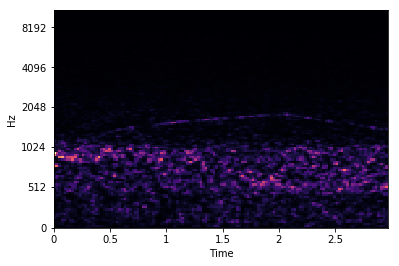

<Figure size 864x576 with 0 Axes>

In [8]:
# Sound of a Siren - spectrogram
librosa.display.specshow(ps, y_axis='mel', x_axis='time')
plt.figure(figsize=(12, 8))

In [9]:
# Sound of Air Conditioning - spectrogram
y, sr = librosa.load('UrbanSound8K/audio/fold1/134717-0-0-19.wav', duration=2.97)
ps = librosa.feature.melspectrogram(y=y, sr=sr)
ps.shape

(128, 128)

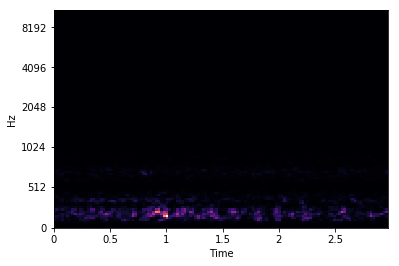

In [10]:
librosa.display.specshow(ps, y_axis='mel', x_axis='time')

In [11]:
# Sound of children playing - spectrogram
y, sr = librosa.load('UrbanSound8K/audio/fold9/13579-2-0-16.wav', duration=2.97)
ps = librosa.feature.melspectrogram(y=y, sr=sr)
ps.shape


(128, 128)

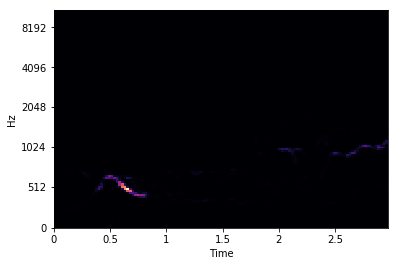

In [12]:
librosa.display.specshow(ps, y_axis='mel', x_axis='time')

In [13]:
# Sound of drilling - spectrogram
y, sr = librosa.load('UrbanSound8K/audio/fold9/137815-4-0-0.wav', duration=2.97)
ps = librosa.feature.melspectrogram(y=y, sr=sr)
ps.shape

(128, 128)

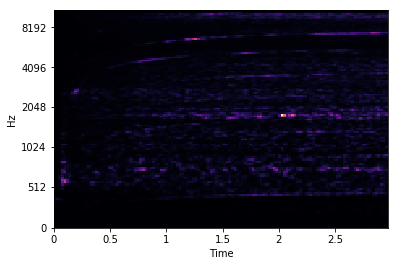

In [14]:
librosa.display.specshow(ps, y_axis='mel', x_axis='time')


In [15]:
valid_data['path'] = 'fold' + valid_data['fold'].astype('str') + '/' + valid_data['slice_file_name'].astype('str')

In [16]:
dataset = []


for row in valid_data.itertuples():
    y, sr = librosa.load('UrbanSound8K/audio/' + row.path, duration=2.97)
    ps = librosa.feature.melspectrogram(y=y, sr=sr)
    if ps.shape != (128, 128): continue
    dataset.append((ps, row.classID))
    

In [17]:
print('Number of samples: ', len(dataset))

Number of samples:  7467


In [18]:
random.shuffle(dataset)

train = dataset[:7000]
test = dataset[7000:]

X_train, y_train = zip(*train)
X_test, y_test = zip(*test)

# Reshape for CNN
X_train = np.array([x.reshape((128, 128, 1)) for x in X_train])
X_test = np.array([x.reshape((128, 128, 1)) for x in X_test])

# One hot encoding 
y_train = np.array(keras.utils.to_categorical(y_train, 10))
y_test = np.array(keras.utils.to_categorical(y_test, 10))

In [19]:
model = Sequential()
input_shape = (128, 128, 1)

model.add(Conv2D(24, (5, 5), strides=(1, 1), input_shape=input_shape))
model.add(MaxPool2D((4, 2), strides=(4, 2)))
model.add(Activation('relu'))

model.add(Conv2D(48, (5, 5), padding='valid'))
model.add(MaxPool2D((4, 2), strides=(4, 2)))
model.add(Activation('relu'))

model.add(Conv2D(48, (5, 5), padding='valid', activation='relu'))

model.add(Flatten())
model.add(Dropout(0.5))

model.add(Dense(64, activation='relu'))

model.add(Dropout(0.5))

model.add(Dense(10, activation='softmax'))



In [20]:
model.compile(optimizer="Adam",
              loss="categorical_crossentropy",
              metrics=['accuracy'])

checkpoint = keras.callbacks.ModelCheckpoint(filepath='model.hdf5', monitor='val_loss', save_best_only=True)

model.fit(x=X_train,
          y=y_train,
          epochs=30000,
          batch_size=128,
          validation_data=(X_test, y_test),
          callbacks=[checkpoint])

score = model.evaluate(x=X_test, y=y_test)

print('Test Loss: ', score[0])
print('Test Accuracy: ', score[1])

Train on 7000 samples, validate on 467 samples
Epoch 1/30000


 128/7000 [..............................] - ETA: 195s - loss: 4.9441 - acc: 0.0781

 256/7000 [>.............................] - ETA: 98s - loss: 4.4212 - acc: 0.0977 

 384/7000 [>.............................] - ETA: 65s - loss: 4.0909 - acc: 0.1224

 512/7000 [=>............................] - ETA: 49s - loss: 3.9030 - acc: 0.1367

 640/7000 [=>............................] - ETA: 40s - loss: 3.8952 - acc: 0.1391



 768/7000 [==>...........................] - ETA: 33s - loss: 3.7677 - acc: 0.1419

 896/7000 [==>...........................] - ETA: 28s - loss: 3.7371 - acc: 0.1585



1024/7000 [===>..........................] - ETA: 25s - loss: 3.5762 - acc: 0.1602



1152/7000 [===>..........................] - ETA: 22s - loss: 3.4790 - acc: 0.1606

1280/7000 [====>.........................] - ETA: 20s - loss: 3.3947 - acc: 0.1641

1408/7000 [=====>........................] - ETA: 18s - loss: 3.3397 - acc: 0.1641



1536/7000 [=====>........................] - ETA: 16s - loss: 3.2755 - acc: 0.1693



1664/7000 [======>.......................] - ETA: 15s - loss: 3.2515 - acc: 0.1677

1792/7000 [======>.......................] - ETA: 14s - loss: 3.2182 - acc: 0.1708

1920/7000 [=======>......................] - ETA: 13s - loss: 3.1758 - acc: 0.1729



2048/7000 [=======>......................] - ETA: 12s - loss: 3.1281 - acc: 0.1738

2176/7000 [========>.....................] - ETA: 11s - loss: 3.1011 - acc: 0.1742

2304/7000 [========>.....................] - ETA: 10s - loss: 3.0572 - acc: 0.1775

2432/7000 [=========>....................] - ETA: 10s - loss: 3.0213 - acc: 0.1793



2560/7000 [=========>....................] - ETA: 9s - loss: 2.9850 - acc: 0.1836 



2688/7000 [==========>...................] - ETA: 8s - loss: 2.9609 - acc: 0.1823

2816/7000 [===========>..................] - ETA: 8s - loss: 2.9452 - acc: 0.1854

2944/7000 [===========>..................] - ETA: 7s - loss: 2.9180 - acc: 0.1882

3072/7000 [============>.................] - ETA: 7s - loss: 2.9060 - acc: 0.1921

3200/7000 [============>.................] - ETA: 7s - loss: 2.8858 - acc: 0.1906

3328/7000 [=============>................] - ETA: 6s - loss: 2.8797 - acc: 0.1917

3456/7000 [=============>................] - ETA: 6s - loss: 2.8616 - acc: 0.1924

3584/7000 [==============>...............] - ETA: 5s - loss: 2.8473 - acc: 0.1925

3712/7000 [==============>...............] - ETA: 5s - loss: 2.8282 - acc: 0.1934

3840/7000 [===============>..............] - ETA: 5s - loss: 2.8163 - acc: 0.1945

3968/7000 [================>.............] - ETA: 4s - loss: 2.8033 - acc: 0.1935

4096/7000 [================>.............] - ETA: 4s - loss: 2.7864 - acc: 0.1941



4224/7000 [=================>............] - ETA: 4s - loss: 2.7785 - acc: 0.1953

4352/7000 [=================>............] - ETA: 4s - loss: 2.7609 - acc: 0.1978

4480/7000 [==================>...........] - ETA: 3s - loss: 2.7460 - acc: 0.2011

4608/7000 [==================>...........] - ETA: 3s - loss: 2.7294 - acc: 0.2023

4736/7000 [===================>..........] - ETA: 3s - loss: 2.7182 - acc: 0.2031

4864/7000 [===================>..........] - ETA: 3s - loss: 2.7019 - acc: 0.2050



4992/7000 [====================>.........] - ETA: 2s - loss: 2.6876 - acc: 0.2061



5120/7000 [====================>.........] - ETA: 2s - loss: 2.6793 - acc: 0.2061

5248/7000 [=====================>........] - ETA: 2s - loss: 2.6685 - acc: 0.2079

5376/7000 [======================>.......] - ETA: 2s - loss: 2.6563 - acc: 0.2094

5504/7000 [======================>.......] - ETA: 2s - loss: 2.6476 - acc: 0.2095

5632/7000 [=======================>......] - ETA: 1s - loss: 2.6347 - acc: 0.2109

5760/7000 [=======================>......] - ETA: 1s - loss: 2.6239 - acc: 0.2135

5888/7000 [========================>.....] - ETA: 1s - loss: 2.6145 - acc: 0.2148

6016/7000 [========================>.....] - ETA: 1s - loss: 2.6074 - acc: 0.2158

6144/7000 [=========================>....] - ETA: 1s - loss: 2.5973 - acc: 0.2174

6272/7000 [=========================>....] - ETA: 0s - loss: 2.5867 - acc: 0.2194

6400/7000 [==========================>...] - ETA: 0s - loss: 2.5798 - acc: 0.2214

6528/7000 [==========================>...] - ETA: 0s - loss: 2.5726 - acc: 0.2223

6656/7000 [===========================>..] - ETA: 0s - loss: 2.5645 - acc: 0.2233

6784/7000 [============================>.] - ETA: 0s - loss: 2.5541 - acc: 0.2261

6912/7000 [============================>.] - ETA: 0s - loss: 2.5471 - acc: 0.2284

7000/7000 [==============================] - 8s - loss: 2.5432 - acc: 0.2293 - val_loss: 2.0620 - val_acc: 0.3019


Epoch 2/30000
 128/7000 [..............................] - ETA: 4s - loss: 2.2947 - acc: 0.2578



 256/7000 [>.............................] - ETA: 4s - loss: 2.2166 - acc: 0.2734

 384/7000 [>.............................] - ETA: 4s - loss: 2.1784 - acc: 0.2786



 512/7000 [=>............................] - ETA: 4s - loss: 2.1917 - acc: 0.2812

 640/7000 [=>............................] - ETA: 4s - loss: 2.1607 - acc: 0.2953

 768/7000 [==>...........................] - ETA: 4s - loss: 2.1442 - acc: 0.2891

 896/7000 [==>...........................] - ETA: 4s - loss: 2.1626 - acc: 0.2868

1024/7000 [===>..........................] - ETA: 4s - loss: 2.1480 - acc: 0.2979

1152/7000 [===>..........................] - ETA: 3s - loss: 2.1461 - acc: 0.2960

1280/7000 [====>.........................] - ETA: 3s - loss: 2.1504 - acc: 0.2922

1408/7000 [=====>........................] - ETA: 3s - loss: 2.1382 - acc: 0.2997

1536/7000 [=====>........................] - ETA: 3s - loss: 2.1373 - acc: 0.3008

1664/7000 [======>.......................] - ETA: 3s - loss: 2.1469 - acc: 0.2987

1792/7000 [======>.......................] - ETA: 3s - loss: 2.1394 - acc: 0.2974

1920/7000 [=======>......................] - ETA: 3s - loss: 2.1315 - acc: 0.3005

2048/7000 [=======>......................] - ETA: 3s - loss: 2.1278 - acc: 0.3032

2176/7000 [========>.....................] - ETA: 3s - loss: 2.1239 - acc: 0.3042

2304/7000 [========>.....................] - ETA: 3s - loss: 2.1205 - acc: 0.3056

2432/7000 [=========>....................] - ETA: 3s - loss: 2.1151 - acc: 0.3059

2560/7000 [=========>....................] - ETA: 2s - loss: 2.1133 - acc: 0.3059

2688/7000 [==========>...................] - ETA: 2s - loss: 2.1133 - acc: 0.3047

2816/7000 [===========>..................] - ETA: 2s - loss: 2.1108 - acc: 0.3008

2944/7000 [===========>..................] - ETA: 2s - loss: 2.1074 - acc: 0.3006



3072/7000 [============>.................] - ETA: 2s - loss: 2.0992 - acc: 0.3037



3200/7000 [============>.................] - ETA: 2s - loss: 2.0966 - acc: 0.3053



3328/7000 [=============>................] - ETA: 2s - loss: 2.0923 - acc: 0.3074

3456/7000 [=============>................] - ETA: 2s - loss: 2.0931 - acc: 0.3093

3584/7000 [==============>...............] - ETA: 2s - loss: 2.0922 - acc: 0.3089



3712/7000 [==============>...............] - ETA: 2s - loss: 2.1039 - acc: 0.3087

3840/7000 [===============>..............] - ETA: 2s - loss: 2.1004 - acc: 0.3096

3968/7000 [================>.............] - ETA: 2s - loss: 2.0975 - acc: 0.3075

4096/7000 [================>.............] - ETA: 1s - loss: 2.0934 - acc: 0.3074

4224/7000 [=================>............] - ETA: 1s - loss: 2.0912 - acc: 0.3068

4352/7000 [=================>............] - ETA: 1s - loss: 2.0869 - acc: 0.3065

4480/7000 [==================>...........] - ETA: 1s - loss: 2.0866 - acc: 0.3063

4608/7000 [==================>...........] - ETA: 1s - loss: 2.0858 - acc: 0.3056

4736/7000 [===================>..........] - ETA: 1s - loss: 2.0842 - acc: 0.3051

4864/7000 [===================>..........] - ETA: 1s - loss: 2.0819 - acc: 0.3069

4992/7000 [====================>.........] - ETA: 1s - loss: 2.0840 - acc: 0.3065

5120/7000 [====================>.........] - ETA: 1s - loss: 2.0794 - acc: 0.3078

5248/7000 [=====================>........] - ETA: 1s - loss: 2.0770 - acc: 0.3079



5376/7000 [======================>.......] - ETA: 1s - loss: 2.0765 - acc: 0.3069



5504/7000 [======================>.......] - ETA: 1s - loss: 2.0726 - acc: 0.3078

5632/7000 [=======================>......] - ETA: 0s - loss: 2.0714 - acc: 0.3089

5760/7000 [=======================>......] - ETA: 0s - loss: 2.0700 - acc: 0.3094

5888/7000 [========================>.....] - ETA: 0s - loss: 2.0690 - acc: 0.3108

6016/7000 [========================>.....] - ETA: 0s - loss: 2.0662 - acc: 0.3108

6144/7000 [=========================>....] - ETA: 0s - loss: 2.0644 - acc: 0.3109

6272/7000 [=========================>....] - ETA: 0s - loss: 2.0614 - acc: 0.3117

6400/7000 [==========================>...] - ETA: 0s - loss: 2.0586 - acc: 0.3113

6528/7000 [==========================>...] - ETA: 0s - loss: 2.0574 - acc: 0.3122

6656/7000 [===========================>..] - ETA: 0s - loss: 2.0547 - acc: 0.3117

6784/7000 [============================>.] - ETA: 0s - loss: 2.0533 - acc: 0.3115

6912/7000 [============================>.] - ETA: 0s - loss: 2.0495 - acc: 0.3115

7000/7000 [==============================] - 4s - loss: 2.0461 - acc: 0.3117 - val_loss: 1.8248 - val_acc: 0.3812


Epoch 3/30000
 128/7000 [..............................] - ETA: 4s - loss: 1.9036 - acc: 0.3516

 256/7000 [>.............................] - ETA: 4s - loss: 1.8632 - acc: 0.3516

 384/7000 [>.............................] - ETA: 4s - loss: 1.9032 - acc: 0.3568

 512/7000 [=>............................] - ETA: 4s - loss: 1.9004 - acc: 0.3555

 640/7000 [=>............................] - ETA: 4s - loss: 1.8856 - acc: 0.3531

 768/7000 [==>...........................] - ETA: 4s - loss: 1.8869 - acc: 0.3503

 896/7000 [==>...........................] - ETA: 4s - loss: 1.8760 - acc: 0.3560

1024/7000 [===>..........................] - ETA: 3s - loss: 1.8815 - acc: 0.3506

1152/7000 [===>..........................] - ETA: 3s - loss: 1.8945 - acc: 0.3533

1280/7000 [====>.........................] - ETA: 3s - loss: 1.8745 - acc: 0.3602

1408/7000 [=====>........................] - ETA: 3s - loss: 1.8625 - acc: 0.3608

1536/7000 [=====>........................] - ETA: 3s - loss: 1.8605 - acc: 0.3574

1664/7000 [======>.......................] - ETA: 3s - loss: 1.8701 - acc: 0.3516



1792/7000 [======>.......................] - ETA: 3s - loss: 1.8691 - acc: 0.3493

1920/7000 [=======>......................] - ETA: 3s - loss: 1.8650 - acc: 0.3516

2048/7000 [=======>......................] - ETA: 3s - loss: 1.8702 - acc: 0.3491



2176/7000 [========>.....................] - ETA: 3s - loss: 1.8733 - acc: 0.3474

2304/7000 [========>.....................] - ETA: 3s - loss: 1.8722 - acc: 0.3477

2432/7000 [=========>....................] - ETA: 3s - loss: 1.8693 - acc: 0.3495

2560/7000 [=========>....................] - ETA: 2s - loss: 1.8696 - acc: 0.3496

2688/7000 [==========>...................] - ETA: 2s - loss: 1.8699 - acc: 0.3490

2816/7000 [===========>..................] - ETA: 2s - loss: 1.8729 - acc: 0.3494

2944/7000 [===========>..................] - ETA: 2s - loss: 1.8749 - acc: 0.3512

3072/7000 [============>.................] - ETA: 2s - loss: 1.8764 - acc: 0.3522

3200/7000 [============>.................] - ETA: 2s - loss: 1.8807 - acc: 0.3503

3328/7000 [=============>................] - ETA: 2s - loss: 1.8792 - acc: 0.3510

3456/7000 [=============>................] - ETA: 2s - loss: 1.8782 - acc: 0.3507

3584/7000 [==============>...............] - ETA: 2s - loss: 1.8753 - acc: 0.3510

3712/7000 [==============>...............] - ETA: 2s - loss: 1.8746 - acc: 0.3486

3840/7000 [===============>..............] - ETA: 2s - loss: 1.8723 - acc: 0.3492

3968/7000 [================>.............] - ETA: 2s - loss: 1.8664 - acc: 0.3521

4096/7000 [================>.............] - ETA: 1s - loss: 1.8603 - acc: 0.3535

4224/7000 [=================>............] - ETA: 1s - loss: 1.8632 - acc: 0.3546

4352/7000 [=================>............] - ETA: 1s - loss: 1.8632 - acc: 0.3534



4480/7000 [==================>...........] - ETA: 1s - loss: 1.8633 - acc: 0.3529

4608/7000 [==================>...........] - ETA: 1s - loss: 1.8622 - acc: 0.3507

4736/7000 [===================>..........] - ETA: 1s - loss: 1.8629 - acc: 0.3514



4864/7000 [===================>..........] - ETA: 1s - loss: 1.8576 - acc: 0.3518



4992/7000 [====================>.........] - ETA: 1s - loss: 1.8569 - acc: 0.3526



5120/7000 [====================>.........] - ETA: 1s - loss: 1.8542 - acc: 0.3533



5248/7000 [=====================>........] - ETA: 1s - loss: 1.8533 - acc: 0.3525

5376/7000 [======================>.......] - ETA: 1s - loss: 1.8541 - acc: 0.3544

5504/7000 [======================>.......] - ETA: 1s - loss: 1.8519 - acc: 0.3541



5632/7000 [=======================>......] - ETA: 0s - loss: 1.8519 - acc: 0.3549

5760/7000 [=======================>......] - ETA: 0s - loss: 1.8520 - acc: 0.3543

5888/7000 [========================>.....] - ETA: 0s - loss: 1.8484 - acc: 0.3555

6016/7000 [========================>.....] - ETA: 0s - loss: 1.8479 - acc: 0.3565

6144/7000 [=========================>....] - ETA: 0s - loss: 1.8470 - acc: 0.3568

6272/7000 [=========================>....] - ETA: 0s - loss: 1.8457 - acc: 0.3570

6400/7000 [==========================>...] - ETA: 0s - loss: 1.8462 - acc: 0.3558

6528/7000 [==========================>...] - ETA: 0s - loss: 1.8424 - acc: 0.3563

6656/7000 [===========================>..] - ETA: 0s - loss: 1.8412 - acc: 0.3564

6784/7000 [============================>.] - ETA: 0s - loss: 1.8386 - acc: 0.3575

6912/7000 [============================>.] - ETA: 0s - loss: 1.8350 - acc: 0.3588

7000/7000 [==============================] - 4s - loss: 1.8334 - acc: 0.3597 - val_loss: 1.6485 - val_acc: 0.4454


Epoch 4/30000
 128/7000 [..............................] - ETA: 4s - loss: 1.8370 - acc: 0.4141



 256/7000 [>.............................] - ETA: 4s - loss: 1.8308 - acc: 0.3828

 384/7000 [>.............................] - ETA: 4s - loss: 1.7626 - acc: 0.4167

 512/7000 [=>............................] - ETA: 4s - loss: 1.7443 - acc: 0.4121

 640/7000 [=>............................] - ETA: 4s - loss: 1.7682 - acc: 0.3937

 768/7000 [==>...........................] - ETA: 4s - loss: 1.7470 - acc: 0.3984

 896/7000 [==>...........................] - ETA: 4s - loss: 1.7473 - acc: 0.3984



1024/7000 [===>..........................] - ETA: 4s - loss: 1.7315 - acc: 0.3975

1152/7000 [===>..........................] - ETA: 4s - loss: 1.7245 - acc: 0.4010

1280/7000 [====>.........................] - ETA: 3s - loss: 1.7246 - acc: 0.4008

1408/7000 [=====>........................] - ETA: 3s - loss: 1.7237 - acc: 0.3984

1536/7000 [=====>........................] - ETA: 3s - loss: 1.7185 - acc: 0.3978

1664/7000 [======>.......................] - ETA: 3s - loss: 1.7151 - acc: 0.4020

1792/7000 [======>.......................] - ETA: 3s - loss: 1.7160 - acc: 0.4001

1920/7000 [=======>......................] - ETA: 3s - loss: 1.7198 - acc: 0.3995

2048/7000 [=======>......................] - ETA: 3s - loss: 1.7238 - acc: 0.4014

2176/7000 [========>.....................] - ETA: 3s - loss: 1.7196 - acc: 0.4021

2304/7000 [========>.....................] - ETA: 3s - loss: 1.7140 - acc: 0.4041

2432/7000 [=========>....................] - ETA: 3s - loss: 1.7216 - acc: 0.4071

2560/7000 [=========>....................] - ETA: 2s - loss: 1.7189 - acc: 0.4070

2688/7000 [==========>...................] - ETA: 2s - loss: 1.7252 - acc: 0.4077



2816/7000 [===========>..................] - ETA: 2s - loss: 1.7227 - acc: 0.4119

2944/7000 [===========>..................] - ETA: 2s - loss: 1.7235 - acc: 0.4127

3072/7000 [============>.................] - ETA: 2s - loss: 1.7247 - acc: 0.4137



3200/7000 [============>.................] - ETA: 2s - loss: 1.7242 - acc: 0.4147



3328/7000 [=============>................] - ETA: 2s - loss: 1.7185 - acc: 0.4159

3456/7000 [=============>................] - ETA: 2s - loss: 1.7160 - acc: 0.4155



3584/7000 [==============>...............] - ETA: 2s - loss: 1.7097 - acc: 0.4149



3712/7000 [==============>...............] - ETA: 2s - loss: 1.7022 - acc: 0.4165

3840/7000 [===============>..............] - ETA: 2s - loss: 1.6949 - acc: 0.4188

3968/7000 [================>.............] - ETA: 2s - loss: 1.6949 - acc: 0.4181



4096/7000 [================>.............] - ETA: 1s - loss: 1.6936 - acc: 0.4170

4224/7000 [=================>............] - ETA: 1s - loss: 1.6937 - acc: 0.4152

4352/7000 [=================>............] - ETA: 1s - loss: 1.6894 - acc: 0.4152

4480/7000 [==================>...........] - ETA: 1s - loss: 1.6917 - acc: 0.4141

4608/7000 [==================>...........] - ETA: 1s - loss: 1.6957 - acc: 0.4128

4736/7000 [===================>..........] - ETA: 1s - loss: 1.6974 - acc: 0.4124

4864/7000 [===================>..........] - ETA: 1s - loss: 1.6987 - acc: 0.4118

4992/7000 [====================>.........] - ETA: 1s - loss: 1.7004 - acc: 0.4113

5120/7000 [====================>.........] - ETA: 1s - loss: 1.6997 - acc: 0.4125

5248/7000 [=====================>........] - ETA: 1s - loss: 1.6952 - acc: 0.4120

5376/7000 [======================>.......] - ETA: 1s - loss: 1.6921 - acc: 0.4111

5504/7000 [======================>.......] - ETA: 1s - loss: 1.6914 - acc: 0.4106

5632/7000 [=======================>......] - ETA: 0s - loss: 1.6888 - acc: 0.4107

5760/7000 [=======================>......] - ETA: 0s - loss: 1.6883 - acc: 0.4102

5888/7000 [========================>.....] - ETA: 0s - loss: 1.6831 - acc: 0.4117

6016/7000 [========================>.....] - ETA: 0s - loss: 1.6843 - acc: 0.4109

6144/7000 [=========================>....] - ETA: 0s - loss: 1.6860 - acc: 0.4105

6272/7000 [=========================>....] - ETA: 0s - loss: 1.6833 - acc: 0.4099

6400/7000 [==========================>...] - ETA: 0s - loss: 1.6829 - acc: 0.4116

6528/7000 [==========================>...] - ETA: 0s - loss: 1.6811 - acc: 0.4119

6656/7000 [===========================>..] - ETA: 0s - loss: 1.6794 - acc: 0.4133



6784/7000 [============================>.] - ETA: 0s - loss: 1.6799 - acc: 0.4135



6912/7000 [============================>.] - ETA: 0s - loss: 1.6794 - acc: 0.4138

7000/7000 [==============================] - 4s - loss: 1.6806 - acc: 0.4127 - val_loss: 1.6112 - val_acc: 0.4154


Epoch 5/30000
 128/7000 [..............................] - ETA: 4s - loss: 1.6938 - acc: 0.3516

 256/7000 [>.............................] - ETA: 4s - loss: 1.6246 - acc: 0.3867

 384/7000 [>.............................] - ETA: 4s - loss: 1.6382 - acc: 0.3932

 512/7000 [=>............................] - ETA: 4s - loss: 1.6068 - acc: 0.4121

 640/7000 [=>............................] - ETA: 4s - loss: 1.6258 - acc: 0.4094

 768/7000 [==>...........................] - ETA: 4s - loss: 1.6121 - acc: 0.4102

 896/7000 [==>...........................] - ETA: 4s - loss: 1.6238 - acc: 0.4062

1024/7000 [===>..........................] - ETA: 3s - loss: 1.6101 - acc: 0.4131

1152/7000 [===>..........................] - ETA: 3s - loss: 1.6048 - acc: 0.4184

1280/7000 [====>.........................] - ETA: 3s - loss: 1.5954 - acc: 0.4188

1408/7000 [=====>........................] - ETA: 3s - loss: 1.6128 - acc: 0.4112

1536/7000 [=====>........................] - ETA: 3s - loss: 1.5999 - acc: 0.4238

1664/7000 [======>.......................] - ETA: 3s - loss: 1.6153 - acc: 0.4201

1792/7000 [======>.......................] - ETA: 3s - loss: 1.6210 - acc: 0.4185



1920/7000 [=======>......................] - ETA: 3s - loss: 1.6146 - acc: 0.4167

2048/7000 [=======>......................] - ETA: 3s - loss: 1.6097 - acc: 0.4238



2176/7000 [========>.....................] - ETA: 3s - loss: 1.6005 - acc: 0.4274

2304/7000 [========>.....................] - ETA: 3s - loss: 1.6016 - acc: 0.4288

2432/7000 [=========>....................] - ETA: 3s - loss: 1.6066 - acc: 0.4280



2560/7000 [=========>....................] - ETA: 3s - loss: 1.6034 - acc: 0.4289

2688/7000 [==========>...................] - ETA: 2s - loss: 1.6028 - acc: 0.4286

2816/7000 [===========>..................] - ETA: 2s - loss: 1.5934 - acc: 0.4311

2944/7000 [===========>..................] - ETA: 2s - loss: 1.5868 - acc: 0.4348

3072/7000 [============>.................] - ETA: 2s - loss: 1.5781 - acc: 0.4365

3200/7000 [============>.................] - ETA: 2s - loss: 1.5813 - acc: 0.4369

3328/7000 [=============>................] - ETA: 2s - loss: 1.5811 - acc: 0.4384

3456/7000 [=============>................] - ETA: 2s - loss: 1.5832 - acc: 0.4407

3584/7000 [==============>...............] - ETA: 2s - loss: 1.5736 - acc: 0.4445

3712/7000 [==============>...............] - ETA: 2s - loss: 1.5778 - acc: 0.4440

3840/7000 [===============>..............] - ETA: 2s - loss: 1.5770 - acc: 0.4424

3968/7000 [================>.............] - ETA: 2s - loss: 1.5743 - acc: 0.4451

4096/7000 [================>.............] - ETA: 1s - loss: 1.5804 - acc: 0.4448

4224/7000 [=================>............] - ETA: 1s - loss: 1.5796 - acc: 0.4453

4352/7000 [=================>............] - ETA: 1s - loss: 1.5808 - acc: 0.4442



4480/7000 [==================>...........] - ETA: 1s - loss: 1.5776 - acc: 0.4449

4608/7000 [==================>...........] - ETA: 1s - loss: 1.5726 - acc: 0.4462

4736/7000 [===================>..........] - ETA: 1s - loss: 1.5707 - acc: 0.4468

4864/7000 [===================>..........] - ETA: 1s - loss: 1.5670 - acc: 0.4474

4992/7000 [====================>.........] - ETA: 1s - loss: 1.5796 - acc: 0.4461

5120/7000 [====================>.........] - ETA: 1s - loss: 1.5766 - acc: 0.4475

5248/7000 [=====================>........] - ETA: 1s - loss: 1.5758 - acc: 0.4474

5376/7000 [======================>.......] - ETA: 1s - loss: 1.5729 - acc: 0.4488

5504/7000 [======================>.......] - ETA: 1s - loss: 1.5698 - acc: 0.4495

5632/7000 [=======================>......] - ETA: 0s - loss: 1.5714 - acc: 0.4490

5760/7000 [=======================>......] - ETA: 0s - loss: 1.5709 - acc: 0.4493

5888/7000 [========================>.....] - ETA: 0s - loss: 1.5679 - acc: 0.4513

6016/7000 [========================>.....] - ETA: 0s - loss: 1.5686 - acc: 0.4510

6144/7000 [=========================>....] - ETA: 0s - loss: 1.5657 - acc: 0.4517

6272/7000 [=========================>....] - ETA: 0s - loss: 1.5647 - acc: 0.4514



6400/7000 [==========================>...] - ETA: 0s - loss: 1.5648 - acc: 0.4505

6528/7000 [==========================>...] - ETA: 0s - loss: 1.5635 - acc: 0.4511

6656/7000 [===========================>..] - ETA: 0s - loss: 1.5627 - acc: 0.4512

6784/7000 [============================>.] - ETA: 0s - loss: 1.5613 - acc: 0.4514

6912/7000 [============================>.] - ETA: 0s - loss: 1.5606 - acc: 0.4512

7000/7000 [==============================] - 4s - loss: 1.5609 - acc: 0.4500 - val_loss: 1.4032 - val_acc: 0.5460


Epoch 6/30000
 128/7000 [..............................] - ETA: 4s - loss: 1.4186 - acc: 0.4922

 256/7000 [>.............................] - ETA: 4s - loss: 1.4651 - acc: 0.4453

 384/7000 [>.............................] - ETA: 4s - loss: 1.4124 - acc: 0.4896

 512/7000 [=>............................] - ETA: 4s - loss: 1.4640 - acc: 0.4746

 640/7000 [=>............................] - ETA: 4s - loss: 1.4645 - acc: 0.4828



 768/7000 [==>...........................] - ETA: 4s - loss: 1.4516 - acc: 0.4987



 896/7000 [==>...........................] - ETA: 4s - loss: 1.4704 - acc: 0.4933

1024/7000 [===>..........................] - ETA: 4s - loss: 1.4719 - acc: 0.4941

1152/7000 [===>..........................] - ETA: 3s - loss: 1.4825 - acc: 0.4878

1280/7000 [====>.........................] - ETA: 3s - loss: 1.4863 - acc: 0.4883

1408/7000 [=====>........................] - ETA: 3s - loss: 1.4869 - acc: 0.4858

1536/7000 [=====>........................] - ETA: 3s - loss: 1.4783 - acc: 0.4922

1664/7000 [======>.......................] - ETA: 3s - loss: 1.4799 - acc: 0.4904

1792/7000 [======>.......................] - ETA: 3s - loss: 1.4802 - acc: 0.4916

1920/7000 [=======>......................] - ETA: 3s - loss: 1.4804 - acc: 0.4870

2048/7000 [=======>......................] - ETA: 3s - loss: 1.4839 - acc: 0.4883

2176/7000 [========>.....................] - ETA: 3s - loss: 1.4833 - acc: 0.4890

2304/7000 [========>.....................] - ETA: 3s - loss: 1.4808 - acc: 0.4909

2432/7000 [=========>....................] - ETA: 3s - loss: 1.4812 - acc: 0.4893

2560/7000 [=========>....................] - ETA: 2s - loss: 1.4781 - acc: 0.4902

2688/7000 [==========>...................] - ETA: 2s - loss: 1.4855 - acc: 0.4877

2816/7000 [===========>..................] - ETA: 2s - loss: 1.4833 - acc: 0.4890

2944/7000 [===========>..................] - ETA: 2s - loss: 1.4831 - acc: 0.4881

3072/7000 [============>.................] - ETA: 2s - loss: 1.4871 - acc: 0.4873

3200/7000 [============>.................] - ETA: 2s - loss: 1.4879 - acc: 0.4878

3328/7000 [=============>................] - ETA: 2s - loss: 1.4893 - acc: 0.4862

3456/7000 [=============>................] - ETA: 2s - loss: 1.4898 - acc: 0.4855

3584/7000 [==============>...............] - ETA: 2s - loss: 1.4831 - acc: 0.4888



3712/7000 [==============>...............] - ETA: 2s - loss: 1.4851 - acc: 0.4887

3840/7000 [===============>..............] - ETA: 2s - loss: 1.4857 - acc: 0.4867

3968/7000 [================>.............] - ETA: 2s - loss: 1.4894 - acc: 0.4879



4096/7000 [================>.............] - ETA: 1s - loss: 1.4884 - acc: 0.4885

4224/7000 [=================>............] - ETA: 1s - loss: 1.4842 - acc: 0.4886



4352/7000 [=================>............] - ETA: 1s - loss: 1.4819 - acc: 0.4885

4480/7000 [==================>...........] - ETA: 1s - loss: 1.4858 - acc: 0.4886



4608/7000 [==================>...........] - ETA: 1s - loss: 1.4873 - acc: 0.4881

4736/7000 [===================>..........] - ETA: 1s - loss: 1.4879 - acc: 0.4880

4864/7000 [===================>..........] - ETA: 1s - loss: 1.4840 - acc: 0.4897

4992/7000 [====================>.........] - ETA: 1s - loss: 1.4821 - acc: 0.4900

5120/7000 [====================>.........] - ETA: 1s - loss: 1.4802 - acc: 0.4906

5248/7000 [=====================>........] - ETA: 1s - loss: 1.4810 - acc: 0.4903

5376/7000 [======================>.......] - ETA: 1s - loss: 1.4766 - acc: 0.4913

5504/7000 [======================>.......] - ETA: 1s - loss: 1.4759 - acc: 0.4896

5632/7000 [=======================>......] - ETA: 0s - loss: 1.4708 - acc: 0.4913

5760/7000 [=======================>......] - ETA: 0s - loss: 1.4705 - acc: 0.4922

5888/7000 [========================>.....] - ETA: 0s - loss: 1.4681 - acc: 0.4920

6016/7000 [========================>.....] - ETA: 0s - loss: 1.4669 - acc: 0.4927

6144/7000 [=========================>....] - ETA: 0s - loss: 1.4661 - acc: 0.4909

6272/7000 [=========================>....] - ETA: 0s - loss: 1.4660 - acc: 0.4901

6400/7000 [==========================>...] - ETA: 0s - loss: 1.4679 - acc: 0.4884

6528/7000 [==========================>...] - ETA: 0s - loss: 1.4691 - acc: 0.4881



6656/7000 [===========================>..] - ETA: 0s - loss: 1.4710 - acc: 0.4866

6784/7000 [============================>.] - ETA: 0s - loss: 1.4668 - acc: 0.4885

6912/7000 [============================>.] - ETA: 0s - loss: 1.4647 - acc: 0.4886

7000/7000 [==============================] - 4s - loss: 1.4629 - acc: 0.4886 - val_loss: 1.3094 - val_acc: 0.5503


Epoch 7/30000
 128/7000 [..............................] - ETA: 4s - loss: 1.4124 - acc: 0.5156

 256/7000 [>.............................] - ETA: 4s - loss: 1.4569 - acc: 0.4766

 384/7000 [>.............................] - ETA: 4s - loss: 1.4238 - acc: 0.4896

 512/7000 [=>............................] - ETA: 4s - loss: 1.4196 - acc: 0.5039

 640/7000 [=>............................] - ETA: 4s - loss: 1.3888 - acc: 0.5141

 768/7000 [==>...........................] - ETA: 4s - loss: 1.3660 - acc: 0.5182

 896/7000 [==>...........................] - ETA: 4s - loss: 1.3592 - acc: 0.5212

1024/7000 [===>..........................] - ETA: 3s - loss: 1.3577 - acc: 0.5244

1152/7000 [===>..........................] - ETA: 3s - loss: 1.3589 - acc: 0.5234

1280/7000 [====>.........................] - ETA: 3s - loss: 1.3725 - acc: 0.5211

1408/7000 [=====>........................] - ETA: 3s - loss: 1.3709 - acc: 0.5199

1536/7000 [=====>........................] - ETA: 3s - loss: 1.3743 - acc: 0.5208

1664/7000 [======>.......................] - ETA: 3s - loss: 1.3574 - acc: 0.5270

1792/7000 [======>.......................] - ETA: 3s - loss: 1.3474 - acc: 0.5346

1920/7000 [=======>......................] - ETA: 3s - loss: 1.3429 - acc: 0.5344



2048/7000 [=======>......................] - ETA: 3s - loss: 1.3554 - acc: 0.5327

2176/7000 [========>.....................] - ETA: 3s - loss: 1.3468 - acc: 0.5358

2304/7000 [========>.....................] - ETA: 3s - loss: 1.3549 - acc: 0.5334

2432/7000 [=========>....................] - ETA: 3s - loss: 1.3732 - acc: 0.5259

2560/7000 [=========>....................] - ETA: 2s - loss: 1.3728 - acc: 0.5297



2688/7000 [==========>...................] - ETA: 2s - loss: 1.3728 - acc: 0.5312



2816/7000 [===========>..................] - ETA: 2s - loss: 1.3739 - acc: 0.5327

2944/7000 [===========>..................] - ETA: 2s - loss: 1.3758 - acc: 0.5316

3072/7000 [============>.................] - ETA: 2s - loss: 1.3802 - acc: 0.5312

3200/7000 [============>.................] - ETA: 2s - loss: 1.3855 - acc: 0.5288



3328/7000 [=============>................] - ETA: 2s - loss: 1.3904 - acc: 0.5249

3456/7000 [=============>................] - ETA: 2s - loss: 1.3959 - acc: 0.5211

3584/7000 [==============>...............] - ETA: 2s - loss: 1.3951 - acc: 0.5218

3712/7000 [==============>...............] - ETA: 2s - loss: 1.4006 - acc: 0.5221

3840/7000 [===============>..............] - ETA: 2s - loss: 1.3999 - acc: 0.5224

3968/7000 [================>.............] - ETA: 2s - loss: 1.4070 - acc: 0.5197

4096/7000 [================>.............] - ETA: 1s - loss: 1.4055 - acc: 0.5203

4224/7000 [=================>............] - ETA: 1s - loss: 1.4044 - acc: 0.5215

4352/7000 [=================>............] - ETA: 1s - loss: 1.4071 - acc: 0.5188

4480/7000 [==================>...........] - ETA: 1s - loss: 1.4117 - acc: 0.5170

4608/7000 [==================>...........] - ETA: 1s - loss: 1.4095 - acc: 0.5167

4736/7000 [===================>..........] - ETA: 1s - loss: 1.4145 - acc: 0.5169

4864/7000 [===================>..........] - ETA: 1s - loss: 1.4115 - acc: 0.5181

4992/7000 [====================>.........] - ETA: 1s - loss: 1.4088 - acc: 0.5196

5120/7000 [====================>.........] - ETA: 1s - loss: 1.4076 - acc: 0.5201

5248/7000 [=====================>........] - ETA: 1s - loss: 1.4092 - acc: 0.5191

5376/7000 [======================>.......] - ETA: 1s - loss: 1.4153 - acc: 0.5160

5504/7000 [======================>.......] - ETA: 0s - loss: 1.4187 - acc: 0.5160



5632/7000 [=======================>......] - ETA: 0s - loss: 1.4171 - acc: 0.5165

5760/7000 [=======================>......] - ETA: 0s - loss: 1.4124 - acc: 0.5188

5888/7000 [========================>.....] - ETA: 0s - loss: 1.4138 - acc: 0.5190



6016/7000 [========================>.....] - ETA: 0s - loss: 1.4196 - acc: 0.5180

6144/7000 [=========================>....] - ETA: 0s - loss: 1.4207 - acc: 0.5174

6272/7000 [=========================>....] - ETA: 0s - loss: 1.4246 - acc: 0.5169

6400/7000 [==========================>...] - ETA: 0s - loss: 1.4228 - acc: 0.5170

6528/7000 [==========================>...] - ETA: 0s - loss: 1.4251 - acc: 0.5158

6656/7000 [===========================>..] - ETA: 0s - loss: 1.4271 - acc: 0.5149

6784/7000 [============================>.] - ETA: 0s - loss: 1.4302 - acc: 0.5134



6912/7000 [============================>.] - ETA: 0s - loss: 1.4297 - acc: 0.5127

7000/7000 [==============================] - 4s - loss: 1.4295 - acc: 0.5111 - val_loss: 1.3752 - val_acc: 0.4989


Epoch 8/30000
 128/7000 [..............................] - ETA: 4s - loss: 1.5140 - acc: 0.4297

 256/7000 [>.............................] - ETA: 4s - loss: 1.5073 - acc: 0.4609

 384/7000 [>.............................] - ETA: 4s - loss: 1.4686 - acc: 0.4766

 512/7000 [=>............................] - ETA: 4s - loss: 1.5372 - acc: 0.4805

 640/7000 [=>............................] - ETA: 4s - loss: 1.5062 - acc: 0.4844

 768/7000 [==>...........................] - ETA: 4s - loss: 1.4786 - acc: 0.4974

 896/7000 [==>...........................] - ETA: 4s - loss: 1.4902 - acc: 0.4922

1024/7000 [===>..........................] - ETA: 3s - loss: 1.4636 - acc: 0.4961



1152/7000 [===>..........................] - ETA: 3s - loss: 1.4481 - acc: 0.4991



1280/7000 [====>.........................] - ETA: 3s - loss: 1.4418 - acc: 0.5086



1408/7000 [=====>........................] - ETA: 3s - loss: 1.4295 - acc: 0.5092



1536/7000 [=====>........................] - ETA: 3s - loss: 1.4319 - acc: 0.5085

1664/7000 [======>.......................] - ETA: 3s - loss: 1.4214 - acc: 0.5102

1792/7000 [======>.......................] - ETA: 3s - loss: 1.4256 - acc: 0.5128

1920/7000 [=======>......................] - ETA: 3s - loss: 1.4185 - acc: 0.5167

2048/7000 [=======>......................] - ETA: 3s - loss: 1.4108 - acc: 0.5156



2176/7000 [========>.....................] - ETA: 3s - loss: 1.4047 - acc: 0.5188

2304/7000 [========>.....................] - ETA: 3s - loss: 1.3996 - acc: 0.5195

2432/7000 [=========>....................] - ETA: 3s - loss: 1.3941 - acc: 0.5181

2560/7000 [=========>....................] - ETA: 3s - loss: 1.3979 - acc: 0.5145

2688/7000 [==========>...................] - ETA: 2s - loss: 1.4014 - acc: 0.5153

2816/7000 [===========>..................] - ETA: 2s - loss: 1.3941 - acc: 0.5170

2944/7000 [===========>..................] - ETA: 2s - loss: 1.3954 - acc: 0.5183

3072/7000 [============>.................] - ETA: 2s - loss: 1.3910 - acc: 0.5179

3200/7000 [============>.................] - ETA: 2s - loss: 1.3881 - acc: 0.5206

3328/7000 [=============>................] - ETA: 2s - loss: 1.3857 - acc: 0.5204

3456/7000 [=============>................] - ETA: 2s - loss: 1.3911 - acc: 0.5223

3584/7000 [==============>...............] - ETA: 2s - loss: 1.3877 - acc: 0.5234

3712/7000 [==============>...............] - ETA: 2s - loss: 1.3858 - acc: 0.5242

3840/7000 [===============>..............] - ETA: 2s - loss: 1.3850 - acc: 0.5255

3968/7000 [================>.............] - ETA: 2s - loss: 1.3856 - acc: 0.5260

4096/7000 [================>.............] - ETA: 1s - loss: 1.3813 - acc: 0.5264



4224/7000 [=================>............] - ETA: 1s - loss: 1.3785 - acc: 0.5270



4352/7000 [=================>............] - ETA: 1s - loss: 1.3722 - acc: 0.5287



4480/7000 [==================>...........] - ETA: 1s - loss: 1.3725 - acc: 0.5275



4608/7000 [==================>...........] - ETA: 1s - loss: 1.3675 - acc: 0.5282

4736/7000 [===================>..........] - ETA: 1s - loss: 1.3741 - acc: 0.5264

4864/7000 [===================>..........] - ETA: 1s - loss: 1.3718 - acc: 0.5251

4992/7000 [====================>.........] - ETA: 1s - loss: 1.3704 - acc: 0.5256

5120/7000 [====================>.........] - ETA: 1s - loss: 1.3677 - acc: 0.5268



5248/7000 [=====================>........] - ETA: 1s - loss: 1.3632 - acc: 0.5272



5376/7000 [======================>.......] - ETA: 1s - loss: 1.3661 - acc: 0.5255



5504/7000 [======================>.......] - ETA: 1s - loss: 1.3683 - acc: 0.5245

5632/7000 [=======================>......] - ETA: 0s - loss: 1.3657 - acc: 0.5245

5760/7000 [=======================>......] - ETA: 0s - loss: 1.3651 - acc: 0.5243

5888/7000 [========================>.....] - ETA: 0s - loss: 1.3616 - acc: 0.5256

6016/7000 [========================>.....] - ETA: 0s - loss: 1.3639 - acc: 0.5249

6144/7000 [=========================>....] - ETA: 0s - loss: 1.3626 - acc: 0.5254

6272/7000 [=========================>....] - ETA: 0s - loss: 1.3577 - acc: 0.5265

6400/7000 [==========================>...] - ETA: 0s - loss: 1.3537 - acc: 0.5269

6528/7000 [==========================>...] - ETA: 0s - loss: 1.3555 - acc: 0.5267

6656/7000 [===========================>..] - ETA: 0s - loss: 1.3557 - acc: 0.5272

6784/7000 [============================>.] - ETA: 0s - loss: 1.3538 - acc: 0.5284



6912/7000 [============================>.] - ETA: 0s - loss: 1.3514 - acc: 0.5286

7000/7000 [==============================] - 4s - loss: 1.3507 - acc: 0.5287 - val_loss: 1.1834 - val_acc: 0.6060


Epoch 9/30000
 128/7000 [..............................] - ETA: 4s - loss: 1.2070 - acc: 0.5547

 256/7000 [>.............................] - ETA: 4s - loss: 1.1888 - acc: 0.5586

 384/7000 [>.............................] - ETA: 4s - loss: 1.2370 - acc: 0.5703

 512/7000 [=>............................] - ETA: 4s - loss: 1.2493 - acc: 0.5742

 640/7000 [=>............................] - ETA: 4s - loss: 1.2152 - acc: 0.5844

 768/7000 [==>...........................] - ETA: 4s - loss: 1.2498 - acc: 0.5690

 896/7000 [==>...........................] - ETA: 4s - loss: 1.2362 - acc: 0.5714

1024/7000 [===>..........................] - ETA: 3s - loss: 1.2360 - acc: 0.5713



1152/7000 [===>..........................] - ETA: 3s - loss: 1.2340 - acc: 0.5686

1280/7000 [====>.........................] - ETA: 3s - loss: 1.2328 - acc: 0.5680

1408/7000 [=====>........................] - ETA: 3s - loss: 1.2353 - acc: 0.5639



1536/7000 [=====>........................] - ETA: 3s - loss: 1.2472 - acc: 0.5618

1664/7000 [======>.......................]

 - ETA: 3s - loss: 1.2679 - acc: 0.5547

1792/7000 [======>.......................] - ETA: 3s - loss: 1.2770 - acc: 0.5519

1920/7000 [=======>......................] - ETA: 3s - loss: 1.2779 - acc: 0.5526

2048/7000 [=======>......................] - ETA: 3s - loss: 1.2877 - acc: 0.5454

2176/7000 [========>.....................] - ETA: 3s - loss: 1.2908 - acc: 0.5478

2304/7000 [========>.....................] - ETA: 3s - loss: 1.2958 - acc: 0.5469

2432/7000 [=========>....................] - ETA: 3s - loss: 1.2886 - acc: 0.5473



2560/7000 [=========>....................] - ETA: 3s - loss: 1.2929 - acc: 0.5477



2688/7000 [==========>...................] - ETA: 2s - loss: 1.2912 - acc: 0.5487



2816/7000 [===========>..................] - ETA: 2s - loss: 1.2925 - acc: 0.5490

2944/7000 [===========>..................] - ETA: 2s - loss: 1.2895 - acc: 0.5523

3072/7000 [============>.................] - ETA: 2s - loss: 1.2902 - acc: 0.5540

3200/7000 [============>.................] - ETA: 2s - loss: 1.2894 - acc: 0.5544

3328/7000 [=============>................] - ETA: 2s - loss: 1.2883 - acc: 0.5568

3456/7000 [=============>................] - ETA: 2s - loss: 1.3030 - acc: 0.5564

3584/7000 [==============>...............] - ETA: 2s - loss: 1.2957 - acc: 0.5589

3712/7000 [==============>...............] - ETA: 2s - loss: 1.3009 - acc: 0.5558

3840/7000 [===============>..............] - ETA: 2s - loss: 1.2928 - acc: 0.5581

3968/7000 [================>.............] - ETA: 2s - loss: 1.2898 - acc: 0.5590

4096/7000 [================>.............] - ETA: 1s - loss: 1.2958 - acc: 0.5591

4224/7000 [=================>............] - ETA: 1s - loss: 1.2947 - acc: 0.5597

4352/7000 [=================>............] - ETA: 1s - loss: 1.2920 - acc: 0.5611

4480/7000 [==================>...........] - ETA: 1s - loss: 1.2909 - acc: 0.5609

4608/7000 [==================>...........] - ETA: 1s - loss: 1.2862 - acc: 0.5603

4736/7000 [===================>..........] - ETA: 1s - loss: 1.2880 - acc: 0.5589

4864/7000 [===================>..........] - ETA: 1s - loss: 1.2840 - acc: 0.5602

4992/7000 [====================>.........] - ETA: 1s - loss: 1.2886 - acc: 0.5593

5120/7000 [====================>.........] - ETA: 1s - loss: 1.2839 - acc: 0.5609

5248/7000 [=====================>........] - ETA: 1s - loss: 1.2787 - acc: 0.5621

5376/7000 [======================>.......] - ETA: 1s - loss: 1.2779 - acc: 0.5627

5504/7000 [======================>.......] - ETA: 1s - loss: 1.2744 - acc: 0.5652



5632/7000 [=======================>......] - ETA: 0s - loss: 1.2725 - acc: 0.5657

5760/7000 [=======================>......] - ETA: 0s - loss: 1.2712 - acc: 0.5660

5888/7000 [========================>.....] - ETA: 0s - loss: 1.2708 - acc: 0.5644



6016/7000 [========================>.....] - ETA: 0s - loss: 1.2726 - acc: 0.5625

6144/7000 [=========================>....] - ETA: 0s - loss: 1.2723 - acc: 0.5628

6272/7000 [=========================>....] - ETA: 0s - loss: 1.2701 - acc: 0.5635

6400/7000 [==========================>...] - ETA: 0s - loss: 1.2694 - acc: 0.5637

6528/7000 [==========================>...] - ETA: 0s - loss: 1.2697 - acc: 0.5639

6656/7000 [===========================>..] - ETA: 0s - loss: 1.2664 - acc: 0.5648

6784/7000 [============================>.] - ETA: 0s - loss: 1.2658 - acc: 0.5653

6912/7000 [============================>.] - ETA: 0s - loss: 1.2656 - acc: 0.5651

7000/7000 [==============================] - 4s - loss: 1.2642 - acc: 0.5664 - val_loss: 1.1613 - val_acc: 0.6253


Epoch 10/30000
 128/7000 [..............................] - ETA: 4s - loss: 1.0301 - acc: 0.6172

 256/7000 [>.............................] - ETA: 5s - loss: 1.0654 - acc: 0.6250

 384/7000 [>.............................] - ETA: 4s - loss: 1.1596 - acc: 0.5859

 512/7000 [=>............................] - ETA: 4s - loss: 1.1569 - acc: 0.5820

 640/7000 [=>............................] - ETA: 4s - loss: 1.2035 - acc: 0.5844

 768/7000 [==>...........................] - ETA: 4s - loss: 1.1908 - acc: 0.5820



 896/7000 [==>...........................] - ETA: 4s - loss: 1.1971 - acc: 0.5792

1024/7000 [===>..........................] - ETA: 4s - loss: 1.1936 - acc: 0.5889

1152/7000 [===>..........................] - ETA: 4s - loss: 1.1698 - acc: 0.5972

1280/7000 [====>.........................] - ETA: 3s - loss: 1.1664 - acc: 0.6000

1408/7000 [=====>........................] - ETA: 3s - loss: 1.1607 - acc: 0.6030

1536/7000 [=====>........................] - ETA: 3s - loss: 1.1712 - acc: 0.6003

1664/7000 [======>.......................] - ETA: 3s - loss: 1.1761 - acc: 0.5986

1792/7000 [======>.......................] - ETA: 3s - loss: 1.1836 - acc: 0.5965

1920/7000 [=======>......................] - ETA: 3s - loss: 1.1956 - acc: 0.5917



2048/7000 [=======>......................] - ETA: 3s - loss: 1.1906 - acc: 0.5957

2176/7000 [========>.....................] - ETA: 3s - loss: 1.1823 - acc: 0.5988

2304/7000 [========>.....................] - ETA: 3s - loss: 1.1815 - acc: 0.5985

2432/7000 [=========>....................] - ETA: 3s - loss: 1.1800 - acc: 0.5987

2560/7000 [=========>....................] - ETA: 3s - loss: 1.1739 - acc: 0.6016

2688/7000 [==========>...................] - ETA: 2s - loss: 1.1811 - acc: 0.6031

2816/7000 [===========>..................] - ETA: 2s - loss: 1.1756 - acc: 0.6033

2944/7000 [===========>..................] - ETA: 2s - loss: 1.1728 - acc: 0.6050

3072/7000 [============>.................] - ETA: 2s - loss: 1.1789 - acc: 0.6048

3200/7000 [============>.................] - ETA: 2s - loss: 1.1747 - acc: 0.6047

3328/7000 [=============>................] - ETA: 2s - loss: 1.1743 - acc: 0.6061

3456/7000 [=============>................] - ETA: 2s - loss: 1.1725 - acc: 0.6062

3584/7000 [==============>...............] - ETA: 2s - loss: 1.1676 - acc: 0.6066

3712/7000 [==============>...............] - ETA: 2s - loss: 1.1748 - acc: 0.6053

3840/7000 [===============>..............] - ETA: 2s - loss: 1.1693 - acc: 0.6057

3968/7000 [================>.............] - ETA: 2s - loss: 1.1649 - acc: 0.6076

4096/7000 [================>.............] - ETA: 1s - loss: 1.1618 - acc: 0.6091



4224/7000 [=================>............] - ETA: 1s - loss: 1.1637 - acc: 0.6072



4352/7000 [=================>............] - ETA: 1s - loss: 1.1628 - acc: 0.6080



4480/7000 [==================>...........] - ETA: 1s - loss: 1.1620 - acc: 0.6087



4608/7000 [==================>...........] - ETA: 1s - loss: 1.1601 - acc: 0.6096



4736/7000 [===================>..........] - ETA: 1s - loss: 1.1597 - acc: 0.6100

4864/7000 [===================>..........] - ETA: 1s - loss: 1.1597 - acc: 0.6100

4992/7000 [====================>.........] - ETA: 1s - loss: 1.1568 - acc: 0.6108



5120/7000 [====================>.........] - ETA: 1s - loss: 1.1563 - acc: 0.6113



5248/7000 [=====================>........] - ETA: 1s - loss: 1.1569 - acc: 0.6107

5376/7000 [======================>.......] - ETA: 1s - loss: 1.1591 - acc: 0.6096



5504/7000 [======================>.......] - ETA: 1s - loss: 1.1573 - acc: 0.6096

5632/7000 [=======================>......] - ETA: 0s - loss: 1.1524 - acc: 0.6108

5760/7000 [=======================>......] - ETA: 0s - loss: 1.1499 - acc: 0.6111

5888/7000 [========================>.....] - ETA: 0s - loss: 1.1492 - acc: 0.6099

6016/7000 [========================>.....] - ETA: 0s - loss: 1.1507 - acc: 0.6090

6144/7000 [=========================>....] - ETA: 0s - loss: 1.1498 - acc: 0.6092

6272/7000 [=========================>....] - ETA: 0s - loss: 1.1494 - acc: 0.6083

6400/7000 [==========================>...] - ETA: 0s - loss: 1.1483 - acc: 0.6094

6528/7000 [==========================>...] - ETA: 0s - loss: 1.1441 - acc: 0.6114

6656/7000 [===========================>..] - ETA: 0s - loss: 1.1453 - acc: 0.6116

6784/7000 [============================>.] - ETA: 0s - loss: 1.1463 - acc: 0.6104

6912/7000 [============================>.] - ETA: 0s - loss: 1.1441 - acc: 0.6111

7000/7000 [==============================] - 4s - loss: 1.1422 - acc: 0.6119 - val_loss: 1.0574 - val_acc: 0.6638


Epoch 11/30000
 128/7000 [..............................] - ETA: 4s - loss: 1.1484 - acc: 0.6016



 256/7000 [>.............................] - ETA: 4s - loss: 1.0526 - acc: 0.6602

 384/7000 [>.............................] - ETA: 4s - loss: 1.0781 - acc: 0.6510

 512/7000 [=>............................] - ETA: 4s - loss: 1.1036 - acc: 0.6230

 640/7000 [=>............................] - ETA: 4s - loss: 1.1164 - acc: 0.6203

 768/7000 [==>...........................] - ETA: 4s - loss: 1.1839 - acc: 0.6042

 896/7000 [==>...........................] - ETA: 4s - loss: 1.1826 - acc: 0.5938

1024/7000 [===>..........................] - ETA: 4s - loss: 1.1730 - acc: 0.5967

1152/7000 [===>..........................] - ETA: 4s - loss: 1.1558 - acc: 0.6050

1280/7000 [====>.........................] - ETA: 3s - loss: 1.1522 - acc: 0.6070

1408/7000 [=====>........................] - ETA: 3s - loss: 1.1576 - acc: 0.6037

1536/7000 [=====>........................] - ETA: 3s - loss: 1.1719 - acc: 0.5970

1664/7000 [======>.......................] - ETA: 3s - loss: 1.1678 - acc: 0.5998

1792/7000 [======>.......................] - ETA: 3s - loss: 1.1651 - acc: 0.5977

1920/7000 [=======>......................] - ETA: 3s - loss: 1.1761 - acc: 0.5932

2048/7000 [=======>......................] - ETA: 3s - loss: 1.1795 - acc: 0.5908

2176/7000 [========>.....................] - ETA: 3s - loss: 1.1861 - acc: 0.5905



2304/7000 [========>.....................] - ETA: 3s - loss: 1.1890 - acc: 0.5907



2432/7000 [=========>....................] - ETA: 3s - loss: 1.1864 - acc: 0.5921



2560/7000 [=========>....................] - ETA: 3s - loss: 1.1846 - acc: 0.5930



2688/7000 [==========>...................] - ETA: 2s - loss: 1.1858 - acc: 0.5923



2816/7000 [===========>..................] - ETA: 2s - loss: 1.1833 - acc: 0.5934



2944/7000 [===========>..................] - ETA: 2s - loss: 1.1870 - acc: 0.5934



3072/7000 [============>.................] - ETA: 2s - loss: 1.1884 - acc: 0.5918



3200/7000 [============>.................] - ETA: 2s - loss: 1.1803 - acc: 0.5959



3328/7000 [=============>................] - ETA: 2s - loss: 1.1860 - acc: 0.5931

3456/7000 [=============>................] - ETA: 2s - loss: 1.1869 - acc: 0.5909

3584/7000 [==============>...............] - ETA: 2s - loss: 1.1894 - acc: 0.5898



3712/7000 [==============>...............] - ETA: 2s - loss: 1.1928 - acc: 0.5886



3840/7000 [===============>..............] - ETA: 2s - loss: 1.1918 - acc: 0.5872

3968/7000 [================>.............] - ETA: 2s - loss: 1.1885 - acc: 0.5892

4096/7000 [================>.............] - ETA: 2s - loss: 1.1860 - acc: 0.5906

4224/7000 [=================>............] - ETA: 1s - loss: 1.1832 - acc: 0.5907

4352/7000 [=================>............] - ETA: 1s - loss: 1.1816 - acc: 0.5901

4480/7000 [==================>...........] - ETA: 1s - loss: 1.1814 - acc: 0.5895

4608/7000 [==================>...........] - ETA: 1s - loss: 1.1803 - acc: 0.5909

4736/7000 [===================>..........] - ETA: 1s - loss: 1.1788 - acc: 0.5921

4864/7000 [===================>..........] - ETA: 1s - loss: 1.1758 - acc: 0.5927

4992/7000 [====================>.........] - ETA: 1s - loss: 1.1746 - acc: 0.5942

5120/7000 [====================>.........] - ETA: 1s - loss: 1.1744 - acc: 0.5951

5248/7000 [=====================>........] - ETA: 1s - loss: 1.1754 - acc: 0.5938

5376/7000 [======================>.......] - ETA: 1s - loss: 1.1733 - acc: 0.5943

5504/7000 [======================>.......] - ETA: 1s - loss: 1.1727 - acc: 0.5957

5632/7000 [=======================>......] - ETA: 0s - loss: 1.1690 - acc: 0.5971



5760/7000 [=======================>......] - ETA: 0s - loss: 1.1691 - acc: 0.5970

5888/7000 [========================>.....] - ETA: 0s - loss: 1.1680 - acc: 0.5973

6016/7000 [========================>.....] - ETA: 0s - loss: 1.1703 - acc: 0.5962



6144/7000 [=========================>....] - ETA: 0s - loss: 1.1679 - acc: 0.5970



6272/7000 [=========================>....] - ETA: 0s - loss: 1.1657 - acc: 0.5985

6400/7000 [==========================>...] - ETA: 0s - loss: 1.1631 - acc: 0.5995

6528/7000 [==========================>...] - ETA: 0s - loss: 1.1641 - acc: 0.5987

6656/7000 [===========================>..] - ETA: 0s - loss: 1.1622 - acc: 0.5989

6784/7000 [============================>.] - ETA: 0s - loss: 1.1610 - acc: 0.5985

6912/7000 [============================>.] - ETA: 0s - loss: 1.1587 - acc: 0.6007

7000/7000 [==============================] - 4s - loss: 1.1595 - acc: 0.6011 - val_loss: 1.0661 - val_acc: 0.6424


Epoch 12/30000
 128/7000 [..............................] - ETA: 5s - loss: 1.5378 - acc: 0.5703



 256/7000 [>.............................] - ETA: 4s - loss: 1.3699 - acc: 0.5742

 384/7000 [>.............................] - ETA: 4s - loss: 1.2467 - acc: 0.5911



 512/7000 [=>............................] - ETA: 4s - loss: 1.2242 - acc: 0.6035



 640/7000 [=>............................] - ETA: 4s - loss: 1.1711 - acc: 0.6078

 768/7000 [==>...........................] - ETA: 4s - loss: 1.1893 - acc: 0.6003



 896/7000 [==>...........................] - ETA: 4s - loss: 1.1759 - acc: 0.6004

1024/7000 [===>..........................] - ETA: 4s - loss: 1.1581 - acc: 0.6113

1152/7000 [===>..........................] - ETA: 4s - loss: 1.1414 - acc: 0.6155



1280/7000 [====>.........................] - ETA: 4s - loss: 1.1472 - acc: 0.6133

1408/7000 [=====>........................] - ETA: 4s - loss: 1.1572 - acc: 0.6051

1536/7000 [=====>........................] - ETA: 3s - loss: 1.1546 - acc: 0.6068



1664/7000 [======>.......................] - ETA: 3s - loss: 1.1408 - acc: 0.6100



1792/7000 [======>.......................] - ETA: 3s - loss: 1.1403 - acc: 0.6083

1920/7000 [=======>......................] - ETA: 3s - loss: 1.1324 - acc: 0.6120

2048/7000 [=======>......................] - ETA: 3s - loss: 1.1192 - acc: 0.6182

2176/7000 [========>.....................] - ETA: 3s - loss: 1.1190 - acc: 0.6186

2304/7000 [========>.....................] - ETA: 3s - loss: 1.1096 - acc: 0.6215

2432/7000 [=========>....................] - ETA: 3s - loss: 1.1087 - acc: 0.6217

2560/7000 [=========>....................] - ETA: 3s - loss: 1.1016 - acc: 0.6227

2688/7000 [==========>...................] - ETA: 3s - loss: 1.0931 - acc: 0.6231

2816/7000 [===========>..................] - ETA: 2s - loss: 1.0955 - acc: 0.6232

2944/7000 [===========>..................] - ETA: 2s - loss: 1.0914 - acc: 0.6236

3072/7000 [============>.................] - ETA: 2s - loss: 1.0922 - acc: 0.6240

3200/7000 [============>.................] - ETA: 2s - loss: 1.0986 - acc: 0.6244



3328/7000 [=============>................] - ETA: 2s - loss: 1.0976 - acc: 0.6268



3456/7000 [=============>................] - ETA: 2s - loss: 1.0987 - acc: 0.6264



3584/7000 [==============>...............] - ETA: 2s - loss: 1.0966 - acc: 0.6272

3712/7000 [==============>...............] - ETA: 2s - loss: 1.0944 - acc: 0.6272

3840/7000 [===============>..............] - ETA: 2s - loss: 1.0897 - acc: 0.6302

3968/7000 [================>.............] - ETA: 2s - loss: 1.0889 - acc: 0.6283

4096/7000 [================>.............] - ETA: 2s - loss: 1.0887 - acc: 0.6287



4224/7000 [=================>............] - ETA: 1s - loss: 1.0863 - acc: 0.6290



4352/7000 [=================>............] - ETA: 1s - loss: 1.0841 - acc: 0.6298

4480/7000 [==================>...........] - ETA: 1s - loss: 1.0858 - acc: 0.6290

4608/7000 [==================>...........] - ETA: 1s - loss: 1.0859 - acc: 0.6293



4736/7000 [===================>..........] - ETA: 1s - loss: 1.0836 - acc: 0.6313



4864/7000 [===================>..........] - ETA: 1s - loss: 1.0826 - acc: 0.6303



4992/7000 [====================>.........] - ETA: 1s - loss: 1.0830 - acc: 0.6302

5120/7000 [====================>.........] - ETA: 1s - loss: 1.0815 - acc: 0.6307

5248/7000 [=====================>........] - ETA: 1s - loss: 1.0827 - acc: 0.6300

5376/7000 [======================>.......] - ETA: 1s - loss: 1.0830 - acc: 0.6306

5504/7000 [======================>.......] - ETA: 1s - loss: 1.0820 - acc: 0.6285

5632/7000 [=======================>......] - ETA: 0s - loss: 1.0829 - acc: 0.6271

5760/7000 [=======================>......] - ETA: 0s - loss: 1.0844 - acc: 0.6281

5888/7000 [========================>.....] - ETA: 0s - loss: 1.0821 - acc: 0.6291

6016/7000 [========================>.....] - ETA: 0s - loss: 1.0814 - acc: 0.6305

6144/7000 [=========================>....] - ETA: 0s - loss: 1.0818 - acc: 0.6305

6272/7000 [=========================>....] - ETA: 0s - loss: 1.0836 - acc: 0.6309

6400/7000 [==========================>...] - ETA: 0s - loss: 1.0823 - acc: 0.6320

6528/7000 [==========================>...] - ETA: 0s - loss: 1.0841 - acc: 0.6316

6656/7000 [===========================>..] - ETA: 0s - loss: 1.0838 - acc: 0.6313

6784/7000 [============================>.] - ETA: 0s - loss: 1.0829 - acc: 0.6313

6912/7000 [============================>.] - ETA: 0s - loss: 1.0794 - acc: 0.6325

7000/7000 [==============================] - 5s - loss: 1.0784 - acc: 0.6337 - val_loss: 1.0570 - val_acc: 0.6467


Epoch 13/30000
 128/7000 [..............................] - ETA: 4s - loss: 1.1792 - acc: 0.5938



 256/7000 [>.............................] - ETA: 4s - loss: 1.0701 - acc: 0.6328

 384/7000 [>.............................] - ETA: 4s - loss: 1.0550 - acc: 0.6380

 512/7000 [=>............................] - ETA: 4s - loss: 1.0608 - acc: 0.6406

 640/7000 [=>............................] - ETA: 4s - loss: 1.0390 - acc: 0.6500

 768/7000 [==>...........................] - ETA: 4s - loss: 1.0352 - acc: 0.6510

 896/7000 [==>...........................] - ETA: 4s - loss: 1.0243 - acc: 0.6562

1024/7000 [===>..........................] - ETA: 4s - loss: 1.0331 - acc: 0.6543

1152/7000 [===>..........................] - ETA: 3s - loss: 1.0200 - acc: 0.6597

1280/7000 [====>.........................] - ETA: 3s - loss: 1.0148 - acc: 0.6602

1408/7000 [=====>........................] - ETA: 3s - loss: 1.0062 - acc: 0.6619

1536/7000 [=====>........................] - ETA: 3s - loss: 1.0105 - acc: 0.6602

1664/7000 [======>.......................] - ETA: 3s - loss: 0.9964 - acc: 0.6653

1792/7000 [======>.......................] - ETA: 3s - loss: 1.0037 - acc: 0.6629

1920/7000 [=======>......................] - ETA: 3s - loss: 0.9971 - acc: 0.6661

2048/7000 [=======>......................] - ETA: 3s - loss: 1.0004 - acc: 0.6641

2176/7000 [========>.....................] - ETA: 3s - loss: 0.9911 - acc: 0.6636

2304/7000 [========>.....................] - ETA: 3s - loss: 0.9952 - acc: 0.6623

2432/7000 [=========>....................] - ETA: 3s - loss: 0.9858 - acc: 0.6649

2560/7000 [=========>....................] - ETA: 3s - loss: 0.9897 - acc: 0.6648

2688/7000 [==========>...................] - ETA: 2s - loss: 0.9826 - acc: 0.6659

2816/7000 [===========>..................] - ETA: 2s - loss: 0.9793 - acc: 0.6680

2944/7000 [===========>..................] - ETA: 2s - loss: 0.9862 - acc: 0.6661

3072/7000 [============>.................] - ETA: 2s - loss: 0.9874 - acc: 0.6680

3200/7000 [============>.................] - ETA: 2s - loss: 0.9833 - acc: 0.6681



3328/7000 [=============>................] - ETA: 2s - loss: 0.9770 - acc: 0.6722



3456/7000 [=============>................] - ETA: 2s - loss: 0.9789 - acc: 0.6710



3584/7000 [==============>...............] - ETA: 2s - loss: 0.9765 - acc: 0.6727



3712/7000 [==============>...............] - ETA: 2s - loss: 0.9785 - acc: 0.6716



3840/7000 [===============>..............] - ETA: 2s - loss: 0.9800 - acc: 0.6716



3968/7000 [================>.............] - ETA: 2s - loss: 0.9810 - acc: 0.6704



4096/7000 [================>.............] - ETA: 2s - loss: 0.9755 - acc: 0.6724



4224/7000 [=================>............] - ETA: 1s - loss: 0.9741 - acc: 0.6712



4352/7000 [=================>............] - ETA: 1s - loss: 0.9729 - acc: 0.6733



4480/7000 [==================>...........] - ETA: 1s - loss: 0.9757 - acc: 0.6732



4608/7000 [==================>...........] - ETA: 1s - loss: 0.9729 - acc: 0.6734

4736/7000 [===================>..........] - ETA: 1s - loss: 0.9763 - acc: 0.6715

4864/7000 [===================>..........] - ETA: 1s - loss: 0.9807 - acc: 0.6692



4992/7000 [====================>.........] - ETA: 1s - loss: 0.9766 - acc: 0.6703

5120/7000 [====================>.........] - ETA: 1s - loss: 0.9747 - acc: 0.6713

5248/7000 [=====================>........] - ETA: 1s - loss: 0.9741 - acc: 0.6707



5376/7000 [======================>.......] - ETA: 1s - loss: 0.9724 - acc: 0.6711



5504/7000 [======================>.......] - ETA: 1s - loss: 0.9738 - acc: 0.6704



5632/7000 [=======================>......] - ETA: 0s - loss: 0.9753 - acc: 0.6706



5760/7000 [=======================>......] - ETA: 0s - loss: 0.9782 - acc: 0.6703



5888/7000 [========================>.....] - ETA: 0s - loss: 0.9776 - acc: 0.6683



6016/7000 [========================>.....] - ETA: 0s - loss: 0.9770 - acc: 0.6686



6144/7000 [=========================>....] - ETA: 0s - loss: 0.9759 - acc: 0.6686



6272/7000 [=========================>....] - ETA: 0s - loss: 0.9753 - acc: 0.6684



6400/7000 [==========================>...] - ETA: 0s - loss: 0.9733 - acc: 0.6683



6528/7000 [==========================>...] - ETA: 0s - loss: 0.9755 - acc: 0.6673



6656/7000 [===========================>..] - ETA: 0s - loss: 0.9760 - acc: 0.6672



6784/7000 [============================>.] - ETA: 0s - loss: 0.9765 - acc: 0.6679



6912/7000 [============================>.] - ETA: 0s - loss: 0.9747 - acc: 0.6696

7000/7000 [==============================] - 5s - loss: 0.9743 - acc: 0.6701 - val_loss: 0.9786 - val_acc: 0.6852


Epoch 14/30000
 128/7000 [..............................] - ETA: 4s - loss: 1.1306 - acc: 0.6250



 256/7000 [>.............................] - ETA: 4s - loss: 1.0277 - acc: 0.6641

 384/7000 [>.............................] - ETA: 4s - loss: 0.9693 - acc: 0.6771



 512/7000 [=>............................] - ETA: 4s - loss: 0.9547 - acc: 0.6816



 640/7000 [=>............................] - ETA: 4s - loss: 0.9743 - acc: 0.6703



 768/7000 [==>...........................] - ETA: 4s - loss: 0.9583 - acc: 0.6758

 896/7000 [==>...........................] - ETA: 4s - loss: 0.9896 - acc: 0.6663

1024/7000 [===>..........................] - ETA: 4s - loss: 0.9715 - acc: 0.6709



1152/7000 [===>..........................] - ETA: 4s - loss: 0.9784 - acc: 0.6693

1280/7000 [====>.........................]

 - ETA: 4s - loss: 0.9704 - acc: 0.6750



1408/7000 [=====>........................] - ETA: 4s - loss: 0.9652 - acc: 0.6797



1536/7000 [=====>........................] - ETA: 3s - loss: 0.9638 - acc: 0.6777



1664/7000 [======>.......................] - ETA: 3s - loss: 0.9733 - acc: 0.6749



1792/7000 [======>.......................] - ETA: 3s - loss: 0.9598 - acc: 0.6786



1920/7000 [=======>......................] - ETA: 3s - loss: 0.9590 - acc: 0.6786



2048/7000 [=======>......................] - ETA: 3s - loss: 0.9546 - acc: 0.6821



2176/7000 [========>.....................] - ETA: 3s - loss: 0.9431 - acc: 0.6880

2304/7000 [========>.....................] - ETA: 3s - loss: 0.9405 - acc: 0.6897

2432/7000 [=========>....................] - ETA: 3s - loss: 0.9423 - acc: 0.6900



2560/7000 [=========>....................] - ETA: 3s - loss: 0.9424 - acc: 0.6898



2688/7000 [==========>...................] - ETA: 3s - loss: 0.9396 - acc: 0.6890

2816/7000 [===========>..................] - ETA: 3s - loss: 0.9410 - acc: 0.6889

2944/7000 [===========>..................] - ETA: 2s - loss: 0.9400 - acc: 0.6878



3072/7000 [============>.................] - ETA: 2s - loss: 0.9399 - acc: 0.6882



3200/7000 [============>.................] - ETA: 2s - loss: 0.9400 - acc: 0.6875

3328/7000 [=============>................] - ETA: 2s - loss: 0.9449 - acc: 0.6851



3456/7000 [=============>................] - ETA: 2s - loss: 0.9415 - acc: 0.6858

3584/7000 [==============>...............] - ETA: 2s - loss: 0.9416 - acc: 0.6839

3712/7000 [==============>...............] - ETA: 2s - loss: 0.9453 - acc: 0.6843



3840/7000 [===============>..............] - ETA: 2s - loss: 0.9437 - acc: 0.6849



3968/7000 [================>.............] - ETA: 2s - loss: 0.9481 - acc: 0.6817



4096/7000 [================>.............] - ETA: 2s - loss: 0.9466 - acc: 0.6824



4224/7000 [=================>............] - ETA: 2s - loss: 0.9476 - acc: 0.6830



4352/7000 [=================>............] - ETA: 1s - loss: 0.9482 - acc: 0.6845



4480/7000 [==================>...........] - ETA: 1s - loss: 0.9512 - acc: 0.6837



4608/7000 [==================>...........] - ETA: 1s - loss: 0.9510 - acc: 0.6840

4736/7000 [===================>..........] - ETA: 1s - loss: 0.9528 - acc: 0.6837

4864/7000 [===================>..........] - ETA: 1s - loss: 0.9563 - acc: 0.6815

4992/7000 [====================>.........] - ETA: 1s - loss: 0.9563 - acc: 0.6813

5120/7000 [====================>.........] - ETA: 1s - loss: 0.9569 - acc: 0.6822



5248/7000 [=====================>........] - ETA: 1s - loss: 0.9556 - acc: 0.6827

5376/7000 [======================>.......] - ETA: 1s - loss: 0.9597 - acc: 0.6828

5504/7000 [======================>.......] - ETA: 1s - loss: 0.9599 - acc: 0.6819

5632/7000 [=======================>......] - ETA: 0s - loss: 0.9593 - acc: 0.6820

5760/7000 [=======================>......] - ETA: 0s - loss: 0.9592 - acc: 0.6816

5888/7000 [========================>.....] - ETA: 0s - loss: 0.9571 - acc: 0.6829



6016/7000 [========================>.....] - ETA: 0s - loss: 0.9614 - acc: 0.6818

6144/7000 [=========================>....] - ETA: 0s - loss: 0.9614 - acc: 0.6810

6272/7000 [=========================>....] - ETA: 0s - loss: 0.9592 - acc: 0.6824

6400/7000 [==========================>...] - ETA: 0s - loss: 0.9623 - acc: 0.6817

6528/7000 [==========================>...] - ETA: 0s - loss: 0.9615 - acc: 0.6820



6656/7000 [===========================>..] - ETA: 0s - loss: 0.9608 - acc: 0.6816



6784/7000 [============================>.] - ETA: 0s - loss: 0.9632 - acc: 0.6810



6912/7000 [============================>.] - ETA: 0s - loss: 0.9650 - acc: 0.6806

7000/7000 [==============================] - 5s - loss: 0.9643 - acc: 0.6806 - val_loss: 0.9821 - val_acc: 0.6681


Epoch 15/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.8439 - acc: 0.7500

 256/7000 [>.............................] - ETA: 4s - loss: 0.9279 - acc: 0.7070

 384/7000 [>.............................] - ETA: 4s - loss: 0.9407 - acc: 0.7031

 512/7000 [=>............................] - ETA: 4s - loss: 0.9376 - acc: 0.6797

 640/7000 [=>............................] - ETA: 4s - loss: 0.9537 - acc: 0.6719

 768/7000 [==>...........................] - ETA: 4s - loss: 0.9680 - acc: 0.6693

 896/7000 [==>...........................] - ETA: 4s - loss: 0.9512 - acc: 0.6775

1024/7000 [===>..........................] - ETA: 3s - loss: 0.9424 - acc: 0.6797

1152/7000 [===>..........................] - ETA: 3s - loss: 0.9332 - acc: 0.6814

1280/7000 [====>.........................] - ETA: 3s - loss: 0.9412 - acc: 0.6789

1408/7000 [=====>........................] - ETA: 3s - loss: 0.9481 - acc: 0.6790

1536/7000 [=====>........................] - ETA: 3s - loss: 0.9450 - acc: 0.6816

1664/7000 [======>.......................] - ETA: 3s - loss: 0.9435 - acc: 0.6815

1792/7000 [======>.......................] - ETA: 3s - loss: 0.9406 - acc: 0.6819

1920/7000 [=======>......................] - ETA: 3s - loss: 0.9485 - acc: 0.6792

2048/7000 [=======>......................] - ETA: 3s - loss: 0.9414 - acc: 0.6797

2176/7000 [========>.....................] - ETA: 3s - loss: 0.9444 - acc: 0.6797



2304/7000 [========>.....................] - ETA: 3s - loss: 0.9413 - acc: 0.6836



2432/7000 [=========>....................] - ETA: 3s - loss: 0.9394 - acc: 0.6817



2560/7000 [=========>....................] - ETA: 2s - loss: 0.9394 - acc: 0.6824



2688/7000 [==========>...................] - ETA: 2s - loss: 0.9398 - acc: 0.6849



2816/7000 [===========>..................] - ETA: 2s - loss: 0.9405 - acc: 0.6839

2944/7000 [===========>..................] - ETA: 2s - loss: 0.9358 - acc: 0.6841

3072/7000 [============>.................] - ETA: 2s - loss: 0.9334 - acc: 0.6826



3200/7000 [============>.................] - ETA: 2s - loss: 0.9215 - acc: 0.6869



3328/7000 [=============>................] - ETA: 2s - loss: 0.9238 - acc: 0.6860

3456/7000 [=============>................] - ETA: 2s - loss: 0.9286 - acc: 0.6869

3584/7000 [==============>...............] - ETA: 2s - loss: 0.9259 - acc: 0.6886

3712/7000 [==============>...............] - ETA: 2s - loss: 0.9247 - acc: 0.6880

3840/7000 [===============>..............] - ETA: 2s - loss: 0.9301 - acc: 0.6865

3968/7000 [================>.............] - ETA: 2s - loss: 0.9311 - acc: 0.6857

4096/7000 [================>.............] - ETA: 1s - loss: 0.9410 - acc: 0.6836

4224/7000 [=================>............] - ETA: 1s - loss: 0.9341 - acc: 0.6866

4352/7000 [=================>............] - ETA: 1s - loss: 0.9311 - acc: 0.6877

4480/7000 [==================>...........] - ETA: 1s - loss: 0.9328 - acc: 0.6879

4608/7000 [==================>...........] - ETA: 1s - loss: 0.9351 - acc: 0.6864

4736/7000 [===================>..........] - ETA: 1s - loss: 0.9339 - acc: 0.6862

4864/7000 [===================>..........] - ETA: 1s - loss: 0.9340 - acc: 0.6873

4992/7000 [====================>.........] - ETA: 1s - loss: 0.9306 - acc: 0.6885

5120/7000 [====================>.........] - ETA: 1s - loss: 0.9306 - acc: 0.6861



5248/7000 [=====================>........] - ETA: 1s - loss: 0.9309 - acc: 0.6867



5376/7000 [======================>.......] - ETA: 1s - loss: 0.9306 - acc: 0.6873



5504/7000 [======================>.......] - ETA: 1s - loss: 0.9299 - acc: 0.6875



5632/7000 [=======================>......] - ETA: 0s - loss: 0.9275 - acc: 0.6891



5760/7000 [=======================>......] - ETA: 0s - loss: 0.9277 - acc: 0.6891

5888/7000 [========================>.....] - ETA: 0s - loss: 0.9281 - acc: 0.6899

6016/7000 [========================>.....] - ETA: 0s - loss: 0.9271 - acc: 0.6903



6144/7000 [=========================>....] - ETA: 0s - loss: 0.9241 - acc: 0.6909

6272/7000 [=========================>....] - ETA: 0s - loss: 0.9198 - acc: 0.6918

6400/7000 [==========================>...] - ETA: 0s - loss: 0.9226 - acc: 0.6919



6528/7000 [==========================>...] - ETA: 0s - loss: 0.9282 - acc: 0.6915

6656/7000 [===========================>..] - ETA: 0s - loss: 0.9538 - acc: 0.6884

6784/7000 [============================>.] - ETA: 0s - loss: 0.9822 - acc: 0.6859



6912/7000 [============================>.] - ETA: 0s - loss: 0.9973 - acc: 0.6850

7000/7000 [==============================] - 4s - loss: 1.0074 - acc: 0.6840 - val_loss: 1.5768 - val_acc: 0.5846


Epoch 16/30000
 128/7000 [..............................] - ETA: 4s - loss: 1.7168 - acc: 0.5625

 256/7000 [>.............................] - ETA: 4s - loss: 1.5303 - acc: 0.5781

 384/7000 [>.............................] - ETA: 4s - loss: 1.4849 - acc: 0.5755



 512/7000 [=>............................] - ETA: 4s - loss: 1.4449 - acc: 0.5547



 640/7000 [=>............................] - ETA: 4s - loss: 1.5334 - acc: 0.5437



 768/7000 [==>...........................] - ETA: 4s - loss: 1.4927 - acc: 0.5469

 896/7000 [==>...........................] - ETA: 4s - loss: 1.4776 - acc: 0.5491



1024/7000 [===>..........................] - ETA: 4s - loss: 1.4443 - acc: 0.5605



1152/7000 [===>..........................] - ETA: 4s - loss: 1.4362 - acc: 0.5599



1280/7000 [====>.........................] - ETA: 4s - loss: 1.4522 - acc: 0.5570



1408/7000 [=====>........................] - ETA: 4s - loss: 1.4251 - acc: 0.5661



1536/7000 [=====>........................] - ETA: 3s - loss: 1.4002 - acc: 0.5703



1664/7000 [======>.......................] - ETA: 3s - loss: 1.4191 - acc: 0.5649

1792/7000 [======>.......................] - ETA: 3s - loss: 1.4139 - acc: 0.5670

1920/7000 [=======>......................] - ETA: 3s - loss: 1.3996 - acc: 0.5687

2048/7000 [=======>......................] - ETA: 3s - loss: 1.3875 - acc: 0.5703

2176/7000 [========>.....................] - ETA: 3s - loss: 1.3789 - acc: 0.5703

2304/7000 [========>.....................] - ETA: 3s - loss: 1.3630 - acc: 0.5707



2432/7000 [=========>....................] - ETA: 3s - loss: 1.3759 - acc: 0.5695

2560/7000 [=========>....................] - ETA: 3s - loss: 1.3776 - acc: 0.5695

2688/7000 [==========>...................] - ETA: 3s - loss: 1.3717 - acc: 0.5711

2816/7000 [===========>..................] - ETA: 2s - loss: 1.3564 - acc: 0.5767

2944/7000 [===========>..................] - ETA: 2s - loss: 1.3584 - acc: 0.5761



3072/7000 [============>.................] - ETA: 2s - loss: 1.3602 - acc: 0.5765



3200/7000 [============>.................] - ETA: 2s - loss: 1.3510 - acc: 0.5791

3328/7000 [=============>................] - ETA: 2s - loss: 1.3450 - acc: 0.5793



3456/7000 [=============>................] - ETA: 2s - loss: 1.3365 - acc: 0.5819

3584/7000 [==============>...............] - ETA: 2s - loss: 1.3269 - acc: 0.5834

3712/7000 [==============>...............] - ETA: 2s - loss: 1.3243 - acc: 0.5838



3840/7000 [===============>..............] - ETA: 2s - loss: 1.3181 - acc: 0.5862



3968/7000 [================>.............] - ETA: 2s - loss: 1.3213 - acc: 0.5872



4096/7000 [================>.............] - ETA: 2s - loss: 1.3168 - acc: 0.5876

4224/7000 [=================>............] - ETA: 1s - loss: 1.3173 - acc: 0.5895

4352/7000 [=================>............] - ETA: 1s - loss: 1.3122 - acc: 0.5912



4480/7000 [==================>...........] - ETA: 1s - loss: 1.3084 - acc: 0.5926

4608/7000 [==================>...........] - ETA: 1s - loss: 1.3016 - acc: 0.5951

4736/7000 [===================>..........] - ETA: 1s - loss: 1.2973 - acc: 0.5946

4864/7000 [===================>..........] - ETA: 1s - loss: 1.2941 - acc: 0.5956

4992/7000 [====================>.........] - ETA: 1s - loss: 1.2877 - acc: 0.5966

5120/7000 [====================>.........] - ETA: 1s - loss: 1.2840 - acc: 0.5963

5248/7000 [=====================>........] - ETA: 1s - loss: 1.2899 - acc: 0.5951

5376/7000 [======================>.......] - ETA: 1s - loss: 1.2853 - acc: 0.5952

5504/7000 [======================>.......] - ETA: 1s - loss: 1.2843 - acc: 0.5941

5632/7000 [=======================>......] - ETA: 0s - loss: 1.2832 - acc: 0.5941

5760/7000 [=======================>......] - ETA: 0s - loss: 1.2780 - acc: 0.5962



5888/7000 [========================>.....] - ETA: 0s - loss: 1.2746 - acc: 0.5971

6016/7000 [========================>.....] - ETA: 0s - loss: 1.2700 - acc: 0.5981

6144/7000 [=========================>....] - ETA: 0s - loss: 1.2645 - acc: 0.5993



6272/7000 [=========================>....] - ETA: 0s - loss: 1.2619 - acc: 0.5990



6400/7000 [==========================>...] - ETA: 0s - loss: 1.2641 - acc: 0.5992

6528/7000 [==========================>...] - ETA: 0s - loss: 1.2606 - acc: 0.6005



6656/7000 [===========================>..] - ETA: 0s - loss: 1.2566 - acc: 0.6014

6784/7000 [============================>.] - ETA: 0s - loss: 1.2528 - acc: 0.6020

6912/7000 [============================>.] - ETA: 0s - loss: 1.2476 - acc: 0.6032

7000/7000 [==============================] - 5s - loss: 1.2429 - acc: 0.6043 - val_loss: 1.0465 - val_acc: 0.6467


Epoch 17/30000
 128/7000 [..............................] - ETA: 4s - loss: 1.1424 - acc: 0.6250

 256/7000 [>.............................] - ETA: 4s - loss: 1.1080 - acc: 0.5938

 384/7000 [>.............................] - ETA: 4s - loss: 1.1137 - acc: 0.5990



 512/7000 [=>............................] - ETA: 4s - loss: 1.1200 - acc: 0.5918

 640/7000 [=>............................] - ETA: 4s - loss: 1.0636 - acc: 0.6156

 768/7000 [==>...........................] - ETA: 4s - loss: 1.0396 - acc: 0.6276

 896/7000 [==>...........................] - ETA: 4s - loss: 1.0378 - acc: 0.6317

1024/7000 [===>..........................] - ETA: 4s - loss: 1.0545 - acc: 0.6309

1152/7000 [===>..........................] - ETA: 3s - loss: 1.0498 - acc: 0.6380

1280/7000 [====>.........................] - ETA: 3s - loss: 1.0501 - acc: 0.6406

1408/7000 [=====>........................] - ETA: 3s - loss: 1.0326 - acc: 0.6484

1536/7000 [=====>........................] - ETA: 3s - loss: 1.0237 - acc: 0.6536



1664/7000 [======>.......................] - ETA: 3s - loss: 1.0161 - acc: 0.6550

1792/7000 [======>.......................] - ETA: 3s - loss: 1.0155 - acc: 0.6562

1920/7000 [=======>......................] - ETA: 3s - loss: 1.0250 - acc: 0.6526



2048/7000 [=======>......................] - ETA: 3s - loss: 1.0223 - acc: 0.6523



2176/7000 [========>.....................] - ETA: 3s - loss: 1.0323 - acc: 0.6480



2304/7000 [========>.....................] - ETA: 3s - loss: 1.0322 - acc: 0.6489

2432/7000 [=========>....................] - ETA: 3s - loss: 1.0401 - acc: 0.6464



2560/7000 [=========>....................] - ETA: 3s - loss: 1.0250 - acc: 0.6535

2688/7000 [==========>...................] - ETA: 2s - loss: 1.0221 - acc: 0.6536

2816/7000 [===========>..................] - ETA: 2s - loss: 1.0198 - acc: 0.6520

2944/7000 [===========>..................] - ETA: 2s - loss: 1.0149 - acc: 0.6518

3072/7000 [============>.................] - ETA: 2s - loss: 1.0085 - acc: 0.6530

3200/7000 [============>.................] - ETA: 2s - loss: 0.9982 - acc: 0.6544



3328/7000 [=============>................] - ETA: 2s - loss: 0.9970 - acc: 0.6550



3456/7000 [=============>................] - ETA: 2s - loss: 0.9952 - acc: 0.6583



3584/7000 [==============>...............] - ETA: 2s - loss: 0.9908 - acc: 0.6596

3712/7000 [==============>...............] - ETA: 2s - loss: 0.9897 - acc: 0.6600

3840/7000 [===============>..............] - ETA: 2s - loss: 0.9981 - acc: 0.6589



3968/7000 [================>.............] - ETA: 2s - loss: 0.9931 - acc: 0.6598

4096/7000 [================>.............] - ETA: 2s - loss: 0.9941 - acc: 0.6594

4224/7000 [=================>............] - ETA: 1s - loss: 0.9993 - acc: 0.6581

4352/7000 [=================>............] - ETA: 1s - loss: 0.9952 - acc: 0.6583

4480/7000 [==================>...........] - ETA: 1s - loss: 0.9947 - acc: 0.6600

4608/7000 [==================>...........] - ETA: 1s - loss: 0.9939 - acc: 0.6604

4736/7000 [===================>..........] - ETA: 1s - loss: 0.9964 - acc: 0.6594



4864/7000 [===================>..........] - ETA: 1s - loss: 0.9968 - acc: 0.6600



4992/7000 [====================>.........] - ETA: 1s - loss: 0.9988 - acc: 0.6595



5120/7000 [====================>.........] - ETA: 1s - loss: 0.9955 - acc: 0.6604



5248/7000 [=====================>........] - ETA: 1s - loss: 0.9940 - acc: 0.6603



5376/7000 [======================>.......] - ETA: 1s - loss: 1.0010 - acc: 0.6568

5504/7000 [======================>.......] - ETA: 1s - loss: 1.0027 - acc: 0.6573

5632/7000 [=======================>......] - ETA: 0s - loss: 1.0055 - acc: 0.6573

5760/7000 [=======================>......] - ETA: 0s - loss: 1.0045 - acc: 0.6564

5888/7000 [========================>.....] - ETA: 0s - loss: 1.0015 - acc: 0.6574

6016/7000 [========================>.....] - ETA: 0s - loss: 1.0018 - acc: 0.6582

6144/7000 [=========================>....] - ETA: 0s - loss: 1.0004 - acc: 0.6593

6272/7000 [=========================>....] - ETA: 0s - loss: 0.9990 - acc: 0.6598

6400/7000 [==========================>...] - ETA: 0s - loss: 0.9989 - acc: 0.6603

6528/7000 [==========================>...] - ETA: 0s - loss: 1.0013 - acc: 0.6604

6656/7000 [===========================>..] - ETA: 0s - loss: 1.0003 - acc: 0.6621

6784/7000 [============================>.] - ETA: 0s - loss: 0.9996 - acc: 0.6624

6912/7000 [============================>.] - ETA: 0s - loss: 1.0008 - acc: 0.6623

7000/7000 [==============================] - 4s - loss: 0.9996 - acc: 0.6627 - val_loss: 0.9627 - val_acc: 0.6981


Epoch 18/30000
 128/7000 [..............................] - ETA: 4s - loss: 1.1597 - acc: 0.6016

 256/7000 [>.............................] - ETA: 4s - loss: 1.0804 - acc: 0.6211

 384/7000 [>.............................] - ETA: 4s - loss: 1.0170 - acc: 0.6562



 512/7000 [=>............................] - ETA: 4s - loss: 1.0116 - acc: 0.6582



 640/7000 [=>............................] - ETA: 4s - loss: 1.0062 - acc: 0.6609

 768/7000 [==>...........................] - ETA: 4s - loss: 0.9887 - acc: 0.6576

 896/7000 [==>...........................] - ETA: 4s - loss: 0.9735 - acc: 0.6730

1024/7000 [===>..........................] - ETA: 4s - loss: 0.9821 - acc: 0.6729



1152/7000 [===>..........................] - ETA: 4s - loss: 0.9720 - acc: 0.6797

1280/7000 [====>.........................] - ETA: 4s - loss: 0.9590 - acc: 0.6844



1408/7000 [=====>........................] - ETA: 4s - loss: 0.9407 - acc: 0.6925



1536/7000 [=====>........................] - ETA: 3s - loss: 0.9302 - acc: 0.6927

1664/7000 [======>.......................] - ETA: 3s - loss: 0.9294 - acc: 0.6899

1792/7000 [======>.......................] - ETA: 3s - loss: 0.9253 - acc: 0.6914

1920/7000 [=======>......................] - ETA: 3s - loss: 0.9220 - acc: 0.6917

2048/7000 [=======>......................] - ETA: 3s - loss: 0.9195 - acc: 0.6924

2176/7000 [========>.....................] - ETA: 3s - loss: 0.9241 - acc: 0.6898

2304/7000 [========>.....................] - ETA: 3s - loss: 0.9194 - acc: 0.6918

2432/7000 [=========>....................] - ETA: 3s - loss: 0.9175 - acc: 0.6941

2560/7000 [=========>....................] - ETA: 3s - loss: 0.9149 - acc: 0.6953



2688/7000 [==========>...................] - ETA: 3s - loss: 0.9088 - acc: 0.6987



2816/7000 [===========>..................] - ETA: 2s - loss: 0.9061 - acc: 0.6989



2944/7000 [===========>..................] - ETA: 2s - loss: 0.9154 - acc: 0.6977

3072/7000 [============>.................] - ETA: 2s - loss: 0.9141 - acc: 0.6999

3200/7000 [============>.................] - ETA: 2s - loss: 0.9148 - acc: 0.6981



3328/7000 [=============>................] - ETA: 2s - loss: 0.9064 - acc: 0.6998

3456/7000 [=============>................] - ETA: 2s - loss: 0.9097 - acc: 0.6994

3584/7000 [==============>...............] - ETA: 2s - loss: 0.9122 - acc: 0.6975



3712/7000 [==============>...............] - ETA: 2s - loss: 0.9143 - acc: 0.6959



3840/7000 [===============>..............] - ETA: 2s - loss: 0.9165 - acc: 0.6961



3968/7000 [================>.............] - ETA: 2s - loss: 0.9172 - acc: 0.6943



4096/7000 [================>.............] - ETA: 2s - loss: 0.9144 - acc: 0.6938



4224/7000 [=================>............] - ETA: 1s - loss: 0.9140 - acc: 0.6944



4352/7000 [=================>............] - ETA: 1s - loss: 0.9156 - acc: 0.6928



4480/7000 [==================>...........] - ETA: 1s - loss: 0.9154 - acc: 0.6915



4608/7000 [==================>...........] - ETA: 1s - loss: 0.9142 - acc: 0.6910



4736/7000 [===================>..........] - ETA: 1s - loss: 0.9108 - acc: 0.6919



4864/7000 [===================>..........] - ETA: 1s - loss: 0.9116 - acc: 0.6926

4992/7000 [====================>.........] - ETA: 1s - loss: 0.9086 - acc: 0.6935

5120/7000 [====================>.........] - ETA: 1s - loss: 0.9085 - acc: 0.6926

5248/7000 [=====================>........] - ETA: 1s - loss: 0.9076 - acc: 0.6925

5376/7000 [======================>.......] - ETA: 1s - loss: 0.9083 - acc: 0.6936



5504/7000 [======================>.......] - ETA: 1s - loss: 0.9089 - acc: 0.6939



5632/7000 [=======================>......] - ETA: 0s - loss: 0.9040 - acc: 0.6948



5760/7000 [=======================>......] - ETA: 0s - loss: 0.9038 - acc: 0.6946

5888/7000 [========================>.....] - ETA: 0s - loss: 0.9015 - acc: 0.6951

6016/7000 [========================>.....] - ETA: 0s - loss: 0.9032 - acc: 0.6948



6144/7000 [=========================>....] - ETA: 0s - loss: 0.9061 - acc: 0.6943

6272/7000 [=========================>....] - ETA: 0s - loss: 0.9060 - acc: 0.6953



6400/7000 [==========================>...] - ETA: 0s - loss: 0.9054 - acc: 0.6948

6528/7000 [==========================>...] - ETA: 0s - loss: 0.9034 - acc: 0.6949

6656/7000 [===========================>..] - ETA: 0s - loss: 0.9059 - acc: 0.6947

6784/7000 [============================>.] - ETA: 0s - loss: 0.9064 - acc: 0.6941



6912/7000 [============================>.] - ETA: 0s - loss: 0.9045 - acc: 0.6942

7000/7000 [==============================] - 5s - loss: 0.9031 - acc: 0.6944 - val_loss: 0.9177 - val_acc: 0.7388


Epoch 19/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.9621 - acc: 0.6875

 256/7000 [>.............................] - ETA: 4s - loss: 0.8648 - acc: 0.7266

 384/7000 [>.............................] - ETA: 4s - loss: 0.8335 - acc: 0.7266

 512/7000 [=>............................] - ETA: 4s - loss: 0.8475 - acc: 0.7227

 640/7000 [=>............................] - ETA: 4s - loss: 0.8203 - acc: 0.7312



 768/7000 [==>...........................] - ETA: 4s - loss: 0.8084 - acc: 0.7318

 896/7000 [==>...........................] - ETA: 4s - loss: 0.8243 - acc: 0.7232

1024/7000 [===>..........................] - ETA: 4s - loss: 0.8347 - acc: 0.7178



1152/7000 [===>..........................] - ETA: 4s - loss: 0.8430 - acc: 0.7170

1280/7000 [====>.........................] - ETA: 3s - loss: 0.8330 - acc: 0.7203

1408/7000 [=====>........................] - ETA: 3s - loss: 0.8195 - acc: 0.7237



1536/7000 [=====>........................] - ETA: 3s - loss: 0.8230 - acc: 0.7246



1664/7000 [======>.......................] - ETA: 3s - loss: 0.8174 - acc: 0.7284



1792/7000 [======>.......................] - ETA: 3s - loss: 0.8207 - acc: 0.7305



1920/7000 [=======>......................] - ETA: 3s - loss: 0.8294 - acc: 0.7250



2048/7000 [=======>......................] - ETA: 3s - loss: 0.8332 - acc: 0.7217

2176/7000 [========>.....................] - ETA: 3s - loss: 0.8368 - acc: 0.7220

2304/7000 [========>.....................] - ETA: 3s - loss: 0.8360 - acc: 0.7209



2432/7000 [=========>....................] - ETA: 3s - loss: 0.8399 - acc: 0.7200

2560/7000 [=========>....................] - ETA: 3s - loss: 0.8442 - acc: 0.7160

2688/7000 [==========>...................] - ETA: 3s - loss: 0.8409 - acc: 0.7161



2816/7000 [===========>..................] - ETA: 2s - loss: 0.8462 - acc: 0.7148



2944/7000 [===========>..................] - ETA: 2s - loss: 0.8426 - acc: 0.7150

3072/7000 [============>.................] - ETA: 2s - loss: 0.8439 - acc: 0.7152

3200/7000 [============>.................] - ETA: 2s - loss: 0.8370 - acc: 0.7169

3328/7000 [=============>................] - ETA: 2s - loss: 0.8405 - acc: 0.7160

3456/7000 [=============>................] - ETA: 2s - loss: 0.8381 - acc: 0.7167

3584/7000 [==============>...............] - ETA: 2s - loss: 0.8400 - acc: 0.7168

3712/7000 [==============>...............] - ETA: 2s - loss: 0.8409 - acc: 0.7169



3840/7000 [===============>..............] - ETA: 2s - loss: 0.8428 - acc: 0.7172

3968/7000 [================>.............] - ETA: 2s - loss: 0.8425 - acc: 0.7175

4096/7000 [================>.............] - ETA: 2s - loss: 0.8446 - acc: 0.7166

4224/7000 [=================>............] - ETA: 1s - loss: 0.8441 - acc: 0.7166

4352/7000 [=================>............] - ETA: 1s - loss: 0.8451 - acc: 0.7178

4480/7000 [==================>...........] - ETA: 1s - loss: 0.8460 - acc: 0.7190

4608/7000 [==================>...........] - ETA: 1s - loss: 0.8420 - acc: 0.7205

4736/7000 [===================>..........] - ETA: 1s - loss: 0.8434 - acc: 0.7207

4864/7000 [===================>..........] - ETA: 1s - loss: 0.8477 - acc: 0.7208



4992/7000 [====================>.........] - ETA: 1s - loss: 0.8424 - acc: 0.7228



5120/7000 [====================>.........] - ETA: 1s - loss: 0.8456 - acc: 0.7225



5248/7000 [=====================>........] - ETA: 1s - loss: 0.8457 - acc: 0.7226



5376/7000 [======================>.......] - ETA: 1s - loss: 0.8491 - acc: 0.7212

5504/7000 [======================>.......] - ETA: 1s - loss: 0.8522 - acc: 0.7195

5632/7000 [=======================>......] - ETA: 0s - loss: 0.8527 - acc: 0.7198

5760/7000 [=======================>......] - ETA: 0s - loss: 0.8524 - acc: 0.7205

5888/7000 [========================>.....] - ETA: 0s - loss: 0.8504 - acc: 0.7208



6016/7000 [========================>.....] - ETA: 0s - loss: 0.8542 - acc: 0.7196



6144/7000 [=========================>....] - ETA: 0s - loss: 0.8519 - acc: 0.7209



6272/7000 [=========================>....] - ETA: 0s - loss: 0.8526 - acc: 0.7195



6400/7000 [==========================>...] - ETA: 0s - loss: 0.8479 - acc: 0.7216



6528/7000 [==========================>...] - ETA: 0s - loss: 0.8472 - acc: 0.7223

6656/7000 [===========================>..] - ETA: 0s - loss: 0.8448 - acc: 0.7233

6784/7000 [============================>.] - ETA: 0s - loss: 0.8468 - acc: 0.7238



6912/7000 [============================>.] - ETA: 0s - loss: 0.8477 - acc: 0.7240

7000/7000 [==============================] - 5s - loss: 0.8482 - acc: 0.7234 - val_loss: 0.8626 - val_acc: 0.7388


Epoch 20/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.6983 - acc: 0.7734



 256/7000 [>.............................] - ETA: 5s - loss: 0.7430 - acc: 0.7461

 384/7000 [>.............................] - ETA: 5s - loss: 0.8204 - acc: 0.7057



 512/7000 [=>............................] - ETA: 4s - loss: 0.7779 - acc: 0.7070



 640/7000 [=>............................] - ETA: 4s - loss: 0.7461 - acc: 0.7234



 768/7000 [==>...........................] - ETA: 4s - loss: 0.7804 - acc: 0.7253



 896/7000 [==>...........................] - ETA: 4s - loss: 0.7605 - acc: 0.7299

1024/7000 [===>..........................] - ETA: 4s - loss: 0.7624 - acc: 0.7334

1152/7000 [===>..........................] - ETA: 4s - loss: 0.7684 - acc: 0.7309

1280/7000 [====>.........................] - ETA: 4s - loss: 0.7765 - acc: 0.7258

1408/7000 [=====>........................] - ETA: 3s - loss: 0.7692 - acc: 0.7294

1536/7000 [=====>........................] - ETA: 3s - loss: 0.7625 - acc: 0.7305

1664/7000 [======>.......................] - ETA: 3s - loss: 0.7676 - acc: 0.7308

1792/7000 [======>.......................] - ETA: 3s - loss: 0.7681 - acc: 0.7299



1920/7000 [=======>......................] - ETA: 3s - loss: 0.7754 - acc: 0.7255

2048/7000 [=======>......................] - ETA: 3s - loss: 0.7734 - acc: 0.7280

2176/7000 [========>.....................] - ETA: 3s - loss: 0.7670 - acc: 0.7279

2304/7000 [========>.....................] - ETA: 3s - loss: 0.7768 - acc: 0.7240

2432/7000 [=========>....................] - ETA: 3s - loss: 0.7755 - acc: 0.7249

2560/7000 [=========>....................] - ETA: 3s - loss: 0.7731 - acc: 0.7266

2688/7000 [==========>...................] - ETA: 2s - loss: 0.7712 - acc: 0.7295

2816/7000 [===========>..................] - ETA: 2s - loss: 0.7680 - acc: 0.7301



2944/7000 [===========>..................] - ETA: 2s - loss: 0.7792 - acc: 0.7286



3072/7000 [============>.................] - ETA: 2s - loss: 0.7808 - acc: 0.7275



3200/7000 [============>.................] - ETA: 2s - loss: 0.7873 - acc: 0.7262



3328/7000 [=============>................] - ETA: 2s - loss: 0.7856 - acc: 0.7269



3456/7000 [=============>................] - ETA: 2s - loss: 0.7876 - acc: 0.7263



3584/7000 [==============>...............] - ETA: 2s - loss: 0.7894 - acc: 0.7252

3712/7000 [==============>...............] - ETA: 2s - loss: 0.7900 - acc: 0.7244

3840/7000 [===============>..............] - ETA: 2s - loss: 0.7882 - acc: 0.7247



3968/7000 [================>.............] - ETA: 2s - loss: 0.7892 - acc: 0.7263



4096/7000 [================>.............] - ETA: 2s - loss: 0.7923 - acc: 0.7246

4224/7000 [=================>............] - ETA: 1s - loss: 0.7885 - acc: 0.7254

4352/7000 [=================>............] - ETA: 1s - loss: 0.7908 - acc: 0.7240



4480/7000 [==================>...........] - ETA: 1s - loss: 0.7893 - acc: 0.7243



4608/7000 [==================>...........] - ETA: 1s - loss: 0.7896 - acc: 0.7229

4736/7000 [===================>..........] - ETA: 1s - loss: 0.7889 - acc: 0.7240

4864/7000 [===================>..........] - ETA: 1s - loss: 0.7883 - acc: 0.7249

4992/7000 [====================>.........] - ETA: 1s - loss: 0.7870 - acc: 0.7248

5120/7000 [====================>.........] - ETA: 1s - loss: 0.7858 - acc: 0.7236

5248/7000 [=====================>........] - ETA: 1s - loss: 0.7864 - acc: 0.7235

5376/7000 [======================>.......] - ETA: 1s - loss: 0.7837 - acc: 0.7240

5504/7000 [======================>.......] - ETA: 1s - loss: 0.7815 - acc: 0.7255

5632/7000 [=======================>......] - ETA: 0s - loss: 0.7817 - acc: 0.7257



5760/7000 [=======================>......] - ETA: 0s - loss: 0.7828 - acc: 0.7257



5888/7000 [========================>.....] - ETA: 0s - loss: 0.7819 - acc: 0.7261



6016/7000 [========================>.....] - ETA: 0s - loss: 0.7794 - acc: 0.7274

6144/7000 [=========================>....] - ETA: 0s - loss: 0.7797 - acc: 0.7284

6272/7000 [=========================>....] - ETA: 0s - loss: 0.7789 - acc: 0.7291



6400/7000 [==========================>...] - ETA: 0s - loss: 0.7759 - acc: 0.7303



6528/7000 [==========================>...] - ETA: 0s - loss: 0.7795 - acc: 0.7299



6656/7000 [===========================>..] - ETA: 0s - loss: 0.7801 - acc: 0.7308



6784/7000 [============================>.] - ETA: 0s - loss: 0.7790 - acc: 0.7311



6912/7000 [============================>.] - ETA: 0s - loss: 0.7755 - acc: 0.7322

7000/7000 [==============================] - 5s - loss: 0.7766 - acc: 0.7314 - val_loss: 0.8749 - val_acc: 0.7409


Epoch 21/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.7707 - acc: 0.7656

 256/7000 [>.............................] - ETA: 4s - loss: 0.7488 - acc: 0.7773

 384/7000 [>.............................] - ETA: 4s - loss: 0.7454 - acc: 0.7760



 512/7000 [=>............................] - ETA: 4s - loss: 0.7812 - acc: 0.7656



 640/7000 [=>............................] - ETA: 4s - loss: 0.7811 - acc: 0.7656

 768/7000 [==>...........................] - ETA: 4s - loss: 0.7628 - acc: 0.7682

 896/7000 [==>...........................] - ETA: 4s - loss: 0.7739 - acc: 0.7612

1024/7000 [===>..........................] - ETA: 4s - loss: 0.7659 - acc: 0.7617

1152/7000 [===>..........................] - ETA: 4s - loss: 0.7634 - acc: 0.7595

1280/7000 [====>.........................] - ETA: 3s - loss: 0.7701 - acc: 0.7570

1408/7000 [=====>........................] - ETA: 3s - loss: 0.7850 - acc: 0.7521

1536/7000 [=====>........................] - ETA: 3s - loss: 0.7703 - acc: 0.7559

1664/7000 [======>.......................] - ETA: 3s - loss: 0.7674 - acc: 0.7524



1792/7000 [======>.......................] - ETA: 3s - loss: 0.7675 - acc: 0.7494



1920/7000 [=======>......................] - ETA: 3s - loss: 0.7674 - acc: 0.7490



2048/7000 [=======>......................] - ETA: 3s - loss: 0.7610 - acc: 0.7534



2176/7000 [========>.....................] - ETA: 3s - loss: 0.7600 - acc: 0.7541



2304/7000 [========>.....................] - ETA: 3s - loss: 0.7643 - acc: 0.7535



2432/7000 [=========>....................] - ETA: 3s - loss: 0.7701 - acc: 0.7492

2560/7000 [=========>....................] - ETA: 3s - loss: 0.7718 - acc: 0.7488

2688/7000 [==========>...................] - ETA: 3s - loss: 0.7849 - acc: 0.7459



2816/7000 [===========>..................] - ETA: 2s - loss: 0.7888 - acc: 0.7436



2944/7000 [===========>..................] - ETA: 2s - loss: 0.7890 - acc: 0.7435

3072/7000 [============>.................] - ETA: 2s - loss: 0.7859 - acc: 0.7441

3200/7000 [============>.................] - ETA: 2s - loss: 0.7867 - acc: 0.7422

3328/7000 [=============>................] - ETA: 2s - loss: 0.7862 - acc: 0.7410

3456/7000 [=============>................] - ETA: 2s - loss: 0.7860 - acc: 0.7396

3584/7000 [==============>...............] - ETA: 2s - loss: 0.7823 - acc: 0.7402

3712/7000 [==============>...............] - ETA: 2s - loss: 0.7749 - acc: 0.7441

3840/7000 [===============>..............] - ETA: 2s - loss: 0.7762 - acc: 0.7432



3968/7000 [================>.............] - ETA: 2s - loss: 0.7782 - acc: 0.7419



4096/7000 [================>.............] - ETA: 2s - loss: 0.7761 - acc: 0.7432

4224/7000 [=================>............] - ETA: 1s - loss: 0.7784 - acc: 0.7424

4352/7000 [=================>............] - ETA: 1s - loss: 0.7806 - acc: 0.7406



4480/7000 [==================>...........] - ETA: 1s - loss: 0.7815 - acc: 0.7413



4608/7000 [==================>...........] - ETA: 1s - loss: 0.7792 - acc: 0.7424



4736/7000 [===================>..........] - ETA: 1s - loss: 0.7756 - acc: 0.7418



4864/7000 [===================>..........] - ETA: 1s - loss: 0.7745 - acc: 0.7416

4992/7000 [====================>.........] - ETA: 1s - loss: 0.7760 - acc: 0.7404

5120/7000 [====================>.........] - ETA: 1s - loss: 0.7759 - acc: 0.7410

5248/7000 [=====================>........] - ETA: 1s - loss: 0.7758 - acc: 0.7409

5376/7000 [======================>.......] - ETA: 1s - loss: 0.7712 - acc: 0.7422

5504/7000 [======================>.......] - ETA: 1s - loss: 0.7722 - acc: 0.7427

5632/7000 [=======================>......] - ETA: 0s - loss: 0.7724 - acc: 0.7433

5760/7000 [=======================>......] - ETA: 0s - loss: 0.7745 - acc: 0.7441

5888/7000 [========================>.....] - ETA: 0s - loss: 0.7719 - acc: 0.7456

6016/7000 [========================>.....] - ETA: 0s - loss: 0.7724 - acc: 0.7453

6144/7000 [=========================>....] - ETA: 0s - loss: 0.7721 - acc: 0.7458

6272/7000 [=========================>....] - ETA: 0s - loss: 0.7705 - acc: 0.7457

6400/7000 [==========================>...] - ETA: 0s - loss: 0.7677 - acc: 0.7459

6528/7000 [==========================>...] - ETA: 0s - loss: 0.7664 - acc: 0.7460

6656/7000 [===========================>..] - ETA: 0s - loss: 0.7644 - acc: 0.7465

6784/7000 [============================>.] - ETA: 0s - loss: 0.7642 - acc: 0.7468



6912/7000 [============================>.] - ETA: 0s - loss: 0.7609 - acc: 0.7478

7000/7000 [==============================] - 5s - loss: 0.7609 - acc: 0.7473 - val_loss: 0.7960 - val_acc: 0.7687


Epoch 22/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.6779 - acc: 0.8047



 256/7000 [>.............................] - ETA: 4s - loss: 0.7049 - acc: 0.8047

 384/7000 [>.............................] - ETA: 4s - loss: 0.7454 - acc: 0.7656



 512/7000 [=>............................] - ETA: 4s - loss: 0.7300 - acc: 0.7656



 640/7000 [=>............................] - ETA: 4s - loss: 0.7217 - acc: 0.7672

 768/7000 [==>...........................] - ETA: 4s - loss: 0.7188 - acc: 0.7695



 896/7000 [==>...........................] - ETA: 4s - loss: 0.7096 - acc: 0.7712



1024/7000 [===>..........................] - ETA: 4s - loss: 0.6941 - acc: 0.7773



1152/7000 [===>..........................] - ETA: 4s - loss: 0.7084 - acc: 0.7743

1280/7000 [====>.........................] - ETA: 4s - loss: 0.7190 - acc: 0.7711



1408/7000 [=====>........................] - ETA: 4s - loss: 0.7199 - acc: 0.7663



1536/7000 [=====>........................] - ETA: 3s - loss: 0.7248 - acc: 0.7663



1664/7000 [======>.......................] - ETA: 3s - loss: 0.7309 - acc: 0.7644

1792/7000 [======>.......................] - ETA: 3s - loss: 0.7547 - acc: 0.7640

1920/7000 [=======>......................] - ETA: 3s - loss: 0.7506 - acc: 0.7656

2048/7000 [=======>......................] - ETA: 3s - loss: 0.7498 - acc: 0.7646

2176/7000 [========>.....................] - ETA: 3s - loss: 0.7529 - acc: 0.7647

2304/7000 [========>.....................] - ETA: 3s - loss: 0.7553 - acc: 0.7626

2432/7000 [=========>....................] - ETA: 3s - loss: 0.7537 - acc: 0.7627

2560/7000 [=========>....................] - ETA: 3s - loss: 0.7464 - acc: 0.7645

2688/7000 [==========>...................] - ETA: 3s - loss: 0.7473 - acc: 0.7649

2816/7000 [===========>..................] - ETA: 2s - loss: 0.7561 - acc: 0.7582



2944/7000 [===========>..................] - ETA: 2s - loss: 0.7576 - acc: 0.7558



3072/7000 [============>.................] - ETA: 2s - loss: 0.7556 - acc: 0.7565



3200/7000 [============>.................] - ETA: 2s - loss: 0.7582 - acc: 0.7556



3328/7000 [=============>................] - ETA: 2s - loss: 0.7620 - acc: 0.7539



3456/7000 [=============>................] - ETA: 2s - loss: 0.7624 - acc: 0.7526



3584/7000 [==============>...............] - ETA: 2s - loss: 0.7574 - acc: 0.7545

3712/7000 [==============>...............] - ETA: 2s - loss: 0.7524 - acc: 0.7546

3840/7000 [===============>..............] - ETA: 2s - loss: 0.7538 - acc: 0.7547

3968/7000 [================>.............] - ETA: 2s - loss: 0.7530 - acc: 0.7553

4096/7000 [================>.............] - ETA: 2s - loss: 0.7523 - acc: 0.7549

4224/7000 [=================>............] - ETA: 1s - loss: 0.7560 - acc: 0.7547

4352/7000 [=================>............] - ETA: 1s - loss: 0.7544 - acc: 0.7539



4480/7000 [==================>...........] - ETA: 1s - loss: 0.7499 - acc: 0.7549

4608/7000 [==================>...........] - ETA: 1s - loss: 0.7514 - acc: 0.7550

4736/7000 [===================>..........] - ETA: 1s - loss: 0.7515 - acc: 0.7527

4864/7000 [===================>..........] - ETA: 1s - loss: 0.7507 - acc: 0.7535

4992/7000 [====================>.........] - ETA: 1s - loss: 0.7494 - acc: 0.7548

5120/7000 [====================>.........] - ETA: 1s - loss: 0.7424 - acc: 0.7568

5248/7000 [=====================>........] - ETA: 1s - loss: 0.7442 - acc: 0.7559



5376/7000 [======================>.......] - ETA: 1s - loss: 0.7437 - acc: 0.7556



5504/7000 [======================>.......] - ETA: 1s - loss: 0.7467 - acc: 0.7542



5632/7000 [=======================>......] - ETA: 0s - loss: 0.7476 - acc: 0.7532



5760/7000 [=======================>......] - ETA: 0s - loss: 0.7461 - acc: 0.7542



5888/7000 [========================>.....] - ETA: 0s - loss: 0.7476 - acc: 0.7537



6016/7000 [========================>.....] - ETA: 0s - loss: 0.7468 - acc: 0.7535



6144/7000 [=========================>....] - ETA: 0s - loss: 0.7461 - acc: 0.7536

6272/7000 [=========================>....] - ETA: 0s - loss: 0.7500 - acc: 0.7516



6400/7000 [==========================>...] - ETA: 0s - loss: 0.7473 - acc: 0.7523



6528/7000 [==========================>...] - ETA: 0s - loss: 0.7486 - acc: 0.7517



6656/7000 [===========================>..] - ETA: 0s - loss: 0.7494 - acc: 0.7511

6784/7000 [============================>.]

 - ETA: 0s - loss: 0.7490 - acc: 0.7507



6912/7000 [============================>.] - ETA: 0s - loss: 0.7489 - acc: 0.7509

7000/7000 [==============================] - 5s - loss: 0.7539 - acc: 0.7499 - val_loss: 0.8125 - val_acc: 0.7430


Epoch 23/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.6100 - acc: 0.8047



 256/7000 [>.............................] - ETA: 4s - loss: 0.7127 - acc: 0.7695

 384/7000 [>.............................] - ETA: 4s - loss: 0.7357 - acc: 0.7604

 512/7000 [=>............................] - ETA: 4s - loss: 0.7739 - acc: 0.7441

 640/7000 [=>............................] - ETA: 4s - loss: 0.7607 - acc: 0.7562



 768/7000 [==>...........................] - ETA: 4s - loss: 0.7571 - acc: 0.7578



 896/7000 [==>...........................] - ETA: 4s - loss: 0.7577 - acc: 0.7545



1024/7000 [===>..........................] - ETA: 4s - loss: 0.7704 - acc: 0.7559



1152/7000 [===>..........................] - ETA: 4s - loss: 0.7800 - acc: 0.7483



1280/7000 [====>.........................] - ETA: 4s - loss: 0.7664 - acc: 0.7555



1408/7000 [=====>........................] - ETA: 4s - loss: 0.7697 - acc: 0.7521



1536/7000 [=====>........................] - ETA: 3s - loss: 0.7543 - acc: 0.7572

1664/7000 [======>.......................] - ETA: 3s - loss: 0.7606 - acc: 0.7560

1792/7000 [======>.......................] - ETA: 3s - loss: 0.7648 - acc: 0.7573



1920/7000 [=======>......................] - ETA: 3s - loss: 0.7699 - acc: 0.7562



2048/7000 [=======>......................] - ETA: 3s - loss: 0.7697 - acc: 0.7573

2176/7000 [========>.....................] - ETA: 3s - loss: 0.7780 - acc: 0.7528

2304/7000 [========>.....................] - ETA: 3s - loss: 0.7764 - acc: 0.7517



2432/7000 [=========>....................] - ETA: 3s - loss: 0.7668 - acc: 0.7545

2560/7000 [=========>....................] - ETA: 3s - loss: 0.7613 - acc: 0.7562



2688/7000 [==========>...................] - ETA: 3s - loss: 0.7496 - acc: 0.7593

2816/7000 [===========>..................] - ETA: 3s - loss: 0.7477 - acc: 0.7592



2944/7000 [===========>..................] - ETA: 2s - loss: 0.7513 - acc: 0.7565

3072/7000 [============>.................] - ETA: 2s - loss: 0.7499 - acc: 0.7585

3200/7000 [============>.................] - ETA: 2s - loss: 0.7455 - acc: 0.7578

3328/7000 [=============>................] - ETA: 2s - loss: 0.7461 - acc: 0.7563

3456/7000 [=============>................] - ETA: 2s - loss: 0.7463 - acc: 0.7558

3584/7000 [==============>...............] - ETA: 2s - loss: 0.7432 - acc: 0.7556

3712/7000 [==============>...............] - ETA: 2s - loss: 0.7421 - acc: 0.7554



3840/7000 [===============>..............] - ETA: 2s - loss: 0.7494 - acc: 0.7529



3968/7000 [================>.............] - ETA: 2s - loss: 0.7505 - acc: 0.7530



4096/7000 [================>.............] - ETA: 2s - loss: 0.7573 - acc: 0.7515



4224/7000 [=================>............] - ETA: 2s - loss: 0.7576 - acc: 0.7514



4352/7000 [=================>............] - ETA: 1s - loss: 0.7552 - acc: 0.7518



4480/7000 [==================>...........] - ETA: 1s - loss: 0.7560 - acc: 0.7527



4608/7000 [==================>...........] - ETA: 1s - loss: 0.7568 - acc: 0.7530



4736/7000 [===================>..........] - ETA: 1s - loss: 0.7563 - acc: 0.7540



4864/7000 [===================>..........] - ETA: 1s - loss: 0.7550 - acc: 0.7539



4992/7000 [====================>.........] - ETA: 1s - loss: 0.7508 - acc: 0.7552



5120/7000 [====================>.........] - ETA: 1s - loss: 0.7499 - acc: 0.7553

5248/7000 [=====================>........] - ETA: 1s - loss: 0.7536 - acc: 0.7553

5376/7000 [======================>.......] - ETA: 1s - loss: 0.7534 - acc: 0.7548

5504/7000 [======================>.......] - ETA: 1s - loss: 0.7501 - acc: 0.7555

5632/7000 [=======================>......] - ETA: 0s - loss: 0.7490 - acc: 0.7553

5760/7000 [=======================>......] - ETA: 0s - loss: 0.7489 - acc: 0.7542

5888/7000 [========================>.....] - ETA: 0s - loss: 0.7476 - acc: 0.7542



6016/7000 [========================>.....] - ETA: 0s - loss: 0.7432 - acc: 0.7552

6144/7000 [=========================>....] - ETA: 0s - loss: 0.7404 - acc: 0.7565

6272/7000 [=========================>....] - ETA: 0s - loss: 0.7437 - acc: 0.7565



6400/7000 [==========================>...] - ETA: 0s - loss: 0.7411 - acc: 0.7580



6528/7000 [==========================>...] - ETA: 0s - loss: 0.7390 - acc: 0.7587



6656/7000 [===========================>..] - ETA: 0s - loss: 0.7392 - acc: 0.7586



6784/7000 [============================>.] - ETA: 0s - loss: 0.7387 - acc: 0.7584



6912/7000 [============================>.] - ETA: 0s - loss: 0.7364 - acc: 0.7593

7000/7000 [==============================] - 5s - loss: 0.7367 - acc: 0.7591 - val_loss: 0.7356 - val_acc: 0.7794


Epoch 24/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.5514 - acc: 0.8281



 256/7000 [>.............................] - ETA: 4s - loss: 0.6007 - acc: 0.8047

 384/7000 [>.............................] - ETA: 4s - loss: 0.6288 - acc: 0.8047

 512/7000 [=>............................] - ETA: 4s - loss: 0.6178 - acc: 0.8086

 640/7000 [=>............................] - ETA: 4s - loss: 0.6304 - acc: 0.8063



 768/7000 [==>...........................] - ETA: 4s - loss: 0.6164 - acc: 0.8034



 896/7000 [==>...........................] - ETA: 4s - loss: 0.6415 - acc: 0.8002



1024/7000 [===>..........................] - ETA: 4s - loss: 0.6481 - acc: 0.7930



1152/7000 [===>..........................] - ETA: 4s - loss: 0.6661 - acc: 0.7873



1280/7000 [====>.........................] - ETA: 4s - loss: 0.6719 - acc: 0.7852



1408/7000 [=====>........................] - ETA: 4s - loss: 0.6905 - acc: 0.7805



1536/7000 [=====>........................] - ETA: 3s - loss: 0.6860 - acc: 0.7865



1664/7000 [======>.......................] - ETA: 3s - loss: 0.6833 - acc: 0.7873



1792/7000 [======>.......................] - ETA: 3s - loss: 0.6912 - acc: 0.7857

1920/7000 [=======>......................] - ETA: 3s - loss: 0.6882 - acc: 0.7859

2048/7000 [=======>......................] - ETA: 3s - loss: 0.6831 - acc: 0.7881



2176/7000 [========>.....................] - ETA: 3s - loss: 0.6834 - acc: 0.7868



2304/7000 [========>.....................] - ETA: 3s - loss: 0.6785 - acc: 0.7865



2432/7000 [=========>....................] - ETA: 3s - loss: 0.6843 - acc: 0.7837



2560/7000 [=========>....................] - ETA: 3s - loss: 0.6865 - acc: 0.7812



2688/7000 [==========>...................] - ETA: 3s - loss: 0.6818 - acc: 0.7835

2816/7000 [===========>..................] - ETA: 3s - loss: 0.6775 - acc: 0.7830



2944/7000 [===========>..................] - ETA: 2s - loss: 0.6806 - acc: 0.7823

3072/7000 [============>.................] - ETA: 2s - loss: 0.6794 - acc: 0.7835



3200/7000 [============>.................] - ETA: 2s - loss: 0.6772 - acc: 0.7844



3328/7000 [=============>................] - ETA: 2s - loss: 0.6784 - acc: 0.7825



3456/7000 [=============>................] - ETA: 2s - loss: 0.6837 - acc: 0.7818



3584/7000 [==============>...............] - ETA: 2s - loss: 0.6795 - acc: 0.7832

3712/7000 [==============>...............] - ETA: 2s - loss: 0.6877 - acc: 0.7815

3840/7000 [===============>..............] - ETA: 2s - loss: 0.6892 - acc: 0.7810



3968/7000 [================>.............] - ETA: 2s - loss: 0.6879 - acc: 0.7810



4096/7000 [================>.............] - ETA: 2s - loss: 0.6883 - acc: 0.7808

4224/7000 [=================>............] - ETA: 2s - loss: 0.6881 - acc: 0.7812

4352/7000 [=================>............] - ETA: 1s - loss: 0.6876 - acc: 0.7815

4480/7000 [==================>...........] - ETA: 1s - loss: 0.6839 - acc: 0.7826

4608/7000 [==================>...........] - ETA: 1s - loss: 0.6821 - acc: 0.7839

4736/7000 [===================>..........] - ETA: 1s - loss: 0.6872 - acc: 0.7823

4864/7000 [===================>..........] - ETA: 1s - loss: 0.6851 - acc: 0.7823

4992/7000 [====================>.........] - ETA: 1s - loss: 0.6824 - acc: 0.7829

5120/7000 [====================>.........] - ETA: 1s - loss: 0.6813 - acc: 0.7830



5248/7000 [=====================>........] - ETA: 1s - loss: 0.6796 - acc: 0.7837



5376/7000 [======================>.......] - ETA: 1s - loss: 0.6824 - acc: 0.7824

5504/7000 [======================>.......] - ETA: 1s - loss: 0.6806 - acc: 0.7831



5632/7000 [=======================>......] - ETA: 0s - loss: 0.6775 - acc: 0.7839

5760/7000 [=======================>......] - ETA: 0s - loss: 0.6767 - acc: 0.7839



5888/7000 [========================>.....] - ETA: 0s - loss: 0.6787 - acc: 0.7831



6016/7000 [========================>.....] - ETA: 0s - loss: 0.6786 - acc: 0.7831



6144/7000 [=========================>....] - ETA: 0s - loss: 0.6745 - acc: 0.7840



6272/7000 [=========================>....] - ETA: 0s - loss: 0.6734 - acc: 0.7844



6400/7000 [==========================>...] - ETA: 0s - loss: 0.6712 - acc: 0.7852



6528/7000 [==========================>...] - ETA: 0s - loss: 0.6704 - acc: 0.7854



6656/7000 [===========================>..] - ETA: 0s - loss: 0.6702 - acc: 0.7852



6784/7000 [============================>.] - ETA: 0s - loss: 0.6737 - acc: 0.7838



6912/7000 [============================>.] - ETA: 0s - loss: 0.6738 - acc: 0.7836

7000/7000 [==============================] - 5s - loss: 0.6741 - acc: 0.7836 - val_loss: 0.7124 - val_acc: 0.7687


Epoch 25/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.6342 - acc: 0.8125



 256/7000 [>.............................] - ETA: 4s - loss: 0.6505 - acc: 0.7969

 384/7000 [>.............................] - ETA: 4s - loss: 0.5775 - acc: 0.8203

 512/7000 [=>............................] - ETA: 4s - loss: 0.5757 - acc: 0.8203



 640/7000 [=>............................] - ETA: 4s - loss: 0.5951 - acc: 0.8172



 768/7000 [==>...........................] - ETA: 4s - loss: 0.5981 - acc: 0.8125

 896/7000 [==>...........................] - ETA: 4s - loss: 0.5852 - acc: 0.8136

1024/7000 [===>..........................] - ETA: 4s - loss: 0.6019 - acc: 0.8047

1152/7000 [===>..........................] - ETA: 4s - loss: 0.5995 - acc: 0.8064

1280/7000 [====>.........................] - ETA: 4s - loss: 0.5919 - acc: 0.8102

1408/7000 [=====>........................] - ETA: 3s - loss: 0.6026 - acc: 0.8061



1536/7000 [=====>........................] - ETA: 3s - loss: 0.6051 - acc: 0.8053

1664/7000 [======>.......................] - ETA: 3s - loss: 0.6011 - acc: 0.8053

1792/7000 [======>.......................] - ETA: 3s - loss: 0.6166 - acc: 0.7985



1920/7000 [=======>......................] - ETA: 3s - loss: 0.6189 - acc: 0.7984

2048/7000 [=======>......................] - ETA: 3s - loss: 0.6178 - acc: 0.7964

2176/7000 [========>.....................] - ETA: 3s - loss: 0.6209 - acc: 0.7937



2304/7000 [========>.....................] - ETA: 3s - loss: 0.6162 - acc: 0.7951

2432/7000 [=========>....................] - ETA: 3s - loss: 0.6245 - acc: 0.7940

2560/7000 [=========>....................] - ETA: 3s - loss: 0.6282 - acc: 0.7934



2688/7000 [==========>...................] - ETA: 3s - loss: 0.6301 - acc: 0.7913



2816/7000 [===========>..................] - ETA: 2s - loss: 0.6420 - acc: 0.7919



2944/7000 [===========>..................] - ETA: 2s - loss: 0.6396 - acc: 0.7908



3072/7000 [============>.................] - ETA: 2s - loss: 0.6300 - acc: 0.7936



3200/7000 [============>.................] - ETA: 2s - loss: 0.6267 - acc: 0.7953



3328/7000 [=============>................] - ETA: 2s - loss: 0.6330 - acc: 0.7921



3456/7000 [=============>................] - ETA: 2s - loss: 0.6335 - acc: 0.7931



3584/7000 [==============>...............] - ETA: 2s - loss: 0.6326 - acc: 0.7919



3712/7000 [==============>...............] - ETA: 2s - loss: 0.6321 - acc: 0.7912



3840/7000 [===============>..............] - ETA: 2s - loss: 0.6330 - acc: 0.7922

3968/7000 [================>.............] - ETA: 2s - loss: 0.6289 - acc: 0.7931



4096/7000 [================>.............] - ETA: 2s - loss: 0.6276 - acc: 0.7937

4224/7000 [=================>............] - ETA: 1s - loss: 0.6336 - acc: 0.7933

4352/7000 [=================>............] - ETA: 1s - loss: 0.6376 - acc: 0.7916



4480/7000 [==================>...........] - ETA: 1s - loss: 0.6415 - acc: 0.7911



4608/7000 [==================>...........] - ETA: 1s - loss: 0.6438 - acc: 0.7897



4736/7000 [===================>..........] - ETA: 1s - loss: 0.6422 - acc: 0.7905

4864/7000 [===================>..........] - ETA: 1s - loss: 0.6459 - acc: 0.7891

4992/7000 [====================>.........] - ETA: 1s - loss: 0.6463 - acc: 0.7891



5120/7000 [====================>.........] - ETA: 1s - loss: 0.6448 - acc: 0.7893

5248/7000 [=====================>........] - ETA: 1s - loss: 0.6408 - acc: 0.7910

5376/7000 [======================>.......] - ETA: 1s - loss: 0.6422 - acc: 0.7906



5504/7000 [======================>.......] - ETA: 1s - loss: 0.6444 - acc: 0.7902



5632/7000 [=======================>......] - ETA: 0s - loss: 0.6415 - acc: 0.7914



5760/7000 [=======================>......] - ETA: 0s - loss: 0.6438 - acc: 0.7915



5888/7000 [========================>.....] - ETA: 0s - loss: 0.6432 - acc: 0.7918



6016/7000 [========================>.....] - ETA: 0s - loss: 0.6449 - acc: 0.7921



6144/7000 [=========================>....] - ETA: 0s - loss: 0.6434 - acc: 0.7923



6272/7000 [=========================>....] - ETA: 0s - loss: 0.6410 - acc: 0.7930



6400/7000 [==========================>...] - ETA: 0s - loss: 0.6428 - acc: 0.7914



6528/7000 [==========================>...] - ETA: 0s - loss: 0.6434 - acc: 0.7912

6656/7000 [===========================>..] - ETA: 0s - loss: 0.6437 - acc: 0.7906



6784/7000 [============================>.] - ETA: 0s - loss: 0.6434 - acc: 0.7910

6912/7000 [============================>.] - ETA: 0s - loss: 0.6482 - acc: 0.7892

7000/7000 [==============================] - 5s - loss: 0.6489 - acc: 0.7889 - val_loss: 0.7480 - val_acc: 0.7901


Epoch 26/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.5589 - acc: 0.8047



 256/7000 [>.............................] - ETA: 4s - loss: 0.5382 - acc: 0.8281

 384/7000 [>.............................] - ETA: 4s - loss: 0.5296 - acc: 0.8307

 512/7000 [=>............................] - ETA: 4s - loss: 0.5725 - acc: 0.8066

 640/7000 [=>............................] - ETA: 4s - loss: 0.5900 - acc: 0.7937

 768/7000 [==>...........................] - ETA: 4s - loss: 0.5918 - acc: 0.7982

 896/7000 [==>...........................] - ETA: 4s - loss: 0.5905 - acc: 0.8047

1024/7000 [===>..........................] - ETA: 4s - loss: 0.5899 - acc: 0.8047

1152/7000 [===>..........................] - ETA: 4s - loss: 0.5874 - acc: 0.8047

1280/7000 [====>.........................] - ETA: 3s - loss: 0.5900 - acc: 0.8039

1408/7000 [=====>........................] - ETA: 3s - loss: 0.5958 - acc: 0.8004



1536/7000 [=====>........................] - ETA: 3s - loss: 0.6031 - acc: 0.7962

1664/7000 [======>.......................] - ETA: 3s - loss: 0.6083 - acc: 0.7939

1792/7000 [======>.......................] - ETA: 3s - loss: 0.6191 - acc: 0.7919



1920/7000 [=======>......................] - ETA: 3s - loss: 0.6178 - acc: 0.7901



2048/7000 [=======>......................] - ETA: 3s - loss: 0.6240 - acc: 0.7925



2176/7000 [========>.....................] - ETA: 3s - loss: 0.6324 - acc: 0.7918



2304/7000 [========>.....................] - ETA: 3s - loss: 0.6321 - acc: 0.7908



2432/7000 [=========>....................] - ETA: 3s - loss: 0.6321 - acc: 0.7907

2560/7000 [=========>....................] - ETA: 3s - loss: 0.6336 - acc: 0.7891

2688/7000 [==========>...................] - ETA: 3s - loss: 0.6368 - acc: 0.7887



2816/7000 [===========>..................] - ETA: 2s - loss: 0.6334 - acc: 0.7905

2944/7000 [===========>..................] - ETA: 2s - loss: 0.6343 - acc: 0.7904



3072/7000 [============>.................] - ETA: 2s - loss: 0.6343 - acc: 0.7904



3200/7000 [============>.................] - ETA: 2s - loss: 0.6413 - acc: 0.7887



3328/7000 [=============>................] - ETA: 2s - loss: 0.6458 - acc: 0.7882

3456/7000 [=============>................] - ETA: 2s - loss: 0.6513 - acc: 0.7882



3584/7000 [==============>...............] - ETA: 2s - loss: 0.6468 - acc: 0.7907



3712/7000 [==============>...............] - ETA: 2s - loss: 0.6419 - acc: 0.7918



3840/7000 [===============>..............] - ETA: 2s - loss: 0.6416 - acc: 0.7930



3968/7000 [================>.............] - ETA: 2s - loss: 0.6449 - acc: 0.7911

4096/7000 [================>.............] - ETA: 2s - loss: 0.6503 - acc: 0.7910

4224/7000 [=================>............] - ETA: 1s - loss: 0.6561 - acc: 0.7879

4352/7000 [=================>............] - ETA: 1s - loss: 0.6611 - acc: 0.7856

4480/7000 [==================>...........] - ETA: 1s - loss: 0.6614 - acc: 0.7844



4608/7000 [==================>...........] - ETA: 1s - loss: 0.6673 - acc: 0.7821



4736/7000 [===================>..........] - ETA: 1s - loss: 0.6682 - acc: 0.7810



4864/7000 [===================>..........] - ETA: 1s - loss: 0.6765 - acc: 0.7794



4992/7000 [====================>.........] - ETA: 1s - loss: 0.6846 - acc: 0.7762



5120/7000 [====================>.........] - ETA: 1s - loss: 0.6895 - acc: 0.7762



5248/7000 [=====================>........] - ETA: 1s - loss: 0.6908 - acc: 0.7769



5376/7000 [======================>.......] - ETA: 1s - loss: 0.6937 - acc: 0.7762



5504/7000 [======================>.......] - ETA: 1s - loss: 0.6957 - acc: 0.7747



5632/7000 [=======================>......] - ETA: 0s - loss: 0.6928 - acc: 0.7752



5760/7000 [=======================>......] - ETA: 0s - loss: 0.6960 - acc: 0.7740

5888/7000 [========================>.....] - ETA: 0s - loss: 0.6945 - acc: 0.7745

6016/7000 [========================>.....] - ETA: 0s - loss: 0.6982 - acc: 0.7741

6144/7000 [=========================>....] - ETA: 0s - loss: 0.7008 - acc: 0.7723

6272/7000 [=========================>....] - ETA: 0s - loss: 0.7048 - acc: 0.7723



6400/7000 [==========================>...] - ETA: 0s - loss: 0.7077 - acc: 0.7720



6528/7000 [==========================>...] - ETA: 0s - loss: 0.7057 - acc: 0.7727



6656/7000 [===========================>..] - ETA: 0s - loss: 0.7082 - acc: 0.7718



6784/7000 [============================>.] - ETA: 0s - loss: 0.7065 - acc: 0.7723



6912/7000 [============================>.] - ETA: 0s - loss: 0.7071 - acc: 0.7711

7000/7000 [==============================] - 5s - loss: 0.7057 - acc: 0.7720 - val_loss: 0.8317 - val_acc: 0.7580


Epoch 27/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.6787 - acc: 0.7422



 256/7000 [>.............................] - ETA: 4s - loss: 0.7235 - acc: 0.7266

 384/7000 [>.............................] - ETA: 4s - loss: 0.7474 - acc: 0.7396

 512/7000 [=>............................] - ETA: 4s - loss: 0.7319 - acc: 0.7441

 640/7000 [=>............................] - ETA: 4s - loss: 0.7165 - acc: 0.7562



 768/7000 [==>...........................] - ETA: 4s - loss: 0.7190 - acc: 0.7591



 896/7000 [==>...........................] - ETA: 4s - loss: 0.7148 - acc: 0.7556



1024/7000 [===>..........................] - ETA: 4s - loss: 0.7073 - acc: 0.7607



1152/7000 [===>..........................] - ETA: 4s - loss: 0.7058 - acc: 0.7622

1280/7000 [====>.........................] - ETA: 4s - loss: 0.6860 - acc: 0.7703

1408/7000 [=====>........................] - ETA: 3s - loss: 0.6774 - acc: 0.7741



1536/7000 [=====>........................] - ETA: 3s - loss: 0.6722 - acc: 0.7747



1664/7000 [======>.......................] - ETA: 3s - loss: 0.6877 - acc: 0.7704



1792/7000 [======>.......................] - ETA: 3s - loss: 0.7017 - acc: 0.7701



1920/7000 [=======>......................] - ETA: 3s - loss: 0.6950 - acc: 0.7719

2048/7000 [=======>......................] - ETA: 3s - loss: 0.6913 - acc: 0.7720

2176/7000 [========>.....................] - ETA: 3s - loss: 0.6900 - acc: 0.7711



2304/7000 [========>.....................] - ETA: 3s - loss: 0.6856 - acc: 0.7743



2432/7000 [=========>....................] - ETA: 3s - loss: 0.6763 - acc: 0.7780



2560/7000 [=========>....................] - ETA: 3s - loss: 0.6788 - acc: 0.7773



2688/7000 [==========>...................] - ETA: 3s - loss: 0.6721 - acc: 0.7790



2816/7000 [===========>..................] - ETA: 3s - loss: 0.6712 - acc: 0.7788



2944/7000 [===========>..................] - ETA: 2s - loss: 0.6668 - acc: 0.7792



3072/7000 [============>.................] - ETA: 2s - loss: 0.6660 - acc: 0.7796



3200/7000 [============>.................] - ETA: 2s - loss: 0.6600 - acc: 0.7812



3328/7000 [=============>................] - ETA: 2s - loss: 0.6550 - acc: 0.7837



3456/7000 [=============>................] - ETA: 2s - loss: 0.6548 - acc: 0.7824



3584/7000 [==============>...............] - ETA: 2s - loss: 0.6531 - acc: 0.7826



3712/7000 [==============>...............] - ETA: 2s - loss: 0.6542 - acc: 0.7826



3840/7000 [===============>..............] - ETA: 2s - loss: 0.6529 - acc: 0.7828



3968/7000 [================>.............] - ETA: 2s - loss: 0.6499 - acc: 0.7830



4096/7000 [================>.............] - ETA: 2s - loss: 0.6478 - acc: 0.7844



4224/7000 [=================>............] - ETA: 2s - loss: 0.6452 - acc: 0.7867



4352/7000 [=================>............] - ETA: 1s - loss: 0.6443 - acc: 0.7872



4480/7000 [==================>...........] - ETA: 1s - loss: 0.6420 - acc: 0.7884



4608/7000 [==================>...........] - ETA: 1s - loss: 0.6401 - acc: 0.7882

4736/7000 [===================>..........] - ETA: 1s - loss: 0.6428 - acc: 0.7884

4864/7000 [===================>..........] - ETA: 1s - loss: 0.6418 - acc: 0.7899

4992/7000 [====================>.........] - ETA: 1s - loss: 0.6414 - acc: 0.7893

5120/7000 [====================>.........] - ETA: 1s - loss: 0.6380 - acc: 0.7902

5248/7000 [=====================>........] - ETA: 1s - loss: 0.6381 - acc: 0.7904

5376/7000 [======================>.......] - ETA: 1s - loss: 0.6362 - acc: 0.7917



5504/7000 [======================>.......] - ETA: 1s - loss: 0.6356 - acc: 0.7927



5632/7000 [=======================>......] - ETA: 0s - loss: 0.6366 - acc: 0.7924



5760/7000 [=======================>......] - ETA: 0s - loss: 0.6374 - acc: 0.7924

5888/7000 [========================>.....] - ETA: 0s - loss: 0.6372 - acc: 0.7928

6016/7000 [========================>.....] - ETA: 0s - loss: 0.6351 - acc: 0.7931



6144/7000 [=========================>....] - ETA: 0s - loss: 0.6315 - acc: 0.7939



6272/7000 [=========================>....] - ETA: 0s - loss: 0.6317 - acc: 0.7942



6400/7000 [==========================>...] - ETA: 0s - loss: 0.6320 - acc: 0.7937



6528/7000 [==========================>...] - ETA: 0s - loss: 0.6340 - acc: 0.7934



6656/7000 [===========================>..] - ETA: 0s - loss: 0.6307 - acc: 0.7939



6784/7000 [============================>.] - ETA: 0s - loss: 0.6304 - acc: 0.7944



6912/7000 [============================>.] - ETA: 0s - loss: 0.6318 - acc: 0.7943



7000/7000 [==============================] - 5s - loss: 0.6313 - acc: 0.7944 - val_loss: 0.7592 - val_acc: 0.8116


Epoch 28/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.5140 - acc: 0.8281



 256/7000 [>.............................] - ETA: 4s - loss: 0.5927 - acc: 0.8008

 384/7000 [>.............................] - ETA: 4s - loss: 0.6049 - acc: 0.7839

 512/7000 [=>............................] - ETA: 4s - loss: 0.6192 - acc: 0.7871

 640/7000 [=>............................] - ETA: 4s - loss: 0.6166 - acc: 0.7922

 768/7000 [==>...........................] - ETA: 4s - loss: 0.6097 - acc: 0.7943

 896/7000 [==>...........................] - ETA: 4s - loss: 0.5930 - acc: 0.8025



1024/7000 [===>..........................] - ETA: 4s - loss: 0.5953 - acc: 0.8066



1152/7000 [===>..........................] - ETA: 4s - loss: 0.5994 - acc: 0.8056



1280/7000 [====>.........................] - ETA: 3s - loss: 0.5984 - acc: 0.8047



1408/7000 [=====>........................] - ETA: 3s - loss: 0.5912 - acc: 0.8089



1536/7000 [=====>........................] - ETA: 3s - loss: 0.6038 - acc: 0.8060

1664/7000 [======>.......................] - ETA: 3s - loss: 0.6157 - acc: 0.8089



1792/7000 [======>.......................] - ETA: 3s - loss: 0.6126 - acc: 0.8058



1920/7000 [=======>......................] - ETA: 3s - loss: 0.6213 - acc: 0.8057



2048/7000 [=======>......................] - ETA: 3s - loss: 0.6190 - acc: 0.8062



2176/7000 [========>.....................] - ETA: 3s - loss: 0.6138 - acc: 0.8079



2304/7000 [========>.....................] - ETA: 3s - loss: 0.6170 - acc: 0.8034



2432/7000 [=========>....................] - ETA: 3s - loss: 0.6265 - acc: 0.8014

2560/7000 [=========>....................] - ETA: 3s - loss: 0.6269 - acc: 0.7996

2688/7000 [==========>...................] - ETA: 3s - loss: 0.6237 - acc: 0.8002



2816/7000 [===========>..................] - ETA: 2s - loss: 0.6303 - acc: 0.7958



2944/7000 [===========>..................] - ETA: 2s - loss: 0.6226 - acc: 0.7979

3072/7000 [============>.................] - ETA: 2s - loss: 0.6144 - acc: 0.8005

3200/7000 [============>.................] - ETA: 2s - loss: 0.6148 - acc: 0.7994



3328/7000 [=============>................] - ETA: 2s - loss: 0.6170 - acc: 0.7972



3456/7000 [=============>................] - ETA: 2s - loss: 0.6137 - acc: 0.7977



3584/7000 [==============>...............] - ETA: 2s - loss: 0.6119 - acc: 0.7977



3712/7000 [==============>...............] - ETA: 2s - loss: 0.6074 - acc: 0.7993



3840/7000 [===============>..............] - ETA: 2s - loss: 0.6055 - acc: 0.7997



3968/7000 [================>.............] - ETA: 2s - loss: 0.6077 - acc: 0.7986

4096/7000 [================>.............] - ETA: 2s - loss: 0.6065 - acc: 0.7993

4224/7000 [=================>............] - ETA: 1s - loss: 0.6109 - acc: 0.7981

4352/7000 [=================>............] - ETA: 1s - loss: 0.6097 - acc: 0.7978



4480/7000 [==================>...........] - ETA: 1s - loss: 0.6100 - acc: 0.7989



4608/7000 [==================>...........] - ETA: 1s - loss: 0.6099 - acc: 0.7988



4736/7000 [===================>..........] - ETA: 1s - loss: 0.6107 - acc: 0.7981

4864/7000 [===================>..........] - ETA: 1s - loss: 0.6058 - acc: 0.7998

4992/7000 [====================>.........] - ETA: 1s - loss: 0.6061 - acc: 0.7997



5120/7000 [====================>.........] - ETA: 1s - loss: 0.6072 - acc: 0.8002

5248/7000 [=====================>........] - ETA: 1s - loss: 0.6135 - acc: 0.7994

5376/7000 [======================>.......] - ETA: 1s - loss: 0.6161 - acc: 0.7987



5504/7000 [======================>.......] - ETA: 1s - loss: 0.6171 - acc: 0.7992

5632/7000 [=======================>......] - ETA: 0s - loss: 0.6151 - acc: 0.7994

5760/7000 [=======================>......] - ETA: 0s - loss: 0.6193 - acc: 0.7990



5888/7000 [========================>.....] - ETA: 0s - loss: 0.6179 - acc: 0.7993



6016/7000 [========================>.....] - ETA: 0s - loss: 0.6159 - acc: 0.7992



6144/7000 [=========================>....] - ETA: 0s - loss: 0.6155 - acc: 0.7995



6272/7000 [=========================>....] - ETA: 0s - loss: 0.6155 - acc: 0.7996



6400/7000 [==========================>...] - ETA: 0s - loss: 0.6153 - acc: 0.7998



6528/7000 [==========================>...] - ETA: 0s - loss: 0.6128 - acc: 0.8015



6656/7000 [===========================>..] - ETA: 0s - loss: 0.6131 - acc: 0.8015



6784/7000 [============================>.] - ETA: 0s - loss: 0.6132 - acc: 0.8017



6912/7000 [============================>.] - ETA: 0s - loss: 0.6127 - acc: 0.8018

7000/7000 [==============================] - 5s - loss: 0.6139 - acc: 0.8017 - val_loss: 0.7648 - val_acc: 0.7730


Epoch 29/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.6081 - acc: 0.8047



 256/7000 [>.............................] - ETA: 4s - loss: 0.6432 - acc: 0.8047

 384/7000 [>.............................] - ETA: 4s - loss: 0.5922 - acc: 0.8151

 512/7000 [=>............................] - ETA: 4s - loss: 0.5704 - acc: 0.8281



 640/7000 [=>............................] - ETA: 4s - loss: 0.5750 - acc: 0.8219

 768/7000 [==>...........................] - ETA: 4s - loss: 0.5554 - acc: 0.8242

 896/7000 [==>...........................] - ETA: 4s - loss: 0.5838 - acc: 0.8170



1024/7000 [===>..........................] - ETA: 4s - loss: 0.5695 - acc: 0.8223

1152/7000 [===>..........................] - ETA: 4s - loss: 0.5828 - acc: 0.8194

1280/7000 [====>.........................] - ETA: 3s - loss: 0.5721 - acc: 0.8195



1408/7000 [=====>........................] - ETA: 3s - loss: 0.5762 - acc: 0.8182

1536/7000 [=====>........................] - ETA: 3s - loss: 0.5994 - acc: 0.8125

1664/7000 [======>.......................] - ETA: 3s - loss: 0.6044 - acc: 0.8113

1792/7000 [======>.......................] - ETA: 3s - loss: 0.6079 - acc: 0.8131



1920/7000 [=======>......................] - ETA: 3s - loss: 0.6036 - acc: 0.8177



2048/7000 [=======>......................] - ETA: 3s - loss: 0.6100 - acc: 0.8164



2176/7000 [========>.....................] - ETA: 3s - loss: 0.6178 - acc: 0.8171



2304/7000 [========>.....................] - ETA: 3s - loss: 0.6192 - acc: 0.8151

2432/7000 [=========>....................] - ETA: 3s - loss: 0.6137 - acc: 0.8150



2560/7000 [=========>....................] - ETA: 3s - loss: 0.6143 - acc: 0.8129



2688/7000 [==========>...................] - ETA: 3s - loss: 0.6123 - acc: 0.8118



2816/7000 [===========>..................] - ETA: 2s - loss: 0.6161 - acc: 0.8125

2944/7000 [===========>..................] - ETA: 2s - loss: 0.6254 - acc: 0.8108

3072/7000 [============>.................] - ETA: 2s - loss: 0.6228 - acc: 0.8099

3200/7000 [============>.................] - ETA: 2s - loss: 0.6222 - acc: 0.8091

3328/7000 [=============>................] - ETA: 2s - loss: 0.6269 - acc: 0.8089

3456/7000 [=============>................] - ETA: 2s - loss: 0.6324 - acc: 0.8070



3584/7000 [==============>...............] - ETA: 2s - loss: 0.6305 - acc: 0.8069

3712/7000 [==============>...............] - ETA: 2s - loss: 0.6325 - acc: 0.8055

3840/7000 [===============>..............] - ETA: 2s - loss: 0.6342 - acc: 0.8044



3968/7000 [================>.............] - ETA: 2s - loss: 0.6340 - acc: 0.8054



4096/7000 [================>.............] - ETA: 2s - loss: 0.6332 - acc: 0.8066



4224/7000 [=================>............] - ETA: 1s - loss: 0.6343 - acc: 0.8056



4352/7000 [=================>............] - ETA: 1s - loss: 0.6331 - acc: 0.8056

4480/7000 [==================>...........] - ETA: 1s - loss: 0.6349 - acc: 0.8040

4608/7000 [==================>...........] - ETA: 1s - loss: 0.6355 - acc: 0.8030

4736/7000 [===================>..........] - ETA: 1s - loss: 0.6384 - acc: 0.8011

4864/7000 [===================>..........] - ETA: 1s - loss: 0.6385 - acc: 0.8022



4992/7000 [====================>.........] - ETA: 1s - loss: 0.6437 - acc: 0.8019



5120/7000 [====================>.........] - ETA: 1s - loss: 0.6442 - acc: 0.8014



5248/7000 [=====================>........] - ETA: 1s - loss: 0.6456 - acc: 0.8009



5376/7000 [======================>.......] - ETA: 1s - loss: 0.6454 - acc: 0.8017



5504/7000 [======================>.......] - ETA: 1s - loss: 0.6434 - acc: 0.8025



5632/7000 [=======================>......] - ETA: 0s - loss: 0.6410 - acc: 0.8029



5760/7000 [=======================>......] - ETA: 0s - loss: 0.6438 - acc: 0.8021

5888/7000 [========================>.....] - ETA: 0s - loss: 0.6442 - acc: 0.8016

6016/7000 [========================>.....] - ETA: 0s - loss: 0.6420 - acc: 0.8019

6144/7000 [=========================>....] - ETA: 0s - loss: 0.6429 - acc: 0.8018

6272/7000 [=========================>....] - ETA: 0s - loss: 0.6470 - acc: 0.8012



6400/7000 [==========================>...] - ETA: 0s - loss: 0.6429 - acc: 0.8020

6528/7000 [==========================>...] - ETA: 0s - loss: 0.6414 - acc: 0.8025

6656/7000 [===========================>..] - ETA: 0s - loss: 0.6378 - acc: 0.8033



6784/7000 [============================>.] - ETA: 0s - loss: 0.6355 - acc: 0.8035

6912/7000 [============================>.] - ETA: 0s - loss: 0.6337 - acc: 0.8041

7000/7000 [==============================] - 5s - loss: 0.6341 - acc: 0.8039 - val_loss: 0.7511 - val_acc: 0.7880


Epoch 30/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.5863 - acc: 0.7969



 256/7000 [>.............................] - ETA: 4s - loss: 0.6069 - acc: 0.7891

 384/7000 [>.............................] - ETA: 4s - loss: 0.5742 - acc: 0.7943



 512/7000 [=>............................] - ETA: 4s - loss: 0.6212 - acc: 0.7852

 640/7000 [=>............................] - ETA: 4s - loss: 0.6356 - acc: 0.7781

 768/7000 [==>...........................] - ETA: 4s - loss: 0.6413 - acc: 0.7786



 896/7000 [==>...........................] - ETA: 4s - loss: 0.6091 - acc: 0.7913



1024/7000 [===>..........................] - ETA: 4s - loss: 0.5923 - acc: 0.7969



1152/7000 [===>..........................] - ETA: 4s - loss: 0.6093 - acc: 0.7934



1280/7000 [====>.........................] - ETA: 4s - loss: 0.5978 - acc: 0.7945

1408/7000 [=====>........................] - ETA: 4s - loss: 0.5986 - acc: 0.7976



1536/7000 [=====>........................] - ETA: 3s - loss: 0.5888 - acc: 0.8014



1664/7000 [======>.......................] - ETA: 3s - loss: 0.5872 - acc: 0.8029

1792/7000 [======>.......................] - ETA: 3s - loss: 0.5750 - acc: 0.8047

1920/7000 [=======>......................] - ETA: 3s - loss: 0.5711 - acc: 0.8063

2048/7000 [=======>......................] - ETA: 3s - loss: 0.5616 - acc: 0.8101



2176/7000 [========>.....................] - ETA: 3s - loss: 0.5681 - acc: 0.8097

2304/7000 [========>.....................] - ETA: 3s - loss: 0.5613 - acc: 0.8112

2432/7000 [=========>....................] - ETA: 3s - loss: 0.5695 - acc: 0.8092

2560/7000 [=========>....................] - ETA: 3s - loss: 0.5794 - acc: 0.8098

2688/7000 [==========>...................] - ETA: 3s - loss: 0.5764 - acc: 0.8118

2816/7000 [===========>..................] - ETA: 2s - loss: 0.5779 - acc: 0.8104

2944/7000 [===========>..................] - ETA: 2s - loss: 0.5799 - acc: 0.8101



3072/7000 [============>.................] - ETA: 2s - loss: 0.5778 - acc: 0.8109



3200/7000 [============>.................] - ETA: 2s - loss: 0.5757 - acc: 0.8103

3328/7000 [=============>................] - ETA: 2s - loss: 0.5783 - acc: 0.8077

3456/7000 [=============>................] - ETA: 2s - loss: 0.5767 - acc: 0.8079



3584/7000 [==============>...............] - ETA: 2s - loss: 0.5759 - acc: 0.8083



3712/7000 [==============>...............] - ETA: 2s - loss: 0.5757 - acc: 0.8087



3840/7000 [===============>..............] - ETA: 2s - loss: 0.5722 - acc: 0.8083



3968/7000 [================>.............] - ETA: 2s - loss: 0.5688 - acc: 0.8092



4096/7000 [================>.............] - ETA: 2s - loss: 0.5704 - acc: 0.8105

4224/7000 [=================>............] - ETA: 1s - loss: 0.5726 - acc: 0.8104



4352/7000 [=================>............] - ETA: 1s - loss: 0.5696 - acc: 0.8116



4480/7000 [==================>...........] - ETA: 1s - loss: 0.5710 - acc: 0.8118

4608/7000 [==================>...........] - ETA: 1s - loss: 0.5696 - acc: 0.8108

4736/7000 [===================>..........] - ETA: 1s - loss: 0.5727 - acc: 0.8095



4864/7000 [===================>..........] - ETA: 1s - loss: 0.5702 - acc: 0.8104

4992/7000 [====================>.........] - ETA: 1s - loss: 0.5725 - acc: 0.8117



5120/7000 [====================>.........] - ETA: 1s - loss: 0.5697 - acc: 0.8121

5248/7000 [=====================>........] - ETA: 1s - loss: 0.5709 - acc: 0.8110

5376/7000 [======================>.......] - ETA: 1s - loss: 0.5699 - acc: 0.8114

5504/7000 [======================>.......] - ETA: 1s - loss: 0.5731 - acc: 0.8110



5632/7000 [=======================>......] - ETA: 0s - loss: 0.5723 - acc: 0.8109



5760/7000 [=======================>......] - ETA: 0s - loss: 0.5768 - acc: 0.8101

5888/7000 [========================>.....] - ETA: 0s - loss: 0.5767 - acc: 0.8103



6016/7000 [========================>.....] - ETA: 0s - loss: 0.5738 - acc: 0.8113



6144/7000 [=========================>....] - ETA: 0s - loss: 0.5734 - acc: 0.8122



6272/7000 [=========================>....] - ETA: 0s - loss: 0.5708 - acc: 0.8125



6400/7000 [==========================>...] - ETA: 0s - loss: 0.5725 - acc: 0.8122



6528/7000 [==========================>...] - ETA: 0s - loss: 0.5727 - acc: 0.8120



6656/7000 [===========================>..] - ETA: 0s - loss: 0.5703 - acc: 0.8133



6784/7000 [============================>.] - ETA: 0s - loss: 0.5707 - acc: 0.8131



6912/7000 [============================>.] - ETA: 0s - loss: 0.5706 - acc: 0.8134

7000/7000 [==============================] - 5s - loss: 0.5702 - acc: 0.8130 - val_loss: 0.6971 - val_acc: 0.8009


Epoch 31/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.4890 - acc: 0.8203



 256/7000 [>.............................] - ETA: 4s - loss: 0.4915 - acc: 0.8164

 384/7000 [>.............................] - ETA: 4s - loss: 0.5313 - acc: 0.8177

 512/7000 [=>............................] - ETA: 4s - loss: 0.5575 - acc: 0.7930

 640/7000 [=>............................] - ETA: 4s - loss: 0.5402 - acc: 0.8016



 768/7000 [==>...........................] - ETA: 4s - loss: 0.5290 - acc: 0.8125

 896/7000 [==>...........................]

 - ETA: 4s - loss: 0.5228 - acc: 0.8136

1024/7000 [===>..........................] - ETA: 4s - loss: 0.5237 - acc: 0.8145

1152/7000 [===>..........................] - ETA: 4s - loss: 0.5214 - acc: 0.8142

1280/7000 [====>.........................] - ETA: 3s - loss: 0.5086 - acc: 0.8203



1408/7000 [=====>........................] - ETA: 3s - loss: 0.5145 - acc: 0.8196



1536/7000 [=====>........................] - ETA: 3s - loss: 0.5144 - acc: 0.8197



1664/7000 [======>.......................] - ETA: 3s - loss: 0.5100 - acc: 0.8233



1792/7000 [======>.......................] - ETA: 3s - loss: 0.5069 - acc: 0.8237



1920/7000 [=======>......................] - ETA: 3s - loss: 0.5069 - acc: 0.8234



2048/7000 [=======>......................] - ETA: 3s - loss: 0.4996 - acc: 0.8262

2176/7000 [========>.....................] - ETA: 3s - loss: 0.5023 - acc: 0.8258



2304/7000 [========>.....................] - ETA: 3s - loss: 0.5003 - acc: 0.8264



2432/7000 [=========>....................] - ETA: 3s - loss: 0.5035 - acc: 0.8273



2560/7000 [=========>....................] - ETA: 3s - loss: 0.5131 - acc: 0.8258

2688/7000 [==========>...................] - ETA: 3s - loss: 0.5118 - acc: 0.8251

2816/7000 [===========>..................] - ETA: 2s - loss: 0.5083 - acc: 0.8271



2944/7000 [===========>..................] - ETA: 2s - loss: 0.5060 - acc: 0.8285



3072/7000 [============>.................] - ETA: 2s - loss: 0.5039 - acc: 0.8288



3200/7000 [============>.................] - ETA: 2s - loss: 0.5022 - acc: 0.8300



3328/7000 [=============>................] - ETA: 2s - loss: 0.5048 - acc: 0.8302

3456/7000 [=============>................] - ETA: 2s - loss: 0.5076 - acc: 0.8281



3584/7000 [==============>...............] - ETA: 2s - loss: 0.5071 - acc: 0.8276

3712/7000 [==============>...............]

 - ETA: 2s - loss: 0.5028 - acc: 0.8295

3840/7000 [===============>..............] - ETA: 2s - loss: 0.5025 - acc: 0.8307



3968/7000 [================>.............] - ETA: 2s - loss: 0.5049 - acc: 0.8286

4096/7000 [================>.............] - ETA: 2s - loss: 0.5018 - acc: 0.8296

4224/7000 [=================>............] - ETA: 1s - loss: 0.5036 - acc: 0.8286



4352/7000 [=================>............] - ETA: 1s - loss: 0.5037 - acc: 0.8279



4480/7000 [==================>...........] - ETA: 1s - loss: 0.5074 - acc: 0.8279

4608/7000 [==================>...........] - ETA: 1s - loss: 0.5054 - acc: 0.8277

4736/7000 [===================>..........] - ETA: 1s - loss: 0.5083 - acc: 0.8258



4864/7000 [===================>..........] - ETA: 1s - loss: 0.5147 - acc: 0.8230



4992/7000 [====================>.........] - ETA: 1s - loss: 0.5178 - acc: 0.8219

5120/7000 [====================>.........] - ETA: 1s - loss: 0.5187 - acc: 0.8219



5248/7000 [=====================>........] - ETA: 1s - loss: 0.5218 - acc: 0.8209

5376/7000 [======================>.......] - ETA: 1s - loss: 0.5197 - acc: 0.8211



5504/7000 [======================>.......] - ETA: 1s - loss: 0.5175 - acc: 0.8219

5632/7000 [=======================>......] - ETA: 0s - loss: 0.5204 - acc: 0.8208

5760/7000 [=======================>......] - ETA: 0s - loss: 0.5201 - acc: 0.8208



5888/7000 [========================>.....] - ETA: 0s - loss: 0.5190 - acc: 0.8205



6016/7000 [========================>.....] - ETA: 0s - loss: 0.5185 - acc: 0.8210



6144/7000 [=========================>....] - ETA: 0s - loss: 0.5204 - acc: 0.8205



6272/7000 [=========================>....] - ETA: 0s - loss: 0.5204 - acc: 0.8202



6400/7000 [==========================>...] - ETA: 0s - loss: 0.5224 - acc: 0.8195



6528/7000 [==========================>...] - ETA: 0s - loss: 0.5197 - acc: 0.8203



6656/7000 [===========================>..] - ETA: 0s - loss: 0.5231 - acc: 0.8194



6784/7000 [============================>.] - ETA: 0s - loss: 0.5245 - acc: 0.8188



6912/7000 [============================>.] - ETA: 0s - loss: 0.5231 - acc: 0.8196

7000/7000 [==============================] - 5s - loss: 0.5235 - acc: 0.8193 - val_loss: 0.6817 - val_acc: 0.8009


Epoch 32/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.4337 - acc: 0.8750

 256/7000 [>.............................] - ETA: 5s - loss: 0.4780 - acc: 0.8477

 384/7000 [>.............................] - ETA: 4s - loss: 0.4804 - acc: 0.8438



 512/7000 [=>............................] - ETA: 4s - loss: 0.4831 - acc: 0.8496



 640/7000 [=>............................] - ETA: 4s - loss: 0.4922 - acc: 0.8516



 768/7000 [==>...........................] - ETA: 4s - loss: 0.4954 - acc: 0.8542



 896/7000 [==>...........................] - ETA: 4s - loss: 0.5024 - acc: 0.8504



1024/7000 [===>..........................] - ETA: 4s - loss: 0.5415 - acc: 0.8389



1152/7000 [===>..........................] - ETA: 4s - loss: 0.5480 - acc: 0.8351



1280/7000 [====>.........................] - ETA: 4s - loss: 0.5460 - acc: 0.8359



1408/7000 [=====>........................] - ETA: 4s - loss: 0.5482 - acc: 0.8338



1536/7000 [=====>........................] - ETA: 4s - loss: 0.5456 - acc: 0.8320

1664/7000 [======>.......................] - ETA: 3s - loss: 0.5423 - acc: 0.8317

1792/7000 [======>.......................] - ETA: 3s - loss: 0.5368 - acc: 0.8298



1920/7000 [=======>......................] - ETA: 3s - loss: 0.5355 - acc: 0.8292

2048/7000 [=======>......................]

 - ETA: 3s - loss: 0.5324 - acc: 0.8291

2176/7000 [========>.....................] - ETA: 3s - loss: 0.5300 - acc: 0.8318



2304/7000 [========>.....................] - ETA: 3s - loss: 0.5318 - acc: 0.8303

2432/7000 [=========>....................] - ETA: 3s - loss: 0.5364 - acc: 0.8289

2560/7000 [=========>....................] - ETA: 3s - loss: 0.5341 - acc: 0.8281

2688/7000 [==========>...................] - ETA: 3s - loss: 0.5293 - acc: 0.8281

2816/7000 [===========>..................] - ETA: 3s - loss: 0.5292 - acc: 0.8274



2944/7000 [===========>..................] - ETA: 2s - loss: 0.5284 - acc: 0.8271



3072/7000 [============>.................] - ETA: 2s - loss: 0.5269 - acc: 0.8275



3200/7000 [============>.................] - ETA: 2s - loss: 0.5312 - acc: 0.8266



3328/7000 [=============>................] - ETA: 2s - loss: 0.5397 - acc: 0.8263



3456/7000 [=============>................] - ETA: 2s - loss: 0.5375 - acc: 0.8267



3584/7000 [==============>...............] - ETA: 2s - loss: 0.5417 - acc: 0.8248



3712/7000 [==============>...............] - ETA: 2s - loss: 0.5426 - acc: 0.8241



3840/7000 [===============>..............] - ETA: 2s - loss: 0.5400 - acc: 0.8240



3968/7000 [================>.............] - ETA: 2s - loss: 0.5409 - acc: 0.8243



4096/7000 [================>.............] - ETA: 2s - loss: 0.5455 - acc: 0.8225



4224/7000 [=================>............] - ETA: 2s - loss: 0.5473 - acc: 0.8224



4352/7000 [=================>............] - ETA: 1s - loss: 0.5452 - acc: 0.8228



4480/7000 [==================>...........] - ETA: 1s - loss: 0.5462 - acc: 0.8219



4608/7000 [==================>...........] - ETA: 1s - loss: 0.5481 - acc: 0.8214



4736/7000 [===================>..........] - ETA: 1s - loss: 0.5514 - acc: 0.8212



4864/7000 [===================>..........] - ETA: 1s - loss: 0.5594 - acc: 0.8201



4992/7000 [====================>.........] - ETA: 1s - loss: 0.5644 - acc: 0.8187



5120/7000 [====================>.........] - ETA: 1s - loss: 0.5688 - acc: 0.8176



5248/7000 [=====================>........] - ETA: 1s - loss: 0.5679 - acc: 0.8176

5376/7000 [======================>.......] - ETA: 1s - loss: 0.5694 - acc: 0.8175

5504/7000 [======================>.......] - ETA: 1s - loss: 0.5710 - acc: 0.8154



5632/7000 [=======================>......] - ETA: 0s - loss: 0.5726 - acc: 0.8159



5760/7000 [=======================>......] - ETA: 0s - loss: 0.5738 - acc: 0.8155



5888/7000 [========================>.....] - ETA: 0s - loss: 0.5758 - acc: 0.8156



6016/7000 [========================>.....] - ETA: 0s - loss: 0.5752 - acc: 0.8160



6144/7000 [=========================>....] - ETA: 0s - loss: 0.5755 - acc: 0.8161

6272/7000 [=========================>....] - ETA: 0s - loss: 0.5761 - acc: 0.8162



6400/7000 [==========================>...] - ETA: 0s - loss: 0.5797 - acc: 0.8152



6528/7000 [==========================>...] - ETA: 0s - loss: 0.5839 - acc: 0.8156



6656/7000 [===========================>..] - ETA: 0s - loss: 0.5829 - acc: 0.8160

6784/7000 [============================>.] - ETA: 0s - loss: 0.5850 - acc: 0.8160

6912/7000 [============================>.] - ETA: 0s - loss: 0.5838 - acc: 0.8164

7000/7000 [==============================] - 5s - loss: 0.5831 - acc: 0.8170 - val_loss: 0.6733 - val_acc: 0.7944


Epoch 33/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.5055 - acc: 0.8359



 256/7000 [>.............................] - ETA: 4s - loss: 0.5091 - acc: 0.8477

 384/7000 [>.............................] - ETA: 4s - loss: 0.5996 - acc: 0.8281



 512/7000 [=>............................] - ETA: 4s - loss: 0.6109 - acc: 0.8223



 640/7000 [=>............................] - ETA: 4s - loss: 0.6043 - acc: 0.8187



 768/7000 [==>...........................] - ETA: 4s - loss: 0.6113 - acc: 0.8177

 896/7000 [==>...........................] - ETA: 4s - loss: 0.6192 - acc: 0.8103

1024/7000 [===>..........................] - ETA: 4s - loss: 0.6258 - acc: 0.8027

1152/7000 [===>..........................] - ETA: 4s - loss: 0.6065 - acc: 0.8099



1280/7000 [====>.........................] - ETA: 4s - loss: 0.6039 - acc: 0.8102

1408/7000 [=====>........................] - ETA: 4s - loss: 0.6136 - acc: 0.8061



1536/7000 [=====>........................] - ETA: 3s - loss: 0.6141 - acc: 0.8086

1664/7000 [======>.......................] - ETA: 3s - loss: 0.6220 - acc: 0.8047

1792/7000 [======>.......................] - ETA: 3s - loss: 0.6145 - acc: 0.8064



1920/7000 [=======>......................] - ETA: 3s - loss: 0.6133 - acc: 0.8073



2048/7000 [=======>......................] - ETA: 3s - loss: 0.6169 - acc: 0.8037



2176/7000 [========>.....................] - ETA: 3s - loss: 0.6254 - acc: 0.8042



2304/7000 [========>.....................] - ETA: 3s - loss: 0.6218 - acc: 0.8034



2432/7000 [=========>....................] - ETA: 3s - loss: 0.6208 - acc: 0.8051

2560/7000 [=========>....................] - ETA: 3s - loss: 0.6142 - acc: 0.8070

2688/7000 [==========>...................] - ETA: 3s - loss: 0.6171 - acc: 0.8058

2816/7000 [===========>..................] - ETA: 3s - loss: 0.6123 - acc: 0.8065

2944/7000 [===========>..................] - ETA: 2s - loss: 0.6164 - acc: 0.8037



3072/7000 [============>.................] - ETA: 2s - loss: 0.6151 - acc: 0.8021



3200/7000 [============>.................] - ETA: 2s - loss: 0.6109 - acc: 0.8028

3328/7000 [=============>................] - ETA: 2s - loss: 0.6078 - acc: 0.8053

3456/7000 [=============>................] - ETA: 2s - loss: 0.6069 - acc: 0.8056



3584/7000 [==============>...............] - ETA: 2s - loss: 0.6046 - acc: 0.8064



3712/7000 [==============>...............] - ETA: 2s - loss: 0.6094 - acc: 0.8047

3840/7000 [===============>..............] - ETA: 2s - loss: 0.6067 - acc: 0.8060

3968/7000 [================>.............] - ETA: 2s - loss: 0.6072 - acc: 0.8070



4096/7000 [================>.............] - ETA: 2s - loss: 0.6102 - acc: 0.8054



4224/7000 [=================>............] - ETA: 1s - loss: 0.6076 - acc: 0.8063



4352/7000 [=================>............] - ETA: 1s - loss: 0.6056 - acc: 0.8086

4480/7000 [==================>...........] - ETA: 1s - loss: 0.6068 - acc: 0.8083

4608/7000 [==================>...........] - ETA: 1s - loss: 0.6014 - acc: 0.8108

4736/7000 [===================>..........] - ETA: 1s - loss: 0.6016 - acc: 0.8095



4864/7000 [===================>..........] - ETA: 1s - loss: 0.6033 - acc: 0.8096



4992/7000 [====================>.........] - ETA: 1s - loss: 0.6024 - acc: 0.8109



5120/7000 [====================>.........] - ETA: 1s - loss: 0.6009 - acc: 0.8117

5248/7000 [=====================>........] - ETA: 1s - loss: 0.5984 - acc: 0.8121

5376/7000 [======================>.......] - ETA: 1s - loss: 0.5944 - acc: 0.8134



5504/7000 [======================>.......] - ETA: 1s - loss: 0.5890 - acc: 0.8152



5632/7000 [=======================>......] - ETA: 0s - loss: 0.5850 - acc: 0.8168



5760/7000 [=======================>......] - ETA: 0s - loss: 0.5822 - acc: 0.8177



5888/7000 [========================>.....] - ETA: 0s - loss: 0.5857 - acc: 0.8161



6016/7000 [========================>.....] - ETA: 0s - loss: 0.5860 - acc: 0.8157



6144/7000 [=========================>....] - ETA: 0s - loss: 0.5835 - acc: 0.8164

6272/7000 [=========================>....] - ETA: 0s - loss: 0.5847 - acc: 0.8160

6400/7000 [==========================>...] - ETA: 0s - loss: 0.5803 - acc: 0.8170

6528/7000 [==========================>...] - ETA: 0s - loss: 0.5854 - acc: 0.8160

6656/7000 [===========================>..] - ETA: 0s - loss: 0.5827 - acc: 0.8169

6784/7000 [============================>.] - ETA: 0s - loss: 0.5782 - acc: 0.8187



6912/7000 [============================>.] - ETA: 0s - loss: 0.5787 - acc: 0.8186

7000/7000 [==============================] - 5s - loss: 0.5797 - acc: 0.8180 - val_loss: 0.7000 - val_acc: 0.8094


Epoch 34/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.5511 - acc: 0.8281



 256/7000 [>.............................] - ETA: 4s - loss: 0.5099 - acc: 0.8359

 384/7000 [>.............................] - ETA: 4s - loss: 0.4473 - acc: 0.8594

 512/7000 [=>............................] - ETA: 4s - loss: 0.4598 - acc: 0.8496

 640/7000 [=>............................] - ETA: 4s - loss: 0.4722 - acc: 0.8469

 768/7000 [==>...........................] - ETA: 4s - loss: 0.4556 - acc: 0.8503

 896/7000 [==>...........................] - ETA: 4s - loss: 0.4617 - acc: 0.8482



1024/7000 [===>..........................] - ETA: 4s - loss: 0.4506 - acc: 0.8525



1152/7000 [===>..........................] - ETA: 4s - loss: 0.4688 - acc: 0.8464



1280/7000 [====>.........................] - ETA: 4s - loss: 0.4869 - acc: 0.8391

1408/7000 [=====>........................] - ETA: 3s - loss: 0.4874 - acc: 0.8374

1536/7000 [=====>........................] - ETA: 3s - loss: 0.4839 - acc: 0.8385

1664/7000 [======>.......................] - ETA: 3s - loss: 0.4885 - acc: 0.8359

1792/7000 [======>.......................] - ETA: 3s - loss: 0.4896 - acc: 0.8343

1920/7000 [=======>......................] - ETA: 3s - loss: 0.4875 - acc: 0.8333

2048/7000 [=======>......................] - ETA: 3s - loss: 0.4969 - acc: 0.8262



2176/7000 [========>.....................] - ETA: 3s - loss: 0.5019 - acc: 0.8249

2304/7000 [========>.....................] - ETA: 3s - loss: 0.4980 - acc: 0.8260



2432/7000 [=========>....................] - ETA: 3s - loss: 0.5005 - acc: 0.8248



2560/7000 [=========>....................] - ETA: 3s - loss: 0.5077 - acc: 0.8219



2688/7000 [==========>...................] - ETA: 3s - loss: 0.5149 - acc: 0.8192



2816/7000 [===========>..................] - ETA: 2s - loss: 0.5164 - acc: 0.8196



2944/7000 [===========>..................] - ETA: 2s - loss: 0.5168 - acc: 0.8190



3072/7000 [============>.................] - ETA: 2s - loss: 0.5177 - acc: 0.8184



3200/7000 [============>.................] - ETA: 2s - loss: 0.5160 - acc: 0.8194



3328/7000 [=============>................] - ETA: 2s - loss: 0.5146 - acc: 0.8203

3456/7000 [=============>................] - ETA: 2s - loss: 0.5115 - acc: 0.8223

3584/7000 [==============>...............] - ETA: 2s - loss: 0.5123 - acc: 0.8220

3712/7000 [==============>...............] - ETA: 2s - loss: 0.5203 - acc: 0.8187



3840/7000 [===============>..............] - ETA: 2s - loss: 0.5255 - acc: 0.8187



3968/7000 [================>.............] - ETA: 2s - loss: 0.5345 - acc: 0.8155



4096/7000 [================>.............] - ETA: 2s - loss: 0.5350 - acc: 0.8159



4224/7000 [=================>............] - ETA: 1s - loss: 0.5357 - acc: 0.8168



4352/7000 [=================>............] - ETA: 1s - loss: 0.5338 - acc: 0.8180



4480/7000 [==================>...........] - ETA: 1s - loss: 0.5315 - acc: 0.8205

4608/7000 [==================>...........] - ETA: 1s - loss: 0.5347 - acc: 0.8194



4736/7000 [===================>..........] - ETA: 1s - loss: 0.5356 - acc: 0.8182



4864/7000 [===================>..........] - ETA: 1s - loss: 0.5357 - acc: 0.8183



4992/7000 [====================>.........] - ETA: 1s - loss: 0.5348 - acc: 0.8189



5120/7000 [====================>.........] - ETA: 1s - loss: 0.5380 - acc: 0.8182

5248/7000 [=====================>........] - ETA: 1s - loss: 0.5372 - acc: 0.8194



5376/7000 [======================>.......] - ETA: 1s - loss: 0.5388 - acc: 0.8188



5504/7000 [======================>.......] - ETA: 1s - loss: 0.5399 - acc: 0.8187

5632/7000 [=======================>......] - ETA: 0s - loss: 0.5506 - acc: 0.8157



5760/7000 [=======================>......] - ETA: 0s - loss: 0.5527 - acc: 0.8153



5888/7000 [========================>.....] - ETA: 0s - loss: 0.5550 - acc: 0.8140



6016/7000 [========================>.....] - ETA: 0s - loss: 0.5548 - acc: 0.8158



6144/7000 [=========================>....] - ETA: 0s - loss: 0.5553 - acc: 0.8156

6272/7000 [=========================>....] - ETA: 0s - loss: 0.5574 - acc: 0.8154

6400/7000 [==========================>...] - ETA: 0s - loss: 0.5585 - acc: 0.8152



6528/7000 [==========================>...] - ETA: 0s - loss: 0.5691 - acc: 0.8127



6656/7000 [===========================>..] - ETA: 0s - loss: 0.5739 - acc: 0.8111

6784/7000 [============================>.] - ETA: 0s - loss: 0.5752 - acc: 0.8110

6912/7000 [============================>.] - ETA: 0s - loss: 0.5778 - acc: 0.8109

7000/7000 [==============================] - 5s - loss: 0.5767 - acc: 0.8113 - val_loss: 0.7254 - val_acc: 0.7773


Epoch 35/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.6371 - acc: 0.7969



 256/7000 [>.............................] - ETA: 4s - loss: 0.6377 - acc: 0.7930

 384/7000 [>.............................] - ETA: 4s - loss: 0.6061 - acc: 0.7969

 512/7000 [=>............................] - ETA: 4s - loss: 0.6070 - acc: 0.7949

 640/7000 [=>............................] - ETA: 4s - loss: 0.6289 - acc: 0.7984

 768/7000 [==>...........................] - ETA: 4s - loss: 0.6255 - acc: 0.7969

 896/7000 [==>...........................] - ETA: 4s - loss: 0.6029 - acc: 0.8114



1024/7000 [===>..........................] - ETA: 4s - loss: 0.5935 - acc: 0.8145



1152/7000 [===>..........................] - ETA: 4s - loss: 0.5855 - acc: 0.8151



1280/7000 [====>.........................] - ETA: 4s - loss: 0.5898 - acc: 0.8133

1408/7000 [=====>........................] - ETA: 3s - loss: 0.5785 - acc: 0.8168



1536/7000 [=====>........................] - ETA: 3s - loss: 0.5736 - acc: 0.8216



1664/7000 [======>.......................] - ETA: 3s - loss: 0.5852 - acc: 0.8197



1792/7000 [======>.......................] - ETA: 3s - loss: 0.5853 - acc: 0.8203



1920/7000 [=======>......................] - ETA: 3s - loss: 0.5827 - acc: 0.8193



2048/7000 [=======>......................] - ETA: 3s - loss: 0.5726 - acc: 0.8218



2176/7000 [========>.....................] - ETA: 3s - loss: 0.5754 - acc: 0.8212



2304/7000 [========>.....................] - ETA: 3s - loss: 0.5714 - acc: 0.8247



2432/7000 [=========>....................] - ETA: 3s - loss: 0.5803 - acc: 0.8211



2560/7000 [=========>....................] - ETA: 3s - loss: 0.5759 - acc: 0.8219



2688/7000 [==========>...................] - ETA: 3s - loss: 0.5736 - acc: 0.8225



2816/7000 [===========>..................] - ETA: 3s - loss: 0.5712 - acc: 0.8224



2944/7000 [===========>..................] - ETA: 2s - loss: 0.5674 - acc: 0.8224



3072/7000 [============>.................] - ETA: 2s - loss: 0.5668 - acc: 0.8229

3200/7000 [============>.................] - ETA: 2s - loss: 0.5630 - acc: 0.8231

3328/7000 [=============>................] - ETA: 2s - loss: 0.5591 - acc: 0.8251



3456/7000 [=============>................] - ETA: 2s - loss: 0.5643 - acc: 0.8255



3584/7000 [==============>...............] - ETA: 2s - loss: 0.5636 - acc: 0.8245



3712/7000 [==============>...............] - ETA: 2s - loss: 0.5628 - acc: 0.8241



3840/7000 [===============>..............] - ETA: 2s - loss: 0.5630 - acc: 0.8224



3968/7000 [================>.............] - ETA: 2s - loss: 0.5678 - acc: 0.8216

4096/7000 [================>.............] - ETA: 2s - loss: 0.5632 - acc: 0.8225



4224/7000 [=================>............] - ETA: 2s - loss: 0.5649 - acc: 0.8215



4352/7000 [=================>............] - ETA: 1s - loss: 0.5631 - acc: 0.8217

4480/7000 [==================>...........] - ETA: 1s - loss: 0.5611 - acc: 0.8221



4608/7000 [==================>...........] - ETA: 1s - loss: 0.5580 - acc: 0.8236



4736/7000 [===================>..........] - ETA: 1s - loss: 0.5576 - acc: 0.8235



4864/7000 [===================>..........] - ETA: 1s - loss: 0.5551 - acc: 0.8238



4992/7000 [====================>.........] - ETA: 1s - loss: 0.5512 - acc: 0.8245



5120/7000 [====================>.........] - ETA: 1s - loss: 0.5512 - acc: 0.8242



5248/7000 [=====================>........] - ETA: 1s - loss: 0.5483 - acc: 0.8249



5376/7000 [======================>.......] - ETA: 1s - loss: 0.5461 - acc: 0.8251



5504/7000 [======================>.......] - ETA: 1s - loss: 0.5457 - acc: 0.8252

5632/7000 [=======================>......] - ETA: 0s - loss: 0.5444 - acc: 0.8265

5760/7000 [=======================>......] - ETA: 0s - loss: 0.5473 - acc: 0.8267



5888/7000 [========================>.....] - ETA: 0s - loss: 0.5464 - acc: 0.8271

6016/7000 [========================>.....] - ETA: 0s - loss: 0.5457 - acc: 0.8268

6144/7000 [=========================>....] - ETA: 0s - loss: 0.5459 - acc: 0.8265



6272/7000 [=========================>....] - ETA: 0s - loss: 0.5441 - acc: 0.8275



6400/7000 [==========================>...] - ETA: 0s - loss: 0.5423 - acc: 0.8275



6528/7000 [==========================>...] - ETA: 0s - loss: 0.5442 - acc: 0.8272

6656/7000 [===========================>..] - ETA: 0s - loss: 0.5455 - acc: 0.8272

6784/7000 [============================>.] - ETA: 0s - loss: 0.5435 - acc: 0.8280



6912/7000 [============================>.] - ETA: 0s - loss: 0.5441 - acc: 0.8277

7000/7000 [==============================] - 5s - loss: 0.5430 - acc: 0.8281 - val_loss: 0.6279 - val_acc: 0.7987


Epoch 36/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.6075 - acc: 0.8438



 256/7000 [>.............................] - ETA: 4s - loss: 0.5400 - acc: 0.8711

 384/7000 [>.............................] - ETA: 4s - loss: 0.4849 - acc: 0.8698

 512/7000 [=>............................] - ETA: 4s - loss: 0.4742 - acc: 0.8652



 640/7000 [=>............................] - ETA: 4s - loss: 0.4852 - acc: 0.8578

 768/7000 [==>...........................] - ETA: 4s - loss: 0.4771 - acc: 0.8529

 896/7000 [==>...........................] - ETA: 4s - loss: 0.4847 - acc: 0.8538

1024/7000 [===>..........................] - ETA: 4s - loss: 0.4980 - acc: 0.8496

1152/7000 [===>..........................] - ETA: 4s - loss: 0.4712 - acc: 0.8602

1280/7000 [====>.........................] - ETA: 3s - loss: 0.4867 - acc: 0.8516

1408/7000 [=====>........................] - ETA: 3s - loss: 0.4753 - acc: 0.8551

1536/7000 [=====>........................] - ETA: 3s - loss: 0.4766 - acc: 0.8542



1664/7000 [======>.......................] - ETA: 3s - loss: 0.4804 - acc: 0.8540



1792/7000 [======>.......................] - ETA: 3s - loss: 0.4837 - acc: 0.8521



1920/7000 [=======>......................] - ETA: 3s - loss: 0.4766 - acc: 0.8531

2048/7000 [=======>......................] - ETA: 3s - loss: 0.4717 - acc: 0.8545



2176/7000 [========>.....................] - ETA: 3s - loss: 0.4717 - acc: 0.8534



2304/7000 [========>.....................] - ETA: 3s - loss: 0.4647 - acc: 0.8563



2432/7000 [=========>....................] - ETA: 3s - loss: 0.4685 - acc: 0.8561



2560/7000 [=========>....................] - ETA: 3s - loss: 0.4637 - acc: 0.8570



2688/7000 [==========>...................] - ETA: 3s - loss: 0.4603 - acc: 0.8560



2816/7000 [===========>..................] - ETA: 2s - loss: 0.4579 - acc: 0.8576



2944/7000 [===========>..................] - ETA: 2s - loss: 0.4625 - acc: 0.8563



3072/7000 [============>.................] - ETA: 2s - loss: 0.4627 - acc: 0.8558



3200/7000 [============>.................] - ETA: 2s - loss: 0.4592 - acc: 0.8562



3328/7000 [=============>................] - ETA: 2s - loss: 0.4541 - acc: 0.8573



3456/7000 [=============>................] - ETA: 2s - loss: 0.4598 - acc: 0.8571



3584/7000 [==============>...............] - ETA: 2s - loss: 0.4654 - acc: 0.8549



3712/7000 [==============>...............] - ETA: 2s - loss: 0.4645 - acc: 0.8540



3840/7000 [===============>..............] - ETA: 2s - loss: 0.4643 - acc: 0.8536



3968/7000 [================>.............] - ETA: 2s - loss: 0.4607 - acc: 0.8546



4096/7000 [================>.............] - ETA: 2s - loss: 0.4577 - acc: 0.8550



4224/7000 [=================>............] - ETA: 2s - loss: 0.4593 - acc: 0.8558



4352/7000 [=================>............] - ETA: 1s - loss: 0.4563 - acc: 0.8566



4480/7000 [==================>...........] - ETA: 1s - loss: 0.4531 - acc: 0.8578



4608/7000 [==================>...........] - ETA: 1s - loss: 0.4557 - acc: 0.8568



4736/7000 [===================>..........] - ETA: 1s - loss: 0.4577 - acc: 0.8554



4864/7000 [===================>..........] - ETA: 1s - loss: 0.4573 - acc: 0.8551

4992/7000 [====================>.........] - ETA: 1s - loss: 0.4579 - acc: 0.8554

5120/7000 [====================>.........] - ETA: 1s - loss: 0.4570 - acc: 0.8553

5248/7000 [=====================>........] - ETA: 1s - loss: 0.4593 - acc: 0.8552



5376/7000 [======================>.......] - ETA: 1s - loss: 0.4598 - acc: 0.8547

5504/7000 [======================>.......] - ETA: 1s - loss: 0.4618 - acc: 0.8532

5632/7000 [=======================>......] - ETA: 0s - loss: 0.4611 - acc: 0.8532



5760/7000 [=======================>......] - ETA: 0s - loss: 0.4643 - acc: 0.8517



5888/7000 [========================>.....] - ETA: 0s - loss: 0.4676 - acc: 0.8495



6016/7000 [========================>.....] - ETA: 0s - loss: 0.4707 - acc: 0.8486

6144/7000 [=========================>....] - ETA: 0s - loss: 0.4700 - acc: 0.8483

6272/7000 [=========================>....] - ETA: 0s - loss: 0.4697 - acc: 0.8476



6400/7000 [==========================>...] - ETA: 0s - loss: 0.4702 - acc: 0.8472

6528/7000 [==========================>...] - ETA: 0s - loss: 0.4685 - acc: 0.8467

6656/7000 [===========================>..] - ETA: 0s - loss: 0.4674 - acc: 0.8472



6784/7000 [============================>.] - ETA: 0s - loss: 0.4696 - acc: 0.8473

6912/7000 [============================>.] - ETA: 0s - loss: 0.4690 - acc: 0.8474

7000/7000 [==============================] - 5s - loss: 0.4702 - acc: 0.8471 - val_loss: 0.7105 - val_acc: 0.7966


Epoch 37/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.4070 - acc: 0.8438



 256/7000 [>.............................] - ETA: 4s - loss: 0.4276 - acc: 0.8633

 384/7000 [>.............................] - ETA: 4s - loss: 0.4754 - acc: 0.8542



 512/7000 [=>............................] - ETA: 4s - loss: 0.4543 - acc: 0.8633



 640/7000 [=>............................] - ETA: 4s - loss: 0.4308 - acc: 0.8703



 768/7000 [==>...........................] - ETA: 4s - loss: 0.4494 - acc: 0.8646



 896/7000 [==>...........................] - ETA: 4s - loss: 0.4586 - acc: 0.8661



1024/7000 [===>..........................] - ETA: 4s - loss: 0.4667 - acc: 0.8643

1152/7000 [===>..........................] - ETA: 4s - loss: 0.4702 - acc: 0.8637



1280/7000 [====>.........................] - ETA: 4s - loss: 0.4733 - acc: 0.8609



1408/7000 [=====>........................] - ETA: 4s - loss: 0.4686 - acc: 0.8594



1536/7000 [=====>........................] - ETA: 4s - loss: 0.4714 - acc: 0.8594



1664/7000 [======>.......................] - ETA: 3s - loss: 0.4664 - acc: 0.8612



1792/7000 [======>.......................] - ETA: 3s - loss: 0.4593 - acc: 0.8627



1920/7000 [=======>......................] - ETA: 3s - loss: 0.4617 - acc: 0.8599



2048/7000 [=======>......................] - ETA: 3s - loss: 0.4589 - acc: 0.8604



2176/7000 [========>.....................] - ETA: 3s - loss: 0.4597 - acc: 0.8580



2304/7000 [========>.....................] - ETA: 3s - loss: 0.4572 - acc: 0.8568



2432/7000 [=========>....................] - ETA: 3s - loss: 0.4502 - acc: 0.8586

2560/7000 [=========>....................] - ETA: 3s - loss: 0.4447 - acc: 0.8594

2688/7000 [==========>...................] - ETA: 3s - loss: 0.4457 - acc: 0.8583

2816/7000 [===========>..................] - ETA: 3s - loss: 0.4410 - acc: 0.8604

2944/7000 [===========>..................] - ETA: 2s - loss: 0.4380 - acc: 0.8601



3072/7000 [============>.................] - ETA: 2s - loss: 0.4401 - acc: 0.8581



3200/7000 [============>.................] - ETA: 2s - loss: 0.4478 - acc: 0.8572



3328/7000 [=============>................] - ETA: 2s - loss: 0.4487 - acc: 0.8573



3456/7000 [=============>................] - ETA: 2s - loss: 0.4567 - acc: 0.8545



3584/7000 [==============>...............] - ETA: 2s - loss: 0.4659 - acc: 0.8532



3712/7000 [==============>...............] - ETA: 2s - loss: 0.4681 - acc: 0.8518



3840/7000 [===============>..............] - ETA: 2s - loss: 0.4667 - acc: 0.8523

3968/7000 [================>.............] - ETA: 2s - loss: 0.4665 - acc: 0.8513

4096/7000 [================>.............] - ETA: 2s - loss: 0.4644 - acc: 0.8506



4224/7000 [=================>............] - ETA: 2s - loss: 0.4671 - acc: 0.8497



4352/7000 [=================>............] - ETA: 1s - loss: 0.4679 - acc: 0.8490



4480/7000 [==================>...........] - ETA: 1s - loss: 0.4719 - acc: 0.8484



4608/7000 [==================>...........] - ETA: 1s - loss: 0.4756 - acc: 0.8479



4736/7000 [===================>..........] - ETA: 1s - loss: 0.4763 - acc: 0.8471



4864/7000 [===================>..........] - ETA: 1s - loss: 0.4745 - acc: 0.8466



4992/7000 [====================>.........] - ETA: 1s - loss: 0.4719 - acc: 0.8476



5120/7000 [====================>.........] - ETA: 1s - loss: 0.4737 - acc: 0.8471



5248/7000 [=====================>........] - ETA: 1s - loss: 0.4697 - acc: 0.8489



5376/7000 [======================>.......] - ETA: 1s - loss: 0.4694 - acc: 0.8495



5504/7000 [======================>.......] - ETA: 1s - loss: 0.4683 - acc: 0.8494

5632/7000 [=======================>......] - ETA: 0s - loss: 0.4676 - acc: 0.8494



5760/7000 [=======================>......] - ETA: 0s - loss: 0.4689 - acc: 0.8490

5888/7000 [========================>.....] - ETA: 0s - loss: 0.4723 - acc: 0.8475



6016/7000 [========================>.....] - ETA: 0s - loss: 0.4737 - acc: 0.8474

6144/7000 [=========================>....] - ETA: 0s - loss: 0.4763 - acc: 0.8465

6272/7000 [=========================>....] - ETA: 0s - loss: 0.4757 - acc: 0.8468



6400/7000 [==========================>...] - ETA: 0s - loss: 0.4759 - acc: 0.8467



6528/7000 [==========================>...] - ETA: 0s - loss: 0.4770 - acc: 0.8457

6656/7000 [===========================>..] - ETA: 0s - loss: 0.4758 - acc: 0.8462

6784/7000 [============================>.] - ETA: 0s - loss: 0.4753 - acc: 0.8460

6912/7000 [============================>.] - ETA: 0s - loss: 0.4770 - acc: 0.8458

7000/7000 [==============================] - 5s - loss: 0.4761 - acc: 0.8461 - val_loss: 0.6023 - val_acc: 0.8158


Epoch 38/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.4418 - acc: 0.8203



 256/7000 [>.............................] - ETA: 4s - loss: 0.4375 - acc: 0.8086

 384/7000 [>.............................] - ETA: 4s - loss: 0.4589 - acc: 0.8125

 512/7000 [=>............................] - ETA: 4s - loss: 0.4814 - acc: 0.8145

 640/7000 [=>............................] - ETA: 4s - loss: 0.4734 - acc: 0.8281

 768/7000 [==>...........................] - ETA: 4s - loss: 0.4646 - acc: 0.8359

 896/7000 [==>...........................] - ETA: 4s - loss: 0.4492 - acc: 0.8449



1024/7000 [===>..........................] - ETA: 4s - loss: 0.4440 - acc: 0.8467

1152/7000 [===>..........................] - ETA: 4s - loss: 0.4449 - acc: 0.8481

1280/7000 [====>.........................] - ETA: 3s - loss: 0.4427 - acc: 0.8477



1408/7000 [=====>........................] - ETA: 3s - loss: 0.4420 - acc: 0.8480



1536/7000 [=====>........................] - ETA: 3s - loss: 0.4420 - acc: 0.8483



1664/7000 [======>.......................] - ETA: 3s - loss: 0.4382 - acc: 0.8492

1792/7000 [======>.......................] - ETA: 3s - loss: 0.4307 - acc: 0.8521

1920/7000 [=======>......................] - ETA: 3s - loss: 0.4368 - acc: 0.8516

2048/7000 [=======>......................] - ETA: 3s - loss: 0.4372 - acc: 0.8486



2176/7000 [========>.....................] - ETA: 3s - loss: 0.4308 - acc: 0.8511

2304/7000 [========>.....................] - ETA: 3s - loss: 0.4327 - acc: 0.8524

2432/7000 [=========>....................] - ETA: 3s - loss: 0.4306 - acc: 0.8528



2560/7000 [=========>....................] - ETA: 3s - loss: 0.4302 - acc: 0.8535



2688/7000 [==========>...................] - ETA: 3s - loss: 0.4362 - acc: 0.8516



2816/7000 [===========>..................] - ETA: 2s - loss: 0.4433 - acc: 0.8501



2944/7000 [===========>..................] - ETA: 2s - loss: 0.4389 - acc: 0.8519



3072/7000 [============>.................] - ETA: 2s - loss: 0.4339 - acc: 0.8551

3200/7000 [============>.................] - ETA: 2s - loss: 0.4346 - acc: 0.8534

3328/7000 [=============>................] - ETA: 2s - loss: 0.4324 - acc: 0.8549



3456/7000 [=============>................] - ETA: 2s - loss: 0.4331 - acc: 0.8539



3584/7000 [==============>...............] - ETA: 2s - loss: 0.4351 - acc: 0.8541



3712/7000 [==============>...............] - ETA: 2s - loss: 0.4388 - acc: 0.8540



3840/7000 [===============>..............] - ETA: 2s - loss: 0.4405 - acc: 0.8539



3968/7000 [================>.............] - ETA: 2s - loss: 0.4429 - acc: 0.8536



4096/7000 [================>.............] - ETA: 2s - loss: 0.4477 - acc: 0.8513

4224/7000 [=================>............] - ETA: 1s - loss: 0.4446 - acc: 0.8520

4352/7000 [=================>............] - ETA: 1s - loss: 0.4446 - acc: 0.8527



4480/7000 [==================>...........] - ETA: 1s - loss: 0.4447 - acc: 0.8531



4608/7000 [==================>...........] - ETA: 1s - loss: 0.4544 - acc: 0.8526



4736/7000 [===================>..........] - ETA: 1s - loss: 0.4584 - acc: 0.8528

4864/7000 [===================>..........] - ETA: 1s - loss: 0.4598 - acc: 0.8509

4992/7000 [====================>.........] - ETA: 1s - loss: 0.4575 - acc: 0.8514



5120/7000 [====================>.........] - ETA: 1s - loss: 0.4552 - acc: 0.8520

5248/7000 [=====================>........] - ETA: 1s - loss: 0.4576 - acc: 0.8527

5376/7000 [======================>.......] - ETA: 1s - loss: 0.4604 - acc: 0.8519



5504/7000 [======================>.......] - ETA: 1s - loss: 0.4598 - acc: 0.8523

5632/7000 [=======================>......] - ETA: 0s - loss: 0.4590 - acc: 0.8517

5760/7000 [=======================>......] - ETA: 0s - loss: 0.4605 - acc: 0.8509



5888/7000 [========================>.....] - ETA: 0s - loss: 0.4592 - acc: 0.8516

6016/7000 [========================>.....] - ETA: 0s - loss: 0.4589 - acc: 0.8521

6144/7000 [=========================>....] - ETA: 0s - loss: 0.4580 - acc: 0.8516



6272/7000 [=========================>....] - ETA: 0s - loss: 0.4572 - acc: 0.8520



6400/7000 [==========================>...] - ETA: 0s - loss: 0.4562 - acc: 0.8523



6528/7000 [==========================>...] - ETA: 0s - loss: 0.4604 - acc: 0.8516



6656/7000 [===========================>..] - ETA: 0s - loss: 0.4617 - acc: 0.8507

6784/7000 [============================>.] - ETA: 0s - loss: 0.4640 - acc: 0.8502



6912/7000 [============================>.] - ETA: 0s - loss: 0.4642 - acc: 0.8498

7000/7000 [==============================] - 5s - loss: 0.4694 - acc: 0.8494 - val_loss: 0.6587 - val_acc: 0.8094


Epoch 39/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.3410 - acc: 0.8828



 256/7000 [>.............................] - ETA: 4s - loss: 0.3716 - acc: 0.8828

 384/7000 [>.............................] - ETA: 4s - loss: 0.3796 - acc: 0.8724



 512/7000 [=>............................] - ETA: 4s - loss: 0.3849 - acc: 0.8691

 640/7000 [=>............................] - ETA: 4s - loss: 0.3940 - acc: 0.8656

 768/7000 [==>...........................] - ETA: 4s - loss: 0.4276 - acc: 0.8529



 896/7000 [==>...........................] - ETA: 4s - loss: 0.4261 - acc: 0.8504



1024/7000 [===>..........................] - ETA: 4s - loss: 0.4413 - acc: 0.8438



1152/7000 [===>..........................] - ETA: 4s - loss: 0.4330 - acc: 0.8464



1280/7000 [====>.........................] - ETA: 4s - loss: 0.4441 - acc: 0.8477



1408/7000 [=====>........................] - ETA: 4s - loss: 0.4596 - acc: 0.8395

1536/7000 [=====>........................]

 - ETA: 3s - loss: 0.4514 - acc: 0.8457



1664/7000 [======>.......................] - ETA: 3s - loss: 0.4568 - acc: 0.8431



1792/7000 [======>.......................] - ETA: 3s - loss: 0.4490 - acc: 0.8465

1920/7000 [=======>......................] - ETA: 3s - loss: 0.4447 - acc: 0.8490

2048/7000 [=======>......................] - ETA: 3s - loss: 0.4490 - acc: 0.8506

2176/7000 [========>.....................] - ETA: 3s - loss: 0.4460 - acc: 0.8525

2304/7000 [========>.....................] - ETA: 3s - loss: 0.4401 - acc: 0.8537

2432/7000 [=========>....................] - ETA: 3s - loss: 0.4467 - acc: 0.8516



2560/7000 [=========>....................] - ETA: 3s - loss: 0.4460 - acc: 0.8520



2688/7000 [==========>...................] - ETA: 3s - loss: 0.4534 - acc: 0.8501



2816/7000 [===========>..................] - ETA: 2s - loss: 0.4540 - acc: 0.8501



2944/7000 [===========>..................] - ETA: 2s - loss: 0.4647 - acc: 0.8488



3072/7000 [============>.................] - ETA: 2s - loss: 0.4678 - acc: 0.8483



3200/7000 [============>.................] - ETA: 2s - loss: 0.4665 - acc: 0.8478



3328/7000 [=============>................] - ETA: 2s - loss: 0.4687 - acc: 0.8462



3456/7000 [=============>................] - ETA: 2s - loss: 0.4703 - acc: 0.8440



3584/7000 [==============>...............] - ETA: 2s - loss: 0.4693 - acc: 0.8443



3712/7000 [==============>...............] - ETA: 2s - loss: 0.4671 - acc: 0.8456



3840/7000 [===============>..............] - ETA: 2s - loss: 0.4675 - acc: 0.8458



3968/7000 [================>.............] - ETA: 2s - loss: 0.4630 - acc: 0.8475



4096/7000 [================>.............] - ETA: 2s - loss: 0.4708 - acc: 0.8459



4224/7000 [=================>............] - ETA: 1s - loss: 0.4692 - acc: 0.8473



4352/7000 [=================>............] - ETA: 1s - loss: 0.4704 - acc: 0.8472



4480/7000 [==================>...........] - ETA: 1s - loss: 0.4696 - acc: 0.8469



4608/7000 [==================>...........] - ETA: 1s - loss: 0.4743 - acc: 0.8459



4736/7000 [===================>..........] - ETA: 1s - loss: 0.4764 - acc: 0.8438



4864/7000 [===================>..........] - ETA: 1s - loss: 0.4799 - acc: 0.8417

4992/7000 [====================>.........] - ETA: 1s - loss: 0.4793 - acc: 0.8419

5120/7000 [====================>.........] - ETA: 1s - loss: 0.4808 - acc: 0.8420

5248/7000 [=====================>........] - ETA: 1s - loss: 0.4832 - acc: 0.8411



5376/7000 [======================>.......] - ETA: 1s - loss: 0.4858 - acc: 0.8406



5504/7000 [======================>.......] - ETA: 1s - loss: 0.4856 - acc: 0.8405



5632/7000 [=======================>......] - ETA: 0s - loss: 0.4851 - acc: 0.8418



5760/7000 [=======================>......] - ETA: 0s - loss: 0.4838 - acc: 0.8415



5888/7000 [========================>.....] - ETA: 0s - loss: 0.4857 - acc: 0.8409



6016/7000 [========================>.....] - ETA: 0s - loss: 0.4863 - acc: 0.8403

6144/7000 [=========================>....] - ETA: 0s - loss: 0.4862 - acc: 0.8395

6272/7000 [=========================>....] - ETA: 0s - loss: 0.4882 - acc: 0.8396



6400/7000 [==========================>...] - ETA: 0s - loss: 0.4873 - acc: 0.8400

6528/7000 [==========================>...] - ETA: 0s - loss: 0.4874 - acc: 0.8404

6656/7000 [===========================>..] - ETA: 0s - loss: 0.4899 - acc: 0.8401



6784/7000 [============================>.] - ETA: 0s - loss: 0.4925 - acc: 0.8387



6912/7000 [============================>.] - ETA: 0s - loss: 0.4935 - acc: 0.8384

7000/7000 [==============================] - 5s - loss: 0.4927 - acc: 0.8389 - val_loss: 0.5606 - val_acc: 0.8201


Epoch 40/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.4463 - acc: 0.8438



 256/7000 [>.............................] - ETA: 4s - loss: 0.4260 - acc: 0.8711

 384/7000 [>.............................] - ETA: 4s - loss: 0.4093 - acc: 0.8672



 512/7000 [=>............................] - ETA: 4s - loss: 0.4555 - acc: 0.8652



 640/7000 [=>............................] - ETA: 4s - loss: 0.4798 - acc: 0.8547



 768/7000 [==>...........................] - ETA: 4s - loss: 0.4812 - acc: 0.8503



 896/7000 [==>...........................] - ETA: 4s - loss: 0.4931 - acc: 0.8482

1024/7000 [===>..........................] - ETA: 4s - loss: 0.4936 - acc: 0.8506

1152/7000 [===>..........................] - ETA: 4s - loss: 0.4841 - acc: 0.8516

1280/7000 [====>.........................] - ETA: 4s - loss: 0.4801 - acc: 0.8500

1408/7000 [=====>........................] - ETA: 4s - loss: 0.4959 - acc: 0.8466



1536/7000 [=====>........................] - ETA: 3s - loss: 0.4964 - acc: 0.8470



1664/7000 [======>.......................] - ETA: 3s - loss: 0.4914 - acc: 0.8480



1792/7000 [======>.......................] - ETA: 3s - loss: 0.4972 - acc: 0.8493

1920/7000 [=======>......................] - ETA: 3s - loss: 0.4961 - acc: 0.8505

2048/7000 [=======>......................] - ETA: 3s - loss: 0.4971 - acc: 0.8506

2176/7000 [========>.....................] - ETA: 3s - loss: 0.4989 - acc: 0.8470

2304/7000 [========>.....................] - ETA: 3s - loss: 0.4975 - acc: 0.8477



2432/7000 [=========>....................] - ETA: 3s - loss: 0.4960 - acc: 0.8466



2560/7000 [=========>....................] - ETA: 3s - loss: 0.5022 - acc: 0.8473



2688/7000 [==========>...................] - ETA: 3s - loss: 0.5049 - acc: 0.8467



2816/7000 [===========>..................] - ETA: 2s - loss: 0.5025 - acc: 0.8477

2944/7000 [===========>..................] - ETA: 2s - loss: 0.4978 - acc: 0.8492

3072/7000 [============>.................] - ETA: 2s - loss: 0.4981 - acc: 0.8473



3200/7000 [============>.................] - ETA: 2s - loss: 0.5056 - acc: 0.8459



3328/7000 [=============>................] - ETA: 2s - loss: 0.5015 - acc: 0.8459

3456/7000 [=============>................] - ETA: 2s - loss: 0.5083 - acc: 0.8452



3584/7000 [==============>...............] - ETA: 2s - loss: 0.5065 - acc: 0.8449



3712/7000 [==============>...............] - ETA: 2s - loss: 0.5088 - acc: 0.8435



3840/7000 [===============>..............] - ETA: 2s - loss: 0.5058 - acc: 0.8432



3968/7000 [================>.............] - ETA: 2s - loss: 0.5127 - acc: 0.8407



4096/7000 [================>.............] - ETA: 2s - loss: 0.5150 - acc: 0.8386

4224/7000 [=================>............] - ETA: 2s - loss: 0.5167 - acc: 0.8371

4352/7000 [=================>............] - ETA: 1s - loss: 0.5150 - acc: 0.8382

4480/7000 [==================>...........] - ETA: 1s - loss: 0.5158 - acc: 0.8375

4608/7000 [==================>...........] - ETA: 1s - loss: 0.5144 - acc: 0.8381



4736/7000 [===================>..........] - ETA: 1s - loss: 0.5158 - acc: 0.8380



4864/7000 [===================>..........] - ETA: 1s - loss: 0.5133 - acc: 0.8390



4992/7000 [====================>.........] - ETA: 1s - loss: 0.5155 - acc: 0.8393



5120/7000 [====================>.........] - ETA: 1s - loss: 0.5151 - acc: 0.8387



5248/7000 [=====================>........] - ETA: 1s - loss: 0.5147 - acc: 0.8397



5376/7000 [======================>.......] - ETA: 1s - loss: 0.5115 - acc: 0.8402



5504/7000 [======================>.......] - ETA: 1s - loss: 0.5109 - acc: 0.8405

5632/7000 [=======================>......] - ETA: 0s - loss: 0.5142 - acc: 0.8406

5760/7000 [=======================>......] - ETA: 0s - loss: 0.5129 - acc: 0.8401



5888/7000 [========================>.....] - ETA: 0s - loss: 0.5123 - acc: 0.8407



6016/7000 [========================>.....] - ETA: 0s - loss: 0.5114 - acc: 0.8408

6144/7000 [=========================>....] - ETA: 0s - loss: 0.5081 - acc: 0.8418



6272/7000 [=========================>....] - ETA: 0s - loss: 0.5061 - acc: 0.8426

6400/7000 [==========================>...] - ETA: 0s - loss: 0.5032 - acc: 0.8436



6528/7000 [==========================>...] - ETA: 0s - loss: 0.5027 - acc: 0.8438



6656/7000 [===========================>..] - ETA: 0s - loss: 0.5043 - acc: 0.8438



6784/7000 [============================>.] - ETA: 0s - loss: 0.5061 - acc: 0.8427



6912/7000 [============================>.] - ETA: 0s - loss: 0.5048 - acc: 0.8427

7000/7000 [==============================] - 5s - loss: 0.5050 - acc: 0.8421 - val_loss: 0.6574 - val_acc: 0.8223


Epoch 41/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.5430 - acc: 0.8125



 256/7000 [>.............................] - ETA: 4s - loss: 0.5073 - acc: 0.8477

 384/7000 [>.............................] - ETA: 4s - loss: 0.4818 - acc: 0.8464



 512/7000 [=>............................] - ETA: 4s - loss: 0.5037 - acc: 0.8359



 640/7000 [=>............................] - ETA: 4s - loss: 0.5036 - acc: 0.8438



 768/7000 [==>...........................] - ETA: 4s - loss: 0.4740 - acc: 0.8594



 896/7000 [==>...........................] - ETA: 4s - loss: 0.4767 - acc: 0.8594



1024/7000 [===>..........................] - ETA: 4s - loss: 0.4764 - acc: 0.8613

1152/7000 [===>..........................] - ETA: 4s - loss: 0.4883 - acc: 0.8585



1280/7000 [====>.........................] - ETA: 4s - loss: 0.4880 - acc: 0.8555



1408/7000 [=====>........................] - ETA: 4s - loss: 0.4863 - acc: 0.8558



1536/7000 [=====>........................] - ETA: 3s - loss: 0.4846 - acc: 0.8574



1664/7000 [======>.......................] - ETA: 3s - loss: 0.4674 - acc: 0.8630



1792/7000 [======>.......................] - ETA: 3s - loss: 0.4700 - acc: 0.8622



1920/7000 [=======>......................] - ETA: 3s - loss: 0.4723 - acc: 0.8615



2048/7000 [=======>......................] - ETA: 3s - loss: 0.4681 - acc: 0.8604



2176/7000 [========>.....................] - ETA: 3s - loss: 0.4667 - acc: 0.8598



2304/7000 [========>.....................] - ETA: 3s - loss: 0.4693 - acc: 0.8607



2432/7000 [=========>....................] - ETA: 3s - loss: 0.4646 - acc: 0.8618



2560/7000 [=========>....................] - ETA: 3s - loss: 0.4667 - acc: 0.8605



2688/7000 [==========>...................] - ETA: 3s - loss: 0.4640 - acc: 0.8609

2816/7000 [===========>..................] - ETA: 3s - loss: 0.4629 - acc: 0.8597

2944/7000 [===========>..................] - ETA: 2s - loss: 0.4591 - acc: 0.8587



3072/7000 [============>.................] - ETA: 2s - loss: 0.4581 - acc: 0.8594



3200/7000 [============>.................] - ETA: 2s - loss: 0.4564 - acc: 0.8600



3328/7000 [=============>................] - ETA: 2s - loss: 0.4531 - acc: 0.8603

3456/7000 [=============>................] - ETA: 2s - loss: 0.4587 - acc: 0.8588

3584/7000 [==============>...............] - ETA: 2s - loss: 0.4571 - acc: 0.8599



3712/7000 [==============>...............] - ETA: 2s - loss: 0.4590 - acc: 0.8580



3840/7000 [===============>..............] - ETA: 2s - loss: 0.4605 - acc: 0.8578



3968/7000 [================>.............] - ETA: 2s - loss: 0.4667 - acc: 0.8574



4096/7000 [================>.............] - ETA: 2s - loss: 0.4693 - acc: 0.8564



4224/7000 [=================>............] - ETA: 2s - loss: 0.4639 - acc: 0.8577



4352/7000 [=================>............] - ETA: 1s - loss: 0.4653 - acc: 0.8566



4480/7000 [==================>...........] - ETA: 1s - loss: 0.4643 - acc: 0.8578



4608/7000 [==================>...........] - ETA: 1s - loss: 0.4627 - acc: 0.8589



4736/7000 [===================>..........] - ETA: 1s - loss: 0.4622 - acc: 0.8587



4864/7000 [===================>..........] - ETA: 1s - loss: 0.4608 - acc: 0.8586



4992/7000 [====================>.........] - ETA: 1s - loss: 0.4569 - acc: 0.8596



5120/7000 [====================>.........] - ETA: 1s - loss: 0.4553 - acc: 0.8594

5248/7000 [=====================>........] - ETA: 1s - loss: 0.4565 - acc: 0.8592

5376/7000 [======================>.......] - ETA: 1s - loss: 0.4571 - acc: 0.8596

5504/7000 [======================>.......] - ETA: 1s - loss: 0.4590 - acc: 0.8594

5632/7000 [=======================>......] - ETA: 0s - loss: 0.4560 - acc: 0.8599



5760/7000 [=======================>......] - ETA: 0s - loss: 0.4546 - acc: 0.8606

5888/7000 [========================>.....] - ETA: 0s - loss: 0.4552 - acc: 0.8604

6016/7000 [========================>.....] - ETA: 0s - loss: 0.4567 - acc: 0.8595



6144/7000 [=========================>....] - ETA: 0s - loss: 0.4552 - acc: 0.8595



6272/7000 [=========================>....] - ETA: 0s - loss: 0.4552 - acc: 0.8602



6400/7000 [==========================>...] - ETA: 0s - loss: 0.4529 - acc: 0.8611



6528/7000 [==========================>...] - ETA: 0s - loss: 0.4516 - acc: 0.8611



6656/7000 [===========================>..] - ETA: 0s - loss: 0.4519 - acc: 0.8604



6784/7000 [============================>.] - ETA: 0s - loss: 0.4531 - acc: 0.8597

6912/7000 [============================>.] - ETA: 0s - loss: 0.4528 - acc: 0.8601

7000/7000 [==============================] - 5s - loss: 0.4511 - acc: 0.8606 - val_loss: 0.6164 - val_acc: 0.8351


Epoch 42/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.3666 - acc: 0.8672



 256/7000 [>.............................] - ETA: 4s - loss: 0.4553 - acc: 0.8555

 384/7000 [>.............................] - ETA: 4s - loss: 0.4686 - acc: 0.8490



 512/7000 [=>............................] - ETA: 4s - loss: 0.4510 - acc: 0.8555



 640/7000 [=>............................] - ETA: 4s - loss: 0.4208 - acc: 0.8641



 768/7000 [==>...........................] - ETA: 4s - loss: 0.4274 - acc: 0.8672



 896/7000 [==>...........................] - ETA: 4s - loss: 0.4295 - acc: 0.8627



1024/7000 [===>..........................] - ETA: 4s - loss: 0.4364 - acc: 0.8633



1152/7000 [===>..........................] - ETA: 4s - loss: 0.4337 - acc: 0.8611



1280/7000 [====>.........................] - ETA: 4s - loss: 0.4373 - acc: 0.8586



1408/7000 [=====>........................] - ETA: 4s - loss: 0.4407 - acc: 0.8565



1536/7000 [=====>........................] - ETA: 4s - loss: 0.4424 - acc: 0.8561



1664/7000 [======>.......................] - ETA: 3s - loss: 0.4552 - acc: 0.8540



1792/7000 [======>.......................] - ETA: 3s - loss: 0.4592 - acc: 0.8521



1920/7000 [=======>......................] - ETA: 3s - loss: 0.4584 - acc: 0.8521



2048/7000 [=======>......................] - ETA: 3s - loss: 0.4547 - acc: 0.8560



2176/7000 [========>.....................] - ETA: 3s - loss: 0.4443 - acc: 0.8585



2304/7000 [========>.....................] - ETA: 3s - loss: 0.4412 - acc: 0.8598



2432/7000 [=========>....................] - ETA: 3s - loss: 0.4455 - acc: 0.8610



2560/7000 [=========>....................] - ETA: 3s - loss: 0.4447 - acc: 0.8625



2688/7000 [==========>...................] - ETA: 3s - loss: 0.4417 - acc: 0.8635

2816/7000 [===========>..................] - ETA: 3s - loss: 0.4402 - acc: 0.8636



2944/7000 [===========>..................] - ETA: 2s - loss: 0.4340 - acc: 0.8655



3072/7000 [============>.................] - ETA: 2s - loss: 0.4281 - acc: 0.8675

3200/7000 [============>.................] - ETA: 2s - loss: 0.4311 - acc: 0.8672



3328/7000 [=============>................] - ETA: 2s - loss: 0.4296 - acc: 0.8693



3456/7000 [=============>................] - ETA: 2s - loss: 0.4315 - acc: 0.8686



3584/7000 [==============>...............] - ETA: 2s - loss: 0.4290 - acc: 0.8686

3712/7000 [==============>...............] - ETA: 2s - loss: 0.4321 - acc: 0.8661

3840/7000 [===============>..............] - ETA: 2s - loss: 0.4342 - acc: 0.8661

3968/7000 [================>.............] - ETA: 2s - loss: 0.4347 - acc: 0.8644

4096/7000 [================>.............] - ETA: 2s - loss: 0.4386 - acc: 0.8630



4224/7000 [=================>............] - ETA: 2s - loss: 0.4388 - acc: 0.8622

4352/7000 [=================>............] - ETA: 1s - loss: 0.4414 - acc: 0.8608

4480/7000 [==================>...........] - ETA: 1s - loss: 0.4385 - acc: 0.8614

4608/7000 [==================>...........] - ETA: 1s - loss: 0.4384 - acc: 0.8611

4736/7000 [===================>..........] - ETA: 1s - loss: 0.4383 - acc: 0.8611



4864/7000 [===================>..........] - ETA: 1s - loss: 0.4376 - acc: 0.8610



4992/7000 [====================>.........] - ETA: 1s - loss: 0.4401 - acc: 0.8604



5120/7000 [====================>.........] - ETA: 1s - loss: 0.4397 - acc: 0.8602



5248/7000 [=====================>........] - ETA: 1s - loss: 0.4375 - acc: 0.8605



5376/7000 [======================>.......] - ETA: 1s - loss: 0.4400 - acc: 0.8599



5504/7000 [======================>.......] - ETA: 1s - loss: 0.4394 - acc: 0.8603



5632/7000 [=======================>......] - ETA: 0s - loss: 0.4383 - acc: 0.8608



5760/7000 [=======================>......] - ETA: 0s - loss: 0.4385 - acc: 0.8599

5888/7000 [========================>.....] - ETA: 0s - loss: 0.4397 - acc: 0.8587



6016/7000 [========================>.....] - ETA: 0s - loss: 0.4374 - acc: 0.8599



6144/7000 [=========================>....] - ETA: 0s - loss: 0.4362 - acc: 0.8599

6272/7000 [=========================>....]

 - ETA: 0s - loss: 0.4353 - acc: 0.8599



6400/7000 [==========================>...] - ETA: 0s - loss: 0.4329 - acc: 0.8608



6528/7000 [==========================>...] - ETA: 0s - loss: 0.4316 - acc: 0.8611

6656/7000 [===========================>..] - ETA: 0s - loss: 0.4309 - acc: 0.8609

6784/7000 [============================>.] - ETA: 0s - loss: 0.4279 - acc: 0.8623



6912/7000 [============================>.] - ETA: 0s - loss: 0.4289 - acc: 0.8617

7000/7000 [==============================] - 5s - loss: 0.4281 - acc: 0.8614 - val_loss: 0.6449 - val_acc: 0.8437


Epoch 43/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.3436 - acc: 0.8906



 256/7000 [>.............................] - ETA: 4s - loss: 0.3477 - acc: 0.8828

 384/7000 [>.............................] - ETA: 4s - loss: 0.3517 - acc: 0.8828



 512/7000 [=>............................] - ETA: 4s - loss: 0.4069 - acc: 0.8633



 640/7000 [=>............................] - ETA: 4s - loss: 0.3932 - acc: 0.8703



 768/7000 [==>...........................] - ETA: 4s - loss: 0.4037 - acc: 0.8607



 896/7000 [==>...........................] - ETA: 4s - loss: 0.3911 - acc: 0.8638



1024/7000 [===>..........................] - ETA: 4s - loss: 0.3955 - acc: 0.8643



1152/7000 [===>..........................] - ETA: 4s - loss: 0.4035 - acc: 0.8620



1280/7000 [====>.........................] - ETA: 4s - loss: 0.3999 - acc: 0.8672

1408/7000 [=====>........................] - ETA: 4s - loss: 0.3992 - acc: 0.8651

1536/7000 [=====>........................] - ETA: 4s - loss: 0.3960 - acc: 0.8704



1664/7000 [======>.......................] - ETA: 3s - loss: 0.3936 - acc: 0.8720



1792/7000 [======>.......................] - ETA: 3s - loss: 0.3927 - acc: 0.8717



1920/7000 [=======>......................] - ETA: 3s - loss: 0.3926 - acc: 0.8724



2048/7000 [=======>......................] - ETA: 3s - loss: 0.3934 - acc: 0.8711

2176/7000 [========>.....................] - ETA: 3s - loss: 0.3939 - acc: 0.8695

2304/7000 [========>.....................] - ETA: 3s - loss: 0.3985 - acc: 0.8685



2432/7000 [=========>....................] - ETA: 3s - loss: 0.4183 - acc: 0.8651

2560/7000 [=========>....................] - ETA: 3s - loss: 0.4198 - acc: 0.8656

2688/7000 [==========>...................] - ETA: 3s - loss: 0.4239 - acc: 0.8650



2816/7000 [===========>..................] - ETA: 3s - loss: 0.4256 - acc: 0.8636



2944/7000 [===========>..................] - ETA: 2s - loss: 0.4275 - acc: 0.8641

3072/7000 [============>.................]

 - ETA: 2s - loss: 0.4289 - acc: 0.8643

3200/7000 [============>.................] - ETA: 2s - loss: 0.4292 - acc: 0.8644



3328/7000 [=============>................] - ETA: 2s - loss: 0.4269 - acc: 0.8645



3456/7000 [=============>................] - ETA: 2s - loss: 0.4339 - acc: 0.8637



3584/7000 [==============>...............] - ETA: 2s - loss: 0.4405 - acc: 0.8624



3712/7000 [==============>...............] - ETA: 2s - loss: 0.4434 - acc: 0.8607

3840/7000 [===============>..............] - ETA: 2s - loss: 0.4437 - acc: 0.8604



3968/7000 [================>.............] - ETA: 2s - loss: 0.4454 - acc: 0.8604



4096/7000 [================>.............] - ETA: 2s - loss: 0.4517 - acc: 0.8594

4224/7000 [=================>............] - ETA: 2s - loss: 0.4479 - acc: 0.8606

4352/7000 [=================>............] - ETA: 1s - loss: 0.4459 - acc: 0.8612



4480/7000 [==================>...........] - ETA: 1s - loss: 0.4458 - acc: 0.8607

4608/7000 [==================>...........] - ETA: 1s - loss: 0.4484 - acc: 0.8607



4736/7000 [===================>..........] - ETA: 1s - loss: 0.4496 - acc: 0.8598

4864/7000 [===================>..........] - ETA: 1s - loss: 0.4513 - acc: 0.8596

4992/7000 [====================>.........] - ETA: 1s - loss: 0.4522 - acc: 0.8590

5120/7000 [====================>.........] - ETA: 1s - loss: 0.4509 - acc: 0.8598

5248/7000 [=====================>........] - ETA: 1s - loss: 0.4496 - acc: 0.8599

5376/7000 [======================>.......] - ETA: 1s - loss: 0.4494 - acc: 0.8603

5504/7000 [======================>.......] - ETA: 1s - loss: 0.4496 - acc: 0.8597

5632/7000 [=======================>......] - ETA: 0s - loss: 0.4499 - acc: 0.8601

5760/7000 [=======================>......] - ETA: 0s - loss: 0.4503 - acc: 0.8599



5888/7000 [========================>.....] - ETA: 0s - loss: 0.4472 - acc: 0.8612



6016/7000 [========================>.....] - ETA: 0s - loss: 0.4455 - acc: 0.8614

6144/7000 [=========================>....] - ETA: 0s - loss: 0.4452 - acc: 0.8615

6272/7000 [=========================>....] - ETA: 0s - loss: 0.4445 - acc: 0.8614

6400/7000 [==========================>...] - ETA: 0s - loss: 0.4444 - acc: 0.8609



6528/7000 [==========================>...] - ETA: 0s - loss: 0.4451 - acc: 0.8604



6656/7000 [===========================>..] - ETA: 0s - loss: 0.4422 - acc: 0.8612



6784/7000 [============================>.] - ETA: 0s - loss: 0.4413 - acc: 0.8611

6912/7000 [============================>.]

 - ETA: 0s - loss: 0.4437 - acc: 0.8607

7000/7000 [==============================] - 5s - loss: 0.4428 - acc: 0.8610 - val_loss: 0.5970 - val_acc: 0.8330


Epoch 44/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.4026 - acc: 0.8750



 256/7000 [>.............................] - ETA: 4s - loss: 0.3944 - acc: 0.8984

 384/7000 [>.............................] - ETA: 4s - loss: 0.3774 - acc: 0.8906

 512/7000 [=>............................] - ETA: 4s - loss: 0.4112 - acc: 0.8809

 640/7000 [=>............................] - ETA: 4s - loss: 0.4142 - acc: 0.8781

 768/7000 [==>...........................] - ETA: 4s - loss: 0.4102 - acc: 0.8750



 896/7000 [==>...........................] - ETA: 4s - loss: 0.3978 - acc: 0.8783

1024/7000 [===>..........................] - ETA: 4s - loss: 0.4244 - acc: 0.8721



1152/7000 [===>..........................] - ETA: 4s - loss: 0.4117 - acc: 0.8750



1280/7000 [====>.........................] - ETA: 4s - loss: 0.4087 - acc: 0.8758

1408/7000 [=====>........................] - ETA: 4s - loss: 0.4165 - acc: 0.8722

1536/7000 [=====>........................] - ETA: 3s - loss: 0.4293 - acc: 0.8665

1664/7000 [======>.......................] - ETA: 3s - loss: 0.4293 - acc: 0.8648

1792/7000 [======>.......................] - ETA: 3s - loss: 0.4173 - acc: 0.8672



1920/7000 [=======>......................] - ETA: 3s - loss: 0.4155 - acc: 0.8688



2048/7000 [=======>......................] - ETA: 3s - loss: 0.4159 - acc: 0.8706



2176/7000 [========>.....................] - ETA: 3s - loss: 0.4172 - acc: 0.8695

2304/7000 [========>.....................] - ETA: 3s - loss: 0.4131 - acc: 0.8702



2432/7000 [=========>....................] - ETA: 3s - loss: 0.4109 - acc: 0.8709



2560/7000 [=========>....................] - ETA: 3s - loss: 0.4107 - acc: 0.8699



2688/7000 [==========>...................] - ETA: 3s - loss: 0.4043 - acc: 0.8720



2816/7000 [===========>..................] - ETA: 3s - loss: 0.3994 - acc: 0.8722

2944/7000 [===========>..................] - ETA: 2s - loss: 0.3960 - acc: 0.8740

3072/7000 [============>.................] - ETA: 2s - loss: 0.3928 - acc: 0.8737

3200/7000 [============>.................] - ETA: 2s - loss: 0.3868 - acc: 0.8750



3328/7000 [=============>................] - ETA: 2s - loss: 0.3908 - acc: 0.8738

3456/7000 [=============>................] - ETA: 2s - loss: 0.3892 - acc: 0.8741

3584/7000 [==============>...............] - ETA: 2s - loss: 0.3916 - acc: 0.8730

3712/7000 [==============>...............] - ETA: 2s - loss: 0.3902 - acc: 0.8745

3840/7000 [===============>..............] - ETA: 2s - loss: 0.3950 - acc: 0.8734

3968/7000 [================>.............] - ETA: 2s - loss: 0.3931 - acc: 0.8735



4096/7000 [================>.............] - ETA: 2s - loss: 0.3914 - acc: 0.8738



4224/7000 [=================>............] - ETA: 1s - loss: 0.3919 - acc: 0.8738

4352/7000 [=================>............] - ETA: 1s - loss: 0.3953 - acc: 0.8727

4480/7000 [==================>...........] - ETA: 1s - loss: 0.3999 - acc: 0.8710



4608/7000 [==================>...........] - ETA: 1s - loss: 0.4002 - acc: 0.8709

4736/7000 [===================>..........] - ETA: 1s - loss: 0.4001 - acc: 0.8706

4864/7000 [===================>..........] - ETA: 1s - loss: 0.4005 - acc: 0.8703

4992/7000 [====================>.........] - ETA: 1s - loss: 0.4046 - acc: 0.8704



5120/7000 [====================>.........] - ETA: 1s - loss: 0.4015 - acc: 0.8717

5248/7000 [=====================>........] - ETA: 1s - loss: 0.3984 - acc: 0.8725



5376/7000 [======================>.......] - ETA: 1s - loss: 0.3971 - acc: 0.8730



5504/7000 [======================>.......] - ETA: 1s - loss: 0.3958 - acc: 0.8739



5632/7000 [=======================>......] - ETA: 0s - loss: 0.3938 - acc: 0.8745



5760/7000 [=======================>......] - ETA: 0s - loss: 0.3959 - acc: 0.8738



5888/7000 [========================>.....] - ETA: 0s - loss: 0.3956 - acc: 0.8740



6016/7000 [========================>.....] - ETA: 0s - loss: 0.3939 - acc: 0.8743



6144/7000 [=========================>....] - ETA: 0s - loss: 0.3934 - acc: 0.8750

6272/7000 [=========================>....] - ETA: 0s - loss: 0.3979 - acc: 0.8739

6400/7000 [==========================>...] - ETA: 0s - loss: 0.3959 - acc: 0.8742



6528/7000 [==========================>...] - ETA: 0s - loss: 0.3968 - acc: 0.8741



6656/7000 [===========================>..] - ETA: 0s - loss: 0.3995 - acc: 0.8738



6784/7000 [============================>.] - ETA: 0s - loss: 0.3981 - acc: 0.8744



6912/7000 [============================>.] - ETA: 0s - loss: 0.3979 - acc: 0.8744

7000/7000 [==============================] - 5s - loss: 0.3996 - acc: 0.8740 - val_loss: 0.6058 - val_acc: 0.8480


Epoch 45/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.3786 - acc: 0.8672



 256/7000 [>.............................] - ETA: 4s - loss: 0.3196 - acc: 0.8867

 384/7000 [>.............................] - ETA: 4s - loss: 0.3409 - acc: 0.8724



 512/7000 [=>............................] - ETA: 4s - loss: 0.3566 - acc: 0.8652



 640/7000 [=>............................] - ETA: 4s - loss: 0.3704 - acc: 0.8719



 768/7000 [==>...........................] - ETA: 4s - loss: 0.3698 - acc: 0.8724



 896/7000 [==>...........................] - ETA: 4s - loss: 0.3735 - acc: 0.8717



1024/7000 [===>..........................] - ETA: 4s - loss: 0.3826 - acc: 0.8682

1152/7000 [===>..........................] - ETA: 4s - loss: 0.3925 - acc: 0.8663

1280/7000 [====>.........................] - ETA: 4s - loss: 0.3838 - acc: 0.8695

1408/7000 [=====>........................] - ETA: 4s - loss: 0.3879 - acc: 0.8672



1536/7000 [=====>........................] - ETA: 3s - loss: 0.3840 - acc: 0.8685



1664/7000 [======>.......................] - ETA: 3s - loss: 0.3872 - acc: 0.8660



1792/7000 [======>.......................] - ETA: 3s - loss: 0.3804 - acc: 0.8672



1920/7000 [=======>......................] - ETA: 3s - loss: 0.3825 - acc: 0.8677



2048/7000 [=======>......................] - ETA: 3s - loss: 0.3817 - acc: 0.8687

2176/7000 [========>.....................] - ETA: 3s - loss: 0.3833 - acc: 0.8695

2304/7000 [========>.....................] - ETA: 3s - loss: 0.3893 - acc: 0.8668

2432/7000 [=========>....................] - ETA: 3s - loss: 0.3865 - acc: 0.8680

2560/7000 [=========>....................] - ETA: 3s - loss: 0.3811 - acc: 0.8691



2688/7000 [==========>...................] - ETA: 3s - loss: 0.3878 - acc: 0.8690



2816/7000 [===========>..................] - ETA: 3s - loss: 0.3870 - acc: 0.8690



2944/7000 [===========>..................] - ETA: 2s - loss: 0.3869 - acc: 0.8692



3072/7000 [============>.................] - ETA: 2s - loss: 0.3872 - acc: 0.8701



3200/7000 [============>.................] - ETA: 2s - loss: 0.4055 - acc: 0.8662



3328/7000 [=============>................] - ETA: 2s - loss: 0.4022 - acc: 0.8663

3456/7000 [=============>................] - ETA: 2s - loss: 0.3993 - acc: 0.8683



3584/7000 [==============>...............] - ETA: 2s - loss: 0.4039 - acc: 0.8669



3712/7000 [==============>...............] - ETA: 2s - loss: 0.4044 - acc: 0.8685



3840/7000 [===============>..............] - ETA: 2s - loss: 0.3993 - acc: 0.8708

3968/7000 [================>.............] - ETA: 2s - loss: 0.3957 - acc: 0.8715



4096/7000 [================>.............] - ETA: 2s - loss: 0.3980 - acc: 0.8721

4224/7000 [=================>............] - ETA: 2s - loss: 0.3995 - acc: 0.8710

4352/7000 [=================>............] - ETA: 1s - loss: 0.3983 - acc: 0.8706



4480/7000 [==================>...........] - ETA: 1s - loss: 0.3995 - acc: 0.8719



4608/7000 [==================>...........] - ETA: 1s - loss: 0.3995 - acc: 0.8711

4736/7000 [===================>..........] - ETA: 1s - loss: 0.3961 - acc: 0.8723

4864/7000 [===================>..........] - ETA: 1s - loss: 0.3998 - acc: 0.8719



4992/7000 [====================>.........] - ETA: 1s - loss: 0.3992 - acc: 0.8728



5120/7000 [====================>.........] - ETA: 1s - loss: 0.3967 - acc: 0.8738



5248/7000 [=====================>........] - ETA: 1s - loss: 0.3975 - acc: 0.8740



5376/7000 [======================>.......] - ETA: 1s - loss: 0.3959 - acc: 0.8737

5504/7000 [======================>.......] - ETA: 1s - loss: 0.3944 - acc: 0.8746

5632/7000 [=======================>......] - ETA: 0s - loss: 0.3929 - acc: 0.8748



5760/7000 [=======================>......] - ETA: 0s - loss: 0.3925 - acc: 0.8748



5888/7000 [========================>.....] - ETA: 0s - loss: 0.3957 - acc: 0.8735



6016/7000 [========================>.....] - ETA: 0s - loss: 0.3932 - acc: 0.8742



6144/7000 [=========================>....] - ETA: 0s - loss: 0.3942 - acc: 0.8740

6272/7000 [=========================>....] - ETA: 0s - loss: 0.3965 - acc: 0.8734



6400/7000 [==========================>...] - ETA: 0s - loss: 0.3966 - acc: 0.8727



6528/7000 [==========================>...] - ETA: 0s - loss: 0.3979 - acc: 0.8719



6656/7000 [===========================>..] - ETA: 0s - loss: 0.3981 - acc: 0.8721



6784/7000 [============================>.] - ETA: 0s - loss: 0.3990 - acc: 0.8719



6912/7000 [============================>.] - ETA: 0s - loss: 0.4014 - acc: 0.8707

7000/7000 [==============================] - 5s - loss: 0.4009 - acc: 0.8704 - val_loss: 0.6532 - val_acc: 0.8158


Epoch 46/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.4523 - acc: 0.8359

 256/7000 [>.............................] - ETA: 4s - loss: 0.4606 - acc: 0.8555

 384/7000 [>.............................] - ETA: 4s - loss: 0.4481 - acc: 0.8516



 512/7000 [=>............................] - ETA: 4s - loss: 0.4434 - acc: 0.8438

 640/7000 [=>............................] - ETA: 4s - loss: 0.4515 - acc: 0.8453

 768/7000 [==>...........................] - ETA: 4s - loss: 0.4292 - acc: 0.8581



 896/7000 [==>...........................] - ETA: 4s - loss: 0.4315 - acc: 0.8571



1024/7000 [===>..........................] - ETA: 4s - loss: 0.4419 - acc: 0.8525



1152/7000 [===>..........................] - ETA: 4s - loss: 0.4442 - acc: 0.8516



1280/7000 [====>.........................] - ETA: 4s - loss: 0.4489 - acc: 0.8484



1408/7000 [=====>........................] - ETA: 4s - loss: 0.4410 - acc: 0.8509



1536/7000 [=====>........................] - ETA: 3s - loss: 0.4385 - acc: 0.8503



1664/7000 [======>.......................] - ETA: 3s - loss: 0.4366 - acc: 0.8504



1792/7000 [======>.......................] - ETA: 3s - loss: 0.4347 - acc: 0.8516



1920/7000 [=======>......................] - ETA: 3s - loss: 0.4413 - acc: 0.8490

2048/7000 [=======>......................] - ETA: 3s - loss: 0.4398 - acc: 0.8486



2176/7000 [========>.....................] - ETA: 3s - loss: 0.4392 - acc: 0.8483



2304/7000 [========>.....................] - ETA: 3s - loss: 0.4367 - acc: 0.8498

2432/7000 [=========>....................] - ETA: 3s - loss: 0.4300 - acc: 0.8528

2560/7000 [=========>....................] - ETA: 3s - loss: 0.4287 - acc: 0.8516



2688/7000 [==========>...................] - ETA: 3s - loss: 0.4325 - acc: 0.8478



2816/7000 [===========>..................] - ETA: 3s - loss: 0.4300 - acc: 0.8494

2944/7000 [===========>..................] - ETA: 2s - loss: 0.4260 - acc: 0.8502



3072/7000 [============>.................] - ETA: 2s - loss: 0.4187 - acc: 0.8529

3200/7000 [============>.................] - ETA: 2s - loss: 0.4204 - acc: 0.8531



3328/7000 [=============>................] - ETA: 2s - loss: 0.4200 - acc: 0.8546



3456/7000 [=============>................] - ETA: 2s - loss: 0.4240 - acc: 0.8550



3584/7000 [==============>...............] - ETA: 2s - loss: 0.4260 - acc: 0.8555



3712/7000 [==============>...............] - ETA: 2s - loss: 0.4230 - acc: 0.8572

3840/7000 [===============>..............] - ETA: 2s - loss: 0.4242 - acc: 0.8568

3968/7000 [================>.............] - ETA: 2s - loss: 0.4257 - acc: 0.8564



4096/7000 [================>.............] - ETA: 2s - loss: 0.4271 - acc: 0.8564

4224/7000 [=================>............] - ETA: 2s - loss: 0.4255 - acc: 0.8570

4352/7000 [=================>............] - ETA: 1s - loss: 0.4198 - acc: 0.8587



4480/7000 [==================>...........] - ETA: 1s - loss: 0.4182 - acc: 0.8596

4608/7000 [==================>...........] - ETA: 1s - loss: 0.4162 - acc: 0.8602



4736/7000 [===================>..........] - ETA: 1s - loss: 0.4113 - acc: 0.8615



4864/7000 [===================>..........] - ETA: 1s - loss: 0.4125 - acc: 0.8612



4992/7000 [====================>.........] - ETA: 1s - loss: 0.4124 - acc: 0.8610



5120/7000 [====================>.........] - ETA: 1s - loss: 0.4151 - acc: 0.8602



5248/7000 [=====================>........] - ETA: 1s - loss: 0.4145 - acc: 0.8603



5376/7000 [======================>.......] - ETA: 1s - loss: 0.4146 - acc: 0.8616



5504/7000 [======================>.......] - ETA: 1s - loss: 0.4128 - acc: 0.8623



5632/7000 [=======================>......] - ETA: 0s - loss: 0.4127 - acc: 0.8629



5760/7000 [=======================>......] - ETA: 0s - loss: 0.4115 - acc: 0.8625

5888/7000 [========================>.....] - ETA: 0s - loss: 0.4123 - acc: 0.8621

6016/7000 [========================>.....] - ETA: 0s - loss: 0.4102 - acc: 0.8630

6144/7000 [=========================>....] - ETA: 0s - loss: 0.4085 - acc: 0.8643



6272/7000 [=========================>....] - ETA: 0s - loss: 0.4091 - acc: 0.8640

6400/7000 [==========================>...] - ETA: 0s - loss: 0.4070 - acc: 0.8653



6528/7000 [==========================>...] - ETA: 0s - loss: 0.4079 - acc: 0.8653



6656/7000 [===========================>..] - ETA: 0s - loss: 0.4080 - acc: 0.8657



6784/7000 [============================>.] - ETA: 0s - loss: 0.4061 - acc: 0.8660



6912/7000 [============================>.] - ETA: 0s - loss: 0.4051 - acc: 0.8666

7000/7000 [==============================] - 5s - loss: 0.4065 - acc: 0.8659 - val_loss: 0.5599 - val_acc: 0.8415


Epoch 47/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.3913 - acc: 0.8516



 256/7000 [>.............................] - ETA: 4s - loss: 0.3422 - acc: 0.8828

 384/7000 [>.............................] - ETA: 4s - loss: 0.3782 - acc: 0.8828

 512/7000 [=>............................] - ETA: 4s - loss: 0.3923 - acc: 0.8809



 640/7000 [=>............................] - ETA: 4s - loss: 0.3820 - acc: 0.8828



 768/7000 [==>...........................] - ETA: 4s - loss: 0.3775 - acc: 0.8828

 896/7000 [==>...........................] - ETA: 4s - loss: 0.3878 - acc: 0.8761

1024/7000 [===>..........................] - ETA: 4s - loss: 0.3810 - acc: 0.8760

1152/7000 [===>..........................] - ETA: 4s - loss: 0.3749 - acc: 0.8759



1280/7000 [====>.........................] - ETA: 4s - loss: 0.3830 - acc: 0.8758



1408/7000 [=====>........................] - ETA: 3s - loss: 0.3796 - acc: 0.8743



1536/7000 [=====>........................] - ETA: 3s - loss: 0.3793 - acc: 0.8743



1664/7000 [======>.......................] - ETA: 3s - loss: 0.3745 - acc: 0.8768

1792/7000 [======>.......................] - ETA: 3s - loss: 0.3742 - acc: 0.8772

1920/7000 [=======>......................] - ETA: 3s - loss: 0.3743 - acc: 0.8760



2048/7000 [=======>......................] - ETA: 3s - loss: 0.3710 - acc: 0.8774



2176/7000 [========>.....................] - ETA: 3s - loss: 0.3725 - acc: 0.8801



2304/7000 [========>.....................] - ETA: 3s - loss: 0.3678 - acc: 0.8850



2432/7000 [=========>....................] - ETA: 3s - loss: 0.3660 - acc: 0.8861

2560/7000 [=========>....................] - ETA: 3s - loss: 0.3644 - acc: 0.8859



2688/7000 [==========>...................] - ETA: 3s - loss: 0.3629 - acc: 0.8858

2816/7000 [===========>..................] - ETA: 3s - loss: 0.3612 - acc: 0.8867



2944/7000 [===========>..................] - ETA: 2s - loss: 0.3604 - acc: 0.8859



3072/7000 [============>.................] - ETA: 2s - loss: 0.3682 - acc: 0.8841



3200/7000 [============>.................] - ETA: 2s - loss: 0.3689 - acc: 0.8834



3328/7000 [=============>................] - ETA: 2s - loss: 0.3685 - acc: 0.8831



3456/7000 [=============>................] - ETA: 2s - loss: 0.3668 - acc: 0.8831



3584/7000 [==============>...............] - ETA: 2s - loss: 0.3641 - acc: 0.8842



3712/7000 [==============>...............] - ETA: 2s - loss: 0.3625 - acc: 0.8839



3840/7000 [===============>..............] - ETA: 2s - loss: 0.3644 - acc: 0.8828

3968/7000 [================>.............] - ETA: 2s - loss: 0.3642 - acc: 0.8828

4096/7000 [================>.............] - ETA: 2s - loss: 0.3641 - acc: 0.8823



4224/7000 [=================>............] - ETA: 1s - loss: 0.3627 - acc: 0.8828



4352/7000 [=================>............] - ETA: 1s - loss: 0.3601 - acc: 0.8835



4480/7000 [==================>...........] - ETA: 1s - loss: 0.3577 - acc: 0.8848

4608/7000 [==================>...........] - ETA: 1s - loss: 0.3564 - acc: 0.8867

4736/7000 [===================>..........] - ETA: 1s - loss: 0.3541 - acc: 0.8877

4864/7000 [===================>..........] - ETA: 1s - loss: 0.3514 - acc: 0.8884

4992/7000 [====================>.........] - ETA: 1s - loss: 0.3542 - acc: 0.8880



5120/7000 [====================>.........] - ETA: 1s - loss: 0.3560 - acc: 0.8881



5248/7000 [=====================>........] - ETA: 1s - loss: 0.3591 - acc: 0.8864

5376/7000 [======================>.......] - ETA: 1s - loss: 0.3607 - acc: 0.8860



5504/7000 [======================>.......] - ETA: 1s - loss: 0.3620 - acc: 0.8854

5632/7000 [=======================>......] - ETA: 0s - loss: 0.3621 - acc: 0.8853



5760/7000 [=======================>......] - ETA: 0s - loss: 0.3644 - acc: 0.8849

5888/7000 [========================>.....] - ETA: 0s - loss: 0.3655 - acc: 0.8845



6016/7000 [========================>.....] - ETA: 0s - loss: 0.3695 - acc: 0.8828



6144/7000 [=========================>....] - ETA: 0s - loss: 0.3698 - acc: 0.8828



6272/7000 [=========================>....] - ETA: 0s - loss: 0.3710 - acc: 0.8825

6400/7000 [==========================>...] - ETA: 0s - loss: 0.3721 - acc: 0.8822



6528/7000 [==========================>...] - ETA: 0s - loss: 0.3749 - acc: 0.8824

6656/7000 [===========================>..] - ETA: 0s - loss: 0.3733 - acc: 0.8825



6784/7000 [============================>.] - ETA: 0s - loss: 0.3749 - acc: 0.8813



6912/7000 [============================>.] - ETA: 0s - loss: 0.3750 - acc: 0.8808

7000/7000 [==============================] - 5s - loss: 0.3766 - acc: 0.8801 - val_loss: 0.5843 - val_acc: 0.8480


Epoch 48/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.3303 - acc: 0.8906



 256/7000 [>.............................] - ETA: 4s - loss: 0.3060 - acc: 0.9102

 384/7000 [>.............................] - ETA: 4s - loss: 0.3560 - acc: 0.9036



 512/7000 [=>............................] - ETA: 4s - loss: 0.3430 - acc: 0.9082



 640/7000 [=>............................] - ETA: 4s - loss: 0.3603 - acc: 0.8984



 768/7000 [==>...........................] - ETA: 4s - loss: 0.3428 - acc: 0.9010



 896/7000 [==>...........................] - ETA: 4s - loss: 0.3465 - acc: 0.8962



1024/7000 [===>..........................] - ETA: 4s - loss: 0.3502 - acc: 0.8877



1152/7000 [===>..........................] - ETA: 4s - loss: 0.3550 - acc: 0.8872

1280/7000 [====>.........................] - ETA: 4s - loss: 0.3515 - acc: 0.8867



1408/7000 [=====>........................] - ETA: 4s - loss: 0.3421 - acc: 0.8906



1536/7000 [=====>........................] - ETA: 4s - loss: 0.3625 - acc: 0.8848



1664/7000 [======>.......................] - ETA: 3s - loss: 0.3682 - acc: 0.8816



1792/7000 [======>.......................] - ETA: 3s - loss: 0.3831 - acc: 0.8834



1920/7000 [=======>......................] - ETA: 3s - loss: 0.3849 - acc: 0.8812



2048/7000 [=======>......................] - ETA: 3s - loss: 0.3868 - acc: 0.8799



2176/7000 [========>.....................] - ETA: 3s - loss: 0.3955 - acc: 0.8759

2304/7000 [========>.....................] - ETA: 3s - loss: 0.4010 - acc: 0.8733

2432/7000 [=========>....................] - ETA: 3s - loss: 0.4000 - acc: 0.8754



2560/7000 [=========>....................] - ETA: 3s - loss: 0.4047 - acc: 0.8723



2688/7000 [==========>...................] - ETA: 3s - loss: 0.4058 - acc: 0.8713



2816/7000 [===========>..................] - ETA: 3s - loss: 0.4045 - acc: 0.8714



2944/7000 [===========>..................] - ETA: 2s - loss: 0.4040 - acc: 0.8723



3072/7000 [============>.................] - ETA: 2s - loss: 0.4034 - acc: 0.8721



3200/7000 [============>.................] - ETA: 2s - loss: 0.4065 - acc: 0.8719



3328/7000 [=============>................] - ETA: 2s - loss: 0.4042 - acc: 0.8723



3456/7000 [=============>................] - ETA: 2s - loss: 0.4062 - acc: 0.8724



3584/7000 [==============>...............] - ETA: 2s - loss: 0.4095 - acc: 0.8711



3712/7000 [==============>...............] - ETA: 2s - loss: 0.4096 - acc: 0.8699



3840/7000 [===============>..............] - ETA: 2s - loss: 0.4108 - acc: 0.8688



3968/7000 [================>.............] - ETA: 2s - loss: 0.4083 - acc: 0.8687



4096/7000 [================>.............] - ETA: 2s - loss: 0.4066 - acc: 0.8701



4224/7000 [=================>............] - ETA: 2s - loss: 0.4090 - acc: 0.8693



4352/7000 [=================>............] - ETA: 1s - loss: 0.4089 - acc: 0.8690



4480/7000 [==================>...........] - ETA: 1s - loss: 0.4093 - acc: 0.8685



4608/7000 [==================>...........] - ETA: 1s - loss: 0.4141 - acc: 0.8676



4736/7000 [===================>..........] - ETA: 1s - loss: 0.4158 - acc: 0.8680

4864/7000 [===================>..........] - ETA: 1s - loss: 0.4155 - acc: 0.8686

4992/7000 [====================>.........] - ETA: 1s - loss: 0.4133 - acc: 0.8686



5120/7000 [====================>.........] - ETA: 1s - loss: 0.4163 - acc: 0.8682



5248/7000 [=====================>........] - ETA: 1s - loss: 0.4140 - acc: 0.8687



5376/7000 [======================>.......] - ETA: 1s - loss: 0.4130 - acc: 0.8690

5504/7000 [======================>.......] - ETA: 1s - loss: 0.4122 - acc: 0.8694



5632/7000 [=======================>......] - ETA: 1s - loss: 0.4143 - acc: 0.8695



5760/7000 [=======================>......] - ETA: 0s - loss: 0.4140 - acc: 0.8694



5888/7000 [========================>.....] - ETA: 0s - loss: 0.4150 - acc: 0.8689



6016/7000 [========================>.....] - ETA: 0s - loss: 0.4165 - acc: 0.8680

6144/7000 [=========================>....] - ETA: 0s - loss: 0.4186 - acc: 0.8682



6272/7000 [=========================>....] - ETA: 0s - loss: 0.4181 - acc: 0.8680

6400/7000 [==========================>...] - ETA: 0s - loss: 0.4197 - acc: 0.8669



6528/7000 [==========================>...] - ETA: 0s - loss: 0.4195 - acc: 0.8672



6656/7000 [===========================>..] - ETA: 0s - loss: 0.4253 - acc: 0.8661



6784/7000 [============================>.] - ETA: 0s - loss: 0.4308 - acc: 0.8641



6912/7000 [============================>.] - ETA: 0s - loss: 0.4294 - acc: 0.8650

7000/7000 [==============================] - 5s - loss: 0.4293 - acc: 0.8650 - val_loss: 0.5758 - val_acc: 0.8266


Epoch 49/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.4254 - acc: 0.8672



 256/7000 [>.............................] - ETA: 4s - loss: 0.4302 - acc: 0.8477

 384/7000 [>.............................] - ETA: 4s - loss: 0.4667 - acc: 0.8411

 512/7000 [=>............................] - ETA: 4s - loss: 0.4345 - acc: 0.8535



 640/7000 [=>............................] - ETA: 4s - loss: 0.4121 - acc: 0.8609



 768/7000 [==>...........................] - ETA: 4s - loss: 0.4108 - acc: 0.8594



 896/7000 [==>...........................] - ETA: 4s - loss: 0.4317 - acc: 0.8571



1024/7000 [===>..........................] - ETA: 4s - loss: 0.4165 - acc: 0.8662



1152/7000 [===>..........................] - ETA: 4s - loss: 0.4408 - acc: 0.8594

1280/7000 [====>.........................] - ETA: 4s - loss: 0.4345 - acc: 0.8594

1408/7000 [=====>........................] - ETA: 4s - loss: 0.4269 - acc: 0.8615

1536/7000 [=====>........................] - ETA: 3s - loss: 0.4343 - acc: 0.8620



1664/7000 [======>.......................] - ETA: 3s - loss: 0.4329 - acc: 0.8600

1792/7000 [======>.......................] - ETA: 3s - loss: 0.4327 - acc: 0.8616

1920/7000 [=======>......................] - ETA: 3s - loss: 0.4247 - acc: 0.8635



2048/7000 [=======>......................] - ETA: 3s - loss: 0.4252 - acc: 0.8628



2176/7000 [========>.....................] - ETA: 3s - loss: 0.4218 - acc: 0.8621



2304/7000 [========>.....................] - ETA: 3s - loss: 0.4141 - acc: 0.8641

2432/7000 [=========>....................] - ETA: 3s - loss: 0.4098 - acc: 0.8655

2560/7000 [=========>....................] - ETA: 3s - loss: 0.4077 - acc: 0.8656

2688/7000 [==========>...................] - ETA: 3s - loss: 0.4065 - acc: 0.8664



2816/7000 [===========>..................] - ETA: 3s - loss: 0.4044 - acc: 0.8668



2944/7000 [===========>..................] - ETA: 2s - loss: 0.4080 - acc: 0.8662



3072/7000 [============>.................] - ETA: 2s - loss: 0.4081 - acc: 0.8669



3200/7000 [============>.................] - ETA: 2s - loss: 0.4022 - acc: 0.8697



3328/7000 [=============>................] - ETA: 2s - loss: 0.4020 - acc: 0.8705



3456/7000 [=============>................] - ETA: 2s - loss: 0.3996 - acc: 0.8707



3584/7000 [==============>...............] - ETA: 2s - loss: 0.3986 - acc: 0.8708



3712/7000 [==============>...............] - ETA: 2s - loss: 0.4020 - acc: 0.8710



3840/7000 [===============>..............] - ETA: 2s - loss: 0.4070 - acc: 0.8703



3968/7000 [================>.............] - ETA: 2s - loss: 0.4032 - acc: 0.8712



4096/7000 [================>.............] - ETA: 2s - loss: 0.4074 - acc: 0.8711

4224/7000 [=================>............] - ETA: 2s - loss: 0.4078 - acc: 0.8710

4352/7000 [=================>............] - ETA: 1s - loss: 0.4070 - acc: 0.8711

4480/7000 [==================>...........] - ETA: 1s - loss: 0.4065 - acc: 0.8714

4608/7000 [==================>...........] - ETA: 1s - loss: 0.4082 - acc: 0.8707



4736/7000 [===================>..........] - ETA: 1s - loss: 0.4082 - acc: 0.8718



4864/7000 [===================>..........] - ETA: 1s - loss: 0.4091 - acc: 0.8721



4992/7000 [====================>.........] - ETA: 1s - loss: 0.4040 - acc: 0.8738



5120/7000 [====================>.........] - ETA: 1s - loss: 0.4025 - acc: 0.8746



5248/7000 [=====================>........] - ETA: 1s - loss: 0.4013 - acc: 0.8748



5376/7000 [======================>.......] - ETA: 1s - loss: 0.3985 - acc: 0.8748



5504/7000 [======================>.......] - ETA: 1s - loss: 0.3968 - acc: 0.8746



5632/7000 [=======================>......] - ETA: 0s - loss: 0.3943 - acc: 0.8754



5760/7000 [=======================>......] - ETA: 0s - loss: 0.3904 - acc: 0.8766

5888/7000 [========================>.....] - ETA: 0s - loss: 0.3883 - acc: 0.8769

6016/7000 [========================>.....] - ETA: 0s - loss: 0.3903 - acc: 0.8765

6144/7000 [=========================>....] - ETA: 0s - loss: 0.3913 - acc: 0.8760

6272/7000 [=========================>....] - ETA: 0s - loss: 0.3945 - acc: 0.8750

6400/7000 [==========================>...] - ETA: 0s - loss: 0.3952 - acc: 0.8742

6528/7000 [==========================>...] - ETA: 0s - loss: 0.4004 - acc: 0.8736



6656/7000 [===========================>..] - ETA: 0s - loss: 0.4008 - acc: 0.8727



6784/7000 [============================>.] - ETA: 0s - loss: 0.4023 - acc: 0.8723



6912/7000 [============================>.] - ETA: 0s - loss: 0.4016 - acc: 0.8724

7000/7000 [==============================] - 5s - loss: 0.4014 - acc: 0.8724 - val_loss: 0.5983 - val_acc: 0.8287


Epoch 50/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.4105 - acc: 0.8359



 256/7000 [>.............................] - ETA: 4s - loss: 0.4678 - acc: 0.8398

 384/7000 [>.............................] - ETA: 4s - loss: 0.4992 - acc: 0.8203



 512/7000 [=>............................] - ETA: 4s - loss: 0.5046 - acc: 0.8301

 640/7000 [=>............................] - ETA: 4s - loss: 0.4724 - acc: 0.8469

 768/7000 [==>...........................] - ETA: 4s - loss: 0.4634 - acc: 0.8503



 896/7000 [==>...........................] - ETA: 4s - loss: 0.4401 - acc: 0.8605



1024/7000 [===>..........................] - ETA: 4s - loss: 0.4328 - acc: 0.8613



1152/7000 [===>..........................] - ETA: 4s - loss: 0.4458 - acc: 0.8620



1280/7000 [====>.........................] - ETA: 4s - loss: 0.4603 - acc: 0.8594



1408/7000 [=====>........................] - ETA: 4s - loss: 0.4694 - acc: 0.8580



1536/7000 [=====>........................] - ETA: 3s - loss: 0.4626 - acc: 0.8574



1664/7000 [======>.......................] - ETA: 3s - loss: 0.4628 - acc: 0.8600

1792/7000 [======>.......................] - ETA: 3s - loss: 0.4569 - acc: 0.8622

1920/7000 [=======>......................] - ETA: 3s - loss: 0.4513 - acc: 0.8615

2048/7000 [=======>......................] - ETA: 3s - loss: 0.4660 - acc: 0.8594

2176/7000 [========>.....................] - ETA: 3s - loss: 0.4687 - acc: 0.8608

2304/7000 [========>.....................] - ETA: 3s - loss: 0.4645 - acc: 0.8620



2432/7000 [=========>....................] - ETA: 3s - loss: 0.4637 - acc: 0.8602



2560/7000 [=========>....................] - ETA: 3s - loss: 0.4615 - acc: 0.8605



2688/7000 [==========>...................] - ETA: 3s - loss: 0.4628 - acc: 0.8594



2816/7000 [===========>..................] - ETA: 2s - loss: 0.4597 - acc: 0.8601

2944/7000 [===========>..................] - ETA: 2s - loss: 0.4596 - acc: 0.8607

3072/7000 [============>.................] - ETA: 2s - loss: 0.4576 - acc: 0.8607



3200/7000 [============>.................] - ETA: 2s - loss: 0.4575 - acc: 0.8603



3328/7000 [=============>................] - ETA: 2s - loss: 0.4624 - acc: 0.8597



3456/7000 [=============>................] - ETA: 2s - loss: 0.4614 - acc: 0.8600



3584/7000 [==============>...............] - ETA: 2s - loss: 0.4690 - acc: 0.8599

3712/7000 [==============>...............] - ETA: 2s - loss: 0.4682 - acc: 0.8591

3840/7000 [===============>..............] - ETA: 2s - loss: 0.4682 - acc: 0.8581



3968/7000 [================>.............] - ETA: 2s - loss: 0.4684 - acc: 0.8579



4096/7000 [================>.............] - ETA: 2s - loss: 0.4680 - acc: 0.8569



4224/7000 [=================>............] - ETA: 1s - loss: 0.4700 - acc: 0.8561



4352/7000 [=================>............] - ETA: 1s - loss: 0.4692 - acc: 0.8578



4480/7000 [==================>...........] - ETA: 1s - loss: 0.4701 - acc: 0.8571

4608/7000 [==================>...........] - ETA: 1s - loss: 0.4758 - acc: 0.8561

4736/7000 [===================>..........] - ETA: 1s - loss: 0.4713 - acc: 0.8575

4864/7000 [===================>..........] - ETA: 1s - loss: 0.4705 - acc: 0.8577

4992/7000 [====================>.........] - ETA: 1s - loss: 0.4714 - acc: 0.8568

5120/7000 [====================>.........] - ETA: 1s - loss: 0.4693 - acc: 0.8582

5248/7000 [=====================>........] - ETA: 1s - loss: 0.4693 - acc: 0.8590

5376/7000 [======================>.......] - ETA: 1s - loss: 0.4693 - acc: 0.8586



5504/7000 [======================>.......] - ETA: 1s - loss: 0.4680 - acc: 0.8585



5632/7000 [=======================>......] - ETA: 0s - loss: 0.4670 - acc: 0.8588



5760/7000 [=======================>......] - ETA: 0s - loss: 0.4640 - acc: 0.8595



5888/7000 [========================>.....] - ETA: 0s - loss: 0.4625 - acc: 0.8599



6016/7000 [========================>.....] - ETA: 0s - loss: 0.4621 - acc: 0.8595



6144/7000 [=========================>....] - ETA: 0s - loss: 0.4606 - acc: 0.8600



6272/7000 [=========================>....] - ETA: 0s - loss: 0.4586 - acc: 0.8607

6400/7000 [==========================>...] - ETA: 0s - loss: 0.4580 - acc: 0.8608

6528/7000 [==========================>...] - ETA: 0s - loss: 0.4576 - acc: 0.8606

6656/7000 [===========================>..] - ETA: 0s - loss: 0.4563 - acc: 0.8609

6784/7000 [============================>.] - ETA: 0s - loss: 0.4568 - acc: 0.8604



6912/7000 [============================>.] - ETA: 0s - loss: 0.4611 - acc: 0.8597

7000/7000 [==============================] - 5s - loss: 0.4626 - acc: 0.8596 - val_loss: 0.6046 - val_acc: 0.8437


Epoch 51/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.4446 - acc: 0.8359

 256/7000 [>.............................] - ETA: 4s - loss: 0.4603 - acc: 0.8398

 384/7000 [>.............................] - ETA: 4s - loss: 0.4654 - acc: 0.8542

 512/7000 [=>............................] - ETA: 4s - loss: 0.4706 - acc: 0.8652

 640/7000 [=>............................] - ETA: 4s - loss: 0.4854 - acc: 0.8609

 768/7000 [==>...........................] - ETA: 4s - loss: 0.4734 - acc: 0.8555

 896/7000 [==>...........................] - ETA: 4s - loss: 0.4562 - acc: 0.8605



1024/7000 [===>..........................] - ETA: 4s - loss: 0.4549 - acc: 0.8594



1152/7000 [===>..........................] - ETA: 4s - loss: 0.4451 - acc: 0.8620

1280/7000 [====>.........................] - ETA: 3s - loss: 0.4433 - acc: 0.8609

1408/7000 [=====>........................] - ETA: 3s - loss: 0.4247 - acc: 0.8665



1536/7000 [=====>........................] - ETA: 3s - loss: 0.4212 - acc: 0.8665



1664/7000 [======>.......................] - ETA: 3s - loss: 0.4182 - acc: 0.8678



1792/7000 [======>.......................] - ETA: 3s - loss: 0.4097 - acc: 0.8705

1920/7000 [=======>......................] - ETA: 3s - loss: 0.4036 - acc: 0.8740



2048/7000 [=======>......................] - ETA: 3s - loss: 0.3975 - acc: 0.8755



2176/7000 [========>.....................] - ETA: 3s - loss: 0.3916 - acc: 0.8768



2304/7000 [========>.....................] - ETA: 3s - loss: 0.3930 - acc: 0.8746



2432/7000 [=========>....................] - ETA: 3s - loss: 0.3855 - acc: 0.8771



2560/7000 [=========>....................] - ETA: 3s - loss: 0.3846 - acc: 0.8758



2688/7000 [==========>...................] - ETA: 3s - loss: 0.3834 - acc: 0.8743



2816/7000 [===========>..................] - ETA: 2s - loss: 0.3789 - acc: 0.8750



2944/7000 [===========>..................] - ETA: 2s - loss: 0.3795 - acc: 0.8760



3072/7000 [============>.................] - ETA: 2s - loss: 0.3813 - acc: 0.8750



3200/7000 [============>.................] - ETA: 2s - loss: 0.3780 - acc: 0.8756

3328/7000 [=============>................] - ETA: 2s - loss: 0.3766 - acc: 0.8756

3456/7000 [=============>................] - ETA: 2s - loss: 0.3757 - acc: 0.8764



3584/7000 [==============>...............] - ETA: 2s - loss: 0.3782 - acc: 0.8756

3712/7000 [==============>...............] - ETA: 2s - loss: 0.3760 - acc: 0.8766

3840/7000 [===============>..............] - ETA: 2s - loss: 0.3780 - acc: 0.8760



3968/7000 [================>.............] - ETA: 2s - loss: 0.3764 - acc: 0.8765



4096/7000 [================>.............] - ETA: 2s - loss: 0.3748 - acc: 0.8767



4224/7000 [=================>............] - ETA: 1s - loss: 0.3765 - acc: 0.8764



4352/7000 [=================>............] - ETA: 1s - loss: 0.3727 - acc: 0.8773



4480/7000 [==================>...........] - ETA: 1s - loss: 0.3770 - acc: 0.8763

4608/7000 [==================>...........] - ETA: 1s - loss: 0.3762 - acc: 0.8759

4736/7000 [===================>..........] - ETA: 1s - loss: 0.3744 - acc: 0.8765

4864/7000 [===================>..........] - ETA: 1s - loss: 0.3734 - acc: 0.8766



4992/7000 [====================>.........] - ETA: 1s - loss: 0.3743 - acc: 0.8764

5120/7000 [====================>.........] - ETA: 1s - loss: 0.3794 - acc: 0.8756

5248/7000 [=====================>........] - ETA: 1s - loss: 0.3815 - acc: 0.8748



5376/7000 [======================>.......] - ETA: 1s - loss: 0.3819 - acc: 0.8752



5504/7000 [======================>.......] - ETA: 1s - loss: 0.3794 - acc: 0.8755

5632/7000 [=======================>......] - ETA: 0s - loss: 0.3807 - acc: 0.8754

5760/7000 [=======================>......] - ETA: 0s - loss: 0.3884 - acc: 0.8740



5888/7000 [========================>.....] - ETA: 0s - loss: 0.3870 - acc: 0.8747



6016/7000 [========================>.....] - ETA: 0s - loss: 0.3898 - acc: 0.8733



6144/7000 [=========================>....] - ETA: 0s - loss: 0.3919 - acc: 0.8735

6272/7000 [=========================>....] - ETA: 0s - loss: 0.3923 - acc: 0.8731



6400/7000 [==========================>...] - ETA: 0s - loss: 0.3930 - acc: 0.8727

6528/7000 [==========================>...] - ETA: 0s - loss: 0.3937 - acc: 0.8721



6656/7000 [===========================>..] - ETA: 0s - loss: 0.3952 - acc: 0.8712



6784/7000 [============================>.] - ETA: 0s - loss: 0.3965 - acc: 0.8710

6912/7000 [============================>.] - ETA: 0s - loss: 0.3972 - acc: 0.8708

7000/7000 [==============================] - 5s - loss: 0.3963 - acc: 0.8711 - val_loss: 0.5834 - val_acc: 0.8308


Epoch 52/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.3202 - acc: 0.8984



 256/7000 [>.............................] - ETA: 4s - loss: 0.3866 - acc: 0.9062

 384/7000 [>.............................] - ETA: 4s - loss: 0.4068 - acc: 0.8828

 512/7000 [=>............................] - ETA: 4s - loss: 0.4050 - acc: 0.8809

 640/7000 [=>............................] - ETA: 4s - loss: 0.4137 - acc: 0.8781

 768/7000 [==>...........................] - ETA: 4s - loss: 0.3997 - acc: 0.8776



 896/7000 [==>...........................] - ETA: 4s - loss: 0.3951 - acc: 0.8761

1024/7000 [===>..........................] - ETA: 4s - loss: 0.3873 - acc: 0.8779

1152/7000 [===>..........................] - ETA: 4s - loss: 0.3874 - acc: 0.8759



1280/7000 [====>.........................] - ETA: 3s - loss: 0.3985 - acc: 0.8703

1408/7000 [=====>........................] - ETA: 3s - loss: 0.4062 - acc: 0.8714

1536/7000 [=====>........................] - ETA: 3s - loss: 0.4055 - acc: 0.8711

1664/7000 [======>.......................] - ETA: 3s - loss: 0.4015 - acc: 0.8702



1792/7000 [======>.......................] - ETA: 3s - loss: 0.4036 - acc: 0.8689



1920/7000 [=======>......................] - ETA: 3s - loss: 0.4074 - acc: 0.8672

2048/7000 [=======>......................] - ETA: 3s - loss: 0.4129 - acc: 0.8647



2176/7000 [========>.....................] - ETA: 3s - loss: 0.4033 - acc: 0.8681



2304/7000 [========>.....................] - ETA: 3s - loss: 0.3988 - acc: 0.8694

2432/7000 [=========>....................] - ETA: 3s - loss: 0.4046 - acc: 0.8672

2560/7000 [=========>....................] - ETA: 3s - loss: 0.4015 - acc: 0.8684



2688/7000 [==========>...................] - ETA: 3s - loss: 0.4055 - acc: 0.8653



2816/7000 [===========>..................] - ETA: 2s - loss: 0.4009 - acc: 0.8672



2944/7000 [===========>..................] - ETA: 2s - loss: 0.4040 - acc: 0.8675



3072/7000 [============>.................] - ETA: 2s - loss: 0.3995 - acc: 0.8704



3200/7000 [============>.................] - ETA: 2s - loss: 0.4039 - acc: 0.8709

3328/7000 [=============>................] - ETA: 2s - loss: 0.4038 - acc: 0.8723

3456/7000 [=============>................] - ETA: 2s - loss: 0.4046 - acc: 0.8724



3584/7000 [==============>...............] - ETA: 2s - loss: 0.4067 - acc: 0.8739

3712/7000 [==============>...............] - ETA: 2s - loss: 0.4086 - acc: 0.8720

3840/7000 [===============>..............] - ETA: 2s - loss: 0.4100 - acc: 0.8721

3968/7000 [================>.............] - ETA: 2s - loss: 0.4087 - acc: 0.8717



4096/7000 [================>.............] - ETA: 2s - loss: 0.4063 - acc: 0.8726

4224/7000 [=================>............]

 - ETA: 1s - loss: 0.4063 - acc: 0.8722

4352/7000 [=================>............] - ETA: 1s - loss: 0.4060 - acc: 0.8725



4480/7000 [==================>...........] - ETA: 1s - loss: 0.4037 - acc: 0.8732



4608/7000 [==================>...........] - ETA: 1s - loss: 0.4015 - acc: 0.8733



4736/7000 [===================>..........] - ETA: 1s - loss: 0.4026 - acc: 0.8725



4864/7000 [===================>..........] - ETA: 1s - loss: 0.4020 - acc: 0.8727



4992/7000 [====================>.........] - ETA: 1s - loss: 0.3983 - acc: 0.8736



5120/7000 [====================>.........] - ETA: 1s - loss: 0.4006 - acc: 0.8734



5248/7000 [=====================>........] - ETA: 1s - loss: 0.4018 - acc: 0.8737

5376/7000 [======================>.......] - ETA: 1s - loss: 0.4026 - acc: 0.8733



5504/7000 [======================>.......] - ETA: 1s - loss: 0.4008 - acc: 0.8739



5632/7000 [=======================>......] - ETA: 0s - loss: 0.3988 - acc: 0.8745



5760/7000 [=======================>......] - ETA: 0s - loss: 0.3976 - acc: 0.8743



5888/7000 [========================>.....] - ETA: 0s - loss: 0.3959 - acc: 0.8745



6016/7000 [========================>.....] - ETA: 0s - loss: 0.3965 - acc: 0.8747



6144/7000 [=========================>....] - ETA: 0s - loss: 0.3934 - acc: 0.8752



6272/7000 [=========================>....] - ETA: 0s - loss: 0.3933 - acc: 0.8750



6400/7000 [==========================>...] - ETA: 0s - loss: 0.3957 - acc: 0.8747



6528/7000 [==========================>...] - ETA: 0s - loss: 0.3951 - acc: 0.8745



6656/7000 [===========================>..] - ETA: 0s - loss: 0.3942 - acc: 0.8753

6784/7000 [============================>.] - ETA: 0s - loss: 0.4001 - acc: 0.8737

6912/7000 [============================>.] - ETA: 0s - loss: 0.4003 - acc: 0.8737

7000/7000 [==============================] - 5s - loss: 0.4032 - acc: 0.8733 - val_loss: 0.5435 - val_acc: 0.8415


Epoch 53/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.3372 - acc: 0.9219

 256/7000 [>.............................] - ETA: 4s - loss: 0.3852 - acc: 0.8945

 384/7000 [>.............................] - ETA: 4s - loss: 0.4216 - acc: 0.8828



 512/7000 [=>............................] - ETA: 4s - loss: 0.3820 - acc: 0.8906



 640/7000 [=>............................] - ETA: 4s - loss: 0.4133 - acc: 0.8859



 768/7000 [==>...........................] - ETA: 4s - loss: 0.4206 - acc: 0.8841

 896/7000 [==>...........................] - ETA: 4s - loss: 0.4054 - acc: 0.8895

1024/7000 [===>..........................] - ETA: 4s - loss: 0.3888 - acc: 0.8887



1152/7000 [===>..........................] - ETA: 4s - loss: 0.3684 - acc: 0.8967



1280/7000 [====>.........................] - ETA: 4s - loss: 0.3712 - acc: 0.8953

1408/7000 [=====>........................] - ETA: 4s - loss: 0.3726 - acc: 0.8963



1536/7000 [=====>........................] - ETA: 4s - loss: 0.3698 - acc: 0.8958



1664/7000 [======>.......................] - ETA: 3s - loss: 0.3766 - acc: 0.8918



1792/7000 [======>.......................] - ETA: 3s - loss: 0.3848 - acc: 0.8878

1920/7000 [=======>......................] - ETA: 3s - loss: 0.3817 - acc: 0.8880

2048/7000 [=======>......................] - ETA: 3s - loss: 0.3820 - acc: 0.8862

2176/7000 [========>.....................] - ETA: 3s - loss: 0.3841 - acc: 0.8837



2304/7000 [========>.....................] - ETA: 3s - loss: 0.3949 - acc: 0.8819



2432/7000 [=========>....................] - ETA: 3s - loss: 0.3956 - acc: 0.8812



2560/7000 [=========>....................] - ETA: 3s - loss: 0.3932 - acc: 0.8809



2688/7000 [==========>...................] - ETA: 3s - loss: 0.3902 - acc: 0.8806



2816/7000 [===========>..................] - ETA: 3s - loss: 0.3867 - acc: 0.8817

2944/7000 [===========>..................] - ETA: 2s - loss: 0.3843 - acc: 0.8835

3072/7000 [============>.................] - ETA: 2s - loss: 0.3891 - acc: 0.8835



3200/7000 [============>.................] - ETA: 2s - loss: 0.3871 - acc: 0.8834

3328/7000 [=============>................] - ETA: 2s - loss: 0.3852 - acc: 0.8843

3456/7000 [=============>................] - ETA: 2s - loss: 0.3862 - acc: 0.8831



3584/7000 [==============>...............] - ETA: 2s - loss: 0.3845 - acc: 0.8834



3712/7000 [==============>...............] - ETA: 2s - loss: 0.3824 - acc: 0.8836



3840/7000 [===============>..............] - ETA: 2s - loss: 0.3820 - acc: 0.8820

3968/7000 [================>.............] - ETA: 2s - loss: 0.3833 - acc: 0.8821



4096/7000 [================>.............] - ETA: 2s - loss: 0.3780 - acc: 0.8833



4224/7000 [=================>............] - ETA: 2s - loss: 0.3790 - acc: 0.8821



4352/7000 [=================>............] - ETA: 1s - loss: 0.3792 - acc: 0.8814



4480/7000 [==================>...........] - ETA: 1s - loss: 0.3799 - acc: 0.8808



4608/7000 [==================>...........] - ETA: 1s - loss: 0.3787 - acc: 0.8806



4736/7000 [===================>..........] - ETA: 1s - loss: 0.3820 - acc: 0.8801



4864/7000 [===================>..........] - ETA: 1s - loss: 0.3844 - acc: 0.8797

4992/7000 [====================>.........] - ETA: 1s - loss: 0.3865 - acc: 0.8792

5120/7000 [====================>.........] - ETA: 1s - loss: 0.3833 - acc: 0.8805



5248/7000 [=====================>........] - ETA: 1s - loss: 0.3809 - acc: 0.8815

5376/7000 [======================>.......] - ETA: 1s - loss: 0.3828 - acc: 0.8811

5504/7000 [======================>.......] - ETA: 1s - loss: 0.3870 - acc: 0.8799



5632/7000 [=======================>......] - ETA: 0s - loss: 0.3899 - acc: 0.8793



5760/7000 [=======================>......] - ETA: 0s - loss: 0.3889 - acc: 0.8795



5888/7000 [========================>.....] - ETA: 0s - loss: 0.3902 - acc: 0.8796



6016/7000 [========================>.....] - ETA: 0s - loss: 0.3908 - acc: 0.8792



6144/7000 [=========================>....] - ETA: 0s - loss: 0.3923 - acc: 0.8786



6272/7000 [=========================>....] - ETA: 0s - loss: 0.3907 - acc: 0.8788



6400/7000 [==========================>...] - ETA: 0s - loss: 0.3882 - acc: 0.8792



6528/7000 [==========================>...] - ETA: 0s - loss: 0.3866 - acc: 0.8797

6656/7000 [===========================>..] - ETA: 0s - loss: 0.3863 - acc: 0.8806

6784/7000 [============================>.] - ETA: 0s - loss: 0.3865 - acc: 0.8805

6912/7000 [============================>.] - ETA: 0s - loss: 0.3901 - acc: 0.8791

7000/7000 [==============================] - 5s - loss: 0.3891 - acc: 0.8787 - val_loss: 0.6077 - val_acc: 0.8544


Epoch 54/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.3816 - acc: 0.8828

 256/7000 [>.............................] - ETA: 4s - loss: 0.3066 - acc: 0.8906

 384/7000 [>.............................] - ETA: 4s - loss: 0.2751 - acc: 0.9062

 512/7000 [=>............................] - ETA: 4s - loss: 0.2775 - acc: 0.9062

 640/7000 [=>............................] - ETA: 4s - loss: 0.3055 - acc: 0.8984

 768/7000 [==>...........................] - ETA: 4s - loss: 0.3049 - acc: 0.8945

 896/7000 [==>...........................] - ETA: 4s - loss: 0.2936 - acc: 0.9007



1024/7000 [===>..........................] - ETA: 4s - loss: 0.3302 - acc: 0.8945



1152/7000 [===>..........................] - ETA: 4s - loss: 0.3378 - acc: 0.8880



1280/7000 [====>.........................] - ETA: 3s - loss: 0.3380 - acc: 0.8867



1408/7000 [=====>........................] - ETA: 3s - loss: 0.3335 - acc: 0.8871

1536/7000 [=====>........................] - ETA: 3s - loss: 0.3313 - acc: 0.8880

1664/7000 [======>.......................] - ETA: 3s - loss: 0.3324 - acc: 0.8876

1792/7000 [======>.......................] - ETA: 3s - loss: 0.3336 - acc: 0.8895

1920/7000 [=======>......................] - ETA: 3s - loss: 0.3356 - acc: 0.8880



2048/7000 [=======>......................] - ETA: 3s - loss: 0.3394 - acc: 0.8857



2176/7000 [========>.....................] - ETA: 3s - loss: 0.3373 - acc: 0.8865

2304/7000 [========>.....................] - ETA: 3s - loss: 0.3411 - acc: 0.8863

2432/7000 [=========>....................] - ETA: 3s - loss: 0.3366 - acc: 0.8877



2560/7000 [=========>....................] - ETA: 3s - loss: 0.3413 - acc: 0.8875

2688/7000 [==========>...................] - ETA: 3s - loss: 0.3382 - acc: 0.8888

2816/7000 [===========>..................] - ETA: 2s - loss: 0.3363 - acc: 0.8888



2944/7000 [===========>..................] - ETA: 2s - loss: 0.3366 - acc: 0.8886



3072/7000 [============>.................] - ETA: 2s - loss: 0.3336 - acc: 0.8896



3200/7000 [============>.................] - ETA: 2s - loss: 0.3347 - acc: 0.8900



3328/7000 [=============>................] - ETA: 2s - loss: 0.3372 - acc: 0.8891



3456/7000 [=============>................] - ETA: 2s - loss: 0.3434 - acc: 0.8886



3584/7000 [==============>...............] - ETA: 2s - loss: 0.3427 - acc: 0.8881



3712/7000 [==============>...............] - ETA: 2s - loss: 0.3411 - acc: 0.8882



3840/7000 [===============>..............] - ETA: 2s - loss: 0.3454 - acc: 0.8880



3968/7000 [================>.............] - ETA: 2s - loss: 0.3475 - acc: 0.8876



4096/7000 [================>.............] - ETA: 2s - loss: 0.3478 - acc: 0.8884



4224/7000 [=================>............] - ETA: 1s - loss: 0.3488 - acc: 0.8873



4352/7000 [=================>............] - ETA: 1s - loss: 0.3494 - acc: 0.8865



4480/7000 [==================>...........] - ETA: 1s - loss: 0.3473 - acc: 0.8877



4608/7000 [==================>...........] - ETA: 1s - loss: 0.3534 - acc: 0.8861

4736/7000 [===================>..........] - ETA: 1s - loss: 0.3567 - acc: 0.8851

4864/7000 [===================>..........] - ETA: 1s - loss: 0.3595 - acc: 0.8836

4992/7000 [====================>.........] - ETA: 1s - loss: 0.3615 - acc: 0.8830



5120/7000 [====================>.........] - ETA: 1s - loss: 0.3640 - acc: 0.8811



5248/7000 [=====================>........] - ETA: 1s - loss: 0.3613 - acc: 0.8813

5376/7000 [======================>.......] - ETA: 1s - loss: 0.3639 - acc: 0.8810

5504/7000 [======================>.......] - ETA: 1s - loss: 0.3655 - acc: 0.8805



5632/7000 [=======================>......] - ETA: 0s - loss: 0.3651 - acc: 0.8805

5760/7000 [=======================>......] - ETA: 0s - loss: 0.3640 - acc: 0.8811



5888/7000 [========================>.....] - ETA: 0s - loss: 0.3636 - acc: 0.8816

6016/7000 [========================>.....] - ETA: 0s - loss: 0.3619 - acc: 0.8820



6144/7000 [=========================>....] - ETA: 0s - loss: 0.3662 - acc: 0.8820



6272/7000 [=========================>....] - ETA: 0s - loss: 0.3669 - acc: 0.8823



6400/7000 [==========================>...] - ETA: 0s - loss: 0.3672 - acc: 0.8825



6528/7000 [==========================>...] - ETA: 0s - loss: 0.3669 - acc: 0.8828



6656/7000 [===========================>..] - ETA: 0s - loss: 0.3681 - acc: 0.8831

6784/7000 [============================>.] - ETA: 0s - loss: 0.3689 - acc: 0.8834

6912/7000 [============================>.] - ETA: 0s - loss: 0.3692 - acc: 0.8834

7000/7000 [==============================] - 5s - loss: 0.3691 - acc: 0.8831 - val_loss: 0.5695 - val_acc: 0.8458


Epoch 55/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.3962 - acc: 0.8594



 256/7000 [>.............................] - ETA: 5s - loss: 0.3499 - acc: 0.8828

 384/7000 [>.............................] - ETA: 4s - loss: 0.3075 - acc: 0.8984



 512/7000 [=>............................] - ETA: 4s - loss: 0.3170 - acc: 0.9004



 640/7000 [=>............................] - ETA: 4s - loss: 0.3264 - acc: 0.8953



 768/7000 [==>...........................] - ETA: 4s - loss: 0.3412 - acc: 0.8919

 896/7000 [==>...........................] - ETA: 4s - loss: 0.3407 - acc: 0.8951

1024/7000 [===>..........................] - ETA: 4s - loss: 0.3364 - acc: 0.8955

1152/7000 [===>..........................] - ETA: 4s - loss: 0.3393 - acc: 0.8906

1280/7000 [====>.........................] - ETA: 4s - loss: 0.3411 - acc: 0.8883

1408/7000 [=====>........................] - ETA: 3s - loss: 0.3435 - acc: 0.8871

1536/7000 [=====>........................] - ETA: 3s - loss: 0.3613 - acc: 0.8854

1664/7000 [======>.......................] - ETA: 3s - loss: 0.3550 - acc: 0.8870

1792/7000 [======>.......................] - ETA: 3s - loss: 0.3477 - acc: 0.8890

1920/7000 [=======>......................] - ETA: 3s - loss: 0.3524 - acc: 0.8891

2048/7000 [=======>......................] - ETA: 3s - loss: 0.3524 - acc: 0.8892



2176/7000 [========>.....................] - ETA: 3s - loss: 0.3552 - acc: 0.8874



2304/7000 [========>.....................] - ETA: 3s - loss: 0.3583 - acc: 0.8863



2432/7000 [=========>....................] - ETA: 3s - loss: 0.3561 - acc: 0.8853



2560/7000 [=========>....................] - ETA: 3s - loss: 0.3659 - acc: 0.8824



2688/7000 [==========>...................] - ETA: 3s - loss: 0.3667 - acc: 0.8836



2816/7000 [===========>..................] - ETA: 2s - loss: 0.3708 - acc: 0.8817

2944/7000 [===========>..................] - ETA: 2s - loss: 0.3744 - acc: 0.8804



3072/7000 [============>.................] - ETA: 2s - loss: 0.3757 - acc: 0.8812



3200/7000 [============>.................] - ETA: 2s - loss: 0.3831 - acc: 0.8806



3328/7000 [=============>................] - ETA: 2s - loss: 0.3893 - acc: 0.8792



3456/7000 [=============>................] - ETA: 2s - loss: 0.3862 - acc: 0.8802



3584/7000 [==============>...............] - ETA: 2s - loss: 0.3846 - acc: 0.8809

3712/7000 [==============>...............] - ETA: 2s - loss: 0.3827 - acc: 0.8817



3840/7000 [===============>..............] - ETA: 2s - loss: 0.3809 - acc: 0.8818

3968/7000 [================>.............] - ETA: 2s - loss: 0.3773 - acc: 0.8826

4096/7000 [================>.............]

 - ETA: 2s - loss: 0.3753 - acc: 0.8833

4224/7000 [=================>............] - ETA: 2s - loss: 0.3777 - acc: 0.8823



4352/7000 [=================>............] - ETA: 1s - loss: 0.3754 - acc: 0.8826



4480/7000 [==================>...........] - ETA: 1s - loss: 0.3798 - acc: 0.8790



4608/7000 [==================>...........] - ETA: 1s - loss: 0.3846 - acc: 0.8793



4736/7000 [===================>..........] - ETA: 1s - loss: 0.3813 - acc: 0.8799



4864/7000 [===================>..........] - ETA: 1s - loss: 0.3803 - acc: 0.8797



4992/7000 [====================>.........] - ETA: 1s - loss: 0.3789 - acc: 0.8802

5120/7000 [====================>.........] - ETA: 1s - loss: 0.3776 - acc: 0.8805

5248/7000 [=====================>........] - ETA: 1s - loss: 0.3761 - acc: 0.8805

5376/7000 [======================>.......] - ETA: 1s - loss: 0.3737 - acc: 0.8811



5504/7000 [======================>.......] - ETA: 1s - loss: 0.3733 - acc: 0.8814



5632/7000 [=======================>......] - ETA: 0s - loss: 0.3726 - acc: 0.8810



5760/7000 [=======================>......] - ETA: 0s - loss: 0.3715 - acc: 0.8819



5888/7000 [========================>.....] - ETA: 0s - loss: 0.3736 - acc: 0.8809



6016/7000 [========================>.....] - ETA: 0s - loss: 0.3735 - acc: 0.8810



6144/7000 [=========================>....] - ETA: 0s - loss: 0.3777 - acc: 0.8792



6272/7000 [=========================>....] - ETA: 0s - loss: 0.3788 - acc: 0.8795



6400/7000 [==========================>...] - ETA: 0s - loss: 0.3790 - acc: 0.8794

6528/7000 [==========================>...] - ETA: 0s - loss: 0.3763 - acc: 0.8805

6656/7000 [===========================>..] - ETA: 0s - loss: 0.3751 - acc: 0.8810



6784/7000 [============================>.] - ETA: 0s - loss: 0.3734 - acc: 0.8815



6912/7000 [============================>.] - ETA: 0s - loss: 0.3736 - acc: 0.8814

7000/7000 [==============================] - 5s - loss: 0.3740 - acc: 0.8813 - val_loss: 0.5941 - val_acc: 0.8437


Epoch 56/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.3451 - acc: 0.8906



 256/7000 [>.............................] - ETA: 4s - loss: 0.3073 - acc: 0.9062

 384/7000 [>.............................] - ETA: 4s - loss: 0.2817 - acc: 0.9141

 512/7000 [=>............................] - ETA: 4s - loss: 0.2981 - acc: 0.9004

 640/7000 [=>............................] - ETA: 4s - loss: 0.2983 - acc: 0.9031



 768/7000 [==>...........................] - ETA: 4s - loss: 0.2881 - acc: 0.9089



 896/7000 [==>...........................] - ETA: 4s - loss: 0.2990 - acc: 0.9062



1024/7000 [===>..........................] - ETA: 4s - loss: 0.2928 - acc: 0.9072



1152/7000 [===>..........................] - ETA: 4s - loss: 0.3050 - acc: 0.9062



1280/7000 [====>.........................] - ETA: 4s - loss: 0.3183 - acc: 0.9055



1408/7000 [=====>........................] - ETA: 4s - loss: 0.3204 - acc: 0.9020

1536/7000 [=====>........................] - ETA: 3s - loss: 0.3382 - acc: 0.8997

1664/7000 [======>.......................] - ETA: 3s - loss: 0.3309 - acc: 0.9002

1792/7000 [======>.......................] - ETA: 3s - loss: 0.3364 - acc: 0.8984



1920/7000 [=======>......................] - ETA: 3s - loss: 0.3314 - acc: 0.9010



2048/7000 [=======>......................] - ETA: 3s - loss: 0.3353 - acc: 0.8989

2176/7000 [========>.....................] - ETA: 3s - loss: 0.3342 - acc: 0.8989

2304/7000 [========>.....................] - ETA: 3s - loss: 0.3304 - acc: 0.8993



2432/7000 [=========>....................] - ETA: 3s - loss: 0.3325 - acc: 0.8997



2560/7000 [=========>....................] - ETA: 3s - loss: 0.3289 - acc: 0.9004



2688/7000 [==========>...................] - ETA: 3s - loss: 0.3295 - acc: 0.9003



2816/7000 [===========>..................] - ETA: 3s - loss: 0.3299 - acc: 0.9002

2944/7000 [===========>..................] - ETA: 2s - loss: 0.3321 - acc: 0.8991

3072/7000 [============>.................] - ETA: 2s - loss: 0.3323 - acc: 0.8997



3200/7000 [============>.................] - ETA: 2s - loss: 0.3342 - acc: 0.9000



3328/7000 [=============>................] - ETA: 2s - loss: 0.3363 - acc: 0.8978



3456/7000 [=============>................] - ETA: 2s - loss: 0.3371 - acc: 0.8979



3584/7000 [==============>...............] - ETA: 2s - loss: 0.3346 - acc: 0.8990

3712/7000 [==============>...............] - ETA: 2s - loss: 0.3365 - acc: 0.8976



3840/7000 [===============>..............] - ETA: 2s - loss: 0.3365 - acc: 0.8971



3968/7000 [================>.............] - ETA: 2s - loss: 0.3401 - acc: 0.8967



4096/7000 [================>.............] - ETA: 2s - loss: 0.3411 - acc: 0.8960

4224/7000 [=================>............] - ETA: 2s - loss: 0.3398 - acc: 0.8961

4352/7000 [=================>............] - ETA: 1s - loss: 0.3442 - acc: 0.8950

4480/7000 [==================>...........] - ETA: 1s - loss: 0.3453 - acc: 0.8942

4608/7000 [==================>...........] - ETA: 1s - loss: 0.3477 - acc: 0.8941



4736/7000 [===================>..........] - ETA: 1s - loss: 0.3461 - acc: 0.8946



4864/7000 [===================>..........] - ETA: 1s - loss: 0.3490 - acc: 0.8927



4992/7000 [====================>.........] - ETA: 1s - loss: 0.3473 - acc: 0.8924



5120/7000 [====================>.........] - ETA: 1s - loss: 0.3455 - acc: 0.8928

5248/7000 [=====================>........] - ETA: 1s - loss: 0.3440 - acc: 0.8927

5376/7000 [======================>.......] - ETA: 1s - loss: 0.3477 - acc: 0.8914



5504/7000 [======================>.......] - ETA: 1s - loss: 0.3504 - acc: 0.8910



5632/7000 [=======================>......] - ETA: 1s - loss: 0.3520 - acc: 0.8899



5760/7000 [=======================>......] - ETA: 0s - loss: 0.3533 - acc: 0.8889



5888/7000 [========================>.....] - ETA: 0s - loss: 0.3570 - acc: 0.8871

6016/7000 [========================>.....] - ETA: 0s - loss: 0.3580 - acc: 0.8868

6144/7000 [=========================>....] - ETA: 0s - loss: 0.3583 - acc: 0.8867

6272/7000 [=========================>....] - ETA: 0s - loss: 0.3609 - acc: 0.8865

6400/7000 [==========================>...] - ETA: 0s - loss: 0.3625 - acc: 0.8859

6528/7000 [==========================>...] - ETA: 0s - loss: 0.3639 - acc: 0.8857

6656/7000 [===========================>..] - ETA: 0s - loss: 0.3633 - acc: 0.8861

6784/7000 [============================>.] - ETA: 0s - loss: 0.3624 - acc: 0.8872



6912/7000 [============================>.] - ETA: 0s - loss: 0.3627 - acc: 0.8869

7000/7000 [==============================] - 5s - loss: 0.3646 - acc: 0.8867 - val_loss: 0.5512 - val_acc: 0.8308


Epoch 57/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.3482 - acc: 0.8359



 256/7000 [>.............................] - ETA: 4s - loss: 0.3409 - acc: 0.8633

 384/7000 [>.............................] - ETA: 4s - loss: 0.3240 - acc: 0.8620

 512/7000 [=>............................] - ETA: 4s - loss: 0.3403 - acc: 0.8633

 640/7000 [=>............................] - ETA: 4s - loss: 0.3464 - acc: 0.8672

 768/7000 [==>...........................] - ETA: 4s - loss: 0.3444 - acc: 0.8737

 896/7000 [==>...........................] - ETA: 4s - loss: 0.3523 - acc: 0.8783



1024/7000 [===>..........................] - ETA: 4s - loss: 0.3526 - acc: 0.8799



1152/7000 [===>..........................] - ETA: 4s - loss: 0.3556 - acc: 0.8802



1280/7000 [====>.........................] - ETA: 4s - loss: 0.3530 - acc: 0.8828



1408/7000 [=====>........................] - ETA: 3s - loss: 0.3514 - acc: 0.8842



1536/7000 [=====>........................] - ETA: 3s - loss: 0.3481 - acc: 0.8848



1664/7000 [======>.......................] - ETA: 3s - loss: 0.3573 - acc: 0.8858

1792/7000 [======>.......................] - ETA: 3s - loss: 0.3487 - acc: 0.8890

1920/7000 [=======>......................] - ETA: 3s - loss: 0.3492 - acc: 0.8896



2048/7000 [=======>......................] - ETA: 3s - loss: 0.3426 - acc: 0.8921

2176/7000 [========>.....................] - ETA: 3s - loss: 0.3493 - acc: 0.8920

2304/7000 [========>.....................] - ETA: 3s - loss: 0.3464 - acc: 0.8928



2432/7000 [=========>....................] - ETA: 3s - loss: 0.3438 - acc: 0.8935

2560/7000 [=========>....................] - ETA: 3s - loss: 0.3545 - acc: 0.8922



2688/7000 [==========>...................] - ETA: 3s - loss: 0.3608 - acc: 0.8895

2816/7000 [===========>..................]

 - ETA: 3s - loss: 0.3568 - acc: 0.8903

2944/7000 [===========>..................] - ETA: 2s - loss: 0.3585 - acc: 0.8899



3072/7000 [============>.................] - ETA: 2s - loss: 0.3563 - acc: 0.8887

3200/7000 [============>.................] - ETA: 2s - loss: 0.3549 - acc: 0.8888



3328/7000 [=============>................] - ETA: 2s - loss: 0.3598 - acc: 0.8873



3456/7000 [=============>................] - ETA: 2s - loss: 0.3618 - acc: 0.8872



3584/7000 [==============>...............] - ETA: 2s - loss: 0.3626 - acc: 0.8867



3712/7000 [==============>...............] - ETA: 2s - loss: 0.3627 - acc: 0.8869



3840/7000 [===============>..............] - ETA: 2s - loss: 0.3621 - acc: 0.8859



3968/7000 [================>.............] - ETA: 2s - loss: 0.3633 - acc: 0.8851



4096/7000 [================>.............] - ETA: 2s - loss: 0.3612 - acc: 0.8853



4224/7000 [=================>............] - ETA: 2s - loss: 0.3598 - acc: 0.8854

4352/7000 [=================>............] - ETA: 1s - loss: 0.3597 - acc: 0.8856



4480/7000 [==================>...........] - ETA: 1s - loss: 0.3608 - acc: 0.8853



4608/7000 [==================>...........] - ETA: 1s - loss: 0.3599 - acc: 0.8852

4736/7000 [===================>..........] - ETA: 1s - loss: 0.3615 - acc: 0.8847



4864/7000 [===================>..........] - ETA: 1s - loss: 0.3625 - acc: 0.8845



4992/7000 [====================>.........] - ETA: 1s - loss: 0.3616 - acc: 0.8840



5120/7000 [====================>.........] - ETA: 1s - loss: 0.3638 - acc: 0.8842



5248/7000 [=====================>........] - ETA: 1s - loss: 0.3621 - acc: 0.8855



5376/7000 [======================>.......] - ETA: 1s - loss: 0.3622 - acc: 0.8850



5504/7000 [======================>.......] - ETA: 1s - loss: 0.3645 - acc: 0.8841



5632/7000 [=======================>......] - ETA: 0s - loss: 0.3624 - acc: 0.8846

5760/7000 [=======================>......] - ETA: 0s - loss: 0.3603 - acc: 0.8845

5888/7000 [========================>.....] - ETA: 0s - loss: 0.3625 - acc: 0.8847

6016/7000 [========================>.....] - ETA: 0s - loss: 0.3635 - acc: 0.8838



6144/7000 [=========================>....] - ETA: 0s - loss: 0.3607 - acc: 0.8848



6272/7000 [=========================>....] - ETA: 0s - loss: 0.3604 - acc: 0.8852

6400/7000 [==========================>...] - ETA: 0s - loss: 0.3656 - acc: 0.8838

6528/7000 [==========================>...] - ETA: 0s - loss: 0.3637 - acc: 0.8845

6656/7000 [===========================>..] - ETA: 0s - loss: 0.3683 - acc: 0.8827

6784/7000 [============================>.] - ETA: 0s - loss: 0.3661 - acc: 0.8830

6912/7000 [============================>.] - ETA: 0s - loss: 0.3654 - acc: 0.8832

7000/7000 [==============================] - 5s - loss: 0.3652 - acc: 0.8833 - val_loss: 0.5679 - val_acc: 0.8351


Epoch 58/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2157 - acc: 0.9375



 256/7000 [>.............................] - ETA: 4s - loss: 0.2806 - acc: 0.8945

 384/7000 [>.............................] - ETA: 4s - loss: 0.3053 - acc: 0.8932

 512/7000 [=>............................] - ETA: 4s - loss: 0.3042 - acc: 0.8984



 640/7000 [=>............................] - ETA: 4s - loss: 0.3487 - acc: 0.8922

 768/7000 [==>...........................] - ETA: 4s - loss: 0.3419 - acc: 0.8971

 896/7000 [==>...........................] - ETA: 4s - loss: 0.3411 - acc: 0.8973

1024/7000 [===>..........................] - ETA: 4s - loss: 0.3349 - acc: 0.8984



1152/7000 [===>..........................] - ETA: 4s - loss: 0.3174 - acc: 0.9036



1280/7000 [====>.........................] - ETA: 4s - loss: 0.3189 - acc: 0.9023



1408/7000 [=====>........................] - ETA: 4s - loss: 0.3142 - acc: 0.9027



1536/7000 [=====>........................] - ETA: 3s - loss: 0.3102 - acc: 0.9036



1664/7000 [======>.......................] - ETA: 3s - loss: 0.3075 - acc: 0.9026



1792/7000 [======>.......................] - ETA: 3s - loss: 0.3086 - acc: 0.9012



1920/7000 [=======>......................] - ETA: 3s - loss: 0.3067 - acc: 0.9000



2048/7000 [=======>......................] - ETA: 3s - loss: 0.3009 - acc: 0.9019



2176/7000 [========>.....................] - ETA: 3s - loss: 0.2996 - acc: 0.9026



2304/7000 [========>.....................] - ETA: 3s - loss: 0.3076 - acc: 0.9032



2432/7000 [=========>....................] - ETA: 3s - loss: 0.3009 - acc: 0.9054

2560/7000 [=========>....................] - ETA: 3s - loss: 0.3009 - acc: 0.9059

2688/7000 [==========>...................] - ETA: 3s - loss: 0.2988 - acc: 0.9066



2816/7000 [===========>..................] - ETA: 3s - loss: 0.2963 - acc: 0.9070

2944/7000 [===========>..................] - ETA: 2s - loss: 0.2950 - acc: 0.9069

3072/7000 [============>.................] - ETA: 2s - loss: 0.2919 - acc: 0.9072



3200/7000 [============>.................] - ETA: 2s - loss: 0.2895 - acc: 0.9081



3328/7000 [=============>................] - ETA: 2s - loss: 0.2887 - acc: 0.9090



3456/7000 [=============>................] - ETA: 2s - loss: 0.2925 - acc: 0.9091



3584/7000 [==============>...............] - ETA: 2s - loss: 0.2910 - acc: 0.9090



3712/7000 [==============>...............] - ETA: 2s - loss: 0.2918 - acc: 0.9079



3840/7000 [===============>..............] - ETA: 2s - loss: 0.2963 - acc: 0.9068



3968/7000 [================>.............] - ETA: 2s - loss: 0.2967 - acc: 0.9065



4096/7000 [================>.............] - ETA: 2s - loss: 0.2958 - acc: 0.9062



4224/7000 [=================>............] - ETA: 2s - loss: 0.3007 - acc: 0.9048



4352/7000 [=================>............] - ETA: 1s - loss: 0.3022 - acc: 0.9037



4480/7000 [==================>...........] - ETA: 1s - loss: 0.3019 - acc: 0.9040



4608/7000 [==================>...........] - ETA: 1s - loss: 0.3070 - acc: 0.9015



4736/7000 [===================>..........] - ETA: 1s - loss: 0.3119 - acc: 0.8999



4864/7000 [===================>..........] - ETA: 1s - loss: 0.3117 - acc: 0.9005



4992/7000 [====================>.........] - ETA: 1s - loss: 0.3138 - acc: 0.8990



5120/7000 [====================>.........] - ETA: 1s - loss: 0.3186 - acc: 0.8980



5248/7000 [=====================>........] - ETA: 1s - loss: 0.3209 - acc: 0.8973



5376/7000 [======================>.......] - ETA: 1s - loss: 0.3198 - acc: 0.8968

5504/7000 [======================>.......] - ETA: 1s - loss: 0.3213 - acc: 0.8953



5632/7000 [=======================>......] - ETA: 0s - loss: 0.3214 - acc: 0.8954

5760/7000 [=======================>......] - ETA: 0s - loss: 0.3223 - acc: 0.8951

5888/7000 [========================>.....] - ETA: 0s - loss: 0.3224 - acc: 0.8950



6016/7000 [========================>.....] - ETA: 0s - loss: 0.3246 - acc: 0.8948



6144/7000 [=========================>....] - ETA: 0s - loss: 0.3213 - acc: 0.8957



6272/7000 [=========================>....] - ETA: 0s - loss: 0.3199 - acc: 0.8964



6400/7000 [==========================>...] - ETA: 0s - loss: 0.3207 - acc: 0.8961

6528/7000 [==========================>...] - ETA: 0s - loss: 0.3235 - acc: 0.8946



6656/7000 [===========================>..] - ETA: 0s - loss: 0.3272 - acc: 0.8942



6784/7000 [============================>.] - ETA: 0s - loss: 0.3300 - acc: 0.8931

6912/7000 [============================>.] - ETA: 0s - loss: 0.3290 - acc: 0.8928

7000/7000 [==============================] - 5s - loss: 0.3296 - acc: 0.8927 - val_loss: 0.5591 - val_acc: 0.8373


Epoch 59/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2791 - acc: 0.9297

 256/7000 [>.............................] - ETA: 4s - loss: 0.2654 - acc: 0.9219

 384/7000 [>.............................] - ETA: 4s - loss: 0.3441 - acc: 0.9036



 512/7000 [=>............................] - ETA: 4s - loss: 0.3195 - acc: 0.9082

 640/7000 [=>............................] - ETA: 4s - loss: 0.3173 - acc: 0.9062

 768/7000 [==>...........................] - ETA: 4s - loss: 0.3457 - acc: 0.8958

 896/7000 [==>...........................] - ETA: 4s - loss: 0.3366 - acc: 0.8984

1024/7000 [===>..........................] - ETA: 4s - loss: 0.3381 - acc: 0.8965



1152/7000 [===>..........................] - ETA: 4s - loss: 0.3331 - acc: 0.8984

1280/7000 [====>.........................] - ETA: 3s - loss: 0.3422 - acc: 0.8930

1408/7000 [=====>........................] - ETA: 3s - loss: 0.3520 - acc: 0.8913



1536/7000 [=====>........................] - ETA: 3s - loss: 0.3696 - acc: 0.8867



1664/7000 [======>.......................] - ETA: 3s - loss: 0.3619 - acc: 0.8900



1792/7000 [======>.......................] - ETA: 3s - loss: 0.3560 - acc: 0.8906



1920/7000 [=======>......................] - ETA: 3s - loss: 0.3568 - acc: 0.8906



2048/7000 [=======>......................] - ETA: 3s - loss: 0.3461 - acc: 0.8931



2176/7000 [========>.....................] - ETA: 3s - loss: 0.3498 - acc: 0.8902



2304/7000 [========>.....................] - ETA: 3s - loss: 0.3572 - acc: 0.8889

2432/7000 [=========>....................] - ETA: 3s - loss: 0.3558 - acc: 0.8898

2560/7000 [=========>....................] - ETA: 3s - loss: 0.3561 - acc: 0.8883

2688/7000 [==========>...................] - ETA: 3s - loss: 0.3566 - acc: 0.8884



2816/7000 [===========>..................] - ETA: 3s - loss: 0.3581 - acc: 0.8867



2944/7000 [===========>..................] - ETA: 2s - loss: 0.3578 - acc: 0.8876



3072/7000 [============>.................] - ETA: 2s - loss: 0.3588 - acc: 0.8867



3200/7000 [============>.................] - ETA: 2s - loss: 0.3554 - acc: 0.8875

3328/7000 [=============>................] - ETA: 2s - loss: 0.3537 - acc: 0.8873



3456/7000 [=============>................] - ETA: 2s - loss: 0.3520 - acc: 0.8874

3584/7000 [==============>...............] - ETA: 2s - loss: 0.3496 - acc: 0.8881



3712/7000 [==============>...............] - ETA: 2s - loss: 0.3453 - acc: 0.8890



3840/7000 [===============>..............] - ETA: 2s - loss: 0.3462 - acc: 0.8896



3968/7000 [================>.............] - ETA: 2s - loss: 0.3460 - acc: 0.8894



4096/7000 [================>.............] - ETA: 2s - loss: 0.3466 - acc: 0.8906



4224/7000 [=================>............] - ETA: 2s - loss: 0.3473 - acc: 0.8906



4352/7000 [=================>............] - ETA: 1s - loss: 0.3442 - acc: 0.8911

4480/7000 [==================>...........] - ETA: 1s - loss: 0.3408 - acc: 0.8929

4608/7000 [==================>...........] - ETA: 1s - loss: 0.3402 - acc: 0.8928



4736/7000 [===================>..........] - ETA: 1s - loss: 0.3383 - acc: 0.8936



4864/7000 [===================>..........] - ETA: 1s - loss: 0.3368 - acc: 0.8941



4992/7000 [====================>.........] - ETA: 1s - loss: 0.3412 - acc: 0.8940



5120/7000 [====================>.........] - ETA: 1s - loss: 0.3417 - acc: 0.8936

5248/7000 [=====================>........] - ETA: 1s - loss: 0.3391 - acc: 0.8941

5376/7000 [======================>.......] - ETA: 1s - loss: 0.3387 - acc: 0.8934

5504/7000 [======================>.......] - ETA: 1s - loss: 0.3360 - acc: 0.8943

5632/7000 [=======================>......] - ETA: 0s - loss: 0.3345 - acc: 0.8942

5760/7000 [=======================>......] - ETA: 0s - loss: 0.3327 - acc: 0.8944

5888/7000 [========================>.....] - ETA: 0s - loss: 0.3305 - acc: 0.8947

6016/7000 [========================>.....] - ETA: 0s - loss: 0.3307 - acc: 0.8944



6144/7000 [=========================>....] - ETA: 0s - loss: 0.3325 - acc: 0.8945



6272/7000 [=========================>....] - ETA: 0s - loss: 0.3298 - acc: 0.8952



6400/7000 [==========================>...] - ETA: 0s - loss: 0.3287 - acc: 0.8959



6528/7000 [==========================>...] - ETA: 0s - loss: 0.3319 - acc: 0.8945



6656/7000 [===========================>..] - ETA: 0s - loss: 0.3304 - acc: 0.8950



6784/7000 [============================>.] - ETA: 0s - loss: 0.3288 - acc: 0.8952



6912/7000 [============================>.] - ETA: 0s - loss: 0.3288 - acc: 0.8948

7000/7000 [==============================] - 5s - loss: 0.3301 - acc: 0.8940 - val_loss: 0.5684 - val_acc: 0.8587


Epoch 60/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2083 - acc: 0.9297



 256/7000 [>.............................] - ETA: 4s - loss: 0.2710 - acc: 0.9297

 384/7000 [>.............................] - ETA: 4s - loss: 0.2679 - acc: 0.9193



 512/7000 [=>............................] - ETA: 4s - loss: 0.2523 - acc: 0.9238



 640/7000 [=>............................] - ETA: 4s - loss: 0.2592 - acc: 0.9172



 768/7000 [==>...........................] - ETA: 4s - loss: 0.2653 - acc: 0.9154



 896/7000 [==>...........................] - ETA: 4s - loss: 0.2947 - acc: 0.9107



1024/7000 [===>..........................] - ETA: 4s - loss: 0.3238 - acc: 0.9023

1152/7000 [===>..........................] - ETA: 4s - loss: 0.3185 - acc: 0.9010

1280/7000 [====>.........................] - ETA: 4s - loss: 0.3080 - acc: 0.9039



1408/7000 [=====>........................] - ETA: 4s - loss: 0.2994 - acc: 0.9048



1536/7000 [=====>........................] - ETA: 3s - loss: 0.3022 - acc: 0.9036



1664/7000 [======>.......................] - ETA: 3s - loss: 0.3016 - acc: 0.9038



1792/7000 [======>.......................] - ETA: 3s - loss: 0.3065 - acc: 0.9001



1920/7000 [=======>......................] - ETA: 3s - loss: 0.3071 - acc: 0.8979



2048/7000 [=======>......................] - ETA: 3s - loss: 0.3039 - acc: 0.8989



2176/7000 [========>.....................] - ETA: 3s - loss: 0.3085 - acc: 0.8980



2304/7000 [========>.....................] - ETA: 3s - loss: 0.3038 - acc: 0.9002



2432/7000 [=========>....................] - ETA: 3s - loss: 0.3016 - acc: 0.9021



2560/7000 [=========>....................] - ETA: 3s - loss: 0.3012 - acc: 0.9023



2688/7000 [==========>...................] - ETA: 3s - loss: 0.2990 - acc: 0.9025

2816/7000 [===========>..................] - ETA: 3s - loss: 0.2987 - acc: 0.9027



2944/7000 [===========>..................] - ETA: 2s - loss: 0.3026 - acc: 0.9025



3072/7000 [============>.................] - ETA: 2s - loss: 0.3090 - acc: 0.9014



3200/7000 [============>.................] - ETA: 2s - loss: 0.3134 - acc: 0.8994

3328/7000 [=============>................] - ETA: 2s - loss: 0.3198 - acc: 0.8981



3456/7000 [=============>................] - ETA: 2s - loss: 0.3212 - acc: 0.8979

3584/7000 [==============>...............] - ETA: 2s - loss: 0.3187 - acc: 0.8993

3712/7000 [==============>...............] - ETA: 2s - loss: 0.3159 - acc: 0.9001



3840/7000 [===============>..............] - ETA: 2s - loss: 0.3176 - acc: 0.8997



3968/7000 [================>.............] - ETA: 2s - loss: 0.3156 - acc: 0.8997



4096/7000 [================>.............] - ETA: 2s - loss: 0.3197 - acc: 0.8992

4224/7000 [=================>............] - ETA: 2s - loss: 0.3190 - acc: 0.8996

4352/7000 [=================>............] - ETA: 1s - loss: 0.3192 - acc: 0.8984

4480/7000 [==================>...........] - ETA: 1s - loss: 0.3172 - acc: 0.8996

4608/7000 [==================>...........] - ETA: 1s - loss: 0.3155 - acc: 0.8995



4736/7000 [===================>..........] - ETA: 1s - loss: 0.3132 - acc: 0.9003



4864/7000 [===================>..........] - ETA: 1s - loss: 0.3131 - acc: 0.9005



4992/7000 [====================>.........] - ETA: 1s - loss: 0.3142 - acc: 0.9012



5120/7000 [====================>.........] - ETA: 1s - loss: 0.3145 - acc: 0.9012



5248/7000 [=====================>........] - ETA: 1s - loss: 0.3158 - acc: 0.9000



5376/7000 [======================>.......] - ETA: 1s - loss: 0.3136 - acc: 0.9007

5504/7000 [======================>.......] - ETA: 1s - loss: 0.3122 - acc: 0.9015



5632/7000 [=======================>......] - ETA: 0s - loss: 0.3114 - acc: 0.9013



5760/7000 [=======================>......] - ETA: 0s - loss: 0.3094 - acc: 0.9021



5888/7000 [========================>.....] - ETA: 0s - loss: 0.3080 - acc: 0.9029



6016/7000 [========================>.....] - ETA: 0s - loss: 0.3067 - acc: 0.9028

6144/7000 [=========================>....] - ETA: 0s - loss: 0.3052 - acc: 0.9033

6272/7000 [=========================>....] - ETA: 0s - loss: 0.3064 - acc: 0.9026

6400/7000 [==========================>...] - ETA: 0s - loss: 0.3074 - acc: 0.9027

6528/7000 [==========================>...] - ETA: 0s - loss: 0.3074 - acc: 0.9029

6656/7000 [===========================>..] - ETA: 0s - loss: 0.3105 - acc: 0.9013

6784/7000 [============================>.] - ETA: 0s - loss: 0.3131 - acc: 0.9015

6912/7000 [============================>.] - ETA: 0s - loss: 0.3123 - acc: 0.9019

7000/7000 [==============================] - 5s - loss: 0.3146 - acc: 0.9014 - val_loss: 0.6325 - val_acc: 0.8480


Epoch 61/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2333 - acc: 0.9062



 256/7000 [>.............................] - ETA: 5s - loss: 0.2613 - acc: 0.8945

 384/7000 [>.............................] - ETA: 4s - loss: 0.2958 - acc: 0.8802

 512/7000 [=>............................] - ETA: 4s - loss: 0.3257 - acc: 0.8887



 640/7000 [=>............................] - ETA: 4s - loss: 0.3756 - acc: 0.8797

 768/7000 [==>...........................] - ETA: 4s - loss: 0.3781 - acc: 0.8802

 896/7000 [==>...........................] - ETA: 4s - loss: 0.3782 - acc: 0.8806

1024/7000 [===>..........................] - ETA: 4s - loss: 0.3760 - acc: 0.8809

1152/7000 [===>..........................] - ETA: 4s - loss: 0.3733 - acc: 0.8811

1280/7000 [====>.........................] - ETA: 4s - loss: 0.3673 - acc: 0.8836



1408/7000 [=====>........................] - ETA: 4s - loss: 0.3563 - acc: 0.8864



1536/7000 [=====>........................] - ETA: 4s - loss: 0.3518 - acc: 0.8867



1664/7000 [======>.......................] - ETA: 4s - loss: 0.3422 - acc: 0.8918



1792/7000 [======>.......................] - ETA: 3s - loss: 0.3343 - acc: 0.8929



1920/7000 [=======>......................] - ETA: 3s - loss: 0.3323 - acc: 0.8948



2048/7000 [=======>......................] - ETA: 3s - loss: 0.3234 - acc: 0.8994



2176/7000 [========>.....................] - ETA: 3s - loss: 0.3205 - acc: 0.9007



2304/7000 [========>.....................] - ETA: 3s - loss: 0.3187 - acc: 0.9023

2432/7000 [=========>....................] - ETA: 3s - loss: 0.3120 - acc: 0.9038

2560/7000 [=========>....................] - ETA: 3s - loss: 0.3121 - acc: 0.9031

2688/7000 [==========>...................] - ETA: 3s - loss: 0.3114 - acc: 0.9025

2816/7000 [===========>..................] - ETA: 3s - loss: 0.3124 - acc: 0.9031

2944/7000 [===========>..................] - ETA: 2s - loss: 0.3112 - acc: 0.9032



3072/7000 [============>.................] - ETA: 2s - loss: 0.3116 - acc: 0.9023



3200/7000 [============>.................] - ETA: 2s - loss: 0.3173 - acc: 0.8991



3328/7000 [=============>................] - ETA: 2s - loss: 0.3134 - acc: 0.8993



3456/7000 [=============>................] - ETA: 2s - loss: 0.3156 - acc: 0.8993

3584/7000 [==============>...............] - ETA: 2s - loss: 0.3162 - acc: 0.8996



3712/7000 [==============>...............] - ETA: 2s - loss: 0.3141 - acc: 0.9001

3840/7000 [===============>..............] - ETA: 2s - loss: 0.3151 - acc: 0.8992



3968/7000 [================>.............] - ETA: 2s - loss: 0.3160 - acc: 0.8987



4096/7000 [================>.............] - ETA: 2s - loss: 0.3181 - acc: 0.8982

4224/7000 [=================>............] - ETA: 2s - loss: 0.3180 - acc: 0.8987

4352/7000 [=================>............] - ETA: 1s - loss: 0.3197 - acc: 0.8980

4480/7000 [==================>...........] - ETA: 1s - loss: 0.3182 - acc: 0.8991

4608/7000 [==================>...........] - ETA: 1s - loss: 0.3187 - acc: 0.8980



4736/7000 [===================>..........] - ETA: 1s - loss: 0.3177 - acc: 0.8982



4864/7000 [===================>..........] - ETA: 1s - loss: 0.3147 - acc: 0.8997



4992/7000 [====================>.........] - ETA: 1s - loss: 0.3140 - acc: 0.8998

5120/7000 [====================>.........] - ETA: 1s - loss: 0.3139 - acc: 0.8994

5248/7000 [=====================>........] - ETA: 1s - loss: 0.3142 - acc: 0.8998

5376/7000 [======================>.......] - ETA: 1s - loss: 0.3161 - acc: 0.8996

5504/7000 [======================>.......] - ETA: 1s - loss: 0.3143 - acc: 0.9003

5632/7000 [=======================>......] - ETA: 1s - loss: 0.3136 - acc: 0.9000

5760/7000 [=======================>......] - ETA: 0s - loss: 0.3133 - acc: 0.9009

5888/7000 [========================>.....] - ETA: 0s - loss: 0.3131 - acc: 0.9003

6016/7000 [========================>.....] - ETA: 0s - loss: 0.3159 - acc: 0.9006



6144/7000 [=========================>....] - ETA: 0s - loss: 0.3133 - acc: 0.9010



6272/7000 [=========================>....] - ETA: 0s - loss: 0.3108 - acc: 0.9016



6400/7000 [==========================>...] - ETA: 0s - loss: 0.3107 - acc: 0.9020

6528/7000 [==========================>...] - ETA: 0s - loss: 0.3109 - acc: 0.9012

6656/7000 [===========================>..] - ETA: 0s - loss: 0.3110 - acc: 0.9011



6784/7000 [============================>.] - ETA: 0s - loss: 0.3103 - acc: 0.9012



6912/7000 [============================>.] - ETA: 0s - loss: 0.3093 - acc: 0.9016

7000/7000 [==============================] - 5s - loss: 0.3084 - acc: 0.9019 - val_loss: 0.5637 - val_acc: 0.8651


Epoch 62/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.3191 - acc: 0.8906

 256/7000 [>.............................] - ETA: 4s - loss: 0.3057 - acc: 0.9023

 384/7000 [>.............................] - ETA: 4s - loss: 0.2716 - acc: 0.9036



 512/7000 [=>............................] - ETA: 4s - loss: 0.2644 - acc: 0.9102



 640/7000 [=>............................] - ETA: 4s - loss: 0.2686 - acc: 0.9062

 768/7000 [==>...........................] - ETA: 4s - loss: 0.2661 - acc: 0.9023



 896/7000 [==>...........................] - ETA: 4s - loss: 0.2773 - acc: 0.8984

1024/7000 [===>..........................] - ETA: 4s - loss: 0.2810 - acc: 0.8975

1152/7000 [===>..........................] - ETA: 4s - loss: 0.2919 - acc: 0.8984

1280/7000 [====>.........................] - ETA: 4s - loss: 0.2817 - acc: 0.9008



1408/7000 [=====>........................] - ETA: 3s - loss: 0.2752 - acc: 0.9034



1536/7000 [=====>........................] - ETA: 3s - loss: 0.2878 - acc: 0.9023



1664/7000 [======>.......................] - ETA: 3s - loss: 0.2820 - acc: 0.9032



1792/7000 [======>.......................] - ETA: 3s - loss: 0.2782 - acc: 0.9057



1920/7000 [=======>......................] - ETA: 3s - loss: 0.2792 - acc: 0.9052



2048/7000 [=======>......................] - ETA: 3s - loss: 0.2797 - acc: 0.9053



2176/7000 [========>.....................] - ETA: 3s - loss: 0.2872 - acc: 0.9058



2304/7000 [========>.....................] - ETA: 3s - loss: 0.2875 - acc: 0.9071



2432/7000 [=========>....................] - ETA: 3s - loss: 0.2887 - acc: 0.9071

2560/7000 [=========>....................] - ETA: 3s - loss: 0.2929 - acc: 0.9066

2688/7000 [==========>...................] - ETA: 3s - loss: 0.3002 - acc: 0.9059

2816/7000 [===========>..................] - ETA: 2s - loss: 0.2999 - acc: 0.9059

2944/7000 [===========>..................] - ETA: 2s - loss: 0.3004 - acc: 0.9056

3072/7000 [============>.................] - ETA: 2s - loss: 0.3005 - acc: 0.9046



3200/7000 [============>.................] - ETA: 2s - loss: 0.2975 - acc: 0.9053



3328/7000 [=============>................] - ETA: 2s - loss: 0.2994 - acc: 0.9047



3456/7000 [=============>................] - ETA: 2s - loss: 0.3017 - acc: 0.9039



3584/7000 [==============>...............] - ETA: 2s - loss: 0.2990 - acc: 0.9049



3712/7000 [==============>...............] - ETA: 2s - loss: 0.3013 - acc: 0.9038



3840/7000 [===============>..............] - ETA: 2s - loss: 0.3018 - acc: 0.9042



3968/7000 [================>.............] - ETA: 2s - loss: 0.2978 - acc: 0.9062



4096/7000 [================>.............] - ETA: 2s - loss: 0.2947 - acc: 0.9070



4224/7000 [=================>............] - ETA: 1s - loss: 0.2946 - acc: 0.9065



4352/7000 [=================>............] - ETA: 1s - loss: 0.2968 - acc: 0.9056



4480/7000 [==================>...........] - ETA: 1s - loss: 0.3002 - acc: 0.9045



4608/7000 [==================>...........] - ETA: 1s - loss: 0.2992 - acc: 0.9056



4736/7000 [===================>..........] - ETA: 1s - loss: 0.2981 - acc: 0.9060



4864/7000 [===================>..........] - ETA: 1s - loss: 0.3008 - acc: 0.9054

4992/7000 [====================>.........] - ETA: 1s - loss: 0.3005 - acc: 0.9056



5120/7000 [====================>.........] - ETA: 1s - loss: 0.3039 - acc: 0.9047



5248/7000 [=====================>........] - ETA: 1s - loss: 0.3038 - acc: 0.9045



5376/7000 [======================>.......] - ETA: 1s - loss: 0.3021 - acc: 0.9051



5504/7000 [======================>.......] - ETA: 1s - loss: 0.3042 - acc: 0.9044



5632/7000 [=======================>......] - ETA: 0s - loss: 0.3035 - acc: 0.9043



5760/7000 [=======================>......] - ETA: 0s - loss: 0.3013 - acc: 0.9049



5888/7000 [========================>.....] - ETA: 0s - loss: 0.2991 - acc: 0.9057



6016/7000 [========================>.....] - ETA: 0s - loss: 0.2977 - acc: 0.9062



6144/7000 [=========================>....] - ETA: 0s - loss: 0.2997 - acc: 0.9061

6272/7000 [=========================>....] - ETA: 0s - loss: 0.2994 - acc: 0.9062

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2984 - acc: 0.9059



6528/7000 [==========================>...] - ETA: 0s - loss: 0.2966 - acc: 0.9061

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2954 - acc: 0.9061

6784/7000 [============================>.] - ETA: 0s - loss: 0.2945 - acc: 0.9061



6912/7000 [============================>.] - ETA: 0s - loss: 0.2926 - acc: 0.9067

7000/7000 [==============================] - 5s - loss: 0.2921 - acc: 0.9069 - val_loss: 0.5814 - val_acc: 0.8608


Epoch 63/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.4807 - acc: 0.8750



 256/7000 [>.............................] - ETA: 4s - loss: 0.3803 - acc: 0.9023

 384/7000 [>.............................] - ETA: 4s - loss: 0.3584 - acc: 0.9010



 512/7000 [=>............................] - ETA: 4s - loss: 0.3267 - acc: 0.9082



 640/7000 [=>............................] - ETA: 4s - loss: 0.3291 - acc: 0.9047



 768/7000 [==>...........................] - ETA: 4s - loss: 0.3173 - acc: 0.9089



 896/7000 [==>...........................] - ETA: 4s - loss: 0.2986 - acc: 0.9118



1024/7000 [===>..........................] - ETA: 4s - loss: 0.2850 - acc: 0.9150



1152/7000 [===>..........................] - ETA: 4s - loss: 0.2873 - acc: 0.9115



1280/7000 [====>.........................] - ETA: 4s - loss: 0.2768 - acc: 0.9133



1408/7000 [=====>........................] - ETA: 4s - loss: 0.2881 - acc: 0.9070

1536/7000 [=====>........................] - ETA: 3s - loss: 0.2896 - acc: 0.9036

1664/7000 [======>.......................] - ETA: 3s - loss: 0.2856 - acc: 0.9044

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2946 - acc: 0.9051

1920/7000 [=======>......................] - ETA: 3s - loss: 0.2991 - acc: 0.9042

2048/7000 [=======>......................] - ETA: 3s - loss: 0.2994 - acc: 0.9043



2176/7000 [========>.....................] - ETA: 3s - loss: 0.3018 - acc: 0.9035



2304/7000 [========>.....................] - ETA: 3s - loss: 0.3059 - acc: 0.9010



2432/7000 [=========>....................] - ETA: 3s - loss: 0.3030 - acc: 0.9013



2560/7000 [=========>....................] - ETA: 3s - loss: 0.3096 - acc: 0.8980

2688/7000 [==========>...................] - ETA: 3s - loss: 0.3090 - acc: 0.8996

2816/7000 [===========>..................] - ETA: 3s - loss: 0.3138 - acc: 0.8981



2944/7000 [===========>..................] - ETA: 2s - loss: 0.3205 - acc: 0.8957

3072/7000 [============>.................] - ETA: 2s - loss: 0.3257 - acc: 0.8929

3200/7000 [============>.................] - ETA: 2s - loss: 0.3258 - acc: 0.8922



3328/7000 [=============>................] - ETA: 2s - loss: 0.3260 - acc: 0.8915

3456/7000 [=============>................] - ETA: 2s - loss: 0.3276 - acc: 0.8909



3584/7000 [==============>...............] - ETA: 2s - loss: 0.3322 - acc: 0.8892



3712/7000 [==============>...............] - ETA: 2s - loss: 0.3358 - acc: 0.8885



3840/7000 [===============>..............] - ETA: 2s - loss: 0.3391 - acc: 0.8891



3968/7000 [================>.............] - ETA: 2s - loss: 0.3405 - acc: 0.8889

4096/7000 [================>.............] - ETA: 2s - loss: 0.3372 - acc: 0.8889



4224/7000 [=================>............] - ETA: 2s - loss: 0.3338 - acc: 0.8899



4352/7000 [=================>............] - ETA: 1s - loss: 0.3309 - acc: 0.8906



4480/7000 [==================>...........] - ETA: 1s - loss: 0.3325 - acc: 0.8906



4608/7000 [==================>...........] - ETA: 1s - loss: 0.3328 - acc: 0.8913

4736/7000 [===================>..........] - ETA: 1s - loss: 0.3317 - acc: 0.8906

4864/7000 [===================>..........] - ETA: 1s - loss: 0.3324 - acc: 0.8906

4992/7000 [====================>.........] - ETA: 1s - loss: 0.3331 - acc: 0.8912

5120/7000 [====================>.........] - ETA: 1s - loss: 0.3340 - acc: 0.8908

5248/7000 [=====================>........] - ETA: 1s - loss: 0.3343 - acc: 0.8902

5376/7000 [======================>.......] - ETA: 1s - loss: 0.3357 - acc: 0.8899



5504/7000 [======================>.......] - ETA: 1s - loss: 0.3356 - acc: 0.8903

5632/7000 [=======================>......] - ETA: 0s - loss: 0.3365 - acc: 0.8896

5760/7000 [=======================>......] - ETA: 0s - loss: 0.3350 - acc: 0.8905



5888/7000 [========================>.....] - ETA: 0s - loss: 0.3385 - acc: 0.8899

6016/7000 [========================>.....] - ETA: 0s - loss: 0.3401 - acc: 0.8896

6144/7000 [=========================>....] - ETA: 0s - loss: 0.3398 - acc: 0.8905



6272/7000 [=========================>....] - ETA: 0s - loss: 0.3389 - acc: 0.8905



6400/7000 [==========================>...] - ETA: 0s - loss: 0.3368 - acc: 0.8912



6528/7000 [==========================>...] - ETA: 0s - loss: 0.3372 - acc: 0.8915

6656/7000 [===========================>..] - ETA: 0s - loss: 0.3356 - acc: 0.8920

6784/7000 [============================>.] - ETA: 0s - loss: 0.3365 - acc: 0.8914



6912/7000 [============================>.] - ETA: 0s - loss: 0.3361 - acc: 0.8911

7000/7000 [==============================] - 5s - loss: 0.3356 - acc: 0.8909 - val_loss: 0.5986 - val_acc: 0.8522


Epoch 64/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2581 - acc: 0.8984



 256/7000 [>.............................] - ETA: 4s - loss: 0.2704 - acc: 0.9023

 384/7000 [>.............................] - ETA: 4s - loss: 0.2797 - acc: 0.9010

 512/7000 [=>............................] - ETA: 4s - loss: 0.2720 - acc: 0.8945

 640/7000 [=>............................] - ETA: 4s - loss: 0.2931 - acc: 0.8984

 768/7000 [==>...........................] - ETA: 4s - loss: 0.3027 - acc: 0.8997



 896/7000 [==>...........................] - ETA: 4s - loss: 0.3089 - acc: 0.8940



1024/7000 [===>..........................] - ETA: 4s - loss: 0.3180 - acc: 0.8906



1152/7000 [===>..........................] - ETA: 4s - loss: 0.3349 - acc: 0.8924



1280/7000 [====>.........................] - ETA: 4s - loss: 0.3462 - acc: 0.8883

1408/7000 [=====>........................] - ETA: 4s - loss: 0.3738 - acc: 0.8885

1536/7000 [=====>........................] - ETA: 3s - loss: 0.3753 - acc: 0.8867

1664/7000 [======>.......................] - ETA: 3s - loss: 0.3849 - acc: 0.8852

1792/7000 [======>.......................] - ETA: 3s - loss: 0.3971 - acc: 0.8850



1920/7000 [=======>......................] - ETA: 3s - loss: 0.3897 - acc: 0.8865



2048/7000 [=======>......................] - ETA: 3s - loss: 0.3880 - acc: 0.8892



2176/7000 [========>.....................] - ETA: 3s - loss: 0.4007 - acc: 0.8892

2304/7000 [========>.....................] - ETA: 3s - loss: 0.3953 - acc: 0.8902

2432/7000 [=========>....................] - ETA: 3s - loss: 0.3952 - acc: 0.8914



2560/7000 [=========>....................] - ETA: 3s - loss: 0.3935 - acc: 0.8906



2688/7000 [==========>...................] - ETA: 3s - loss: 0.3912 - acc: 0.8921



2816/7000 [===========>..................] - ETA: 3s - loss: 0.3928 - acc: 0.8906



2944/7000 [===========>..................] - ETA: 2s - loss: 0.3958 - acc: 0.8876



3072/7000 [============>.................] - ETA: 2s - loss: 0.3968 - acc: 0.8877



3200/7000 [============>.................] - ETA: 2s - loss: 0.3922 - acc: 0.8897



3328/7000 [=============>................] - ETA: 2s - loss: 0.3881 - acc: 0.8906



3456/7000 [=============>................] - ETA: 2s - loss: 0.3867 - acc: 0.8903



3584/7000 [==============>...............] - ETA: 2s - loss: 0.3855 - acc: 0.8895



3712/7000 [==============>...............] - ETA: 2s - loss: 0.3850 - acc: 0.8895



3840/7000 [===============>..............] - ETA: 2s - loss: 0.3822 - acc: 0.8906



3968/7000 [================>.............] - ETA: 2s - loss: 0.3848 - acc: 0.8904

4096/7000 [================>.............] - ETA: 2s - loss: 0.3810 - acc: 0.8911



4224/7000 [=================>............] - ETA: 2s - loss: 0.3796 - acc: 0.8913



4352/7000 [=================>............] - ETA: 1s - loss: 0.3843 - acc: 0.8909



4480/7000 [==================>...........] - ETA: 1s - loss: 0.3837 - acc: 0.8902



4608/7000 [==================>...........] - ETA: 1s - loss: 0.3833 - acc: 0.8898

4736/7000 [===================>..........] - ETA: 1s - loss: 0.3818 - acc: 0.8900

4864/7000 [===================>..........] - ETA: 1s - loss: 0.3812 - acc: 0.8898

4992/7000 [====================>.........] - ETA: 1s - loss: 0.3813 - acc: 0.8894



5120/7000 [====================>.........] - ETA: 1s - loss: 0.3775 - acc: 0.8902

5248/7000 [=====================>........] - ETA: 1s - loss: 0.3751 - acc: 0.8904

5376/7000 [======================>.......] - ETA: 1s - loss: 0.3719 - acc: 0.8910

5504/7000 [======================>.......] - ETA: 1s - loss: 0.3721 - acc: 0.8917

5632/7000 [=======================>......] - ETA: 1s - loss: 0.3744 - acc: 0.8903

5760/7000 [=======================>......] - ETA: 0s - loss: 0.3722 - acc: 0.8908



5888/7000 [========================>.....] - ETA: 0s - loss: 0.3701 - acc: 0.8913



6016/7000 [========================>.....] - ETA: 0s - loss: 0.3702 - acc: 0.8918



6144/7000 [=========================>....] - ETA: 0s - loss: 0.3687 - acc: 0.8921



6272/7000 [=========================>....] - ETA: 0s - loss: 0.3648 - acc: 0.8933



6400/7000 [==========================>...] - ETA: 0s - loss: 0.3635 - acc: 0.8938

6528/7000 [==========================>...] - ETA: 0s - loss: 0.3624 - acc: 0.8937

6656/7000 [===========================>..] - ETA: 0s - loss: 0.3614 - acc: 0.8939



6784/7000 [============================>.] - ETA: 0s - loss: 0.3585 - acc: 0.8949



6912/7000 [============================>.] - ETA: 0s - loss: 0.3568 - acc: 0.8955

7000/7000 [==============================] - 5s - loss: 0.3584 - acc: 0.8950 - val_loss: 0.5860 - val_acc: 0.8630


Epoch 65/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2615 - acc: 0.9141



 256/7000 [>.............................] - ETA: 4s - loss: 0.2220 - acc: 0.9258

 384/7000 [>.............................] - ETA: 4s - loss: 0.2426 - acc: 0.9297

 512/7000 [=>............................] - ETA: 4s - loss: 0.2998 - acc: 0.9160

 640/7000 [=>............................] - ETA: 4s - loss: 0.2914 - acc: 0.9109

 768/7000 [==>...........................] - ETA: 4s - loss: 0.3158 - acc: 0.9036



 896/7000 [==>...........................] - ETA: 4s - loss: 0.3309 - acc: 0.9029



1024/7000 [===>..........................] - ETA: 4s - loss: 0.3280 - acc: 0.8984



1152/7000 [===>..........................] - ETA: 4s - loss: 0.3311 - acc: 0.8976



1280/7000 [====>.........................] - ETA: 4s - loss: 0.3246 - acc: 0.9000

1408/7000 [=====>........................] - ETA: 4s - loss: 0.3284 - acc: 0.8991

1536/7000 [=====>........................] - ETA: 3s - loss: 0.3328 - acc: 0.8997

1664/7000 [======>.......................] - ETA: 3s - loss: 0.3349 - acc: 0.8978



1792/7000 [======>.......................] - ETA: 3s - loss: 0.3504 - acc: 0.8940



1920/7000 [=======>......................] - ETA: 3s - loss: 0.3496 - acc: 0.8906



2048/7000 [=======>......................] - ETA: 3s - loss: 0.3470 - acc: 0.8901



2176/7000 [========>.....................] - ETA: 3s - loss: 0.3409 - acc: 0.8902



2304/7000 [========>.....................] - ETA: 3s - loss: 0.3346 - acc: 0.8915

2432/7000 [=========>....................] - ETA: 3s - loss: 0.3327 - acc: 0.8923

2560/7000 [=========>....................] - ETA: 3s - loss: 0.3329 - acc: 0.8930



2688/7000 [==========>...................] - ETA: 3s - loss: 0.3314 - acc: 0.8929



2816/7000 [===========>..................] - ETA: 3s - loss: 0.3276 - acc: 0.8945

2944/7000 [===========>..................] - ETA: 2s - loss: 0.3334 - acc: 0.8937



3072/7000 [============>.................] - ETA: 2s - loss: 0.3276 - acc: 0.8952

3200/7000 [============>.................] - ETA: 2s - loss: 0.3315 - acc: 0.8956

3328/7000 [=============>................] - ETA: 2s - loss: 0.3284 - acc: 0.8969



3456/7000 [=============>................] - ETA: 2s - loss: 0.3259 - acc: 0.8976

3584/7000 [==============>...............] - ETA: 2s - loss: 0.3206 - acc: 0.8990

3712/7000 [==============>...............] - ETA: 2s - loss: 0.3193 - acc: 0.8984



3840/7000 [===============>..............] - ETA: 2s - loss: 0.3177 - acc: 0.8992

3968/7000 [================>.............] - ETA: 2s - loss: 0.3149 - acc: 0.8992

4096/7000 [================>.............] - ETA: 2s - loss: 0.3164 - acc: 0.8987



4224/7000 [=================>............] - ETA: 1s - loss: 0.3157 - acc: 0.8996



4352/7000 [=================>............] - ETA: 1s - loss: 0.3166 - acc: 0.8994



4480/7000 [==================>...........] - ETA: 1s - loss: 0.3139 - acc: 0.9007

4608/7000 [==================>...........] - ETA: 1s - loss: 0.3160 - acc: 0.9006



4736/7000 [===================>..........] - ETA: 1s - loss: 0.3154 - acc: 0.9005



4864/7000 [===================>..........] - ETA: 1s - loss: 0.3144 - acc: 0.8999



4992/7000 [====================>.........] - ETA: 1s - loss: 0.3149 - acc: 0.8986



5120/7000 [====================>.........] - ETA: 1s - loss: 0.3146 - acc: 0.8992

5248/7000 [=====================>........] - ETA: 1s - loss: 0.3123 - acc: 0.9000



5376/7000 [======================>.......] - ETA: 1s - loss: 0.3119 - acc: 0.8997



5504/7000 [======================>.......] - ETA: 1s - loss: 0.3117 - acc: 0.8988



5632/7000 [=======================>......] - ETA: 0s - loss: 0.3122 - acc: 0.8990



5760/7000 [=======================>......] - ETA: 0s - loss: 0.3170 - acc: 0.8983

5888/7000 [========================>.....] - ETA: 0s - loss: 0.3202 - acc: 0.8979

6016/7000 [========================>.....] - ETA: 0s - loss: 0.3173 - acc: 0.8986

6144/7000 [=========================>....] - ETA: 0s - loss: 0.3154 - acc: 0.8986

6272/7000 [=========================>....] - ETA: 0s - loss: 0.3149 - acc: 0.8984

6400/7000 [==========================>...] - ETA: 0s - loss: 0.3141 - acc: 0.8986

6528/7000 [==========================>...] - ETA: 0s - loss: 0.3145 - acc: 0.8984



6656/7000 [===========================>..] - ETA: 0s - loss: 0.3136 - acc: 0.8986



6784/7000 [============================>.] - ETA: 0s - loss: 0.3135 - acc: 0.8983



6912/7000 [============================>.] - ETA: 0s - loss: 0.3121 - acc: 0.8993

7000/7000 [==============================] - 5s - loss: 0.3140 - acc: 0.8989 - val_loss: 0.5912 - val_acc: 0.8715


Epoch 66/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1868 - acc: 0.9688



 256/7000 [>.............................] - ETA: 4s - loss: 0.2263 - acc: 0.9219

 384/7000 [>.............................] - ETA: 4s - loss: 0.2275 - acc: 0.9193

 512/7000 [=>............................] - ETA: 4s - loss: 0.2238 - acc: 0.9180

 640/7000 [=>............................] - ETA: 4s - loss: 0.2291 - acc: 0.9172



 768/7000 [==>...........................] - ETA: 4s - loss: 0.2424 - acc: 0.9206

 896/7000 [==>...........................] - ETA: 4s - loss: 0.2471 - acc: 0.9174

1024/7000 [===>..........................] - ETA: 4s - loss: 0.2497 - acc: 0.9180

1152/7000 [===>..........................] - ETA: 4s - loss: 0.2656 - acc: 0.9158



1280/7000 [====>.........................] - ETA: 4s - loss: 0.2625 - acc: 0.9172



1408/7000 [=====>........................] - ETA: 4s - loss: 0.2638 - acc: 0.9183



1536/7000 [=====>........................] - ETA: 3s - loss: 0.2527 - acc: 0.9225



1664/7000 [======>.......................] - ETA: 3s - loss: 0.2571 - acc: 0.9207



1792/7000 [======>.......................] - ETA: 3s - loss: 0.2595 - acc: 0.9202



1920/7000 [=======>......................] - ETA: 3s - loss: 0.2572 - acc: 0.9214

2048/7000 [=======>......................] - ETA: 3s - loss: 0.2593 - acc: 0.9219

2176/7000 [========>.....................] - ETA: 3s - loss: 0.2681 - acc: 0.9177



2304/7000 [========>.....................] - ETA: 3s - loss: 0.2719 - acc: 0.9167



2432/7000 [=========>....................] - ETA: 3s - loss: 0.2707 - acc: 0.9169



2560/7000 [=========>....................] - ETA: 3s - loss: 0.2652 - acc: 0.9199



2688/7000 [==========>...................] - ETA: 3s - loss: 0.2650 - acc: 0.9193



2816/7000 [===========>..................] - ETA: 3s - loss: 0.2644 - acc: 0.9194



2944/7000 [===========>..................] - ETA: 2s - loss: 0.2654 - acc: 0.9188

3072/7000 [============>.................] - ETA: 2s - loss: 0.2641 - acc: 0.9193



3200/7000 [============>.................] - ETA: 2s - loss: 0.2659 - acc: 0.9197



3328/7000 [=============>................] - ETA: 2s - loss: 0.2629 - acc: 0.9213

3456/7000 [=============>................] - ETA: 2s - loss: 0.2580 - acc: 0.9225



3584/7000 [==============>...............] - ETA: 2s - loss: 0.2566 - acc: 0.9224



3712/7000 [==============>...............] - ETA: 2s - loss: 0.2587 - acc: 0.9221

3840/7000 [===============>..............] - ETA: 2s - loss: 0.2612 - acc: 0.9211



3968/7000 [================>.............] - ETA: 2s - loss: 0.2601 - acc: 0.9206

4096/7000 [================>.............] - ETA: 2s - loss: 0.2579 - acc: 0.9204



4224/7000 [=================>............] - ETA: 2s - loss: 0.2571 - acc: 0.9202



4352/7000 [=================>............] - ETA: 1s - loss: 0.2605 - acc: 0.9189

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2636 - acc: 0.9183

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2636 - acc: 0.9186



4736/7000 [===================>..........] - ETA: 1s - loss: 0.2616 - acc: 0.9193



4864/7000 [===================>..........] - ETA: 1s - loss: 0.2618 - acc: 0.9196



4992/7000 [====================>.........] - ETA: 1s - loss: 0.2624 - acc: 0.9195



5120/7000 [====================>.........] - ETA: 1s - loss: 0.2634 - acc: 0.9186



5248/7000 [=====================>........] - ETA: 1s - loss: 0.2662 - acc: 0.9171

5376/7000 [======================>.......] - ETA: 1s - loss: 0.2667 - acc: 0.9167

5504/7000 [======================>.......] - ETA: 1s - loss: 0.2646 - acc: 0.9175



5632/7000 [=======================>......] - ETA: 0s - loss: 0.2663 - acc: 0.9173



5760/7000 [=======================>......] - ETA: 0s - loss: 0.2667 - acc: 0.9167



5888/7000 [========================>.....] - ETA: 0s - loss: 0.2680 - acc: 0.9163



6016/7000 [========================>.....] - ETA: 0s - loss: 0.2676 - acc: 0.9164



6144/7000 [=========================>....] - ETA: 0s - loss: 0.2659 - acc: 0.9175



6272/7000 [=========================>....] - ETA: 0s - loss: 0.2634 - acc: 0.9184

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2605 - acc: 0.9192

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2615 - acc: 0.9188



6656/7000 [===========================>..] - ETA: 0s - loss: 0.2597 - acc: 0.9195



6784/7000 [============================>.] - ETA: 0s - loss: 0.2603 - acc: 0.9189



6912/7000 [============================>.] - ETA: 0s - loss: 0.2622 - acc: 0.9184

7000/7000 [==============================] - 5s - loss: 0.2626 - acc: 0.9183 - val_loss: 0.5569 - val_acc: 0.8544


Epoch 67/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2451 - acc: 0.8984



 256/7000 [>.............................] - ETA: 5s - loss: 0.2451 - acc: 0.8984

 384/7000 [>.............................] - ETA: 4s - loss: 0.2505 - acc: 0.9036

 512/7000 [=>............................] - ETA: 4s - loss: 0.2534 - acc: 0.8984

 640/7000 [=>............................] - ETA: 4s - loss: 0.2655 - acc: 0.9000



 768/7000 [==>...........................] - ETA: 4s - loss: 0.2671 - acc: 0.8997



 896/7000 [==>...........................] - ETA: 4s - loss: 0.2567 - acc: 0.9074



1024/7000 [===>..........................] - ETA: 4s - loss: 0.2475 - acc: 0.9111



1152/7000 [===>..........................] - ETA: 4s - loss: 0.2485 - acc: 0.9115



1280/7000 [====>.........................] - ETA: 4s - loss: 0.2506 - acc: 0.9133

1408/7000 [=====>........................] - ETA: 4s - loss: 0.2610 - acc: 0.9091



1536/7000 [=====>........................] - ETA: 4s - loss: 0.2544 - acc: 0.9108



1664/7000 [======>.......................] - ETA: 3s - loss: 0.2634 - acc: 0.9069



1792/7000 [======>.......................] - ETA: 3s - loss: 0.2720 - acc: 0.9051

1920/7000 [=======>......................] - ETA: 3s - loss: 0.2719 - acc: 0.9068

2048/7000 [=======>......................]

 - ETA: 3s - loss: 0.2661 - acc: 0.9087



2176/7000 [========>.....................] - ETA: 3s - loss: 0.2958 - acc: 0.9081

2304/7000 [========>.....................] - ETA: 3s - loss: 0.2962 - acc: 0.9076



2432/7000 [=========>....................] - ETA: 3s - loss: 0.3027 - acc: 0.9062

2560/7000 [=========>....................] - ETA: 3s - loss: 0.2966 - acc: 0.9074

2688/7000 [==========>...................] - ETA: 3s - loss: 0.3049 - acc: 0.9066



2816/7000 [===========>..................] - ETA: 3s - loss: 0.3157 - acc: 0.9020



2944/7000 [===========>..................] - ETA: 2s - loss: 0.3282 - acc: 0.8984



3072/7000 [============>.................] - ETA: 2s - loss: 0.3464 - acc: 0.8945



3200/7000 [============>.................] - ETA: 2s - loss: 0.3544 - acc: 0.8919

3328/7000 [=============>................] - ETA: 2s - loss: 0.3632 - acc: 0.8891

3456/7000 [=============>................] - ETA: 2s - loss: 0.3654 - acc: 0.8880



3584/7000 [==============>...............] - ETA: 2s - loss: 0.3670 - acc: 0.8876



3712/7000 [==============>...............] - ETA: 2s - loss: 0.3669 - acc: 0.8874



3840/7000 [===============>..............] - ETA: 2s - loss: 0.3627 - acc: 0.8891

3968/7000 [================>.............] - ETA: 2s - loss: 0.3658 - acc: 0.8886

4096/7000 [================>.............] - ETA: 2s - loss: 0.3627 - acc: 0.8892



4224/7000 [=================>............] - ETA: 2s - loss: 0.3727 - acc: 0.8875



4352/7000 [=================>............] - ETA: 1s - loss: 0.3787 - acc: 0.8863



4480/7000 [==================>...........] - ETA: 1s - loss: 0.3791 - acc: 0.8855



4608/7000 [==================>...........] - ETA: 1s - loss: 0.3806 - acc: 0.8843

4736/7000 [===================>..........] - ETA: 1s - loss: 0.3829 - acc: 0.8845



4864/7000 [===================>..........] - ETA: 1s - loss: 0.3807 - acc: 0.8853

4992/7000 [====================>.........] - ETA: 1s - loss: 0.3794 - acc: 0.8848



5120/7000 [====================>.........] - ETA: 1s - loss: 0.3802 - acc: 0.8857



5248/7000 [=====================>........] - ETA: 1s - loss: 0.3858 - acc: 0.8847



5376/7000 [======================>.......] - ETA: 1s - loss: 0.3860 - acc: 0.8843



5504/7000 [======================>.......] - ETA: 1s - loss: 0.3876 - acc: 0.8844



5632/7000 [=======================>......] - ETA: 1s - loss: 0.3855 - acc: 0.8844



5760/7000 [=======================>......] - ETA: 0s - loss: 0.3893 - acc: 0.8844



5888/7000 [========================>.....] - ETA: 0s - loss: 0.3880 - acc: 0.8840



6016/7000 [========================>.....] - ETA: 0s - loss: 0.3879 - acc: 0.8843



6144/7000 [=========================>....] - ETA: 0s - loss: 0.3870 - acc: 0.8841

6272/7000 [=========================>....] - ETA: 0s - loss: 0.3850 - acc: 0.8846

6400/7000 [==========================>...] - ETA: 0s - loss: 0.3848 - acc: 0.8841



6528/7000 [==========================>...] - ETA: 0s - loss: 0.3830 - acc: 0.8845



6656/7000 [===========================>..] - ETA: 0s - loss: 0.3823 - acc: 0.8845



6784/7000 [============================>.] - ETA: 0s - loss: 0.3849 - acc: 0.8835



6912/7000 [============================>.] - ETA: 0s - loss: 0.3865 - acc: 0.8835

7000/7000 [==============================] - 5s - loss: 0.3848 - acc: 0.8840 - val_loss: 0.6067 - val_acc: 0.8587


Epoch 68/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2755 - acc: 0.9297



 256/7000 [>.............................] - ETA: 4s - loss: 0.2779 - acc: 0.9219

 384/7000 [>.............................] - ETA: 4s - loss: 0.2911 - acc: 0.9089



 512/7000 [=>............................] - ETA: 4s - loss: 0.3337 - acc: 0.8965



 640/7000 [=>............................] - ETA: 4s - loss: 0.3232 - acc: 0.8984



 768/7000 [==>...........................] - ETA: 4s - loss: 0.3294 - acc: 0.9010



 896/7000 [==>...........................] - ETA: 4s - loss: 0.3119 - acc: 0.9040

1024/7000 [===>..........................] - ETA: 4s - loss: 0.3244 - acc: 0.9033

1152/7000 [===>..........................] - ETA: 4s - loss: 0.3300 - acc: 0.9010

1280/7000 [====>.........................] - ETA: 4s - loss: 0.3343 - acc: 0.8984

1408/7000 [=====>........................] - ETA: 3s - loss: 0.3227 - acc: 0.9020



1536/7000 [=====>........................] - ETA: 3s - loss: 0.3354 - acc: 0.8984



1664/7000 [======>.......................] - ETA: 3s - loss: 0.3278 - acc: 0.9008



1792/7000 [======>.......................] - ETA: 3s - loss: 0.3271 - acc: 0.8996



1920/7000 [=======>......................] - ETA: 3s - loss: 0.3254 - acc: 0.8990



2048/7000 [=======>......................] - ETA: 3s - loss: 0.3277 - acc: 0.8955



2176/7000 [========>.....................] - ETA: 3s - loss: 0.3202 - acc: 0.8975



2304/7000 [========>.....................] - ETA: 3s - loss: 0.3143 - acc: 0.8984



2432/7000 [=========>....................] - ETA: 3s - loss: 0.3254 - acc: 0.8956



2560/7000 [=========>....................] - ETA: 3s - loss: 0.3227 - acc: 0.8965



2688/7000 [==========>...................] - ETA: 3s - loss: 0.3251 - acc: 0.8958



2816/7000 [===========>..................] - ETA: 3s - loss: 0.3218 - acc: 0.8977

2944/7000 [===========>..................] - ETA: 2s - loss: 0.3143 - acc: 0.8998



3072/7000 [============>.................] - ETA: 2s - loss: 0.3177 - acc: 0.8994



3200/7000 [============>.................] - ETA: 2s - loss: 0.3135 - acc: 0.9009



3328/7000 [=============>................] - ETA: 2s - loss: 0.3122 - acc: 0.8999



3456/7000 [=============>................] - ETA: 2s - loss: 0.3163 - acc: 0.8984

3584/7000 [==============>...............] - ETA: 2s - loss: 0.3164 - acc: 0.8976

3712/7000 [==============>...............] - ETA: 2s - loss: 0.3189 - acc: 0.8960



3840/7000 [===============>..............] - ETA: 2s - loss: 0.3164 - acc: 0.8971



3968/7000 [================>.............] - ETA: 2s - loss: 0.3126 - acc: 0.8987



4096/7000 [================>.............] - ETA: 2s - loss: 0.3139 - acc: 0.8977

4224/7000 [=================>............] - ETA: 2s - loss: 0.3124 - acc: 0.8987

4352/7000 [=================>............] - ETA: 1s - loss: 0.3120 - acc: 0.8987

4480/7000 [==================>...........] - ETA: 1s - loss: 0.3079 - acc: 0.8998

4608/7000 [==================>...........] - ETA: 1s - loss: 0.3083 - acc: 0.9000



4736/7000 [===================>..........] - ETA: 1s - loss: 0.3130 - acc: 0.8995

4864/7000 [===================>..........] - ETA: 1s - loss: 0.3135 - acc: 0.8997

4992/7000 [====================>.........] - ETA: 1s - loss: 0.3140 - acc: 0.8996

5120/7000 [====================>.........] - ETA: 1s - loss: 0.3109 - acc: 0.9006



5248/7000 [=====================>........] - ETA: 1s - loss: 0.3092 - acc: 0.9013

5376/7000 [======================>.......] - ETA: 1s - loss: 0.3074 - acc: 0.9014

5504/7000 [======================>.......] - ETA: 1s - loss: 0.3069 - acc: 0.9013



5632/7000 [=======================>......] - ETA: 0s - loss: 0.3103 - acc: 0.8999



5760/7000 [=======================>......] - ETA: 0s - loss: 0.3079 - acc: 0.9005



5888/7000 [========================>.....] - ETA: 0s - loss: 0.3082 - acc: 0.9000



6016/7000 [========================>.....] - ETA: 0s - loss: 0.3076 - acc: 0.8998



6144/7000 [=========================>....] - ETA: 0s - loss: 0.3073 - acc: 0.9002



6272/7000 [=========================>....] - ETA: 0s - loss: 0.3059 - acc: 0.9005



6400/7000 [==========================>...] - ETA: 0s - loss: 0.3050 - acc: 0.9005



6528/7000 [==========================>...] - ETA: 0s - loss: 0.3037 - acc: 0.9006

6656/7000 [===========================>..] - ETA: 0s - loss: 0.3033 - acc: 0.8999



6784/7000 [============================>.] - ETA: 0s - loss: 0.3046 - acc: 0.8995



6912/7000 [============================>.] - ETA: 0s - loss: 0.3047 - acc: 0.8995

7000/7000 [==============================] - 5s - loss: 0.3045 - acc: 0.8996 - val_loss: 0.5819 - val_acc: 0.8458


Epoch 69/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.4191 - acc: 0.8672



 256/7000 [>.............................] - ETA: 5s - loss: 0.3239 - acc: 0.8906

 384/7000 [>.............................] - ETA: 4s - loss: 0.2839 - acc: 0.9010



 512/7000 [=>............................] - ETA: 4s - loss: 0.2677 - acc: 0.9121



 640/7000 [=>............................] - ETA: 4s - loss: 0.2493 - acc: 0.9156



 768/7000 [==>...........................] - ETA: 4s - loss: 0.2442 - acc: 0.9154



 896/7000 [==>...........................] - ETA: 4s - loss: 0.2467 - acc: 0.9141



1024/7000 [===>..........................] - ETA: 4s - loss: 0.2410 - acc: 0.9189



1152/7000 [===>..........................] - ETA: 4s - loss: 0.2456 - acc: 0.9184



1280/7000 [====>.........................] - ETA: 4s - loss: 0.2425 - acc: 0.9180

1408/7000 [=====>........................] - ETA: 4s - loss: 0.2396 - acc: 0.9176



1536/7000 [=====>........................] - ETA: 4s - loss: 0.2361 - acc: 0.9180



1664/7000 [======>.......................] - ETA: 3s - loss: 0.2320 - acc: 0.9195



1792/7000 [======>.......................] - ETA: 3s - loss: 0.2280 - acc: 0.9213

1920/7000 [=======>......................] - ETA: 3s - loss: 0.2353 - acc: 0.9182

2048/7000 [=======>......................] - ETA: 3s - loss: 0.2407 - acc: 0.9131



2176/7000 [========>.....................] - ETA: 3s - loss: 0.2455 - acc: 0.9113



2304/7000 [========>.....................] - ETA: 3s - loss: 0.2449 - acc: 0.9115



2432/7000 [=========>....................] - ETA: 3s - loss: 0.2430 - acc: 0.9120



2560/7000 [=========>....................] - ETA: 3s - loss: 0.2491 - acc: 0.9102



2688/7000 [==========>...................] - ETA: 3s - loss: 0.2490 - acc: 0.9092



2816/7000 [===========>..................] - ETA: 3s - loss: 0.2541 - acc: 0.9073



2944/7000 [===========>..................] - ETA: 2s - loss: 0.2541 - acc: 0.9096



3072/7000 [============>.................] - ETA: 2s - loss: 0.2500 - acc: 0.9115



3200/7000 [============>.................] - ETA: 2s - loss: 0.2494 - acc: 0.9122



3328/7000 [=============>................] - ETA: 2s - loss: 0.2545 - acc: 0.9108

3456/7000 [=============>................] - ETA: 2s - loss: 0.2574 - acc: 0.9115

3584/7000 [==============>...............] - ETA: 2s - loss: 0.2575 - acc: 0.9116



3712/7000 [==============>...............] - ETA: 2s - loss: 0.2587 - acc: 0.9119



3840/7000 [===============>..............] - ETA: 2s - loss: 0.2584 - acc: 0.9125



3968/7000 [================>.............] - ETA: 2s - loss: 0.2634 - acc: 0.9123

4096/7000 [================>.............] - ETA: 2s - loss: 0.2606 - acc: 0.9131

4224/7000 [=================>............] - ETA: 2s - loss: 0.2592 - acc: 0.9129



4352/7000 [=================>............] - ETA: 1s - loss: 0.2613 - acc: 0.9125

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2630 - acc: 0.9129



4608/7000 [==================>...........] - ETA: 1s - loss: 0.2621 - acc: 0.9132

4736/7000 [===================>..........] - ETA: 1s - loss: 0.2638 - acc: 0.9126



4864/7000 [===================>..........] - ETA: 1s - loss: 0.2645 - acc: 0.9126



4992/7000 [====================>.........] - ETA: 1s - loss: 0.2628 - acc: 0.9133



5120/7000 [====================>.........] - ETA: 1s - loss: 0.2620 - acc: 0.9137



5248/7000 [=====================>........] - ETA: 1s - loss: 0.2625 - acc: 0.9135

5376/7000 [======================>.......] - ETA: 1s - loss: 0.2644 - acc: 0.9124



5504/7000 [======================>.......] - ETA: 1s - loss: 0.2686 - acc: 0.9124

5632/7000 [=======================>......] - ETA: 1s - loss: 0.2707 - acc: 0.9116



5760/7000 [=======================>......] - ETA: 0s - loss: 0.2713 - acc: 0.9109

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2746 - acc: 0.9100



6016/7000 [========================>.....] - ETA: 0s - loss: 0.2731 - acc: 0.9106



6144/7000 [=========================>....] - ETA: 0s - loss: 0.2740 - acc: 0.9102



6272/7000 [=========================>....] - ETA: 0s - loss: 0.2728 - acc: 0.9106

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2744 - acc: 0.9105

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2737 - acc: 0.9107

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2747 - acc: 0.9100

6784/7000 [============================>.] - ETA: 0s - loss: 0.2738 - acc: 0.9099



6912/7000 [============================>.] - ETA: 0s - loss: 0.2746 - acc: 0.9097

7000/7000 [==============================] - 5s - loss: 0.2744 - acc: 0.9096 - val_loss: 0.4989 - val_acc: 0.8651


Epoch 70/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2090 - acc: 0.9297



 256/7000 [>.............................] - ETA: 4s - loss: 0.3497 - acc: 0.8867

 384/7000 [>.............................] - ETA: 4s - loss: 0.3284 - acc: 0.8880



 512/7000 [=>............................] - ETA: 4s - loss: 0.2980 - acc: 0.8945

 640/7000 [=>............................] - ETA: 4s - loss: 0.2865 - acc: 0.9047

 768/7000 [==>...........................] - ETA: 4s - loss: 0.2821 - acc: 0.9089



 896/7000 [==>...........................] - ETA: 4s - loss: 0.2858 - acc: 0.9040

1024/7000 [===>..........................] - ETA: 4s - loss: 0.2881 - acc: 0.9023

1152/7000 [===>..........................] - ETA: 4s - loss: 0.2725 - acc: 0.9080

1280/7000 [====>.........................] - ETA: 3s - loss: 0.2680 - acc: 0.9094

1408/7000 [=====>........................] - ETA: 3s - loss: 0.2722 - acc: 0.9105



1536/7000 [=====>........................] - ETA: 3s - loss: 0.2796 - acc: 0.9062



1664/7000 [======>.......................] - ETA: 3s - loss: 0.2744 - acc: 0.9069



1792/7000 [======>.......................] - ETA: 3s - loss: 0.2819 - acc: 0.9035



1920/7000 [=======>......................] - ETA: 3s - loss: 0.2841 - acc: 0.9042

2048/7000 [=======>......................] - ETA: 3s - loss: 0.2821 - acc: 0.9053

2176/7000 [========>.....................] - ETA: 3s - loss: 0.2859 - acc: 0.9058



2304/7000 [========>.....................] - ETA: 3s - loss: 0.2835 - acc: 0.9058

2432/7000 [=========>....................] - ETA: 3s - loss: 0.2794 - acc: 0.9071



2560/7000 [=========>....................] - ETA: 3s - loss: 0.2771 - acc: 0.9078



2688/7000 [==========>...................] - ETA: 3s - loss: 0.2792 - acc: 0.9074



2816/7000 [===========>..................] - ETA: 3s - loss: 0.2787 - acc: 0.9077



2944/7000 [===========>..................] - ETA: 2s - loss: 0.2772 - acc: 0.9073



3072/7000 [============>.................] - ETA: 2s - loss: 0.2746 - acc: 0.9079



3200/7000 [============>.................] - ETA: 2s - loss: 0.2782 - acc: 0.9078

3328/7000 [=============>................] - ETA: 2s - loss: 0.2754 - acc: 0.9087

3456/7000 [=============>................] - ETA: 2s - loss: 0.2792 - acc: 0.9077



3584/7000 [==============>...............] - ETA: 2s - loss: 0.2787 - acc: 0.9085

3712/7000 [==============>...............] - ETA: 2s - loss: 0.2781 - acc: 0.9089

3840/7000 [===============>..............] - ETA: 2s - loss: 0.2864 - acc: 0.9076



3968/7000 [================>.............] - ETA: 2s - loss: 0.2847 - acc: 0.9085



4096/7000 [================>.............] - ETA: 2s - loss: 0.2829 - acc: 0.9089



4224/7000 [=================>............] - ETA: 1s - loss: 0.2848 - acc: 0.9091



4352/7000 [=================>............] - ETA: 1s - loss: 0.2814 - acc: 0.9102



4480/7000 [==================>...........] - ETA: 1s - loss: 0.2792 - acc: 0.9112



4608/7000 [==================>...........] - ETA: 1s - loss: 0.2776 - acc: 0.9110



4736/7000 [===================>..........] - ETA: 1s - loss: 0.2758 - acc: 0.9117



4864/7000 [===================>..........] - ETA: 1s - loss: 0.2768 - acc: 0.9104



4992/7000 [====================>.........] - ETA: 1s - loss: 0.2761 - acc: 0.9101

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2733 - acc: 0.9109



5248/7000 [=====================>........] - ETA: 1s - loss: 0.2738 - acc: 0.9104



5376/7000 [======================>.......] - ETA: 1s - loss: 0.2714 - acc: 0.9111



5504/7000 [======================>.......] - ETA: 1s - loss: 0.2708 - acc: 0.9112

5632/7000 [=======================>......] - ETA: 0s - loss: 0.2693 - acc: 0.9118

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2687 - acc: 0.9127



5888/7000 [========================>.....] - ETA: 0s - loss: 0.2677 - acc: 0.9120



6016/7000 [========================>.....] - ETA: 0s - loss: 0.2656 - acc: 0.9127



6144/7000 [=========================>....] - ETA: 0s - loss: 0.2647 - acc: 0.9131



6272/7000 [=========================>....] - ETA: 0s - loss: 0.2641 - acc: 0.9133



6400/7000 [==========================>...] - ETA: 0s - loss: 0.2637 - acc: 0.9134



6528/7000 [==========================>...] - ETA: 0s - loss: 0.2627 - acc: 0.9141



6656/7000 [===========================>..] - ETA: 0s - loss: 0.2629 - acc: 0.9136



6784/7000 [============================>.] - ETA: 0s - loss: 0.2626 - acc: 0.9136



6912/7000 [============================>.] - ETA: 0s - loss: 0.2615 - acc: 0.9141

7000/7000 [==============================] - 5s - loss: 0.2603 - acc: 0.9144 - val_loss: 0.5587 - val_acc: 0.8737


Epoch 71/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2349 - acc: 0.9219



 256/7000 [>.............................] - ETA: 4s - loss: 0.2819 - acc: 0.9023

 384/7000 [>.............................] - ETA: 4s - loss: 0.2564 - acc: 0.9115



 512/7000 [=>............................] - ETA: 4s - loss: 0.2776 - acc: 0.9004



 640/7000 [=>............................] - ETA: 4s - loss: 0.2842 - acc: 0.9031



 768/7000 [==>...........................] - ETA: 4s - loss: 0.2659 - acc: 0.9089

 896/7000 [==>...........................] - ETA: 4s - loss: 0.2699 - acc: 0.9062



1024/7000 [===>..........................] - ETA: 4s - loss: 0.2688 - acc: 0.9062



1152/7000 [===>..........................] - ETA: 4s - loss: 0.2676 - acc: 0.9106



1280/7000 [====>.........................] - ETA: 4s - loss: 0.2655 - acc: 0.9117



1408/7000 [=====>........................] - ETA: 4s - loss: 0.2724 - acc: 0.9126



1536/7000 [=====>........................] - ETA: 4s - loss: 0.2762 - acc: 0.9134



1664/7000 [======>.......................] - ETA: 3s - loss: 0.2781 - acc: 0.9153



1792/7000 [======>.......................] - ETA: 3s - loss: 0.2757 - acc: 0.9146



1920/7000 [=======>......................] - ETA: 3s - loss: 0.2760 - acc: 0.9135



2048/7000 [=======>......................] - ETA: 3s - loss: 0.2757 - acc: 0.9136



2176/7000 [========>.....................] - ETA: 3s - loss: 0.2727 - acc: 0.9150



2304/7000 [========>.....................] - ETA: 3s - loss: 0.2689 - acc: 0.9167



2432/7000 [=========>....................] - ETA: 3s - loss: 0.2792 - acc: 0.9145



2560/7000 [=========>....................] - ETA: 3s - loss: 0.2889 - acc: 0.9133



2688/7000 [==========>...................] - ETA: 3s - loss: 0.2882 - acc: 0.9122



2816/7000 [===========>..................] - ETA: 3s - loss: 0.2855 - acc: 0.9130



2944/7000 [===========>..................] - ETA: 2s - loss: 0.2835 - acc: 0.9134



3072/7000 [============>.................] - ETA: 2s - loss: 0.2864 - acc: 0.9128



3200/7000 [============>.................] - ETA: 2s - loss: 0.2838 - acc: 0.9137

3328/7000 [=============>................] - ETA: 2s - loss: 0.2833 - acc: 0.9123



3456/7000 [=============>................] - ETA: 2s - loss: 0.2872 - acc: 0.9106

3584/7000 [==============>...............] - ETA: 2s - loss: 0.2891 - acc: 0.9110

3712/7000 [==============>...............] - ETA: 2s - loss: 0.2952 - acc: 0.9108

3840/7000 [===============>..............] - ETA: 2s - loss: 0.2960 - acc: 0.9096

3968/7000 [================>.............] - ETA: 2s - loss: 0.2932 - acc: 0.9105



4096/7000 [================>.............] - ETA: 2s - loss: 0.2959 - acc: 0.9114



4224/7000 [=================>............] - ETA: 2s - loss: 0.2957 - acc: 0.9126



4352/7000 [=================>............] - ETA: 1s - loss: 0.2961 - acc: 0.9127



4480/7000 [==================>...........] - ETA: 1s - loss: 0.2946 - acc: 0.9123



4608/7000 [==================>...........] - ETA: 1s - loss: 0.2925 - acc: 0.9132



4736/7000 [===================>..........] - ETA: 1s - loss: 0.2907 - acc: 0.9136



4864/7000 [===================>..........] - ETA: 1s - loss: 0.2902 - acc: 0.9134



4992/7000 [====================>.........] - ETA: 1s - loss: 0.2872 - acc: 0.9145



5120/7000 [====================>.........] - ETA: 1s - loss: 0.2862 - acc: 0.9139



5248/7000 [=====================>........] - ETA: 1s - loss: 0.2860 - acc: 0.9137



5376/7000 [======================>.......] - ETA: 1s - loss: 0.2890 - acc: 0.9122

5504/7000 [======================>.......] - ETA: 1s - loss: 0.2874 - acc: 0.9121



5632/7000 [=======================>......] - ETA: 0s - loss: 0.2865 - acc: 0.9118



5760/7000 [=======================>......] - ETA: 0s - loss: 0.2859 - acc: 0.9113



5888/7000 [========================>.....] - ETA: 0s - loss: 0.2850 - acc: 0.9112



6016/7000 [========================>.....] - ETA: 0s - loss: 0.2846 - acc: 0.9111



6144/7000 [=========================>....] - ETA: 0s - loss: 0.2847 - acc: 0.9111



6272/7000 [=========================>....] - ETA: 0s - loss: 0.2840 - acc: 0.9114



6400/7000 [==========================>...] - ETA: 0s - loss: 0.2862 - acc: 0.9109



6528/7000 [==========================>...] - ETA: 0s - loss: 0.2858 - acc: 0.9108



6656/7000 [===========================>..] - ETA: 0s - loss: 0.2837 - acc: 0.9117



6784/7000 [============================>.] - ETA: 0s - loss: 0.2836 - acc: 0.9121



6912/7000 [============================>.] - ETA: 0s - loss: 0.2838 - acc: 0.9119

7000/7000 [==============================] - 5s - loss: 0.2839 - acc: 0.9116 - val_loss: 0.5882 - val_acc: 0.8715


Epoch 72/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2252 - acc: 0.9062

 256/7000 [>.............................] - ETA: 4s - loss: 0.2968 - acc: 0.9102

 384/7000 [>.............................] - ETA: 4s - loss: 0.2561 - acc: 0.9167

 512/7000 [=>............................] - ETA: 4s - loss: 0.2489 - acc: 0.9180



 640/7000 [=>............................] - ETA: 4s - loss: 0.3090 - acc: 0.9125



 768/7000 [==>...........................] - ETA: 4s - loss: 0.3165 - acc: 0.9049



 896/7000 [==>...........................] - ETA: 4s - loss: 0.3147 - acc: 0.9062



1024/7000 [===>..........................] - ETA: 4s - loss: 0.3245 - acc: 0.9043



1152/7000 [===>..........................] - ETA: 4s - loss: 0.3299 - acc: 0.9054

1280/7000 [====>.........................] - ETA: 4s - loss: 0.3359 - acc: 0.9047



1408/7000 [=====>........................] - ETA: 4s - loss: 0.3239 - acc: 0.9062



1536/7000 [=====>........................] - ETA: 3s - loss: 0.3177 - acc: 0.9076



1664/7000 [======>.......................] - ETA: 3s - loss: 0.3093 - acc: 0.9081



1792/7000 [======>.......................] - ETA: 3s - loss: 0.3112 - acc: 0.9102

1920/7000 [=======>......................] - ETA: 3s - loss: 0.3138 - acc: 0.9089

2048/7000 [=======>......................] - ETA: 3s - loss: 0.3066 - acc: 0.9102

2176/7000 [========>.....................] - ETA: 3s - loss: 0.3011 - acc: 0.9108



2304/7000 [========>.....................] - ETA: 3s - loss: 0.3036 - acc: 0.9089



2432/7000 [=========>....................] - ETA: 3s - loss: 0.3022 - acc: 0.9091

2560/7000 [=========>....................] - ETA: 3s - loss: 0.3158 - acc: 0.9074

2688/7000 [==========>...................] - ETA: 3s - loss: 0.3152 - acc: 0.9089

2816/7000 [===========>..................] - ETA: 3s - loss: 0.3134 - acc: 0.9084



2944/7000 [===========>..................] - ETA: 2s - loss: 0.3111 - acc: 0.9086



3072/7000 [============>.................] - ETA: 2s - loss: 0.3181 - acc: 0.9082



3200/7000 [============>.................] - ETA: 2s - loss: 0.3101 - acc: 0.9106

3328/7000 [=============>................] - ETA: 2s - loss: 0.3078 - acc: 0.9117

3456/7000 [=============>................] - ETA: 2s - loss: 0.3123 - acc: 0.9115

3584/7000 [==============>...............] - ETA: 2s - loss: 0.3077 - acc: 0.9127

3712/7000 [==============>...............] - ETA: 2s - loss: 0.3093 - acc: 0.9114

3840/7000 [===============>..............] - ETA: 2s - loss: 0.3053 - acc: 0.9128



3968/7000 [================>.............] - ETA: 2s - loss: 0.3100 - acc: 0.9118



4096/7000 [================>.............] - ETA: 2s - loss: 0.3086 - acc: 0.9124



4224/7000 [=================>............] - ETA: 2s - loss: 0.3055 - acc: 0.9131

4352/7000 [=================>............] - ETA: 1s - loss: 0.3012 - acc: 0.9145



4480/7000 [==================>...........] - ETA: 1s - loss: 0.2992 - acc: 0.9152



4608/7000 [==================>...........] - ETA: 1s - loss: 0.2988 - acc: 0.9143



4736/7000 [===================>..........] - ETA: 1s - loss: 0.2981 - acc: 0.9141



4864/7000 [===================>..........] - ETA: 1s - loss: 0.3003 - acc: 0.9124



4992/7000 [====================>.........] - ETA: 1s - loss: 0.2994 - acc: 0.9123



5120/7000 [====================>.........] - ETA: 1s - loss: 0.3007 - acc: 0.9111



5248/7000 [=====================>........] - ETA: 1s - loss: 0.2999 - acc: 0.9114

5376/7000 [======================>.......] - ETA: 1s - loss: 0.2977 - acc: 0.9122



5504/7000 [======================>.......] - ETA: 1s - loss: 0.2956 - acc: 0.9132



5632/7000 [=======================>......] - ETA: 1s - loss: 0.2938 - acc: 0.9135

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2926 - acc: 0.9141

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2912 - acc: 0.9146



6016/7000 [========================>.....] - ETA: 0s - loss: 0.2896 - acc: 0.9147



6144/7000 [=========================>....] - ETA: 0s - loss: 0.2879 - acc: 0.9150



6272/7000 [=========================>....] - ETA: 0s - loss: 0.2866 - acc: 0.9149



6400/7000 [==========================>...] - ETA: 0s - loss: 0.2852 - acc: 0.9148



6528/7000 [==========================>...] - ETA: 0s - loss: 0.2846 - acc: 0.9148

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2853 - acc: 0.9151

6784/7000 [============================>.] - ETA: 0s - loss: 0.2842 - acc: 0.9154



6912/7000 [============================>.] - ETA: 0s - loss: 0.2862 - acc: 0.9152

7000/7000 [==============================] - 5s - loss: 0.2857 - acc: 0.9150 - val_loss: 0.5464 - val_acc: 0.8844


Epoch 73/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2069 - acc: 0.9141



 256/7000 [>.............................] - ETA: 4s - loss: 0.1811 - acc: 0.9219

 384/7000 [>.............................] - ETA: 4s - loss: 0.2430 - acc: 0.9115



 512/7000 [=>............................] - ETA: 4s - loss: 0.2279 - acc: 0.9199



 640/7000 [=>............................] - ETA: 4s - loss: 0.2211 - acc: 0.9203

 768/7000 [==>...........................] - ETA: 4s - loss: 0.2283 - acc: 0.9206

 896/7000 [==>...........................] - ETA: 4s - loss: 0.2412 - acc: 0.9219

1024/7000 [===>..........................] - ETA: 4s - loss: 0.2371 - acc: 0.9229



1152/7000 [===>..........................] - ETA: 4s - loss: 0.2327 - acc: 0.9253



1280/7000 [====>.........................] - ETA: 4s - loss: 0.2483 - acc: 0.9234



1408/7000 [=====>........................] - ETA: 3s - loss: 0.2436 - acc: 0.9219



1536/7000 [=====>........................] - ETA: 3s - loss: 0.2428 - acc: 0.9219



1664/7000 [======>.......................] - ETA: 3s - loss: 0.2419 - acc: 0.9225



1792/7000 [======>.......................] - ETA: 3s - loss: 0.2384 - acc: 0.9224



1920/7000 [=======>......................] - ETA: 3s - loss: 0.2420 - acc: 0.9219



2048/7000 [=======>......................] - ETA: 3s - loss: 0.2378 - acc: 0.9224

2176/7000 [========>.....................] - ETA: 3s - loss: 0.2418 - acc: 0.9205

2304/7000 [========>.....................] - ETA: 3s - loss: 0.2431 - acc: 0.9206



2432/7000 [=========>....................] - ETA: 3s - loss: 0.2427 - acc: 0.9198



2560/7000 [=========>....................] - ETA: 3s - loss: 0.2431 - acc: 0.9184



2688/7000 [==========>...................] - ETA: 3s - loss: 0.2538 - acc: 0.9167



2816/7000 [===========>..................] - ETA: 3s - loss: 0.2538 - acc: 0.9155



2944/7000 [===========>..................] - ETA: 2s - loss: 0.2564 - acc: 0.9137

3072/7000 [============>.................] - ETA: 2s - loss: 0.2539 - acc: 0.9134



3200/7000 [============>.................] - ETA: 2s - loss: 0.2527 - acc: 0.9128



3328/7000 [=============>................] - ETA: 2s - loss: 0.2497 - acc: 0.9138



3456/7000 [=============>................] - ETA: 2s - loss: 0.2509 - acc: 0.9144



3584/7000 [==============>...............] - ETA: 2s - loss: 0.2489 - acc: 0.9149

3712/7000 [==============>...............] - ETA: 2s - loss: 0.2495 - acc: 0.9154



3840/7000 [===============>..............] - ETA: 2s - loss: 0.2486 - acc: 0.9161



3968/7000 [================>.............] - ETA: 2s - loss: 0.2477 - acc: 0.9161



4096/7000 [================>.............] - ETA: 2s - loss: 0.2456 - acc: 0.9167



4224/7000 [=================>............] - ETA: 2s - loss: 0.2450 - acc: 0.9167

4352/7000 [=================>............] - ETA: 1s - loss: 0.2475 - acc: 0.9157



4480/7000 [==================>...........] - ETA: 1s - loss: 0.2453 - acc: 0.9165

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2448 - acc: 0.9169

4736/7000 [===================>..........] - ETA: 1s - loss: 0.2468 - acc: 0.9170



4864/7000 [===================>..........] - ETA: 1s - loss: 0.2457 - acc: 0.9169

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2450 - acc: 0.9169



5120/7000 [====================>.........] - ETA: 1s - loss: 0.2513 - acc: 0.9158



5248/7000 [=====================>........] - ETA: 1s - loss: 0.2519 - acc: 0.9162



5376/7000 [======================>.......] - ETA: 1s - loss: 0.2543 - acc: 0.9157



5504/7000 [======================>.......] - ETA: 1s - loss: 0.2548 - acc: 0.9159



5632/7000 [=======================>......] - ETA: 0s - loss: 0.2530 - acc: 0.9164

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2523 - acc: 0.9167

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2524 - acc: 0.9176



6016/7000 [========================>.....] - ETA: 0s - loss: 0.2524 - acc: 0.9174

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2515 - acc: 0.9181



6272/7000 [=========================>....] - ETA: 0s - loss: 0.2511 - acc: 0.9180



6400/7000 [==========================>...] - ETA: 0s - loss: 0.2496 - acc: 0.9191



6528/7000 [==========================>...] - ETA: 0s - loss: 0.2485 - acc: 0.9197



6656/7000 [===========================>..] - ETA: 0s - loss: 0.2486 - acc: 0.9198



6784/7000 [============================>.] - ETA: 0s - loss: 0.2467 - acc: 0.9205



6912/7000 [============================>.] - ETA: 0s - loss: 0.2468 - acc: 0.9206

7000/7000 [==============================] - 5s - loss: 0.2479 - acc: 0.9197 - val_loss: 0.5879 - val_acc: 0.8779


Epoch 74/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1621 - acc: 0.9375



 256/7000 [>.............................] - ETA: 5s - loss: 0.1968 - acc: 0.9414

 384/7000 [>.............................] - ETA: 4s - loss: 0.2328 - acc: 0.9271

 512/7000 [=>............................] - ETA: 4s - loss: 0.2524 - acc: 0.9277



 640/7000 [=>............................] - ETA: 4s - loss: 0.2386 - acc: 0.9328



 768/7000 [==>...........................] - ETA: 4s - loss: 0.2439 - acc: 0.9310



 896/7000 [==>...........................] - ETA: 4s - loss: 0.2406 - acc: 0.9286



1024/7000 [===>..........................] - ETA: 4s - loss: 0.2315 - acc: 0.9287



1152/7000 [===>..........................] - ETA: 4s - loss: 0.2287 - acc: 0.9306



1280/7000 [====>.........................] - ETA: 4s - loss: 0.2541 - acc: 0.9234



1408/7000 [=====>........................] - ETA: 4s - loss: 0.2569 - acc: 0.9233



1536/7000 [=====>........................] - ETA: 4s - loss: 0.2638 - acc: 0.9199



1664/7000 [======>.......................] - ETA: 3s - loss: 0.2610 - acc: 0.9201



1792/7000 [======>.......................] - ETA: 3s - loss: 0.2623 - acc: 0.9191



1920/7000 [=======>......................] - ETA: 3s - loss: 0.2591 - acc: 0.9182



2048/7000 [=======>......................] - ETA: 3s - loss: 0.2606 - acc: 0.9170



2176/7000 [========>.....................] - ETA: 3s - loss: 0.2578 - acc: 0.9182

2304/7000 [========>.....................] - ETA: 3s - loss: 0.2540 - acc: 0.9201

2432/7000 [=========>....................] - ETA: 3s - loss: 0.2600 - acc: 0.9182

2560/7000 [=========>....................] - ETA: 3s - loss: 0.2558 - acc: 0.9195



2688/7000 [==========>...................] - ETA: 3s - loss: 0.2533 - acc: 0.9204



2816/7000 [===========>..................] - ETA: 3s - loss: 0.2476 - acc: 0.9226

2944/7000 [===========>..................] - ETA: 2s - loss: 0.2479 - acc: 0.9236

3072/7000 [============>.................] - ETA: 2s - loss: 0.2468 - acc: 0.9229

3200/7000 [============>.................] - ETA: 2s - loss: 0.2453 - acc: 0.9228

3328/7000 [=============>................] - ETA: 2s - loss: 0.2416 - acc: 0.9240



3456/7000 [=============>................] - ETA: 2s - loss: 0.2400 - acc: 0.9245



3584/7000 [==============>...............] - ETA: 2s - loss: 0.2426 - acc: 0.9247



3712/7000 [==============>...............] - ETA: 2s - loss: 0.2421 - acc: 0.9248



3840/7000 [===============>..............] - ETA: 2s - loss: 0.2460 - acc: 0.9240



3968/7000 [================>.............] - ETA: 2s - loss: 0.2485 - acc: 0.9239



4096/7000 [================>.............] - ETA: 2s - loss: 0.2490 - acc: 0.9233



4224/7000 [=================>............] - ETA: 2s - loss: 0.2481 - acc: 0.9228



4352/7000 [=================>............] - ETA: 1s - loss: 0.2465 - acc: 0.9226



4480/7000 [==================>...........] - ETA: 1s - loss: 0.2465 - acc: 0.9221



4608/7000 [==================>...........] - ETA: 1s - loss: 0.2451 - acc: 0.9221



4736/7000 [===================>..........] - ETA: 1s - loss: 0.2423 - acc: 0.9229

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2393 - acc: 0.9233



4992/7000 [====================>.........] - ETA: 1s - loss: 0.2390 - acc: 0.9233



5120/7000 [====================>.........] - ETA: 1s - loss: 0.2380 - acc: 0.9232



5248/7000 [=====================>........] - ETA: 1s - loss: 0.2354 - acc: 0.9240



5376/7000 [======================>.......] - ETA: 1s - loss: 0.2362 - acc: 0.9245



5504/7000 [======================>.......] - ETA: 1s - loss: 0.2393 - acc: 0.9237



5632/7000 [=======================>......] - ETA: 0s - loss: 0.2402 - acc: 0.9228

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2398 - acc: 0.9227



5888/7000 [========================>.....] - ETA: 0s - loss: 0.2371 - acc: 0.9234



6016/7000 [========================>.....] - ETA: 0s - loss: 0.2355 - acc: 0.9234

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2351 - acc: 0.9237

6272/7000 [=========================>....] - ETA: 0s - loss: 0.2340 - acc: 0.9238



6400/7000 [==========================>...] - ETA: 0s - loss: 0.2348 - acc: 0.9230



6528/7000 [==========================>...] - ETA: 0s - loss: 0.2378 - acc: 0.9231



6656/7000 [===========================>..] - ETA: 0s - loss: 0.2377 - acc: 0.9228



6784/7000 [============================>.] - ETA: 0s - loss: 0.2378 - acc: 0.9229



6912/7000 [============================>.] - ETA: 0s - loss: 0.2374 - acc: 0.9227

7000/7000 [==============================] - 5s - loss: 0.2365 - acc: 0.9231 - val_loss: 0.5564 - val_acc: 0.8715


Epoch 75/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2424 - acc: 0.9062



 256/7000 [>.............................] - ETA: 4s - loss: 0.2281 - acc: 0.9219

 384/7000 [>.............................] - ETA: 4s - loss: 0.2239 - acc: 0.9245

 512/7000 [=>............................]

 - ETA: 4s - loss: 0.2271 - acc: 0.9199

 640/7000 [=>............................] - ETA: 4s - loss: 0.2112 - acc: 0.9266



 768/7000 [==>...........................] - ETA: 4s - loss: 0.2016 - acc: 0.9284



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1951 - acc: 0.9319



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1916 - acc: 0.9346



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1873 - acc: 0.9358



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1954 - acc: 0.9336



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1976 - acc: 0.9332



1536/7000 [=====>........................] - ETA: 3s - loss: 0.2011 - acc: 0.9316



1664/7000 [======>.......................] - ETA: 3s - loss: 0.2070 - acc: 0.9279



1792/7000 [======>.......................] - ETA: 3s - loss: 0.2039 - acc: 0.9291

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1983 - acc: 0.9313



2048/7000 [=======>......................] - ETA: 3s - loss: 0.2053 - acc: 0.9302



2176/7000 [========>.....................] - ETA: 3s - loss: 0.2061 - acc: 0.9324



2304/7000 [========>.....................] - ETA: 3s - loss: 0.2085 - acc: 0.9310



2432/7000 [=========>....................] - ETA: 3s - loss: 0.2104 - acc: 0.9293

2560/7000 [=========>....................] - ETA: 3s - loss: 0.2163 - acc: 0.9270

2688/7000 [==========>...................] - ETA: 3s - loss: 0.2209 - acc: 0.9267

2816/7000 [===========>..................] - ETA: 3s - loss: 0.2231 - acc: 0.9265



2944/7000 [===========>..................] - ETA: 2s - loss: 0.2224 - acc: 0.9253



3072/7000 [============>.................] - ETA: 2s - loss: 0.2173 - acc: 0.9271

3200/7000 [============>.................] - ETA: 2s - loss: 0.2173 - acc: 0.9281

3328/7000 [=============>................] - ETA: 2s - loss: 0.2155 - acc: 0.9282



3456/7000 [=============>................] - ETA: 2s - loss: 0.2242 - acc: 0.9274



3584/7000 [==============>...............] - ETA: 2s - loss: 0.2264 - acc: 0.9272



3712/7000 [==============>...............] - ETA: 2s - loss: 0.2268 - acc: 0.9267



3840/7000 [===============>..............] - ETA: 2s - loss: 0.2283 - acc: 0.9266

3968/7000 [================>.............] - ETA: 2s - loss: 0.2271 - acc: 0.9272



4096/7000 [================>.............] - ETA: 2s - loss: 0.2276 - acc: 0.9265

4224/7000 [=================>............] - ETA: 2s - loss: 0.2280 - acc: 0.9259



4352/7000 [=================>............] - ETA: 1s - loss: 0.2285 - acc: 0.9251



4480/7000 [==================>...........] - ETA: 1s - loss: 0.2295 - acc: 0.9241



4608/7000 [==================>...........] - ETA: 1s - loss: 0.2286 - acc: 0.9240



4736/7000 [===================>..........] - ETA: 1s - loss: 0.2305 - acc: 0.9234



4864/7000 [===================>..........] - ETA: 1s - loss: 0.2292 - acc: 0.9233



4992/7000 [====================>.........] - ETA: 1s - loss: 0.2279 - acc: 0.9239

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2300 - acc: 0.9230

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2304 - acc: 0.9219

5376/7000 [======================>.......] - ETA: 1s - loss: 0.2295 - acc: 0.9219

5504/7000 [======================>.......] - ETA: 1s - loss: 0.2285 - acc: 0.9221

5632/7000 [=======================>......] - ETA: 0s - loss: 0.2301 - acc: 0.9212



5760/7000 [=======================>......] - ETA: 0s - loss: 0.2323 - acc: 0.9212



5888/7000 [========================>.....] - ETA: 0s - loss: 0.2326 - acc: 0.9212



6016/7000 [========================>.....] - ETA: 0s - loss: 0.2362 - acc: 0.9205



6144/7000 [=========================>....] - ETA: 0s - loss: 0.2408 - acc: 0.9201



6272/7000 [=========================>....] - ETA: 0s - loss: 0.2439 - acc: 0.9204



6400/7000 [==========================>...] - ETA: 0s - loss: 0.2471 - acc: 0.9192



6528/7000 [==========================>...] - ETA: 0s - loss: 0.2502 - acc: 0.9184



6656/7000 [===========================>..] - ETA: 0s - loss: 0.2506 - acc: 0.9192



6784/7000 [============================>.] - ETA: 0s - loss: 0.2495 - acc: 0.9195



6912/7000 [============================>.] - ETA: 0s - loss: 0.2531 - acc: 0.9193

7000/7000 [==============================] - 5s - loss: 0.2542 - acc: 0.9184 - val_loss: 0.6416 - val_acc: 0.8394


Epoch 76/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.4152 - acc: 0.8984



 256/7000 [>.............................] - ETA: 5s - loss: 0.3817 - acc: 0.9023

 384/7000 [>.............................] - ETA: 5s - loss: 0.3300 - acc: 0.9141



 512/7000 [=>............................] - ETA: 4s - loss: 0.3456 - acc: 0.9102

 640/7000 [=>............................] - ETA: 4s - loss: 0.3466 - acc: 0.9078

 768/7000 [==>...........................] - ETA: 4s - loss: 0.4265 - acc: 0.8971

 896/7000 [==>...........................] - ETA: 4s - loss: 0.4329 - acc: 0.8929

1024/7000 [===>..........................] - ETA: 4s - loss: 0.4763 - acc: 0.8896



1152/7000 [===>..........................] - ETA: 4s - loss: 0.5522 - acc: 0.8793

1280/7000 [====>.........................]

 - ETA: 4s - loss: 0.5835 - acc: 0.8727



1408/7000 [=====>........................] - ETA: 4s - loss: 0.6253 - acc: 0.8643

1536/7000 [=====>........................] - ETA: 3s - loss: 0.6462 - acc: 0.8568



1664/7000 [======>.......................] - ETA: 3s - loss: 0.7224 - acc: 0.8492



1792/7000 [======>.......................] - ETA: 3s - loss: 0.8419 - acc: 0.8387



1920/7000 [=======>......................] - ETA: 3s - loss: 0.8881 - acc: 0.8276



2048/7000 [=======>......................] - ETA: 3s - loss: 0.9809 - acc: 0.8164



2176/7000 [========>.....................] - ETA: 3s - loss: 1.0068 - acc: 0.8074



2304/7000 [========>.....................] - ETA: 3s - loss: 1.0269 - acc: 0.8030



2432/7000 [=========>....................] - ETA: 3s - loss: 1.0288 - acc: 0.7977

2560/7000 [=========>....................] - ETA: 3s - loss: 1.0480 - acc: 0.7930



2688/7000 [==========>...................] - ETA: 3s - loss: 1.0725 - acc: 0.7883



2816/7000 [===========>..................] - ETA: 3s - loss: 1.1195 - acc: 0.7805



2944/7000 [===========>..................] - ETA: 2s - loss: 1.1376 - acc: 0.7751



3072/7000 [============>.................] - ETA: 2s - loss: 1.1334 - acc: 0.7712



3200/7000 [============>.................] - ETA: 2s - loss: 1.1453 - acc: 0.7662



3328/7000 [=============>................] - ETA: 2s - loss: 1.1673 - acc: 0.7605



3456/7000 [=============>................] - ETA: 2s - loss: 1.1670 - acc: 0.7581



3584/7000 [==============>...............] - ETA: 2s - loss: 1.1653 - acc: 0.7561



3712/7000 [==============>...............] - ETA: 2s - loss: 1.1716 - acc: 0.7530



3840/7000 [===============>..............] - ETA: 2s - loss: 1.1778 - acc: 0.7505



3968/7000 [================>.............] - ETA: 2s - loss: 1.1773 - acc: 0.7492

4096/7000 [================>.............] - ETA: 2s - loss: 1.1766 - acc: 0.7476



4224/7000 [=================>............] - ETA: 2s - loss: 1.1642 - acc: 0.7481



4352/7000 [=================>............] - ETA: 1s - loss: 1.1571 - acc: 0.7482



4480/7000 [==================>...........] - ETA: 1s - loss: 1.1551 - acc: 0.7478



4608/7000 [==================>...........] - ETA: 1s - loss: 1.1476 - acc: 0.7467



4736/7000 [===================>..........] - ETA: 1s - loss: 1.1409 - acc: 0.7460



4864/7000 [===================>..........] - ETA: 1s - loss: 1.1296 - acc: 0.7463



4992/7000 [====================>.........] - ETA: 1s - loss: 1.1213 - acc: 0.7474



5120/7000 [====================>.........] - ETA: 1s - loss: 1.1115 - acc: 0.7480



5248/7000 [=====================>........] - ETA: 1s - loss: 1.1073 - acc: 0.7485

5376/7000 [======================>.......] - ETA: 1s - loss: 1.1084 - acc: 0.7476



5504/7000 [======================>.......] - ETA: 1s - loss: 1.1077 - acc: 0.7471



5632/7000 [=======================>......] - ETA: 1s - loss: 1.1037 - acc: 0.7486



5760/7000 [=======================>......] - ETA: 0s - loss: 1.0985 - acc: 0.7490



5888/7000 [========================>.....] - ETA: 0s - loss: 1.0969 - acc: 0.7480



6016/7000 [========================>.....] - ETA: 0s - loss: 1.0914 - acc: 0.7488



6144/7000 [=========================>....] - ETA: 0s - loss: 1.0862 - acc: 0.7490

6272/7000 [=========================>....] - ETA: 0s - loss: 1.0813 - acc: 0.7505

6400/7000 [==========================>...] - ETA: 0s - loss: 1.0747 - acc: 0.7500



6528/7000 [==========================>...] - ETA: 0s - loss: 1.0657 - acc: 0.7509

6656/7000 [===========================>..] - ETA: 0s - loss: 1.0618 - acc: 0.7498

6784/7000 [============================>.] - ETA: 0s - loss: 1.0533 - acc: 0.7515

6912/7000 [============================>.] - ETA: 0s - loss: 1.0464 - acc: 0.7516

7000/7000 [==============================] - 5s - loss: 1.0469 - acc: 0.7521 - val_loss: 0.9218 - val_acc: 0.7901


Epoch 77/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.6429 - acc: 0.8203



 256/7000 [>.............................] - ETA: 4s - loss: 0.6024 - acc: 0.8203

 384/7000 [>.............................] - ETA: 4s - loss: 0.7087 - acc: 0.7969

 512/7000 [=>............................] - ETA: 4s - loss: 0.7081 - acc: 0.8008

 640/7000 [=>............................] - ETA: 4s - loss: 0.7255 - acc: 0.8047



 768/7000 [==>...........................] - ETA: 4s - loss: 0.7164 - acc: 0.8177



 896/7000 [==>...........................] - ETA: 4s - loss: 0.7066 - acc: 0.8170



1024/7000 [===>..........................] - ETA: 4s - loss: 0.6875 - acc: 0.8203



1152/7000 [===>..........................] - ETA: 4s - loss: 0.6758 - acc: 0.8220

1280/7000 [====>.........................] - ETA: 4s - loss: 0.6776 - acc: 0.8242



1408/7000 [=====>........................] - ETA: 4s - loss: 0.6870 - acc: 0.8232

1536/7000 [=====>........................] - ETA: 3s - loss: 0.6645 - acc: 0.8281



1664/7000 [======>.......................] - ETA: 3s - loss: 0.6488 - acc: 0.8305



1792/7000 [======>.......................] - ETA: 3s - loss: 0.6621 - acc: 0.8309



1920/7000 [=======>......................] - ETA: 3s - loss: 0.6663 - acc: 0.8297



2048/7000 [=======>......................] - ETA: 3s - loss: 0.6666 - acc: 0.8286



2176/7000 [========>.....................] - ETA: 3s - loss: 0.6590 - acc: 0.8295

2304/7000 [========>.....................] - ETA: 3s - loss: 0.6614 - acc: 0.8286

2432/7000 [=========>....................] - ETA: 3s - loss: 0.6473 - acc: 0.8306

2560/7000 [=========>....................] - ETA: 3s - loss: 0.6377 - acc: 0.8309



2688/7000 [==========>...................] - ETA: 3s - loss: 0.6363 - acc: 0.8318



2816/7000 [===========>..................] - ETA: 3s - loss: 0.6325 - acc: 0.8310



2944/7000 [===========>..................] - ETA: 2s - loss: 0.6351 - acc: 0.8288

3072/7000 [============>.................] - ETA: 2s - loss: 0.6356 - acc: 0.8285



3200/7000 [============>.................] - ETA: 2s - loss: 0.6296 - acc: 0.8291



3328/7000 [=============>................] - ETA: 2s - loss: 0.6351 - acc: 0.8302



3456/7000 [=============>................] - ETA: 2s - loss: 0.6390 - acc: 0.8302



3584/7000 [==============>...............] - ETA: 2s - loss: 0.6713 - acc: 0.8270



3712/7000 [==============>...............] - ETA: 2s - loss: 0.6778 - acc: 0.8257



3840/7000 [===============>..............] - ETA: 2s - loss: 0.6793 - acc: 0.8247



3968/7000 [================>.............] - ETA: 2s - loss: 0.6739 - acc: 0.8254



4096/7000 [================>.............] - ETA: 2s - loss: 0.6723 - acc: 0.8259



4224/7000 [=================>............] - ETA: 2s - loss: 0.6698 - acc: 0.8267

4352/7000 [=================>............] - ETA: 1s - loss: 0.6750 - acc: 0.8256

4480/7000 [==================>...........] - ETA: 1s - loss: 0.6809 - acc: 0.8243



4608/7000 [==================>...........] - ETA: 1s - loss: 0.6844 - acc: 0.8227



4736/7000 [===================>..........] - ETA: 1s - loss: 0.6832 - acc: 0.8216



4864/7000 [===================>..........] - ETA: 1s - loss: 0.6768 - acc: 0.8232

4992/7000 [====================>.........] - ETA: 1s - loss: 0.6807 - acc: 0.8223



5120/7000 [====================>.........] - ETA: 1s - loss: 0.6778 - acc: 0.8230

5248/7000 [=====================>........] - ETA: 1s - loss: 0.6686 - acc: 0.8251



5376/7000 [======================>.......] - ETA: 1s - loss: 0.6656 - acc: 0.8265



5504/7000 [======================>.......] - ETA: 1s - loss: 0.6636 - acc: 0.8267



5632/7000 [=======================>......] - ETA: 0s - loss: 0.6573 - acc: 0.8274



5760/7000 [=======================>......] - ETA: 0s - loss: 0.6620 - acc: 0.8266



5888/7000 [========================>.....] - ETA: 0s - loss: 0.6580 - acc: 0.8271



6016/7000 [========================>.....] - ETA: 0s - loss: 0.6595 - acc: 0.8271



6144/7000 [=========================>....] - ETA: 0s - loss: 0.6600 - acc: 0.8273

6272/7000 [=========================>....] - ETA: 0s - loss: 0.6598 - acc: 0.8270



6400/7000 [==========================>...] - ETA: 0s - loss: 0.6617 - acc: 0.8269



6528/7000 [==========================>...] - ETA: 0s - loss: 0.6596 - acc: 0.8281



6656/7000 [===========================>..] - ETA: 0s - loss: 0.6548 - acc: 0.8286



6784/7000 [============================>.] - ETA: 0s - loss: 0.6510 - acc: 0.8292



6912/7000 [============================>.] - ETA: 0s - loss: 0.6470 - acc: 0.8291

7000/7000 [==============================] - 5s - loss: 0.6428 - acc: 0.8300 - val_loss: 0.8083 - val_acc: 0.8073


Epoch 78/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.6690 - acc: 0.8359



 256/7000 [>.............................] - ETA: 5s - loss: 0.5462 - acc: 0.8477

 384/7000 [>.............................] - ETA: 4s - loss: 0.5815 - acc: 0.8516

 512/7000 [=>............................] - ETA: 4s - loss: 0.5411 - acc: 0.8594

 640/7000 [=>............................] - ETA: 4s - loss: 0.4949 - acc: 0.8688



 768/7000 [==>...........................] - ETA: 4s - loss: 0.5105 - acc: 0.8659

 896/7000 [==>...........................] - ETA: 4s - loss: 0.4845 - acc: 0.8683

1024/7000 [===>..........................] - ETA: 4s - loss: 0.4893 - acc: 0.8623



1152/7000 [===>..........................] - ETA: 4s - loss: 0.5011 - acc: 0.8550

1280/7000 [====>.........................] - ETA: 4s - loss: 0.4859 - acc: 0.8609

1408/7000 [=====>........................] - ETA: 3s - loss: 0.4850 - acc: 0.8629



1536/7000 [=====>........................] - ETA: 3s - loss: 0.4678 - acc: 0.8639



1664/7000 [======>.......................] - ETA: 3s - loss: 0.4693 - acc: 0.8600



1792/7000 [======>.......................] - ETA: 3s - loss: 0.4626 - acc: 0.8616



1920/7000 [=======>......................] - ETA: 3s - loss: 0.4471 - acc: 0.8656



2048/7000 [=======>......................] - ETA: 3s - loss: 0.4366 - acc: 0.8687



2176/7000 [========>.....................] - ETA: 3s - loss: 0.4322 - acc: 0.8699



2304/7000 [========>.....................] - ETA: 3s - loss: 0.4352 - acc: 0.8694



2432/7000 [=========>....................] - ETA: 3s - loss: 0.4429 - acc: 0.8672



2560/7000 [=========>....................] - ETA: 3s - loss: 0.4467 - acc: 0.8652



2688/7000 [==========>...................] - ETA: 3s - loss: 0.4455 - acc: 0.8668

2816/7000 [===========>..................] - ETA: 3s - loss: 0.4530 - acc: 0.8665

2944/7000 [===========>..................] - ETA: 2s - loss: 0.4449 - acc: 0.8679

3072/7000 [============>.................] - ETA: 2s - loss: 0.4440 - acc: 0.8685



3200/7000 [============>.................] - ETA: 2s - loss: 0.4385 - acc: 0.8694



3328/7000 [=============>................] - ETA: 2s - loss: 0.4406 - acc: 0.8669



3456/7000 [=============>................] - ETA: 2s - loss: 0.4493 - acc: 0.8669



3584/7000 [==============>...............] - ETA: 2s - loss: 0.4453 - acc: 0.8672



3712/7000 [==============>...............] - ETA: 2s - loss: 0.4525 - acc: 0.8664



3840/7000 [===============>..............] - ETA: 2s - loss: 0.4580 - acc: 0.8664

3968/7000 [================>.............] - ETA: 2s - loss: 0.4571 - acc: 0.8679

4096/7000 [================>.............] - ETA: 2s - loss: 0.4577 - acc: 0.8682

4224/7000 [=================>............] - ETA: 2s - loss: 0.4571 - acc: 0.8674



4352/7000 [=================>............] - ETA: 1s - loss: 0.4561 - acc: 0.8679

4480/7000 [==================>...........] - ETA: 1s - loss: 0.4529 - acc: 0.8690

4608/7000 [==================>...........] - ETA: 1s - loss: 0.4517 - acc: 0.8700



4736/7000 [===================>..........] - ETA: 1s - loss: 0.4548 - acc: 0.8699



4864/7000 [===================>..........] - ETA: 1s - loss: 0.4601 - acc: 0.8692



4992/7000 [====================>.........] - ETA: 1s - loss: 0.4594 - acc: 0.8690



5120/7000 [====================>.........] - ETA: 1s - loss: 0.4568 - acc: 0.8693



5248/7000 [=====================>........] - ETA: 1s - loss: 0.4580 - acc: 0.8689



5376/7000 [======================>.......] - ETA: 1s - loss: 0.4608 - acc: 0.8681



5504/7000 [======================>.......] - ETA: 1s - loss: 0.4626 - acc: 0.8683



5632/7000 [=======================>......] - ETA: 0s - loss: 0.4689 - acc: 0.8677



5760/7000 [=======================>......] - ETA: 0s - loss: 0.4672 - acc: 0.8674

5888/7000 [========================>.....] - ETA: 0s - loss: 0.4662 - acc: 0.8670

6016/7000 [========================>.....] - ETA: 0s - loss: 0.4664 - acc: 0.8672



6144/7000 [=========================>....] - ETA: 0s - loss: 0.4623 - acc: 0.8682



6272/7000 [=========================>....] - ETA: 0s - loss: 0.4633 - acc: 0.8680



6400/7000 [==========================>...] - ETA: 0s - loss: 0.4639 - acc: 0.8686

6528/7000 [==========================>...] - ETA: 0s - loss: 0.4634 - acc: 0.8680



6656/7000 [===========================>..] - ETA: 0s - loss: 0.4649 - acc: 0.8673



6784/7000 [============================>.] - ETA: 0s - loss: 0.4601 - acc: 0.8684

6912/7000 [============================>.] - ETA: 0s - loss: 0.4620 - acc: 0.8681

7000/7000 [==============================] - 5s - loss: 0.4614 - acc: 0.8681 - val_loss: 0.7198 - val_acc: 0.8287


Epoch 79/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.3984 - acc: 0.9062



 256/7000 [>.............................] - ETA: 4s - loss: 0.4435 - acc: 0.8750

 384/7000 [>.............................] - ETA: 4s - loss: 0.4724 - acc: 0.8698

 512/7000 [=>............................] - ETA: 4s - loss: 0.4506 - acc: 0.8691

 640/7000 [=>............................] - ETA: 4s - loss: 0.4304 - acc: 0.8766



 768/7000 [==>...........................] - ETA: 4s - loss: 0.4317 - acc: 0.8724



 896/7000 [==>...........................] - ETA: 4s - loss: 0.4137 - acc: 0.8750

1024/7000 [===>..........................] - ETA: 4s - loss: 0.4119 - acc: 0.8760



1152/7000 [===>..........................] - ETA: 4s - loss: 0.4092 - acc: 0.8776

1280/7000 [====>.........................] - ETA: 4s - loss: 0.4121 - acc: 0.8805

1408/7000 [=====>........................] - ETA: 3s - loss: 0.4067 - acc: 0.8835



1536/7000 [=====>........................] - ETA: 3s - loss: 0.3927 - acc: 0.8880



1664/7000 [======>.......................] - ETA: 3s - loss: 0.4006 - acc: 0.8894



1792/7000 [======>.......................] - ETA: 3s - loss: 0.4028 - acc: 0.8917



1920/7000 [=======>......................] - ETA: 3s - loss: 0.4025 - acc: 0.8906



2048/7000 [=======>......................] - ETA: 3s - loss: 0.4062 - acc: 0.8877



2176/7000 [========>.....................] - ETA: 3s - loss: 0.4043 - acc: 0.8879

2304/7000 [========>.....................] - ETA: 3s - loss: 0.4038 - acc: 0.8863

2432/7000 [=========>....................] - ETA: 3s - loss: 0.4018 - acc: 0.8861



2560/7000 [=========>....................] - ETA: 3s - loss: 0.4003 - acc: 0.8863

2688/7000 [==========>...................] - ETA: 3s - loss: 0.3987 - acc: 0.8850

2816/7000 [===========>..................] - ETA: 3s - loss: 0.3948 - acc: 0.8857



2944/7000 [===========>..................] - ETA: 2s - loss: 0.4054 - acc: 0.8835



3072/7000 [============>.................] - ETA: 2s - loss: 0.4015 - acc: 0.8838



3200/7000 [============>.................] - ETA: 2s - loss: 0.4060 - acc: 0.8831



3328/7000 [=============>................] - ETA: 2s - loss: 0.4098 - acc: 0.8819



3456/7000 [=============>................] - ETA: 2s - loss: 0.4116 - acc: 0.8808



3584/7000 [==============>...............] - ETA: 2s - loss: 0.4078 - acc: 0.8795



3712/7000 [==============>...............] - ETA: 2s - loss: 0.4103 - acc: 0.8785



3840/7000 [===============>..............] - ETA: 2s - loss: 0.4214 - acc: 0.8792



3968/7000 [================>.............] - ETA: 2s - loss: 0.4184 - acc: 0.8790



4096/7000 [================>.............] - ETA: 2s - loss: 0.4195 - acc: 0.8789

4224/7000 [=================>............] - ETA: 2s - loss: 0.4156 - acc: 0.8793



4352/7000 [=================>............] - ETA: 1s - loss: 0.4140 - acc: 0.8803

4480/7000 [==================>...........] - ETA: 1s - loss: 0.4136 - acc: 0.8804

4608/7000 [==================>...........] - ETA: 1s - loss: 0.4269 - acc: 0.8785

4736/7000 [===================>..........] - ETA: 1s - loss: 0.4222 - acc: 0.8796



4864/7000 [===================>..........] - ETA: 1s - loss: 0.4153 - acc: 0.8822



4992/7000 [====================>.........] - ETA: 1s - loss: 0.4186 - acc: 0.8824



5120/7000 [====================>.........] - ETA: 1s - loss: 0.4198 - acc: 0.8816



5248/7000 [=====================>........] - ETA: 1s - loss: 0.4263 - acc: 0.8805



5376/7000 [======================>.......] - ETA: 1s - loss: 0.4259 - acc: 0.8806



5504/7000 [======================>.......] - ETA: 1s - loss: 0.4228 - acc: 0.8815



5632/7000 [=======================>......] - ETA: 1s - loss: 0.4193 - acc: 0.8819

5760/7000 [=======================>......] - ETA: 0s - loss: 0.4193 - acc: 0.8806

5888/7000 [========================>.....] - ETA: 0s - loss: 0.4237 - acc: 0.8798

6016/7000 [========================>.....] - ETA: 0s - loss: 0.4205 - acc: 0.8805



6144/7000 [=========================>....] - ETA: 0s - loss: 0.4197 - acc: 0.8799



6272/7000 [=========================>....] - ETA: 0s - loss: 0.4230 - acc: 0.8799



6400/7000 [==========================>...] - ETA: 0s - loss: 0.4231 - acc: 0.8798



6528/7000 [==========================>...] - ETA: 0s - loss: 0.4196 - acc: 0.8808

6656/7000 [===========================>..] - ETA: 0s - loss: 0.4191 - acc: 0.8807



6784/7000 [============================>.] - ETA: 0s - loss: 0.4149 - acc: 0.8816

6912/7000 [============================>.] - ETA: 0s - loss: 0.4145 - acc: 0.8817

7000/7000 [==============================] - 5s - loss: 0.4166 - acc: 0.8806 - val_loss: 0.7392 - val_acc: 0.8073


Epoch 80/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.3600 - acc: 0.8750



 256/7000 [>.............................] - ETA: 4s - loss: 0.3973 - acc: 0.8750

 384/7000 [>.............................] - ETA: 4s - loss: 0.4157 - acc: 0.8776

 512/7000 [=>............................] - ETA: 4s - loss: 0.4105 - acc: 0.8809



 640/7000 [=>............................] - ETA: 4s - loss: 0.4411 - acc: 0.8734



 768/7000 [==>...........................] - ETA: 4s - loss: 0.4326 - acc: 0.8698



 896/7000 [==>...........................] - ETA: 4s - loss: 0.4114 - acc: 0.8750



1024/7000 [===>..........................] - ETA: 4s - loss: 0.3947 - acc: 0.8799



1152/7000 [===>..........................] - ETA: 4s - loss: 0.3835 - acc: 0.8802

1280/7000 [====>.........................] - ETA: 4s - loss: 0.3776 - acc: 0.8852



1408/7000 [=====>........................] - ETA: 4s - loss: 0.3648 - acc: 0.8892

1536/7000 [=====>........................] - ETA: 3s - loss: 0.3762 - acc: 0.8913

1664/7000 [======>.......................] - ETA: 3s - loss: 0.3790 - acc: 0.8906



1792/7000 [======>.......................] - ETA: 3s - loss: 0.3742 - acc: 0.8923



1920/7000 [=======>......................] - ETA: 3s - loss: 0.3699 - acc: 0.8943



2048/7000 [=======>......................] - ETA: 3s - loss: 0.3656 - acc: 0.8950



2176/7000 [========>.....................] - ETA: 3s - loss: 0.3724 - acc: 0.8929



2304/7000 [========>.....................] - ETA: 3s - loss: 0.3784 - acc: 0.8898



2432/7000 [=========>....................] - ETA: 3s - loss: 0.3784 - acc: 0.8882



2560/7000 [=========>....................] - ETA: 3s - loss: 0.3822 - acc: 0.8879



2688/7000 [==========>...................] - ETA: 3s - loss: 0.3822 - acc: 0.8873



2816/7000 [===========>..................] - ETA: 3s - loss: 0.3884 - acc: 0.8857



2944/7000 [===========>..................] - ETA: 2s - loss: 0.3918 - acc: 0.8849



3072/7000 [============>.................] - ETA: 2s - loss: 0.3975 - acc: 0.8851



3200/7000 [============>.................] - ETA: 2s - loss: 0.3991 - acc: 0.8831



3328/7000 [=============>................] - ETA: 2s - loss: 0.4013 - acc: 0.8840



3456/7000 [=============>................] - ETA: 2s - loss: 0.4002 - acc: 0.8825



3584/7000 [==============>...............] - ETA: 2s - loss: 0.3955 - acc: 0.8836



3712/7000 [==============>...............] - ETA: 2s - loss: 0.3996 - acc: 0.8828

3840/7000 [===============>..............] - ETA: 2s - loss: 0.3956 - acc: 0.8833



3968/7000 [================>.............] - ETA: 2s - loss: 0.3957 - acc: 0.8821



4096/7000 [================>.............] - ETA: 2s - loss: 0.3915 - acc: 0.8835



4224/7000 [=================>............] - ETA: 2s - loss: 0.3906 - acc: 0.8835



4352/7000 [=================>............] - ETA: 1s - loss: 0.3864 - acc: 0.8849



4480/7000 [==================>...........] - ETA: 1s - loss: 0.3858 - acc: 0.8855



4608/7000 [==================>...........] - ETA: 1s - loss: 0.3860 - acc: 0.8848

4736/7000 [===================>..........] - ETA: 1s - loss: 0.3842 - acc: 0.8862

4864/7000 [===================>..........] - ETA: 1s - loss: 0.3871 - acc: 0.8863

4992/7000 [====================>.........] - ETA: 1s - loss: 0.3818 - acc: 0.8880

5120/7000 [====================>.........] - ETA: 1s - loss: 0.3814 - acc: 0.8867

5248/7000 [=====================>........] - ETA: 1s - loss: 0.3806 - acc: 0.8870

5376/7000 [======================>.......] - ETA: 1s - loss: 0.3821 - acc: 0.8858

5504/7000 [======================>.......] - ETA: 1s - loss: 0.3809 - acc: 0.8868



5632/7000 [=======================>......] - ETA: 0s - loss: 0.3796 - acc: 0.8873



5760/7000 [=======================>......] - ETA: 0s - loss: 0.3792 - acc: 0.8872

5888/7000 [========================>.....] - ETA: 0s - loss: 0.3799 - acc: 0.8872



6016/7000 [========================>.....] - ETA: 0s - loss: 0.3790 - acc: 0.8875

6144/7000 [=========================>....] - ETA: 0s - loss: 0.3758 - acc: 0.8883

6272/7000 [=========================>....] - ETA: 0s - loss: 0.3764 - acc: 0.8886

6400/7000 [==========================>...] - ETA: 0s - loss: 0.3729 - acc: 0.8892



6528/7000 [==========================>...] - ETA: 0s - loss: 0.3702 - acc: 0.8899



6656/7000 [===========================>..] - ETA: 0s - loss: 0.3670 - acc: 0.8906



6784/7000 [============================>.] - ETA: 0s - loss: 0.3651 - acc: 0.8914



6912/7000 [============================>.] - ETA: 0s - loss: 0.3682 - acc: 0.8905

7000/7000 [==============================] - 5s - loss: 0.3703 - acc: 0.8900 - val_loss: 0.7316 - val_acc: 0.8415


Epoch 81/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2116 - acc: 0.9375

 256/7000 [>.............................] - ETA: 4s - loss: 0.2226 - acc: 0.9258

 384/7000 [>.............................] - ETA: 4s - loss: 0.2350 - acc: 0.9245



 512/7000 [=>............................] - ETA: 4s - loss: 0.2540 - acc: 0.9121

 640/7000 [=>............................] - ETA: 4s - loss: 0.2854 - acc: 0.9109

 768/7000 [==>...........................] - ETA: 4s - loss: 0.2789 - acc: 0.9115

 896/7000 [==>...........................] - ETA: 4s - loss: 0.3276 - acc: 0.9007



1024/7000 [===>..........................] - ETA: 4s - loss: 0.3414 - acc: 0.9023

1152/7000 [===>..........................] - ETA: 4s - loss: 0.3406 - acc: 0.9028

1280/7000 [====>.........................] - ETA: 4s - loss: 0.3477 - acc: 0.9000



1408/7000 [=====>........................] - ETA: 3s - loss: 0.3443 - acc: 0.8984

1536/7000 [=====>........................] - ETA: 3s - loss: 0.3459 - acc: 0.8991

1664/7000 [======>.......................] - ETA: 3s - loss: 0.3548 - acc: 0.8978



1792/7000 [======>.......................] - ETA: 3s - loss: 0.3609 - acc: 0.8962



1920/7000 [=======>......................] - ETA: 3s - loss: 0.3498 - acc: 0.8995

2048/7000 [=======>......................] - ETA: 3s - loss: 0.3426 - acc: 0.9019

2176/7000 [========>.....................] - ETA: 3s - loss: 0.3509 - acc: 0.9021



2304/7000 [========>.....................] - ETA: 3s - loss: 0.3617 - acc: 0.9015



2432/7000 [=========>....................] - ETA: 3s - loss: 0.3683 - acc: 0.9021



2560/7000 [=========>....................] - ETA: 3s - loss: 0.3618 - acc: 0.9023



2688/7000 [==========>...................] - ETA: 3s - loss: 0.3571 - acc: 0.9029



2816/7000 [===========>..................] - ETA: 3s - loss: 0.3578 - acc: 0.9034



2944/7000 [===========>..................] - ETA: 2s - loss: 0.3580 - acc: 0.9035



3072/7000 [============>.................] - ETA: 2s - loss: 0.3583 - acc: 0.9027



3200/7000 [============>.................] - ETA: 2s - loss: 0.3552 - acc: 0.9041



3328/7000 [=============>................] - ETA: 2s - loss: 0.3549 - acc: 0.9014



3456/7000 [=============>................] - ETA: 2s - loss: 0.3672 - acc: 0.8987

3584/7000 [==============>...............] - ETA: 2s - loss: 0.3669 - acc: 0.8993

3712/7000 [==============>...............] - ETA: 2s - loss: 0.3724 - acc: 0.8976



3840/7000 [===============>..............] - ETA: 2s - loss: 0.3741 - acc: 0.8974

3968/7000 [================>.............] - ETA: 2s - loss: 0.3703 - acc: 0.8979

4096/7000 [================>.............] - ETA: 2s - loss: 0.3716 - acc: 0.8967



4224/7000 [=================>............] - ETA: 1s - loss: 0.3694 - acc: 0.8968

4352/7000 [=================>............] - ETA: 1s - loss: 0.3656 - acc: 0.8968

4480/7000 [==================>...........] - ETA: 1s - loss: 0.3733 - acc: 0.8962

4608/7000 [==================>...........] - ETA: 1s - loss: 0.3697 - acc: 0.8961

4736/7000 [===================>..........] - ETA: 1s - loss: 0.3682 - acc: 0.8965



4864/7000 [===================>..........] - ETA: 1s - loss: 0.3673 - acc: 0.8964



4992/7000 [====================>.........] - ETA: 1s - loss: 0.3677 - acc: 0.8966

5120/7000 [====================>.........] - ETA: 1s - loss: 0.3640 - acc: 0.8971



5248/7000 [=====================>........] - ETA: 1s - loss: 0.3662 - acc: 0.8963

5376/7000 [======================>.......] - ETA: 1s - loss: 0.3718 - acc: 0.8945



5504/7000 [======================>.......] - ETA: 1s - loss: 0.3725 - acc: 0.8946



5632/7000 [=======================>......] - ETA: 0s - loss: 0.3707 - acc: 0.8938



5760/7000 [=======================>......] - ETA: 0s - loss: 0.3699 - acc: 0.8948

5888/7000 [========================>.....] - ETA: 0s - loss: 0.3673 - acc: 0.8944

6016/7000 [========================>.....] - ETA: 0s - loss: 0.3660 - acc: 0.8946

6144/7000 [=========================>....] - ETA: 0s - loss: 0.3663 - acc: 0.8945



6272/7000 [=========================>....] - ETA: 0s - loss: 0.3652 - acc: 0.8948

6400/7000 [==========================>...] - ETA: 0s - loss: 0.3640 - acc: 0.8948

6528/7000 [==========================>...] - ETA: 0s - loss: 0.3637 - acc: 0.8938



6656/7000 [===========================>..] - ETA: 0s - loss: 0.3649 - acc: 0.8939



6784/7000 [============================>.] - ETA: 0s - loss: 0.3631 - acc: 0.8940



6912/7000 [============================>.] - ETA: 0s - loss: 0.3623 - acc: 0.8937

7000/7000 [==============================] - 5s - loss: 0.3609 - acc: 0.8940 - val_loss: 0.7261 - val_acc: 0.8630


Epoch 82/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.3723 - acc: 0.8672



 256/7000 [>.............................] - ETA: 4s - loss: 0.3935 - acc: 0.8633

 384/7000 [>.............................] - ETA: 4s - loss: 0.3552 - acc: 0.8828



 512/7000 [=>............................] - ETA: 4s - loss: 0.3226 - acc: 0.8984



 640/7000 [=>............................] - ETA: 4s - loss: 0.2921 - acc: 0.9062



 768/7000 [==>...........................] - ETA: 4s - loss: 0.2946 - acc: 0.9023



 896/7000 [==>...........................] - ETA: 4s - loss: 0.3122 - acc: 0.9029



1024/7000 [===>..........................] - ETA: 4s - loss: 0.3115 - acc: 0.9014



1152/7000 [===>..........................] - ETA: 4s - loss: 0.3102 - acc: 0.9019

1280/7000 [====>.........................] - ETA: 4s - loss: 0.3177 - acc: 0.8984

1408/7000 [=====>........................] - ETA: 4s - loss: 0.3036 - acc: 0.9027



1536/7000 [=====>........................] - ETA: 3s - loss: 0.3023 - acc: 0.9049

1664/7000 [======>.......................] - ETA: 3s - loss: 0.3075 - acc: 0.9056

1792/7000 [======>.......................] - ETA: 3s - loss: 0.3068 - acc: 0.9035



1920/7000 [=======>......................] - ETA: 3s - loss: 0.2994 - acc: 0.9062



2048/7000 [=======>......................] - ETA: 3s - loss: 0.2993 - acc: 0.9072

2176/7000 [========>.....................] - ETA: 3s - loss: 0.2997 - acc: 0.9067



2304/7000 [========>.....................] - ETA: 3s - loss: 0.2996 - acc: 0.9071



2432/7000 [=========>....................] - ETA: 3s - loss: 0.2987 - acc: 0.9083



2560/7000 [=========>....................] - ETA: 3s - loss: 0.2985 - acc: 0.9070

2688/7000 [==========>...................] - ETA: 3s - loss: 0.3093 - acc: 0.9059

2816/7000 [===========>..................] - ETA: 3s - loss: 0.3061 - acc: 0.9070



2944/7000 [===========>..................] - ETA: 2s - loss: 0.3069 - acc: 0.9066



3072/7000 [============>.................] - ETA: 2s - loss: 0.3055 - acc: 0.9069

3200/7000 [============>.................] - ETA: 2s - loss: 0.3073 - acc: 0.9059



3328/7000 [=============>................] - ETA: 2s - loss: 0.3045 - acc: 0.9069



3456/7000 [=============>................] - ETA: 2s - loss: 0.3027 - acc: 0.9062

3584/7000 [==============>...............] - ETA: 2s - loss: 0.3059 - acc: 0.9049

3712/7000 [==============>...............] - ETA: 2s - loss: 0.3033 - acc: 0.9044



3840/7000 [===============>..............] - ETA: 2s - loss: 0.3028 - acc: 0.9052



3968/7000 [================>.............] - ETA: 2s - loss: 0.3030 - acc: 0.9055



4096/7000 [================>.............] - ETA: 2s - loss: 0.3030 - acc: 0.9058



4224/7000 [=================>............] - ETA: 2s - loss: 0.3108 - acc: 0.9060



4352/7000 [=================>............] - ETA: 1s - loss: 0.3094 - acc: 0.9060

4480/7000 [==================>...........] - ETA: 1s - loss: 0.3067 - acc: 0.9067



4608/7000 [==================>...........] - ETA: 1s - loss: 0.3107 - acc: 0.9056

4736/7000 [===================>..........]

 - ETA: 1s - loss: 0.3104 - acc: 0.9056



4864/7000 [===================>..........] - ETA: 1s - loss: 0.3082 - acc: 0.9062



4992/7000 [====================>.........] - ETA: 1s - loss: 0.3088 - acc: 0.9058



5120/7000 [====================>.........] - ETA: 1s - loss: 0.3095 - acc: 0.9062



5248/7000 [=====================>........] - ETA: 1s - loss: 0.3104 - acc: 0.9053



5376/7000 [======================>.......] - ETA: 1s - loss: 0.3113 - acc: 0.9057



5504/7000 [======================>.......] - ETA: 1s - loss: 0.3137 - acc: 0.9055



5632/7000 [=======================>......] - ETA: 1s - loss: 0.3138 - acc: 0.9041



5760/7000 [=======================>......] - ETA: 0s - loss: 0.3123 - acc: 0.9040



5888/7000 [========================>.....] - ETA: 0s - loss: 0.3108 - acc: 0.9040

6016/7000 [========================>.....] - ETA: 0s - loss: 0.3097 - acc: 0.9043

6144/7000 [=========================>....] - ETA: 0s - loss: 0.3088 - acc: 0.9049

6272/7000 [=========================>....] - ETA: 0s - loss: 0.3087 - acc: 0.9045



6400/7000 [==========================>...] - ETA: 0s - loss: 0.3120 - acc: 0.9042

6528/7000 [==========================>...] - ETA: 0s - loss: 0.3112 - acc: 0.9046

6656/7000 [===========================>..] - ETA: 0s - loss: 0.3116 - acc: 0.9041

6784/7000 [============================>.] - ETA: 0s - loss: 0.3119 - acc: 0.9042

6912/7000 [============================>.] - ETA: 0s - loss: 0.3111 - acc: 0.9045

7000/7000 [==============================] - 5s - loss: 0.3100 - acc: 0.9049 - val_loss: 0.7137 - val_acc: 0.8437


Epoch 83/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2290 - acc: 0.8984

 256/7000 [>.............................] - ETA: 4s - loss: 0.2684 - acc: 0.8945

 384/7000 [>.............................] - ETA: 4s - loss: 0.2325 - acc: 0.9062

 512/7000 [=>............................]

 - ETA: 4s - loss: 0.2433 - acc: 0.9043



 640/7000 [=>............................] - ETA: 4s - loss: 0.2698 - acc: 0.9078



 768/7000 [==>...........................] - ETA: 4s - loss: 0.2650 - acc: 0.9115

 896/7000 [==>...........................] - ETA: 4s - loss: 0.2617 - acc: 0.9118

1024/7000 [===>..........................] - ETA: 4s - loss: 0.2692 - acc: 0.9092



1152/7000 [===>..........................] - ETA: 4s - loss: 0.2606 - acc: 0.9115



1280/7000 [====>.........................] - ETA: 4s - loss: 0.2647 - acc: 0.9094



1408/7000 [=====>........................] - ETA: 4s - loss: 0.2714 - acc: 0.9055

1536/7000 [=====>........................] - ETA: 3s - loss: 0.2675 - acc: 0.9056

1664/7000 [======>.......................] - ETA: 3s - loss: 0.2741 - acc: 0.9044

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2822 - acc: 0.9023



1920/7000 [=======>......................] - ETA: 3s - loss: 0.2783 - acc: 0.9042



2048/7000 [=======>......................] - ETA: 3s - loss: 0.2812 - acc: 0.9033



2176/7000 [========>.....................] - ETA: 3s - loss: 0.2791 - acc: 0.9040



2304/7000 [========>.....................] - ETA: 3s - loss: 0.2802 - acc: 0.9041



2432/7000 [=========>....................] - ETA: 3s - loss: 0.2773 - acc: 0.9042



2560/7000 [=========>....................] - ETA: 3s - loss: 0.2758 - acc: 0.9062



2688/7000 [==========>...................] - ETA: 3s - loss: 0.2751 - acc: 0.9066



2816/7000 [===========>..................] - ETA: 3s - loss: 0.2736 - acc: 0.9087



2944/7000 [===========>..................] - ETA: 2s - loss: 0.2727 - acc: 0.9086



3072/7000 [============>.................] - ETA: 2s - loss: 0.2724 - acc: 0.9085

3200/7000 [============>.................] - ETA: 2s - loss: 0.2724 - acc: 0.9087

3328/7000 [=============>................] - ETA: 2s - loss: 0.2731 - acc: 0.9081



3456/7000 [=============>................] - ETA: 2s - loss: 0.2723 - acc: 0.9077



3584/7000 [==============>...............] - ETA: 2s - loss: 0.2719 - acc: 0.9076

3712/7000 [==============>...............] - ETA: 2s - loss: 0.2699 - acc: 0.9087

3840/7000 [===============>..............] - ETA: 2s - loss: 0.2710 - acc: 0.9089



3968/7000 [================>.............] - ETA: 2s - loss: 0.2742 - acc: 0.9090



4096/7000 [================>.............] - ETA: 2s - loss: 0.2733 - acc: 0.9089

4224/7000 [=================>............] - ETA: 2s - loss: 0.2721 - acc: 0.9096



4352/7000 [=================>............] - ETA: 1s - loss: 0.2707 - acc: 0.9099



4480/7000 [==================>...........] - ETA: 1s - loss: 0.2696 - acc: 0.9103

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2680 - acc: 0.9102



4736/7000 [===================>..........] - ETA: 1s - loss: 0.2677 - acc: 0.9092

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2679 - acc: 0.9083



4992/7000 [====================>.........] - ETA: 1s - loss: 0.2703 - acc: 0.9079



5120/7000 [====================>.........] - ETA: 1s - loss: 0.2705 - acc: 0.9080



5248/7000 [=====================>........] - ETA: 1s - loss: 0.2683 - acc: 0.9089



5376/7000 [======================>.......] - ETA: 1s - loss: 0.2705 - acc: 0.9094

5504/7000 [======================>.......] - ETA: 1s - loss: 0.2690 - acc: 0.9095

5632/7000 [=======================>......] - ETA: 0s - loss: 0.2695 - acc: 0.9094

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2683 - acc: 0.9099

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2691 - acc: 0.9093



6016/7000 [========================>.....] - ETA: 0s - loss: 0.2713 - acc: 0.9089



6144/7000 [=========================>....] - ETA: 0s - loss: 0.2753 - acc: 0.9084



6272/7000 [=========================>....] - ETA: 0s - loss: 0.2760 - acc: 0.9085



6400/7000 [==========================>...] - ETA: 0s - loss: 0.2770 - acc: 0.9081



6528/7000 [==========================>...] - ETA: 0s - loss: 0.2763 - acc: 0.9087



6656/7000 [===========================>..] - ETA: 0s - loss: 0.2752 - acc: 0.9090



6784/7000 [============================>.] - ETA: 0s - loss: 0.2747 - acc: 0.9091



6912/7000 [============================>.] - ETA: 0s - loss: 0.2759 - acc: 0.9083

7000/7000 [==============================] - 5s - loss: 0.2749 - acc: 0.9089 - val_loss: 0.6398 - val_acc: 0.8651


Epoch 84/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2454 - acc: 0.9141



 256/7000 [>.............................] - ETA: 4s - loss: 0.2558 - acc: 0.9102

 384/7000 [>.............................] - ETA: 4s - loss: 0.2687 - acc: 0.9010

 512/7000 [=>............................] - ETA: 4s - loss: 0.2468 - acc: 0.9121

 640/7000 [=>............................] - ETA: 4s - loss: 0.2706 - acc: 0.9047

 768/7000 [==>...........................] - ETA: 4s - loss: 0.2852 - acc: 0.8958



 896/7000 [==>...........................] - ETA: 4s - loss: 0.2769 - acc: 0.8984

1024/7000 [===>..........................] - ETA: 4s - loss: 0.2654 - acc: 0.9014

1152/7000 [===>..........................] - ETA: 4s - loss: 0.2651 - acc: 0.9010



1280/7000 [====>.........................] - ETA: 3s - loss: 0.2648 - acc: 0.9016

1408/7000 [=====>........................] - ETA: 3s - loss: 0.2579 - acc: 0.9055

1536/7000 [=====>........................] - ETA: 3s - loss: 0.2579 - acc: 0.9030

1664/7000 [======>.......................] - ETA: 3s - loss: 0.2598 - acc: 0.9020

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2652 - acc: 0.9035



1920/7000 [=======>......................] - ETA: 3s - loss: 0.2582 - acc: 0.9073



2048/7000 [=======>......................] - ETA: 3s - loss: 0.2616 - acc: 0.9092



2176/7000 [========>.....................] - ETA: 3s - loss: 0.2601 - acc: 0.9104



2304/7000 [========>.....................] - ETA: 3s - loss: 0.2606 - acc: 0.9102

2432/7000 [=========>....................] - ETA: 3s - loss: 0.2589 - acc: 0.9100



2560/7000 [=========>....................] - ETA: 3s - loss: 0.2564 - acc: 0.9109



2688/7000 [==========>...................] - ETA: 3s - loss: 0.2535 - acc: 0.9111



2816/7000 [===========>..................] - ETA: 2s - loss: 0.2533 - acc: 0.9109



2944/7000 [===========>..................] - ETA: 2s - loss: 0.2512 - acc: 0.9120

3072/7000 [============>.................] - ETA: 2s - loss: 0.2483 - acc: 0.9124



3200/7000 [============>.................] - ETA: 2s - loss: 0.2468 - acc: 0.9131



3328/7000 [=============>................] - ETA: 2s - loss: 0.2485 - acc: 0.9126

3456/7000 [=============>................] - ETA: 2s - loss: 0.2540 - acc: 0.9120



3584/7000 [==============>...............] - ETA: 2s - loss: 0.2525 - acc: 0.9121



3712/7000 [==============>...............] - ETA: 2s - loss: 0.2490 - acc: 0.9138



3840/7000 [===============>..............] - ETA: 2s - loss: 0.2469 - acc: 0.9146

3968/7000 [================>.............] - ETA: 2s - loss: 0.2449 - acc: 0.9156

4096/7000 [================>.............] - ETA: 2s - loss: 0.2469 - acc: 0.9143

4224/7000 [=================>............] - ETA: 1s - loss: 0.2462 - acc: 0.9138

4352/7000 [=================>............] - ETA: 1s - loss: 0.2494 - acc: 0.9136

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2495 - acc: 0.9141



4608/7000 [==================>...........] - ETA: 1s - loss: 0.2482 - acc: 0.9149



4736/7000 [===================>..........] - ETA: 1s - loss: 0.2518 - acc: 0.9136



4864/7000 [===================>..........] - ETA: 1s - loss: 0.2542 - acc: 0.9139



4992/7000 [====================>.........] - ETA: 1s - loss: 0.2531 - acc: 0.9145



5120/7000 [====================>.........] - ETA: 1s - loss: 0.2532 - acc: 0.9139



5248/7000 [=====================>........] - ETA: 1s - loss: 0.2532 - acc: 0.9139

5376/7000 [======================>.......] - ETA: 1s - loss: 0.2528 - acc: 0.9141

5504/7000 [======================>.......] - ETA: 1s - loss: 0.2531 - acc: 0.9133



5632/7000 [=======================>......] - ETA: 0s - loss: 0.2534 - acc: 0.9128

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2513 - acc: 0.9139

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2535 - acc: 0.9129

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2536 - acc: 0.9126

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2527 - acc: 0.9132

6272/7000 [=========================>....] - ETA: 0s - loss: 0.2535 - acc: 0.9134



6400/7000 [==========================>...] - ETA: 0s - loss: 0.2542 - acc: 0.9137



6528/7000 [==========================>...] - ETA: 0s - loss: 0.2562 - acc: 0.9136



6656/7000 [===========================>..] - ETA: 0s - loss: 0.2564 - acc: 0.9138



6784/7000 [============================>.] - ETA: 0s - loss: 0.2572 - acc: 0.9133



6912/7000 [============================>.] - ETA: 0s - loss: 0.2560 - acc: 0.9133

7000/7000 [==============================] - 5s - loss: 0.2552 - acc: 0.9136 - val_loss: 0.6978 - val_acc: 0.8437


Epoch 85/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.3432 - acc: 0.9062



 256/7000 [>.............................] - ETA: 4s - loss: 0.3690 - acc: 0.8945

 384/7000 [>.............................] - ETA: 4s - loss: 0.3370 - acc: 0.8958

 512/7000 [=>............................] - ETA: 4s - loss: 0.3533 - acc: 0.8809

 640/7000 [=>............................] - ETA: 4s - loss: 0.3293 - acc: 0.8844



 768/7000 [==>...........................] - ETA: 4s - loss: 0.3190 - acc: 0.8919



 896/7000 [==>...........................] - ETA: 4s - loss: 0.3066 - acc: 0.8973

1024/7000 [===>..........................] - ETA: 4s - loss: 0.3059 - acc: 0.8965

1152/7000 [===>..........................] - ETA: 4s - loss: 0.3154 - acc: 0.8984



1280/7000 [====>.........................] - ETA: 4s - loss: 0.3037 - acc: 0.9039



1408/7000 [=====>........................] - ETA: 4s - loss: 0.3024 - acc: 0.9041



1536/7000 [=====>........................] - ETA: 3s - loss: 0.3000 - acc: 0.9043



1664/7000 [======>.......................] - ETA: 3s - loss: 0.2933 - acc: 0.9056

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2903 - acc: 0.9068

1920/7000 [=======>......................] - ETA: 3s - loss: 0.2846 - acc: 0.9073

2048/7000 [=======>......................] - ETA: 3s - loss: 0.2821 - acc: 0.9072



2176/7000 [========>.....................] - ETA: 3s - loss: 0.2752 - acc: 0.9090



2304/7000 [========>.....................] - ETA: 3s - loss: 0.2717 - acc: 0.9110



2432/7000 [=========>....................] - ETA: 3s - loss: 0.2833 - acc: 0.9083



2560/7000 [=========>....................] - ETA: 3s - loss: 0.2818 - acc: 0.9078



2688/7000 [==========>...................] - ETA: 3s - loss: 0.2827 - acc: 0.9085



2816/7000 [===========>..................] - ETA: 3s - loss: 0.2790 - acc: 0.9098

2944/7000 [===========>..................] - ETA: 2s - loss: 0.2776 - acc: 0.9093

3072/7000 [============>.................] - ETA: 2s - loss: 0.2719 - acc: 0.9111

3200/7000 [============>.................] - ETA: 2s - loss: 0.2738 - acc: 0.9100

3328/7000 [=============>................] - ETA: 2s - loss: 0.2702 - acc: 0.9111



3456/7000 [=============>................] - ETA: 2s - loss: 0.2677 - acc: 0.9117



3584/7000 [==============>...............] - ETA: 2s - loss: 0.2621 - acc: 0.9132

3712/7000 [==============>...............] - ETA: 2s - loss: 0.2605 - acc: 0.9143

3840/7000 [===============>..............] - ETA: 2s - loss: 0.2578 - acc: 0.9154

3968/7000 [================>.............] - ETA: 2s - loss: 0.2569 - acc: 0.9158



4096/7000 [================>.............] - ETA: 2s - loss: 0.2554 - acc: 0.9160



4224/7000 [=================>............] - ETA: 2s - loss: 0.2546 - acc: 0.9157



4352/7000 [=================>............] - ETA: 1s - loss: 0.2535 - acc: 0.9157



4480/7000 [==================>...........] - ETA: 1s - loss: 0.2500 - acc: 0.9170



4608/7000 [==================>...........] - ETA: 1s - loss: 0.2516 - acc: 0.9167



4736/7000 [===================>..........] - ETA: 1s - loss: 0.2496 - acc: 0.9172



4864/7000 [===================>..........] - ETA: 1s - loss: 0.2478 - acc: 0.9178



4992/7000 [====================>.........] - ETA: 1s - loss: 0.2450 - acc: 0.9189



5120/7000 [====================>.........] - ETA: 1s - loss: 0.2447 - acc: 0.9191

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2436 - acc: 0.9198

5376/7000 [======================>.......] - ETA: 1s - loss: 0.2422 - acc: 0.9198



5504/7000 [======================>.......] - ETA: 1s - loss: 0.2412 - acc: 0.9195



5632/7000 [=======================>......] - ETA: 0s - loss: 0.2427 - acc: 0.9194



5760/7000 [=======================>......] - ETA: 0s - loss: 0.2414 - acc: 0.9201



5888/7000 [========================>.....] - ETA: 0s - loss: 0.2409 - acc: 0.9202

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2409 - acc: 0.9199



6144/7000 [=========================>....] - ETA: 0s - loss: 0.2410 - acc: 0.9196



6272/7000 [=========================>....] - ETA: 0s - loss: 0.2401 - acc: 0.9195

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2444 - acc: 0.9187

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2457 - acc: 0.9184



6656/7000 [===========================>..] - ETA: 0s - loss: 0.2460 - acc: 0.9180



6784/7000 [============================>.] - ETA: 0s - loss: 0.2461 - acc: 0.9175

6912/7000 [============================>.] - ETA: 0s - loss: 0.2458 - acc: 0.9175

7000/7000 [==============================] - 5s - loss: 0.2445 - acc: 0.9181 - val_loss: 0.5961 - val_acc: 0.8758


Epoch 86/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1848 - acc: 0.9375



 256/7000 [>.............................] - ETA: 4s - loss: 0.1797 - acc: 0.9297

 384/7000 [>.............................] - ETA: 4s - loss: 0.1895 - acc: 0.9349

 512/7000 [=>............................] - ETA: 4s - loss: 0.2131 - acc: 0.9258

 640/7000 [=>............................] - ETA: 4s - loss: 0.1933 - acc: 0.9359



 768/7000 [==>...........................] - ETA: 4s - loss: 0.2058 - acc: 0.9336

 896/7000 [==>...........................] - ETA: 4s - loss: 0.2178 - acc: 0.9286

1024/7000 [===>..........................] - ETA: 4s - loss: 0.2140 - acc: 0.9336



1152/7000 [===>..........................] - ETA: 4s - loss: 0.2018 - acc: 0.9384



1280/7000 [====>.........................] - ETA: 4s - loss: 0.2143 - acc: 0.9367



1408/7000 [=====>........................] - ETA: 3s - loss: 0.2200 - acc: 0.9325



1536/7000 [=====>........................] - ETA: 3s - loss: 0.2184 - acc: 0.9310



1664/7000 [======>.......................] - ETA: 3s - loss: 0.2181 - acc: 0.9303



1792/7000 [======>.......................] - ETA: 3s - loss: 0.2154 - acc: 0.9302

1920/7000 [=======>......................] - ETA: 3s - loss: 0.2089 - acc: 0.9318



2048/7000 [=======>......................] - ETA: 3s - loss: 0.2124 - acc: 0.9302

2176/7000 [========>.....................] - ETA: 3s - loss: 0.2198 - acc: 0.9292



2304/7000 [========>.....................] - ETA: 3s - loss: 0.2233 - acc: 0.9275



2432/7000 [=========>....................] - ETA: 3s - loss: 0.2239 - acc: 0.9268

2560/7000 [=========>....................] - ETA: 3s - loss: 0.2265 - acc: 0.9262



2688/7000 [==========>...................] - ETA: 3s - loss: 0.2248 - acc: 0.9267



2816/7000 [===========>..................] - ETA: 3s - loss: 0.2245 - acc: 0.9254



2944/7000 [===========>..................] - ETA: 2s - loss: 0.2269 - acc: 0.9243



3072/7000 [============>.................] - ETA: 2s - loss: 0.2259 - acc: 0.9242



3200/7000 [============>.................] - ETA: 2s - loss: 0.2242 - acc: 0.9253

3328/7000 [=============>................] - ETA: 2s - loss: 0.2262 - acc: 0.9249



3456/7000 [=============>................] - ETA: 2s - loss: 0.2272 - acc: 0.9245



3584/7000 [==============>...............] - ETA: 2s - loss: 0.2262 - acc: 0.9258



3712/7000 [==============>...............] - ETA: 2s - loss: 0.2238 - acc: 0.9267



3840/7000 [===============>..............] - ETA: 2s - loss: 0.2213 - acc: 0.9271



3968/7000 [================>.............] - ETA: 2s - loss: 0.2214 - acc: 0.9264



4096/7000 [================>.............] - ETA: 2s - loss: 0.2215 - acc: 0.9263

4224/7000 [=================>............] - ETA: 2s - loss: 0.2244 - acc: 0.9252

4352/7000 [=================>............] - ETA: 1s - loss: 0.2231 - acc: 0.9262

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2206 - acc: 0.9266



4608/7000 [==================>...........] - ETA: 1s - loss: 0.2233 - acc: 0.9262



4736/7000 [===================>..........] - ETA: 1s - loss: 0.2218 - acc: 0.9265

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2198 - acc: 0.9274

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2203 - acc: 0.9277

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2203 - acc: 0.9283



5248/7000 [=====================>........] - ETA: 1s - loss: 0.2229 - acc: 0.9280



5376/7000 [======================>.......] - ETA: 1s - loss: 0.2215 - acc: 0.9280



5504/7000 [======================>.......] - ETA: 1s - loss: 0.2201 - acc: 0.9282



5632/7000 [=======================>......] - ETA: 0s - loss: 0.2257 - acc: 0.9270



5760/7000 [=======================>......] - ETA: 0s - loss: 0.2293 - acc: 0.9262



5888/7000 [========================>.....] - ETA: 0s - loss: 0.2297 - acc: 0.9258



6016/7000 [========================>.....] - ETA: 0s - loss: 0.2316 - acc: 0.9247



6144/7000 [=========================>....] - ETA: 0s - loss: 0.2330 - acc: 0.9250

6272/7000 [=========================>....] - ETA: 0s - loss: 0.2367 - acc: 0.9246

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2379 - acc: 0.9241



6528/7000 [==========================>...] - ETA: 0s - loss: 0.2408 - acc: 0.9228



6656/7000 [===========================>..] - ETA: 0s - loss: 0.2434 - acc: 0.9214



6784/7000 [============================>.] - ETA: 0s - loss: 0.2467 - acc: 0.9210



6912/7000 [============================>.] - ETA: 0s - loss: 0.2472 - acc: 0.9210

7000/7000 [==============================] - 5s - loss: 0.2473 - acc: 0.9210 - val_loss: 0.6464 - val_acc: 0.8501


Epoch 87/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.3332 - acc: 0.8594

 256/7000 [>.............................] - ETA: 5s - loss: 0.3157 - acc: 0.8867

 384/7000 [>.............................] - ETA: 5s - loss: 0.3348 - acc: 0.8776



 512/7000 [=>............................] - ETA: 4s - loss: 0.3211 - acc: 0.8750



 640/7000 [=>............................] - ETA: 4s - loss: 0.3083 - acc: 0.8828



 768/7000 [==>...........................] - ETA: 4s - loss: 0.3180 - acc: 0.8802



 896/7000 [==>...........................] - ETA: 4s - loss: 0.3135 - acc: 0.8828



1024/7000 [===>..........................] - ETA: 4s - loss: 0.3114 - acc: 0.8838



1152/7000 [===>..........................] - ETA: 4s - loss: 0.3146 - acc: 0.8889



1280/7000 [====>.........................] - ETA: 4s - loss: 0.3210 - acc: 0.8906



1408/7000 [=====>........................] - ETA: 4s - loss: 0.3323 - acc: 0.8913



1536/7000 [=====>........................] - ETA: 4s - loss: 0.3248 - acc: 0.8945



1664/7000 [======>.......................] - ETA: 3s - loss: 0.3183 - acc: 0.8936



1792/7000 [======>.......................] - ETA: 3s - loss: 0.3148 - acc: 0.8956



1920/7000 [=======>......................] - ETA: 3s - loss: 0.3110 - acc: 0.8969



2048/7000 [=======>......................] - ETA: 3s - loss: 0.3123 - acc: 0.8955



2176/7000 [========>.....................] - ETA: 3s - loss: 0.3248 - acc: 0.8938



2304/7000 [========>.....................] - ETA: 3s - loss: 0.3229 - acc: 0.8963



2432/7000 [=========>....................] - ETA: 3s - loss: 0.3172 - acc: 0.8968



2560/7000 [=========>....................] - ETA: 3s - loss: 0.3252 - acc: 0.8965



2688/7000 [==========>...................] - ETA: 3s - loss: 0.3204 - acc: 0.8981



2816/7000 [===========>..................] - ETA: 3s - loss: 0.3181 - acc: 0.8984



2944/7000 [===========>..................] - ETA: 2s - loss: 0.3166 - acc: 0.8981



3072/7000 [============>.................] - ETA: 2s - loss: 0.3117 - acc: 0.8994



3200/7000 [============>.................] - ETA: 2s - loss: 0.3092 - acc: 0.8991



3328/7000 [=============>................] - ETA: 2s - loss: 0.3066 - acc: 0.8993



3456/7000 [=============>................] - ETA: 2s - loss: 0.3125 - acc: 0.9010

3584/7000 [==============>...............] - ETA: 2s - loss: 0.3080 - acc: 0.9021



3712/7000 [==============>...............] - ETA: 2s - loss: 0.3072 - acc: 0.9022



3840/7000 [===============>..............] - ETA: 2s - loss: 0.3065 - acc: 0.9016



3968/7000 [================>.............] - ETA: 2s - loss: 0.3047 - acc: 0.9017

4096/7000 [================>.............] - ETA: 2s - loss: 0.3066 - acc: 0.9016

4224/7000 [=================>............] - ETA: 2s - loss: 0.3071 - acc: 0.9008

4352/7000 [=================>............] - ETA: 1s - loss: 0.3041 - acc: 0.9019

4480/7000 [==================>...........] - ETA: 1s - loss: 0.3006 - acc: 0.9027



4608/7000 [==================>...........] - ETA: 1s - loss: 0.2981 - acc: 0.9034

4736/7000 [===================>..........] - ETA: 1s - loss: 0.2982 - acc: 0.9039

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2962 - acc: 0.9044



4992/7000 [====================>.........] - ETA: 1s - loss: 0.2966 - acc: 0.9038

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2965 - acc: 0.9037

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2933 - acc: 0.9045

5376/7000 [======================>.......] - ETA: 1s - loss: 0.2923 - acc: 0.9044

5504/7000 [======================>.......] - ETA: 1s - loss: 0.2917 - acc: 0.9053

5632/7000 [=======================>......] - ETA: 1s - loss: 0.2894 - acc: 0.9061



5760/7000 [=======================>......] - ETA: 0s - loss: 0.2880 - acc: 0.9066



5888/7000 [========================>.....] - ETA: 0s - loss: 0.2878 - acc: 0.9068



6016/7000 [========================>.....] - ETA: 0s - loss: 0.2858 - acc: 0.9071



6144/7000 [=========================>....] - ETA: 0s - loss: 0.2855 - acc: 0.9074

6272/7000 [=========================>....] - ETA: 0s - loss: 0.2840 - acc: 0.9074

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2812 - acc: 0.9084

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2804 - acc: 0.9085

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2787 - acc: 0.9085

6784/7000 [============================>.] - ETA: 0s - loss: 0.2765 - acc: 0.9095

6912/7000 [============================>.] - ETA: 0s - loss: 0.2750 - acc: 0.9097

7000/7000 [==============================] - 5s - loss: 0.2732 - acc: 0.9103 - val_loss: 0.6069 - val_acc: 0.8737


Epoch 88/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1884 - acc: 0.9375

 256/7000 [>.............................] - ETA: 4s - loss: 0.2389 - acc: 0.9375

 384/7000 [>.............................] - ETA: 4s - loss: 0.2165 - acc: 0.9401



 512/7000 [=>............................] - ETA: 4s - loss: 0.2154 - acc: 0.9355



 640/7000 [=>............................] - ETA: 4s - loss: 0.2127 - acc: 0.9328



 768/7000 [==>...........................] - ETA: 4s - loss: 0.2172 - acc: 0.9323



 896/7000 [==>...........................] - ETA: 4s - loss: 0.2384 - acc: 0.9263



1024/7000 [===>..........................] - ETA: 4s - loss: 0.2345 - acc: 0.9248



1152/7000 [===>..........................] - ETA: 4s - loss: 0.2305 - acc: 0.9253



1280/7000 [====>.........................] - ETA: 4s - loss: 0.2423 - acc: 0.9180



1408/7000 [=====>........................] - ETA: 4s - loss: 0.2435 - acc: 0.9148

1536/7000 [=====>........................] - ETA: 4s - loss: 0.2433 - acc: 0.9141

1664/7000 [======>.......................] - ETA: 3s - loss: 0.2453 - acc: 0.9153



1792/7000 [======>.......................] - ETA: 3s - loss: 0.2390 - acc: 0.9152



1920/7000 [=======>......................] - ETA: 3s - loss: 0.2349 - acc: 0.9161



2048/7000 [=======>......................] - ETA: 3s - loss: 0.2354 - acc: 0.9165



2176/7000 [========>.....................] - ETA: 3s - loss: 0.2307 - acc: 0.9191



2304/7000 [========>.....................] - ETA: 3s - loss: 0.2278 - acc: 0.9201



2432/7000 [=========>....................] - ETA: 3s - loss: 0.2233 - acc: 0.9215



2560/7000 [=========>....................] - ETA: 3s - loss: 0.2236 - acc: 0.9219



2688/7000 [==========>...................] - ETA: 3s - loss: 0.2272 - acc: 0.9230



2816/7000 [===========>..................] - ETA: 3s - loss: 0.2302 - acc: 0.9219

2944/7000 [===========>..................] - ETA: 3s - loss: 0.2328 - acc: 0.9202



3072/7000 [============>.................] - ETA: 2s - loss: 0.2335 - acc: 0.9193



3200/7000 [============>.................] - ETA: 2s - loss: 0.2310 - acc: 0.9209



3328/7000 [=============>................] - ETA: 2s - loss: 0.2327 - acc: 0.9213



3456/7000 [=============>................] - ETA: 2s - loss: 0.2359 - acc: 0.9207



3584/7000 [==============>...............] - ETA: 2s - loss: 0.2362 - acc: 0.9202



3712/7000 [==============>...............] - ETA: 2s - loss: 0.2353 - acc: 0.9205



3840/7000 [===============>..............] - ETA: 2s - loss: 0.2337 - acc: 0.9203



3968/7000 [================>.............] - ETA: 2s - loss: 0.2384 - acc: 0.9204



4096/7000 [================>.............] - ETA: 2s - loss: 0.2390 - acc: 0.9204

4224/7000 [=================>............] - ETA: 2s - loss: 0.2416 - acc: 0.9207



4352/7000 [=================>............] - ETA: 1s - loss: 0.2415 - acc: 0.9205

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2408 - acc: 0.9212

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2403 - acc: 0.9206



4736/7000 [===================>..........] - ETA: 1s - loss: 0.2400 - acc: 0.9204



4864/7000 [===================>..........] - ETA: 1s - loss: 0.2443 - acc: 0.9196

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2427 - acc: 0.9203

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2403 - acc: 0.9211



5248/7000 [=====================>........] - ETA: 1s - loss: 0.2399 - acc: 0.9209



5376/7000 [======================>.......] - ETA: 1s - loss: 0.2383 - acc: 0.9217



5504/7000 [======================>.......] - ETA: 1s - loss: 0.2388 - acc: 0.9221



5632/7000 [=======================>......] - ETA: 1s - loss: 0.2408 - acc: 0.9212



5760/7000 [=======================>......] - ETA: 0s - loss: 0.2423 - acc: 0.9210



5888/7000 [========================>.....] - ETA: 0s - loss: 0.2455 - acc: 0.9207



6016/7000 [========================>.....] - ETA: 0s - loss: 0.2455 - acc: 0.9204



6144/7000 [=========================>....] - ETA: 0s - loss: 0.2453 - acc: 0.9204



6272/7000 [=========================>....] - ETA: 0s - loss: 0.2448 - acc: 0.9203



6400/7000 [==========================>...] - ETA: 0s - loss: 0.2448 - acc: 0.9200

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2448 - acc: 0.9202

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2451 - acc: 0.9204



6784/7000 [============================>.] - ETA: 0s - loss: 0.2470 - acc: 0.9198



6912/7000 [============================>.] - ETA: 0s - loss: 0.2469 - acc: 0.9197

7000/7000 [==============================] - 5s - loss: 0.2458 - acc: 0.9199 - val_loss: 0.6739 - val_acc: 0.8587


Epoch 89/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.3373 - acc: 0.9062



 256/7000 [>.............................] - ETA: 5s - loss: 0.2986 - acc: 0.9023

 384/7000 [>.............................] - ETA: 4s - loss: 0.3239 - acc: 0.9089

 512/7000 [=>............................] - ETA: 4s - loss: 0.2844 - acc: 0.9141



 640/7000 [=>............................] - ETA: 4s - loss: 0.3001 - acc: 0.9141

 768/7000 [==>...........................] - ETA: 4s - loss: 0.2864 - acc: 0.9141

 896/7000 [==>...........................] - ETA: 4s - loss: 0.2800 - acc: 0.9141



1024/7000 [===>..........................] - ETA: 4s - loss: 0.2963 - acc: 0.9111



1152/7000 [===>..........................] - ETA: 4s - loss: 0.2888 - acc: 0.9115



1280/7000 [====>.........................] - ETA: 4s - loss: 0.2924 - acc: 0.9094



1408/7000 [=====>........................] - ETA: 4s - loss: 0.2876 - acc: 0.9112



1536/7000 [=====>........................] - ETA: 3s - loss: 0.2865 - acc: 0.9141



1664/7000 [======>.......................] - ETA: 3s - loss: 0.2862 - acc: 0.9117

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2804 - acc: 0.9141

1920/7000 [=======>......................] - ETA: 3s - loss: 0.2842 - acc: 0.9146



2048/7000 [=======>......................] - ETA: 3s - loss: 0.2869 - acc: 0.9146

2176/7000 [========>.....................] - ETA: 3s - loss: 0.2839 - acc: 0.9145

2304/7000 [========>.....................] - ETA: 3s - loss: 0.2870 - acc: 0.9145



2432/7000 [=========>....................] - ETA: 3s - loss: 0.2884 - acc: 0.9137



2560/7000 [=========>....................] - ETA: 3s - loss: 0.2874 - acc: 0.9129



2688/7000 [==========>...................] - ETA: 3s - loss: 0.2881 - acc: 0.9133



2816/7000 [===========>..................] - ETA: 3s - loss: 0.2928 - acc: 0.9126



2944/7000 [===========>..................] - ETA: 2s - loss: 0.2893 - acc: 0.9137



3072/7000 [============>.................] - ETA: 2s - loss: 0.2892 - acc: 0.9124



3200/7000 [============>.................] - ETA: 2s - loss: 0.2864 - acc: 0.9131



3328/7000 [=============>................] - ETA: 2s - loss: 0.2887 - acc: 0.9135



3456/7000 [=============>................] - ETA: 2s - loss: 0.2906 - acc: 0.9126



3584/7000 [==============>...............] - ETA: 2s - loss: 0.2948 - acc: 0.9121



3712/7000 [==============>...............] - ETA: 2s - loss: 0.2891 - acc: 0.9138

3840/7000 [===============>..............] - ETA: 2s - loss: 0.2874 - acc: 0.9130

3968/7000 [================>.............] - ETA: 2s - loss: 0.2853 - acc: 0.9133



4096/7000 [================>.............] - ETA: 2s - loss: 0.2897 - acc: 0.9126



4224/7000 [=================>............] - ETA: 2s - loss: 0.2874 - acc: 0.9138



4352/7000 [=================>............] - ETA: 1s - loss: 0.2875 - acc: 0.9138



4480/7000 [==================>...........] - ETA: 1s - loss: 0.2877 - acc: 0.9127



4608/7000 [==================>...........] - ETA: 1s - loss: 0.2855 - acc: 0.9125

4736/7000 [===================>..........] - ETA: 1s - loss: 0.2842 - acc: 0.9122



4864/7000 [===================>..........] - ETA: 1s - loss: 0.2813 - acc: 0.9132



4992/7000 [====================>.........] - ETA: 1s - loss: 0.2813 - acc: 0.9135

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2790 - acc: 0.9139



5248/7000 [=====================>........] - ETA: 1s - loss: 0.2763 - acc: 0.9144



5376/7000 [======================>.......] - ETA: 1s - loss: 0.2764 - acc: 0.9142



5504/7000 [======================>.......] - ETA: 1s - loss: 0.2808 - acc: 0.9135



5632/7000 [=======================>......] - ETA: 0s - loss: 0.2802 - acc: 0.9141



5760/7000 [=======================>......] - ETA: 0s - loss: 0.2827 - acc: 0.9134



5888/7000 [========================>.....] - ETA: 0s - loss: 0.2820 - acc: 0.9130



6016/7000 [========================>.....] - ETA: 0s - loss: 0.2798 - acc: 0.9136

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2779 - acc: 0.9144

6272/7000 [=========================>....] - ETA: 0s - loss: 0.2800 - acc: 0.9144



6400/7000 [==========================>...] - ETA: 0s - loss: 0.2795 - acc: 0.9142



6528/7000 [==========================>...] - ETA: 0s - loss: 0.2794 - acc: 0.9139

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2800 - acc: 0.9139

6784/7000 [============================>.] - ETA: 0s - loss: 0.2802 - acc: 0.9142



6912/7000 [============================>.] - ETA: 0s - loss: 0.2811 - acc: 0.9133

7000/7000 [==============================] - 5s - loss: 0.2788 - acc: 0.9141 - val_loss: 0.6531 - val_acc: 0.8672


Epoch 90/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2017 - acc: 0.9297



 256/7000 [>.............................] - ETA: 4s - loss: 0.3068 - acc: 0.8984

 384/7000 [>.............................] - ETA: 4s - loss: 0.2536 - acc: 0.9062



 512/7000 [=>............................] - ETA: 4s - loss: 0.2586 - acc: 0.9004



 640/7000 [=>............................] - ETA: 4s - loss: 0.2730 - acc: 0.9047



 768/7000 [==>...........................] - ETA: 4s - loss: 0.2539 - acc: 0.9128



 896/7000 [==>...........................] - ETA: 4s - loss: 0.2561 - acc: 0.9152



1024/7000 [===>..........................] - ETA: 4s - loss: 0.2456 - acc: 0.9199



1152/7000 [===>..........................] - ETA: 4s - loss: 0.2400 - acc: 0.9201



1280/7000 [====>.........................] - ETA: 4s - loss: 0.2334 - acc: 0.9227



1408/7000 [=====>........................] - ETA: 4s - loss: 0.2367 - acc: 0.9212



1536/7000 [=====>........................] - ETA: 3s - loss: 0.2404 - acc: 0.9180

1664/7000 [======>.......................] - ETA: 3s - loss: 0.2298 - acc: 0.9207



1792/7000 [======>.......................] - ETA: 3s - loss: 0.2301 - acc: 0.9202



1920/7000 [=======>......................] - ETA: 3s - loss: 0.2291 - acc: 0.9214



2048/7000 [=======>......................] - ETA: 3s - loss: 0.2306 - acc: 0.9209



2176/7000 [========>.....................] - ETA: 3s - loss: 0.2315 - acc: 0.9196



2304/7000 [========>.....................] - ETA: 3s - loss: 0.2324 - acc: 0.9197



2432/7000 [=========>....................] - ETA: 3s - loss: 0.2326 - acc: 0.9194

2560/7000 [=========>....................] - ETA: 3s - loss: 0.2338 - acc: 0.9195

2688/7000 [==========>...................] - ETA: 3s - loss: 0.2309 - acc: 0.9211



2816/7000 [===========>..................] - ETA: 3s - loss: 0.2274 - acc: 0.9226



2944/7000 [===========>..................] - ETA: 2s - loss: 0.2239 - acc: 0.9236



3072/7000 [============>.................] - ETA: 2s - loss: 0.2194 - acc: 0.9251



3200/7000 [============>.................] - ETA: 2s - loss: 0.2158 - acc: 0.9266



3328/7000 [=============>................] - ETA: 2s - loss: 0.2166 - acc: 0.9255

3456/7000 [=============>................]

 - ETA: 2s - loss: 0.2150 - acc: 0.9274



3584/7000 [==============>...............] - ETA: 2s - loss: 0.2131 - acc: 0.9275



3712/7000 [==============>...............] - ETA: 2s - loss: 0.2121 - acc: 0.9275



3840/7000 [===============>..............] - ETA: 2s - loss: 0.2174 - acc: 0.9268



3968/7000 [================>.............] - ETA: 2s - loss: 0.2181 - acc: 0.9269



4096/7000 [================>.............] - ETA: 2s - loss: 0.2188 - acc: 0.9280



4224/7000 [=================>............] - ETA: 2s - loss: 0.2167 - acc: 0.9287



4352/7000 [=================>............] - ETA: 1s - loss: 0.2210 - acc: 0.9276



4480/7000 [==================>...........] - ETA: 1s - loss: 0.2227 - acc: 0.9272



4608/7000 [==================>...........] - ETA: 1s - loss: 0.2219 - acc: 0.9275



4736/7000 [===================>..........] - ETA: 1s - loss: 0.2206 - acc: 0.9276

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2189 - acc: 0.9285



4992/7000 [====================>.........] - ETA: 1s - loss: 0.2177 - acc: 0.9295



5120/7000 [====================>.........] - ETA: 1s - loss: 0.2208 - acc: 0.9299



5248/7000 [=====================>........] - ETA: 1s - loss: 0.2209 - acc: 0.9308



5376/7000 [======================>.......] - ETA: 1s - loss: 0.2207 - acc: 0.9308

5504/7000 [======================>.......] - ETA: 1s - loss: 0.2215 - acc: 0.9304

5632/7000 [=======================>......] - ETA: 0s - loss: 0.2218 - acc: 0.9302



5760/7000 [=======================>......] - ETA: 0s - loss: 0.2212 - acc: 0.9297



5888/7000 [========================>.....] - ETA: 0s - loss: 0.2221 - acc: 0.9300

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2232 - acc: 0.9290

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2280 - acc: 0.9284



6272/7000 [=========================>....] - ETA: 0s - loss: 0.2270 - acc: 0.9287



6400/7000 [==========================>...] - ETA: 0s - loss: 0.2280 - acc: 0.9292

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2275 - acc: 0.9289



6656/7000 [===========================>..] - ETA: 0s - loss: 0.2267 - acc: 0.9292



6784/7000 [============================>.] - ETA: 0s - loss: 0.2257 - acc: 0.9298



6912/7000 [============================>.] - ETA: 0s - loss: 0.2267 - acc: 0.9303

7000/7000 [==============================] - 5s - loss: 0.2263 - acc: 0.9304 - val_loss: 0.6080 - val_acc: 0.8801


Epoch 91/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.3315 - acc: 0.8750

 256/7000 [>.............................] - ETA: 4s - loss: 0.3156 - acc: 0.8867

 384/7000 [>.............................] - ETA: 4s - loss: 0.2747 - acc: 0.9036



 512/7000 [=>............................] - ETA: 4s - loss: 0.2666 - acc: 0.9023



 640/7000 [=>............................] - ETA: 4s - loss: 0.2441 - acc: 0.9109



 768/7000 [==>...........................] - ETA: 4s - loss: 0.2467 - acc: 0.9128



 896/7000 [==>...........................] - ETA: 4s - loss: 0.2657 - acc: 0.9051

1024/7000 [===>..........................] - ETA: 4s - loss: 0.2572 - acc: 0.9082

1152/7000 [===>..........................] - ETA: 4s - loss: 0.2591 - acc: 0.9062

1280/7000 [====>.........................] - ETA: 4s - loss: 0.2508 - acc: 0.9086



1408/7000 [=====>........................] - ETA: 3s - loss: 0.2517 - acc: 0.9112



1536/7000 [=====>........................] - ETA: 3s - loss: 0.2506 - acc: 0.9115



1664/7000 [======>.......................] - ETA: 3s - loss: 0.2477 - acc: 0.9123



1792/7000 [======>.......................] - ETA: 3s - loss: 0.2501 - acc: 0.9118



1920/7000 [=======>......................] - ETA: 3s - loss: 0.2435 - acc: 0.9141

2048/7000 [=======>......................] - ETA: 3s - loss: 0.2447 - acc: 0.9141



2176/7000 [========>.....................] - ETA: 3s - loss: 0.2409 - acc: 0.9164



2304/7000 [========>.....................] - ETA: 3s - loss: 0.2367 - acc: 0.9175



2432/7000 [=========>....................] - ETA: 3s - loss: 0.2366 - acc: 0.9174



2560/7000 [=========>....................] - ETA: 3s - loss: 0.2381 - acc: 0.9164



2688/7000 [==========>...................] - ETA: 3s - loss: 0.2393 - acc: 0.9159



2816/7000 [===========>..................] - ETA: 3s - loss: 0.2394 - acc: 0.9169



2944/7000 [===========>..................] - ETA: 2s - loss: 0.2395 - acc: 0.9188



3072/7000 [============>.................] - ETA: 2s - loss: 0.2341 - acc: 0.9206

3200/7000 [============>.................] - ETA: 2s - loss: 0.2305 - acc: 0.9222

3328/7000 [=============>................] - ETA: 2s - loss: 0.2310 - acc: 0.9213

3456/7000 [=============>................] - ETA: 2s - loss: 0.2293 - acc: 0.9216



3584/7000 [==============>...............] - ETA: 2s - loss: 0.2284 - acc: 0.9219



3712/7000 [==============>...............] - ETA: 2s - loss: 0.2329 - acc: 0.9224



3840/7000 [===============>..............] - ETA: 2s - loss: 0.2289 - acc: 0.9234



3968/7000 [================>.............] - ETA: 2s - loss: 0.2268 - acc: 0.9239



4096/7000 [================>.............] - ETA: 2s - loss: 0.2288 - acc: 0.9233



4224/7000 [=================>............] - ETA: 2s - loss: 0.2256 - acc: 0.9247

4352/7000 [=================>............] - ETA: 1s - loss: 0.2243 - acc: 0.9246



4480/7000 [==================>...........] - ETA: 1s - loss: 0.2235 - acc: 0.9243



4608/7000 [==================>...........] - ETA: 1s - loss: 0.2213 - acc: 0.9249

4736/7000 [===================>..........] - ETA: 1s - loss: 0.2209 - acc: 0.9248



4864/7000 [===================>..........] - ETA: 1s - loss: 0.2227 - acc: 0.9241



4992/7000 [====================>.........] - ETA: 1s - loss: 0.2232 - acc: 0.9241



5120/7000 [====================>.........] - ETA: 1s - loss: 0.2222 - acc: 0.9242

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2272 - acc: 0.9238

5376/7000 [======================>.......] - ETA: 1s - loss: 0.2249 - acc: 0.9243

5504/7000 [======================>.......] - ETA: 1s - loss: 0.2256 - acc: 0.9244

5632/7000 [=======================>......] - ETA: 0s - loss: 0.2309 - acc: 0.9235



5760/7000 [=======================>......] - ETA: 0s - loss: 0.2287 - acc: 0.9238



5888/7000 [========================>.....] - ETA: 0s - loss: 0.2289 - acc: 0.9241



6016/7000 [========================>.....] - ETA: 0s - loss: 0.2339 - acc: 0.9229



6144/7000 [=========================>....] - ETA: 0s - loss: 0.2357 - acc: 0.9225



6272/7000 [=========================>....] - ETA: 0s - loss: 0.2361 - acc: 0.9225

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2391 - acc: 0.9220

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2397 - acc: 0.9219



6656/7000 [===========================>..] - ETA: 0s - loss: 0.2400 - acc: 0.9216



6784/7000 [============================>.] - ETA: 0s - loss: 0.2399 - acc: 0.9211



6912/7000 [============================>.] - ETA: 0s - loss: 0.2421 - acc: 0.9201

7000/7000 [==============================] - 5s - loss: 0.2425 - acc: 0.9200 - val_loss: 0.7320 - val_acc: 0.8608


Epoch 92/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.2158 - acc: 0.9375



 256/7000 [>.............................] - ETA: 5s - loss: 0.2808 - acc: 0.9180

 384/7000 [>.............................] - ETA: 4s - loss: 0.2611 - acc: 0.9219



 512/7000 [=>............................] - ETA: 4s - loss: 0.2894 - acc: 0.9160



 640/7000 [=>............................] - ETA: 4s - loss: 0.2867 - acc: 0.9234



 768/7000 [==>...........................] - ETA: 4s - loss: 0.2956 - acc: 0.9180



 896/7000 [==>...........................] - ETA: 4s - loss: 0.2976 - acc: 0.9096



1024/7000 [===>..........................] - ETA: 4s - loss: 0.2856 - acc: 0.9121



1152/7000 [===>..........................] - ETA: 4s - loss: 0.2836 - acc: 0.9115



1280/7000 [====>.........................] - ETA: 4s - loss: 0.2803 - acc: 0.9125



1408/7000 [=====>........................] - ETA: 4s - loss: 0.2895 - acc: 0.9119



1536/7000 [=====>........................] - ETA: 4s - loss: 0.2832 - acc: 0.9147

1664/7000 [======>.......................] - ETA: 3s - loss: 0.2908 - acc: 0.9099

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2831 - acc: 0.9118

1920/7000 [=======>......................] - ETA: 3s - loss: 0.2823 - acc: 0.9120



2048/7000 [=======>......................] - ETA: 3s - loss: 0.2746 - acc: 0.9141



2176/7000 [========>.....................] - ETA: 3s - loss: 0.2712 - acc: 0.9141



2304/7000 [========>.....................] - ETA: 3s - loss: 0.2694 - acc: 0.9162



2432/7000 [=========>....................] - ETA: 3s - loss: 0.2667 - acc: 0.9174



2560/7000 [=========>....................] - ETA: 3s - loss: 0.2640 - acc: 0.9168



2688/7000 [==========>...................] - ETA: 3s - loss: 0.2611 - acc: 0.9170

2816/7000 [===========>..................] - ETA: 3s - loss: 0.2585 - acc: 0.9176



2944/7000 [===========>..................] - ETA: 3s - loss: 0.2584 - acc: 0.9175



3072/7000 [============>.................] - ETA: 2s - loss: 0.2545 - acc: 0.9189

3200/7000 [============>.................] - ETA: 2s - loss: 0.2506 - acc: 0.9200



3328/7000 [=============>................] - ETA: 2s - loss: 0.2488 - acc: 0.9207



3456/7000 [=============>................] - ETA: 2s - loss: 0.2487 - acc: 0.9204



3584/7000 [==============>...............] - ETA: 2s - loss: 0.2469 - acc: 0.9205



3712/7000 [==============>...............] - ETA: 2s - loss: 0.2490 - acc: 0.9203



3840/7000 [===============>..............] - ETA: 2s - loss: 0.2460 - acc: 0.9208

3968/7000 [================>.............] - ETA: 2s - loss: 0.2433 - acc: 0.9216

4096/7000 [================>.............] - ETA: 2s - loss: 0.2478 - acc: 0.9204



4224/7000 [=================>............] - ETA: 2s - loss: 0.2509 - acc: 0.9205



4352/7000 [=================>............] - ETA: 1s - loss: 0.2484 - acc: 0.9214



4480/7000 [==================>...........] - ETA: 1s - loss: 0.2479 - acc: 0.9203



4608/7000 [==================>...........] - ETA: 1s - loss: 0.2459 - acc: 0.9208

4736/7000 [===================>..........] - ETA: 1s - loss: 0.2452 - acc: 0.9210

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2421 - acc: 0.9221



4992/7000 [====================>.........] - ETA: 1s - loss: 0.2420 - acc: 0.9227



5120/7000 [====================>.........] - ETA: 1s - loss: 0.2425 - acc: 0.9229

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2413 - acc: 0.9230



5376/7000 [======================>.......] - ETA: 1s - loss: 0.2444 - acc: 0.9226



5504/7000 [======================>.......] - ETA: 1s - loss: 0.2442 - acc: 0.9228

5632/7000 [=======================>......] - ETA: 1s - loss: 0.2436 - acc: 0.9231

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2422 - acc: 0.9234

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2451 - acc: 0.9231

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2463 - acc: 0.9219

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2469 - acc: 0.9214



6272/7000 [=========================>....] - ETA: 0s - loss: 0.2491 - acc: 0.9209



6400/7000 [==========================>...] - ETA: 0s - loss: 0.2475 - acc: 0.9220



6528/7000 [==========================>...] - ETA: 0s - loss: 0.2464 - acc: 0.9222



6656/7000 [===========================>..] - ETA: 0s - loss: 0.2472 - acc: 0.9223



6784/7000 [============================>.] - ETA: 0s - loss: 0.2485 - acc: 0.9220



6912/7000 [============================>.] - ETA: 0s - loss: 0.2485 - acc: 0.9216

7000/7000 [==============================] - 5s - loss: 0.2494 - acc: 0.9214 - val_loss: 0.6676 - val_acc: 0.8694


Epoch 93/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2010 - acc: 0.9375

 256/7000 [>.............................]

 - ETA: 4s - loss: 0.2828 - acc: 0.9219

 384/7000 [>.............................] - ETA: 4s - loss: 0.2682 - acc: 0.9193

 512/7000 [=>............................] - ETA: 4s - loss: 0.2501 - acc: 0.9277



 640/7000 [=>............................] - ETA: 4s - loss: 0.2295 - acc: 0.9297



 768/7000 [==>...........................] - ETA: 4s - loss: 0.2257 - acc: 0.9310

 896/7000 [==>...........................] - ETA: 4s - loss: 0.2237 - acc: 0.9308



1024/7000 [===>..........................] - ETA: 4s - loss: 0.2123 - acc: 0.9336



1152/7000 [===>..........................] - ETA: 4s - loss: 0.2051 - acc: 0.9349



1280/7000 [====>.........................] - ETA: 4s - loss: 0.2058 - acc: 0.9336

1408/7000 [=====>........................] - ETA: 4s - loss: 0.2204 - acc: 0.9311



1536/7000 [=====>........................] - ETA: 3s - loss: 0.2161 - acc: 0.9310



1664/7000 [======>.......................] - ETA: 3s - loss: 0.2127 - acc: 0.9309



1792/7000 [======>.......................] - ETA: 3s - loss: 0.2083 - acc: 0.9330



1920/7000 [=======>......................] - ETA: 3s - loss: 0.2066 - acc: 0.9328

2048/7000 [=======>......................] - ETA: 3s - loss: 0.2107 - acc: 0.9331

2176/7000 [========>.....................] - ETA: 3s - loss: 0.2071 - acc: 0.9347



2304/7000 [========>.....................] - ETA: 3s - loss: 0.2089 - acc: 0.9345

2432/7000 [=========>....................] - ETA: 3s - loss: 0.2093 - acc: 0.9359

2560/7000 [=========>....................] - ETA: 3s - loss: 0.2155 - acc: 0.9348



2688/7000 [==========>...................] - ETA: 3s - loss: 0.2137 - acc: 0.9345

2816/7000 [===========>..................] - ETA: 2s - loss: 0.2128 - acc: 0.9336

2944/7000 [===========>..................] - ETA: 2s - loss: 0.2144 - acc: 0.9321

3072/7000 [============>.................] - ETA: 2s - loss: 0.2197 - acc: 0.9297

3200/7000 [============>.................] - ETA: 2s - loss: 0.2180 - acc: 0.9294



3328/7000 [=============>................] - ETA: 2s - loss: 0.2182 - acc: 0.9288



3456/7000 [=============>................] - ETA: 2s - loss: 0.2197 - acc: 0.9282



3584/7000 [==============>...............] - ETA: 2s - loss: 0.2214 - acc: 0.9275



3712/7000 [==============>...............] - ETA: 2s - loss: 0.2200 - acc: 0.9275

3840/7000 [===============>..............] - ETA: 2s - loss: 0.2174 - acc: 0.9286



3968/7000 [================>.............] - ETA: 2s - loss: 0.2160 - acc: 0.9292



4096/7000 [================>.............] - ETA: 2s - loss: 0.2153 - acc: 0.9294



4224/7000 [=================>............] - ETA: 2s - loss: 0.2133 - acc: 0.9302

4352/7000 [=================>............] - ETA: 1s - loss: 0.2170 - acc: 0.9288

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2146 - acc: 0.9288

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2153 - acc: 0.9277



4736/7000 [===================>..........] - ETA: 1s - loss: 0.2145 - acc: 0.9286



4864/7000 [===================>..........] - ETA: 1s - loss: 0.2181 - acc: 0.9282



4992/7000 [====================>.........] - ETA: 1s - loss: 0.2157 - acc: 0.9289



5120/7000 [====================>.........] - ETA: 1s - loss: 0.2142 - acc: 0.9291

5248/7000 [=====================>........]

 - ETA: 1s - loss: 0.2141 - acc: 0.9293

5376/7000 [======================>.......] - ETA: 1s - loss: 0.2125 - acc: 0.9293



5504/7000 [======================>.......] - ETA: 1s - loss: 0.2115 - acc: 0.9301



5632/7000 [=======================>......] - ETA: 0s - loss: 0.2113 - acc: 0.9297



5760/7000 [=======================>......] - ETA: 0s - loss: 0.2115 - acc: 0.9295



5888/7000 [========================>.....] - ETA: 0s - loss: 0.2119 - acc: 0.9299



6016/7000 [========================>.....] - ETA: 0s - loss: 0.2134 - acc: 0.9289



6144/7000 [=========================>....] - ETA: 0s - loss: 0.2139 - acc: 0.9289



6272/7000 [=========================>....] - ETA: 0s - loss: 0.2132 - acc: 0.9289



6400/7000 [==========================>...] - ETA: 0s - loss: 0.2149 - acc: 0.9281



6528/7000 [==========================>...] - ETA: 0s - loss: 0.2144 - acc: 0.9285



6656/7000 [===========================>..] - ETA: 0s - loss: 0.2138 - acc: 0.9286



6784/7000 [============================>.] - ETA: 0s - loss: 0.2171 - acc: 0.9281

6912/7000 [============================>.] - ETA: 0s - loss: 0.2167 - acc: 0.9280

7000/7000 [==============================] - 5s - loss: 0.2167 - acc: 0.9277 - val_loss: 0.5946 - val_acc: 0.8715


Epoch 94/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2225 - acc: 0.9219



 256/7000 [>.............................] - ETA: 4s - loss: 0.2072 - acc: 0.9375

 384/7000 [>.............................] - ETA: 4s - loss: 0.1997 - acc: 0.9323



 512/7000 [=>............................] - ETA: 4s - loss: 0.1954 - acc: 0.9355



 640/7000 [=>............................] - ETA: 4s - loss: 0.2085 - acc: 0.9391



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1951 - acc: 0.9427

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1783 - acc: 0.9464



1024/7000 [===>..........................] - ETA: 4s - loss: 0.2177 - acc: 0.9385



1152/7000 [===>..........................] - ETA: 4s - loss: 0.2121 - acc: 0.9375

1280/7000 [====>.........................] - ETA: 4s - loss: 0.2097 - acc: 0.9367

1408/7000 [=====>........................] - ETA: 4s - loss: 0.2136 - acc: 0.9375



1536/7000 [=====>........................] - ETA: 3s - loss: 0.2193 - acc: 0.9342



1664/7000 [======>.......................] - ETA: 3s - loss: 0.2270 - acc: 0.9339



1792/7000 [======>.......................] - ETA: 3s - loss: 0.2243 - acc: 0.9336

1920/7000 [=======>......................] - ETA: 3s - loss: 0.2182 - acc: 0.9349

2048/7000 [=======>......................] - ETA: 3s - loss: 0.2143 - acc: 0.9360

2176/7000 [========>.....................] - ETA: 3s - loss: 0.2185 - acc: 0.9357



2304/7000 [========>.....................] - ETA: 3s - loss: 0.2223 - acc: 0.9353



2432/7000 [=========>....................] - ETA: 3s - loss: 0.2235 - acc: 0.9342



2560/7000 [=========>....................] - ETA: 3s - loss: 0.2192 - acc: 0.9352



2688/7000 [==========>...................] - ETA: 3s - loss: 0.2166 - acc: 0.9356

2816/7000 [===========>..................] - ETA: 3s - loss: 0.2164 - acc: 0.9354

2944/7000 [===========>..................] - ETA: 2s - loss: 0.2189 - acc: 0.9355



3072/7000 [============>.................] - ETA: 2s - loss: 0.2197 - acc: 0.9359



3200/7000 [============>.................] - ETA: 2s - loss: 0.2154 - acc: 0.9378



3328/7000 [=============>................] - ETA: 2s - loss: 0.2151 - acc: 0.9369



3456/7000 [=============>................] - ETA: 2s - loss: 0.2128 - acc: 0.9372



3584/7000 [==============>...............] - ETA: 2s - loss: 0.2134 - acc: 0.9364



3712/7000 [==============>...............] - ETA: 2s - loss: 0.2110 - acc: 0.9372

3840/7000 [===============>..............] - ETA: 2s - loss: 0.2104 - acc: 0.9365

3968/7000 [================>.............] - ETA: 2s - loss: 0.2150 - acc: 0.9362

4096/7000 [================>.............] - ETA: 2s - loss: 0.2125 - acc: 0.9370



4224/7000 [=================>............] - ETA: 2s - loss: 0.2113 - acc: 0.9368



4352/7000 [=================>............] - ETA: 1s - loss: 0.2092 - acc: 0.9375

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2097 - acc: 0.9368



4608/7000 [==================>...........] - ETA: 1s - loss: 0.2124 - acc: 0.9355



4736/7000 [===================>..........] - ETA: 1s - loss: 0.2107 - acc: 0.9367



4864/7000 [===================>..........] - ETA: 1s - loss: 0.2108 - acc: 0.9365



4992/7000 [====================>.........] - ETA: 1s - loss: 0.2109 - acc: 0.9363



5120/7000 [====================>.........] - ETA: 1s - loss: 0.2094 - acc: 0.9369



5248/7000 [=====================>........] - ETA: 1s - loss: 0.2099 - acc: 0.9362



5376/7000 [======================>.......] - ETA: 1s - loss: 0.2090 - acc: 0.9364



5504/7000 [======================>.......] - ETA: 1s - loss: 0.2129 - acc: 0.9357



5632/7000 [=======================>......] - ETA: 1s - loss: 0.2157 - acc: 0.9357



5760/7000 [=======================>......] - ETA: 0s - loss: 0.2158 - acc: 0.9354



5888/7000 [========================>.....] - ETA: 0s - loss: 0.2158 - acc: 0.9353



6016/7000 [========================>.....] - ETA: 0s - loss: 0.2147 - acc: 0.9357



6144/7000 [=========================>....] - ETA: 0s - loss: 0.2139 - acc: 0.9359

6272/7000 [=========================>....] - ETA: 0s - loss: 0.2147 - acc: 0.9362

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2127 - acc: 0.9369

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2128 - acc: 0.9369



6656/7000 [===========================>..] - ETA: 0s - loss: 0.2123 - acc: 0.9369



6784/7000 [============================>.] - ETA: 0s - loss: 0.2113 - acc: 0.9371

6912/7000 [============================>.] - ETA: 0s - loss: 0.2109 - acc: 0.9374

7000/7000 [==============================] - 5s - loss: 0.2109 - acc: 0.9374 - val_loss: 0.5849 - val_acc: 0.8715


Epoch 95/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.4906 - acc: 0.8906



 256/7000 [>.............................] - ETA: 4s - loss: 0.2923 - acc: 0.9258

 384/7000 [>.............................] - ETA: 4s - loss: 0.2279 - acc: 0.9427



 512/7000 [=>............................] - ETA: 4s - loss: 0.2183 - acc: 0.9395



 640/7000 [=>............................] - ETA: 4s - loss: 0.2231 - acc: 0.9313

 768/7000 [==>...........................] - ETA: 4s - loss: 0.2344 - acc: 0.9284

 896/7000 [==>...........................] - ETA: 4s - loss: 0.2188 - acc: 0.9319

1024/7000 [===>..........................] - ETA: 4s - loss: 0.2090 - acc: 0.9355

1152/7000 [===>..........................] - ETA: 4s - loss: 0.2044 - acc: 0.9349



1280/7000 [====>.........................] - ETA: 4s - loss: 0.2010 - acc: 0.9344

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1907 - acc: 0.9375

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1941 - acc: 0.9362



1664/7000 [======>.......................] - ETA: 3s - loss: 0.1954 - acc: 0.9375



1792/7000 [======>.......................] - ETA: 3s - loss: 0.2005 - acc: 0.9386

1920/7000 [=======>......................] - ETA: 3s - loss: 0.2018 - acc: 0.9375

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1989 - acc: 0.9380



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1968 - acc: 0.9366



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1953 - acc: 0.9371



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1987 - acc: 0.9346

2560/7000 [=========>....................] - ETA: 3s - loss: 0.2009 - acc: 0.9352

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1984 - acc: 0.9356



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1945 - acc: 0.9357



2944/7000 [===========>..................] - ETA: 2s - loss: 0.1938 - acc: 0.9361

3072/7000 [============>.................] - ETA: 2s - loss: 0.1959 - acc: 0.9362

3200/7000 [============>.................] - ETA: 2s - loss: 0.1916 - acc: 0.9375



3328/7000 [=============>................] - ETA: 2s - loss: 0.1922 - acc: 0.9375



3456/7000 [=============>................] - ETA: 2s - loss: 0.1900 - acc: 0.9387



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1895 - acc: 0.9386



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1882 - acc: 0.9394



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1914 - acc: 0.9380



3968/7000 [================>.............] - ETA: 2s - loss: 0.1894 - acc: 0.9388



4096/7000 [================>.............] - ETA: 2s - loss: 0.1905 - acc: 0.9382

4224/7000 [=================>............] - ETA: 2s - loss: 0.1903 - acc: 0.9380



4352/7000 [=================>............] - ETA: 1s - loss: 0.1886 - acc: 0.9380



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1870 - acc: 0.9388



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1870 - acc: 0.9379



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1869 - acc: 0.9379



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1847 - acc: 0.9381



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1836 - acc: 0.9385



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1836 - acc: 0.9393



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1838 - acc: 0.9390



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1825 - acc: 0.9392



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1820 - acc: 0.9395



5632/7000 [=======================>......] - ETA: 0s - loss: 0.1810 - acc: 0.9398

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1800 - acc: 0.9401



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1784 - acc: 0.9406

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1755 - acc: 0.9415

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1752 - acc: 0.9414

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1759 - acc: 0.9408

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1753 - acc: 0.9411

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1753 - acc: 0.9413

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1798 - acc: 0.9405



6784/7000 [============================>.] - ETA: 0s - loss: 0.1826 - acc: 0.9406



6912/7000 [============================>.] - ETA: 0s - loss: 0.1837 - acc: 0.9401

7000/7000 [==============================] - 5s - loss: 0.1831 - acc: 0.9404 - val_loss: 0.6222 - val_acc: 0.8865


Epoch 96/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0791 - acc: 0.9844



 256/7000 [>.............................] - ETA: 4s - loss: 0.2427 - acc: 0.9414

 384/7000 [>.............................] - ETA: 4s - loss: 0.2094 - acc: 0.9427



 512/7000 [=>............................] - ETA: 4s - loss: 0.2152 - acc: 0.9336

 640/7000 [=>............................] - ETA: 4s - loss: 0.1960 - acc: 0.9375

 768/7000 [==>...........................] - ETA: 4s - loss: 0.2012 - acc: 0.9401



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1944 - acc: 0.9420

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1929 - acc: 0.9395



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1908 - acc: 0.9392

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1921 - acc: 0.9383



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1901 - acc: 0.9389



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1912 - acc: 0.9368



1664/7000 [======>.......................] - ETA: 3s - loss: 0.1958 - acc: 0.9363



1792/7000 [======>.......................] - ETA: 3s - loss: 0.2000 - acc: 0.9353



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1980 - acc: 0.9333



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1950 - acc: 0.9341



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1960 - acc: 0.9352



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1966 - acc: 0.9345



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1937 - acc: 0.9354



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1931 - acc: 0.9352

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1901 - acc: 0.9368

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1891 - acc: 0.9382



2944/7000 [===========>..................] - ETA: 2s - loss: 0.1930 - acc: 0.9382

3072/7000 [============>.................] - ETA: 2s - loss: 0.1909 - acc: 0.9385

3200/7000 [============>.................] - ETA: 2s - loss: 0.1885 - acc: 0.9394



3328/7000 [=============>................] - ETA: 2s - loss: 0.1877 - acc: 0.9390



3456/7000 [=============>................] - ETA: 2s - loss: 0.1869 - acc: 0.9389



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1854 - acc: 0.9386



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1867 - acc: 0.9378



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1852 - acc: 0.9385



3968/7000 [================>.............] - ETA: 2s - loss: 0.1840 - acc: 0.9388



4096/7000 [================>.............] - ETA: 2s - loss: 0.1852 - acc: 0.9380



4224/7000 [=================>............] - ETA: 2s - loss: 0.1868 - acc: 0.9375



4352/7000 [=================>............] - ETA: 1s - loss: 0.1865 - acc: 0.9373

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1874 - acc: 0.9371



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1860 - acc: 0.9373



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1847 - acc: 0.9379



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1850 - acc: 0.9379



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1859 - acc: 0.9381

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1853 - acc: 0.9387

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1840 - acc: 0.9388



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1841 - acc: 0.9388



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1836 - acc: 0.9390



5632/7000 [=======================>......] - ETA: 0s - loss: 0.1855 - acc: 0.9382



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1865 - acc: 0.9378



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1883 - acc: 0.9377



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1913 - acc: 0.9375



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1961 - acc: 0.9368



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1974 - acc: 0.9362

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1963 - acc: 0.9364



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1988 - acc: 0.9357



6656/7000 [===========================>..] - ETA: 0s - loss: 0.2012 - acc: 0.9355

6784/7000 [============================>.] - ETA: 0s - loss: 0.2011 - acc: 0.9356



6912/7000 [============================>.] - ETA: 0s - loss: 0.2030 - acc: 0.9349

7000/7000 [==============================] - 5s - loss: 0.2039 - acc: 0.9349 - val_loss: 0.5918 - val_acc: 0.8822


Epoch 97/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1737 - acc: 0.9297

 256/7000 [>.............................] - ETA: 4s - loss: 0.2022 - acc: 0.9375

 384/7000 [>.............................] - ETA: 4s - loss: 0.1884 - acc: 0.9349



 512/7000 [=>............................] - ETA: 4s - loss: 0.2109 - acc: 0.9316

 640/7000 [=>............................] - ETA: 4s - loss: 0.2176 - acc: 0.9266

 768/7000 [==>...........................] - ETA: 4s - loss: 0.2123 - acc: 0.9258

 896/7000 [==>...........................] - ETA: 4s - loss: 0.2106 - acc: 0.9263

1024/7000 [===>..........................] - ETA: 4s - loss: 0.2016 - acc: 0.9297



1152/7000 [===>..........................] - ETA: 4s - loss: 0.2000 - acc: 0.9314



1280/7000 [====>.........................] - ETA: 3s - loss: 0.1956 - acc: 0.9320

1408/7000 [=====>........................] - ETA: 3s - loss: 0.2107 - acc: 0.9290

1536/7000 [=====>........................] - ETA: 3s - loss: 0.2018 - acc: 0.9329

1664/7000 [======>.......................] - ETA: 3s - loss: 0.2090 - acc: 0.9303



1792/7000 [======>.......................] - ETA: 3s - loss: 0.2034 - acc: 0.9314



1920/7000 [=======>......................] - ETA: 3s - loss: 0.2041 - acc: 0.9318

2048/7000 [=======>......................] - ETA: 3s - loss: 0.2112 - acc: 0.9302

2176/7000 [========>.....................] - ETA: 3s - loss: 0.2084 - acc: 0.9311



2304/7000 [========>.....................] - ETA: 3s - loss: 0.2046 - acc: 0.9319



2432/7000 [=========>....................] - ETA: 3s - loss: 0.2073 - acc: 0.9301



2560/7000 [=========>....................] - ETA: 3s - loss: 0.2190 - acc: 0.9285



2688/7000 [==========>...................] - ETA: 3s - loss: 0.2177 - acc: 0.9282



2816/7000 [===========>..................] - ETA: 3s - loss: 0.2190 - acc: 0.9276

2944/7000 [===========>..................] - ETA: 2s - loss: 0.2191 - acc: 0.9263



3072/7000 [============>.................] - ETA: 2s - loss: 0.2192 - acc: 0.9261



3200/7000 [============>.................] - ETA: 2s - loss: 0.2172 - acc: 0.9272



3328/7000 [=============>................] - ETA: 2s - loss: 0.2224 - acc: 0.9252

3456/7000 [=============>................] - ETA: 2s - loss: 0.2225 - acc: 0.9253

3584/7000 [==============>...............] - ETA: 2s - loss: 0.2201 - acc: 0.9266



3712/7000 [==============>...............] - ETA: 2s - loss: 0.2203 - acc: 0.9273



3840/7000 [===============>..............] - ETA: 2s - loss: 0.2204 - acc: 0.9276



3968/7000 [================>.............] - ETA: 2s - loss: 0.2284 - acc: 0.9267

4096/7000 [================>.............] - ETA: 2s - loss: 0.2309 - acc: 0.9255



4224/7000 [=================>............] - ETA: 2s - loss: 0.2331 - acc: 0.9245



4352/7000 [=================>............] - ETA: 1s - loss: 0.2354 - acc: 0.9239



4480/7000 [==================>...........] - ETA: 1s - loss: 0.2332 - acc: 0.9246



4608/7000 [==================>...........] - ETA: 1s - loss: 0.2300 - acc: 0.9256



4736/7000 [===================>..........] - ETA: 1s - loss: 0.2290 - acc: 0.9263

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2280 - acc: 0.9262



4992/7000 [====================>.........] - ETA: 1s - loss: 0.2276 - acc: 0.9263



5120/7000 [====================>.........] - ETA: 1s - loss: 0.2287 - acc: 0.9264



5248/7000 [=====================>........] - ETA: 1s - loss: 0.2265 - acc: 0.9272



5376/7000 [======================>.......] - ETA: 1s - loss: 0.2254 - acc: 0.9280



5504/7000 [======================>.......] - ETA: 1s - loss: 0.2290 - acc: 0.9271



5632/7000 [=======================>......] - ETA: 0s - loss: 0.2291 - acc: 0.9268

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2332 - acc: 0.9262



5888/7000 [========================>.....] - ETA: 0s - loss: 0.2333 - acc: 0.9263



6016/7000 [========================>.....] - ETA: 0s - loss: 0.2333 - acc: 0.9259

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2358 - acc: 0.9258

6272/7000 [=========================>....] - ETA: 0s - loss: 0.2381 - acc: 0.9260



6400/7000 [==========================>...] - ETA: 0s - loss: 0.2380 - acc: 0.9252



6528/7000 [==========================>...] - ETA: 0s - loss: 0.2394 - acc: 0.9249



6656/7000 [===========================>..] - ETA: 0s - loss: 0.2374 - acc: 0.9255

6784/7000 [============================>.] - ETA: 0s - loss: 0.2391 - acc: 0.9256

6912/7000 [============================>.] - ETA: 0s - loss: 0.2394 - acc: 0.9256

7000/7000 [==============================] - 5s - loss: 0.2383 - acc: 0.9259 - val_loss: 0.6426 - val_acc: 0.8779


Epoch 98/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.3393 - acc: 0.8984



 256/7000 [>.............................] - ETA: 4s - loss: 0.2682 - acc: 0.9141

 384/7000 [>.............................] - ETA: 4s - loss: 0.3061 - acc: 0.9036



 512/7000 [=>............................] - ETA: 4s - loss: 0.2619 - acc: 0.9121



 640/7000 [=>............................] - ETA: 4s - loss: 0.2578 - acc: 0.9141



 768/7000 [==>...........................] - ETA: 4s - loss: 0.2570 - acc: 0.9193



 896/7000 [==>...........................] - ETA: 4s - loss: 0.2527 - acc: 0.9208



1024/7000 [===>..........................] - ETA: 4s - loss: 0.2563 - acc: 0.9199



1152/7000 [===>..........................] - ETA: 4s - loss: 0.2810 - acc: 0.9175



1280/7000 [====>.........................] - ETA: 4s - loss: 0.2785 - acc: 0.9148



1408/7000 [=====>........................] - ETA: 4s - loss: 0.2712 - acc: 0.9169



1536/7000 [=====>........................] - ETA: 3s - loss: 0.2573 - acc: 0.9212

1664/7000 [======>.......................] - ETA: 3s - loss: 0.2635 - acc: 0.9219

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2665 - acc: 0.9196



1920/7000 [=======>......................] - ETA: 3s - loss: 0.2650 - acc: 0.9182



2048/7000 [=======>......................] - ETA: 3s - loss: 0.2645 - acc: 0.9165



2176/7000 [========>.....................] - ETA: 3s - loss: 0.2679 - acc: 0.9177



2304/7000 [========>.....................] - ETA: 3s - loss: 0.2829 - acc: 0.9158



2432/7000 [=========>....................] - ETA: 3s - loss: 0.2945 - acc: 0.9128



2560/7000 [=========>....................] - ETA: 3s - loss: 0.2916 - acc: 0.9133



2688/7000 [==========>...................] - ETA: 3s - loss: 0.2893 - acc: 0.9133



2816/7000 [===========>..................] - ETA: 3s - loss: 0.2893 - acc: 0.9119



2944/7000 [===========>..................] - ETA: 2s - loss: 0.2944 - acc: 0.9113

3072/7000 [============>.................] - ETA: 2s - loss: 0.3000 - acc: 0.9089



3200/7000 [============>.................] - ETA: 2s - loss: 0.2998 - acc: 0.9091



3328/7000 [=============>................] - ETA: 2s - loss: 0.2968 - acc: 0.9108

3456/7000 [=============>................] - ETA: 2s - loss: 0.2944 - acc: 0.9109



3584/7000 [==============>...............] - ETA: 2s - loss: 0.2907 - acc: 0.9113

3712/7000 [==============>...............] - ETA: 2s - loss: 0.2885 - acc: 0.9119

3840/7000 [===============>..............] - ETA: 2s - loss: 0.2867 - acc: 0.9117



3968/7000 [================>.............] - ETA: 2s - loss: 0.2860 - acc: 0.9108



4096/7000 [================>.............] - ETA: 2s - loss: 0.2862 - acc: 0.9104



4224/7000 [=================>............] - ETA: 2s - loss: 0.2861 - acc: 0.9096



4352/7000 [=================>............] - ETA: 1s - loss: 0.2863 - acc: 0.9097



4480/7000 [==================>...........] - ETA: 1s - loss: 0.2850 - acc: 0.9100



4608/7000 [==================>...........] - ETA: 1s - loss: 0.2826 - acc: 0.9110



4736/7000 [===================>..........] - ETA: 1s - loss: 0.2819 - acc: 0.9120



4864/7000 [===================>..........] - ETA: 1s - loss: 0.2805 - acc: 0.9122



4992/7000 [====================>.........] - ETA: 1s - loss: 0.2794 - acc: 0.9125

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2763 - acc: 0.9131

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2760 - acc: 0.9131

5376/7000 [======================>.......] - ETA: 1s - loss: 0.2755 - acc: 0.9129



5504/7000 [======================>.......] - ETA: 1s - loss: 0.2727 - acc: 0.9133



5632/7000 [=======================>......] - ETA: 1s - loss: 0.2705 - acc: 0.9137

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2698 - acc: 0.9134



5888/7000 [========================>.....] - ETA: 0s - loss: 0.2705 - acc: 0.9134

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2673 - acc: 0.9142



6144/7000 [=========================>....] - ETA: 0s - loss: 0.2644 - acc: 0.9152



6272/7000 [=========================>....] - ETA: 0s - loss: 0.2632 - acc: 0.9153



6400/7000 [==========================>...] - ETA: 0s - loss: 0.2628 - acc: 0.9155



6528/7000 [==========================>...] - ETA: 0s - loss: 0.2679 - acc: 0.9144



6656/7000 [===========================>..] - ETA: 0s - loss: 0.2673 - acc: 0.9141

6784/7000 [============================>.] - ETA: 0s - loss: 0.2664 - acc: 0.9144

6912/7000 [============================>.] - ETA: 0s - loss: 0.2674 - acc: 0.9148

7000/7000 [==============================] - 5s - loss: 0.2673 - acc: 0.9140 - val_loss: 0.7026 - val_acc: 0.8737


Epoch 99/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1201 - acc: 0.9453



 256/7000 [>.............................] - ETA: 4s - loss: 0.1601 - acc: 0.9375

 384/7000 [>.............................] - ETA: 4s - loss: 0.1564 - acc: 0.9427



 512/7000 [=>............................] - ETA: 4s - loss: 0.1842 - acc: 0.9355

 640/7000 [=>............................] - ETA: 4s - loss: 0.2257 - acc: 0.9250

 768/7000 [==>...........................] - ETA: 4s - loss: 0.2289 - acc: 0.9284



 896/7000 [==>...........................] - ETA: 4s - loss: 0.2192 - acc: 0.9319



1024/7000 [===>..........................] - ETA: 4s - loss: 0.2151 - acc: 0.9316



1152/7000 [===>..........................] - ETA: 4s - loss: 0.2091 - acc: 0.9332



1280/7000 [====>.........................] - ETA: 4s - loss: 0.2070 - acc: 0.9328



1408/7000 [=====>........................] - ETA: 4s - loss: 0.2040 - acc: 0.9332



1536/7000 [=====>........................] - ETA: 3s - loss: 0.1939 - acc: 0.9362



1664/7000 [======>.......................] - ETA: 3s - loss: 0.1883 - acc: 0.9381



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1830 - acc: 0.9369



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1877 - acc: 0.9375



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1884 - acc: 0.9360



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1889 - acc: 0.9352



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1899 - acc: 0.9340



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1894 - acc: 0.9350



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1915 - acc: 0.9340



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1870 - acc: 0.9360

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1876 - acc: 0.9350

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1929 - acc: 0.9341

3072/7000 [============>.................] - ETA: 2s - loss: 0.1902 - acc: 0.9352



3200/7000 [============>.................] - ETA: 2s - loss: 0.1921 - acc: 0.9334



3328/7000 [=============>................] - ETA: 2s - loss: 0.1919 - acc: 0.9339

3456/7000 [=============>................] - ETA: 2s - loss: 0.1916 - acc: 0.9346

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1974 - acc: 0.9333



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1978 - acc: 0.9327



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1976 - acc: 0.9328



3968/7000 [================>.............] - ETA: 2s - loss: 0.1979 - acc: 0.9330

4096/7000 [================>.............] - ETA: 2s - loss: 0.1996 - acc: 0.9321



4224/7000 [=================>............] - ETA: 2s - loss: 0.2080 - acc: 0.9313

4352/7000 [=================>............] - ETA: 1s - loss: 0.2093 - acc: 0.9313

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2125 - acc: 0.9313



4608/7000 [==================>...........] - ETA: 1s - loss: 0.2131 - acc: 0.9312



4736/7000 [===================>..........] - ETA: 1s - loss: 0.2144 - acc: 0.9305



4864/7000 [===================>..........] - ETA: 1s - loss: 0.2142 - acc: 0.9309



4992/7000 [====================>.........] - ETA: 1s - loss: 0.2164 - acc: 0.9309



5120/7000 [====================>.........] - ETA: 1s - loss: 0.2172 - acc: 0.9309



5248/7000 [=====================>........] - ETA: 1s - loss: 0.2149 - acc: 0.9310



5376/7000 [======================>.......] - ETA: 1s - loss: 0.2164 - acc: 0.9306



5504/7000 [======================>.......] - ETA: 1s - loss: 0.2155 - acc: 0.9306



5632/7000 [=======================>......] - ETA: 1s - loss: 0.2151 - acc: 0.9306



5760/7000 [=======================>......] - ETA: 0s - loss: 0.2152 - acc: 0.9300

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2134 - acc: 0.9307



6016/7000 [========================>.....] - ETA: 0s - loss: 0.2159 - acc: 0.9299

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2149 - acc: 0.9302

6272/7000 [=========================>....] - ETA: 0s - loss: 0.2149 - acc: 0.9303

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2152 - acc: 0.9305

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2151 - acc: 0.9298



6656/7000 [===========================>..] - ETA: 0s - loss: 0.2141 - acc: 0.9298



6784/7000 [============================>.] - ETA: 0s - loss: 0.2130 - acc: 0.9303

6912/7000 [============================>.] - ETA: 0s - loss: 0.2117 - acc: 0.9304

7000/7000 [==============================] - 5s - loss: 0.2105 - acc: 0.9309 - val_loss: 0.5803 - val_acc: 0.8651


Epoch 100/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1701 - acc: 0.9297



 256/7000 [>.............................] - ETA: 4s - loss: 0.1732 - acc: 0.9375

 384/7000 [>.............................] - ETA: 4s - loss: 0.2262 - acc: 0.9271

 512/7000 [=>............................] - ETA: 4s - loss: 0.1989 - acc: 0.9355



 640/7000 [=>............................] - ETA: 4s - loss: 0.1779 - acc: 0.9422



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1923 - acc: 0.9427



 896/7000 [==>...........................] - ETA: 4s - loss: 0.2090 - acc: 0.9375



1024/7000 [===>..........................] - ETA: 4s - loss: 0.2048 - acc: 0.9395



1152/7000 [===>..........................] - ETA: 4s - loss: 0.2060 - acc: 0.9366



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1989 - acc: 0.9391

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1983 - acc: 0.9389

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1997 - acc: 0.9362



1664/7000 [======>.......................] - ETA: 3s - loss: 0.2011 - acc: 0.9345



1792/7000 [======>.......................] - ETA: 3s - loss: 0.2011 - acc: 0.9347

1920/7000 [=======>......................] - ETA: 3s - loss: 0.2013 - acc: 0.9328

2048/7000 [=======>......................] - ETA: 3s - loss: 0.2060 - acc: 0.9331

2176/7000 [========>.....................] - ETA: 3s - loss: 0.2104 - acc: 0.9306

2304/7000 [========>.....................] - ETA: 3s - loss: 0.2094 - acc: 0.9314



2432/7000 [=========>....................] - ETA: 3s - loss: 0.2083 - acc: 0.9317



2560/7000 [=========>....................] - ETA: 3s - loss: 0.2086 - acc: 0.9309



2688/7000 [==========>...................] - ETA: 3s - loss: 0.2072 - acc: 0.9308



2816/7000 [===========>..................] - ETA: 2s - loss: 0.2030 - acc: 0.9315



2944/7000 [===========>..................] - ETA: 2s - loss: 0.2021 - acc: 0.9314



3072/7000 [============>.................] - ETA: 2s - loss: 0.2044 - acc: 0.9307



3200/7000 [============>.................] - ETA: 2s - loss: 0.2050 - acc: 0.9303



3328/7000 [=============>................] - ETA: 2s - loss: 0.2126 - acc: 0.9297



3456/7000 [=============>................] - ETA: 2s - loss: 0.2161 - acc: 0.9291



3584/7000 [==============>...............] - ETA: 2s - loss: 0.2122 - acc: 0.9308



3712/7000 [==============>...............] - ETA: 2s - loss: 0.2080 - acc: 0.9321



3840/7000 [===============>..............] - ETA: 2s - loss: 0.2127 - acc: 0.9320



3968/7000 [================>.............] - ETA: 2s - loss: 0.2139 - acc: 0.9317



4096/7000 [================>.............] - ETA: 2s - loss: 0.2117 - acc: 0.9326



4224/7000 [=================>............] - ETA: 1s - loss: 0.2141 - acc: 0.9321

4352/7000 [=================>............] - ETA: 1s - loss: 0.2114 - acc: 0.9334

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2102 - acc: 0.9339



4608/7000 [==================>...........] - ETA: 1s - loss: 0.2115 - acc: 0.9327



4736/7000 [===================>..........] - ETA: 1s - loss: 0.2095 - acc: 0.9335

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2088 - acc: 0.9336

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2103 - acc: 0.9337



5120/7000 [====================>.........] - ETA: 1s - loss: 0.2071 - acc: 0.9350

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2056 - acc: 0.9354



5376/7000 [======================>.......] - ETA: 1s - loss: 0.2049 - acc: 0.9353



5504/7000 [======================>.......] - ETA: 1s - loss: 0.2043 - acc: 0.9357



5632/7000 [=======================>......] - ETA: 0s - loss: 0.2037 - acc: 0.9357

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2030 - acc: 0.9359

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2023 - acc: 0.9361



6016/7000 [========================>.....] - ETA: 0s - loss: 0.2013 - acc: 0.9363



6144/7000 [=========================>....] - ETA: 0s - loss: 0.2003 - acc: 0.9364



6272/7000 [=========================>....] - ETA: 0s - loss: 0.2017 - acc: 0.9353



6400/7000 [==========================>...] - ETA: 0s - loss: 0.2008 - acc: 0.9355



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1997 - acc: 0.9355



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1991 - acc: 0.9355



6784/7000 [============================>.] - ETA: 0s - loss: 0.1983 - acc: 0.9360



6912/7000 [============================>.] - ETA: 0s - loss: 0.1974 - acc: 0.9363

7000/7000 [==============================] - 5s - loss: 0.1963 - acc: 0.9366 - val_loss: 0.5926 - val_acc: 0.8672


Epoch 101/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1596 - acc: 0.9297



 256/7000 [>.............................] - ETA: 4s - loss: 0.1458 - acc: 0.9375

 384/7000 [>.............................] - ETA: 5s - loss: 0.1563 - acc: 0.9323



 512/7000 [=>............................] - ETA: 4s - loss: 0.1992 - acc: 0.9316



 640/7000 [=>............................] - ETA: 4s - loss: 0.2026 - acc: 0.9328

 768/7000 [==>...........................] - ETA: 4s - loss: 0.2145 - acc: 0.9336

 896/7000 [==>...........................] - ETA: 4s - loss: 0.2146 - acc: 0.9342

1024/7000 [===>..........................] - ETA: 4s - loss: 0.2263 - acc: 0.9316



1152/7000 [===>..........................] - ETA: 4s - loss: 0.2158 - acc: 0.9358



1280/7000 [====>.........................] - ETA: 4s - loss: 0.2172 - acc: 0.9383

1408/7000 [=====>........................] - ETA: 4s - loss: 0.2163 - acc: 0.9375



1536/7000 [=====>........................] - ETA: 4s - loss: 0.2147 - acc: 0.9375



1664/7000 [======>.......................] - ETA: 3s - loss: 0.2062 - acc: 0.9405



1792/7000 [======>.......................] - ETA: 3s - loss: 0.2040 - acc: 0.9381

1920/7000 [=======>......................] - ETA: 3s - loss: 0.2018 - acc: 0.9375



2048/7000 [=======>......................] - ETA: 3s - loss: 0.2019 - acc: 0.9370



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1970 - acc: 0.9389

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1907 - acc: 0.9401



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1926 - acc: 0.9391



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1910 - acc: 0.9398

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1876 - acc: 0.9405



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1864 - acc: 0.9407



2944/7000 [===========>..................] - ETA: 2s - loss: 0.1872 - acc: 0.9399



3072/7000 [============>.................] - ETA: 2s - loss: 0.1876 - acc: 0.9395



3200/7000 [============>.................] - ETA: 2s - loss: 0.1898 - acc: 0.9397



3328/7000 [=============>................] - ETA: 2s - loss: 0.1901 - acc: 0.9399

3456/7000 [=============>................] - ETA: 2s - loss: 0.1877 - acc: 0.9404



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1898 - acc: 0.9397



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1916 - acc: 0.9388



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1928 - acc: 0.9380



3968/7000 [================>.............] - ETA: 2s - loss: 0.1898 - acc: 0.9385



4096/7000 [================>.............] - ETA: 2s - loss: 0.1882 - acc: 0.9392



4224/7000 [=================>............] - ETA: 2s - loss: 0.1848 - acc: 0.9401



4352/7000 [=================>............] - ETA: 1s - loss: 0.1807 - acc: 0.9416



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1806 - acc: 0.9420



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1823 - acc: 0.9414



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1827 - acc: 0.9413



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1823 - acc: 0.9418



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1812 - acc: 0.9417



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1818 - acc: 0.9420



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1829 - acc: 0.9413

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1850 - acc: 0.9414



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1853 - acc: 0.9413



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1881 - acc: 0.9409



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1888 - acc: 0.9413



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1872 - acc: 0.9419



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1858 - acc: 0.9423



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1861 - acc: 0.9421



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1854 - acc: 0.9415

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1850 - acc: 0.9419

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1848 - acc: 0.9421

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1854 - acc: 0.9422



6784/7000 [============================>.] - ETA: 0s - loss: 0.1848 - acc: 0.9422



6912/7000 [============================>.] - ETA: 0s - loss: 0.1840 - acc: 0.9424

7000/7000 [==============================] - 5s - loss: 0.1836 - acc: 0.9426 - val_loss: 0.5872 - val_acc: 0.8737


Epoch 102/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2259 - acc: 0.9062



 256/7000 [>.............................] - ETA: 4s - loss: 0.1844 - acc: 0.9219

 384/7000 [>.............................] - ETA: 4s - loss: 0.1585 - acc: 0.9323



 512/7000 [=>............................] - ETA: 4s - loss: 0.1530 - acc: 0.9395

 640/7000 [=>............................] - ETA: 4s - loss: 0.1642 - acc: 0.9437

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1611 - acc: 0.9440



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1602 - acc: 0.9420



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1619 - acc: 0.9414



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1811 - acc: 0.9366



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1723 - acc: 0.9391



1408/7000 [=====>........................] - ETA: 3s - loss: 0.1809 - acc: 0.9389



1536/7000 [=====>........................] - ETA: 3s - loss: 0.1810 - acc: 0.9388

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1766 - acc: 0.9393

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1733 - acc: 0.9414

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1720 - acc: 0.9422



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1766 - acc: 0.9404



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1818 - acc: 0.9384



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1838 - acc: 0.9384



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1818 - acc: 0.9396



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1804 - acc: 0.9402



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1796 - acc: 0.9405



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1824 - acc: 0.9389



2944/7000 [===========>..................] - ETA: 2s - loss: 0.1861 - acc: 0.9399



3072/7000 [============>.................] - ETA: 2s - loss: 0.1943 - acc: 0.9391



3200/7000 [============>.................] - ETA: 2s - loss: 0.1992 - acc: 0.9378

3328/7000 [=============>................] - ETA: 2s - loss: 0.2000 - acc: 0.9369



3456/7000 [=============>................] - ETA: 2s - loss: 0.1983 - acc: 0.9375



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1975 - acc: 0.9369



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1952 - acc: 0.9378



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1966 - acc: 0.9367



3968/7000 [================>.............] - ETA: 2s - loss: 0.2021 - acc: 0.9360



4096/7000 [================>.............] - ETA: 2s - loss: 0.2000 - acc: 0.9365



4224/7000 [=================>............] - ETA: 2s - loss: 0.2013 - acc: 0.9363



4352/7000 [=================>............] - ETA: 1s - loss: 0.1985 - acc: 0.9368

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1980 - acc: 0.9366



4608/7000 [==================>...........] - ETA: 1s - loss: 0.2002 - acc: 0.9358



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1980 - acc: 0.9367



4864/7000 [===================>..........] - ETA: 1s - loss: 0.2003 - acc: 0.9356



4992/7000 [====================>.........] - ETA: 1s - loss: 0.2004 - acc: 0.9351



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1988 - acc: 0.9354



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1971 - acc: 0.9354



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1967 - acc: 0.9355



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1963 - acc: 0.9357



5632/7000 [=======================>......] - ETA: 0s - loss: 0.1991 - acc: 0.9350



5760/7000 [=======================>......] - ETA: 0s - loss: 0.2001 - acc: 0.9349



5888/7000 [========================>.....] - ETA: 0s - loss: 0.2045 - acc: 0.9351

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2044 - acc: 0.9357

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2074 - acc: 0.9349



6272/7000 [=========================>....] - ETA: 0s - loss: 0.2127 - acc: 0.9342



6400/7000 [==========================>...] - ETA: 0s - loss: 0.2110 - acc: 0.9341



6528/7000 [==========================>...] - ETA: 0s - loss: 0.2164 - acc: 0.9334



6656/7000 [===========================>..] - ETA: 0s - loss: 0.2214 - acc: 0.9331



6784/7000 [============================>.] - ETA: 0s - loss: 0.2219 - acc: 0.9326



6912/7000 [============================>.] - ETA: 0s - loss: 0.2276 - acc: 0.9326

7000/7000 [==============================] - 5s - loss: 0.2269 - acc: 0.9326 - val_loss: 0.8395 - val_acc: 0.8480


Epoch 103/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.3113 - acc: 0.8984



 256/7000 [>.............................] - ETA: 4s - loss: 0.3967 - acc: 0.8867

 384/7000 [>.............................] - ETA: 4s - loss: 0.3932 - acc: 0.8802



 512/7000 [=>............................] - ETA: 4s - loss: 0.4334 - acc: 0.8867



 640/7000 [=>............................] - ETA: 4s - loss: 0.4518 - acc: 0.8797

 768/7000 [==>...........................] - ETA: 4s - loss: 0.4360 - acc: 0.8867



 896/7000 [==>...........................] - ETA: 4s - loss: 0.4207 - acc: 0.8895



1024/7000 [===>..........................] - ETA: 4s - loss: 0.4270 - acc: 0.8936



1152/7000 [===>..........................] - ETA: 4s - loss: 0.4082 - acc: 0.9002

1280/7000 [====>.........................] - ETA: 4s - loss: 0.3980 - acc: 0.9062



1408/7000 [=====>........................] - ETA: 4s - loss: 0.3813 - acc: 0.9062



1536/7000 [=====>........................] - ETA: 4s - loss: 0.3643 - acc: 0.9089

1664/7000 [======>.......................] - ETA: 3s - loss: 0.3489 - acc: 0.9105



1792/7000 [======>.......................] - ETA: 3s - loss: 0.3428 - acc: 0.9129

1920/7000 [=======>......................] - ETA: 3s - loss: 0.3462 - acc: 0.9130



2048/7000 [=======>......................] - ETA: 3s - loss: 0.3460 - acc: 0.9131



2176/7000 [========>.....................] - ETA: 3s - loss: 0.3357 - acc: 0.9136

2304/7000 [========>.....................] - ETA: 3s - loss: 0.3322 - acc: 0.9136



2432/7000 [=========>....................] - ETA: 3s - loss: 0.3256 - acc: 0.9145



2560/7000 [=========>....................] - ETA: 3s - loss: 0.3154 - acc: 0.9168

2688/7000 [==========>...................] - ETA: 3s - loss: 0.3041 - acc: 0.9196

2816/7000 [===========>..................] - ETA: 3s - loss: 0.3002 - acc: 0.9208



2944/7000 [===========>..................] - ETA: 2s - loss: 0.2969 - acc: 0.9205



3072/7000 [============>.................] - ETA: 2s - loss: 0.2925 - acc: 0.9199



3200/7000 [============>.................] - ETA: 2s - loss: 0.2930 - acc: 0.9206

3328/7000 [=============>................] - ETA: 2s - loss: 0.2909 - acc: 0.9210

3456/7000 [=============>................] - ETA: 2s - loss: 0.2868 - acc: 0.9213



3584/7000 [==============>...............] - ETA: 2s - loss: 0.2847 - acc: 0.9213



3712/7000 [==============>...............] - ETA: 2s - loss: 0.2848 - acc: 0.9211

3840/7000 [===============>..............] - ETA: 2s - loss: 0.2858 - acc: 0.9203

3968/7000 [================>.............] - ETA: 2s - loss: 0.2833 - acc: 0.9214

4096/7000 [================>.............] - ETA: 2s - loss: 0.2804 - acc: 0.9219



4224/7000 [=================>............] - ETA: 2s - loss: 0.2805 - acc: 0.9214



4352/7000 [=================>............] - ETA: 1s - loss: 0.2777 - acc: 0.9219

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2741 - acc: 0.9230

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2699 - acc: 0.9238



4736/7000 [===================>..........] - ETA: 1s - loss: 0.2683 - acc: 0.9236



4864/7000 [===================>..........] - ETA: 1s - loss: 0.2646 - acc: 0.9241



4992/7000 [====================>.........] - ETA: 1s - loss: 0.2629 - acc: 0.9243



5120/7000 [====================>.........] - ETA: 1s - loss: 0.2615 - acc: 0.9250



5248/7000 [=====================>........] - ETA: 1s - loss: 0.2611 - acc: 0.9251



5376/7000 [======================>.......] - ETA: 1s - loss: 0.2603 - acc: 0.9249



5504/7000 [======================>.......] - ETA: 1s - loss: 0.2643 - acc: 0.9241

5632/7000 [=======================>......] - ETA: 1s - loss: 0.2611 - acc: 0.9247



5760/7000 [=======================>......] - ETA: 0s - loss: 0.2575 - acc: 0.9259



5888/7000 [========================>.....] - ETA: 0s - loss: 0.2561 - acc: 0.9261



6016/7000 [========================>.....] - ETA: 0s - loss: 0.2548 - acc: 0.9267

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2523 - acc: 0.9272

6272/7000 [=========================>....] - ETA: 0s - loss: 0.2514 - acc: 0.9273



6400/7000 [==========================>...] - ETA: 0s - loss: 0.2512 - acc: 0.9272



6528/7000 [==========================>...] - ETA: 0s - loss: 0.2504 - acc: 0.9271



6656/7000 [===========================>..] - ETA: 0s - loss: 0.2483 - acc: 0.9274

6784/7000 [============================>.] - ETA: 0s - loss: 0.2486 - acc: 0.9275



6912/7000 [============================>.] - ETA: 0s - loss: 0.2484 - acc: 0.9277

7000/7000 [==============================] - 5s - loss: 0.2478 - acc: 0.9277 - val_loss: 0.6307 - val_acc: 0.8779


Epoch 104/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1683 - acc: 0.9453

 256/7000 [>.............................] - ETA: 4s - loss: 0.1721 - acc: 0.9531

 384/7000 [>.............................] - ETA: 4s - loss: 0.1685 - acc: 0.9557



 512/7000 [=>............................] - ETA: 4s - loss: 0.1748 - acc: 0.9492



 640/7000 [=>............................] - ETA: 4s - loss: 0.1876 - acc: 0.9437



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1848 - acc: 0.9427



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1822 - acc: 0.9453



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1792 - acc: 0.9453



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1853 - acc: 0.9410



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1854 - acc: 0.9414

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1802 - acc: 0.9439

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1950 - acc: 0.9408

1664/7000 [======>.......................] - ETA: 3s - loss: 0.2218 - acc: 0.9381

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2223 - acc: 0.9392



1920/7000 [=======>......................] - ETA: 3s - loss: 0.2328 - acc: 0.9370



2048/7000 [=======>......................] - ETA: 3s - loss: 0.2291 - acc: 0.9365



2176/7000 [========>.....................] - ETA: 3s - loss: 0.2228 - acc: 0.9375



2304/7000 [========>.....................] - ETA: 3s - loss: 0.2215 - acc: 0.9375



2432/7000 [=========>....................] - ETA: 3s - loss: 0.2137 - acc: 0.9396

2560/7000 [=========>....................] - ETA: 3s - loss: 0.2096 - acc: 0.9402

2688/7000 [==========>...................] - ETA: 3s - loss: 0.2031 - acc: 0.9423

2816/7000 [===========>..................] - ETA: 3s - loss: 0.2008 - acc: 0.9432



2944/7000 [===========>..................] - ETA: 2s - loss: 0.2076 - acc: 0.9423



3072/7000 [============>.................] - ETA: 2s - loss: 0.2090 - acc: 0.9427



3200/7000 [============>.................] - ETA: 2s - loss: 0.2111 - acc: 0.9425



3328/7000 [=============>................] - ETA: 2s - loss: 0.2157 - acc: 0.9417



3456/7000 [=============>................] - ETA: 2s - loss: 0.2124 - acc: 0.9416

3584/7000 [==============>...............] - ETA: 2s - loss: 0.2103 - acc: 0.9417



3712/7000 [==============>...............] - ETA: 2s - loss: 0.2134 - acc: 0.9407



3840/7000 [===============>..............] - ETA: 2s - loss: 0.2159 - acc: 0.9396



3968/7000 [================>.............] - ETA: 2s - loss: 0.2140 - acc: 0.9398



4096/7000 [================>.............] - ETA: 2s - loss: 0.2135 - acc: 0.9390



4224/7000 [=================>............] - ETA: 2s - loss: 0.2111 - acc: 0.9396



4352/7000 [=================>............] - ETA: 1s - loss: 0.2090 - acc: 0.9393



4480/7000 [==================>...........] - ETA: 1s - loss: 0.2094 - acc: 0.9393



4608/7000 [==================>...........] - ETA: 1s - loss: 0.2079 - acc: 0.9392

4736/7000 [===================>..........] - ETA: 1s - loss: 0.2063 - acc: 0.9396

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2050 - acc: 0.9402



4992/7000 [====================>.........] - ETA: 1s - loss: 0.2042 - acc: 0.9399



5120/7000 [====================>.........] - ETA: 1s - loss: 0.2046 - acc: 0.9387

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2069 - acc: 0.9381



5376/7000 [======================>.......] - ETA: 1s - loss: 0.2079 - acc: 0.9379



5504/7000 [======================>.......] - ETA: 1s - loss: 0.2097 - acc: 0.9384



5632/7000 [=======================>......] - ETA: 0s - loss: 0.2091 - acc: 0.9384



5760/7000 [=======================>......] - ETA: 0s - loss: 0.2076 - acc: 0.9387



5888/7000 [========================>.....] - ETA: 0s - loss: 0.2056 - acc: 0.9395



6016/7000 [========================>.....] - ETA: 0s - loss: 0.2065 - acc: 0.9385



6144/7000 [=========================>....] - ETA: 0s - loss: 0.2045 - acc: 0.9385



6272/7000 [=========================>....] - ETA: 0s - loss: 0.2031 - acc: 0.9388



6400/7000 [==========================>...] - ETA: 0s - loss: 0.2030 - acc: 0.9387



6528/7000 [==========================>...] - ETA: 0s - loss: 0.2038 - acc: 0.9393



6656/7000 [===========================>..] - ETA: 0s - loss: 0.2028 - acc: 0.9395



6784/7000 [============================>.] - ETA: 0s - loss: 0.2032 - acc: 0.9390

6912/7000 [============================>.] - ETA: 0s - loss: 0.2024 - acc: 0.9391

7000/7000 [==============================] - 5s - loss: 0.2031 - acc: 0.9393 - val_loss: 0.6938 - val_acc: 0.8822


Epoch 105/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1567 - acc: 0.9375

 256/7000 [>.............................] - ETA: 4s - loss: 0.1260 - acc: 0.9570

 384/7000 [>.............................] - ETA: 4s - loss: 0.1112 - acc: 0.9635



 512/7000 [=>............................] - ETA: 4s - loss: 0.1279 - acc: 0.9590



 640/7000 [=>............................] - ETA: 4s - loss: 0.1834 - acc: 0.9531



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1945 - acc: 0.9466



 896/7000 [==>...........................] - ETA: 4s - loss: 0.2125 - acc: 0.9397



1024/7000 [===>..........................] - ETA: 4s - loss: 0.2022 - acc: 0.9434



1152/7000 [===>..........................] - ETA: 4s - loss: 0.2187 - acc: 0.9384



1280/7000 [====>.........................] - ETA: 4s - loss: 0.2148 - acc: 0.9391



1408/7000 [=====>........................] - ETA: 3s - loss: 0.2172 - acc: 0.9389



1536/7000 [=====>........................] - ETA: 3s - loss: 0.2103 - acc: 0.9395



1664/7000 [======>.......................] - ETA: 3s - loss: 0.2089 - acc: 0.9399

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2120 - acc: 0.9408



1920/7000 [=======>......................] - ETA: 3s - loss: 0.2129 - acc: 0.9411



2048/7000 [=======>......................] - ETA: 3s - loss: 0.2058 - acc: 0.9424



2176/7000 [========>.....................] - ETA: 3s - loss: 0.2058 - acc: 0.9416



2304/7000 [========>.....................] - ETA: 3s - loss: 0.2112 - acc: 0.9410

2432/7000 [=========>....................] - ETA: 3s - loss: 0.2140 - acc: 0.9408

2560/7000 [=========>....................] - ETA: 3s - loss: 0.2107 - acc: 0.9406



2688/7000 [==========>...................] - ETA: 3s - loss: 0.2118 - acc: 0.9401



2816/7000 [===========>..................] - ETA: 3s - loss: 0.2127 - acc: 0.9389

2944/7000 [===========>..................] - ETA: 2s - loss: 0.2108 - acc: 0.9395

3072/7000 [============>.................] - ETA: 2s - loss: 0.2171 - acc: 0.9378



3200/7000 [============>.................] - ETA: 2s - loss: 0.2216 - acc: 0.9369

3328/7000 [=============>................] - ETA: 2s - loss: 0.2237 - acc: 0.9369

3456/7000 [=============>................] - ETA: 2s - loss: 0.2193 - acc: 0.9381



3584/7000 [==============>...............] - ETA: 2s - loss: 0.2191 - acc: 0.9378



3712/7000 [==============>...............] - ETA: 2s - loss: 0.2208 - acc: 0.9388



3840/7000 [===============>..............] - ETA: 2s - loss: 0.2283 - acc: 0.9378



3968/7000 [================>.............] - ETA: 2s - loss: 0.2285 - acc: 0.9378



4096/7000 [================>.............] - ETA: 2s - loss: 0.2348 - acc: 0.9360

4224/7000 [=================>............] - ETA: 2s - loss: 0.2343 - acc: 0.9356



4352/7000 [=================>............] - ETA: 1s - loss: 0.2315 - acc: 0.9368



4480/7000 [==================>...........] - ETA: 1s - loss: 0.2308 - acc: 0.9375



4608/7000 [==================>...........] - ETA: 1s - loss: 0.2330 - acc: 0.9371



4736/7000 [===================>..........] - ETA: 1s - loss: 0.2357 - acc: 0.9369



4864/7000 [===================>..........] - ETA: 1s - loss: 0.2336 - acc: 0.9373



4992/7000 [====================>.........] - ETA: 1s - loss: 0.2342 - acc: 0.9373



5120/7000 [====================>.........] - ETA: 1s - loss: 0.2348 - acc: 0.9377



5248/7000 [=====================>........] - ETA: 1s - loss: 0.2334 - acc: 0.9377



5376/7000 [======================>.......] - ETA: 1s - loss: 0.2322 - acc: 0.9375



5504/7000 [======================>.......] - ETA: 1s - loss: 0.2328 - acc: 0.9368



5632/7000 [=======================>......] - ETA: 0s - loss: 0.2332 - acc: 0.9363

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2324 - acc: 0.9359

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2318 - acc: 0.9360

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2349 - acc: 0.9352



6144/7000 [=========================>....] - ETA: 0s - loss: 0.2335 - acc: 0.9349



6272/7000 [=========================>....] - ETA: 0s - loss: 0.2336 - acc: 0.9349



6400/7000 [==========================>...] - ETA: 0s - loss: 0.2322 - acc: 0.9355



6528/7000 [==========================>...] - ETA: 0s - loss: 0.2305 - acc: 0.9358



6656/7000 [===========================>..] - ETA: 0s - loss: 0.2312 - acc: 0.9361



6784/7000 [============================>.] - ETA: 0s - loss: 0.2325 - acc: 0.9362



6912/7000 [============================>.] - ETA: 0s - loss: 0.2327 - acc: 0.9355

7000/7000 [==============================] - 5s - loss: 0.2328 - acc: 0.9354 - val_loss: 0.6759 - val_acc: 0.8737


Epoch 106/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2096 - acc: 0.9297



 256/7000 [>.............................] - ETA: 4s - loss: 0.1834 - acc: 0.9414

 384/7000 [>.............................] - ETA: 4s - loss: 0.1856 - acc: 0.9375



 512/7000 [=>............................] - ETA: 4s - loss: 0.2040 - acc: 0.9395



 640/7000 [=>............................] - ETA: 4s - loss: 0.1978 - acc: 0.9422



 768/7000 [==>...........................] - ETA: 4s - loss: 0.2062 - acc: 0.9375

 896/7000 [==>...........................] - ETA: 4s - loss: 0.2121 - acc: 0.9386

1024/7000 [===>..........................] - ETA: 4s - loss: 0.2112 - acc: 0.9395



1152/7000 [===>..........................] - ETA: 4s - loss: 0.2058 - acc: 0.9384



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1948 - acc: 0.9414



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1961 - acc: 0.9403



1536/7000 [=====>........................] - ETA: 3s - loss: 0.1974 - acc: 0.9408

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1982 - acc: 0.9387



1792/7000 [======>.......................] - ETA: 3s - loss: 0.2034 - acc: 0.9381



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1960 - acc: 0.9406

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1929 - acc: 0.9409

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1916 - acc: 0.9412

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1924 - acc: 0.9397



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1866 - acc: 0.9412



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1893 - acc: 0.9398



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1910 - acc: 0.9382



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1892 - acc: 0.9382



2944/7000 [===========>..................] - ETA: 2s - loss: 0.1984 - acc: 0.9375



3072/7000 [============>.................] - ETA: 2s - loss: 0.1970 - acc: 0.9382



3200/7000 [============>.................] - ETA: 2s - loss: 0.2014 - acc: 0.9372



3328/7000 [=============>................] - ETA: 2s - loss: 0.2004 - acc: 0.9369



3456/7000 [=============>................] - ETA: 2s - loss: 0.2063 - acc: 0.9369



3584/7000 [==============>...............] - ETA: 2s - loss: 0.2083 - acc: 0.9358



3712/7000 [==============>...............] - ETA: 2s - loss: 0.2086 - acc: 0.9348



3840/7000 [===============>..............] - ETA: 2s - loss: 0.2067 - acc: 0.9349

3968/7000 [================>.............] - ETA: 2s - loss: 0.2060 - acc: 0.9350



4096/7000 [================>.............] - ETA: 2s - loss: 0.2078 - acc: 0.9338

4224/7000 [=================>............] - ETA: 2s - loss: 0.2084 - acc: 0.9332

4352/7000 [=================>............] - ETA: 1s - loss: 0.2078 - acc: 0.9334

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2112 - acc: 0.9335

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2177 - acc: 0.9338

4736/7000 [===================>..........] - ETA: 1s - loss: 0.2182 - acc: 0.9335



4864/7000 [===================>..........] - ETA: 1s - loss: 0.2182 - acc: 0.9328

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2209 - acc: 0.9321

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2205 - acc: 0.9320



5248/7000 [=====================>........] - ETA: 1s - loss: 0.2214 - acc: 0.9324



5376/7000 [======================>.......] - ETA: 1s - loss: 0.2229 - acc: 0.9327



5504/7000 [======================>.......] - ETA: 1s - loss: 0.2211 - acc: 0.9333



5632/7000 [=======================>......] - ETA: 0s - loss: 0.2219 - acc: 0.9331



5760/7000 [=======================>......] - ETA: 0s - loss: 0.2228 - acc: 0.9328



5888/7000 [========================>.....] - ETA: 0s - loss: 0.2244 - acc: 0.9329



6016/7000 [========================>.....] - ETA: 0s - loss: 0.2220 - acc: 0.9335



6144/7000 [=========================>....] - ETA: 0s - loss: 0.2210 - acc: 0.9334



6272/7000 [=========================>....] - ETA: 0s - loss: 0.2217 - acc: 0.9338



6400/7000 [==========================>...] - ETA: 0s - loss: 0.2237 - acc: 0.9337

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2230 - acc: 0.9341

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2234 - acc: 0.9342



6784/7000 [============================>.] - ETA: 0s - loss: 0.2241 - acc: 0.9344



6912/7000 [============================>.] - ETA: 0s - loss: 0.2245 - acc: 0.9348

7000/7000 [==============================] - 5s - loss: 0.2278 - acc: 0.9347 - val_loss: 0.6495 - val_acc: 0.8801


Epoch 107/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1246 - acc: 0.9609



 256/7000 [>.............................] - ETA: 4s - loss: 0.3431 - acc: 0.9258

 384/7000 [>.............................] - ETA: 4s - loss: 0.3201 - acc: 0.9193

 512/7000 [=>............................] - ETA: 4s - loss: 0.2818 - acc: 0.9219



 640/7000 [=>............................] - ETA: 4s - loss: 0.2664 - acc: 0.9250



 768/7000 [==>...........................] - ETA: 4s - loss: 0.2393 - acc: 0.9323



 896/7000 [==>...........................] - ETA: 4s - loss: 0.2238 - acc: 0.9353

1024/7000 [===>..........................] - ETA: 4s - loss: 0.2348 - acc: 0.9277



1152/7000 [===>..........................] - ETA: 4s - loss: 0.2449 - acc: 0.9262



1280/7000 [====>.........................] - ETA: 4s - loss: 0.2440 - acc: 0.9266



1408/7000 [=====>........................] - ETA: 4s - loss: 0.2374 - acc: 0.9276

1536/7000 [=====>........................]

 - ETA: 4s - loss: 0.2344 - acc: 0.9264



1664/7000 [======>.......................] - ETA: 3s - loss: 0.2354 - acc: 0.9285



1792/7000 [======>.......................] - ETA: 3s - loss: 0.2386 - acc: 0.9286



1920/7000 [=======>......................] - ETA: 3s - loss: 0.2412 - acc: 0.9281



2048/7000 [=======>......................] - ETA: 3s - loss: 0.2380 - acc: 0.9263

2176/7000 [========>.....................] - ETA: 3s - loss: 0.2479 - acc: 0.9214

2304/7000 [========>.....................] - ETA: 3s - loss: 0.2458 - acc: 0.9214



2432/7000 [=========>....................] - ETA: 3s - loss: 0.2493 - acc: 0.9231



2560/7000 [=========>....................] - ETA: 3s - loss: 0.2463 - acc: 0.9234



2688/7000 [==========>...................] - ETA: 3s - loss: 0.2490 - acc: 0.9222



2816/7000 [===========>..................] - ETA: 3s - loss: 0.2524 - acc: 0.9205



2944/7000 [===========>..................] - ETA: 2s - loss: 0.2544 - acc: 0.9212

3072/7000 [============>.................] - ETA: 2s - loss: 0.2544 - acc: 0.9209

3200/7000 [============>.................] - ETA: 2s - loss: 0.2657 - acc: 0.9181



3328/7000 [=============>................] - ETA: 2s - loss: 0.2594 - acc: 0.9198

3456/7000 [=============>................] - ETA: 2s - loss: 0.2744 - acc: 0.9178

3584/7000 [==============>...............] - ETA: 2s - loss: 0.2701 - acc: 0.9185

3712/7000 [==============>...............] - ETA: 2s - loss: 0.2655 - acc: 0.9195



3840/7000 [===============>..............] - ETA: 2s - loss: 0.2642 - acc: 0.9198



3968/7000 [================>.............] - ETA: 2s - loss: 0.2619 - acc: 0.9201



4096/7000 [================>.............] - ETA: 2s - loss: 0.2649 - acc: 0.9202

4224/7000 [=================>............] - ETA: 2s - loss: 0.2674 - acc: 0.9200

4352/7000 [=================>............] - ETA: 1s - loss: 0.2659 - acc: 0.9205

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2638 - acc: 0.9210

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2615 - acc: 0.9219



4736/7000 [===================>..........] - ETA: 1s - loss: 0.2593 - acc: 0.9227



4864/7000 [===================>..........] - ETA: 1s - loss: 0.2582 - acc: 0.9231



4992/7000 [====================>.........] - ETA: 1s - loss: 0.2594 - acc: 0.9227

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2607 - acc: 0.9223



5248/7000 [=====================>........] - ETA: 1s - loss: 0.2568 - acc: 0.9234



5376/7000 [======================>.......] - ETA: 1s - loss: 0.2565 - acc: 0.9235



5504/7000 [======================>.......] - ETA: 1s - loss: 0.2571 - acc: 0.9231



5632/7000 [=======================>......] - ETA: 0s - loss: 0.2593 - acc: 0.9222



5760/7000 [=======================>......] - ETA: 0s - loss: 0.2599 - acc: 0.9222



5888/7000 [========================>.....] - ETA: 0s - loss: 0.2579 - acc: 0.9227

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2584 - acc: 0.9229

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2558 - acc: 0.9237



6272/7000 [=========================>....] - ETA: 0s - loss: 0.2550 - acc: 0.9241

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2559 - acc: 0.9239



6528/7000 [==========================>...] - ETA: 0s - loss: 0.2565 - acc: 0.9243

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2551 - acc: 0.9243



6784/7000 [============================>.] - ETA: 0s - loss: 0.2562 - acc: 0.9247



6912/7000 [============================>.] - ETA: 0s - loss: 0.2624 - acc: 0.9240

7000/7000 [==============================] - 5s - loss: 0.2637 - acc: 0.9230 - val_loss: 0.6468 - val_acc: 0.8694


Epoch 108/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2727 - acc: 0.9531



 256/7000 [>.............................] - ETA: 4s - loss: 0.2156 - acc: 0.9609

 384/7000 [>.............................] - ETA: 4s - loss: 0.2085 - acc: 0.9505



 512/7000 [=>............................] - ETA: 4s - loss: 0.2023 - acc: 0.9473



 640/7000 [=>............................] - ETA: 4s - loss: 0.1983 - acc: 0.9469



 768/7000 [==>...........................] - ETA: 4s - loss: 0.2277 - acc: 0.9401

 896/7000 [==>...........................] - ETA: 4s - loss: 0.2240 - acc: 0.9408

1024/7000 [===>..........................] - ETA: 4s - loss: 0.2358 - acc: 0.9395



1152/7000 [===>..........................] - ETA: 4s - loss: 0.2646 - acc: 0.9375



1280/7000 [====>.........................] - ETA: 4s - loss: 0.3023 - acc: 0.9320



1408/7000 [=====>........................] - ETA: 4s - loss: 0.2942 - acc: 0.9325

1536/7000 [=====>........................] - ETA: 3s - loss: 0.2961 - acc: 0.9323

1664/7000 [======>.......................] - ETA: 3s - loss: 0.2886 - acc: 0.9315

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2851 - acc: 0.9336



1920/7000 [=======>......................] - ETA: 3s - loss: 0.2792 - acc: 0.9328



2048/7000 [=======>......................] - ETA: 3s - loss: 0.2685 - acc: 0.9336



2176/7000 [========>.....................] - ETA: 3s - loss: 0.2634 - acc: 0.9343



2304/7000 [========>.....................] - ETA: 3s - loss: 0.2575 - acc: 0.9362

2432/7000 [=========>....................] - ETA: 3s - loss: 0.2553 - acc: 0.9350



2560/7000 [=========>....................] - ETA: 3s - loss: 0.2543 - acc: 0.9344



2688/7000 [==========>...................] - ETA: 3s - loss: 0.2486 - acc: 0.9353



2816/7000 [===========>..................] - ETA: 3s - loss: 0.2492 - acc: 0.9332



2944/7000 [===========>..................] - ETA: 2s - loss: 0.2440 - acc: 0.9341



3072/7000 [============>.................] - ETA: 2s - loss: 0.2376 - acc: 0.9359



3200/7000 [============>.................] - ETA: 2s - loss: 0.2347 - acc: 0.9356



3328/7000 [=============>................] - ETA: 2s - loss: 0.2294 - acc: 0.9369



3456/7000 [=============>................] - ETA: 2s - loss: 0.2264 - acc: 0.9375

3584/7000 [==============>...............] - ETA: 2s - loss: 0.2283 - acc: 0.9375

3712/7000 [==============>...............] - ETA: 2s - loss: 0.2293 - acc: 0.9372

3840/7000 [===============>..............] - ETA: 2s - loss: 0.2307 - acc: 0.9372



3968/7000 [================>.............] - ETA: 2s - loss: 0.2295 - acc: 0.9370

4096/7000 [================>.............] - ETA: 2s - loss: 0.2264 - acc: 0.9370

4224/7000 [=================>............] - ETA: 2s - loss: 0.2289 - acc: 0.9373



4352/7000 [=================>............] - ETA: 1s - loss: 0.2281 - acc: 0.9375



4480/7000 [==================>...........] - ETA: 1s - loss: 0.2276 - acc: 0.9382



4608/7000 [==================>...........] - ETA: 1s - loss: 0.2307 - acc: 0.9377

4736/7000 [===================>..........] - ETA: 1s - loss: 0.2293 - acc: 0.9377



4864/7000 [===================>..........] - ETA: 1s - loss: 0.2359 - acc: 0.9367



4992/7000 [====================>.........] - ETA: 1s - loss: 0.2391 - acc: 0.9363



5120/7000 [====================>.........] - ETA: 1s - loss: 0.2408 - acc: 0.9357



5248/7000 [=====================>........] - ETA: 1s - loss: 0.2423 - acc: 0.9354



5376/7000 [======================>.......] - ETA: 1s - loss: 0.2399 - acc: 0.9355



5504/7000 [======================>.......] - ETA: 1s - loss: 0.2372 - acc: 0.9362



5632/7000 [=======================>......] - ETA: 0s - loss: 0.2383 - acc: 0.9355



5760/7000 [=======================>......] - ETA: 0s - loss: 0.2375 - acc: 0.9358



5888/7000 [========================>.....] - ETA: 0s - loss: 0.2396 - acc: 0.9355



6016/7000 [========================>.....] - ETA: 0s - loss: 0.2377 - acc: 0.9360

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2384 - acc: 0.9357



6272/7000 [=========================>....] - ETA: 0s - loss: 0.2421 - acc: 0.9349

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2406 - acc: 0.9352

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2420 - acc: 0.9347

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2431 - acc: 0.9342



6784/7000 [============================>.] - ETA: 0s - loss: 0.2417 - acc: 0.9344

6912/7000 [============================>.] - ETA: 0s - loss: 0.2415 - acc: 0.9342

7000/7000 [==============================] - 5s - loss: 0.2413 - acc: 0.9339 - val_loss: 0.6349 - val_acc: 0.8737


Epoch 109/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2228 - acc: 0.8906



 256/7000 [>.............................] - ETA: 5s - loss: 0.2220 - acc: 0.9258

 384/7000 [>.............................] - ETA: 4s - loss: 0.1909 - acc: 0.9349



 512/7000 [=>............................] - ETA: 4s - loss: 0.2099 - acc: 0.9316



 640/7000 [=>............................] - ETA: 4s - loss: 0.2127 - acc: 0.9344



 768/7000 [==>...........................] - ETA: 4s - loss: 0.2040 - acc: 0.9323



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1938 - acc: 0.9375



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1805 - acc: 0.9414



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1946 - acc: 0.9384



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1894 - acc: 0.9406



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1940 - acc: 0.9361



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1916 - acc: 0.9368



1664/7000 [======>.......................] - ETA: 3s - loss: 0.1915 - acc: 0.9381



1792/7000 [======>.......................] - ETA: 3s - loss: 0.2020 - acc: 0.9375



1920/7000 [=======>......................] - ETA: 3s - loss: 0.2057 - acc: 0.9359



2048/7000 [=======>......................] - ETA: 3s - loss: 0.2006 - acc: 0.9375

2176/7000 [========>.....................] - ETA: 3s - loss: 0.2004 - acc: 0.9393



2304/7000 [========>.....................] - ETA: 3s - loss: 0.2118 - acc: 0.9366

2432/7000 [=========>....................] - ETA: 3s - loss: 0.2105 - acc: 0.9359



2560/7000 [=========>....................] - ETA: 3s - loss: 0.2066 - acc: 0.9367



2688/7000 [==========>...................] - ETA: 3s - loss: 0.2108 - acc: 0.9356



2816/7000 [===========>..................] - ETA: 3s - loss: 0.2066 - acc: 0.9368

2944/7000 [===========>..................] - ETA: 3s - loss: 0.2065 - acc: 0.9361



3072/7000 [============>.................] - ETA: 2s - loss: 0.2042 - acc: 0.9365



3200/7000 [============>.................] - ETA: 2s - loss: 0.2009 - acc: 0.9372



3328/7000 [=============>................] - ETA: 2s - loss: 0.2022 - acc: 0.9369



3456/7000 [=============>................] - ETA: 2s - loss: 0.2037 - acc: 0.9369



3584/7000 [==============>...............] - ETA: 2s - loss: 0.2026 - acc: 0.9367



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1997 - acc: 0.9375



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1991 - acc: 0.9372



3968/7000 [================>.............] - ETA: 2s - loss: 0.1970 - acc: 0.9383



4096/7000 [================>.............] - ETA: 2s - loss: 0.1963 - acc: 0.9382



4224/7000 [=================>............] - ETA: 2s - loss: 0.1980 - acc: 0.9377

4352/7000 [=================>............] - ETA: 1s - loss: 0.1969 - acc: 0.9375

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1944 - acc: 0.9384

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1939 - acc: 0.9379

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1983 - acc: 0.9383

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1987 - acc: 0.9381



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1970 - acc: 0.9387



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1982 - acc: 0.9385

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1994 - acc: 0.9381



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1986 - acc: 0.9384

5504/7000 [======================>.......] - ETA: 1s - loss: 0.2002 - acc: 0.9384



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1996 - acc: 0.9387

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2009 - acc: 0.9389

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1997 - acc: 0.9390

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2011 - acc: 0.9385



6144/7000 [=========================>....] - ETA: 0s - loss: 0.2015 - acc: 0.9382



6272/7000 [=========================>....] - ETA: 0s - loss: 0.2010 - acc: 0.9383

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2032 - acc: 0.9377



6528/7000 [==========================>...] - ETA: 0s - loss: 0.2032 - acc: 0.9378



6656/7000 [===========================>..] - ETA: 0s - loss: 0.2028 - acc: 0.9378



6784/7000 [============================>.] - ETA: 0s - loss: 0.2025 - acc: 0.9378



6912/7000 [============================>.] - ETA: 0s - loss: 0.2018 - acc: 0.9376

7000/7000 [==============================] - 5s - loss: 0.2019 - acc: 0.9376 - val_loss: 0.6097 - val_acc: 0.8737


Epoch 110/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0839 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.2022 - acc: 0.9492

 384/7000 [>.............................] - ETA: 4s - loss: 0.1972 - acc: 0.9401

 512/7000 [=>............................] - ETA: 4s - loss: 0.1713 - acc: 0.9512



 640/7000 [=>............................] - ETA: 4s - loss: 0.1854 - acc: 0.9516



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1946 - acc: 0.9518



 896/7000 [==>...........................] - ETA: 4s - loss: 0.2026 - acc: 0.9464



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1935 - acc: 0.9502

1152/7000 [===>..........................] - ETA: 4s - loss: 0.2009 - acc: 0.9497



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1942 - acc: 0.9516



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1894 - acc: 0.9524

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1822 - acc: 0.9538



1664/7000 [======>.......................] - ETA: 3s - loss: 0.1789 - acc: 0.9537



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1745 - acc: 0.9548



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1850 - acc: 0.9536

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1900 - acc: 0.9541

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1838 - acc: 0.9545



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1854 - acc: 0.9531



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1914 - acc: 0.9490



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1889 - acc: 0.9496



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1916 - acc: 0.9487

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1900 - acc: 0.9496



2944/7000 [===========>..................] - ETA: 2s - loss: 0.1898 - acc: 0.9490

3072/7000 [============>.................] - ETA: 2s - loss: 0.1922 - acc: 0.9479

3200/7000 [============>.................] - ETA: 2s - loss: 0.1925 - acc: 0.9475

3328/7000 [=============>................] - ETA: 2s - loss: 0.1922 - acc: 0.9462



3456/7000 [=============>................] - ETA: 2s - loss: 0.1938 - acc: 0.9450



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1938 - acc: 0.9450



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1948 - acc: 0.9434



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1981 - acc: 0.9424



3968/7000 [================>.............] - ETA: 2s - loss: 0.1957 - acc: 0.9433



4096/7000 [================>.............] - ETA: 2s - loss: 0.1968 - acc: 0.9426



4224/7000 [=================>............] - ETA: 2s - loss: 0.1969 - acc: 0.9422

4352/7000 [=================>............] - ETA: 1s - loss: 0.2058 - acc: 0.9400



4480/7000 [==================>...........] - ETA: 1s - loss: 0.2100 - acc: 0.9400

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2155 - acc: 0.9390



4736/7000 [===================>..........] - ETA: 1s - loss: 0.2136 - acc: 0.9396



4864/7000 [===================>..........] - ETA: 1s - loss: 0.2168 - acc: 0.9391



4992/7000 [====================>.........] - ETA: 1s - loss: 0.2199 - acc: 0.9375



5120/7000 [====================>.........] - ETA: 1s - loss: 0.2239 - acc: 0.9365



5248/7000 [=====================>........] - ETA: 1s - loss: 0.2277 - acc: 0.9345



5376/7000 [======================>.......] - ETA: 1s - loss: 0.2263 - acc: 0.9345



5504/7000 [======================>.......] - ETA: 1s - loss: 0.2286 - acc: 0.9339



5632/7000 [=======================>......] - ETA: 1s - loss: 0.2306 - acc: 0.9339



5760/7000 [=======================>......] - ETA: 0s - loss: 0.2318 - acc: 0.9335

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2378 - acc: 0.9322

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2355 - acc: 0.9330



6144/7000 [=========================>....] - ETA: 0s - loss: 0.2372 - acc: 0.9316



6272/7000 [=========================>....] - ETA: 0s - loss: 0.2387 - acc: 0.9311



6400/7000 [==========================>...] - ETA: 0s - loss: 0.2381 - acc: 0.9313



6528/7000 [==========================>...] - ETA: 0s - loss: 0.2394 - acc: 0.9303



6656/7000 [===========================>..] - ETA: 0s - loss: 0.2398 - acc: 0.9295



6784/7000 [============================>.] - ETA: 0s - loss: 0.2406 - acc: 0.9292



6912/7000 [============================>.] - ETA: 0s - loss: 0.2414 - acc: 0.9288

7000/7000 [==============================] - 5s - loss: 0.2414 - acc: 0.9289 - val_loss: 0.7259 - val_acc: 0.8779


Epoch 111/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1521 - acc: 0.9453



 256/7000 [>.............................] - ETA: 4s - loss: 0.1626 - acc: 0.9453

 384/7000 [>.............................] - ETA: 4s - loss: 0.2171 - acc: 0.9323



 512/7000 [=>............................] - ETA: 4s - loss: 0.2024 - acc: 0.9355



 640/7000 [=>............................] - ETA: 4s - loss: 0.2067 - acc: 0.9391

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1911 - acc: 0.9453

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1881 - acc: 0.9431



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1922 - acc: 0.9395



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1856 - acc: 0.9418



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1975 - acc: 0.9414

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1981 - acc: 0.9411

1536/7000 [=====>........................] - ETA: 3s - loss: 0.2007 - acc: 0.9388



1664/7000 [======>.......................] - ETA: 3s - loss: 0.2058 - acc: 0.9351



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1998 - acc: 0.9364



1920/7000 [=======>......................] - ETA: 3s - loss: 0.2038 - acc: 0.9333



2048/7000 [=======>......................] - ETA: 3s - loss: 0.2121 - acc: 0.9302



2176/7000 [========>.....................] - ETA: 3s - loss: 0.2108 - acc: 0.9297

2304/7000 [========>.....................] - ETA: 3s - loss: 0.2153 - acc: 0.9306



2432/7000 [=========>....................] - ETA: 3s - loss: 0.2215 - acc: 0.9301



2560/7000 [=========>....................] - ETA: 3s - loss: 0.2216 - acc: 0.9297



2688/7000 [==========>...................] - ETA: 3s - loss: 0.2202 - acc: 0.9293

2816/7000 [===========>..................] - ETA: 3s - loss: 0.2180 - acc: 0.9304



2944/7000 [===========>..................] - ETA: 2s - loss: 0.2189 - acc: 0.9304



3072/7000 [============>.................] - ETA: 2s - loss: 0.2253 - acc: 0.9287



3200/7000 [============>.................] - ETA: 2s - loss: 0.2275 - acc: 0.9287



3328/7000 [=============>................] - ETA: 2s - loss: 0.2305 - acc: 0.9273



3456/7000 [=============>................] - ETA: 2s - loss: 0.2301 - acc: 0.9277



3584/7000 [==============>...............] - ETA: 2s - loss: 0.2360 - acc: 0.9277



3712/7000 [==============>...............] - ETA: 2s - loss: 0.2437 - acc: 0.9262



3840/7000 [===============>..............] - ETA: 2s - loss: 0.2502 - acc: 0.9240

3968/7000 [================>.............] - ETA: 2s - loss: 0.2495 - acc: 0.9239

4096/7000 [================>.............] - ETA: 2s - loss: 0.2470 - acc: 0.9243



4224/7000 [=================>............] - ETA: 2s - loss: 0.2495 - acc: 0.9240



4352/7000 [=================>............] - ETA: 1s - loss: 0.2532 - acc: 0.9230

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2550 - acc: 0.9225

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2613 - acc: 0.9217



4736/7000 [===================>..........] - ETA: 1s - loss: 0.2613 - acc: 0.9208



4864/7000 [===================>..........] - ETA: 1s - loss: 0.2603 - acc: 0.9202



4992/7000 [====================>.........] - ETA: 1s - loss: 0.2567 - acc: 0.9213



5120/7000 [====================>.........] - ETA: 1s - loss: 0.2581 - acc: 0.9205

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2580 - acc: 0.9200



5376/7000 [======================>.......] - ETA: 1s - loss: 0.2636 - acc: 0.9195



5504/7000 [======================>.......] - ETA: 1s - loss: 0.2604 - acc: 0.9204



5632/7000 [=======================>......] - ETA: 1s - loss: 0.2627 - acc: 0.9190

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2636 - acc: 0.9184

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2649 - acc: 0.9178



6016/7000 [========================>.....] - ETA: 0s - loss: 0.2656 - acc: 0.9177



6144/7000 [=========================>....] - ETA: 0s - loss: 0.2651 - acc: 0.9176



6272/7000 [=========================>....] - ETA: 0s - loss: 0.2664 - acc: 0.9169



6400/7000 [==========================>...] - ETA: 0s - loss: 0.2645 - acc: 0.9177



6528/7000 [==========================>...] - ETA: 0s - loss: 0.2651 - acc: 0.9177



6656/7000 [===========================>..] - ETA: 0s - loss: 0.2667 - acc: 0.9175



6784/7000 [============================>.] - ETA: 0s - loss: 0.2643 - acc: 0.9183



6912/7000 [============================>.] - ETA: 0s - loss: 0.2626 - acc: 0.9184

7000/7000 [==============================] - 5s - loss: 0.2636 - acc: 0.9184 - val_loss: 0.6103 - val_acc: 0.8801


Epoch 112/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.3871 - acc: 0.9141



 256/7000 [>.............................] - ETA: 4s - loss: 0.3256 - acc: 0.9102

 384/7000 [>.............................] - ETA: 4s - loss: 0.3090 - acc: 0.9115



 512/7000 [=>............................] - ETA: 4s - loss: 0.2990 - acc: 0.9102



 640/7000 [=>............................] - ETA: 4s - loss: 0.2706 - acc: 0.9187

 768/7000 [==>...........................] - ETA: 4s - loss: 0.2535 - acc: 0.9206



 896/7000 [==>...........................] - ETA: 4s - loss: 0.2572 - acc: 0.9163



1024/7000 [===>..........................] - ETA: 4s - loss: 0.2442 - acc: 0.9199



1152/7000 [===>..........................] - ETA: 4s - loss: 0.2399 - acc: 0.9227



1280/7000 [====>.........................] - ETA: 4s - loss: 0.2536 - acc: 0.9187



1408/7000 [=====>........................] - ETA: 4s - loss: 0.2522 - acc: 0.9190

1536/7000 [=====>........................] - ETA: 4s - loss: 0.2574 - acc: 0.9206



1664/7000 [======>.......................] - ETA: 3s - loss: 0.2513 - acc: 0.9213



1792/7000 [======>.......................] - ETA: 3s - loss: 0.2604 - acc: 0.9202



1920/7000 [=======>......................] - ETA: 3s - loss: 0.2552 - acc: 0.9203



2048/7000 [=======>......................] - ETA: 3s - loss: 0.2510 - acc: 0.9209

2176/7000 [========>.....................] - ETA: 3s - loss: 0.2537 - acc: 0.9196



2304/7000 [========>.....................] - ETA: 3s - loss: 0.2697 - acc: 0.9201

2432/7000 [=========>....................] - ETA: 3s - loss: 0.2634 - acc: 0.9215

2560/7000 [=========>....................] - ETA: 3s - loss: 0.2547 - acc: 0.9242

2688/7000 [==========>...................] - ETA: 3s - loss: 0.2600 - acc: 0.9222



2816/7000 [===========>..................] - ETA: 3s - loss: 0.2626 - acc: 0.9229



2944/7000 [===========>..................] - ETA: 2s - loss: 0.2625 - acc: 0.9239



3072/7000 [============>.................] - ETA: 2s - loss: 0.2675 - acc: 0.9215



3200/7000 [============>.................] - ETA: 2s - loss: 0.2635 - acc: 0.9219

3328/7000 [=============>................] - ETA: 2s - loss: 0.2608 - acc: 0.9225



3456/7000 [=============>................] - ETA: 2s - loss: 0.2595 - acc: 0.9227



3584/7000 [==============>...............] - ETA: 2s - loss: 0.2659 - acc: 0.9219



3712/7000 [==============>...............] - ETA: 2s - loss: 0.2661 - acc: 0.9211



3840/7000 [===============>..............] - ETA: 2s - loss: 0.2619 - acc: 0.9224



3968/7000 [================>.............] - ETA: 2s - loss: 0.2595 - acc: 0.9219



4096/7000 [================>.............] - ETA: 2s - loss: 0.2585 - acc: 0.9219



4224/7000 [=================>............] - ETA: 2s - loss: 0.2585 - acc: 0.9223



4352/7000 [=================>............] - ETA: 1s - loss: 0.2541 - acc: 0.9235

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2531 - acc: 0.9228



4608/7000 [==================>...........] - ETA: 1s - loss: 0.2557 - acc: 0.9219



4736/7000 [===================>..........] - ETA: 1s - loss: 0.2533 - acc: 0.9223

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2508 - acc: 0.9231



4992/7000 [====================>.........] - ETA: 1s - loss: 0.2494 - acc: 0.9227



5120/7000 [====================>.........] - ETA: 1s - loss: 0.2500 - acc: 0.9219

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2487 - acc: 0.9221

5376/7000 [======================>.......] - ETA: 1s - loss: 0.2474 - acc: 0.9226

5504/7000 [======================>.......] - ETA: 1s - loss: 0.2475 - acc: 0.9226



5632/7000 [=======================>......] - ETA: 1s - loss: 0.2476 - acc: 0.9226

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2454 - acc: 0.9229

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2429 - acc: 0.9236

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2424 - acc: 0.9239

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2425 - acc: 0.9240



6272/7000 [=========================>....] - ETA: 0s - loss: 0.2442 - acc: 0.9238



6400/7000 [==========================>...] - ETA: 0s - loss: 0.2439 - acc: 0.9236



6528/7000 [==========================>...] - ETA: 0s - loss: 0.2428 - acc: 0.9237

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2417 - acc: 0.9240



6784/7000 [============================>.] - ETA: 0s - loss: 0.2387 - acc: 0.9248



6912/7000 [============================>.] - ETA: 0s - loss: 0.2377 - acc: 0.9251

7000/7000 [==============================] - 5s - loss: 0.2390 - acc: 0.9249 - val_loss: 0.6584 - val_acc: 0.8779


Epoch 113/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1774 - acc: 0.9531



 256/7000 [>.............................] - ETA: 4s - loss: 0.2027 - acc: 0.9414

 384/7000 [>.............................] - ETA: 4s - loss: 0.2383 - acc: 0.9323



 512/7000 [=>............................] - ETA: 4s - loss: 0.2923 - acc: 0.9258



 640/7000 [=>............................] - ETA: 4s - loss: 0.2605 - acc: 0.9328

 768/7000 [==>...........................] - ETA: 4s - loss: 0.2651 - acc: 0.9323

 896/7000 [==>...........................] - ETA: 4s - loss: 0.2700 - acc: 0.9330

1024/7000 [===>..........................] - ETA: 4s - loss: 0.2585 - acc: 0.9326

1152/7000 [===>..........................] - ETA: 4s - loss: 0.2557 - acc: 0.9340



1280/7000 [====>.........................] - ETA: 4s - loss: 0.2553 - acc: 0.9313

1408/7000 [=====>........................] - ETA: 4s - loss: 0.2473 - acc: 0.9311



1536/7000 [=====>........................] - ETA: 3s - loss: 0.2472 - acc: 0.9297



1664/7000 [======>.......................] - ETA: 3s - loss: 0.2454 - acc: 0.9291

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2428 - acc: 0.9297

1920/7000 [=======>......................] - ETA: 3s - loss: 0.2451 - acc: 0.9292

2048/7000 [=======>......................] - ETA: 3s - loss: 0.2349 - acc: 0.9316



2176/7000 [========>.....................] - ETA: 3s - loss: 0.2316 - acc: 0.9320

2304/7000 [========>.....................] - ETA: 3s - loss: 0.2365 - acc: 0.9314

2432/7000 [=========>....................] - ETA: 3s - loss: 0.2317 - acc: 0.9326



2560/7000 [=========>....................] - ETA: 3s - loss: 0.2269 - acc: 0.9352



2688/7000 [==========>...................] - ETA: 3s - loss: 0.2240 - acc: 0.9360

2816/7000 [===========>..................] - ETA: 3s - loss: 0.2284 - acc: 0.9354

2944/7000 [===========>..................] - ETA: 2s - loss: 0.2283 - acc: 0.9348

3072/7000 [============>.................] - ETA: 2s - loss: 0.2327 - acc: 0.9336



3200/7000 [============>.................] - ETA: 2s - loss: 0.2378 - acc: 0.9316



3328/7000 [=============>................] - ETA: 2s - loss: 0.2330 - acc: 0.9330



3456/7000 [=============>................] - ETA: 2s - loss: 0.2325 - acc: 0.9329



3584/7000 [==============>...............] - ETA: 2s - loss: 0.2341 - acc: 0.9325

3712/7000 [==============>...............] - ETA: 2s - loss: 0.2307 - acc: 0.9337



3840/7000 [===============>..............] - ETA: 2s - loss: 0.2276 - acc: 0.9339



3968/7000 [================>.............] - ETA: 2s - loss: 0.2250 - acc: 0.9340



4096/7000 [================>.............] - ETA: 2s - loss: 0.2262 - acc: 0.9333

4224/7000 [=================>............] - ETA: 2s - loss: 0.2238 - acc: 0.9337



4352/7000 [=================>............] - ETA: 1s - loss: 0.2206 - acc: 0.9347



4480/7000 [==================>...........] - ETA: 1s - loss: 0.2202 - acc: 0.9350



4608/7000 [==================>...........] - ETA: 1s - loss: 0.2224 - acc: 0.9342



4736/7000 [===================>..........] - ETA: 1s - loss: 0.2211 - acc: 0.9345



4864/7000 [===================>..........] - ETA: 1s - loss: 0.2215 - acc: 0.9342

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2228 - acc: 0.9345

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2202 - acc: 0.9352



5248/7000 [=====================>........] - ETA: 1s - loss: 0.2187 - acc: 0.9352



5376/7000 [======================>.......] - ETA: 1s - loss: 0.2160 - acc: 0.9362



5504/7000 [======================>.......] - ETA: 1s - loss: 0.2151 - acc: 0.9360



5632/7000 [=======================>......] - ETA: 0s - loss: 0.2197 - acc: 0.9350



5760/7000 [=======================>......] - ETA: 0s - loss: 0.2199 - acc: 0.9345

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2195 - acc: 0.9346

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2171 - acc: 0.9348



6144/7000 [=========================>....] - ETA: 0s - loss: 0.2175 - acc: 0.9351



6272/7000 [=========================>....] - ETA: 0s - loss: 0.2191 - acc: 0.9343



6400/7000 [==========================>...] - ETA: 0s - loss: 0.2170 - acc: 0.9352



6528/7000 [==========================>...] - ETA: 0s - loss: 0.2166 - acc: 0.9352



6656/7000 [===========================>..] - ETA: 0s - loss: 0.2168 - acc: 0.9349

6784/7000 [============================>.] - ETA: 0s - loss: 0.2152 - acc: 0.9353



6912/7000 [============================>.] - ETA: 0s - loss: 0.2142 - acc: 0.9359

7000/7000 [==============================] - 5s - loss: 0.2157 - acc: 0.9361 - val_loss: 0.4922 - val_acc: 0.8865


Epoch 114/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2374 - acc: 0.9141



 256/7000 [>.............................] - ETA: 4s - loss: 0.2886 - acc: 0.9258

 384/7000 [>.............................] - ETA: 4s - loss: 0.2802 - acc: 0.9297



 512/7000 [=>............................] - ETA: 4s - loss: 0.2573 - acc: 0.9297



 640/7000 [=>............................] - ETA: 4s - loss: 0.2332 - acc: 0.9344



 768/7000 [==>...........................] - ETA: 4s - loss: 0.2163 - acc: 0.9362



 896/7000 [==>...........................] - ETA: 4s - loss: 0.2001 - acc: 0.9420



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1978 - acc: 0.9414

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1991 - acc: 0.9392



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1976 - acc: 0.9398



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1912 - acc: 0.9432



1536/7000 [=====>........................] - ETA: 4s - loss: 0.2101 - acc: 0.9388



1664/7000 [======>.......................] - ETA: 4s - loss: 0.2012 - acc: 0.9405



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1954 - acc: 0.9425



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1887 - acc: 0.9443



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1864 - acc: 0.9448

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1858 - acc: 0.9444



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1847 - acc: 0.9431

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1813 - acc: 0.9433

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1803 - acc: 0.9430



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1770 - acc: 0.9442



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1736 - acc: 0.9453



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1731 - acc: 0.9457



3072/7000 [============>.................] - ETA: 2s - loss: 0.1752 - acc: 0.9437



3200/7000 [============>.................] - ETA: 2s - loss: 0.1730 - acc: 0.9447



3328/7000 [=============>................] - ETA: 2s - loss: 0.1714 - acc: 0.9459



3456/7000 [=============>................] - ETA: 2s - loss: 0.1712 - acc: 0.9459



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1711 - acc: 0.9459



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1695 - acc: 0.9461



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1683 - acc: 0.9471



3968/7000 [================>.............] - ETA: 2s - loss: 0.1679 - acc: 0.9473



4096/7000 [================>.............] - ETA: 2s - loss: 0.1690 - acc: 0.9465

4224/7000 [=================>............] - ETA: 2s - loss: 0.1664 - acc: 0.9474

4352/7000 [=================>............] - ETA: 1s - loss: 0.1686 - acc: 0.9460



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1667 - acc: 0.9469



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1674 - acc: 0.9468



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1671 - acc: 0.9470

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1672 - acc: 0.9470



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1663 - acc: 0.9471



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1665 - acc: 0.9471



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1667 - acc: 0.9472



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1692 - acc: 0.9468

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1679 - acc: 0.9473

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1673 - acc: 0.9476



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1689 - acc: 0.9472



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1674 - acc: 0.9475



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1688 - acc: 0.9465



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1695 - acc: 0.9463



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1691 - acc: 0.9463



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1696 - acc: 0.9459



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1680 - acc: 0.9464



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1671 - acc: 0.9470



6784/7000 [============================>.] - ETA: 0s - loss: 0.1701 - acc: 0.9468



6912/7000 [============================>.] - ETA: 0s - loss: 0.1698 - acc: 0.9470

7000/7000 [==============================] - 5s - loss: 0.1696 - acc: 0.9470 - val_loss: 0.5586 - val_acc: 0.8929


Epoch 115/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1261 - acc: 0.9609



 256/7000 [>.............................] - ETA: 4s - loss: 0.1561 - acc: 0.9492

 384/7000 [>.............................] - ETA: 4s - loss: 0.1555 - acc: 0.9479

 512/7000 [=>............................] - ETA: 4s - loss: 0.1601 - acc: 0.9473



 640/7000 [=>............................] - ETA: 4s - loss: 0.1464 - acc: 0.9469



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1745 - acc: 0.9414



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1677 - acc: 0.9453



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1579 - acc: 0.9492



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1563 - acc: 0.9505



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1532 - acc: 0.9523



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1525 - acc: 0.9510



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1496 - acc: 0.9518



1664/7000 [======>.......................] - ETA: 3s - loss: 0.1501 - acc: 0.9507



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1491 - acc: 0.9515



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1526 - acc: 0.9505



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1522 - acc: 0.9512



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1506 - acc: 0.9508



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1491 - acc: 0.9518



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1502 - acc: 0.9502



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1480 - acc: 0.9512

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1507 - acc: 0.9505

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1599 - acc: 0.9489



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1590 - acc: 0.9494

3072/7000 [============>.................] - ETA: 2s - loss: 0.1614 - acc: 0.9486

3200/7000 [============>.................] - ETA: 2s - loss: 0.1585 - acc: 0.9497



3328/7000 [=============>................] - ETA: 2s - loss: 0.1585 - acc: 0.9498



3456/7000 [=============>................] - ETA: 2s - loss: 0.1564 - acc: 0.9505



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1550 - acc: 0.9509



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1617 - acc: 0.9499

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1648 - acc: 0.9484

3968/7000 [================>.............] - ETA: 2s - loss: 0.1680 - acc: 0.9466

4096/7000 [================>.............] - ETA: 2s - loss: 0.1686 - acc: 0.9458



4224/7000 [=================>............] - ETA: 2s - loss: 0.1715 - acc: 0.9451



4352/7000 [=================>............] - ETA: 1s - loss: 0.1710 - acc: 0.9453



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1696 - acc: 0.9460



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1697 - acc: 0.9462

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1738 - acc: 0.9457

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1754 - acc: 0.9451



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1766 - acc: 0.9445

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1825 - acc: 0.9434



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1837 - acc: 0.9434



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1878 - acc: 0.9429



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1871 - acc: 0.9428



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1873 - acc: 0.9426

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1872 - acc: 0.9424



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1905 - acc: 0.9429



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1893 - acc: 0.9435



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1899 - acc: 0.9434



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1876 - acc: 0.9444



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1878 - acc: 0.9444



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1876 - acc: 0.9439



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1859 - acc: 0.9443



6784/7000 [============================>.] - ETA: 0s - loss: 0.1859 - acc: 0.9438



6912/7000 [============================>.] - ETA: 0s - loss: 0.1853 - acc: 0.9446

7000/7000 [==============================] - 5s - loss: 0.1849 - acc: 0.9447 - val_loss: 0.5325 - val_acc: 0.8865


Epoch 116/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1426 - acc: 0.9297



 256/7000 [>.............................] - ETA: 5s - loss: 0.2348 - acc: 0.9375

 384/7000 [>.............................] - ETA: 4s - loss: 0.2399 - acc: 0.9349



 512/7000 [=>............................] - ETA: 4s - loss: 0.2183 - acc: 0.9395



 640/7000 [=>............................] - ETA: 4s - loss: 0.2082 - acc: 0.9391



 768/7000 [==>...........................] - ETA: 4s - loss: 0.2178 - acc: 0.9401



 896/7000 [==>...........................] - ETA: 4s - loss: 0.2150 - acc: 0.9408

1024/7000 [===>..........................] - ETA: 4s - loss: 0.2014 - acc: 0.9424



1152/7000 [===>..........................] - ETA: 4s - loss: 0.2148 - acc: 0.9366



1280/7000 [====>.........................] - ETA: 4s - loss: 0.2075 - acc: 0.9375



1408/7000 [=====>........................] - ETA: 4s - loss: 0.2120 - acc: 0.9332



1536/7000 [=====>........................] - ETA: 4s - loss: 0.2050 - acc: 0.9342



1664/7000 [======>.......................] - ETA: 3s - loss: 0.1941 - acc: 0.9393



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1956 - acc: 0.9392



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1916 - acc: 0.9396

2048/7000 [=======>......................] - ETA: 3s - loss: 0.2036 - acc: 0.9390



2176/7000 [========>.....................] - ETA: 3s - loss: 0.2011 - acc: 0.9398



2304/7000 [========>.....................] - ETA: 3s - loss: 0.2103 - acc: 0.9392



2432/7000 [=========>....................] - ETA: 3s - loss: 0.2167 - acc: 0.9379



2560/7000 [=========>....................] - ETA: 3s - loss: 0.2162 - acc: 0.9379



2688/7000 [==========>...................] - ETA: 3s - loss: 0.2296 - acc: 0.9342

2816/7000 [===========>..................] - ETA: 3s - loss: 0.2419 - acc: 0.9329



2944/7000 [===========>..................] - ETA: 3s - loss: 0.2418 - acc: 0.9321



3072/7000 [============>.................] - ETA: 2s - loss: 0.2433 - acc: 0.9320

3200/7000 [============>.................] - ETA: 2s - loss: 0.2488 - acc: 0.9316

3328/7000 [=============>................] - ETA: 2s - loss: 0.2578 - acc: 0.9288



3456/7000 [=============>................] - ETA: 2s - loss: 0.2591 - acc: 0.9291



3584/7000 [==============>...............] - ETA: 2s - loss: 0.2620 - acc: 0.9289



3712/7000 [==============>...............] - ETA: 2s - loss: 0.2663 - acc: 0.9278



3840/7000 [===============>..............] - ETA: 2s - loss: 0.2666 - acc: 0.9263



3968/7000 [================>.............] - ETA: 2s - loss: 0.2734 - acc: 0.9252



4096/7000 [================>.............] - ETA: 2s - loss: 0.2750 - acc: 0.9238

4224/7000 [=================>............] - ETA: 2s - loss: 0.2714 - acc: 0.9250

4352/7000 [=================>............] - ETA: 1s - loss: 0.2754 - acc: 0.9242

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2772 - acc: 0.9230



4608/7000 [==================>...........] - ETA: 1s - loss: 0.2777 - acc: 0.9230



4736/7000 [===================>..........] - ETA: 1s - loss: 0.2791 - acc: 0.9223



4864/7000 [===================>..........] - ETA: 1s - loss: 0.2790 - acc: 0.9221

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2774 - acc: 0.9219



5120/7000 [====================>.........] - ETA: 1s - loss: 0.2803 - acc: 0.9211



5248/7000 [=====================>........] - ETA: 1s - loss: 0.2865 - acc: 0.9205

5376/7000 [======================>.......] - ETA: 1s - loss: 0.2835 - acc: 0.9211

5504/7000 [======================>.......] - ETA: 1s - loss: 0.2822 - acc: 0.9217



5632/7000 [=======================>......] - ETA: 1s - loss: 0.2822 - acc: 0.9213

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2815 - acc: 0.9219



5888/7000 [========================>.....] - ETA: 0s - loss: 0.2818 - acc: 0.9220



6016/7000 [========================>.....] - ETA: 0s - loss: 0.2798 - acc: 0.9219



6144/7000 [=========================>....] - ETA: 0s - loss: 0.2775 - acc: 0.9224

6272/7000 [=========================>....] - ETA: 0s - loss: 0.2768 - acc: 0.9224



6400/7000 [==========================>...] - ETA: 0s - loss: 0.2752 - acc: 0.9227

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2747 - acc: 0.9234



6656/7000 [===========================>..] - ETA: 0s - loss: 0.2736 - acc: 0.9235

6784/7000 [============================>.] - ETA: 0s - loss: 0.2730 - acc: 0.9233



6912/7000 [============================>.] - ETA: 0s - loss: 0.2705 - acc: 0.9236

7000/7000 [==============================] - 5s - loss: 0.2689 - acc: 0.9236 - val_loss: 0.7056 - val_acc: 0.8630


Epoch 117/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1206 - acc: 0.9609



 256/7000 [>.............................] - ETA: 4s - loss: 0.1937 - acc: 0.9336

 384/7000 [>.............................] - ETA: 4s - loss: 0.2204 - acc: 0.9193

 512/7000 [=>............................] - ETA: 4s - loss: 0.2072 - acc: 0.9277



 640/7000 [=>............................] - ETA: 4s - loss: 0.1940 - acc: 0.9313



 768/7000 [==>...........................] - ETA: 4s - loss: 0.2073 - acc: 0.9310



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1957 - acc: 0.9319



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1893 - acc: 0.9326

1152/7000 [===>..........................] - ETA: 4s - loss: 0.2053 - acc: 0.9297



1280/7000 [====>.........................] - ETA: 4s - loss: 0.2054 - acc: 0.9289



1408/7000 [=====>........................] - ETA: 4s - loss: 0.2154 - acc: 0.9283



1536/7000 [=====>........................] - ETA: 4s - loss: 0.2152 - acc: 0.9264



1664/7000 [======>.......................] - ETA: 3s - loss: 0.2118 - acc: 0.9279



1792/7000 [======>.......................] - ETA: 3s - loss: 0.2045 - acc: 0.9297



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1961 - acc: 0.9323



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1948 - acc: 0.9321



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1911 - acc: 0.9334

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1894 - acc: 0.9336

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1893 - acc: 0.9334



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1892 - acc: 0.9328



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1916 - acc: 0.9327

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1906 - acc: 0.9339



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1893 - acc: 0.9344

3072/7000 [============>.................] - ETA: 2s - loss: 0.1884 - acc: 0.9342

3200/7000 [============>.................] - ETA: 2s - loss: 0.1917 - acc: 0.9350



3328/7000 [=============>................] - ETA: 2s - loss: 0.1910 - acc: 0.9354

3456/7000 [=============>................] - ETA: 2s - loss: 0.1893 - acc: 0.9352



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1920 - acc: 0.9350

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1909 - acc: 0.9353

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1906 - acc: 0.9349



3968/7000 [================>.............] - ETA: 2s - loss: 0.1882 - acc: 0.9362

4096/7000 [================>.............] - ETA: 2s - loss: 0.1883 - acc: 0.9370



4224/7000 [=================>............] - ETA: 2s - loss: 0.1915 - acc: 0.9358



4352/7000 [=================>............] - ETA: 1s - loss: 0.1949 - acc: 0.9354



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1950 - acc: 0.9355



4608/7000 [==================>...........] - ETA: 1s - loss: 0.2009 - acc: 0.9347



4736/7000 [===================>..........] - ETA: 1s - loss: 0.2005 - acc: 0.9343



4864/7000 [===================>..........] - ETA: 1s - loss: 0.2017 - acc: 0.9350

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2002 - acc: 0.9349



5120/7000 [====================>.........] - ETA: 1s - loss: 0.2042 - acc: 0.9340

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2040 - acc: 0.9343



5376/7000 [======================>.......] - ETA: 1s - loss: 0.2081 - acc: 0.9342



5504/7000 [======================>.......] - ETA: 1s - loss: 0.2066 - acc: 0.9340

5632/7000 [=======================>......] - ETA: 1s - loss: 0.2048 - acc: 0.9343

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2046 - acc: 0.9339

5888/7000 [========================>.....]

 - ETA: 0s - loss: 0.2052 - acc: 0.9336



6016/7000 [========================>.....] - ETA: 0s - loss: 0.2051 - acc: 0.9335

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2047 - acc: 0.9334

6272/7000 [=========================>....] - ETA: 0s - loss: 0.2042 - acc: 0.9332

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2042 - acc: 0.9337



6528/7000 [==========================>...] - ETA: 0s - loss: 0.2055 - acc: 0.9335



6656/7000 [===========================>..] - ETA: 0s - loss: 0.2060 - acc: 0.9331



6784/7000 [============================>.] - ETA: 0s - loss: 0.2053 - acc: 0.9331

6912/7000 [============================>.] - ETA: 0s - loss: 0.2036 - acc: 0.9333

7000/7000 [==============================] - 5s - loss: 0.2079 - acc: 0.9330 - val_loss: 0.6066 - val_acc: 0.8908


Epoch 118/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1526 - acc: 0.9609



 256/7000 [>.............................] - ETA: 4s - loss: 0.1468 - acc: 0.9492

 384/7000 [>.............................] - ETA: 4s - loss: 0.2008 - acc: 0.9323

 512/7000 [=>............................] - ETA: 4s - loss: 0.1869 - acc: 0.9336



 640/7000 [=>............................] - ETA: 4s - loss: 0.1804 - acc: 0.9375

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1933 - acc: 0.9375

 896/7000 [==>...........................] - ETA: 4s - loss: 0.2347 - acc: 0.9319

1024/7000 [===>..........................] - ETA: 4s - loss: 0.2291 - acc: 0.9307

1152/7000 [===>..........................] - ETA: 4s - loss: 0.2210 - acc: 0.9323



1280/7000 [====>.........................] - ETA: 4s - loss: 0.2249 - acc: 0.9320



1408/7000 [=====>........................] - ETA: 4s - loss: 0.2247 - acc: 0.9339



1536/7000 [=====>........................] - ETA: 3s - loss: 0.2213 - acc: 0.9336



1664/7000 [======>.......................] - ETA: 3s - loss: 0.2166 - acc: 0.9345



1792/7000 [======>.......................] - ETA: 3s - loss: 0.2249 - acc: 0.9353



1920/7000 [=======>......................] - ETA: 3s - loss: 0.2194 - acc: 0.9359



2048/7000 [=======>......................] - ETA: 3s - loss: 0.2186 - acc: 0.9341



2176/7000 [========>.....................] - ETA: 3s - loss: 0.2232 - acc: 0.9343



2304/7000 [========>.....................] - ETA: 3s - loss: 0.2209 - acc: 0.9349

2432/7000 [=========>....................] - ETA: 3s - loss: 0.2171 - acc: 0.9363



2560/7000 [=========>....................] - ETA: 3s - loss: 0.2114 - acc: 0.9367



2688/7000 [==========>...................] - ETA: 3s - loss: 0.2075 - acc: 0.9375

2816/7000 [===========>..................]

 - ETA: 3s - loss: 0.2086 - acc: 0.9375

2944/7000 [===========>..................] - ETA: 2s - loss: 0.2067 - acc: 0.9368

3072/7000 [============>.................] - ETA: 2s - loss: 0.2059 - acc: 0.9362



3200/7000 [============>.................] - ETA: 2s - loss: 0.2059 - acc: 0.9359



3328/7000 [=============>................] - ETA: 2s - loss: 0.2049 - acc: 0.9363

3456/7000 [=============>................] - ETA: 2s - loss: 0.2015 - acc: 0.9375

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1985 - acc: 0.9383



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1975 - acc: 0.9388



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1985 - acc: 0.9383



3968/7000 [================>.............] - ETA: 2s - loss: 0.1990 - acc: 0.9385

4096/7000 [================>.............] - ETA: 2s - loss: 0.1989 - acc: 0.9387

4224/7000 [=================>............] - ETA: 2s - loss: 0.2028 - acc: 0.9380



4352/7000 [=================>............] - ETA: 1s - loss: 0.2006 - acc: 0.9380



4480/7000 [==================>...........] - ETA: 1s - loss: 0.2022 - acc: 0.9382

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2010 - acc: 0.9382



4736/7000 [===================>..........] - ETA: 1s - loss: 0.2015 - acc: 0.9377

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2012 - acc: 0.9383



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1997 - acc: 0.9383



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1975 - acc: 0.9393



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1991 - acc: 0.9390



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1986 - acc: 0.9397



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1999 - acc: 0.9399

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1999 - acc: 0.9395

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1999 - acc: 0.9399



5888/7000 [========================>.....] - ETA: 0s - loss: 0.2022 - acc: 0.9395



6016/7000 [========================>.....] - ETA: 0s - loss: 0.2009 - acc: 0.9400



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1985 - acc: 0.9408



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1961 - acc: 0.9416



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1958 - acc: 0.9419

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1963 - acc: 0.9421

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1964 - acc: 0.9425

6784/7000 [============================>.] - ETA: 0s - loss: 0.1960 - acc: 0.9427



6912/7000 [============================>.] - ETA: 0s - loss: 0.1967 - acc: 0.9421

7000/7000 [==============================] - 5s - loss: 0.1993 - acc: 0.9417 - val_loss: 0.5430 - val_acc: 0.8951


Epoch 119/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1589 - acc: 0.9531



 256/7000 [>.............................] - ETA: 4s - loss: 0.1709 - acc: 0.9492

 384/7000 [>.............................] - ETA: 4s - loss: 0.1976 - acc: 0.9453

 512/7000 [=>............................] - ETA: 4s - loss: 0.1997 - acc: 0.9473

 640/7000 [=>............................] - ETA: 4s - loss: 0.2013 - acc: 0.9469



 768/7000 [==>...........................] - ETA: 4s - loss: 0.2128 - acc: 0.9466



 896/7000 [==>...........................] - ETA: 4s - loss: 0.2033 - acc: 0.9475



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1947 - acc: 0.9492



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1992 - acc: 0.9462



1280/7000 [====>.........................] - ETA: 4s - loss: 0.2102 - acc: 0.9453

1408/7000 [=====>........................] - ETA: 4s - loss: 0.2005 - acc: 0.9460



1536/7000 [=====>........................] - ETA: 4s - loss: 0.2017 - acc: 0.9453



1664/7000 [======>.......................] - ETA: 3s - loss: 0.2042 - acc: 0.9435

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1989 - acc: 0.9453



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1959 - acc: 0.9448



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1895 - acc: 0.9468

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1878 - acc: 0.9467

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1891 - acc: 0.9453



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1911 - acc: 0.9453



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1892 - acc: 0.9449



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1847 - acc: 0.9457

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1898 - acc: 0.9450

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1894 - acc: 0.9446



3072/7000 [============>.................] - ETA: 2s - loss: 0.1968 - acc: 0.9427

3200/7000 [============>.................] - ETA: 2s - loss: 0.1941 - acc: 0.9441



3328/7000 [=============>................] - ETA: 2s - loss: 0.1901 - acc: 0.9450

3456/7000 [=============>................] - ETA: 2s - loss: 0.1863 - acc: 0.9462



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1839 - acc: 0.9467



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1825 - acc: 0.9469

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1821 - acc: 0.9471

3968/7000 [================>.............] - ETA: 2s - loss: 0.1814 - acc: 0.9468



4096/7000 [================>.............] - ETA: 2s - loss: 0.1795 - acc: 0.9470



4224/7000 [=================>............] - ETA: 2s - loss: 0.1783 - acc: 0.9463



4352/7000 [=================>............] - ETA: 1s - loss: 0.1766 - acc: 0.9460



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1762 - acc: 0.9460

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1740 - acc: 0.9466

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1733 - acc: 0.9464

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1723 - acc: 0.9470



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1731 - acc: 0.9469

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1731 - acc: 0.9467

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1721 - acc: 0.9466

5376/7000 [======================>.......]

 - ETA: 1s - loss: 0.1704 - acc: 0.9474



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1695 - acc: 0.9479

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1725 - acc: 0.9473



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1725 - acc: 0.9470



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1711 - acc: 0.9472



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1694 - acc: 0.9475

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1679 - acc: 0.9478

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1692 - acc: 0.9471



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1692 - acc: 0.9470



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1688 - acc: 0.9472



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1707 - acc: 0.9470

6784/7000 [============================>.] - ETA: 0s - loss: 0.1692 - acc: 0.9472

6912/7000 [============================>.] - ETA: 0s - loss: 0.1716 - acc: 0.9469

7000/7000 [==============================] - 5s - loss: 0.1714 - acc: 0.9467 - val_loss: 0.5540 - val_acc: 0.8929


Epoch 120/30000
 128/7000 [..............................] - ETA: 9s - loss: 0.2015 - acc: 0.9531

 256/7000 [>.............................] - ETA: 8s - loss: 0.1902 - acc: 0.9492

 384/7000 [>.............................] - ETA: 7s - loss: 0.1843 - acc: 0.9479

 512/7000 [=>............................] - ETA: 7s - loss: 0.1784 - acc: 0.9473

 640/7000 [=>............................] - ETA: 7s - loss: 0.1964 - acc: 0.9484

 768/7000 [==>...........................] - ETA: 6s - loss: 0.1814 - acc: 0.9518

 896/7000 [==>...........................] - ETA: 6s - loss: 0.1651 - acc: 0.9554

1024/7000 [===>..........................] - ETA: 6s - loss: 0.1608 - acc: 0.9561



1152/7000 [===>..........................] - ETA: 6s - loss: 0.1604 - acc: 0.9549

1280/7000 [====>.........................] - ETA: 6s - loss: 0.1647 - acc: 0.9516

1408/7000 [=====>........................] - ETA: 5s - loss: 0.1656 - acc: 0.9503

1536/7000 [=====>........................] - ETA: 6s - loss: 0.1616 - acc: 0.9512

1664/7000 [======>.......................] - ETA: 6s - loss: 0.1556 - acc: 0.9531

1792/7000 [======>.......................] - ETA: 6s - loss: 0.1557 - acc: 0.9526

1920/7000 [=======>......................] - ETA: 6s - loss: 0.1516 - acc: 0.9536

2048/7000 [=======>......................] - ETA: 6s - loss: 0.1502 - acc: 0.9546



2176/7000 [========>.....................] - ETA: 6s - loss: 0.1474 - acc: 0.9554

2304/7000 [========>.....................] - ETA: 6s - loss: 0.1466 - acc: 0.9549

2432/7000 [=========>....................] - ETA: 6s - loss: 0.1439 - acc: 0.9564

2560/7000 [=========>....................] - ETA: 5s - loss: 0.1429 - acc: 0.9566

2688/7000 [==========>...................] - ETA: 5s - loss: 0.1429 - acc: 0.9554

2816/7000 [===========>..................] - ETA: 5s - loss: 0.1415 - acc: 0.9556

2944/7000 [===========>..................] - ETA: 5s - loss: 0.1437 - acc: 0.9555



3072/7000 [============>.................] - ETA: 4s - loss: 0.1487 - acc: 0.9548

3200/7000 [============>.................] - ETA: 4s - loss: 0.1510 - acc: 0.9544

3328/7000 [=============>................] - ETA: 4s - loss: 0.1493 - acc: 0.9540

3456/7000 [=============>................] - ETA: 4s - loss: 0.1496 - acc: 0.9528



3584/7000 [==============>...............] - ETA: 4s - loss: 0.1492 - acc: 0.9523



3712/7000 [==============>...............] - ETA: 3s - loss: 0.1522 - acc: 0.9515



3840/7000 [===============>..............] - ETA: 3s - loss: 0.1498 - acc: 0.9521

3968/7000 [================>.............] - ETA: 3s - loss: 0.1473 - acc: 0.9529

4096/7000 [================>.............] - ETA: 3s - loss: 0.1484 - acc: 0.9534

4224/7000 [=================>............] - ETA: 3s - loss: 0.1476 - acc: 0.9527

4352/7000 [=================>............] - ETA: 3s - loss: 0.1466 - acc: 0.9534



4480/7000 [==================>...........] - ETA: 2s - loss: 0.1469 - acc: 0.9536



4608/7000 [==================>...........] - ETA: 2s - loss: 0.1477 - acc: 0.9529

4736/7000 [===================>..........] - ETA: 2s - loss: 0.1516 - acc: 0.9521

4864/7000 [===================>..........] - ETA: 2s - loss: 0.1525 - acc: 0.9517

4992/7000 [====================>.........] - ETA: 2s - loss: 0.1536 - acc: 0.9511

5120/7000 [====================>.........] - ETA: 2s - loss: 0.1533 - acc: 0.9506



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1548 - acc: 0.9505

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1584 - acc: 0.9501

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1585 - acc: 0.9504

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1582 - acc: 0.9506



5760/7000 [=======================>......] - ETA: 1s - loss: 0.1584 - acc: 0.9502

5888/7000 [========================>.....] - ETA: 1s - loss: 0.1581 - acc: 0.9501



6016/7000 [========================>.....] - ETA: 1s - loss: 0.1604 - acc: 0.9493

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1623 - acc: 0.9492

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1612 - acc: 0.9493

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1615 - acc: 0.9492

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1608 - acc: 0.9493



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1606 - acc: 0.9491

6784/7000 [============================>.] - ETA: 0s - loss: 0.1599 - acc: 0.9494

6912/7000 [============================>.] - ETA: 0s - loss: 0.1616 - acc: 0.9494

7000/7000 [==============================] - 7s - loss: 0.1642 - acc: 0.9490 - val_loss: 0.6539 - val_acc: 0.8908


Epoch 121/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1171 - acc: 0.9609

 256/7000 [>.............................] - ETA: 5s - loss: 0.1703 - acc: 0.9492

 384/7000 [>.............................] - ETA: 4s - loss: 0.1786 - acc: 0.9531

 512/7000 [=>............................] - ETA: 5s - loss: 0.2026 - acc: 0.9473

 640/7000 [=>............................] - ETA: 5s - loss: 0.2640 - acc: 0.9391

 768/7000 [==>...........................] - ETA: 5s - loss: 0.2780 - acc: 0.9375



 896/7000 [==>...........................] - ETA: 5s - loss: 0.2790 - acc: 0.9353



1024/7000 [===>..........................] - ETA: 4s - loss: 0.2913 - acc: 0.9297



1152/7000 [===>..........................] - ETA: 4s - loss: 0.2867 - acc: 0.9306



1280/7000 [====>.........................] - ETA: 4s - loss: 0.2715 - acc: 0.9336

1408/7000 [=====>........................] - ETA: 4s - loss: 0.2665 - acc: 0.9332

1536/7000 [=====>........................] - ETA: 4s - loss: 0.2702 - acc: 0.9342

1664/7000 [======>.......................] - ETA: 4s - loss: 0.2737 - acc: 0.9351



1792/7000 [======>.......................] - ETA: 4s - loss: 0.2694 - acc: 0.9347

1920/7000 [=======>......................] - ETA: 4s - loss: 0.2602 - acc: 0.9359

2048/7000 [=======>......................] - ETA: 4s - loss: 0.2647 - acc: 0.9351

2176/7000 [========>.....................] - ETA: 3s - loss: 0.2565 - acc: 0.9370

2304/7000 [========>.....................] - ETA: 3s - loss: 0.2579 - acc: 0.9375

2432/7000 [=========>....................] - ETA: 3s - loss: 0.2640 - acc: 0.9350

2560/7000 [=========>....................] - ETA: 3s - loss: 0.2647 - acc: 0.9320



2688/7000 [==========>...................] - ETA: 3s - loss: 0.2599 - acc: 0.9330



2816/7000 [===========>..................] - ETA: 3s - loss: 0.2594 - acc: 0.9329



2944/7000 [===========>..................] - ETA: 3s - loss: 0.2602 - acc: 0.9324

3072/7000 [============>.................] - ETA: 3s - loss: 0.2582 - acc: 0.9320

3200/7000 [============>.................] - ETA: 3s - loss: 0.2568 - acc: 0.9313

3328/7000 [=============>................] - ETA: 2s - loss: 0.2539 - acc: 0.9315



3456/7000 [=============>................] - ETA: 2s - loss: 0.2571 - acc: 0.9314



3584/7000 [==============>...............] - ETA: 2s - loss: 0.2615 - acc: 0.9311



3712/7000 [==============>...............] - ETA: 2s - loss: 0.2586 - acc: 0.9318



3840/7000 [===============>..............] - ETA: 2s - loss: 0.2565 - acc: 0.9315



3968/7000 [================>.............] - ETA: 2s - loss: 0.2543 - acc: 0.9317

4096/7000 [================>.............] - ETA: 2s - loss: 0.2521 - acc: 0.9319



4224/7000 [=================>............] - ETA: 2s - loss: 0.2563 - acc: 0.9311



4352/7000 [=================>............] - ETA: 2s - loss: 0.2539 - acc: 0.9315

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2511 - acc: 0.9319



4608/7000 [==================>...........] - ETA: 1s - loss: 0.2462 - acc: 0.9336



4736/7000 [===================>..........] - ETA: 1s - loss: 0.2471 - acc: 0.9331



4864/7000 [===================>..........] - ETA: 1s - loss: 0.2454 - acc: 0.9338



4992/7000 [====================>.........] - ETA: 1s - loss: 0.2445 - acc: 0.9339



5120/7000 [====================>.........] - ETA: 1s - loss: 0.2430 - acc: 0.9342

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2435 - acc: 0.9331



5376/7000 [======================>.......] - ETA: 1s - loss: 0.2429 - acc: 0.9332



5504/7000 [======================>.......] - ETA: 1s - loss: 0.2438 - acc: 0.9330



5632/7000 [=======================>......] - ETA: 1s - loss: 0.2439 - acc: 0.9325



5760/7000 [=======================>......] - ETA: 0s - loss: 0.2424 - acc: 0.9328

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2423 - acc: 0.9333

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2445 - acc: 0.9327

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2439 - acc: 0.9326



6272/7000 [=========================>....] - ETA: 0s - loss: 0.2416 - acc: 0.9327

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2418 - acc: 0.9328



6528/7000 [==========================>...] - ETA: 0s - loss: 0.2391 - acc: 0.9337



6656/7000 [===========================>..] - ETA: 0s - loss: 0.2375 - acc: 0.9337

6784/7000 [============================>.] - ETA: 0s - loss: 0.2368 - acc: 0.9340

6912/7000 [============================>.] - ETA: 0s - loss: 0.2376 - acc: 0.9333

7000/7000 [==============================] - 5s - loss: 0.2359 - acc: 0.9337 - val_loss: 0.6367 - val_acc: 0.8887


Epoch 122/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1632 - acc: 0.9531



 256/7000 [>.............................] - ETA: 4s - loss: 0.1460 - acc: 0.9531

 384/7000 [>.............................] - ETA: 5s - loss: 0.1544 - acc: 0.9479

 512/7000 [=>............................] - ETA: 4s - loss: 0.1626 - acc: 0.9395

 640/7000 [=>............................] - ETA: 4s - loss: 0.1807 - acc: 0.9453

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1603 - acc: 0.9505



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1550 - acc: 0.9487

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1704 - acc: 0.9492

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1632 - acc: 0.9488

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1566 - acc: 0.9516



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1536 - acc: 0.9503

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1700 - acc: 0.9466



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1840 - acc: 0.9453

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1796 - acc: 0.9470

1920/7000 [=======>......................] - ETA: 4s - loss: 0.1843 - acc: 0.9453



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1799 - acc: 0.9458



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1772 - acc: 0.9467



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1732 - acc: 0.9479



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1804 - acc: 0.9465



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1782 - acc: 0.9465



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1813 - acc: 0.9472



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1859 - acc: 0.9450

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1888 - acc: 0.9436



3072/7000 [============>.................] - ETA: 3s - loss: 0.1869 - acc: 0.9437

3200/7000 [============>.................] - ETA: 2s - loss: 0.1862 - acc: 0.9437

3328/7000 [=============>................] - ETA: 2s - loss: 0.1908 - acc: 0.9435

3456/7000 [=============>................] - ETA: 2s - loss: 0.1902 - acc: 0.9439



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1902 - acc: 0.9442



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1947 - acc: 0.9440

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1976 - acc: 0.9435

3968/7000 [================>.............] - ETA: 2s - loss: 0.1952 - acc: 0.9438



4096/7000 [================>.............] - ETA: 2s - loss: 0.1983 - acc: 0.9431

4224/7000 [=================>............] - ETA: 2s - loss: 0.2033 - acc: 0.9429

4352/7000 [=================>............] - ETA: 2s - loss: 0.2018 - acc: 0.9428

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2031 - acc: 0.9426

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2011 - acc: 0.9427



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1993 - acc: 0.9434

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2010 - acc: 0.9435

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2004 - acc: 0.9431



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1991 - acc: 0.9434



5248/7000 [=====================>........] - ETA: 1s - loss: 0.2005 - acc: 0.9434

5376/7000 [======================>.......] - ETA: 1s - loss: 0.2019 - acc: 0.9431

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1994 - acc: 0.9435

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1989 - acc: 0.9435

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1983 - acc: 0.9434

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1979 - acc: 0.9431



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1995 - acc: 0.9422

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1998 - acc: 0.9422



6272/7000 [=========================>....] - ETA: 0s - loss: 0.2011 - acc: 0.9420



6400/7000 [==========================>...] - ETA: 0s - loss: 0.2010 - acc: 0.9419

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2036 - acc: 0.9410

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2021 - acc: 0.9414



6784/7000 [============================>.] - ETA: 0s - loss: 0.2006 - acc: 0.9421

6912/7000 [============================>.] - ETA: 0s - loss: 0.2003 - acc: 0.9423

7000/7000 [==============================] - 5s - loss: 0.1998 - acc: 0.9427 - val_loss: 0.6271 - val_acc: 0.8929


Epoch 123/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1906 - acc: 0.9141



 256/7000 [>.............................] - ETA: 4s - loss: 0.1757 - acc: 0.9336

 384/7000 [>.............................] - ETA: 5s - loss: 0.1627 - acc: 0.9427

 512/7000 [=>............................] - ETA: 4s - loss: 0.1481 - acc: 0.9512

 640/7000 [=>............................] - ETA: 4s - loss: 0.1365 - acc: 0.9578

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1424 - acc: 0.9544



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1468 - acc: 0.9520

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1828 - acc: 0.9443



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1740 - acc: 0.9462



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1719 - acc: 0.9469

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1687 - acc: 0.9467



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1745 - acc: 0.9460



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1678 - acc: 0.9483



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1903 - acc: 0.9475



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1856 - acc: 0.9479

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1852 - acc: 0.9478

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1818 - acc: 0.9499



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1815 - acc: 0.9497

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1898 - acc: 0.9482

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1913 - acc: 0.9473



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1925 - acc: 0.9464



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1901 - acc: 0.9474



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1880 - acc: 0.9477



3072/7000 [============>.................] - ETA: 2s - loss: 0.1899 - acc: 0.9473



3200/7000 [============>.................] - ETA: 2s - loss: 0.1924 - acc: 0.9466



3328/7000 [=============>................] - ETA: 2s - loss: 0.1919 - acc: 0.9465

3456/7000 [=============>................] - ETA: 2s - loss: 0.1903 - acc: 0.9468

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1895 - acc: 0.9464

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1900 - acc: 0.9456



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1897 - acc: 0.9456

3968/7000 [================>.............] - ETA: 2s - loss: 0.1904 - acc: 0.9446



4096/7000 [================>.............] - ETA: 2s - loss: 0.1899 - acc: 0.9438



4224/7000 [=================>............] - ETA: 2s - loss: 0.1887 - acc: 0.9446



4352/7000 [=================>............] - ETA: 2s - loss: 0.1885 - acc: 0.9444

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1865 - acc: 0.9449

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1858 - acc: 0.9447



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1855 - acc: 0.9445



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1892 - acc: 0.9439



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1895 - acc: 0.9437

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1884 - acc: 0.9434

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1900 - acc: 0.9434

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1901 - acc: 0.9431



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1898 - acc: 0.9433



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1892 - acc: 0.9432



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1889 - acc: 0.9432



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1913 - acc: 0.9424

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1897 - acc: 0.9425



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1899 - acc: 0.9424



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1891 - acc: 0.9421



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1929 - acc: 0.9419



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1916 - acc: 0.9418



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1927 - acc: 0.9422

6784/7000 [============================>.] - ETA: 0s - loss: 0.1931 - acc: 0.9421



6912/7000 [============================>.] - ETA: 0s - loss: 0.1942 - acc: 0.9423

7000/7000 [==============================] - 5s - loss: 0.1940 - acc: 0.9423 - val_loss: 0.7081 - val_acc: 0.8737


Epoch 124/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0794 - acc: 0.9766



 256/7000 [>.............................] - ETA: 5s - loss: 0.1020 - acc: 0.9648

 384/7000 [>.............................] - ETA: 4s - loss: 0.1177 - acc: 0.9635



 512/7000 [=>............................] - ETA: 4s - loss: 0.1061 - acc: 0.9668



 640/7000 [=>............................] - ETA: 4s - loss: 0.1278 - acc: 0.9578



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1214 - acc: 0.9609



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1255 - acc: 0.9598

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1281 - acc: 0.9570

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1297 - acc: 0.9575



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1370 - acc: 0.9523



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1328 - acc: 0.9538

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1371 - acc: 0.9518



1664/7000 [======>.......................] - ETA: 3s - loss: 0.1465 - acc: 0.9483



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1442 - acc: 0.9503



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1551 - acc: 0.9479



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1508 - acc: 0.9507

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1503 - acc: 0.9508



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1452 - acc: 0.9531



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1466 - acc: 0.9527



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1466 - acc: 0.9531



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1430 - acc: 0.9546



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1416 - acc: 0.9549



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1401 - acc: 0.9552

3072/7000 [============>.................] - ETA: 2s - loss: 0.1429 - acc: 0.9541

3200/7000 [============>.................] - ETA: 2s - loss: 0.1475 - acc: 0.9525



3328/7000 [=============>................] - ETA: 2s - loss: 0.1522 - acc: 0.9507



3456/7000 [=============>................] - ETA: 2s - loss: 0.1513 - acc: 0.9508



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1519 - acc: 0.9506



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1503 - acc: 0.9510



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1505 - acc: 0.9508

3968/7000 [================>.............] - ETA: 2s - loss: 0.1594 - acc: 0.9491

4096/7000 [================>.............] - ETA: 2s - loss: 0.1616 - acc: 0.9487



4224/7000 [=================>............] - ETA: 2s - loss: 0.1606 - acc: 0.9493

4352/7000 [=================>............] - ETA: 1s - loss: 0.1613 - acc: 0.9492

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1637 - acc: 0.9491

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1669 - acc: 0.9473



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1691 - acc: 0.9476



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1696 - acc: 0.9478



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1672 - acc: 0.9483



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1681 - acc: 0.9479



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1693 - acc: 0.9480

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1705 - acc: 0.9472

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1694 - acc: 0.9473

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1699 - acc: 0.9466

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1686 - acc: 0.9467



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1675 - acc: 0.9467



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1666 - acc: 0.9463

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1660 - acc: 0.9466



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1652 - acc: 0.9466



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1656 - acc: 0.9463

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1646 - acc: 0.9461



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1636 - acc: 0.9465



6784/7000 [============================>.] - ETA: 0s - loss: 0.1641 - acc: 0.9462

6912/7000 [============================>.] - ETA: 0s - loss: 0.1653 - acc: 0.9459

7000/7000 [==============================] - 5s - loss: 0.1646 - acc: 0.9463 - val_loss: 0.6243 - val_acc: 0.8908


Epoch 125/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2143 - acc: 0.9531



 256/7000 [>.............................] - ETA: 5s - loss: 0.1823 - acc: 0.9492

 384/7000 [>.............................] - ETA: 5s - loss: 0.2122 - acc: 0.9427

 512/7000 [=>............................] - ETA: 4s - loss: 0.1905 - acc: 0.9453



 640/7000 [=>............................] - ETA: 4s - loss: 0.1892 - acc: 0.9437



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1802 - acc: 0.9440

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1763 - acc: 0.9420

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1839 - acc: 0.9385

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1779 - acc: 0.9401



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1716 - acc: 0.9437

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1646 - acc: 0.9460

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1690 - acc: 0.9447

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1610 - acc: 0.9483



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1647 - acc: 0.9459



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1633 - acc: 0.9464

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1643 - acc: 0.9453

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1581 - acc: 0.9472



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1600 - acc: 0.9470

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1689 - acc: 0.9445



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1698 - acc: 0.9445

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1691 - acc: 0.9446



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1736 - acc: 0.9446

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1715 - acc: 0.9450



3072/7000 [============>.................] - ETA: 2s - loss: 0.1689 - acc: 0.9453



3200/7000 [============>.................] - ETA: 2s - loss: 0.1707 - acc: 0.9447



3328/7000 [=============>................] - ETA: 2s - loss: 0.1708 - acc: 0.9462

3456/7000 [=============>................]

 - ETA: 2s - loss: 0.1739 - acc: 0.9453



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1747 - acc: 0.9453



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1724 - acc: 0.9461



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1742 - acc: 0.9461



3968/7000 [================>.............] - ETA: 2s - loss: 0.1731 - acc: 0.9463



4096/7000 [================>.............] - ETA: 2s - loss: 0.1730 - acc: 0.9463



4224/7000 [=================>............] - ETA: 2s - loss: 0.1778 - acc: 0.9460



4352/7000 [=================>............] - ETA: 1s - loss: 0.1768 - acc: 0.9467



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1760 - acc: 0.9471

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1736 - acc: 0.9477



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1727 - acc: 0.9476



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1708 - acc: 0.9482



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1704 - acc: 0.9487



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1701 - acc: 0.9490



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1706 - acc: 0.9482



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1698 - acc: 0.9481

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1688 - acc: 0.9484

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1686 - acc: 0.9485

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1671 - acc: 0.9490

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1649 - acc: 0.9494

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1630 - acc: 0.9500



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1627 - acc: 0.9497



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1640 - acc: 0.9490

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1635 - acc: 0.9489



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1626 - acc: 0.9493

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1614 - acc: 0.9498



6784/7000 [============================>.] - ETA: 0s - loss: 0.1618 - acc: 0.9493



6912/7000 [============================>.] - ETA: 0s - loss: 0.1629 - acc: 0.9491

7000/7000 [==============================] - 5s - loss: 0.1647 - acc: 0.9480 - val_loss: 0.5957 - val_acc: 0.8779


Epoch 126/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.3595 - acc: 0.8984



 256/7000 [>.............................] - ETA: 5s - loss: 0.3428 - acc: 0.9062

 384/7000 [>.............................] - ETA: 5s - loss: 0.2757 - acc: 0.9167

 512/7000 [=>............................] - ETA: 5s - loss: 0.2352 - acc: 0.9258



 640/7000 [=>............................] - ETA: 4s - loss: 0.2118 - acc: 0.9359



 768/7000 [==>...........................] - ETA: 4s - loss: 0.2067 - acc: 0.9336



 896/7000 [==>...........................] - ETA: 4s - loss: 0.2256 - acc: 0.9342

1024/7000 [===>..........................] - ETA: 4s - loss: 0.2179 - acc: 0.9336



1152/7000 [===>..........................] - ETA: 4s - loss: 0.2068 - acc: 0.9366



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1985 - acc: 0.9383



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1933 - acc: 0.9396



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1960 - acc: 0.9388

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1969 - acc: 0.9375

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2025 - acc: 0.9369



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1966 - acc: 0.9380



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1915 - acc: 0.9399



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1857 - acc: 0.9412



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1812 - acc: 0.9423



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1815 - acc: 0.9428



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1802 - acc: 0.9434

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1789 - acc: 0.9435

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1785 - acc: 0.9421



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1769 - acc: 0.9426

3072/7000 [============>.................] - ETA: 2s - loss: 0.1738 - acc: 0.9434



3200/7000 [============>.................] - ETA: 2s - loss: 0.1796 - acc: 0.9437



3328/7000 [=============>................] - ETA: 2s - loss: 0.1930 - acc: 0.9420

3456/7000 [=============>................] - ETA: 2s - loss: 0.1918 - acc: 0.9424

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1881 - acc: 0.9431

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1866 - acc: 0.9429

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1898 - acc: 0.9437

3968/7000 [================>.............] - ETA: 2s - loss: 0.1883 - acc: 0.9433

4096/7000 [================>.............] - ETA: 2s - loss: 0.1875 - acc: 0.9431

4224/7000 [=================>............] - ETA: 2s - loss: 0.1872 - acc: 0.9432



4352/7000 [=================>............] - ETA: 2s - loss: 0.1878 - acc: 0.9428



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1862 - acc: 0.9433

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1838 - acc: 0.9438



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1821 - acc: 0.9440



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1809 - acc: 0.9441

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1774 - acc: 0.9451

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1755 - acc: 0.9457

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1764 - acc: 0.9453

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1789 - acc: 0.9455

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1777 - acc: 0.9457

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1768 - acc: 0.9464

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1752 - acc: 0.9465



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1735 - acc: 0.9468



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1730 - acc: 0.9471



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1716 - acc: 0.9476



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1725 - acc: 0.9471



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1720 - acc: 0.9473



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1739 - acc: 0.9472



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1731 - acc: 0.9468

6784/7000 [============================>.] - ETA: 0s - loss: 0.1731 - acc: 0.9469



6912/7000 [============================>.] - ETA: 0s - loss: 0.1722 - acc: 0.9472

7000/7000 [==============================] - 5s - loss: 0.1713 - acc: 0.9477 - val_loss: 0.5704 - val_acc: 0.8908


Epoch 127/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0660 - acc: 0.9844

 256/7000 [>.............................] - ETA: 5s - loss: 0.1374 - acc: 0.9688

 384/7000 [>.............................] - ETA: 5s - loss: 0.1500 - acc: 0.9661

 512/7000 [=>............................] - ETA: 5s - loss: 0.1543 - acc: 0.9570

 640/7000 [=>............................] - ETA: 5s - loss: 0.1515 - acc: 0.9531

 768/7000 [==>...........................] - ETA: 5s - loss: 0.1496 - acc: 0.9544

 896/7000 [==>...........................] - ETA: 5s - loss: 0.1506 - acc: 0.9509

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1624 - acc: 0.9482



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1708 - acc: 0.9470

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1633 - acc: 0.9484



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1596 - acc: 0.9489

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1588 - acc: 0.9499



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1759 - acc: 0.9453



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1885 - acc: 0.9425



1920/7000 [=======>......................] - ETA: 4s - loss: 0.1854 - acc: 0.9448



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1938 - acc: 0.9438

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1886 - acc: 0.9453

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1866 - acc: 0.9449



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1821 - acc: 0.9457

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1820 - acc: 0.9457

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1922 - acc: 0.9457



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1888 - acc: 0.9467



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1870 - acc: 0.9474



3072/7000 [============>.................] - ETA: 3s - loss: 0.1864 - acc: 0.9479



3200/7000 [============>.................] - ETA: 2s - loss: 0.1824 - acc: 0.9481



3328/7000 [=============>................] - ETA: 2s - loss: 0.1849 - acc: 0.9462

3456/7000 [=============>................] - ETA: 2s - loss: 0.1860 - acc: 0.9456

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1863 - acc: 0.9450

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1837 - acc: 0.9456

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1875 - acc: 0.9440



3968/7000 [================>.............] - ETA: 2s - loss: 0.1870 - acc: 0.9433



4096/7000 [================>.............] - ETA: 2s - loss: 0.1848 - acc: 0.9436



4224/7000 [=================>............] - ETA: 2s - loss: 0.1863 - acc: 0.9429



4352/7000 [=================>............] - ETA: 2s - loss: 0.1864 - acc: 0.9426



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1876 - acc: 0.9417

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1874 - acc: 0.9412

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1868 - acc: 0.9411



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1853 - acc: 0.9418



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1858 - acc: 0.9413

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1850 - acc: 0.9412



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1850 - acc: 0.9409



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1848 - acc: 0.9407

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1847 - acc: 0.9408



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1841 - acc: 0.9409



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1847 - acc: 0.9406



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1842 - acc: 0.9409

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1833 - acc: 0.9415



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1814 - acc: 0.9422



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1826 - acc: 0.9423



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1826 - acc: 0.9422



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1826 - acc: 0.9422

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1823 - acc: 0.9422

6784/7000 [============================>.] - ETA: 0s - loss: 0.1824 - acc: 0.9419



6912/7000 [============================>.] - ETA: 0s - loss: 0.1825 - acc: 0.9416

7000/7000 [==============================] - 5s - loss: 0.1840 - acc: 0.9414 - val_loss: 0.7106 - val_acc: 0.8694


Epoch 128/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2392 - acc: 0.9609



 256/7000 [>.............................] - ETA: 5s - loss: 0.2230 - acc: 0.9492

 384/7000 [>.............................] - ETA: 4s - loss: 0.2708 - acc: 0.9427



 512/7000 [=>............................] - ETA: 4s - loss: 0.2396 - acc: 0.9492

 640/7000 [=>............................] - ETA: 4s - loss: 0.2204 - acc: 0.9484

 768/7000 [==>...........................] - ETA: 4s - loss: 0.2239 - acc: 0.9440



 896/7000 [==>...........................] - ETA: 4s - loss: 0.2089 - acc: 0.9475



1024/7000 [===>..........................] - ETA: 4s - loss: 0.2129 - acc: 0.9434

1152/7000 [===>..........................] - ETA: 4s - loss: 0.2027 - acc: 0.9444

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1983 - acc: 0.9437

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1908 - acc: 0.9425



1536/7000 [=====>........................] - ETA: 3s - loss: 0.1951 - acc: 0.9408

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1869 - acc: 0.9435

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1806 - acc: 0.9459



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1751 - acc: 0.9469



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1739 - acc: 0.9468



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1715 - acc: 0.9467

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1668 - acc: 0.9488



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1630 - acc: 0.9498



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1660 - acc: 0.9512



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1667 - acc: 0.9516



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1676 - acc: 0.9510



2944/7000 [===========>..................] - ETA: 2s - loss: 0.1669 - acc: 0.9507



3072/7000 [============>.................] - ETA: 2s - loss: 0.1652 - acc: 0.9508



3200/7000 [============>.................] - ETA: 2s - loss: 0.1677 - acc: 0.9503



3328/7000 [=============>................] - ETA: 2s - loss: 0.1662 - acc: 0.9501

3456/7000 [=============>................] - ETA: 2s - loss: 0.1649 - acc: 0.9505

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1639 - acc: 0.9506

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1638 - acc: 0.9502



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1663 - acc: 0.9484

3968/7000 [================>.............] - ETA: 2s - loss: 0.1702 - acc: 0.9476

4096/7000 [================>.............] - ETA: 2s - loss: 0.1747 - acc: 0.9465



4224/7000 [=================>............] - ETA: 2s - loss: 0.1752 - acc: 0.9463



4352/7000 [=================>............] - ETA: 1s - loss: 0.1731 - acc: 0.9469

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1784 - acc: 0.9467

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1760 - acc: 0.9468

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1766 - acc: 0.9474



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1768 - acc: 0.9472

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1763 - acc: 0.9477

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1760 - acc: 0.9477

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1757 - acc: 0.9476



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1748 - acc: 0.9483



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1769 - acc: 0.9475

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1754 - acc: 0.9480



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1754 - acc: 0.9481

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1747 - acc: 0.9482

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1757 - acc: 0.9485



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1756 - acc: 0.9484



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1737 - acc: 0.9488

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1727 - acc: 0.9491

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1740 - acc: 0.9481



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1732 - acc: 0.9480



6784/7000 [============================>.] - ETA: 0s - loss: 0.1723 - acc: 0.9481

6912/7000 [============================>.] - ETA: 0s - loss: 0.1718 - acc: 0.9482

7000/7000 [==============================] - 5s - loss: 0.1716 - acc: 0.9484 - val_loss: 0.6618 - val_acc: 0.8972


Epoch 129/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1081 - acc: 0.9688



 256/7000 [>.............................] - ETA: 4s - loss: 0.1184 - acc: 0.9648

 384/7000 [>.............................] - ETA: 4s - loss: 0.1026 - acc: 0.9688



 512/7000 [=>............................] - ETA: 4s - loss: 0.1139 - acc: 0.9629



 640/7000 [=>............................] - ETA: 4s - loss: 0.1274 - acc: 0.9625

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1551 - acc: 0.9583

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1551 - acc: 0.9565

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1909 - acc: 0.9473

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1843 - acc: 0.9505



1280/7000 [====>.........................] - ETA: 4s - loss: 0.2035 - acc: 0.9445



1408/7000 [=====>........................] - ETA: 4s - loss: 0.2043 - acc: 0.9453



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1987 - acc: 0.9447



1664/7000 [======>.......................] - ETA: 3s - loss: 0.2011 - acc: 0.9441



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1961 - acc: 0.9442



1920/7000 [=======>......................] - ETA: 3s - loss: 0.2002 - acc: 0.9437



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1997 - acc: 0.9429



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1938 - acc: 0.9444



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1964 - acc: 0.9440



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1967 - acc: 0.9445



2560/7000 [=========>....................] - ETA: 3s - loss: 0.2126 - acc: 0.9434



2688/7000 [==========>...................] - ETA: 3s - loss: 0.2221 - acc: 0.9427

2816/7000 [===========>..................] - ETA: 3s - loss: 0.2232 - acc: 0.9432



2944/7000 [===========>..................] - ETA: 3s - loss: 0.2197 - acc: 0.9429



3072/7000 [============>.................] - ETA: 2s - loss: 0.2206 - acc: 0.9411

3200/7000 [============>.................] - ETA: 2s - loss: 0.2202 - acc: 0.9403



3328/7000 [=============>................] - ETA: 2s - loss: 0.2165 - acc: 0.9405

3456/7000 [=============>................] - ETA: 2s - loss: 0.2216 - acc: 0.9398

3584/7000 [==============>...............] - ETA: 2s - loss: 0.2215 - acc: 0.9386

3712/7000 [==============>...............] - ETA: 2s - loss: 0.2187 - acc: 0.9394

3840/7000 [===============>..............] - ETA: 2s - loss: 0.2157 - acc: 0.9401

3968/7000 [================>.............] - ETA: 2s - loss: 0.2137 - acc: 0.9403



4096/7000 [================>.............] - ETA: 2s - loss: 0.2131 - acc: 0.9399



4224/7000 [=================>............] - ETA: 2s - loss: 0.2117 - acc: 0.9399

4352/7000 [=================>............] - ETA: 2s - loss: 0.2105 - acc: 0.9396

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2095 - acc: 0.9395



4608/7000 [==================>...........] - ETA: 1s - loss: 0.2085 - acc: 0.9392

4736/7000 [===================>..........] - ETA: 1s - loss: 0.2080 - acc: 0.9394

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2049 - acc: 0.9406



4992/7000 [====================>.........] - ETA: 1s - loss: 0.2039 - acc: 0.9409



5120/7000 [====================>.........] - ETA: 1s - loss: 0.2049 - acc: 0.9408



5248/7000 [=====================>........] - ETA: 1s - loss: 0.2043 - acc: 0.9402



5376/7000 [======================>.......] - ETA: 1s - loss: 0.2067 - acc: 0.9399



5504/7000 [======================>.......] - ETA: 1s - loss: 0.2045 - acc: 0.9406

5632/7000 [=======================>......] - ETA: 1s - loss: 0.2060 - acc: 0.9405



5760/7000 [=======================>......] - ETA: 0s - loss: 0.2066 - acc: 0.9408

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2033 - acc: 0.9416

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2042 - acc: 0.9413



6144/7000 [=========================>....] - ETA: 0s - loss: 0.2013 - acc: 0.9421



6272/7000 [=========================>....] - ETA: 0s - loss: 0.2004 - acc: 0.9420

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1992 - acc: 0.9425

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1971 - acc: 0.9432



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1979 - acc: 0.9435



6784/7000 [============================>.] - ETA: 0s - loss: 0.1989 - acc: 0.9430



6912/7000 [============================>.] - ETA: 0s - loss: 0.1994 - acc: 0.9434

7000/7000 [==============================] - 5s - loss: 0.1992 - acc: 0.9434 - val_loss: 0.7686 - val_acc: 0.8651


Epoch 130/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.3769 - acc: 0.9375



 256/7000 [>.............................] - ETA: 4s - loss: 0.2720 - acc: 0.9492

 384/7000 [>.............................] - ETA: 4s - loss: 0.2715 - acc: 0.9427



 512/7000 [=>............................] - ETA: 4s - loss: 0.2489 - acc: 0.9395

 640/7000 [=>............................] - ETA: 4s - loss: 0.2197 - acc: 0.9453



 768/7000 [==>...........................] - ETA: 4s - loss: 0.2274 - acc: 0.9427



 896/7000 [==>...........................] - ETA: 4s - loss: 0.2205 - acc: 0.9442



1024/7000 [===>..........................] - ETA: 4s - loss: 0.2142 - acc: 0.9424



1152/7000 [===>..........................] - ETA: 4s - loss: 0.2084 - acc: 0.9410



1280/7000 [====>.........................] - ETA: 4s - loss: 0.2129 - acc: 0.9406



1408/7000 [=====>........................] - ETA: 4s - loss: 0.2028 - acc: 0.9425



1536/7000 [=====>........................] - ETA: 3s - loss: 0.1943 - acc: 0.9447



1664/7000 [======>.......................] - ETA: 3s - loss: 0.1892 - acc: 0.9453

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1876 - acc: 0.9459

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1863 - acc: 0.9443

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1847 - acc: 0.9438

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1848 - acc: 0.9426



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1900 - acc: 0.9418

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1882 - acc: 0.9424

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1923 - acc: 0.9430



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1906 - acc: 0.9438

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1862 - acc: 0.9450



2944/7000 [===========>..................] - ETA: 2s - loss: 0.1811 - acc: 0.9467



3072/7000 [============>.................] - ETA: 2s - loss: 0.1822 - acc: 0.9450



3200/7000 [============>.................] - ETA: 2s - loss: 0.1767 - acc: 0.9469

3328/7000 [=============>................] - ETA: 2s - loss: 0.1749 - acc: 0.9462



3456/7000 [=============>................] - ETA: 2s - loss: 0.1719 - acc: 0.9473

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1686 - acc: 0.9489

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1667 - acc: 0.9494



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1670 - acc: 0.9495

3968/7000 [================>.............] - ETA: 2s - loss: 0.1671 - acc: 0.9501



4096/7000 [================>.............] - ETA: 2s - loss: 0.1672 - acc: 0.9492

4224/7000 [=================>............] - ETA: 2s - loss: 0.1659 - acc: 0.9496

4352/7000 [=================>............] - ETA: 1s - loss: 0.1656 - acc: 0.9497

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1674 - acc: 0.9482

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1666 - acc: 0.9484



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1677 - acc: 0.9481



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1676 - acc: 0.9482

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1717 - acc: 0.9475

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1754 - acc: 0.9467



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1748 - acc: 0.9466

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1739 - acc: 0.9470

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1758 - acc: 0.9469



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1805 - acc: 0.9460



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1853 - acc: 0.9457

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1864 - acc: 0.9445

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1869 - acc: 0.9448



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1890 - acc: 0.9447



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1877 - acc: 0.9448



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1894 - acc: 0.9450



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1928 - acc: 0.9444

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1937 - acc: 0.9434



6784/7000 [============================>.] - ETA: 0s - loss: 0.1964 - acc: 0.9430



6912/7000 [============================>.] - ETA: 0s - loss: 0.1977 - acc: 0.9427

7000/7000 [==============================] - 5s - loss: 0.1972 - acc: 0.9427 - val_loss: 0.7549 - val_acc: 0.8758


Epoch 131/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2484 - acc: 0.9062



 256/7000 [>.............................] - ETA: 4s - loss: 0.2437 - acc: 0.9336

 384/7000 [>.............................] - ETA: 4s - loss: 0.3093 - acc: 0.9271



 512/7000 [=>............................] - ETA: 4s - loss: 0.3020 - acc: 0.9180



 640/7000 [=>............................] - ETA: 4s - loss: 0.3210 - acc: 0.9156



 768/7000 [==>...........................] - ETA: 4s - loss: 0.3998 - acc: 0.9049



 896/7000 [==>...........................] - ETA: 4s - loss: 0.4748 - acc: 0.8973



1024/7000 [===>..........................] - ETA: 4s - loss: 0.5332 - acc: 0.8877

1152/7000 [===>..........................] - ETA: 4s - loss: 0.5574 - acc: 0.8819

1280/7000 [====>.........................] - ETA: 4s - loss: 0.5459 - acc: 0.8891



1408/7000 [=====>........................] - ETA: 4s - loss: 0.5462 - acc: 0.8892



1536/7000 [=====>........................] - ETA: 4s - loss: 0.5576 - acc: 0.8854

1664/7000 [======>.......................] - ETA: 4s - loss: 0.5442 - acc: 0.8876



1792/7000 [======>.......................] - ETA: 3s - loss: 0.5298 - acc: 0.8906



1920/7000 [=======>......................] - ETA: 3s - loss: 0.5101 - acc: 0.8922



2048/7000 [=======>......................] - ETA: 3s - loss: 0.5085 - acc: 0.8906



2176/7000 [========>.....................] - ETA: 3s - loss: 0.5009 - acc: 0.8929



2304/7000 [========>.....................] - ETA: 3s - loss: 0.4941 - acc: 0.8911

2432/7000 [=========>....................] - ETA: 3s - loss: 0.4802 - acc: 0.8923



2560/7000 [=========>....................] - ETA: 3s - loss: 0.4682 - acc: 0.8934



2688/7000 [==========>...................] - ETA: 3s - loss: 0.4723 - acc: 0.8936

2816/7000 [===========>..................] - ETA: 3s - loss: 0.4629 - acc: 0.8963

2944/7000 [===========>..................] - ETA: 3s - loss: 0.4524 - acc: 0.8974

3072/7000 [============>.................] - ETA: 2s - loss: 0.4417 - acc: 0.8991

3200/7000 [============>.................] - ETA: 2s - loss: 0.4283 - acc: 0.9019

3328/7000 [=============>................] - ETA: 2s - loss: 0.4175 - acc: 0.9044



3456/7000 [=============>................] - ETA: 2s - loss: 0.4098 - acc: 0.9062

3584/7000 [==============>...............] - ETA: 2s - loss: 0.3986 - acc: 0.9085

3712/7000 [==============>...............] - ETA: 2s - loss: 0.4017 - acc: 0.9081

3840/7000 [===============>..............] - ETA: 2s - loss: 0.3940 - acc: 0.9096

3968/7000 [================>.............] - ETA: 2s - loss: 0.3890 - acc: 0.9100

4096/7000 [================>.............] - ETA: 2s - loss: 0.3920 - acc: 0.9097



4224/7000 [=================>............] - ETA: 2s - loss: 0.3887 - acc: 0.9100

4352/7000 [=================>............] - ETA: 1s - loss: 0.3863 - acc: 0.9102

4480/7000 [==================>...........] - ETA: 1s - loss: 0.3802 - acc: 0.9112

4608/7000 [==================>...........] - ETA: 1s - loss: 0.3772 - acc: 0.9112

4736/7000 [===================>..........] - ETA: 1s - loss: 0.3704 - acc: 0.9124

4864/7000 [===================>..........] - ETA: 1s - loss: 0.3647 - acc: 0.9134

4992/7000 [====================>.........] - ETA: 1s - loss: 0.3638 - acc: 0.9135

5120/7000 [====================>.........] - ETA: 1s - loss: 0.3576 - acc: 0.9148



5248/7000 [=====================>........] - ETA: 1s - loss: 0.3522 - acc: 0.9152



5376/7000 [======================>.......] - ETA: 1s - loss: 0.3471 - acc: 0.9157

5504/7000 [======================>.......] - ETA: 1s - loss: 0.3448 - acc: 0.9157

5632/7000 [=======================>......] - ETA: 0s - loss: 0.3418 - acc: 0.9167

5760/7000 [=======================>......] - ETA: 0s - loss: 0.3379 - acc: 0.9179

5888/7000 [========================>.....] - ETA: 0s - loss: 0.3329 - acc: 0.9192



6016/7000 [========================>.....] - ETA: 0s - loss: 0.3317 - acc: 0.9194

6144/7000 [=========================>....] - ETA: 0s - loss: 0.3310 - acc: 0.9198

6272/7000 [=========================>....] - ETA: 0s - loss: 0.3274 - acc: 0.9200

6400/7000 [==========================>...] - ETA: 0s - loss: 0.3256 - acc: 0.9197

6528/7000 [==========================>...] - ETA: 0s - loss: 0.3226 - acc: 0.9205

6656/7000 [===========================>..] - ETA: 0s - loss: 0.3207 - acc: 0.9204

6784/7000 [============================>.] - ETA: 0s - loss: 0.3177 - acc: 0.9213

6912/7000 [============================>.] - ETA: 0s - loss: 0.3178 - acc: 0.9216

7000/7000 [==============================] - 5s - loss: 0.3180 - acc: 0.9219 - val_loss: 0.6473 - val_acc: 0.8715


Epoch 132/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1221 - acc: 0.9609

 256/7000 [>.............................] - ETA: 4s - loss: 0.1878 - acc: 0.9375

 384/7000 [>.............................] - ETA: 4s - loss: 0.1650 - acc: 0.9479

 512/7000 [=>............................] - ETA: 4s - loss: 0.1507 - acc: 0.9512

 640/7000 [=>............................] - ETA: 4s - loss: 0.1390 - acc: 0.9563

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1633 - acc: 0.9505

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1621 - acc: 0.9509

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1596 - acc: 0.9502

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1546 - acc: 0.9531

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1662 - acc: 0.9523

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1743 - acc: 0.9503



1536/7000 [=====>........................] - ETA: 3s - loss: 0.1731 - acc: 0.9505



1664/7000 [======>.......................] - ETA: 3s - loss: 0.1705 - acc: 0.9507

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1748 - acc: 0.9498

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1742 - acc: 0.9490

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1775 - acc: 0.9468

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1728 - acc: 0.9481



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1708 - acc: 0.9488

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1726 - acc: 0.9482

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1813 - acc: 0.9465

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1862 - acc: 0.9453

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1895 - acc: 0.9453

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1979 - acc: 0.9433

3072/7000 [============>.................] - ETA: 2s - loss: 0.2023 - acc: 0.9430



3200/7000 [============>.................] - ETA: 2s - loss: 0.2029 - acc: 0.9437



3328/7000 [=============>................] - ETA: 2s - loss: 0.2059 - acc: 0.9441

3456/7000 [=============>................] - ETA: 2s - loss: 0.2141 - acc: 0.9418

3584/7000 [==============>...............] - ETA: 2s - loss: 0.2181 - acc: 0.9406

3712/7000 [==============>...............] - ETA: 2s - loss: 0.2186 - acc: 0.9402

3840/7000 [===============>..............] - ETA: 2s - loss: 0.2349 - acc: 0.9383

3968/7000 [================>.............] - ETA: 1s - loss: 0.2416 - acc: 0.9380

4096/7000 [================>.............] - ETA: 1s - loss: 0.2411 - acc: 0.9368

4224/7000 [=================>............] - ETA: 1s - loss: 0.2412 - acc: 0.9366



4352/7000 [=================>............] - ETA: 1s - loss: 0.2409 - acc: 0.9368



4480/7000 [==================>...........] - ETA: 1s - loss: 0.2513 - acc: 0.9344



4608/7000 [==================>...........] - ETA: 1s - loss: 0.2478 - acc: 0.9351



4736/7000 [===================>..........] - ETA: 1s - loss: 0.2517 - acc: 0.9345



4864/7000 [===================>..........] - ETA: 1s - loss: 0.2497 - acc: 0.9342



4992/7000 [====================>.........] - ETA: 1s - loss: 0.2492 - acc: 0.9343



5120/7000 [====================>.........] - ETA: 1s - loss: 0.2521 - acc: 0.9336



5248/7000 [=====================>........] - ETA: 1s - loss: 0.2520 - acc: 0.9345

5376/7000 [======================>.......] - ETA: 1s - loss: 0.2529 - acc: 0.9334

5504/7000 [======================>.......] - ETA: 1s - loss: 0.2546 - acc: 0.9335

5632/7000 [=======================>......] - ETA: 0s - loss: 0.2549 - acc: 0.9334



5760/7000 [=======================>......] - ETA: 0s - loss: 0.2583 - acc: 0.9323



5888/7000 [========================>.....] - ETA: 0s - loss: 0.2581 - acc: 0.9321



6016/7000 [========================>.....] - ETA: 0s - loss: 0.2584 - acc: 0.9325



6144/7000 [=========================>....] - ETA: 0s - loss: 0.2604 - acc: 0.9316



6272/7000 [=========================>....] - ETA: 0s - loss: 0.2595 - acc: 0.9316

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2589 - acc: 0.9311



6528/7000 [==========================>...] - ETA: 0s - loss: 0.2588 - acc: 0.9305



6656/7000 [===========================>..] - ETA: 0s - loss: 0.2565 - acc: 0.9309

6784/7000 [============================>.] - ETA: 0s - loss: 0.2560 - acc: 0.9301

6912/7000 [============================>.]

 - ETA: 0s - loss: 0.2545 - acc: 0.9303

7000/7000 [==============================] - 5s - loss: 0.2534 - acc: 0.9300 - val_loss: 0.6365 - val_acc: 0.8865


Epoch 133/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1252 - acc: 0.9531



 256/7000 [>.............................] - ETA: 5s - loss: 0.1368 - acc: 0.9453

 384/7000 [>.............................] - ETA: 4s - loss: 0.1731 - acc: 0.9401



 512/7000 [=>............................] - ETA: 4s - loss: 0.1793 - acc: 0.9395

 640/7000 [=>............................] - ETA: 4s - loss: 0.1871 - acc: 0.9375



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1977 - acc: 0.9349

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1956 - acc: 0.9353

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1950 - acc: 0.9355



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1896 - acc: 0.9358



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1849 - acc: 0.9359

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1867 - acc: 0.9389

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1893 - acc: 0.9368



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1862 - acc: 0.9381



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1836 - acc: 0.9392

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1855 - acc: 0.9391



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1829 - acc: 0.9399

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1905 - acc: 0.9398



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1937 - acc: 0.9384



2432/7000 [=========>....................] - ETA: 3s - loss: 0.2020 - acc: 0.9375



2560/7000 [=========>....................] - ETA: 3s - loss: 0.2055 - acc: 0.9359

2688/7000 [==========>...................] - ETA: 3s - loss: 0.2128 - acc: 0.9334



2816/7000 [===========>..................] - ETA: 3s - loss: 0.2157 - acc: 0.9308



2944/7000 [===========>..................] - ETA: 3s - loss: 0.2178 - acc: 0.9304



3072/7000 [============>.................] - ETA: 2s - loss: 0.2162 - acc: 0.9313



3200/7000 [============>.................] - ETA: 2s - loss: 0.2196 - acc: 0.9319



3328/7000 [=============>................] - ETA: 2s - loss: 0.2199 - acc: 0.9318

3456/7000 [=============>................] - ETA: 2s - loss: 0.2248 - acc: 0.9311



3584/7000 [==============>...............] - ETA: 2s - loss: 0.2320 - acc: 0.9289



3712/7000 [==============>...............] - ETA: 2s - loss: 0.2274 - acc: 0.9308



3840/7000 [===============>..............] - ETA: 2s - loss: 0.2243 - acc: 0.9315



3968/7000 [================>.............] - ETA: 2s - loss: 0.2223 - acc: 0.9315

4096/7000 [================>.............] - ETA: 2s - loss: 0.2259 - acc: 0.9302



4224/7000 [=================>............] - ETA: 2s - loss: 0.2252 - acc: 0.9302



4352/7000 [=================>............] - ETA: 2s - loss: 0.2262 - acc: 0.9301

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2279 - acc: 0.9299



4608/7000 [==================>...........] - ETA: 1s - loss: 0.2272 - acc: 0.9295

4736/7000 [===================>..........] - ETA: 1s - loss: 0.2271 - acc: 0.9301



4864/7000 [===================>..........] - ETA: 1s - loss: 0.2269 - acc: 0.9299

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2305 - acc: 0.9295

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2271 - acc: 0.9299

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2279 - acc: 0.9301



5376/7000 [======================>.......] - ETA: 1s - loss: 0.2269 - acc: 0.9301

5504/7000 [======================>.......] - ETA: 1s - loss: 0.2269 - acc: 0.9299

5632/7000 [=======================>......] - ETA: 1s - loss: 0.2275 - acc: 0.9300

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2279 - acc: 0.9302



5888/7000 [========================>.....] - ETA: 0s - loss: 0.2302 - acc: 0.9300

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2296 - acc: 0.9302

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2308 - acc: 0.9297



6272/7000 [=========================>....] - ETA: 0s - loss: 0.2292 - acc: 0.9303



6400/7000 [==========================>...] - ETA: 0s - loss: 0.2322 - acc: 0.9295



6528/7000 [==========================>...] - ETA: 0s - loss: 0.2340 - acc: 0.9292

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2336 - acc: 0.9295



6784/7000 [============================>.] - ETA: 0s - loss: 0.2314 - acc: 0.9303

6912/7000 [============================>.] - ETA: 0s - loss: 0.2362 - acc: 0.9290

7000/7000 [==============================] - 5s - loss: 0.2354 - acc: 0.9293 - val_loss: 0.6316 - val_acc: 0.8865


Epoch 134/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1849 - acc: 0.9453



 256/7000 [>.............................] - ETA: 5s - loss: 0.1896 - acc: 0.9375

 384/7000 [>.............................] - ETA: 5s - loss: 0.2563 - acc: 0.9245



 512/7000 [=>............................] - ETA: 4s - loss: 0.2456 - acc: 0.9219



 640/7000 [=>............................] - ETA: 4s - loss: 0.2406 - acc: 0.9203



 768/7000 [==>...........................] - ETA: 4s - loss: 0.2450 - acc: 0.9219



 896/7000 [==>...........................] - ETA: 4s - loss: 0.2312 - acc: 0.9263



1024/7000 [===>..........................] - ETA: 4s - loss: 0.2202 - acc: 0.9297



1152/7000 [===>..........................] - ETA: 4s - loss: 0.2131 - acc: 0.9314



1280/7000 [====>.........................] - ETA: 4s - loss: 0.2099 - acc: 0.9320

1408/7000 [=====>........................] - ETA: 4s - loss: 0.2038 - acc: 0.9339



1536/7000 [=====>........................] - ETA: 4s - loss: 0.2105 - acc: 0.9329



1664/7000 [======>.......................] - ETA: 4s - loss: 0.2099 - acc: 0.9327



1792/7000 [======>.......................] - ETA: 3s - loss: 0.2073 - acc: 0.9336



1920/7000 [=======>......................] - ETA: 3s - loss: 0.2104 - acc: 0.9339

2048/7000 [=======>......................] - ETA: 3s - loss: 0.2078 - acc: 0.9346

2176/7000 [========>.....................] - ETA: 3s - loss: 0.2054 - acc: 0.9366

2304/7000 [========>.....................]

 - ETA: 3s - loss: 0.2084 - acc: 0.9362



2432/7000 [=========>....................] - ETA: 3s - loss: 0.2089 - acc: 0.9375

2560/7000 [=========>....................] - ETA: 3s - loss: 0.2071 - acc: 0.9383

2688/7000 [==========>...................] - ETA: 3s - loss: 0.2086 - acc: 0.9375



2816/7000 [===========>..................] - ETA: 3s - loss: 0.2055 - acc: 0.9379



2944/7000 [===========>..................] - ETA: 3s - loss: 0.2143 - acc: 0.9375



3072/7000 [============>.................] - ETA: 3s - loss: 0.2153 - acc: 0.9382

3200/7000 [============>.................] - ETA: 2s - loss: 0.2135 - acc: 0.9381



3328/7000 [=============>................] - ETA: 2s - loss: 0.2149 - acc: 0.9366



3456/7000 [=============>................] - ETA: 2s - loss: 0.2181 - acc: 0.9363



3584/7000 [==============>...............] - ETA: 2s - loss: 0.2156 - acc: 0.9364

3712/7000 [==============>...............] - ETA: 2s - loss: 0.2150 - acc: 0.9359



3840/7000 [===============>..............] - ETA: 2s - loss: 0.2189 - acc: 0.9346



3968/7000 [================>.............] - ETA: 2s - loss: 0.2148 - acc: 0.9360

4096/7000 [================>.............] - ETA: 2s - loss: 0.2134 - acc: 0.9360



4224/7000 [=================>............] - ETA: 2s - loss: 0.2146 - acc: 0.9356

4352/7000 [=================>............] - ETA: 2s - loss: 0.2157 - acc: 0.9354

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2138 - acc: 0.9357

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2117 - acc: 0.9362



4736/7000 [===================>..........] - ETA: 1s - loss: 0.2134 - acc: 0.9362

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2109 - acc: 0.9367

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2100 - acc: 0.9367

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2122 - acc: 0.9357



5248/7000 [=====================>........] - ETA: 1s - loss: 0.2115 - acc: 0.9360

5376/7000 [======================>.......] - ETA: 1s - loss: 0.2104 - acc: 0.9362



5504/7000 [======================>.......] - ETA: 1s - loss: 0.2090 - acc: 0.9364



5632/7000 [=======================>......] - ETA: 1s - loss: 0.2078 - acc: 0.9368



5760/7000 [=======================>......] - ETA: 0s - loss: 0.2071 - acc: 0.9373

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2082 - acc: 0.9372

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2080 - acc: 0.9373



6144/7000 [=========================>....] - ETA: 0s - loss: 0.2083 - acc: 0.9367

6272/7000 [=========================>....] - ETA: 0s - loss: 0.2086 - acc: 0.9362

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2087 - acc: 0.9356



6528/7000 [==========================>...] - ETA: 0s - loss: 0.2060 - acc: 0.9364



6656/7000 [===========================>..] - ETA: 0s - loss: 0.2054 - acc: 0.9364

6784/7000 [============================>.] - ETA: 0s - loss: 0.2074 - acc: 0.9365

6912/7000 [============================>.] - ETA: 0s - loss: 0.2092 - acc: 0.9361

7000/7000 [==============================] - 5s - loss: 0.2085 - acc: 0.9357 - val_loss: 0.5823 - val_acc: 0.8951


Epoch 135/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1322 - acc: 0.9453



 256/7000 [>.............................] - ETA: 5s - loss: 0.1118 - acc: 0.9531

 384/7000 [>.............................] - ETA: 5s - loss: 0.1622 - acc: 0.9427

 512/7000 [=>............................] - ETA: 5s - loss: 0.1856 - acc: 0.9434

 640/7000 [=>............................] - ETA: 5s - loss: 0.1844 - acc: 0.9422

 768/7000 [==>...........................] - ETA: 5s - loss: 0.1948 - acc: 0.9440

 896/7000 [==>...........................] - ETA: 5s - loss: 0.1900 - acc: 0.9431

1024/7000 [===>..........................] - ETA: 5s - loss: 0.1851 - acc: 0.9414



1152/7000 [===>..........................] - ETA: 5s - loss: 0.1909 - acc: 0.9401



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1820 - acc: 0.9437



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1798 - acc: 0.9432



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1809 - acc: 0.9421

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1819 - acc: 0.9405

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1909 - acc: 0.9381



1920/7000 [=======>......................] - ETA: 4s - loss: 0.2080 - acc: 0.9380



2048/7000 [=======>......................] - ETA: 4s - loss: 0.2039 - acc: 0.9390



2176/7000 [========>.....................] - ETA: 3s - loss: 0.2043 - acc: 0.9384

2304/7000 [========>.....................] - ETA: 3s - loss: 0.2110 - acc: 0.9379

2432/7000 [=========>....................] - ETA: 3s - loss: 0.2082 - acc: 0.9391

2560/7000 [=========>....................] - ETA: 3s - loss: 0.2095 - acc: 0.9395

2688/7000 [==========>...................] - ETA: 3s - loss: 0.2055 - acc: 0.9405

2816/7000 [===========>..................] - ETA: 3s - loss: 0.2155 - acc: 0.9386

2944/7000 [===========>..................] - ETA: 3s - loss: 0.2199 - acc: 0.9372

3072/7000 [============>.................] - ETA: 3s - loss: 0.2232 - acc: 0.9365

3200/7000 [============>.................] - ETA: 3s - loss: 0.2203 - acc: 0.9369

3328/7000 [=============>................] - ETA: 3s - loss: 0.2171 - acc: 0.9366

3456/7000 [=============>................] - ETA: 3s - loss: 0.2129 - acc: 0.9381

3584/7000 [==============>...............] - ETA: 2s - loss: 0.2102 - acc: 0.9383

3712/7000 [==============>...............] - ETA: 2s - loss: 0.2107 - acc: 0.9383



3840/7000 [===============>..............] - ETA: 2s - loss: 0.2067 - acc: 0.9391

3968/7000 [================>.............] - ETA: 2s - loss: 0.2064 - acc: 0.9388

4096/7000 [================>.............] - ETA: 2s - loss: 0.2017 - acc: 0.9397

4224/7000 [=================>............] - ETA: 2s - loss: 0.2004 - acc: 0.9403

4352/7000 [=================>............] - ETA: 2s - loss: 0.1996 - acc: 0.9412



4480/7000 [==================>...........] - ETA: 2s - loss: 0.1982 - acc: 0.9411

4608/7000 [==================>...........] - ETA: 2s - loss: 0.1968 - acc: 0.9410



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1968 - acc: 0.9415



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1947 - acc: 0.9414

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1969 - acc: 0.9411



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1960 - acc: 0.9410

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1952 - acc: 0.9411



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1940 - acc: 0.9410



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1939 - acc: 0.9404

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1936 - acc: 0.9400

5760/7000 [=======================>......] - ETA: 1s - loss: 0.1935 - acc: 0.9398

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1944 - acc: 0.9400



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1936 - acc: 0.9403

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1936 - acc: 0.9406



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1949 - acc: 0.9407



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1947 - acc: 0.9406

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1955 - acc: 0.9398



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1935 - acc: 0.9402



6784/7000 [============================>.] - ETA: 0s - loss: 0.1927 - acc: 0.9402



6912/7000 [============================>.] - ETA: 0s - loss: 0.1914 - acc: 0.9407

7000/7000 [==============================] - 6s - loss: 0.1925 - acc: 0.9404 - val_loss: 0.6210 - val_acc: 0.8844


Epoch 136/30000
 128/7000 [..............................] - ETA: 6s - loss: 0.1200 - acc: 0.9453

 256/7000 [>.............................] - ETA: 6s - loss: 0.1163 - acc: 0.9570

 384/7000 [>.............................] - ETA: 5s - loss: 0.1259 - acc: 0.9531



 512/7000 [=>............................] - ETA: 5s - loss: 0.1633 - acc: 0.9551

 640/7000 [=>............................] - ETA: 5s - loss: 0.1600 - acc: 0.9547

 768/7000 [==>...........................] - ETA: 5s - loss: 0.1613 - acc: 0.9531



 896/7000 [==>...........................] - ETA: 5s - loss: 0.1945 - acc: 0.9475

1024/7000 [===>..........................] - ETA: 4s - loss: 0.2073 - acc: 0.9482



1152/7000 [===>..........................] - ETA: 4s - loss: 0.2164 - acc: 0.9444

1280/7000 [====>.........................] - ETA: 4s - loss: 0.2040 - acc: 0.9461

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1968 - acc: 0.9467

1536/7000 [=====>........................] - ETA: 4s - loss: 0.2162 - acc: 0.9453

1664/7000 [======>.......................] - ETA: 4s - loss: 0.2099 - acc: 0.9459



1792/7000 [======>.......................] - ETA: 4s - loss: 0.2110 - acc: 0.9453

1920/7000 [=======>......................] - ETA: 4s - loss: 0.2122 - acc: 0.9432



2048/7000 [=======>......................] - ETA: 4s - loss: 0.2105 - acc: 0.9443

2176/7000 [========>.....................] - ETA: 4s - loss: 0.2065 - acc: 0.9449

2304/7000 [========>.....................] - ETA: 3s - loss: 0.2022 - acc: 0.9457



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1988 - acc: 0.9461

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1973 - acc: 0.9465

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1989 - acc: 0.9464

2816/7000 [===========>..................] - ETA: 3s - loss: 0.2024 - acc: 0.9446

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1974 - acc: 0.9460



3072/7000 [============>.................] - ETA: 3s - loss: 0.1994 - acc: 0.9450

3200/7000 [============>.................] - ETA: 3s - loss: 0.1995 - acc: 0.9450

3328/7000 [=============>................] - ETA: 3s - loss: 0.1974 - acc: 0.9450

3456/7000 [=============>................] - ETA: 2s - loss: 0.1986 - acc: 0.9442

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1952 - acc: 0.9450

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1966 - acc: 0.9448

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1958 - acc: 0.9443

3968/7000 [================>.............]

 - ETA: 2s - loss: 0.1955 - acc: 0.9446



4096/7000 [================>.............] - ETA: 2s - loss: 0.1950 - acc: 0.9443

4224/7000 [=================>............] - ETA: 2s - loss: 0.1942 - acc: 0.9451



4352/7000 [=================>............] - ETA: 2s - loss: 0.1929 - acc: 0.9451

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1952 - acc: 0.9451



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1930 - acc: 0.9455

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1941 - acc: 0.9449

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1942 - acc: 0.9449

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1962 - acc: 0.9445

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2000 - acc: 0.9445

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1988 - acc: 0.9449

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1975 - acc: 0.9449



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1954 - acc: 0.9451



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1953 - acc: 0.9446



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1929 - acc: 0.9451



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1919 - acc: 0.9458



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1899 - acc: 0.9458



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1910 - acc: 0.9455

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1916 - acc: 0.9450

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1902 - acc: 0.9450



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1902 - acc: 0.9450



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1935 - acc: 0.9452



6784/7000 [============================>.] - ETA: 0s - loss: 0.1927 - acc: 0.9458

6912/7000 [============================>.] - ETA: 0s - loss: 0.1918 - acc: 0.9460

7000/7000 [==============================] - 5s - loss: 0.1938 - acc: 0.9454 - val_loss: 0.6035 - val_acc: 0.8844


Epoch 137/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0986 - acc: 0.9453



 256/7000 [>.............................] - ETA: 4s - loss: 0.1300 - acc: 0.9453

 384/7000 [>.............................] - ETA: 4s - loss: 0.1739 - acc: 0.9297



 512/7000 [=>............................] - ETA: 5s - loss: 0.1602 - acc: 0.9434

 640/7000 [=>............................] - ETA: 4s - loss: 0.1616 - acc: 0.9391



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1613 - acc: 0.9349

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1524 - acc: 0.9375

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1562 - acc: 0.9385



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1509 - acc: 0.9418



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1534 - acc: 0.9414



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1502 - acc: 0.9432

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1543 - acc: 0.9440



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1610 - acc: 0.9429



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1600 - acc: 0.9431

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1725 - acc: 0.9411

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1701 - acc: 0.9419

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1667 - acc: 0.9426

2304/7000 [========>.....................] - ETA: 4s - loss: 0.1647 - acc: 0.9431

2432/7000 [=========>....................] - ETA: 4s - loss: 0.1661 - acc: 0.9424

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1642 - acc: 0.9430

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1700 - acc: 0.9423

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1692 - acc: 0.9425



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1649 - acc: 0.9440

3072/7000 [============>.................] - ETA: 3s - loss: 0.1695 - acc: 0.9430

3200/7000 [============>.................] - ETA: 3s - loss: 0.1683 - acc: 0.9434

3328/7000 [=============>................] - ETA: 3s - loss: 0.1746 - acc: 0.9432

3456/7000 [=============>................] - ETA: 3s - loss: 0.1717 - acc: 0.9439

3584/7000 [==============>...............] - ETA: 3s - loss: 0.1693 - acc: 0.9448

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1694 - acc: 0.9448



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1692 - acc: 0.9445

3968/7000 [================>.............] - ETA: 2s - loss: 0.1699 - acc: 0.9448



4096/7000 [================>.............] - ETA: 2s - loss: 0.1709 - acc: 0.9451

4224/7000 [=================>............] - ETA: 2s - loss: 0.1682 - acc: 0.9458

4352/7000 [=================>............] - ETA: 2s - loss: 0.1677 - acc: 0.9455

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1675 - acc: 0.9455



4608/7000 [==================>...........] - ETA: 2s - loss: 0.1667 - acc: 0.9460



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1683 - acc: 0.9449

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1676 - acc: 0.9455

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1682 - acc: 0.9451



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1699 - acc: 0.9449

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1725 - acc: 0.9442



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1774 - acc: 0.9427

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1749 - acc: 0.9437



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1777 - acc: 0.9435



5760/7000 [=======================>......] - ETA: 1s - loss: 0.1758 - acc: 0.9444



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1747 - acc: 0.9451

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1755 - acc: 0.9448



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1756 - acc: 0.9450



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1749 - acc: 0.9452

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1743 - acc: 0.9452

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1784 - acc: 0.9447

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1786 - acc: 0.9444

6784/7000 [============================>.] - ETA: 0s - loss: 0.1833 - acc: 0.9438

6912/7000 [============================>.] - ETA: 0s - loss: 0.1866 - acc: 0.9427

7000/7000 [==============================] - 6s - loss: 0.1867 - acc: 0.9427 - val_loss: 0.6303 - val_acc: 0.8887


Epoch 138/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.2993 - acc: 0.9375



 256/7000 [>.............................] - ETA: 5s - loss: 0.3145 - acc: 0.9336

 384/7000 [>.............................] - ETA: 5s - loss: 0.2674 - acc: 0.9297

 512/7000 [=>............................] - ETA: 5s - loss: 0.2953 - acc: 0.9277

 640/7000 [=>............................] - ETA: 5s - loss: 0.3088 - acc: 0.9281

 768/7000 [==>...........................] - ETA: 5s - loss: 0.3079 - acc: 0.9297

 896/7000 [==>...........................] - ETA: 5s - loss: 0.3205 - acc: 0.9297



1024/7000 [===>..........................] - ETA: 4s - loss: 0.3200 - acc: 0.9248



1152/7000 [===>..........................] - ETA: 4s - loss: 0.3152 - acc: 0.9253

1280/7000 [====>.........................] - ETA: 4s - loss: 0.3056 - acc: 0.9273

1408/7000 [=====>........................] - ETA: 4s - loss: 0.2933 - acc: 0.9268

1536/7000 [=====>........................]

 - ETA: 4s - loss: 0.3118 - acc: 0.9264



1664/7000 [======>.......................] - ETA: 4s - loss: 0.3085 - acc: 0.9267

1792/7000 [======>.......................] - ETA: 4s - loss: 0.2995 - acc: 0.9269



1920/7000 [=======>......................] - ETA: 4s - loss: 0.3028 - acc: 0.9281



2048/7000 [=======>......................] - ETA: 3s - loss: 0.3047 - acc: 0.9258

2176/7000 [========>.....................] - ETA: 3s - loss: 0.2964 - acc: 0.9265



2304/7000 [========>.....................] - ETA: 3s - loss: 0.2954 - acc: 0.9262



2432/7000 [=========>....................] - ETA: 3s - loss: 0.2910 - acc: 0.9260

2560/7000 [=========>....................] - ETA: 3s - loss: 0.2821 - acc: 0.9281

2688/7000 [==========>...................] - ETA: 3s - loss: 0.2773 - acc: 0.9286



2816/7000 [===========>..................] - ETA: 3s - loss: 0.2757 - acc: 0.9276



2944/7000 [===========>..................] - ETA: 3s - loss: 0.2672 - acc: 0.9297

3072/7000 [============>.................] - ETA: 3s - loss: 0.2635 - acc: 0.9307

3200/7000 [============>.................] - ETA: 3s - loss: 0.2627 - acc: 0.9316



3328/7000 [=============>................] - ETA: 2s - loss: 0.2644 - acc: 0.9315



3456/7000 [=============>................] - ETA: 2s - loss: 0.2609 - acc: 0.9323

3584/7000 [==============>...............] - ETA: 2s - loss: 0.2589 - acc: 0.9322



3712/7000 [==============>...............] - ETA: 2s - loss: 0.2652 - acc: 0.9321



3840/7000 [===============>..............] - ETA: 2s - loss: 0.2623 - acc: 0.9326

3968/7000 [================>.............] - ETA: 2s - loss: 0.2659 - acc: 0.9322



4096/7000 [================>.............] - ETA: 2s - loss: 0.2606 - acc: 0.9336



4224/7000 [=================>............] - ETA: 2s - loss: 0.2571 - acc: 0.9347

4352/7000 [=================>............] - ETA: 2s - loss: 0.2554 - acc: 0.9345

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2622 - acc: 0.9335



4608/7000 [==================>...........] - ETA: 1s - loss: 0.2611 - acc: 0.9334

4736/7000 [===================>..........] - ETA: 1s - loss: 0.2622 - acc: 0.9331

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2575 - acc: 0.9342

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2562 - acc: 0.9343



5120/7000 [====================>.........] - ETA: 1s - loss: 0.2524 - acc: 0.9352

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2537 - acc: 0.9352



5376/7000 [======================>.......] - ETA: 1s - loss: 0.2521 - acc: 0.9347



5504/7000 [======================>.......] - ETA: 1s - loss: 0.2501 - acc: 0.9350

5632/7000 [=======================>......] - ETA: 1s - loss: 0.2471 - acc: 0.9355



5760/7000 [=======================>......] - ETA: 0s - loss: 0.2452 - acc: 0.9356

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2431 - acc: 0.9358

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2417 - acc: 0.9367



6144/7000 [=========================>....] - ETA: 0s - loss: 0.2418 - acc: 0.9370

6272/7000 [=========================>....] - ETA: 0s - loss: 0.2419 - acc: 0.9364



6400/7000 [==========================>...] - ETA: 0s - loss: 0.2478 - acc: 0.9359



6528/7000 [==========================>...] - ETA: 0s - loss: 0.2477 - acc: 0.9360



6656/7000 [===========================>..] - ETA: 0s - loss: 0.2450 - acc: 0.9360

6784/7000 [============================>.] - ETA: 0s - loss: 0.2424 - acc: 0.9366

6912/7000 [============================>.] - ETA: 0s - loss: 0.2410 - acc: 0.9368

7000/7000 [==============================] - 5s - loss: 0.2397 - acc: 0.9370 - val_loss: 0.7461 - val_acc: 0.8737


Epoch 139/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1531 - acc: 0.9375



 256/7000 [>.............................] - ETA: 5s - loss: 0.1368 - acc: 0.9531

 384/7000 [>.............................] - ETA: 5s - loss: 0.1342 - acc: 0.9505



 512/7000 [=>............................] - ETA: 4s - loss: 0.1486 - acc: 0.9492



 640/7000 [=>............................] - ETA: 4s - loss: 0.1674 - acc: 0.9406

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1678 - acc: 0.9414



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1628 - acc: 0.9442

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1539 - acc: 0.9463

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1599 - acc: 0.9444



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1611 - acc: 0.9453

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1571 - acc: 0.9474



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1523 - acc: 0.9486



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1488 - acc: 0.9477



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1588 - acc: 0.9459



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1592 - acc: 0.9464

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1608 - acc: 0.9453



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1634 - acc: 0.9449



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1641 - acc: 0.9444

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1645 - acc: 0.9461



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1638 - acc: 0.9461



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1680 - acc: 0.9457



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1692 - acc: 0.9453

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1734 - acc: 0.9463

3072/7000 [============>.................] - ETA: 3s - loss: 0.1713 - acc: 0.9466



3200/7000 [============>.................] - ETA: 2s - loss: 0.1741 - acc: 0.9469

3328/7000 [=============>................] - ETA: 2s - loss: 0.1724 - acc: 0.9471

3456/7000 [=============>................] - ETA: 2s - loss: 0.1714 - acc: 0.9476



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1704 - acc: 0.9470

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1720 - acc: 0.9467

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1778 - acc: 0.9464



3968/7000 [================>.............] - ETA: 2s - loss: 0.1789 - acc: 0.9463

4096/7000 [================>.............] - ETA: 2s - loss: 0.1807 - acc: 0.9463

4224/7000 [=================>............] - ETA: 2s - loss: 0.1782 - acc: 0.9467



4352/7000 [=================>............] - ETA: 2s - loss: 0.1773 - acc: 0.9467



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1754 - acc: 0.9469



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1748 - acc: 0.9466

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1787 - acc: 0.9459

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1773 - acc: 0.9459

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1758 - acc: 0.9461



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1751 - acc: 0.9457

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1729 - acc: 0.9463



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1726 - acc: 0.9464

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1705 - acc: 0.9471

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1686 - acc: 0.9473



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1663 - acc: 0.9479

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1664 - acc: 0.9479

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1660 - acc: 0.9485

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1659 - acc: 0.9481

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1663 - acc: 0.9477

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1670 - acc: 0.9475



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1652 - acc: 0.9478



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1649 - acc: 0.9476



6784/7000 [============================>.] - ETA: 0s - loss: 0.1657 - acc: 0.9471

6912/7000 [============================>.] - ETA: 0s - loss: 0.1669 - acc: 0.9466

7000/7000 [==============================] - 5s - loss: 0.1675 - acc: 0.9464 - val_loss: 0.6123 - val_acc: 0.8865


Epoch 140/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.2567 - acc: 0.9219

 256/7000 [>.............................] - ETA: 5s - loss: 0.1962 - acc: 0.9375

 384/7000 [>.............................] - ETA: 5s - loss: 0.2015 - acc: 0.9375



 512/7000 [=>............................] - ETA: 6s - loss: 0.1912 - acc: 0.9414

 640/7000 [=>............................] - ETA: 6s - loss: 0.1830 - acc: 0.9437

 768/7000 [==>...........................] - ETA: 6s - loss: 0.1966 - acc: 0.9427

 896/7000 [==>...........................] - ETA: 6s - loss: 0.1976 - acc: 0.9420

1024/7000 [===>..........................] - ETA: 7s - loss: 0.1938 - acc: 0.9443



1152/7000 [===>..........................] - ETA: 7s - loss: 0.1849 - acc: 0.9462

1280/7000 [====>.........................] - ETA: 6s - loss: 0.1824 - acc: 0.9453

1408/7000 [=====>........................] - ETA: 7s - loss: 0.1756 - acc: 0.9467

1536/7000 [=====>........................] - ETA: 7s - loss: 0.1885 - acc: 0.9453

1664/7000 [======>.......................] - ETA: 6s - loss: 0.2014 - acc: 0.9429

1792/7000 [======>.......................] - ETA: 6s - loss: 0.2066 - acc: 0.9414

1920/7000 [=======>......................] - ETA: 6s - loss: 0.2089 - acc: 0.9406

2048/7000 [=======>......................] - ETA: 6s - loss: 0.2128 - acc: 0.9380

2176/7000 [========>.....................] - ETA: 5s - loss: 0.2160 - acc: 0.9389

2304/7000 [========>.....................] - ETA: 5s - loss: 0.2088 - acc: 0.9405

2432/7000 [=========>....................] - ETA: 5s - loss: 0.2057 - acc: 0.9424

2560/7000 [=========>....................] - ETA: 5s - loss: 0.2146 - acc: 0.9406



2688/7000 [==========>...................] - ETA: 5s - loss: 0.2093 - acc: 0.9423

2816/7000 [===========>..................] - ETA: 5s - loss: 0.2086 - acc: 0.9432

2944/7000 [===========>..................] - ETA: 5s - loss: 0.2061 - acc: 0.9426

3072/7000 [============>.................] - ETA: 4s - loss: 0.2018 - acc: 0.9440

3200/7000 [============>.................] - ETA: 4s - loss: 0.1991 - acc: 0.9447

3328/7000 [=============>................] - ETA: 4s - loss: 0.1992 - acc: 0.9435

3456/7000 [=============>................] - ETA: 4s - loss: 0.1953 - acc: 0.9447

3584/7000 [==============>...............] - ETA: 4s - loss: 0.1964 - acc: 0.9445



3712/7000 [==============>...............] - ETA: 3s - loss: 0.2000 - acc: 0.9426

3840/7000 [===============>..............] - ETA: 3s - loss: 0.1989 - acc: 0.9427

3968/7000 [================>.............] - ETA: 3s - loss: 0.1974 - acc: 0.9425

4096/7000 [================>.............] - ETA: 3s - loss: 0.1984 - acc: 0.9424

4224/7000 [=================>............] - ETA: 3s - loss: 0.1950 - acc: 0.9429

4352/7000 [=================>............] - ETA: 3s - loss: 0.1959 - acc: 0.9421

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1970 - acc: 0.9426

4608/7000 [==================>...........] - ETA: 2s - loss: 0.1980 - acc: 0.9423

4736/7000 [===================>..........] - ETA: 2s - loss: 0.1961 - acc: 0.9424

4864/7000 [===================>..........] - ETA: 2s - loss: 0.1948 - acc: 0.9420

4992/7000 [====================>.........] - ETA: 2s - loss: 0.1935 - acc: 0.9419

5120/7000 [====================>.........] - ETA: 2s - loss: 0.1914 - acc: 0.9428

5248/7000 [=====================>........] - ETA: 2s - loss: 0.1928 - acc: 0.9428

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1907 - acc: 0.9431

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1891 - acc: 0.9431

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1881 - acc: 0.9432

5760/7000 [=======================>......] - ETA: 1s - loss: 0.1880 - acc: 0.9429

5888/7000 [========================>.....] - ETA: 1s - loss: 0.1850 - acc: 0.9438

6016/7000 [========================>.....] - ETA: 1s - loss: 0.1831 - acc: 0.9445

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1858 - acc: 0.9443

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1867 - acc: 0.9445

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1874 - acc: 0.9445

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1866 - acc: 0.9449

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1899 - acc: 0.9450

6784/7000 [============================>.] - ETA: 0s - loss: 0.1883 - acc: 0.9453

6912/7000 [============================>.] - ETA: 0s - loss: 0.1883 - acc: 0.9449

7000/7000 [==============================] - 8s - loss: 0.1872 - acc: 0.9451 - val_loss: 0.5579 - val_acc: 0.8865


Epoch 141/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1691 - acc: 0.9375

 256/7000 [>.............................] - ETA: 5s - loss: 0.2416 - acc: 0.9297

 384/7000 [>.............................] - ETA: 6s - loss: 0.3185 - acc: 0.9245

 512/7000 [=>............................] - ETA: 5s - loss: 0.2634 - acc: 0.9375



 640/7000 [=>............................] - ETA: 5s - loss: 0.2463 - acc: 0.9422

 768/7000 [==>...........................] - ETA: 5s - loss: 0.2549 - acc: 0.9427



 896/7000 [==>...........................] - ETA: 5s - loss: 0.2329 - acc: 0.9487



1024/7000 [===>..........................] - ETA: 5s - loss: 0.2325 - acc: 0.9512

1152/7000 [===>..........................] - ETA: 5s - loss: 0.2235 - acc: 0.9514

1280/7000 [====>.........................] - ETA: 4s - loss: 0.2186 - acc: 0.9539

1408/7000 [=====>........................] - ETA: 4s - loss: 0.2100 - acc: 0.9538



1536/7000 [=====>........................] - ETA: 4s - loss: 0.2049 - acc: 0.9551

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1990 - acc: 0.9543



1792/7000 [======>.......................] - ETA: 4s - loss: 0.2036 - acc: 0.9531

1920/7000 [=======>......................] - ETA: 4s - loss: 0.1954 - acc: 0.9552

2048/7000 [=======>......................] - ETA: 4s - loss: 0.1958 - acc: 0.9541



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1936 - acc: 0.9536

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1918 - acc: 0.9531



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1891 - acc: 0.9523



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1900 - acc: 0.9520



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1950 - acc: 0.9513

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1924 - acc: 0.9513

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1884 - acc: 0.9511

3072/7000 [============>.................] - ETA: 3s - loss: 0.1875 - acc: 0.9508

3200/7000 [============>.................] - ETA: 3s - loss: 0.1834 - acc: 0.9506

3328/7000 [=============>................] - ETA: 3s - loss: 0.1851 - acc: 0.9501

3456/7000 [=============>................] - ETA: 3s - loss: 0.1825 - acc: 0.9502

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1816 - acc: 0.9506

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1809 - acc: 0.9510



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1852 - acc: 0.9503

3968/7000 [================>.............] - ETA: 2s - loss: 0.1862 - acc: 0.9493

4096/7000 [================>.............] - ETA: 2s - loss: 0.1856 - acc: 0.9500

4224/7000 [=================>............] - ETA: 2s - loss: 0.1852 - acc: 0.9500

4352/7000 [=================>............] - ETA: 2s - loss: 0.1845 - acc: 0.9497

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1818 - acc: 0.9504



4608/7000 [==================>...........] - ETA: 2s - loss: 0.1826 - acc: 0.9505

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1808 - acc: 0.9510

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1806 - acc: 0.9515

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1802 - acc: 0.9513

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1786 - acc: 0.9516

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1775 - acc: 0.9512



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1769 - acc: 0.9513

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1786 - acc: 0.9504

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1800 - acc: 0.9505



5760/7000 [=======================>......] - ETA: 1s - loss: 0.1782 - acc: 0.9509

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1799 - acc: 0.9504

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1778 - acc: 0.9508

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1781 - acc: 0.9507



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1771 - acc: 0.9509



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1768 - acc: 0.9508

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1773 - acc: 0.9513



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1780 - acc: 0.9512



6784/7000 [============================>.] - ETA: 0s - loss: 0.1763 - acc: 0.9515



6912/7000 [============================>.] - ETA: 0s - loss: 0.1746 - acc: 0.9517

7000/7000 [==============================] - 6s - loss: 0.1735 - acc: 0.9519 - val_loss: 0.5640 - val_acc: 0.8994


Epoch 142/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1675 - acc: 0.9453

 256/7000 [>.............................] - ETA: 5s - loss: 0.1544 - acc: 0.9570

 384/7000 [>.............................] - ETA: 5s - loss: 0.1340 - acc: 0.9583



 512/7000 [=>............................] - ETA: 5s - loss: 0.1371 - acc: 0.9609

 640/7000 [=>............................] - ETA: 5s - loss: 0.1591 - acc: 0.9484



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1470 - acc: 0.9531

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1424 - acc: 0.9542

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1533 - acc: 0.9521

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1537 - acc: 0.9514

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1476 - acc: 0.9531

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1478 - acc: 0.9503



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1447 - acc: 0.9512



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1547 - acc: 0.9495

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1535 - acc: 0.9503

1920/7000 [=======>......................] - ETA: 4s - loss: 0.1493 - acc: 0.9516



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1469 - acc: 0.9521

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1432 - acc: 0.9536



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1408 - acc: 0.9553

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1439 - acc: 0.9544

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1454 - acc: 0.9531

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1451 - acc: 0.9539



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1419 - acc: 0.9545

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1399 - acc: 0.9555



3072/7000 [============>.................] - ETA: 3s - loss: 0.1378 - acc: 0.9564



3200/7000 [============>.................] - ETA: 3s - loss: 0.1384 - acc: 0.9556

3328/7000 [=============>................] - ETA: 2s - loss: 0.1385 - acc: 0.9558



3456/7000 [=============>................] - ETA: 2s - loss: 0.1395 - acc: 0.9549

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1384 - acc: 0.9551

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1371 - acc: 0.9553



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1379 - acc: 0.9547



3968/7000 [================>.............] - ETA: 2s - loss: 0.1377 - acc: 0.9546

4096/7000 [================>.............] - ETA: 2s - loss: 0.1417 - acc: 0.9536



4224/7000 [=================>............] - ETA: 2s - loss: 0.1432 - acc: 0.9529

4352/7000 [=================>............] - ETA: 2s - loss: 0.1410 - acc: 0.9538

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1408 - acc: 0.9538



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1404 - acc: 0.9533



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1399 - acc: 0.9535

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1396 - acc: 0.9533

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1378 - acc: 0.9539



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1379 - acc: 0.9541

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1404 - acc: 0.9537

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1399 - acc: 0.9541



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1394 - acc: 0.9542

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1404 - acc: 0.9538



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1399 - acc: 0.9542



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1410 - acc: 0.9536



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1405 - acc: 0.9538



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1393 - acc: 0.9539



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1396 - acc: 0.9536



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1385 - acc: 0.9539



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1377 - acc: 0.9544



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1363 - acc: 0.9549



6784/7000 [============================>.] - ETA: 0s - loss: 0.1359 - acc: 0.9553



6912/7000 [============================>.] - ETA: 0s - loss: 0.1372 - acc: 0.9553

7000/7000 [==============================] - 5s - loss: 0.1390 - acc: 0.9544 - val_loss: 0.5701 - val_acc: 0.9101


Epoch 143/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2384 - acc: 0.9219

 256/7000 [>.............................] - ETA: 4s - loss: 0.1761 - acc: 0.9414

 384/7000 [>.............................] - ETA: 4s - loss: 0.1478 - acc: 0.9531

 512/7000 [=>............................] - ETA: 4s - loss: 0.1799 - acc: 0.9453

 640/7000 [=>............................] - ETA: 4s - loss: 0.1840 - acc: 0.9453

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1976 - acc: 0.9466



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1843 - acc: 0.9487



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1772 - acc: 0.9512

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1838 - acc: 0.9523

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1727 - acc: 0.9539

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1703 - acc: 0.9545

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1698 - acc: 0.9531

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1647 - acc: 0.9549



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1614 - acc: 0.9559

1920/7000 [=======>......................] - ETA: 4s - loss: 0.1647 - acc: 0.9563

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1667 - acc: 0.9556

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1618 - acc: 0.9563

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1586 - acc: 0.9575

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1541 - acc: 0.9589

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1546 - acc: 0.9590

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1515 - acc: 0.9591

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1506 - acc: 0.9592

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1483 - acc: 0.9603

3072/7000 [============>.................] - ETA: 3s - loss: 0.1469 - acc: 0.9600



3200/7000 [============>.................] - ETA: 3s - loss: 0.1499 - acc: 0.9591

3328/7000 [=============>................] - ETA: 3s - loss: 0.1490 - acc: 0.9591

3456/7000 [=============>................] - ETA: 3s - loss: 0.1496 - acc: 0.9589

3584/7000 [==============>...............] - ETA: 3s - loss: 0.1550 - acc: 0.9579

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1539 - acc: 0.9580

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1520 - acc: 0.9583

3968/7000 [================>.............] - ETA: 2s - loss: 0.1510 - acc: 0.9582



4096/7000 [================>.............] - ETA: 2s - loss: 0.1502 - acc: 0.9580

4224/7000 [=================>............] - ETA: 2s - loss: 0.1518 - acc: 0.9586

4352/7000 [=================>............] - ETA: 2s - loss: 0.1526 - acc: 0.9589



4480/7000 [==================>...........] - ETA: 2s - loss: 0.1506 - acc: 0.9589



4608/7000 [==================>...........] - ETA: 2s - loss: 0.1562 - acc: 0.9588

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1556 - acc: 0.9584



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1589 - acc: 0.9581



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1580 - acc: 0.9585

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1564 - acc: 0.9584



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1554 - acc: 0.9585

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1553 - acc: 0.9585



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1593 - acc: 0.9582

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1577 - acc: 0.9586

5760/7000 [=======================>......] - ETA: 1s - loss: 0.1635 - acc: 0.9580



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1646 - acc: 0.9579

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1718 - acc: 0.9574

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1709 - acc: 0.9572

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1713 - acc: 0.9571

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1720 - acc: 0.9575

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1696 - acc: 0.9582

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1685 - acc: 0.9579

6784/7000 [============================>.] - ETA: 0s - loss: 0.1681 - acc: 0.9578



6912/7000 [============================>.] - ETA: 0s - loss: 0.1677 - acc: 0.9579

7000/7000 [==============================] - 5s - loss: 0.1683 - acc: 0.9573 - val_loss: 0.6129 - val_acc: 0.8929


Epoch 144/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2185 - acc: 0.9688

 256/7000 [>.............................]

 - ETA: 5s - loss: 0.1532 - acc: 0.9609

 384/7000 [>.............................] - ETA: 5s - loss: 0.1409 - acc: 0.9609

 512/7000 [=>............................] - ETA: 4s - loss: 0.1708 - acc: 0.9512



 640/7000 [=>............................] - ETA: 4s - loss: 0.1550 - acc: 0.9547

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1495 - acc: 0.9557



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1484 - acc: 0.9531

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1569 - acc: 0.9512

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1563 - acc: 0.9470



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1500 - acc: 0.9484

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1459 - acc: 0.9489



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1440 - acc: 0.9492

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1418 - acc: 0.9501

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1366 - acc: 0.9520



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1369 - acc: 0.9531



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1487 - acc: 0.9507

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1477 - acc: 0.9508

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1466 - acc: 0.9505

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1448 - acc: 0.9507

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1500 - acc: 0.9500

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1486 - acc: 0.9505

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1479 - acc: 0.9510



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1506 - acc: 0.9514

3072/7000 [============>.................] - ETA: 3s - loss: 0.1494 - acc: 0.9512

3200/7000 [============>.................] - ETA: 3s - loss: 0.1507 - acc: 0.9503

3328/7000 [=============>................] - ETA: 2s - loss: 0.1483 - acc: 0.9510

3456/7000 [=============>................] - ETA: 2s - loss: 0.1506 - acc: 0.9514

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1485 - acc: 0.9515

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1468 - acc: 0.9520

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1514 - acc: 0.9518



3968/7000 [================>.............] - ETA: 2s - loss: 0.1502 - acc: 0.9521

4096/7000 [================>.............] - ETA: 2s - loss: 0.1492 - acc: 0.9529

4224/7000 [=================>............] - ETA: 2s - loss: 0.1500 - acc: 0.9524

4352/7000 [=================>............] - ETA: 2s - loss: 0.1516 - acc: 0.9522

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1508 - acc: 0.9522

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1505 - acc: 0.9518



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1525 - acc: 0.9514



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1509 - acc: 0.9517



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1534 - acc: 0.9505

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1535 - acc: 0.9508



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1525 - acc: 0.9508



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1518 - acc: 0.9509



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1511 - acc: 0.9509

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1503 - acc: 0.9513

5760/7000 [=======================>......] - ETA: 1s - loss: 0.1494 - acc: 0.9516



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1477 - acc: 0.9521

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1468 - acc: 0.9525



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1453 - acc: 0.9531

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1469 - acc: 0.9530

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1459 - acc: 0.9534



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1471 - acc: 0.9528



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1458 - acc: 0.9528



6784/7000 [============================>.] - ETA: 0s - loss: 0.1456 - acc: 0.9528

6912/7000 [============================>.] - ETA: 0s - loss: 0.1452 - acc: 0.9530

7000/7000 [==============================] - 5s - loss: 0.1482 - acc: 0.9529 - val_loss: 0.5786 - val_acc: 0.9101


Epoch 145/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1273 - acc: 0.9609



 256/7000 [>.............................] - ETA: 5s - loss: 0.1186 - acc: 0.9609

 384/7000 [>.............................] - ETA: 4s - loss: 0.1363 - acc: 0.9557

 512/7000 [=>............................] - ETA: 4s - loss: 0.1816 - acc: 0.9570

 640/7000 [=>............................] - ETA: 4s - loss: 0.1737 - acc: 0.9609

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1675 - acc: 0.9596

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1780 - acc: 0.9565

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1728 - acc: 0.9561



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1711 - acc: 0.9540

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1607 - acc: 0.9563

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1638 - acc: 0.9567



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1814 - acc: 0.9531

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1854 - acc: 0.9513



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1843 - acc: 0.9503



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1832 - acc: 0.9495



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1871 - acc: 0.9487



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1935 - acc: 0.9476



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1910 - acc: 0.9475



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1996 - acc: 0.9482



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1962 - acc: 0.9480

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1917 - acc: 0.9494



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1949 - acc: 0.9489



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1964 - acc: 0.9497



3072/7000 [============>.................] - ETA: 3s - loss: 0.1928 - acc: 0.9502



3200/7000 [============>.................] - ETA: 2s - loss: 0.1926 - acc: 0.9497

3328/7000 [=============>................] - ETA: 2s - loss: 0.1962 - acc: 0.9492



3456/7000 [=============>................] - ETA: 2s - loss: 0.1930 - acc: 0.9499

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1891 - acc: 0.9506



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1934 - acc: 0.9485

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1911 - acc: 0.9484

3968/7000 [================>.............] - ETA: 2s - loss: 0.1911 - acc: 0.9473

4096/7000 [================>.............] - ETA: 2s - loss: 0.1888 - acc: 0.9468



4224/7000 [=================>............] - ETA: 2s - loss: 0.1896 - acc: 0.9463

4352/7000 [=================>............] - ETA: 2s - loss: 0.1894 - acc: 0.9455

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1866 - acc: 0.9458

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1843 - acc: 0.9457



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1819 - acc: 0.9462



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1828 - acc: 0.9468



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1810 - acc: 0.9473

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1806 - acc: 0.9469

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1821 - acc: 0.9468



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1830 - acc: 0.9470

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1838 - acc: 0.9466

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1831 - acc: 0.9469



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1838 - acc: 0.9467

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1822 - acc: 0.9472



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1833 - acc: 0.9475

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1839 - acc: 0.9476



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1828 - acc: 0.9475



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1834 - acc: 0.9477

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1858 - acc: 0.9470

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1860 - acc: 0.9476

6784/7000 [============================>.] - ETA: 0s - loss: 0.1839 - acc: 0.9481

6912/7000 [============================>.] - ETA: 0s - loss: 0.1851 - acc: 0.9475

7000/7000 [==============================] - 5s - loss: 0.1839 - acc: 0.9477 - val_loss: 0.6687 - val_acc: 0.8822


Epoch 146/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0934 - acc: 0.9531

 256/7000 [>.............................] - ETA: 4s - loss: 0.1303 - acc: 0.9414

 384/7000 [>.............................] - ETA: 4s - loss: 0.1201 - acc: 0.9531

 512/7000 [=>............................] - ETA: 4s - loss: 0.1163 - acc: 0.9570



 640/7000 [=>............................] - ETA: 4s - loss: 0.1123 - acc: 0.9594



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1075 - acc: 0.9622

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1180 - acc: 0.9565

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1161 - acc: 0.9580

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1291 - acc: 0.9549

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1274 - acc: 0.9563

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1252 - acc: 0.9574

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1200 - acc: 0.9590

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1177 - acc: 0.9591

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1140 - acc: 0.9604

1920/7000 [=======>......................] - ETA: 4s - loss: 0.1195 - acc: 0.9589



2048/7000 [=======>......................] - ETA: 4s - loss: 0.1176 - acc: 0.9604

2176/7000 [========>.....................] - ETA: 4s - loss: 0.1180 - acc: 0.9600

2304/7000 [========>.....................] - ETA: 4s - loss: 0.1217 - acc: 0.9596

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1321 - acc: 0.9589

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1327 - acc: 0.9582



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1390 - acc: 0.9587

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1383 - acc: 0.9588

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1438 - acc: 0.9586

3072/7000 [============>.................] - ETA: 3s - loss: 0.1424 - acc: 0.9583

3200/7000 [============>.................] - ETA: 3s - loss: 0.1395 - acc: 0.9591



3328/7000 [=============>................] - ETA: 3s - loss: 0.1403 - acc: 0.9594

3456/7000 [=============>................] - ETA: 3s - loss: 0.1419 - acc: 0.9583



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1427 - acc: 0.9576

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1430 - acc: 0.9580

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1450 - acc: 0.9565



3968/7000 [================>.............] - ETA: 2s - loss: 0.1491 - acc: 0.9556

4096/7000 [================>.............] - ETA: 2s - loss: 0.1472 - acc: 0.9561

4224/7000 [=================>............] - ETA: 2s - loss: 0.1499 - acc: 0.9560

4352/7000 [=================>............] - ETA: 2s - loss: 0.1486 - acc: 0.9563

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1478 - acc: 0.9563

4608/7000 [==================>...........] - ETA: 2s - loss: 0.1457 - acc: 0.9568

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1453 - acc: 0.9569

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1445 - acc: 0.9568

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1429 - acc: 0.9573

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1424 - acc: 0.9574

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1408 - acc: 0.9579

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1406 - acc: 0.9581

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1417 - acc: 0.9580

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1448 - acc: 0.9574

5760/7000 [=======================>......] - ETA: 1s - loss: 0.1444 - acc: 0.9575



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1425 - acc: 0.9579

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1429 - acc: 0.9579

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1429 - acc: 0.9577



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1435 - acc: 0.9574

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1442 - acc: 0.9569



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1451 - acc: 0.9570

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1437 - acc: 0.9569

6784/7000 [============================>.] - ETA: 0s - loss: 0.1434 - acc: 0.9570

6912/7000 [============================>.] - ETA: 0s - loss: 0.1424 - acc: 0.9570

7000/7000 [==============================] - 6s - loss: 0.1431 - acc: 0.9564 - val_loss: 0.6179 - val_acc: 0.9015


Epoch 147/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1393 - acc: 0.9531



 256/7000 [>.............................] - ETA: 5s - loss: 0.1438 - acc: 0.9570

 384/7000 [>.............................] - ETA: 4s - loss: 0.1839 - acc: 0.9479



 512/7000 [=>............................] - ETA: 4s - loss: 0.1841 - acc: 0.9551

 640/7000 [=>............................] - ETA: 4s - loss: 0.1640 - acc: 0.9594

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1556 - acc: 0.9583



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1657 - acc: 0.9587



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1714 - acc: 0.9590



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1668 - acc: 0.9575

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1571 - acc: 0.9609



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1541 - acc: 0.9616



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1530 - acc: 0.9596

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1512 - acc: 0.9609



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1545 - acc: 0.9598

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1510 - acc: 0.9599

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1458 - acc: 0.9604



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1434 - acc: 0.9609



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1418 - acc: 0.9618

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1466 - acc: 0.9618



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1442 - acc: 0.9617



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1414 - acc: 0.9624



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1396 - acc: 0.9627



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1373 - acc: 0.9633



3072/7000 [============>.................] - ETA: 2s - loss: 0.1489 - acc: 0.9619



3200/7000 [============>.................] - ETA: 2s - loss: 0.1466 - acc: 0.9625

3328/7000 [=============>................] - ETA: 2s - loss: 0.1468 - acc: 0.9621



3456/7000 [=============>................] - ETA: 2s - loss: 0.1583 - acc: 0.9612



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1596 - acc: 0.9593



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1703 - acc: 0.9572



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1837 - acc: 0.9544

3968/7000 [================>.............] - ETA: 2s - loss: 0.1896 - acc: 0.9539

4096/7000 [================>.............] - ETA: 2s - loss: 0.2001 - acc: 0.9521



4224/7000 [=================>............] - ETA: 2s - loss: 0.2067 - acc: 0.9505

4352/7000 [=================>............] - ETA: 1s - loss: 0.2089 - acc: 0.9501



4480/7000 [==================>...........] - ETA: 1s - loss: 0.2067 - acc: 0.9504

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2145 - acc: 0.9492

4736/7000 [===================>..........] - ETA: 1s - loss: 0.2151 - acc: 0.9489

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2169 - acc: 0.9472



4992/7000 [====================>.........] - ETA: 1s - loss: 0.2170 - acc: 0.9465



5120/7000 [====================>.........] - ETA: 1s - loss: 0.2200 - acc: 0.9453



5248/7000 [=====================>........] - ETA: 1s - loss: 0.2217 - acc: 0.9444



5376/7000 [======================>.......] - ETA: 1s - loss: 0.2234 - acc: 0.9440

5504/7000 [======================>.......] - ETA: 1s - loss: 0.2222 - acc: 0.9439

5632/7000 [=======================>......] - ETA: 1s - loss: 0.2216 - acc: 0.9430



5760/7000 [=======================>......] - ETA: 0s - loss: 0.2250 - acc: 0.9424



5888/7000 [========================>.....] - ETA: 0s - loss: 0.2304 - acc: 0.9414

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2378 - acc: 0.9407



6144/7000 [=========================>....] - ETA: 0s - loss: 0.2420 - acc: 0.9396



6272/7000 [=========================>....] - ETA: 0s - loss: 0.2426 - acc: 0.9386

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2467 - acc: 0.9380



6528/7000 [==========================>...] - ETA: 0s - loss: 0.2517 - acc: 0.9358

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2529 - acc: 0.9355



6784/7000 [============================>.] - ETA: 0s - loss: 0.2522 - acc: 0.9351



6912/7000 [============================>.] - ETA: 0s - loss: 0.2538 - acc: 0.9340

7000/7000 [==============================] - 5s - loss: 0.2583 - acc: 0.9336 - val_loss: 0.8748 - val_acc: 0.8308


Epoch 148/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.4336 - acc: 0.9219



 256/7000 [>.............................] - ETA: 4s - loss: 0.3560 - acc: 0.9102

 384/7000 [>.............................] - ETA: 4s - loss: 0.4147 - acc: 0.9010



 512/7000 [=>............................] - ETA: 4s - loss: 0.4867 - acc: 0.8965

 640/7000 [=>............................] - ETA: 4s - loss: 0.4579 - acc: 0.8938



 768/7000 [==>...........................] - ETA: 4s - loss: 0.5037 - acc: 0.8906



 896/7000 [==>...........................] - ETA: 4s - loss: 0.4569 - acc: 0.8984



1024/7000 [===>..........................] - ETA: 4s - loss: 0.4499 - acc: 0.8965



1152/7000 [===>..........................] - ETA: 4s - loss: 0.4318 - acc: 0.8993



1280/7000 [====>.........................] - ETA: 4s - loss: 0.4205 - acc: 0.9023



1408/7000 [=====>........................] - ETA: 4s - loss: 0.4154 - acc: 0.8999



1536/7000 [=====>........................] - ETA: 4s - loss: 0.4051 - acc: 0.9023



1664/7000 [======>.......................] - ETA: 3s - loss: 0.4034 - acc: 0.9038



1792/7000 [======>.......................] - ETA: 3s - loss: 0.4062 - acc: 0.9029



1920/7000 [=======>......................] - ETA: 3s - loss: 0.4135 - acc: 0.9010



2048/7000 [=======>......................] - ETA: 3s - loss: 0.3981 - acc: 0.9023

2176/7000 [========>.....................] - ETA: 3s - loss: 0.3865 - acc: 0.9040



2304/7000 [========>.....................] - ETA: 3s - loss: 0.3787 - acc: 0.9036



2432/7000 [=========>....................] - ETA: 3s - loss: 0.3779 - acc: 0.9038



2560/7000 [=========>....................] - ETA: 3s - loss: 0.3683 - acc: 0.9055



2688/7000 [==========>...................] - ETA: 3s - loss: 0.3660 - acc: 0.9048



2816/7000 [===========>..................] - ETA: 3s - loss: 0.3585 - acc: 0.9045



2944/7000 [===========>..................] - ETA: 2s - loss: 0.3545 - acc: 0.9042



3072/7000 [============>.................] - ETA: 2s - loss: 0.3518 - acc: 0.9053



3200/7000 [============>.................] - ETA: 2s - loss: 0.3487 - acc: 0.9059

3328/7000 [=============>................] - ETA: 2s - loss: 0.3433 - acc: 0.9062



3456/7000 [=============>................] - ETA: 2s - loss: 0.3365 - acc: 0.9065



3584/7000 [==============>...............] - ETA: 2s - loss: 0.3330 - acc: 0.9079

3712/7000 [==============>...............] - ETA: 2s - loss: 0.3298 - acc: 0.9084



3840/7000 [===============>..............] - ETA: 2s - loss: 0.3251 - acc: 0.9081



3968/7000 [================>.............] - ETA: 2s - loss: 0.3230 - acc: 0.9088

4096/7000 [================>.............] - ETA: 2s - loss: 0.3186 - acc: 0.9094

4224/7000 [=================>............] - ETA: 2s - loss: 0.3146 - acc: 0.9098



4352/7000 [=================>............] - ETA: 1s - loss: 0.3096 - acc: 0.9108



4480/7000 [==================>...........] - ETA: 1s - loss: 0.3110 - acc: 0.9118



4608/7000 [==================>...........] - ETA: 1s - loss: 0.3070 - acc: 0.9128



4736/7000 [===================>..........] - ETA: 1s - loss: 0.3008 - acc: 0.9149



4864/7000 [===================>..........] - ETA: 1s - loss: 0.2969 - acc: 0.9161



4992/7000 [====================>.........] - ETA: 1s - loss: 0.2951 - acc: 0.9159



5120/7000 [====================>.........] - ETA: 1s - loss: 0.2923 - acc: 0.9160

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2895 - acc: 0.9169



5376/7000 [======================>.......] - ETA: 1s - loss: 0.2880 - acc: 0.9180



5504/7000 [======================>.......] - ETA: 1s - loss: 0.2842 - acc: 0.9188



5632/7000 [=======================>......] - ETA: 1s - loss: 0.2801 - acc: 0.9199

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2774 - acc: 0.9201



5888/7000 [========================>.....] - ETA: 0s - loss: 0.2754 - acc: 0.9205



6016/7000 [========================>.....] - ETA: 0s - loss: 0.2730 - acc: 0.9212



6144/7000 [=========================>....] - ETA: 0s - loss: 0.2727 - acc: 0.9215



6272/7000 [=========================>....] - ETA: 0s - loss: 0.2739 - acc: 0.9219

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2713 - acc: 0.9225

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2682 - acc: 0.9231

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2668 - acc: 0.9235



6784/7000 [============================>.] - ETA: 0s - loss: 0.2644 - acc: 0.9242



6912/7000 [============================>.] - ETA: 0s - loss: 0.2626 - acc: 0.9243

7000/7000 [==============================] - 5s - loss: 0.2598 - acc: 0.9253 - val_loss: 0.6324 - val_acc: 0.8865


Epoch 149/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0976 - acc: 0.9609



 256/7000 [>.............................] - ETA: 4s - loss: 0.1902 - acc: 0.9492

 384/7000 [>.............................] - ETA: 4s - loss: 0.1673 - acc: 0.9557

 512/7000 [=>............................] - ETA: 4s - loss: 0.1596 - acc: 0.9551

 640/7000 [=>............................] - ETA: 4s - loss: 0.1968 - acc: 0.9547



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1791 - acc: 0.9583

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1626 - acc: 0.9598



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1696 - acc: 0.9600



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1631 - acc: 0.9601

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1628 - acc: 0.9578

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1579 - acc: 0.9567



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1525 - acc: 0.9577



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1511 - acc: 0.9567

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1477 - acc: 0.9576

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1462 - acc: 0.9578



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1490 - acc: 0.9580



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1547 - acc: 0.9573



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1635 - acc: 0.9562



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1659 - acc: 0.9568



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1626 - acc: 0.9574



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1647 - acc: 0.9565



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1746 - acc: 0.9553

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1707 - acc: 0.9569



3072/7000 [============>.................] - ETA: 2s - loss: 0.1664 - acc: 0.9577



3200/7000 [============>.................] - ETA: 2s - loss: 0.1653 - acc: 0.9569



3328/7000 [=============>................] - ETA: 2s - loss: 0.1727 - acc: 0.9552



3456/7000 [=============>................] - ETA: 2s - loss: 0.1694 - acc: 0.9557



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1686 - acc: 0.9548



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1683 - acc: 0.9547



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1663 - acc: 0.9552



3968/7000 [================>.............] - ETA: 2s - loss: 0.1686 - acc: 0.9554



4096/7000 [================>.............] - ETA: 2s - loss: 0.1714 - acc: 0.9546



4224/7000 [=================>............] - ETA: 2s - loss: 0.1698 - acc: 0.9548



4352/7000 [=================>............] - ETA: 1s - loss: 0.1695 - acc: 0.9545



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1720 - acc: 0.9540



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1722 - acc: 0.9540



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1729 - acc: 0.9540



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1791 - acc: 0.9531



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1811 - acc: 0.9525



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1818 - acc: 0.9521



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1872 - acc: 0.9514

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1884 - acc: 0.9511



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1894 - acc: 0.9509

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1878 - acc: 0.9515

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1855 - acc: 0.9521



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1848 - acc: 0.9516

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1838 - acc: 0.9516



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1853 - acc: 0.9512

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1834 - acc: 0.9517

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1868 - acc: 0.9517



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1907 - acc: 0.9511



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1909 - acc: 0.9515



6784/7000 [============================>.] - ETA: 0s - loss: 0.1892 - acc: 0.9517



6912/7000 [============================>.] - ETA: 0s - loss: 0.1883 - acc: 0.9517

7000/7000 [==============================] - 5s - loss: 0.1901 - acc: 0.9511 - val_loss: 0.7213 - val_acc: 0.8758


Epoch 150/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1714 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.1288 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.1250 - acc: 0.9792



 512/7000 [=>............................] - ETA: 4s - loss: 0.1756 - acc: 0.9609



 640/7000 [=>............................] - ETA: 4s - loss: 0.1639 - acc: 0.9578



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1737 - acc: 0.9596



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1690 - acc: 0.9554

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1778 - acc: 0.9531

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1731 - acc: 0.9523



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1661 - acc: 0.9508



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1675 - acc: 0.9489



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1605 - acc: 0.9499

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1532 - acc: 0.9525



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1488 - acc: 0.9542



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1487 - acc: 0.9531



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1508 - acc: 0.9551



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1523 - acc: 0.9527



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1553 - acc: 0.9505

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1655 - acc: 0.9474



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1609 - acc: 0.9488



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1618 - acc: 0.9487

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1627 - acc: 0.9478

2944/7000 [===========>..................]

 - ETA: 3s - loss: 0.1664 - acc: 0.9467



3072/7000 [============>.................] - ETA: 2s - loss: 0.1629 - acc: 0.9476

3200/7000 [============>.................] - ETA: 2s - loss: 0.1633 - acc: 0.9472



3328/7000 [=============>................] - ETA: 2s - loss: 0.1708 - acc: 0.9447

3456/7000 [=============>................] - ETA: 2s - loss: 0.1689 - acc: 0.9456



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1679 - acc: 0.9459

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1706 - acc: 0.9456



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1700 - acc: 0.9456



3968/7000 [================>.............] - ETA: 2s - loss: 0.1723 - acc: 0.9451

4096/7000 [================>.............] - ETA: 2s - loss: 0.1720 - acc: 0.9451



4224/7000 [=================>............] - ETA: 2s - loss: 0.1757 - acc: 0.9448



4352/7000 [=================>............] - ETA: 2s - loss: 0.1737 - acc: 0.9453



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1777 - acc: 0.9446

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1759 - acc: 0.9453



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1796 - acc: 0.9449



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1791 - acc: 0.9451



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1774 - acc: 0.9455

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1769 - acc: 0.9453

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1792 - acc: 0.9449

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1812 - acc: 0.9448



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1802 - acc: 0.9446



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1797 - acc: 0.9448



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1778 - acc: 0.9451



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1771 - acc: 0.9451



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1773 - acc: 0.9451



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1786 - acc: 0.9450



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1775 - acc: 0.9450

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1793 - acc: 0.9442



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1797 - acc: 0.9439



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1804 - acc: 0.9440

6784/7000 [============================>.] - ETA: 0s - loss: 0.1797 - acc: 0.9443

6912/7000 [============================>.] - ETA: 0s - loss: 0.1804 - acc: 0.9442

7000/7000 [==============================] - 5s - loss: 0.1825 - acc: 0.9440 - val_loss: 0.5794 - val_acc: 0.9036


Epoch 151/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.2507 - acc: 0.9609

 256/7000 [>.............................] - ETA: 4s - loss: 0.1640 - acc: 0.9688

 384/7000 [>.............................] - ETA: 4s - loss: 0.2344 - acc: 0.9557



 512/7000 [=>............................] - ETA: 4s - loss: 0.2185 - acc: 0.9551

 640/7000 [=>............................] - ETA: 4s - loss: 0.2939 - acc: 0.9422

 768/7000 [==>...........................] - ETA: 4s - loss: 0.3577 - acc: 0.9297

 896/7000 [==>...........................] - ETA: 4s - loss: 0.4328 - acc: 0.9196



1024/7000 [===>..........................] - ETA: 4s - loss: 0.4575 - acc: 0.9111



1152/7000 [===>..........................] - ETA: 4s - loss: 0.5098 - acc: 0.8932



1280/7000 [====>.........................] - ETA: 4s - loss: 0.5616 - acc: 0.8828



1408/7000 [=====>........................] - ETA: 4s - loss: 0.5833 - acc: 0.8786

1536/7000 [=====>........................] - ETA: 4s - loss: 0.6134 - acc: 0.8743

1664/7000 [======>.......................] - ETA: 4s - loss: 0.6542 - acc: 0.8654



1792/7000 [======>.......................] - ETA: 3s - loss: 0.6766 - acc: 0.8605

1920/7000 [=======>......................] - ETA: 3s - loss: 0.6762 - acc: 0.8547



2048/7000 [=======>......................] - ETA: 3s - loss: 0.7055 - acc: 0.8452



2176/7000 [========>.....................] - ETA: 3s - loss: 0.7189 - acc: 0.8405



2304/7000 [========>.....................] - ETA: 3s - loss: 0.7187 - acc: 0.8394

2432/7000 [=========>....................] - ETA: 3s - loss: 0.7217 - acc: 0.8368

2560/7000 [=========>....................] - ETA: 3s - loss: 0.7193 - acc: 0.8352

2688/7000 [==========>...................] - ETA: 3s - loss: 0.7101 - acc: 0.8363

2816/7000 [===========>..................] - ETA: 3s - loss: 0.7175 - acc: 0.8335



2944/7000 [===========>..................] - ETA: 3s - loss: 0.7055 - acc: 0.8339



3072/7000 [============>.................] - ETA: 2s - loss: 0.6993 - acc: 0.8340

3200/7000 [============>.................] - ETA: 2s - loss: 0.6939 - acc: 0.8337

3328/7000 [=============>................] - ETA: 2s - loss: 0.6913 - acc: 0.8341

3456/7000 [=============>................] - ETA: 2s - loss: 0.6857 - acc: 0.8368

3584/7000 [==============>...............] - ETA: 2s - loss: 0.6842 - acc: 0.8371



3712/7000 [==============>...............] - ETA: 2s - loss: 0.6806 - acc: 0.8384

3840/7000 [===============>..............] - ETA: 2s - loss: 0.6740 - acc: 0.8404

3968/7000 [================>.............] - ETA: 2s - loss: 0.6661 - acc: 0.8392

4096/7000 [================>.............] - ETA: 2s - loss: 0.6596 - acc: 0.8406

4224/7000 [=================>............] - ETA: 2s - loss: 0.6536 - acc: 0.8414



4352/7000 [=================>............] - ETA: 2s - loss: 0.6519 - acc: 0.8419

4480/7000 [==================>...........] - ETA: 2s - loss: 0.6447 - acc: 0.8433



4608/7000 [==================>...........] - ETA: 1s - loss: 0.6400 - acc: 0.8444

4736/7000 [===================>..........] - ETA: 1s - loss: 0.6294 - acc: 0.8473

4864/7000 [===================>..........] - ETA: 1s - loss: 0.6227 - acc: 0.8477



4992/7000 [====================>.........] - ETA: 1s - loss: 0.6134 - acc: 0.8492



5120/7000 [====================>.........] - ETA: 1s - loss: 0.6097 - acc: 0.8506



5248/7000 [=====================>........] - ETA: 1s - loss: 0.6033 - acc: 0.8519

5376/7000 [======================>.......] - ETA: 1s - loss: 0.6012 - acc: 0.8532

5504/7000 [======================>.......] - ETA: 1s - loss: 0.5941 - acc: 0.8543

5632/7000 [=======================>......] - ETA: 1s - loss: 0.5908 - acc: 0.8548



5760/7000 [=======================>......] - ETA: 0s - loss: 0.5894 - acc: 0.8557



5888/7000 [========================>.....] - ETA: 0s - loss: 0.5850 - acc: 0.8563



6016/7000 [========================>.....] - ETA: 0s - loss: 0.5771 - acc: 0.8572

6144/7000 [=========================>....] - ETA: 0s - loss: 0.5747 - acc: 0.8579

6272/7000 [=========================>....] - ETA: 0s - loss: 0.5735 - acc: 0.8583



6400/7000 [==========================>...] - ETA: 0s - loss: 0.5674 - acc: 0.8592

6528/7000 [==========================>...] - ETA: 0s - loss: 0.5651 - acc: 0.8604



6656/7000 [===========================>..] - ETA: 0s - loss: 0.5592 - acc: 0.8622

6784/7000 [============================>.] - ETA: 0s - loss: 0.5520 - acc: 0.8636

6912/7000 [============================>.] - ETA: 0s - loss: 0.5538 - acc: 0.8637

7000/7000 [==============================] - 5s - loss: 0.5503 - acc: 0.8644 - val_loss: 0.7370 - val_acc: 0.8522


Epoch 152/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.3307 - acc: 0.9141



 256/7000 [>.............................] - ETA: 4s - loss: 0.2967 - acc: 0.9219

 384/7000 [>.............................] - ETA: 4s - loss: 0.2774 - acc: 0.9141



 512/7000 [=>............................] - ETA: 4s - loss: 0.2578 - acc: 0.9199



 640/7000 [=>............................] - ETA: 4s - loss: 0.2618 - acc: 0.9156

 768/7000 [==>...........................] - ETA: 4s - loss: 0.2395 - acc: 0.9219



 896/7000 [==>...........................] - ETA: 4s - loss: 0.2416 - acc: 0.9230



1024/7000 [===>..........................] - ETA: 4s - loss: 0.2632 - acc: 0.9219



1152/7000 [===>..........................] - ETA: 4s - loss: 0.2596 - acc: 0.9227



1280/7000 [====>.........................] - ETA: 4s - loss: 0.2584 - acc: 0.9219



1408/7000 [=====>........................] - ETA: 4s - loss: 0.2508 - acc: 0.9226



1536/7000 [=====>........................] - ETA: 4s - loss: 0.2425 - acc: 0.9258

1664/7000 [======>.......................] - ETA: 3s - loss: 0.2450 - acc: 0.9255



1792/7000 [======>.......................] - ETA: 3s - loss: 0.2419 - acc: 0.9258



1920/7000 [=======>......................] - ETA: 3s - loss: 0.2379 - acc: 0.9266

2048/7000 [=======>......................] - ETA: 3s - loss: 0.2359 - acc: 0.9263

2176/7000 [========>.....................] - ETA: 3s - loss: 0.2385 - acc: 0.9269



2304/7000 [========>.....................] - ETA: 3s - loss: 0.2464 - acc: 0.9249



2432/7000 [=========>....................] - ETA: 3s - loss: 0.2493 - acc: 0.9268

2560/7000 [=========>....................] - ETA: 3s - loss: 0.2652 - acc: 0.9250



2688/7000 [==========>...................] - ETA: 3s - loss: 0.2634 - acc: 0.9245



2816/7000 [===========>..................] - ETA: 3s - loss: 0.2683 - acc: 0.9237



2944/7000 [===========>..................] - ETA: 3s - loss: 0.2627 - acc: 0.9246



3072/7000 [============>.................] - ETA: 2s - loss: 0.2628 - acc: 0.9245



3200/7000 [============>.................] - ETA: 2s - loss: 0.2604 - acc: 0.9247



3328/7000 [=============>................] - ETA: 2s - loss: 0.2562 - acc: 0.9258

3456/7000 [=============>................] - ETA: 2s - loss: 0.2578 - acc: 0.9242

3584/7000 [==============>...............]

 - ETA: 2s - loss: 0.2593 - acc: 0.9252



3712/7000 [==============>...............] - ETA: 2s - loss: 0.2554 - acc: 0.9262

3840/7000 [===============>..............] - ETA: 2s - loss: 0.2529 - acc: 0.9268



3968/7000 [================>.............] - ETA: 2s - loss: 0.2565 - acc: 0.9269



4096/7000 [================>.............] - ETA: 2s - loss: 0.2576 - acc: 0.9272



4224/7000 [=================>............] - ETA: 2s - loss: 0.2600 - acc: 0.9271



4352/7000 [=================>............] - ETA: 1s - loss: 0.2579 - acc: 0.9274



4480/7000 [==================>...........] - ETA: 1s - loss: 0.2594 - acc: 0.9266



4608/7000 [==================>...........] - ETA: 1s - loss: 0.2625 - acc: 0.9260



4736/7000 [===================>..........] - ETA: 1s - loss: 0.2650 - acc: 0.9250

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2682 - acc: 0.9248

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2663 - acc: 0.9243



5120/7000 [====================>.........] - ETA: 1s - loss: 0.2670 - acc: 0.9238



5248/7000 [=====================>........] - ETA: 1s - loss: 0.2658 - acc: 0.9242



5376/7000 [======================>.......] - ETA: 1s - loss: 0.2708 - acc: 0.9237

5504/7000 [======================>.......] - ETA: 1s - loss: 0.2701 - acc: 0.9239

5632/7000 [=======================>......] - ETA: 1s - loss: 0.2704 - acc: 0.9238



5760/7000 [=======================>......] - ETA: 0s - loss: 0.2710 - acc: 0.9240



5888/7000 [========================>.....] - ETA: 0s - loss: 0.2731 - acc: 0.9237



6016/7000 [========================>.....] - ETA: 0s - loss: 0.2726 - acc: 0.9235



6144/7000 [=========================>....] - ETA: 0s - loss: 0.2748 - acc: 0.9235

6272/7000 [=========================>....] - ETA: 0s - loss: 0.2731 - acc: 0.9238

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2715 - acc: 0.9237



6528/7000 [==========================>...] - ETA: 0s - loss: 0.2724 - acc: 0.9242

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2730 - acc: 0.9241



6784/7000 [============================>.] - ETA: 0s - loss: 0.2731 - acc: 0.9233



6912/7000 [============================>.] - ETA: 0s - loss: 0.2734 - acc: 0.9236

7000/7000 [==============================] - 5s - loss: 0.2731 - acc: 0.9234 - val_loss: 0.7026 - val_acc: 0.8737


Epoch 153/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.3878 - acc: 0.8359

 256/7000 [>.............................] - ETA: 5s - loss: 0.3899 - acc: 0.8906

 384/7000 [>.............................] - ETA: 5s - loss: 0.3325 - acc: 0.9089

 512/7000 [=>............................] - ETA: 5s - loss: 0.3000 - acc: 0.9160

 640/7000 [=>............................] - ETA: 5s - loss: 0.2886 - acc: 0.9078



 768/7000 [==>...........................] - ETA: 4s - loss: 0.2628 - acc: 0.9167

 896/7000 [==>...........................] - ETA: 5s - loss: 0.2404 - acc: 0.9219

1024/7000 [===>..........................] - ETA: 5s - loss: 0.2262 - acc: 0.9268

1152/7000 [===>..........................] - ETA: 5s - loss: 0.2240 - acc: 0.9271

1280/7000 [====>.........................] - ETA: 5s - loss: 0.2413 - acc: 0.9266

1408/7000 [=====>........................] - ETA: 4s - loss: 0.2267 - acc: 0.9325

1536/7000 [=====>........................] - ETA: 4s - loss: 0.2272 - acc: 0.9336

1664/7000 [======>.......................] - ETA: 4s - loss: 0.2348 - acc: 0.9333

1792/7000 [======>.......................] - ETA: 4s - loss: 0.2268 - acc: 0.9342

1920/7000 [=======>......................] - ETA: 4s - loss: 0.2268 - acc: 0.9339



2048/7000 [=======>......................] - ETA: 4s - loss: 0.2260 - acc: 0.9346



2176/7000 [========>.....................] - ETA: 4s - loss: 0.2265 - acc: 0.9343

2304/7000 [========>.....................] - ETA: 3s - loss: 0.2303 - acc: 0.9327



2432/7000 [=========>....................] - ETA: 3s - loss: 0.2247 - acc: 0.9346



2560/7000 [=========>....................] - ETA: 3s - loss: 0.2265 - acc: 0.9348

2688/7000 [==========>...................] - ETA: 3s - loss: 0.2269 - acc: 0.9342

2816/7000 [===========>..................] - ETA: 3s - loss: 0.2350 - acc: 0.9332

2944/7000 [===========>..................] - ETA: 3s - loss: 0.2329 - acc: 0.9338

3072/7000 [============>.................] - ETA: 3s - loss: 0.2356 - acc: 0.9336



3200/7000 [============>.................] - ETA: 3s - loss: 0.2383 - acc: 0.9328

3328/7000 [=============>................] - ETA: 3s - loss: 0.2400 - acc: 0.9333

3456/7000 [=============>................] - ETA: 2s - loss: 0.2402 - acc: 0.9323



3584/7000 [==============>...............] - ETA: 2s - loss: 0.2377 - acc: 0.9328

3712/7000 [==============>...............] - ETA: 2s - loss: 0.2400 - acc: 0.9324



3840/7000 [===============>..............] - ETA: 2s - loss: 0.2392 - acc: 0.9328

3968/7000 [================>.............] - ETA: 2s - loss: 0.2352 - acc: 0.9330

4096/7000 [================>.............] - ETA: 2s - loss: 0.2325 - acc: 0.9333

4224/7000 [=================>............] - ETA: 2s - loss: 0.2333 - acc: 0.9337

4352/7000 [=================>............] - ETA: 2s - loss: 0.2305 - acc: 0.9343

4480/7000 [==================>...........] - ETA: 2s - loss: 0.2303 - acc: 0.9342

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2292 - acc: 0.9342

4736/7000 [===================>..........] - ETA: 1s - loss: 0.2273 - acc: 0.9345

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2291 - acc: 0.9346

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2261 - acc: 0.9353

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2245 - acc: 0.9357

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2215 - acc: 0.9362

5376/7000 [======================>.......] - ETA: 1s - loss: 0.2250 - acc: 0.9360

5504/7000 [======================>.......] - ETA: 1s - loss: 0.2224 - acc: 0.9368

5632/7000 [=======================>......] - ETA: 1s - loss: 0.2225 - acc: 0.9368

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2237 - acc: 0.9365

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2251 - acc: 0.9365

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2261 - acc: 0.9358

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2243 - acc: 0.9362

6272/7000 [=========================>....] - ETA: 0s - loss: 0.2238 - acc: 0.9361

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2219 - acc: 0.9369

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2216 - acc: 0.9370

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2214 - acc: 0.9364

6784/7000 [============================>.] - ETA: 0s - loss: 0.2209 - acc: 0.9366

6912/7000 [============================>.] - ETA: 0s - loss: 0.2200 - acc: 0.9366

7000/7000 [==============================] - 5s - loss: 0.2203 - acc: 0.9363 - val_loss: 0.6221 - val_acc: 0.8844


Epoch 154/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.2477 - acc: 0.9297

 256/7000 [>.............................] - ETA: 4s - loss: 0.1856 - acc: 0.9453

 384/7000 [>.............................] - ETA: 4s - loss: 0.1702 - acc: 0.9453

 512/7000 [=>............................] - ETA: 4s - loss: 0.1607 - acc: 0.9473

 640/7000 [=>............................] - ETA: 4s - loss: 0.1480 - acc: 0.9500

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1416 - acc: 0.9531

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1378 - acc: 0.9542

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1358 - acc: 0.9521

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1408 - acc: 0.9488

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1677 - acc: 0.9437

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1633 - acc: 0.9432

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1669 - acc: 0.9421

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1686 - acc: 0.9423

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1613 - acc: 0.9453

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1586 - acc: 0.9464

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1667 - acc: 0.9458

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1680 - acc: 0.9453

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1743 - acc: 0.9449

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1740 - acc: 0.9445

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1733 - acc: 0.9453

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1715 - acc: 0.9457

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1712 - acc: 0.9453

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1688 - acc: 0.9460

3072/7000 [============>.................] - ETA: 2s - loss: 0.1660 - acc: 0.9466

3200/7000 [============>.................] - ETA: 2s - loss: 0.1716 - acc: 0.9463

3328/7000 [=============>................] - ETA: 2s - loss: 0.1763 - acc: 0.9462

3456/7000 [=============>................] - ETA: 2s - loss: 0.1740 - acc: 0.9468

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1701 - acc: 0.9478

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1705 - acc: 0.9472

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1725 - acc: 0.9469

3968/7000 [================>.............] - ETA: 1s - loss: 0.1711 - acc: 0.9471

4096/7000 [================>.............] - ETA: 1s - loss: 0.1728 - acc: 0.9468

4224/7000 [=================>............] - ETA: 1s - loss: 0.1728 - acc: 0.9470

4352/7000 [=================>............] - ETA: 1s - loss: 0.1725 - acc: 0.9469

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1744 - acc: 0.9469

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1748 - acc: 0.9468

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1754 - acc: 0.9470

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1736 - acc: 0.9476

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1728 - acc: 0.9473

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1715 - acc: 0.9473

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1738 - acc: 0.9472

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1742 - acc: 0.9472

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1720 - acc: 0.9479

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1720 - acc: 0.9471

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1761 - acc: 0.9465

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1759 - acc: 0.9465

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1742 - acc: 0.9466

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1727 - acc: 0.9468

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1724 - acc: 0.9471

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1724 - acc: 0.9470

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1732 - acc: 0.9465

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1744 - acc: 0.9464

6784/7000 [============================>.] - ETA: 0s - loss: 0.1751 - acc: 0.9458

6912/7000 [============================>.] - ETA: 0s - loss: 0.1742 - acc: 0.9459

7000/7000 [==============================] - 4s - loss: 0.1742 - acc: 0.9460 - val_loss: 0.6553 - val_acc: 0.8908


Epoch 155/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1411 - acc: 0.9609

 256/7000 [>.............................] - ETA: 4s - loss: 0.1791 - acc: 0.9297

 384/7000 [>.............................] - ETA: 4s - loss: 0.1721 - acc: 0.9401

 512/7000 [=>............................] - ETA: 3s - loss: 0.1566 - acc: 0.9453

 640/7000 [=>............................] - ETA: 3s - loss: 0.1453 - acc: 0.9484

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1527 - acc: 0.9518

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1530 - acc: 0.9509

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1488 - acc: 0.9521

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1494 - acc: 0.9523

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1423 - acc: 0.9531

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1434 - acc: 0.9510

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1553 - acc: 0.9486

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1507 - acc: 0.9501

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1610 - acc: 0.9492

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1583 - acc: 0.9495

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1569 - acc: 0.9497

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1595 - acc: 0.9490

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1657 - acc: 0.9466

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1674 - acc: 0.9465

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1673 - acc: 0.9453

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1648 - acc: 0.9461

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1628 - acc: 0.9467

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1609 - acc: 0.9470

3072/7000 [============>.................] - ETA: 2s - loss: 0.1603 - acc: 0.9469

3200/7000 [============>.................] - ETA: 2s - loss: 0.1615 - acc: 0.9469

3328/7000 [=============>................] - ETA: 2s - loss: 0.1623 - acc: 0.9468

3456/7000 [=============>................] - ETA: 2s - loss: 0.1599 - acc: 0.9473

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1574 - acc: 0.9475

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1603 - acc: 0.9467

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1595 - acc: 0.9461

3968/7000 [================>.............] - ETA: 1s - loss: 0.1570 - acc: 0.9468

4096/7000 [================>.............] - ETA: 1s - loss: 0.1617 - acc: 0.9463

4224/7000 [=================>............] - ETA: 1s - loss: 0.1620 - acc: 0.9465

4352/7000 [=================>............] - ETA: 1s - loss: 0.1603 - acc: 0.9469

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1659 - acc: 0.9453

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1695 - acc: 0.9449

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1726 - acc: 0.9436

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1699 - acc: 0.9443

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1710 - acc: 0.9435

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1713 - acc: 0.9434

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1700 - acc: 0.9444

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1682 - acc: 0.9444

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1709 - acc: 0.9444

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1715 - acc: 0.9441

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1780 - acc: 0.9436

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1799 - acc: 0.9436

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1813 - acc: 0.9437

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1875 - acc: 0.9438

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1856 - acc: 0.9442

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1875 - acc: 0.9444

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1918 - acc: 0.9439

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1930 - acc: 0.9437

6784/7000 [============================>.] - ETA: 0s - loss: 0.1930 - acc: 0.9438

6912/7000 [============================>.] - ETA: 0s - loss: 0.1916 - acc: 0.9443



7000/7000 [==============================] - 4s - loss: 0.1908 - acc: 0.9444 - val_loss: 0.8000 - val_acc: 0.8758


Epoch 156/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1191 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.1089 - acc: 0.9727

 384/7000 [>.............................] - ETA: 4s - loss: 0.1709 - acc: 0.9479

 512/7000 [=>............................] - ETA: 3s - loss: 0.1820 - acc: 0.9473

 640/7000 [=>............................] - ETA: 3s - loss: 0.1858 - acc: 0.9437

 768/7000 [==>...........................] - ETA: 3s - loss: 0.2309 - acc: 0.9453

 896/7000 [==>...........................] - ETA: 3s - loss: 0.2224 - acc: 0.9442

1024/7000 [===>..........................] - ETA: 3s - loss: 0.2231 - acc: 0.9434

1152/7000 [===>..........................] - ETA: 3s - loss: 0.2663 - acc: 0.9392

1280/7000 [====>.........................] - ETA: 3s - loss: 0.2569 - acc: 0.9391

1408/7000 [=====>........................] - ETA: 3s - loss: 0.2436 - acc: 0.9411

1536/7000 [=====>........................] - ETA: 3s - loss: 0.2386 - acc: 0.9414

1664/7000 [======>.......................] - ETA: 3s - loss: 0.2465 - acc: 0.9405

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2439 - acc: 0.9403

1920/7000 [=======>......................] - ETA: 3s - loss: 0.2540 - acc: 0.9396

2048/7000 [=======>......................] - ETA: 3s - loss: 0.2502 - acc: 0.9409

2176/7000 [========>.....................] - ETA: 2s - loss: 0.2416 - acc: 0.9426

2304/7000 [========>.....................] - ETA: 2s - loss: 0.2399 - acc: 0.9414

2432/7000 [=========>....................] - ETA: 2s - loss: 0.2465 - acc: 0.9387

2560/7000 [=========>....................] - ETA: 2s - loss: 0.2535 - acc: 0.9371

2688/7000 [==========>...................] - ETA: 2s - loss: 0.2586 - acc: 0.9368

2816/7000 [===========>..................] - ETA: 2s - loss: 0.2537 - acc: 0.9379

2944/7000 [===========>..................] - ETA: 2s - loss: 0.2500 - acc: 0.9378

3072/7000 [============>.................] - ETA: 2s - loss: 0.2502 - acc: 0.9388

3200/7000 [============>.................] - ETA: 2s - loss: 0.2491 - acc: 0.9381

3328/7000 [=============>................] - ETA: 2s - loss: 0.2459 - acc: 0.9384

3456/7000 [=============>................] - ETA: 2s - loss: 0.2407 - acc: 0.9395

3584/7000 [==============>...............] - ETA: 2s - loss: 0.2373 - acc: 0.9395

3712/7000 [==============>...............] - ETA: 2s - loss: 0.2421 - acc: 0.9388

3840/7000 [===============>..............] - ETA: 1s - loss: 0.2416 - acc: 0.9383

3968/7000 [================>.............] - ETA: 1s - loss: 0.2378 - acc: 0.9393

4096/7000 [================>.............] - ETA: 1s - loss: 0.2345 - acc: 0.9395

4224/7000 [=================>............] - ETA: 1s - loss: 0.2312 - acc: 0.9399

4352/7000 [=================>............] - ETA: 1s - loss: 0.2322 - acc: 0.9389

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2315 - acc: 0.9386

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2349 - acc: 0.9377

4736/7000 [===================>..........] - ETA: 1s - loss: 0.2337 - acc: 0.9383

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2310 - acc: 0.9394

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2357 - acc: 0.9383

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2392 - acc: 0.9371

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2376 - acc: 0.9365

5376/7000 [======================>.......] - ETA: 1s - loss: 0.2370 - acc: 0.9368

5504/7000 [======================>.......] - ETA: 0s - loss: 0.2358 - acc: 0.9368

5632/7000 [=======================>......] - ETA: 0s - loss: 0.2368 - acc: 0.9355

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2353 - acc: 0.9356

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2399 - acc: 0.9353

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2403 - acc: 0.9352

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2402 - acc: 0.9349

6272/7000 [=========================>....] - ETA: 0s - loss: 0.2378 - acc: 0.9349

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2371 - acc: 0.9347

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2350 - acc: 0.9352

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2337 - acc: 0.9352

6784/7000 [============================>.] - ETA: 0s - loss: 0.2326 - acc: 0.9351

6912/7000 [============================>.] - ETA: 0s - loss: 0.2343 - acc: 0.9353

7000/7000 [==============================] - 4s - loss: 0.2336 - acc: 0.9351 - val_loss: 0.7847 - val_acc: 0.8651


Epoch 157/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2012 - acc: 0.9297

 256/7000 [>.............................] - ETA: 4s - loss: 0.1905 - acc: 0.9336

 384/7000 [>.............................] - ETA: 4s - loss: 0.2017 - acc: 0.9453

 512/7000 [=>............................] - ETA: 3s - loss: 0.2142 - acc: 0.9453

 640/7000 [=>............................] - ETA: 3s - loss: 0.2306 - acc: 0.9406

 768/7000 [==>...........................] - ETA: 3s - loss: 0.2231 - acc: 0.9362

 896/7000 [==>...........................] - ETA: 3s - loss: 0.2144 - acc: 0.9364

1024/7000 [===>..........................] - ETA: 3s - loss: 0.2011 - acc: 0.9385

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1979 - acc: 0.9375

1280/7000 [====>.........................] - ETA: 3s - loss: 0.2058 - acc: 0.9344

1408/7000 [=====>........................] - ETA: 3s - loss: 0.2131 - acc: 0.9325

1536/7000 [=====>........................] - ETA: 3s - loss: 0.2066 - acc: 0.9349

1664/7000 [======>.......................] - ETA: 3s - loss: 0.2035 - acc: 0.9345

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2009 - acc: 0.9364

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1937 - acc: 0.9385

2048/7000 [=======>......................] - ETA: 3s - loss: 0.2067 - acc: 0.9360

2176/7000 [========>.....................] - ETA: 2s - loss: 0.2141 - acc: 0.9338

2304/7000 [========>.....................] - ETA: 2s - loss: 0.2108 - acc: 0.9349

2432/7000 [=========>....................] - ETA: 2s - loss: 0.2138 - acc: 0.9338

2560/7000 [=========>....................] - ETA: 2s - loss: 0.2166 - acc: 0.9324

2688/7000 [==========>...................] - ETA: 2s - loss: 0.2130 - acc: 0.9330

2816/7000 [===========>..................] - ETA: 2s - loss: 0.2107 - acc: 0.9329

2944/7000 [===========>..................] - ETA: 2s - loss: 0.2115 - acc: 0.9331

3072/7000 [============>.................] - ETA: 2s - loss: 0.2075 - acc: 0.9342

3200/7000 [============>.................] - ETA: 2s - loss: 0.2073 - acc: 0.9347

3328/7000 [=============>................] - ETA: 2s - loss: 0.2079 - acc: 0.9351

3456/7000 [=============>................] - ETA: 2s - loss: 0.2063 - acc: 0.9355

3584/7000 [==============>...............] - ETA: 2s - loss: 0.2045 - acc: 0.9361

3712/7000 [==============>...............] - ETA: 2s - loss: 0.2022 - acc: 0.9370

3840/7000 [===============>..............] - ETA: 1s - loss: 0.2053 - acc: 0.9370

3968/7000 [================>.............] - ETA: 1s - loss: 0.2010 - acc: 0.9383

4096/7000 [================>.............] - ETA: 1s - loss: 0.2009 - acc: 0.9385

4224/7000 [=================>............] - ETA: 1s - loss: 0.2022 - acc: 0.9384

4352/7000 [=================>............] - ETA: 1s - loss: 0.2016 - acc: 0.9384

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1998 - acc: 0.9393

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1962 - acc: 0.9405

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1944 - acc: 0.9413

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1934 - acc: 0.9416

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1945 - acc: 0.9415

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1963 - acc: 0.9410

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1957 - acc: 0.9409

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1939 - acc: 0.9410

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1927 - acc: 0.9413

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1911 - acc: 0.9416

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1890 - acc: 0.9418

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1914 - acc: 0.9419

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1964 - acc: 0.9408

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1961 - acc: 0.9406

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1960 - acc: 0.9404

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1976 - acc: 0.9405

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1984 - acc: 0.9400

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1967 - acc: 0.9405

6784/7000 [============================>.] - ETA: 0s - loss: 0.1967 - acc: 0.9404

6912/7000 [============================>.] - ETA: 0s - loss: 0.1955 - acc: 0.9407



7000/7000 [==============================] - 4s - loss: 0.1946 - acc: 0.9409 - val_loss: 0.6832 - val_acc: 0.8758


Epoch 158/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2463 - acc: 0.9141

 256/7000 [>.............................] - ETA: 4s - loss: 0.2271 - acc: 0.9219

 384/7000 [>.............................] - ETA: 4s - loss: 0.2480 - acc: 0.9271

 512/7000 [=>............................] - ETA: 3s - loss: 0.2215 - acc: 0.9355

 640/7000 [=>............................] - ETA: 3s - loss: 0.2559 - acc: 0.9297

 768/7000 [==>...........................] - ETA: 3s - loss: 0.2580 - acc: 0.9310

 896/7000 [==>...........................] - ETA: 3s - loss: 0.2744 - acc: 0.9286

1024/7000 [===>..........................] - ETA: 3s - loss: 0.2674 - acc: 0.9326

1152/7000 [===>..........................] - ETA: 3s - loss: 0.2736 - acc: 0.9288

1280/7000 [====>.........................] - ETA: 3s - loss: 0.2691 - acc: 0.9305

1408/7000 [=====>........................] - ETA: 3s - loss: 0.2793 - acc: 0.9268

1536/7000 [=====>........................] - ETA: 3s - loss: 0.2744 - acc: 0.9290

1664/7000 [======>.......................] - ETA: 3s - loss: 0.2664 - acc: 0.9315

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2563 - acc: 0.9342

1920/7000 [=======>......................] - ETA: 3s - loss: 0.2535 - acc: 0.9344

2048/7000 [=======>......................] - ETA: 3s - loss: 0.2566 - acc: 0.9331

2176/7000 [========>.....................] - ETA: 2s - loss: 0.2511 - acc: 0.9334

2304/7000 [========>.....................] - ETA: 2s - loss: 0.2517 - acc: 0.9345

2432/7000 [=========>....................] - ETA: 2s - loss: 0.2559 - acc: 0.9350

2560/7000 [=========>....................] - ETA: 2s - loss: 0.2567 - acc: 0.9348

2688/7000 [==========>...................] - ETA: 2s - loss: 0.2492 - acc: 0.9368

2816/7000 [===========>..................] - ETA: 2s - loss: 0.2442 - acc: 0.9368

2944/7000 [===========>..................] - ETA: 2s - loss: 0.2403 - acc: 0.9378

3072/7000 [============>.................] - ETA: 2s - loss: 0.2404 - acc: 0.9378

3200/7000 [============>.................] - ETA: 2s - loss: 0.2365 - acc: 0.9384

3328/7000 [=============>................] - ETA: 2s - loss: 0.2345 - acc: 0.9393

3456/7000 [=============>................] - ETA: 2s - loss: 0.2307 - acc: 0.9395

3584/7000 [==============>...............] - ETA: 2s - loss: 0.2286 - acc: 0.9400

3712/7000 [==============>...............] - ETA: 2s - loss: 0.2237 - acc: 0.9415

3840/7000 [===============>..............] - ETA: 1s - loss: 0.2206 - acc: 0.9414

3968/7000 [================>.............] - ETA: 1s - loss: 0.2174 - acc: 0.9420

4096/7000 [================>.............] - ETA: 1s - loss: 0.2165 - acc: 0.9419

4224/7000 [=================>............] - ETA: 1s - loss: 0.2201 - acc: 0.9411

4352/7000 [=================>............] - ETA: 1s - loss: 0.2205 - acc: 0.9407

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2219 - acc: 0.9397

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2191 - acc: 0.9403

4736/7000 [===================>..........] - ETA: 1s - loss: 0.2146 - acc: 0.9417

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2113 - acc: 0.9424

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2113 - acc: 0.9429

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2085 - acc: 0.9436

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2066 - acc: 0.9440

5376/7000 [======================>.......] - ETA: 0s - loss: 0.2048 - acc: 0.9444

5504/7000 [======================>.......] - ETA: 0s - loss: 0.2059 - acc: 0.9444

5632/7000 [=======================>......] - ETA: 0s - loss: 0.2062 - acc: 0.9442

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2050 - acc: 0.9443

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2038 - acc: 0.9446

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2019 - acc: 0.9451

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2046 - acc: 0.9443

6272/7000 [=========================>....] - ETA: 0s - loss: 0.2033 - acc: 0.9445

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2051 - acc: 0.9441

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2028 - acc: 0.9444

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2021 - acc: 0.9441

6784/7000 [============================>.] - ETA: 0s - loss: 0.2001 - acc: 0.9447

6912/7000 [============================>.] - ETA: 0s - loss: 0.1979 - acc: 0.9453

7000/7000 [==============================] - 4s - loss: 0.1975 - acc: 0.9454 - val_loss: 0.6256 - val_acc: 0.8972


Epoch 159/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1032 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.1137 - acc: 0.9609

 384/7000 [>.............................] - ETA: 4s - loss: 0.1245 - acc: 0.9583

 512/7000 [=>............................] - ETA: 4s - loss: 0.1115 - acc: 0.9648

 640/7000 [=>............................] - ETA: 3s - loss: 0.1037 - acc: 0.9703

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1105 - acc: 0.9661

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1204 - acc: 0.9609

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1321 - acc: 0.9590

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1221 - acc: 0.9627

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1300 - acc: 0.9602

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1268 - acc: 0.9609

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1391 - acc: 0.9577

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1381 - acc: 0.9573

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1444 - acc: 0.9570

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1617 - acc: 0.9547

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1624 - acc: 0.9546

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1650 - acc: 0.9550

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1612 - acc: 0.9553

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1685 - acc: 0.9539

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1693 - acc: 0.9547

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1710 - acc: 0.9542

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1675 - acc: 0.9542

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1710 - acc: 0.9531

3072/7000 [============>.................] - ETA: 2s - loss: 0.1710 - acc: 0.9531

3200/7000 [============>.................] - ETA: 2s - loss: 0.1740 - acc: 0.9528

3328/7000 [=============>................] - ETA: 2s - loss: 0.1739 - acc: 0.9522

3456/7000 [=============>................] - ETA: 2s - loss: 0.1728 - acc: 0.9514

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1718 - acc: 0.9520

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1737 - acc: 0.9518

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1760 - acc: 0.9510

3968/7000 [================>.............] - ETA: 1s - loss: 0.1771 - acc: 0.9511

4096/7000 [================>.............] - ETA: 1s - loss: 0.1753 - acc: 0.9507

4224/7000 [=================>............] - ETA: 1s - loss: 0.1737 - acc: 0.9505

4352/7000 [=================>............] - ETA: 1s - loss: 0.1731 - acc: 0.9492

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1798 - acc: 0.9484

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1795 - acc: 0.9481

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1775 - acc: 0.9487

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1771 - acc: 0.9482

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1768 - acc: 0.9481

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1756 - acc: 0.9482

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1750 - acc: 0.9484

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1755 - acc: 0.9483

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1747 - acc: 0.9482

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1738 - acc: 0.9482

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1742 - acc: 0.9476

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1748 - acc: 0.9477

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1752 - acc: 0.9473

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1744 - acc: 0.9476

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1757 - acc: 0.9474

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1742 - acc: 0.9477

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1756 - acc: 0.9478

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1747 - acc: 0.9477

6784/7000 [============================>.] - ETA: 0s - loss: 0.1739 - acc: 0.9477

6912/7000 [============================>.] - ETA: 0s - loss: 0.1737 - acc: 0.9479

7000/7000 [==============================] - 4s - loss: 0.1745 - acc: 0.9474 - val_loss: 0.6586 - val_acc: 0.8865


Epoch 160/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1030 - acc: 0.9453

 256/7000 [>.............................] - ETA: 4s - loss: 0.1107 - acc: 0.9492

 384/7000 [>.............................] - ETA: 4s - loss: 0.1259 - acc: 0.9479

 512/7000 [=>............................] - ETA: 4s - loss: 0.1718 - acc: 0.9355

 640/7000 [=>............................] - ETA: 3s - loss: 0.1835 - acc: 0.9406

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1705 - acc: 0.9414

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1612 - acc: 0.9453

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1540 - acc: 0.9473

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1630 - acc: 0.9479

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1588 - acc: 0.9469

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1537 - acc: 0.9496

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1572 - acc: 0.9518

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1543 - acc: 0.9513

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1523 - acc: 0.9537

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1514 - acc: 0.9526

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1502 - acc: 0.9526

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1505 - acc: 0.9522

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1549 - acc: 0.9523

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1576 - acc: 0.9502

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1564 - acc: 0.9508

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1569 - acc: 0.9513

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1574 - acc: 0.9503

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1543 - acc: 0.9504

3072/7000 [============>.................] - ETA: 2s - loss: 0.1552 - acc: 0.9508

3200/7000 [============>.................] - ETA: 2s - loss: 0.1544 - acc: 0.9509

3328/7000 [=============>................] - ETA: 2s - loss: 0.1587 - acc: 0.9516

3456/7000 [=============>................] - ETA: 2s - loss: 0.1562 - acc: 0.9525

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1536 - acc: 0.9537

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1511 - acc: 0.9542

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1496 - acc: 0.9544

3968/7000 [================>.............] - ETA: 1s - loss: 0.1534 - acc: 0.9541

4096/7000 [================>.............] - ETA: 1s - loss: 0.1556 - acc: 0.9546

4224/7000 [=================>............] - ETA: 1s - loss: 0.1582 - acc: 0.9545

4352/7000 [=================>............] - ETA: 1s - loss: 0.1577 - acc: 0.9547

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1552 - acc: 0.9556

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1549 - acc: 0.9553

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1585 - acc: 0.9546

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1570 - acc: 0.9546

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1565 - acc: 0.9545

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1551 - acc: 0.9549

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1547 - acc: 0.9546

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1542 - acc: 0.9546

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1533 - acc: 0.9548

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1518 - acc: 0.9549

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1497 - acc: 0.9554

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1501 - acc: 0.9552

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1482 - acc: 0.9556

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1467 - acc: 0.9559

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1481 - acc: 0.9560

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1472 - acc: 0.9561

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1518 - acc: 0.9548

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1503 - acc: 0.9554

6784/7000 [============================>.] - ETA: 0s - loss: 0.1507 - acc: 0.9550

6912/7000 [============================>.] - ETA: 0s - loss: 0.1528 - acc: 0.9547

7000/7000 [==============================] - 4s - loss: 0.1536 - acc: 0.9543 - val_loss: 0.5887 - val_acc: 0.9058


Epoch 161/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1377 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.1470 - acc: 0.9531

 384/7000 [>.............................] - ETA: 4s - loss: 0.1370 - acc: 0.9557

 512/7000 [=>............................] - ETA: 3s - loss: 0.1477 - acc: 0.9492

 640/7000 [=>............................] - ETA: 3s - loss: 0.1455 - acc: 0.9500

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1497 - acc: 0.9518

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1630 - acc: 0.9487

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1594 - acc: 0.9482

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1500 - acc: 0.9488

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1573 - acc: 0.9500

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1688 - acc: 0.9482

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1643 - acc: 0.9486

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1629 - acc: 0.9489

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1643 - acc: 0.9487

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1601 - acc: 0.9505

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1585 - acc: 0.9517

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1617 - acc: 0.9499

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1615 - acc: 0.9492

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1691 - acc: 0.9482

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1713 - acc: 0.9484

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1708 - acc: 0.9487

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1684 - acc: 0.9496

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1699 - acc: 0.9487

3072/7000 [============>.................] - ETA: 2s - loss: 0.1666 - acc: 0.9499

3200/7000 [============>.................] - ETA: 2s - loss: 0.1641 - acc: 0.9513

3328/7000 [=============>................] - ETA: 2s - loss: 0.1616 - acc: 0.9516

3456/7000 [=============>................] - ETA: 2s - loss: 0.1618 - acc: 0.9520

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1600 - acc: 0.9526

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1578 - acc: 0.9531

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1611 - acc: 0.9521

3968/7000 [================>.............] - ETA: 1s - loss: 0.1622 - acc: 0.9514

4096/7000 [================>.............] - ETA: 1s - loss: 0.1643 - acc: 0.9504

4224/7000 [=================>............] - ETA: 1s - loss: 0.1625 - acc: 0.9505

4352/7000 [=================>............] - ETA: 1s - loss: 0.1718 - acc: 0.9488

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1707 - acc: 0.9489

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1706 - acc: 0.9494

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1687 - acc: 0.9500

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1727 - acc: 0.9488

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1743 - acc: 0.9485

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1763 - acc: 0.9479

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1768 - acc: 0.9478

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1761 - acc: 0.9479

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1777 - acc: 0.9479

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1834 - acc: 0.9464

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1881 - acc: 0.9457

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1916 - acc: 0.9453

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1913 - acc: 0.9453

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1896 - acc: 0.9460

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1919 - acc: 0.9460

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1910 - acc: 0.9461

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1895 - acc: 0.9465

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1890 - acc: 0.9468

6784/7000 [============================>.] - ETA: 0s - loss: 0.1871 - acc: 0.9474

6912/7000 [============================>.] - ETA: 0s - loss: 0.1851 - acc: 0.9481

7000/7000 [==============================] - 4s - loss: 0.1857 - acc: 0.9477 - val_loss: 0.5603 - val_acc: 0.9015


Epoch 162/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2662 - acc: 0.8750

 256/7000 [>.............................] - ETA: 4s - loss: 0.2110 - acc: 0.8945

 384/7000 [>.............................] - ETA: 4s - loss: 0.2006 - acc: 0.9167

 512/7000 [=>............................] - ETA: 3s - loss: 0.2058 - acc: 0.9238

 640/7000 [=>............................] - ETA: 3s - loss: 0.2088 - acc: 0.9297

 768/7000 [==>...........................] - ETA: 3s - loss: 0.2120 - acc: 0.9323

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1999 - acc: 0.9364

1024/7000 [===>..........................] - ETA: 3s - loss: 0.2051 - acc: 0.9365

1152/7000 [===>..........................] - ETA: 3s - loss: 0.2033 - acc: 0.9358

1280/7000 [====>.........................] - ETA: 3s - loss: 0.2105 - acc: 0.9367

1408/7000 [=====>........................] - ETA: 3s - loss: 0.2016 - acc: 0.9396

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1955 - acc: 0.9414

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1979 - acc: 0.9387

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1955 - acc: 0.9392

1920/7000 [=======>......................] - ETA: 3s - loss: 0.2010 - acc: 0.9401

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1941 - acc: 0.9419

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1961 - acc: 0.9426

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1914 - acc: 0.9436

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1856 - acc: 0.9449

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1838 - acc: 0.9453

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1790 - acc: 0.9468

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1755 - acc: 0.9474

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1794 - acc: 0.9474

3072/7000 [============>.................] - ETA: 2s - loss: 0.1808 - acc: 0.9476

3200/7000 [============>.................] - ETA: 2s - loss: 0.1778 - acc: 0.9478

3328/7000 [=============>................] - ETA: 2s - loss: 0.1786 - acc: 0.9471

3456/7000 [=============>................] - ETA: 2s - loss: 0.1762 - acc: 0.9476

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1766 - acc: 0.9478

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1798 - acc: 0.9477

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1850 - acc: 0.9479

3968/7000 [================>.............] - ETA: 1s - loss: 0.1805 - acc: 0.9493

4096/7000 [================>.............] - ETA: 1s - loss: 0.1776 - acc: 0.9500

4224/7000 [=================>............] - ETA: 1s - loss: 0.1767 - acc: 0.9505

4352/7000 [=================>............] - ETA: 1s - loss: 0.1747 - acc: 0.9504

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1728 - acc: 0.9507

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1719 - acc: 0.9514

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1698 - acc: 0.9521

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1679 - acc: 0.9523

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1698 - acc: 0.9527

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1692 - acc: 0.9529

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1705 - acc: 0.9527

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1703 - acc: 0.9526

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1690 - acc: 0.9528

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1664 - acc: 0.9533

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1637 - acc: 0.9538

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1641 - acc: 0.9536

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1621 - acc: 0.9540

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1614 - acc: 0.9541

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1625 - acc: 0.9533

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1662 - acc: 0.9534

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1661 - acc: 0.9536

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1650 - acc: 0.9537

6784/7000 [============================>.] - ETA: 0s - loss: 0.1637 - acc: 0.9539

6912/7000 [============================>.] - ETA: 0s - loss: 0.1637 - acc: 0.9538

7000/7000 [==============================] - 4s - loss: 0.1630 - acc: 0.9539 - val_loss: 0.5713 - val_acc: 0.9015


Epoch 163/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0877 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.1032 - acc: 0.9727

 384/7000 [>.............................] - ETA: 4s - loss: 0.1081 - acc: 0.9688

 512/7000 [=>............................] - ETA: 3s - loss: 0.1123 - acc: 0.9648

 640/7000 [=>............................] - ETA: 3s - loss: 0.1025 - acc: 0.9688

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0954 - acc: 0.9701

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1088 - acc: 0.9621

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1105 - acc: 0.9619

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1155 - acc: 0.9592

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1247 - acc: 0.9578

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1240 - acc: 0.9574

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1245 - acc: 0.9577

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1224 - acc: 0.9585

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1322 - acc: 0.9570

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1336 - acc: 0.9557

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1435 - acc: 0.9546

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1488 - acc: 0.9536

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1494 - acc: 0.9536

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1501 - acc: 0.9535

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1455 - acc: 0.9551

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1413 - acc: 0.9565

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1372 - acc: 0.9570

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1339 - acc: 0.9582

3072/7000 [============>.................] - ETA: 2s - loss: 0.1369 - acc: 0.9583

3200/7000 [============>.................] - ETA: 2s - loss: 0.1359 - acc: 0.9587

3328/7000 [=============>................] - ETA: 2s - loss: 0.1345 - acc: 0.9588

3456/7000 [=============>................] - ETA: 2s - loss: 0.1356 - acc: 0.9580

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1417 - acc: 0.9581

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1400 - acc: 0.9580

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1375 - acc: 0.9586

3968/7000 [================>.............] - ETA: 1s - loss: 0.1368 - acc: 0.9584

4096/7000 [================>.............] - ETA: 1s - loss: 0.1354 - acc: 0.9585

4224/7000 [=================>............] - ETA: 1s - loss: 0.1338 - acc: 0.9588

4352/7000 [=================>............] - ETA: 1s - loss: 0.1346 - acc: 0.9580

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1332 - acc: 0.9585

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1325 - acc: 0.9586

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1341 - acc: 0.9590

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1328 - acc: 0.9591

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1317 - acc: 0.9595

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1330 - acc: 0.9584

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1335 - acc: 0.9587

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1319 - acc: 0.9591

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1309 - acc: 0.9597

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1314 - acc: 0.9593

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1296 - acc: 0.9599

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1290 - acc: 0.9597

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1288 - acc: 0.9598

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1298 - acc: 0.9596

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1316 - acc: 0.9595

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1324 - acc: 0.9591

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1309 - acc: 0.9596

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1325 - acc: 0.9591

6784/7000 [============================>.] - ETA: 0s - loss: 0.1360 - acc: 0.9584

6912/7000 [============================>.] - ETA: 0s - loss: 0.1371 - acc: 0.9580

7000/7000 [==============================] - 4s - loss: 0.1387 - acc: 0.9580 - val_loss: 0.6189 - val_acc: 0.8908


Epoch 164/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2299 - acc: 0.9609

 256/7000 [>.............................] - ETA: 4s - loss: 0.2046 - acc: 0.9453

 384/7000 [>.............................] - ETA: 4s - loss: 0.1829 - acc: 0.9505

 512/7000 [=>............................] - ETA: 3s - loss: 0.1792 - acc: 0.9512

 640/7000 [=>............................] - ETA: 3s - loss: 0.1659 - acc: 0.9500

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1537 - acc: 0.9492

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1585 - acc: 0.9509

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1500 - acc: 0.9521

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1475 - acc: 0.9549

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1483 - acc: 0.9547

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1426 - acc: 0.9553

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1451 - acc: 0.9551

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1476 - acc: 0.9531

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1431 - acc: 0.9542

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1411 - acc: 0.9552

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1387 - acc: 0.9561

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1368 - acc: 0.9563

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1358 - acc: 0.9566

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1388 - acc: 0.9548

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1406 - acc: 0.9543

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1456 - acc: 0.9535

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1475 - acc: 0.9535

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1481 - acc: 0.9541

3072/7000 [============>.................] - ETA: 2s - loss: 0.1530 - acc: 0.9528

3200/7000 [============>.................] - ETA: 2s - loss: 0.1543 - acc: 0.9528

3328/7000 [=============>................] - ETA: 2s - loss: 0.1534 - acc: 0.9537

3456/7000 [=============>................] - ETA: 2s - loss: 0.1526 - acc: 0.9540

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1504 - acc: 0.9545

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1473 - acc: 0.9550

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1470 - acc: 0.9547

3968/7000 [================>.............] - ETA: 1s - loss: 0.1456 - acc: 0.9544

4096/7000 [================>.............] - ETA: 1s - loss: 0.1455 - acc: 0.9543

4224/7000 [=================>............] - ETA: 1s - loss: 0.1448 - acc: 0.9543

4352/7000 [=================>............] - ETA: 1s - loss: 0.1449 - acc: 0.9543

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1445 - acc: 0.9545

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1439 - acc: 0.9549

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1428 - acc: 0.9552

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1426 - acc: 0.9552

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1417 - acc: 0.9553

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1450 - acc: 0.9547

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1452 - acc: 0.9543

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1439 - acc: 0.9548

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1427 - acc: 0.9551

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1419 - acc: 0.9554

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1406 - acc: 0.9556

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1400 - acc: 0.9558

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1398 - acc: 0.9556

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1393 - acc: 0.9557

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1385 - acc: 0.9557

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1390 - acc: 0.9555

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1386 - acc: 0.9557

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1376 - acc: 0.9560

6784/7000 [============================>.] - ETA: 0s - loss: 0.1370 - acc: 0.9564

6912/7000 [============================>.] - ETA: 0s - loss: 0.1368 - acc: 0.9565



7000/7000 [==============================] - 4s - loss: 0.1367 - acc: 0.9567 - val_loss: 0.6619 - val_acc: 0.8972


Epoch 165/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1433 - acc: 0.9453

 256/7000 [>.............................] - ETA: 4s - loss: 0.1351 - acc: 0.9531

 384/7000 [>.............................] - ETA: 4s - loss: 0.1545 - acc: 0.9557

 512/7000 [=>............................] - ETA: 3s - loss: 0.1362 - acc: 0.9590

 640/7000 [=>............................] - ETA: 3s - loss: 0.1218 - acc: 0.9609

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1280 - acc: 0.9596

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1195 - acc: 0.9621

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1119 - acc: 0.9619

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1082 - acc: 0.9635

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1086 - acc: 0.9633

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1175 - acc: 0.9624

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1140 - acc: 0.9629

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1105 - acc: 0.9639

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1228 - acc: 0.9626

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1277 - acc: 0.9594

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1289 - acc: 0.9600

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1360 - acc: 0.9600

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1397 - acc: 0.9596

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1400 - acc: 0.9597

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1419 - acc: 0.9586

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1388 - acc: 0.9587

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1367 - acc: 0.9588

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1348 - acc: 0.9596

3072/7000 [============>.................] - ETA: 2s - loss: 0.1350 - acc: 0.9593

3200/7000 [============>.................] - ETA: 2s - loss: 0.1318 - acc: 0.9603

3328/7000 [=============>................] - ETA: 2s - loss: 0.1322 - acc: 0.9594

3456/7000 [=============>................] - ETA: 2s - loss: 0.1297 - acc: 0.9604

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1301 - acc: 0.9595

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1353 - acc: 0.9599

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1352 - acc: 0.9594

3968/7000 [================>.............] - ETA: 1s - loss: 0.1345 - acc: 0.9597

4096/7000 [================>.............] - ETA: 1s - loss: 0.1325 - acc: 0.9600

4224/7000 [=================>............] - ETA: 1s - loss: 0.1327 - acc: 0.9593

4352/7000 [=================>............] - ETA: 1s - loss: 0.1315 - acc: 0.9593

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1307 - acc: 0.9594

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1334 - acc: 0.9586

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1329 - acc: 0.9590

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1331 - acc: 0.9585

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1325 - acc: 0.9589

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1331 - acc: 0.9590

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1351 - acc: 0.9588

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1339 - acc: 0.9589

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1368 - acc: 0.9588

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1363 - acc: 0.9585

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1365 - acc: 0.9583

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1353 - acc: 0.9584

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1357 - acc: 0.9579

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1358 - acc: 0.9578

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1380 - acc: 0.9579

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1365 - acc: 0.9583

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1362 - acc: 0.9585

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1349 - acc: 0.9591

6784/7000 [============================>.] - ETA: 0s - loss: 0.1349 - acc: 0.9587

6912/7000 [============================>.] - ETA: 0s - loss: 0.1337 - acc: 0.9588

7000/7000 [==============================] - 4s - loss: 0.1350 - acc: 0.9584 - val_loss: 0.5638 - val_acc: 0.9058


Epoch 166/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1245 - acc: 0.9531

 256/7000 [>.............................] - ETA: 4s - loss: 0.1600 - acc: 0.9609

 384/7000 [>.............................] - ETA: 4s - loss: 0.1565 - acc: 0.9505

 512/7000 [=>............................] - ETA: 4s - loss: 0.1311 - acc: 0.9570

 640/7000 [=>............................] - ETA: 3s - loss: 0.1505 - acc: 0.9531

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1571 - acc: 0.9531

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1627 - acc: 0.9542

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1605 - acc: 0.9541

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1543 - acc: 0.9557

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1613 - acc: 0.9555

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1581 - acc: 0.9560

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1493 - acc: 0.9583

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1457 - acc: 0.9585

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1456 - acc: 0.9581

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1414 - acc: 0.9594

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1375 - acc: 0.9609

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1398 - acc: 0.9600

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1497 - acc: 0.9562

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1494 - acc: 0.9572

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1529 - acc: 0.9582

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1589 - acc: 0.9580

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1554 - acc: 0.9588

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1562 - acc: 0.9582

3072/7000 [============>.................] - ETA: 2s - loss: 0.1563 - acc: 0.9570

3200/7000 [============>.................] - ETA: 2s - loss: 0.1587 - acc: 0.9550

3328/7000 [=============>................] - ETA: 2s - loss: 0.1569 - acc: 0.9555

3456/7000 [=============>................] - ETA: 2s - loss: 0.1553 - acc: 0.9557

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1525 - acc: 0.9562

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1516 - acc: 0.9558

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1514 - acc: 0.9557

3968/7000 [================>.............] - ETA: 1s - loss: 0.1568 - acc: 0.9554

4096/7000 [================>.............] - ETA: 1s - loss: 0.1553 - acc: 0.9556

4224/7000 [=================>............] - ETA: 1s - loss: 0.1527 - acc: 0.9560

4352/7000 [=================>............] - ETA: 1s - loss: 0.1499 - acc: 0.9570

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1505 - acc: 0.9567

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1492 - acc: 0.9568

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1481 - acc: 0.9567

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1469 - acc: 0.9572

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1478 - acc: 0.9565

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1500 - acc: 0.9568

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1499 - acc: 0.9573

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1526 - acc: 0.9572

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1515 - acc: 0.9573

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1520 - acc: 0.9570

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1514 - acc: 0.9575

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1539 - acc: 0.9575

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1527 - acc: 0.9576

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1551 - acc: 0.9569

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1534 - acc: 0.9573

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1543 - acc: 0.9573

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1538 - acc: 0.9571

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1533 - acc: 0.9570

6784/7000 [============================>.] - ETA: 0s - loss: 0.1523 - acc: 0.9573

6912/7000 [============================>.] - ETA: 0s - loss: 0.1532 - acc: 0.9573

7000/7000 [==============================] - 4s - loss: 0.1529 - acc: 0.9576 - val_loss: 0.6219 - val_acc: 0.8908


Epoch 167/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2598 - acc: 0.9453

 256/7000 [>.............................] - ETA: 4s - loss: 0.1888 - acc: 0.9492

 384/7000 [>.............................] - ETA: 4s - loss: 0.1578 - acc: 0.9557

 512/7000 [=>............................] - ETA: 3s - loss: 0.1510 - acc: 0.9570

 640/7000 [=>............................] - ETA: 3s - loss: 0.1624 - acc: 0.9578

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1804 - acc: 0.9596

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1865 - acc: 0.9554

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1745 - acc: 0.9561

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1693 - acc: 0.9557

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1744 - acc: 0.9547

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1673 - acc: 0.9560

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1632 - acc: 0.9551

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1623 - acc: 0.9567

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1568 - acc: 0.9570

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1535 - acc: 0.9573

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1544 - acc: 0.9580

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1550 - acc: 0.9563

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1607 - acc: 0.9562

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1558 - acc: 0.9568

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1496 - acc: 0.9582

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1499 - acc: 0.9583

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1530 - acc: 0.9588

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1561 - acc: 0.9586

3072/7000 [============>.................] - ETA: 2s - loss: 0.1570 - acc: 0.9574

3200/7000 [============>.................] - ETA: 2s - loss: 0.1537 - acc: 0.9581

3328/7000 [=============>................] - ETA: 2s - loss: 0.1545 - acc: 0.9585

3456/7000 [=============>................] - ETA: 2s - loss: 0.1510 - acc: 0.9598

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1495 - acc: 0.9593

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1467 - acc: 0.9593

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1473 - acc: 0.9589

3968/7000 [================>.............] - ETA: 1s - loss: 0.1497 - acc: 0.9574

4096/7000 [================>.............] - ETA: 1s - loss: 0.1501 - acc: 0.9568

4224/7000 [=================>............] - ETA: 1s - loss: 0.1511 - acc: 0.9560

4352/7000 [=================>............] - ETA: 1s - loss: 0.1520 - acc: 0.9557

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1501 - acc: 0.9558

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1494 - acc: 0.9555

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1474 - acc: 0.9559

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1440 - acc: 0.9568

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1438 - acc: 0.9571

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1432 - acc: 0.9572

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1442 - acc: 0.9569

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1415 - acc: 0.9576

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1408 - acc: 0.9577

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1402 - acc: 0.9579

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1392 - acc: 0.9580

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1393 - acc: 0.9574

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1384 - acc: 0.9579

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1370 - acc: 0.9585

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1358 - acc: 0.9589

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1341 - acc: 0.9592

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1337 - acc: 0.9591

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1340 - acc: 0.9591

6784/7000 [============================>.] - ETA: 0s - loss: 0.1341 - acc: 0.9590

6912/7000 [============================>.] - ETA: 0s - loss: 0.1327 - acc: 0.9596

7000/7000 [==============================] - 4s - loss: 0.1322 - acc: 0.9600 - val_loss: 0.4690 - val_acc: 0.8994


Epoch 168/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1420 - acc: 0.9453

 256/7000 [>.............................] - ETA: 4s - loss: 0.1051 - acc: 0.9609

 384/7000 [>.............................] - ETA: 4s - loss: 0.0930 - acc: 0.9688

 512/7000 [=>............................] - ETA: 3s - loss: 0.1066 - acc: 0.9688

 640/7000 [=>............................] - ETA: 3s - loss: 0.1201 - acc: 0.9672

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1114 - acc: 0.9688

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1074 - acc: 0.9710

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1061 - acc: 0.9707

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1020 - acc: 0.9705

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1145 - acc: 0.9680

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1197 - acc: 0.9659

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1151 - acc: 0.9668

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1195 - acc: 0.9657

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1169 - acc: 0.9654

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1130 - acc: 0.9667

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1133 - acc: 0.9663

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1124 - acc: 0.9660

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1098 - acc: 0.9666

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1117 - acc: 0.9655

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1146 - acc: 0.9645

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1133 - acc: 0.9647

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1141 - acc: 0.9631

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1160 - acc: 0.9633

3072/7000 [============>.................] - ETA: 2s - loss: 0.1191 - acc: 0.9622

3200/7000 [============>.................] - ETA: 2s - loss: 0.1168 - acc: 0.9631

3328/7000 [=============>................] - ETA: 2s - loss: 0.1195 - acc: 0.9624

3456/7000 [=============>................] - ETA: 2s - loss: 0.1175 - acc: 0.9633

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1170 - acc: 0.9637

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1222 - acc: 0.9636

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1271 - acc: 0.9628

3968/7000 [================>.............] - ETA: 1s - loss: 0.1266 - acc: 0.9619

4096/7000 [================>.............] - ETA: 1s - loss: 0.1248 - acc: 0.9626

4224/7000 [=================>............] - ETA: 1s - loss: 0.1244 - acc: 0.9619

4352/7000 [=================>............] - ETA: 1s - loss: 0.1232 - acc: 0.9623

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1285 - acc: 0.9618

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1328 - acc: 0.9612

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1380 - acc: 0.9597

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1408 - acc: 0.9591

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1461 - acc: 0.9585

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1553 - acc: 0.9582

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1610 - acc: 0.9566

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1675 - acc: 0.9557

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1663 - acc: 0.9555

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1677 - acc: 0.9554

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1709 - acc: 0.9554

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1770 - acc: 0.9541

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1826 - acc: 0.9533

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1831 - acc: 0.9530

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1856 - acc: 0.9525

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1867 - acc: 0.9519

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1882 - acc: 0.9517

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1896 - acc: 0.9515

6784/7000 [============================>.] - ETA: 0s - loss: 0.1884 - acc: 0.9512

6912/7000 [============================>.] - ETA: 0s - loss: 0.1884 - acc: 0.9511

7000/7000 [==============================] - 4s - loss: 0.1889 - acc: 0.9509 - val_loss: 0.8049 - val_acc: 0.8715


Epoch 169/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2848 - acc: 0.9219

 256/7000 [>.............................] - ETA: 4s - loss: 0.2416 - acc: 0.9219

 384/7000 [>.............................] - ETA: 4s - loss: 0.2345 - acc: 0.9115

 512/7000 [=>............................] - ETA: 3s - loss: 0.2080 - acc: 0.9160

 640/7000 [=>............................] - ETA: 3s - loss: 0.2287 - acc: 0.9234

 768/7000 [==>...........................] - ETA: 3s - loss: 0.2580 - acc: 0.9232

 896/7000 [==>...........................] - ETA: 3s - loss: 0.2367 - acc: 0.9308

1024/7000 [===>..........................] - ETA: 3s - loss: 0.2271 - acc: 0.9336

1152/7000 [===>..........................] - ETA: 3s - loss: 0.2388 - acc: 0.9314

1280/7000 [====>.........................] - ETA: 3s - loss: 0.2509 - acc: 0.9336

1408/7000 [=====>........................] - ETA: 3s - loss: 0.2595 - acc: 0.9347

1536/7000 [=====>........................] - ETA: 3s - loss: 0.2571 - acc: 0.9349

1664/7000 [======>.......................] - ETA: 3s - loss: 0.2569 - acc: 0.9363

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2535 - acc: 0.9353

1920/7000 [=======>......................] - ETA: 3s - loss: 0.2514 - acc: 0.9375

2048/7000 [=======>......................] - ETA: 3s - loss: 0.2510 - acc: 0.9360

2176/7000 [========>.....................] - ETA: 2s - loss: 0.2519 - acc: 0.9366

2304/7000 [========>.....................] - ETA: 2s - loss: 0.2468 - acc: 0.9375

2432/7000 [=========>....................] - ETA: 2s - loss: 0.2573 - acc: 0.9375

2560/7000 [=========>....................] - ETA: 2s - loss: 0.2623 - acc: 0.9375

2688/7000 [==========>...................] - ETA: 2s - loss: 0.2580 - acc: 0.9379

2816/7000 [===========>..................] - ETA: 2s - loss: 0.2611 - acc: 0.9382

2944/7000 [===========>..................] - ETA: 2s - loss: 0.2582 - acc: 0.9378

3072/7000 [============>.................] - ETA: 2s - loss: 0.2509 - acc: 0.9401

3200/7000 [============>.................] - ETA: 2s - loss: 0.2548 - acc: 0.9394

3328/7000 [=============>................] - ETA: 2s - loss: 0.2509 - acc: 0.9399

3456/7000 [=============>................] - ETA: 2s - loss: 0.2489 - acc: 0.9392

3584/7000 [==============>...............] - ETA: 2s - loss: 0.2449 - acc: 0.9395

3712/7000 [==============>...............] - ETA: 2s - loss: 0.2441 - acc: 0.9383

3840/7000 [===============>..............] - ETA: 1s - loss: 0.2430 - acc: 0.9393

3968/7000 [================>.............] - ETA: 1s - loss: 0.2582 - acc: 0.9378

4096/7000 [================>.............] - ETA: 1s - loss: 0.2854 - acc: 0.9355

4224/7000 [=================>............] - ETA: 1s - loss: 0.3228 - acc: 0.9332

4352/7000 [=================>............] - ETA: 1s - loss: 0.3330 - acc: 0.9320

4480/7000 [==================>...........] - ETA: 1s - loss: 0.3464 - acc: 0.9313

4608/7000 [==================>...........] - ETA: 1s - loss: 0.3521 - acc: 0.9314

4736/7000 [===================>..........] - ETA: 1s - loss: 0.3747 - acc: 0.9288

4864/7000 [===================>..........] - ETA: 1s - loss: 0.3956 - acc: 0.9272

4992/7000 [====================>.........] - ETA: 1s - loss: 0.4178 - acc: 0.9255

5120/7000 [====================>.........] - ETA: 1s - loss: 0.4327 - acc: 0.9242

5248/7000 [=====================>........] - ETA: 1s - loss: 0.4456 - acc: 0.9226

5376/7000 [======================>.......] - ETA: 0s - loss: 0.4657 - acc: 0.9202

5504/7000 [======================>.......] - ETA: 0s - loss: 0.4681 - acc: 0.9201

5632/7000 [=======================>......] - ETA: 0s - loss: 0.4790 - acc: 0.9192

5760/7000 [=======================>......] - ETA: 0s - loss: 0.5000 - acc: 0.9163

5888/7000 [========================>.....] - ETA: 0s - loss: 0.5122 - acc: 0.9144

6016/7000 [========================>.....] - ETA: 0s - loss: 0.5176 - acc: 0.9131

6144/7000 [=========================>....] - ETA: 0s - loss: 0.5193 - acc: 0.9128

6272/7000 [=========================>....] - ETA: 0s - loss: 0.5222 - acc: 0.9118

6400/7000 [==========================>...] - ETA: 0s - loss: 0.5265 - acc: 0.9098

6528/7000 [==========================>...] - ETA: 0s - loss: 0.5301 - acc: 0.9085

6656/7000 [===========================>..] - ETA: 0s - loss: 0.5359 - acc: 0.9082

6784/7000 [============================>.] - ETA: 0s - loss: 0.5457 - acc: 0.9076

6912/7000 [============================>.] - ETA: 0s - loss: 0.5484 - acc: 0.9062

7000/7000 [==============================] - 4s - loss: 0.5483 - acc: 0.9053 - val_loss: 1.1516 - val_acc: 0.8009


Epoch 170/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.6354 - acc: 0.8984

 256/7000 [>.............................] - ETA: 4s - loss: 0.7768 - acc: 0.8477

 384/7000 [>.............................] - ETA: 4s - loss: 0.8193 - acc: 0.8490

 512/7000 [=>............................] - ETA: 3s - loss: 0.7012 - acc: 0.8535

 640/7000 [=>............................] - ETA: 3s - loss: 0.6733 - acc: 0.8578

 768/7000 [==>...........................] - ETA: 3s - loss: 0.7222 - acc: 0.8490

 896/7000 [==>...........................] - ETA: 3s - loss: 0.7133 - acc: 0.8560

1024/7000 [===>..........................] - ETA: 3s - loss: 0.7665 - acc: 0.8545

1152/7000 [===>..........................] - ETA: 3s - loss: 0.7571 - acc: 0.8550

1280/7000 [====>.........................] - ETA: 3s - loss: 0.7675 - acc: 0.8562

1408/7000 [=====>........................] - ETA: 3s - loss: 0.7645 - acc: 0.8558

1536/7000 [=====>........................] - ETA: 3s - loss: 0.7297 - acc: 0.8568

1664/7000 [======>.......................] - ETA: 3s - loss: 0.7000 - acc: 0.8624

1792/7000 [======>.......................] - ETA: 3s - loss: 0.7013 - acc: 0.8616

1920/7000 [=======>......................] - ETA: 3s - loss: 0.7106 - acc: 0.8589

2048/7000 [=======>......................] - ETA: 3s - loss: 0.7266 - acc: 0.8579

2176/7000 [========>.....................] - ETA: 2s - loss: 0.7250 - acc: 0.8589

2304/7000 [========>.....................] - ETA: 2s - loss: 0.7049 - acc: 0.8611

2432/7000 [=========>....................] - ETA: 2s - loss: 0.6885 - acc: 0.8627

2560/7000 [=========>....................] - ETA: 2s - loss: 0.6671 - acc: 0.8652

2688/7000 [==========>...................] - ETA: 2s - loss: 0.6822 - acc: 0.8661

2816/7000 [===========>..................] - ETA: 2s - loss: 0.6608 - acc: 0.8700

2944/7000 [===========>..................] - ETA: 2s - loss: 0.6486 - acc: 0.8702

3072/7000 [============>.................] - ETA: 2s - loss: 0.6424 - acc: 0.8708

3200/7000 [============>.................] - ETA: 2s - loss: 0.6261 - acc: 0.8734

3328/7000 [=============>................] - ETA: 2s - loss: 0.6186 - acc: 0.8750

3456/7000 [=============>................] - ETA: 2s - loss: 0.6123 - acc: 0.8767

3584/7000 [==============>...............] - ETA: 2s - loss: 0.6185 - acc: 0.8767

3712/7000 [==============>...............] - ETA: 2s - loss: 0.6208 - acc: 0.8761

3840/7000 [===============>..............] - ETA: 1s - loss: 0.6098 - acc: 0.8779

3968/7000 [================>.............] - ETA: 1s - loss: 0.6001 - acc: 0.8788

4096/7000 [================>.............] - ETA: 1s - loss: 0.5924 - acc: 0.8796

4224/7000 [=================>............] - ETA: 1s - loss: 0.5881 - acc: 0.8802

4352/7000 [=================>............] - ETA: 1s - loss: 0.5925 - acc: 0.8794

4480/7000 [==================>...........] - ETA: 1s - loss: 0.5938 - acc: 0.8804

4608/7000 [==================>...........] - ETA: 1s - loss: 0.5879 - acc: 0.8813

4736/7000 [===================>..........] - ETA: 1s - loss: 0.5821 - acc: 0.8824

4864/7000 [===================>..........] - ETA: 1s - loss: 0.5742 - acc: 0.8830

4992/7000 [====================>.........] - ETA: 1s - loss: 0.5653 - acc: 0.8840

5120/7000 [====================>.........] - ETA: 1s - loss: 0.5617 - acc: 0.8842

5248/7000 [=====================>........] - ETA: 1s - loss: 0.5577 - acc: 0.8849

5376/7000 [======================>.......] - ETA: 0s - loss: 0.5567 - acc: 0.8845

5504/7000 [======================>.......] - ETA: 0s - loss: 0.5526 - acc: 0.8854

5632/7000 [=======================>......] - ETA: 0s - loss: 0.5494 - acc: 0.8858

5760/7000 [=======================>......] - ETA: 0s - loss: 0.5448 - acc: 0.8866

5888/7000 [========================>.....] - ETA: 0s - loss: 0.5459 - acc: 0.8871

6016/7000 [========================>.....] - ETA: 0s - loss: 0.5445 - acc: 0.8871

6144/7000 [=========================>....] - ETA: 0s - loss: 0.5413 - acc: 0.8877

6272/7000 [=========================>....] - ETA: 0s - loss: 0.5431 - acc: 0.8881

6400/7000 [==========================>...] - ETA: 0s - loss: 0.5380 - acc: 0.8884

6528/7000 [==========================>...] - ETA: 0s - loss: 0.5386 - acc: 0.8883

6656/7000 [===========================>..] - ETA: 0s - loss: 0.5333 - acc: 0.8888

6784/7000 [============================>.] - ETA: 0s - loss: 0.5306 - acc: 0.8897

6912/7000 [============================>.] - ETA: 0s - loss: 0.5304 - acc: 0.8900

7000/7000 [==============================] - 4s - loss: 0.5278 - acc: 0.8904 - val_loss: 0.8196 - val_acc: 0.8565


Epoch 171/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.5233 - acc: 0.9219

 256/7000 [>.............................] - ETA: 4s - loss: 0.6305 - acc: 0.8984

 384/7000 [>.............................] - ETA: 4s - loss: 0.6537 - acc: 0.8932

 512/7000 [=>............................] - ETA: 3s - loss: 0.5310 - acc: 0.9121

 640/7000 [=>............................] - ETA: 3s - loss: 0.5407 - acc: 0.9016

 768/7000 [==>...........................] - ETA: 3s - loss: 0.5319 - acc: 0.8984

 896/7000 [==>...........................] - ETA: 3s - loss: 0.5023 - acc: 0.9051

1024/7000 [===>..........................] - ETA: 3s - loss: 0.4914 - acc: 0.9014

1152/7000 [===>..........................] - ETA: 3s - loss: 0.4835 - acc: 0.9045

1280/7000 [====>.........................] - ETA: 3s - loss: 0.4954 - acc: 0.9031

1408/7000 [=====>........................] - ETA: 3s - loss: 0.5050 - acc: 0.8999

1536/7000 [=====>........................] - ETA: 3s - loss: 0.4880 - acc: 0.9023

1664/7000 [======>.......................] - ETA: 3s - loss: 0.5043 - acc: 0.9026

1792/7000 [======>.......................] - ETA: 3s - loss: 0.4894 - acc: 0.9040

1920/7000 [=======>......................] - ETA: 3s - loss: 0.4836 - acc: 0.9042

2048/7000 [=======>......................] - ETA: 3s - loss: 0.4675 - acc: 0.9067

2176/7000 [========>.....................] - ETA: 2s - loss: 0.4632 - acc: 0.9081

2304/7000 [========>.....................] - ETA: 2s - loss: 0.4796 - acc: 0.9076

2432/7000 [=========>....................] - ETA: 2s - loss: 0.4753 - acc: 0.9083

2560/7000 [=========>....................] - ETA: 2s - loss: 0.4667 - acc: 0.9078

2688/7000 [==========>...................] - ETA: 2s - loss: 0.4572 - acc: 0.9085

2816/7000 [===========>..................] - ETA: 2s - loss: 0.4467 - acc: 0.9102

2944/7000 [===========>..................] - ETA: 2s - loss: 0.4583 - acc: 0.9083

3072/7000 [============>.................] - ETA: 2s - loss: 0.4500 - acc: 0.9092

3200/7000 [============>.................] - ETA: 2s - loss: 0.4462 - acc: 0.9078

3328/7000 [=============>................] - ETA: 2s - loss: 0.4405 - acc: 0.9075

3456/7000 [=============>................] - ETA: 2s - loss: 0.4345 - acc: 0.9083

3584/7000 [==============>...............] - ETA: 2s - loss: 0.4323 - acc: 0.9093

3712/7000 [==============>...............] - ETA: 2s - loss: 0.4208 - acc: 0.9111

3840/7000 [===============>..............] - ETA: 1s - loss: 0.4164 - acc: 0.9102

3968/7000 [================>.............] - ETA: 1s - loss: 0.4156 - acc: 0.9100

4096/7000 [================>.............] - ETA: 1s - loss: 0.4066 - acc: 0.9111

4224/7000 [=================>............] - ETA: 1s - loss: 0.4019 - acc: 0.9119

4352/7000 [=================>............] - ETA: 1s - loss: 0.3994 - acc: 0.9118

4480/7000 [==================>...........] - ETA: 1s - loss: 0.3964 - acc: 0.9123

4608/7000 [==================>...........] - ETA: 1s - loss: 0.3914 - acc: 0.9130

4736/7000 [===================>..........] - ETA: 1s - loss: 0.3932 - acc: 0.9126

4864/7000 [===================>..........] - ETA: 1s - loss: 0.3862 - acc: 0.9141

4992/7000 [====================>.........] - ETA: 1s - loss: 0.3832 - acc: 0.9127

5120/7000 [====================>.........] - ETA: 1s - loss: 0.3811 - acc: 0.9129

5248/7000 [=====================>........] - ETA: 1s - loss: 0.3754 - acc: 0.9143

5376/7000 [======================>.......] - ETA: 0s - loss: 0.3685 - acc: 0.9154

5504/7000 [======================>.......] - ETA: 0s - loss: 0.3648 - acc: 0.9152

5632/7000 [=======================>......] - ETA: 0s - loss: 0.3660 - acc: 0.9151

5760/7000 [=======================>......] - ETA: 0s - loss: 0.3627 - acc: 0.9148

5888/7000 [========================>.....] - ETA: 0s - loss: 0.3626 - acc: 0.9142

6016/7000 [========================>.....] - ETA: 0s - loss: 0.3605 - acc: 0.9144

6144/7000 [=========================>....] - ETA: 0s - loss: 0.3559 - acc: 0.9152

6272/7000 [=========================>....] - ETA: 0s - loss: 0.3534 - acc: 0.9150

6400/7000 [==========================>...] - ETA: 0s - loss: 0.3516 - acc: 0.9150

6528/7000 [==========================>...] - ETA: 0s - loss: 0.3483 - acc: 0.9153

6656/7000 [===========================>..] - ETA: 0s - loss: 0.3476 - acc: 0.9156

6784/7000 [============================>.] - ETA: 0s - loss: 0.3451 - acc: 0.9158

6912/7000 [============================>.] - ETA: 0s - loss: 0.3441 - acc: 0.9159

7000/7000 [==============================] - 4s - loss: 0.3424 - acc: 0.9164 - val_loss: 0.5844 - val_acc: 0.8694


Epoch 172/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1722 - acc: 0.9453

 256/7000 [>.............................] - ETA: 4s - loss: 0.1926 - acc: 0.9336

 384/7000 [>.............................] - ETA: 4s - loss: 0.2194 - acc: 0.9401

 512/7000 [=>............................] - ETA: 3s - loss: 0.2607 - acc: 0.9336

 640/7000 [=>............................] - ETA: 3s - loss: 0.2282 - acc: 0.9406

 768/7000 [==>...........................] - ETA: 3s - loss: 0.2207 - acc: 0.9388

 896/7000 [==>...........................] - ETA: 3s - loss: 0.2137 - acc: 0.9386

1024/7000 [===>..........................] - ETA: 3s - loss: 0.2201 - acc: 0.9404

1152/7000 [===>..........................] - ETA: 3s - loss: 0.2201 - acc: 0.9401

1280/7000 [====>.........................] - ETA: 3s - loss: 0.2113 - acc: 0.9422

1408/7000 [=====>........................] - ETA: 3s - loss: 0.2029 - acc: 0.9446

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1989 - acc: 0.9453

1664/7000 [======>.......................] - ETA: 3s - loss: 0.2070 - acc: 0.9471

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2080 - acc: 0.9436

1920/7000 [=======>......................] - ETA: 3s - loss: 0.2133 - acc: 0.9411

2048/7000 [=======>......................] - ETA: 3s - loss: 0.2101 - acc: 0.9414

2176/7000 [========>.....................] - ETA: 2s - loss: 0.2110 - acc: 0.9393

2304/7000 [========>.....................] - ETA: 2s - loss: 0.2143 - acc: 0.9371

2432/7000 [=========>....................] - ETA: 2s - loss: 0.2126 - acc: 0.9371

2560/7000 [=========>....................] - ETA: 2s - loss: 0.2134 - acc: 0.9355

2688/7000 [==========>...................] - ETA: 2s - loss: 0.2142 - acc: 0.9371

2816/7000 [===========>..................] - ETA: 2s - loss: 0.2104 - acc: 0.9375

2944/7000 [===========>..................] - ETA: 2s - loss: 0.2073 - acc: 0.9375

3072/7000 [============>.................] - ETA: 2s - loss: 0.2066 - acc: 0.9385

3200/7000 [============>.................] - ETA: 2s - loss: 0.2100 - acc: 0.9387

3328/7000 [=============>................] - ETA: 2s - loss: 0.2052 - acc: 0.9402

3456/7000 [=============>................] - ETA: 2s - loss: 0.2025 - acc: 0.9401

3584/7000 [==============>...............] - ETA: 2s - loss: 0.2010 - acc: 0.9406

3712/7000 [==============>...............] - ETA: 2s - loss: 0.2032 - acc: 0.9399

3840/7000 [===============>..............] - ETA: 1s - loss: 0.2011 - acc: 0.9398

3968/7000 [================>.............] - ETA: 1s - loss: 0.2003 - acc: 0.9393

4096/7000 [================>.............] - ETA: 1s - loss: 0.2035 - acc: 0.9395

4224/7000 [=================>............] - ETA: 1s - loss: 0.2015 - acc: 0.9403

4352/7000 [=================>............] - ETA: 1s - loss: 0.2002 - acc: 0.9403

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2011 - acc: 0.9406

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2015 - acc: 0.9410

4736/7000 [===================>..........] - ETA: 1s - loss: 0.2027 - acc: 0.9409

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2019 - acc: 0.9410

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1998 - acc: 0.9411

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1980 - acc: 0.9414

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1974 - acc: 0.9415

5376/7000 [======================>.......] - ETA: 1s - loss: 0.2032 - acc: 0.9407

5504/7000 [======================>.......] - ETA: 0s - loss: 0.2020 - acc: 0.9406

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1997 - acc: 0.9409

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1970 - acc: 0.9415

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1951 - acc: 0.9417

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1949 - acc: 0.9413

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1953 - acc: 0.9414

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1948 - acc: 0.9415

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1956 - acc: 0.9414

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1936 - acc: 0.9416

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1913 - acc: 0.9422

6784/7000 [============================>.] - ETA: 0s - loss: 0.1923 - acc: 0.9425

6912/7000 [============================>.] - ETA: 0s - loss: 0.1911 - acc: 0.9427

7000/7000 [==============================] - 4s - loss: 0.1920 - acc: 0.9429 - val_loss: 0.5494 - val_acc: 0.8844


Epoch 173/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1524 - acc: 0.9453

 256/7000 [>.............................] - ETA: 4s - loss: 0.1407 - acc: 0.9453

 384/7000 [>.............................] - ETA: 4s - loss: 0.1421 - acc: 0.9427

 512/7000 [=>............................] - ETA: 4s - loss: 0.1324 - acc: 0.9492

 640/7000 [=>............................] - ETA: 3s - loss: 0.1565 - acc: 0.9500

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1716 - acc: 0.9414

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1684 - acc: 0.9442

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1857 - acc: 0.9434

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1763 - acc: 0.9470

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1845 - acc: 0.9469

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1794 - acc: 0.9496

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1731 - acc: 0.9505

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1695 - acc: 0.9507

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1756 - acc: 0.9503

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1717 - acc: 0.9510

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1660 - acc: 0.9521

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1620 - acc: 0.9527

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1598 - acc: 0.9536

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1600 - acc: 0.9523

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1567 - acc: 0.9523

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1530 - acc: 0.9528

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1504 - acc: 0.9538

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1513 - acc: 0.9535

3072/7000 [============>.................] - ETA: 2s - loss: 0.1522 - acc: 0.9538

3200/7000 [============>.................] - ETA: 2s - loss: 0.1507 - acc: 0.9547

3328/7000 [=============>................] - ETA: 2s - loss: 0.1507 - acc: 0.9543

3456/7000 [=============>................] - ETA: 2s - loss: 0.1521 - acc: 0.9534

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1543 - acc: 0.9537

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1547 - acc: 0.9539

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1537 - acc: 0.9539

3968/7000 [================>.............] - ETA: 1s - loss: 0.1567 - acc: 0.9534

4096/7000 [================>.............] - ETA: 1s - loss: 0.1581 - acc: 0.9524

4224/7000 [=================>............] - ETA: 1s - loss: 0.1572 - acc: 0.9527

4352/7000 [=================>............] - ETA: 1s - loss: 0.1558 - acc: 0.9531

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1550 - acc: 0.9531

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1525 - acc: 0.9536

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1520 - acc: 0.9535

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1547 - acc: 0.9525

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1542 - acc: 0.9525

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1530 - acc: 0.9525

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1519 - acc: 0.9526

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1511 - acc: 0.9526

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1486 - acc: 0.9533

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1474 - acc: 0.9538

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1467 - acc: 0.9538

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1500 - acc: 0.9535

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1494 - acc: 0.9538

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1481 - acc: 0.9543

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1471 - acc: 0.9544

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1460 - acc: 0.9547

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1452 - acc: 0.9547

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1462 - acc: 0.9536

6784/7000 [============================>.] - ETA: 0s - loss: 0.1471 - acc: 0.9534

6912/7000 [============================>.] - ETA: 0s - loss: 0.1457 - acc: 0.9536

7000/7000 [==============================] - 4s - loss: 0.1453 - acc: 0.9537 - val_loss: 0.5740 - val_acc: 0.9058


Epoch 174/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1388 - acc: 0.9531

 256/7000 [>.............................] - ETA: 4s - loss: 0.1455 - acc: 0.9492

 384/7000 [>.............................] - ETA: 4s - loss: 0.1501 - acc: 0.9531

 512/7000 [=>............................] - ETA: 3s - loss: 0.1775 - acc: 0.9492

 640/7000 [=>............................] - ETA: 3s - loss: 0.1599 - acc: 0.9516

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1695 - acc: 0.9531

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1745 - acc: 0.9498

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1745 - acc: 0.9482

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1670 - acc: 0.9497

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1609 - acc: 0.9492

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1531 - acc: 0.9510

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1595 - acc: 0.9525

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1531 - acc: 0.9531

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1540 - acc: 0.9531

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1629 - acc: 0.9495

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1598 - acc: 0.9502

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1539 - acc: 0.9522

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1501 - acc: 0.9536

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1452 - acc: 0.9552

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1456 - acc: 0.9551

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1466 - acc: 0.9554

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1448 - acc: 0.9560

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1410 - acc: 0.9565

3072/7000 [============>.................] - ETA: 2s - loss: 0.1369 - acc: 0.9577

3200/7000 [============>.................] - ETA: 2s - loss: 0.1391 - acc: 0.9578

3328/7000 [=============>................] - ETA: 2s - loss: 0.1392 - acc: 0.9576

3456/7000 [=============>................] - ETA: 2s - loss: 0.1360 - acc: 0.9583

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1363 - acc: 0.9587

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1351 - acc: 0.9585

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1341 - acc: 0.9589

3968/7000 [================>.............] - ETA: 1s - loss: 0.1378 - acc: 0.9589

4096/7000 [================>.............] - ETA: 1s - loss: 0.1376 - acc: 0.9585

4224/7000 [=================>............] - ETA: 1s - loss: 0.1368 - acc: 0.9581

4352/7000 [=================>............] - ETA: 1s - loss: 0.1357 - acc: 0.9582

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1362 - acc: 0.9580

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1344 - acc: 0.9583

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1322 - acc: 0.9586

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1327 - acc: 0.9583

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1332 - acc: 0.9571

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1362 - acc: 0.9568

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1352 - acc: 0.9571

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1376 - acc: 0.9565

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1377 - acc: 0.9564

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1379 - acc: 0.9561

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1393 - acc: 0.9554

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1403 - acc: 0.9558

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1410 - acc: 0.9555

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1402 - acc: 0.9557

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1391 - acc: 0.9562

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1380 - acc: 0.9564

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1369 - acc: 0.9566

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1392 - acc: 0.9563

6784/7000 [============================>.] - ETA: 0s - loss: 0.1395 - acc: 0.9564

6912/7000 [============================>.] - ETA: 0s - loss: 0.1388 - acc: 0.9565

7000/7000 [==============================] - 4s - loss: 0.1379 - acc: 0.9567 - val_loss: 0.4818 - val_acc: 0.8951


Epoch 175/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.3029 - acc: 0.9453

 256/7000 [>.............................] - ETA: 4s - loss: 0.1945 - acc: 0.9570

 384/7000 [>.............................] - ETA: 4s - loss: 0.1657 - acc: 0.9635

 512/7000 [=>............................] - ETA: 3s - loss: 0.1430 - acc: 0.9668

 640/7000 [=>............................] - ETA: 3s - loss: 0.1497 - acc: 0.9625

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1405 - acc: 0.9635

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1420 - acc: 0.9654

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1443 - acc: 0.9629

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1395 - acc: 0.9635

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1383 - acc: 0.9617

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1367 - acc: 0.9602

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1428 - acc: 0.9583

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1533 - acc: 0.9549

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1483 - acc: 0.9570

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1554 - acc: 0.9563

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1527 - acc: 0.9561

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1557 - acc: 0.9568

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1566 - acc: 0.9566

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1507 - acc: 0.9581

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1487 - acc: 0.9586

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1456 - acc: 0.9594

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1533 - acc: 0.9574

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1506 - acc: 0.9579

3072/7000 [============>.................] - ETA: 2s - loss: 0.1543 - acc: 0.9577

3200/7000 [============>.................] - ETA: 2s - loss: 0.1566 - acc: 0.9584

3328/7000 [=============>................] - ETA: 2s - loss: 0.1536 - acc: 0.9588

3456/7000 [=============>................] - ETA: 2s - loss: 0.1605 - acc: 0.9578

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1584 - acc: 0.9579

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1580 - acc: 0.9574

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1559 - acc: 0.9578

3968/7000 [================>.............] - ETA: 1s - loss: 0.1541 - acc: 0.9582

4096/7000 [================>.............] - ETA: 1s - loss: 0.1517 - acc: 0.9585

4224/7000 [=================>............] - ETA: 1s - loss: 0.1549 - acc: 0.9583

4352/7000 [=================>............] - ETA: 1s - loss: 0.1547 - acc: 0.9580

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1556 - acc: 0.9571

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1539 - acc: 0.9575

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1523 - acc: 0.9580

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1506 - acc: 0.9587

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1526 - acc: 0.9583

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1514 - acc: 0.9580

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1487 - acc: 0.9587

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1496 - acc: 0.9580

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1489 - acc: 0.9582

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1477 - acc: 0.9585

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1452 - acc: 0.9592

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1444 - acc: 0.9589

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1427 - acc: 0.9589

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1425 - acc: 0.9588

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1415 - acc: 0.9590

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1404 - acc: 0.9592

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1397 - acc: 0.9591

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1377 - acc: 0.9597

6784/7000 [============================>.] - ETA: 0s - loss: 0.1398 - acc: 0.9596

6912/7000 [============================>.] - ETA: 0s - loss: 0.1393 - acc: 0.9596

7000/7000 [==============================] - 4s - loss: 0.1383 - acc: 0.9599 - val_loss: 0.5372 - val_acc: 0.9079


Epoch 176/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.1920 - acc: 0.9297

 256/7000 [>.............................] - ETA: 4s - loss: 0.1729 - acc: 0.9453

 384/7000 [>.............................] - ETA: 4s - loss: 0.1630 - acc: 0.9479

 512/7000 [=>............................] - ETA: 3s - loss: 0.1563 - acc: 0.9492

 640/7000 [=>............................] - ETA: 3s - loss: 0.1851 - acc: 0.9453

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1633 - acc: 0.9518

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1620 - acc: 0.9542

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1637 - acc: 0.9512

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1770 - acc: 0.9497

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1839 - acc: 0.9492

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1828 - acc: 0.9474

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1804 - acc: 0.9479

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1788 - acc: 0.9483

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1766 - acc: 0.9475

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1777 - acc: 0.9479

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1710 - acc: 0.9492

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1700 - acc: 0.9490

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1668 - acc: 0.9492

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1609 - acc: 0.9511

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1618 - acc: 0.9504

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1575 - acc: 0.9516

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1561 - acc: 0.9521

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1528 - acc: 0.9531

3072/7000 [============>.................] - ETA: 2s - loss: 0.1517 - acc: 0.9528

3200/7000 [============>.................] - ETA: 2s - loss: 0.1539 - acc: 0.9531

3328/7000 [=============>................] - ETA: 2s - loss: 0.1519 - acc: 0.9540

3456/7000 [=============>................] - ETA: 2s - loss: 0.1474 - acc: 0.9554

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1487 - acc: 0.9545

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1460 - acc: 0.9555

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1430 - acc: 0.9563

3968/7000 [================>.............] - ETA: 1s - loss: 0.1436 - acc: 0.9561

4096/7000 [================>.............] - ETA: 1s - loss: 0.1414 - acc: 0.9565

4224/7000 [=================>............] - ETA: 1s - loss: 0.1394 - acc: 0.9574

4352/7000 [=================>............] - ETA: 1s - loss: 0.1385 - acc: 0.9577

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1372 - acc: 0.9583

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1356 - acc: 0.9590

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1337 - acc: 0.9595

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1313 - acc: 0.9601

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1308 - acc: 0.9597

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1336 - acc: 0.9592

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1345 - acc: 0.9587

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1338 - acc: 0.9587

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1337 - acc: 0.9589

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1323 - acc: 0.9592

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1318 - acc: 0.9590

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1327 - acc: 0.9587

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1321 - acc: 0.9588

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1319 - acc: 0.9585

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1305 - acc: 0.9590

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1300 - acc: 0.9591

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1299 - acc: 0.9589

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1283 - acc: 0.9593

6784/7000 [============================>.] - ETA: 0s - loss: 0.1274 - acc: 0.9595

6912/7000 [============================>.] - ETA: 0s - loss: 0.1268 - acc: 0.9596

7000/7000 [==============================] - 4s - loss: 0.1265 - acc: 0.9597 - val_loss: 0.5555 - val_acc: 0.9101


Epoch 177/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0691 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.0934 - acc: 0.9609

 384/7000 [>.............................] - ETA: 4s - loss: 0.1308 - acc: 0.9661

 512/7000 [=>............................] - ETA: 3s - loss: 0.1156 - acc: 0.9707

 640/7000 [=>............................] - ETA: 3s - loss: 0.1366 - acc: 0.9625

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1605 - acc: 0.9570

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1470 - acc: 0.9598

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1677 - acc: 0.9600

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1631 - acc: 0.9592

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1796 - acc: 0.9570

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1716 - acc: 0.9581

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1763 - acc: 0.9577

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1751 - acc: 0.9549

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1679 - acc: 0.9570

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1938 - acc: 0.9547

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1891 - acc: 0.9551

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1811 - acc: 0.9568

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1770 - acc: 0.9579

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1726 - acc: 0.9589

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1703 - acc: 0.9582

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1691 - acc: 0.9580

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1675 - acc: 0.9577

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1685 - acc: 0.9582

3072/7000 [============>.................] - ETA: 2s - loss: 0.1640 - acc: 0.9590

3200/7000 [============>.................] - ETA: 2s - loss: 0.1663 - acc: 0.9587

3328/7000 [=============>................] - ETA: 2s - loss: 0.1622 - acc: 0.9594

3456/7000 [=============>................] - ETA: 2s - loss: 0.1650 - acc: 0.9589

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1647 - acc: 0.9590

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1612 - acc: 0.9601

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1614 - acc: 0.9599

3968/7000 [================>.............] - ETA: 1s - loss: 0.1594 - acc: 0.9602

4096/7000 [================>.............] - ETA: 1s - loss: 0.1584 - acc: 0.9602

4224/7000 [=================>............] - ETA: 1s - loss: 0.1567 - acc: 0.9602

4352/7000 [=================>............] - ETA: 1s - loss: 0.1604 - acc: 0.9593

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1578 - acc: 0.9600

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1573 - acc: 0.9599

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1555 - acc: 0.9599

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1540 - acc: 0.9601

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1544 - acc: 0.9599

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1513 - acc: 0.9607

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1508 - acc: 0.9607

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1495 - acc: 0.9608

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1492 - acc: 0.9604

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1470 - acc: 0.9611

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1464 - acc: 0.9606

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1470 - acc: 0.9599

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1456 - acc: 0.9603

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1444 - acc: 0.9606

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1463 - acc: 0.9605

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1459 - acc: 0.9602

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1465 - acc: 0.9589

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1449 - acc: 0.9594

6784/7000 [============================>.] - ETA: 0s - loss: 0.1440 - acc: 0.9592

6912/7000 [============================>.] - ETA: 0s - loss: 0.1457 - acc: 0.9588

7000/7000 [==============================] - 4s - loss: 0.1459 - acc: 0.9587 - val_loss: 0.5726 - val_acc: 0.8929


Epoch 178/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0739 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.1234 - acc: 0.9531

 384/7000 [>.............................] - ETA: 4s - loss: 0.0956 - acc: 0.9661

 512/7000 [=>............................] - ETA: 4s - loss: 0.0989 - acc: 0.9629

 640/7000 [=>............................] - ETA: 3s - loss: 0.0998 - acc: 0.9641

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1089 - acc: 0.9609

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1047 - acc: 0.9621

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1029 - acc: 0.9619

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1130 - acc: 0.9601

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1067 - acc: 0.9625

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1082 - acc: 0.9631

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1124 - acc: 0.9616

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1106 - acc: 0.9609

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1145 - acc: 0.9604

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1141 - acc: 0.9609

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1104 - acc: 0.9624

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1097 - acc: 0.9623

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1085 - acc: 0.9622

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1133 - acc: 0.9609

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1151 - acc: 0.9605

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1115 - acc: 0.9617

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1112 - acc: 0.9624

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1076 - acc: 0.9637

3072/7000 [============>.................] - ETA: 2s - loss: 0.1075 - acc: 0.9632

3200/7000 [============>.................] - ETA: 2s - loss: 0.1084 - acc: 0.9634

3328/7000 [=============>................] - ETA: 2s - loss: 0.1069 - acc: 0.9636

3456/7000 [=============>................] - ETA: 2s - loss: 0.1078 - acc: 0.9635

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1071 - acc: 0.9634

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1061 - acc: 0.9639

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1066 - acc: 0.9633

3968/7000 [================>.............] - ETA: 1s - loss: 0.1060 - acc: 0.9632

4096/7000 [================>.............] - ETA: 1s - loss: 0.1052 - acc: 0.9634

4224/7000 [=================>............] - ETA: 1s - loss: 0.1106 - acc: 0.9626

4352/7000 [=================>............] - ETA: 1s - loss: 0.1102 - acc: 0.9621

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1107 - acc: 0.9612

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1113 - acc: 0.9616

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1117 - acc: 0.9616

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1091 - acc: 0.9624

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1115 - acc: 0.9615

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1114 - acc: 0.9615

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1136 - acc: 0.9606

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1126 - acc: 0.9606

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1162 - acc: 0.9593

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1155 - acc: 0.9597

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1148 - acc: 0.9601

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1142 - acc: 0.9604

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1145 - acc: 0.9601

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1141 - acc: 0.9601

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1142 - acc: 0.9601

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1146 - acc: 0.9602

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1181 - acc: 0.9591

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1186 - acc: 0.9585

6784/7000 [============================>.] - ETA: 0s - loss: 0.1176 - acc: 0.9589

6912/7000 [============================>.] - ETA: 0s - loss: 0.1186 - acc: 0.9585

7000/7000 [==============================] - 4s - loss: 0.1192 - acc: 0.9584 - val_loss: 0.5925 - val_acc: 0.8972


Epoch 179/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0634 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.1079 - acc: 0.9609

 384/7000 [>.............................] - ETA: 3s - loss: 0.1063 - acc: 0.9609

 512/7000 [=>............................] - ETA: 3s - loss: 0.1174 - acc: 0.9609

 640/7000 [=>............................] - ETA: 3s - loss: 0.1048 - acc: 0.9641

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1147 - acc: 0.9622

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1157 - acc: 0.9587

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1171 - acc: 0.9590

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1158 - acc: 0.9566

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1133 - acc: 0.9570

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1101 - acc: 0.9574

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1119 - acc: 0.9570

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1121 - acc: 0.9567

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1099 - acc: 0.9570

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1105 - acc: 0.9583

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1095 - acc: 0.9590

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1073 - acc: 0.9600

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1085 - acc: 0.9614

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1089 - acc: 0.9613

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1107 - acc: 0.9613

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1100 - acc: 0.9613

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1099 - acc: 0.9616

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1124 - acc: 0.9606

3072/7000 [============>.................] - ETA: 2s - loss: 0.1099 - acc: 0.9616

3200/7000 [============>.................] - ETA: 2s - loss: 0.1093 - acc: 0.9619

3328/7000 [=============>................] - ETA: 2s - loss: 0.1097 - acc: 0.9612

3456/7000 [=============>................] - ETA: 2s - loss: 0.1080 - acc: 0.9618

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1076 - acc: 0.9618

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1105 - acc: 0.9617

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1083 - acc: 0.9625

3968/7000 [================>.............] - ETA: 1s - loss: 0.1089 - acc: 0.9622

4096/7000 [================>.............] - ETA: 1s - loss: 0.1102 - acc: 0.9622

4224/7000 [=================>............] - ETA: 1s - loss: 0.1104 - acc: 0.9621

4352/7000 [=================>............] - ETA: 1s - loss: 0.1140 - acc: 0.9612

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1154 - acc: 0.9605

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1239 - acc: 0.9599

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1250 - acc: 0.9605

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1273 - acc: 0.9599

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1265 - acc: 0.9599

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1266 - acc: 0.9598

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1308 - acc: 0.9596

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1358 - acc: 0.9585

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1361 - acc: 0.9584

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1371 - acc: 0.9576

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1384 - acc: 0.9566

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1368 - acc: 0.9572

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1372 - acc: 0.9576

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1387 - acc: 0.9570

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1426 - acc: 0.9571

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1452 - acc: 0.9567

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1441 - acc: 0.9570

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1457 - acc: 0.9563

6784/7000 [============================>.] - ETA: 0s - loss: 0.1476 - acc: 0.9559

6912/7000 [============================>.] - ETA: 0s - loss: 0.1466 - acc: 0.9560

7000/7000 [==============================] - 4s - loss: 0.1523 - acc: 0.9556 - val_loss: 0.6569 - val_acc: 0.8929


Epoch 180/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2089 - acc: 0.9609

 256/7000 [>.............................] - ETA: 4s - loss: 0.1544 - acc: 0.9609

 384/7000 [>.............................] - ETA: 4s - loss: 0.1649 - acc: 0.9557

 512/7000 [=>............................] - ETA: 3s - loss: 0.2047 - acc: 0.9395

 640/7000 [=>............................] - ETA: 3s - loss: 0.1909 - acc: 0.9437

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1739 - acc: 0.9466

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1868 - acc: 0.9475

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1708 - acc: 0.9521

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1705 - acc: 0.9488

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1885 - acc: 0.9437

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1936 - acc: 0.9411

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1932 - acc: 0.9434

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1874 - acc: 0.9441

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1835 - acc: 0.9453

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1810 - acc: 0.9469

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1800 - acc: 0.9468

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1818 - acc: 0.9453

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1789 - acc: 0.9466

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1759 - acc: 0.9470

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1767 - acc: 0.9469

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1786 - acc: 0.9475

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1748 - acc: 0.9482

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1704 - acc: 0.9494

3072/7000 [============>.................] - ETA: 2s - loss: 0.1700 - acc: 0.9482

3200/7000 [============>.................] - ETA: 2s - loss: 0.1679 - acc: 0.9491

3328/7000 [=============>................] - ETA: 2s - loss: 0.1662 - acc: 0.9486

3456/7000 [=============>................] - ETA: 2s - loss: 0.1654 - acc: 0.9491

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1685 - acc: 0.9484

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1689 - acc: 0.9480

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1692 - acc: 0.9479

3968/7000 [================>.............] - ETA: 1s - loss: 0.1660 - acc: 0.9488

4096/7000 [================>.............] - ETA: 1s - loss: 0.1650 - acc: 0.9492

4224/7000 [=================>............] - ETA: 1s - loss: 0.1623 - acc: 0.9496

4352/7000 [=================>............] - ETA: 1s - loss: 0.1598 - acc: 0.9501

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1576 - acc: 0.9504

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1574 - acc: 0.9503

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1596 - acc: 0.9504

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1576 - acc: 0.9509

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1581 - acc: 0.9517

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1561 - acc: 0.9521

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1583 - acc: 0.9522

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1567 - acc: 0.9528

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1548 - acc: 0.9531

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1538 - acc: 0.9533

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1541 - acc: 0.9530

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1534 - acc: 0.9531

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1514 - acc: 0.9533

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1525 - acc: 0.9533

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1536 - acc: 0.9530

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1525 - acc: 0.9534

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1535 - acc: 0.9536

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1542 - acc: 0.9534

6784/7000 [============================>.] - ETA: 0s - loss: 0.1530 - acc: 0.9539

6912/7000 [============================>.] - ETA: 0s - loss: 0.1509 - acc: 0.9544

7000/7000 [==============================] - 4s - loss: 0.1500 - acc: 0.9547 - val_loss: 0.6558 - val_acc: 0.8972


Epoch 181/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0544 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.0826 - acc: 0.9688

 384/7000 [>.............................] - ETA: 4s - loss: 0.1356 - acc: 0.9609

 512/7000 [=>............................] - ETA: 3s - loss: 0.1230 - acc: 0.9609

 640/7000 [=>............................] - ETA: 3s - loss: 0.1424 - acc: 0.9563

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1557 - acc: 0.9531

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1677 - acc: 0.9509

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1933 - acc: 0.9492

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1834 - acc: 0.9505

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1711 - acc: 0.9531

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1628 - acc: 0.9553

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1586 - acc: 0.9570

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1602 - acc: 0.9555

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1539 - acc: 0.9565

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1471 - acc: 0.9578

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1478 - acc: 0.9561

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1504 - acc: 0.9531

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1462 - acc: 0.9544

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1508 - acc: 0.9544

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1503 - acc: 0.9543

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1485 - acc: 0.9550

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1490 - acc: 0.9549

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1527 - acc: 0.9545

3072/7000 [============>.................] - ETA: 2s - loss: 0.1572 - acc: 0.9541

3200/7000 [============>.................] - ETA: 2s - loss: 0.1580 - acc: 0.9544

3328/7000 [=============>................] - ETA: 2s - loss: 0.1569 - acc: 0.9543

3456/7000 [=============>................] - ETA: 2s - loss: 0.1560 - acc: 0.9531

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1521 - acc: 0.9545

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1529 - acc: 0.9547

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1538 - acc: 0.9542

3968/7000 [================>.............] - ETA: 1s - loss: 0.1509 - acc: 0.9546

4096/7000 [================>.............] - ETA: 1s - loss: 0.1493 - acc: 0.9543

4224/7000 [=================>............] - ETA: 1s - loss: 0.1492 - acc: 0.9543

4352/7000 [=================>............] - ETA: 1s - loss: 0.1488 - acc: 0.9545

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1479 - acc: 0.9547

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1468 - acc: 0.9544

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1457 - acc: 0.9546

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1455 - acc: 0.9544

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1442 - acc: 0.9547

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1444 - acc: 0.9555

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1430 - acc: 0.9560

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1430 - acc: 0.9557

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1460 - acc: 0.9557

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1453 - acc: 0.9558

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1446 - acc: 0.9557

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1477 - acc: 0.9553

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1469 - acc: 0.9556

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1480 - acc: 0.9552

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1466 - acc: 0.9555

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1458 - acc: 0.9556

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1452 - acc: 0.9556

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1465 - acc: 0.9555

6784/7000 [============================>.] - ETA: 0s - loss: 0.1482 - acc: 0.9556

6912/7000 [============================>.] - ETA: 0s - loss: 0.1466 - acc: 0.9560

7000/7000 [==============================] - 4s - loss: 0.1465 - acc: 0.9559 - val_loss: 0.5912 - val_acc: 0.9058


Epoch 182/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0854 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.0684 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.0820 - acc: 0.9792

 512/7000 [=>............................] - ETA: 3s - loss: 0.0854 - acc: 0.9707

 640/7000 [=>............................] - ETA: 3s - loss: 0.0844 - acc: 0.9734

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0933 - acc: 0.9701

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0921 - acc: 0.9688

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0927 - acc: 0.9688

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0924 - acc: 0.9688

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0929 - acc: 0.9672

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0925 - acc: 0.9659

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1005 - acc: 0.9648

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0969 - acc: 0.9657

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1082 - acc: 0.9632

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1065 - acc: 0.9625

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1062 - acc: 0.9619

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1049 - acc: 0.9628

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1119 - acc: 0.9609

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1088 - acc: 0.9622

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1103 - acc: 0.9621

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1146 - acc: 0.9621

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1123 - acc: 0.9631

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1106 - acc: 0.9633

3072/7000 [============>.................] - ETA: 2s - loss: 0.1139 - acc: 0.9635

3200/7000 [============>.................] - ETA: 2s - loss: 0.1127 - acc: 0.9641

3328/7000 [=============>................] - ETA: 2s - loss: 0.1185 - acc: 0.9636

3456/7000 [=============>................] - ETA: 2s - loss: 0.1194 - acc: 0.9635

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1193 - acc: 0.9640

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1174 - acc: 0.9644

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1173 - acc: 0.9635

3968/7000 [================>.............] - ETA: 1s - loss: 0.1179 - acc: 0.9635

4096/7000 [================>.............] - ETA: 1s - loss: 0.1179 - acc: 0.9634

4224/7000 [=================>............] - ETA: 1s - loss: 0.1165 - acc: 0.9640

4352/7000 [=================>............] - ETA: 1s - loss: 0.1153 - acc: 0.9646

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1194 - acc: 0.9643

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1213 - acc: 0.9633

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1197 - acc: 0.9639

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1186 - acc: 0.9642

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1175 - acc: 0.9643

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1186 - acc: 0.9635

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1178 - acc: 0.9636

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1181 - acc: 0.9634

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1190 - acc: 0.9629

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1178 - acc: 0.9632

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1187 - acc: 0.9637

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1187 - acc: 0.9637

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1194 - acc: 0.9641

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1193 - acc: 0.9639

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1182 - acc: 0.9641

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1191 - acc: 0.9641

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1184 - acc: 0.9643

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1205 - acc: 0.9644

6784/7000 [============================>.] - ETA: 0s - loss: 0.1202 - acc: 0.9645

6912/7000 [============================>.] - ETA: 0s - loss: 0.1188 - acc: 0.9647

7000/7000 [==============================] - 4s - loss: 0.1192 - acc: 0.9647 - val_loss: 0.6877 - val_acc: 0.8951


Epoch 183/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0761 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.0866 - acc: 0.9648

 384/7000 [>.............................] - ETA: 4s - loss: 0.0921 - acc: 0.9609

 512/7000 [=>............................] - ETA: 4s - loss: 0.0755 - acc: 0.9688

 640/7000 [=>............................] - ETA: 3s - loss: 0.1121 - acc: 0.9656

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1070 - acc: 0.9674

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0979 - acc: 0.9699

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0981 - acc: 0.9707

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1098 - acc: 0.9679

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1095 - acc: 0.9672

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1132 - acc: 0.9659

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1087 - acc: 0.9668

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1111 - acc: 0.9657

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1091 - acc: 0.9665

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1119 - acc: 0.9641

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1206 - acc: 0.9634

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1202 - acc: 0.9637

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1216 - acc: 0.9627

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1192 - acc: 0.9626

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1242 - acc: 0.9621

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1275 - acc: 0.9628

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1249 - acc: 0.9634

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1227 - acc: 0.9640

3072/7000 [============>.................] - ETA: 2s - loss: 0.1286 - acc: 0.9632

3200/7000 [============>.................] - ETA: 2s - loss: 0.1335 - acc: 0.9619

3328/7000 [=============>................] - ETA: 2s - loss: 0.1406 - acc: 0.9615

3456/7000 [=============>................] - ETA: 2s - loss: 0.1390 - acc: 0.9618

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1372 - acc: 0.9623

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1418 - acc: 0.9612

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1454 - acc: 0.9609

3968/7000 [================>.............] - ETA: 1s - loss: 0.1468 - acc: 0.9602

4096/7000 [================>.............] - ETA: 1s - loss: 0.1459 - acc: 0.9597

4224/7000 [=================>............] - ETA: 1s - loss: 0.1438 - acc: 0.9605

4352/7000 [=================>............] - ETA: 1s - loss: 0.1459 - acc: 0.9600

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1433 - acc: 0.9603

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1421 - acc: 0.9603

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1439 - acc: 0.9597

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1447 - acc: 0.9593

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1436 - acc: 0.9595

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1434 - acc: 0.9592

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1420 - acc: 0.9596

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1410 - acc: 0.9598

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1405 - acc: 0.9597

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1385 - acc: 0.9604

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1389 - acc: 0.9602

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1422 - acc: 0.9601

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1420 - acc: 0.9598

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1412 - acc: 0.9595

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1398 - acc: 0.9597

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1386 - acc: 0.9597

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1369 - acc: 0.9602

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1367 - acc: 0.9602

6784/7000 [============================>.] - ETA: 0s - loss: 0.1386 - acc: 0.9601

6912/7000 [============================>.] - ETA: 0s - loss: 0.1377 - acc: 0.9601



7000/7000 [==============================] - 4s - loss: 0.1364 - acc: 0.9606 - val_loss: 0.5655 - val_acc: 0.8972


Epoch 184/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0928 - acc: 0.9609

 256/7000 [>.............................] - ETA: 4s - loss: 0.1275 - acc: 0.9688

 384/7000 [>.............................] - ETA: 4s - loss: 0.1215 - acc: 0.9714

 512/7000 [=>............................] - ETA: 3s - loss: 0.1374 - acc: 0.9590

 640/7000 [=>............................] - ETA: 3s - loss: 0.1310 - acc: 0.9594

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1301 - acc: 0.9596

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1211 - acc: 0.9643

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1228 - acc: 0.9658

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1147 - acc: 0.9679

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1201 - acc: 0.9656

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1220 - acc: 0.9645

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1212 - acc: 0.9642

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1239 - acc: 0.9639

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1250 - acc: 0.9637

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1318 - acc: 0.9625

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1254 - acc: 0.9644

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1301 - acc: 0.9646

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1284 - acc: 0.9635

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1298 - acc: 0.9622

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1288 - acc: 0.9621

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1268 - acc: 0.9628

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1272 - acc: 0.9616

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1322 - acc: 0.9623

3072/7000 [============>.................] - ETA: 2s - loss: 0.1299 - acc: 0.9626

3200/7000 [============>.................] - ETA: 2s - loss: 0.1285 - acc: 0.9634

3328/7000 [=============>................] - ETA: 2s - loss: 0.1306 - acc: 0.9636

3456/7000 [=============>................] - ETA: 2s - loss: 0.1288 - acc: 0.9641

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1325 - acc: 0.9646

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1312 - acc: 0.9647

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1358 - acc: 0.9643

3968/7000 [================>.............] - ETA: 1s - loss: 0.1386 - acc: 0.9637

4096/7000 [================>.............] - ETA: 1s - loss: 0.1483 - acc: 0.9631

4224/7000 [=================>............] - ETA: 1s - loss: 0.1510 - acc: 0.9621

4352/7000 [=================>............] - ETA: 1s - loss: 0.1501 - acc: 0.9623

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1518 - acc: 0.9621

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1506 - acc: 0.9625

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1497 - acc: 0.9622

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1486 - acc: 0.9622

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1476 - acc: 0.9621

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1485 - acc: 0.9609

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1479 - acc: 0.9607

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1463 - acc: 0.9611

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1440 - acc: 0.9617

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1423 - acc: 0.9618

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1434 - acc: 0.9620

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1426 - acc: 0.9618

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1416 - acc: 0.9621

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1421 - acc: 0.9619

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1419 - acc: 0.9621

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1398 - acc: 0.9627

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1389 - acc: 0.9626

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1380 - acc: 0.9624

6784/7000 [============================>.] - ETA: 0s - loss: 0.1367 - acc: 0.9627

6912/7000 [============================>.] - ETA: 0s - loss: 0.1376 - acc: 0.9628

7000/7000 [==============================] - 4s - loss: 0.1366 - acc: 0.9630 - val_loss: 0.6075 - val_acc: 0.9079


Epoch 185/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0635 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.1368 - acc: 0.9727

 384/7000 [>.............................] - ETA: 4s - loss: 0.1213 - acc: 0.9688

 512/7000 [=>............................] - ETA: 3s - loss: 0.1253 - acc: 0.9648

 640/7000 [=>............................] - ETA: 3s - loss: 0.1283 - acc: 0.9594

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1150 - acc: 0.9635

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1116 - acc: 0.9632

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1226 - acc: 0.9609

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1300 - acc: 0.9592

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1226 - acc: 0.9617

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1254 - acc: 0.9624

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1211 - acc: 0.9635

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1148 - acc: 0.9651

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1156 - acc: 0.9654

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1101 - acc: 0.9677

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1184 - acc: 0.9663

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1327 - acc: 0.9651

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1469 - acc: 0.9622

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1432 - acc: 0.9634

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1508 - acc: 0.9609

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1546 - acc: 0.9598

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1619 - acc: 0.9588

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1628 - acc: 0.9586

3072/7000 [============>.................] - ETA: 2s - loss: 0.1713 - acc: 0.9567

3200/7000 [============>.................] - ETA: 2s - loss: 0.1697 - acc: 0.9563

3328/7000 [=============>................] - ETA: 2s - loss: 0.1726 - acc: 0.9558

3456/7000 [=============>................] - ETA: 2s - loss: 0.1763 - acc: 0.9552

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1805 - acc: 0.9548

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1884 - acc: 0.9542

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1936 - acc: 0.9542

3968/7000 [================>.............] - ETA: 1s - loss: 0.1907 - acc: 0.9544

4096/7000 [================>.............] - ETA: 1s - loss: 0.1883 - acc: 0.9546

4224/7000 [=================>............] - ETA: 1s - loss: 0.1857 - acc: 0.9548

4352/7000 [=================>............] - ETA: 1s - loss: 0.1871 - acc: 0.9540

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1831 - acc: 0.9551

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1846 - acc: 0.9546

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1824 - acc: 0.9550

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1803 - acc: 0.9552

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1826 - acc: 0.9549

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1857 - acc: 0.9543

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1869 - acc: 0.9539

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1869 - acc: 0.9533

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1847 - acc: 0.9533

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1832 - acc: 0.9533

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1808 - acc: 0.9536

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1789 - acc: 0.9541

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1773 - acc: 0.9541

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1759 - acc: 0.9539

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1741 - acc: 0.9544

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1738 - acc: 0.9539

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1717 - acc: 0.9542

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1704 - acc: 0.9545

6784/7000 [============================>.] - ETA: 0s - loss: 0.1689 - acc: 0.9546

6912/7000 [============================>.] - ETA: 0s - loss: 0.1671 - acc: 0.9550

7000/7000 [==============================] - 4s - loss: 0.1658 - acc: 0.9554 - val_loss: 0.6306 - val_acc: 0.9036


Epoch 186/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0789 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.0993 - acc: 0.9688

 384/7000 [>.............................] - ETA: 3s - loss: 0.0846 - acc: 0.9688

 512/7000 [=>............................] - ETA: 3s - loss: 0.1028 - acc: 0.9668

 640/7000 [=>............................] - ETA: 3s - loss: 0.1611 - acc: 0.9625

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1378 - acc: 0.9688

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1347 - acc: 0.9676

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1300 - acc: 0.9697

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1340 - acc: 0.9661

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1422 - acc: 0.9648

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1357 - acc: 0.9659

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1332 - acc: 0.9661

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1341 - acc: 0.9663

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1284 - acc: 0.9676

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1370 - acc: 0.9661

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1327 - acc: 0.9663

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1287 - acc: 0.9665

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1293 - acc: 0.9657

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1286 - acc: 0.9646

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1266 - acc: 0.9652

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1245 - acc: 0.9654

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1218 - acc: 0.9663

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1199 - acc: 0.9664

3072/7000 [============>.................] - ETA: 2s - loss: 0.1232 - acc: 0.9661

3200/7000 [============>.................] - ETA: 2s - loss: 0.1216 - acc: 0.9663

3328/7000 [=============>................] - ETA: 2s - loss: 0.1216 - acc: 0.9663

3456/7000 [=============>................] - ETA: 2s - loss: 0.1207 - acc: 0.9670

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1198 - acc: 0.9665

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1213 - acc: 0.9658

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1221 - acc: 0.9643

3968/7000 [================>.............] - ETA: 1s - loss: 0.1202 - acc: 0.9647

4096/7000 [================>.............] - ETA: 1s - loss: 0.1209 - acc: 0.9639

4224/7000 [=================>............] - ETA: 1s - loss: 0.1258 - acc: 0.9633

4352/7000 [=================>............] - ETA: 1s - loss: 0.1249 - acc: 0.9637

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1254 - acc: 0.9629

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1245 - acc: 0.9627

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1261 - acc: 0.9628

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1261 - acc: 0.9624

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1243 - acc: 0.9631

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1258 - acc: 0.9625

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1281 - acc: 0.9613

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1283 - acc: 0.9611

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1282 - acc: 0.9611

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1266 - acc: 0.9615

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1245 - acc: 0.9622

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1233 - acc: 0.9623

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1235 - acc: 0.9624

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1229 - acc: 0.9624

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1259 - acc: 0.9625

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1255 - acc: 0.9628

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1249 - acc: 0.9629

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1281 - acc: 0.9618

6784/7000 [============================>.] - ETA: 0s - loss: 0.1270 - acc: 0.9621

6912/7000 [============================>.] - ETA: 0s - loss: 0.1258 - acc: 0.9624



7000/7000 [==============================] - 4s - loss: 0.1276 - acc: 0.9621 - val_loss: 0.6828 - val_acc: 0.8972


Epoch 187/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0527 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.1168 - acc: 0.9648

 384/7000 [>.............................] - ETA: 4s - loss: 0.0950 - acc: 0.9688

 512/7000 [=>............................] - ETA: 3s - loss: 0.1131 - acc: 0.9707

 640/7000 [=>............................] - ETA: 3s - loss: 0.1085 - acc: 0.9719

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1030 - acc: 0.9727

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1062 - acc: 0.9688

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1070 - acc: 0.9668

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1004 - acc: 0.9679

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1000 - acc: 0.9672

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1034 - acc: 0.9645

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1093 - acc: 0.9635

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1072 - acc: 0.9645

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1067 - acc: 0.9643

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1040 - acc: 0.9656

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1092 - acc: 0.9658

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1085 - acc: 0.9660

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1066 - acc: 0.9653

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1041 - acc: 0.9663

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1037 - acc: 0.9656

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1035 - acc: 0.9654

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1021 - acc: 0.9652

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1003 - acc: 0.9657

3072/7000 [============>.................] - ETA: 2s - loss: 0.0999 - acc: 0.9658

3200/7000 [============>.................] - ETA: 2s - loss: 0.0983 - acc: 0.9659

3328/7000 [=============>................] - ETA: 2s - loss: 0.0986 - acc: 0.9651

3456/7000 [=============>................] - ETA: 2s - loss: 0.0984 - acc: 0.9659

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0977 - acc: 0.9665

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0980 - acc: 0.9666

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0979 - acc: 0.9659

3968/7000 [================>.............] - ETA: 1s - loss: 0.0982 - acc: 0.9660

4096/7000 [================>.............] - ETA: 1s - loss: 0.0985 - acc: 0.9656

4224/7000 [=================>............] - ETA: 1s - loss: 0.0990 - acc: 0.9647

4352/7000 [=================>............] - ETA: 1s - loss: 0.0989 - acc: 0.9646

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0991 - acc: 0.9645

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0978 - acc: 0.9648

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0986 - acc: 0.9645

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1001 - acc: 0.9644

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0988 - acc: 0.9651

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0993 - acc: 0.9648

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0983 - acc: 0.9655

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0975 - acc: 0.9660

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0968 - acc: 0.9662

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1022 - acc: 0.9659

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1055 - acc: 0.9656

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1045 - acc: 0.9657

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1041 - acc: 0.9658

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1046 - acc: 0.9655

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1030 - acc: 0.9662

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1025 - acc: 0.9661

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1013 - acc: 0.9665

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1036 - acc: 0.9662

6784/7000 [============================>.] - ETA: 0s - loss: 0.1040 - acc: 0.9662

6912/7000 [============================>.] - ETA: 0s - loss: 0.1036 - acc: 0.9664

7000/7000 [==============================] - 4s - loss: 0.1050 - acc: 0.9664 - val_loss: 0.6479 - val_acc: 0.8929


Epoch 188/30000
 128/7000 [..............................] - ETA: 3s - loss: 0.2066 - acc: 0.9531

 256/7000 [>.............................] - ETA: 4s - loss: 0.1561 - acc: 0.9609

 384/7000 [>.............................] - ETA: 4s - loss: 0.1174 - acc: 0.9740

 512/7000 [=>............................] - ETA: 3s - loss: 0.1287 - acc: 0.9688

 640/7000 [=>............................] - ETA: 3s - loss: 0.1094 - acc: 0.9719

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1054 - acc: 0.9714

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1043 - acc: 0.9721

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0968 - acc: 0.9727

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0896 - acc: 0.9740

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0859 - acc: 0.9742

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0854 - acc: 0.9744

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0845 - acc: 0.9733

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0859 - acc: 0.9730

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0829 - acc: 0.9738

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0884 - acc: 0.9729

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0905 - acc: 0.9727

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0894 - acc: 0.9724

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0903 - acc: 0.9718

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0920 - acc: 0.9708

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0921 - acc: 0.9707

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0920 - acc: 0.9706

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0917 - acc: 0.9705

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0922 - acc: 0.9711

3072/7000 [============>.................] - ETA: 2s - loss: 0.0935 - acc: 0.9707

3200/7000 [============>.................] - ETA: 2s - loss: 0.0922 - acc: 0.9712

3328/7000 [=============>................] - ETA: 2s - loss: 0.1003 - acc: 0.9691

3456/7000 [=============>................] - ETA: 2s - loss: 0.1006 - acc: 0.9690

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0993 - acc: 0.9696

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0990 - acc: 0.9696

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0990 - acc: 0.9693

3968/7000 [================>.............] - ETA: 1s - loss: 0.0982 - acc: 0.9690

4096/7000 [================>.............] - ETA: 1s - loss: 0.1011 - acc: 0.9680

4224/7000 [=================>............] - ETA: 1s - loss: 0.1003 - acc: 0.9680

4352/7000 [=================>............] - ETA: 1s - loss: 0.0996 - acc: 0.9678

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1016 - acc: 0.9681

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1007 - acc: 0.9685

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0998 - acc: 0.9685

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0982 - acc: 0.9692

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0973 - acc: 0.9692

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0973 - acc: 0.9688

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0991 - acc: 0.9691

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0975 - acc: 0.9697

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0979 - acc: 0.9698

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0974 - acc: 0.9700

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0964 - acc: 0.9701

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0951 - acc: 0.9704

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0952 - acc: 0.9704

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0958 - acc: 0.9702

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0971 - acc: 0.9703

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0960 - acc: 0.9703

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0956 - acc: 0.9701

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0958 - acc: 0.9698

6784/7000 [============================>.] - ETA: 0s - loss: 0.0947 - acc: 0.9701

6912/7000 [============================>.] - ETA: 0s - loss: 0.0986 - acc: 0.9696



7000/7000 [==============================] - 4s - loss: 0.0991 - acc: 0.9693 - val_loss: 0.6529 - val_acc: 0.8994


Epoch 189/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1132 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.2325 - acc: 0.9648

 384/7000 [>.............................] - ETA: 4s - loss: 0.1817 - acc: 0.9661

 512/7000 [=>............................] - ETA: 3s - loss: 0.1694 - acc: 0.9629

 640/7000 [=>............................] - ETA: 3s - loss: 0.1634 - acc: 0.9641

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1643 - acc: 0.9635

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1592 - acc: 0.9654

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1584 - acc: 0.9639

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1508 - acc: 0.9627

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1421 - acc: 0.9641

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1560 - acc: 0.9624

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1548 - acc: 0.9616

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1512 - acc: 0.9633

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1534 - acc: 0.9621

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1511 - acc: 0.9620

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1480 - acc: 0.9624

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1451 - acc: 0.9619

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1480 - acc: 0.9609

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1539 - acc: 0.9613

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1522 - acc: 0.9613

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1513 - acc: 0.9594

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1497 - acc: 0.9592

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1474 - acc: 0.9589

3072/7000 [============>.................] - ETA: 2s - loss: 0.1454 - acc: 0.9593

3200/7000 [============>.................] - ETA: 2s - loss: 0.1428 - acc: 0.9597

3328/7000 [=============>................] - ETA: 2s - loss: 0.1417 - acc: 0.9597

3456/7000 [=============>................] - ETA: 2s - loss: 0.1415 - acc: 0.9592

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1402 - acc: 0.9590

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1383 - acc: 0.9588

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1374 - acc: 0.9586

3968/7000 [================>.............] - ETA: 1s - loss: 0.1353 - acc: 0.9592

4096/7000 [================>.............] - ETA: 1s - loss: 0.1367 - acc: 0.9580

4224/7000 [=================>............] - ETA: 1s - loss: 0.1364 - acc: 0.9583

4352/7000 [=================>............] - ETA: 1s - loss: 0.1358 - acc: 0.9584

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1365 - acc: 0.9583

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1387 - acc: 0.9583

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1399 - acc: 0.9586

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1410 - acc: 0.9581

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1389 - acc: 0.9589

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1405 - acc: 0.9588

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1401 - acc: 0.9587

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1385 - acc: 0.9589

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1379 - acc: 0.9593

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1400 - acc: 0.9593

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1415 - acc: 0.9590

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1433 - acc: 0.9592

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1414 - acc: 0.9598

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1417 - acc: 0.9598

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1437 - acc: 0.9600

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1449 - acc: 0.9594

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1466 - acc: 0.9593

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1494 - acc: 0.9588

6784/7000 [============================>.] - ETA: 0s - loss: 0.1481 - acc: 0.9590

6912/7000 [============================>.] - ETA: 0s - loss: 0.1496 - acc: 0.9588

7000/7000 [==============================] - 4s - loss: 0.1518 - acc: 0.9587 - val_loss: 0.5688 - val_acc: 0.9015


Epoch 190/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.3118 - acc: 0.9453

 256/7000 [>.............................] - ETA: 4s - loss: 0.2047 - acc: 0.9531

 384/7000 [>.............................] - ETA: 4s - loss: 0.2232 - acc: 0.9557

 512/7000 [=>............................] - ETA: 3s - loss: 0.1869 - acc: 0.9590

 640/7000 [=>............................] - ETA: 3s - loss: 0.1945 - acc: 0.9500

 768/7000 [==>...........................] - ETA: 3s - loss: 0.2336 - acc: 0.9427

 896/7000 [==>...........................] - ETA: 3s - loss: 0.2109 - acc: 0.9487

1024/7000 [===>..........................] - ETA: 3s - loss: 0.2153 - acc: 0.9492

1152/7000 [===>..........................] - ETA: 3s - loss: 0.2023 - acc: 0.9497

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1909 - acc: 0.9516

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1843 - acc: 0.9531

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1735 - acc: 0.9564

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1839 - acc: 0.9531

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1858 - acc: 0.9542

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1835 - acc: 0.9526

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1889 - acc: 0.9502

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1942 - acc: 0.9504

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1943 - acc: 0.9518

2432/7000 [=========>....................] - ETA: 2s - loss: 0.2005 - acc: 0.9494

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1955 - acc: 0.9508

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1931 - acc: 0.9509

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1911 - acc: 0.9510

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1885 - acc: 0.9504

3072/7000 [============>.................] - ETA: 2s - loss: 0.1892 - acc: 0.9502

3200/7000 [============>.................] - ETA: 2s - loss: 0.1886 - acc: 0.9500

3328/7000 [=============>................] - ETA: 2s - loss: 0.1927 - acc: 0.9486

3456/7000 [=============>................] - ETA: 2s - loss: 0.1919 - acc: 0.9476

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1903 - acc: 0.9484

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1896 - acc: 0.9483

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1899 - acc: 0.9490

3968/7000 [================>.............] - ETA: 1s - loss: 0.1892 - acc: 0.9488

4096/7000 [================>.............] - ETA: 1s - loss: 0.1882 - acc: 0.9487

4224/7000 [=================>............] - ETA: 1s - loss: 0.1904 - acc: 0.9484

4352/7000 [=================>............] - ETA: 1s - loss: 0.1920 - acc: 0.9485

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1935 - acc: 0.9487

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1917 - acc: 0.9492

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1905 - acc: 0.9491

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1879 - acc: 0.9494

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1853 - acc: 0.9497

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1832 - acc: 0.9500

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1860 - acc: 0.9493

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1841 - acc: 0.9498

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1822 - acc: 0.9499

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1852 - acc: 0.9489

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1838 - acc: 0.9490

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1826 - acc: 0.9487

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1819 - acc: 0.9488

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1798 - acc: 0.9495

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1785 - acc: 0.9499

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1754 - acc: 0.9509

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1742 - acc: 0.9513

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1746 - acc: 0.9507

6784/7000 [============================>.] - ETA: 0s - loss: 0.1739 - acc: 0.9509

6912/7000 [============================>.] - ETA: 0s - loss: 0.1739 - acc: 0.9502

7000/7000 [==============================] - 4s - loss: 0.1733 - acc: 0.9503 - val_loss: 0.5792 - val_acc: 0.9079


Epoch 191/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0543 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.0882 - acc: 0.9648

 384/7000 [>.............................] - ETA: 3s - loss: 0.0732 - acc: 0.9714

 512/7000 [=>............................] - ETA: 3s - loss: 0.0802 - acc: 0.9668

 640/7000 [=>............................] - ETA: 3s - loss: 0.0838 - acc: 0.9672

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0880 - acc: 0.9635

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1143 - acc: 0.9621

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1131 - acc: 0.9609

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1070 - acc: 0.9653

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1380 - acc: 0.9609

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1375 - acc: 0.9602

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1462 - acc: 0.9590

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1425 - acc: 0.9585

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1594 - acc: 0.9548

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1875 - acc: 0.9495

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1949 - acc: 0.9502

2176/7000 [========>.....................] - ETA: 2s - loss: 0.2011 - acc: 0.9494

2304/7000 [========>.....................] - ETA: 2s - loss: 0.2131 - acc: 0.9470

2432/7000 [=========>....................] - ETA: 2s - loss: 0.2131 - acc: 0.9461

2560/7000 [=========>....................] - ETA: 2s - loss: 0.2179 - acc: 0.9430

2688/7000 [==========>...................] - ETA: 2s - loss: 0.2179 - acc: 0.9416

2816/7000 [===========>..................] - ETA: 2s - loss: 0.2200 - acc: 0.9400

2944/7000 [===========>..................] - ETA: 2s - loss: 0.2166 - acc: 0.9402

3072/7000 [============>.................] - ETA: 2s - loss: 0.2122 - acc: 0.9408

3200/7000 [============>.................] - ETA: 2s - loss: 0.2084 - acc: 0.9409

3328/7000 [=============>................] - ETA: 2s - loss: 0.2085 - acc: 0.9411

3456/7000 [=============>................] - ETA: 2s - loss: 0.2056 - acc: 0.9418

3584/7000 [==============>...............] - ETA: 2s - loss: 0.2070 - acc: 0.9420

3712/7000 [==============>...............] - ETA: 2s - loss: 0.2153 - acc: 0.9405

3840/7000 [===============>..............] - ETA: 1s - loss: 0.2219 - acc: 0.9409

3968/7000 [================>.............] - ETA: 1s - loss: 0.2216 - acc: 0.9403

4096/7000 [================>.............] - ETA: 1s - loss: 0.2195 - acc: 0.9407

4224/7000 [=================>............] - ETA: 1s - loss: 0.2205 - acc: 0.9408

4352/7000 [=================>............] - ETA: 1s - loss: 0.2179 - acc: 0.9409

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2162 - acc: 0.9417

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2146 - acc: 0.9421

4736/7000 [===================>..........] - ETA: 1s - loss: 0.2146 - acc: 0.9428

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2109 - acc: 0.9437

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2159 - acc: 0.9433

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2149 - acc: 0.9436

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2175 - acc: 0.9430

5376/7000 [======================>.......] - ETA: 0s - loss: 0.2173 - acc: 0.9433

5504/7000 [======================>.......] - ETA: 0s - loss: 0.2149 - acc: 0.9437

5632/7000 [=======================>......] - ETA: 0s - loss: 0.2154 - acc: 0.9435

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2139 - acc: 0.9437

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2169 - acc: 0.9436

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2154 - acc: 0.9445

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2133 - acc: 0.9450

6272/7000 [=========================>....] - ETA: 0s - loss: 0.2135 - acc: 0.9453

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2133 - acc: 0.9453

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2105 - acc: 0.9459

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2076 - acc: 0.9465

6784/7000 [============================>.] - ETA: 0s - loss: 0.2061 - acc: 0.9468

6912/7000 [============================>.] - ETA: 0s - loss: 0.2041 - acc: 0.9470



7000/7000 [==============================] - 4s - loss: 0.2024 - acc: 0.9474 - val_loss: 0.6320 - val_acc: 0.8822


Epoch 192/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1343 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.1220 - acc: 0.9727

 384/7000 [>.............................] - ETA: 4s - loss: 0.1263 - acc: 0.9661

 512/7000 [=>............................] - ETA: 3s - loss: 0.1279 - acc: 0.9648

 640/7000 [=>............................] - ETA: 3s - loss: 0.1155 - acc: 0.9656

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1149 - acc: 0.9661

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1234 - acc: 0.9609

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1223 - acc: 0.9619

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1297 - acc: 0.9583

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1229 - acc: 0.9609

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1225 - acc: 0.9609

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1205 - acc: 0.9603

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1265 - acc: 0.9585

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1320 - acc: 0.9587

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1346 - acc: 0.9568

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1435 - acc: 0.9565

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1487 - acc: 0.9568

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1451 - acc: 0.9570

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1434 - acc: 0.9576

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1519 - acc: 0.9582

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1559 - acc: 0.9583

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1554 - acc: 0.9581

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1516 - acc: 0.9592

3072/7000 [============>.................] - ETA: 2s - loss: 0.1596 - acc: 0.9583

3200/7000 [============>.................] - ETA: 2s - loss: 0.1640 - acc: 0.9575

3328/7000 [=============>................] - ETA: 2s - loss: 0.1654 - acc: 0.9579

3456/7000 [=============>................] - ETA: 2s - loss: 0.1650 - acc: 0.9566

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1610 - acc: 0.9576

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1579 - acc: 0.9582

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1655 - acc: 0.9560

3968/7000 [================>.............] - ETA: 1s - loss: 0.1656 - acc: 0.9556

4096/7000 [================>.............] - ETA: 1s - loss: 0.1632 - acc: 0.9561

4224/7000 [=================>............] - ETA: 1s - loss: 0.1667 - acc: 0.9553

4352/7000 [=================>............] - ETA: 1s - loss: 0.1646 - acc: 0.9550

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1643 - acc: 0.9549

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1628 - acc: 0.9553

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1606 - acc: 0.9559

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1607 - acc: 0.9566

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1604 - acc: 0.9559

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1579 - acc: 0.9568

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1588 - acc: 0.9571

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1574 - acc: 0.9574

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1635 - acc: 0.9569

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1622 - acc: 0.9570

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1617 - acc: 0.9566

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1622 - acc: 0.9564

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1617 - acc: 0.9564

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1606 - acc: 0.9567

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1654 - acc: 0.9558

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1721 - acc: 0.9553

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1717 - acc: 0.9550

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1775 - acc: 0.9542

6784/7000 [============================>.] - ETA: 0s - loss: 0.1812 - acc: 0.9537

6912/7000 [============================>.] - ETA: 0s - loss: 0.1832 - acc: 0.9537

7000/7000 [==============================] - 4s - loss: 0.1907 - acc: 0.9526 - val_loss: 1.0024 - val_acc: 0.8608


Epoch 193/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2807 - acc: 0.9062

 256/7000 [>.............................] - ETA: 4s - loss: 0.2550 - acc: 0.9102

 384/7000 [>.............................] - ETA: 4s - loss: 0.3155 - acc: 0.9089

 512/7000 [=>............................] - ETA: 3s - loss: 0.3218 - acc: 0.9219

 640/7000 [=>............................] - ETA: 3s - loss: 0.2921 - acc: 0.9281

 768/7000 [==>...........................] - ETA: 3s - loss: 0.2975 - acc: 0.9219

 896/7000 [==>...........................] - ETA: 3s - loss: 0.2926 - acc: 0.9230

1024/7000 [===>..........................] - ETA: 3s - loss: 0.3105 - acc: 0.9229

1152/7000 [===>..........................] - ETA: 3s - loss: 0.3238 - acc: 0.9236

1280/7000 [====>.........................] - ETA: 3s - loss: 0.3016 - acc: 0.9281

1408/7000 [=====>........................] - ETA: 3s - loss: 0.2845 - acc: 0.9304

1536/7000 [=====>........................] - ETA: 3s - loss: 0.2702 - acc: 0.9323

1664/7000 [======>.......................] - ETA: 3s - loss: 0.2681 - acc: 0.9345

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2607 - acc: 0.9358

1920/7000 [=======>......................] - ETA: 3s - loss: 0.2572 - acc: 0.9349

2048/7000 [=======>......................] - ETA: 3s - loss: 0.2568 - acc: 0.9360

2176/7000 [========>.....................] - ETA: 2s - loss: 0.2588 - acc: 0.9361

2304/7000 [========>.....................] - ETA: 2s - loss: 0.2613 - acc: 0.9362

2432/7000 [=========>....................] - ETA: 2s - loss: 0.2692 - acc: 0.9359

2560/7000 [=========>....................] - ETA: 2s - loss: 0.2624 - acc: 0.9363

2688/7000 [==========>...................] - ETA: 2s - loss: 0.2548 - acc: 0.9379

2816/7000 [===========>..................] - ETA: 2s - loss: 0.2686 - acc: 0.9371

2944/7000 [===========>..................] - ETA: 2s - loss: 0.2661 - acc: 0.9365

3072/7000 [============>.................] - ETA: 2s - loss: 0.2645 - acc: 0.9365

3200/7000 [============>.................] - ETA: 2s - loss: 0.2595 - acc: 0.9366

3328/7000 [=============>................] - ETA: 2s - loss: 0.2642 - acc: 0.9360

3456/7000 [=============>................] - ETA: 2s - loss: 0.2599 - acc: 0.9363

3584/7000 [==============>...............] - ETA: 2s - loss: 0.2646 - acc: 0.9358

3712/7000 [==============>...............] - ETA: 2s - loss: 0.2611 - acc: 0.9359

3840/7000 [===============>..............] - ETA: 1s - loss: 0.2602 - acc: 0.9362

3968/7000 [================>.............] - ETA: 1s - loss: 0.2604 - acc: 0.9360

4096/7000 [================>.............] - ETA: 1s - loss: 0.2600 - acc: 0.9343

4224/7000 [=================>............] - ETA: 1s - loss: 0.2629 - acc: 0.9347

4352/7000 [=================>............] - ETA: 1s - loss: 0.2622 - acc: 0.9343

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2675 - acc: 0.9339

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2693 - acc: 0.9345

4736/7000 [===================>..........] - ETA: 1s - loss: 0.2672 - acc: 0.9350

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2659 - acc: 0.9350

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2713 - acc: 0.9343

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2810 - acc: 0.9326

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2829 - acc: 0.9327

5376/7000 [======================>.......] - ETA: 0s - loss: 0.2830 - acc: 0.9323

5504/7000 [======================>.......] - ETA: 0s - loss: 0.2798 - acc: 0.9324

5632/7000 [=======================>......] - ETA: 0s - loss: 0.2785 - acc: 0.9329

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2789 - acc: 0.9318

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2799 - acc: 0.9312

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2792 - acc: 0.9310

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2782 - acc: 0.9312

6272/7000 [=========================>....] - ETA: 0s - loss: 0.2765 - acc: 0.9311

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2748 - acc: 0.9313

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2739 - acc: 0.9314

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2722 - acc: 0.9313

6784/7000 [============================>.] - ETA: 0s - loss: 0.2693 - acc: 0.9318

6912/7000 [============================>.] - ETA: 0s - loss: 0.2712 - acc: 0.9319

7000/7000 [==============================] - 4s - loss: 0.2692 - acc: 0.9320 - val_loss: 0.8753 - val_acc: 0.8565


Epoch 194/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.2594 - acc: 0.9453

 256/7000 [>.............................] - ETA: 4s - loss: 0.2246 - acc: 0.9453

 384/7000 [>.............................] - ETA: 4s - loss: 0.1852 - acc: 0.9479

 512/7000 [=>............................] - ETA: 3s - loss: 0.2775 - acc: 0.9395

 640/7000 [=>............................] - ETA: 3s - loss: 0.2801 - acc: 0.9406

 768/7000 [==>...........................] - ETA: 3s - loss: 0.3020 - acc: 0.9362

 896/7000 [==>...........................] - ETA: 3s - loss: 0.2731 - acc: 0.9420

1024/7000 [===>..........................] - ETA: 3s - loss: 0.2799 - acc: 0.9404

1152/7000 [===>..........................] - ETA: 3s - loss: 0.2729 - acc: 0.9401

1280/7000 [====>.........................] - ETA: 3s - loss: 0.3033 - acc: 0.9383

1408/7000 [=====>........................] - ETA: 3s - loss: 0.2945 - acc: 0.9403

1536/7000 [=====>........................] - ETA: 3s - loss: 0.2967 - acc: 0.9408

1664/7000 [======>.......................] - ETA: 3s - loss: 0.2862 - acc: 0.9411

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2724 - acc: 0.9436

1920/7000 [=======>......................] - ETA: 3s - loss: 0.2753 - acc: 0.9396

2048/7000 [=======>......................] - ETA: 3s - loss: 0.2694 - acc: 0.9395

2176/7000 [========>.....................] - ETA: 2s - loss: 0.2613 - acc: 0.9389

2304/7000 [========>.....................] - ETA: 2s - loss: 0.2601 - acc: 0.9388

2432/7000 [=========>....................] - ETA: 2s - loss: 0.2704 - acc: 0.9387

2560/7000 [=========>....................] - ETA: 2s - loss: 0.2840 - acc: 0.9355

2688/7000 [==========>...................] - ETA: 2s - loss: 0.2853 - acc: 0.9353

2816/7000 [===========>..................] - ETA: 2s - loss: 0.2813 - acc: 0.9354

2944/7000 [===========>..................] - ETA: 2s - loss: 0.2747 - acc: 0.9365

3072/7000 [============>.................] - ETA: 2s - loss: 0.2672 - acc: 0.9375

3200/7000 [============>.................] - ETA: 2s - loss: 0.2636 - acc: 0.9381

3328/7000 [=============>................] - ETA: 2s - loss: 0.2632 - acc: 0.9369

3456/7000 [=============>................] - ETA: 2s - loss: 0.2576 - acc: 0.9375

3584/7000 [==============>...............] - ETA: 2s - loss: 0.2549 - acc: 0.9378

3712/7000 [==============>...............] - ETA: 2s - loss: 0.2540 - acc: 0.9388

3840/7000 [===============>..............] - ETA: 1s - loss: 0.2512 - acc: 0.9396

3968/7000 [================>.............] - ETA: 1s - loss: 0.2493 - acc: 0.9400

4096/7000 [================>.............] - ETA: 1s - loss: 0.2479 - acc: 0.9399

4224/7000 [=================>............] - ETA: 1s - loss: 0.2524 - acc: 0.9401

4352/7000 [=================>............] - ETA: 1s - loss: 0.2496 - acc: 0.9403

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2452 - acc: 0.9408

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2453 - acc: 0.9403

4736/7000 [===================>..........] - ETA: 1s - loss: 0.2503 - acc: 0.9402

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2505 - acc: 0.9396

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2504 - acc: 0.9395

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2496 - acc: 0.9402

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2546 - acc: 0.9407

5376/7000 [======================>.......] - ETA: 0s - loss: 0.2513 - acc: 0.9410

5504/7000 [======================>.......] - ETA: 0s - loss: 0.2479 - acc: 0.9417

5632/7000 [=======================>......] - ETA: 0s - loss: 0.2463 - acc: 0.9409

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2450 - acc: 0.9406

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2414 - acc: 0.9414

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2388 - acc: 0.9417

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2385 - acc: 0.9417

6272/7000 [=========================>....] - ETA: 0s - loss: 0.2359 - acc: 0.9423

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2330 - acc: 0.9427

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2310 - acc: 0.9430

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2289 - acc: 0.9432

6784/7000 [============================>.] - ETA: 0s - loss: 0.2305 - acc: 0.9430

6912/7000 [============================>.] - ETA: 0s - loss: 0.2300 - acc: 0.9426

7000/7000 [==============================] - 4s - loss: 0.2283 - acc: 0.9429 - val_loss: 0.8150 - val_acc: 0.8608


Epoch 195/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1117 - acc: 0.9531

 256/7000 [>.............................] - ETA: 4s - loss: 0.2165 - acc: 0.9297

 384/7000 [>.............................] - ETA: 3s - loss: 0.1701 - acc: 0.9427

 512/7000 [=>............................] - ETA: 3s - loss: 0.1568 - acc: 0.9512

 640/7000 [=>............................] - ETA: 3s - loss: 0.1422 - acc: 0.9563

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1487 - acc: 0.9596

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1495 - acc: 0.9587

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1581 - acc: 0.9590

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1663 - acc: 0.9566

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1805 - acc: 0.9563

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1828 - acc: 0.9553

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1893 - acc: 0.9564

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1792 - acc: 0.9579

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1741 - acc: 0.9576

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1837 - acc: 0.9563

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1909 - acc: 0.9556

2176/7000 [========>.....................] - ETA: 2s - loss: 0.2017 - acc: 0.9540

2304/7000 [========>.....................] - ETA: 2s - loss: 0.2044 - acc: 0.9531

2432/7000 [=========>....................] - ETA: 2s - loss: 0.2132 - acc: 0.9511

2560/7000 [=========>....................] - ETA: 2s - loss: 0.2114 - acc: 0.9516

2688/7000 [==========>...................] - ETA: 2s - loss: 0.2085 - acc: 0.9513

2816/7000 [===========>..................] - ETA: 2s - loss: 0.2146 - acc: 0.9503

2944/7000 [===========>..................] - ETA: 2s - loss: 0.2154 - acc: 0.9494

3072/7000 [============>.................] - ETA: 2s - loss: 0.2204 - acc: 0.9495

3200/7000 [============>.................] - ETA: 2s - loss: 0.2156 - acc: 0.9509

3328/7000 [=============>................] - ETA: 2s - loss: 0.2141 - acc: 0.9510

3456/7000 [=============>................] - ETA: 2s - loss: 0.2159 - acc: 0.9505

3584/7000 [==============>...............] - ETA: 2s - loss: 0.2133 - acc: 0.9506

3712/7000 [==============>...............] - ETA: 2s - loss: 0.2109 - acc: 0.9510

3840/7000 [===============>..............] - ETA: 1s - loss: 0.2072 - acc: 0.9513

3968/7000 [================>.............] - ETA: 1s - loss: 0.2058 - acc: 0.9511

4096/7000 [================>.............] - ETA: 1s - loss: 0.2036 - acc: 0.9512

4224/7000 [=================>............] - ETA: 1s - loss: 0.2039 - acc: 0.9503

4352/7000 [=================>............] - ETA: 1s - loss: 0.2021 - acc: 0.9504

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2006 - acc: 0.9502

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1980 - acc: 0.9507

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1986 - acc: 0.9497

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1962 - acc: 0.9502

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1974 - acc: 0.9493

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1960 - acc: 0.9494

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1960 - acc: 0.9493

5376/7000 [======================>.......] - ETA: 0s - loss: 0.2001 - acc: 0.9483

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1984 - acc: 0.9482

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1974 - acc: 0.9478

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1961 - acc: 0.9479

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1934 - acc: 0.9487

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1904 - acc: 0.9493

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1901 - acc: 0.9492

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1882 - acc: 0.9495

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1889 - acc: 0.9497

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1894 - acc: 0.9502

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1890 - acc: 0.9503

6784/7000 [============================>.] - ETA: 0s - loss: 0.1879 - acc: 0.9502

6912/7000 [============================>.] - ETA: 0s - loss: 0.1882 - acc: 0.9505



7000/7000 [==============================] - 4s - loss: 0.1898 - acc: 0.9503 - val_loss: 0.6865 - val_acc: 0.8801


Epoch 196/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1106 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.1619 - acc: 0.9727

 384/7000 [>.............................] - ETA: 4s - loss: 0.1541 - acc: 0.9609

 512/7000 [=>............................] - ETA: 3s - loss: 0.1556 - acc: 0.9551

 640/7000 [=>............................] - ETA: 3s - loss: 0.1746 - acc: 0.9516

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1711 - acc: 0.9492

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1828 - acc: 0.9420

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1815 - acc: 0.9404

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1696 - acc: 0.9427

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1758 - acc: 0.9398

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1699 - acc: 0.9425

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1651 - acc: 0.9447

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1710 - acc: 0.9447

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1664 - acc: 0.9448

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1730 - acc: 0.9453

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1674 - acc: 0.9468

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1688 - acc: 0.9453

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1690 - acc: 0.9453

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1674 - acc: 0.9457

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1634 - acc: 0.9461

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1619 - acc: 0.9457

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1686 - acc: 0.9460

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1672 - acc: 0.9460

3072/7000 [============>.................] - ETA: 2s - loss: 0.1654 - acc: 0.9460

3200/7000 [============>.................] - ETA: 2s - loss: 0.1634 - acc: 0.9466

3328/7000 [=============>................] - ETA: 2s - loss: 0.1634 - acc: 0.9474

3456/7000 [=============>................] - ETA: 2s - loss: 0.1635 - acc: 0.9476

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1600 - acc: 0.9484

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1604 - acc: 0.9477

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1592 - acc: 0.9482

3968/7000 [================>.............] - ETA: 1s - loss: 0.1591 - acc: 0.9478

4096/7000 [================>.............] - ETA: 1s - loss: 0.1555 - acc: 0.9490

4224/7000 [=================>............] - ETA: 1s - loss: 0.1566 - acc: 0.9486

4352/7000 [=================>............] - ETA: 1s - loss: 0.1541 - acc: 0.9497

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1559 - acc: 0.9500

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1554 - acc: 0.9505

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1553 - acc: 0.9506

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1527 - acc: 0.9513

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1576 - acc: 0.9509

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1547 - acc: 0.9521

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1536 - acc: 0.9527

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1540 - acc: 0.9526

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1535 - acc: 0.9528

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1563 - acc: 0.9522

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1557 - acc: 0.9526

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1575 - acc: 0.9526

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1619 - acc: 0.9521

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1614 - acc: 0.9523

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1603 - acc: 0.9525

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1582 - acc: 0.9531

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1569 - acc: 0.9531

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1552 - acc: 0.9537

6784/7000 [============================>.] - ETA: 0s - loss: 0.1567 - acc: 0.9534

6912/7000 [============================>.] - ETA: 0s - loss: 0.1554 - acc: 0.9538

7000/7000 [==============================] - 4s - loss: 0.1549 - acc: 0.9541 - val_loss: 0.6708 - val_acc: 0.8801


Epoch 197/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.4570 - acc: 0.9219

 256/7000 [>.............................] - ETA: 4s - loss: 0.3084 - acc: 0.9414

 384/7000 [>.............................] - ETA: 4s - loss: 0.2687 - acc: 0.9375

 512/7000 [=>............................] - ETA: 3s - loss: 0.2299 - acc: 0.9434

 640/7000 [=>............................] - ETA: 3s - loss: 0.2147 - acc: 0.9453

 768/7000 [==>...........................] - ETA: 3s - loss: 0.2021 - acc: 0.9466

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1860 - acc: 0.9487

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1935 - acc: 0.9473

1152/7000 [===>..........................] - ETA: 3s - loss: 0.2125 - acc: 0.9453

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1955 - acc: 0.9492

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1846 - acc: 0.9524

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1744 - acc: 0.9538

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1711 - acc: 0.9543

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1679 - acc: 0.9554

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1750 - acc: 0.9521

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1720 - acc: 0.9507

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1694 - acc: 0.9522

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1684 - acc: 0.9510

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1651 - acc: 0.9515

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1595 - acc: 0.9527

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1595 - acc: 0.9520

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1578 - acc: 0.9531

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1535 - acc: 0.9545

3072/7000 [============>.................] - ETA: 2s - loss: 0.1526 - acc: 0.9548

3200/7000 [============>.................] - ETA: 2s - loss: 0.1484 - acc: 0.9563

3328/7000 [=============>................] - ETA: 2s - loss: 0.1480 - acc: 0.9564

3456/7000 [=============>................] - ETA: 2s - loss: 0.1504 - acc: 0.9557

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1518 - acc: 0.9562

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1573 - acc: 0.9555

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1561 - acc: 0.9555

3968/7000 [================>.............] - ETA: 1s - loss: 0.1545 - acc: 0.9556

4096/7000 [================>.............] - ETA: 1s - loss: 0.1539 - acc: 0.9556

4224/7000 [=================>............] - ETA: 1s - loss: 0.1512 - acc: 0.9564

4352/7000 [=================>............] - ETA: 1s - loss: 0.1509 - acc: 0.9568

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1483 - acc: 0.9576

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1482 - acc: 0.9577

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1484 - acc: 0.9578

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1540 - acc: 0.9564

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1535 - acc: 0.9561

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1534 - acc: 0.9564

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1524 - acc: 0.9562

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1504 - acc: 0.9567

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1503 - acc: 0.9564

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1512 - acc: 0.9560

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1496 - acc: 0.9561

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1484 - acc: 0.9564

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1502 - acc: 0.9564

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1501 - acc: 0.9562

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1498 - acc: 0.9560

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1506 - acc: 0.9559

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1499 - acc: 0.9560

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1484 - acc: 0.9566

6784/7000 [============================>.] - ETA: 0s - loss: 0.1492 - acc: 0.9564

6912/7000 [============================>.] - ETA: 0s - loss: 0.1502 - acc: 0.9562

7000/7000 [==============================] - 4s - loss: 0.1496 - acc: 0.9563 - val_loss: 0.6726 - val_acc: 0.8929


Epoch 198/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0877 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.1977 - acc: 0.9531

 384/7000 [>.............................] - ETA: 4s - loss: 0.1667 - acc: 0.9557

 512/7000 [=>............................] - ETA: 3s - loss: 0.2164 - acc: 0.9570

 640/7000 [=>............................] - ETA: 3s - loss: 0.1923 - acc: 0.9578

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1795 - acc: 0.9622

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1669 - acc: 0.9632

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1616 - acc: 0.9629

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1602 - acc: 0.9635

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1608 - acc: 0.9625

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1546 - acc: 0.9645

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1494 - acc: 0.9648

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1486 - acc: 0.9645

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1455 - acc: 0.9648

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1503 - acc: 0.9630

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1530 - acc: 0.9614

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1616 - acc: 0.9591

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1565 - acc: 0.9596

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1548 - acc: 0.9589

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1526 - acc: 0.9586

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1498 - acc: 0.9583

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1483 - acc: 0.9588

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1524 - acc: 0.9579

3072/7000 [============>.................] - ETA: 2s - loss: 0.1477 - acc: 0.9587

3200/7000 [============>.................] - ETA: 2s - loss: 0.1457 - acc: 0.9591

3328/7000 [=============>................] - ETA: 2s - loss: 0.1432 - acc: 0.9594

3456/7000 [=============>................] - ETA: 2s - loss: 0.1479 - acc: 0.9580

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1456 - acc: 0.9590

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1456 - acc: 0.9591

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1442 - acc: 0.9589

3968/7000 [================>.............] - ETA: 1s - loss: 0.1501 - acc: 0.9584

4096/7000 [================>.............] - ETA: 1s - loss: 0.1502 - acc: 0.9578

4224/7000 [=================>............] - ETA: 1s - loss: 0.1487 - acc: 0.9576

4352/7000 [=================>............] - ETA: 1s - loss: 0.1500 - acc: 0.9584

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1556 - acc: 0.9574

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1521 - acc: 0.9583

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1567 - acc: 0.9582

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1546 - acc: 0.9587

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1569 - acc: 0.9583

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1585 - acc: 0.9584

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1567 - acc: 0.9585

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1546 - acc: 0.9589

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1544 - acc: 0.9588

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1549 - acc: 0.9586

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1554 - acc: 0.9580

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1591 - acc: 0.9572

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1586 - acc: 0.9568

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1583 - acc: 0.9567

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1588 - acc: 0.9563

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1625 - acc: 0.9559

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1620 - acc: 0.9559

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1640 - acc: 0.9552

6784/7000 [============================>.] - ETA: 0s - loss: 0.1665 - acc: 0.9545

6912/7000 [============================>.] - ETA: 0s - loss: 0.1643 - acc: 0.9552

7000/7000 [==============================] - 4s - loss: 0.1638 - acc: 0.9551 - val_loss: 0.8171 - val_acc: 0.8544


Epoch 199/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.3984 - acc: 0.9141

 256/7000 [>.............................] - ETA: 4s - loss: 0.3256 - acc: 0.9180

 384/7000 [>.............................] - ETA: 4s - loss: 0.2556 - acc: 0.9245

 512/7000 [=>............................] - ETA: 3s - loss: 0.2267 - acc: 0.9258

 640/7000 [=>............................] - ETA: 3s - loss: 0.2257 - acc: 0.9234

 768/7000 [==>...........................] - ETA: 3s - loss: 0.2027 - acc: 0.9284

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1994 - acc: 0.9263

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1997 - acc: 0.9258

1152/7000 [===>..........................] - ETA: 3s - loss: 0.2210 - acc: 0.9271

1280/7000 [====>.........................] - ETA: 3s - loss: 0.2119 - acc: 0.9313

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1972 - acc: 0.9361

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1922 - acc: 0.9362

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1852 - acc: 0.9387

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1819 - acc: 0.9392

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1771 - acc: 0.9406

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1706 - acc: 0.9419

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1657 - acc: 0.9439

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1638 - acc: 0.9449

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1654 - acc: 0.9441

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1687 - acc: 0.9445

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1656 - acc: 0.9461

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1694 - acc: 0.9464

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1716 - acc: 0.9467

3072/7000 [============>.................] - ETA: 2s - loss: 0.1767 - acc: 0.9460

3200/7000 [============>.................] - ETA: 2s - loss: 0.1746 - acc: 0.9463

3328/7000 [=============>................] - ETA: 2s - loss: 0.1736 - acc: 0.9462

3456/7000 [=============>................] - ETA: 2s - loss: 0.1694 - acc: 0.9473

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1704 - acc: 0.9473

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1689 - acc: 0.9477

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1677 - acc: 0.9479

3968/7000 [================>.............] - ETA: 1s - loss: 0.1672 - acc: 0.9483

4096/7000 [================>.............] - ETA: 1s - loss: 0.1711 - acc: 0.9487

4224/7000 [=================>............] - ETA: 1s - loss: 0.1748 - acc: 0.9479

4352/7000 [=================>............] - ETA: 1s - loss: 0.1707 - acc: 0.9494

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1717 - acc: 0.9498

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1732 - acc: 0.9501

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1718 - acc: 0.9502

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1744 - acc: 0.9505

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1744 - acc: 0.9501

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1743 - acc: 0.9504

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1736 - acc: 0.9506

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1725 - acc: 0.9511

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1741 - acc: 0.9515

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1713 - acc: 0.9521

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1710 - acc: 0.9521

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1690 - acc: 0.9524

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1671 - acc: 0.9531

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1661 - acc: 0.9533

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1653 - acc: 0.9533

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1660 - acc: 0.9536

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1641 - acc: 0.9540

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1617 - acc: 0.9546

6784/7000 [============================>.] - ETA: 0s - loss: 0.1602 - acc: 0.9550

6912/7000 [============================>.] - ETA: 0s - loss: 0.1613 - acc: 0.9552

7000/7000 [==============================] - 4s - loss: 0.1609 - acc: 0.9551 - val_loss: 0.7258 - val_acc: 0.8844


Epoch 200/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0956 - acc: 0.9531

 256/7000 [>.............................] - ETA: 4s - loss: 0.1433 - acc: 0.9531

 384/7000 [>.............................] - ETA: 4s - loss: 0.1419 - acc: 0.9505

 512/7000 [=>............................] - ETA: 4s - loss: 0.1353 - acc: 0.9512

 640/7000 [=>............................] - ETA: 3s - loss: 0.1255 - acc: 0.9547

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1405 - acc: 0.9544

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1303 - acc: 0.9565

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1235 - acc: 0.9580

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1197 - acc: 0.9592

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1250 - acc: 0.9578

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1246 - acc: 0.9595

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1230 - acc: 0.9603

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1230 - acc: 0.9597

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1207 - acc: 0.9609

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1248 - acc: 0.9604

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1236 - acc: 0.9595

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1296 - acc: 0.9591

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1328 - acc: 0.9588

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1401 - acc: 0.9572

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1543 - acc: 0.9559

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1515 - acc: 0.9557

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1527 - acc: 0.9567

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1585 - acc: 0.9552

3072/7000 [============>.................] - ETA: 2s - loss: 0.1632 - acc: 0.9544

3200/7000 [============>.................] - ETA: 2s - loss: 0.1623 - acc: 0.9544

3328/7000 [=============>................] - ETA: 2s - loss: 0.1659 - acc: 0.9528

3456/7000 [=============>................] - ETA: 2s - loss: 0.1634 - acc: 0.9534

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1614 - acc: 0.9534

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1775 - acc: 0.9520

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1774 - acc: 0.9510

3968/7000 [================>.............] - ETA: 1s - loss: 0.1749 - acc: 0.9514

4096/7000 [================>.............] - ETA: 1s - loss: 0.1759 - acc: 0.9517

4224/7000 [=================>............] - ETA: 1s - loss: 0.1749 - acc: 0.9517

4352/7000 [=================>............] - ETA: 1s - loss: 0.1742 - acc: 0.9517

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1782 - acc: 0.9511

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1772 - acc: 0.9510

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1750 - acc: 0.9512

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1723 - acc: 0.9515

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1708 - acc: 0.9515

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1722 - acc: 0.9506

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1713 - acc: 0.9503

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1702 - acc: 0.9503

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1689 - acc: 0.9500

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1676 - acc: 0.9501

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1664 - acc: 0.9502

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1644 - acc: 0.9507

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1645 - acc: 0.9503

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1633 - acc: 0.9505

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1633 - acc: 0.9504

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1637 - acc: 0.9502

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1666 - acc: 0.9494

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1673 - acc: 0.9491

6784/7000 [============================>.] - ETA: 0s - loss: 0.1671 - acc: 0.9491

6912/7000 [============================>.] - ETA: 0s - loss: 0.1656 - acc: 0.9495

7000/7000 [==============================] - 4s - loss: 0.1666 - acc: 0.9499 - val_loss: 0.7236 - val_acc: 0.8908


Epoch 201/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0490 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.0904 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.0933 - acc: 0.9714

 512/7000 [=>............................] - ETA: 3s - loss: 0.0952 - acc: 0.9688

 640/7000 [=>............................] - ETA: 3s - loss: 0.1017 - acc: 0.9672

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1282 - acc: 0.9583

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1361 - acc: 0.9554

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1345 - acc: 0.9531

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1360 - acc: 0.9531

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1432 - acc: 0.9508

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1455 - acc: 0.9489

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1570 - acc: 0.9499

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1531 - acc: 0.9507

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1595 - acc: 0.9509

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1542 - acc: 0.9521

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1493 - acc: 0.9536

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1470 - acc: 0.9545

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1451 - acc: 0.9553

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1435 - acc: 0.9548

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1475 - acc: 0.9551

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1487 - acc: 0.9561

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1577 - acc: 0.9560

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1559 - acc: 0.9565

3072/7000 [============>.................] - ETA: 2s - loss: 0.1546 - acc: 0.9564

3200/7000 [============>.................] - ETA: 2s - loss: 0.1500 - acc: 0.9575

3328/7000 [=============>................] - ETA: 2s - loss: 0.1474 - acc: 0.9576

3456/7000 [=============>................] - ETA: 2s - loss: 0.1456 - acc: 0.9580

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1493 - acc: 0.9590

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1534 - acc: 0.9593

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1522 - acc: 0.9591

3968/7000 [================>.............] - ETA: 1s - loss: 0.1544 - acc: 0.9592

4096/7000 [================>.............] - ETA: 1s - loss: 0.1536 - acc: 0.9590

4224/7000 [=================>............] - ETA: 1s - loss: 0.1526 - acc: 0.9590

4352/7000 [=================>............] - ETA: 1s - loss: 0.1502 - acc: 0.9596

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1511 - acc: 0.9587

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1507 - acc: 0.9586

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1500 - acc: 0.9584

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1496 - acc: 0.9585

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1479 - acc: 0.9585

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1488 - acc: 0.9578

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1523 - acc: 0.9573

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1505 - acc: 0.9574

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1500 - acc: 0.9575

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1522 - acc: 0.9574

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1506 - acc: 0.9578

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1496 - acc: 0.9582

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1512 - acc: 0.9584

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1488 - acc: 0.9591

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1466 - acc: 0.9598

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1493 - acc: 0.9594

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1481 - acc: 0.9597

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1514 - acc: 0.9599

6784/7000 [============================>.] - ETA: 0s - loss: 0.1520 - acc: 0.9599

6912/7000 [============================>.] - ETA: 0s - loss: 0.1521 - acc: 0.9595

7000/7000 [==============================] - 4s - loss: 0.1508 - acc: 0.9596 - val_loss: 0.5778 - val_acc: 0.8951


Epoch 202/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2378 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.1692 - acc: 0.9688

 384/7000 [>.............................] - ETA: 4s - loss: 0.1701 - acc: 0.9635

 512/7000 [=>............................] - ETA: 3s - loss: 0.1634 - acc: 0.9648

 640/7000 [=>............................] - ETA: 3s - loss: 0.1465 - acc: 0.9672

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1353 - acc: 0.9688

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1399 - acc: 0.9676

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1594 - acc: 0.9619

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1533 - acc: 0.9618

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1497 - acc: 0.9625

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1597 - acc: 0.9602

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1513 - acc: 0.9616

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1434 - acc: 0.9639

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1480 - acc: 0.9632

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1487 - acc: 0.9615

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1463 - acc: 0.9619

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1417 - acc: 0.9623

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1435 - acc: 0.9627

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1389 - acc: 0.9630

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1458 - acc: 0.9637

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1512 - acc: 0.9624

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1516 - acc: 0.9624

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1477 - acc: 0.9623

3072/7000 [============>.................] - ETA: 2s - loss: 0.1468 - acc: 0.9622

3200/7000 [============>.................] - ETA: 2s - loss: 0.1451 - acc: 0.9616

3328/7000 [=============>................] - ETA: 2s - loss: 0.1425 - acc: 0.9615

3456/7000 [=============>................] - ETA: 2s - loss: 0.1398 - acc: 0.9618

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1378 - acc: 0.9623

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1377 - acc: 0.9612

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1406 - acc: 0.9612

3968/7000 [================>.............] - ETA: 1s - loss: 0.1391 - acc: 0.9614

4096/7000 [================>.............] - ETA: 1s - loss: 0.1396 - acc: 0.9614

4224/7000 [=================>............] - ETA: 1s - loss: 0.1380 - acc: 0.9616

4352/7000 [=================>............] - ETA: 1s - loss: 0.1360 - acc: 0.9621

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1377 - acc: 0.9612

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1384 - acc: 0.9603

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1447 - acc: 0.9595

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1455 - acc: 0.9587

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1452 - acc: 0.9587

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1465 - acc: 0.9580

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1466 - acc: 0.9581

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1447 - acc: 0.9585

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1464 - acc: 0.9584

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1448 - acc: 0.9588

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1446 - acc: 0.9592

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1455 - acc: 0.9591

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1430 - acc: 0.9596

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1437 - acc: 0.9601

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1434 - acc: 0.9601

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1469 - acc: 0.9602

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1449 - acc: 0.9606

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1435 - acc: 0.9606

6784/7000 [============================>.] - ETA: 0s - loss: 0.1425 - acc: 0.9608

6912/7000 [============================>.] - ETA: 0s - loss: 0.1407 - acc: 0.9611



7000/7000 [==============================] - 4s - loss: 0.1395 - acc: 0.9616 - val_loss: 0.5894 - val_acc: 0.9101


Epoch 203/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0683 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.0975 - acc: 0.9688

 384/7000 [>.............................] - ETA: 4s - loss: 0.0847 - acc: 0.9714

 512/7000 [=>............................] - ETA: 3s - loss: 0.1316 - acc: 0.9648

 640/7000 [=>............................] - ETA: 3s - loss: 0.1459 - acc: 0.9625

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1602 - acc: 0.9622

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1458 - acc: 0.9654

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1331 - acc: 0.9688

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1276 - acc: 0.9688

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1278 - acc: 0.9672

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1197 - acc: 0.9695

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1198 - acc: 0.9688

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1212 - acc: 0.9663

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1190 - acc: 0.9665

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1210 - acc: 0.9651

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1300 - acc: 0.9634

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1399 - acc: 0.9609

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1338 - acc: 0.9627

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1364 - acc: 0.9613

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1330 - acc: 0.9617

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1318 - acc: 0.9613

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1282 - acc: 0.9624

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1277 - acc: 0.9616

3072/7000 [============>.................] - ETA: 2s - loss: 0.1326 - acc: 0.9613

3200/7000 [============>.................] - ETA: 2s - loss: 0.1320 - acc: 0.9619

3328/7000 [=============>................] - ETA: 2s - loss: 0.1335 - acc: 0.9624

3456/7000 [=============>................] - ETA: 2s - loss: 0.1371 - acc: 0.9618

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1345 - acc: 0.9623

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1365 - acc: 0.9617

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1339 - acc: 0.9622

3968/7000 [================>.............] - ETA: 1s - loss: 0.1327 - acc: 0.9627

4096/7000 [================>.............] - ETA: 1s - loss: 0.1307 - acc: 0.9629

4224/7000 [=================>............] - ETA: 1s - loss: 0.1381 - acc: 0.9621

4352/7000 [=================>............] - ETA: 1s - loss: 0.1370 - acc: 0.9621

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1381 - acc: 0.9621

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1350 - acc: 0.9629

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1349 - acc: 0.9628

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1347 - acc: 0.9624

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1324 - acc: 0.9629

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1305 - acc: 0.9633

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1297 - acc: 0.9632

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1331 - acc: 0.9622

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1310 - acc: 0.9628

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1298 - acc: 0.9632

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1289 - acc: 0.9632

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1291 - acc: 0.9626

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1291 - acc: 0.9626

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1272 - acc: 0.9634

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1257 - acc: 0.9638

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1254 - acc: 0.9633

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1246 - acc: 0.9635

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1242 - acc: 0.9636

6784/7000 [============================>.] - ETA: 0s - loss: 0.1239 - acc: 0.9637

6912/7000 [============================>.] - ETA: 0s - loss: 0.1237 - acc: 0.9637

7000/7000 [==============================] - 4s - loss: 0.1233 - acc: 0.9639 - val_loss: 0.6385 - val_acc: 0.9036


Epoch 204/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0884 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.1292 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.1061 - acc: 0.9818

 512/7000 [=>............................] - ETA: 4s - loss: 0.1047 - acc: 0.9785

 640/7000 [=>............................] - ETA: 3s - loss: 0.1193 - acc: 0.9719

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1209 - acc: 0.9661

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1160 - acc: 0.9665

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1141 - acc: 0.9668

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1198 - acc: 0.9635

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1448 - acc: 0.9602

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1432 - acc: 0.9609

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1396 - acc: 0.9603

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1308 - acc: 0.9627

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1296 - acc: 0.9637

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1331 - acc: 0.9641

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1390 - acc: 0.9614

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1395 - acc: 0.9609

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1376 - acc: 0.9601

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1341 - acc: 0.9609

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1313 - acc: 0.9613

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1301 - acc: 0.9609

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1294 - acc: 0.9609

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1327 - acc: 0.9613

3072/7000 [============>.................] - ETA: 2s - loss: 0.1302 - acc: 0.9619

3200/7000 [============>.................] - ETA: 2s - loss: 0.1275 - acc: 0.9631

3328/7000 [=============>................] - ETA: 2s - loss: 0.1264 - acc: 0.9636

3456/7000 [=============>................] - ETA: 2s - loss: 0.1285 - acc: 0.9641

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1262 - acc: 0.9648

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1265 - acc: 0.9644

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1236 - acc: 0.9654

3968/7000 [================>.............] - ETA: 1s - loss: 0.1218 - acc: 0.9657

4096/7000 [================>.............] - ETA: 1s - loss: 0.1202 - acc: 0.9661

4224/7000 [=================>............] - ETA: 1s - loss: 0.1240 - acc: 0.9659

4352/7000 [=================>............] - ETA: 1s - loss: 0.1231 - acc: 0.9660

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1215 - acc: 0.9663

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1218 - acc: 0.9659

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1196 - acc: 0.9666

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1201 - acc: 0.9669

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1192 - acc: 0.9669

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1167 - acc: 0.9676

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1181 - acc: 0.9665

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1169 - acc: 0.9665

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1167 - acc: 0.9662

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1163 - acc: 0.9663

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1160 - acc: 0.9661

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1157 - acc: 0.9662

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1161 - acc: 0.9658

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1155 - acc: 0.9657

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1140 - acc: 0.9660

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1132 - acc: 0.9661

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1123 - acc: 0.9663

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1117 - acc: 0.9665

6784/7000 [============================>.] - ETA: 0s - loss: 0.1133 - acc: 0.9665

6912/7000 [============================>.] - ETA: 0s - loss: 0.1125 - acc: 0.9664

7000/7000 [==============================] - 4s - loss: 0.1120 - acc: 0.9664 - val_loss: 0.5819 - val_acc: 0.9079


Epoch 205/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1018 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.0775 - acc: 0.9727

 384/7000 [>.............................] - ETA: 4s - loss: 0.0939 - acc: 0.9661

 512/7000 [=>............................] - ETA: 3s - loss: 0.0984 - acc: 0.9707

 640/7000 [=>............................] - ETA: 3s - loss: 0.0991 - acc: 0.9688

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0955 - acc: 0.9701

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0942 - acc: 0.9699

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0925 - acc: 0.9688

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0919 - acc: 0.9696

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0861 - acc: 0.9719

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0986 - acc: 0.9709

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0956 - acc: 0.9714

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1016 - acc: 0.9700

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0964 - acc: 0.9710

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0939 - acc: 0.9714

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0933 - acc: 0.9707

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0960 - acc: 0.9697

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1060 - acc: 0.9692

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1037 - acc: 0.9700

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1007 - acc: 0.9703

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0990 - acc: 0.9702

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0962 - acc: 0.9709

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0947 - acc: 0.9711

3072/7000 [============>.................] - ETA: 2s - loss: 0.0943 - acc: 0.9714

3200/7000 [============>.................] - ETA: 2s - loss: 0.0975 - acc: 0.9712

3328/7000 [=============>................] - ETA: 2s - loss: 0.0970 - acc: 0.9709

3456/7000 [=============>................] - ETA: 2s - loss: 0.1021 - acc: 0.9699

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1018 - acc: 0.9696

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1003 - acc: 0.9698

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0996 - acc: 0.9695

3968/7000 [================>.............] - ETA: 1s - loss: 0.1005 - acc: 0.9698

4096/7000 [================>.............] - ETA: 1s - loss: 0.0991 - acc: 0.9702

4224/7000 [=================>............] - ETA: 1s - loss: 0.1011 - acc: 0.9695

4352/7000 [=================>............] - ETA: 1s - loss: 0.1003 - acc: 0.9694

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1006 - acc: 0.9688

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1008 - acc: 0.9685

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1005 - acc: 0.9688

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1000 - acc: 0.9690

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0998 - acc: 0.9688

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1001 - acc: 0.9688

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0987 - acc: 0.9693

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1022 - acc: 0.9686

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1011 - acc: 0.9689

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0996 - acc: 0.9695

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1013 - acc: 0.9698

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1012 - acc: 0.9693

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1011 - acc: 0.9696

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1034 - acc: 0.9692

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1056 - acc: 0.9689

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1041 - acc: 0.9694

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1034 - acc: 0.9695

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1030 - acc: 0.9692

6784/7000 [============================>.] - ETA: 0s - loss: 0.1024 - acc: 0.9692

6912/7000 [============================>.] - ETA: 0s - loss: 0.1027 - acc: 0.9689

7000/7000 [==============================] - 4s - loss: 0.1028 - acc: 0.9691 - val_loss: 0.6367 - val_acc: 0.8887


Epoch 206/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0997 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.1607 - acc: 0.9727

 384/7000 [>.............................] - ETA: 4s - loss: 0.1561 - acc: 0.9661

 512/7000 [=>............................] - ETA: 3s - loss: 0.1617 - acc: 0.9609

 640/7000 [=>............................] - ETA: 3s - loss: 0.1659 - acc: 0.9609

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1707 - acc: 0.9596

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1738 - acc: 0.9554

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1631 - acc: 0.9561

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1553 - acc: 0.9557

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1480 - acc: 0.9578

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1514 - acc: 0.9581

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1455 - acc: 0.9590

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1457 - acc: 0.9585

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1408 - acc: 0.9593

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1368 - acc: 0.9604

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1422 - acc: 0.9600

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1417 - acc: 0.9596

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1419 - acc: 0.9596

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1406 - acc: 0.9593

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1372 - acc: 0.9594

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1371 - acc: 0.9580

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1436 - acc: 0.9570

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1409 - acc: 0.9579

3072/7000 [============>.................] - ETA: 2s - loss: 0.1426 - acc: 0.9564

3200/7000 [============>.................] - ETA: 2s - loss: 0.1446 - acc: 0.9556

3328/7000 [=============>................] - ETA: 2s - loss: 0.1445 - acc: 0.9552

3456/7000 [=============>................] - ETA: 2s - loss: 0.1449 - acc: 0.9552

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1419 - acc: 0.9562

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1390 - acc: 0.9569

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1397 - acc: 0.9555

3968/7000 [================>.............] - ETA: 1s - loss: 0.1448 - acc: 0.9541

4096/7000 [================>.............] - ETA: 1s - loss: 0.1427 - acc: 0.9546

4224/7000 [=================>............] - ETA: 1s - loss: 0.1416 - acc: 0.9550

4352/7000 [=================>............] - ETA: 1s - loss: 0.1406 - acc: 0.9554

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1385 - acc: 0.9563

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1385 - acc: 0.9566

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1383 - acc: 0.9569

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1361 - acc: 0.9576

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1361 - acc: 0.9569

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1346 - acc: 0.9572

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1337 - acc: 0.9573

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1323 - acc: 0.9574

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1322 - acc: 0.9577

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1336 - acc: 0.9579

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1356 - acc: 0.9582

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1343 - acc: 0.9589

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1336 - acc: 0.9591

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1329 - acc: 0.9593

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1373 - acc: 0.9589

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1363 - acc: 0.9591

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1355 - acc: 0.9594

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1344 - acc: 0.9596

6784/7000 [============================>.] - ETA: 0s - loss: 0.1341 - acc: 0.9599

6912/7000 [============================>.] - ETA: 0s - loss: 0.1334 - acc: 0.9601

7000/7000 [==============================] - 4s - loss: 0.1333 - acc: 0.9599 - val_loss: 0.5864 - val_acc: 0.8844


Epoch 207/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.1203 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.1079 - acc: 0.9648

 384/7000 [>.............................] - ETA: 4s - loss: 0.0894 - acc: 0.9688

 512/7000 [=>............................] - ETA: 3s - loss: 0.1008 - acc: 0.9648

 640/7000 [=>............................] - ETA: 3s - loss: 0.0951 - acc: 0.9672

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0993 - acc: 0.9661

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0920 - acc: 0.9688

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1030 - acc: 0.9629

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1022 - acc: 0.9635

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1020 - acc: 0.9641

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1012 - acc: 0.9631

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1021 - acc: 0.9635

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1033 - acc: 0.9633

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1089 - acc: 0.9626

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1098 - acc: 0.9630

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1146 - acc: 0.9634

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1098 - acc: 0.9651

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1065 - acc: 0.9661

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1036 - acc: 0.9671

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1086 - acc: 0.9668

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1092 - acc: 0.9665

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1070 - acc: 0.9666

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1045 - acc: 0.9674

3072/7000 [============>.................] - ETA: 2s - loss: 0.1042 - acc: 0.9678

3200/7000 [============>.................] - ETA: 2s - loss: 0.1021 - acc: 0.9684

3328/7000 [=============>................] - ETA: 2s - loss: 0.1021 - acc: 0.9681

3456/7000 [=============>................] - ETA: 2s - loss: 0.1014 - acc: 0.9679

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1030 - acc: 0.9685

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1001 - acc: 0.9696

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1004 - acc: 0.9693

3968/7000 [================>.............] - ETA: 1s - loss: 0.0996 - acc: 0.9690

4096/7000 [================>.............] - ETA: 1s - loss: 0.0987 - acc: 0.9690

4224/7000 [=================>............] - ETA: 1s - loss: 0.0977 - acc: 0.9692

4352/7000 [=================>............] - ETA: 1s - loss: 0.0980 - acc: 0.9685

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0971 - acc: 0.9688

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0962 - acc: 0.9688

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0950 - acc: 0.9692

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0996 - acc: 0.9681

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0983 - acc: 0.9685

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0991 - acc: 0.9678

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1008 - acc: 0.9672

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1000 - acc: 0.9671

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0999 - acc: 0.9673

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1007 - acc: 0.9666

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1024 - acc: 0.9665

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1041 - acc: 0.9667

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1046 - acc: 0.9663

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1039 - acc: 0.9665

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1038 - acc: 0.9665

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1031 - acc: 0.9667

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1041 - acc: 0.9669

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1037 - acc: 0.9671

6784/7000 [============================>.] - ETA: 0s - loss: 0.1031 - acc: 0.9673

6912/7000 [============================>.] - ETA: 0s - loss: 0.1059 - acc: 0.9669



7000/7000 [==============================] - 4s - loss: 0.1052 - acc: 0.9670 - val_loss: 0.5873 - val_acc: 0.8972


Epoch 208/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0279 - acc: 0.9922

 256/7000 [>.............................] - ETA: 4s - loss: 0.0594 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.0522 - acc: 0.9844

 512/7000 [=>............................] - ETA: 3s - loss: 0.0886 - acc: 0.9785

 640/7000 [=>............................] - ETA: 3s - loss: 0.0904 - acc: 0.9750

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0923 - acc: 0.9714

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0869 - acc: 0.9721

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0866 - acc: 0.9707

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0874 - acc: 0.9705

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0864 - acc: 0.9688

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0897 - acc: 0.9673

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0871 - acc: 0.9681

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0878 - acc: 0.9675

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0867 - acc: 0.9676

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0831 - acc: 0.9698

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0830 - acc: 0.9697

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0811 - acc: 0.9706

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0840 - acc: 0.9701

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0857 - acc: 0.9696

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0998 - acc: 0.9688

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0988 - acc: 0.9688

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0977 - acc: 0.9695

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1004 - acc: 0.9701

3072/7000 [============>.................] - ETA: 2s - loss: 0.1074 - acc: 0.9691

3200/7000 [============>.................] - ETA: 2s - loss: 0.1056 - acc: 0.9694

3328/7000 [=============>................] - ETA: 2s - loss: 0.1040 - acc: 0.9694

3456/7000 [=============>................] - ETA: 2s - loss: 0.1078 - acc: 0.9690

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1125 - acc: 0.9685

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1118 - acc: 0.9685

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1109 - acc: 0.9688

3968/7000 [================>.............] - ETA: 1s - loss: 0.1115 - acc: 0.9677

4096/7000 [================>.............] - ETA: 1s - loss: 0.1105 - acc: 0.9678

4224/7000 [=================>............] - ETA: 1s - loss: 0.1100 - acc: 0.9683

4352/7000 [=================>............] - ETA: 1s - loss: 0.1136 - acc: 0.9678

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1177 - acc: 0.9676

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1169 - acc: 0.9672

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1183 - acc: 0.9666

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1171 - acc: 0.9671

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1195 - acc: 0.9665

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1183 - acc: 0.9668

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1200 - acc: 0.9670

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1229 - acc: 0.9669

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1234 - acc: 0.9658

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1219 - acc: 0.9663

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1218 - acc: 0.9661

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1242 - acc: 0.9657

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1255 - acc: 0.9659

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1258 - acc: 0.9658

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1267 - acc: 0.9654

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1269 - acc: 0.9652

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1293 - acc: 0.9648

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1316 - acc: 0.9647

6784/7000 [============================>.] - ETA: 0s - loss: 0.1306 - acc: 0.9648

6912/7000 [============================>.] - ETA: 0s - loss: 0.1315 - acc: 0.9643

7000/7000 [==============================]

 - 4s - loss: 0.1309 - acc: 0.9641 - val_loss: 0.7142 - val_acc: 0.8672


Epoch 209/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2281 - acc: 0.9531

 256/7000 [>.............................] - ETA: 4s - loss: 0.2610 - acc: 0.9492

 384/7000 [>.............................] - ETA: 4s - loss: 0.2881 - acc: 0.9505

 512/7000 [=>............................] - ETA: 3s - loss: 0.2637 - acc: 0.9512

 640/7000 [=>............................] - ETA: 3s - loss: 0.2262 - acc: 0.9578

 768/7000 [==>...........................] - ETA: 3s - loss: 0.2093 - acc: 0.9557

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1961 - acc: 0.9565

1024/7000 [===>..........................] - ETA: 3s - loss: 0.2022 - acc: 0.9570

1152/7000 [===>..........................] - ETA: 3s - loss: 0.2125 - acc: 0.9575

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1990 - acc: 0.9578

1408/7000 [=====>........................] - ETA: 3s - loss: 0.2250 - acc: 0.9538

1536/7000 [=====>........................] - ETA: 3s - loss: 0.2166 - acc: 0.9557

1664/7000 [======>.......................] - ETA: 3s - loss: 0.2094 - acc: 0.9561

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2037 - acc: 0.9576

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1950 - acc: 0.9589

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1941 - acc: 0.9595

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1920 - acc: 0.9596

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1861 - acc: 0.9601

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1803 - acc: 0.9609

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1741 - acc: 0.9617

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1730 - acc: 0.9609

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1733 - acc: 0.9613

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1702 - acc: 0.9613

3072/7000 [============>.................] - ETA: 2s - loss: 0.1678 - acc: 0.9613

3200/7000 [============>.................] - ETA: 2s - loss: 0.1626 - acc: 0.9622

3328/7000 [=============>................] - ETA: 2s - loss: 0.1602 - acc: 0.9624

3456/7000 [=============>................] - ETA: 2s - loss: 0.1639 - acc: 0.9624

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1620 - acc: 0.9621

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1576 - acc: 0.9628

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1620 - acc: 0.9622

3968/7000 [================>.............] - ETA: 1s - loss: 0.1589 - acc: 0.9627

4096/7000 [================>.............] - ETA: 1s - loss: 0.1571 - acc: 0.9629

4224/7000 [=================>............] - ETA: 1s - loss: 0.1532 - acc: 0.9638

4352/7000 [=================>............] - ETA: 1s - loss: 0.1505 - acc: 0.9639

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1512 - acc: 0.9636

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1507 - acc: 0.9633

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1487 - acc: 0.9635

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1455 - acc: 0.9642

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1441 - acc: 0.9643

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1429 - acc: 0.9643

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1421 - acc: 0.9642

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1405 - acc: 0.9645

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1382 - acc: 0.9649

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1365 - acc: 0.9652

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1378 - acc: 0.9653

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1368 - acc: 0.9654

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1364 - acc: 0.9649

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1354 - acc: 0.9652

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1361 - acc: 0.9646

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1350 - acc: 0.9645

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1370 - acc: 0.9643

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1369 - acc: 0.9639

6784/7000 [============================>.] - ETA: 0s - loss: 0.1361 - acc: 0.9642

6912/7000 [============================>.] - ETA: 0s - loss: 0.1355 - acc: 0.9640

7000/7000 [==============================] - 4s - loss: 0.1345 - acc: 0.9641 - val_loss: 0.5826 - val_acc: 0.9208


Epoch 210/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2372 - acc: 0.9609

 256/7000 [>.............................] - ETA: 4s - loss: 0.1476 - acc: 0.9727

 384/7000 [>.............................] - ETA: 4s - loss: 0.1390 - acc: 0.9740

 512/7000 [=>............................] - ETA: 4s - loss: 0.1220 - acc: 0.9746

 640/7000 [=>............................] - ETA: 3s - loss: 0.1307 - acc: 0.9719

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1291 - acc: 0.9688

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1274 - acc: 0.9688

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1277 - acc: 0.9648

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1295 - acc: 0.9644

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1276 - acc: 0.9648

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1227 - acc: 0.9659

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1172 - acc: 0.9681

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1171 - acc: 0.9675

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1141 - acc: 0.9682

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1140 - acc: 0.9688

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1116 - acc: 0.9692

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1153 - acc: 0.9688

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1126 - acc: 0.9688

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1132 - acc: 0.9683

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1141 - acc: 0.9672

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1121 - acc: 0.9669

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1124 - acc: 0.9673

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1118 - acc: 0.9677

3072/7000 [============>.................] - ETA: 2s - loss: 0.1143 - acc: 0.9674

3200/7000 [============>.................] - ETA: 2s - loss: 0.1140 - acc: 0.9675

3328/7000 [=============>................] - ETA: 2s - loss: 0.1142 - acc: 0.9678

3456/7000 [=============>................] - ETA: 2s - loss: 0.1110 - acc: 0.9688

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1108 - acc: 0.9679

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1088 - acc: 0.9682

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1075 - acc: 0.9690

3968/7000 [================>.............] - ETA: 1s - loss: 0.1057 - acc: 0.9695

4096/7000 [================>.............] - ETA: 1s - loss: 0.1056 - acc: 0.9692

4224/7000 [=================>............] - ETA: 1s - loss: 0.1038 - acc: 0.9699

4352/7000 [=================>............] - ETA: 1s - loss: 0.1033 - acc: 0.9701

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1026 - acc: 0.9699

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1011 - acc: 0.9703

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0995 - acc: 0.9707

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0981 - acc: 0.9710

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0992 - acc: 0.9706

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0998 - acc: 0.9705

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1001 - acc: 0.9703

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0991 - acc: 0.9706

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1026 - acc: 0.9698

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1032 - acc: 0.9696

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1047 - acc: 0.9694

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1036 - acc: 0.9696

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1040 - acc: 0.9696

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1034 - acc: 0.9699

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1017 - acc: 0.9703

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1060 - acc: 0.9702

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1058 - acc: 0.9700

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1059 - acc: 0.9700

6784/7000 [============================>.] - ETA: 0s - loss: 0.1049 - acc: 0.9699

6912/7000 [============================>.] - ETA: 0s - loss: 0.1062 - acc: 0.9695

7000/7000 [==============================] - 4s - loss: 0.1060 - acc: 0.9694 - val_loss: 0.6202 - val_acc: 0.8929


Epoch 211/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0532 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.0359 - acc: 0.9883

 384/7000 [>.............................] - ETA: 4s - loss: 0.0546 - acc: 0.9766

 512/7000 [=>............................] - ETA: 3s - loss: 0.0520 - acc: 0.9785

 640/7000 [=>............................] - ETA: 3s - loss: 0.0489 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0671 - acc: 0.9766

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0732 - acc: 0.9754

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0728 - acc: 0.9756

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0679 - acc: 0.9774

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0628 - acc: 0.9797

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0663 - acc: 0.9787

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0675 - acc: 0.9785

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0651 - acc: 0.9796

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0672 - acc: 0.9782

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0666 - acc: 0.9781

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0728 - acc: 0.9780

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0734 - acc: 0.9779

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0739 - acc: 0.9774

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0766 - acc: 0.9757

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0749 - acc: 0.9762

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0726 - acc: 0.9766

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0753 - acc: 0.9751

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0816 - acc: 0.9735

3072/7000 [============>.................] - ETA: 2s - loss: 0.0903 - acc: 0.9733

3200/7000 [============>.................] - ETA: 2s - loss: 0.0887 - acc: 0.9734

3328/7000 [=============>................] - ETA: 2s - loss: 0.0897 - acc: 0.9733

3456/7000 [=============>................] - ETA: 2s - loss: 0.0917 - acc: 0.9731

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0904 - acc: 0.9732

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0970 - acc: 0.9725

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0968 - acc: 0.9721

3968/7000 [================>.............] - ETA: 1s - loss: 0.1000 - acc: 0.9705

4096/7000 [================>.............] - ETA: 1s - loss: 0.1009 - acc: 0.9702

4224/7000 [=================>............] - ETA: 1s - loss: 0.1001 - acc: 0.9702

4352/7000 [=================>............] - ETA: 1s - loss: 0.0989 - acc: 0.9704

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1028 - acc: 0.9699

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1041 - acc: 0.9688

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1044 - acc: 0.9688

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1066 - acc: 0.9675

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1080 - acc: 0.9667

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1077 - acc: 0.9666

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1086 - acc: 0.9655

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1098 - acc: 0.9652

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1106 - acc: 0.9653

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1147 - acc: 0.9656

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1156 - acc: 0.9655

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1147 - acc: 0.9657

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1149 - acc: 0.9659

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1166 - acc: 0.9655

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1184 - acc: 0.9656

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1192 - acc: 0.9652

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1185 - acc: 0.9652

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1197 - acc: 0.9651

6784/7000 [============================>.] - ETA: 0s - loss: 0.1197 - acc: 0.9652

6912/7000 [============================>.] - ETA: 0s - loss: 0.1203 - acc: 0.9656

7000/7000 [==============================] - 4s - loss: 0.1190 - acc: 0.9660 - val_loss: 0.6912 - val_acc: 0.8822


Epoch 212/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1110 - acc: 0.9609

 256/7000 [>.............................] - ETA: 4s - loss: 0.1409 - acc: 0.9531

 384/7000 [>.............................] - ETA: 4s - loss: 0.1634 - acc: 0.9505

 512/7000 [=>............................] - ETA: 4s - loss: 0.1506 - acc: 0.9492

 640/7000 [=>............................] - ETA: 3s - loss: 0.1795 - acc: 0.9453

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1605 - acc: 0.9492

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1451 - acc: 0.9554

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1576 - acc: 0.9551

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1453 - acc: 0.9583

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1336 - acc: 0.9617

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1293 - acc: 0.9616

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1349 - acc: 0.9596

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1288 - acc: 0.9615

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1313 - acc: 0.9615

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1351 - acc: 0.9609

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1429 - acc: 0.9604

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1513 - acc: 0.9582

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1692 - acc: 0.9562

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1654 - acc: 0.9564

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1681 - acc: 0.9559

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1798 - acc: 0.9550

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1844 - acc: 0.9549

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1811 - acc: 0.9548

3072/7000 [============>.................] - ETA: 2s - loss: 0.1870 - acc: 0.9541

3200/7000 [============>.................] - ETA: 2s - loss: 0.1863 - acc: 0.9537

3328/7000 [=============>................] - ETA: 2s - loss: 0.1878 - acc: 0.9540

3456/7000 [=============>................] - ETA: 2s - loss: 0.1884 - acc: 0.9546

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1882 - acc: 0.9540

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1870 - acc: 0.9547

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1911 - acc: 0.9542

3968/7000 [================>.............] - ETA: 1s - loss: 0.1963 - acc: 0.9536

4096/7000 [================>.............] - ETA: 1s - loss: 0.1931 - acc: 0.9541

4224/7000 [=================>............] - ETA: 1s - loss: 0.1911 - acc: 0.9541

4352/7000 [=================>............] - ETA: 1s - loss: 0.1925 - acc: 0.9538

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1916 - acc: 0.9531

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1877 - acc: 0.9542

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1855 - acc: 0.9538

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1871 - acc: 0.9539

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1887 - acc: 0.9531

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1891 - acc: 0.9527

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1869 - acc: 0.9531

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1878 - acc: 0.9524

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1883 - acc: 0.9524

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1905 - acc: 0.9524

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1891 - acc: 0.9530

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1870 - acc: 0.9531

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1881 - acc: 0.9535

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1892 - acc: 0.9535

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1916 - acc: 0.9530

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1901 - acc: 0.9531

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1889 - acc: 0.9533

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1884 - acc: 0.9533

6784/7000 [============================>.] - ETA: 0s - loss: 0.1882 - acc: 0.9536

6912/7000 [============================>.] - ETA: 0s - loss: 0.1898 - acc: 0.9534

7000/7000 [==============================] - 4s - loss: 0.1903 - acc: 0.9534 - val_loss: 0.7239 - val_acc: 0.8822


Epoch 213/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0384 - acc: 0.9922

 256/7000 [>.............................] - ETA: 4s - loss: 0.0662 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.1139 - acc: 0.9740

 512/7000 [=>............................] - ETA: 3s - loss: 0.1503 - acc: 0.9688

 640/7000 [=>............................] - ETA: 3s - loss: 0.1405 - acc: 0.9672

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1426 - acc: 0.9648

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1319 - acc: 0.9688

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1351 - acc: 0.9668

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1432 - acc: 0.9670

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1541 - acc: 0.9656

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1538 - acc: 0.9638

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1492 - acc: 0.9635

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1477 - acc: 0.9621

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1410 - acc: 0.9637

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1361 - acc: 0.9641

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1381 - acc: 0.9634

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1380 - acc: 0.9637

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1371 - acc: 0.9627

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1418 - acc: 0.9622

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1423 - acc: 0.9621

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1421 - acc: 0.9609

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1418 - acc: 0.9606

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1392 - acc: 0.9609

3072/7000 [============>.................] - ETA: 2s - loss: 0.1368 - acc: 0.9613

3200/7000 [============>.................] - ETA: 2s - loss: 0.1350 - acc: 0.9613

3328/7000 [=============>................] - ETA: 2s - loss: 0.1360 - acc: 0.9606

3456/7000 [=============>................] - ETA: 2s - loss: 0.1375 - acc: 0.9604

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1419 - acc: 0.9598

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1391 - acc: 0.9607

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1384 - acc: 0.9607

3968/7000 [================>.............] - ETA: 1s - loss: 0.1394 - acc: 0.9602

4096/7000 [================>.............] - ETA: 1s - loss: 0.1394 - acc: 0.9602

4224/7000 [=================>............] - ETA: 1s - loss: 0.1407 - acc: 0.9600

4352/7000 [=================>............] - ETA: 1s - loss: 0.1396 - acc: 0.9598

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1397 - acc: 0.9596

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1393 - acc: 0.9592

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1395 - acc: 0.9599

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1413 - acc: 0.9595

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1409 - acc: 0.9597

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1407 - acc: 0.9594

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1398 - acc: 0.9598

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1399 - acc: 0.9596

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1384 - acc: 0.9597

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1369 - acc: 0.9602

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1391 - acc: 0.9595

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1390 - acc: 0.9594

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1372 - acc: 0.9599

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1385 - acc: 0.9598

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1367 - acc: 0.9603

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1360 - acc: 0.9603

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1353 - acc: 0.9603

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1344 - acc: 0.9603

6784/7000 [============================>.] - ETA: 0s - loss: 0.1334 - acc: 0.9606

6912/7000 [============================>.] - ETA: 0s - loss: 0.1328 - acc: 0.9609



7000/7000 [==============================] - 4s - loss: 0.1364 - acc: 0.9604 - val_loss: 0.6221 - val_acc: 0.8908


Epoch 214/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0690 - acc: 0.9922

 256/7000 [>.............................] - ETA: 4s - loss: 0.0854 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.0757 - acc: 0.9766

 512/7000 [=>............................] - ETA: 3s - loss: 0.0876 - acc: 0.9746

 640/7000 [=>............................] - ETA: 3s - loss: 0.0873 - acc: 0.9750

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0818 - acc: 0.9766

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0822 - acc: 0.9743

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0863 - acc: 0.9727

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0904 - acc: 0.9705

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0900 - acc: 0.9695

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0929 - acc: 0.9688

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0949 - acc: 0.9681

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1051 - acc: 0.9663

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1043 - acc: 0.9671

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1053 - acc: 0.9661

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1044 - acc: 0.9658

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1096 - acc: 0.9655

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1125 - acc: 0.9635

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1168 - acc: 0.9630

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1139 - acc: 0.9641

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1117 - acc: 0.9643

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1164 - acc: 0.9634

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1151 - acc: 0.9643

3072/7000 [============>.................] - ETA: 2s - loss: 0.1205 - acc: 0.9632

3200/7000 [============>.................] - ETA: 2s - loss: 0.1191 - acc: 0.9641

3328/7000 [=============>................] - ETA: 2s - loss: 0.1237 - acc: 0.9639

3456/7000 [=============>................] - ETA: 2s - loss: 0.1263 - acc: 0.9641

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1244 - acc: 0.9648

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1232 - acc: 0.9650

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1272 - acc: 0.9646

3968/7000 [================>.............] - ETA: 1s - loss: 0.1249 - acc: 0.9652

4096/7000 [================>.............] - ETA: 1s - loss: 0.1231 - acc: 0.9656

4224/7000 [=================>............] - ETA: 1s - loss: 0.1223 - acc: 0.9657

4352/7000 [=================>............] - ETA: 1s - loss: 0.1211 - acc: 0.9658

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1200 - acc: 0.9661

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1179 - acc: 0.9670

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1182 - acc: 0.9668

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1176 - acc: 0.9671

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1162 - acc: 0.9675

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1146 - acc: 0.9680

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1165 - acc: 0.9672

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1155 - acc: 0.9674

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1148 - acc: 0.9673

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1151 - acc: 0.9672

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1178 - acc: 0.9667

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1178 - acc: 0.9667

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1182 - acc: 0.9664

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1177 - acc: 0.9661

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1184 - acc: 0.9662

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1176 - acc: 0.9666

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1187 - acc: 0.9668

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1188 - acc: 0.9663

6784/7000 [============================>.] - ETA: 0s - loss: 0.1218 - acc: 0.9657

6912/7000 [============================>.] - ETA: 0s - loss: 0.1241 - acc: 0.9654

7000/7000 [==============================] - 4s - loss: 0.1262 - acc: 0.9653 - val_loss: 0.5983 - val_acc: 0.9101


Epoch 215/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.4363 - acc: 0.9375

 256/7000 [>.............................] - ETA: 4s - loss: 0.2625 - acc: 0.9531

 384/7000 [>.............................] - ETA: 4s - loss: 0.2333 - acc: 0.9557

 512/7000 [=>............................] - ETA: 3s - loss: 0.2179 - acc: 0.9492

 640/7000 [=>............................] - ETA: 3s - loss: 0.1802 - acc: 0.9563

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1680 - acc: 0.9544

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1655 - acc: 0.9587

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1799 - acc: 0.9551

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1777 - acc: 0.9549

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1675 - acc: 0.9570

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1669 - acc: 0.9524

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1759 - acc: 0.9518

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1746 - acc: 0.9513

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1695 - acc: 0.9531

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1731 - acc: 0.9536

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1765 - acc: 0.9512

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1721 - acc: 0.9522

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1656 - acc: 0.9531

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1631 - acc: 0.9535

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1620 - acc: 0.9539

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1591 - acc: 0.9546

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1560 - acc: 0.9549

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1571 - acc: 0.9552

3072/7000 [============>.................] - ETA: 2s - loss: 0.1540 - acc: 0.9564

3200/7000 [============>.................] - ETA: 2s - loss: 0.1593 - acc: 0.9569

3328/7000 [=============>................] - ETA: 2s - loss: 0.1582 - acc: 0.9564

3456/7000 [=============>................] - ETA: 2s - loss: 0.1601 - acc: 0.9560

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1576 - acc: 0.9562

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1585 - acc: 0.9566

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1555 - acc: 0.9573

3968/7000 [================>.............] - ETA: 1s - loss: 0.1567 - acc: 0.9559

4096/7000 [================>.............] - ETA: 1s - loss: 0.1557 - acc: 0.9561

4224/7000 [=================>............] - ETA: 1s - loss: 0.1551 - acc: 0.9557

4352/7000 [=================>............] - ETA: 1s - loss: 0.1575 - acc: 0.9557

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1589 - acc: 0.9560

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1599 - acc: 0.9562

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1602 - acc: 0.9559

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1587 - acc: 0.9562

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1668 - acc: 0.9555

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1674 - acc: 0.9547

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1662 - acc: 0.9548

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1716 - acc: 0.9542

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1730 - acc: 0.9540

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1715 - acc: 0.9544

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1698 - acc: 0.9549

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1720 - acc: 0.9543

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1732 - acc: 0.9541

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1735 - acc: 0.9539

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1718 - acc: 0.9541

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1747 - acc: 0.9537

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1728 - acc: 0.9539

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1737 - acc: 0.9530

6784/7000 [============================>.] - ETA: 0s - loss: 0.1747 - acc: 0.9528

6912/7000 [============================>.] - ETA: 0s - loss: 0.1731 - acc: 0.9533

7000/7000 [==============================] - 4s - loss: 0.1712 - acc: 0.9539 - val_loss: 0.6745 - val_acc: 0.8887


Epoch 216/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1260 - acc: 0.9375

 256/7000 [>.............................] - ETA: 4s - loss: 0.1400 - acc: 0.9375

 384/7000 [>.............................] - ETA: 4s - loss: 0.2302 - acc: 0.9401

 512/7000 [=>............................] - ETA: 3s - loss: 0.2028 - acc: 0.9453

 640/7000 [=>............................] - ETA: 3s - loss: 0.2131 - acc: 0.9453

 768/7000 [==>...........................] - ETA: 3s - loss: 0.2362 - acc: 0.9362

 896/7000 [==>...........................] - ETA: 3s - loss: 0.2269 - acc: 0.9386

1024/7000 [===>..........................] - ETA: 3s - loss: 0.2126 - acc: 0.9424

1152/7000 [===>..........................] - ETA: 3s - loss: 0.2301 - acc: 0.9427

1280/7000 [====>.........................] - ETA: 3s - loss: 0.2221 - acc: 0.9422

1408/7000 [=====>........................] - ETA: 3s - loss: 0.2137 - acc: 0.9425

1536/7000 [=====>........................] - ETA: 3s - loss: 0.2001 - acc: 0.9460

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1906 - acc: 0.9477

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1886 - acc: 0.9487

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1900 - acc: 0.9453

2048/7000 [=======>......................] - ETA: 3s - loss: 0.2012 - acc: 0.9419

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1962 - acc: 0.9421

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1940 - acc: 0.9436

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1903 - acc: 0.9441

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1839 - acc: 0.9461

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1793 - acc: 0.9475

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1767 - acc: 0.9482

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1726 - acc: 0.9494

3072/7000 [============>.................] - ETA: 2s - loss: 0.1695 - acc: 0.9505

3200/7000 [============>.................] - ETA: 2s - loss: 0.1643 - acc: 0.9519

3328/7000 [=============>................] - ETA: 2s - loss: 0.1649 - acc: 0.9510

3456/7000 [=============>................] - ETA: 2s - loss: 0.1652 - acc: 0.9505

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1686 - acc: 0.9506

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1666 - acc: 0.9510

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1690 - acc: 0.9505

3968/7000 [================>.............] - ETA: 1s - loss: 0.1684 - acc: 0.9511

4096/7000 [================>.............] - ETA: 1s - loss: 0.1653 - acc: 0.9517

4224/7000 [=================>............] - ETA: 1s - loss: 0.1624 - acc: 0.9527

4352/7000 [=================>............] - ETA: 1s - loss: 0.1642 - acc: 0.9529

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1628 - acc: 0.9527

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1599 - acc: 0.9538

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1593 - acc: 0.9540

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1579 - acc: 0.9542

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1558 - acc: 0.9549

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1540 - acc: 0.9557

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1517 - acc: 0.9560

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1513 - acc: 0.9561

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1512 - acc: 0.9560

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1500 - acc: 0.9558

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1493 - acc: 0.9557

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1485 - acc: 0.9555

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1493 - acc: 0.9551

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1495 - acc: 0.9556

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1511 - acc: 0.9555

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1496 - acc: 0.9559

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1481 - acc: 0.9562

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1495 - acc: 0.9557

6784/7000 [============================>.] - ETA: 0s - loss: 0.1495 - acc: 0.9556

6912/7000 [============================>.] - ETA: 0s - loss: 0.1495 - acc: 0.9556



7000/7000 [==============================] - 4s - loss: 0.1495 - acc: 0.9554 - val_loss: 0.6525 - val_acc: 0.9079


Epoch 217/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0822 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.0562 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.0586 - acc: 0.9844

 512/7000 [=>............................] - ETA: 3s - loss: 0.0733 - acc: 0.9785

 640/7000 [=>............................] - ETA: 3s - loss: 0.0709 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0705 - acc: 0.9805

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0860 - acc: 0.9743

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0869 - acc: 0.9746

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0844 - acc: 0.9740

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0926 - acc: 0.9727

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0898 - acc: 0.9730

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0921 - acc: 0.9720

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0975 - acc: 0.9718

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1034 - acc: 0.9721

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1106 - acc: 0.9714

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1089 - acc: 0.9717

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1124 - acc: 0.9720

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1126 - acc: 0.9718

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1152 - acc: 0.9712

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1110 - acc: 0.9723

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1070 - acc: 0.9736

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1026 - acc: 0.9748

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1067 - acc: 0.9745

3072/7000 [============>.................] - ETA: 2s - loss: 0.1064 - acc: 0.9743

3200/7000 [============>.................] - ETA: 2s - loss: 0.1064 - acc: 0.9741

3328/7000 [=============>................] - ETA: 2s - loss: 0.1104 - acc: 0.9733

3456/7000 [=============>................] - ETA: 2s - loss: 0.1114 - acc: 0.9722

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1146 - acc: 0.9718

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1126 - acc: 0.9720

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1121 - acc: 0.9719

3968/7000 [================>.............] - ETA: 1s - loss: 0.1129 - acc: 0.9715

4096/7000 [================>.............] - ETA: 1s - loss: 0.1120 - acc: 0.9712

4224/7000 [=================>............] - ETA: 1s - loss: 0.1106 - acc: 0.9716

4352/7000 [=================>............] - ETA: 1s - loss: 0.1095 - acc: 0.9715

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1105 - acc: 0.9708

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1107 - acc: 0.9703

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1132 - acc: 0.9698

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1143 - acc: 0.9694

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1148 - acc: 0.9694

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1150 - acc: 0.9691

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1203 - acc: 0.9684

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1209 - acc: 0.9673

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1225 - acc: 0.9664

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1210 - acc: 0.9668

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1219 - acc: 0.9672

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1208 - acc: 0.9676

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1207 - acc: 0.9671

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1196 - acc: 0.9671

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1194 - acc: 0.9668

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1194 - acc: 0.9670

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1196 - acc: 0.9668

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1182 - acc: 0.9671

6784/7000 [============================>.] - ETA: 0s - loss: 0.1189 - acc: 0.9670

6912/7000 [============================>.] - ETA: 0s - loss: 0.1186 - acc: 0.9667

7000/7000 [==============================] - 4s - loss: 0.1183 - acc: 0.9667 - val_loss: 0.6806 - val_acc: 0.8994


Epoch 218/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.1339 - acc: 0.9453

 256/7000 [>.............................] - ETA: 4s - loss: 0.0981 - acc: 0.9609

 384/7000 [>.............................] - ETA: 4s - loss: 0.1028 - acc: 0.9635

 512/7000 [=>............................] - ETA: 3s - loss: 0.1073 - acc: 0.9609

 640/7000 [=>............................] - ETA: 3s - loss: 0.1058 - acc: 0.9609

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1018 - acc: 0.9609

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1025 - acc: 0.9598

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1008 - acc: 0.9619

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1141 - acc: 0.9566

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1192 - acc: 0.9555

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1296 - acc: 0.9560

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1297 - acc: 0.9557

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1242 - acc: 0.9579

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1208 - acc: 0.9593

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1206 - acc: 0.9609

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1193 - acc: 0.9609

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1219 - acc: 0.9605

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1294 - acc: 0.9596

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1274 - acc: 0.9601

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1275 - acc: 0.9598

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1280 - acc: 0.9587

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1331 - acc: 0.9585

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1307 - acc: 0.9589

3072/7000 [============>.................] - ETA: 2s - loss: 0.1281 - acc: 0.9590

3200/7000 [============>.................] - ETA: 2s - loss: 0.1248 - acc: 0.9603

3328/7000 [=============>................] - ETA: 2s - loss: 0.1214 - acc: 0.9615

3456/7000 [=============>................] - ETA: 2s - loss: 0.1206 - acc: 0.9618

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1195 - acc: 0.9621

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1167 - acc: 0.9626

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1170 - acc: 0.9620

3968/7000 [================>.............] - ETA: 1s - loss: 0.1141 - acc: 0.9630

4096/7000 [================>.............] - ETA: 1s - loss: 0.1153 - acc: 0.9622

4224/7000 [=================>............] - ETA: 1s - loss: 0.1173 - acc: 0.9621

4352/7000 [=================>............] - ETA: 1s - loss: 0.1147 - acc: 0.9632

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1135 - acc: 0.9638

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1125 - acc: 0.9640

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1129 - acc: 0.9641

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1121 - acc: 0.9644

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1107 - acc: 0.9647

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1112 - acc: 0.9645

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1117 - acc: 0.9642

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1108 - acc: 0.9645

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1109 - acc: 0.9640

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1090 - acc: 0.9647

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1123 - acc: 0.9646

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1136 - acc: 0.9637

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1126 - acc: 0.9636

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1112 - acc: 0.9642

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1101 - acc: 0.9646

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1092 - acc: 0.9650

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1108 - acc: 0.9652

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1107 - acc: 0.9651

6784/7000 [============================>.] - ETA: 0s - loss: 0.1101 - acc: 0.9652

6912/7000 [============================>.] - ETA: 0s - loss: 0.1090 - acc: 0.9656

7000/7000 [==============================] - 4s - loss: 0.1098 - acc: 0.9656 - val_loss: 0.6865 - val_acc: 0.9079


Epoch 219/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0772 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.0914 - acc: 0.9648

 384/7000 [>.............................] - ETA: 4s - loss: 0.0754 - acc: 0.9714

 512/7000 [=>............................] - ETA: 3s - loss: 0.0667 - acc: 0.9746

 640/7000 [=>............................] - ETA: 3s - loss: 0.0831 - acc: 0.9734

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0761 - acc: 0.9766

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0776 - acc: 0.9732

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0816 - acc: 0.9717

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0796 - acc: 0.9722

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0816 - acc: 0.9727

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0786 - acc: 0.9730

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0772 - acc: 0.9733

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0763 - acc: 0.9748

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0817 - acc: 0.9715

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0937 - acc: 0.9703

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0911 - acc: 0.9717

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0872 - acc: 0.9729

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0877 - acc: 0.9727

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0896 - acc: 0.9720

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0876 - acc: 0.9727

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0856 - acc: 0.9732

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0838 - acc: 0.9741

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0812 - acc: 0.9745

3072/7000 [============>.................] - ETA: 2s - loss: 0.0832 - acc: 0.9743

3200/7000 [============>.................] - ETA: 2s - loss: 0.0819 - acc: 0.9750

3328/7000 [=============>................] - ETA: 2s - loss: 0.0823 - acc: 0.9748

3456/7000 [=============>................] - ETA: 2s - loss: 0.0868 - acc: 0.9734

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0868 - acc: 0.9732

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0855 - acc: 0.9739

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0857 - acc: 0.9734

3968/7000 [================>.............] - ETA: 1s - loss: 0.0847 - acc: 0.9738

4096/7000 [================>.............] - ETA: 1s - loss: 0.0857 - acc: 0.9734

4224/7000 [=================>............] - ETA: 1s - loss: 0.0860 - acc: 0.9732

4352/7000 [=================>............] - ETA: 1s - loss: 0.0863 - acc: 0.9731

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0869 - acc: 0.9725

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0876 - acc: 0.9724

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0881 - acc: 0.9719

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0910 - acc: 0.9718

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0911 - acc: 0.9718

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0906 - acc: 0.9719

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0901 - acc: 0.9718

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0895 - acc: 0.9715

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0891 - acc: 0.9718

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0891 - acc: 0.9716

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0888 - acc: 0.9719

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0884 - acc: 0.9720

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0898 - acc: 0.9717

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0901 - acc: 0.9717

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0897 - acc: 0.9713

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0884 - acc: 0.9717

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0887 - acc: 0.9715

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0894 - acc: 0.9713

6784/7000 [============================>.] - ETA: 0s - loss: 0.0911 - acc: 0.9713

6912/7000 [============================>.] - ETA: 0s - loss: 0.0935 - acc: 0.9709

7000/7000 [==============================] - 4s - loss: 0.0942 - acc: 0.9703 - val_loss: 0.6609 - val_acc: 0.9122


Epoch 220/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.1183 - acc: 0.9453

 256/7000 [>.............................] - ETA: 4s - loss: 0.0889 - acc: 0.9609

 384/7000 [>.............................] - ETA: 4s - loss: 0.1167 - acc: 0.9557

 512/7000 [=>............................] - ETA: 3s - loss: 0.1327 - acc: 0.9609

 640/7000 [=>............................] - ETA: 3s - loss: 0.1303 - acc: 0.9625

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1296 - acc: 0.9635

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1356 - acc: 0.9643

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1240 - acc: 0.9668

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1351 - acc: 0.9653

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1383 - acc: 0.9625

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1478 - acc: 0.9602

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1567 - acc: 0.9590

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1670 - acc: 0.9579

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1577 - acc: 0.9604

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1542 - acc: 0.9609

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1495 - acc: 0.9619

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1479 - acc: 0.9623

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1535 - acc: 0.9622

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1531 - acc: 0.9613

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1513 - acc: 0.9621

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1571 - acc: 0.9609

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1677 - acc: 0.9585

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1639 - acc: 0.9592

3072/7000 [============>.................] - ETA: 2s - loss: 0.1643 - acc: 0.9596

3200/7000 [============>.................] - ETA: 2s - loss: 0.1602 - acc: 0.9600

3328/7000 [=============>................] - ETA: 2s - loss: 0.1575 - acc: 0.9597

3456/7000 [=============>................] - ETA: 2s - loss: 0.1604 - acc: 0.9586

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1711 - acc: 0.9573

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1676 - acc: 0.9577

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1650 - acc: 0.9576

3968/7000 [================>.............] - ETA: 1s - loss: 0.1639 - acc: 0.9577

4096/7000 [================>.............] - ETA: 1s - loss: 0.1695 - acc: 0.9568

4224/7000 [=================>............] - ETA: 1s - loss: 0.1704 - acc: 0.9574

4352/7000 [=================>............] - ETA: 1s - loss: 0.1691 - acc: 0.9575

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1673 - acc: 0.9580

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1708 - acc: 0.9579

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1766 - acc: 0.9565

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1749 - acc: 0.9568

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1741 - acc: 0.9567

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1743 - acc: 0.9564

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1782 - acc: 0.9562

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1784 - acc: 0.9565

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1757 - acc: 0.9566

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1760 - acc: 0.9561

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1775 - acc: 0.9559

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1789 - acc: 0.9555

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1799 - acc: 0.9556

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1813 - acc: 0.9552

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1787 - acc: 0.9560

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1792 - acc: 0.9558

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1793 - acc: 0.9562

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1799 - acc: 0.9554

6784/7000 [============================>.] - ETA: 0s - loss: 0.1794 - acc: 0.9552

6912/7000 [============================>.] - ETA: 0s - loss: 0.1775 - acc: 0.9554

7000/7000 [==============================] - 4s - loss: 0.1785 - acc: 0.9550 - val_loss: 0.7074 - val_acc: 0.8887


Epoch 221/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0644 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.0595 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.0901 - acc: 0.9635

 512/7000 [=>............................] - ETA: 3s - loss: 0.0879 - acc: 0.9629

 640/7000 [=>............................] - ETA: 3s - loss: 0.1006 - acc: 0.9594

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1263 - acc: 0.9518

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1175 - acc: 0.9554

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1184 - acc: 0.9561

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1130 - acc: 0.9575

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1130 - acc: 0.9578

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1223 - acc: 0.9574

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1222 - acc: 0.9570

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1177 - acc: 0.9585

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1282 - acc: 0.9576

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1347 - acc: 0.9547

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1309 - acc: 0.9561

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1276 - acc: 0.9563

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1302 - acc: 0.9540

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1254 - acc: 0.9556

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1210 - acc: 0.9570

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1318 - acc: 0.9561

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1282 - acc: 0.9574

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1250 - acc: 0.9582

3072/7000 [============>.................] - ETA: 2s - loss: 0.1299 - acc: 0.9574

3200/7000 [============>.................] - ETA: 2s - loss: 0.1266 - acc: 0.9581

3328/7000 [=============>................] - ETA: 2s - loss: 0.1339 - acc: 0.9579

3456/7000 [=============>................] - ETA: 2s - loss: 0.1336 - acc: 0.9592

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1370 - acc: 0.9593

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1366 - acc: 0.9593

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1329 - acc: 0.9604

3968/7000 [================>.............] - ETA: 1s - loss: 0.1320 - acc: 0.9604

4096/7000 [================>.............] - ETA: 1s - loss: 0.1312 - acc: 0.9609

4224/7000 [=================>............] - ETA: 1s - loss: 0.1375 - acc: 0.9598

4352/7000 [=================>............] - ETA: 1s - loss: 0.1401 - acc: 0.9591

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1383 - acc: 0.9589

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1378 - acc: 0.9592

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1397 - acc: 0.9595

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1376 - acc: 0.9601

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1470 - acc: 0.9595

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1452 - acc: 0.9600

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1472 - acc: 0.9596

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1453 - acc: 0.9598

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1459 - acc: 0.9593

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1477 - acc: 0.9592

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1503 - acc: 0.9583

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1525 - acc: 0.9572

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1537 - acc: 0.9571

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1521 - acc: 0.9574

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1507 - acc: 0.9576

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1498 - acc: 0.9578

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1493 - acc: 0.9579

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1506 - acc: 0.9578

6784/7000 [============================>.] - ETA: 0s - loss: 0.1500 - acc: 0.9577

6912/7000 [============================>.] - ETA: 0s - loss: 0.1505 - acc: 0.9576



7000/7000 [==============================] - 4s - loss: 0.1516 - acc: 0.9577 - val_loss: 0.6490 - val_acc: 0.8972


Epoch 222/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2983 - acc: 0.9297

 256/7000 [>.............................] - ETA: 4s - loss: 0.1947 - acc: 0.9492

 384/7000 [>.............................] - ETA: 3s - loss: 0.2269 - acc: 0.9427

 512/7000 [=>............................] - ETA: 3s - loss: 0.2377 - acc: 0.9414

 640/7000 [=>............................] - ETA: 3s - loss: 0.2527 - acc: 0.9344

 768/7000 [==>...........................] - ETA: 3s - loss: 0.2494 - acc: 0.9375

 896/7000 [==>...........................] - ETA: 3s - loss: 0.2356 - acc: 0.9408

1024/7000 [===>..........................] - ETA: 3s - loss: 0.2182 - acc: 0.9434

1152/7000 [===>..........................] - ETA: 3s - loss: 0.2223 - acc: 0.9427

1280/7000 [====>.........................] - ETA: 3s - loss: 0.2171 - acc: 0.9430

1408/7000 [=====>........................] - ETA: 3s - loss: 0.2184 - acc: 0.9418

1536/7000 [=====>........................] - ETA: 3s - loss: 0.2302 - acc: 0.9388

1664/7000 [======>.......................] - ETA: 3s - loss: 0.2239 - acc: 0.9381

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2262 - acc: 0.9381

1920/7000 [=======>......................] - ETA: 3s - loss: 0.2173 - acc: 0.9406

2048/7000 [=======>......................] - ETA: 3s - loss: 0.2228 - acc: 0.9395

2176/7000 [========>.....................] - ETA: 2s - loss: 0.2262 - acc: 0.9380

2304/7000 [========>.....................] - ETA: 2s - loss: 0.2212 - acc: 0.9392

2432/7000 [=========>....................] - ETA: 2s - loss: 0.2218 - acc: 0.9404

2560/7000 [=========>....................] - ETA: 2s - loss: 0.2178 - acc: 0.9406

2688/7000 [==========>...................] - ETA: 2s - loss: 0.2256 - acc: 0.9405

2816/7000 [===========>..................] - ETA: 2s - loss: 0.2220 - acc: 0.9407

2944/7000 [===========>..................] - ETA: 2s - loss: 0.2174 - acc: 0.9419

3072/7000 [============>.................] - ETA: 2s - loss: 0.2223 - acc: 0.9411

3200/7000 [============>.................] - ETA: 2s - loss: 0.2274 - acc: 0.9403

3328/7000 [=============>................] - ETA: 2s - loss: 0.2255 - acc: 0.9417

3456/7000 [=============>................] - ETA: 2s - loss: 0.2206 - acc: 0.9427

3584/7000 [==============>...............] - ETA: 2s - loss: 0.2165 - acc: 0.9436

3712/7000 [==============>...............] - ETA: 2s - loss: 0.2164 - acc: 0.9442

3840/7000 [===============>..............] - ETA: 1s - loss: 0.2226 - acc: 0.9443

3968/7000 [================>.............] - ETA: 1s - loss: 0.2264 - acc: 0.9430

4096/7000 [================>.............] - ETA: 1s - loss: 0.2264 - acc: 0.9436

4224/7000 [=================>............] - ETA: 1s - loss: 0.2214 - acc: 0.9446

4352/7000 [=================>............] - ETA: 1s - loss: 0.2248 - acc: 0.9451

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2261 - acc: 0.9449

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2240 - acc: 0.9451

4736/7000 [===================>..........] - ETA: 1s - loss: 0.2200 - acc: 0.9455

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2175 - acc: 0.9459

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2150 - acc: 0.9459

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2225 - acc: 0.9455

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2207 - acc: 0.9453

5376/7000 [======================>.......] - ETA: 0s - loss: 0.2194 - acc: 0.9448

5504/7000 [======================>.......] - ETA: 0s - loss: 0.2167 - acc: 0.9448

5632/7000 [=======================>......] - ETA: 0s - loss: 0.2183 - acc: 0.9450

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2187 - acc: 0.9451

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2163 - acc: 0.9457

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2140 - acc: 0.9460

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2129 - acc: 0.9466

6272/7000 [=========================>....] - ETA: 0s - loss: 0.2111 - acc: 0.9471

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2114 - acc: 0.9467

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2106 - acc: 0.9468

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2081 - acc: 0.9473

6784/7000 [============================>.] - ETA: 0s - loss: 0.2052 - acc: 0.9480

6912/7000 [============================>.] - ETA: 0s - loss: 0.2026 - acc: 0.9485

7000/7000 [==============================] - 4s - loss: 0.2005 - acc: 0.9490 - val_loss: 0.6981 - val_acc: 0.8972


Epoch 223/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0702 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.1414 - acc: 0.9727

 384/7000 [>.............................] - ETA: 4s - loss: 0.1567 - acc: 0.9714

 512/7000 [=>............................] - ETA: 3s - loss: 0.1313 - acc: 0.9746

 640/7000 [=>............................] - ETA: 3s - loss: 0.1378 - acc: 0.9672

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1245 - acc: 0.9688

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1306 - acc: 0.9688

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1337 - acc: 0.9678

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1303 - acc: 0.9679

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1298 - acc: 0.9672

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1377 - acc: 0.9659

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1335 - acc: 0.9668

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1292 - acc: 0.9669

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1293 - acc: 0.9671

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1261 - acc: 0.9667

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1232 - acc: 0.9663

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1279 - acc: 0.9660

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1263 - acc: 0.9657

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1261 - acc: 0.9650

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1229 - acc: 0.9656

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1212 - acc: 0.9654

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1242 - acc: 0.9652

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1216 - acc: 0.9657

3072/7000 [============>.................] - ETA: 2s - loss: 0.1177 - acc: 0.9668

3200/7000 [============>.................] - ETA: 2s - loss: 0.1148 - acc: 0.9675

3328/7000 [=============>................] - ETA: 2s - loss: 0.1169 - acc: 0.9681

3456/7000 [=============>................] - ETA: 2s - loss: 0.1166 - acc: 0.9679

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1160 - acc: 0.9685

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1233 - acc: 0.9677

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1237 - acc: 0.9667

3968/7000 [================>.............] - ETA: 1s - loss: 0.1251 - acc: 0.9657

4096/7000 [================>.............] - ETA: 1s - loss: 0.1263 - acc: 0.9646

4224/7000 [=================>............] - ETA: 1s - loss: 0.1289 - acc: 0.9643

4352/7000 [=================>............] - ETA: 1s - loss: 0.1276 - acc: 0.9646

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1272 - acc: 0.9643

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1246 - acc: 0.9651

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1257 - acc: 0.9649

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1271 - acc: 0.9653

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1262 - acc: 0.9651

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1254 - acc: 0.9652

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1238 - acc: 0.9655

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1242 - acc: 0.9650

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1231 - acc: 0.9653

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1218 - acc: 0.9652

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1208 - acc: 0.9655

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1199 - acc: 0.9654

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1208 - acc: 0.9656

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1208 - acc: 0.9658

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1214 - acc: 0.9662

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1222 - acc: 0.9667

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1222 - acc: 0.9665

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1216 - acc: 0.9663

6784/7000 [============================>.] - ETA: 0s - loss: 0.1212 - acc: 0.9658

6912/7000 [============================>.] - ETA: 0s - loss: 0.1212 - acc: 0.9653

7000/7000 [==============================] - 4s - loss: 0.1212 - acc: 0.9653 - val_loss: 0.6931 - val_acc: 0.8929


Epoch 224/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0676 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.0742 - acc: 0.9727

 384/7000 [>.............................] - ETA: 4s - loss: 0.0774 - acc: 0.9714

 512/7000 [=>............................] - ETA: 3s - loss: 0.0692 - acc: 0.9727

 640/7000 [=>............................] - ETA: 3s - loss: 0.0737 - acc: 0.9703

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0800 - acc: 0.9727

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0775 - acc: 0.9732

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0940 - acc: 0.9697

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0907 - acc: 0.9696

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0941 - acc: 0.9680

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1014 - acc: 0.9645

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0983 - acc: 0.9668

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1005 - acc: 0.9657

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0981 - acc: 0.9660

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1003 - acc: 0.9667

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1091 - acc: 0.9653

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1065 - acc: 0.9660

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1136 - acc: 0.9661

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1196 - acc: 0.9663

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1211 - acc: 0.9652

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1203 - acc: 0.9654

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1204 - acc: 0.9659

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1204 - acc: 0.9654

3072/7000 [============>.................] - ETA: 2s - loss: 0.1186 - acc: 0.9661

3200/7000 [============>.................] - ETA: 2s - loss: 0.1208 - acc: 0.9659

3328/7000 [=============>................] - ETA: 2s - loss: 0.1200 - acc: 0.9660

3456/7000 [=============>................] - ETA: 2s - loss: 0.1199 - acc: 0.9656

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1203 - acc: 0.9651

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1172 - acc: 0.9661

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1168 - acc: 0.9667

3968/7000 [================>.............] - ETA: 1s - loss: 0.1184 - acc: 0.9670

4096/7000 [================>.............] - ETA: 1s - loss: 0.1176 - acc: 0.9673

4224/7000 [=================>............] - ETA: 1s - loss: 0.1184 - acc: 0.9661

4352/7000 [=================>............] - ETA: 1s - loss: 0.1166 - acc: 0.9665

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1153 - acc: 0.9667

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1140 - acc: 0.9668

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1151 - acc: 0.9668

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1133 - acc: 0.9671

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1134 - acc: 0.9667

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1128 - acc: 0.9666

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1123 - acc: 0.9667

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1116 - acc: 0.9667

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1109 - acc: 0.9669

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1096 - acc: 0.9675

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1086 - acc: 0.9677

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1079 - acc: 0.9676

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1088 - acc: 0.9671

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1118 - acc: 0.9671

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1125 - acc: 0.9673

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1110 - acc: 0.9680

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1106 - acc: 0.9677

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1103 - acc: 0.9675

6784/7000 [============================>.] - ETA: 0s - loss: 0.1112 - acc: 0.9671

6912/7000 [============================>.] - ETA: 0s - loss: 0.1107 - acc: 0.9674



7000/7000 [==============================] - 4s - loss: 0.1103 - acc: 0.9674 - val_loss: 0.6100 - val_acc: 0.9079


Epoch 225/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1770 - acc: 0.9531

 256/7000 [>.............................] - ETA: 4s - loss: 0.1161 - acc: 0.9688

 384/7000 [>.............................] - ETA: 4s - loss: 0.1675 - acc: 0.9635

 512/7000 [=>............................] - ETA: 3s - loss: 0.1712 - acc: 0.9668

 640/7000 [=>............................] - ETA: 3s - loss: 0.1610 - acc: 0.9656

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1447 - acc: 0.9674

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1405 - acc: 0.9676

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1485 - acc: 0.9688

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1414 - acc: 0.9688

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1464 - acc: 0.9688

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1407 - acc: 0.9688

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1405 - acc: 0.9661

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1425 - acc: 0.9639

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1415 - acc: 0.9632

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1371 - acc: 0.9641

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1343 - acc: 0.9644

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1319 - acc: 0.9642

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1475 - acc: 0.9640

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1425 - acc: 0.9650

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1373 - acc: 0.9668

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1349 - acc: 0.9673

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1324 - acc: 0.9677

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1357 - acc: 0.9671

3072/7000 [============>.................] - ETA: 2s - loss: 0.1343 - acc: 0.9671

3200/7000 [============>.................] - ETA: 2s - loss: 0.1309 - acc: 0.9678

3328/7000 [=============>................] - ETA: 2s - loss: 0.1320 - acc: 0.9657

3456/7000 [=============>................] - ETA: 2s - loss: 0.1295 - acc: 0.9664

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1284 - acc: 0.9668

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1282 - acc: 0.9666

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1265 - acc: 0.9667

3968/7000 [================>.............] - ETA: 1s - loss: 0.1274 - acc: 0.9665

4096/7000 [================>.............] - ETA: 1s - loss: 0.1255 - acc: 0.9668

4224/7000 [=================>............] - ETA: 1s - loss: 0.1233 - acc: 0.9671

4352/7000 [=================>............] - ETA: 1s - loss: 0.1214 - acc: 0.9674

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1230 - acc: 0.9679

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1234 - acc: 0.9677

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1223 - acc: 0.9677

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1223 - acc: 0.9675

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1228 - acc: 0.9667

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1219 - acc: 0.9670

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1250 - acc: 0.9663

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1242 - acc: 0.9661

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1253 - acc: 0.9657

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1249 - acc: 0.9654

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1247 - acc: 0.9653

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1231 - acc: 0.9657

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1222 - acc: 0.9659

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1221 - acc: 0.9660

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1209 - acc: 0.9662

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1197 - acc: 0.9663

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1183 - acc: 0.9668

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1165 - acc: 0.9674

6784/7000 [============================>.] - ETA: 0s - loss: 0.1162 - acc: 0.9674

6912/7000 [============================>.] - ETA: 0s - loss: 0.1151 - acc: 0.9676

7000/7000 [==============================] - 4s - loss: 0.1157 - acc: 0.9674 - val_loss: 0.5988 - val_acc: 0.9058


Epoch 226/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0829 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.0703 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.0790 - acc: 0.9766

 512/7000 [=>............................] - ETA: 4s - loss: 0.1112 - acc: 0.9746

 640/7000 [=>............................] - ETA: 3s - loss: 0.1116 - acc: 0.9719

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1239 - acc: 0.9688

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1124 - acc: 0.9732

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1151 - acc: 0.9727

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1093 - acc: 0.9731

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1063 - acc: 0.9711

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1004 - acc: 0.9723

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1005 - acc: 0.9720

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0971 - acc: 0.9730

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1041 - acc: 0.9721

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1035 - acc: 0.9719

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1062 - acc: 0.9707

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1092 - acc: 0.9706

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1139 - acc: 0.9683

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1177 - acc: 0.9679

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1317 - acc: 0.9676

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1293 - acc: 0.9680

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1295 - acc: 0.9673

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1338 - acc: 0.9671

3072/7000 [============>.................] - ETA: 2s - loss: 0.1304 - acc: 0.9678

3200/7000 [============>.................] - ETA: 2s - loss: 0.1321 - acc: 0.9678

3328/7000 [=============>................] - ETA: 2s - loss: 0.1283 - acc: 0.9681

3456/7000 [=============>................] - ETA: 2s - loss: 0.1246 - acc: 0.9693

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1232 - acc: 0.9693

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1222 - acc: 0.9685

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1246 - acc: 0.9680

3968/7000 [================>.............] - ETA: 1s - loss: 0.1228 - acc: 0.9680

4096/7000 [================>.............] - ETA: 1s - loss: 0.1218 - acc: 0.9678

4224/7000 [=================>............] - ETA: 1s - loss: 0.1255 - acc: 0.9666

4352/7000 [=================>............] - ETA: 1s - loss: 0.1245 - acc: 0.9667

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1257 - acc: 0.9663

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1232 - acc: 0.9668

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1203 - acc: 0.9677

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1196 - acc: 0.9673

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1219 - acc: 0.9659

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1231 - acc: 0.9654

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1214 - acc: 0.9655

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1236 - acc: 0.9648

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1256 - acc: 0.9648

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1278 - acc: 0.9647

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1284 - acc: 0.9648

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1299 - acc: 0.9648

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1289 - acc: 0.9649

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1272 - acc: 0.9653

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1282 - acc: 0.9646

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1281 - acc: 0.9642

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1333 - acc: 0.9638

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1336 - acc: 0.9638

6784/7000 [============================>.] - ETA: 0s - loss: 0.1330 - acc: 0.9636

6912/7000 [============================>.] - ETA: 0s - loss: 0.1347 - acc: 0.9637

7000/7000 [==============================] - 4s - loss: 0.1343 - acc: 0.9639 - val_loss: 0.6852 - val_acc: 0.8994


Epoch 227/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0849 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.1069 - acc: 0.9609

 384/7000 [>.............................] - ETA: 4s - loss: 0.0799 - acc: 0.9714

 512/7000 [=>............................] - ETA: 3s - loss: 0.0663 - acc: 0.9766

 640/7000 [=>............................] - ETA: 3s - loss: 0.0777 - acc: 0.9750

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1204 - acc: 0.9688

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1118 - acc: 0.9710

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1024 - acc: 0.9717

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1217 - acc: 0.9705

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1289 - acc: 0.9672

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1329 - acc: 0.9652

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1289 - acc: 0.9655

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1407 - acc: 0.9657

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1542 - acc: 0.9621

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1953 - acc: 0.9594

2048/7000 [=======>......................] - ETA: 3s - loss: 0.2247 - acc: 0.9565

2176/7000 [========>.....................] - ETA: 2s - loss: 0.2478 - acc: 0.9527

2304/7000 [========>.....................] - ETA: 2s - loss: 0.2618 - acc: 0.9505

2432/7000 [=========>....................] - ETA: 2s - loss: 0.2552 - acc: 0.9507

2560/7000 [=========>....................] - ETA: 2s - loss: 0.2527 - acc: 0.9512

2688/7000 [==========>...................] - ETA: 2s - loss: 0.2651 - acc: 0.9487

2816/7000 [===========>..................] - ETA: 2s - loss: 0.2610 - acc: 0.9485

2944/7000 [===========>..................] - ETA: 2s - loss: 0.2586 - acc: 0.9487

3072/7000 [============>.................] - ETA: 2s - loss: 0.2613 - acc: 0.9476

3200/7000 [============>.................] - ETA: 2s - loss: 0.2688 - acc: 0.9459

3328/7000 [=============>................] - ETA: 2s - loss: 0.2680 - acc: 0.9453

3456/7000 [=============>................] - ETA: 2s - loss: 0.2645 - acc: 0.9456

3584/7000 [==============>...............] - ETA: 2s - loss: 0.2637 - acc: 0.9453

3712/7000 [==============>...............] - ETA: 2s - loss: 0.2597 - acc: 0.9456

3840/7000 [===============>..............] - ETA: 1s - loss: 0.2630 - acc: 0.9443

3968/7000 [================>.............] - ETA: 1s - loss: 0.2598 - acc: 0.9443

4096/7000 [================>.............] - ETA: 1s - loss: 0.2585 - acc: 0.9443

4224/7000 [=================>............] - ETA: 1s - loss: 0.2580 - acc: 0.9448

4352/7000 [=================>............] - ETA: 1s - loss: 0.2523 - acc: 0.9455

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2497 - acc: 0.9458

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2519 - acc: 0.9453

4736/7000 [===================>..........] - ETA: 1s - loss: 0.2514 - acc: 0.9453

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2492 - acc: 0.9455

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2507 - acc: 0.9459

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2524 - acc: 0.9453

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2565 - acc: 0.9449

5376/7000 [======================>.......] - ETA: 0s - loss: 0.2546 - acc: 0.9457

5504/7000 [======================>.......] - ETA: 0s - loss: 0.2516 - acc: 0.9462

5632/7000 [=======================>......] - ETA: 0s - loss: 0.2518 - acc: 0.9462

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2523 - acc: 0.9455

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2514 - acc: 0.9453

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2519 - acc: 0.9450

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2509 - acc: 0.9453

6272/7000 [=========================>....] - ETA: 0s - loss: 0.2508 - acc: 0.9448

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2478 - acc: 0.9456

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2457 - acc: 0.9456

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2433 - acc: 0.9458

6784/7000 [============================>.] - ETA: 0s - loss: 0.2416 - acc: 0.9458

6912/7000 [============================>.] - ETA: 0s - loss: 0.2398 - acc: 0.9462



7000/7000 [==============================] - 4s - loss: 0.2411 - acc: 0.9459 - val_loss: 0.5897 - val_acc: 0.8972


Epoch 228/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0881 - acc: 0.9609

 256/7000 [>.............................] - ETA: 4s - loss: 0.0986 - acc: 0.9727

 384/7000 [>.............................] - ETA: 4s - loss: 0.1600 - acc: 0.9766

 512/7000 [=>............................] - ETA: 3s - loss: 0.1672 - acc: 0.9688

 640/7000 [=>............................] - ETA: 3s - loss: 0.1863 - acc: 0.9672

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1878 - acc: 0.9635

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1811 - acc: 0.9609

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1814 - acc: 0.9600

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1734 - acc: 0.9618

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1844 - acc: 0.9586

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1920 - acc: 0.9574

1536/7000 [=====>........................] - ETA: 3s - loss: 0.2063 - acc: 0.9557

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1980 - acc: 0.9555

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1953 - acc: 0.9554

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1941 - acc: 0.9563

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1867 - acc: 0.9575

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1794 - acc: 0.9582

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1904 - acc: 0.9557

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1899 - acc: 0.9560

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1895 - acc: 0.9551

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1899 - acc: 0.9561

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1881 - acc: 0.9556

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1834 - acc: 0.9565

3072/7000 [============>.................] - ETA: 2s - loss: 0.1822 - acc: 0.9551

3200/7000 [============>.................] - ETA: 2s - loss: 0.1797 - acc: 0.9553

3328/7000 [=============>................] - ETA: 2s - loss: 0.1782 - acc: 0.9546

3456/7000 [=============>................] - ETA: 2s - loss: 0.1763 - acc: 0.9543

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1725 - acc: 0.9554

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1738 - acc: 0.9555

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1699 - acc: 0.9568

3968/7000 [================>.............] - ETA: 1s - loss: 0.1715 - acc: 0.9567

4096/7000 [================>.............] - ETA: 1s - loss: 0.1695 - acc: 0.9568

4224/7000 [=================>............] - ETA: 1s - loss: 0.1689 - acc: 0.9562

4352/7000 [=================>............] - ETA: 1s - loss: 0.1660 - acc: 0.9566

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1664 - acc: 0.9565

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1661 - acc: 0.9562

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1710 - acc: 0.9559

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1685 - acc: 0.9564

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1668 - acc: 0.9565

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1668 - acc: 0.9563

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1668 - acc: 0.9560

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1667 - acc: 0.9561

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1655 - acc: 0.9564

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1643 - acc: 0.9561

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1633 - acc: 0.9563

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1608 - acc: 0.9569

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1628 - acc: 0.9568

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1640 - acc: 0.9567

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1622 - acc: 0.9570

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1604 - acc: 0.9570

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1599 - acc: 0.9573

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1617 - acc: 0.9567

6784/7000 [============================>.] - ETA: 0s - loss: 0.1601 - acc: 0.9570

6912/7000 [============================>.] - ETA: 0s - loss: 0.1586 - acc: 0.9573

7000/7000 [==============================] - 4s - loss: 0.1587 - acc: 0.9574 - val_loss: 0.6078 - val_acc: 0.9015


Epoch 229/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.2022 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.1806 - acc: 0.9648

 384/7000 [>.............................] - ETA: 4s - loss: 0.1517 - acc: 0.9661

 512/7000 [=>............................] - ETA: 3s - loss: 0.1403 - acc: 0.9668

 640/7000 [=>............................] - ETA: 3s - loss: 0.1259 - acc: 0.9703

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1258 - acc: 0.9674

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1364 - acc: 0.9654

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1441 - acc: 0.9648

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1427 - acc: 0.9635

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1398 - acc: 0.9641

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1351 - acc: 0.9624

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1305 - acc: 0.9635

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1247 - acc: 0.9645

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1203 - acc: 0.9660

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1262 - acc: 0.9651

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1286 - acc: 0.9644

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1269 - acc: 0.9642

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1247 - acc: 0.9635

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1287 - acc: 0.9638

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1377 - acc: 0.9629

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1326 - acc: 0.9639

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1295 - acc: 0.9638

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1270 - acc: 0.9643

3072/7000 [============>.................] - ETA: 2s - loss: 0.1269 - acc: 0.9639

3200/7000 [============>.................] - ETA: 2s - loss: 0.1289 - acc: 0.9634

3328/7000 [=============>................] - ETA: 2s - loss: 0.1319 - acc: 0.9633

3456/7000 [=============>................] - ETA: 2s - loss: 0.1323 - acc: 0.9627

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1331 - acc: 0.9629

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1368 - acc: 0.9626

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1346 - acc: 0.9633

3968/7000 [================>.............] - ETA: 1s - loss: 0.1374 - acc: 0.9627

4096/7000 [================>.............] - ETA: 1s - loss: 0.1433 - acc: 0.9624

4224/7000 [=================>............] - ETA: 1s - loss: 0.1444 - acc: 0.9621

4352/7000 [=================>............] - ETA: 1s - loss: 0.1447 - acc: 0.9623

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1497 - acc: 0.9616

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1468 - acc: 0.9622

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1447 - acc: 0.9624

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1421 - acc: 0.9628

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1415 - acc: 0.9625

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1422 - acc: 0.9625

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1471 - acc: 0.9623

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1482 - acc: 0.9621

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1488 - acc: 0.9617

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1501 - acc: 0.9616

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1479 - acc: 0.9622

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1510 - acc: 0.9618

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1494 - acc: 0.9619

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1482 - acc: 0.9622

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1498 - acc: 0.9608

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1483 - acc: 0.9608

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1467 - acc: 0.9611

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1477 - acc: 0.9606

6784/7000 [============================>.] - ETA: 0s - loss: 0.1473 - acc: 0.9605

6912/7000 [============================>.] - ETA: 0s - loss: 0.1482 - acc: 0.9599

7000/7000 [==============================] - 4s - loss: 0.1539 - acc: 0.9594 - val_loss: 0.9009 - val_acc: 0.8565


Epoch 230/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.4830 - acc: 0.9141

 256/7000 [>.............................] - ETA: 4s - loss: 0.6723 - acc: 0.8945

 384/7000 [>.............................] - ETA: 4s - loss: 0.6266 - acc: 0.8932

 512/7000 [=>............................] - ETA: 3s - loss: 0.5823 - acc: 0.8984

 640/7000 [=>............................] - ETA: 3s - loss: 0.5338 - acc: 0.8984

 768/7000 [==>...........................] - ETA: 3s - loss: 0.4861 - acc: 0.9036

 896/7000 [==>...........................] - ETA: 3s - loss: 0.4739 - acc: 0.9074

1024/7000 [===>..........................] - ETA: 3s - loss: 0.4282 - acc: 0.9141

1152/7000 [===>..........................] - ETA: 3s - loss: 0.4074 - acc: 0.9175

1280/7000 [====>.........................] - ETA: 3s - loss: 0.3840 - acc: 0.9211

1408/7000 [=====>........................] - ETA: 3s - loss: 0.3725 - acc: 0.9219

1536/7000 [=====>........................] - ETA: 3s - loss: 0.3681 - acc: 0.9212

1664/7000 [======>.......................] - ETA: 3s - loss: 0.3563 - acc: 0.9213

1792/7000 [======>.......................] - ETA: 3s - loss: 0.3412 - acc: 0.9247

1920/7000 [=======>......................] - ETA: 3s - loss: 0.3436 - acc: 0.9260

2048/7000 [=======>......................] - ETA: 3s - loss: 0.3306 - acc: 0.9287

2176/7000 [========>.....................] - ETA: 2s - loss: 0.3322 - acc: 0.9301

2304/7000 [========>.....................] - ETA: 2s - loss: 0.3229 - acc: 0.9306

2432/7000 [=========>....................] - ETA: 2s - loss: 0.3456 - acc: 0.9293

2560/7000 [=========>....................] - ETA: 2s - loss: 0.3403 - acc: 0.9293

2688/7000 [==========>...................] - ETA: 2s - loss: 0.3331 - acc: 0.9301

2816/7000 [===========>..................] - ETA: 2s - loss: 0.3360 - acc: 0.9300

2944/7000 [===========>..................] - ETA: 2s - loss: 0.3281 - acc: 0.9314

3072/7000 [============>.................] - ETA: 2s - loss: 0.3230 - acc: 0.9316

3200/7000 [============>.................] - ETA: 2s - loss: 0.3197 - acc: 0.9313

3328/7000 [=============>................] - ETA: 2s - loss: 0.3149 - acc: 0.9324

3456/7000 [=============>................] - ETA: 2s - loss: 0.3173 - acc: 0.9326

3584/7000 [==============>...............] - ETA: 2s - loss: 0.3240 - acc: 0.9333

3712/7000 [==============>...............] - ETA: 2s - loss: 0.3188 - acc: 0.9340

3840/7000 [===============>..............] - ETA: 1s - loss: 0.3116 - acc: 0.9346

3968/7000 [================>.............] - ETA: 1s - loss: 0.3044 - acc: 0.9360

4096/7000 [================>.............] - ETA: 1s - loss: 0.3004 - acc: 0.9358

4224/7000 [=================>............] - ETA: 1s - loss: 0.3026 - acc: 0.9358

4352/7000 [=================>............] - ETA: 1s - loss: 0.2998 - acc: 0.9364

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2977 - acc: 0.9366

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2946 - acc: 0.9371

4736/7000 [===================>..........] - ETA: 1s - loss: 0.2893 - acc: 0.9377

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2879 - acc: 0.9385

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2887 - acc: 0.9387

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2851 - acc: 0.9393

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2812 - acc: 0.9396

5376/7000 [======================>.......] - ETA: 0s - loss: 0.2801 - acc: 0.9390

5504/7000 [======================>.......] - ETA: 0s - loss: 0.2804 - acc: 0.9390

5632/7000 [=======================>......] - ETA: 0s - loss: 0.2787 - acc: 0.9391

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2812 - acc: 0.9392

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2827 - acc: 0.9397

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2795 - acc: 0.9398

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2807 - acc: 0.9398

6272/7000 [=========================>....] - ETA: 0s - loss: 0.2775 - acc: 0.9405

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2742 - acc: 0.9411

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2738 - acc: 0.9415

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2707 - acc: 0.9423

6784/7000 [============================>.] - ETA: 0s - loss: 0.2675 - acc: 0.9430

6912/7000 [============================>.] - ETA: 0s - loss: 0.2688 - acc: 0.9426

7000/7000 [==============================] - 4s - loss: 0.2687 - acc: 0.9420 - val_loss: 0.6066 - val_acc: 0.8758


Epoch 231/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.2265 - acc: 0.9531

 256/7000 [>.............................] - ETA: 4s - loss: 0.1596 - acc: 0.9570

 384/7000 [>.............................] - ETA: 4s - loss: 0.1733 - acc: 0.9609

 512/7000 [=>............................] - ETA: 3s - loss: 0.1489 - acc: 0.9648

 640/7000 [=>............................] - ETA: 3s - loss: 0.1376 - acc: 0.9641

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1428 - acc: 0.9596

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1352 - acc: 0.9598

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1558 - acc: 0.9570

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1637 - acc: 0.9557

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1663 - acc: 0.9578

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1599 - acc: 0.9595

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1572 - acc: 0.9590

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1829 - acc: 0.9549

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1770 - acc: 0.9554

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1692 - acc: 0.9573

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1627 - acc: 0.9595

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1683 - acc: 0.9573

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1628 - acc: 0.9579

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1666 - acc: 0.9552

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1618 - acc: 0.9563

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1593 - acc: 0.9565

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1574 - acc: 0.9567

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1559 - acc: 0.9565

3072/7000 [============>.................] - ETA: 2s - loss: 0.1516 - acc: 0.9577

3200/7000 [============>.................] - ETA: 2s - loss: 0.1520 - acc: 0.9584

3328/7000 [=============>................] - ETA: 2s - loss: 0.1492 - acc: 0.9591

3456/7000 [=============>................] - ETA: 2s - loss: 0.1467 - acc: 0.9598

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1504 - acc: 0.9590

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1490 - acc: 0.9593

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1486 - acc: 0.9589

3968/7000 [================>.............] - ETA: 1s - loss: 0.1495 - acc: 0.9587

4096/7000 [================>.............] - ETA: 1s - loss: 0.1476 - acc: 0.9587

4224/7000 [=================>............] - ETA: 1s - loss: 0.1492 - acc: 0.9590

4352/7000 [=================>............] - ETA: 1s - loss: 0.1478 - acc: 0.9589

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1474 - acc: 0.9585

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1519 - acc: 0.9579

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1573 - acc: 0.9580

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1566 - acc: 0.9589

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1575 - acc: 0.9581

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1558 - acc: 0.9586

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1544 - acc: 0.9588

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1545 - acc: 0.9593

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1548 - acc: 0.9598

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1537 - acc: 0.9599

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1536 - acc: 0.9599

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1561 - acc: 0.9594

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1558 - acc: 0.9593

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1546 - acc: 0.9591

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1572 - acc: 0.9589

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1569 - acc: 0.9587

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1582 - acc: 0.9588

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1573 - acc: 0.9587

6784/7000 [============================>.] - ETA: 0s - loss: 0.1569 - acc: 0.9583

6912/7000 [============================>.] - ETA: 0s - loss: 0.1585 - acc: 0.9583

7000/7000 [==============================] - 4s - loss: 0.1590 - acc: 0.9584 - val_loss: 0.6206 - val_acc: 0.8929


Epoch 232/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0965 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.1046 - acc: 0.9648

 384/7000 [>.............................] - ETA: 4s - loss: 0.1135 - acc: 0.9609

 512/7000 [=>............................] - ETA: 3s - loss: 0.1014 - acc: 0.9648

 640/7000 [=>............................] - ETA: 3s - loss: 0.1064 - acc: 0.9594

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1102 - acc: 0.9596

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1172 - acc: 0.9587

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1185 - acc: 0.9600

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1159 - acc: 0.9601

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1214 - acc: 0.9555

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1131 - acc: 0.9595

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1273 - acc: 0.9564

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1435 - acc: 0.9543

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1769 - acc: 0.9515

1920/7000 [=======>......................] - ETA: 3s - loss: 0.2019 - acc: 0.9474

2048/7000 [=======>......................] - ETA: 3s - loss: 0.2158 - acc: 0.9448

2176/7000 [========>.....................] - ETA: 2s - loss: 0.2463 - acc: 0.9421

2304/7000 [========>.....................] - ETA: 2s - loss: 0.2391 - acc: 0.9436

2432/7000 [=========>....................] - ETA: 2s - loss: 0.2409 - acc: 0.9428

2560/7000 [=========>....................] - ETA: 2s - loss: 0.2403 - acc: 0.9434

2688/7000 [==========>...................] - ETA: 2s - loss: 0.2633 - acc: 0.9416

2816/7000 [===========>..................] - ETA: 2s - loss: 0.2603 - acc: 0.9414

2944/7000 [===========>..................] - ETA: 2s - loss: 0.2539 - acc: 0.9419

3072/7000 [============>.................] - ETA: 2s - loss: 0.2538 - acc: 0.9421

3200/7000 [============>.................] - ETA: 2s - loss: 0.2572 - acc: 0.9416

3328/7000 [=============>................] - ETA: 2s - loss: 0.2609 - acc: 0.9414

3456/7000 [=============>................] - ETA: 2s - loss: 0.2641 - acc: 0.9398

3584/7000 [==============>...............] - ETA: 2s - loss: 0.2720 - acc: 0.9395

3712/7000 [==============>...............] - ETA: 2s - loss: 0.2719 - acc: 0.9391

3840/7000 [===============>..............] - ETA: 1s - loss: 0.2695 - acc: 0.9401

3968/7000 [================>.............] - ETA: 1s - loss: 0.2656 - acc: 0.9405

4096/7000 [================>.............] - ETA: 1s - loss: 0.2704 - acc: 0.9402

4224/7000 [=================>............] - ETA: 1s - loss: 0.2757 - acc: 0.9394

4352/7000 [=================>............] - ETA: 1s - loss: 0.2858 - acc: 0.9386

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2830 - acc: 0.9382

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2858 - acc: 0.9382

4736/7000 [===================>..........] - ETA: 1s - loss: 0.2846 - acc: 0.9377

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2891 - acc: 0.9377

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2875 - acc: 0.9381

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2884 - acc: 0.9375

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2863 - acc: 0.9371

5376/7000 [======================>.......] - ETA: 0s - loss: 0.2868 - acc: 0.9368

5504/7000 [======================>.......] - ETA: 0s - loss: 0.2883 - acc: 0.9366

5632/7000 [=======================>......] - ETA: 0s - loss: 0.2905 - acc: 0.9363

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2883 - acc: 0.9370

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2841 - acc: 0.9377

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2808 - acc: 0.9378

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2788 - acc: 0.9377

6272/7000 [=========================>....] - ETA: 0s - loss: 0.2782 - acc: 0.9381

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2774 - acc: 0.9378

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2757 - acc: 0.9377

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2721 - acc: 0.9384

6784/7000 [============================>.] - ETA: 0s - loss: 0.2714 - acc: 0.9387

6912/7000 [============================>.] - ETA: 0s - loss: 0.2685 - acc: 0.9388

7000/7000 [==============================] - 4s - loss: 0.2659 - acc: 0.9393 - val_loss: 0.5903 - val_acc: 0.8844


Epoch 233/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2441 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.1417 - acc: 0.9805

 384/7000 [>.............................] - ETA: 3s - loss: 0.1305 - acc: 0.9714

 512/7000 [=>............................] - ETA: 3s - loss: 0.1217 - acc: 0.9648

 640/7000 [=>............................] - ETA: 3s - loss: 0.1277 - acc: 0.9609

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1361 - acc: 0.9635

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1249 - acc: 0.9654

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1242 - acc: 0.9629

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1207 - acc: 0.9644

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1199 - acc: 0.9648

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1223 - acc: 0.9624

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1172 - acc: 0.9635

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1295 - acc: 0.9615

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1284 - acc: 0.9609

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1329 - acc: 0.9589

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1406 - acc: 0.9580

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1413 - acc: 0.9573

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1487 - acc: 0.9566

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1546 - acc: 0.9556

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1508 - acc: 0.9566

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1494 - acc: 0.9568

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1485 - acc: 0.9574

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1468 - acc: 0.9565

3072/7000 [============>.................] - ETA: 2s - loss: 0.1464 - acc: 0.9567

3200/7000 [============>.................] - ETA: 2s - loss: 0.1549 - acc: 0.9553

3328/7000 [=============>................] - ETA: 2s - loss: 0.1557 - acc: 0.9567

3456/7000 [=============>................] - ETA: 2s - loss: 0.1587 - acc: 0.9554

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1558 - acc: 0.9562

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1559 - acc: 0.9561

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1589 - acc: 0.9570

3968/7000 [================>.............] - ETA: 1s - loss: 0.1613 - acc: 0.9556

4096/7000 [================>.............] - ETA: 1s - loss: 0.1623 - acc: 0.9556

4224/7000 [=================>............] - ETA: 1s - loss: 0.1633 - acc: 0.9564

4352/7000 [=================>............] - ETA: 1s - loss: 0.1665 - acc: 0.9554

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1701 - acc: 0.9549

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1686 - acc: 0.9557

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1695 - acc: 0.9557

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1713 - acc: 0.9558

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1765 - acc: 0.9547

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1749 - acc: 0.9553

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1730 - acc: 0.9556

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1721 - acc: 0.9555

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1717 - acc: 0.9551

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1724 - acc: 0.9547

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1717 - acc: 0.9545

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1697 - acc: 0.9550

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1672 - acc: 0.9556

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1672 - acc: 0.9556

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1695 - acc: 0.9555

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1696 - acc: 0.9555

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1696 - acc: 0.9553

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1736 - acc: 0.9548

6784/7000 [============================>.] - ETA: 0s - loss: 0.1733 - acc: 0.9549

6912/7000 [============================>.] - ETA: 0s - loss: 0.1716 - acc: 0.9552

7000/7000 [==============================] - 4s - loss: 0.1707 - acc: 0.9554 - val_loss: 0.6674 - val_acc: 0.8994


Epoch 234/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.1832 - acc: 0.9297

 256/7000 [>.............................] - ETA: 4s - loss: 0.3074 - acc: 0.9297

 384/7000 [>.............................] - ETA: 4s - loss: 0.3060 - acc: 0.9349

 512/7000 [=>............................] - ETA: 4s - loss: 0.2590 - acc: 0.9355

 640/7000 [=>............................] - ETA: 3s - loss: 0.2442 - acc: 0.9406

 768/7000 [==>...........................] - ETA: 3s - loss: 0.2621 - acc: 0.9362

 896/7000 [==>...........................] - ETA: 3s - loss: 0.2683 - acc: 0.9353

1024/7000 [===>..........................] - ETA: 3s - loss: 0.2569 - acc: 0.9375

1152/7000 [===>..........................] - ETA: 3s - loss: 0.2852 - acc: 0.9366

1280/7000 [====>.........................] - ETA: 3s - loss: 0.2759 - acc: 0.9391

1408/7000 [=====>........................] - ETA: 3s - loss: 0.2640 - acc: 0.9411

1536/7000 [=====>........................] - ETA: 3s - loss: 0.2617 - acc: 0.9408

1664/7000 [======>.......................] - ETA: 3s - loss: 0.2527 - acc: 0.9405

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2431 - acc: 0.9403

1920/7000 [=======>......................] - ETA: 3s - loss: 0.2330 - acc: 0.9417

2048/7000 [=======>......................] - ETA: 3s - loss: 0.2304 - acc: 0.9424

2176/7000 [========>.....................] - ETA: 2s - loss: 0.2291 - acc: 0.9430

2304/7000 [========>.....................] - ETA: 2s - loss: 0.2214 - acc: 0.9440

2432/7000 [=========>....................] - ETA: 2s - loss: 0.2149 - acc: 0.9449

2560/7000 [=========>....................] - ETA: 2s - loss: 0.2113 - acc: 0.9469

2688/7000 [==========>...................] - ETA: 2s - loss: 0.2191 - acc: 0.9464

2816/7000 [===========>..................] - ETA: 2s - loss: 0.2116 - acc: 0.9478

2944/7000 [===========>..................] - ETA: 2s - loss: 0.2043 - acc: 0.9490

3072/7000 [============>.................] - ETA: 2s - loss: 0.2008 - acc: 0.9495

3200/7000 [============>.................] - ETA: 2s - loss: 0.2019 - acc: 0.9497

3328/7000 [=============>................] - ETA: 2s - loss: 0.1997 - acc: 0.9492

3456/7000 [=============>................] - ETA: 2s - loss: 0.1988 - acc: 0.9497

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1935 - acc: 0.9501

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1975 - acc: 0.9496

3840/7000 [===============>..............] - ETA: 1s - loss: 0.2052 - acc: 0.9490

3968/7000 [================>.............] - ETA: 1s - loss: 0.2002 - acc: 0.9501

4096/7000 [================>.............] - ETA: 1s - loss: 0.1995 - acc: 0.9502

4224/7000 [=================>............] - ETA: 1s - loss: 0.1993 - acc: 0.9503

4352/7000 [=================>............] - ETA: 1s - loss: 0.2004 - acc: 0.9506

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2011 - acc: 0.9504

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1990 - acc: 0.9510

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1996 - acc: 0.9502

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1994 - acc: 0.9498

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1970 - acc: 0.9501

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1949 - acc: 0.9508

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1984 - acc: 0.9506

5376/7000 [======================>.......] - ETA: 0s - loss: 0.2022 - acc: 0.9503

5504/7000 [======================>.......] - ETA: 0s - loss: 0.2018 - acc: 0.9500

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1995 - acc: 0.9505

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1961 - acc: 0.9512

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1961 - acc: 0.9513

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1944 - acc: 0.9511

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1931 - acc: 0.9512

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1939 - acc: 0.9512

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1938 - acc: 0.9511

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1941 - acc: 0.9514

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1953 - acc: 0.9510

6784/7000 [============================>.] - ETA: 0s - loss: 0.1953 - acc: 0.9509

6912/7000 [============================>.] - ETA: 0s - loss: 0.1948 - acc: 0.9512

7000/7000 [==============================] - 4s - loss: 0.1933 - acc: 0.9517 - val_loss: 0.7729 - val_acc: 0.8822


Epoch 235/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1647 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.1567 - acc: 0.9570

 384/7000 [>.............................] - ETA: 4s - loss: 0.1271 - acc: 0.9661

 512/7000 [=>............................] - ETA: 3s - loss: 0.1532 - acc: 0.9609

 640/7000 [=>............................] - ETA: 3s - loss: 0.1485 - acc: 0.9594

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1357 - acc: 0.9635

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1679 - acc: 0.9609

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1600 - acc: 0.9580

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1543 - acc: 0.9601

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1524 - acc: 0.9602

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1517 - acc: 0.9588

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1449 - acc: 0.9609

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1419 - acc: 0.9591

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1498 - acc: 0.9593

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1462 - acc: 0.9609

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1543 - acc: 0.9585

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1526 - acc: 0.9577

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1463 - acc: 0.9592

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1503 - acc: 0.9593

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1504 - acc: 0.9594

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1460 - acc: 0.9606

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1474 - acc: 0.9606

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1499 - acc: 0.9606

3072/7000 [============>.................] - ETA: 2s - loss: 0.1502 - acc: 0.9609

3200/7000 [============>.................] - ETA: 2s - loss: 0.1526 - acc: 0.9609

3328/7000 [=============>................] - ETA: 2s - loss: 0.1536 - acc: 0.9618

3456/7000 [=============>................] - ETA: 2s - loss: 0.1508 - acc: 0.9621

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1588 - acc: 0.9607

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1606 - acc: 0.9604

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1645 - acc: 0.9604

3968/7000 [================>.............] - ETA: 1s - loss: 0.1632 - acc: 0.9602

4096/7000 [================>.............] - ETA: 1s - loss: 0.1618 - acc: 0.9600

4224/7000 [=================>............] - ETA: 1s - loss: 0.1637 - acc: 0.9595

4352/7000 [=================>............] - ETA: 1s - loss: 0.1653 - acc: 0.9593

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1698 - acc: 0.9589

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1768 - acc: 0.9590

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1764 - acc: 0.9592

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1780 - acc: 0.9593

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1858 - acc: 0.9581

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1867 - acc: 0.9582

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1870 - acc: 0.9583

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1855 - acc: 0.9587

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1851 - acc: 0.9582

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1872 - acc: 0.9581

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1854 - acc: 0.9582

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1896 - acc: 0.9569

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1895 - acc: 0.9566

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1882 - acc: 0.9565

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1855 - acc: 0.9570

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1838 - acc: 0.9572

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1823 - acc: 0.9574

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1809 - acc: 0.9576

6784/7000 [============================>.] - ETA: 0s - loss: 0.1822 - acc: 0.9575

6912/7000 [============================>.] - ETA: 0s - loss: 0.1811 - acc: 0.9576

7000/7000 [==============================] - 4s - loss: 0.1816 - acc: 0.9573 - val_loss: 0.6316 - val_acc: 0.8972


Epoch 236/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.1316 - acc: 0.9453

 256/7000 [>.............................] - ETA: 4s - loss: 0.1368 - acc: 0.9375

 384/7000 [>.............................] - ETA: 4s - loss: 0.1482 - acc: 0.9453

 512/7000 [=>............................] - ETA: 3s - loss: 0.1517 - acc: 0.9492

 640/7000 [=>............................] - ETA: 3s - loss: 0.1539 - acc: 0.9484

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1351 - acc: 0.9531

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1231 - acc: 0.9576

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1162 - acc: 0.9590

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1281 - acc: 0.9592

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1229 - acc: 0.9594

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1146 - acc: 0.9624

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1298 - acc: 0.9603

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1246 - acc: 0.9621

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1196 - acc: 0.9637

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1212 - acc: 0.9651

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1204 - acc: 0.9644

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1226 - acc: 0.9651

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1189 - acc: 0.9661

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1218 - acc: 0.9663

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1214 - acc: 0.9660

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1212 - acc: 0.9658

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1232 - acc: 0.9648

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1209 - acc: 0.9657

3072/7000 [============>.................] - ETA: 2s - loss: 0.1209 - acc: 0.9652

3200/7000 [============>.................] - ETA: 2s - loss: 0.1234 - acc: 0.9647

3328/7000 [=============>................] - ETA: 2s - loss: 0.1226 - acc: 0.9645

3456/7000 [=============>................] - ETA: 2s - loss: 0.1212 - acc: 0.9644

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1226 - acc: 0.9637

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1198 - acc: 0.9644

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1232 - acc: 0.9646

3968/7000 [================>.............] - ETA: 1s - loss: 0.1263 - acc: 0.9647

4096/7000 [================>.............] - ETA: 1s - loss: 0.1239 - acc: 0.9651

4224/7000 [=================>............] - ETA: 1s - loss: 0.1255 - acc: 0.9647

4352/7000 [=================>............] - ETA: 1s - loss: 0.1258 - acc: 0.9632

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1308 - acc: 0.9629

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1308 - acc: 0.9633

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1333 - acc: 0.9630

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1318 - acc: 0.9632

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1293 - acc: 0.9639

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1278 - acc: 0.9645

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1265 - acc: 0.9646

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1275 - acc: 0.9648

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1265 - acc: 0.9649

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1261 - acc: 0.9650

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1255 - acc: 0.9649

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1262 - acc: 0.9648

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1251 - acc: 0.9648

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1235 - acc: 0.9652

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1271 - acc: 0.9638

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1293 - acc: 0.9634

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1311 - acc: 0.9629

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1307 - acc: 0.9629

6784/7000 [============================>.] - ETA: 0s - loss: 0.1295 - acc: 0.9631

6912/7000 [============================>.] - ETA: 0s - loss: 0.1292 - acc: 0.9631

7000/7000 [==============================] - 4s - loss: 0.1287 - acc: 0.9633 - val_loss: 0.6256 - val_acc: 0.9122


Epoch 237/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0931 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.0822 - acc: 0.9727

 384/7000 [>.............................] - ETA: 4s - loss: 0.0746 - acc: 0.9740

 512/7000 [=>............................] - ETA: 3s - loss: 0.0723 - acc: 0.9746

 640/7000 [=>............................] - ETA: 3s - loss: 0.0727 - acc: 0.9734

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0667 - acc: 0.9766

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0664 - acc: 0.9766

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0680 - acc: 0.9756

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0929 - acc: 0.9731

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0897 - acc: 0.9742

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0884 - acc: 0.9751

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0870 - acc: 0.9753

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0962 - acc: 0.9730

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0956 - acc: 0.9721

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0991 - acc: 0.9703

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1071 - acc: 0.9692

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1055 - acc: 0.9688

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1030 - acc: 0.9688

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0999 - acc: 0.9696

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1060 - acc: 0.9695

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1076 - acc: 0.9676

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1050 - acc: 0.9688

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1040 - acc: 0.9684

3072/7000 [============>.................] - ETA: 2s - loss: 0.1048 - acc: 0.9691

3200/7000 [============>.................] - ETA: 2s - loss: 0.1033 - acc: 0.9697

3328/7000 [=============>................] - ETA: 2s - loss: 0.1065 - acc: 0.9694

3456/7000 [=============>................] - ETA: 2s - loss: 0.1056 - acc: 0.9693

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1040 - acc: 0.9693

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1070 - acc: 0.9696

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1055 - acc: 0.9701

3968/7000 [================>.............] - ETA: 1s - loss: 0.1039 - acc: 0.9705

4096/7000 [================>.............] - ETA: 1s - loss: 0.1024 - acc: 0.9707

4224/7000 [=================>............] - ETA: 1s - loss: 0.1019 - acc: 0.9706

4352/7000 [=================>............] - ETA: 1s - loss: 0.0999 - acc: 0.9710

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0997 - acc: 0.9708

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1010 - acc: 0.9705

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1003 - acc: 0.9702

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0999 - acc: 0.9700

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0990 - acc: 0.9704

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1007 - acc: 0.9699

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1004 - acc: 0.9697

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0996 - acc: 0.9701

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1008 - acc: 0.9702

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1000 - acc: 0.9705

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1018 - acc: 0.9707

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1011 - acc: 0.9706

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1029 - acc: 0.9707

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1025 - acc: 0.9707

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1017 - acc: 0.9710

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1036 - acc: 0.9708

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1060 - acc: 0.9703

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1076 - acc: 0.9701

6784/7000 [============================>.] - ETA: 0s - loss: 0.1078 - acc: 0.9698

6912/7000 [============================>.] - ETA: 0s - loss: 0.1068 - acc: 0.9698

7000/7000 [==============================] - 4s - loss: 0.1095 - acc: 0.9694 - val_loss: 0.6541 - val_acc: 0.8929


Epoch 238/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0651 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.2187 - acc: 0.9609

 384/7000 [>.............................] - ETA: 4s - loss: 0.1860 - acc: 0.9583

 512/7000 [=>............................] - ETA: 3s - loss: 0.1733 - acc: 0.9551

 640/7000 [=>............................] - ETA: 3s - loss: 0.1699 - acc: 0.9500

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1916 - acc: 0.9453

 896/7000 [==>...........................] - ETA: 3s - loss: 0.2006 - acc: 0.9442

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1929 - acc: 0.9453

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1842 - acc: 0.9488

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1930 - acc: 0.9461

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1945 - acc: 0.9474

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1898 - acc: 0.9486

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1954 - acc: 0.9477

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2290 - acc: 0.9436

1920/7000 [=======>......................] - ETA: 3s - loss: 0.2228 - acc: 0.9443

2048/7000 [=======>......................] - ETA: 3s - loss: 0.2167 - acc: 0.9448

2176/7000 [========>.....................] - ETA: 2s - loss: 0.2307 - acc: 0.9435

2304/7000 [========>.....................] - ETA: 2s - loss: 0.2343 - acc: 0.9427

2432/7000 [=========>....................] - ETA: 2s - loss: 0.2406 - acc: 0.9424

2560/7000 [=========>....................] - ETA: 2s - loss: 0.2438 - acc: 0.9426

2688/7000 [==========>...................] - ETA: 2s - loss: 0.2455 - acc: 0.9427

2816/7000 [===========>..................] - ETA: 2s - loss: 0.2496 - acc: 0.9418

2944/7000 [===========>..................] - ETA: 2s - loss: 0.2652 - acc: 0.9395

3072/7000 [============>.................] - ETA: 2s - loss: 0.2658 - acc: 0.9395

3200/7000 [============>.................] - ETA: 2s - loss: 0.2650 - acc: 0.9391

3328/7000 [=============>................] - ETA: 2s - loss: 0.2637 - acc: 0.9381

3456/7000 [=============>................] - ETA: 2s - loss: 0.2668 - acc: 0.9361

3584/7000 [==============>...............] - ETA: 2s - loss: 0.2669 - acc: 0.9358

3712/7000 [==============>...............] - ETA: 2s - loss: 0.2678 - acc: 0.9351

3840/7000 [===============>..............] - ETA: 1s - loss: 0.2663 - acc: 0.9344

3968/7000 [================>.............] - ETA: 1s - loss: 0.2661 - acc: 0.9335

4096/7000 [================>.............] - ETA: 1s - loss: 0.2662 - acc: 0.9341

4224/7000 [=================>............] - ETA: 1s - loss: 0.2745 - acc: 0.9325

4352/7000 [=================>............] - ETA: 1s - loss: 0.2832 - acc: 0.9318

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2815 - acc: 0.9321

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2790 - acc: 0.9327

4736/7000 [===================>..........] - ETA: 1s - loss: 0.2758 - acc: 0.9333

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2737 - acc: 0.9332

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2726 - acc: 0.9329

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2766 - acc: 0.9322

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2758 - acc: 0.9322

5376/7000 [======================>.......] - ETA: 1s - loss: 0.2754 - acc: 0.9321

5504/7000 [======================>.......] - ETA: 0s - loss: 0.2733 - acc: 0.9324

5632/7000 [=======================>......] - ETA: 0s - loss: 0.2714 - acc: 0.9325

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2682 - acc: 0.9326

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2685 - acc: 0.9322

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2649 - acc: 0.9328

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2617 - acc: 0.9336

6272/7000 [=========================>....] - ETA: 0s - loss: 0.2612 - acc: 0.9338

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2582 - acc: 0.9345

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2558 - acc: 0.9346

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2555 - acc: 0.9349

6784/7000 [============================>.] - ETA: 0s - loss: 0.2564 - acc: 0.9350

6912/7000 [============================>.] - ETA: 0s - loss: 0.2538 - acc: 0.9355

7000/7000 [==============================] - 4s - loss: 0.2531 - acc: 0.9354 - val_loss: 0.6890 - val_acc: 0.8865


Epoch 239/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0491 - acc: 0.9922

 256/7000 [>.............................] - ETA: 4s - loss: 0.1453 - acc: 0.9688

 384/7000 [>.............................] - ETA: 4s - loss: 0.1202 - acc: 0.9740

 512/7000 [=>............................] - ETA: 4s - loss: 0.1904 - acc: 0.9590

 640/7000 [=>............................] - ETA: 3s - loss: 0.1669 - acc: 0.9609

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1903 - acc: 0.9583

 896/7000 [==>...........................] - ETA: 3s - loss: 0.2368 - acc: 0.9542

1024/7000 [===>..........................] - ETA: 3s - loss: 0.2167 - acc: 0.9561

1152/7000 [===>..........................] - ETA: 3s - loss: 0.2127 - acc: 0.9540

1280/7000 [====>.........................] - ETA: 3s - loss: 0.2092 - acc: 0.9531

1408/7000 [=====>........................] - ETA: 3s - loss: 0.2005 - acc: 0.9545

1536/7000 [=====>........................] - ETA: 3s - loss: 0.2071 - acc: 0.9538

1664/7000 [======>.......................] - ETA: 3s - loss: 0.2012 - acc: 0.9549

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2038 - acc: 0.9542

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1970 - acc: 0.9552

2048/7000 [=======>......................] - ETA: 3s - loss: 0.2110 - acc: 0.9521

2176/7000 [========>.....................] - ETA: 2s - loss: 0.2038 - acc: 0.9531

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1999 - acc: 0.9549

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1961 - acc: 0.9544

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1987 - acc: 0.9523

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1963 - acc: 0.9520

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1982 - acc: 0.9524

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1977 - acc: 0.9528

3072/7000 [============>.................] - ETA: 2s - loss: 0.1941 - acc: 0.9531

3200/7000 [============>.................] - ETA: 2s - loss: 0.1969 - acc: 0.9522

3328/7000 [=============>................] - ETA: 2s - loss: 0.1975 - acc: 0.9522

3456/7000 [=============>................] - ETA: 2s - loss: 0.2024 - acc: 0.9517

3584/7000 [==============>...............] - ETA: 2s - loss: 0.2015 - acc: 0.9512

3712/7000 [==============>...............] - ETA: 2s - loss: 0.2020 - acc: 0.9515

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1991 - acc: 0.9518

3968/7000 [================>.............] - ETA: 1s - loss: 0.1997 - acc: 0.9521

4096/7000 [================>.............] - ETA: 1s - loss: 0.1976 - acc: 0.9524

4224/7000 [=================>............] - ETA: 1s - loss: 0.1966 - acc: 0.9524

4352/7000 [=================>............] - ETA: 1s - loss: 0.1930 - acc: 0.9531

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1922 - acc: 0.9533

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1930 - acc: 0.9533

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1923 - acc: 0.9525

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1897 - acc: 0.9529

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1865 - acc: 0.9533

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1859 - acc: 0.9529

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1889 - acc: 0.9527

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1891 - acc: 0.9526

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1868 - acc: 0.9531

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1877 - acc: 0.9533

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1856 - acc: 0.9533

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1867 - acc: 0.9536

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1857 - acc: 0.9538

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1898 - acc: 0.9531

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1890 - acc: 0.9531

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1896 - acc: 0.9528

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1910 - acc: 0.9525

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1899 - acc: 0.9527

6784/7000 [============================>.] - ETA: 0s - loss: 0.1911 - acc: 0.9524

6912/7000 [============================>.] - ETA: 0s - loss: 0.1916 - acc: 0.9524

7000/7000 [==============================] - 4s - loss: 0.1905 - acc: 0.9524 - val_loss: 0.9456 - val_acc: 0.8758


Epoch 240/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2506 - acc: 0.9297

 256/7000 [>.............................] - ETA: 4s - loss: 0.2593 - acc: 0.9414

 384/7000 [>.............................] - ETA: 4s - loss: 0.3026 - acc: 0.9375

 512/7000 [=>............................] - ETA: 3s - loss: 0.3272 - acc: 0.9355

 640/7000 [=>............................] - ETA: 3s - loss: 0.2969 - acc: 0.9359

 768/7000 [==>...........................] - ETA: 3s - loss: 0.2720 - acc: 0.9388

 896/7000 [==>...........................] - ETA: 3s - loss: 0.2451 - acc: 0.9431

1024/7000 [===>..........................] - ETA: 3s - loss: 0.2421 - acc: 0.9443

1152/7000 [===>..........................] - ETA: 3s - loss: 0.2372 - acc: 0.9462

1280/7000 [====>.........................] - ETA: 3s - loss: 0.2218 - acc: 0.9484

1408/7000 [=====>........................] - ETA: 3s - loss: 0.2175 - acc: 0.9510

1536/7000 [=====>........................] - ETA: 3s - loss: 0.2099 - acc: 0.9505

1664/7000 [======>.......................] - ETA: 3s - loss: 0.2008 - acc: 0.9525

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1944 - acc: 0.9531

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1922 - acc: 0.9526

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1944 - acc: 0.9517

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1875 - acc: 0.9536

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1838 - acc: 0.9536

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1844 - acc: 0.9523

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1812 - acc: 0.9527

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1879 - acc: 0.9520

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1929 - acc: 0.9510

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1927 - acc: 0.9497

3072/7000 [============>.................] - ETA: 2s - loss: 0.2034 - acc: 0.9486

3200/7000 [============>.................] - ETA: 2s - loss: 0.2008 - acc: 0.9484

3328/7000 [=============>................] - ETA: 2s - loss: 0.2042 - acc: 0.9489

3456/7000 [=============>................] - ETA: 2s - loss: 0.2009 - acc: 0.9497

3584/7000 [==============>...............] - ETA: 2s - loss: 0.2036 - acc: 0.9492

3712/7000 [==============>...............] - ETA: 2s - loss: 0.2005 - acc: 0.9494

3840/7000 [===============>..............] - ETA: 1s - loss: 0.2011 - acc: 0.9492

3968/7000 [================>.............] - ETA: 1s - loss: 0.1971 - acc: 0.9496

4096/7000 [================>.............] - ETA: 1s - loss: 0.1990 - acc: 0.9497

4224/7000 [=================>............] - ETA: 1s - loss: 0.1975 - acc: 0.9498

4352/7000 [=================>............] - ETA: 1s - loss: 0.1950 - acc: 0.9501

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1937 - acc: 0.9504

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1936 - acc: 0.9505

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1917 - acc: 0.9508

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1897 - acc: 0.9509

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1944 - acc: 0.9503

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1960 - acc: 0.9498

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1928 - acc: 0.9505

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1932 - acc: 0.9509

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1902 - acc: 0.9517

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1944 - acc: 0.9510

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1935 - acc: 0.9514

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2028 - acc: 0.9509

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2017 - acc: 0.9508

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2063 - acc: 0.9505

6272/7000 [=========================>....] - ETA: 0s - loss: 0.2097 - acc: 0.9501

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2082 - acc: 0.9500

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2061 - acc: 0.9504

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2070 - acc: 0.9500

6784/7000 [============================>.] - ETA: 0s - loss: 0.2064 - acc: 0.9499

6912/7000 [============================>.] - ETA: 0s - loss: 0.2068 - acc: 0.9497



7000/7000 [==============================] - 4s - loss: 0.2066 - acc: 0.9497 - val_loss: 0.7117 - val_acc: 0.8929


Epoch 241/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0818 - acc: 0.9609

 256/7000 [>.............................] - ETA: 4s - loss: 0.3054 - acc: 0.9375

 384/7000 [>.............................] - ETA: 3s - loss: 0.2744 - acc: 0.9427

 512/7000 [=>............................] - ETA: 3s - loss: 0.2375 - acc: 0.9453

 640/7000 [=>............................] - ETA: 3s - loss: 0.2148 - acc: 0.9422

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1887 - acc: 0.9492

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1746 - acc: 0.9509

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1592 - acc: 0.9541

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1552 - acc: 0.9549

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1436 - acc: 0.9586

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1416 - acc: 0.9560

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1506 - acc: 0.9557

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1505 - acc: 0.9561

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1568 - acc: 0.9554

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1482 - acc: 0.9578

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1421 - acc: 0.9595

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1477 - acc: 0.9582

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1502 - acc: 0.9570

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1457 - acc: 0.9581

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1436 - acc: 0.9578

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1482 - acc: 0.9580

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1537 - acc: 0.9577

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1492 - acc: 0.9586

3072/7000 [============>.................] - ETA: 2s - loss: 0.1563 - acc: 0.9590

3200/7000 [============>.................] - ETA: 2s - loss: 0.1595 - acc: 0.9591

3328/7000 [=============>................] - ETA: 2s - loss: 0.1564 - acc: 0.9597

3456/7000 [=============>................] - ETA: 2s - loss: 0.1574 - acc: 0.9598

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1540 - acc: 0.9598

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1555 - acc: 0.9601

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1526 - acc: 0.9612

3968/7000 [================>.............] - ETA: 1s - loss: 0.1513 - acc: 0.9609

4096/7000 [================>.............] - ETA: 1s - loss: 0.1495 - acc: 0.9617

4224/7000 [=================>............] - ETA: 1s - loss: 0.1520 - acc: 0.9616

4352/7000 [=================>............] - ETA: 1s - loss: 0.1508 - acc: 0.9614

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1512 - acc: 0.9612

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1536 - acc: 0.9607

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1523 - acc: 0.9603

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1519 - acc: 0.9599

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1507 - acc: 0.9599

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1488 - acc: 0.9602

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1494 - acc: 0.9596

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1509 - acc: 0.9594

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1483 - acc: 0.9600

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1500 - acc: 0.9599

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1488 - acc: 0.9602

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1523 - acc: 0.9599

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1502 - acc: 0.9603

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1496 - acc: 0.9600

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1506 - acc: 0.9601

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1496 - acc: 0.9600

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1482 - acc: 0.9600

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1508 - acc: 0.9600

6784/7000 [============================>.] - ETA: 0s - loss: 0.1528 - acc: 0.9595

6912/7000 [============================>.] - ETA: 0s - loss: 0.1546 - acc: 0.9592



7000/7000 [==============================] - 4s - loss: 0.1537 - acc: 0.9593 - val_loss: 0.7875 - val_acc: 0.8865


Epoch 242/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0967 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.1494 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.1639 - acc: 0.9688

 512/7000 [=>............................] - ETA: 3s - loss: 0.1636 - acc: 0.9668

 640/7000 [=>............................] - ETA: 3s - loss: 0.1702 - acc: 0.9688

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1720 - acc: 0.9674

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1580 - acc: 0.9688

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1484 - acc: 0.9678

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1589 - acc: 0.9661

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1530 - acc: 0.9672

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1449 - acc: 0.9688

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1362 - acc: 0.9701

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1295 - acc: 0.9718

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1264 - acc: 0.9727

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1297 - acc: 0.9729

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1469 - acc: 0.9697

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1447 - acc: 0.9692

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1396 - acc: 0.9705

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1435 - acc: 0.9692

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1463 - acc: 0.9684

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1513 - acc: 0.9665

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1573 - acc: 0.9659

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1591 - acc: 0.9647

3072/7000 [============>.................] - ETA: 2s - loss: 0.1598 - acc: 0.9639

3200/7000 [============>.................] - ETA: 2s - loss: 0.1590 - acc: 0.9641

3328/7000 [=============>................] - ETA: 2s - loss: 0.1563 - acc: 0.9642

3456/7000 [=============>................] - ETA: 2s - loss: 0.1550 - acc: 0.9644

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1546 - acc: 0.9643

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1577 - acc: 0.9639

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1595 - acc: 0.9625

3968/7000 [================>.............] - ETA: 1s - loss: 0.1563 - acc: 0.9627

4096/7000 [================>.............] - ETA: 1s - loss: 0.1564 - acc: 0.9634

4224/7000 [=================>............] - ETA: 1s - loss: 0.1532 - acc: 0.9638

4352/7000 [=================>............] - ETA: 1s - loss: 0.1537 - acc: 0.9639

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1633 - acc: 0.9632

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1634 - acc: 0.9635

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1608 - acc: 0.9641

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1612 - acc: 0.9644

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1585 - acc: 0.9647

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1584 - acc: 0.9648

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1563 - acc: 0.9651

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1554 - acc: 0.9650

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1530 - acc: 0.9655

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1511 - acc: 0.9656

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1537 - acc: 0.9648

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1512 - acc: 0.9652

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1571 - acc: 0.9646

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1561 - acc: 0.9644

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1580 - acc: 0.9641

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1582 - acc: 0.9639

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1564 - acc: 0.9642

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1589 - acc: 0.9639

6784/7000 [============================>.] - ETA: 0s - loss: 0.1570 - acc: 0.9643

6912/7000 [============================>.] - ETA: 0s - loss: 0.1608 - acc: 0.9644

7000/7000 [==============================] - 4s - loss: 0.1624 - acc: 0.9644 - val_loss: 0.7808 - val_acc: 0.8822


Epoch 243/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0664 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.0679 - acc: 0.9688

 384/7000 [>.............................] - ETA: 4s - loss: 0.0804 - acc: 0.9688

 512/7000 [=>............................] - ETA: 3s - loss: 0.1239 - acc: 0.9668

 640/7000 [=>............................] - ETA: 3s - loss: 0.1351 - acc: 0.9641

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1269 - acc: 0.9674

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1377 - acc: 0.9688

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1304 - acc: 0.9678

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1241 - acc: 0.9679

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1255 - acc: 0.9680

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1187 - acc: 0.9695

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1113 - acc: 0.9720

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1178 - acc: 0.9718

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1319 - acc: 0.9715

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1354 - acc: 0.9703

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1320 - acc: 0.9707

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1418 - acc: 0.9688

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1453 - acc: 0.9683

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1462 - acc: 0.9667

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1423 - acc: 0.9668

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1444 - acc: 0.9665

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1461 - acc: 0.9652

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1442 - acc: 0.9647

3072/7000 [============>.................] - ETA: 2s - loss: 0.1477 - acc: 0.9639

3200/7000 [============>.................] - ETA: 2s - loss: 0.1458 - acc: 0.9634

3328/7000 [=============>................] - ETA: 2s - loss: 0.1433 - acc: 0.9633

3456/7000 [=============>................] - ETA: 2s - loss: 0.1410 - acc: 0.9638

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1425 - acc: 0.9640

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1451 - acc: 0.9639

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1429 - acc: 0.9641

3968/7000 [================>.............] - ETA: 1s - loss: 0.1428 - acc: 0.9642

4096/7000 [================>.............] - ETA: 1s - loss: 0.1398 - acc: 0.9646

4224/7000 [=================>............] - ETA: 1s - loss: 0.1409 - acc: 0.9647

4352/7000 [=================>............] - ETA: 1s - loss: 0.1400 - acc: 0.9646

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1400 - acc: 0.9641

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1373 - acc: 0.9646

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1431 - acc: 0.9633

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1407 - acc: 0.9640

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1427 - acc: 0.9635

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1410 - acc: 0.9637

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1400 - acc: 0.9638

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1387 - acc: 0.9639

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1417 - acc: 0.9638

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1412 - acc: 0.9640

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1405 - acc: 0.9635

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1394 - acc: 0.9633

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1378 - acc: 0.9638

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1378 - acc: 0.9642

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1386 - acc: 0.9643

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1412 - acc: 0.9637

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1403 - acc: 0.9637

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1393 - acc: 0.9638

6784/7000 [============================>.] - ETA: 0s - loss: 0.1403 - acc: 0.9637

6912/7000 [============================>.] - ETA: 0s - loss: 0.1404 - acc: 0.9643

7000/7000 [==============================] - 4s - loss: 0.1406 - acc: 0.9643 - val_loss: 0.6447 - val_acc: 0.9015


Epoch 244/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0516 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.1049 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.0952 - acc: 0.9818

 512/7000 [=>............................] - ETA: 3s - loss: 0.1060 - acc: 0.9785

 640/7000 [=>............................] - ETA: 3s - loss: 0.0959 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1081 - acc: 0.9779

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1191 - acc: 0.9754

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1150 - acc: 0.9756

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1090 - acc: 0.9740

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1137 - acc: 0.9719

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1169 - acc: 0.9702

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1147 - acc: 0.9688

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1317 - acc: 0.9657

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1412 - acc: 0.9660

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1417 - acc: 0.9656

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1403 - acc: 0.9653

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1337 - acc: 0.9669

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1332 - acc: 0.9661

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1290 - acc: 0.9671

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1243 - acc: 0.9684

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1217 - acc: 0.9691

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1195 - acc: 0.9688

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1176 - acc: 0.9691

3072/7000 [============>.................] - ETA: 2s - loss: 0.1159 - acc: 0.9694

3200/7000 [============>.................] - ETA: 2s - loss: 0.1172 - acc: 0.9697

3328/7000 [=============>................] - ETA: 2s - loss: 0.1157 - acc: 0.9694

3456/7000 [=============>................] - ETA: 2s - loss: 0.1199 - acc: 0.9688

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1181 - acc: 0.9696

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1174 - acc: 0.9690

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1174 - acc: 0.9688

3968/7000 [================>.............] - ETA: 1s - loss: 0.1155 - acc: 0.9688

4096/7000 [================>.............] - ETA: 1s - loss: 0.1141 - acc: 0.9690

4224/7000 [=================>............] - ETA: 1s - loss: 0.1195 - acc: 0.9690

4352/7000 [=================>............] - ETA: 1s - loss: 0.1199 - acc: 0.9688

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1196 - acc: 0.9685

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1194 - acc: 0.9681

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1195 - acc: 0.9685

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1183 - acc: 0.9683

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1226 - acc: 0.9677

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1226 - acc: 0.9678

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1228 - acc: 0.9674

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1207 - acc: 0.9680

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1206 - acc: 0.9678

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1225 - acc: 0.9680

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1211 - acc: 0.9686

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1213 - acc: 0.9682

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1210 - acc: 0.9678

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1196 - acc: 0.9681

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1190 - acc: 0.9684

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1194 - acc: 0.9681

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1193 - acc: 0.9680

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1186 - acc: 0.9680

6784/7000 [============================>.] - ETA: 0s - loss: 0.1183 - acc: 0.9680

6912/7000 [============================>.] - ETA: 0s - loss: 0.1170 - acc: 0.9683

7000/7000 [==============================] - 4s - loss: 0.1185 - acc: 0.9683 - val_loss: 0.5769 - val_acc: 0.9079


Epoch 245/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0601 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.0833 - acc: 0.9688

 384/7000 [>.............................] - ETA: 4s - loss: 0.0769 - acc: 0.9714

 512/7000 [=>............................] - ETA: 4s - loss: 0.0829 - acc: 0.9688

 640/7000 [=>............................] - ETA: 3s - loss: 0.0811 - acc: 0.9719

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1000 - acc: 0.9661

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0918 - acc: 0.9688

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0910 - acc: 0.9688

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0943 - acc: 0.9679

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1164 - acc: 0.9625

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1108 - acc: 0.9645

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1087 - acc: 0.9655

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1075 - acc: 0.9645

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1036 - acc: 0.9648

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1028 - acc: 0.9651

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1062 - acc: 0.9648

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1024 - acc: 0.9660

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1008 - acc: 0.9661

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1084 - acc: 0.9659

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1075 - acc: 0.9664

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1048 - acc: 0.9665

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1080 - acc: 0.9652

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1067 - acc: 0.9654

3072/7000 [============>.................] - ETA: 2s - loss: 0.1071 - acc: 0.9658

3200/7000 [============>.................] - ETA: 2s - loss: 0.1106 - acc: 0.9656

3328/7000 [=============>................] - ETA: 2s - loss: 0.1109 - acc: 0.9657

3456/7000 [=============>................] - ETA: 2s - loss: 0.1109 - acc: 0.9656

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1109 - acc: 0.9646

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1111 - acc: 0.9642

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1094 - acc: 0.9643

3968/7000 [================>.............] - ETA: 1s - loss: 0.1091 - acc: 0.9647

4096/7000 [================>.............] - ETA: 1s - loss: 0.1079 - acc: 0.9648

4224/7000 [=================>............] - ETA: 1s - loss: 0.1064 - acc: 0.9654

4352/7000 [=================>............] - ETA: 1s - loss: 0.1083 - acc: 0.9658

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1069 - acc: 0.9663

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1052 - acc: 0.9666

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1038 - acc: 0.9671

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1031 - acc: 0.9671

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1022 - acc: 0.9671

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1047 - acc: 0.9668

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1041 - acc: 0.9670

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1038 - acc: 0.9669

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1087 - acc: 0.9660

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1072 - acc: 0.9666

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1071 - acc: 0.9665

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1059 - acc: 0.9667

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1051 - acc: 0.9668

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1045 - acc: 0.9666

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1031 - acc: 0.9670

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1028 - acc: 0.9672

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1034 - acc: 0.9675

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1034 - acc: 0.9672

6784/7000 [============================>.] - ETA: 0s - loss: 0.1063 - acc: 0.9671

6912/7000 [============================>.] - ETA: 0s - loss: 0.1056 - acc: 0.9673



7000/7000 [==============================] - 4s - loss: 0.1082 - acc: 0.9669 - val_loss: 0.6371 - val_acc: 0.8994


Epoch 246/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2279 - acc: 0.9375

 256/7000 [>.............................] - ETA: 4s - loss: 0.1785 - acc: 0.9531

 384/7000 [>.............................] - ETA: 4s - loss: 0.1361 - acc: 0.9609

 512/7000 [=>............................] - ETA: 3s - loss: 0.1204 - acc: 0.9668

 640/7000 [=>............................] - ETA: 3s - loss: 0.1067 - acc: 0.9688

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0956 - acc: 0.9714

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0886 - acc: 0.9743

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0886 - acc: 0.9717

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0849 - acc: 0.9722

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0853 - acc: 0.9711

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0821 - acc: 0.9723

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0838 - acc: 0.9707

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0819 - acc: 0.9706

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0845 - acc: 0.9693

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0880 - acc: 0.9672

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0849 - acc: 0.9683

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0844 - acc: 0.9683

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0825 - acc: 0.9692

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0935 - acc: 0.9696

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0936 - acc: 0.9695

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0941 - acc: 0.9691

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0951 - acc: 0.9684

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0937 - acc: 0.9688

3072/7000 [============>.................] - ETA: 2s - loss: 0.0914 - acc: 0.9691

3200/7000 [============>.................] - ETA: 2s - loss: 0.0914 - acc: 0.9694

3328/7000 [=============>................] - ETA: 2s - loss: 0.0908 - acc: 0.9697

3456/7000 [=============>................] - ETA: 2s - loss: 0.0911 - acc: 0.9699

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0899 - acc: 0.9707

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0943 - acc: 0.9706

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1000 - acc: 0.9703

3968/7000 [================>.............] - ETA: 1s - loss: 0.1001 - acc: 0.9703

4096/7000 [================>.............] - ETA: 1s - loss: 0.0982 - acc: 0.9709

4224/7000 [=================>............] - ETA: 1s - loss: 0.0972 - acc: 0.9711

4352/7000 [=================>............] - ETA: 1s - loss: 0.0974 - acc: 0.9706

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0964 - acc: 0.9708

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0966 - acc: 0.9709

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0974 - acc: 0.9709

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0971 - acc: 0.9706

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0964 - acc: 0.9706

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0958 - acc: 0.9707

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0989 - acc: 0.9707

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0991 - acc: 0.9710

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0999 - acc: 0.9706

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1041 - acc: 0.9702

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1046 - acc: 0.9698

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1079 - acc: 0.9694

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1078 - acc: 0.9692

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1080 - acc: 0.9692

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1084 - acc: 0.9694

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1137 - acc: 0.9681

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1127 - acc: 0.9681

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1120 - acc: 0.9683

6784/7000 [============================>.] - ETA: 0s - loss: 0.1120 - acc: 0.9680

6912/7000 [============================>.] - ETA: 0s - loss: 0.1128 - acc: 0.9674

7000/7000 [==============================] - 4s - loss: 0.1137 - acc: 0.9671 - val_loss: 0.7510 - val_acc: 0.8779


Epoch 247/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.1105 - acc: 0.9453

 256/7000 [>.............................] - ETA: 4s - loss: 0.1114 - acc: 0.9492

 384/7000 [>.............................] - ETA: 4s - loss: 0.0961 - acc: 0.9557

 512/7000 [=>............................] - ETA: 3s - loss: 0.1089 - acc: 0.9531

 640/7000 [=>............................] - ETA: 3s - loss: 0.1378 - acc: 0.9547

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1628 - acc: 0.9544

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1499 - acc: 0.9576

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1370 - acc: 0.9609

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1259 - acc: 0.9635

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1287 - acc: 0.9656

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1200 - acc: 0.9673

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1109 - acc: 0.9701

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1090 - acc: 0.9718

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1111 - acc: 0.9704

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1070 - acc: 0.9714

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1106 - acc: 0.9692

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1105 - acc: 0.9688

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1117 - acc: 0.9688

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1078 - acc: 0.9700

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1111 - acc: 0.9676

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1093 - acc: 0.9680

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1111 - acc: 0.9680

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1101 - acc: 0.9681

3072/7000 [============>.................] - ETA: 2s - loss: 0.1100 - acc: 0.9678

3200/7000 [============>.................] - ETA: 2s - loss: 0.1084 - acc: 0.9681

3328/7000 [=============>................] - ETA: 2s - loss: 0.1093 - acc: 0.9666

3456/7000 [=============>................] - ETA: 2s - loss: 0.1065 - acc: 0.9676

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1092 - acc: 0.9679

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1086 - acc: 0.9679

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1106 - acc: 0.9682

3968/7000 [================>.............] - ETA: 1s - loss: 0.1111 - acc: 0.9685

4096/7000 [================>.............] - ETA: 1s - loss: 0.1145 - acc: 0.9673

4224/7000 [=================>............] - ETA: 1s - loss: 0.1186 - acc: 0.9671

4352/7000 [=================>............] - ETA: 1s - loss: 0.1229 - acc: 0.9655

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1227 - acc: 0.9650

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1224 - acc: 0.9651

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1230 - acc: 0.9652

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1210 - acc: 0.9657

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1206 - acc: 0.9653

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1189 - acc: 0.9658

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1176 - acc: 0.9663

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1236 - acc: 0.9654

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1258 - acc: 0.9651

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1249 - acc: 0.9648

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1270 - acc: 0.9644

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1248 - acc: 0.9652

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1252 - acc: 0.9651

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1260 - acc: 0.9655

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1248 - acc: 0.9659

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1241 - acc: 0.9659

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1237 - acc: 0.9658

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1237 - acc: 0.9654

6784/7000 [============================>.] - ETA: 0s - loss: 0.1262 - acc: 0.9654

6912/7000 [============================>.] - ETA: 0s - loss: 0.1252 - acc: 0.9653

7000/7000 [==============================] - 4s - loss: 0.1244 - acc: 0.9653 - val_loss: 0.6258 - val_acc: 0.8844


Epoch 248/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0724 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.0724 - acc: 0.9688

 384/7000 [>.............................] - ETA: 4s - loss: 0.0712 - acc: 0.9714

 512/7000 [=>............................] - ETA: 3s - loss: 0.0704 - acc: 0.9707

 640/7000 [=>............................] - ETA: 3s - loss: 0.0746 - acc: 0.9719

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0951 - acc: 0.9688

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0912 - acc: 0.9710

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0879 - acc: 0.9707

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0833 - acc: 0.9722

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0801 - acc: 0.9734

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0873 - acc: 0.9737

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0844 - acc: 0.9740

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0797 - acc: 0.9754

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0909 - acc: 0.9732

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1057 - acc: 0.9719

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1087 - acc: 0.9722

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1147 - acc: 0.9710

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1109 - acc: 0.9718

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1190 - acc: 0.9716

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1154 - acc: 0.9723

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1171 - acc: 0.9714

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1140 - acc: 0.9719

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1217 - acc: 0.9701

3072/7000 [============>.................] - ETA: 2s - loss: 0.1288 - acc: 0.9691

3200/7000 [============>.................] - ETA: 2s - loss: 0.1296 - acc: 0.9691

3328/7000 [=============>................] - ETA: 2s - loss: 0.1314 - acc: 0.9684

3456/7000 [=============>................] - ETA: 2s - loss: 0.1283 - acc: 0.9690

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1257 - acc: 0.9690

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1284 - acc: 0.9682

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1273 - acc: 0.9685

3968/7000 [================>.............] - ETA: 1s - loss: 0.1271 - acc: 0.9685

4096/7000 [================>.............] - ETA: 1s - loss: 0.1260 - acc: 0.9685

4224/7000 [=================>............] - ETA: 1s - loss: 0.1292 - acc: 0.9683

4352/7000 [=================>............] - ETA: 1s - loss: 0.1272 - acc: 0.9688

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1289 - acc: 0.9690

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1291 - acc: 0.9690

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1281 - acc: 0.9692

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1282 - acc: 0.9690

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1315 - acc: 0.9683

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1299 - acc: 0.9686

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1308 - acc: 0.9686

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1299 - acc: 0.9688

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1288 - acc: 0.9688

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1327 - acc: 0.9686

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1315 - acc: 0.9686

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1337 - acc: 0.9676

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1319 - acc: 0.9679

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1311 - acc: 0.9681

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1303 - acc: 0.9678

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1285 - acc: 0.9683

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1278 - acc: 0.9683

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1272 - acc: 0.9683

6784/7000 [============================>.] - ETA: 0s - loss: 0.1263 - acc: 0.9683

6912/7000 [============================>.] - ETA: 0s - loss: 0.1253 - acc: 0.9683

7000/7000 [==============================] - 4s - loss: 0.1254 - acc: 0.9686 - val_loss: 0.6884 - val_acc: 0.9036


Epoch 249/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.1036 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.1038 - acc: 0.9688

 384/7000 [>.............................] - ETA: 4s - loss: 0.1056 - acc: 0.9609

 512/7000 [=>............................] - ETA: 3s - loss: 0.1023 - acc: 0.9648

 640/7000 [=>............................] - ETA: 3s - loss: 0.1216 - acc: 0.9656

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1202 - acc: 0.9648

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1172 - acc: 0.9654

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1080 - acc: 0.9668

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1111 - acc: 0.9661

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1044 - acc: 0.9680

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1044 - acc: 0.9688

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1019 - acc: 0.9681

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1094 - acc: 0.9669

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1149 - acc: 0.9654

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1137 - acc: 0.9656

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1134 - acc: 0.9653

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1110 - acc: 0.9655

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1110 - acc: 0.9657

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1101 - acc: 0.9655

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1073 - acc: 0.9656

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1110 - acc: 0.9658

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1139 - acc: 0.9663

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1110 - acc: 0.9671

3072/7000 [============>.................] - ETA: 2s - loss: 0.1088 - acc: 0.9678

3200/7000 [============>.................] - ETA: 2s - loss: 0.1126 - acc: 0.9672

3328/7000 [=============>................] - ETA: 2s - loss: 0.1181 - acc: 0.9672

3456/7000 [=============>................] - ETA: 2s - loss: 0.1177 - acc: 0.9673

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1205 - acc: 0.9674

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1199 - acc: 0.9671

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1191 - acc: 0.9677

3968/7000 [================>.............] - ETA: 1s - loss: 0.1181 - acc: 0.9680

4096/7000 [================>.............] - ETA: 1s - loss: 0.1161 - acc: 0.9680

4224/7000 [=================>............] - ETA: 1s - loss: 0.1177 - acc: 0.9683

4352/7000 [=================>............] - ETA: 1s - loss: 0.1190 - acc: 0.9674

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1206 - acc: 0.9679

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1194 - acc: 0.9679

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1237 - acc: 0.9668

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1217 - acc: 0.9673

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1234 - acc: 0.9675

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1246 - acc: 0.9668

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1232 - acc: 0.9670

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1222 - acc: 0.9669

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1206 - acc: 0.9671

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1215 - acc: 0.9672

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1196 - acc: 0.9675

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1198 - acc: 0.9677

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1192 - acc: 0.9679

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1205 - acc: 0.9681

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1193 - acc: 0.9683

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1191 - acc: 0.9677

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1181 - acc: 0.9678

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1202 - acc: 0.9675

6784/7000 [============================>.] - ETA: 0s - loss: 0.1198 - acc: 0.9673

6912/7000 [============================>.] - ETA: 0s - loss: 0.1194 - acc: 0.9673

7000/7000 [==============================] - 4s - loss: 0.1185 - acc: 0.9676 - val_loss: 0.5554 - val_acc: 0.9079


Epoch 250/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1301 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.1033 - acc: 0.9688

 384/7000 [>.............................] - ETA: 4s - loss: 0.0914 - acc: 0.9688

 512/7000 [=>............................] - ETA: 4s - loss: 0.1049 - acc: 0.9629

 640/7000 [=>............................] - ETA: 3s - loss: 0.1059 - acc: 0.9625

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1128 - acc: 0.9622

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1005 - acc: 0.9654

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0987 - acc: 0.9658

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0962 - acc: 0.9661

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1109 - acc: 0.9656

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1140 - acc: 0.9680

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1201 - acc: 0.9661

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1360 - acc: 0.9639

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1631 - acc: 0.9615

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1701 - acc: 0.9594

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1659 - acc: 0.9595

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1821 - acc: 0.9536

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1818 - acc: 0.9540

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1892 - acc: 0.9523

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1910 - acc: 0.9527

2688/7000 [==========>...................] - ETA: 2s - loss: 0.2315 - acc: 0.9494

2816/7000 [===========>..................] - ETA: 2s - loss: 0.2372 - acc: 0.9492

2944/7000 [===========>..................] - ETA: 2s - loss: 0.2647 - acc: 0.9463

3072/7000 [============>.................] - ETA: 2s - loss: 0.2614 - acc: 0.9469

3200/7000 [============>.................] - ETA: 2s - loss: 0.2679 - acc: 0.9463

3328/7000 [=============>................] - ETA: 2s - loss: 0.2911 - acc: 0.9444

3456/7000 [=============>................] - ETA: 2s - loss: 0.2953 - acc: 0.9439

3584/7000 [==============>...............] - ETA: 2s - loss: 0.3012 - acc: 0.9431

3712/7000 [==============>...............] - ETA: 2s - loss: 0.2980 - acc: 0.9437

3840/7000 [===============>..............] - ETA: 1s - loss: 0.2944 - acc: 0.9427

3968/7000 [================>.............] - ETA: 1s - loss: 0.3018 - acc: 0.9415

4096/7000 [================>.............] - ETA: 1s - loss: 0.3016 - acc: 0.9414

4224/7000 [=================>............] - ETA: 1s - loss: 0.3020 - acc: 0.9413

4352/7000 [=================>............] - ETA: 1s - loss: 0.3100 - acc: 0.9396

4480/7000 [==================>...........] - ETA: 1s - loss: 0.3057 - acc: 0.9397

4608/7000 [==================>...........] - ETA: 1s - loss: 0.3047 - acc: 0.9395

4736/7000 [===================>..........] - ETA: 1s - loss: 0.3035 - acc: 0.9400

4864/7000 [===================>..........] - ETA: 1s - loss: 0.3038 - acc: 0.9398

4992/7000 [====================>.........] - ETA: 1s - loss: 0.3001 - acc: 0.9395

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2999 - acc: 0.9385

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2985 - acc: 0.9385

5376/7000 [======================>.......] - ETA: 0s - loss: 0.3010 - acc: 0.9386

5504/7000 [======================>.......] - ETA: 0s - loss: 0.3025 - acc: 0.9388

5632/7000 [=======================>......] - ETA: 0s - loss: 0.3023 - acc: 0.9387

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2978 - acc: 0.9392

5888/7000 [========================>.....] - ETA: 0s - loss: 0.3002 - acc: 0.9387

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2995 - acc: 0.9378

6144/7000 [=========================>....] - ETA: 0s - loss: 0.3020 - acc: 0.9378

6272/7000 [=========================>....] - ETA: 0s - loss: 0.2998 - acc: 0.9386

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2958 - acc: 0.9391

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2948 - acc: 0.9390

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2925 - acc: 0.9392

6784/7000 [============================>.] - ETA: 0s - loss: 0.2916 - acc: 0.9390

6912/7000 [============================>.] - ETA: 0s - loss: 0.2889 - acc: 0.9388

7000/7000 [==============================] - 4s - loss: 0.2866 - acc: 0.9387 - val_loss: 0.7122 - val_acc: 0.8972


Epoch 251/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0744 - acc: 0.9609

 256/7000 [>.............................] - ETA: 4s - loss: 0.1226 - acc: 0.9531

 384/7000 [>.............................] - ETA: 3s - loss: 0.1511 - acc: 0.9427

 512/7000 [=>............................] - ETA: 3s - loss: 0.1629 - acc: 0.9414

 640/7000 [=>............................] - ETA: 3s - loss: 0.1973 - acc: 0.9375

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1927 - acc: 0.9362

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1891 - acc: 0.9386

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1996 - acc: 0.9395

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1853 - acc: 0.9427

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1809 - acc: 0.9437

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1785 - acc: 0.9418

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1696 - acc: 0.9453

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1693 - acc: 0.9459

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1742 - acc: 0.9470

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1726 - acc: 0.9479

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1766 - acc: 0.9463

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1786 - acc: 0.9476

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1754 - acc: 0.9497

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1724 - acc: 0.9502

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1656 - acc: 0.9523

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1729 - acc: 0.9520

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1695 - acc: 0.9524

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1704 - acc: 0.9528

3072/7000 [============>.................] - ETA: 2s - loss: 0.1737 - acc: 0.9528

3200/7000 [============>.................] - ETA: 2s - loss: 0.1763 - acc: 0.9525

3328/7000 [=============>................] - ETA: 2s - loss: 0.1863 - acc: 0.9507

3456/7000 [=============>................] - ETA: 2s - loss: 0.1851 - acc: 0.9505

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1858 - acc: 0.9509

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1832 - acc: 0.9512

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1811 - acc: 0.9513

3968/7000 [================>.............] - ETA: 1s - loss: 0.1774 - acc: 0.9521

4096/7000 [================>.............] - ETA: 1s - loss: 0.1771 - acc: 0.9521

4224/7000 [=================>............] - ETA: 1s - loss: 0.1744 - acc: 0.9529

4352/7000 [=================>............] - ETA: 1s - loss: 0.1749 - acc: 0.9536

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1750 - acc: 0.9536

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1725 - acc: 0.9538

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1698 - acc: 0.9542

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1700 - acc: 0.9537

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1677 - acc: 0.9539

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1663 - acc: 0.9541

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1653 - acc: 0.9543

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1660 - acc: 0.9539

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1669 - acc: 0.9542

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1720 - acc: 0.9538

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1708 - acc: 0.9542

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1682 - acc: 0.9547

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1660 - acc: 0.9551

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1638 - acc: 0.9557

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1642 - acc: 0.9560

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1651 - acc: 0.9563

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1666 - acc: 0.9559

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1659 - acc: 0.9558

6784/7000 [============================>.] - ETA: 0s - loss: 0.1665 - acc: 0.9558

6912/7000 [============================>.] - ETA: 0s - loss: 0.1650 - acc: 0.9560

7000/7000 [==============================] - 4s - loss: 0.1641 - acc: 0.9560 - val_loss: 0.6848 - val_acc: 0.8865


Epoch 252/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0573 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.0691 - acc: 0.9727

 384/7000 [>.............................] - ETA: 4s - loss: 0.0846 - acc: 0.9688

 512/7000 [=>............................] - ETA: 3s - loss: 0.0959 - acc: 0.9648

 640/7000 [=>............................] - ETA: 3s - loss: 0.1251 - acc: 0.9609

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1132 - acc: 0.9648

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1140 - acc: 0.9665

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1188 - acc: 0.9648

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1158 - acc: 0.9653

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1213 - acc: 0.9641

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1202 - acc: 0.9638

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1147 - acc: 0.9648

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1130 - acc: 0.9645

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1106 - acc: 0.9643

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1126 - acc: 0.9635

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1110 - acc: 0.9639

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1110 - acc: 0.9646

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1122 - acc: 0.9635

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1137 - acc: 0.9622

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1102 - acc: 0.9629

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1104 - acc: 0.9632

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1099 - acc: 0.9624

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1107 - acc: 0.9626

3072/7000 [============>.................] - ETA: 2s - loss: 0.1157 - acc: 0.9619

3200/7000 [============>.................] - ETA: 2s - loss: 0.1190 - acc: 0.9622

3328/7000 [=============>................] - ETA: 2s - loss: 0.1207 - acc: 0.9630

3456/7000 [=============>................] - ETA: 2s - loss: 0.1198 - acc: 0.9635

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1252 - acc: 0.9626

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1247 - acc: 0.9628

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1231 - acc: 0.9633

3968/7000 [================>.............] - ETA: 1s - loss: 0.1275 - acc: 0.9627

4096/7000 [================>.............] - ETA: 1s - loss: 0.1291 - acc: 0.9624

4224/7000 [=================>............] - ETA: 1s - loss: 0.1270 - acc: 0.9631

4352/7000 [=================>............] - ETA: 1s - loss: 0.1252 - acc: 0.9630

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1229 - acc: 0.9636

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1225 - acc: 0.9638

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1218 - acc: 0.9637

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1202 - acc: 0.9640

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1183 - acc: 0.9645

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1172 - acc: 0.9646

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1224 - acc: 0.9638

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1207 - acc: 0.9643

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1193 - acc: 0.9642

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1184 - acc: 0.9643

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1185 - acc: 0.9637

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1234 - acc: 0.9633

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1217 - acc: 0.9638

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1243 - acc: 0.9629

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1263 - acc: 0.9627

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1269 - acc: 0.9630

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1294 - acc: 0.9629

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1304 - acc: 0.9624

6784/7000 [============================>.] - ETA: 0s - loss: 0.1318 - acc: 0.9620

6912/7000 [============================>.] - ETA: 0s - loss: 0.1314 - acc: 0.9618

7000/7000 [==============================] - 4s - loss: 0.1310 - acc: 0.9619 - val_loss: 0.6486 - val_acc: 0.9015


Epoch 253/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0747 - acc: 0.9609

 256/7000 [>.............................] - ETA: 4s - loss: 0.0849 - acc: 0.9688

 384/7000 [>.............................] - ETA: 4s - loss: 0.0783 - acc: 0.9714

 512/7000 [=>............................] - ETA: 4s - loss: 0.0945 - acc: 0.9609

 640/7000 [=>............................] - ETA: 3s - loss: 0.1022 - acc: 0.9625

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1112 - acc: 0.9583

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1236 - acc: 0.9531

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1381 - acc: 0.9541

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1460 - acc: 0.9540

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1387 - acc: 0.9563

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1294 - acc: 0.9588

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1238 - acc: 0.9616

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1195 - acc: 0.9627

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1190 - acc: 0.9626

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1161 - acc: 0.9641

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1299 - acc: 0.9634

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1280 - acc: 0.9619

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1245 - acc: 0.9631

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1252 - acc: 0.9618

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1258 - acc: 0.9617

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1301 - acc: 0.9609

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1261 - acc: 0.9624

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1347 - acc: 0.9623

3072/7000 [============>.................] - ETA: 2s - loss: 0.1340 - acc: 0.9622

3200/7000 [============>.................] - ETA: 2s - loss: 0.1317 - acc: 0.9619

3328/7000 [=============>................] - ETA: 2s - loss: 0.1324 - acc: 0.9630

3456/7000 [=============>................] - ETA: 2s - loss: 0.1307 - acc: 0.9627

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1335 - acc: 0.9623

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1312 - acc: 0.9631

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1313 - acc: 0.9630

3968/7000 [================>.............] - ETA: 1s - loss: 0.1301 - acc: 0.9632

4096/7000 [================>.............] - ETA: 1s - loss: 0.1276 - acc: 0.9636

4224/7000 [=================>............] - ETA: 1s - loss: 0.1257 - acc: 0.9645

4352/7000 [=================>............] - ETA: 1s - loss: 0.1239 - acc: 0.9646

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1241 - acc: 0.9641

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1232 - acc: 0.9644

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1226 - acc: 0.9643

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1216 - acc: 0.9644

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1228 - acc: 0.9647

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1219 - acc: 0.9648

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1204 - acc: 0.9649

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1210 - acc: 0.9656

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1232 - acc: 0.9657

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1219 - acc: 0.9659

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1203 - acc: 0.9660

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1192 - acc: 0.9662

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1196 - acc: 0.9661

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1184 - acc: 0.9661

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1188 - acc: 0.9657

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1178 - acc: 0.9659

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1163 - acc: 0.9663

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1170 - acc: 0.9659

6784/7000 [============================>.] - ETA: 0s - loss: 0.1165 - acc: 0.9659

6912/7000 [============================>.] - ETA: 0s - loss: 0.1170 - acc: 0.9653

7000/7000 [==============================] - 4s - loss: 0.1166 - acc: 0.9654 - val_loss: 0.5744 - val_acc: 0.9036


Epoch 254/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0219 - acc: 0.9922

 256/7000 [>.............................] - ETA: 4s - loss: 0.0598 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.0912 - acc: 0.9792

 512/7000 [=>............................] - ETA: 3s - loss: 0.0872 - acc: 0.9785

 640/7000 [=>............................] - ETA: 3s - loss: 0.0910 - acc: 0.9750

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1091 - acc: 0.9727

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1082 - acc: 0.9721

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1114 - acc: 0.9707

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1040 - acc: 0.9731

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1007 - acc: 0.9727

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1053 - acc: 0.9695

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1156 - acc: 0.9668

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1196 - acc: 0.9675

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1165 - acc: 0.9671

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1131 - acc: 0.9682

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1111 - acc: 0.9688

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1079 - acc: 0.9697

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1048 - acc: 0.9701

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1035 - acc: 0.9692

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1010 - acc: 0.9695

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0976 - acc: 0.9706

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0975 - acc: 0.9702

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1023 - acc: 0.9701

3072/7000 [============>.................] - ETA: 2s - loss: 0.1002 - acc: 0.9707

3200/7000 [============>.................] - ETA: 2s - loss: 0.1025 - acc: 0.9697

3328/7000 [=============>................] - ETA: 2s - loss: 0.1021 - acc: 0.9700

3456/7000 [=============>................] - ETA: 2s - loss: 0.1036 - acc: 0.9702

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1055 - acc: 0.9707

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1038 - acc: 0.9706

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1017 - acc: 0.9711

3968/7000 [================>.............] - ETA: 1s - loss: 0.1002 - acc: 0.9713

4096/7000 [================>.............] - ETA: 1s - loss: 0.0983 - acc: 0.9717

4224/7000 [=================>............] - ETA: 1s - loss: 0.1039 - acc: 0.9711

4352/7000 [=================>............] - ETA: 1s - loss: 0.1045 - acc: 0.9708

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1045 - acc: 0.9708

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1038 - acc: 0.9709

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1071 - acc: 0.9702

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1055 - acc: 0.9706

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1065 - acc: 0.9704

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1095 - acc: 0.9701

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1078 - acc: 0.9705

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1077 - acc: 0.9704

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1067 - acc: 0.9706

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1081 - acc: 0.9703

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1071 - acc: 0.9705

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1061 - acc: 0.9706

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1048 - acc: 0.9711

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1033 - acc: 0.9714

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1023 - acc: 0.9716

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1020 - acc: 0.9717

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1021 - acc: 0.9714

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1019 - acc: 0.9716

6784/7000 [============================>.] - ETA: 0s - loss: 0.1024 - acc: 0.9711

6912/7000 [============================>.] - ETA: 0s - loss: 0.1019 - acc: 0.9712

7000/7000 [==============================] - 4s - loss: 0.1011 - acc: 0.9714 - val_loss: 0.5936 - val_acc: 0.8887


Epoch 255/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.1123 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.0742 - acc: 0.9727

 384/7000 [>.............................] - ETA: 4s - loss: 0.0608 - acc: 0.9766

 512/7000 [=>............................] - ETA: 4s - loss: 0.0572 - acc: 0.9805

 640/7000 [=>............................] - ETA: 3s - loss: 0.0477 - acc: 0.9844

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0536 - acc: 0.9805

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0546 - acc: 0.9810

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0725 - acc: 0.9805

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0797 - acc: 0.9809

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0767 - acc: 0.9797

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0890 - acc: 0.9787

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0888 - acc: 0.9772

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0888 - acc: 0.9766

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0870 - acc: 0.9766

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0830 - acc: 0.9781

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0818 - acc: 0.9790

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0834 - acc: 0.9779

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0840 - acc: 0.9770

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0821 - acc: 0.9774

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0813 - acc: 0.9773

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0790 - acc: 0.9781

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0796 - acc: 0.9776

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0794 - acc: 0.9769

3072/7000 [============>.................] - ETA: 2s - loss: 0.0784 - acc: 0.9769

3200/7000 [============>.................] - ETA: 2s - loss: 0.0770 - acc: 0.9775

3328/7000 [=============>................] - ETA: 2s - loss: 0.0756 - acc: 0.9775

3456/7000 [=============>................] - ETA: 2s - loss: 0.0751 - acc: 0.9771

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0744 - acc: 0.9771

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0742 - acc: 0.9768

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0762 - acc: 0.9763

3968/7000 [================>.............] - ETA: 1s - loss: 0.0785 - acc: 0.9756

4096/7000 [================>.............] - ETA: 1s - loss: 0.0766 - acc: 0.9763

4224/7000 [=================>............] - ETA: 1s - loss: 0.0757 - acc: 0.9763

4352/7000 [=================>............] - ETA: 1s - loss: 0.0752 - acc: 0.9766

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0745 - acc: 0.9766

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0836 - acc: 0.9757

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0853 - acc: 0.9755

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0854 - acc: 0.9755

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0892 - acc: 0.9752

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0900 - acc: 0.9748

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0986 - acc: 0.9743

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1026 - acc: 0.9745

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1018 - acc: 0.9744

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1039 - acc: 0.9739

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1052 - acc: 0.9734

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1047 - acc: 0.9732

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1039 - acc: 0.9734

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1036 - acc: 0.9730

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1029 - acc: 0.9729

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1048 - acc: 0.9731

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1059 - acc: 0.9730

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1071 - acc: 0.9724

6784/7000 [============================>.] - ETA: 0s - loss: 0.1090 - acc: 0.9721

6912/7000 [============================>.] - ETA: 0s - loss: 0.1084 - acc: 0.9722

7000/7000 [==============================] - 4s - loss: 0.1080 - acc: 0.9724 - val_loss: 0.5940 - val_acc: 0.9058


Epoch 256/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0889 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.1146 - acc: 0.9609

 384/7000 [>.............................] - ETA: 4s - loss: 0.1056 - acc: 0.9609

 512/7000 [=>............................] - ETA: 3s - loss: 0.1474 - acc: 0.9512

 640/7000 [=>............................] - ETA: 3s - loss: 0.2187 - acc: 0.9500

 768/7000 [==>...........................] - ETA: 3s - loss: 0.2249 - acc: 0.9453

 896/7000 [==>...........................] - ETA: 3s - loss: 0.2346 - acc: 0.9453

1024/7000 [===>..........................] - ETA: 3s - loss: 0.2721 - acc: 0.9395

1152/7000 [===>..........................] - ETA: 3s - loss: 0.3013 - acc: 0.9358

1280/7000 [====>.........................] - ETA: 3s - loss: 0.3355 - acc: 0.9328

1408/7000 [=====>........................] - ETA: 3s - loss: 0.3320 - acc: 0.9347

1536/7000 [=====>........................] - ETA: 3s - loss: 0.3576 - acc: 0.9336

1664/7000 [======>.......................] - ETA: 3s - loss: 0.3830 - acc: 0.9291

1792/7000 [======>.......................] - ETA: 3s - loss: 0.3774 - acc: 0.9297

1920/7000 [=======>......................] - ETA: 3s - loss: 0.4036 - acc: 0.9286

2048/7000 [=======>......................] - ETA: 3s - loss: 0.4342 - acc: 0.9253

2176/7000 [========>.....................] - ETA: 2s - loss: 0.4267 - acc: 0.9256

2304/7000 [========>.....................] - ETA: 2s - loss: 0.4276 - acc: 0.9245

2432/7000 [=========>....................] - ETA: 2s - loss: 0.4289 - acc: 0.9235

2560/7000 [=========>....................] - ETA: 2s - loss: 0.4258 - acc: 0.9219

2688/7000 [==========>...................] - ETA: 2s - loss: 0.4102 - acc: 0.9234

2816/7000 [===========>..................] - ETA: 2s - loss: 0.4103 - acc: 0.9226

2944/7000 [===========>..................] - ETA: 2s - loss: 0.4060 - acc: 0.9219

3072/7000 [============>.................] - ETA: 2s - loss: 0.4001 - acc: 0.9215

3200/7000 [============>.................] - ETA: 2s - loss: 0.3929 - acc: 0.9219

3328/7000 [=============>................] - ETA: 2s - loss: 0.3944 - acc: 0.9216

3456/7000 [=============>................] - ETA: 2s - loss: 0.3975 - acc: 0.9210

3584/7000 [==============>...............] - ETA: 2s - loss: 0.3924 - acc: 0.9224

3712/7000 [==============>...............] - ETA: 2s - loss: 0.3855 - acc: 0.9230

3840/7000 [===============>..............] - ETA: 1s - loss: 0.3815 - acc: 0.9232

3968/7000 [================>.............] - ETA: 1s - loss: 0.3753 - acc: 0.9244

4096/7000 [================>.............] - ETA: 1s - loss: 0.3662 - acc: 0.9260

4224/7000 [=================>............] - ETA: 1s - loss: 0.3629 - acc: 0.9261

4352/7000 [=================>............] - ETA: 1s - loss: 0.3553 - acc: 0.9276

4480/7000 [==================>...........] - ETA: 1s - loss: 0.3517 - acc: 0.9281

4608/7000 [==================>...........] - ETA: 1s - loss: 0.3463 - acc: 0.9284

4736/7000 [===================>..........] - ETA: 1s - loss: 0.3448 - acc: 0.9282

4864/7000 [===================>..........] - ETA: 1s - loss: 0.3408 - acc: 0.9295

4992/7000 [====================>.........] - ETA: 1s - loss: 0.3352 - acc: 0.9305

5120/7000 [====================>.........] - ETA: 1s - loss: 0.3368 - acc: 0.9305

5248/7000 [=====================>........] - ETA: 1s - loss: 0.3324 - acc: 0.9310

5376/7000 [======================>.......] - ETA: 0s - loss: 0.3309 - acc: 0.9312

5504/7000 [======================>.......] - ETA: 0s - loss: 0.3273 - acc: 0.9311

5632/7000 [=======================>......] - ETA: 0s - loss: 0.3216 - acc: 0.9324

5760/7000 [=======================>......] - ETA: 0s - loss: 0.3193 - acc: 0.9325

5888/7000 [========================>.....] - ETA: 0s - loss: 0.3156 - acc: 0.9329

6016/7000 [========================>.....] - ETA: 0s - loss: 0.3145 - acc: 0.9333

6144/7000 [=========================>....] - ETA: 0s - loss: 0.3159 - acc: 0.9333

6272/7000 [=========================>....] - ETA: 0s - loss: 0.3112 - acc: 0.9338

6400/7000 [==========================>...] - ETA: 0s - loss: 0.3092 - acc: 0.9341

6528/7000 [==========================>...] - ETA: 0s - loss: 0.3060 - acc: 0.9343

6656/7000 [===========================>..] - ETA: 0s - loss: 0.3049 - acc: 0.9343

6784/7000 [============================>.] - ETA: 0s - loss: 0.3026 - acc: 0.9344

6912/7000 [============================>.] - ETA: 0s - loss: 0.2993 - acc: 0.9348

7000/7000 [==============================] - 4s - loss: 0.2974 - acc: 0.9350 - val_loss: 0.5766 - val_acc: 0.8951


Epoch 257/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1212 - acc: 0.9531

 256/7000 [>.............................] - ETA: 4s - loss: 0.1003 - acc: 0.9688

 384/7000 [>.............................] - ETA: 4s - loss: 0.1330 - acc: 0.9557

 512/7000 [=>............................] - ETA: 3s - loss: 0.1343 - acc: 0.9629

 640/7000 [=>............................] - ETA: 3s - loss: 0.1521 - acc: 0.9547

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1827 - acc: 0.9518

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1748 - acc: 0.9542

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1610 - acc: 0.9570

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1602 - acc: 0.9566

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1602 - acc: 0.9594

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1641 - acc: 0.9574

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1585 - acc: 0.9583

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1651 - acc: 0.9579

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1621 - acc: 0.9581

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1612 - acc: 0.9557

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1545 - acc: 0.9580

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1533 - acc: 0.9586

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1572 - acc: 0.9583

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1579 - acc: 0.9597

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1645 - acc: 0.9586

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1602 - acc: 0.9594

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1553 - acc: 0.9606

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1530 - acc: 0.9613

3072/7000 [============>.................] - ETA: 2s - loss: 0.1496 - acc: 0.9619

3200/7000 [============>.................] - ETA: 2s - loss: 0.1615 - acc: 0.9600

3328/7000 [=============>................] - ETA: 2s - loss: 0.1678 - acc: 0.9594

3456/7000 [=============>................] - ETA: 2s - loss: 0.1658 - acc: 0.9598

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1705 - acc: 0.9587

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1740 - acc: 0.9588

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1736 - acc: 0.9586

3968/7000 [================>.............] - ETA: 1s - loss: 0.1740 - acc: 0.9582

4096/7000 [================>.............] - ETA: 1s - loss: 0.1764 - acc: 0.9583

4224/7000 [=================>............] - ETA: 1s - loss: 0.1793 - acc: 0.9576

4352/7000 [=================>............] - ETA: 1s - loss: 0.1773 - acc: 0.9573

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1829 - acc: 0.9574

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1830 - acc: 0.9568

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1850 - acc: 0.9563

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1888 - acc: 0.9558

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1876 - acc: 0.9559

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1895 - acc: 0.9559

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1936 - acc: 0.9558

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1913 - acc: 0.9559

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1910 - acc: 0.9557

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1924 - acc: 0.9554

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1910 - acc: 0.9557

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1899 - acc: 0.9553

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1872 - acc: 0.9555

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1881 - acc: 0.9556

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1864 - acc: 0.9557

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1839 - acc: 0.9563

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1820 - acc: 0.9565

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1805 - acc: 0.9567

6784/7000 [============================>.] - ETA: 0s - loss: 0.1817 - acc: 0.9565

6912/7000 [============================>.] - ETA: 0s - loss: 0.1810 - acc: 0.9567

7000/7000 [==============================] - 4s - loss: 0.1794 - acc: 0.9570 - val_loss: 0.5747 - val_acc: 0.9229


Epoch 258/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0940 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.0824 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.0637 - acc: 0.9870

 512/7000 [=>............................] - ETA: 3s - loss: 0.1181 - acc: 0.9727

 640/7000 [=>............................] - ETA: 3s - loss: 0.1368 - acc: 0.9688

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1370 - acc: 0.9661

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1268 - acc: 0.9676

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1324 - acc: 0.9697

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1248 - acc: 0.9696

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1236 - acc: 0.9688

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1345 - acc: 0.9680

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1291 - acc: 0.9674

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1209 - acc: 0.9700

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1198 - acc: 0.9704

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1149 - acc: 0.9719

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1178 - acc: 0.9707

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1132 - acc: 0.9715

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1099 - acc: 0.9722

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1090 - acc: 0.9729

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1095 - acc: 0.9723

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1096 - acc: 0.9717

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1144 - acc: 0.9712

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1144 - acc: 0.9708

3072/7000 [============>.................] - ETA: 2s - loss: 0.1162 - acc: 0.9707

3200/7000 [============>.................] - ETA: 2s - loss: 0.1193 - acc: 0.9703

3328/7000 [=============>................] - ETA: 2s - loss: 0.1241 - acc: 0.9700

3456/7000 [=============>................] - ETA: 2s - loss: 0.1238 - acc: 0.9696

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1252 - acc: 0.9693

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1244 - acc: 0.9682

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1236 - acc: 0.9682

3968/7000 [================>.............] - ETA: 1s - loss: 0.1210 - acc: 0.9690

4096/7000 [================>.............] - ETA: 1s - loss: 0.1186 - acc: 0.9697

4224/7000 [=================>............] - ETA: 1s - loss: 0.1201 - acc: 0.9692

4352/7000 [=================>............] - ETA: 1s - loss: 0.1183 - acc: 0.9692

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1161 - acc: 0.9701

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1163 - acc: 0.9696

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1170 - acc: 0.9692

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1158 - acc: 0.9694

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1194 - acc: 0.9688

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1216 - acc: 0.9680

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1219 - acc: 0.9676

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1212 - acc: 0.9678

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1266 - acc: 0.9669

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1255 - acc: 0.9672

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1244 - acc: 0.9675

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1232 - acc: 0.9679

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1251 - acc: 0.9678

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1284 - acc: 0.9674

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1286 - acc: 0.9673

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1301 - acc: 0.9672

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1286 - acc: 0.9677

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1294 - acc: 0.9672

6784/7000 [============================>.] - ETA: 0s - loss: 0.1315 - acc: 0.9668

6912/7000 [============================>.] - ETA: 0s - loss: 0.1329 - acc: 0.9666

7000/7000 [==============================] - 4s - loss: 0.1318 - acc: 0.9670 - val_loss: 0.6155 - val_acc: 0.8951


Epoch 259/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.1348 - acc: 0.9609

 256/7000 [>.............................] - ETA: 4s - loss: 0.1200 - acc: 0.9648

 384/7000 [>.............................] - ETA: 4s - loss: 0.1152 - acc: 0.9635

 512/7000 [=>............................] - ETA: 4s - loss: 0.1054 - acc: 0.9668

 640/7000 [=>............................] - ETA: 3s - loss: 0.1289 - acc: 0.9609

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1185 - acc: 0.9609

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1264 - acc: 0.9632

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1199 - acc: 0.9648

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1235 - acc: 0.9644

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1208 - acc: 0.9633

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1182 - acc: 0.9638

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1132 - acc: 0.9642

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1091 - acc: 0.9651

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1100 - acc: 0.9637

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1064 - acc: 0.9656

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1052 - acc: 0.9644

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1059 - acc: 0.9628

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1047 - acc: 0.9631

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1026 - acc: 0.9634

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1017 - acc: 0.9625

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0999 - acc: 0.9628

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1036 - acc: 0.9631

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1093 - acc: 0.9620

3072/7000 [============>.................] - ETA: 2s - loss: 0.1093 - acc: 0.9616

3200/7000 [============>.................] - ETA: 2s - loss: 0.1069 - acc: 0.9625

3328/7000 [=============>................] - ETA: 2s - loss: 0.1103 - acc: 0.9624

3456/7000 [=============>................] - ETA: 2s - loss: 0.1084 - acc: 0.9635

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1089 - acc: 0.9634

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1075 - acc: 0.9639

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1073 - acc: 0.9635

3968/7000 [================>.............] - ETA: 1s - loss: 0.1067 - acc: 0.9635

4096/7000 [================>.............] - ETA: 1s - loss: 0.1057 - acc: 0.9634

4224/7000 [=================>............] - ETA: 1s - loss: 0.1064 - acc: 0.9631

4352/7000 [=================>............] - ETA: 1s - loss: 0.1056 - acc: 0.9635

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1058 - acc: 0.9636

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1038 - acc: 0.9644

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1020 - acc: 0.9652

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1009 - acc: 0.9657

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1005 - acc: 0.9657

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1012 - acc: 0.9652

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1002 - acc: 0.9657

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1007 - acc: 0.9656

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1023 - acc: 0.9655

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1049 - acc: 0.9648

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1033 - acc: 0.9653

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1050 - acc: 0.9652

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1062 - acc: 0.9651

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1070 - acc: 0.9647

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1067 - acc: 0.9648

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1089 - acc: 0.9645

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1080 - acc: 0.9648

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1079 - acc: 0.9647

6784/7000 [============================>.] - ETA: 0s - loss: 0.1077 - acc: 0.9646

6912/7000 [============================>.] - ETA: 0s - loss: 0.1087 - acc: 0.9648



7000/7000 [==============================] - 4s - loss: 0.1092 - acc: 0.9646 - val_loss: 0.6271 - val_acc: 0.9122


Epoch 260/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0287 - acc: 0.9922

 256/7000 [>.............................] - ETA: 4s - loss: 0.0323 - acc: 0.9883

 384/7000 [>.............................] - ETA: 4s - loss: 0.0367 - acc: 0.9870

 512/7000 [=>............................] - ETA: 3s - loss: 0.0334 - acc: 0.9902

 640/7000 [=>............................] - ETA: 3s - loss: 0.0511 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0587 - acc: 0.9779

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0746 - acc: 0.9721

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0751 - acc: 0.9697

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0829 - acc: 0.9661

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0827 - acc: 0.9688

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0851 - acc: 0.9680

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0834 - acc: 0.9681

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0829 - acc: 0.9681

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0815 - acc: 0.9688

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0817 - acc: 0.9682

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0832 - acc: 0.9668

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0832 - acc: 0.9665

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0815 - acc: 0.9679

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0820 - acc: 0.9675

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0878 - acc: 0.9672

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0898 - acc: 0.9665

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0942 - acc: 0.9673

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0989 - acc: 0.9681

3072/7000 [============>.................] - ETA: 2s - loss: 0.1037 - acc: 0.9681

3200/7000 [============>.................] - ETA: 2s - loss: 0.1081 - acc: 0.9678

3328/7000 [=============>................] - ETA: 2s - loss: 0.1051 - acc: 0.9688

3456/7000 [=============>................] - ETA: 2s - loss: 0.1040 - acc: 0.9685

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1030 - acc: 0.9682

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1021 - acc: 0.9685

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1032 - acc: 0.9680

3968/7000 [================>.............] - ETA: 1s - loss: 0.1024 - acc: 0.9682

4096/7000 [================>.............] - ETA: 1s - loss: 0.1011 - acc: 0.9685

4224/7000 [=================>............] - ETA: 1s - loss: 0.1032 - acc: 0.9678

4352/7000 [=================>............] - ETA: 1s - loss: 0.1040 - acc: 0.9678

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1028 - acc: 0.9681

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1023 - acc: 0.9683

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1021 - acc: 0.9685

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1025 - acc: 0.9685

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1007 - acc: 0.9694

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0998 - acc: 0.9695

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0989 - acc: 0.9701

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1008 - acc: 0.9702

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0992 - acc: 0.9707

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0980 - acc: 0.9709

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1021 - acc: 0.9705

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1048 - acc: 0.9703

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1060 - acc: 0.9694

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1068 - acc: 0.9697

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1100 - acc: 0.9694

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1095 - acc: 0.9697

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1089 - acc: 0.9695

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1107 - acc: 0.9686

6784/7000 [============================>.] - ETA: 0s - loss: 0.1101 - acc: 0.9688

6912/7000 [============================>.] - ETA: 0s - loss: 0.1116 - acc: 0.9686

7000/7000 [==============================] - 4s - loss: 0.1120 - acc: 0.9684 - val_loss: 0.6746 - val_acc: 0.9079


Epoch 261/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1601 - acc: 0.9609

 256/7000 [>.............................] - ETA: 4s - loss: 0.2089 - acc: 0.9609

 384/7000 [>.............................] - ETA: 4s - loss: 0.1735 - acc: 0.9583

 512/7000 [=>............................] - ETA: 3s - loss: 0.1534 - acc: 0.9570

 640/7000 [=>............................] - ETA: 3s - loss: 0.1493 - acc: 0.9531

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1386 - acc: 0.9531

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1336 - acc: 0.9576

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1211 - acc: 0.9629

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1277 - acc: 0.9592

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1293 - acc: 0.9578

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1398 - acc: 0.9574

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1489 - acc: 0.9557

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1556 - acc: 0.9549

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1535 - acc: 0.9565

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1495 - acc: 0.9573

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1436 - acc: 0.9595

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1429 - acc: 0.9600

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1388 - acc: 0.9614

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1379 - acc: 0.9613

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1402 - acc: 0.9617

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1387 - acc: 0.9624

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1454 - acc: 0.9609

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1423 - acc: 0.9616

3072/7000 [============>.................] - ETA: 2s - loss: 0.1388 - acc: 0.9622

3200/7000 [============>.................] - ETA: 2s - loss: 0.1360 - acc: 0.9625

3328/7000 [=============>................] - ETA: 2s - loss: 0.1349 - acc: 0.9621

3456/7000 [=============>................] - ETA: 2s - loss: 0.1374 - acc: 0.9621

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1344 - acc: 0.9626

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1361 - acc: 0.9628

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1353 - acc: 0.9628

3968/7000 [================>.............] - ETA: 1s - loss: 0.1322 - acc: 0.9637

4096/7000 [================>.............] - ETA: 1s - loss: 0.1313 - acc: 0.9629

4224/7000 [=================>............] - ETA: 1s - loss: 0.1333 - acc: 0.9619

4352/7000 [=================>............] - ETA: 1s - loss: 0.1378 - acc: 0.9623

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1435 - acc: 0.9616

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1450 - acc: 0.9612

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1486 - acc: 0.9605

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1501 - acc: 0.9605

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1498 - acc: 0.9607

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1498 - acc: 0.9611

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1492 - acc: 0.9607

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1469 - acc: 0.9613

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1455 - acc: 0.9615

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1446 - acc: 0.9609

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1426 - acc: 0.9613

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1411 - acc: 0.9616

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1396 - acc: 0.9616

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1383 - acc: 0.9619

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1394 - acc: 0.9614

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1399 - acc: 0.9617

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1387 - acc: 0.9619

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1382 - acc: 0.9618

6784/7000 [============================>.] - ETA: 0s - loss: 0.1380 - acc: 0.9618

6912/7000 [============================>.] - ETA: 0s - loss: 0.1364 - acc: 0.9624

7000/7000 [==============================] - 4s - loss: 0.1352 - acc: 0.9626 - val_loss: 0.5975 - val_acc: 0.9036


Epoch 262/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0820 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.1438 - acc: 0.9727

 384/7000 [>.............................] - ETA: 4s - loss: 0.1321 - acc: 0.9766

 512/7000 [=>............................] - ETA: 3s - loss: 0.1348 - acc: 0.9707

 640/7000 [=>............................] - ETA: 3s - loss: 0.1145 - acc: 0.9750

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1043 - acc: 0.9753

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1217 - acc: 0.9688

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1133 - acc: 0.9697

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1278 - acc: 0.9679

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1268 - acc: 0.9680

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1222 - acc: 0.9680

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1126 - acc: 0.9707

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1106 - acc: 0.9706

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1064 - acc: 0.9710

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1068 - acc: 0.9698

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1060 - acc: 0.9702

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1042 - acc: 0.9706

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1056 - acc: 0.9701

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1031 - acc: 0.9704

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1044 - acc: 0.9715

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1066 - acc: 0.9714

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1079 - acc: 0.9698

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1100 - acc: 0.9691

3072/7000 [============>.................] - ETA: 2s - loss: 0.1118 - acc: 0.9697

3200/7000 [============>.................] - ETA: 2s - loss: 0.1110 - acc: 0.9694

3328/7000 [=============>................] - ETA: 2s - loss: 0.1116 - acc: 0.9700

3456/7000 [=============>................] - ETA: 2s - loss: 0.1117 - acc: 0.9693

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1121 - acc: 0.9690

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1114 - acc: 0.9682

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1105 - acc: 0.9677

3968/7000 [================>.............] - ETA: 1s - loss: 0.1092 - acc: 0.9677

4096/7000 [================>.............] - ETA: 1s - loss: 0.1082 - acc: 0.9675

4224/7000 [=================>............] - ETA: 1s - loss: 0.1066 - acc: 0.9683

4352/7000 [=================>............] - ETA: 1s - loss: 0.1057 - acc: 0.9685

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1088 - acc: 0.9681

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1083 - acc: 0.9679

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1086 - acc: 0.9675

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1081 - acc: 0.9673

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1075 - acc: 0.9673

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1067 - acc: 0.9676

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1055 - acc: 0.9678

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1075 - acc: 0.9678

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1080 - acc: 0.9675

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1101 - acc: 0.9670

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1114 - acc: 0.9674

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1104 - acc: 0.9674

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1158 - acc: 0.9673

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1178 - acc: 0.9673

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1229 - acc: 0.9668

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1345 - acc: 0.9656

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1351 - acc: 0.9648

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1364 - acc: 0.9650

6784/7000 [============================>.] - ETA: 0s - loss: 0.1390 - acc: 0.9651

6912/7000 [============================>.] - ETA: 0s - loss: 0.1457 - acc: 0.9644

7000/7000 [==============================] - 4s - loss: 0.1447 - acc: 0.9644 - val_loss: 0.8687 - val_acc: 0.8844


Epoch 263/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1294 - acc: 0.9453

 256/7000 [>.............................] - ETA: 4s - loss: 0.2349 - acc: 0.9453

 384/7000 [>.............................] - ETA: 4s - loss: 0.1760 - acc: 0.9583

 512/7000 [=>............................] - ETA: 3s - loss: 0.1860 - acc: 0.9551

 640/7000 [=>............................] - ETA: 3s - loss: 0.1545 - acc: 0.9609

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1543 - acc: 0.9596

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1862 - acc: 0.9542

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1997 - acc: 0.9502

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1949 - acc: 0.9523

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1832 - acc: 0.9539

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1808 - acc: 0.9531

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1756 - acc: 0.9525

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1729 - acc: 0.9525

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1654 - acc: 0.9537

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1596 - acc: 0.9563

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1689 - acc: 0.9541

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1639 - acc: 0.9554

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1632 - acc: 0.9557

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1586 - acc: 0.9564

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1693 - acc: 0.9566

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1727 - acc: 0.9550

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1680 - acc: 0.9560

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1651 - acc: 0.9562

3072/7000 [============>.................] - ETA: 2s - loss: 0.1657 - acc: 0.9564

3200/7000 [============>.................] - ETA: 2s - loss: 0.1698 - acc: 0.9550

3328/7000 [=============>................] - ETA: 2s - loss: 0.1678 - acc: 0.9546

3456/7000 [=============>................] - ETA: 2s - loss: 0.1665 - acc: 0.9546

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1666 - acc: 0.9537

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1679 - acc: 0.9537

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1661 - acc: 0.9539

3968/7000 [================>.............] - ETA: 1s - loss: 0.1669 - acc: 0.9531

4096/7000 [================>.............] - ETA: 1s - loss: 0.1652 - acc: 0.9536

4224/7000 [=================>............] - ETA: 1s - loss: 0.1654 - acc: 0.9538

4352/7000 [=================>............] - ETA: 1s - loss: 0.1654 - acc: 0.9536

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1664 - acc: 0.9540

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1642 - acc: 0.9546

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1616 - acc: 0.9552

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1590 - acc: 0.9558

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1644 - acc: 0.9553

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1619 - acc: 0.9557

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1641 - acc: 0.9552

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1630 - acc: 0.9555

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1612 - acc: 0.9555

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1633 - acc: 0.9556

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1614 - acc: 0.9559

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1592 - acc: 0.9565

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1582 - acc: 0.9561

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1581 - acc: 0.9557

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1565 - acc: 0.9560

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1561 - acc: 0.9559

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1545 - acc: 0.9563

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1534 - acc: 0.9564

6784/7000 [============================>.] - ETA: 0s - loss: 0.1513 - acc: 0.9570

6912/7000 [============================>.] - ETA: 0s - loss: 0.1535 - acc: 0.9567

7000/7000 [==============================] - 4s - loss: 0.1519 - acc: 0.9570 - val_loss: 0.7395 - val_acc: 0.8865


Epoch 264/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2256 - acc: 0.9609

 256/7000 [>.............................] - ETA: 4s - loss: 0.1493 - acc: 0.9688

 384/7000 [>.............................] - ETA: 4s - loss: 0.1972 - acc: 0.9609

 512/7000 [=>............................] - ETA: 3s - loss: 0.1589 - acc: 0.9688

 640/7000 [=>............................] - ETA: 3s - loss: 0.1621 - acc: 0.9625

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1619 - acc: 0.9596

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1622 - acc: 0.9531

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1511 - acc: 0.9551

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1697 - acc: 0.9557

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1643 - acc: 0.9555

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1550 - acc: 0.9574

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1744 - acc: 0.9570

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1817 - acc: 0.9567

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1753 - acc: 0.9570

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1658 - acc: 0.9589

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1667 - acc: 0.9585

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1626 - acc: 0.9586

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1677 - acc: 0.9579

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1702 - acc: 0.9581

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1731 - acc: 0.9582

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1698 - acc: 0.9576

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1671 - acc: 0.9574

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1680 - acc: 0.9582

3072/7000 [============>.................] - ETA: 2s - loss: 0.1618 - acc: 0.9600

3200/7000 [============>.................] - ETA: 2s - loss: 0.1622 - acc: 0.9597

3328/7000 [=============>................] - ETA: 2s - loss: 0.1577 - acc: 0.9606

3456/7000 [=============>................] - ETA: 2s - loss: 0.1635 - acc: 0.9586

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1612 - acc: 0.9593

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1626 - acc: 0.9591

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1605 - acc: 0.9591

3968/7000 [================>.............] - ETA: 1s - loss: 0.1587 - acc: 0.9594

4096/7000 [================>.............] - ETA: 1s - loss: 0.1598 - acc: 0.9590

4224/7000 [=================>............] - ETA: 1s - loss: 0.1572 - acc: 0.9595

4352/7000 [=================>............] - ETA: 1s - loss: 0.1553 - acc: 0.9598

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1537 - acc: 0.9600

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1527 - acc: 0.9594

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1550 - acc: 0.9590

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1552 - acc: 0.9587

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1532 - acc: 0.9591

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1541 - acc: 0.9594

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1514 - acc: 0.9600

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1490 - acc: 0.9608

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1477 - acc: 0.9609

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1472 - acc: 0.9609

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1461 - acc: 0.9613

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1443 - acc: 0.9614

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1449 - acc: 0.9614

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1437 - acc: 0.9618

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1436 - acc: 0.9621

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1419 - acc: 0.9625

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1402 - acc: 0.9629

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1388 - acc: 0.9633

6784/7000 [============================>.] - ETA: 0s - loss: 0.1417 - acc: 0.9630

6912/7000 [============================>.] - ETA: 0s - loss: 0.1409 - acc: 0.9630

7000/7000 [==============================] - 4s - loss: 0.1393 - acc: 0.9634 - val_loss: 0.6262 - val_acc: 0.9186


Epoch 265/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0537 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.0555 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.0654 - acc: 0.9766

 512/7000 [=>............................] - ETA: 3s - loss: 0.0548 - acc: 0.9824

 640/7000 [=>............................] - ETA: 3s - loss: 0.0628 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0853 - acc: 0.9766

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0859 - acc: 0.9743

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0982 - acc: 0.9727

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1117 - acc: 0.9714

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1067 - acc: 0.9727

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1002 - acc: 0.9737

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1031 - acc: 0.9746

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1035 - acc: 0.9730

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1026 - acc: 0.9732

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0973 - acc: 0.9750

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0988 - acc: 0.9736

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1002 - acc: 0.9733

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0978 - acc: 0.9735

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1007 - acc: 0.9725

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0997 - acc: 0.9730

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1123 - acc: 0.9717

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1117 - acc: 0.9716

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1110 - acc: 0.9711

3072/7000 [============>.................] - ETA: 2s - loss: 0.1153 - acc: 0.9717

3200/7000 [============>.................] - ETA: 2s - loss: 0.1126 - acc: 0.9722

3328/7000 [=============>................] - ETA: 2s - loss: 0.1097 - acc: 0.9724

3456/7000 [=============>................] - ETA: 2s - loss: 0.1099 - acc: 0.9716

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1156 - acc: 0.9718

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1134 - acc: 0.9720

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1173 - acc: 0.9708

3968/7000 [================>.............] - ETA: 1s - loss: 0.1159 - acc: 0.9708

4096/7000 [================>.............] - ETA: 1s - loss: 0.1132 - acc: 0.9714

4224/7000 [=================>............] - ETA: 1s - loss: 0.1152 - acc: 0.9704

4352/7000 [=================>............] - ETA: 1s - loss: 0.1149 - acc: 0.9706

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1158 - acc: 0.9696

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1158 - acc: 0.9692

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1168 - acc: 0.9690

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1150 - acc: 0.9694

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1156 - acc: 0.9692

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1142 - acc: 0.9695

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1133 - acc: 0.9695

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1147 - acc: 0.9693

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1181 - acc: 0.9684

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1166 - acc: 0.9688

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1156 - acc: 0.9688

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1164 - acc: 0.9682

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1153 - acc: 0.9686

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1180 - acc: 0.9683

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1179 - acc: 0.9683

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1181 - acc: 0.9680

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1182 - acc: 0.9680

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1162 - acc: 0.9686

6784/7000 [============================>.] - ETA: 0s - loss: 0.1157 - acc: 0.9683

6912/7000 [============================>.] - ETA: 0s - loss: 0.1160 - acc: 0.9682

7000/7000 [==============================] - 4s - loss: 0.1156 - acc: 0.9683 - val_loss: 0.6073 - val_acc: 0.9186


Epoch 266/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1336 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.1206 - acc: 0.9688

 384/7000 [>.............................] - ETA: 4s - loss: 0.1149 - acc: 0.9661

 512/7000 [=>............................] - ETA: 4s - loss: 0.1096 - acc: 0.9707

 640/7000 [=>............................] - ETA: 3s - loss: 0.1026 - acc: 0.9734

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1060 - acc: 0.9661

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1006 - acc: 0.9654

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1125 - acc: 0.9648

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1203 - acc: 0.9661

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1171 - acc: 0.9672

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1157 - acc: 0.9666

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1165 - acc: 0.9655

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1110 - acc: 0.9669

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1125 - acc: 0.9654

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1123 - acc: 0.9656

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1070 - acc: 0.9673

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1129 - acc: 0.9665

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1154 - acc: 0.9674

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1181 - acc: 0.9683

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1186 - acc: 0.9680

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1149 - acc: 0.9691

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1135 - acc: 0.9695

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1144 - acc: 0.9688

3072/7000 [============>.................] - ETA: 2s - loss: 0.1134 - acc: 0.9691

3200/7000 [============>.................] - ETA: 2s - loss: 0.1128 - acc: 0.9691

3328/7000 [=============>................] - ETA: 2s - loss: 0.1149 - acc: 0.9691

3456/7000 [=============>................] - ETA: 2s - loss: 0.1194 - acc: 0.9682

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1164 - acc: 0.9688

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1141 - acc: 0.9690

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1140 - acc: 0.9688

3968/7000 [================>.............] - ETA: 1s - loss: 0.1124 - acc: 0.9690

4096/7000 [================>.............] - ETA: 1s - loss: 0.1115 - acc: 0.9690

4224/7000 [=================>............] - ETA: 1s - loss: 0.1134 - acc: 0.9685

4352/7000 [=================>............] - ETA: 1s - loss: 0.1117 - acc: 0.9688

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1137 - acc: 0.9679

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1149 - acc: 0.9681

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1179 - acc: 0.9681

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1174 - acc: 0.9679

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1161 - acc: 0.9681

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1187 - acc: 0.9678

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1177 - acc: 0.9680

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1207 - acc: 0.9676

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1197 - acc: 0.9678

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1206 - acc: 0.9675

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1209 - acc: 0.9677

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1229 - acc: 0.9674

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1222 - acc: 0.9676

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1220 - acc: 0.9673

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1223 - acc: 0.9665

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1224 - acc: 0.9666

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1220 - acc: 0.9669

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1224 - acc: 0.9662

6784/7000 [============================>.] - ETA: 0s - loss: 0.1221 - acc: 0.9662

6912/7000 [============================>.] - ETA: 0s - loss: 0.1216 - acc: 0.9664

7000/7000 [==============================] - 4s - loss: 0.1204 - acc: 0.9667 - val_loss: 0.5903 - val_acc: 0.9165


Epoch 267/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1043 - acc: 0.9531

 256/7000 [>.............................] - ETA: 4s - loss: 0.0885 - acc: 0.9648

 384/7000 [>.............................] - ETA: 4s - loss: 0.1131 - acc: 0.9635

 512/7000 [=>............................] - ETA: 4s - loss: 0.1166 - acc: 0.9648

 640/7000 [=>............................] - ETA: 3s - loss: 0.1036 - acc: 0.9703

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0930 - acc: 0.9727

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0918 - acc: 0.9710

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1076 - acc: 0.9717

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1270 - acc: 0.9679

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1330 - acc: 0.9672

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1314 - acc: 0.9673

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1255 - acc: 0.9674

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1331 - acc: 0.9651

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1366 - acc: 0.9660

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1436 - acc: 0.9667

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1411 - acc: 0.9658

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1454 - acc: 0.9655

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1500 - acc: 0.9648

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1453 - acc: 0.9659

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1413 - acc: 0.9660

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1382 - acc: 0.9665

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1368 - acc: 0.9663

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1321 - acc: 0.9674

3072/7000 [============>.................] - ETA: 2s - loss: 0.1338 - acc: 0.9668

3200/7000 [============>.................] - ETA: 2s - loss: 0.1336 - acc: 0.9659

3328/7000 [=============>................] - ETA: 2s - loss: 0.1357 - acc: 0.9657

3456/7000 [=============>................] - ETA: 2s - loss: 0.1368 - acc: 0.9650

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1354 - acc: 0.9651

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1318 - acc: 0.9661

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1333 - acc: 0.9656

3968/7000 [================>.............] - ETA: 1s - loss: 0.1312 - acc: 0.9652

4096/7000 [================>.............] - ETA: 1s - loss: 0.1310 - acc: 0.9653

4224/7000 [=================>............] - ETA: 1s - loss: 0.1305 - acc: 0.9650

4352/7000 [=================>............] - ETA: 1s - loss: 0.1286 - acc: 0.9655

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1295 - acc: 0.9656

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1271 - acc: 0.9661

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1251 - acc: 0.9662

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1229 - acc: 0.9665

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1245 - acc: 0.9661

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1241 - acc: 0.9660

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1239 - acc: 0.9663

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1223 - acc: 0.9665

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1209 - acc: 0.9671

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1197 - acc: 0.9675

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1186 - acc: 0.9679

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1199 - acc: 0.9679

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1186 - acc: 0.9676

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1197 - acc: 0.9671

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1185 - acc: 0.9673

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1213 - acc: 0.9669

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1242 - acc: 0.9669

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1238 - acc: 0.9668

6784/7000 [============================>.] - ETA: 0s - loss: 0.1230 - acc: 0.9670

6912/7000 [============================>.] - ETA: 0s - loss: 0.1219 - acc: 0.9672

7000/7000 [==============================] - 4s - loss: 0.1215 - acc: 0.9669 - val_loss: 0.6162 - val_acc: 0.9036


Epoch 268/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0766 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.0758 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.0870 - acc: 0.9714

 512/7000 [=>............................] - ETA: 3s - loss: 0.0948 - acc: 0.9707

 640/7000 [=>............................] - ETA: 3s - loss: 0.0980 - acc: 0.9703

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1050 - acc: 0.9674

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1103 - acc: 0.9609

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1102 - acc: 0.9609

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1051 - acc: 0.9618

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1038 - acc: 0.9617

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0972 - acc: 0.9645

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0928 - acc: 0.9668

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0934 - acc: 0.9669

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0925 - acc: 0.9676

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0967 - acc: 0.9661

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1015 - acc: 0.9658

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1094 - acc: 0.9651

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1100 - acc: 0.9653

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1156 - acc: 0.9650

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1176 - acc: 0.9641

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1158 - acc: 0.9635

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1128 - acc: 0.9641

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1100 - acc: 0.9650

3072/7000 [============>.................] - ETA: 2s - loss: 0.1105 - acc: 0.9655

3200/7000 [============>.................] - ETA: 2s - loss: 0.1074 - acc: 0.9666

3328/7000 [=============>................] - ETA: 2s - loss: 0.1066 - acc: 0.9663

3456/7000 [=============>................] - ETA: 2s - loss: 0.1043 - acc: 0.9670

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1036 - acc: 0.9671

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1036 - acc: 0.9669

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1019 - acc: 0.9672

3968/7000 [================>.............] - ETA: 1s - loss: 0.1030 - acc: 0.9667

4096/7000 [================>.............] - ETA: 1s - loss: 0.1062 - acc: 0.9670

4224/7000 [=================>............] - ETA: 1s - loss: 0.1064 - acc: 0.9671

4352/7000 [=================>............] - ETA: 1s - loss: 0.1070 - acc: 0.9669

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1070 - acc: 0.9667

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1050 - acc: 0.9670

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1031 - acc: 0.9675

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1040 - acc: 0.9669

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1037 - acc: 0.9667

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1024 - acc: 0.9666

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1015 - acc: 0.9668

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1038 - acc: 0.9669

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1025 - acc: 0.9675

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1023 - acc: 0.9673

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1034 - acc: 0.9672

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1031 - acc: 0.9677

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1023 - acc: 0.9681

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1017 - acc: 0.9681

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1007 - acc: 0.9684

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1024 - acc: 0.9684

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1020 - acc: 0.9684

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1018 - acc: 0.9686

6784/7000 [============================>.] - ETA: 0s - loss: 0.1009 - acc: 0.9688

6912/7000 [============================>.] - ETA: 0s - loss: 0.0998 - acc: 0.9690

7000/7000 [==============================] - 4s - loss: 0.0994 - acc: 0.9690 - val_loss: 0.5707 - val_acc: 0.9143


Epoch 269/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1310 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.0995 - acc: 0.9727

 384/7000 [>.............................] - ETA: 4s - loss: 0.0743 - acc: 0.9818

 512/7000 [=>............................] - ETA: 3s - loss: 0.0634 - acc: 0.9844

 640/7000 [=>............................] - ETA: 3s - loss: 0.0600 - acc: 0.9844

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0569 - acc: 0.9844

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0522 - acc: 0.9866

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0574 - acc: 0.9854

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0628 - acc: 0.9818

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0620 - acc: 0.9820

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0605 - acc: 0.9822

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0720 - acc: 0.9798

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0700 - acc: 0.9808

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0743 - acc: 0.9788

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0717 - acc: 0.9792

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0696 - acc: 0.9795

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0678 - acc: 0.9802

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0690 - acc: 0.9792

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0713 - acc: 0.9790

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0691 - acc: 0.9797

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0712 - acc: 0.9792

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0706 - acc: 0.9790

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0698 - acc: 0.9793

3072/7000 [============>.................] - ETA: 2s - loss: 0.0715 - acc: 0.9788

3200/7000 [============>.................] - ETA: 2s - loss: 0.0715 - acc: 0.9788

3328/7000 [=============>................] - ETA: 2s - loss: 0.0730 - acc: 0.9775

3456/7000 [=============>................] - ETA: 2s - loss: 0.0739 - acc: 0.9771

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0803 - acc: 0.9766

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0788 - acc: 0.9768

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0865 - acc: 0.9753

3968/7000 [================>.............] - ETA: 1s - loss: 0.0870 - acc: 0.9748

4096/7000 [================>.............] - ETA: 1s - loss: 0.0866 - acc: 0.9749

4224/7000 [=================>............] - ETA: 1s - loss: 0.0845 - acc: 0.9756

4352/7000 [=================>............] - ETA: 1s - loss: 0.0871 - acc: 0.9745

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0875 - acc: 0.9741

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0910 - acc: 0.9737

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0946 - acc: 0.9736

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1021 - acc: 0.9733

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1066 - acc: 0.9726

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1077 - acc: 0.9723

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1099 - acc: 0.9714

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1108 - acc: 0.9710

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1122 - acc: 0.9707

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1112 - acc: 0.9709

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1133 - acc: 0.9708

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1121 - acc: 0.9710

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1116 - acc: 0.9709

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1143 - acc: 0.9705

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1145 - acc: 0.9705

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1139 - acc: 0.9705

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1142 - acc: 0.9701

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1145 - acc: 0.9700

6784/7000 [============================>.] - ETA: 0s - loss: 0.1146 - acc: 0.9693

6912/7000 [============================>.] - ETA: 0s - loss: 0.1147 - acc: 0.9692

7000/7000 [==============================] - 4s - loss: 0.1138 - acc: 0.9694 - val_loss: 0.7297 - val_acc: 0.8972


Epoch 270/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0515 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.0806 - acc: 0.9570

 384/7000 [>.............................] - ETA: 4s - loss: 0.0802 - acc: 0.9609

 512/7000 [=>............................] - ETA: 3s - loss: 0.0981 - acc: 0.9590

 640/7000 [=>............................] - ETA: 3s - loss: 0.1118 - acc: 0.9547

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1059 - acc: 0.9583

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0997 - acc: 0.9609

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0973 - acc: 0.9639

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0957 - acc: 0.9635

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0940 - acc: 0.9641

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0944 - acc: 0.9652

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0921 - acc: 0.9661

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1049 - acc: 0.9639

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1078 - acc: 0.9626

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1073 - acc: 0.9625

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1149 - acc: 0.9609

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1158 - acc: 0.9605

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1113 - acc: 0.9618

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1099 - acc: 0.9626

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1064 - acc: 0.9633

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1154 - acc: 0.9617

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1123 - acc: 0.9624

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1105 - acc: 0.9633

3072/7000 [============>.................] - ETA: 2s - loss: 0.1073 - acc: 0.9642

3200/7000 [============>.................] - ETA: 2s - loss: 0.1044 - acc: 0.9650

3328/7000 [=============>................] - ETA: 2s - loss: 0.1026 - acc: 0.9654

3456/7000 [=============>................] - ETA: 2s - loss: 0.1043 - acc: 0.9650

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1025 - acc: 0.9657

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1067 - acc: 0.9652

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1087 - acc: 0.9654

3968/7000 [================>.............] - ETA: 1s - loss: 0.1096 - acc: 0.9650

4096/7000 [================>.............] - ETA: 1s - loss: 0.1087 - acc: 0.9653

4224/7000 [=================>............] - ETA: 1s - loss: 0.1083 - acc: 0.9654

4352/7000 [=================>............] - ETA: 1s - loss: 0.1068 - acc: 0.9660

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1096 - acc: 0.9661

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1077 - acc: 0.9666

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1098 - acc: 0.9656

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1121 - acc: 0.9650

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1111 - acc: 0.9649

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1099 - acc: 0.9652

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1104 - acc: 0.9653

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1097 - acc: 0.9652

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1083 - acc: 0.9657

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1080 - acc: 0.9659

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1067 - acc: 0.9663

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1057 - acc: 0.9662

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1044 - acc: 0.9664

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1058 - acc: 0.9666

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1046 - acc: 0.9672

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1055 - acc: 0.9670

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1051 - acc: 0.9671

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1039 - acc: 0.9672

6784/7000 [============================>.] - ETA: 0s - loss: 0.1043 - acc: 0.9673

6912/7000 [============================>.] - ETA: 0s - loss: 0.1034 - acc: 0.9674

7000/7000 [==============================] - 4s - loss: 0.1034 - acc: 0.9673 - val_loss: 0.6323 - val_acc: 0.9079


Epoch 271/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2536 - acc: 0.9453

 256/7000 [>.............................] - ETA: 4s - loss: 0.2062 - acc: 0.9453

 384/7000 [>.............................] - ETA: 3s - loss: 0.1685 - acc: 0.9505

 512/7000 [=>............................] - ETA: 3s - loss: 0.1394 - acc: 0.9590

 640/7000 [=>............................] - ETA: 3s - loss: 0.1242 - acc: 0.9609

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1231 - acc: 0.9609

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1186 - acc: 0.9654

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1173 - acc: 0.9648

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1148 - acc: 0.9653

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1136 - acc: 0.9664

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1145 - acc: 0.9652

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1185 - acc: 0.9661

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1156 - acc: 0.9663

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1203 - acc: 0.9654

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1177 - acc: 0.9656

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1168 - acc: 0.9653

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1143 - acc: 0.9655

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1148 - acc: 0.9657

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1200 - acc: 0.9659

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1159 - acc: 0.9668

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1148 - acc: 0.9665

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1183 - acc: 0.9659

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1183 - acc: 0.9664

3072/7000 [============>.................] - ETA: 2s - loss: 0.1176 - acc: 0.9655

3200/7000 [============>.................] - ETA: 2s - loss: 0.1255 - acc: 0.9650

3328/7000 [=============>................] - ETA: 2s - loss: 0.1245 - acc: 0.9651

3456/7000 [=============>................] - ETA: 2s - loss: 0.1226 - acc: 0.9653

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1218 - acc: 0.9651

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1229 - acc: 0.9650

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1250 - acc: 0.9646

3968/7000 [================>.............] - ETA: 1s - loss: 0.1229 - acc: 0.9650

4096/7000 [================>.............] - ETA: 1s - loss: 0.1222 - acc: 0.9648

4224/7000 [=================>............] - ETA: 1s - loss: 0.1239 - acc: 0.9643

4352/7000 [=================>............] - ETA: 1s - loss: 0.1278 - acc: 0.9637

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1358 - acc: 0.9625

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1416 - acc: 0.9625

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1403 - acc: 0.9626

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1454 - acc: 0.9622

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1473 - acc: 0.9619

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1478 - acc: 0.9619

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1471 - acc: 0.9625

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1491 - acc: 0.9624

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1495 - acc: 0.9624

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1512 - acc: 0.9624

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1516 - acc: 0.9627

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1503 - acc: 0.9630

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1488 - acc: 0.9629

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1524 - acc: 0.9626

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1547 - acc: 0.9619

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1535 - acc: 0.9617

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1517 - acc: 0.9622

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1527 - acc: 0.9618

6784/7000 [============================>.] - ETA: 0s - loss: 0.1514 - acc: 0.9621

6912/7000 [============================>.] - ETA: 0s - loss: 0.1505 - acc: 0.9622

7000/7000 [==============================] - 4s - loss: 0.1503 - acc: 0.9620 - val_loss: 0.7075 - val_acc: 0.8908


Epoch 272/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0890 - acc: 0.9531

 256/7000 [>.............................] - ETA: 4s - loss: 0.1632 - acc: 0.9453

 384/7000 [>.............................] - ETA: 3s - loss: 0.1212 - acc: 0.9609

 512/7000 [=>............................] - ETA: 3s - loss: 0.1057 - acc: 0.9668

 640/7000 [=>............................] - ETA: 3s - loss: 0.1192 - acc: 0.9625

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1184 - acc: 0.9622

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1347 - acc: 0.9632

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1634 - acc: 0.9609

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1536 - acc: 0.9601

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1591 - acc: 0.9609

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1625 - acc: 0.9609

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1540 - acc: 0.9622

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1483 - acc: 0.9627

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1451 - acc: 0.9626

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1517 - acc: 0.9625

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1530 - acc: 0.9614

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1597 - acc: 0.9609

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1545 - acc: 0.9622

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1615 - acc: 0.9626

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1567 - acc: 0.9633

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1578 - acc: 0.9632

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1623 - acc: 0.9627

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1665 - acc: 0.9620

3072/7000 [============>.................] - ETA: 2s - loss: 0.1679 - acc: 0.9613

3200/7000 [============>.................] - ETA: 2s - loss: 0.1625 - acc: 0.9622

3328/7000 [=============>................] - ETA: 2s - loss: 0.1671 - acc: 0.9624

3456/7000 [=============>................] - ETA: 2s - loss: 0.1671 - acc: 0.9624

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1706 - acc: 0.9615

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1683 - acc: 0.9615

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1678 - acc: 0.9617

3968/7000 [================>.............] - ETA: 1s - loss: 0.1641 - acc: 0.9622

4096/7000 [================>.............] - ETA: 1s - loss: 0.1671 - acc: 0.9614

4224/7000 [=================>............] - ETA: 1s - loss: 0.1690 - acc: 0.9609

4352/7000 [=================>............] - ETA: 1s - loss: 0.1719 - acc: 0.9598

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1719 - acc: 0.9589

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1806 - acc: 0.9577

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1813 - acc: 0.9571

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1810 - acc: 0.9566

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1785 - acc: 0.9571

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1789 - acc: 0.9574

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1784 - acc: 0.9573

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1759 - acc: 0.9578

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1759 - acc: 0.9573

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1778 - acc: 0.9567

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1754 - acc: 0.9573

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1763 - acc: 0.9575

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1774 - acc: 0.9573

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1770 - acc: 0.9575

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1772 - acc: 0.9577

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1766 - acc: 0.9575

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1758 - acc: 0.9576

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1773 - acc: 0.9576

6784/7000 [============================>.] - ETA: 0s - loss: 0.1760 - acc: 0.9574

6912/7000 [============================>.] - ETA: 0s - loss: 0.1755 - acc: 0.9576

7000/7000 [==============================] - 4s - loss: 0.1742 - acc: 0.9579 - val_loss: 0.6597 - val_acc: 0.9015


Epoch 273/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0798 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.0892 - acc: 0.9648

 384/7000 [>.............................] - ETA: 4s - loss: 0.1314 - acc: 0.9635

 512/7000 [=>............................] - ETA: 3s - loss: 0.1127 - acc: 0.9688

 640/7000 [=>............................] - ETA: 3s - loss: 0.1456 - acc: 0.9672

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1603 - acc: 0.9635

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1685 - acc: 0.9609

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1706 - acc: 0.9570

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1855 - acc: 0.9575

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1712 - acc: 0.9617

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1683 - acc: 0.9631

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1624 - acc: 0.9622

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1660 - acc: 0.9627

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1673 - acc: 0.9632

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1695 - acc: 0.9620

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1666 - acc: 0.9624

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1625 - acc: 0.9619

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1612 - acc: 0.9601

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1633 - acc: 0.9589

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1686 - acc: 0.9582

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1639 - acc: 0.9591

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1582 - acc: 0.9606

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1523 - acc: 0.9620

3072/7000 [============>.................] - ETA: 2s - loss: 0.1505 - acc: 0.9622

3200/7000 [============>.................] - ETA: 2s - loss: 0.1465 - acc: 0.9634

3328/7000 [=============>................] - ETA: 2s - loss: 0.1438 - acc: 0.9636

3456/7000 [=============>................] - ETA: 2s - loss: 0.1459 - acc: 0.9630

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1424 - acc: 0.9637

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1412 - acc: 0.9636

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1396 - acc: 0.9633

3968/7000 [================>.............] - ETA: 1s - loss: 0.1392 - acc: 0.9630

4096/7000 [================>.............] - ETA: 1s - loss: 0.1386 - acc: 0.9629

4224/7000 [=================>............] - ETA: 1s - loss: 0.1411 - acc: 0.9626

4352/7000 [=================>............] - ETA: 1s - loss: 0.1431 - acc: 0.9623

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1451 - acc: 0.9616

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1483 - acc: 0.9612

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1537 - acc: 0.9599

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1529 - acc: 0.9601

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1564 - acc: 0.9603

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1557 - acc: 0.9604

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1560 - acc: 0.9604

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1570 - acc: 0.9606

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1587 - acc: 0.9604

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1663 - acc: 0.9599

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1644 - acc: 0.9602

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1640 - acc: 0.9594

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1614 - acc: 0.9599

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1638 - acc: 0.9590

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1649 - acc: 0.9589

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1635 - acc: 0.9589

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1652 - acc: 0.9588

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1628 - acc: 0.9594

6784/7000 [============================>.] - ETA: 0s - loss: 0.1623 - acc: 0.9595

6912/7000 [============================>.] - ETA: 0s - loss: 0.1626 - acc: 0.9593

7000/7000 [==============================] - 4s - loss: 0.1648 - acc: 0.9589 - val_loss: 0.6069 - val_acc: 0.9165


Epoch 274/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.1384 - acc: 0.9219

 256/7000 [>.............................] - ETA: 4s - loss: 0.1053 - acc: 0.9492

 384/7000 [>.............................] - ETA: 4s - loss: 0.1978 - acc: 0.9453

 512/7000 [=>............................] - ETA: 3s - loss: 0.1633 - acc: 0.9531

 640/7000 [=>............................] - ETA: 3s - loss: 0.1550 - acc: 0.9547

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1463 - acc: 0.9583

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1455 - acc: 0.9554

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1706 - acc: 0.9531

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1700 - acc: 0.9523

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1709 - acc: 0.9531

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1745 - acc: 0.9517

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1833 - acc: 0.9525

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1847 - acc: 0.9519

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1764 - acc: 0.9526

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1672 - acc: 0.9547

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1711 - acc: 0.9526

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1705 - acc: 0.9540

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1833 - acc: 0.9527

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1767 - acc: 0.9544

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1716 - acc: 0.9547

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1734 - acc: 0.9531

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1724 - acc: 0.9528

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1760 - acc: 0.9528

3072/7000 [============>.................] - ETA: 2s - loss: 0.1722 - acc: 0.9535

3200/7000 [============>.................] - ETA: 2s - loss: 0.1736 - acc: 0.9541

3328/7000 [=============>................] - ETA: 2s - loss: 0.1702 - acc: 0.9549

3456/7000 [=============>................] - ETA: 2s - loss: 0.1675 - acc: 0.9552

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1655 - acc: 0.9559

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1653 - acc: 0.9561

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1619 - acc: 0.9570

3968/7000 [================>.............] - ETA: 1s - loss: 0.1580 - acc: 0.9582

4096/7000 [================>.............] - ETA: 1s - loss: 0.1554 - acc: 0.9585

4224/7000 [=================>............] - ETA: 1s - loss: 0.1532 - acc: 0.9588

4352/7000 [=================>............] - ETA: 1s - loss: 0.1518 - acc: 0.9589

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1551 - acc: 0.9589

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1565 - acc: 0.9590

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1558 - acc: 0.9588

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1533 - acc: 0.9593

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1516 - acc: 0.9591

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1492 - acc: 0.9598

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1487 - acc: 0.9594

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1469 - acc: 0.9596

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1470 - acc: 0.9591

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1453 - acc: 0.9592

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1471 - acc: 0.9594

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1458 - acc: 0.9596

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1460 - acc: 0.9603

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1454 - acc: 0.9608

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1437 - acc: 0.9609

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1422 - acc: 0.9611

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1435 - acc: 0.9609

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1449 - acc: 0.9606

6784/7000 [============================>.] - ETA: 0s - loss: 0.1428 - acc: 0.9614

6912/7000 [============================>.] - ETA: 0s - loss: 0.1434 - acc: 0.9612

7000/7000 [==============================] - 4s - loss: 0.1433 - acc: 0.9610 - val_loss: 0.5717 - val_acc: 0.9058


Epoch 275/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0572 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.1208 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.0952 - acc: 0.9818

 512/7000 [=>............................] - ETA: 4s - loss: 0.0897 - acc: 0.9785

 640/7000 [=>............................] - ETA: 3s - loss: 0.1006 - acc: 0.9688

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1002 - acc: 0.9674

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1087 - acc: 0.9699

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1163 - acc: 0.9707

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1120 - acc: 0.9714

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1245 - acc: 0.9695

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1187 - acc: 0.9709

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1131 - acc: 0.9714

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1271 - acc: 0.9688

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1280 - acc: 0.9688

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1260 - acc: 0.9693

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1340 - acc: 0.9683

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1358 - acc: 0.9669

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1346 - acc: 0.9679

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1331 - acc: 0.9675

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1339 - acc: 0.9668

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1475 - acc: 0.9654

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1507 - acc: 0.9652

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1506 - acc: 0.9654

3072/7000 [============>.................] - ETA: 2s - loss: 0.1498 - acc: 0.9658

3200/7000 [============>.................] - ETA: 2s - loss: 0.1529 - acc: 0.9653

3328/7000 [=============>................] - ETA: 2s - loss: 0.1599 - acc: 0.9630

3456/7000 [=============>................] - ETA: 2s - loss: 0.1598 - acc: 0.9621

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1621 - acc: 0.9618

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1671 - acc: 0.9609

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1688 - acc: 0.9607

3968/7000 [================>.............] - ETA: 1s - loss: 0.1692 - acc: 0.9602

4096/7000 [================>.............] - ETA: 1s - loss: 0.1717 - acc: 0.9604

4224/7000 [=================>............] - ETA: 1s - loss: 0.1749 - acc: 0.9607

4352/7000 [=================>............] - ETA: 1s - loss: 0.1730 - acc: 0.9600

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1746 - acc: 0.9596

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1734 - acc: 0.9592

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1743 - acc: 0.9590

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1790 - acc: 0.9587

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1819 - acc: 0.9583

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1843 - acc: 0.9582

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1940 - acc: 0.9579

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1933 - acc: 0.9576

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1968 - acc: 0.9566

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1957 - acc: 0.9563

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1975 - acc: 0.9559

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1961 - acc: 0.9553

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1964 - acc: 0.9553

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1936 - acc: 0.9557

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1952 - acc: 0.9554

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1958 - acc: 0.9553

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1964 - acc: 0.9556

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1942 - acc: 0.9558

6784/7000 [============================>.] - ETA: 0s - loss: 0.1914 - acc: 0.9565

6912/7000 [============================>.] - ETA: 0s - loss: 0.1895 - acc: 0.9566

7000/7000 [==============================] - 4s - loss: 0.1883 - acc: 0.9566 - val_loss: 0.6471 - val_acc: 0.9208


Epoch 276/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1105 - acc: 0.9531

 256/7000 [>.............................] - ETA: 4s - loss: 0.1440 - acc: 0.9648

 384/7000 [>.............................] - ETA: 4s - loss: 0.1332 - acc: 0.9583

 512/7000 [=>............................] - ETA: 4s - loss: 0.1309 - acc: 0.9609

 640/7000 [=>............................] - ETA: 3s - loss: 0.1741 - acc: 0.9578

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1771 - acc: 0.9570

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1624 - acc: 0.9598

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1830 - acc: 0.9590

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1774 - acc: 0.9592

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1692 - acc: 0.9609

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1728 - acc: 0.9602

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1804 - acc: 0.9596

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1876 - acc: 0.9585

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1838 - acc: 0.9576

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1772 - acc: 0.9578

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1697 - acc: 0.9595

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1672 - acc: 0.9591

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1745 - acc: 0.9575

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1731 - acc: 0.9581

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1672 - acc: 0.9594

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1632 - acc: 0.9598

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1595 - acc: 0.9602

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1620 - acc: 0.9603

3072/7000 [============>.................] - ETA: 2s - loss: 0.1605 - acc: 0.9606

3200/7000 [============>.................] - ETA: 2s - loss: 0.1566 - acc: 0.9616

3328/7000 [=============>................] - ETA: 2s - loss: 0.1552 - acc: 0.9621

3456/7000 [=============>................] - ETA: 2s - loss: 0.1547 - acc: 0.9627

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1556 - acc: 0.9632

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1519 - acc: 0.9636

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1490 - acc: 0.9641

3968/7000 [================>.............] - ETA: 1s - loss: 0.1495 - acc: 0.9640

4096/7000 [================>.............] - ETA: 1s - loss: 0.1474 - acc: 0.9644

4224/7000 [=================>............] - ETA: 1s - loss: 0.1489 - acc: 0.9643

4352/7000 [=================>............] - ETA: 1s - loss: 0.1524 - acc: 0.9637

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1500 - acc: 0.9641

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1494 - acc: 0.9640

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1553 - acc: 0.9633

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1535 - acc: 0.9638

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1514 - acc: 0.9641

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1527 - acc: 0.9633

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1504 - acc: 0.9636

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1489 - acc: 0.9635

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1505 - acc: 0.9633

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1542 - acc: 0.9632

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1512 - acc: 0.9639

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1487 - acc: 0.9643

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1476 - acc: 0.9644

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1505 - acc: 0.9642

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1510 - acc: 0.9643

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1520 - acc: 0.9639

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1532 - acc: 0.9635

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1542 - acc: 0.9627

6784/7000 [============================>.] - ETA: 0s - loss: 0.1526 - acc: 0.9630

6912/7000 [============================>.] - ETA: 0s - loss: 0.1558 - acc: 0.9627

7000/7000 [==============================] - 4s - loss: 0.1551 - acc: 0.9627 - val_loss: 0.7398 - val_acc: 0.9015


Epoch 277/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0789 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.0819 - acc: 0.9648

 384/7000 [>.............................] - ETA: 3s - loss: 0.0837 - acc: 0.9661

 512/7000 [=>............................] - ETA: 3s - loss: 0.0921 - acc: 0.9648

 640/7000 [=>............................] - ETA: 3s - loss: 0.1155 - acc: 0.9625

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1139 - acc: 0.9622

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1266 - acc: 0.9598

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1203 - acc: 0.9600

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1093 - acc: 0.9644

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1194 - acc: 0.9609

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1116 - acc: 0.9638

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1103 - acc: 0.9629

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1172 - acc: 0.9621

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1134 - acc: 0.9626

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1143 - acc: 0.9625

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1196 - acc: 0.9634

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1390 - acc: 0.9605

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1403 - acc: 0.9596

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1437 - acc: 0.9597

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1634 - acc: 0.9570

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1996 - acc: 0.9542

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1981 - acc: 0.9538

2944/7000 [===========>..................] - ETA: 2s - loss: 0.2161 - acc: 0.9524

3072/7000 [============>.................] - ETA: 2s - loss: 0.2220 - acc: 0.9515

3200/7000 [============>.................] - ETA: 2s - loss: 0.2458 - acc: 0.9487

3328/7000 [=============>................] - ETA: 2s - loss: 0.2551 - acc: 0.9483

3456/7000 [=============>................] - ETA: 2s - loss: 0.2684 - acc: 0.9470

3584/7000 [==============>...............] - ETA: 2s - loss: 0.2683 - acc: 0.9470

3712/7000 [==============>...............] - ETA: 2s - loss: 0.2793 - acc: 0.9453

3840/7000 [===============>..............] - ETA: 1s - loss: 0.2808 - acc: 0.9448

3968/7000 [================>.............] - ETA: 1s - loss: 0.2868 - acc: 0.9438

4096/7000 [================>.............] - ETA: 1s - loss: 0.2897 - acc: 0.9438

4224/7000 [=================>............] - ETA: 1s - loss: 0.3013 - acc: 0.9420

4352/7000 [=================>............] - ETA: 1s - loss: 0.3094 - acc: 0.9414

4480/7000 [==================>...........] - ETA: 1s - loss: 0.3177 - acc: 0.9404

4608/7000 [==================>...........] - ETA: 1s - loss: 0.3132 - acc: 0.9401

4736/7000 [===================>..........] - ETA: 1s - loss: 0.3101 - acc: 0.9402

4864/7000 [===================>..........] - ETA: 1s - loss: 0.3105 - acc: 0.9404

4992/7000 [====================>.........] - ETA: 1s - loss: 0.3050 - acc: 0.9405

5120/7000 [====================>.........] - ETA: 1s - loss: 0.3067 - acc: 0.9395

5248/7000 [=====================>........] - ETA: 1s - loss: 0.3031 - acc: 0.9396

5376/7000 [======================>.......] - ETA: 0s - loss: 0.3021 - acc: 0.9399

5504/7000 [======================>.......] - ETA: 0s - loss: 0.2979 - acc: 0.9404

5632/7000 [=======================>......] - ETA: 0s - loss: 0.2953 - acc: 0.9400

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2926 - acc: 0.9405

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2932 - acc: 0.9400

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2907 - acc: 0.9400

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2867 - acc: 0.9406

6272/7000 [=========================>....] - ETA: 0s - loss: 0.2868 - acc: 0.9399

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2829 - acc: 0.9402

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2802 - acc: 0.9401

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2792 - acc: 0.9407

6784/7000 [============================>.] - ETA: 0s - loss: 0.2758 - acc: 0.9413

6912/7000 [============================>.] - ETA: 0s - loss: 0.2752 - acc: 0.9408

7000/7000 [==============================] - 4s - loss: 0.2767 - acc: 0.9407 - val_loss: 0.6354 - val_acc: 0.8994


Epoch 278/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0486 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.0671 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.0873 - acc: 0.9766

 512/7000 [=>............................] - ETA: 4s - loss: 0.0928 - acc: 0.9707

 640/7000 [=>............................] - ETA: 3s - loss: 0.0943 - acc: 0.9703

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0981 - acc: 0.9688

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1131 - acc: 0.9609

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1220 - acc: 0.9561

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1172 - acc: 0.9575

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1172 - acc: 0.9563

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1163 - acc: 0.9560

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1408 - acc: 0.9531

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1394 - acc: 0.9525

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1457 - acc: 0.9520

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1504 - acc: 0.9526

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1544 - acc: 0.9536

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1507 - acc: 0.9540

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1522 - acc: 0.9544

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1584 - acc: 0.9539

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1610 - acc: 0.9535

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1566 - acc: 0.9546

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1531 - acc: 0.9553

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1516 - acc: 0.9555

3072/7000 [============>.................] - ETA: 2s - loss: 0.1522 - acc: 0.9554

3200/7000 [============>.................] - ETA: 2s - loss: 0.1505 - acc: 0.9559

3328/7000 [=============>................] - ETA: 2s - loss: 0.1486 - acc: 0.9561

3456/7000 [=============>................] - ETA: 2s - loss: 0.1445 - acc: 0.9575

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1445 - acc: 0.9576

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1449 - acc: 0.9572

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1411 - acc: 0.9583

3968/7000 [================>.............] - ETA: 1s - loss: 0.1404 - acc: 0.9579

4096/7000 [================>.............] - ETA: 1s - loss: 0.1422 - acc: 0.9587

4224/7000 [=================>............] - ETA: 1s - loss: 0.1413 - acc: 0.9588

4352/7000 [=================>............] - ETA: 1s - loss: 0.1403 - acc: 0.9586

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1378 - acc: 0.9592

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1385 - acc: 0.9581

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1375 - acc: 0.9588

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1352 - acc: 0.9597

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1347 - acc: 0.9597

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1354 - acc: 0.9600

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1380 - acc: 0.9600

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1367 - acc: 0.9602

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1369 - acc: 0.9606

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1360 - acc: 0.9606

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1355 - acc: 0.9611

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1347 - acc: 0.9609

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1350 - acc: 0.9616

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1381 - acc: 0.9609

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1380 - acc: 0.9608

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1386 - acc: 0.9605

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1375 - acc: 0.9608

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1398 - acc: 0.9606

6784/7000 [============================>.] - ETA: 0s - loss: 0.1396 - acc: 0.9603

6912/7000 [============================>.] - ETA: 0s - loss: 0.1398 - acc: 0.9602



7000/7000 [==============================] - 4s - loss: 0.1392 - acc: 0.9603 - val_loss: 0.7049 - val_acc: 0.8929


Epoch 279/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.5713 - acc: 0.9297

 256/7000 [>.............................] - ETA: 4s - loss: 0.3886 - acc: 0.9453

 384/7000 [>.............................] - ETA: 4s - loss: 0.3102 - acc: 0.9609

 512/7000 [=>............................] - ETA: 4s - loss: 0.2975 - acc: 0.9629

 640/7000 [=>............................] - ETA: 3s - loss: 0.2774 - acc: 0.9672

 768/7000 [==>...........................] - ETA: 3s - loss: 0.2466 - acc: 0.9688

 896/7000 [==>...........................] - ETA: 3s - loss: 0.2253 - acc: 0.9643

1024/7000 [===>..........................] - ETA: 3s - loss: 0.2160 - acc: 0.9600

1152/7000 [===>..........................] - ETA: 3s - loss: 0.2124 - acc: 0.9592

1280/7000 [====>.........................] - ETA: 3s - loss: 0.2067 - acc: 0.9563

1408/7000 [=====>........................] - ETA: 3s - loss: 0.2202 - acc: 0.9545

1536/7000 [=====>........................] - ETA: 3s - loss: 0.2177 - acc: 0.9538

1664/7000 [======>.......................] - ETA: 3s - loss: 0.2091 - acc: 0.9537

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2009 - acc: 0.9548

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1939 - acc: 0.9552

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1891 - acc: 0.9570

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1894 - acc: 0.9559

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1835 - acc: 0.9566

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1818 - acc: 0.9556

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1745 - acc: 0.9574

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1803 - acc: 0.9561

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1732 - acc: 0.9581

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1702 - acc: 0.9592

3072/7000 [============>.................] - ETA: 2s - loss: 0.1726 - acc: 0.9587

3200/7000 [============>.................] - ETA: 2s - loss: 0.1689 - acc: 0.9584

3328/7000 [=============>................] - ETA: 2s - loss: 0.1660 - acc: 0.9588

3456/7000 [=============>................] - ETA: 2s - loss: 0.1624 - acc: 0.9592

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1590 - acc: 0.9598

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1632 - acc: 0.9591

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1626 - acc: 0.9594

3968/7000 [================>.............] - ETA: 1s - loss: 0.1617 - acc: 0.9592

4096/7000 [================>.............] - ETA: 1s - loss: 0.1600 - acc: 0.9585

4224/7000 [=================>............] - ETA: 1s - loss: 0.1614 - acc: 0.9583

4352/7000 [=================>............] - ETA: 1s - loss: 0.1575 - acc: 0.9593

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1575 - acc: 0.9589

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1593 - acc: 0.9594

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1606 - acc: 0.9599

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1602 - acc: 0.9597

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1573 - acc: 0.9599

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1557 - acc: 0.9602

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1543 - acc: 0.9604

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1530 - acc: 0.9604

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1524 - acc: 0.9608

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1515 - acc: 0.9608

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1492 - acc: 0.9615

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1496 - acc: 0.9614

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1484 - acc: 0.9614

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1460 - acc: 0.9621

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1448 - acc: 0.9617

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1456 - acc: 0.9616

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1446 - acc: 0.9619

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1452 - acc: 0.9617

6784/7000 [============================>.] - ETA: 0s - loss: 0.1457 - acc: 0.9617

6912/7000 [============================>.] - ETA: 0s - loss: 0.1454 - acc: 0.9612

7000/7000 [==============================] - 4s - loss: 0.1451 - acc: 0.9611 - val_loss: 0.6302 - val_acc: 0.9058


Epoch 280/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2396 - acc: 0.9297

 256/7000 [>.............................] - ETA: 4s - loss: 0.1504 - acc: 0.9531

 384/7000 [>.............................] - ETA: 4s - loss: 0.1319 - acc: 0.9557

 512/7000 [=>............................] - ETA: 3s - loss: 0.1390 - acc: 0.9609

 640/7000 [=>............................] - ETA: 3s - loss: 0.2452 - acc: 0.9469

 768/7000 [==>...........................] - ETA: 3s - loss: 0.2419 - acc: 0.9479

 896/7000 [==>...........................] - ETA: 3s - loss: 0.2463 - acc: 0.9487

1024/7000 [===>..........................] - ETA: 3s - loss: 0.2295 - acc: 0.9512

1152/7000 [===>..........................] - ETA: 3s - loss: 0.2419 - acc: 0.9523

1280/7000 [====>.........................] - ETA: 3s - loss: 0.2304 - acc: 0.9523

1408/7000 [=====>........................] - ETA: 3s - loss: 0.2263 - acc: 0.9531

1536/7000 [=====>........................] - ETA: 3s - loss: 0.2124 - acc: 0.9557

1664/7000 [======>.......................] - ETA: 3s - loss: 0.2152 - acc: 0.9537

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2050 - acc: 0.9554

1920/7000 [=======>......................] - ETA: 3s - loss: 0.2070 - acc: 0.9542

2048/7000 [=======>......................] - ETA: 3s - loss: 0.2041 - acc: 0.9536

2176/7000 [========>.....................] - ETA: 2s - loss: 0.2002 - acc: 0.9531

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1947 - acc: 0.9544

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1922 - acc: 0.9548

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1907 - acc: 0.9551

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1916 - acc: 0.9539

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1855 - acc: 0.9549

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1820 - acc: 0.9552

3072/7000 [============>.................] - ETA: 2s - loss: 0.1839 - acc: 0.9554

3200/7000 [============>.................] - ETA: 2s - loss: 0.1851 - acc: 0.9553

3328/7000 [=============>................] - ETA: 2s - loss: 0.1825 - acc: 0.9552

3456/7000 [=============>................] - ETA: 2s - loss: 0.1785 - acc: 0.9557

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1805 - acc: 0.9556

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1774 - acc: 0.9558

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1754 - acc: 0.9565

3968/7000 [================>.............] - ETA: 1s - loss: 0.1767 - acc: 0.9564

4096/7000 [================>.............] - ETA: 1s - loss: 0.1820 - acc: 0.9556

4224/7000 [=================>............] - ETA: 1s - loss: 0.1839 - acc: 0.9557

4352/7000 [=================>............] - ETA: 1s - loss: 0.1816 - acc: 0.9557

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1817 - acc: 0.9556

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1784 - acc: 0.9564

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1775 - acc: 0.9561

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1798 - acc: 0.9562

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1772 - acc: 0.9565

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1771 - acc: 0.9566

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1778 - acc: 0.9560

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1762 - acc: 0.9567

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1793 - acc: 0.9566

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1809 - acc: 0.9563

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1792 - acc: 0.9568

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1766 - acc: 0.9575

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1749 - acc: 0.9579

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1728 - acc: 0.9582

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1764 - acc: 0.9581

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1791 - acc: 0.9578

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1774 - acc: 0.9577

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1752 - acc: 0.9581

6784/7000 [============================>.] - ETA: 0s - loss: 0.1744 - acc: 0.9583

6912/7000 [============================>.] - ETA: 0s - loss: 0.1745 - acc: 0.9586

7000/7000 [==============================] - 4s - loss: 0.1752 - acc: 0.9587 - val_loss: 0.5483 - val_acc: 0.9101


Epoch 281/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0767 - acc: 0.9609

 256/7000 [>.............................] - ETA: 4s - loss: 0.1193 - acc: 0.9609

 384/7000 [>.............................] - ETA: 4s - loss: 0.1040 - acc: 0.9583

 512/7000 [=>............................] - ETA: 3s - loss: 0.0880 - acc: 0.9688

 640/7000 [=>............................] - ETA: 3s - loss: 0.0932 - acc: 0.9656

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1268 - acc: 0.9622

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1402 - acc: 0.9598

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1261 - acc: 0.9639

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1232 - acc: 0.9644

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1196 - acc: 0.9648

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1238 - acc: 0.9631

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1185 - acc: 0.9655

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1135 - acc: 0.9663

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1123 - acc: 0.9671

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1169 - acc: 0.9661

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1146 - acc: 0.9663

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1190 - acc: 0.9665

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1165 - acc: 0.9666

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1126 - acc: 0.9675

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1138 - acc: 0.9676

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1122 - acc: 0.9676

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1083 - acc: 0.9684

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1071 - acc: 0.9681

3072/7000 [============>.................] - ETA: 2s - loss: 0.1109 - acc: 0.9681

3200/7000 [============>.................] - ETA: 2s - loss: 0.1104 - acc: 0.9672

3328/7000 [=============>................] - ETA: 2s - loss: 0.1078 - acc: 0.9678

3456/7000 [=============>................] - ETA: 2s - loss: 0.1078 - acc: 0.9673

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1072 - acc: 0.9676

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1054 - acc: 0.9682

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1027 - acc: 0.9690

3968/7000 [================>.............] - ETA: 1s - loss: 0.1048 - acc: 0.9693

4096/7000 [================>.............] - ETA: 1s - loss: 0.1040 - acc: 0.9695

4224/7000 [=================>............] - ETA: 1s - loss: 0.1038 - acc: 0.9697

4352/7000 [=================>............] - ETA: 1s - loss: 0.1022 - acc: 0.9699

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1027 - acc: 0.9699

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1005 - acc: 0.9705

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0995 - acc: 0.9707

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0996 - acc: 0.9706

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0996 - acc: 0.9702

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0981 - acc: 0.9701

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0988 - acc: 0.9701

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0993 - acc: 0.9701

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1015 - acc: 0.9697

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1003 - acc: 0.9700

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0991 - acc: 0.9703

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1001 - acc: 0.9701

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0983 - acc: 0.9706

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0975 - acc: 0.9705

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0980 - acc: 0.9702

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1013 - acc: 0.9694

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1035 - acc: 0.9692

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1051 - acc: 0.9692

6784/7000 [============================>.] - ETA: 0s - loss: 0.1049 - acc: 0.9690

6912/7000 [============================>.] - ETA: 0s - loss: 0.1039 - acc: 0.9695

7000/7000 [==============================] - 4s - loss: 0.1032 - acc: 0.9696 - val_loss: 0.5282 - val_acc: 0.9015


Epoch 282/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0598 - acc: 0.9609

 256/7000 [>.............................] - ETA: 4s - loss: 0.1204 - acc: 0.9609

 384/7000 [>.............................] - ETA: 4s - loss: 0.1171 - acc: 0.9609

 512/7000 [=>............................] - ETA: 3s - loss: 0.1170 - acc: 0.9609

 640/7000 [=>............................] - ETA: 3s - loss: 0.1060 - acc: 0.9625

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1748 - acc: 0.9570

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1687 - acc: 0.9565

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1542 - acc: 0.9600

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1625 - acc: 0.9601

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1527 - acc: 0.9625

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1569 - acc: 0.9588

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1541 - acc: 0.9583

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1512 - acc: 0.9573

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1483 - acc: 0.9570

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1585 - acc: 0.9563

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1602 - acc: 0.9565

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1592 - acc: 0.9577

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1629 - acc: 0.9579

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1598 - acc: 0.9576

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1565 - acc: 0.9578

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1551 - acc: 0.9576

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1516 - acc: 0.9585

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1487 - acc: 0.9582

3072/7000 [============>.................] - ETA: 2s - loss: 0.1485 - acc: 0.9580

3200/7000 [============>.................] - ETA: 2s - loss: 0.1529 - acc: 0.9572

3328/7000 [=============>................] - ETA: 2s - loss: 0.1502 - acc: 0.9576

3456/7000 [=============>................] - ETA: 2s - loss: 0.1475 - acc: 0.9578

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1470 - acc: 0.9576

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1456 - acc: 0.9574

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1440 - acc: 0.9565

3968/7000 [================>.............] - ETA: 1s - loss: 0.1470 - acc: 0.9564

4096/7000 [================>.............] - ETA: 1s - loss: 0.1462 - acc: 0.9563

4224/7000 [=================>............] - ETA: 1s - loss: 0.1494 - acc: 0.9560

4352/7000 [=================>............] - ETA: 1s - loss: 0.1473 - acc: 0.9566

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1479 - acc: 0.9571

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1493 - acc: 0.9566

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1502 - acc: 0.9569

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1481 - acc: 0.9576

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1460 - acc: 0.9581

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1490 - acc: 0.9582

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1463 - acc: 0.9592

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1453 - acc: 0.9589

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1431 - acc: 0.9595

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1448 - acc: 0.9592

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1427 - acc: 0.9595

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1407 - acc: 0.9599

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1396 - acc: 0.9599

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1403 - acc: 0.9603

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1393 - acc: 0.9603

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1374 - acc: 0.9608

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1359 - acc: 0.9609

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1343 - acc: 0.9614

6784/7000 [============================>.] - ETA: 0s - loss: 0.1333 - acc: 0.9614

6912/7000 [============================>.] - ETA: 0s - loss: 0.1316 - acc: 0.9620

7000/7000 [==============================] - 4s - loss: 0.1313 - acc: 0.9619 - val_loss: 0.4907 - val_acc: 0.9251


Epoch 283/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0964 - acc: 0.9609

 256/7000 [>.............................] - ETA: 4s - loss: 0.0763 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.0677 - acc: 0.9792

 512/7000 [=>............................] - ETA: 4s - loss: 0.0620 - acc: 0.9805

 640/7000 [=>............................] - ETA: 4s - loss: 0.0710 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0784 - acc: 0.9753

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0721 - acc: 0.9766

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0717 - acc: 0.9775

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0784 - acc: 0.9740

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0767 - acc: 0.9734

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0747 - acc: 0.9737

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0825 - acc: 0.9746

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0787 - acc: 0.9760

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0787 - acc: 0.9771

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0840 - acc: 0.9776

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0815 - acc: 0.9785

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0806 - acc: 0.9779

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0784 - acc: 0.9783

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0765 - acc: 0.9782

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0780 - acc: 0.9773

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0775 - acc: 0.9781

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0871 - acc: 0.9762

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0885 - acc: 0.9759

3072/7000 [============>.................] - ETA: 2s - loss: 0.0888 - acc: 0.9753

3200/7000 [============>.................] - ETA: 2s - loss: 0.0884 - acc: 0.9750

3328/7000 [=============>................] - ETA: 2s - loss: 0.0880 - acc: 0.9748

3456/7000 [=============>................] - ETA: 2s - loss: 0.0866 - acc: 0.9751

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0872 - acc: 0.9752

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0873 - acc: 0.9744

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0926 - acc: 0.9737

3968/7000 [================>.............] - ETA: 1s - loss: 0.0922 - acc: 0.9740

4096/7000 [================>.............] - ETA: 1s - loss: 0.0911 - acc: 0.9744

4224/7000 [=================>............] - ETA: 1s - loss: 0.0901 - acc: 0.9742

4352/7000 [=================>............] - ETA: 1s - loss: 0.0900 - acc: 0.9740

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0889 - acc: 0.9743

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0889 - acc: 0.9742

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0885 - acc: 0.9740

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0873 - acc: 0.9743

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0855 - acc: 0.9750

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0875 - acc: 0.9740

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0879 - acc: 0.9735

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0864 - acc: 0.9740

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0864 - acc: 0.9738

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0859 - acc: 0.9741

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0865 - acc: 0.9740

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0863 - acc: 0.9740

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0871 - acc: 0.9739

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0862 - acc: 0.9741

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0850 - acc: 0.9746

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0843 - acc: 0.9747

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0850 - acc: 0.9740

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0851 - acc: 0.9739

6784/7000 [============================>.] - ETA: 0s - loss: 0.0862 - acc: 0.9732

6912/7000 [============================>.] - ETA: 0s - loss: 0.0872 - acc: 0.9732



7000/7000 [==============================] - 4s - loss: 0.0867 - acc: 0.9734 - val_loss: 0.5419 - val_acc: 0.9143


Epoch 284/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0441 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.0609 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.1002 - acc: 0.9740

 512/7000 [=>............................] - ETA: 3s - loss: 0.0864 - acc: 0.9746

 640/7000 [=>............................] - ETA: 3s - loss: 0.0856 - acc: 0.9719

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0954 - acc: 0.9688

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0960 - acc: 0.9688

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0952 - acc: 0.9688

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0903 - acc: 0.9696

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0936 - acc: 0.9680

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0941 - acc: 0.9695

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0874 - acc: 0.9720

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0882 - acc: 0.9712

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0873 - acc: 0.9704

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0974 - acc: 0.9698

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1038 - acc: 0.9692

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1014 - acc: 0.9697

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0978 - acc: 0.9705

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0955 - acc: 0.9708

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1010 - acc: 0.9703

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1064 - acc: 0.9699

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1058 - acc: 0.9702

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1034 - acc: 0.9708

3072/7000 [============>.................] - ETA: 2s - loss: 0.1002 - acc: 0.9714

3200/7000 [============>.................] - ETA: 2s - loss: 0.0995 - acc: 0.9712

3328/7000 [=============>................] - ETA: 2s - loss: 0.0976 - acc: 0.9715

3456/7000 [=============>................] - ETA: 2s - loss: 0.0947 - acc: 0.9725

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0951 - acc: 0.9721

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0939 - acc: 0.9723

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0995 - acc: 0.9716

3968/7000 [================>.............] - ETA: 1s - loss: 0.0977 - acc: 0.9718

4096/7000 [================>.............] - ETA: 1s - loss: 0.0973 - acc: 0.9717

4224/7000 [=================>............] - ETA: 1s - loss: 0.0952 - acc: 0.9725

4352/7000 [=================>............] - ETA: 1s - loss: 0.0974 - acc: 0.9724

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0987 - acc: 0.9721

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1014 - acc: 0.9718

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1005 - acc: 0.9715

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0992 - acc: 0.9718

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1019 - acc: 0.9700

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1012 - acc: 0.9697

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0993 - acc: 0.9703

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0992 - acc: 0.9704

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1012 - acc: 0.9702

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1015 - acc: 0.9702

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1008 - acc: 0.9701

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1005 - acc: 0.9703

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0993 - acc: 0.9706

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0982 - acc: 0.9709

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0980 - acc: 0.9707

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0979 - acc: 0.9702

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0985 - acc: 0.9698

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0998 - acc: 0.9697

6784/7000 [============================>.] - ETA: 0s - loss: 0.1002 - acc: 0.9695

6912/7000 [============================>.] - ETA: 0s - loss: 0.0993 - acc: 0.9699

7000/7000 [==============================] - 4s - loss: 0.0991 - acc: 0.9699 - val_loss: 0.5837 - val_acc: 0.9015


Epoch 285/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0787 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.0810 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.0635 - acc: 0.9870

 512/7000 [=>............................] - ETA: 3s - loss: 0.0597 - acc: 0.9863

 640/7000 [=>............................] - ETA: 3s - loss: 0.0705 - acc: 0.9859

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0705 - acc: 0.9844

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0725 - acc: 0.9821

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0705 - acc: 0.9824

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0717 - acc: 0.9818

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0811 - acc: 0.9750

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0813 - acc: 0.9744

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0834 - acc: 0.9740

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0820 - acc: 0.9742

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0964 - acc: 0.9738

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0946 - acc: 0.9740

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0939 - acc: 0.9736

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0945 - acc: 0.9738

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0998 - acc: 0.9731

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1003 - acc: 0.9720

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0972 - acc: 0.9730

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1046 - acc: 0.9721

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1023 - acc: 0.9723

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1081 - acc: 0.9721

3072/7000 [============>.................] - ETA: 2s - loss: 0.1102 - acc: 0.9717

3200/7000 [============>.................] - ETA: 2s - loss: 0.1145 - acc: 0.9709

3328/7000 [=============>................] - ETA: 2s - loss: 0.1208 - acc: 0.9697

3456/7000 [=============>................] - ETA: 2s - loss: 0.1186 - acc: 0.9696

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1207 - acc: 0.9699

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1211 - acc: 0.9704

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1200 - acc: 0.9706

3968/7000 [================>.............] - ETA: 1s - loss: 0.1169 - acc: 0.9713

4096/7000 [================>.............] - ETA: 1s - loss: 0.1149 - acc: 0.9714

4224/7000 [=================>............] - ETA: 1s - loss: 0.1135 - acc: 0.9711

4352/7000 [=================>............] - ETA: 1s - loss: 0.1144 - acc: 0.9708

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1150 - acc: 0.9705

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1149 - acc: 0.9698

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1130 - acc: 0.9700

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1142 - acc: 0.9688

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1142 - acc: 0.9685

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1117 - acc: 0.9693

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1117 - acc: 0.9693

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1112 - acc: 0.9693

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1101 - acc: 0.9693

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1102 - acc: 0.9689

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1105 - acc: 0.9684

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1126 - acc: 0.9681

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1109 - acc: 0.9684

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1111 - acc: 0.9683

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1105 - acc: 0.9681

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1096 - acc: 0.9684

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1090 - acc: 0.9688

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1100 - acc: 0.9691

6784/7000 [============================>.] - ETA: 0s - loss: 0.1089 - acc: 0.9695

6912/7000 [============================>.] - ETA: 0s - loss: 0.1085 - acc: 0.9695

7000/7000 [==============================] - 4s - loss: 0.1090 - acc: 0.9691 - val_loss: 0.6497 - val_acc: 0.8994


Epoch 286/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1053 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.0698 - acc: 0.9844

 384/7000 [>.............................] - ETA: 3s - loss: 0.0972 - acc: 0.9792

 512/7000 [=>............................] - ETA: 3s - loss: 0.0952 - acc: 0.9766

 640/7000 [=>............................] - ETA: 3s - loss: 0.0850 - acc: 0.9797

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1021 - acc: 0.9714

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0965 - acc: 0.9732

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0907 - acc: 0.9746

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0857 - acc: 0.9757

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0793 - acc: 0.9781

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0779 - acc: 0.9794

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0780 - acc: 0.9798

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0779 - acc: 0.9790

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0829 - acc: 0.9782

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0994 - acc: 0.9766

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0952 - acc: 0.9771

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0932 - acc: 0.9766

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0929 - acc: 0.9766

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0903 - acc: 0.9770

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0907 - acc: 0.9762

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0878 - acc: 0.9769

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0895 - acc: 0.9759

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0882 - acc: 0.9752

3072/7000 [============>.................] - ETA: 2s - loss: 0.0876 - acc: 0.9756

3200/7000 [============>.................] - ETA: 2s - loss: 0.0860 - acc: 0.9759

3328/7000 [=============>................] - ETA: 2s - loss: 0.0913 - acc: 0.9748

3456/7000 [=============>................] - ETA: 2s - loss: 0.0916 - acc: 0.9751

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0914 - acc: 0.9743

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0918 - acc: 0.9747

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0926 - acc: 0.9747

3968/7000 [================>.............] - ETA: 1s - loss: 0.0922 - acc: 0.9745

4096/7000 [================>.............] - ETA: 1s - loss: 0.0927 - acc: 0.9746

4224/7000 [=================>............] - ETA: 1s - loss: 0.0916 - acc: 0.9747

4352/7000 [=================>............] - ETA: 1s - loss: 0.0911 - acc: 0.9745

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0905 - acc: 0.9746

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0909 - acc: 0.9742

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0949 - acc: 0.9734

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0973 - acc: 0.9733

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0958 - acc: 0.9738

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0954 - acc: 0.9736

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0961 - acc: 0.9735

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0966 - acc: 0.9736

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1017 - acc: 0.9729

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1011 - acc: 0.9730

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1018 - acc: 0.9734

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1001 - acc: 0.9738

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1001 - acc: 0.9739

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1002 - acc: 0.9736

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1002 - acc: 0.9737

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1001 - acc: 0.9731

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1012 - acc: 0.9726

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1025 - acc: 0.9727

6784/7000 [============================>.] - ETA: 0s - loss: 0.1026 - acc: 0.9727

6912/7000 [============================>.] - ETA: 0s - loss: 0.1026 - acc: 0.9725

7000/7000 [==============================] - 4s - loss: 0.1030 - acc: 0.9723 - val_loss: 0.6530 - val_acc: 0.8951


Epoch 287/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0672 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.1164 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.1016 - acc: 0.9766

 512/7000 [=>............................] - ETA: 4s - loss: 0.0942 - acc: 0.9785

 640/7000 [=>............................] - ETA: 3s - loss: 0.0884 - acc: 0.9766

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0836 - acc: 0.9766

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0777 - acc: 0.9777

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0897 - acc: 0.9756

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0924 - acc: 0.9722

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0932 - acc: 0.9711

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0912 - acc: 0.9723

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0942 - acc: 0.9727

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0945 - acc: 0.9724

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0968 - acc: 0.9727

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1014 - acc: 0.9729

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1120 - acc: 0.9727

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1098 - acc: 0.9729

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1122 - acc: 0.9727

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1087 - acc: 0.9733

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1052 - acc: 0.9734

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1043 - acc: 0.9725

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1078 - acc: 0.9716

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1080 - acc: 0.9721

3072/7000 [============>.................] - ETA: 2s - loss: 0.1118 - acc: 0.9697

3200/7000 [============>.................] - ETA: 2s - loss: 0.1119 - acc: 0.9691

3328/7000 [=============>................] - ETA: 2s - loss: 0.1119 - acc: 0.9681

3456/7000 [=============>................] - ETA: 2s - loss: 0.1104 - acc: 0.9685

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1085 - acc: 0.9688

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1073 - acc: 0.9690

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1049 - acc: 0.9698

3968/7000 [================>.............] - ETA: 1s - loss: 0.1078 - acc: 0.9695

4096/7000 [================>.............] - ETA: 1s - loss: 0.1092 - acc: 0.9685

4224/7000 [=================>............] - ETA: 1s - loss: 0.1104 - acc: 0.9690

4352/7000 [=================>............] - ETA: 1s - loss: 0.1080 - acc: 0.9697

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1118 - acc: 0.9694

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1109 - acc: 0.9692

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1113 - acc: 0.9694

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1150 - acc: 0.9696

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1160 - acc: 0.9690

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1171 - acc: 0.9689

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1156 - acc: 0.9691

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1151 - acc: 0.9693

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1160 - acc: 0.9693

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1172 - acc: 0.9693

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1164 - acc: 0.9691

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1196 - acc: 0.9686

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1181 - acc: 0.9691

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1187 - acc: 0.9688

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1174 - acc: 0.9691

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1206 - acc: 0.9691

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1191 - acc: 0.9694

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1179 - acc: 0.9695

6784/7000 [============================>.] - ETA: 0s - loss: 0.1190 - acc: 0.9695

6912/7000 [============================>.] - ETA: 0s - loss: 0.1210 - acc: 0.9689

7000/7000 [==============================] - 4s - loss: 0.1206 - acc: 0.9691 - val_loss: 0.6644 - val_acc: 0.9101


Epoch 288/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1275 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.0871 - acc: 0.9727

 384/7000 [>.............................] - ETA: 4s - loss: 0.0661 - acc: 0.9818

 512/7000 [=>............................] - ETA: 3s - loss: 0.0719 - acc: 0.9746

 640/7000 [=>............................] - ETA: 3s - loss: 0.0761 - acc: 0.9750

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0703 - acc: 0.9779

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0721 - acc: 0.9777

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0741 - acc: 0.9766

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0725 - acc: 0.9766

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0702 - acc: 0.9773

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0739 - acc: 0.9773

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0737 - acc: 0.9759

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0685 - acc: 0.9778

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0732 - acc: 0.9771

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0766 - acc: 0.9755

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0859 - acc: 0.9751

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0860 - acc: 0.9743

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0844 - acc: 0.9744

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0871 - acc: 0.9733

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0915 - acc: 0.9730

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0896 - acc: 0.9732

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0880 - acc: 0.9734

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0917 - acc: 0.9728

3072/7000 [============>.................] - ETA: 2s - loss: 0.1005 - acc: 0.9717

3200/7000 [============>.................] - ETA: 2s - loss: 0.1011 - acc: 0.9716

3328/7000 [=============>................] - ETA: 2s - loss: 0.1005 - acc: 0.9712

3456/7000 [=============>................] - ETA: 2s - loss: 0.1020 - acc: 0.9714

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1013 - acc: 0.9710

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1008 - acc: 0.9709

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1005 - acc: 0.9711

3968/7000 [================>.............] - ETA: 1s - loss: 0.0984 - acc: 0.9718

4096/7000 [================>.............] - ETA: 1s - loss: 0.0983 - acc: 0.9714

4224/7000 [=================>............] - ETA: 1s - loss: 0.0996 - acc: 0.9711

4352/7000 [=================>............] - ETA: 1s - loss: 0.1017 - acc: 0.9704

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1002 - acc: 0.9708

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0999 - acc: 0.9709

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1020 - acc: 0.9707

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1014 - acc: 0.9710

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0999 - acc: 0.9714

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0985 - acc: 0.9719

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0972 - acc: 0.9722

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1025 - acc: 0.9719

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1016 - acc: 0.9720

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1004 - acc: 0.9723

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1006 - acc: 0.9722

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0992 - acc: 0.9723

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0986 - acc: 0.9724

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0986 - acc: 0.9723

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0988 - acc: 0.9721

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0986 - acc: 0.9723

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0985 - acc: 0.9726

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1001 - acc: 0.9728

6784/7000 [============================>.] - ETA: 0s - loss: 0.0993 - acc: 0.9729

6912/7000 [============================>.] - ETA: 0s - loss: 0.1000 - acc: 0.9724

7000/7000 [==============================] - 4s - loss: 0.1008 - acc: 0.9723 - val_loss: 0.6024 - val_acc: 0.9101


Epoch 289/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.2658 - acc: 0.9453

 256/7000 [>.............................] - ETA: 4s - loss: 0.1694 - acc: 0.9609

 384/7000 [>.............................] - ETA: 4s - loss: 0.2152 - acc: 0.9635

 512/7000 [=>............................] - ETA: 3s - loss: 0.1730 - acc: 0.9688

 640/7000 [=>............................] - ETA: 3s - loss: 0.1759 - acc: 0.9672

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1608 - acc: 0.9701

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1728 - acc: 0.9699

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1791 - acc: 0.9668

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1754 - acc: 0.9661

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1653 - acc: 0.9680

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1603 - acc: 0.9673

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1497 - acc: 0.9688

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1575 - acc: 0.9645

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1515 - acc: 0.9648

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1484 - acc: 0.9641

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1501 - acc: 0.9648

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1505 - acc: 0.9628

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1439 - acc: 0.9644

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1459 - acc: 0.9655

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1407 - acc: 0.9660

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1415 - acc: 0.9661

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1378 - acc: 0.9663

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1338 - acc: 0.9674

3072/7000 [============>.................] - ETA: 2s - loss: 0.1320 - acc: 0.9681

3200/7000 [============>.................] - ETA: 2s - loss: 0.1303 - acc: 0.9684

3328/7000 [=============>................] - ETA: 2s - loss: 0.1364 - acc: 0.9684

3456/7000 [=============>................] - ETA: 2s - loss: 0.1352 - acc: 0.9679

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1319 - acc: 0.9688

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1305 - acc: 0.9688

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1282 - acc: 0.9693

3968/7000 [================>.............] - ETA: 1s - loss: 0.1320 - acc: 0.9693

4096/7000 [================>.............] - ETA: 1s - loss: 0.1297 - acc: 0.9692

4224/7000 [=================>............] - ETA: 1s - loss: 0.1316 - acc: 0.9690

4352/7000 [=================>............] - ETA: 1s - loss: 0.1285 - acc: 0.9697

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1272 - acc: 0.9696

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1246 - acc: 0.9703

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1239 - acc: 0.9700

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1245 - acc: 0.9696

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1221 - acc: 0.9700

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1206 - acc: 0.9699

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1197 - acc: 0.9703

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1180 - acc: 0.9706

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1163 - acc: 0.9709

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1179 - acc: 0.9707

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1189 - acc: 0.9708

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1187 - acc: 0.9706

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1176 - acc: 0.9706

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1165 - acc: 0.9704

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1189 - acc: 0.9700

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1222 - acc: 0.9702

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1216 - acc: 0.9703

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1231 - acc: 0.9701

6784/7000 [============================>.] - ETA: 0s - loss: 0.1234 - acc: 0.9701

6912/7000 [============================>.] - ETA: 0s - loss: 0.1249 - acc: 0.9701

7000/7000 [==============================] - 4s - loss: 0.1241 - acc: 0.9703 - val_loss: 0.6540 - val_acc: 0.9208


Epoch 290/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.3006 - acc: 0.9609

 256/7000 [>.............................] - ETA: 4s - loss: 0.2990 - acc: 0.9648

 384/7000 [>.............................] - ETA: 4s - loss: 0.2140 - acc: 0.9714

 512/7000 [=>............................] - ETA: 3s - loss: 0.2729 - acc: 0.9570

 640/7000 [=>............................] - ETA: 3s - loss: 0.2322 - acc: 0.9594

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1943 - acc: 0.9661

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1742 - acc: 0.9676

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1599 - acc: 0.9688

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1776 - acc: 0.9670

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1641 - acc: 0.9680

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1626 - acc: 0.9673

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1547 - acc: 0.9688

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1644 - acc: 0.9675

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1702 - acc: 0.9660

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1683 - acc: 0.9656

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1633 - acc: 0.9658

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1573 - acc: 0.9674

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1594 - acc: 0.9674

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1556 - acc: 0.9671

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1559 - acc: 0.9656

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1590 - acc: 0.9647

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1557 - acc: 0.9648

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1537 - acc: 0.9647

3072/7000 [============>.................] - ETA: 2s - loss: 0.1616 - acc: 0.9642

3200/7000 [============>.................] - ETA: 2s - loss: 0.1606 - acc: 0.9641

3328/7000 [=============>................] - ETA: 2s - loss: 0.1681 - acc: 0.9636

3456/7000 [=============>................] - ETA: 2s - loss: 0.1722 - acc: 0.9635

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1784 - acc: 0.9623

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1782 - acc: 0.9620

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1863 - acc: 0.9604

3968/7000 [================>.............] - ETA: 1s - loss: 0.1979 - acc: 0.9592

4096/7000 [================>.............] - ETA: 1s - loss: 0.2027 - acc: 0.9590

4224/7000 [=================>............] - ETA: 1s - loss: 0.2068 - acc: 0.9588

4352/7000 [=================>............] - ETA: 1s - loss: 0.2078 - acc: 0.9584

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2088 - acc: 0.9574

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2090 - acc: 0.9566

4736/7000 [===================>..........] - ETA: 1s - loss: 0.2096 - acc: 0.9563

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2120 - acc: 0.9558

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2105 - acc: 0.9557

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2120 - acc: 0.9549

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2150 - acc: 0.9539

5376/7000 [======================>.......] - ETA: 0s - loss: 0.2143 - acc: 0.9539

5504/7000 [======================>.......] - ETA: 0s - loss: 0.2143 - acc: 0.9539

5632/7000 [=======================>......] - ETA: 0s - loss: 0.2162 - acc: 0.9533

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2147 - acc: 0.9531

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2175 - acc: 0.9524

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2179 - acc: 0.9525

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2173 - acc: 0.9528

6272/7000 [=========================>....] - ETA: 0s - loss: 0.2192 - acc: 0.9525

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2210 - acc: 0.9527

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2203 - acc: 0.9524

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2211 - acc: 0.9525

6784/7000 [============================>.] - ETA: 0s - loss: 0.2200 - acc: 0.9530

6912/7000 [============================>.] - ETA: 0s - loss: 0.2184 - acc: 0.9527

7000/7000 [==============================] - 4s - loss: 0.2191 - acc: 0.9523 - val_loss: 0.6677 - val_acc: 0.8951


Epoch 291/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.1069 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.1666 - acc: 0.9688

 384/7000 [>.............................] - ETA: 4s - loss: 0.1533 - acc: 0.9609

 512/7000 [=>............................] - ETA: 3s - loss: 0.1763 - acc: 0.9512

 640/7000 [=>............................] - ETA: 3s - loss: 0.1679 - acc: 0.9500

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1547 - acc: 0.9531

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1443 - acc: 0.9576

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1580 - acc: 0.9580

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1586 - acc: 0.9592

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1521 - acc: 0.9594

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1513 - acc: 0.9588

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1619 - acc: 0.9577

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1541 - acc: 0.9597

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1458 - acc: 0.9621

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1444 - acc: 0.9615

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1407 - acc: 0.9614

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1383 - acc: 0.9614

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1384 - acc: 0.9605

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1410 - acc: 0.9593

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1464 - acc: 0.9582

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1449 - acc: 0.9580

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1396 - acc: 0.9595

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1526 - acc: 0.9599

3072/7000 [============>.................] - ETA: 2s - loss: 0.1535 - acc: 0.9606

3200/7000 [============>.................] - ETA: 2s - loss: 0.1497 - acc: 0.9609

3328/7000 [=============>................] - ETA: 2s - loss: 0.1483 - acc: 0.9606

3456/7000 [=============>................] - ETA: 2s - loss: 0.1472 - acc: 0.9601

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1438 - acc: 0.9607

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1413 - acc: 0.9609

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1382 - acc: 0.9617

3968/7000 [================>.............] - ETA: 1s - loss: 0.1349 - acc: 0.9627

4096/7000 [================>.............] - ETA: 1s - loss: 0.1349 - acc: 0.9634

4224/7000 [=================>............] - ETA: 1s - loss: 0.1330 - acc: 0.9638

4352/7000 [=================>............] - ETA: 1s - loss: 0.1321 - acc: 0.9642

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1317 - acc: 0.9638

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1337 - acc: 0.9638

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1331 - acc: 0.9637

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1370 - acc: 0.9634

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1351 - acc: 0.9631

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1335 - acc: 0.9633

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1313 - acc: 0.9638

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1293 - acc: 0.9645

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1269 - acc: 0.9651

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1246 - acc: 0.9657

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1228 - acc: 0.9663

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1255 - acc: 0.9660

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1239 - acc: 0.9663

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1261 - acc: 0.9663

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1246 - acc: 0.9664

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1238 - acc: 0.9661

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1231 - acc: 0.9660

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1227 - acc: 0.9653

6784/7000 [============================>.] - ETA: 0s - loss: 0.1239 - acc: 0.9654

6912/7000 [============================>.] - ETA: 0s - loss: 0.1224 - acc: 0.9659

7000/7000 [==============================] - 4s - loss: 0.1218 - acc: 0.9660 - val_loss: 0.7289 - val_acc: 0.8994


Epoch 292/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0671 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.1041 - acc: 0.9648

 384/7000 [>.............................] - ETA: 4s - loss: 0.1847 - acc: 0.9557

 512/7000 [=>............................] - ETA: 4s - loss: 0.1566 - acc: 0.9590

 640/7000 [=>............................] - ETA: 3s - loss: 0.1958 - acc: 0.9547

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1909 - acc: 0.9583

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1670 - acc: 0.9632

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1591 - acc: 0.9639

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1478 - acc: 0.9653

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1520 - acc: 0.9656

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1449 - acc: 0.9680

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1390 - acc: 0.9688

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1430 - acc: 0.9688

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1415 - acc: 0.9688

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1383 - acc: 0.9688

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1392 - acc: 0.9683

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1333 - acc: 0.9692

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1301 - acc: 0.9692

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1340 - acc: 0.9692

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1340 - acc: 0.9688

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1347 - acc: 0.9688

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1342 - acc: 0.9688

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1316 - acc: 0.9688

3072/7000 [============>.................] - ETA: 2s - loss: 0.1270 - acc: 0.9697

3200/7000 [============>.................] - ETA: 2s - loss: 0.1300 - acc: 0.9694

3328/7000 [=============>................] - ETA: 2s - loss: 0.1265 - acc: 0.9703

3456/7000 [=============>................] - ETA: 2s - loss: 0.1242 - acc: 0.9702

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1246 - acc: 0.9704

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1236 - acc: 0.9698

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1248 - acc: 0.9706

3968/7000 [================>.............] - ETA: 1s - loss: 0.1248 - acc: 0.9698

4096/7000 [================>.............] - ETA: 1s - loss: 0.1221 - acc: 0.9705

4224/7000 [=================>............] - ETA: 1s - loss: 0.1247 - acc: 0.9699

4352/7000 [=================>............] - ETA: 1s - loss: 0.1241 - acc: 0.9697

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1231 - acc: 0.9692

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1225 - acc: 0.9688

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1214 - acc: 0.9690

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1198 - acc: 0.9694

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1192 - acc: 0.9692

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1197 - acc: 0.9697

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1208 - acc: 0.9693

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1224 - acc: 0.9689

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1257 - acc: 0.9686

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1260 - acc: 0.9686

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1241 - acc: 0.9691

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1234 - acc: 0.9689

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1227 - acc: 0.9688

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1222 - acc: 0.9688

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1208 - acc: 0.9689

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1209 - acc: 0.9689

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1196 - acc: 0.9691

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1185 - acc: 0.9692

6784/7000 [============================>.] - ETA: 0s - loss: 0.1170 - acc: 0.9696

6912/7000 [============================>.] - ETA: 0s - loss: 0.1159 - acc: 0.9695



7000/7000 [==============================] - 4s - loss: 0.1152 - acc: 0.9697 - val_loss: 0.6476 - val_acc: 0.9015


Epoch 293/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0535 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.0633 - acc: 0.9727

 384/7000 [>.............................] - ETA: 4s - loss: 0.0532 - acc: 0.9792

 512/7000 [=>............................] - ETA: 4s - loss: 0.0573 - acc: 0.9766

 640/7000 [=>............................] - ETA: 3s - loss: 0.0580 - acc: 0.9750

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0676 - acc: 0.9674

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0658 - acc: 0.9710

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0648 - acc: 0.9707

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0850 - acc: 0.9705

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0795 - acc: 0.9727

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0833 - acc: 0.9723

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0822 - acc: 0.9714

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0774 - acc: 0.9730

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0793 - acc: 0.9721

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0788 - acc: 0.9724

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0807 - acc: 0.9712

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0820 - acc: 0.9724

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0819 - acc: 0.9727

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0782 - acc: 0.9741

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0807 - acc: 0.9742

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0793 - acc: 0.9751

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0772 - acc: 0.9762

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0837 - acc: 0.9752

3072/7000 [============>.................] - ETA: 2s - loss: 0.0809 - acc: 0.9762

3200/7000 [============>.................] - ETA: 2s - loss: 0.0837 - acc: 0.9753

3328/7000 [=============>................] - ETA: 2s - loss: 0.0831 - acc: 0.9754

3456/7000 [=============>................] - ETA: 2s - loss: 0.0856 - acc: 0.9742

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0864 - acc: 0.9743

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0851 - acc: 0.9747

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0841 - acc: 0.9747

3968/7000 [================>.............] - ETA: 1s - loss: 0.0827 - acc: 0.9753

4096/7000 [================>.............] - ETA: 1s - loss: 0.0841 - acc: 0.9744

4224/7000 [=================>............] - ETA: 1s - loss: 0.0830 - acc: 0.9742

4352/7000 [=================>............] - ETA: 1s - loss: 0.0833 - acc: 0.9743

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0824 - acc: 0.9743

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0805 - acc: 0.9750

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0817 - acc: 0.9753

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0822 - acc: 0.9749

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0808 - acc: 0.9754

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0804 - acc: 0.9750

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0805 - acc: 0.9748

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0817 - acc: 0.9740

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0829 - acc: 0.9738

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0836 - acc: 0.9737

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0822 - acc: 0.9743

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0829 - acc: 0.9742

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0820 - acc: 0.9746

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0840 - acc: 0.9743

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0843 - acc: 0.9742

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0837 - acc: 0.9744

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0835 - acc: 0.9743

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0854 - acc: 0.9736

6784/7000 [============================>.] - ETA: 0s - loss: 0.0855 - acc: 0.9733

6912/7000 [============================>.] - ETA: 0s - loss: 0.0851 - acc: 0.9734

7000/7000 [==============================] - 4s - loss: 0.0853 - acc: 0.9736 - val_loss: 0.5980 - val_acc: 0.8972


Epoch 294/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0682 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.0572 - acc: 0.9844

 384/7000 [>.............................] - ETA: 3s - loss: 0.0697 - acc: 0.9714

 512/7000 [=>............................] - ETA: 3s - loss: 0.0824 - acc: 0.9688

 640/7000 [=>............................] - ETA: 3s - loss: 0.0897 - acc: 0.9609

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0852 - acc: 0.9661

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0817 - acc: 0.9688

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0936 - acc: 0.9678

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1066 - acc: 0.9670

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1292 - acc: 0.9664

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1320 - acc: 0.9673

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1449 - acc: 0.9655

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1381 - acc: 0.9663

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1464 - acc: 0.9643

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1490 - acc: 0.9646

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1424 - acc: 0.9663

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1446 - acc: 0.9651

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1428 - acc: 0.9653

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1373 - acc: 0.9663

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1386 - acc: 0.9656

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1358 - acc: 0.9654

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1318 - acc: 0.9659

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1290 - acc: 0.9660

3072/7000 [============>.................] - ETA: 2s - loss: 0.1271 - acc: 0.9665

3200/7000 [============>.................] - ETA: 2s - loss: 0.1315 - acc: 0.9663

3328/7000 [=============>................] - ETA: 2s - loss: 0.1288 - acc: 0.9669

3456/7000 [=============>................] - ETA: 2s - loss: 0.1259 - acc: 0.9679

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1275 - acc: 0.9676

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1252 - acc: 0.9677

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1257 - acc: 0.9669

3968/7000 [================>.............] - ETA: 1s - loss: 0.1235 - acc: 0.9677

4096/7000 [================>.............] - ETA: 1s - loss: 0.1228 - acc: 0.9673

4224/7000 [=================>............] - ETA: 1s - loss: 0.1214 - acc: 0.9673

4352/7000 [=================>............] - ETA: 1s - loss: 0.1263 - acc: 0.9665

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1281 - acc: 0.9650

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1333 - acc: 0.9646

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1309 - acc: 0.9652

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1282 - acc: 0.9659

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1269 - acc: 0.9665

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1249 - acc: 0.9670

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1253 - acc: 0.9668

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1243 - acc: 0.9671

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1231 - acc: 0.9671

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1214 - acc: 0.9675

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1200 - acc: 0.9679

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1206 - acc: 0.9677

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1190 - acc: 0.9683

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1175 - acc: 0.9686

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1172 - acc: 0.9688

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1158 - acc: 0.9691

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1151 - acc: 0.9689

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1173 - acc: 0.9686

6784/7000 [============================>.] - ETA: 0s - loss: 0.1164 - acc: 0.9686

6912/7000 [============================>.] - ETA: 0s - loss: 0.1147 - acc: 0.9689

7000/7000 [==============================] - 4s - loss: 0.1154 - acc: 0.9687 - val_loss: 0.6550 - val_acc: 0.9101


Epoch 295/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.1405 - acc: 0.9531

 256/7000 [>.............................] - ETA: 4s - loss: 0.1122 - acc: 0.9688

 384/7000 [>.............................] - ETA: 4s - loss: 0.0978 - acc: 0.9740

 512/7000 [=>............................] - ETA: 3s - loss: 0.1211 - acc: 0.9707

 640/7000 [=>............................] - ETA: 3s - loss: 0.1069 - acc: 0.9719

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0966 - acc: 0.9753

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0929 - acc: 0.9754

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1029 - acc: 0.9697

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0964 - acc: 0.9714

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1014 - acc: 0.9727

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1013 - acc: 0.9723

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1027 - acc: 0.9714

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1010 - acc: 0.9712

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1087 - acc: 0.9721

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1050 - acc: 0.9729

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1023 - acc: 0.9731

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1009 - acc: 0.9729

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1072 - acc: 0.9718

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1151 - acc: 0.9712

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1108 - acc: 0.9727

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1075 - acc: 0.9728

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1083 - acc: 0.9719

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1074 - acc: 0.9718

3072/7000 [============>.................] - ETA: 2s - loss: 0.1074 - acc: 0.9714

3200/7000 [============>.................] - ETA: 2s - loss: 0.1187 - acc: 0.9697

3328/7000 [=============>................] - ETA: 2s - loss: 0.1171 - acc: 0.9700

3456/7000 [=============>................] - ETA: 2s - loss: 0.1181 - acc: 0.9696

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1228 - acc: 0.9693

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1277 - acc: 0.9682

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1256 - acc: 0.9685

3968/7000 [================>.............] - ETA: 1s - loss: 0.1283 - acc: 0.9685

4096/7000 [================>.............] - ETA: 1s - loss: 0.1269 - acc: 0.9680

4224/7000 [=================>............] - ETA: 1s - loss: 0.1287 - acc: 0.9673

4352/7000 [=================>............] - ETA: 1s - loss: 0.1297 - acc: 0.9671

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1324 - acc: 0.9670

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1350 - acc: 0.9670

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1392 - acc: 0.9673

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1417 - acc: 0.9671

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1437 - acc: 0.9661

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1417 - acc: 0.9664

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1419 - acc: 0.9659

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1400 - acc: 0.9661

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1392 - acc: 0.9660

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1382 - acc: 0.9663

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1379 - acc: 0.9661

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1395 - acc: 0.9660

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1385 - acc: 0.9658

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1366 - acc: 0.9658

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1380 - acc: 0.9656

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1364 - acc: 0.9655

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1348 - acc: 0.9657

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1379 - acc: 0.9653

6784/7000 [============================>.] - ETA: 0s - loss: 0.1365 - acc: 0.9655

6912/7000 [============================>.] - ETA: 0s - loss: 0.1360 - acc: 0.9659

7000/7000 [==============================] - 4s - loss: 0.1346 - acc: 0.9661 - val_loss: 0.7255 - val_acc: 0.8887


Epoch 296/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0628 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.0527 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.0510 - acc: 0.9844

 512/7000 [=>............................] - ETA: 3s - loss: 0.0601 - acc: 0.9805

 640/7000 [=>............................] - ETA: 3s - loss: 0.0708 - acc: 0.9734

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0722 - acc: 0.9727

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1173 - acc: 0.9699

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1142 - acc: 0.9697

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1151 - acc: 0.9688

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1252 - acc: 0.9672

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1168 - acc: 0.9695

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1098 - acc: 0.9714

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1151 - acc: 0.9718

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1127 - acc: 0.9721

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1127 - acc: 0.9724

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1093 - acc: 0.9731

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1088 - acc: 0.9729

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1080 - acc: 0.9722

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1063 - acc: 0.9716

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1065 - acc: 0.9703

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1050 - acc: 0.9699

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1117 - acc: 0.9691

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1102 - acc: 0.9691

3072/7000 [============>.................] - ETA: 2s - loss: 0.1096 - acc: 0.9684

3200/7000 [============>.................] - ETA: 2s - loss: 0.1075 - acc: 0.9684

3328/7000 [=============>................] - ETA: 2s - loss: 0.1076 - acc: 0.9691

3456/7000 [=============>................] - ETA: 2s - loss: 0.1056 - acc: 0.9696

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1026 - acc: 0.9704

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1017 - acc: 0.9706

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0997 - acc: 0.9714

3968/7000 [================>.............] - ETA: 1s - loss: 0.0975 - acc: 0.9720

4096/7000 [================>.............] - ETA: 1s - loss: 0.0967 - acc: 0.9719

4224/7000 [=================>............] - ETA: 1s - loss: 0.0975 - acc: 0.9718

4352/7000 [=================>............] - ETA: 1s - loss: 0.0962 - acc: 0.9722

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0971 - acc: 0.9719

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0950 - acc: 0.9724

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0953 - acc: 0.9723

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0942 - acc: 0.9727

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0955 - acc: 0.9726

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0937 - acc: 0.9730

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0927 - acc: 0.9733

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0914 - acc: 0.9738

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0912 - acc: 0.9738

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0921 - acc: 0.9741

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0925 - acc: 0.9734

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0938 - acc: 0.9737

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0950 - acc: 0.9736

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0936 - acc: 0.9738

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0923 - acc: 0.9742

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0938 - acc: 0.9742

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0937 - acc: 0.9741

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0977 - acc: 0.9733

6784/7000 [============================>.] - ETA: 0s - loss: 0.0972 - acc: 0.9733

6912/7000 [============================>.] - ETA: 0s - loss: 0.0968 - acc: 0.9731

7000/7000 [==============================] - 4s - loss: 0.0968 - acc: 0.9731 - val_loss: 0.5405 - val_acc: 0.9186


Epoch 297/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0305 - acc: 1.0000

 256/7000 [>.............................] - ETA: 4s - loss: 0.0524 - acc: 0.9883

 384/7000 [>.............................] - ETA: 4s - loss: 0.0536 - acc: 0.9870

 512/7000 [=>............................] - ETA: 4s - loss: 0.0546 - acc: 0.9863

 640/7000 [=>............................] - ETA: 3s - loss: 0.0541 - acc: 0.9859

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0503 - acc: 0.9870

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0525 - acc: 0.9855

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0530 - acc: 0.9854

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0577 - acc: 0.9826

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0591 - acc: 0.9812

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0559 - acc: 0.9822

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0581 - acc: 0.9805

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0600 - acc: 0.9784

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0649 - acc: 0.9771

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0747 - acc: 0.9760

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0735 - acc: 0.9761

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0731 - acc: 0.9761

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0770 - acc: 0.9761

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0745 - acc: 0.9770

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0749 - acc: 0.9766

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0755 - acc: 0.9766

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0743 - acc: 0.9769

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0775 - acc: 0.9772

3072/7000 [============>.................] - ETA: 2s - loss: 0.0769 - acc: 0.9766

3200/7000 [============>.................] - ETA: 2s - loss: 0.0771 - acc: 0.9769

3328/7000 [=============>................] - ETA: 2s - loss: 0.0784 - acc: 0.9769

3456/7000 [=============>................] - ETA: 2s - loss: 0.0773 - acc: 0.9769

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0754 - acc: 0.9777

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0760 - acc: 0.9779

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0776 - acc: 0.9771

3968/7000 [================>.............] - ETA: 1s - loss: 0.0785 - acc: 0.9763

4096/7000 [================>.............] - ETA: 1s - loss: 0.0765 - acc: 0.9771

4224/7000 [=================>............] - ETA: 1s - loss: 0.0761 - acc: 0.9770

4352/7000 [=================>............] - ETA: 1s - loss: 0.0760 - acc: 0.9773

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0801 - acc: 0.9759

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0795 - acc: 0.9761

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0792 - acc: 0.9764

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0795 - acc: 0.9762

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0805 - acc: 0.9754

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0797 - acc: 0.9756

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0789 - acc: 0.9758

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0775 - acc: 0.9762

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0772 - acc: 0.9764

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0762 - acc: 0.9766

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0756 - acc: 0.9766

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0745 - acc: 0.9769

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0743 - acc: 0.9769

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0741 - acc: 0.9769

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0742 - acc: 0.9766

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0730 - acc: 0.9770

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0737 - acc: 0.9770

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0764 - acc: 0.9764

6784/7000 [============================>.] - ETA: 0s - loss: 0.0767 - acc: 0.9763

6912/7000 [============================>.] - ETA: 0s - loss: 0.0759 - acc: 0.9764

7000/7000 [==============================] - 4s - loss: 0.0757 - acc: 0.9763 - val_loss: 0.5890 - val_acc: 0.9165


Epoch 298/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2195 - acc: 0.9453

 256/7000 [>.............................] - ETA: 4s - loss: 0.1457 - acc: 0.9570

 384/7000 [>.............................] - ETA: 4s - loss: 0.1510 - acc: 0.9609

 512/7000 [=>............................] - ETA: 4s - loss: 0.1422 - acc: 0.9570

 640/7000 [=>............................] - ETA: 3s - loss: 0.1199 - acc: 0.9641

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1160 - acc: 0.9635

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1174 - acc: 0.9632

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1101 - acc: 0.9648

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1065 - acc: 0.9661

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0979 - acc: 0.9695

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0939 - acc: 0.9716

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0908 - acc: 0.9733

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0993 - acc: 0.9718

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0969 - acc: 0.9721

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0940 - acc: 0.9724

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0922 - acc: 0.9727

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0885 - acc: 0.9738

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0863 - acc: 0.9740

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0887 - acc: 0.9729

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0866 - acc: 0.9734

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0850 - acc: 0.9743

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0857 - acc: 0.9744

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0832 - acc: 0.9752

3072/7000 [============>.................] - ETA: 2s - loss: 0.0827 - acc: 0.9746

3200/7000 [============>.................] - ETA: 2s - loss: 0.0816 - acc: 0.9744

3328/7000 [=============>................] - ETA: 2s - loss: 0.0802 - acc: 0.9745

3456/7000 [=============>................] - ETA: 2s - loss: 0.0819 - acc: 0.9742

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0795 - acc: 0.9752

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0781 - acc: 0.9752

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0779 - acc: 0.9753

3968/7000 [================>.............] - ETA: 1s - loss: 0.0789 - acc: 0.9748

4096/7000 [================>.............] - ETA: 1s - loss: 0.0788 - acc: 0.9749

4224/7000 [=================>............] - ETA: 1s - loss: 0.0775 - acc: 0.9751

4352/7000 [=================>............] - ETA: 1s - loss: 0.0769 - acc: 0.9752

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0838 - acc: 0.9746

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0851 - acc: 0.9746

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0848 - acc: 0.9747

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0838 - acc: 0.9747

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0877 - acc: 0.9738

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0880 - acc: 0.9738

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0929 - acc: 0.9735

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0915 - acc: 0.9738

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0908 - acc: 0.9738

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0902 - acc: 0.9739

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0943 - acc: 0.9734

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0970 - acc: 0.9730

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0970 - acc: 0.9732

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0971 - acc: 0.9735

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0963 - acc: 0.9735

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0979 - acc: 0.9733

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0976 - acc: 0.9729

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0973 - acc: 0.9731

6784/7000 [============================>.] - ETA: 0s - loss: 0.0995 - acc: 0.9723

6912/7000 [============================>.] - ETA: 0s - loss: 0.0988 - acc: 0.9722

7000/7000 [==============================] - 4s - loss: 0.0990 - acc: 0.9723 - val_loss: 0.7620 - val_acc: 0.8929


Epoch 299/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2205 - acc: 0.9375

 256/7000 [>.............................] - ETA: 4s - loss: 0.1292 - acc: 0.9609

 384/7000 [>.............................] - ETA: 4s - loss: 0.1253 - acc: 0.9609

 512/7000 [=>............................] - ETA: 3s - loss: 0.1175 - acc: 0.9609

 640/7000 [=>............................] - ETA: 3s - loss: 0.1122 - acc: 0.9641

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1061 - acc: 0.9661

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0962 - acc: 0.9688

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0999 - acc: 0.9678

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1042 - acc: 0.9661

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1048 - acc: 0.9664

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1014 - acc: 0.9673

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0972 - acc: 0.9681

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0955 - acc: 0.9681

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1006 - acc: 0.9688

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0980 - acc: 0.9698

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0979 - acc: 0.9697

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0979 - acc: 0.9688

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0993 - acc: 0.9683

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0977 - acc: 0.9692

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0935 - acc: 0.9707

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0941 - acc: 0.9706

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0934 - acc: 0.9705

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0909 - acc: 0.9711

3072/7000 [============>.................] - ETA: 2s - loss: 0.0884 - acc: 0.9720

3200/7000 [============>.................] - ETA: 2s - loss: 0.0889 - acc: 0.9716

3328/7000 [=============>................] - ETA: 2s - loss: 0.0901 - acc: 0.9724

3456/7000 [=============>................] - ETA: 2s - loss: 0.0882 - acc: 0.9731

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0873 - acc: 0.9735

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0860 - acc: 0.9736

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0843 - acc: 0.9740

3968/7000 [================>.............] - ETA: 1s - loss: 0.0828 - acc: 0.9743

4096/7000 [================>.............] - ETA: 1s - loss: 0.0818 - acc: 0.9746

4224/7000 [=================>............] - ETA: 1s - loss: 0.0812 - acc: 0.9749

4352/7000 [=================>............] - ETA: 1s - loss: 0.0813 - acc: 0.9750

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0827 - acc: 0.9750

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0811 - acc: 0.9757

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0796 - acc: 0.9764

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0798 - acc: 0.9755

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0803 - acc: 0.9758

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0811 - acc: 0.9748

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0833 - acc: 0.9748

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0846 - acc: 0.9749

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0875 - acc: 0.9747

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0899 - acc: 0.9746

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0896 - acc: 0.9745

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0882 - acc: 0.9750

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0873 - acc: 0.9754

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0859 - acc: 0.9759

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0875 - acc: 0.9761

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0872 - acc: 0.9759

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0872 - acc: 0.9758

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0874 - acc: 0.9754

6784/7000 [============================>.] - ETA: 0s - loss: 0.0875 - acc: 0.9749

6912/7000 [============================>.] - ETA: 0s - loss: 0.0887 - acc: 0.9742

7000/7000 [==============================] - 4s - loss: 0.0883 - acc: 0.9743 - val_loss: 0.5084 - val_acc: 0.9272


Epoch 300/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0188 - acc: 0.9922

 256/7000 [>.............................] - ETA: 4s - loss: 0.1155 - acc: 0.9727

 384/7000 [>.............................] - ETA: 3s - loss: 0.1321 - acc: 0.9661

 512/7000 [=>............................] - ETA: 3s - loss: 0.1067 - acc: 0.9707

 640/7000 [=>............................] - ETA: 3s - loss: 0.1074 - acc: 0.9734

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0916 - acc: 0.9779

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1032 - acc: 0.9754

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0946 - acc: 0.9785

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0928 - acc: 0.9766

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1040 - acc: 0.9766

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1008 - acc: 0.9759

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0994 - acc: 0.9759

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0961 - acc: 0.9760

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0953 - acc: 0.9743

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1043 - acc: 0.9740

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1074 - acc: 0.9746

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1095 - acc: 0.9733

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1054 - acc: 0.9740

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1070 - acc: 0.9729

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1070 - acc: 0.9723

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1088 - acc: 0.9710

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1070 - acc: 0.9719

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1029 - acc: 0.9732

3072/7000 [============>.................] - ETA: 2s - loss: 0.1022 - acc: 0.9727

3200/7000 [============>.................] - ETA: 2s - loss: 0.1073 - acc: 0.9719

3328/7000 [=============>................] - ETA: 2s - loss: 0.1047 - acc: 0.9721

3456/7000 [=============>................] - ETA: 2s - loss: 0.1072 - acc: 0.9722

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1046 - acc: 0.9727

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1045 - acc: 0.9717

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1045 - acc: 0.9714

3968/7000 [================>.............] - ETA: 1s - loss: 0.1039 - acc: 0.9718

4096/7000 [================>.............] - ETA: 1s - loss: 0.1032 - acc: 0.9719

4224/7000 [=================>............] - ETA: 1s - loss: 0.1022 - acc: 0.9723

4352/7000 [=================>............] - ETA: 1s - loss: 0.1044 - acc: 0.9710

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1042 - acc: 0.9705

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1025 - acc: 0.9709

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1020 - acc: 0.9711

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1019 - acc: 0.9706

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1003 - acc: 0.9710

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0995 - acc: 0.9711

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0988 - acc: 0.9712

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0972 - acc: 0.9717

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0959 - acc: 0.9718

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0965 - acc: 0.9719

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0952 - acc: 0.9722

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0936 - acc: 0.9727

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0928 - acc: 0.9727

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0918 - acc: 0.9731

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0920 - acc: 0.9729

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0910 - acc: 0.9733

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0895 - acc: 0.9738

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0911 - acc: 0.9740

6784/7000 [============================>.] - ETA: 0s - loss: 0.0907 - acc: 0.9741

6912/7000 [============================>.] - ETA: 0s - loss: 0.0901 - acc: 0.9742

7000/7000 [==============================] - 4s - loss: 0.0892 - acc: 0.9744 - val_loss: 0.5910 - val_acc: 0.9058


Epoch 301/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1084 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.0805 - acc: 0.9727

 384/7000 [>.............................] - ETA: 4s - loss: 0.0587 - acc: 0.9792

 512/7000 [=>............................] - ETA: 4s - loss: 0.0510 - acc: 0.9805

 640/7000 [=>............................] - ETA: 3s - loss: 0.0515 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0661 - acc: 0.9727

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0816 - acc: 0.9699

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0782 - acc: 0.9717

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0751 - acc: 0.9722

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0722 - acc: 0.9742

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0694 - acc: 0.9759

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0701 - acc: 0.9759

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0660 - acc: 0.9772

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0713 - acc: 0.9771

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0717 - acc: 0.9766

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0740 - acc: 0.9756

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0719 - acc: 0.9761

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0779 - acc: 0.9748

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0817 - acc: 0.9733

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0864 - acc: 0.9727

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0858 - acc: 0.9732

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0854 - acc: 0.9734

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0874 - acc: 0.9721

3072/7000 [============>.................] - ETA: 2s - loss: 0.0950 - acc: 0.9720

3200/7000 [============>.................] - ETA: 2s - loss: 0.0930 - acc: 0.9728

3328/7000 [=============>................] - ETA: 2s - loss: 0.0929 - acc: 0.9733

3456/7000 [=============>................] - ETA: 2s - loss: 0.0972 - acc: 0.9728

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0978 - acc: 0.9727

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0980 - acc: 0.9720

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1031 - acc: 0.9716

3968/7000 [================>.............] - ETA: 1s - loss: 0.1063 - acc: 0.9713

4096/7000 [================>.............] - ETA: 1s - loss: 0.1061 - acc: 0.9714

4224/7000 [=================>............] - ETA: 1s - loss: 0.1038 - acc: 0.9721

4352/7000 [=================>............] - ETA: 1s - loss: 0.1027 - acc: 0.9722

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1028 - acc: 0.9717

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1016 - acc: 0.9714

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1013 - acc: 0.9713

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1024 - acc: 0.9706

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1018 - acc: 0.9710

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1008 - acc: 0.9709

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1023 - acc: 0.9701

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1008 - acc: 0.9704

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0998 - acc: 0.9707

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0988 - acc: 0.9711

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0975 - acc: 0.9712

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0975 - acc: 0.9713

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0967 - acc: 0.9714

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0955 - acc: 0.9717

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0956 - acc: 0.9711

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0948 - acc: 0.9712

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0955 - acc: 0.9709

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0948 - acc: 0.9709

6784/7000 [============================>.] - ETA: 0s - loss: 0.0941 - acc: 0.9711

6912/7000 [============================>.] - ETA: 0s - loss: 0.0939 - acc: 0.9712

7000/7000 [==============================] - 4s - loss: 0.0936 - acc: 0.9711 - val_loss: 0.5165 - val_acc: 0.9251


Epoch 302/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.2288 - acc: 0.9531

 256/7000 [>.............................] - ETA: 4s - loss: 0.1439 - acc: 0.9648

 384/7000 [>.............................] - ETA: 4s - loss: 0.1112 - acc: 0.9740

 512/7000 [=>............................] - ETA: 4s - loss: 0.1045 - acc: 0.9688

 640/7000 [=>............................] - ETA: 3s - loss: 0.0912 - acc: 0.9734

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0878 - acc: 0.9740

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0817 - acc: 0.9754

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0754 - acc: 0.9775

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0775 - acc: 0.9774

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0765 - acc: 0.9766

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0728 - acc: 0.9780

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0743 - acc: 0.9772

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0767 - acc: 0.9760

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0756 - acc: 0.9754

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0795 - acc: 0.9740

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0770 - acc: 0.9741

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0744 - acc: 0.9747

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0718 - acc: 0.9761

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0686 - acc: 0.9774

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0723 - acc: 0.9766

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0777 - acc: 0.9758

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0773 - acc: 0.9759

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0790 - acc: 0.9759

3072/7000 [============>.................] - ETA: 2s - loss: 0.0803 - acc: 0.9759

3200/7000 [============>.................] - ETA: 2s - loss: 0.0853 - acc: 0.9753

3328/7000 [=============>................] - ETA: 2s - loss: 0.0845 - acc: 0.9754

3456/7000 [=============>................] - ETA: 2s - loss: 0.0842 - acc: 0.9751

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0852 - acc: 0.9749

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0845 - acc: 0.9749

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0854 - acc: 0.9747

3968/7000 [================>.............] - ETA: 1s - loss: 0.0844 - acc: 0.9753

4096/7000 [================>.............] - ETA: 1s - loss: 0.0828 - acc: 0.9756

4224/7000 [=================>............] - ETA: 1s - loss: 0.0848 - acc: 0.9751

4352/7000 [=================>............] - ETA: 1s - loss: 0.0838 - acc: 0.9752

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0827 - acc: 0.9757

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0820 - acc: 0.9757

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0810 - acc: 0.9759

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0809 - acc: 0.9759

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0835 - acc: 0.9758

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0838 - acc: 0.9756

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0837 - acc: 0.9754

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0880 - acc: 0.9749

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0880 - acc: 0.9747

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0886 - acc: 0.9741

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0887 - acc: 0.9738

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0879 - acc: 0.9738

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0870 - acc: 0.9737

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0857 - acc: 0.9741

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0847 - acc: 0.9743

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0906 - acc: 0.9734

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0905 - acc: 0.9733

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0913 - acc: 0.9733

6784/7000 [============================>.] - ETA: 0s - loss: 0.0922 - acc: 0.9730

6912/7000 [============================>.] - ETA: 0s - loss: 0.0920 - acc: 0.9728



7000/7000 [==============================] - 4s - loss: 0.0925 - acc: 0.9726 - val_loss: 0.5594 - val_acc: 0.9186


Epoch 303/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0523 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.0746 - acc: 0.9648

 384/7000 [>.............................] - ETA: 4s - loss: 0.0637 - acc: 0.9740

 512/7000 [=>............................] - ETA: 4s - loss: 0.1047 - acc: 0.9648

 640/7000 [=>............................] - ETA: 3s - loss: 0.0982 - acc: 0.9672

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0967 - acc: 0.9674

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0892 - acc: 0.9710

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0964 - acc: 0.9697

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0992 - acc: 0.9670

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1047 - acc: 0.9680

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1045 - acc: 0.9673

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1012 - acc: 0.9674

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0956 - acc: 0.9700

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0941 - acc: 0.9693

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0937 - acc: 0.9688

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0902 - acc: 0.9697

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0980 - acc: 0.9692

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0956 - acc: 0.9701

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0950 - acc: 0.9700

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1006 - acc: 0.9695

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0972 - acc: 0.9706

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0944 - acc: 0.9712

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0950 - acc: 0.9721

3072/7000 [============>.................] - ETA: 2s - loss: 0.0965 - acc: 0.9717

3200/7000 [============>.................] - ETA: 2s - loss: 0.0943 - acc: 0.9719

3328/7000 [=============>................] - ETA: 2s - loss: 0.0961 - acc: 0.9718

3456/7000 [=============>................] - ETA: 2s - loss: 0.0938 - acc: 0.9725

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0959 - acc: 0.9727

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0937 - acc: 0.9731

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0962 - acc: 0.9727

3968/7000 [================>.............] - ETA: 1s - loss: 0.0955 - acc: 0.9725

4096/7000 [================>.............] - ETA: 1s - loss: 0.0981 - acc: 0.9724

4224/7000 [=================>............] - ETA: 1s - loss: 0.1012 - acc: 0.9723

4352/7000 [=================>............] - ETA: 1s - loss: 0.0999 - acc: 0.9724

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1001 - acc: 0.9721

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0993 - acc: 0.9720

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1025 - acc: 0.9721

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1028 - acc: 0.9716

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1016 - acc: 0.9720

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1042 - acc: 0.9721

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1052 - acc: 0.9718

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1112 - acc: 0.9708

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1096 - acc: 0.9711

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1079 - acc: 0.9712

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1063 - acc: 0.9717

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1054 - acc: 0.9718

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1066 - acc: 0.9714

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1081 - acc: 0.9710

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1076 - acc: 0.9710

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1066 - acc: 0.9709

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1073 - acc: 0.9710

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1060 - acc: 0.9713

6784/7000 [============================>.] - ETA: 0s - loss: 0.1055 - acc: 0.9711

6912/7000 [============================>.] - ETA: 0s - loss: 0.1046 - acc: 0.9712

7000/7000 [==============================] - 4s - loss: 0.1048 - acc: 0.9713 - val_loss: 0.6333 - val_acc: 0.9143


Epoch 304/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0655 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.2686 - acc: 0.9688

 384/7000 [>.............................] - ETA: 4s - loss: 0.2071 - acc: 0.9714

 512/7000 [=>............................] - ETA: 4s - loss: 0.1907 - acc: 0.9746

 640/7000 [=>............................] - ETA: 3s - loss: 0.1744 - acc: 0.9750

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1554 - acc: 0.9753

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1465 - acc: 0.9721

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1354 - acc: 0.9717

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1265 - acc: 0.9722

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1177 - acc: 0.9742

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1095 - acc: 0.9744

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1083 - acc: 0.9740

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1084 - acc: 0.9730

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1088 - acc: 0.9710

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1106 - acc: 0.9708

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1061 - acc: 0.9722

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1083 - acc: 0.9710

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1043 - acc: 0.9722

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1062 - acc: 0.9716

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1122 - acc: 0.9699

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1140 - acc: 0.9695

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1143 - acc: 0.9691

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1110 - acc: 0.9698

3072/7000 [============>.................] - ETA: 2s - loss: 0.1143 - acc: 0.9701

3200/7000 [============>.................] - ETA: 2s - loss: 0.1107 - acc: 0.9709

3328/7000 [=============>................] - ETA: 2s - loss: 0.1096 - acc: 0.9715

3456/7000 [=============>................] - ETA: 2s - loss: 0.1077 - acc: 0.9719

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1080 - acc: 0.9721

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1058 - acc: 0.9725

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1044 - acc: 0.9727

3968/7000 [================>.............] - ETA: 1s - loss: 0.1031 - acc: 0.9728

4096/7000 [================>.............] - ETA: 1s - loss: 0.1018 - acc: 0.9729

4224/7000 [=================>............] - ETA: 1s - loss: 0.1021 - acc: 0.9725

4352/7000 [=================>............] - ETA: 1s - loss: 0.1010 - acc: 0.9729

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1005 - acc: 0.9730

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1023 - acc: 0.9724

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1031 - acc: 0.9721

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1021 - acc: 0.9722

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1035 - acc: 0.9724

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1017 - acc: 0.9725

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1003 - acc: 0.9728

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0988 - acc: 0.9732

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0983 - acc: 0.9733

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1004 - acc: 0.9732

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1009 - acc: 0.9727

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1005 - acc: 0.9727

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1001 - acc: 0.9726

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0990 - acc: 0.9728

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0995 - acc: 0.9727

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0994 - acc: 0.9731

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1007 - acc: 0.9724

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1009 - acc: 0.9721

6784/7000 [============================>.] - ETA: 0s - loss: 0.1008 - acc: 0.9718

6912/7000 [============================>.] - ETA: 0s - loss: 0.1029 - acc: 0.9718

7000/7000 [==============================] - 4s - loss: 0.1019 - acc: 0.9720 - val_loss: 0.6652 - val_acc: 0.9036


Epoch 305/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0827 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.1459 - acc: 0.9570

 384/7000 [>.............................] - ETA: 4s - loss: 0.1227 - acc: 0.9635

 512/7000 [=>............................] - ETA: 3s - loss: 0.1075 - acc: 0.9668

 640/7000 [=>............................] - ETA: 3s - loss: 0.0970 - acc: 0.9688

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0908 - acc: 0.9714

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1220 - acc: 0.9710

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1129 - acc: 0.9727

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1084 - acc: 0.9731

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1053 - acc: 0.9742

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1028 - acc: 0.9737

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1116 - acc: 0.9740

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1073 - acc: 0.9742

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1001 - acc: 0.9760

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0968 - acc: 0.9755

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0961 - acc: 0.9751

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0946 - acc: 0.9738

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1177 - acc: 0.9727

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1240 - acc: 0.9720

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1195 - acc: 0.9727

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1199 - acc: 0.9717

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1170 - acc: 0.9723

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1132 - acc: 0.9732

3072/7000 [============>.................] - ETA: 2s - loss: 0.1155 - acc: 0.9733

3200/7000 [============>.................] - ETA: 2s - loss: 0.1183 - acc: 0.9725

3328/7000 [=============>................] - ETA: 2s - loss: 0.1188 - acc: 0.9724

3456/7000 [=============>................] - ETA: 2s - loss: 0.1151 - acc: 0.9731

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1118 - acc: 0.9738

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1104 - acc: 0.9739

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1083 - acc: 0.9742

3968/7000 [================>.............] - ETA: 1s - loss: 0.1061 - acc: 0.9745

4096/7000 [================>.............] - ETA: 1s - loss: 0.1053 - acc: 0.9744

4224/7000 [=================>............] - ETA: 1s - loss: 0.1064 - acc: 0.9740

4352/7000 [=================>............] - ETA: 1s - loss: 0.1048 - acc: 0.9740

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1039 - acc: 0.9739

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1032 - acc: 0.9735

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1017 - acc: 0.9736

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0999 - acc: 0.9739

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1022 - acc: 0.9740

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1015 - acc: 0.9742

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0998 - acc: 0.9747

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0983 - acc: 0.9753

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0987 - acc: 0.9751

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1007 - acc: 0.9750

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1001 - acc: 0.9750

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0989 - acc: 0.9750

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0985 - acc: 0.9752

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0995 - acc: 0.9753

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0982 - acc: 0.9756

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0981 - acc: 0.9753

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0983 - acc: 0.9752

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0976 - acc: 0.9752

6784/7000 [============================>.] - ETA: 0s - loss: 0.0969 - acc: 0.9751

6912/7000 [============================>.] - ETA: 0s - loss: 0.0982 - acc: 0.9753

7000/7000 [==============================] - 4s - loss: 0.0973 - acc: 0.9754 - val_loss: 0.6200 - val_acc: 0.9165


Epoch 306/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0348 - acc: 0.9922

 256/7000 [>.............................] - ETA: 4s - loss: 0.1069 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.0887 - acc: 0.9818

 512/7000 [=>............................] - ETA: 3s - loss: 0.0753 - acc: 0.9824

 640/7000 [=>............................] - ETA: 3s - loss: 0.0657 - acc: 0.9859

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0609 - acc: 0.9883

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0626 - acc: 0.9877

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1067 - acc: 0.9844

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1017 - acc: 0.9835

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0979 - acc: 0.9836

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0980 - acc: 0.9780

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0931 - acc: 0.9792

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0931 - acc: 0.9772

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0888 - acc: 0.9788

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0843 - acc: 0.9802

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0829 - acc: 0.9800

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0822 - acc: 0.9793

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0924 - acc: 0.9770

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0884 - acc: 0.9782

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0869 - acc: 0.9781

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0871 - acc: 0.9781

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0918 - acc: 0.9766

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0949 - acc: 0.9766

3072/7000 [============>.................] - ETA: 2s - loss: 0.1024 - acc: 0.9746

3200/7000 [============>.................] - ETA: 2s - loss: 0.1093 - acc: 0.9731

3328/7000 [=============>................] - ETA: 2s - loss: 0.1112 - acc: 0.9724

3456/7000 [=============>................] - ETA: 2s - loss: 0.1167 - acc: 0.9716

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1187 - acc: 0.9721

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1155 - acc: 0.9728

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1137 - acc: 0.9729

3968/7000 [================>.............] - ETA: 1s - loss: 0.1215 - acc: 0.9723

4096/7000 [================>.............] - ETA: 1s - loss: 0.1281 - acc: 0.9712

4224/7000 [=================>............] - ETA: 1s - loss: 0.1281 - acc: 0.9704

4352/7000 [=================>............] - ETA: 1s - loss: 0.1255 - acc: 0.9708

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1271 - acc: 0.9712

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1270 - acc: 0.9709

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1304 - acc: 0.9702

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1298 - acc: 0.9702

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1293 - acc: 0.9702

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1290 - acc: 0.9697

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1358 - acc: 0.9686

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1337 - acc: 0.9689

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1336 - acc: 0.9691

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1341 - acc: 0.9689

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1343 - acc: 0.9689

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1341 - acc: 0.9691

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1327 - acc: 0.9691

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1339 - acc: 0.9692

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1343 - acc: 0.9695

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1361 - acc: 0.9691

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1402 - acc: 0.9677

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1408 - acc: 0.9671

6784/7000 [============================>.] - ETA: 0s - loss: 0.1401 - acc: 0.9670

6912/7000 [============================>.] - ETA: 0s - loss: 0.1404 - acc: 0.9666

7000/7000 [==============================] - 4s - loss: 0.1398 - acc: 0.9667 - val_loss: 0.7574 - val_acc: 0.8929


Epoch 307/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0861 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.0643 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.0730 - acc: 0.9766

 512/7000 [=>............................] - ETA: 3s - loss: 0.0853 - acc: 0.9707

 640/7000 [=>............................] - ETA: 3s - loss: 0.1038 - acc: 0.9609

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1399 - acc: 0.9531

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1495 - acc: 0.9542

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1408 - acc: 0.9570

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1289 - acc: 0.9601

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1179 - acc: 0.9633

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1146 - acc: 0.9652

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1112 - acc: 0.9648

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1202 - acc: 0.9645

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1140 - acc: 0.9660

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1179 - acc: 0.9646

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1142 - acc: 0.9648

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1165 - acc: 0.9646

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1147 - acc: 0.9644

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1115 - acc: 0.9646

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1099 - acc: 0.9652

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1070 - acc: 0.9658

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1057 - acc: 0.9659

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1029 - acc: 0.9667

3072/7000 [============>.................] - ETA: 2s - loss: 0.1036 - acc: 0.9674

3200/7000 [============>.................] - ETA: 2s - loss: 0.1018 - acc: 0.9678

3328/7000 [=============>................] - ETA: 2s - loss: 0.1028 - acc: 0.9672

3456/7000 [=============>................] - ETA: 2s - loss: 0.1063 - acc: 0.9661

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1061 - acc: 0.9665

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1044 - acc: 0.9663

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1033 - acc: 0.9664

3968/7000 [================>.............] - ETA: 1s - loss: 0.1017 - acc: 0.9670

4096/7000 [================>.............] - ETA: 1s - loss: 0.1005 - acc: 0.9675

4224/7000 [=================>............] - ETA: 1s - loss: 0.1002 - acc: 0.9676

4352/7000 [=================>............] - ETA: 1s - loss: 0.0998 - acc: 0.9676

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0999 - acc: 0.9674

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0987 - acc: 0.9677

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1053 - acc: 0.9666

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1051 - acc: 0.9669

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1048 - acc: 0.9667

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1040 - acc: 0.9672

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1125 - acc: 0.9661

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1123 - acc: 0.9661

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1119 - acc: 0.9660

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1115 - acc: 0.9657

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1116 - acc: 0.9658

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1107 - acc: 0.9660

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1092 - acc: 0.9664

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1129 - acc: 0.9657

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1143 - acc: 0.9659

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1132 - acc: 0.9663

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1135 - acc: 0.9668

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1136 - acc: 0.9665

6784/7000 [============================>.] - ETA: 0s - loss: 0.1137 - acc: 0.9662

6912/7000 [============================>.] - ETA: 0s - loss: 0.1158 - acc: 0.9650

7000/7000 [==============================] - 4s - loss: 0.1147 - acc: 0.9653 - val_loss: 0.6450 - val_acc: 0.9015


Epoch 308/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0609 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.1110 - acc: 0.9727

 384/7000 [>.............................] - ETA: 4s - loss: 0.1130 - acc: 0.9714

 512/7000 [=>............................] - ETA: 3s - loss: 0.1157 - acc: 0.9629

 640/7000 [=>............................] - ETA: 3s - loss: 0.1050 - acc: 0.9656

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0950 - acc: 0.9688

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1135 - acc: 0.9688

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1064 - acc: 0.9688

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1081 - acc: 0.9679

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1063 - acc: 0.9680

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1031 - acc: 0.9680

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1015 - acc: 0.9688

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1107 - acc: 0.9663

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1121 - acc: 0.9654

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1074 - acc: 0.9661

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1128 - acc: 0.9663

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1084 - acc: 0.9674

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1055 - acc: 0.9679

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1025 - acc: 0.9683

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1027 - acc: 0.9688

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0995 - acc: 0.9695

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0974 - acc: 0.9698

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0952 - acc: 0.9701

3072/7000 [============>.................] - ETA: 2s - loss: 0.0973 - acc: 0.9704

3200/7000 [============>.................] - ETA: 2s - loss: 0.0955 - acc: 0.9712

3328/7000 [=============>................] - ETA: 2s - loss: 0.0945 - acc: 0.9715

3456/7000 [=============>................] - ETA: 2s - loss: 0.0946 - acc: 0.9716

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0928 - acc: 0.9721

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0905 - acc: 0.9728

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0910 - acc: 0.9721

3968/7000 [================>.............] - ETA: 1s - loss: 0.0910 - acc: 0.9720

4096/7000 [================>.............] - ETA: 1s - loss: 0.0938 - acc: 0.9717

4224/7000 [=================>............] - ETA: 1s - loss: 0.0932 - acc: 0.9718

4352/7000 [=================>............] - ETA: 1s - loss: 0.0936 - acc: 0.9715

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0920 - acc: 0.9721

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0951 - acc: 0.9720

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0948 - acc: 0.9717

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0935 - acc: 0.9716

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0928 - acc: 0.9720

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0922 - acc: 0.9721

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0904 - acc: 0.9728

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0892 - acc: 0.9732

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0887 - acc: 0.9735

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0876 - acc: 0.9737

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0864 - acc: 0.9741

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0883 - acc: 0.9738

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0874 - acc: 0.9741

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0891 - acc: 0.9741

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0896 - acc: 0.9740

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0904 - acc: 0.9736

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0890 - acc: 0.9740

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0882 - acc: 0.9742

6784/7000 [============================>.] - ETA: 0s - loss: 0.0880 - acc: 0.9741

6912/7000 [============================>.] - ETA: 0s - loss: 0.0882 - acc: 0.9740

7000/7000 [==============================] - 4s - loss: 0.0892 - acc: 0.9739 - val_loss: 0.7269 - val_acc: 0.8994


Epoch 309/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.1796 - acc: 0.9609

 256/7000 [>.............................] - ETA: 4s - loss: 0.1092 - acc: 0.9727

 384/7000 [>.............................] - ETA: 4s - loss: 0.0994 - acc: 0.9714

 512/7000 [=>............................] - ETA: 4s - loss: 0.1011 - acc: 0.9727

 640/7000 [=>............................] - ETA: 3s - loss: 0.0976 - acc: 0.9719

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0921 - acc: 0.9727

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0886 - acc: 0.9721

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0833 - acc: 0.9727

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0835 - acc: 0.9705

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0825 - acc: 0.9719

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0785 - acc: 0.9723

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0776 - acc: 0.9733

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0743 - acc: 0.9736

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0733 - acc: 0.9738

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0872 - acc: 0.9734

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0853 - acc: 0.9736

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0840 - acc: 0.9743

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0887 - acc: 0.9740

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0895 - acc: 0.9733

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0902 - acc: 0.9727

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0964 - acc: 0.9725

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0949 - acc: 0.9727

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0931 - acc: 0.9732

3072/7000 [============>.................] - ETA: 2s - loss: 0.0972 - acc: 0.9727

3200/7000 [============>.................] - ETA: 2s - loss: 0.1009 - acc: 0.9719

3328/7000 [=============>................] - ETA: 2s - loss: 0.0982 - acc: 0.9730

3456/7000 [=============>................] - ETA: 2s - loss: 0.0978 - acc: 0.9728

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0965 - acc: 0.9732

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1005 - acc: 0.9728

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1010 - acc: 0.9732

3968/7000 [================>.............] - ETA: 1s - loss: 0.1017 - acc: 0.9725

4096/7000 [================>.............] - ETA: 1s - loss: 0.1037 - acc: 0.9727

4224/7000 [=================>............] - ETA: 1s - loss: 0.1021 - acc: 0.9730

4352/7000 [=================>............] - ETA: 1s - loss: 0.1036 - acc: 0.9727

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1040 - acc: 0.9725

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1069 - acc: 0.9724

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1056 - acc: 0.9728

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1077 - acc: 0.9729

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1053 - acc: 0.9734

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1039 - acc: 0.9736

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1041 - acc: 0.9731

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1034 - acc: 0.9730

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1054 - acc: 0.9727

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1039 - acc: 0.9732

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1076 - acc: 0.9727

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1063 - acc: 0.9730

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1048 - acc: 0.9732

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1057 - acc: 0.9731

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1055 - acc: 0.9732

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1058 - acc: 0.9728

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1064 - acc: 0.9723

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1079 - acc: 0.9721

6784/7000 [============================>.] - ETA: 0s - loss: 0.1098 - acc: 0.9711

6912/7000 [============================>.] - ETA: 0s - loss: 0.1096 - acc: 0.9712

7000/7000 [==============================] - 4s - loss: 0.1085 - acc: 0.9716 - val_loss: 0.7911 - val_acc: 0.8994


Epoch 310/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.1353 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.1165 - acc: 0.9648

 384/7000 [>.............................] - ETA: 4s - loss: 0.1020 - acc: 0.9635

 512/7000 [=>............................] - ETA: 3s - loss: 0.1091 - acc: 0.9629

 640/7000 [=>............................] - ETA: 3s - loss: 0.1010 - acc: 0.9672

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0887 - acc: 0.9727

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0848 - acc: 0.9743

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0850 - acc: 0.9746

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0868 - acc: 0.9740

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1189 - acc: 0.9703

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1171 - acc: 0.9702

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1107 - acc: 0.9714

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1074 - acc: 0.9706

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1070 - acc: 0.9688

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1132 - acc: 0.9682

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1262 - acc: 0.9683

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1247 - acc: 0.9678

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1190 - acc: 0.9692

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1162 - acc: 0.9704

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1126 - acc: 0.9711

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1111 - acc: 0.9714

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1088 - acc: 0.9723

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1088 - acc: 0.9718

3072/7000 [============>.................] - ETA: 2s - loss: 0.1075 - acc: 0.9717

3200/7000 [============>.................] - ETA: 2s - loss: 0.1044 - acc: 0.9722

3328/7000 [=============>................] - ETA: 2s - loss: 0.1101 - acc: 0.9715

3456/7000 [=============>................] - ETA: 2s - loss: 0.1069 - acc: 0.9722

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1061 - acc: 0.9724

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1073 - acc: 0.9725

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1046 - acc: 0.9729

3968/7000 [================>.............] - ETA: 1s - loss: 0.1021 - acc: 0.9735

4096/7000 [================>.............] - ETA: 1s - loss: 0.1012 - acc: 0.9729

4224/7000 [=================>............] - ETA: 1s - loss: 0.1047 - acc: 0.9725

4352/7000 [=================>............] - ETA: 1s - loss: 0.1062 - acc: 0.9727

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1041 - acc: 0.9732

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1038 - acc: 0.9731

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1064 - acc: 0.9728

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1067 - acc: 0.9720

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1101 - acc: 0.9716

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1093 - acc: 0.9715

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1097 - acc: 0.9714

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1074 - acc: 0.9721

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1079 - acc: 0.9720

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1084 - acc: 0.9718

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1066 - acc: 0.9722

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1066 - acc: 0.9720

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1066 - acc: 0.9716

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1070 - acc: 0.9717

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1053 - acc: 0.9721

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1067 - acc: 0.9716

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1062 - acc: 0.9718

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1053 - acc: 0.9718

6784/7000 [============================>.] - ETA: 0s - loss: 0.1059 - acc: 0.9717

6912/7000 [============================>.] - ETA: 0s - loss: 0.1082 - acc: 0.9718

7000/7000 [==============================] - 4s - loss: 0.1093 - acc: 0.9716 - val_loss: 0.7998 - val_acc: 0.8994


Epoch 311/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.1088 - acc: 0.9531

 256/7000 [>.............................] - ETA: 4s - loss: 0.1033 - acc: 0.9609

 384/7000 [>.............................] - ETA: 4s - loss: 0.1010 - acc: 0.9635

 512/7000 [=>............................] - ETA: 4s - loss: 0.1150 - acc: 0.9668

 640/7000 [=>............................] - ETA: 3s - loss: 0.1003 - acc: 0.9719

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0898 - acc: 0.9740

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0851 - acc: 0.9743

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0845 - acc: 0.9746

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0876 - acc: 0.9714

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0965 - acc: 0.9711

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0943 - acc: 0.9709

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0970 - acc: 0.9714

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0943 - acc: 0.9706

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0996 - acc: 0.9699

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0983 - acc: 0.9698

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0985 - acc: 0.9697

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0947 - acc: 0.9706

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0932 - acc: 0.9714

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0934 - acc: 0.9716

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1060 - acc: 0.9699

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1077 - acc: 0.9710

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1056 - acc: 0.9709

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1092 - acc: 0.9708

3072/7000 [============>.................] - ETA: 2s - loss: 0.1094 - acc: 0.9701

3200/7000 [============>.................] - ETA: 2s - loss: 0.1081 - acc: 0.9703

3328/7000 [=============>................] - ETA: 2s - loss: 0.1071 - acc: 0.9700

3456/7000 [=============>................] - ETA: 2s - loss: 0.1049 - acc: 0.9705

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1089 - acc: 0.9701

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1071 - acc: 0.9704

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1090 - acc: 0.9706

3968/7000 [================>.............] - ETA: 1s - loss: 0.1071 - acc: 0.9713

4096/7000 [================>.............] - ETA: 1s - loss: 0.1062 - acc: 0.9714

4224/7000 [=================>............] - ETA: 1s - loss: 0.1119 - acc: 0.9714

4352/7000 [=================>............] - ETA: 1s - loss: 0.1104 - acc: 0.9713

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1096 - acc: 0.9714

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1081 - acc: 0.9716

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1055 - acc: 0.9723

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1099 - acc: 0.9722

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1117 - acc: 0.9724

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1101 - acc: 0.9727

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1103 - acc: 0.9724

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1104 - acc: 0.9721

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1091 - acc: 0.9726

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1085 - acc: 0.9723

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1119 - acc: 0.9715

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1123 - acc: 0.9711

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1113 - acc: 0.9712

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1101 - acc: 0.9712

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1089 - acc: 0.9713

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1104 - acc: 0.9714

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1104 - acc: 0.9712

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1088 - acc: 0.9716

6784/7000 [============================>.] - ETA: 0s - loss: 0.1073 - acc: 0.9718

6912/7000 [============================>.] - ETA: 0s - loss: 0.1085 - acc: 0.9712



7000/7000 [==============================] - 4s - loss: 0.1082 - acc: 0.9711 - val_loss: 0.5817 - val_acc: 0.9165


Epoch 312/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1417 - acc: 0.9609

 256/7000 [>.............................] - ETA: 4s - loss: 0.1487 - acc: 0.9727

 384/7000 [>.............................] - ETA: 4s - loss: 0.1109 - acc: 0.9818

 512/7000 [=>............................] - ETA: 4s - loss: 0.0965 - acc: 0.9805

 640/7000 [=>............................] - ETA: 3s - loss: 0.1185 - acc: 0.9766

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1127 - acc: 0.9740

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0996 - acc: 0.9777

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0893 - acc: 0.9805

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0818 - acc: 0.9826

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0808 - acc: 0.9820

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0836 - acc: 0.9794

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0788 - acc: 0.9811

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0883 - acc: 0.9796

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0876 - acc: 0.9794

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0860 - acc: 0.9797

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0902 - acc: 0.9795

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0881 - acc: 0.9802

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0882 - acc: 0.9805

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0850 - acc: 0.9811

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0828 - acc: 0.9812

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0852 - acc: 0.9803

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0838 - acc: 0.9801

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0816 - acc: 0.9806

3072/7000 [============>.................] - ETA: 2s - loss: 0.0786 - acc: 0.9814

3200/7000 [============>.................] - ETA: 2s - loss: 0.0786 - acc: 0.9816

3328/7000 [=============>................] - ETA: 2s - loss: 0.0791 - acc: 0.9808

3456/7000 [=============>................] - ETA: 2s - loss: 0.0836 - acc: 0.9803

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0856 - acc: 0.9799

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0856 - acc: 0.9795

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0845 - acc: 0.9794

3968/7000 [================>.............] - ETA: 1s - loss: 0.0826 - acc: 0.9801

4096/7000 [================>.............] - ETA: 1s - loss: 0.0866 - acc: 0.9795

4224/7000 [=================>............] - ETA: 1s - loss: 0.0894 - acc: 0.9792

4352/7000 [=================>............] - ETA: 1s - loss: 0.0882 - acc: 0.9789

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0874 - acc: 0.9783

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0914 - acc: 0.9781

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0913 - acc: 0.9778

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0928 - acc: 0.9776

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0958 - acc: 0.9776

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0944 - acc: 0.9775

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0944 - acc: 0.9773

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0974 - acc: 0.9769

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0962 - acc: 0.9769

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0972 - acc: 0.9773

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0965 - acc: 0.9773

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0952 - acc: 0.9774

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0940 - acc: 0.9776

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0945 - acc: 0.9772

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0939 - acc: 0.9772

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0928 - acc: 0.9775

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0930 - acc: 0.9772

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0928 - acc: 0.9769

6784/7000 [============================>.] - ETA: 0s - loss: 0.0924 - acc: 0.9766

6912/7000 [============================>.] - ETA: 0s - loss: 0.0972 - acc: 0.9763

7000/7000 [==============================] - 4s - loss: 0.0964 - acc: 0.9764 - val_loss: 0.6702 - val_acc: 0.9143


Epoch 313/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0362 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.0300 - acc: 0.9883

 384/7000 [>.............................] - ETA: 4s - loss: 0.0347 - acc: 0.9870

 512/7000 [=>............................] - ETA: 4s - loss: 0.0337 - acc: 0.9863

 640/7000 [=>............................] - ETA: 3s - loss: 0.0611 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0618 - acc: 0.9805

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0570 - acc: 0.9810

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0901 - acc: 0.9736

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0879 - acc: 0.9731

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0834 - acc: 0.9742

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0803 - acc: 0.9751

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0770 - acc: 0.9759

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0758 - acc: 0.9766

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0755 - acc: 0.9766

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0713 - acc: 0.9781

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0775 - acc: 0.9785

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0763 - acc: 0.9784

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0735 - acc: 0.9796

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0749 - acc: 0.9794

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0736 - acc: 0.9801

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0733 - acc: 0.9803

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0741 - acc: 0.9801

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0726 - acc: 0.9803

3072/7000 [============>.................] - ETA: 2s - loss: 0.0713 - acc: 0.9805

3200/7000 [============>.................] - ETA: 2s - loss: 0.0716 - acc: 0.9803

3328/7000 [=============>................] - ETA: 2s - loss: 0.0711 - acc: 0.9802

3456/7000 [=============>................] - ETA: 2s - loss: 0.0727 - acc: 0.9795

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0730 - acc: 0.9788

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0758 - acc: 0.9790

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0787 - acc: 0.9792

3968/7000 [================>.............] - ETA: 1s - loss: 0.0770 - acc: 0.9796

4096/7000 [================>.............] - ETA: 1s - loss: 0.0766 - acc: 0.9797

4224/7000 [=================>............] - ETA: 1s - loss: 0.0759 - acc: 0.9796

4352/7000 [=================>............] - ETA: 1s - loss: 0.0753 - acc: 0.9793

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0740 - acc: 0.9795

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0724 - acc: 0.9800

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0721 - acc: 0.9802

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0715 - acc: 0.9803

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0718 - acc: 0.9796

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0708 - acc: 0.9799

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0699 - acc: 0.9798

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0701 - acc: 0.9797

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0695 - acc: 0.9798

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0693 - acc: 0.9796

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0688 - acc: 0.9797

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0689 - acc: 0.9794

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0689 - acc: 0.9792

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0682 - acc: 0.9795

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0684 - acc: 0.9793

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0722 - acc: 0.9788

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0723 - acc: 0.9787

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0712 - acc: 0.9791

6784/7000 [============================>.] - ETA: 0s - loss: 0.0705 - acc: 0.9794

6912/7000 [============================>.] - ETA: 0s - loss: 0.0731 - acc: 0.9793

7000/7000 [==============================] - 4s - loss: 0.0730 - acc: 0.9790 - val_loss: 0.6071 - val_acc: 0.9058


Epoch 314/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0364 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.0461 - acc: 0.9883

 384/7000 [>.............................] - ETA: 4s - loss: 0.0328 - acc: 0.9922

 512/7000 [=>............................] - ETA: 4s - loss: 0.0312 - acc: 0.9922

 640/7000 [=>............................] - ETA: 3s - loss: 0.0369 - acc: 0.9906

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0344 - acc: 0.9922

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0379 - acc: 0.9900

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0418 - acc: 0.9873

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0403 - acc: 0.9878

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0418 - acc: 0.9867

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0406 - acc: 0.9865

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0511 - acc: 0.9857

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0486 - acc: 0.9868

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0468 - acc: 0.9877

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0551 - acc: 0.9865

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0593 - acc: 0.9849

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0618 - acc: 0.9848

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0683 - acc: 0.9835

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0754 - acc: 0.9823

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0776 - acc: 0.9809

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0805 - acc: 0.9814

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0843 - acc: 0.9815

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0990 - acc: 0.9800

3072/7000 [============>.................] - ETA: 2s - loss: 0.1064 - acc: 0.9782

3200/7000 [============>.................] - ETA: 2s - loss: 0.1133 - acc: 0.9781

3328/7000 [=============>................] - ETA: 2s - loss: 0.1114 - acc: 0.9781

3456/7000 [=============>................] - ETA: 2s - loss: 0.1136 - acc: 0.9783

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1234 - acc: 0.9771

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1262 - acc: 0.9768

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1234 - acc: 0.9768

3968/7000 [================>.............] - ETA: 1s - loss: 0.1222 - acc: 0.9763

4096/7000 [================>.............] - ETA: 1s - loss: 0.1215 - acc: 0.9761

4224/7000 [=================>............] - ETA: 1s - loss: 0.1253 - acc: 0.9754

4352/7000 [=================>............] - ETA: 1s - loss: 0.1265 - acc: 0.9740

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1285 - acc: 0.9739

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1268 - acc: 0.9737

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1283 - acc: 0.9732

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1261 - acc: 0.9735

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1291 - acc: 0.9728

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1274 - acc: 0.9729

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1279 - acc: 0.9724

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1263 - acc: 0.9725

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1246 - acc: 0.9729

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1228 - acc: 0.9730

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1215 - acc: 0.9731

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1208 - acc: 0.9732

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1246 - acc: 0.9724

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1252 - acc: 0.9720

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1238 - acc: 0.9721

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1250 - acc: 0.9722

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1258 - acc: 0.9723

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1244 - acc: 0.9725

6784/7000 [============================>.] - ETA: 0s - loss: 0.1266 - acc: 0.9723

6912/7000 [============================>.] - ETA: 0s - loss: 0.1275 - acc: 0.9722

7000/7000 [==============================] - 4s - loss: 0.1269 - acc: 0.9723 - val_loss: 0.7422 - val_acc: 0.9079


Epoch 315/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.1658 - acc: 0.9609

 256/7000 [>.............................] - ETA: 4s - loss: 0.1323 - acc: 0.9648

 384/7000 [>.............................] - ETA: 4s - loss: 0.1032 - acc: 0.9688

 512/7000 [=>............................] - ETA: 3s - loss: 0.1348 - acc: 0.9609

 640/7000 [=>............................] - ETA: 3s - loss: 0.1347 - acc: 0.9609

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1231 - acc: 0.9635

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1106 - acc: 0.9676

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1090 - acc: 0.9668

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1062 - acc: 0.9679

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1002 - acc: 0.9695

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1026 - acc: 0.9716

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1091 - acc: 0.9701

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1145 - acc: 0.9706

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1133 - acc: 0.9704

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1097 - acc: 0.9708

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1043 - acc: 0.9722

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1115 - acc: 0.9706

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1080 - acc: 0.9705

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1078 - acc: 0.9700

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1075 - acc: 0.9695

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1075 - acc: 0.9684

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1098 - acc: 0.9673

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1074 - acc: 0.9677

3072/7000 [============>.................] - ETA: 2s - loss: 0.1071 - acc: 0.9671

3200/7000 [============>.................] - ETA: 2s - loss: 0.1103 - acc: 0.9656

3328/7000 [=============>................] - ETA: 2s - loss: 0.1128 - acc: 0.9663

3456/7000 [=============>................] - ETA: 2s - loss: 0.1143 - acc: 0.9653

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1147 - acc: 0.9654

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1191 - acc: 0.9655

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1169 - acc: 0.9656

3968/7000 [================>.............] - ETA: 1s - loss: 0.1172 - acc: 0.9657

4096/7000 [================>.............] - ETA: 1s - loss: 0.1175 - acc: 0.9653

4224/7000 [=================>............] - ETA: 1s - loss: 0.1206 - acc: 0.9654

4352/7000 [=================>............] - ETA: 1s - loss: 0.1192 - acc: 0.9658

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1178 - acc: 0.9661

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1161 - acc: 0.9668

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1174 - acc: 0.9662

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1164 - acc: 0.9663

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1204 - acc: 0.9657

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1195 - acc: 0.9658

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1178 - acc: 0.9663

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1165 - acc: 0.9665

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1160 - acc: 0.9666

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1166 - acc: 0.9663

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1155 - acc: 0.9667

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1135 - acc: 0.9672

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1123 - acc: 0.9674

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1114 - acc: 0.9673

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1105 - acc: 0.9673

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1108 - acc: 0.9669

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1096 - acc: 0.9669

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1096 - acc: 0.9668

6784/7000 [============================>.] - ETA: 0s - loss: 0.1088 - acc: 0.9668

6912/7000 [============================>.] - ETA: 0s - loss: 0.1098 - acc: 0.9661

7000/7000 [==============================] - 4s - loss: 0.1092 - acc: 0.9664 - val_loss: 0.5916 - val_acc: 0.9015


Epoch 316/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.1667 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.1477 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.1478 - acc: 0.9740

 512/7000 [=>............................] - ETA: 4s - loss: 0.1241 - acc: 0.9766

 640/7000 [=>............................] - ETA: 3s - loss: 0.1092 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1046 - acc: 0.9779

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1160 - acc: 0.9754

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1135 - acc: 0.9766

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1051 - acc: 0.9792

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1118 - acc: 0.9758

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1407 - acc: 0.9702

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1352 - acc: 0.9707

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1523 - acc: 0.9700

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1681 - acc: 0.9665

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1705 - acc: 0.9661

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1685 - acc: 0.9663

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1620 - acc: 0.9665

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1640 - acc: 0.9644

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1667 - acc: 0.9638

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1643 - acc: 0.9625

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1712 - acc: 0.9613

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1728 - acc: 0.9609

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1779 - acc: 0.9606

3072/7000 [============>.................] - ETA: 2s - loss: 0.1818 - acc: 0.9587

3200/7000 [============>.................] - ETA: 2s - loss: 0.1830 - acc: 0.9578

3328/7000 [=============>................] - ETA: 2s - loss: 0.1833 - acc: 0.9582

3456/7000 [=============>................] - ETA: 2s - loss: 0.1832 - acc: 0.9578

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1844 - acc: 0.9579

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1908 - acc: 0.9572

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1908 - acc: 0.9573

3968/7000 [================>.............] - ETA: 1s - loss: 0.2013 - acc: 0.9561

4096/7000 [================>.............] - ETA: 1s - loss: 0.2019 - acc: 0.9561

4224/7000 [=================>............] - ETA: 1s - loss: 0.2036 - acc: 0.9560

4352/7000 [=================>............] - ETA: 1s - loss: 0.2017 - acc: 0.9559

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2012 - acc: 0.9556

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2086 - acc: 0.9544

4736/7000 [===================>..........] - ETA: 1s - loss: 0.2180 - acc: 0.9529

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2181 - acc: 0.9529

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2142 - acc: 0.9531

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2213 - acc: 0.9531

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2174 - acc: 0.9535

5376/7000 [======================>.......] - ETA: 0s - loss: 0.2178 - acc: 0.9531

5504/7000 [======================>.......] - ETA: 0s - loss: 0.2152 - acc: 0.9537

5632/7000 [=======================>......] - ETA: 0s - loss: 0.2124 - acc: 0.9542

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2151 - acc: 0.9543

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2132 - acc: 0.9543

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2101 - acc: 0.9548

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2095 - acc: 0.9551

6272/7000 [=========================>....] - ETA: 0s - loss: 0.2068 - acc: 0.9555

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2052 - acc: 0.9556

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2036 - acc: 0.9556

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2010 - acc: 0.9558

6784/7000 [============================>.] - ETA: 0s - loss: 0.2000 - acc: 0.9558

6912/7000 [============================>.] - ETA: 0s - loss: 0.1975 - acc: 0.9563

7000/7000 [==============================] - 4s - loss: 0.1954 - acc: 0.9567 - val_loss: 0.7767 - val_acc: 0.8844


Epoch 317/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.1935 - acc: 0.9531

 256/7000 [>.............................] - ETA: 3s - loss: 0.1810 - acc: 0.9570

 384/7000 [>.............................] - ETA: 3s - loss: 0.1505 - acc: 0.9609

 512/7000 [=>............................] - ETA: 3s - loss: 0.1396 - acc: 0.9648

 640/7000 [=>............................] - ETA: 3s - loss: 0.1225 - acc: 0.9688

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1502 - acc: 0.9609

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1806 - acc: 0.9598

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1987 - acc: 0.9580

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1983 - acc: 0.9601

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1851 - acc: 0.9617

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1809 - acc: 0.9595

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1874 - acc: 0.9590

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1779 - acc: 0.9597

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1852 - acc: 0.9593

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1783 - acc: 0.9594

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1870 - acc: 0.9600

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1894 - acc: 0.9586

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1904 - acc: 0.9596

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1924 - acc: 0.9585

2560/7000 [=========>....................] - ETA: 2s - loss: 0.2031 - acc: 0.9578

2688/7000 [==========>...................] - ETA: 2s - loss: 0.2069 - acc: 0.9561

2816/7000 [===========>..................] - ETA: 2s - loss: 0.2002 - acc: 0.9574

2944/7000 [===========>..................] - ETA: 2s - loss: 0.2104 - acc: 0.9555

3072/7000 [============>.................] - ETA: 2s - loss: 0.2116 - acc: 0.9564

3200/7000 [============>.................] - ETA: 2s - loss: 0.2135 - acc: 0.9550

3328/7000 [=============>................] - ETA: 2s - loss: 0.2186 - acc: 0.9549

3456/7000 [=============>................] - ETA: 2s - loss: 0.2206 - acc: 0.9549

3584/7000 [==============>...............] - ETA: 2s - loss: 0.2176 - acc: 0.9540

3712/7000 [==============>...............] - ETA: 2s - loss: 0.2247 - acc: 0.9545

3840/7000 [===============>..............] - ETA: 1s - loss: 0.2253 - acc: 0.9544

3968/7000 [================>.............] - ETA: 1s - loss: 0.2301 - acc: 0.9541

4096/7000 [================>.............] - ETA: 1s - loss: 0.2311 - acc: 0.9534

4224/7000 [=================>............] - ETA: 1s - loss: 0.2321 - acc: 0.9531

4352/7000 [=================>............] - ETA: 1s - loss: 0.2307 - acc: 0.9527

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2258 - acc: 0.9536

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2223 - acc: 0.9542

4736/7000 [===================>..........] - ETA: 1s - loss: 0.2256 - acc: 0.9535

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2236 - acc: 0.9533

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2200 - acc: 0.9535

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2216 - acc: 0.9535

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2289 - acc: 0.9533

5376/7000 [======================>.......] - ETA: 0s - loss: 0.2314 - acc: 0.9533

5504/7000 [======================>.......] - ETA: 0s - loss: 0.2313 - acc: 0.9533

5632/7000 [=======================>......] - ETA: 0s - loss: 0.2335 - acc: 0.9531

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2314 - acc: 0.9533

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2304 - acc: 0.9536

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2288 - acc: 0.9538

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2290 - acc: 0.9538

6272/7000 [=========================>....] - ETA: 0s - loss: 0.2309 - acc: 0.9536

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2386 - acc: 0.9530

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2378 - acc: 0.9534

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2382 - acc: 0.9533

6784/7000 [============================>.] - ETA: 0s - loss: 0.2374 - acc: 0.9534

6912/7000 [============================>.] - ETA: 0s - loss: 0.2383 - acc: 0.9534

7000/7000 [==============================] - 4s - loss: 0.2404 - acc: 0.9533 - val_loss: 0.8855 - val_acc: 0.8822


Epoch 318/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.1793 - acc: 0.9609

 256/7000 [>.............................] - ETA: 4s - loss: 0.1261 - acc: 0.9648

 384/7000 [>.............................] - ETA: 4s - loss: 0.1345 - acc: 0.9661

 512/7000 [=>............................] - ETA: 3s - loss: 0.1206 - acc: 0.9688

 640/7000 [=>............................] - ETA: 3s - loss: 0.1286 - acc: 0.9703

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1177 - acc: 0.9701

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1288 - acc: 0.9676

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1402 - acc: 0.9658

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1328 - acc: 0.9670

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1333 - acc: 0.9648

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1517 - acc: 0.9638

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1495 - acc: 0.9635

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1460 - acc: 0.9639

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1402 - acc: 0.9654

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1377 - acc: 0.9651

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1511 - acc: 0.9634

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1491 - acc: 0.9637

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1561 - acc: 0.9618

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1522 - acc: 0.9618

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1457 - acc: 0.9637

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1483 - acc: 0.9632

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1468 - acc: 0.9616

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1516 - acc: 0.9613

3072/7000 [============>.................] - ETA: 2s - loss: 0.1481 - acc: 0.9619

3200/7000 [============>.................] - ETA: 2s - loss: 0.1466 - acc: 0.9619

3328/7000 [=============>................] - ETA: 2s - loss: 0.1474 - acc: 0.9612

3456/7000 [=============>................] - ETA: 2s - loss: 0.1447 - acc: 0.9612

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1435 - acc: 0.9618

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1451 - acc: 0.9612

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1484 - acc: 0.9615

3968/7000 [================>.............] - ETA: 1s - loss: 0.1463 - acc: 0.9617

4096/7000 [================>.............] - ETA: 1s - loss: 0.1437 - acc: 0.9619

4224/7000 [=================>............] - ETA: 1s - loss: 0.1410 - acc: 0.9624

4352/7000 [=================>............] - ETA: 1s - loss: 0.1460 - acc: 0.9625

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1449 - acc: 0.9625

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1446 - acc: 0.9625

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1418 - acc: 0.9630

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1424 - acc: 0.9624

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1439 - acc: 0.9625

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1437 - acc: 0.9623

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1411 - acc: 0.9628

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1410 - acc: 0.9624

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1419 - acc: 0.9628

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1446 - acc: 0.9629

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1452 - acc: 0.9630

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1442 - acc: 0.9628

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1438 - acc: 0.9628

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1460 - acc: 0.9629

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1455 - acc: 0.9625

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1437 - acc: 0.9630

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1424 - acc: 0.9632

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1429 - acc: 0.9630

6784/7000 [============================>.] - ETA: 0s - loss: 0.1469 - acc: 0.9621

6912/7000 [============================>.] - ETA: 0s - loss: 0.1477 - acc: 0.9620

7000/7000 [==============================] - 4s - loss: 0.1470 - acc: 0.9619 - val_loss: 0.6835 - val_acc: 0.9015


Epoch 319/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0737 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.0591 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.0613 - acc: 0.9766

 512/7000 [=>............................] - ETA: 3s - loss: 0.0718 - acc: 0.9727

 640/7000 [=>............................] - ETA: 3s - loss: 0.0747 - acc: 0.9703

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0767 - acc: 0.9701

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0988 - acc: 0.9665

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1249 - acc: 0.9639

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1360 - acc: 0.9635

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1450 - acc: 0.9617

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1508 - acc: 0.9595

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1489 - acc: 0.9590

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1449 - acc: 0.9597

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1375 - acc: 0.9621

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1377 - acc: 0.9615

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1397 - acc: 0.9619

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1349 - acc: 0.9632

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1307 - acc: 0.9631

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1297 - acc: 0.9630

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1365 - acc: 0.9625

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1328 - acc: 0.9632

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1306 - acc: 0.9631

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1272 - acc: 0.9643

3072/7000 [============>.................] - ETA: 2s - loss: 0.1301 - acc: 0.9642

3200/7000 [============>.................] - ETA: 2s - loss: 0.1349 - acc: 0.9634

3328/7000 [=============>................] - ETA: 2s - loss: 0.1324 - acc: 0.9639

3456/7000 [=============>................] - ETA: 2s - loss: 0.1313 - acc: 0.9647

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1283 - acc: 0.9654

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1263 - acc: 0.9655

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1266 - acc: 0.9648

3968/7000 [================>.............] - ETA: 1s - loss: 0.1247 - acc: 0.9655

4096/7000 [================>.............] - ETA: 1s - loss: 0.1255 - acc: 0.9656

4224/7000 [=================>............] - ETA: 1s - loss: 0.1249 - acc: 0.9657

4352/7000 [=================>............] - ETA: 1s - loss: 0.1256 - acc: 0.9655

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1249 - acc: 0.9654

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1235 - acc: 0.9657

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1215 - acc: 0.9662

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1208 - acc: 0.9663

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1227 - acc: 0.9661

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1222 - acc: 0.9658

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1211 - acc: 0.9661

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1197 - acc: 0.9661

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1185 - acc: 0.9662

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1167 - acc: 0.9666

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1162 - acc: 0.9665

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1173 - acc: 0.9665

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1161 - acc: 0.9669

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1159 - acc: 0.9671

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1150 - acc: 0.9675

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1151 - acc: 0.9672

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1139 - acc: 0.9674

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1136 - acc: 0.9674

6784/7000 [============================>.] - ETA: 0s - loss: 0.1135 - acc: 0.9676

6912/7000 [============================>.] - ETA: 0s - loss: 0.1124 - acc: 0.9679

7000/7000 [==============================] - 4s - loss: 0.1123 - acc: 0.9679 - val_loss: 0.6173 - val_acc: 0.9058


Epoch 320/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0567 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.0890 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.0965 - acc: 0.9740

 512/7000 [=>............................] - ETA: 3s - loss: 0.1204 - acc: 0.9727

 640/7000 [=>............................] - ETA: 3s - loss: 0.1141 - acc: 0.9750

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1170 - acc: 0.9740

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1274 - acc: 0.9710

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1176 - acc: 0.9707

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1102 - acc: 0.9731

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1034 - acc: 0.9742

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0995 - acc: 0.9751

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1121 - acc: 0.9720

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1301 - acc: 0.9694

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1348 - acc: 0.9688

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1333 - acc: 0.9693

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1272 - acc: 0.9697

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1320 - acc: 0.9688

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1320 - acc: 0.9696

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1304 - acc: 0.9692

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1266 - acc: 0.9703

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1243 - acc: 0.9710

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1228 - acc: 0.9702

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1274 - acc: 0.9694

3072/7000 [============>.................] - ETA: 2s - loss: 0.1237 - acc: 0.9707

3200/7000 [============>.................] - ETA: 2s - loss: 0.1250 - acc: 0.9700

3328/7000 [=============>................] - ETA: 2s - loss: 0.1220 - acc: 0.9706

3456/7000 [=============>................] - ETA: 2s - loss: 0.1218 - acc: 0.9696

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1281 - acc: 0.9688

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1286 - acc: 0.9690

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1264 - acc: 0.9690

3968/7000 [================>.............] - ETA: 1s - loss: 0.1229 - acc: 0.9698

4096/7000 [================>.............] - ETA: 1s - loss: 0.1202 - acc: 0.9702

4224/7000 [=================>............] - ETA: 1s - loss: 0.1241 - acc: 0.9688

4352/7000 [=================>............] - ETA: 1s - loss: 0.1213 - acc: 0.9692

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1210 - acc: 0.9688

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1184 - acc: 0.9694

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1168 - acc: 0.9696

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1151 - acc: 0.9698

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1162 - acc: 0.9700

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1188 - acc: 0.9697

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1188 - acc: 0.9699

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1178 - acc: 0.9697

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1164 - acc: 0.9698

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1165 - acc: 0.9696

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1150 - acc: 0.9698

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1159 - acc: 0.9701

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1164 - acc: 0.9697

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1154 - acc: 0.9699

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1167 - acc: 0.9699

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1154 - acc: 0.9703

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1158 - acc: 0.9697

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1163 - acc: 0.9692

6784/7000 [============================>.] - ETA: 0s - loss: 0.1161 - acc: 0.9693

6912/7000 [============================>.] - ETA: 0s - loss: 0.1172 - acc: 0.9693

7000/7000 [==============================] - 4s - loss: 0.1167 - acc: 0.9693 - val_loss: 0.6636 - val_acc: 0.9229


Epoch 321/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0413 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.0799 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.0862 - acc: 0.9766

 512/7000 [=>............................] - ETA: 3s - loss: 0.0751 - acc: 0.9785

 640/7000 [=>............................] - ETA: 3s - loss: 0.0882 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0865 - acc: 0.9779

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0994 - acc: 0.9766

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1092 - acc: 0.9775

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1044 - acc: 0.9783

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1056 - acc: 0.9773

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1121 - acc: 0.9773

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1096 - acc: 0.9772

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1188 - acc: 0.9748

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1127 - acc: 0.9760

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1128 - acc: 0.9755

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1088 - acc: 0.9756

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1058 - acc: 0.9761

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1015 - acc: 0.9770

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0980 - acc: 0.9770

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0987 - acc: 0.9766

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0961 - acc: 0.9766

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0938 - acc: 0.9766

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0979 - acc: 0.9762

3072/7000 [============>.................] - ETA: 2s - loss: 0.1012 - acc: 0.9756

3200/7000 [============>.................] - ETA: 2s - loss: 0.1020 - acc: 0.9753

3328/7000 [=============>................] - ETA: 2s - loss: 0.1025 - acc: 0.9748

3456/7000 [=============>................] - ETA: 2s - loss: 0.1050 - acc: 0.9748

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1041 - acc: 0.9743

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1044 - acc: 0.9736

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1037 - acc: 0.9734

3968/7000 [================>.............] - ETA: 1s - loss: 0.1043 - acc: 0.9730

4096/7000 [================>.............] - ETA: 1s - loss: 0.1088 - acc: 0.9722

4224/7000 [=================>............] - ETA: 1s - loss: 0.1064 - acc: 0.9728

4352/7000 [=================>............] - ETA: 1s - loss: 0.1043 - acc: 0.9733

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1034 - acc: 0.9730

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1023 - acc: 0.9731

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1046 - acc: 0.9728

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1116 - acc: 0.9720

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1191 - acc: 0.9716

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1232 - acc: 0.9717

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1208 - acc: 0.9722

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1202 - acc: 0.9727

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1209 - acc: 0.9724

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1221 - acc: 0.9725

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1208 - acc: 0.9726

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1191 - acc: 0.9728

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1182 - acc: 0.9724

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1163 - acc: 0.9728

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1157 - acc: 0.9727

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1143 - acc: 0.9728

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1162 - acc: 0.9726

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1179 - acc: 0.9727

6784/7000 [============================>.] - ETA: 0s - loss: 0.1173 - acc: 0.9726

6912/7000 [============================>.] - ETA: 0s - loss: 0.1154 - acc: 0.9731

7000/7000 [==============================] - 4s - loss: 0.1149 - acc: 0.9729 - val_loss: 0.6253 - val_acc: 0.9165


Epoch 322/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0647 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.1061 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.1242 - acc: 0.9818

 512/7000 [=>............................] - ETA: 3s - loss: 0.1260 - acc: 0.9824

 640/7000 [=>............................] - ETA: 3s - loss: 0.1209 - acc: 0.9797

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1147 - acc: 0.9779

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1301 - acc: 0.9743

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1263 - acc: 0.9756

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1159 - acc: 0.9766

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1262 - acc: 0.9742

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1493 - acc: 0.9730

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1563 - acc: 0.9720

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1508 - acc: 0.9718

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1613 - acc: 0.9688

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1534 - acc: 0.9693

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1484 - acc: 0.9692

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1481 - acc: 0.9692

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1430 - acc: 0.9701

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1371 - acc: 0.9708

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1353 - acc: 0.9711

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1308 - acc: 0.9717

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1344 - acc: 0.9705

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1369 - acc: 0.9704

3072/7000 [============>.................] - ETA: 2s - loss: 0.1340 - acc: 0.9710

3200/7000 [============>.................] - ETA: 2s - loss: 0.1336 - acc: 0.9709

3328/7000 [=============>................] - ETA: 2s - loss: 0.1332 - acc: 0.9700

3456/7000 [=============>................] - ETA: 2s - loss: 0.1293 - acc: 0.9705

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1345 - acc: 0.9690

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1369 - acc: 0.9688

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1400 - acc: 0.9688

3968/7000 [================>.............] - ETA: 1s - loss: 0.1467 - acc: 0.9667

4096/7000 [================>.............] - ETA: 1s - loss: 0.1518 - acc: 0.9658

4224/7000 [=================>............] - ETA: 1s - loss: 0.1621 - acc: 0.9650

4352/7000 [=================>............] - ETA: 1s - loss: 0.1605 - acc: 0.9653

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1626 - acc: 0.9643

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1617 - acc: 0.9638

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1635 - acc: 0.9635

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1672 - acc: 0.9632

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1670 - acc: 0.9639

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1687 - acc: 0.9635

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1698 - acc: 0.9627

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1706 - acc: 0.9621

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1759 - acc: 0.9615

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1805 - acc: 0.9611

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1797 - acc: 0.9615

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1807 - acc: 0.9611

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1862 - acc: 0.9596

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1900 - acc: 0.9593

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1909 - acc: 0.9589

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1911 - acc: 0.9578

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1915 - acc: 0.9573

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1899 - acc: 0.9573

6784/7000 [============================>.] - ETA: 0s - loss: 0.1900 - acc: 0.9570

6912/7000 [============================>.] - ETA: 0s - loss: 0.1939 - acc: 0.9565

7000/7000 [==============================] - 4s - loss: 0.1942 - acc: 0.9561 - val_loss: 0.7358 - val_acc: 0.8972


Epoch 323/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.3379 - acc: 0.9453

 256/7000 [>.............................] - ETA: 4s - loss: 0.2499 - acc: 0.9609

 384/7000 [>.............................] - ETA: 3s - loss: 0.1865 - acc: 0.9661

 512/7000 [=>............................] - ETA: 3s - loss: 0.1984 - acc: 0.9609

 640/7000 [=>............................] - ETA: 3s - loss: 0.1744 - acc: 0.9625

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1877 - acc: 0.9583

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1790 - acc: 0.9621

1024/7000 [===>..........................] - ETA: 3s - loss: 0.2003 - acc: 0.9551

1152/7000 [===>..........................] - ETA: 3s - loss: 0.2099 - acc: 0.9540

1280/7000 [====>.........................] - ETA: 3s - loss: 0.2286 - acc: 0.9531

1408/7000 [=====>........................] - ETA: 3s - loss: 0.2280 - acc: 0.9538

1536/7000 [=====>........................] - ETA: 3s - loss: 0.2307 - acc: 0.9505

1664/7000 [======>.......................] - ETA: 3s - loss: 0.2275 - acc: 0.9501

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2377 - acc: 0.9492

1920/7000 [=======>......................] - ETA: 3s - loss: 0.2292 - acc: 0.9505

2048/7000 [=======>......................] - ETA: 3s - loss: 0.2185 - acc: 0.9526

2176/7000 [========>.....................] - ETA: 2s - loss: 0.2101 - acc: 0.9536

2304/7000 [========>.....................] - ETA: 2s - loss: 0.2069 - acc: 0.9540

2432/7000 [=========>....................] - ETA: 2s - loss: 0.2087 - acc: 0.9552

2560/7000 [=========>....................] - ETA: 2s - loss: 0.2045 - acc: 0.9563

2688/7000 [==========>...................] - ETA: 2s - loss: 0.2118 - acc: 0.9554

2816/7000 [===========>..................] - ETA: 2s - loss: 0.2095 - acc: 0.9567

2944/7000 [===========>..................] - ETA: 2s - loss: 0.2201 - acc: 0.9552

3072/7000 [============>.................] - ETA: 2s - loss: 0.2150 - acc: 0.9554

3200/7000 [============>.................] - ETA: 2s - loss: 0.2129 - acc: 0.9556

3328/7000 [=============>................] - ETA: 2s - loss: 0.2123 - acc: 0.9564

3456/7000 [=============>................] - ETA: 2s - loss: 0.2125 - acc: 0.9566

3584/7000 [==============>...............] - ETA: 2s - loss: 0.2076 - acc: 0.9570

3712/7000 [==============>...............] - ETA: 2s - loss: 0.2050 - acc: 0.9564

3840/7000 [===============>..............] - ETA: 1s - loss: 0.2038 - acc: 0.9560

3968/7000 [================>.............] - ETA: 1s - loss: 0.2059 - acc: 0.9561

4096/7000 [================>.............] - ETA: 1s - loss: 0.2128 - acc: 0.9558

4224/7000 [=================>............] - ETA: 1s - loss: 0.2132 - acc: 0.9557

4352/7000 [=================>............] - ETA: 1s - loss: 0.2103 - acc: 0.9561

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2082 - acc: 0.9563

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2075 - acc: 0.9568

4736/7000 [===================>..........] - ETA: 1s - loss: 0.2105 - acc: 0.9567

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2096 - acc: 0.9574

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2123 - acc: 0.9575

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2114 - acc: 0.9578

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2075 - acc: 0.9583

5376/7000 [======================>.......] - ETA: 0s - loss: 0.2055 - acc: 0.9585

5504/7000 [======================>.......] - ETA: 0s - loss: 0.2030 - acc: 0.9589

5632/7000 [=======================>......] - ETA: 0s - loss: 0.2011 - acc: 0.9585

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1984 - acc: 0.9589

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2012 - acc: 0.9586

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1999 - acc: 0.9591

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2002 - acc: 0.9587

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1985 - acc: 0.9585

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1987 - acc: 0.9586

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1992 - acc: 0.9586

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1976 - acc: 0.9587

6784/7000 [============================>.] - ETA: 0s - loss: 0.1953 - acc: 0.9592

6912/7000 [============================>.] - ETA: 0s - loss: 0.1921 - acc: 0.9599

7000/7000 [==============================] - 4s - loss: 0.1961 - acc: 0.9596 - val_loss: 0.6909 - val_acc: 0.9058


Epoch 324/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.2000 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.1270 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.1044 - acc: 0.9818

 512/7000 [=>............................] - ETA: 3s - loss: 0.1019 - acc: 0.9766

 640/7000 [=>............................] - ETA: 3s - loss: 0.1153 - acc: 0.9750

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1198 - acc: 0.9714

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1385 - acc: 0.9665

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1430 - acc: 0.9668

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1322 - acc: 0.9688

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1301 - acc: 0.9695

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1382 - acc: 0.9688

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1349 - acc: 0.9701

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1275 - acc: 0.9712

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1248 - acc: 0.9704

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1206 - acc: 0.9708

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1169 - acc: 0.9707

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1172 - acc: 0.9697

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1195 - acc: 0.9688

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1192 - acc: 0.9675

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1156 - acc: 0.9684

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1203 - acc: 0.9680

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1197 - acc: 0.9677

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1207 - acc: 0.9674

3072/7000 [============>.................] - ETA: 2s - loss: 0.1173 - acc: 0.9678

3200/7000 [============>.................] - ETA: 2s - loss: 0.1164 - acc: 0.9678

3328/7000 [=============>................] - ETA: 2s - loss: 0.1205 - acc: 0.9672

3456/7000 [=============>................] - ETA: 2s - loss: 0.1190 - acc: 0.9667

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1206 - acc: 0.9668

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1186 - acc: 0.9677

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1187 - acc: 0.9664

3968/7000 [================>.............] - ETA: 1s - loss: 0.1160 - acc: 0.9670

4096/7000 [================>.............] - ETA: 1s - loss: 0.1137 - acc: 0.9678

4224/7000 [=================>............] - ETA: 1s - loss: 0.1148 - acc: 0.9671

4352/7000 [=================>............] - ETA: 1s - loss: 0.1168 - acc: 0.9667

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1146 - acc: 0.9674

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1161 - acc: 0.9666

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1176 - acc: 0.9666

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1228 - acc: 0.9669

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1203 - acc: 0.9675

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1195 - acc: 0.9676

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1225 - acc: 0.9674

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1213 - acc: 0.9676

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1206 - acc: 0.9680

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1216 - acc: 0.9679

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1229 - acc: 0.9681

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1247 - acc: 0.9679

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1294 - acc: 0.9674

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1322 - acc: 0.9671

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1314 - acc: 0.9675

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1302 - acc: 0.9678

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1286 - acc: 0.9681

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1271 - acc: 0.9684

6784/7000 [============================>.] - ETA: 0s - loss: 0.1272 - acc: 0.9685

6912/7000 [============================>.] - ETA: 0s - loss: 0.1316 - acc: 0.9682

7000/7000 [==============================] - 4s - loss: 0.1324 - acc: 0.9684 - val_loss: 0.6595 - val_acc: 0.8887


Epoch 325/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0595 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.0608 - acc: 0.9688

 384/7000 [>.............................] - ETA: 4s - loss: 0.0498 - acc: 0.9766

 512/7000 [=>............................] - ETA: 3s - loss: 0.0721 - acc: 0.9727

 640/7000 [=>............................] - ETA: 3s - loss: 0.0751 - acc: 0.9719

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0837 - acc: 0.9740

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0992 - acc: 0.9732

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1314 - acc: 0.9717

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1315 - acc: 0.9731

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1392 - acc: 0.9711

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1518 - acc: 0.9716

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1448 - acc: 0.9714

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1674 - acc: 0.9694

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1703 - acc: 0.9688

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1740 - acc: 0.9682

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1665 - acc: 0.9692

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1617 - acc: 0.9692

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1551 - acc: 0.9705

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1528 - acc: 0.9700

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1495 - acc: 0.9699

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1547 - acc: 0.9699

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1587 - acc: 0.9684

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1617 - acc: 0.9681

3072/7000 [============>.................] - ETA: 2s - loss: 0.1588 - acc: 0.9681

3200/7000 [============>.................] - ETA: 2s - loss: 0.1545 - acc: 0.9684

3328/7000 [=============>................] - ETA: 2s - loss: 0.1570 - acc: 0.9681

3456/7000 [=============>................] - ETA: 2s - loss: 0.1539 - acc: 0.9685

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1516 - acc: 0.9685

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1622 - acc: 0.9669

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1665 - acc: 0.9667

3968/7000 [================>.............] - ETA: 1s - loss: 0.1625 - acc: 0.9675

4096/7000 [================>.............] - ETA: 1s - loss: 0.1743 - acc: 0.9663

4224/7000 [=================>............] - ETA: 1s - loss: 0.1783 - acc: 0.9659

4352/7000 [=================>............] - ETA: 1s - loss: 0.1766 - acc: 0.9662

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1774 - acc: 0.9650

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1807 - acc: 0.9642

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1796 - acc: 0.9643

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1818 - acc: 0.9642

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1836 - acc: 0.9633

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1845 - acc: 0.9625

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1855 - acc: 0.9623

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1860 - acc: 0.9617

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1831 - acc: 0.9618

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1805 - acc: 0.9620

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1782 - acc: 0.9620

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1770 - acc: 0.9626

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1773 - acc: 0.9626

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1749 - acc: 0.9629

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1726 - acc: 0.9630

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1738 - acc: 0.9633

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1721 - acc: 0.9634

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1709 - acc: 0.9635

6784/7000 [============================>.] - ETA: 0s - loss: 0.1719 - acc: 0.9637

6912/7000 [============================>.] - ETA: 0s - loss: 0.1706 - acc: 0.9640

7000/7000 [==============================] - 4s - loss: 0.1701 - acc: 0.9639 - val_loss: 0.7152 - val_acc: 0.9036


Epoch 326/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1236 - acc: 0.9609

 256/7000 [>.............................] - ETA: 4s - loss: 0.1100 - acc: 0.9688

 384/7000 [>.............................] - ETA: 4s - loss: 0.1338 - acc: 0.9635

 512/7000 [=>............................] - ETA: 3s - loss: 0.1142 - acc: 0.9668

 640/7000 [=>............................] - ETA: 3s - loss: 0.1066 - acc: 0.9688

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1105 - acc: 0.9674

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1094 - acc: 0.9676

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1026 - acc: 0.9678

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1160 - acc: 0.9679

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1113 - acc: 0.9688

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1064 - acc: 0.9702

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0996 - acc: 0.9720

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1200 - acc: 0.9706

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1167 - acc: 0.9710

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1316 - acc: 0.9698

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1252 - acc: 0.9707

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1291 - acc: 0.9701

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1409 - acc: 0.9696

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1391 - acc: 0.9696

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1395 - acc: 0.9684

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1381 - acc: 0.9680

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1382 - acc: 0.9680

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1363 - acc: 0.9681

3072/7000 [============>.................] - ETA: 2s - loss: 0.1324 - acc: 0.9688

3200/7000 [============>.................] - ETA: 2s - loss: 0.1311 - acc: 0.9688

3328/7000 [=============>................] - ETA: 2s - loss: 0.1339 - acc: 0.9684

3456/7000 [=============>................] - ETA: 2s - loss: 0.1346 - acc: 0.9679

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1355 - acc: 0.9679

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1318 - acc: 0.9688

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1303 - acc: 0.9690

3968/7000 [================>.............] - ETA: 1s - loss: 0.1298 - acc: 0.9690

4096/7000 [================>.............] - ETA: 1s - loss: 0.1349 - acc: 0.9690

4224/7000 [=================>............] - ETA: 1s - loss: 0.1367 - acc: 0.9685

4352/7000 [=================>............] - ETA: 1s - loss: 0.1365 - acc: 0.9685

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1371 - acc: 0.9683

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1351 - acc: 0.9685

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1346 - acc: 0.9685

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1358 - acc: 0.9677

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1354 - acc: 0.9675

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1336 - acc: 0.9678

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1329 - acc: 0.9676

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1313 - acc: 0.9678

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1316 - acc: 0.9671

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1296 - acc: 0.9675

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1302 - acc: 0.9675

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1309 - acc: 0.9676

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1309 - acc: 0.9673

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1337 - acc: 0.9673

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1333 - acc: 0.9675

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1337 - acc: 0.9667

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1327 - acc: 0.9668

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1310 - acc: 0.9671

6784/7000 [============================>.] - ETA: 0s - loss: 0.1316 - acc: 0.9670

6912/7000 [============================>.] - ETA: 0s - loss: 0.1296 - acc: 0.9676

7000/7000 [==============================] - 4s - loss: 0.1307 - acc: 0.9677 - val_loss: 0.6771 - val_acc: 0.9143


Epoch 327/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2558 - acc: 0.9609

 256/7000 [>.............................] - ETA: 4s - loss: 0.1376 - acc: 0.9805

 384/7000 [>.............................] - ETA: 3s - loss: 0.1366 - acc: 0.9661

 512/7000 [=>............................] - ETA: 3s - loss: 0.1265 - acc: 0.9668

 640/7000 [=>............................] - ETA: 3s - loss: 0.1092 - acc: 0.9703

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1111 - acc: 0.9661

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1037 - acc: 0.9688

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1065 - acc: 0.9688

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0977 - acc: 0.9714

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0974 - acc: 0.9703

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0987 - acc: 0.9702

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1092 - acc: 0.9668

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1207 - acc: 0.9657

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1160 - acc: 0.9671

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1121 - acc: 0.9682

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1091 - acc: 0.9688

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1136 - acc: 0.9674

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1123 - acc: 0.9674

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1091 - acc: 0.9688

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1089 - acc: 0.9684

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1076 - acc: 0.9680

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1052 - acc: 0.9680

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1019 - acc: 0.9691

3072/7000 [============>.................] - ETA: 2s - loss: 0.1004 - acc: 0.9694

3200/7000 [============>.................] - ETA: 2s - loss: 0.1014 - acc: 0.9691

3328/7000 [=============>................] - ETA: 2s - loss: 0.1012 - acc: 0.9681

3456/7000 [=============>................] - ETA: 2s - loss: 0.0984 - acc: 0.9693

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0960 - acc: 0.9699

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0971 - acc: 0.9690

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0960 - acc: 0.9693

3968/7000 [================>.............] - ETA: 1s - loss: 0.0967 - acc: 0.9688

4096/7000 [================>.............] - ETA: 1s - loss: 0.0959 - acc: 0.9688

4224/7000 [=================>............] - ETA: 1s - loss: 0.0955 - acc: 0.9692

4352/7000 [=================>............] - ETA: 1s - loss: 0.0962 - acc: 0.9694

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0941 - acc: 0.9701

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0988 - acc: 0.9692

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0998 - acc: 0.9698

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0985 - acc: 0.9702

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1008 - acc: 0.9702

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1029 - acc: 0.9699

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1041 - acc: 0.9703

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1042 - acc: 0.9702

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1036 - acc: 0.9698

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1030 - acc: 0.9695

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1011 - acc: 0.9700

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1008 - acc: 0.9699

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1002 - acc: 0.9702

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0997 - acc: 0.9701

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0986 - acc: 0.9702

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0984 - acc: 0.9706

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0976 - acc: 0.9706

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0984 - acc: 0.9701

6784/7000 [============================>.] - ETA: 0s - loss: 0.0972 - acc: 0.9704

6912/7000 [============================>.] - ETA: 0s - loss: 0.0964 - acc: 0.9706

7000/7000 [==============================] - 4s - loss: 0.0969 - acc: 0.9706 - val_loss: 0.6349 - val_acc: 0.9015


Epoch 328/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0354 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.1200 - acc: 0.9727

 384/7000 [>.............................] - ETA: 3s - loss: 0.1091 - acc: 0.9688

 512/7000 [=>............................] - ETA: 3s - loss: 0.1242 - acc: 0.9688

 640/7000 [=>............................] - ETA: 3s - loss: 0.1170 - acc: 0.9703

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1127 - acc: 0.9701

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1049 - acc: 0.9732

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1008 - acc: 0.9727

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0937 - acc: 0.9748

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0880 - acc: 0.9758

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0897 - acc: 0.9744

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0879 - acc: 0.9746

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0870 - acc: 0.9748

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0850 - acc: 0.9749

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0831 - acc: 0.9750

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0813 - acc: 0.9746

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0800 - acc: 0.9747

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0794 - acc: 0.9744

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0769 - acc: 0.9753

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0813 - acc: 0.9746

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0785 - acc: 0.9754

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0777 - acc: 0.9751

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0821 - acc: 0.9742

3072/7000 [============>.................] - ETA: 2s - loss: 0.0829 - acc: 0.9743

3200/7000 [============>.................] - ETA: 2s - loss: 0.0825 - acc: 0.9741

3328/7000 [=============>................] - ETA: 2s - loss: 0.0905 - acc: 0.9736

3456/7000 [=============>................] - ETA: 2s - loss: 0.0947 - acc: 0.9734

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0954 - acc: 0.9738

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0977 - acc: 0.9741

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1001 - acc: 0.9745

3968/7000 [================>.............] - ETA: 1s - loss: 0.0991 - acc: 0.9743

4096/7000 [================>.............] - ETA: 1s - loss: 0.0976 - acc: 0.9744

4224/7000 [=================>............] - ETA: 1s - loss: 0.0967 - acc: 0.9740

4352/7000 [=================>............] - ETA: 1s - loss: 0.0953 - acc: 0.9743

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1027 - acc: 0.9734

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1026 - acc: 0.9737

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1117 - acc: 0.9730

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1197 - acc: 0.9720

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1182 - acc: 0.9724

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1167 - acc: 0.9727

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1152 - acc: 0.9729

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1175 - acc: 0.9725

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1188 - acc: 0.9724

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1169 - acc: 0.9730

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1166 - acc: 0.9726

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1152 - acc: 0.9725

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1146 - acc: 0.9726

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1133 - acc: 0.9727

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1119 - acc: 0.9729

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1134 - acc: 0.9730

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1160 - acc: 0.9730

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1156 - acc: 0.9730

6784/7000 [============================>.] - ETA: 0s - loss: 0.1144 - acc: 0.9730

6912/7000 [============================>.] - ETA: 0s - loss: 0.1179 - acc: 0.9724

7000/7000 [==============================] - 4s - loss: 0.1173 - acc: 0.9723 - val_loss: 0.8166 - val_acc: 0.8758


Epoch 329/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2007 - acc: 0.9609

 256/7000 [>.............................] - ETA: 4s - loss: 0.2211 - acc: 0.9492

 384/7000 [>.............................] - ETA: 4s - loss: 0.2364 - acc: 0.9531

 512/7000 [=>............................] - ETA: 3s - loss: 0.2225 - acc: 0.9512

 640/7000 [=>............................] - ETA: 3s - loss: 0.1949 - acc: 0.9516

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1760 - acc: 0.9544

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1728 - acc: 0.9542

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1619 - acc: 0.9570

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1637 - acc: 0.9592

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1717 - acc: 0.9578

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1746 - acc: 0.9567

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1664 - acc: 0.9583

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1628 - acc: 0.9579

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1556 - acc: 0.9587

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1495 - acc: 0.9599

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1585 - acc: 0.9600

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1542 - acc: 0.9614

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1490 - acc: 0.9618

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1579 - acc: 0.9609

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1567 - acc: 0.9605

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1642 - acc: 0.9606

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1688 - acc: 0.9606

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1701 - acc: 0.9596

3072/7000 [============>.................] - ETA: 2s - loss: 0.1660 - acc: 0.9600

3200/7000 [============>.................] - ETA: 2s - loss: 0.1621 - acc: 0.9603

3328/7000 [=============>................] - ETA: 2s - loss: 0.1589 - acc: 0.9612

3456/7000 [=============>................] - ETA: 2s - loss: 0.1553 - acc: 0.9615

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1555 - acc: 0.9607

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1573 - acc: 0.9601

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1530 - acc: 0.9612

3968/7000 [================>.............] - ETA: 1s - loss: 0.1502 - acc: 0.9617

4096/7000 [================>.............] - ETA: 1s - loss: 0.1466 - acc: 0.9626

4224/7000 [=================>............] - ETA: 1s - loss: 0.1494 - acc: 0.9628

4352/7000 [=================>............] - ETA: 1s - loss: 0.1527 - acc: 0.9623

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1522 - acc: 0.9623

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1504 - acc: 0.9627

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1520 - acc: 0.9624

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1496 - acc: 0.9626

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1521 - acc: 0.9625

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1555 - acc: 0.9617

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1548 - acc: 0.9617

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1525 - acc: 0.9621

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1557 - acc: 0.9617

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1531 - acc: 0.9620

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1550 - acc: 0.9615

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1568 - acc: 0.9614

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1543 - acc: 0.9621

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1520 - acc: 0.9626

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1497 - acc: 0.9630

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1494 - acc: 0.9630

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1504 - acc: 0.9628

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1486 - acc: 0.9632

6784/7000 [============================>.] - ETA: 0s - loss: 0.1479 - acc: 0.9633

6912/7000 [============================>.] - ETA: 0s - loss: 0.1476 - acc: 0.9633

7000/7000 [==============================] - 4s - loss: 0.1476 - acc: 0.9634 - val_loss: 0.5672 - val_acc: 0.9101


Epoch 330/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1882 - acc: 0.9531

 256/7000 [>.............................] - ETA: 4s - loss: 0.1409 - acc: 0.9609

 384/7000 [>.............................] - ETA: 4s - loss: 0.1655 - acc: 0.9531

 512/7000 [=>............................] - ETA: 3s - loss: 0.1674 - acc: 0.9570

 640/7000 [=>............................] - ETA: 3s - loss: 0.1421 - acc: 0.9625

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1264 - acc: 0.9648

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1230 - acc: 0.9632

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1158 - acc: 0.9639

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1068 - acc: 0.9661

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1157 - acc: 0.9672

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1139 - acc: 0.9680

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1182 - acc: 0.9668

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1192 - acc: 0.9663

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1188 - acc: 0.9654

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1135 - acc: 0.9667

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1125 - acc: 0.9663

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1087 - acc: 0.9674

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1080 - acc: 0.9670

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1142 - acc: 0.9659

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1103 - acc: 0.9668

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1095 - acc: 0.9676

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1081 - acc: 0.9673

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1059 - acc: 0.9677

3072/7000 [============>.................] - ETA: 2s - loss: 0.1084 - acc: 0.9674

3200/7000 [============>.................] - ETA: 2s - loss: 0.1060 - acc: 0.9678

3328/7000 [=============>................] - ETA: 2s - loss: 0.1081 - acc: 0.9675

3456/7000 [=============>................] - ETA: 2s - loss: 0.1058 - acc: 0.9682

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1114 - acc: 0.9674

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1098 - acc: 0.9674

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1085 - acc: 0.9674

3968/7000 [================>.............] - ETA: 1s - loss: 0.1095 - acc: 0.9665

4096/7000 [================>.............] - ETA: 1s - loss: 0.1131 - acc: 0.9661

4224/7000 [=================>............] - ETA: 1s - loss: 0.1193 - acc: 0.9657

4352/7000 [=================>............] - ETA: 1s - loss: 0.1233 - acc: 0.9653

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1236 - acc: 0.9650

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1251 - acc: 0.9653

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1235 - acc: 0.9658

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1226 - acc: 0.9661

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1254 - acc: 0.9655

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1249 - acc: 0.9658

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1227 - acc: 0.9663

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1214 - acc: 0.9663

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1194 - acc: 0.9669

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1179 - acc: 0.9673

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1173 - acc: 0.9674

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1169 - acc: 0.9671

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1207 - acc: 0.9669

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1215 - acc: 0.9668

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1220 - acc: 0.9667

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1230 - acc: 0.9669

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1214 - acc: 0.9672

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1198 - acc: 0.9677

6784/7000 [============================>.] - ETA: 0s - loss: 0.1223 - acc: 0.9673

6912/7000 [============================>.] - ETA: 0s - loss: 0.1210 - acc: 0.9674

7000/7000 [==============================] - 4s - loss: 0.1202 - acc: 0.9676 - val_loss: 0.6524 - val_acc: 0.9036


Epoch 331/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0854 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.0706 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.0633 - acc: 0.9844

 512/7000 [=>............................] - ETA: 4s - loss: 0.0518 - acc: 0.9883

 640/7000 [=>............................] - ETA: 3s - loss: 0.0446 - acc: 0.9906

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0528 - acc: 0.9844

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0480 - acc: 0.9855

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0429 - acc: 0.9873

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0447 - acc: 0.9861

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0435 - acc: 0.9859

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0432 - acc: 0.9858

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0454 - acc: 0.9850

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0606 - acc: 0.9838

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0582 - acc: 0.9844

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0597 - acc: 0.9833

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0618 - acc: 0.9814

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0612 - acc: 0.9816

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0615 - acc: 0.9805

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0635 - acc: 0.9790

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0638 - acc: 0.9785

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0641 - acc: 0.9781

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0655 - acc: 0.9773

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0652 - acc: 0.9776

3072/7000 [============>.................] - ETA: 2s - loss: 0.0685 - acc: 0.9766

3200/7000 [============>.................] - ETA: 2s - loss: 0.0693 - acc: 0.9762

3328/7000 [=============>................] - ETA: 2s - loss: 0.0681 - acc: 0.9766

3456/7000 [=============>................] - ETA: 2s - loss: 0.0686 - acc: 0.9757

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0690 - acc: 0.9754

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0723 - acc: 0.9755

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0708 - acc: 0.9760

3968/7000 [================>.............] - ETA: 1s - loss: 0.0743 - acc: 0.9756

4096/7000 [================>.............] - ETA: 1s - loss: 0.0763 - acc: 0.9751

4224/7000 [=================>............] - ETA: 1s - loss: 0.0754 - acc: 0.9749

4352/7000 [=================>............] - ETA: 1s - loss: 0.0757 - acc: 0.9740

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0789 - acc: 0.9739

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0787 - acc: 0.9740

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0787 - acc: 0.9738

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0794 - acc: 0.9733

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0830 - acc: 0.9724

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0819 - acc: 0.9729

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0827 - acc: 0.9722

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0840 - acc: 0.9719

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0827 - acc: 0.9726

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0836 - acc: 0.9727

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0832 - acc: 0.9726

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0825 - acc: 0.9727

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0847 - acc: 0.9726

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0876 - acc: 0.9725

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0868 - acc: 0.9724

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0856 - acc: 0.9728

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0886 - acc: 0.9729

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0906 - acc: 0.9727

6784/7000 [============================>.] - ETA: 0s - loss: 0.0901 - acc: 0.9729

6912/7000 [============================>.] - ETA: 0s - loss: 0.0914 - acc: 0.9731

7000/7000 [==============================] - 4s - loss: 0.0908 - acc: 0.9731 - val_loss: 0.5873 - val_acc: 0.9143


Epoch 332/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0384 - acc: 0.9922

 256/7000 [>.............................] - ETA: 4s - loss: 0.2163 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.2294 - acc: 0.9740

 512/7000 [=>............................] - ETA: 3s - loss: 0.1778 - acc: 0.9766

 640/7000 [=>............................] - ETA: 3s - loss: 0.1729 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1525 - acc: 0.9779

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1413 - acc: 0.9788

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1326 - acc: 0.9775

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1313 - acc: 0.9740

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1291 - acc: 0.9727

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1260 - acc: 0.9723

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1180 - acc: 0.9740

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1114 - acc: 0.9754

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1055 - acc: 0.9760

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1047 - acc: 0.9760

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1029 - acc: 0.9761

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1012 - acc: 0.9761

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0994 - acc: 0.9766

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0952 - acc: 0.9778

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0915 - acc: 0.9789

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0892 - acc: 0.9792

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0884 - acc: 0.9794

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0874 - acc: 0.9793

3072/7000 [============>.................] - ETA: 2s - loss: 0.0856 - acc: 0.9792

3200/7000 [============>.................] - ETA: 2s - loss: 0.0864 - acc: 0.9778

3328/7000 [=============>................] - ETA: 2s - loss: 0.0846 - acc: 0.9781

3456/7000 [=============>................] - ETA: 2s - loss: 0.0840 - acc: 0.9786

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0826 - acc: 0.9785

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0800 - acc: 0.9793

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0777 - acc: 0.9799

3968/7000 [================>.............] - ETA: 1s - loss: 0.0777 - acc: 0.9793

4096/7000 [================>.............] - ETA: 1s - loss: 0.0772 - acc: 0.9795

4224/7000 [=================>............] - ETA: 1s - loss: 0.0784 - acc: 0.9792

4352/7000 [=================>............] - ETA: 1s - loss: 0.0778 - acc: 0.9791

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0761 - acc: 0.9797

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0786 - acc: 0.9792

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0817 - acc: 0.9787

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0816 - acc: 0.9788

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0850 - acc: 0.9788

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0846 - acc: 0.9785

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0839 - acc: 0.9783

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0830 - acc: 0.9781

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0820 - acc: 0.9782

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0837 - acc: 0.9780

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0845 - acc: 0.9776

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0890 - acc: 0.9769

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0899 - acc: 0.9762

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0942 - acc: 0.9759

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0932 - acc: 0.9761

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0933 - acc: 0.9759

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0941 - acc: 0.9753

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0958 - acc: 0.9751

6784/7000 [============================>.] - ETA: 0s - loss: 0.0960 - acc: 0.9751

6912/7000 [============================>.] - ETA: 0s - loss: 0.0969 - acc: 0.9751

7000/7000 [==============================] - 4s - loss: 0.0966 - acc: 0.9751 - val_loss: 0.5941 - val_acc: 0.8994


Epoch 333/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1129 - acc: 0.9609

 256/7000 [>.............................] - ETA: 4s - loss: 0.0699 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.0727 - acc: 0.9740

 512/7000 [=>............................] - ETA: 3s - loss: 0.0619 - acc: 0.9805

 640/7000 [=>............................] - ETA: 3s - loss: 0.0543 - acc: 0.9828

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0976 - acc: 0.9792

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0970 - acc: 0.9777

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0921 - acc: 0.9795

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0904 - acc: 0.9783

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0856 - acc: 0.9797

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0847 - acc: 0.9787

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0809 - acc: 0.9785

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0798 - acc: 0.9772

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0762 - acc: 0.9782

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0837 - acc: 0.9766

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0840 - acc: 0.9761

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0897 - acc: 0.9761

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0882 - acc: 0.9761

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0905 - acc: 0.9762

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0895 - acc: 0.9766

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0882 - acc: 0.9762

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0866 - acc: 0.9766

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0877 - acc: 0.9755

3072/7000 [============>.................] - ETA: 2s - loss: 0.0884 - acc: 0.9753

3200/7000 [============>.................] - ETA: 2s - loss: 0.0870 - acc: 0.9753

3328/7000 [=============>................] - ETA: 2s - loss: 0.0865 - acc: 0.9748

3456/7000 [=============>................] - ETA: 2s - loss: 0.0884 - acc: 0.9731

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0909 - acc: 0.9718

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0972 - acc: 0.9709

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0950 - acc: 0.9716

3968/7000 [================>.............] - ETA: 1s - loss: 0.0960 - acc: 0.9715

4096/7000 [================>.............] - ETA: 1s - loss: 0.0994 - acc: 0.9712

4224/7000 [=================>............] - ETA: 1s - loss: 0.1084 - acc: 0.9702

4352/7000 [=================>............] - ETA: 1s - loss: 0.1180 - acc: 0.9697

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1208 - acc: 0.9692

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1184 - acc: 0.9696

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1219 - acc: 0.9692

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1199 - acc: 0.9692

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1214 - acc: 0.9690

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1206 - acc: 0.9689

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1308 - acc: 0.9684

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1327 - acc: 0.9682

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1324 - acc: 0.9678

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1384 - acc: 0.9672

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1388 - acc: 0.9668

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1458 - acc: 0.9650

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1513 - acc: 0.9648

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1594 - acc: 0.9629

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1633 - acc: 0.9613

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1695 - acc: 0.9603

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1743 - acc: 0.9591

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1819 - acc: 0.9587

6784/7000 [============================>.] - ETA: 0s - loss: 0.1877 - acc: 0.9578

6912/7000 [============================>.] - ETA: 0s - loss: 0.1934 - acc: 0.9566

7000/7000 [==============================] - 4s - loss: 0.1926 - acc: 0.9566 - val_loss: 0.8953 - val_acc: 0.8715


Epoch 334/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1871 - acc: 0.9609

 256/7000 [>.............................] - ETA: 4s - loss: 0.2731 - acc: 0.9375

 384/7000 [>.............................] - ETA: 4s - loss: 0.2674 - acc: 0.9271

 512/7000 [=>............................] - ETA: 3s - loss: 0.2876 - acc: 0.9297

 640/7000 [=>............................] - ETA: 3s - loss: 0.2880 - acc: 0.9313

 768/7000 [==>...........................] - ETA: 3s - loss: 0.2688 - acc: 0.9349

 896/7000 [==>...........................] - ETA: 3s - loss: 0.2605 - acc: 0.9364

1024/7000 [===>..........................] - ETA: 3s - loss: 0.2573 - acc: 0.9395

1152/7000 [===>..........................] - ETA: 3s - loss: 0.2853 - acc: 0.9340

1280/7000 [====>.........................] - ETA: 3s - loss: 0.2865 - acc: 0.9367

1408/7000 [=====>........................] - ETA: 3s - loss: 0.3056 - acc: 0.9339

1536/7000 [=====>........................] - ETA: 3s - loss: 0.3019 - acc: 0.9323

1664/7000 [======>.......................] - ETA: 3s - loss: 0.2936 - acc: 0.9351

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2961 - acc: 0.9336

1920/7000 [=======>......................] - ETA: 3s - loss: 0.3085 - acc: 0.9307

2048/7000 [=======>......................] - ETA: 3s - loss: 0.3232 - acc: 0.9297

2176/7000 [========>.....................] - ETA: 2s - loss: 0.3155 - acc: 0.9324

2304/7000 [========>.....................] - ETA: 2s - loss: 0.3097 - acc: 0.9340

2432/7000 [=========>....................] - ETA: 2s - loss: 0.3058 - acc: 0.9346

2560/7000 [=========>....................] - ETA: 2s - loss: 0.3091 - acc: 0.9344

2688/7000 [==========>...................] - ETA: 2s - loss: 0.3016 - acc: 0.9353

2816/7000 [===========>..................] - ETA: 2s - loss: 0.3033 - acc: 0.9336

2944/7000 [===========>..................] - ETA: 2s - loss: 0.2943 - acc: 0.9348

3072/7000 [============>.................] - ETA: 2s - loss: 0.2868 - acc: 0.9359

3200/7000 [============>.................] - ETA: 2s - loss: 0.2897 - acc: 0.9359

3328/7000 [=============>................] - ETA: 2s - loss: 0.2858 - acc: 0.9366

3456/7000 [=============>................] - ETA: 2s - loss: 0.2859 - acc: 0.9366

3584/7000 [==============>...............] - ETA: 2s - loss: 0.2854 - acc: 0.9364

3712/7000 [==============>...............] - ETA: 2s - loss: 0.2839 - acc: 0.9372

3840/7000 [===============>..............] - ETA: 1s - loss: 0.2761 - acc: 0.9385

3968/7000 [================>.............] - ETA: 1s - loss: 0.2772 - acc: 0.9395

4096/7000 [================>.............] - ETA: 1s - loss: 0.2708 - acc: 0.9404

4224/7000 [=================>............] - ETA: 1s - loss: 0.2726 - acc: 0.9396

4352/7000 [=================>............] - ETA: 1s - loss: 0.2681 - acc: 0.9400

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2652 - acc: 0.9406

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2642 - acc: 0.9412

4736/7000 [===================>..........] - ETA: 1s - loss: 0.2610 - acc: 0.9415

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2579 - acc: 0.9420

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2527 - acc: 0.9429

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2483 - acc: 0.9436

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2475 - acc: 0.9440

5376/7000 [======================>.......] - ETA: 0s - loss: 0.2494 - acc: 0.9442

5504/7000 [======================>.......] - ETA: 0s - loss: 0.2531 - acc: 0.9446

5632/7000 [=======================>......] - ETA: 0s - loss: 0.2488 - acc: 0.9451

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2492 - acc: 0.9455

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2464 - acc: 0.9460

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2463 - acc: 0.9465

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2429 - acc: 0.9468

6272/7000 [=========================>....] - ETA: 0s - loss: 0.2402 - acc: 0.9474

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2386 - acc: 0.9475

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2351 - acc: 0.9479

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2351 - acc: 0.9479

6784/7000 [============================>.] - ETA: 0s - loss: 0.2338 - acc: 0.9474

6912/7000 [============================>.] - ETA: 0s - loss: 0.2309 - acc: 0.9478

7000/7000 [==============================] - 4s - loss: 0.2298 - acc: 0.9476 - val_loss: 0.8536 - val_acc: 0.8844


Epoch 335/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.2823 - acc: 0.9297

 256/7000 [>.............................] - ETA: 4s - loss: 0.3082 - acc: 0.9375

 384/7000 [>.............................] - ETA: 4s - loss: 0.2270 - acc: 0.9531

 512/7000 [=>............................] - ETA: 4s - loss: 0.2022 - acc: 0.9570

 640/7000 [=>............................] - ETA: 3s - loss: 0.1935 - acc: 0.9625

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1829 - acc: 0.9622

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1796 - acc: 0.9632

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1890 - acc: 0.9619

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1845 - acc: 0.9618

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1891 - acc: 0.9609

1408/7000 [=====>........................] - ETA: 3s - loss: 0.2034 - acc: 0.9588

1536/7000 [=====>........................] - ETA: 3s - loss: 0.2049 - acc: 0.9570

1664/7000 [======>.......................] - ETA: 3s - loss: 0.2037 - acc: 0.9567

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1966 - acc: 0.9587

1920/7000 [=======>......................] - ETA: 3s - loss: 0.2058 - acc: 0.9583

2048/7000 [=======>......................] - ETA: 3s - loss: 0.2051 - acc: 0.9580

2176/7000 [========>.....................] - ETA: 2s - loss: 0.2014 - acc: 0.9591

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1952 - acc: 0.9601

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1936 - acc: 0.9609

2560/7000 [=========>....................] - ETA: 2s - loss: 0.2032 - acc: 0.9602

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1974 - acc: 0.9606

2816/7000 [===========>..................] - ETA: 2s - loss: 0.2020 - acc: 0.9609

2944/7000 [===========>..................] - ETA: 2s - loss: 0.2022 - acc: 0.9609

3072/7000 [============>.................] - ETA: 2s - loss: 0.1970 - acc: 0.9616

3200/7000 [============>.................] - ETA: 2s - loss: 0.1918 - acc: 0.9619

3328/7000 [=============>................] - ETA: 2s - loss: 0.1942 - acc: 0.9609

3456/7000 [=============>................] - ETA: 2s - loss: 0.1891 - acc: 0.9612

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1840 - acc: 0.9621

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1847 - acc: 0.9626

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1845 - acc: 0.9620

3968/7000 [================>.............] - ETA: 1s - loss: 0.1803 - acc: 0.9622

4096/7000 [================>.............] - ETA: 1s - loss: 0.1775 - acc: 0.9619

4224/7000 [=================>............] - ETA: 1s - loss: 0.1770 - acc: 0.9626

4352/7000 [=================>............] - ETA: 1s - loss: 0.1763 - acc: 0.9623

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1752 - acc: 0.9625

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1768 - acc: 0.9620

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1750 - acc: 0.9620

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1728 - acc: 0.9626

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1737 - acc: 0.9623

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1746 - acc: 0.9627

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1719 - acc: 0.9632

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1707 - acc: 0.9630

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1715 - acc: 0.9620

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1722 - acc: 0.9624

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1718 - acc: 0.9620

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1720 - acc: 0.9620

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1737 - acc: 0.9621

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1734 - acc: 0.9622

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1722 - acc: 0.9625

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1730 - acc: 0.9625

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1713 - acc: 0.9626

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1689 - acc: 0.9630

6784/7000 [============================>.] - ETA: 0s - loss: 0.1671 - acc: 0.9630

6912/7000 [============================>.] - ETA: 0s - loss: 0.1661 - acc: 0.9631

7000/7000 [==============================] - 4s - loss: 0.1653 - acc: 0.9627 - val_loss: 0.8336 - val_acc: 0.8929


Epoch 336/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0204 - acc: 0.9922

 256/7000 [>.............................] - ETA: 4s - loss: 0.0638 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.0655 - acc: 0.9792

 512/7000 [=>............................] - ETA: 4s - loss: 0.0985 - acc: 0.9746

 640/7000 [=>............................] - ETA: 3s - loss: 0.1056 - acc: 0.9734

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1146 - acc: 0.9701

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1213 - acc: 0.9721

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1086 - acc: 0.9746

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1118 - acc: 0.9748

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1195 - acc: 0.9734

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1174 - acc: 0.9730

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1105 - acc: 0.9746

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1069 - acc: 0.9736

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1036 - acc: 0.9738

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1049 - acc: 0.9724

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1016 - acc: 0.9727

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1013 - acc: 0.9724

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0988 - acc: 0.9722

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0967 - acc: 0.9729

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0971 - acc: 0.9727

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0989 - acc: 0.9728

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0961 - acc: 0.9737

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1025 - acc: 0.9728

3072/7000 [============>.................] - ETA: 2s - loss: 0.0998 - acc: 0.9733

3200/7000 [============>.................] - ETA: 2s - loss: 0.1001 - acc: 0.9734

3328/7000 [=============>................] - ETA: 2s - loss: 0.1015 - acc: 0.9730

3456/7000 [=============>................] - ETA: 2s - loss: 0.1008 - acc: 0.9725

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1045 - acc: 0.9724

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1025 - acc: 0.9725

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1005 - acc: 0.9732

3968/7000 [================>.............] - ETA: 1s - loss: 0.0986 - acc: 0.9735

4096/7000 [================>.............] - ETA: 1s - loss: 0.1046 - acc: 0.9734

4224/7000 [=================>............] - ETA: 1s - loss: 0.1081 - acc: 0.9728

4352/7000 [=================>............] - ETA: 1s - loss: 0.1085 - acc: 0.9733

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1087 - acc: 0.9728

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1068 - acc: 0.9733

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1044 - acc: 0.9740

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1023 - acc: 0.9745

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1060 - acc: 0.9742

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1045 - acc: 0.9746

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1060 - acc: 0.9739

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1047 - acc: 0.9738

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1060 - acc: 0.9737

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1039 - acc: 0.9743

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1034 - acc: 0.9740

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1017 - acc: 0.9744

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1028 - acc: 0.9742

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1013 - acc: 0.9746

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1026 - acc: 0.9742

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1041 - acc: 0.9739

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1036 - acc: 0.9741

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1030 - acc: 0.9745

6784/7000 [============================>.] - ETA: 0s - loss: 0.1049 - acc: 0.9741

6912/7000 [============================>.] - ETA: 0s - loss: 0.1045 - acc: 0.9741

7000/7000 [==============================] - 4s - loss: 0.1046 - acc: 0.9739 - val_loss: 0.7525 - val_acc: 0.8951


Epoch 337/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1481 - acc: 0.9922

 256/7000 [>.............................] - ETA: 4s - loss: 0.2357 - acc: 0.9805

 384/7000 [>.............................] - ETA: 3s - loss: 0.1692 - acc: 0.9844

 512/7000 [=>............................] - ETA: 3s - loss: 0.1521 - acc: 0.9785

 640/7000 [=>............................] - ETA: 3s - loss: 0.1759 - acc: 0.9688

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1813 - acc: 0.9622

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1889 - acc: 0.9587

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1965 - acc: 0.9590

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1809 - acc: 0.9618

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1795 - acc: 0.9594

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1660 - acc: 0.9624

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1753 - acc: 0.9616

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1881 - acc: 0.9603

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1893 - acc: 0.9593

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1828 - acc: 0.9609

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1750 - acc: 0.9619

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1766 - acc: 0.9623

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1802 - acc: 0.9614

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1891 - acc: 0.9609

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1874 - acc: 0.9609

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1881 - acc: 0.9606

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1809 - acc: 0.9620

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1809 - acc: 0.9616

3072/7000 [============>.................] - ETA: 2s - loss: 0.1825 - acc: 0.9609

3200/7000 [============>.................] - ETA: 2s - loss: 0.1839 - acc: 0.9603

3328/7000 [=============>................] - ETA: 2s - loss: 0.1796 - acc: 0.9609

3456/7000 [=============>................] - ETA: 2s - loss: 0.1800 - acc: 0.9609

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1867 - acc: 0.9607

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1919 - acc: 0.9599

3840/7000 [===============>..............] - ETA: 1s - loss: 0.2009 - acc: 0.9573

3968/7000 [================>.............] - ETA: 1s - loss: 0.2052 - acc: 0.9572

4096/7000 [================>.............] - ETA: 1s - loss: 0.2094 - acc: 0.9565

4224/7000 [=================>............] - ETA: 1s - loss: 0.2114 - acc: 0.9562

4352/7000 [=================>............] - ETA: 1s - loss: 0.2143 - acc: 0.9557

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2115 - acc: 0.9558

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2107 - acc: 0.9562

4736/7000 [===================>..........] - ETA: 1s - loss: 0.2148 - acc: 0.9557

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2114 - acc: 0.9560

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2140 - acc: 0.9559

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2120 - acc: 0.9563

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2114 - acc: 0.9562

5376/7000 [======================>.......] - ETA: 0s - loss: 0.2077 - acc: 0.9567

5504/7000 [======================>.......] - ETA: 0s - loss: 0.2048 - acc: 0.9564

5632/7000 [=======================>......] - ETA: 0s - loss: 0.2023 - acc: 0.9569

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1997 - acc: 0.9571

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1986 - acc: 0.9577

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1980 - acc: 0.9583

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1995 - acc: 0.9578

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1966 - acc: 0.9582

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1945 - acc: 0.9584

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1919 - acc: 0.9586

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1902 - acc: 0.9587

6784/7000 [============================>.] - ETA: 0s - loss: 0.1893 - acc: 0.9584

6912/7000 [============================>.] - ETA: 0s - loss: 0.1887 - acc: 0.9586

7000/7000 [==============================] - 4s - loss: 0.1874 - acc: 0.9589 - val_loss: 0.6847 - val_acc: 0.8887


Epoch 338/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0630 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.0624 - acc: 0.9844

 384/7000 [>.............................] - ETA: 3s - loss: 0.0590 - acc: 0.9844

 512/7000 [=>............................] - ETA: 3s - loss: 0.0602 - acc: 0.9805

 640/7000 [=>............................] - ETA: 3s - loss: 0.0583 - acc: 0.9797

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1020 - acc: 0.9740

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1118 - acc: 0.9721

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1038 - acc: 0.9727

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1081 - acc: 0.9688

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1153 - acc: 0.9703

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1083 - acc: 0.9709

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1020 - acc: 0.9727

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0958 - acc: 0.9748

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1051 - acc: 0.9732

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1066 - acc: 0.9734

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1062 - acc: 0.9736

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1022 - acc: 0.9743

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1023 - acc: 0.9740

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1004 - acc: 0.9741

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1041 - acc: 0.9738

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1086 - acc: 0.9740

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1074 - acc: 0.9737

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1044 - acc: 0.9742

3072/7000 [============>.................] - ETA: 2s - loss: 0.1054 - acc: 0.9736

3200/7000 [============>.................] - ETA: 2s - loss: 0.1041 - acc: 0.9734

3328/7000 [=============>................] - ETA: 2s - loss: 0.1023 - acc: 0.9742

3456/7000 [=============>................] - ETA: 2s - loss: 0.1020 - acc: 0.9740

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1011 - acc: 0.9741

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1031 - acc: 0.9739

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1036 - acc: 0.9737

3968/7000 [================>.............] - ETA: 1s - loss: 0.1011 - acc: 0.9743

4096/7000 [================>.............] - ETA: 1s - loss: 0.0995 - acc: 0.9744

4224/7000 [=================>............] - ETA: 1s - loss: 0.1027 - acc: 0.9744

4352/7000 [=================>............] - ETA: 1s - loss: 0.1024 - acc: 0.9740

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1002 - acc: 0.9746

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0989 - acc: 0.9746

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1027 - acc: 0.9742

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1018 - acc: 0.9743

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1007 - acc: 0.9744

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0992 - acc: 0.9744

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0984 - acc: 0.9747

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0976 - acc: 0.9745

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0961 - acc: 0.9749

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0985 - acc: 0.9748

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1015 - acc: 0.9741

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1025 - acc: 0.9742

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1017 - acc: 0.9737

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1012 - acc: 0.9738

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1001 - acc: 0.9739

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0992 - acc: 0.9739

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0986 - acc: 0.9740

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0995 - acc: 0.9740

6784/7000 [============================>.] - ETA: 0s - loss: 0.1010 - acc: 0.9736

6912/7000 [============================>.] - ETA: 0s - loss: 0.1005 - acc: 0.9737

7000/7000 [==============================] - 4s - loss: 0.0997 - acc: 0.9739 - val_loss: 0.6461 - val_acc: 0.9079


Epoch 339/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1468 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.1089 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.1348 - acc: 0.9766

 512/7000 [=>............................] - ETA: 4s - loss: 0.1288 - acc: 0.9746

 640/7000 [=>............................] - ETA: 3s - loss: 0.1238 - acc: 0.9719

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1156 - acc: 0.9688

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1171 - acc: 0.9688

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1359 - acc: 0.9697

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1480 - acc: 0.9688

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1534 - acc: 0.9688

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1421 - acc: 0.9709

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1340 - acc: 0.9714

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1447 - acc: 0.9694

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1361 - acc: 0.9710

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1328 - acc: 0.9708

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1256 - acc: 0.9722

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1336 - acc: 0.9692

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1415 - acc: 0.9674

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1368 - acc: 0.9683

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1328 - acc: 0.9684

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1289 - acc: 0.9691

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1264 - acc: 0.9691

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1241 - acc: 0.9691

3072/7000 [============>.................] - ETA: 2s - loss: 0.1209 - acc: 0.9697

3200/7000 [============>.................] - ETA: 2s - loss: 0.1243 - acc: 0.9697

3328/7000 [=============>................] - ETA: 2s - loss: 0.1258 - acc: 0.9700

3456/7000 [=============>................] - ETA: 2s - loss: 0.1289 - acc: 0.9696

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1257 - acc: 0.9701

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1251 - acc: 0.9704

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1227 - acc: 0.9703

3968/7000 [================>.............] - ETA: 1s - loss: 0.1201 - acc: 0.9705

4096/7000 [================>.............] - ETA: 1s - loss: 0.1170 - acc: 0.9709

4224/7000 [=================>............] - ETA: 1s - loss: 0.1149 - acc: 0.9714

4352/7000 [=================>............] - ETA: 1s - loss: 0.1125 - acc: 0.9720

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1104 - acc: 0.9721

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1095 - acc: 0.9724

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1132 - acc: 0.9719

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1114 - acc: 0.9720

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1130 - acc: 0.9720

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1115 - acc: 0.9721

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1105 - acc: 0.9720

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1083 - acc: 0.9727

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1102 - acc: 0.9722

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1115 - acc: 0.9719

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1103 - acc: 0.9719

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1084 - acc: 0.9721

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1097 - acc: 0.9719

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1097 - acc: 0.9715

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1102 - acc: 0.9711

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1111 - acc: 0.9716

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1114 - acc: 0.9712

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1142 - acc: 0.9710

6784/7000 [============================>.] - ETA: 0s - loss: 0.1173 - acc: 0.9710

6912/7000 [============================>.] - ETA: 0s - loss: 0.1179 - acc: 0.9709

7000/7000 [==============================] - 4s - loss: 0.1194 - acc: 0.9710 - val_loss: 0.6977 - val_acc: 0.9101


Epoch 340/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.3360 - acc: 0.9375

 256/7000 [>.............................] - ETA: 4s - loss: 0.4043 - acc: 0.9375

 384/7000 [>.............................] - ETA: 4s - loss: 0.3441 - acc: 0.9349

 512/7000 [=>............................] - ETA: 3s - loss: 0.2686 - acc: 0.9473

 640/7000 [=>............................] - ETA: 3s - loss: 0.2594 - acc: 0.9516

 768/7000 [==>...........................] - ETA: 3s - loss: 0.2565 - acc: 0.9492

 896/7000 [==>...........................] - ETA: 3s - loss: 0.2706 - acc: 0.9509

1024/7000 [===>..........................] - ETA: 3s - loss: 0.2625 - acc: 0.9531

1152/7000 [===>..........................] - ETA: 3s - loss: 0.2507 - acc: 0.9557

1280/7000 [====>.........................] - ETA: 3s - loss: 0.2497 - acc: 0.9531

1408/7000 [=====>........................] - ETA: 3s - loss: 0.2504 - acc: 0.9538

1536/7000 [=====>........................] - ETA: 3s - loss: 0.2470 - acc: 0.9551

1664/7000 [======>.......................] - ETA: 3s - loss: 0.2459 - acc: 0.9555

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2720 - acc: 0.9531

1920/7000 [=======>......................] - ETA: 3s - loss: 0.2755 - acc: 0.9526

2048/7000 [=======>......................] - ETA: 3s - loss: 0.2753 - acc: 0.9526

2176/7000 [========>.....................] - ETA: 2s - loss: 0.2787 - acc: 0.9527

2304/7000 [========>.....................] - ETA: 2s - loss: 0.2676 - acc: 0.9531

2432/7000 [=========>....................] - ETA: 2s - loss: 0.2626 - acc: 0.9535

2560/7000 [=========>....................] - ETA: 2s - loss: 0.2539 - acc: 0.9547

2688/7000 [==========>...................] - ETA: 2s - loss: 0.2511 - acc: 0.9535

2816/7000 [===========>..................] - ETA: 2s - loss: 0.2418 - acc: 0.9549

2944/7000 [===========>..................] - ETA: 2s - loss: 0.2364 - acc: 0.9555

3072/7000 [============>.................] - ETA: 2s - loss: 0.2299 - acc: 0.9561

3200/7000 [============>.................] - ETA: 2s - loss: 0.2311 - acc: 0.9550

3328/7000 [=============>................] - ETA: 2s - loss: 0.2253 - acc: 0.9558

3456/7000 [=============>................] - ETA: 2s - loss: 0.2197 - acc: 0.9563

3584/7000 [==============>...............] - ETA: 2s - loss: 0.2150 - acc: 0.9568

3712/7000 [==============>...............] - ETA: 2s - loss: 0.2128 - acc: 0.9566

3840/7000 [===============>..............] - ETA: 1s - loss: 0.2131 - acc: 0.9565

3968/7000 [================>.............] - ETA: 1s - loss: 0.2088 - acc: 0.9567

4096/7000 [================>.............] - ETA: 1s - loss: 0.2045 - acc: 0.9570

4224/7000 [=================>............] - ETA: 1s - loss: 0.2033 - acc: 0.9571

4352/7000 [=================>............] - ETA: 1s - loss: 0.2003 - acc: 0.9570

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2013 - acc: 0.9569

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1971 - acc: 0.9575

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1929 - acc: 0.9584

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1910 - acc: 0.9587

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1872 - acc: 0.9595

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1844 - acc: 0.9598

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1878 - acc: 0.9590

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1876 - acc: 0.9594

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1857 - acc: 0.9598

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1823 - acc: 0.9606

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1801 - acc: 0.9609

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1774 - acc: 0.9611

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1746 - acc: 0.9616

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1772 - acc: 0.9613

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1753 - acc: 0.9614

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1739 - acc: 0.9613

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1768 - acc: 0.9612

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1754 - acc: 0.9617

6784/7000 [============================>.] - ETA: 0s - loss: 0.1740 - acc: 0.9617

6912/7000 [============================>.] - ETA: 0s - loss: 0.1717 - acc: 0.9621



7000/7000 [==============================] - 4s - loss: 0.1704 - acc: 0.9623 - val_loss: 0.6171 - val_acc: 0.9036


Epoch 341/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0820 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.1952 - acc: 0.9688

 384/7000 [>.............................] - ETA: 4s - loss: 0.1600 - acc: 0.9740

 512/7000 [=>............................] - ETA: 3s - loss: 0.1294 - acc: 0.9727

 640/7000 [=>............................] - ETA: 3s - loss: 0.1145 - acc: 0.9734

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1282 - acc: 0.9701

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1181 - acc: 0.9710

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1118 - acc: 0.9707

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1061 - acc: 0.9714

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1136 - acc: 0.9719

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1058 - acc: 0.9737

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0988 - acc: 0.9753

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1002 - acc: 0.9748

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0967 - acc: 0.9760

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0933 - acc: 0.9760

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0976 - acc: 0.9756

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0980 - acc: 0.9747

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1078 - acc: 0.9731

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1049 - acc: 0.9733

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1093 - acc: 0.9734

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1087 - acc: 0.9728

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1090 - acc: 0.9730

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1079 - acc: 0.9735

3072/7000 [============>.................] - ETA: 2s - loss: 0.1061 - acc: 0.9736

3200/7000 [============>.................] - ETA: 2s - loss: 0.1030 - acc: 0.9744

3328/7000 [=============>................] - ETA: 2s - loss: 0.1013 - acc: 0.9745

3456/7000 [=============>................] - ETA: 2s - loss: 0.1083 - acc: 0.9734

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1099 - acc: 0.9738

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1082 - acc: 0.9739

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1062 - acc: 0.9740

3968/7000 [================>.............] - ETA: 1s - loss: 0.1123 - acc: 0.9733

4096/7000 [================>.............] - ETA: 1s - loss: 0.1163 - acc: 0.9727

4224/7000 [=================>............] - ETA: 1s - loss: 0.1180 - acc: 0.9725

4352/7000 [=================>............] - ETA: 1s - loss: 0.1158 - acc: 0.9731

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1154 - acc: 0.9728

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1159 - acc: 0.9722

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1159 - acc: 0.9721

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1168 - acc: 0.9718

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1148 - acc: 0.9724

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1195 - acc: 0.9715

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1178 - acc: 0.9716

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1160 - acc: 0.9719

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1165 - acc: 0.9722

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1192 - acc: 0.9714

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1177 - acc: 0.9717

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1161 - acc: 0.9721

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1144 - acc: 0.9726

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1131 - acc: 0.9727

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1121 - acc: 0.9726

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1105 - acc: 0.9730

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1105 - acc: 0.9733

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1118 - acc: 0.9733

6784/7000 [============================>.] - ETA: 0s - loss: 0.1107 - acc: 0.9735

6912/7000 [============================>.] - ETA: 0s - loss: 0.1104 - acc: 0.9735

7000/7000 [==============================] - 4s - loss: 0.1127 - acc: 0.9734 - val_loss: 0.6215 - val_acc: 0.9186


Epoch 342/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.1042 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.0786 - acc: 0.9727

 384/7000 [>.............................] - ETA: 4s - loss: 0.1022 - acc: 0.9766

 512/7000 [=>............................] - ETA: 3s - loss: 0.0866 - acc: 0.9746

 640/7000 [=>............................] - ETA: 3s - loss: 0.0772 - acc: 0.9750

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0884 - acc: 0.9766

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0915 - acc: 0.9699

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1091 - acc: 0.9688

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1139 - acc: 0.9670

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1468 - acc: 0.9633

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1487 - acc: 0.9645

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1515 - acc: 0.9648

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1421 - acc: 0.9669

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1530 - acc: 0.9665

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1496 - acc: 0.9667

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1470 - acc: 0.9673

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1421 - acc: 0.9678

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1368 - acc: 0.9688

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1321 - acc: 0.9692

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1292 - acc: 0.9691

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1309 - acc: 0.9695

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1325 - acc: 0.9691

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1408 - acc: 0.9681

3072/7000 [============>.................] - ETA: 2s - loss: 0.1375 - acc: 0.9681

3200/7000 [============>.................] - ETA: 2s - loss: 0.1347 - acc: 0.9684

3328/7000 [=============>................] - ETA: 2s - loss: 0.1314 - acc: 0.9684

3456/7000 [=============>................] - ETA: 2s - loss: 0.1304 - acc: 0.9688

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1353 - acc: 0.9676

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1343 - acc: 0.9677

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1379 - acc: 0.9669

3968/7000 [================>.............] - ETA: 1s - loss: 0.1367 - acc: 0.9670

4096/7000 [================>.............] - ETA: 1s - loss: 0.1374 - acc: 0.9670

4224/7000 [=================>............] - ETA: 1s - loss: 0.1379 - acc: 0.9676

4352/7000 [=================>............] - ETA: 1s - loss: 0.1385 - acc: 0.9678

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1388 - acc: 0.9683

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1374 - acc: 0.9674

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1369 - acc: 0.9675

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1365 - acc: 0.9677

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1341 - acc: 0.9679

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1340 - acc: 0.9684

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1347 - acc: 0.9682

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1338 - acc: 0.9680

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1333 - acc: 0.9678

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1329 - acc: 0.9677

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1338 - acc: 0.9679

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1333 - acc: 0.9679

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1321 - acc: 0.9683

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1343 - acc: 0.9676

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1335 - acc: 0.9680

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1371 - acc: 0.9672

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1367 - acc: 0.9669

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1348 - acc: 0.9671

6784/7000 [============================>.] - ETA: 0s - loss: 0.1329 - acc: 0.9676

6912/7000 [============================>.] - ETA: 0s - loss: 0.1325 - acc: 0.9674

7000/7000 [==============================] - 4s - loss: 0.1326 - acc: 0.9673 - val_loss: 0.6593 - val_acc: 0.9122


Epoch 343/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0787 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.0912 - acc: 0.9609

 384/7000 [>.............................] - ETA: 4s - loss: 0.0857 - acc: 0.9635

 512/7000 [=>............................] - ETA: 3s - loss: 0.1235 - acc: 0.9648

 640/7000 [=>............................] - ETA: 3s - loss: 0.1228 - acc: 0.9656

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1491 - acc: 0.9609

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1447 - acc: 0.9609

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1516 - acc: 0.9609

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1442 - acc: 0.9635

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1502 - acc: 0.9641

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1569 - acc: 0.9645

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1676 - acc: 0.9629

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1611 - acc: 0.9645

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1516 - acc: 0.9665

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1460 - acc: 0.9667

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1477 - acc: 0.9663

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1421 - acc: 0.9669

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1493 - acc: 0.9657

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1514 - acc: 0.9638

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1477 - acc: 0.9641

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1433 - acc: 0.9654

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1518 - acc: 0.9648

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1526 - acc: 0.9650

3072/7000 [============>.................] - ETA: 2s - loss: 0.1545 - acc: 0.9645

3200/7000 [============>.................] - ETA: 2s - loss: 0.1503 - acc: 0.9653

3328/7000 [=============>................] - ETA: 2s - loss: 0.1490 - acc: 0.9651

3456/7000 [=============>................] - ETA: 2s - loss: 0.1471 - acc: 0.9650

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1430 - acc: 0.9660

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1410 - acc: 0.9661

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1373 - acc: 0.9667

3968/7000 [================>.............] - ETA: 1s - loss: 0.1399 - acc: 0.9672

4096/7000 [================>.............] - ETA: 1s - loss: 0.1382 - acc: 0.9673

4224/7000 [=================>............] - ETA: 1s - loss: 0.1366 - acc: 0.9669

4352/7000 [=================>............] - ETA: 1s - loss: 0.1408 - acc: 0.9660

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1390 - acc: 0.9663

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1379 - acc: 0.9666

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1419 - acc: 0.9658

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1437 - acc: 0.9655

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1501 - acc: 0.9647

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1493 - acc: 0.9643

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1565 - acc: 0.9638

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1554 - acc: 0.9639

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1557 - acc: 0.9638

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1568 - acc: 0.9632

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1588 - acc: 0.9628

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1719 - acc: 0.9613

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1747 - acc: 0.9606

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1752 - acc: 0.9596

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1775 - acc: 0.9597

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1787 - acc: 0.9595

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1780 - acc: 0.9596

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1791 - acc: 0.9596

6784/7000 [============================>.] - ETA: 0s - loss: 0.1789 - acc: 0.9590

6912/7000 [============================>.] - ETA: 0s - loss: 0.1791 - acc: 0.9592

7000/7000 [==============================] - 4s - loss: 0.1772 - acc: 0.9597 - val_loss: 0.7064 - val_acc: 0.8887


Epoch 344/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1892 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.1551 - acc: 0.9609

 384/7000 [>.............................] - ETA: 4s - loss: 0.1320 - acc: 0.9661

 512/7000 [=>............................] - ETA: 3s - loss: 0.1310 - acc: 0.9629

 640/7000 [=>............................] - ETA: 3s - loss: 0.1321 - acc: 0.9625

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1223 - acc: 0.9648

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1214 - acc: 0.9654

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1492 - acc: 0.9590

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1415 - acc: 0.9609

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1442 - acc: 0.9625

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1538 - acc: 0.9595

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1445 - acc: 0.9616

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1472 - acc: 0.9621

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1500 - acc: 0.9621

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1531 - acc: 0.9620

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1532 - acc: 0.9609

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1618 - acc: 0.9609

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1572 - acc: 0.9614

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1600 - acc: 0.9597

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1579 - acc: 0.9602

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1611 - acc: 0.9591

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1670 - acc: 0.9599

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1644 - acc: 0.9606

3072/7000 [============>.................] - ETA: 2s - loss: 0.1645 - acc: 0.9609

3200/7000 [============>.................] - ETA: 2s - loss: 0.1653 - acc: 0.9616

3328/7000 [=============>................] - ETA: 2s - loss: 0.1636 - acc: 0.9618

3456/7000 [=============>................] - ETA: 2s - loss: 0.1603 - acc: 0.9615

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1584 - acc: 0.9621

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1573 - acc: 0.9626

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1632 - acc: 0.9625

3968/7000 [================>.............] - ETA: 1s - loss: 0.1642 - acc: 0.9624

4096/7000 [================>.............] - ETA: 1s - loss: 0.1614 - acc: 0.9624

4224/7000 [=================>............] - ETA: 1s - loss: 0.1576 - acc: 0.9631

4352/7000 [=================>............] - ETA: 1s - loss: 0.1587 - acc: 0.9630

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1581 - acc: 0.9627

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1568 - acc: 0.9627

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1575 - acc: 0.9630

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1572 - acc: 0.9634

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1581 - acc: 0.9635

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1559 - acc: 0.9637

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1562 - acc: 0.9634

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1565 - acc: 0.9630

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1573 - acc: 0.9631

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1542 - acc: 0.9638

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1529 - acc: 0.9639

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1555 - acc: 0.9637

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1547 - acc: 0.9634

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1548 - acc: 0.9631

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1538 - acc: 0.9632

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1562 - acc: 0.9631

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1548 - acc: 0.9632

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1551 - acc: 0.9633

6784/7000 [============================>.] - ETA: 0s - loss: 0.1533 - acc: 0.9634

6912/7000 [============================>.] - ETA: 0s - loss: 0.1534 - acc: 0.9637

7000/7000 [==============================] - 4s - loss: 0.1519 - acc: 0.9640 - val_loss: 0.7476 - val_acc: 0.8994


Epoch 345/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.1737 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.1215 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.0936 - acc: 0.9792

 512/7000 [=>............................] - ETA: 3s - loss: 0.0826 - acc: 0.9785

 640/7000 [=>............................] - ETA: 3s - loss: 0.0844 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0847 - acc: 0.9779

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1018 - acc: 0.9754

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1009 - acc: 0.9746

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0960 - acc: 0.9740

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0911 - acc: 0.9742

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0985 - acc: 0.9737

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0951 - acc: 0.9740

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0976 - acc: 0.9742

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0947 - acc: 0.9738

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0983 - acc: 0.9745

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1048 - acc: 0.9746

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1003 - acc: 0.9756

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1014 - acc: 0.9748

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1002 - acc: 0.9749

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1064 - acc: 0.9742

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1026 - acc: 0.9751

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0990 - acc: 0.9762

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0960 - acc: 0.9772

3072/7000 [============>.................] - ETA: 2s - loss: 0.0936 - acc: 0.9779

3200/7000 [============>.................] - ETA: 2s - loss: 0.0954 - acc: 0.9772

3328/7000 [=============>................] - ETA: 2s - loss: 0.0946 - acc: 0.9772

3456/7000 [=============>................] - ETA: 2s - loss: 0.0951 - acc: 0.9769

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0935 - acc: 0.9771

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0978 - acc: 0.9771

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1021 - acc: 0.9766

3968/7000 [================>.............] - ETA: 1s - loss: 0.1047 - acc: 0.9751

4096/7000 [================>.............] - ETA: 1s - loss: 0.1088 - acc: 0.9746

4224/7000 [=================>............] - ETA: 1s - loss: 0.1066 - acc: 0.9749

4352/7000 [=================>............] - ETA: 1s - loss: 0.1082 - acc: 0.9752

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1069 - acc: 0.9754

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1111 - acc: 0.9744

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1179 - acc: 0.9736

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1166 - acc: 0.9739

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1164 - acc: 0.9734

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1147 - acc: 0.9736

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1143 - acc: 0.9735

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1128 - acc: 0.9738

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1121 - acc: 0.9738

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1134 - acc: 0.9737

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1125 - acc: 0.9738

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1114 - acc: 0.9737

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1094 - acc: 0.9742

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1082 - acc: 0.9744

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1066 - acc: 0.9746

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1066 - acc: 0.9742

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1051 - acc: 0.9744

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1049 - acc: 0.9745

6784/7000 [============================>.] - ETA: 0s - loss: 0.1043 - acc: 0.9745

6912/7000 [============================>.] - ETA: 0s - loss: 0.1043 - acc: 0.9744

7000/7000 [==============================] - 4s - loss: 0.1042 - acc: 0.9741 - val_loss: 0.6048 - val_acc: 0.9165


Epoch 346/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1366 - acc: 0.9453

 256/7000 [>.............................] - ETA: 4s - loss: 0.0826 - acc: 0.9688

 384/7000 [>.............................] - ETA: 4s - loss: 0.0839 - acc: 0.9714

 512/7000 [=>............................] - ETA: 4s - loss: 0.0897 - acc: 0.9746

 640/7000 [=>............................] - ETA: 3s - loss: 0.0859 - acc: 0.9750

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0850 - acc: 0.9727

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0828 - acc: 0.9710

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0777 - acc: 0.9727

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0800 - acc: 0.9714

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0840 - acc: 0.9695

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0901 - acc: 0.9716

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0873 - acc: 0.9714

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0931 - acc: 0.9718

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0935 - acc: 0.9710

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0921 - acc: 0.9708

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0908 - acc: 0.9707

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0920 - acc: 0.9715

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0907 - acc: 0.9714

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0925 - acc: 0.9708

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0892 - acc: 0.9719

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0871 - acc: 0.9725

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0842 - acc: 0.9737

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0826 - acc: 0.9738

3072/7000 [============>.................] - ETA: 2s - loss: 0.0808 - acc: 0.9746

3200/7000 [============>.................] - ETA: 2s - loss: 0.0808 - acc: 0.9747

3328/7000 [=============>................] - ETA: 2s - loss: 0.0806 - acc: 0.9748

3456/7000 [=============>................] - ETA: 2s - loss: 0.0793 - acc: 0.9748

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0816 - acc: 0.9743

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0810 - acc: 0.9747

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0790 - acc: 0.9755

3968/7000 [================>.............] - ETA: 1s - loss: 0.0805 - acc: 0.9756

4096/7000 [================>.............] - ETA: 1s - loss: 0.0812 - acc: 0.9753

4224/7000 [=================>............] - ETA: 1s - loss: 0.0840 - acc: 0.9749

4352/7000 [=================>............] - ETA: 1s - loss: 0.0826 - acc: 0.9754

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0854 - acc: 0.9757

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0872 - acc: 0.9753

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0895 - acc: 0.9747

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0943 - acc: 0.9739

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0982 - acc: 0.9732

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0967 - acc: 0.9734

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0968 - acc: 0.9729

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0971 - acc: 0.9723

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1020 - acc: 0.9718

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1028 - acc: 0.9716

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1038 - acc: 0.9708

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1054 - acc: 0.9710

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1041 - acc: 0.9712

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1023 - acc: 0.9717

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1009 - acc: 0.9718

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1011 - acc: 0.9720

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0998 - acc: 0.9721

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1027 - acc: 0.9719

6784/7000 [============================>.] - ETA: 0s - loss: 0.1025 - acc: 0.9717

6912/7000 [============================>.] - ETA: 0s - loss: 0.1013 - acc: 0.9721

7000/7000 [==============================] - 4s - loss: 0.1007 - acc: 0.9721 - val_loss: 0.5524 - val_acc: 0.9229


Epoch 347/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0916 - acc: 0.9609

 256/7000 [>.............................] - ETA: 4s - loss: 0.0731 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.1094 - acc: 0.9688

 512/7000 [=>............................] - ETA: 3s - loss: 0.0937 - acc: 0.9727

 640/7000 [=>............................] - ETA: 3s - loss: 0.1025 - acc: 0.9734

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0928 - acc: 0.9740

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0943 - acc: 0.9710

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0863 - acc: 0.9727

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1135 - acc: 0.9722

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1060 - acc: 0.9742

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1102 - acc: 0.9751

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1110 - acc: 0.9746

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1072 - acc: 0.9760

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1047 - acc: 0.9760

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1020 - acc: 0.9766

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1021 - acc: 0.9761

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1005 - acc: 0.9761

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0987 - acc: 0.9753

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1000 - acc: 0.9749

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1098 - acc: 0.9723

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1193 - acc: 0.9710

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1230 - acc: 0.9695

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1221 - acc: 0.9688

3072/7000 [============>.................] - ETA: 2s - loss: 0.1292 - acc: 0.9688

3200/7000 [============>.................] - ETA: 2s - loss: 0.1268 - acc: 0.9684

3328/7000 [=============>................] - ETA: 2s - loss: 0.1288 - acc: 0.9688

3456/7000 [=============>................] - ETA: 2s - loss: 0.1262 - acc: 0.9690

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1247 - acc: 0.9688

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1250 - acc: 0.9688

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1256 - acc: 0.9682

3968/7000 [================>.............] - ETA: 1s - loss: 0.1227 - acc: 0.9688

4096/7000 [================>.............] - ETA: 1s - loss: 0.1214 - acc: 0.9692

4224/7000 [=================>............] - ETA: 1s - loss: 0.1186 - acc: 0.9697

4352/7000 [=================>............] - ETA: 1s - loss: 0.1244 - acc: 0.9697

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1237 - acc: 0.9694

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1213 - acc: 0.9698

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1191 - acc: 0.9702

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1178 - acc: 0.9702

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1159 - acc: 0.9704

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1146 - acc: 0.9707

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1159 - acc: 0.9708

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1155 - acc: 0.9704

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1164 - acc: 0.9707

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1166 - acc: 0.9711

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1150 - acc: 0.9715

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1149 - acc: 0.9713

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1142 - acc: 0.9714

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1196 - acc: 0.9714

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1188 - acc: 0.9713

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1169 - acc: 0.9717

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1163 - acc: 0.9715

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1177 - acc: 0.9715

6784/7000 [============================>.] - ETA: 0s - loss: 0.1183 - acc: 0.9718

6912/7000 [============================>.] - ETA: 0s - loss: 0.1195 - acc: 0.9718

7000/7000 [==============================] - 4s - loss: 0.1212 - acc: 0.9719 - val_loss: 0.6073 - val_acc: 0.9143


Epoch 348/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1719 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.1232 - acc: 0.9727

 384/7000 [>.............................] - ETA: 4s - loss: 0.1151 - acc: 0.9714

 512/7000 [=>............................] - ETA: 3s - loss: 0.1678 - acc: 0.9688

 640/7000 [=>............................] - ETA: 3s - loss: 0.1498 - acc: 0.9656

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1328 - acc: 0.9674

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1277 - acc: 0.9665

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1159 - acc: 0.9688

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1104 - acc: 0.9705

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1019 - acc: 0.9727

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0955 - acc: 0.9737

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0914 - acc: 0.9733

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0883 - acc: 0.9736

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0848 - acc: 0.9743

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0814 - acc: 0.9750

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0933 - acc: 0.9741

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0931 - acc: 0.9738

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0890 - acc: 0.9748

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0875 - acc: 0.9745

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0900 - acc: 0.9738

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0879 - acc: 0.9740

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0917 - acc: 0.9741

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0916 - acc: 0.9732

3072/7000 [============>.................] - ETA: 2s - loss: 0.0963 - acc: 0.9730

3200/7000 [============>.................] - ETA: 2s - loss: 0.1032 - acc: 0.9719

3328/7000 [=============>................] - ETA: 2s - loss: 0.1017 - acc: 0.9721

3456/7000 [=============>................] - ETA: 2s - loss: 0.0993 - acc: 0.9725

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1027 - acc: 0.9718

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1026 - acc: 0.9717

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1030 - acc: 0.9716

3968/7000 [================>.............] - ETA: 1s - loss: 0.1050 - acc: 0.9708

4096/7000 [================>.............] - ETA: 1s - loss: 0.1031 - acc: 0.9709

4224/7000 [=================>............] - ETA: 1s - loss: 0.1045 - acc: 0.9709

4352/7000 [=================>............] - ETA: 1s - loss: 0.1054 - acc: 0.9704

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1037 - acc: 0.9705

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1026 - acc: 0.9709

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1031 - acc: 0.9713

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1070 - acc: 0.9710

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1067 - acc: 0.9710

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1057 - acc: 0.9709

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1051 - acc: 0.9712

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1086 - acc: 0.9708

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1100 - acc: 0.9702

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1081 - acc: 0.9705

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1063 - acc: 0.9712

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1080 - acc: 0.9713

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1072 - acc: 0.9711

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1070 - acc: 0.9710

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1069 - acc: 0.9707

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1052 - acc: 0.9712

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1064 - acc: 0.9715

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1090 - acc: 0.9713

6784/7000 [============================>.] - ETA: 0s - loss: 0.1083 - acc: 0.9716

6912/7000 [============================>.] - ETA: 0s - loss: 0.1075 - acc: 0.9715

7000/7000 [==============================] - 4s - loss: 0.1066 - acc: 0.9716 - val_loss: 0.7116 - val_acc: 0.9036


Epoch 349/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0342 - acc: 0.9922

 256/7000 [>.............................] - ETA: 4s - loss: 0.0454 - acc: 0.9883

 384/7000 [>.............................] - ETA: 3s - loss: 0.0926 - acc: 0.9818

 512/7000 [=>............................] - ETA: 3s - loss: 0.0814 - acc: 0.9844

 640/7000 [=>............................] - ETA: 3s - loss: 0.0914 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0862 - acc: 0.9792

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0900 - acc: 0.9766

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0939 - acc: 0.9756

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0867 - acc: 0.9774

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0910 - acc: 0.9773

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0873 - acc: 0.9780

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0898 - acc: 0.9772

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0862 - acc: 0.9772

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0902 - acc: 0.9777

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0887 - acc: 0.9760

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0876 - acc: 0.9756

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0866 - acc: 0.9752

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0873 - acc: 0.9748

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0889 - acc: 0.9745

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0870 - acc: 0.9738

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0867 - acc: 0.9736

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0935 - acc: 0.9719

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0942 - acc: 0.9708

3072/7000 [============>.................] - ETA: 2s - loss: 0.0948 - acc: 0.9701

3200/7000 [============>.................] - ETA: 2s - loss: 0.0969 - acc: 0.9706

3328/7000 [=============>................] - ETA: 2s - loss: 0.0993 - acc: 0.9712

3456/7000 [=============>................] - ETA: 2s - loss: 0.0976 - acc: 0.9716

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0960 - acc: 0.9721

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0950 - acc: 0.9714

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0964 - acc: 0.9706

3968/7000 [================>.............] - ETA: 1s - loss: 0.0959 - acc: 0.9703

4096/7000 [================>.............] - ETA: 1s - loss: 0.0945 - acc: 0.9707

4224/7000 [=================>............] - ETA: 1s - loss: 0.0978 - acc: 0.9704

4352/7000 [=================>............] - ETA: 1s - loss: 0.0973 - acc: 0.9708

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0955 - acc: 0.9712

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0937 - acc: 0.9716

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0935 - acc: 0.9719

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0922 - acc: 0.9722

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0914 - acc: 0.9726

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0935 - acc: 0.9725

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0917 - acc: 0.9729

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0938 - acc: 0.9727

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0940 - acc: 0.9724

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0950 - acc: 0.9716

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0955 - acc: 0.9714

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0969 - acc: 0.9716

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0959 - acc: 0.9719

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0950 - acc: 0.9722

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0957 - acc: 0.9719

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0970 - acc: 0.9720

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0976 - acc: 0.9717

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0983 - acc: 0.9716

6784/7000 [============================>.] - ETA: 0s - loss: 0.0994 - acc: 0.9718

6912/7000 [============================>.] - ETA: 0s - loss: 0.0994 - acc: 0.9718

7000/7000 [==============================] - 4s - loss: 0.1010 - acc: 0.9717 - val_loss: 0.7980 - val_acc: 0.8929


Epoch 350/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0813 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.0527 - acc: 0.9922

 384/7000 [>.............................] - ETA: 3s - loss: 0.0603 - acc: 0.9844

 512/7000 [=>............................] - ETA: 3s - loss: 0.0881 - acc: 0.9844

 640/7000 [=>............................] - ETA: 3s - loss: 0.0742 - acc: 0.9875

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0742 - acc: 0.9857

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0731 - acc: 0.9844

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0676 - acc: 0.9854

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0734 - acc: 0.9835

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0716 - acc: 0.9828

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0798 - acc: 0.9801

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0834 - acc: 0.9785

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0869 - acc: 0.9772

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0830 - acc: 0.9777

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0918 - acc: 0.9745

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0951 - acc: 0.9736

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0994 - acc: 0.9733

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0962 - acc: 0.9740

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1041 - acc: 0.9725

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1043 - acc: 0.9715

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1020 - acc: 0.9717

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1018 - acc: 0.9716

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1011 - acc: 0.9721

3072/7000 [============>.................] - ETA: 2s - loss: 0.1028 - acc: 0.9720

3200/7000 [============>.................] - ETA: 2s - loss: 0.1016 - acc: 0.9719

3328/7000 [=============>................] - ETA: 2s - loss: 0.0981 - acc: 0.9730

3456/7000 [=============>................] - ETA: 2s - loss: 0.1002 - acc: 0.9731

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0993 - acc: 0.9732

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0971 - acc: 0.9736

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0987 - acc: 0.9740

3968/7000 [================>.............] - ETA: 1s - loss: 0.0963 - acc: 0.9748

4096/7000 [================>.............] - ETA: 1s - loss: 0.0966 - acc: 0.9744

4224/7000 [=================>............] - ETA: 1s - loss: 0.0979 - acc: 0.9740

4352/7000 [=================>............] - ETA: 1s - loss: 0.0976 - acc: 0.9738

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0964 - acc: 0.9739

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0978 - acc: 0.9737

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0982 - acc: 0.9736

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0983 - acc: 0.9733

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0993 - acc: 0.9732

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0998 - acc: 0.9725

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0978 - acc: 0.9729

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0976 - acc: 0.9727

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0992 - acc: 0.9722

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0987 - acc: 0.9719

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0967 - acc: 0.9726

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0952 - acc: 0.9730

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0966 - acc: 0.9729

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0957 - acc: 0.9731

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0995 - acc: 0.9732

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0980 - acc: 0.9734

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0999 - acc: 0.9730

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1000 - acc: 0.9733

6784/7000 [============================>.] - ETA: 0s - loss: 0.0990 - acc: 0.9733

6912/7000 [============================>.] - ETA: 0s - loss: 0.0983 - acc: 0.9732

7000/7000 [==============================] - 4s - loss: 0.0978 - acc: 0.9733 - val_loss: 0.7296 - val_acc: 0.9165


Epoch 351/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0741 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.1282 - acc: 0.9688

 384/7000 [>.............................] - ETA: 4s - loss: 0.1012 - acc: 0.9766

 512/7000 [=>............................] - ETA: 3s - loss: 0.0819 - acc: 0.9805

 640/7000 [=>............................] - ETA: 3s - loss: 0.0727 - acc: 0.9828

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0739 - acc: 0.9818

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0701 - acc: 0.9821

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0748 - acc: 0.9824

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0772 - acc: 0.9809

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0744 - acc: 0.9812

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0838 - acc: 0.9787

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0812 - acc: 0.9785

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0831 - acc: 0.9766

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0852 - acc: 0.9760

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0893 - acc: 0.9745

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0910 - acc: 0.9727

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0875 - acc: 0.9733

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0849 - acc: 0.9740

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0820 - acc: 0.9749

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0808 - acc: 0.9746

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0787 - acc: 0.9754

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0789 - acc: 0.9755

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0767 - acc: 0.9759

3072/7000 [============>.................] - ETA: 2s - loss: 0.0767 - acc: 0.9762

3200/7000 [============>.................] - ETA: 2s - loss: 0.0775 - acc: 0.9762

3328/7000 [=============>................] - ETA: 2s - loss: 0.0780 - acc: 0.9769

3456/7000 [=============>................] - ETA: 2s - loss: 0.0772 - acc: 0.9771

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0759 - acc: 0.9774

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0753 - acc: 0.9774

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0773 - acc: 0.9779

3968/7000 [================>.............] - ETA: 1s - loss: 0.0766 - acc: 0.9781

4096/7000 [================>.............] - ETA: 1s - loss: 0.0809 - acc: 0.9771

4224/7000 [=================>............] - ETA: 1s - loss: 0.0835 - acc: 0.9773

4352/7000 [=================>............] - ETA: 1s - loss: 0.0833 - acc: 0.9775

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0824 - acc: 0.9775

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0865 - acc: 0.9768

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0875 - acc: 0.9766

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0903 - acc: 0.9759

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0898 - acc: 0.9758

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0926 - acc: 0.9756

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0915 - acc: 0.9756

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0935 - acc: 0.9753

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0920 - acc: 0.9758

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0906 - acc: 0.9764

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0897 - acc: 0.9764

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0902 - acc: 0.9759

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0921 - acc: 0.9757

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0914 - acc: 0.9756

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0904 - acc: 0.9758

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0894 - acc: 0.9759

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0890 - acc: 0.9761

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0890 - acc: 0.9757

6784/7000 [============================>.] - ETA: 0s - loss: 0.0887 - acc: 0.9757

6912/7000 [============================>.] - ETA: 0s - loss: 0.0879 - acc: 0.9757



7000/7000 [==============================] - 4s - loss: 0.0890 - acc: 0.9756 - val_loss: 0.7291 - val_acc: 0.9122


Epoch 352/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0517 - acc: 0.9922

 256/7000 [>.............................] - ETA: 4s - loss: 0.0606 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.0633 - acc: 0.9792

 512/7000 [=>............................] - ETA: 3s - loss: 0.0645 - acc: 0.9805

 640/7000 [=>............................] - ETA: 3s - loss: 0.0725 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0834 - acc: 0.9766

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1128 - acc: 0.9754

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1030 - acc: 0.9766

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0943 - acc: 0.9783

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0925 - acc: 0.9766

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0929 - acc: 0.9751

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0879 - acc: 0.9766

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1047 - acc: 0.9742

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1018 - acc: 0.9743

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0983 - acc: 0.9740

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1087 - acc: 0.9727

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1148 - acc: 0.9706

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1127 - acc: 0.9709

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1118 - acc: 0.9712

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1208 - acc: 0.9703

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1181 - acc: 0.9702

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1167 - acc: 0.9698

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1157 - acc: 0.9694

3072/7000 [============>.................] - ETA: 2s - loss: 0.1118 - acc: 0.9704

3200/7000 [============>.................] - ETA: 2s - loss: 0.1103 - acc: 0.9706

3328/7000 [=============>................] - ETA: 2s - loss: 0.1092 - acc: 0.9706

3456/7000 [=============>................] - ETA: 2s - loss: 0.1067 - acc: 0.9714

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1067 - acc: 0.9707

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1053 - acc: 0.9712

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1109 - acc: 0.9708

3968/7000 [================>.............] - ETA: 1s - loss: 0.1083 - acc: 0.9715

4096/7000 [================>.............] - ETA: 1s - loss: 0.1079 - acc: 0.9722

4224/7000 [=================>............] - ETA: 1s - loss: 0.1063 - acc: 0.9725

4352/7000 [=================>............] - ETA: 1s - loss: 0.1072 - acc: 0.9717

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1046 - acc: 0.9721

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1058 - acc: 0.9720

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1063 - acc: 0.9721

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1050 - acc: 0.9722

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1028 - acc: 0.9728

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1008 - acc: 0.9732

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0992 - acc: 0.9733

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0994 - acc: 0.9730

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0975 - acc: 0.9735

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0963 - acc: 0.9737

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0952 - acc: 0.9740

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0957 - acc: 0.9740

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0940 - acc: 0.9744

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0934 - acc: 0.9743

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0929 - acc: 0.9740

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0929 - acc: 0.9741

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0942 - acc: 0.9741

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0950 - acc: 0.9743

6784/7000 [============================>.] - ETA: 0s - loss: 0.0954 - acc: 0.9742

6912/7000 [============================>.] - ETA: 0s - loss: 0.0944 - acc: 0.9742

7000/7000 [==============================] - 4s - loss: 0.0939 - acc: 0.9743 - val_loss: 0.8206 - val_acc: 0.8972


Epoch 353/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1723 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.1665 - acc: 0.9766

 384/7000 [>.............................] - ETA: 3s - loss: 0.1267 - acc: 0.9766

 512/7000 [=>............................] - ETA: 3s - loss: 0.1113 - acc: 0.9785

 640/7000 [=>............................] - ETA: 3s - loss: 0.0967 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0844 - acc: 0.9831

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0838 - acc: 0.9810

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0932 - acc: 0.9814

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0933 - acc: 0.9809

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0868 - acc: 0.9820

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0812 - acc: 0.9830

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0916 - acc: 0.9811

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0932 - acc: 0.9790

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0955 - acc: 0.9799

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0943 - acc: 0.9792

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0901 - acc: 0.9795

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0871 - acc: 0.9793

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0916 - acc: 0.9792

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0899 - acc: 0.9794

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0949 - acc: 0.9789

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0979 - acc: 0.9788

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0968 - acc: 0.9787

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0969 - acc: 0.9786

3072/7000 [============>.................] - ETA: 2s - loss: 0.0965 - acc: 0.9792

3200/7000 [============>.................] - ETA: 2s - loss: 0.0967 - acc: 0.9791

3328/7000 [=============>................] - ETA: 2s - loss: 0.0958 - acc: 0.9781

3456/7000 [=============>................] - ETA: 2s - loss: 0.1054 - acc: 0.9763

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1029 - acc: 0.9768

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0999 - acc: 0.9774

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1014 - acc: 0.9773

3968/7000 [================>.............] - ETA: 1s - loss: 0.1022 - acc: 0.9771

4096/7000 [================>.............] - ETA: 1s - loss: 0.1021 - acc: 0.9763

4224/7000 [=================>............] - ETA: 1s - loss: 0.1004 - acc: 0.9766

4352/7000 [=================>............] - ETA: 1s - loss: 0.1002 - acc: 0.9768

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0999 - acc: 0.9763

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1030 - acc: 0.9757

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1014 - acc: 0.9759

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0997 - acc: 0.9764

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0995 - acc: 0.9762

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1002 - acc: 0.9764

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0988 - acc: 0.9762

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0982 - acc: 0.9760

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0967 - acc: 0.9762

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0979 - acc: 0.9764

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0978 - acc: 0.9760

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0972 - acc: 0.9762

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0970 - acc: 0.9759

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0967 - acc: 0.9759

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0993 - acc: 0.9751

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0996 - acc: 0.9748

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0997 - acc: 0.9747

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0986 - acc: 0.9749

6784/7000 [============================>.] - ETA: 0s - loss: 0.0987 - acc: 0.9746

6912/7000 [============================>.] - ETA: 0s - loss: 0.0988 - acc: 0.9747

7000/7000 [==============================] - 4s - loss: 0.0981 - acc: 0.9747 - val_loss: 0.8678 - val_acc: 0.9036


Epoch 354/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0611 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.0523 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.1065 - acc: 0.9766

 512/7000 [=>............................] - ETA: 4s - loss: 0.0983 - acc: 0.9766

 640/7000 [=>............................] - ETA: 3s - loss: 0.0856 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0923 - acc: 0.9753

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0842 - acc: 0.9754

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0833 - acc: 0.9756

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0906 - acc: 0.9766

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0920 - acc: 0.9758

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0884 - acc: 0.9751

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0855 - acc: 0.9740

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0836 - acc: 0.9736

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0797 - acc: 0.9754

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0948 - acc: 0.9750

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0975 - acc: 0.9761

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0940 - acc: 0.9766

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1009 - acc: 0.9761

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0999 - acc: 0.9753

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0970 - acc: 0.9758

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0979 - acc: 0.9743

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0946 - acc: 0.9751

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0988 - acc: 0.9752

3072/7000 [============>.................] - ETA: 2s - loss: 0.1010 - acc: 0.9753

3200/7000 [============>.................] - ETA: 2s - loss: 0.0989 - acc: 0.9753

3328/7000 [=============>................] - ETA: 2s - loss: 0.0962 - acc: 0.9760

3456/7000 [=============>................] - ETA: 2s - loss: 0.0966 - acc: 0.9760

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0974 - acc: 0.9749

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0977 - acc: 0.9744

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0997 - acc: 0.9747

3968/7000 [================>.............] - ETA: 1s - loss: 0.0997 - acc: 0.9748

4096/7000 [================>.............] - ETA: 1s - loss: 0.0979 - acc: 0.9751

4224/7000 [=================>............] - ETA: 1s - loss: 0.0970 - acc: 0.9749

4352/7000 [=================>............] - ETA: 1s - loss: 0.0945 - acc: 0.9756

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0933 - acc: 0.9759

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0956 - acc: 0.9753

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0981 - acc: 0.9749

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0963 - acc: 0.9755

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0981 - acc: 0.9752

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0960 - acc: 0.9758

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0960 - acc: 0.9750

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0957 - acc: 0.9753

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0982 - acc: 0.9751

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1009 - acc: 0.9744

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1032 - acc: 0.9740

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1032 - acc: 0.9740

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1073 - acc: 0.9739

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1070 - acc: 0.9741

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1055 - acc: 0.9742

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1052 - acc: 0.9741

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1042 - acc: 0.9740

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1067 - acc: 0.9736

6784/7000 [============================>.] - ETA: 0s - loss: 0.1092 - acc: 0.9730

6912/7000 [============================>.] - ETA: 0s - loss: 0.1110 - acc: 0.9731

7000/7000 [==============================] - 4s - loss: 0.1108 - acc: 0.9729 - val_loss: 0.8113 - val_acc: 0.8951


Epoch 355/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0346 - acc: 0.9922

 256/7000 [>.............................] - ETA: 4s - loss: 0.0914 - acc: 0.9648

 384/7000 [>.............................] - ETA: 4s - loss: 0.0910 - acc: 0.9661

 512/7000 [=>............................] - ETA: 3s - loss: 0.0900 - acc: 0.9668

 640/7000 [=>............................] - ETA: 3s - loss: 0.0878 - acc: 0.9672

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0799 - acc: 0.9714

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0827 - acc: 0.9721

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0822 - acc: 0.9727

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0814 - acc: 0.9731

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0963 - acc: 0.9711

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0931 - acc: 0.9716

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0925 - acc: 0.9707

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0898 - acc: 0.9706

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0889 - acc: 0.9704

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0968 - acc: 0.9703

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1001 - acc: 0.9712

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0958 - acc: 0.9724

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0955 - acc: 0.9718

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0955 - acc: 0.9712

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0932 - acc: 0.9719

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0909 - acc: 0.9721

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0947 - acc: 0.9723

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0917 - acc: 0.9732

3072/7000 [============>.................] - ETA: 2s - loss: 0.0904 - acc: 0.9727

3200/7000 [============>.................] - ETA: 2s - loss: 0.0887 - acc: 0.9728

3328/7000 [=============>................] - ETA: 2s - loss: 0.0861 - acc: 0.9733

3456/7000 [=============>................] - ETA: 2s - loss: 0.0911 - acc: 0.9725

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0893 - acc: 0.9729

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0880 - acc: 0.9731

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0877 - acc: 0.9724

3968/7000 [================>.............] - ETA: 1s - loss: 0.0882 - acc: 0.9723

4096/7000 [================>.............] - ETA: 1s - loss: 0.0891 - acc: 0.9722

4224/7000 [=================>............] - ETA: 1s - loss: 0.0889 - acc: 0.9723

4352/7000 [=================>............] - ETA: 1s - loss: 0.0879 - acc: 0.9724

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0873 - acc: 0.9723

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0880 - acc: 0.9724

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0860 - acc: 0.9730

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0844 - acc: 0.9733

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0842 - acc: 0.9734

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0849 - acc: 0.9732

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0851 - acc: 0.9733

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0847 - acc: 0.9730

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0875 - acc: 0.9724

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0904 - acc: 0.9721

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0917 - acc: 0.9717

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0942 - acc: 0.9718

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0934 - acc: 0.9717

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0928 - acc: 0.9718

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0931 - acc: 0.9716

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0950 - acc: 0.9716

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0941 - acc: 0.9720

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0948 - acc: 0.9722

6784/7000 [============================>.] - ETA: 0s - loss: 0.0942 - acc: 0.9724

6912/7000 [============================>.] - ETA: 0s - loss: 0.0934 - acc: 0.9727

7000/7000 [==============================] - 4s - loss: 0.0931 - acc: 0.9729 - val_loss: 0.8195 - val_acc: 0.9079


Epoch 356/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1979 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.1156 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.0961 - acc: 0.9792

 512/7000 [=>............................] - ETA: 4s - loss: 0.0862 - acc: 0.9824

 640/7000 [=>............................] - ETA: 3s - loss: 0.0833 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1297 - acc: 0.9753

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1192 - acc: 0.9766

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1288 - acc: 0.9766

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1420 - acc: 0.9748

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1338 - acc: 0.9750

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1255 - acc: 0.9759

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1296 - acc: 0.9733

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1236 - acc: 0.9736

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1240 - acc: 0.9749

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1179 - acc: 0.9760

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1214 - acc: 0.9761

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1167 - acc: 0.9761

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1204 - acc: 0.9757

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1231 - acc: 0.9753

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1245 - acc: 0.9746

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1259 - acc: 0.9751

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1234 - acc: 0.9755

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1206 - acc: 0.9759

3072/7000 [============>.................] - ETA: 2s - loss: 0.1239 - acc: 0.9759

3200/7000 [============>.................] - ETA: 2s - loss: 0.1311 - acc: 0.9750

3328/7000 [=============>................] - ETA: 2s - loss: 0.1300 - acc: 0.9754

3456/7000 [=============>................] - ETA: 2s - loss: 0.1265 - acc: 0.9757

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1293 - acc: 0.9754

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1328 - acc: 0.9747

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1359 - acc: 0.9745

3968/7000 [================>.............] - ETA: 1s - loss: 0.1405 - acc: 0.9740

4096/7000 [================>.............] - ETA: 1s - loss: 0.1410 - acc: 0.9739

4224/7000 [=================>............] - ETA: 1s - loss: 0.1408 - acc: 0.9737

4352/7000 [=================>............] - ETA: 1s - loss: 0.1390 - acc: 0.9736

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1389 - acc: 0.9734

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1371 - acc: 0.9737

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1351 - acc: 0.9736

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1339 - acc: 0.9733

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1341 - acc: 0.9736

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1348 - acc: 0.9730

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1325 - acc: 0.9731

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1317 - acc: 0.9732

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1300 - acc: 0.9731

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1302 - acc: 0.9730

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1309 - acc: 0.9733

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1307 - acc: 0.9723

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1296 - acc: 0.9722

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1323 - acc: 0.9718

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1335 - acc: 0.9716

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1317 - acc: 0.9719

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1307 - acc: 0.9715

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1290 - acc: 0.9716

6784/7000 [============================>.] - ETA: 0s - loss: 0.1282 - acc: 0.9713

6912/7000 [============================>.] - ETA: 0s - loss: 0.1265 - acc: 0.9716

7000/7000 [==============================] - 4s - loss: 0.1252 - acc: 0.9719 - val_loss: 0.7038 - val_acc: 0.9143


Epoch 357/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0886 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.0831 - acc: 0.9766

 384/7000 [>.............................] - ETA: 3s - loss: 0.0756 - acc: 0.9792

 512/7000 [=>............................] - ETA: 3s - loss: 0.1549 - acc: 0.9766

 640/7000 [=>............................] - ETA: 3s - loss: 0.1287 - acc: 0.9797

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1150 - acc: 0.9805

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1230 - acc: 0.9777

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1218 - acc: 0.9785

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1317 - acc: 0.9774

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1234 - acc: 0.9781

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1171 - acc: 0.9780

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1100 - acc: 0.9792

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1143 - acc: 0.9790

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1191 - acc: 0.9788

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1211 - acc: 0.9771

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1164 - acc: 0.9766

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1113 - acc: 0.9775

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1116 - acc: 0.9761

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1167 - acc: 0.9753

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1178 - acc: 0.9762

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1145 - acc: 0.9766

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1119 - acc: 0.9773

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1089 - acc: 0.9776

3072/7000 [============>.................] - ETA: 2s - loss: 0.1113 - acc: 0.9775

3200/7000 [============>.................] - ETA: 2s - loss: 0.1143 - acc: 0.9766

3328/7000 [=============>................] - ETA: 2s - loss: 0.1154 - acc: 0.9772

3456/7000 [=============>................] - ETA: 2s - loss: 0.1157 - acc: 0.9769

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1175 - acc: 0.9771

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1164 - acc: 0.9763

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1135 - acc: 0.9768

3968/7000 [================>.............] - ETA: 1s - loss: 0.1150 - acc: 0.9771

4096/7000 [================>.............] - ETA: 1s - loss: 0.1124 - acc: 0.9773

4224/7000 [=================>............] - ETA: 1s - loss: 0.1097 - acc: 0.9780

4352/7000 [=================>............] - ETA: 1s - loss: 0.1147 - acc: 0.9763

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1175 - acc: 0.9754

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1159 - acc: 0.9753

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1154 - acc: 0.9745

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1209 - acc: 0.9735

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1223 - acc: 0.9734

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1213 - acc: 0.9730

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1228 - acc: 0.9731

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1242 - acc: 0.9732

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1256 - acc: 0.9729

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1260 - acc: 0.9727

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1308 - acc: 0.9720

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1333 - acc: 0.9715

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1345 - acc: 0.9716

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1337 - acc: 0.9714

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1338 - acc: 0.9713

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1362 - acc: 0.9711

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1354 - acc: 0.9710

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1399 - acc: 0.9706

6784/7000 [============================>.] - ETA: 0s - loss: 0.1388 - acc: 0.9705

6912/7000 [============================>.] - ETA: 0s - loss: 0.1374 - acc: 0.9706

7000/7000 [==============================] - 4s - loss: 0.1408 - acc: 0.9699 - val_loss: 0.7495 - val_acc: 0.8929


Epoch 358/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0865 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.0853 - acc: 0.9766

 384/7000 [>.............................] - ETA: 3s - loss: 0.0673 - acc: 0.9792

 512/7000 [=>............................] - ETA: 3s - loss: 0.0561 - acc: 0.9824

 640/7000 [=>............................] - ETA: 3s - loss: 0.0607 - acc: 0.9797

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0860 - acc: 0.9766

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0826 - acc: 0.9766

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0864 - acc: 0.9756

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0802 - acc: 0.9774

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0811 - acc: 0.9758

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0913 - acc: 0.9766

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0889 - acc: 0.9766

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0931 - acc: 0.9766

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0911 - acc: 0.9766

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0879 - acc: 0.9760

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0851 - acc: 0.9771

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0834 - acc: 0.9770

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0809 - acc: 0.9774

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0787 - acc: 0.9778

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0779 - acc: 0.9777

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0768 - acc: 0.9773

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0762 - acc: 0.9776

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0818 - acc: 0.9766

3072/7000 [============>.................] - ETA: 2s - loss: 0.0881 - acc: 0.9753

3200/7000 [============>.................] - ETA: 2s - loss: 0.0862 - acc: 0.9756

3328/7000 [=============>................] - ETA: 2s - loss: 0.0852 - acc: 0.9760

3456/7000 [=============>................] - ETA: 2s - loss: 0.0876 - acc: 0.9745

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0852 - acc: 0.9752

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0848 - acc: 0.9758

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0872 - acc: 0.9760

3968/7000 [================>.............] - ETA: 1s - loss: 0.0850 - acc: 0.9766

4096/7000 [================>.............] - ETA: 1s - loss: 0.0844 - acc: 0.9766

4224/7000 [=================>............] - ETA: 1s - loss: 0.0891 - acc: 0.9763

4352/7000 [=================>............] - ETA: 1s - loss: 0.0872 - acc: 0.9768

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0899 - acc: 0.9768

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0896 - acc: 0.9766

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0892 - acc: 0.9768

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0880 - acc: 0.9768

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0894 - acc: 0.9766

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0915 - acc: 0.9764

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0918 - acc: 0.9760

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0912 - acc: 0.9760

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0897 - acc: 0.9764

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0900 - acc: 0.9762

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0889 - acc: 0.9764

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0877 - acc: 0.9767

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0867 - acc: 0.9769

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0863 - acc: 0.9771

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0868 - acc: 0.9769

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0865 - acc: 0.9770

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0886 - acc: 0.9770

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0896 - acc: 0.9772

6784/7000 [============================>.] - ETA: 0s - loss: 0.0888 - acc: 0.9772

6912/7000 [============================>.] - ETA: 0s - loss: 0.0891 - acc: 0.9771

7000/7000 [==============================] - 4s - loss: 0.0890 - acc: 0.9770 - val_loss: 0.7168 - val_acc: 0.9165


Epoch 359/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.2151 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.1180 - acc: 0.9805

 384/7000 [>.............................] - ETA: 3s - loss: 0.1144 - acc: 0.9688

 512/7000 [=>............................] - ETA: 3s - loss: 0.1413 - acc: 0.9688

 640/7000 [=>............................] - ETA: 3s - loss: 0.1570 - acc: 0.9688

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1473 - acc: 0.9727

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1370 - acc: 0.9732

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1244 - acc: 0.9756

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1155 - acc: 0.9757

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1076 - acc: 0.9766

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0994 - acc: 0.9787

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0922 - acc: 0.9805

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0891 - acc: 0.9802

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0861 - acc: 0.9799

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0822 - acc: 0.9807

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0802 - acc: 0.9805

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0851 - acc: 0.9793

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0824 - acc: 0.9805

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0869 - acc: 0.9803

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0860 - acc: 0.9797

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0841 - acc: 0.9799

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0880 - acc: 0.9798

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0933 - acc: 0.9796

3072/7000 [============>.................] - ETA: 2s - loss: 0.0940 - acc: 0.9798

3200/7000 [============>.................] - ETA: 2s - loss: 0.0996 - acc: 0.9794

3328/7000 [=============>................] - ETA: 2s - loss: 0.0987 - acc: 0.9793

3456/7000 [=============>................] - ETA: 2s - loss: 0.0957 - acc: 0.9800

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0925 - acc: 0.9807

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0908 - acc: 0.9809

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0926 - acc: 0.9807

3968/7000 [================>.............] - ETA: 1s - loss: 0.0910 - acc: 0.9808

4096/7000 [================>.............] - ETA: 1s - loss: 0.0908 - acc: 0.9807

4224/7000 [=================>............] - ETA: 1s - loss: 0.0895 - acc: 0.9808

4352/7000 [=================>............] - ETA: 1s - loss: 0.0942 - acc: 0.9800

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0930 - acc: 0.9801

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0925 - acc: 0.9805

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0937 - acc: 0.9806

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0952 - acc: 0.9807

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0962 - acc: 0.9808

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0974 - acc: 0.9807

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1062 - acc: 0.9794

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1072 - acc: 0.9790

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1088 - acc: 0.9791

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1098 - acc: 0.9790

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1110 - acc: 0.9786

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1090 - acc: 0.9789

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1082 - acc: 0.9792

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1075 - acc: 0.9792

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1080 - acc: 0.9788

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1085 - acc: 0.9783

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1087 - acc: 0.9779

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1102 - acc: 0.9778

6784/7000 [============================>.] - ETA: 0s - loss: 0.1092 - acc: 0.9774

6912/7000 [============================>.] - ETA: 0s - loss: 0.1086 - acc: 0.9773

7000/7000 [==============================]

 - 4s - loss: 0.1112 - acc: 0.9769 - val_loss: 0.7308 - val_acc: 0.9058


Epoch 360/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.4476 - acc: 0.9531

 256/7000 [>.............................] - ETA: 4s - loss: 0.3895 - acc: 0.9531

 384/7000 [>.............................] - ETA: 3s - loss: 0.3513 - acc: 0.9531

 512/7000 [=>............................] - ETA: 3s - loss: 0.2806 - acc: 0.9590

 640/7000 [=>............................] - ETA: 3s - loss: 0.2682 - acc: 0.9578

 768/7000 [==>...........................] - ETA: 3s - loss: 0.2425 - acc: 0.9570

 896/7000 [==>...........................] - ETA: 3s - loss: 0.2172 - acc: 0.9598

1024/7000 [===>..........................] - ETA: 3s - loss: 0.2006 - acc: 0.9600

1152/7000 [===>..........................] - ETA: 3s - loss: 0.2123 - acc: 0.9601

1280/7000 [====>.........................] - ETA: 3s - loss: 0.2095 - acc: 0.9586

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1979 - acc: 0.9588

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1975 - acc: 0.9603

1664/7000 [======>.......................] - ETA: 3s - loss: 0.2025 - acc: 0.9591

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1941 - acc: 0.9604

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1929 - acc: 0.9604

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1862 - acc: 0.9609

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1774 - acc: 0.9628

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1693 - acc: 0.9640

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1723 - acc: 0.9650

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1685 - acc: 0.9645

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1623 - acc: 0.9654

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1646 - acc: 0.9648

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1596 - acc: 0.9660

3072/7000 [============>.................] - ETA: 2s - loss: 0.1567 - acc: 0.9658

3200/7000 [============>.................] - ETA: 2s - loss: 0.1568 - acc: 0.9656

3328/7000 [=============>................] - ETA: 2s - loss: 0.1529 - acc: 0.9663

3456/7000 [=============>................] - ETA: 2s - loss: 0.1487 - acc: 0.9673

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1515 - acc: 0.9671

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1477 - acc: 0.9679

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1500 - acc: 0.9674

3968/7000 [================>.............] - ETA: 1s - loss: 0.1530 - acc: 0.9670

4096/7000 [================>.............] - ETA: 1s - loss: 0.1519 - acc: 0.9666

4224/7000 [=================>............] - ETA: 1s - loss: 0.1505 - acc: 0.9666

4352/7000 [=================>............] - ETA: 1s - loss: 0.1473 - acc: 0.9674

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1439 - acc: 0.9683

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1422 - acc: 0.9688

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1426 - acc: 0.9688

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1403 - acc: 0.9694

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1446 - acc: 0.9688

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1416 - acc: 0.9691

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1421 - acc: 0.9689

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1403 - acc: 0.9691

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1400 - acc: 0.9689

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1386 - acc: 0.9689

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1372 - acc: 0.9688

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1372 - acc: 0.9688

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1375 - acc: 0.9686

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1352 - acc: 0.9692

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1334 - acc: 0.9695

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1384 - acc: 0.9691

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1398 - acc: 0.9689

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1390 - acc: 0.9692

6784/7000 [============================>.] - ETA: 0s - loss: 0.1366 - acc: 0.9698

6912/7000 [============================>.] - ETA: 0s - loss: 0.1358 - acc: 0.9699

7000/7000 [==============================] - 4s - loss: 0.1357 - acc: 0.9699 - val_loss: 0.7728 - val_acc: 0.9101


Epoch 361/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1100 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.0937 - acc: 0.9766

 384/7000 [>.............................] - ETA: 3s - loss: 0.0906 - acc: 0.9766

 512/7000 [=>............................] - ETA: 3s - loss: 0.0846 - acc: 0.9727

 640/7000 [=>............................] - ETA: 3s - loss: 0.0860 - acc: 0.9703

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0775 - acc: 0.9740

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0786 - acc: 0.9732

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0910 - acc: 0.9707

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0888 - acc: 0.9705

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0817 - acc: 0.9734

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0899 - acc: 0.9737

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0857 - acc: 0.9746

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0870 - acc: 0.9730

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0841 - acc: 0.9732

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0802 - acc: 0.9745

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0783 - acc: 0.9741

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0847 - acc: 0.9729

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0827 - acc: 0.9740

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0798 - acc: 0.9753

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0867 - acc: 0.9746

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0854 - acc: 0.9747

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0839 - acc: 0.9748

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0871 - acc: 0.9745

3072/7000 [============>.................] - ETA: 2s - loss: 0.0853 - acc: 0.9749

3200/7000 [============>.................] - ETA: 2s - loss: 0.0844 - acc: 0.9750

3328/7000 [=============>................] - ETA: 2s - loss: 0.0888 - acc: 0.9754

3456/7000 [=============>................] - ETA: 2s - loss: 0.0922 - acc: 0.9742

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0965 - acc: 0.9732

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0960 - acc: 0.9731

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0971 - acc: 0.9727

3968/7000 [================>.............] - ETA: 1s - loss: 0.0975 - acc: 0.9723

4096/7000 [================>.............] - ETA: 1s - loss: 0.0999 - acc: 0.9717

4224/7000 [=================>............] - ETA: 1s - loss: 0.1028 - acc: 0.9716

4352/7000 [=================>............] - ETA: 1s - loss: 0.1050 - acc: 0.9715

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1054 - acc: 0.9719

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1041 - acc: 0.9722

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1026 - acc: 0.9723

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1009 - acc: 0.9727

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1007 - acc: 0.9730

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1019 - acc: 0.9729

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1031 - acc: 0.9728

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1082 - acc: 0.9725

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1100 - acc: 0.9720

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1092 - acc: 0.9719

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1083 - acc: 0.9720

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1065 - acc: 0.9725

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1070 - acc: 0.9724

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1068 - acc: 0.9725

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1060 - acc: 0.9726

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1086 - acc: 0.9722

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1086 - acc: 0.9724

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1083 - acc: 0.9722

6784/7000 [============================>.] - ETA: 0s - loss: 0.1083 - acc: 0.9720

6912/7000 [============================>.] - ETA: 0s - loss: 0.1074 - acc: 0.9721

7000/7000 [==============================] - 4s - loss: 0.1069 - acc: 0.9720 - val_loss: 0.6961 - val_acc: 0.8865


Epoch 362/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0867 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.1498 - acc: 0.9648

 384/7000 [>.............................] - ETA: 3s - loss: 0.1232 - acc: 0.9714

 512/7000 [=>............................] - ETA: 3s - loss: 0.0997 - acc: 0.9785

 640/7000 [=>............................] - ETA: 3s - loss: 0.0903 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0836 - acc: 0.9792

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0805 - acc: 0.9788

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0767 - acc: 0.9795

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0700 - acc: 0.9809

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0677 - acc: 0.9812

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0690 - acc: 0.9794

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0648 - acc: 0.9811

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0654 - acc: 0.9796

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0649 - acc: 0.9799

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0665 - acc: 0.9802

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0654 - acc: 0.9805

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0682 - acc: 0.9784

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0662 - acc: 0.9792

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0647 - acc: 0.9799

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0646 - acc: 0.9797

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0680 - acc: 0.9803

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0651 - acc: 0.9812

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0658 - acc: 0.9813

3072/7000 [============>.................] - ETA: 2s - loss: 0.0644 - acc: 0.9814

3200/7000 [============>.................] - ETA: 2s - loss: 0.0671 - acc: 0.9809

3328/7000 [=============>................] - ETA: 2s - loss: 0.0648 - acc: 0.9817

3456/7000 [=============>................] - ETA: 2s - loss: 0.0643 - acc: 0.9821

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0655 - acc: 0.9819

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0643 - acc: 0.9825

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0627 - acc: 0.9828

3968/7000 [================>.............] - ETA: 1s - loss: 0.0656 - acc: 0.9826

4096/7000 [================>.............] - ETA: 1s - loss: 0.0669 - acc: 0.9827

4224/7000 [=================>............] - ETA: 1s - loss: 0.0661 - acc: 0.9830

4352/7000 [=================>............] - ETA: 1s - loss: 0.0653 - acc: 0.9828

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0641 - acc: 0.9830

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0628 - acc: 0.9833

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0612 - acc: 0.9837

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0624 - acc: 0.9833

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0632 - acc: 0.9830

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0625 - acc: 0.9832

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0622 - acc: 0.9832

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0619 - acc: 0.9829

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0610 - acc: 0.9829

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0617 - acc: 0.9822

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0620 - acc: 0.9823

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0617 - acc: 0.9823

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0622 - acc: 0.9819

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0617 - acc: 0.9819

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0620 - acc: 0.9817

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0613 - acc: 0.9819

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0609 - acc: 0.9819

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0615 - acc: 0.9814

6784/7000 [============================>.] - ETA: 0s - loss: 0.0621 - acc: 0.9811

6912/7000 [============================>.] - ETA: 0s - loss: 0.0636 - acc: 0.9808

7000/7000 [==============================] - 4s - loss: 0.0644 - acc: 0.9806 - val_loss: 0.7757 - val_acc: 0.9122


Epoch 363/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0568 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.0679 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.0638 - acc: 0.9792

 512/7000 [=>............................] - ETA: 3s - loss: 0.0542 - acc: 0.9805

 640/7000 [=>............................] - ETA: 3s - loss: 0.0524 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0720 - acc: 0.9766

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0781 - acc: 0.9766

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0722 - acc: 0.9766

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0649 - acc: 0.9792

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0634 - acc: 0.9797

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0617 - acc: 0.9808

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0601 - acc: 0.9818

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0627 - acc: 0.9814

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0646 - acc: 0.9805

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0669 - acc: 0.9797

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0724 - acc: 0.9780

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0793 - acc: 0.9775

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0788 - acc: 0.9783

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0824 - acc: 0.9753

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0822 - acc: 0.9746

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0793 - acc: 0.9754

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0782 - acc: 0.9759

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0760 - acc: 0.9762

3072/7000 [============>.................] - ETA: 2s - loss: 0.0834 - acc: 0.9743

3200/7000 [============>.................] - ETA: 2s - loss: 0.0861 - acc: 0.9747

3328/7000 [=============>................] - ETA: 2s - loss: 0.0858 - acc: 0.9751

3456/7000 [=============>................] - ETA: 2s - loss: 0.0876 - acc: 0.9745

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0861 - acc: 0.9749

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0903 - acc: 0.9739

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0930 - acc: 0.9740

3968/7000 [================>.............] - ETA: 1s - loss: 0.0907 - acc: 0.9748

4096/7000 [================>.............] - ETA: 1s - loss: 0.0939 - acc: 0.9749

4224/7000 [=================>............] - ETA: 1s - loss: 0.0931 - acc: 0.9749

4352/7000 [=================>............] - ETA: 1s - loss: 0.0909 - acc: 0.9756

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0931 - acc: 0.9754

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0921 - acc: 0.9755

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0921 - acc: 0.9755

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0934 - acc: 0.9751

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0917 - acc: 0.9756

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0911 - acc: 0.9754

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0903 - acc: 0.9756

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0909 - acc: 0.9754

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0923 - acc: 0.9757

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0920 - acc: 0.9759

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0907 - acc: 0.9760

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0892 - acc: 0.9766

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0882 - acc: 0.9764

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0871 - acc: 0.9767

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0894 - acc: 0.9762

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0890 - acc: 0.9761

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0900 - acc: 0.9763

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0891 - acc: 0.9764

6784/7000 [============================>.] - ETA: 0s - loss: 0.0883 - acc: 0.9766

6912/7000 [============================>.] - ETA: 0s - loss: 0.0887 - acc: 0.9761

7000/7000 [==============================] - 4s - loss: 0.0886 - acc: 0.9761 - val_loss: 0.7167 - val_acc: 0.8972


Epoch 364/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0778 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.0740 - acc: 0.9727

 384/7000 [>.............................] - ETA: 4s - loss: 0.0643 - acc: 0.9766

 512/7000 [=>............................] - ETA: 3s - loss: 0.1327 - acc: 0.9746

 640/7000 [=>............................] - ETA: 3s - loss: 0.1163 - acc: 0.9766

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1260 - acc: 0.9753

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1179 - acc: 0.9743

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1234 - acc: 0.9746

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1326 - acc: 0.9740

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1318 - acc: 0.9719

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1271 - acc: 0.9709

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1195 - acc: 0.9720

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1154 - acc: 0.9730

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1123 - acc: 0.9732

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1129 - acc: 0.9734

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1124 - acc: 0.9736

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1072 - acc: 0.9743

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1047 - acc: 0.9748

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1062 - acc: 0.9749

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1058 - acc: 0.9746

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1032 - acc: 0.9751

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1047 - acc: 0.9759

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1025 - acc: 0.9759

3072/7000 [============>.................] - ETA: 2s - loss: 0.1055 - acc: 0.9762

3200/7000 [============>.................] - ETA: 2s - loss: 0.1092 - acc: 0.9756

3328/7000 [=============>................] - ETA: 2s - loss: 0.1066 - acc: 0.9760

3456/7000 [=============>................] - ETA: 2s - loss: 0.1053 - acc: 0.9754

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1040 - acc: 0.9754

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1122 - acc: 0.9744

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1101 - acc: 0.9745

3968/7000 [================>.............] - ETA: 1s - loss: 0.1115 - acc: 0.9745

4096/7000 [================>.............] - ETA: 1s - loss: 0.1102 - acc: 0.9749

4224/7000 [=================>............] - ETA: 1s - loss: 0.1078 - acc: 0.9751

4352/7000 [=================>............] - ETA: 1s - loss: 0.1100 - acc: 0.9750

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1084 - acc: 0.9748

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1082 - acc: 0.9742

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1103 - acc: 0.9742

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1145 - acc: 0.9733

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1157 - acc: 0.9732

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1163 - acc: 0.9732

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1164 - acc: 0.9737

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1166 - acc: 0.9734

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1166 - acc: 0.9735

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1151 - acc: 0.9735

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1148 - acc: 0.9738

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1135 - acc: 0.9738

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1128 - acc: 0.9737

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1106 - acc: 0.9741

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1094 - acc: 0.9742

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1089 - acc: 0.9745

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1119 - acc: 0.9743

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1128 - acc: 0.9745

6784/7000 [============================>.] - ETA: 0s - loss: 0.1116 - acc: 0.9746

6912/7000 [============================>.] - ETA: 0s - loss: 0.1099 - acc: 0.9751

7000/7000 [==============================] - 4s - loss: 0.1089 - acc: 0.9754 - val_loss: 0.7146 - val_acc: 0.9058


Epoch 365/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0797 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.0430 - acc: 0.9883

 384/7000 [>.............................] - ETA: 4s - loss: 0.0416 - acc: 0.9896

 512/7000 [=>............................] - ETA: 3s - loss: 0.0523 - acc: 0.9883

 640/7000 [=>............................] - ETA: 3s - loss: 0.0731 - acc: 0.9844

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0703 - acc: 0.9844

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0779 - acc: 0.9821

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0728 - acc: 0.9824

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0968 - acc: 0.9818

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0931 - acc: 0.9812

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1027 - acc: 0.9808

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0994 - acc: 0.9805

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0942 - acc: 0.9820

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1026 - acc: 0.9810

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0988 - acc: 0.9807

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0955 - acc: 0.9810

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1022 - acc: 0.9802

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0991 - acc: 0.9809

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1004 - acc: 0.9807

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1009 - acc: 0.9805

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1065 - acc: 0.9795

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1100 - acc: 0.9790

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1157 - acc: 0.9776

3072/7000 [============>.................] - ETA: 2s - loss: 0.1179 - acc: 0.9762

3200/7000 [============>.................] - ETA: 2s - loss: 0.1163 - acc: 0.9766

3328/7000 [=============>................] - ETA: 2s - loss: 0.1141 - acc: 0.9766

3456/7000 [=============>................] - ETA: 2s - loss: 0.1104 - acc: 0.9774

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1096 - acc: 0.9766

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1078 - acc: 0.9763

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1081 - acc: 0.9763

3968/7000 [================>.............] - ETA: 1s - loss: 0.1114 - acc: 0.9758

4096/7000 [================>.............] - ETA: 1s - loss: 0.1097 - acc: 0.9756

4224/7000 [=================>............] - ETA: 1s - loss: 0.1099 - acc: 0.9747

4352/7000 [=================>............] - ETA: 1s - loss: 0.1088 - acc: 0.9747

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1140 - acc: 0.9743

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1121 - acc: 0.9748

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1101 - acc: 0.9749

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1123 - acc: 0.9747

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1121 - acc: 0.9746

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1134 - acc: 0.9746

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1175 - acc: 0.9741

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1188 - acc: 0.9741

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1175 - acc: 0.9744

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1184 - acc: 0.9746

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1174 - acc: 0.9745

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1153 - acc: 0.9749

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1145 - acc: 0.9746

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1129 - acc: 0.9746

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1140 - acc: 0.9742

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1204 - acc: 0.9736

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1187 - acc: 0.9740

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1200 - acc: 0.9737

6784/7000 [============================>.] - ETA: 0s - loss: 0.1189 - acc: 0.9736

6912/7000 [============================>.] - ETA: 0s - loss: 0.1179 - acc: 0.9734

7000/7000 [==============================] - 4s - loss: 0.1169 - acc: 0.9734 - val_loss: 0.7107 - val_acc: 0.9036


Epoch 366/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1405 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.1501 - acc: 0.9805

 384/7000 [>.............................] - ETA: 3s - loss: 0.1286 - acc: 0.9792

 512/7000 [=>............................] - ETA: 3s - loss: 0.1119 - acc: 0.9785

 640/7000 [=>............................] - ETA: 3s - loss: 0.0916 - acc: 0.9828

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0860 - acc: 0.9818

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0814 - acc: 0.9810

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0780 - acc: 0.9805

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0748 - acc: 0.9809

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0724 - acc: 0.9820

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0678 - acc: 0.9837

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0632 - acc: 0.9850

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0631 - acc: 0.9844

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0704 - acc: 0.9838

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0668 - acc: 0.9844

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0711 - acc: 0.9839

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0712 - acc: 0.9835

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0751 - acc: 0.9831

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0717 - acc: 0.9840

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0696 - acc: 0.9840

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0685 - acc: 0.9844

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0661 - acc: 0.9851

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0652 - acc: 0.9847

3072/7000 [============>.................] - ETA: 2s - loss: 0.0678 - acc: 0.9834

3200/7000 [============>.................] - ETA: 2s - loss: 0.0677 - acc: 0.9828

3328/7000 [=============>................] - ETA: 2s - loss: 0.0679 - acc: 0.9826

3456/7000 [=============>................] - ETA: 2s - loss: 0.0679 - acc: 0.9821

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0681 - acc: 0.9819

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0669 - acc: 0.9820

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0677 - acc: 0.9815

3968/7000 [================>.............] - ETA: 1s - loss: 0.0702 - acc: 0.9808

4096/7000 [================>.............] - ETA: 1s - loss: 0.0706 - acc: 0.9810

4224/7000 [=================>............] - ETA: 1s - loss: 0.0703 - acc: 0.9808

4352/7000 [=================>............] - ETA: 1s - loss: 0.0687 - acc: 0.9812

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0673 - acc: 0.9815

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0669 - acc: 0.9816

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0697 - acc: 0.9814

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0691 - acc: 0.9813

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0682 - acc: 0.9814

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0672 - acc: 0.9816

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0662 - acc: 0.9819

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0677 - acc: 0.9812

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0684 - acc: 0.9809

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0674 - acc: 0.9810

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0703 - acc: 0.9807

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0702 - acc: 0.9808

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0730 - acc: 0.9802

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0718 - acc: 0.9806

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0719 - acc: 0.9804

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0751 - acc: 0.9800

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0748 - acc: 0.9801

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0758 - acc: 0.9796

6784/7000 [============================>.] - ETA: 0s - loss: 0.0747 - acc: 0.9798

6912/7000 [============================>.] - ETA: 0s - loss: 0.0742 - acc: 0.9797

7000/7000 [==============================] - 4s - loss: 0.0740 - acc: 0.9796 - val_loss: 0.6983 - val_acc: 0.8994


Epoch 367/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0825 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.0588 - acc: 0.9766

 384/7000 [>.............................] - ETA: 3s - loss: 0.0456 - acc: 0.9844

 512/7000 [=>............................] - ETA: 3s - loss: 0.0710 - acc: 0.9824

 640/7000 [=>............................] - ETA: 3s - loss: 0.0605 - acc: 0.9844

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0575 - acc: 0.9844

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0556 - acc: 0.9855

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0567 - acc: 0.9834

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0539 - acc: 0.9835

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0536 - acc: 0.9836

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0520 - acc: 0.9844

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0524 - acc: 0.9831

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0555 - acc: 0.9826

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0598 - acc: 0.9816

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0600 - acc: 0.9812

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0582 - acc: 0.9814

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0574 - acc: 0.9821

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0560 - acc: 0.9818

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0594 - acc: 0.9823

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0624 - acc: 0.9812

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0638 - acc: 0.9810

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0631 - acc: 0.9808

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0614 - acc: 0.9813

3072/7000 [============>.................] - ETA: 2s - loss: 0.0619 - acc: 0.9811

3200/7000 [============>.................] - ETA: 2s - loss: 0.0612 - acc: 0.9812

3328/7000 [=============>................] - ETA: 2s - loss: 0.0598 - acc: 0.9817

3456/7000 [=============>................] - ETA: 2s - loss: 0.0595 - acc: 0.9818

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0578 - acc: 0.9821

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0604 - acc: 0.9820

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0641 - acc: 0.9818

3968/7000 [================>.............] - ETA: 1s - loss: 0.0638 - acc: 0.9819

4096/7000 [================>.............] - ETA: 1s - loss: 0.0665 - acc: 0.9819

4224/7000 [=================>............] - ETA: 1s - loss: 0.0684 - acc: 0.9818

4352/7000 [=================>............] - ETA: 1s - loss: 0.0720 - acc: 0.9814

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0751 - acc: 0.9804

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0768 - acc: 0.9800

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0788 - acc: 0.9799

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0779 - acc: 0.9796

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0766 - acc: 0.9800

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0797 - acc: 0.9797

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0816 - acc: 0.9798

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0805 - acc: 0.9799

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0821 - acc: 0.9800

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0818 - acc: 0.9799

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0839 - acc: 0.9799

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0838 - acc: 0.9798

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0855 - acc: 0.9799

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0852 - acc: 0.9798

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0884 - acc: 0.9793

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0883 - acc: 0.9789

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0877 - acc: 0.9787

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0883 - acc: 0.9782

6784/7000 [============================>.] - ETA: 0s - loss: 0.0904 - acc: 0.9780

6912/7000 [============================>.] - ETA: 0s - loss: 0.0893 - acc: 0.9782

7000/7000 [==============================] - 4s - loss: 0.0888 - acc: 0.9781 - val_loss: 0.6281 - val_acc: 0.8951


Epoch 368/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0119 - acc: 1.0000

 256/7000 [>.............................] - ETA: 4s - loss: 0.0304 - acc: 0.9922

 384/7000 [>.............................] - ETA: 3s - loss: 0.0576 - acc: 0.9818

 512/7000 [=>............................] - ETA: 3s - loss: 0.0488 - acc: 0.9844

 640/7000 [=>............................] - ETA: 3s - loss: 0.0734 - acc: 0.9828

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0701 - acc: 0.9818

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0634 - acc: 0.9833

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0773 - acc: 0.9824

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0759 - acc: 0.9826

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0769 - acc: 0.9805

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0772 - acc: 0.9801

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0755 - acc: 0.9792

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0815 - acc: 0.9784

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0776 - acc: 0.9794

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0743 - acc: 0.9797

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0825 - acc: 0.9780

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0817 - acc: 0.9784

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0876 - acc: 0.9779

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0851 - acc: 0.9782

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0905 - acc: 0.9766

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0895 - acc: 0.9766

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0987 - acc: 0.9759

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0950 - acc: 0.9769

3072/7000 [============>.................] - ETA: 2s - loss: 0.0973 - acc: 0.9762

3200/7000 [============>.................] - ETA: 2s - loss: 0.0963 - acc: 0.9756

3328/7000 [=============>................] - ETA: 2s - loss: 0.0967 - acc: 0.9751

3456/7000 [=============>................] - ETA: 2s - loss: 0.0941 - acc: 0.9757

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0911 - acc: 0.9763

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0885 - acc: 0.9768

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0869 - acc: 0.9771

3968/7000 [================>.............] - ETA: 1s - loss: 0.0853 - acc: 0.9771

4096/7000 [================>.............] - ETA: 1s - loss: 0.0832 - acc: 0.9778

4224/7000 [=================>............] - ETA: 1s - loss: 0.0832 - acc: 0.9777

4352/7000 [=================>............] - ETA: 1s - loss: 0.0871 - acc: 0.9768

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0850 - acc: 0.9775

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0832 - acc: 0.9781

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0852 - acc: 0.9780

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0853 - acc: 0.9778

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0846 - acc: 0.9780

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0849 - acc: 0.9777

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0834 - acc: 0.9781

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0824 - acc: 0.9779

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0812 - acc: 0.9782

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0814 - acc: 0.9782

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0804 - acc: 0.9785

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0824 - acc: 0.9783

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0850 - acc: 0.9782

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0860 - acc: 0.9782

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0867 - acc: 0.9778

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0868 - acc: 0.9781

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0853 - acc: 0.9786

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0841 - acc: 0.9790

6784/7000 [============================>.] - ETA: 0s - loss: 0.0838 - acc: 0.9788

6912/7000 [============================>.] - ETA: 0s - loss: 0.0856 - acc: 0.9783

7000/7000 [==============================] - 4s - loss: 0.0849 - acc: 0.9784 - val_loss: 0.6247 - val_acc: 0.9122


Epoch 369/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.2092 - acc: 0.9531

 256/7000 [>.............................] - ETA: 4s - loss: 0.1181 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.0925 - acc: 0.9792

 512/7000 [=>............................] - ETA: 3s - loss: 0.0716 - acc: 0.9844

 640/7000 [=>............................] - ETA: 3s - loss: 0.0707 - acc: 0.9844

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0742 - acc: 0.9818

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0681 - acc: 0.9821

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0707 - acc: 0.9785

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0654 - acc: 0.9792

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0664 - acc: 0.9789

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0644 - acc: 0.9794

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0633 - acc: 0.9792

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0638 - acc: 0.9790

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0680 - acc: 0.9799

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0669 - acc: 0.9797

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0650 - acc: 0.9800

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0621 - acc: 0.9812

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0602 - acc: 0.9818

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0633 - acc: 0.9803

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0688 - acc: 0.9793

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0722 - acc: 0.9795

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0696 - acc: 0.9805

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0680 - acc: 0.9810

3072/7000 [============>.................] - ETA: 2s - loss: 0.0658 - acc: 0.9814

3200/7000 [============>.................] - ETA: 2s - loss: 0.0651 - acc: 0.9816

3328/7000 [=============>................] - ETA: 2s - loss: 0.0642 - acc: 0.9817

3456/7000 [=============>................] - ETA: 2s - loss: 0.0623 - acc: 0.9823

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0614 - acc: 0.9827

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0616 - acc: 0.9822

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0675 - acc: 0.9810

3968/7000 [================>.............] - ETA: 1s - loss: 0.0702 - acc: 0.9801

4096/7000 [================>.............] - ETA: 1s - loss: 0.0727 - acc: 0.9802

4224/7000 [=================>............] - ETA: 1s - loss: 0.0727 - acc: 0.9801

4352/7000 [=================>............] - ETA: 1s - loss: 0.0711 - acc: 0.9805

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0742 - acc: 0.9801

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0748 - acc: 0.9800

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0778 - acc: 0.9795

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0807 - acc: 0.9794

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0804 - acc: 0.9796

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0842 - acc: 0.9787

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0845 - acc: 0.9787

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0834 - acc: 0.9788

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0835 - acc: 0.9786

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0849 - acc: 0.9787

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0839 - acc: 0.9788

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0845 - acc: 0.9789

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0905 - acc: 0.9786

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0890 - acc: 0.9790

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0895 - acc: 0.9790

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0916 - acc: 0.9786

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0944 - acc: 0.9782

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0944 - acc: 0.9781

6784/7000 [============================>.] - ETA: 0s - loss: 0.0932 - acc: 0.9783

6912/7000 [============================>.] - ETA: 0s - loss: 0.0923 - acc: 0.9786

7000/7000 [==============================] - 4s - loss: 0.0917 - acc: 0.9786 - val_loss: 0.6535 - val_acc: 0.9015


Epoch 370/30000


 128/7000 [..............................] - ETA: 3s - loss: 0.0455 - acc: 0.9922

 256/7000 [>.............................] - ETA: 3s - loss: 0.0547 - acc: 0.9844

 384/7000 [>.............................] - ETA: 3s - loss: 0.0403 - acc: 0.9896

 512/7000 [=>............................] - ETA: 3s - loss: 0.0446 - acc: 0.9863

 640/7000 [=>............................] - ETA: 3s - loss: 0.0503 - acc: 0.9828

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0455 - acc: 0.9844

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0497 - acc: 0.9810

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0461 - acc: 0.9824

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0543 - acc: 0.9800

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0531 - acc: 0.9797

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0565 - acc: 0.9787

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0570 - acc: 0.9779

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0539 - acc: 0.9790

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0547 - acc: 0.9782

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0538 - acc: 0.9786

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0529 - acc: 0.9795

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0533 - acc: 0.9793

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0526 - acc: 0.9796

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0536 - acc: 0.9790

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0567 - acc: 0.9797

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0570 - acc: 0.9788

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0551 - acc: 0.9798

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0596 - acc: 0.9793

3072/7000 [============>.................] - ETA: 2s - loss: 0.0615 - acc: 0.9785

3200/7000 [============>.................] - ETA: 2s - loss: 0.0658 - acc: 0.9781

3328/7000 [=============>................] - ETA: 2s - loss: 0.0637 - acc: 0.9790

3456/7000 [=============>................] - ETA: 2s - loss: 0.0628 - acc: 0.9792

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0662 - acc: 0.9791

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0729 - acc: 0.9774

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0709 - acc: 0.9779

3968/7000 [================>.............] - ETA: 1s - loss: 0.0706 - acc: 0.9773

4096/7000 [================>.............] - ETA: 1s - loss: 0.0716 - acc: 0.9761

4224/7000 [=================>............] - ETA: 1s - loss: 0.0810 - acc: 0.9754

4352/7000 [=================>............] - ETA: 1s - loss: 0.0871 - acc: 0.9740

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0858 - acc: 0.9741

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0900 - acc: 0.9740

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0888 - acc: 0.9738

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0953 - acc: 0.9727

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0938 - acc: 0.9730

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0926 - acc: 0.9730

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0923 - acc: 0.9726

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0935 - acc: 0.9728

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0945 - acc: 0.9726

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0930 - acc: 0.9732

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0924 - acc: 0.9736

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0913 - acc: 0.9740

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0916 - acc: 0.9741

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0904 - acc: 0.9744

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0910 - acc: 0.9737

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0927 - acc: 0.9736

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0944 - acc: 0.9737

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0939 - acc: 0.9737

6784/7000 [============================>.] - ETA: 0s - loss: 0.0927 - acc: 0.9741

6912/7000 [============================>.] - ETA: 0s - loss: 0.0924 - acc: 0.9740

7000/7000 [==============================] - 4s - loss: 0.0920 - acc: 0.9740 - val_loss: 0.7907 - val_acc: 0.8865


Epoch 371/30000


 128/7000 [..............................] - ETA: 3s - loss: 0.2507 - acc: 0.9609

 256/7000 [>.............................] - ETA: 3s - loss: 0.2115 - acc: 0.9648

 384/7000 [>.............................] - ETA: 3s - loss: 0.1547 - acc: 0.9714

 512/7000 [=>............................] - ETA: 3s - loss: 0.1418 - acc: 0.9727

 640/7000 [=>............................] - ETA: 3s - loss: 0.1165 - acc: 0.9766

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1058 - acc: 0.9766

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0947 - acc: 0.9788

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0907 - acc: 0.9795

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0814 - acc: 0.9818

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0893 - acc: 0.9773

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1012 - acc: 0.9744

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0949 - acc: 0.9759

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0969 - acc: 0.9754

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0939 - acc: 0.9754

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0919 - acc: 0.9755

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0938 - acc: 0.9736

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0921 - acc: 0.9743

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0877 - acc: 0.9753

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0906 - acc: 0.9725

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0883 - acc: 0.9730

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0890 - acc: 0.9728

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0899 - acc: 0.9730

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0874 - acc: 0.9738

3072/7000 [============>.................] - ETA: 2s - loss: 0.0944 - acc: 0.9720

3200/7000 [============>.................] - ETA: 2s - loss: 0.1008 - acc: 0.9719

3328/7000 [=============>................] - ETA: 2s - loss: 0.1009 - acc: 0.9709

3456/7000 [=============>................] - ETA: 2s - loss: 0.1032 - acc: 0.9711

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1013 - acc: 0.9713

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1110 - acc: 0.9704

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1113 - acc: 0.9708

3968/7000 [================>.............] - ETA: 1s - loss: 0.1106 - acc: 0.9705

4096/7000 [================>.............] - ETA: 1s - loss: 0.1108 - acc: 0.9700

4224/7000 [=================>............] - ETA: 1s - loss: 0.1095 - acc: 0.9702

4352/7000 [=================>............] - ETA: 1s - loss: 0.1072 - acc: 0.9704

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1059 - acc: 0.9708

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1048 - acc: 0.9714

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1030 - acc: 0.9717

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1035 - acc: 0.9714

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1055 - acc: 0.9714

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1045 - acc: 0.9709

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1058 - acc: 0.9712

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1091 - acc: 0.9708

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1083 - acc: 0.9711

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1092 - acc: 0.9705

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1111 - acc: 0.9705

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1113 - acc: 0.9708

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1103 - acc: 0.9709

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1113 - acc: 0.9710

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1097 - acc: 0.9711

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1087 - acc: 0.9712

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1078 - acc: 0.9712

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1087 - acc: 0.9715

6784/7000 [============================>.] - ETA: 0s - loss: 0.1079 - acc: 0.9716

6912/7000 [============================>.] - ETA: 0s - loss: 0.1069 - acc: 0.9716

7000/7000 [==============================] - 4s - loss: 0.1058 - acc: 0.9719 - val_loss: 0.7904 - val_acc: 0.9036


Epoch 372/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.2152 - acc: 0.9453

 256/7000 [>.............................] - ETA: 4s - loss: 0.1223 - acc: 0.9688

 384/7000 [>.............................] - ETA: 3s - loss: 0.1261 - acc: 0.9688

 512/7000 [=>............................] - ETA: 3s - loss: 0.1457 - acc: 0.9648

 640/7000 [=>............................] - ETA: 3s - loss: 0.1350 - acc: 0.9641

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1202 - acc: 0.9688

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1076 - acc: 0.9732

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1157 - acc: 0.9697

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1091 - acc: 0.9714

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1032 - acc: 0.9727

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1015 - acc: 0.9730

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0975 - acc: 0.9733

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1007 - acc: 0.9730

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0994 - acc: 0.9721

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0970 - acc: 0.9724

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0960 - acc: 0.9727

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0915 - acc: 0.9738

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0958 - acc: 0.9735

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0920 - acc: 0.9741

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0903 - acc: 0.9734

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0910 - acc: 0.9736

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0877 - acc: 0.9744

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0875 - acc: 0.9732

3072/7000 [============>.................] - ETA: 2s - loss: 0.0928 - acc: 0.9723

3200/7000 [============>.................] - ETA: 2s - loss: 0.0912 - acc: 0.9725

3328/7000 [=============>................] - ETA: 2s - loss: 0.0959 - acc: 0.9724

3456/7000 [=============>................] - ETA: 2s - loss: 0.0977 - acc: 0.9731

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1051 - acc: 0.9729

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1030 - acc: 0.9733

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1033 - acc: 0.9737

3968/7000 [================>.............] - ETA: 1s - loss: 0.1037 - acc: 0.9730

4096/7000 [================>.............] - ETA: 1s - loss: 0.1034 - acc: 0.9736

4224/7000 [=================>............] - ETA: 1s - loss: 0.1055 - acc: 0.9735

4352/7000 [=================>............] - ETA: 1s - loss: 0.1030 - acc: 0.9740

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1017 - acc: 0.9743

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1008 - acc: 0.9742

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1002 - acc: 0.9738

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0999 - acc: 0.9739

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0981 - acc: 0.9744

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0963 - acc: 0.9748

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0961 - acc: 0.9750

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0946 - acc: 0.9753

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0955 - acc: 0.9751

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0954 - acc: 0.9748

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0944 - acc: 0.9750

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0933 - acc: 0.9750

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0920 - acc: 0.9752

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0911 - acc: 0.9749

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0904 - acc: 0.9751

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0899 - acc: 0.9750

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0889 - acc: 0.9752

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0873 - acc: 0.9757

6784/7000 [============================>.] - ETA: 0s - loss: 0.0860 - acc: 0.9760

6912/7000 [============================>.] - ETA: 0s - loss: 0.0849 - acc: 0.9761

7000/7000 [==============================] - 4s - loss: 0.0866 - acc: 0.9759 - val_loss: 0.7373 - val_acc: 0.9036


Epoch 373/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.1496 - acc: 0.9922

 256/7000 [>.............................] - ETA: 4s - loss: 0.1136 - acc: 0.9727

 384/7000 [>.............................] - ETA: 3s - loss: 0.1098 - acc: 0.9688

 512/7000 [=>............................] - ETA: 3s - loss: 0.1013 - acc: 0.9727

 640/7000 [=>............................] - ETA: 3s - loss: 0.0911 - acc: 0.9750

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0802 - acc: 0.9766

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0804 - acc: 0.9788

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0836 - acc: 0.9746

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0761 - acc: 0.9774

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0738 - acc: 0.9773

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0787 - acc: 0.9773

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0858 - acc: 0.9772

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0805 - acc: 0.9784

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0885 - acc: 0.9766

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0872 - acc: 0.9755

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0862 - acc: 0.9746

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0890 - acc: 0.9747

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0929 - acc: 0.9748

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0927 - acc: 0.9749

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0910 - acc: 0.9750

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0889 - acc: 0.9758

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0854 - acc: 0.9769

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0899 - acc: 0.9762

3072/7000 [============>.................] - ETA: 2s - loss: 0.0887 - acc: 0.9762

3200/7000 [============>.................] - ETA: 2s - loss: 0.0857 - acc: 0.9769

3328/7000 [=============>................] - ETA: 2s - loss: 0.0848 - acc: 0.9769

3456/7000 [=============>................] - ETA: 2s - loss: 0.0861 - acc: 0.9766

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0855 - acc: 0.9766

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0861 - acc: 0.9763

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0841 - acc: 0.9768

3968/7000 [================>.............] - ETA: 1s - loss: 0.0833 - acc: 0.9768

4096/7000 [================>.............] - ETA: 1s - loss: 0.0845 - acc: 0.9771

4224/7000 [=================>............] - ETA: 1s - loss: 0.0826 - acc: 0.9775

4352/7000 [=================>............] - ETA: 1s - loss: 0.0842 - acc: 0.9779

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0845 - acc: 0.9777

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0827 - acc: 0.9779

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0862 - acc: 0.9778

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0908 - acc: 0.9780

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0943 - acc: 0.9776

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0923 - acc: 0.9781

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0919 - acc: 0.9781

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0907 - acc: 0.9781

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0903 - acc: 0.9778

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0916 - acc: 0.9778

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0921 - acc: 0.9774

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0925 - acc: 0.9771

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0915 - acc: 0.9771

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0901 - acc: 0.9774

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0905 - acc: 0.9770

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0902 - acc: 0.9770

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0889 - acc: 0.9773

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0896 - acc: 0.9775

6784/7000 [============================>.] - ETA: 0s - loss: 0.0898 - acc: 0.9774

6912/7000 [============================>.] - ETA: 0s - loss: 0.0891 - acc: 0.9774

7000/7000 [==============================] - 4s - loss: 0.0888 - acc: 0.9774 - val_loss: 0.8073 - val_acc: 0.8929


Epoch 374/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0674 - acc: 0.9609

 256/7000 [>.............................] - ETA: 4s - loss: 0.0708 - acc: 0.9570

 384/7000 [>.............................] - ETA: 4s - loss: 0.0589 - acc: 0.9688

 512/7000 [=>............................] - ETA: 3s - loss: 0.0775 - acc: 0.9629

 640/7000 [=>............................] - ETA: 3s - loss: 0.0878 - acc: 0.9578

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0794 - acc: 0.9622

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0926 - acc: 0.9632

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0891 - acc: 0.9648

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0826 - acc: 0.9679

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0763 - acc: 0.9711

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0706 - acc: 0.9737

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0671 - acc: 0.9746

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0689 - acc: 0.9736

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0701 - acc: 0.9738

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0673 - acc: 0.9750

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0647 - acc: 0.9761

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0638 - acc: 0.9761

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0625 - acc: 0.9766

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0666 - acc: 0.9757

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0729 - acc: 0.9727

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0704 - acc: 0.9736

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0684 - acc: 0.9744

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0730 - acc: 0.9745

3072/7000 [============>.................] - ETA: 2s - loss: 0.0775 - acc: 0.9740

3200/7000 [============>.................] - ETA: 2s - loss: 0.0759 - acc: 0.9744

3328/7000 [=============>................] - ETA: 2s - loss: 0.0786 - acc: 0.9748

3456/7000 [=============>................] - ETA: 2s - loss: 0.0831 - acc: 0.9748

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0818 - acc: 0.9754

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0832 - acc: 0.9758

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0842 - acc: 0.9760

3968/7000 [================>.............] - ETA: 1s - loss: 0.0870 - acc: 0.9756

4096/7000 [================>.............] - ETA: 1s - loss: 0.0903 - acc: 0.9751

4224/7000 [=================>............] - ETA: 1s - loss: 0.0879 - acc: 0.9759

4352/7000 [=================>............] - ETA: 1s - loss: 0.0860 - acc: 0.9763

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0860 - acc: 0.9766

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0846 - acc: 0.9768

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0837 - acc: 0.9772

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0889 - acc: 0.9766

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0897 - acc: 0.9762

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0896 - acc: 0.9760

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0888 - acc: 0.9760

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0893 - acc: 0.9764

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0874 - acc: 0.9769

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0893 - acc: 0.9771

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0883 - acc: 0.9773

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0878 - acc: 0.9776

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0863 - acc: 0.9779

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0876 - acc: 0.9780

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0932 - acc: 0.9774

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0936 - acc: 0.9769

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0933 - acc: 0.9766

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0920 - acc: 0.9767

6784/7000 [============================>.] - ETA: 0s - loss: 0.0908 - acc: 0.9769

6912/7000 [============================>.] - ETA: 0s - loss: 0.0910 - acc: 0.9767

7000/7000 [==============================] - 4s - loss: 0.0923 - acc: 0.9769 - val_loss: 0.7955 - val_acc: 0.8994


Epoch 375/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0333 - acc: 0.9922

 256/7000 [>.............................] - ETA: 4s - loss: 0.0286 - acc: 0.9922

 384/7000 [>.............................] - ETA: 3s - loss: 0.1141 - acc: 0.9844

 512/7000 [=>............................] - ETA: 3s - loss: 0.0912 - acc: 0.9863

 640/7000 [=>............................] - ETA: 3s - loss: 0.0818 - acc: 0.9844

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0759 - acc: 0.9831

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0824 - acc: 0.9799

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0817 - acc: 0.9805

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1001 - acc: 0.9783

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1229 - acc: 0.9750

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1297 - acc: 0.9709

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1397 - acc: 0.9694

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1450 - acc: 0.9681

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1435 - acc: 0.9682

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1587 - acc: 0.9646

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1631 - acc: 0.9619

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1794 - acc: 0.9596

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1854 - acc: 0.9579

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1948 - acc: 0.9581

2560/7000 [=========>....................] - ETA: 2s - loss: 0.2013 - acc: 0.9570

2688/7000 [==========>...................] - ETA: 2s - loss: 0.2013 - acc: 0.9561

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1980 - acc: 0.9556

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1954 - acc: 0.9552

3072/7000 [============>.................] - ETA: 2s - loss: 0.1992 - acc: 0.9544

3200/7000 [============>.................] - ETA: 2s - loss: 0.2112 - acc: 0.9541

3328/7000 [=============>................] - ETA: 2s - loss: 0.2177 - acc: 0.9519

3456/7000 [=============>................] - ETA: 2s - loss: 0.2228 - acc: 0.9520

3584/7000 [==============>...............] - ETA: 2s - loss: 0.2250 - acc: 0.9512

3712/7000 [==============>...............] - ETA: 1s - loss: 0.2232 - acc: 0.9510

3840/7000 [===============>..............] - ETA: 1s - loss: 0.2195 - acc: 0.9510

3968/7000 [================>.............] - ETA: 1s - loss: 0.2159 - acc: 0.9516

4096/7000 [================>.............] - ETA: 1s - loss: 0.2117 - acc: 0.9521

4224/7000 [=================>............] - ETA: 1s - loss: 0.2185 - acc: 0.9503

4352/7000 [=================>............] - ETA: 1s - loss: 0.2172 - acc: 0.9511

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2149 - acc: 0.9518

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2137 - acc: 0.9523

4736/7000 [===================>..........] - ETA: 1s - loss: 0.2104 - acc: 0.9529

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2090 - acc: 0.9525

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2091 - acc: 0.9531

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2058 - acc: 0.9533

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2111 - acc: 0.9529

5376/7000 [======================>.......] - ETA: 0s - loss: 0.2080 - acc: 0.9535

5504/7000 [======================>.......] - ETA: 0s - loss: 0.2074 - acc: 0.9540

5632/7000 [=======================>......] - ETA: 0s - loss: 0.2057 - acc: 0.9540

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2033 - acc: 0.9543

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2023 - acc: 0.9541

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2011 - acc: 0.9548

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1987 - acc: 0.9552

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1976 - acc: 0.9552

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1994 - acc: 0.9552

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1987 - acc: 0.9550

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1965 - acc: 0.9549

6784/7000 [============================>.] - ETA: 0s - loss: 0.1959 - acc: 0.9546

6912/7000 [============================>.] - ETA: 0s - loss: 0.1955 - acc: 0.9546

7000/7000 [==============================] - 4s - loss: 0.1944 - acc: 0.9546 - val_loss: 0.7887 - val_acc: 0.8887


Epoch 376/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0936 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.1085 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.0840 - acc: 0.9844

 512/7000 [=>............................] - ETA: 3s - loss: 0.0898 - acc: 0.9805

 640/7000 [=>............................] - ETA: 3s - loss: 0.0863 - acc: 0.9766

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0979 - acc: 0.9714

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0929 - acc: 0.9710

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1065 - acc: 0.9697

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1082 - acc: 0.9688

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1044 - acc: 0.9688

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1113 - acc: 0.9695

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1111 - acc: 0.9688

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1215 - acc: 0.9675

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1257 - acc: 0.9676

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1230 - acc: 0.9693

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1203 - acc: 0.9688

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1153 - acc: 0.9701

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1148 - acc: 0.9696

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1119 - acc: 0.9704

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1082 - acc: 0.9715

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1075 - acc: 0.9710

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1138 - acc: 0.9702

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1138 - acc: 0.9708

3072/7000 [============>.................] - ETA: 2s - loss: 0.1117 - acc: 0.9710

3200/7000 [============>.................] - ETA: 2s - loss: 0.1085 - acc: 0.9719

3328/7000 [=============>................] - ETA: 2s - loss: 0.1118 - acc: 0.9718

3456/7000 [=============>................] - ETA: 2s - loss: 0.1089 - acc: 0.9728

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1155 - acc: 0.9721

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1168 - acc: 0.9728

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1209 - acc: 0.9721

3968/7000 [================>.............] - ETA: 1s - loss: 0.1206 - acc: 0.9723

4096/7000 [================>.............] - ETA: 1s - loss: 0.1187 - acc: 0.9724

4224/7000 [=================>............] - ETA: 1s - loss: 0.1189 - acc: 0.9716

4352/7000 [=================>............] - ETA: 1s - loss: 0.1198 - acc: 0.9720

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1178 - acc: 0.9723

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1159 - acc: 0.9727

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1169 - acc: 0.9717

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1179 - acc: 0.9716

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1173 - acc: 0.9714

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1156 - acc: 0.9715

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1155 - acc: 0.9712

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1193 - acc: 0.9714

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1177 - acc: 0.9717

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1163 - acc: 0.9718

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1154 - acc: 0.9717

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1141 - acc: 0.9718

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1133 - acc: 0.9716

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1126 - acc: 0.9717

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1135 - acc: 0.9713

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1129 - acc: 0.9712

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1118 - acc: 0.9715

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1143 - acc: 0.9712

6784/7000 [============================>.] - ETA: 0s - loss: 0.1141 - acc: 0.9710

6912/7000 [============================>.] - ETA: 0s - loss: 0.1133 - acc: 0.9711

7000/7000 [==============================] - 4s - loss: 0.1122 - acc: 0.9714 - val_loss: 0.7441 - val_acc: 0.8972


Epoch 377/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0339 - acc: 0.9922

 256/7000 [>.............................] - ETA: 4s - loss: 0.0298 - acc: 0.9922

 384/7000 [>.............................] - ETA: 3s - loss: 0.0288 - acc: 0.9896

 512/7000 [=>............................] - ETA: 3s - loss: 0.0521 - acc: 0.9824

 640/7000 [=>............................] - ETA: 3s - loss: 0.0616 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0627 - acc: 0.9779

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0676 - acc: 0.9766

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0706 - acc: 0.9775

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0661 - acc: 0.9783

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0740 - acc: 0.9750

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0806 - acc: 0.9759

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0798 - acc: 0.9766

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0806 - acc: 0.9766

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0790 - acc: 0.9771

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0857 - acc: 0.9771

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0843 - acc: 0.9766

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0850 - acc: 0.9766

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0862 - acc: 0.9766

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0858 - acc: 0.9770

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0840 - acc: 0.9766

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0822 - acc: 0.9766

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0864 - acc: 0.9759

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0903 - acc: 0.9759

3072/7000 [============>.................] - ETA: 2s - loss: 0.0992 - acc: 0.9753

3200/7000 [============>.................] - ETA: 2s - loss: 0.0971 - acc: 0.9753

3328/7000 [=============>................] - ETA: 2s - loss: 0.0952 - acc: 0.9757

3456/7000 [=============>................] - ETA: 2s - loss: 0.0938 - acc: 0.9757

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0938 - acc: 0.9752

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0918 - acc: 0.9758

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0934 - acc: 0.9747

3968/7000 [================>.............] - ETA: 1s - loss: 0.0908 - acc: 0.9756

4096/7000 [================>.............] - ETA: 1s - loss: 0.0901 - acc: 0.9756

4224/7000 [=================>............] - ETA: 1s - loss: 0.0891 - acc: 0.9754

4352/7000 [=================>............] - ETA: 1s - loss: 0.0894 - acc: 0.9747

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0933 - acc: 0.9743

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0913 - acc: 0.9750

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0911 - acc: 0.9747

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0935 - acc: 0.9749

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0931 - acc: 0.9750

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0939 - acc: 0.9750

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0928 - acc: 0.9754

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0932 - acc: 0.9756

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0962 - acc: 0.9755

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1021 - acc: 0.9751

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1048 - acc: 0.9747

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1052 - acc: 0.9747

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1088 - acc: 0.9747

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1078 - acc: 0.9748

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1098 - acc: 0.9743

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1110 - acc: 0.9738

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1117 - acc: 0.9735

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1110 - acc: 0.9736

6784/7000 [============================>.] - ETA: 0s - loss: 0.1101 - acc: 0.9735

6912/7000 [============================>.] - ETA: 0s - loss: 0.1114 - acc: 0.9737

7000/7000 [==============================] - 4s - loss: 0.1112 - acc: 0.9737 - val_loss: 0.8607 - val_acc: 0.8908


Epoch 378/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0132 - acc: 1.0000

 256/7000 [>.............................] - ETA: 4s - loss: 0.0677 - acc: 0.9922

 384/7000 [>.............................] - ETA: 3s - loss: 0.0588 - acc: 0.9896

 512/7000 [=>............................] - ETA: 3s - loss: 0.0784 - acc: 0.9805

 640/7000 [=>............................] - ETA: 3s - loss: 0.0782 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1110 - acc: 0.9727

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1035 - acc: 0.9721

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1168 - acc: 0.9707

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1079 - acc: 0.9740

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1128 - acc: 0.9742

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1109 - acc: 0.9751

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1045 - acc: 0.9759

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0981 - acc: 0.9772

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1022 - acc: 0.9771

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0992 - acc: 0.9776

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1086 - acc: 0.9766

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1040 - acc: 0.9775

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1032 - acc: 0.9766

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0998 - acc: 0.9766

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1039 - acc: 0.9762

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1009 - acc: 0.9766

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0989 - acc: 0.9769

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1017 - acc: 0.9766

3072/7000 [============>.................] - ETA: 2s - loss: 0.1012 - acc: 0.9762

3200/7000 [============>.................] - ETA: 2s - loss: 0.1014 - acc: 0.9762

3328/7000 [=============>................] - ETA: 2s - loss: 0.1014 - acc: 0.9757

3456/7000 [=============>................] - ETA: 2s - loss: 0.1010 - acc: 0.9748

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1006 - acc: 0.9754

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0995 - acc: 0.9747

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0973 - acc: 0.9750

3968/7000 [================>.............] - ETA: 1s - loss: 0.0995 - acc: 0.9753

4096/7000 [================>.............] - ETA: 1s - loss: 0.0967 - acc: 0.9761

4224/7000 [=================>............] - ETA: 1s - loss: 0.0954 - acc: 0.9763

4352/7000 [=================>............] - ETA: 1s - loss: 0.0951 - acc: 0.9761

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0946 - acc: 0.9761

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0935 - acc: 0.9763

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0922 - acc: 0.9766

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0924 - acc: 0.9768

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0917 - acc: 0.9768

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0940 - acc: 0.9766

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0939 - acc: 0.9766

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0935 - acc: 0.9767

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0924 - acc: 0.9771

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0950 - acc: 0.9773

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0948 - acc: 0.9774

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0950 - acc: 0.9771

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0942 - acc: 0.9772

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0926 - acc: 0.9775

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0911 - acc: 0.9780

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0932 - acc: 0.9775

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0919 - acc: 0.9779

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0957 - acc: 0.9776

6784/7000 [============================>.] - ETA: 0s - loss: 0.0972 - acc: 0.9776

6912/7000 [============================>.] - ETA: 0s - loss: 0.0965 - acc: 0.9776

7000/7000 [==============================] - 4s - loss: 0.0977 - acc: 0.9776 - val_loss: 0.7579 - val_acc: 0.8865


Epoch 379/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0360 - acc: 0.9922

 256/7000 [>.............................] - ETA: 3s - loss: 0.0473 - acc: 0.9922

 384/7000 [>.............................] - ETA: 3s - loss: 0.0435 - acc: 0.9922

 512/7000 [=>............................] - ETA: 3s - loss: 0.0986 - acc: 0.9766

 640/7000 [=>............................] - ETA: 3s - loss: 0.0923 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1314 - acc: 0.9727

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1314 - acc: 0.9710

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1252 - acc: 0.9727

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1213 - acc: 0.9731

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1207 - acc: 0.9719

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1200 - acc: 0.9702

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1184 - acc: 0.9707

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1188 - acc: 0.9681

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1131 - acc: 0.9688

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1098 - acc: 0.9688

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1049 - acc: 0.9702

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1026 - acc: 0.9710

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1051 - acc: 0.9701

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1012 - acc: 0.9712

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0981 - acc: 0.9723

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0966 - acc: 0.9725

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0947 - acc: 0.9723

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0964 - acc: 0.9721

3072/7000 [============>.................] - ETA: 2s - loss: 0.0988 - acc: 0.9710

3200/7000 [============>.................] - ETA: 2s - loss: 0.0966 - acc: 0.9716

3328/7000 [=============>................] - ETA: 2s - loss: 0.1001 - acc: 0.9718

3456/7000 [=============>................] - ETA: 2s - loss: 0.1084 - acc: 0.9711

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1051 - acc: 0.9718

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1021 - acc: 0.9725

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1020 - acc: 0.9721

3968/7000 [================>.............] - ETA: 1s - loss: 0.1008 - acc: 0.9720

4096/7000 [================>.............] - ETA: 1s - loss: 0.0998 - acc: 0.9724

4224/7000 [=================>............] - ETA: 1s - loss: 0.1040 - acc: 0.9714

4352/7000 [=================>............] - ETA: 1s - loss: 0.1047 - acc: 0.9710

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1048 - acc: 0.9714

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1100 - acc: 0.9711

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1086 - acc: 0.9715

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1083 - acc: 0.9712

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1080 - acc: 0.9718

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1103 - acc: 0.9713

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1091 - acc: 0.9714

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1083 - acc: 0.9715

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1077 - acc: 0.9713

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1102 - acc: 0.9711

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1093 - acc: 0.9712

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1096 - acc: 0.9715

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1111 - acc: 0.9716

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1094 - acc: 0.9720

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1082 - acc: 0.9723

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1076 - acc: 0.9722

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1065 - acc: 0.9726

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1048 - acc: 0.9731

6784/7000 [============================>.] - ETA: 0s - loss: 0.1033 - acc: 0.9733

6912/7000 [============================>.] - ETA: 0s - loss: 0.1066 - acc: 0.9734

7000/7000 [==============================] - 4s - loss: 0.1093 - acc: 0.9731 - val_loss: 0.7532 - val_acc: 0.8887


Epoch 380/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0379 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.0675 - acc: 0.9727

 384/7000 [>.............................] - ETA: 4s - loss: 0.1589 - acc: 0.9688

 512/7000 [=>............................] - ETA: 3s - loss: 0.1275 - acc: 0.9746

 640/7000 [=>............................] - ETA: 3s - loss: 0.1061 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0998 - acc: 0.9779

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0890 - acc: 0.9810

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0829 - acc: 0.9814

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0758 - acc: 0.9818

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0740 - acc: 0.9805

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0925 - acc: 0.9808

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0870 - acc: 0.9818

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0835 - acc: 0.9808

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0936 - acc: 0.9805

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0926 - acc: 0.9797

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0917 - acc: 0.9795

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0895 - acc: 0.9793

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0878 - acc: 0.9800

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0903 - acc: 0.9799

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0874 - acc: 0.9801

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0888 - acc: 0.9803

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0876 - acc: 0.9808

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0948 - acc: 0.9803

3072/7000 [============>.................] - ETA: 2s - loss: 0.0931 - acc: 0.9801

3200/7000 [============>.................] - ETA: 2s - loss: 0.0923 - acc: 0.9797

3328/7000 [=============>................] - ETA: 2s - loss: 0.0948 - acc: 0.9790

3456/7000 [=============>................] - ETA: 2s - loss: 0.0941 - acc: 0.9789

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0924 - acc: 0.9791

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0917 - acc: 0.9790

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0915 - acc: 0.9792

3968/7000 [================>.............] - ETA: 1s - loss: 0.0908 - acc: 0.9786

4096/7000 [================>.............] - ETA: 1s - loss: 0.0886 - acc: 0.9790

4224/7000 [=================>............] - ETA: 1s - loss: 0.0866 - acc: 0.9794

4352/7000 [=================>............] - ETA: 1s - loss: 0.0850 - acc: 0.9795

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0833 - acc: 0.9799

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0834 - acc: 0.9796

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0845 - acc: 0.9793

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0853 - acc: 0.9788

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0865 - acc: 0.9782

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0858 - acc: 0.9783

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0845 - acc: 0.9785

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0831 - acc: 0.9788

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0833 - acc: 0.9786

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0846 - acc: 0.9785

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0839 - acc: 0.9783

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0843 - acc: 0.9783

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0847 - acc: 0.9784

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0834 - acc: 0.9788

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0851 - acc: 0.9788

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0859 - acc: 0.9788

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0876 - acc: 0.9789

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0910 - acc: 0.9784

6784/7000 [============================>.] - ETA: 0s - loss: 0.0907 - acc: 0.9782

6912/7000 [============================>.] - ETA: 0s - loss: 0.0923 - acc: 0.9780

7000/7000 [==============================] - 4s - loss: 0.0938 - acc: 0.9780 - val_loss: 0.7364 - val_acc: 0.8994


Epoch 381/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0678 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.0866 - acc: 0.9766

 384/7000 [>.............................] - ETA: 3s - loss: 0.0683 - acc: 0.9818

 512/7000 [=>............................] - ETA: 3s - loss: 0.0715 - acc: 0.9746

 640/7000 [=>............................] - ETA: 3s - loss: 0.0810 - acc: 0.9734

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0751 - acc: 0.9740

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0696 - acc: 0.9766

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0635 - acc: 0.9795

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0696 - acc: 0.9757

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0676 - acc: 0.9766

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0643 - acc: 0.9780

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0642 - acc: 0.9779

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0677 - acc: 0.9754

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0718 - acc: 0.9721

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0750 - acc: 0.9724

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0712 - acc: 0.9741

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0766 - acc: 0.9747

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0803 - acc: 0.9735

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0801 - acc: 0.9737

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0813 - acc: 0.9738

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0787 - acc: 0.9747

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0815 - acc: 0.9755

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0791 - acc: 0.9759

3072/7000 [============>.................] - ETA: 2s - loss: 0.0778 - acc: 0.9762

3200/7000 [============>.................] - ETA: 2s - loss: 0.0782 - acc: 0.9759

3328/7000 [=============>................] - ETA: 2s - loss: 0.0821 - acc: 0.9757

3456/7000 [=============>................] - ETA: 2s - loss: 0.0894 - acc: 0.9751

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0890 - acc: 0.9746

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0872 - acc: 0.9749

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0872 - acc: 0.9750

3968/7000 [================>.............] - ETA: 1s - loss: 0.0880 - acc: 0.9753

4096/7000 [================>.............] - ETA: 1s - loss: 0.0856 - acc: 0.9761

4224/7000 [=================>............] - ETA: 1s - loss: 0.0866 - acc: 0.9761

4352/7000 [=================>............] - ETA: 1s - loss: 0.0871 - acc: 0.9759

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0852 - acc: 0.9766

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0843 - acc: 0.9768

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0842 - acc: 0.9764

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0839 - acc: 0.9762

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0833 - acc: 0.9760

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0859 - acc: 0.9758

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0850 - acc: 0.9758

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0908 - acc: 0.9754

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0894 - acc: 0.9757

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0890 - acc: 0.9755

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0875 - acc: 0.9759

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0874 - acc: 0.9759

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0875 - acc: 0.9752

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0876 - acc: 0.9749

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0863 - acc: 0.9753

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0877 - acc: 0.9752

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0890 - acc: 0.9753

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0888 - acc: 0.9754

6784/7000 [============================>.] - ETA: 0s - loss: 0.0889 - acc: 0.9752

6912/7000 [============================>.] - ETA: 0s - loss: 0.0898 - acc: 0.9753



7000/7000 [==============================] - 4s - loss: 0.0890 - acc: 0.9756 - val_loss: 0.7717 - val_acc: 0.9015


Epoch 382/30000
 128/7000 [..............................] - ETA: 3s - loss: 0.0413 - acc: 0.9844

 256/7000 [>.............................] - ETA: 3s - loss: 0.1486 - acc: 0.9727

 384/7000 [>.............................] - ETA: 3s - loss: 0.1391 - acc: 0.9714

 512/7000 [=>............................] - ETA: 3s - loss: 0.1223 - acc: 0.9688

 640/7000 [=>............................] - ETA: 3s - loss: 0.1087 - acc: 0.9703

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0995 - acc: 0.9714

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0928 - acc: 0.9721

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0842 - acc: 0.9756

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0819 - acc: 0.9774

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0932 - acc: 0.9742

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0898 - acc: 0.9751

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0895 - acc: 0.9746

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0846 - acc: 0.9760

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0842 - acc: 0.9743

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0805 - acc: 0.9755

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0787 - acc: 0.9756

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0750 - acc: 0.9770

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0766 - acc: 0.9774

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0814 - acc: 0.9774

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0823 - acc: 0.9766

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0801 - acc: 0.9769

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0799 - acc: 0.9766

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0806 - acc: 0.9769

3072/7000 [============>.................] - ETA: 2s - loss: 0.0866 - acc: 0.9749

3200/7000 [============>.................] - ETA: 2s - loss: 0.0872 - acc: 0.9747

3328/7000 [=============>................] - ETA: 2s - loss: 0.0863 - acc: 0.9751

3456/7000 [=============>................] - ETA: 2s - loss: 0.0843 - acc: 0.9757

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0820 - acc: 0.9763

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0810 - acc: 0.9766

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0803 - acc: 0.9771

3968/7000 [================>.............] - ETA: 1s - loss: 0.0794 - acc: 0.9771

4096/7000 [================>.............] - ETA: 1s - loss: 0.0802 - acc: 0.9766

4224/7000 [=================>............] - ETA: 1s - loss: 0.0816 - acc: 0.9756

4352/7000 [=================>............] - ETA: 1s - loss: 0.0826 - acc: 0.9754

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0830 - acc: 0.9754

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0840 - acc: 0.9750

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0833 - acc: 0.9751

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0823 - acc: 0.9755

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0845 - acc: 0.9754

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0860 - acc: 0.9744

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0863 - acc: 0.9743

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0866 - acc: 0.9741

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0850 - acc: 0.9746

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0865 - acc: 0.9744

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0852 - acc: 0.9748

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0848 - acc: 0.9745

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0849 - acc: 0.9744

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0841 - acc: 0.9744

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0844 - acc: 0.9743

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0847 - acc: 0.9741

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0837 - acc: 0.9743

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0832 - acc: 0.9742

6784/7000 [============================>.] - ETA: 0s - loss: 0.0829 - acc: 0.9744

6912/7000 [============================>.] - ETA: 0s - loss: 0.0821 - acc: 0.9745



7000/7000 [==============================] - 4s - loss: 0.0819 - acc: 0.9744 - val_loss: 0.5980 - val_acc: 0.9079


Epoch 383/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0550 - acc: 0.9844

 256/7000 [>.............................] - ETA: 3s - loss: 0.0484 - acc: 0.9883

 384/7000 [>.............................] - ETA: 3s - loss: 0.0582 - acc: 0.9844

 512/7000 [=>............................] - ETA: 3s - loss: 0.0981 - acc: 0.9746

 640/7000 [=>............................] - ETA: 3s - loss: 0.0869 - acc: 0.9750

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0770 - acc: 0.9779

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0886 - acc: 0.9788

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0843 - acc: 0.9795

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0848 - acc: 0.9783

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0813 - acc: 0.9773

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0903 - acc: 0.9751

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0853 - acc: 0.9759

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0795 - acc: 0.9778

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0839 - acc: 0.9760

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0806 - acc: 0.9760

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0778 - acc: 0.9766

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0747 - acc: 0.9775

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0777 - acc: 0.9774

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0787 - acc: 0.9778

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0870 - acc: 0.9762

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0940 - acc: 0.9751

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0942 - acc: 0.9748

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0917 - acc: 0.9752

3072/7000 [============>.................] - ETA: 2s - loss: 0.0896 - acc: 0.9759

3200/7000 [============>.................] - ETA: 2s - loss: 0.0869 - acc: 0.9762

3328/7000 [=============>................] - ETA: 2s - loss: 0.0864 - acc: 0.9757

3456/7000 [=============>................] - ETA: 2s - loss: 0.0854 - acc: 0.9760

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0869 - acc: 0.9754

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0876 - acc: 0.9758

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0907 - acc: 0.9747

3968/7000 [================>.............] - ETA: 1s - loss: 0.0907 - acc: 0.9745

4096/7000 [================>.............] - ETA: 1s - loss: 0.0942 - acc: 0.9746

4224/7000 [=================>............] - ETA: 1s - loss: 0.0956 - acc: 0.9740

4352/7000 [=================>............] - ETA: 1s - loss: 0.0949 - acc: 0.9743

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0943 - acc: 0.9741

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0930 - acc: 0.9742

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0914 - acc: 0.9747

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0950 - acc: 0.9741

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0970 - acc: 0.9740

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1018 - acc: 0.9738

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1025 - acc: 0.9737

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1011 - acc: 0.9740

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0998 - acc: 0.9740

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0980 - acc: 0.9743

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0966 - acc: 0.9743

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0992 - acc: 0.9738

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1015 - acc: 0.9734

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1039 - acc: 0.9731

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1073 - acc: 0.9731

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1061 - acc: 0.9728

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1055 - acc: 0.9727

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1036 - acc: 0.9733

6784/7000 [============================>.] - ETA: 0s - loss: 0.1029 - acc: 0.9735

6912/7000 [============================>.] - ETA: 0s - loss: 0.1056 - acc: 0.9735

7000/7000 [==============================] - 4s - loss: 0.1052 - acc: 0.9734 - val_loss: 0.7240 - val_acc: 0.9036


Epoch 384/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.1915 - acc: 0.9609

 256/7000 [>.............................] - ETA: 4s - loss: 0.1416 - acc: 0.9570

 384/7000 [>.............................] - ETA: 4s - loss: 0.1154 - acc: 0.9661

 512/7000 [=>............................] - ETA: 3s - loss: 0.0993 - acc: 0.9707

 640/7000 [=>............................] - ETA: 3s - loss: 0.0944 - acc: 0.9688

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0871 - acc: 0.9727

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1076 - acc: 0.9710

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0972 - acc: 0.9736

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0916 - acc: 0.9748

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0919 - acc: 0.9742

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0906 - acc: 0.9744

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0902 - acc: 0.9733

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0891 - acc: 0.9736

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0966 - acc: 0.9732

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0949 - acc: 0.9734

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0934 - acc: 0.9731

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0928 - acc: 0.9729

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0889 - acc: 0.9740

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0850 - acc: 0.9749

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0828 - acc: 0.9758

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0831 - acc: 0.9758

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0817 - acc: 0.9766

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0799 - acc: 0.9769

3072/7000 [============>.................] - ETA: 2s - loss: 0.0797 - acc: 0.9769

3200/7000 [============>.................] - ETA: 2s - loss: 0.0772 - acc: 0.9778

3328/7000 [=============>................] - ETA: 2s - loss: 0.0748 - acc: 0.9784

3456/7000 [=============>................] - ETA: 2s - loss: 0.0803 - acc: 0.9780

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0822 - acc: 0.9766

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0812 - acc: 0.9768

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0839 - acc: 0.9760

3968/7000 [================>.............] - ETA: 1s - loss: 0.0830 - acc: 0.9761

4096/7000 [================>.............] - ETA: 1s - loss: 0.0814 - acc: 0.9766

4224/7000 [=================>............] - ETA: 1s - loss: 0.0797 - acc: 0.9773

4352/7000 [=================>............] - ETA: 1s - loss: 0.0777 - acc: 0.9779

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0799 - acc: 0.9781

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0781 - acc: 0.9787

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0797 - acc: 0.9787

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0820 - acc: 0.9790

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0802 - acc: 0.9796

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0793 - acc: 0.9797

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0779 - acc: 0.9800

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0770 - acc: 0.9803

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0770 - acc: 0.9802

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0776 - acc: 0.9799

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0777 - acc: 0.9799

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0769 - acc: 0.9801

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0758 - acc: 0.9802

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0745 - acc: 0.9806

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0744 - acc: 0.9805

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0800 - acc: 0.9798

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0788 - acc: 0.9802

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0782 - acc: 0.9802

6784/7000 [============================>.] - ETA: 0s - loss: 0.0784 - acc: 0.9797

6912/7000 [============================>.] - ETA: 0s - loss: 0.0775 - acc: 0.9799

7000/7000 [==============================] - 4s - loss: 0.0770 - acc: 0.9799 - val_loss: 0.7255 - val_acc: 0.8994


Epoch 385/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2101 - acc: 0.9609

 256/7000 [>.............................] - ETA: 4s - loss: 0.1759 - acc: 0.9766

 384/7000 [>.............................] - ETA: 3s - loss: 0.1268 - acc: 0.9792

 512/7000 [=>............................] - ETA: 3s - loss: 0.1042 - acc: 0.9805

 640/7000 [=>............................] - ETA: 3s - loss: 0.0946 - acc: 0.9797

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0906 - acc: 0.9779

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0901 - acc: 0.9743

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0936 - acc: 0.9746

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0888 - acc: 0.9740

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0838 - acc: 0.9750

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0920 - acc: 0.9737

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0935 - acc: 0.9720

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0872 - acc: 0.9742

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0975 - acc: 0.9738

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0941 - acc: 0.9740

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1000 - acc: 0.9746

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1023 - acc: 0.9756

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1063 - acc: 0.9757

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1095 - acc: 0.9757

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1067 - acc: 0.9762

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1097 - acc: 0.9758

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1136 - acc: 0.9755

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1142 - acc: 0.9759

3072/7000 [============>.................] - ETA: 2s - loss: 0.1158 - acc: 0.9759

3200/7000 [============>.................] - ETA: 2s - loss: 0.1232 - acc: 0.9747

3328/7000 [=============>................] - ETA: 2s - loss: 0.1225 - acc: 0.9745

3456/7000 [=============>................] - ETA: 2s - loss: 0.1200 - acc: 0.9748

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1180 - acc: 0.9741

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1155 - acc: 0.9741

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1205 - acc: 0.9737

3968/7000 [================>.............] - ETA: 1s - loss: 0.1192 - acc: 0.9740

4096/7000 [================>.............] - ETA: 1s - loss: 0.1175 - acc: 0.9744

4224/7000 [=================>............] - ETA: 1s - loss: 0.1168 - acc: 0.9742

4352/7000 [=================>............] - ETA: 1s - loss: 0.1152 - acc: 0.9745

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1129 - acc: 0.9748

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1137 - acc: 0.9750

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1116 - acc: 0.9753

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1100 - acc: 0.9755

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1109 - acc: 0.9760

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1089 - acc: 0.9762

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1084 - acc: 0.9762

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1083 - acc: 0.9758

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1088 - acc: 0.9762

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1074 - acc: 0.9764

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1113 - acc: 0.9762

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1122 - acc: 0.9761

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1111 - acc: 0.9761

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1111 - acc: 0.9757

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1095 - acc: 0.9761

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1138 - acc: 0.9759

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1161 - acc: 0.9755

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1147 - acc: 0.9757

6784/7000 [============================>.] - ETA: 0s - loss: 0.1141 - acc: 0.9758

6912/7000 [============================>.] - ETA: 0s - loss: 0.1136 - acc: 0.9754

7000/7000 [==============================] - 4s - loss: 0.1127 - acc: 0.9756 - val_loss: 0.7802 - val_acc: 0.8994


Epoch 386/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0224 - acc: 0.9922

 256/7000 [>.............................] - ETA: 4s - loss: 0.0318 - acc: 0.9922

 384/7000 [>.............................] - ETA: 4s - loss: 0.0981 - acc: 0.9818

 512/7000 [=>............................] - ETA: 3s - loss: 0.0825 - acc: 0.9844

 640/7000 [=>............................] - ETA: 3s - loss: 0.0770 - acc: 0.9844

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0742 - acc: 0.9818

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0691 - acc: 0.9810

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0640 - acc: 0.9824

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0669 - acc: 0.9800

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0655 - acc: 0.9789

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0692 - acc: 0.9780

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0675 - acc: 0.9772

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0657 - acc: 0.9784

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0639 - acc: 0.9794

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0642 - acc: 0.9786

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0625 - acc: 0.9790

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0636 - acc: 0.9793

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0606 - acc: 0.9805

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0602 - acc: 0.9807

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0708 - acc: 0.9785

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0701 - acc: 0.9792

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0678 - acc: 0.9801

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0735 - acc: 0.9796

3072/7000 [============>.................] - ETA: 2s - loss: 0.0738 - acc: 0.9801

3200/7000 [============>.................] - ETA: 2s - loss: 0.0738 - acc: 0.9800

3328/7000 [=============>................] - ETA: 2s - loss: 0.0784 - acc: 0.9787

3456/7000 [=============>................] - ETA: 2s - loss: 0.0815 - acc: 0.9789

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0884 - acc: 0.9782

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0877 - acc: 0.9787

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0861 - acc: 0.9786

3968/7000 [================>.............] - ETA: 1s - loss: 0.0845 - acc: 0.9788

4096/7000 [================>.............] - ETA: 1s - loss: 0.0830 - acc: 0.9788

4224/7000 [=================>............] - ETA: 1s - loss: 0.0814 - acc: 0.9792

4352/7000 [=================>............] - ETA: 1s - loss: 0.0836 - acc: 0.9789

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0827 - acc: 0.9792

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0812 - acc: 0.9794

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0840 - acc: 0.9791

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0830 - acc: 0.9792

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0826 - acc: 0.9792

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0877 - acc: 0.9789

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0894 - acc: 0.9790

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0892 - acc: 0.9792

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0902 - acc: 0.9795

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0886 - acc: 0.9798

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0875 - acc: 0.9799

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0873 - acc: 0.9800

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0913 - acc: 0.9791

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0910 - acc: 0.9788

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0906 - acc: 0.9788

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0956 - acc: 0.9780

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0945 - acc: 0.9782

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0940 - acc: 0.9782

6784/7000 [============================>.] - ETA: 0s - loss: 0.0935 - acc: 0.9780

6912/7000 [============================>.] - ETA: 0s - loss: 0.0924 - acc: 0.9783

7000/7000 [==============================] - 4s - loss: 0.0925 - acc: 0.9780 - val_loss: 0.6518 - val_acc: 0.9058


Epoch 387/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0719 - acc: 0.9609

 256/7000 [>.............................] - ETA: 4s - loss: 0.0575 - acc: 0.9727

 384/7000 [>.............................] - ETA: 4s - loss: 0.0571 - acc: 0.9766

 512/7000 [=>............................] - ETA: 3s - loss: 0.0488 - acc: 0.9785

 640/7000 [=>............................] - ETA: 3s - loss: 0.0635 - acc: 0.9750

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0607 - acc: 0.9753

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0539 - acc: 0.9788

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0636 - acc: 0.9785

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0610 - acc: 0.9800

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0625 - acc: 0.9789

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0677 - acc: 0.9780

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0657 - acc: 0.9785

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0739 - acc: 0.9784

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0720 - acc: 0.9782

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0704 - acc: 0.9792

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0701 - acc: 0.9790

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0800 - acc: 0.9784

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0762 - acc: 0.9796

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0754 - acc: 0.9794

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0776 - acc: 0.9789

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0770 - acc: 0.9792

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0763 - acc: 0.9787

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0744 - acc: 0.9786

3072/7000 [============>.................] - ETA: 2s - loss: 0.0739 - acc: 0.9785

3200/7000 [============>.................] - ETA: 2s - loss: 0.0725 - acc: 0.9788

3328/7000 [=============>................] - ETA: 2s - loss: 0.0731 - acc: 0.9790

3456/7000 [=============>................] - ETA: 2s - loss: 0.0715 - acc: 0.9792

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0741 - acc: 0.9791

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0756 - acc: 0.9793

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0785 - acc: 0.9792

3968/7000 [================>.............] - ETA: 1s - loss: 0.0766 - acc: 0.9798

4096/7000 [================>.............] - ETA: 1s - loss: 0.0757 - acc: 0.9800

4224/7000 [=================>............] - ETA: 1s - loss: 0.0762 - acc: 0.9796

4352/7000 [=================>............] - ETA: 1s - loss: 0.0764 - acc: 0.9798

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0782 - acc: 0.9792

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0773 - acc: 0.9794

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0760 - acc: 0.9797

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0761 - acc: 0.9796

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0772 - acc: 0.9798

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0799 - acc: 0.9795

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0789 - acc: 0.9796

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0816 - acc: 0.9790

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0823 - acc: 0.9791

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0818 - acc: 0.9790

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0840 - acc: 0.9788

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0855 - acc: 0.9788

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0850 - acc: 0.9787

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0877 - acc: 0.9784

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0913 - acc: 0.9782

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0904 - acc: 0.9783

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0916 - acc: 0.9782

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0923 - acc: 0.9776

6784/7000 [============================>.] - ETA: 0s - loss: 0.0913 - acc: 0.9777

6912/7000 [============================>.] - ETA: 0s - loss: 0.0913 - acc: 0.9779

7000/7000 [==============================] - 4s - loss: 0.0906 - acc: 0.9780 - val_loss: 0.7283 - val_acc: 0.9122


Epoch 388/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2441 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.1591 - acc: 0.9688

 384/7000 [>.............................] - ETA: 4s - loss: 0.1269 - acc: 0.9740

 512/7000 [=>............................] - ETA: 3s - loss: 0.1159 - acc: 0.9727

 640/7000 [=>............................] - ETA: 3s - loss: 0.1026 - acc: 0.9734

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1103 - acc: 0.9753

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1067 - acc: 0.9754

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0971 - acc: 0.9766

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0941 - acc: 0.9766

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0893 - acc: 0.9766

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0943 - acc: 0.9766

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0892 - acc: 0.9772

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0863 - acc: 0.9772

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0831 - acc: 0.9766

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0829 - acc: 0.9771

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0785 - acc: 0.9780

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0786 - acc: 0.9775

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0773 - acc: 0.9779

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0776 - acc: 0.9782

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0823 - acc: 0.9781

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0799 - acc: 0.9784

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0816 - acc: 0.9776

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0813 - acc: 0.9769

3072/7000 [============>.................] - ETA: 2s - loss: 0.0887 - acc: 0.9772

3200/7000 [============>.................] - ETA: 2s - loss: 0.0920 - acc: 0.9759

3328/7000 [=============>................] - ETA: 2s - loss: 0.0891 - acc: 0.9769

3456/7000 [=============>................] - ETA: 2s - loss: 0.0865 - acc: 0.9777

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0840 - acc: 0.9782

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0820 - acc: 0.9787

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0952 - acc: 0.9773

3968/7000 [================>.............] - ETA: 1s - loss: 0.0951 - acc: 0.9768

4096/7000 [================>.............] - ETA: 1s - loss: 0.0927 - acc: 0.9775

4224/7000 [=================>............] - ETA: 1s - loss: 0.0939 - acc: 0.9770

4352/7000 [=================>............] - ETA: 1s - loss: 0.0928 - acc: 0.9768

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0915 - acc: 0.9770

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0912 - acc: 0.9766

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0899 - acc: 0.9772

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0916 - acc: 0.9766

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0945 - acc: 0.9764

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0963 - acc: 0.9764

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0965 - acc: 0.9764

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0995 - acc: 0.9760

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1013 - acc: 0.9758

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0996 - acc: 0.9762

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0984 - acc: 0.9764

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0971 - acc: 0.9764

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0966 - acc: 0.9764

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0966 - acc: 0.9764

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0966 - acc: 0.9764

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0959 - acc: 0.9764

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0948 - acc: 0.9767

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0943 - acc: 0.9766

6784/7000 [============================>.] - ETA: 0s - loss: 0.0960 - acc: 0.9766

6912/7000 [============================>.] - ETA: 0s - loss: 0.0953 - acc: 0.9766

7000/7000 [==============================] - 4s - loss: 0.0948 - acc: 0.9766 - val_loss: 0.7234 - val_acc: 0.9036


Epoch 389/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0088 - acc: 1.0000

 256/7000 [>.............................] - ETA: 4s - loss: 0.0739 - acc: 0.9766

 384/7000 [>.............................] - ETA: 3s - loss: 0.0629 - acc: 0.9818

 512/7000 [=>............................] - ETA: 3s - loss: 0.0663 - acc: 0.9785

 640/7000 [=>............................] - ETA: 3s - loss: 0.0673 - acc: 0.9766

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0921 - acc: 0.9753

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0927 - acc: 0.9743

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0844 - acc: 0.9775

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0793 - acc: 0.9783

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0778 - acc: 0.9789

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0836 - acc: 0.9766

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0778 - acc: 0.9785

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0755 - acc: 0.9784

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0744 - acc: 0.9788

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0843 - acc: 0.9776

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0835 - acc: 0.9766

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0845 - acc: 0.9766

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0840 - acc: 0.9757

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0827 - acc: 0.9757

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0869 - acc: 0.9754

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0884 - acc: 0.9751

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0904 - acc: 0.9755

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0882 - acc: 0.9759

3072/7000 [============>.................] - ETA: 2s - loss: 0.0913 - acc: 0.9759

3200/7000 [============>.................] - ETA: 2s - loss: 0.0948 - acc: 0.9756

3328/7000 [=============>................] - ETA: 2s - loss: 0.0937 - acc: 0.9760

3456/7000 [=============>................] - ETA: 2s - loss: 0.0921 - acc: 0.9760

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0903 - acc: 0.9766

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0900 - acc: 0.9766

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0881 - acc: 0.9771

3968/7000 [================>.............] - ETA: 1s - loss: 0.0900 - acc: 0.9766

4096/7000 [================>.............] - ETA: 1s - loss: 0.0885 - acc: 0.9768

4224/7000 [=================>............] - ETA: 1s - loss: 0.0889 - acc: 0.9768

4352/7000 [=================>............] - ETA: 1s - loss: 0.0931 - acc: 0.9763

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1040 - acc: 0.9759

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1021 - acc: 0.9763

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1004 - acc: 0.9766

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0992 - acc: 0.9764

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0978 - acc: 0.9766

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0980 - acc: 0.9762

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0966 - acc: 0.9766

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0984 - acc: 0.9766

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1024 - acc: 0.9764

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1021 - acc: 0.9762

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1019 - acc: 0.9759

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1040 - acc: 0.9757

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1033 - acc: 0.9761

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1019 - acc: 0.9762

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1026 - acc: 0.9762

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1032 - acc: 0.9766

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1030 - acc: 0.9764

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1022 - acc: 0.9766

6784/7000 [============================>.] - ETA: 0s - loss: 0.1018 - acc: 0.9761

6912/7000 [============================>.] - ETA: 0s - loss: 0.1017 - acc: 0.9760

7000/7000 [==============================] - 4s - loss: 0.1010 - acc: 0.9760 - val_loss: 0.8545 - val_acc: 0.8951


Epoch 390/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0325 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.0980 - acc: 0.9805

 384/7000 [>.............................] - ETA: 3s - loss: 0.0773 - acc: 0.9818

 512/7000 [=>............................] - ETA: 3s - loss: 0.1146 - acc: 0.9727

 640/7000 [=>............................] - ETA: 3s - loss: 0.1350 - acc: 0.9672

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1428 - acc: 0.9674

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1342 - acc: 0.9676

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1569 - acc: 0.9668

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1554 - acc: 0.9688

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1546 - acc: 0.9680

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1461 - acc: 0.9688

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1396 - acc: 0.9688

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1457 - acc: 0.9669

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1375 - acc: 0.9682

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1342 - acc: 0.9682

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1339 - acc: 0.9673

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1301 - acc: 0.9683

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1258 - acc: 0.9692

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1244 - acc: 0.9688

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1213 - acc: 0.9691

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1173 - acc: 0.9699

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1151 - acc: 0.9702

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1135 - acc: 0.9708

3072/7000 [============>.................] - ETA: 2s - loss: 0.1124 - acc: 0.9707

3200/7000 [============>.................] - ETA: 2s - loss: 0.1139 - acc: 0.9706

3328/7000 [=============>................] - ETA: 2s - loss: 0.1137 - acc: 0.9706

3456/7000 [=============>................] - ETA: 2s - loss: 0.1108 - acc: 0.9714

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1183 - acc: 0.9713

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1153 - acc: 0.9717

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1122 - acc: 0.9724

3968/7000 [================>.............] - ETA: 1s - loss: 0.1103 - acc: 0.9723

4096/7000 [================>.............] - ETA: 1s - loss: 0.1079 - acc: 0.9727

4224/7000 [=================>............] - ETA: 1s - loss: 0.1093 - acc: 0.9725

4352/7000 [=================>............] - ETA: 1s - loss: 0.1093 - acc: 0.9722

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1105 - acc: 0.9725

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1102 - acc: 0.9727

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1093 - acc: 0.9730

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1123 - acc: 0.9727

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1104 - acc: 0.9730

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1089 - acc: 0.9729

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1087 - acc: 0.9724

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1067 - acc: 0.9728

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1049 - acc: 0.9731

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1052 - acc: 0.9730

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1083 - acc: 0.9729

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1064 - acc: 0.9733

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1068 - acc: 0.9731

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1056 - acc: 0.9728

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1062 - acc: 0.9724

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1047 - acc: 0.9727

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1042 - acc: 0.9729

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1026 - acc: 0.9733

6784/7000 [============================>.] - ETA: 0s - loss: 0.1016 - acc: 0.9735

6912/7000 [============================>.] - ETA: 0s - loss: 0.1018 - acc: 0.9734

7000/7000 [==============================] - 4s - loss: 0.1007 - acc: 0.9736 - val_loss: 0.6872 - val_acc: 0.9143


Epoch 391/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0391 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.0422 - acc: 0.9766

 384/7000 [>.............................] - ETA: 3s - loss: 0.0454 - acc: 0.9792

 512/7000 [=>............................] - ETA: 3s - loss: 0.1003 - acc: 0.9766

 640/7000 [=>............................] - ETA: 3s - loss: 0.1600 - acc: 0.9703

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1446 - acc: 0.9701

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1293 - acc: 0.9721

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1178 - acc: 0.9736

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1100 - acc: 0.9740

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1012 - acc: 0.9758

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0941 - acc: 0.9773

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0901 - acc: 0.9779

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0847 - acc: 0.9784

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0815 - acc: 0.9788

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0788 - acc: 0.9786

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0784 - acc: 0.9785

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0756 - acc: 0.9793

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0726 - acc: 0.9800

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0771 - acc: 0.9803

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0749 - acc: 0.9805

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0738 - acc: 0.9807

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0724 - acc: 0.9812

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0705 - acc: 0.9817

3072/7000 [============>.................] - ETA: 2s - loss: 0.0684 - acc: 0.9821

3200/7000 [============>.................] - ETA: 2s - loss: 0.0701 - acc: 0.9816

3328/7000 [=============>................] - ETA: 2s - loss: 0.0694 - acc: 0.9817

3456/7000 [=============>................] - ETA: 2s - loss: 0.0733 - acc: 0.9812

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0786 - acc: 0.9810

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0765 - acc: 0.9814

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0746 - acc: 0.9820

3968/7000 [================>.............] - ETA: 1s - loss: 0.0747 - acc: 0.9819

4096/7000 [================>.............] - ETA: 1s - loss: 0.0739 - acc: 0.9814

4224/7000 [=================>............] - ETA: 1s - loss: 0.0720 - acc: 0.9820

4352/7000 [=================>............] - ETA: 1s - loss: 0.0742 - acc: 0.9821

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0727 - acc: 0.9824

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0722 - acc: 0.9824

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0710 - acc: 0.9823

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0708 - acc: 0.9819

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0701 - acc: 0.9818

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0686 - acc: 0.9822

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0675 - acc: 0.9827

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0673 - acc: 0.9829

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0660 - acc: 0.9833

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0665 - acc: 0.9833

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0655 - acc: 0.9835

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0648 - acc: 0.9835

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0639 - acc: 0.9837

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0647 - acc: 0.9834

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0646 - acc: 0.9836

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0647 - acc: 0.9836

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0638 - acc: 0.9838

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0659 - acc: 0.9832

6784/7000 [============================>.] - ETA: 0s - loss: 0.0666 - acc: 0.9830

6912/7000 [============================>.] - ETA: 0s - loss: 0.0686 - acc: 0.9825

7000/7000 [==============================] - 4s - loss: 0.0681 - acc: 0.9826 - val_loss: 0.6992 - val_acc: 0.9101


Epoch 392/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0712 - acc: 0.9688

 256/7000 [>.............................] - ETA: 3s - loss: 0.0517 - acc: 0.9805

 384/7000 [>.............................] - ETA: 3s - loss: 0.0529 - acc: 0.9818

 512/7000 [=>............................] - ETA: 3s - loss: 0.0686 - acc: 0.9785

 640/7000 [=>............................] - ETA: 3s - loss: 0.0739 - acc: 0.9766

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0635 - acc: 0.9805

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0684 - acc: 0.9799

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0898 - acc: 0.9785

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0811 - acc: 0.9809

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0761 - acc: 0.9820

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0729 - acc: 0.9822

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0679 - acc: 0.9837

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0644 - acc: 0.9850

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0641 - acc: 0.9844

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0615 - acc: 0.9849

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0696 - acc: 0.9834

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0671 - acc: 0.9839

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0721 - acc: 0.9831

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0706 - acc: 0.9836

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0682 - acc: 0.9840

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0695 - acc: 0.9840

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0743 - acc: 0.9833

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0724 - acc: 0.9834

3072/7000 [============>.................] - ETA: 2s - loss: 0.0716 - acc: 0.9837

3200/7000 [============>.................] - ETA: 2s - loss: 0.0778 - acc: 0.9825

3328/7000 [=============>................] - ETA: 2s - loss: 0.0799 - acc: 0.9811

3456/7000 [=============>................] - ETA: 2s - loss: 0.0770 - acc: 0.9818

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0753 - acc: 0.9821

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0763 - acc: 0.9811

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0757 - acc: 0.9812

3968/7000 [================>.............] - ETA: 1s - loss: 0.0747 - acc: 0.9814

4096/7000 [================>.............] - ETA: 1s - loss: 0.0737 - acc: 0.9814

4224/7000 [=================>............] - ETA: 1s - loss: 0.0729 - acc: 0.9815

4352/7000 [=================>............] - ETA: 1s - loss: 0.0720 - acc: 0.9816

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0720 - acc: 0.9819

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0738 - acc: 0.9811

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0725 - acc: 0.9814

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0754 - acc: 0.9811

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0741 - acc: 0.9814

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0746 - acc: 0.9811

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0740 - acc: 0.9811

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0734 - acc: 0.9810

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0724 - acc: 0.9813

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0720 - acc: 0.9812

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0712 - acc: 0.9811

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0736 - acc: 0.9806

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0727 - acc: 0.9809

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0741 - acc: 0.9810

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0738 - acc: 0.9812

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0727 - acc: 0.9812

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0723 - acc: 0.9812

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0715 - acc: 0.9812

6784/7000 [============================>.] - ETA: 0s - loss: 0.0704 - acc: 0.9814

6912/7000 [============================>.] - ETA: 0s - loss: 0.0705 - acc: 0.9810

7000/7000 [==============================] - 4s - loss: 0.0706 - acc: 0.9809 - val_loss: 0.7338 - val_acc: 0.9015


Epoch 393/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.1640 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.1070 - acc: 0.9805

 384/7000 [>.............................] - ETA: 3s - loss: 0.0773 - acc: 0.9844

 512/7000 [=>............................] - ETA: 3s - loss: 0.0816 - acc: 0.9805

 640/7000 [=>............................] - ETA: 3s - loss: 0.0873 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0823 - acc: 0.9766

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0900 - acc: 0.9754

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0810 - acc: 0.9775

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0725 - acc: 0.9800

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0812 - acc: 0.9789

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0786 - acc: 0.9794

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0780 - acc: 0.9798

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0840 - acc: 0.9796

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0818 - acc: 0.9799

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0958 - acc: 0.9792

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0953 - acc: 0.9790

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0920 - acc: 0.9789

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0892 - acc: 0.9792

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1004 - acc: 0.9782

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0975 - acc: 0.9781

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0969 - acc: 0.9788

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0940 - acc: 0.9787

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0910 - acc: 0.9793

3072/7000 [============>.................] - ETA: 2s - loss: 0.0886 - acc: 0.9795

3200/7000 [============>.................] - ETA: 2s - loss: 0.0943 - acc: 0.9788

3328/7000 [=============>................] - ETA: 2s - loss: 0.0923 - acc: 0.9787

3456/7000 [=============>................] - ETA: 2s - loss: 0.0906 - acc: 0.9786

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0915 - acc: 0.9788

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0916 - acc: 0.9787

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0907 - acc: 0.9784

3968/7000 [================>.............] - ETA: 1s - loss: 0.0942 - acc: 0.9773

4096/7000 [================>.............] - ETA: 1s - loss: 0.0928 - acc: 0.9773

4224/7000 [=================>............] - ETA: 1s - loss: 0.0947 - acc: 0.9775

4352/7000 [=================>............] - ETA: 1s - loss: 0.0932 - acc: 0.9775

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0938 - acc: 0.9770

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0925 - acc: 0.9772

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0913 - acc: 0.9772

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0913 - acc: 0.9768

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0925 - acc: 0.9770

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0921 - acc: 0.9773

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0909 - acc: 0.9775

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0896 - acc: 0.9775

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0886 - acc: 0.9778

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0894 - acc: 0.9778

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0896 - acc: 0.9776

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0897 - acc: 0.9776

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0886 - acc: 0.9779

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0897 - acc: 0.9777

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0888 - acc: 0.9778

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0876 - acc: 0.9783

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0865 - acc: 0.9786

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0864 - acc: 0.9788

6784/7000 [============================>.] - ETA: 0s - loss: 0.0853 - acc: 0.9789

6912/7000 [============================>.] - ETA: 0s - loss: 0.0844 - acc: 0.9790

7000/7000 [==============================] - 4s - loss: 0.0866 - acc: 0.9789 - val_loss: 0.6927 - val_acc: 0.9143


Epoch 394/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0096 - acc: 1.0000

 256/7000 [>.............................] - ETA: 4s - loss: 0.1417 - acc: 0.9883

 384/7000 [>.............................] - ETA: 3s - loss: 0.1020 - acc: 0.9896

 512/7000 [=>............................] - ETA: 3s - loss: 0.0802 - acc: 0.9922

 640/7000 [=>............................] - ETA: 3s - loss: 0.0727 - acc: 0.9891

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0755 - acc: 0.9870

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0822 - acc: 0.9821

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0839 - acc: 0.9795

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0817 - acc: 0.9792

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0876 - acc: 0.9781

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0824 - acc: 0.9787

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0789 - acc: 0.9779

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0773 - acc: 0.9784

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0759 - acc: 0.9777

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0774 - acc: 0.9771

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0752 - acc: 0.9766

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0783 - acc: 0.9775

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0794 - acc: 0.9774

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0871 - acc: 0.9753

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0850 - acc: 0.9754

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0901 - acc: 0.9747

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0877 - acc: 0.9755

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0863 - acc: 0.9755

3072/7000 [============>.................] - ETA: 2s - loss: 0.0888 - acc: 0.9759

3200/7000 [============>.................] - ETA: 2s - loss: 0.0910 - acc: 0.9762

3328/7000 [=============>................] - ETA: 2s - loss: 0.0899 - acc: 0.9766

3456/7000 [=============>................] - ETA: 2s - loss: 0.0961 - acc: 0.9757

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1030 - acc: 0.9752

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1123 - acc: 0.9741

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1150 - acc: 0.9742

3968/7000 [================>.............] - ETA: 1s - loss: 0.1216 - acc: 0.9733

4096/7000 [================>.............] - ETA: 1s - loss: 0.1237 - acc: 0.9734

4224/7000 [=================>............] - ETA: 1s - loss: 0.1283 - acc: 0.9728

4352/7000 [=================>............] - ETA: 1s - loss: 0.1260 - acc: 0.9729

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1273 - acc: 0.9732

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1262 - acc: 0.9731

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1258 - acc: 0.9728

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1302 - acc: 0.9725

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1285 - acc: 0.9724

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1274 - acc: 0.9721

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1268 - acc: 0.9722

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1253 - acc: 0.9723

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1244 - acc: 0.9722

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1234 - acc: 0.9721

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1238 - acc: 0.9720

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1227 - acc: 0.9723

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1246 - acc: 0.9719

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1271 - acc: 0.9717

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1266 - acc: 0.9718

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1308 - acc: 0.9711

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1349 - acc: 0.9706

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1373 - acc: 0.9704

6784/7000 [============================>.] - ETA: 0s - loss: 0.1360 - acc: 0.9705

6912/7000 [============================>.] - ETA: 0s - loss: 0.1342 - acc: 0.9709

7000/7000 [==============================] - 4s - loss: 0.1330 - acc: 0.9711 - val_loss: 0.8096 - val_acc: 0.8844


Epoch 395/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1725 - acc: 0.9688

 256/7000 [>.............................] - ETA: 3s - loss: 0.1822 - acc: 0.9609

 384/7000 [>.............................] - ETA: 3s - loss: 0.1763 - acc: 0.9531

 512/7000 [=>............................] - ETA: 3s - loss: 0.1338 - acc: 0.9648

 640/7000 [=>............................] - ETA: 3s - loss: 0.1371 - acc: 0.9672

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1368 - acc: 0.9688

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1199 - acc: 0.9721

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1139 - acc: 0.9707

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1058 - acc: 0.9722

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1185 - acc: 0.9703

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1141 - acc: 0.9716

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1179 - acc: 0.9707

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1170 - acc: 0.9694

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1120 - acc: 0.9704

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1088 - acc: 0.9714

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1098 - acc: 0.9712

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1163 - acc: 0.9706

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1218 - acc: 0.9705

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1248 - acc: 0.9700

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1202 - acc: 0.9707

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1196 - acc: 0.9702

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1295 - acc: 0.9691

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1352 - acc: 0.9698

3072/7000 [============>.................] - ETA: 2s - loss: 0.1357 - acc: 0.9704

3200/7000 [============>.................] - ETA: 2s - loss: 0.1365 - acc: 0.9697

3328/7000 [=============>................] - ETA: 2s - loss: 0.1326 - acc: 0.9700

3456/7000 [=============>................] - ETA: 2s - loss: 0.1318 - acc: 0.9699

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1288 - acc: 0.9701

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1266 - acc: 0.9706

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1249 - acc: 0.9708

3968/7000 [================>.............] - ETA: 1s - loss: 0.1271 - acc: 0.9708

4096/7000 [================>.............] - ETA: 1s - loss: 0.1289 - acc: 0.9707

4224/7000 [=================>............] - ETA: 1s - loss: 0.1266 - acc: 0.9706

4352/7000 [=================>............] - ETA: 1s - loss: 0.1264 - acc: 0.9704

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1240 - acc: 0.9708

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1234 - acc: 0.9703

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1211 - acc: 0.9709

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1218 - acc: 0.9712

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1195 - acc: 0.9718

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1184 - acc: 0.9721

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1170 - acc: 0.9722

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1166 - acc: 0.9725

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1210 - acc: 0.9720

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1225 - acc: 0.9721

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1220 - acc: 0.9726

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1203 - acc: 0.9728

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1217 - acc: 0.9726

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1205 - acc: 0.9727

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1191 - acc: 0.9727

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1179 - acc: 0.9727

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1162 - acc: 0.9730

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1162 - acc: 0.9731

6784/7000 [============================>.] - ETA: 0s - loss: 0.1173 - acc: 0.9718

6912/7000 [============================>.] - ETA: 0s - loss: 0.1164 - acc: 0.9719



7000/7000 [==============================] - 4s - loss: 0.1158 - acc: 0.9721 - val_loss: 0.6908 - val_acc: 0.9058


Epoch 396/30000
 128/7000 [..............................] - ETA: 3s - loss: 0.0596 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.0807 - acc: 0.9805

 384/7000 [>.............................] - ETA: 3s - loss: 0.0715 - acc: 0.9818

 512/7000 [=>............................] - ETA: 3s - loss: 0.0902 - acc: 0.9805

 640/7000 [=>............................] - ETA: 3s - loss: 0.0803 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0783 - acc: 0.9792

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0846 - acc: 0.9766

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0847 - acc: 0.9775

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0821 - acc: 0.9783

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0772 - acc: 0.9789

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0746 - acc: 0.9794

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0804 - acc: 0.9798

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1137 - acc: 0.9754

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1299 - acc: 0.9743

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1684 - acc: 0.9703

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1748 - acc: 0.9712

2176/7000 [========>.....................] - ETA: 2s - loss: 0.2068 - acc: 0.9697

2304/7000 [========>.....................] - ETA: 2s - loss: 0.2136 - acc: 0.9679

2432/7000 [=========>....................] - ETA: 2s - loss: 0.2259 - acc: 0.9659

2560/7000 [=========>....................] - ETA: 2s - loss: 0.2237 - acc: 0.9660

2688/7000 [==========>...................] - ETA: 2s - loss: 0.2157 - acc: 0.9669

2816/7000 [===========>..................] - ETA: 2s - loss: 0.2211 - acc: 0.9656

2944/7000 [===========>..................] - ETA: 2s - loss: 0.2202 - acc: 0.9654

3072/7000 [============>.................] - ETA: 2s - loss: 0.2239 - acc: 0.9655

3200/7000 [============>.................] - ETA: 2s - loss: 0.2219 - acc: 0.9659

3328/7000 [=============>................] - ETA: 2s - loss: 0.2230 - acc: 0.9657

3456/7000 [=============>................] - ETA: 2s - loss: 0.2206 - acc: 0.9656

3584/7000 [==============>...............] - ETA: 2s - loss: 0.2185 - acc: 0.9648

3712/7000 [==============>...............] - ETA: 1s - loss: 0.2126 - acc: 0.9655

3840/7000 [===============>..............] - ETA: 1s - loss: 0.2144 - acc: 0.9643

3968/7000 [================>.............] - ETA: 1s - loss: 0.2090 - acc: 0.9650

4096/7000 [================>.............] - ETA: 1s - loss: 0.2152 - acc: 0.9636

4224/7000 [=================>............] - ETA: 1s - loss: 0.2165 - acc: 0.9638

4352/7000 [=================>............] - ETA: 1s - loss: 0.2185 - acc: 0.9637

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2156 - acc: 0.9634

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2252 - acc: 0.9631

4736/7000 [===================>..........] - ETA: 1s - loss: 0.2234 - acc: 0.9628

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2182 - acc: 0.9634

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2170 - acc: 0.9627

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2171 - acc: 0.9631

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2136 - acc: 0.9632

5376/7000 [======================>.......] - ETA: 0s - loss: 0.2137 - acc: 0.9634

5504/7000 [======================>.......] - ETA: 0s - loss: 0.2140 - acc: 0.9631

5632/7000 [=======================>......] - ETA: 0s - loss: 0.2133 - acc: 0.9627

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2141 - acc: 0.9625

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2120 - acc: 0.9623

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2152 - acc: 0.9614

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2132 - acc: 0.9614

6272/7000 [=========================>....] - ETA: 0s - loss: 0.2147 - acc: 0.9613

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2118 - acc: 0.9617

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2096 - acc: 0.9623

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2082 - acc: 0.9624

6784/7000 [============================>.] - ETA: 0s - loss: 0.2052 - acc: 0.9629

6912/7000 [============================>.] - ETA: 0s - loss: 0.2021 - acc: 0.9633

7000/7000 [==============================] - 4s - loss: 0.2007 - acc: 0.9634 - val_loss: 0.7006 - val_acc: 0.8929


Epoch 397/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1158 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.1092 - acc: 0.9648

 384/7000 [>.............................] - ETA: 4s - loss: 0.0998 - acc: 0.9714

 512/7000 [=>............................] - ETA: 3s - loss: 0.0793 - acc: 0.9785

 640/7000 [=>............................] - ETA: 3s - loss: 0.0764 - acc: 0.9766

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0971 - acc: 0.9727

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1124 - acc: 0.9710

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1175 - acc: 0.9707

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1077 - acc: 0.9722

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1048 - acc: 0.9727

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1083 - acc: 0.9744

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1181 - acc: 0.9727

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1213 - acc: 0.9724

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1325 - acc: 0.9721

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1283 - acc: 0.9724

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1296 - acc: 0.9717

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1258 - acc: 0.9720

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1225 - acc: 0.9727

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1271 - acc: 0.9716

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1309 - acc: 0.9715

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1255 - acc: 0.9725

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1247 - acc: 0.9712

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1218 - acc: 0.9715

3072/7000 [============>.................] - ETA: 2s - loss: 0.1188 - acc: 0.9717

3200/7000 [============>.................] - ETA: 2s - loss: 0.1165 - acc: 0.9719

3328/7000 [=============>................] - ETA: 2s - loss: 0.1138 - acc: 0.9727

3456/7000 [=============>................] - ETA: 2s - loss: 0.1134 - acc: 0.9722

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1111 - acc: 0.9724

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1080 - acc: 0.9728

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1058 - acc: 0.9727

3968/7000 [================>.............] - ETA: 1s - loss: 0.1105 - acc: 0.9720

4096/7000 [================>.............] - ETA: 1s - loss: 0.1116 - acc: 0.9712

4224/7000 [=================>............] - ETA: 1s - loss: 0.1086 - acc: 0.9721

4352/7000 [=================>............] - ETA: 1s - loss: 0.1091 - acc: 0.9724

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1148 - acc: 0.9721

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1146 - acc: 0.9718

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1148 - acc: 0.9721

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1152 - acc: 0.9720

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1127 - acc: 0.9726

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1101 - acc: 0.9732

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1112 - acc: 0.9728

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1098 - acc: 0.9730

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1089 - acc: 0.9733

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1101 - acc: 0.9735

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1097 - acc: 0.9736

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1104 - acc: 0.9728

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1087 - acc: 0.9732

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1072 - acc: 0.9735

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1058 - acc: 0.9737

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1053 - acc: 0.9736

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1053 - acc: 0.9732

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1036 - acc: 0.9736

6784/7000 [============================>.] - ETA: 0s - loss: 0.1033 - acc: 0.9736

6912/7000 [============================>.] - ETA: 0s - loss: 0.1017 - acc: 0.9741

7000/7000 [==============================] - 4s - loss: 0.1011 - acc: 0.9740 - val_loss: 0.6435 - val_acc: 0.9229


Epoch 398/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0772 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.0566 - acc: 0.9844

 384/7000 [>.............................] - ETA: 3s - loss: 0.0586 - acc: 0.9818

 512/7000 [=>............................] - ETA: 3s - loss: 0.0520 - acc: 0.9824

 640/7000 [=>............................] - ETA: 3s - loss: 0.0467 - acc: 0.9828

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0464 - acc: 0.9831

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0537 - acc: 0.9799

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0618 - acc: 0.9756

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0713 - acc: 0.9757

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0705 - acc: 0.9773

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0762 - acc: 0.9766

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1061 - acc: 0.9720

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1150 - acc: 0.9718

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1215 - acc: 0.9699

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1305 - acc: 0.9688

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1569 - acc: 0.9658

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1609 - acc: 0.9632

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1649 - acc: 0.9635

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1641 - acc: 0.9642

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1604 - acc: 0.9652

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1551 - acc: 0.9658

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1554 - acc: 0.9659

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1530 - acc: 0.9657

3072/7000 [============>.................] - ETA: 2s - loss: 0.1574 - acc: 0.9655

3200/7000 [============>.................] - ETA: 2s - loss: 0.1574 - acc: 0.9656

3328/7000 [=============>................] - ETA: 2s - loss: 0.1554 - acc: 0.9657

3456/7000 [=============>................] - ETA: 2s - loss: 0.1630 - acc: 0.9650

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1704 - acc: 0.9646

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1719 - acc: 0.9644

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1689 - acc: 0.9643

3968/7000 [================>.............] - ETA: 1s - loss: 0.1676 - acc: 0.9640

4096/7000 [================>.............] - ETA: 1s - loss: 0.1660 - acc: 0.9644

4224/7000 [=================>............] - ETA: 1s - loss: 0.1637 - acc: 0.9647

4352/7000 [=================>............] - ETA: 1s - loss: 0.1623 - acc: 0.9651

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1604 - acc: 0.9652

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1576 - acc: 0.9655

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1581 - acc: 0.9652

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1580 - acc: 0.9644

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1556 - acc: 0.9645

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1598 - acc: 0.9646

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1576 - acc: 0.9649

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1600 - acc: 0.9647

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1613 - acc: 0.9646

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1578 - acc: 0.9654

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1567 - acc: 0.9656

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1555 - acc: 0.9657

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1556 - acc: 0.9658

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1536 - acc: 0.9660

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1523 - acc: 0.9657

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1556 - acc: 0.9652

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1578 - acc: 0.9648

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1576 - acc: 0.9648

6784/7000 [============================>.] - ETA: 0s - loss: 0.1567 - acc: 0.9651

6912/7000 [============================>.] - ETA: 0s - loss: 0.1579 - acc: 0.9648

7000/7000 [==============================] - 4s - loss: 0.1582 - acc: 0.9649 - val_loss: 0.8083 - val_acc: 0.8908


Epoch 399/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.4255 - acc: 0.9375

 256/7000 [>.............................] - ETA: 4s - loss: 0.2640 - acc: 0.9531

 384/7000 [>.............................] - ETA: 4s - loss: 0.1999 - acc: 0.9609

 512/7000 [=>............................] - ETA: 3s - loss: 0.1824 - acc: 0.9609

 640/7000 [=>............................] - ETA: 3s - loss: 0.1565 - acc: 0.9641

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1451 - acc: 0.9635

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1449 - acc: 0.9654

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1532 - acc: 0.9668

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1381 - acc: 0.9696

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1308 - acc: 0.9711

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1256 - acc: 0.9702

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1185 - acc: 0.9707

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1258 - acc: 0.9700

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1296 - acc: 0.9699

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1233 - acc: 0.9708

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1297 - acc: 0.9697

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1243 - acc: 0.9706

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1207 - acc: 0.9705

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1288 - acc: 0.9692

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1305 - acc: 0.9688

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1278 - acc: 0.9691

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1308 - acc: 0.9688

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1324 - acc: 0.9694

3072/7000 [============>.................] - ETA: 2s - loss: 0.1299 - acc: 0.9694

3200/7000 [============>.................] - ETA: 2s - loss: 0.1301 - acc: 0.9684

3328/7000 [=============>................] - ETA: 2s - loss: 0.1380 - acc: 0.9666

3456/7000 [=============>................] - ETA: 2s - loss: 0.1378 - acc: 0.9664

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1372 - acc: 0.9660

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1350 - acc: 0.9663

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1309 - acc: 0.9674

3968/7000 [================>.............] - ETA: 1s - loss: 0.1322 - acc: 0.9680

4096/7000 [================>.............] - ETA: 1s - loss: 0.1355 - acc: 0.9678

4224/7000 [=================>............] - ETA: 1s - loss: 0.1347 - acc: 0.9680

4352/7000 [=================>............] - ETA: 1s - loss: 0.1370 - acc: 0.9676

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1369 - acc: 0.9676

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1335 - acc: 0.9685

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1336 - acc: 0.9683

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1337 - acc: 0.9681

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1338 - acc: 0.9681

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1338 - acc: 0.9688

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1369 - acc: 0.9682

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1383 - acc: 0.9680

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1382 - acc: 0.9686

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1402 - acc: 0.9684

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1411 - acc: 0.9684

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1394 - acc: 0.9682

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1398 - acc: 0.9686

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1431 - acc: 0.9679

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1490 - acc: 0.9676

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1502 - acc: 0.9678

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1490 - acc: 0.9680

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1473 - acc: 0.9680

6784/7000 [============================>.] - ETA: 0s - loss: 0.1476 - acc: 0.9679

6912/7000 [============================>.] - ETA: 0s - loss: 0.1465 - acc: 0.9679



7000/7000 [==============================] - 4s - loss: 0.1450 - acc: 0.9681 - val_loss: 0.7480 - val_acc: 0.8844


Epoch 400/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2482 - acc: 0.9453

 256/7000 [>.............................] - ETA: 3s - loss: 0.2398 - acc: 0.9375

 384/7000 [>.............................] - ETA: 4s - loss: 0.2146 - acc: 0.9531

 512/7000 [=>............................] - ETA: 3s - loss: 0.2154 - acc: 0.9551

 640/7000 [=>............................] - ETA: 3s - loss: 0.1800 - acc: 0.9609

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1712 - acc: 0.9635

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1709 - acc: 0.9632

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1721 - acc: 0.9629

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1656 - acc: 0.9644

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1560 - acc: 0.9648

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1422 - acc: 0.9680

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1376 - acc: 0.9668

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1301 - acc: 0.9688

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1565 - acc: 0.9671

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1574 - acc: 0.9667

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1497 - acc: 0.9673

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1491 - acc: 0.9674

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1459 - acc: 0.9666

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1433 - acc: 0.9663

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1469 - acc: 0.9668

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1457 - acc: 0.9669

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1436 - acc: 0.9670

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1431 - acc: 0.9664

3072/7000 [============>.................] - ETA: 2s - loss: 0.1378 - acc: 0.9678

3200/7000 [============>.................] - ETA: 2s - loss: 0.1341 - acc: 0.9688

3328/7000 [=============>................] - ETA: 2s - loss: 0.1308 - acc: 0.9694

3456/7000 [=============>................] - ETA: 2s - loss: 0.1281 - acc: 0.9696

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1269 - acc: 0.9699

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1251 - acc: 0.9704

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1241 - acc: 0.9701

3968/7000 [================>.............] - ETA: 1s - loss: 0.1234 - acc: 0.9705

4096/7000 [================>.............] - ETA: 1s - loss: 0.1249 - acc: 0.9692

4224/7000 [=================>............] - ETA: 1s - loss: 0.1245 - acc: 0.9695

4352/7000 [=================>............] - ETA: 1s - loss: 0.1247 - acc: 0.9690

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1250 - acc: 0.9685

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1268 - acc: 0.9688

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1248 - acc: 0.9690

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1289 - acc: 0.9690

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1288 - acc: 0.9688

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1278 - acc: 0.9691

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1289 - acc: 0.9691

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1283 - acc: 0.9693

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1263 - acc: 0.9698

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1243 - acc: 0.9703

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1225 - acc: 0.9708

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1221 - acc: 0.9704

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1216 - acc: 0.9704

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1199 - acc: 0.9705

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1186 - acc: 0.9707

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1171 - acc: 0.9709

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1169 - acc: 0.9706

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1157 - acc: 0.9707

6784/7000 [============================>.] - ETA: 0s - loss: 0.1166 - acc: 0.9707

6912/7000 [============================>.] - ETA: 0s - loss: 0.1167 - acc: 0.9702

7000/7000 [==============================] - 4s - loss: 0.1154 - acc: 0.9706 - val_loss: 0.7069 - val_acc: 0.9143


Epoch 401/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1660 - acc: 0.9766

 256/7000 [>.............................] - ETA: 3s - loss: 0.1622 - acc: 0.9766

 384/7000 [>.............................] - ETA: 3s - loss: 0.1157 - acc: 0.9818

 512/7000 [=>............................] - ETA: 3s - loss: 0.1036 - acc: 0.9766

 640/7000 [=>............................] - ETA: 3s - loss: 0.0913 - acc: 0.9766

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0847 - acc: 0.9766

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0799 - acc: 0.9777

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0763 - acc: 0.9785

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0706 - acc: 0.9800

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0689 - acc: 0.9789

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0764 - acc: 0.9780

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0764 - acc: 0.9772

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0774 - acc: 0.9778

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0738 - acc: 0.9782

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0754 - acc: 0.9771

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0732 - acc: 0.9775

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0715 - acc: 0.9779

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0745 - acc: 0.9766

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0756 - acc: 0.9762

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0736 - acc: 0.9766

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0825 - acc: 0.9754

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0814 - acc: 0.9755

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0876 - acc: 0.9749

3072/7000 [============>.................] - ETA: 2s - loss: 0.0901 - acc: 0.9753

3200/7000 [============>.................] - ETA: 2s - loss: 0.0922 - acc: 0.9747

3328/7000 [=============>................] - ETA: 2s - loss: 0.0908 - acc: 0.9748

3456/7000 [=============>................] - ETA: 2s - loss: 0.0964 - acc: 0.9740

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0944 - acc: 0.9743

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0973 - acc: 0.9739

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0950 - acc: 0.9745

3968/7000 [================>.............] - ETA: 1s - loss: 0.0973 - acc: 0.9745

4096/7000 [================>.............] - ETA: 1s - loss: 0.1081 - acc: 0.9736

4224/7000 [=================>............] - ETA: 1s - loss: 0.1078 - acc: 0.9732

4352/7000 [=================>............] - ETA: 1s - loss: 0.1055 - acc: 0.9736

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1052 - acc: 0.9737

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1138 - acc: 0.9731

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1183 - acc: 0.9726

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1191 - acc: 0.9722

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1181 - acc: 0.9724

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1158 - acc: 0.9727

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1190 - acc: 0.9718

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1235 - acc: 0.9712

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1218 - acc: 0.9715

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1268 - acc: 0.9711

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1276 - acc: 0.9714

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1260 - acc: 0.9716

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1237 - acc: 0.9722

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1225 - acc: 0.9723

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1221 - acc: 0.9718

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1245 - acc: 0.9716

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1265 - acc: 0.9717

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1260 - acc: 0.9716

6784/7000 [============================>.] - ETA: 0s - loss: 0.1244 - acc: 0.9718

6912/7000 [============================>.] - ETA: 0s - loss: 0.1231 - acc: 0.9716



7000/7000 [==============================] - 4s - loss: 0.1273 - acc: 0.9716 - val_loss: 0.6576 - val_acc: 0.9101


Epoch 402/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1178 - acc: 0.9766

 256/7000 [>.............................] - ETA: 3s - loss: 0.0955 - acc: 0.9727

 384/7000 [>.............................] - ETA: 3s - loss: 0.0732 - acc: 0.9766

 512/7000 [=>............................] - ETA: 3s - loss: 0.0968 - acc: 0.9727

 640/7000 [=>............................] - ETA: 3s - loss: 0.0809 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0711 - acc: 0.9805

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0926 - acc: 0.9766

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0937 - acc: 0.9746

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1000 - acc: 0.9714

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0985 - acc: 0.9719

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0949 - acc: 0.9730

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0878 - acc: 0.9753

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0837 - acc: 0.9760

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0799 - acc: 0.9771

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0811 - acc: 0.9776

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0785 - acc: 0.9780

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0776 - acc: 0.9784

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0825 - acc: 0.9783

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0812 - acc: 0.9778

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0849 - acc: 0.9781

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0825 - acc: 0.9792

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0802 - acc: 0.9794

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0811 - acc: 0.9793

3072/7000 [============>.................] - ETA: 2s - loss: 0.0803 - acc: 0.9792

3200/7000 [============>.................] - ETA: 2s - loss: 0.0903 - acc: 0.9781

3328/7000 [=============>................] - ETA: 2s - loss: 0.0978 - acc: 0.9775

3456/7000 [=============>................] - ETA: 2s - loss: 0.0970 - acc: 0.9769

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0950 - acc: 0.9774

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0933 - acc: 0.9776

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0917 - acc: 0.9779

3968/7000 [================>.............] - ETA: 1s - loss: 0.0894 - acc: 0.9783

4096/7000 [================>.............] - ETA: 1s - loss: 0.0911 - acc: 0.9778

4224/7000 [=================>............] - ETA: 1s - loss: 0.0895 - acc: 0.9777

4352/7000 [=================>............] - ETA: 1s - loss: 0.0891 - acc: 0.9775

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0875 - acc: 0.9779

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0866 - acc: 0.9774

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0860 - acc: 0.9776

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0846 - acc: 0.9780

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0868 - acc: 0.9778

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0875 - acc: 0.9779

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0900 - acc: 0.9779

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0893 - acc: 0.9779

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0914 - acc: 0.9775

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0908 - acc: 0.9778

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0909 - acc: 0.9778

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0895 - acc: 0.9781

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0882 - acc: 0.9784

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0878 - acc: 0.9782

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0873 - acc: 0.9782

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0890 - acc: 0.9780

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0880 - acc: 0.9782

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0869 - acc: 0.9785

6784/7000 [============================>.] - ETA: 0s - loss: 0.0874 - acc: 0.9785

6912/7000 [============================>.] - ETA: 0s - loss: 0.0867 - acc: 0.9784

7000/7000 [==============================] - 4s - loss: 0.0857 - acc: 0.9787 - val_loss: 0.6267 - val_acc: 0.9186


Epoch 403/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0061 - acc: 1.0000

 256/7000 [>.............................] - ETA: 4s - loss: 0.0499 - acc: 0.9922

 384/7000 [>.............................] - ETA: 4s - loss: 0.0621 - acc: 0.9870

 512/7000 [=>............................] - ETA: 4s - loss: 0.0537 - acc: 0.9863

 640/7000 [=>............................] - ETA: 3s - loss: 0.0540 - acc: 0.9844

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0722 - acc: 0.9831

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0636 - acc: 0.9855

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0581 - acc: 0.9863

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0602 - acc: 0.9852

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0636 - acc: 0.9859

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0615 - acc: 0.9865

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0605 - acc: 0.9850

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0681 - acc: 0.9850

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0645 - acc: 0.9860

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0611 - acc: 0.9870

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0618 - acc: 0.9849

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0592 - acc: 0.9858

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0647 - acc: 0.9844

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0687 - acc: 0.9848

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0675 - acc: 0.9848

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0668 - acc: 0.9844

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0663 - acc: 0.9847

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0638 - acc: 0.9854

3072/7000 [============>.................] - ETA: 2s - loss: 0.0638 - acc: 0.9850

3200/7000 [============>.................] - ETA: 2s - loss: 0.0711 - acc: 0.9844

3328/7000 [=============>................] - ETA: 2s - loss: 0.0701 - acc: 0.9835

3456/7000 [=============>................] - ETA: 2s - loss: 0.0678 - acc: 0.9841

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0685 - acc: 0.9827

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0672 - acc: 0.9825

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0661 - acc: 0.9826

3968/7000 [================>.............] - ETA: 1s - loss: 0.0664 - acc: 0.9824

4096/7000 [================>.............] - ETA: 1s - loss: 0.0650 - acc: 0.9827

4224/7000 [=================>............] - ETA: 1s - loss: 0.0649 - acc: 0.9825

4352/7000 [=================>............] - ETA: 1s - loss: 0.0679 - acc: 0.9823

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0670 - acc: 0.9824

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0682 - acc: 0.9818

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0667 - acc: 0.9823

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0689 - acc: 0.9821

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0695 - acc: 0.9818

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0685 - acc: 0.9820

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0674 - acc: 0.9823

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0672 - acc: 0.9823

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0660 - acc: 0.9827

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0656 - acc: 0.9830

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0660 - acc: 0.9828

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0652 - acc: 0.9827

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0681 - acc: 0.9824

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0725 - acc: 0.9821

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0717 - acc: 0.9823

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0711 - acc: 0.9822

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0714 - acc: 0.9818

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0718 - acc: 0.9815

6784/7000 [============================>.] - ETA: 0s - loss: 0.0708 - acc: 0.9816

6912/7000 [============================>.] - ETA: 0s - loss: 0.0708 - acc: 0.9813

7000/7000 [==============================] - 4s - loss: 0.0701 - acc: 0.9816 - val_loss: 0.7194 - val_acc: 0.9036


Epoch 404/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.1093 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.0782 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.0887 - acc: 0.9714

 512/7000 [=>............................] - ETA: 3s - loss: 0.0886 - acc: 0.9727

 640/7000 [=>............................] - ETA: 3s - loss: 0.0854 - acc: 0.9688

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0772 - acc: 0.9714

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0920 - acc: 0.9699

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0872 - acc: 0.9717

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0901 - acc: 0.9722

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0854 - acc: 0.9734

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0833 - acc: 0.9744

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0804 - acc: 0.9753

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0796 - acc: 0.9760

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0823 - acc: 0.9771

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0797 - acc: 0.9771

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0857 - acc: 0.9771

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0827 - acc: 0.9779

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0876 - acc: 0.9774

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0854 - acc: 0.9778

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0848 - acc: 0.9781

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0868 - acc: 0.9777

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0860 - acc: 0.9773

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0851 - acc: 0.9769

3072/7000 [============>.................] - ETA: 2s - loss: 0.0849 - acc: 0.9769

3200/7000 [============>.................] - ETA: 2s - loss: 0.0897 - acc: 0.9772

3328/7000 [=============>................] - ETA: 2s - loss: 0.0908 - acc: 0.9763

3456/7000 [=============>................] - ETA: 2s - loss: 0.0901 - acc: 0.9763

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0894 - acc: 0.9766

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0904 - acc: 0.9763

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0897 - acc: 0.9760

3968/7000 [================>.............] - ETA: 1s - loss: 0.0903 - acc: 0.9758

4096/7000 [================>.............] - ETA: 1s - loss: 0.0948 - acc: 0.9758

4224/7000 [=================>............] - ETA: 1s - loss: 0.0929 - acc: 0.9763

4352/7000 [=================>............] - ETA: 1s - loss: 0.0915 - acc: 0.9768

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0894 - acc: 0.9775

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0876 - acc: 0.9779

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0865 - acc: 0.9778

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0861 - acc: 0.9776

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0843 - acc: 0.9780

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0835 - acc: 0.9781

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0829 - acc: 0.9783

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0815 - acc: 0.9786

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0830 - acc: 0.9789

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0826 - acc: 0.9790

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0830 - acc: 0.9790

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0820 - acc: 0.9791

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0835 - acc: 0.9791

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0830 - acc: 0.9790

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0817 - acc: 0.9794

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0804 - acc: 0.9797

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0805 - acc: 0.9795

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0799 - acc: 0.9794

6784/7000 [============================>.] - ETA: 0s - loss: 0.0792 - acc: 0.9795

6912/7000 [============================>.] - ETA: 0s - loss: 0.0778 - acc: 0.9799



7000/7000 [==============================] - 4s - loss: 0.0798 - acc: 0.9799 - val_loss: 0.7829 - val_acc: 0.9058


Epoch 405/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0203 - acc: 0.9922

 256/7000 [>.............................] - ETA: 3s - loss: 0.0490 - acc: 0.9883

 384/7000 [>.............................] - ETA: 3s - loss: 0.0575 - acc: 0.9818

 512/7000 [=>............................] - ETA: 3s - loss: 0.0668 - acc: 0.9805

 640/7000 [=>............................] - ETA: 3s - loss: 0.0817 - acc: 0.9797

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0794 - acc: 0.9792

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0852 - acc: 0.9799

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0786 - acc: 0.9805

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0715 - acc: 0.9818

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0672 - acc: 0.9828

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0894 - acc: 0.9815

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0849 - acc: 0.9818

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0956 - acc: 0.9778

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1013 - acc: 0.9760

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1078 - acc: 0.9755

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1044 - acc: 0.9756

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1112 - acc: 0.9752

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1063 - acc: 0.9761

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1026 - acc: 0.9770

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1062 - acc: 0.9766

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1017 - acc: 0.9777

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1103 - acc: 0.9773

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1117 - acc: 0.9769

3072/7000 [============>.................] - ETA: 2s - loss: 0.1092 - acc: 0.9775

3200/7000 [============>.................] - ETA: 2s - loss: 0.1066 - acc: 0.9772

3328/7000 [=============>................] - ETA: 2s - loss: 0.1042 - acc: 0.9775

3456/7000 [=============>................] - ETA: 2s - loss: 0.1012 - acc: 0.9780

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0986 - acc: 0.9785

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0975 - acc: 0.9782

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0979 - acc: 0.9776

3968/7000 [================>.............] - ETA: 1s - loss: 0.1008 - acc: 0.9768

4096/7000 [================>.............] - ETA: 1s - loss: 0.0987 - acc: 0.9768

4224/7000 [=================>............] - ETA: 1s - loss: 0.0981 - acc: 0.9763

4352/7000 [=================>............] - ETA: 1s - loss: 0.0965 - acc: 0.9766

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0950 - acc: 0.9770

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0975 - acc: 0.9768

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0972 - acc: 0.9764

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1002 - acc: 0.9759

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0990 - acc: 0.9762

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0981 - acc: 0.9762

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0958 - acc: 0.9768

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0941 - acc: 0.9771

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0920 - acc: 0.9777

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0911 - acc: 0.9778

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0925 - acc: 0.9780

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0912 - acc: 0.9783

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0907 - acc: 0.9779

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0897 - acc: 0.9779

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0908 - acc: 0.9774

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0901 - acc: 0.9772

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0890 - acc: 0.9773

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0917 - acc: 0.9775

6784/7000 [============================>.] - ETA: 0s - loss: 0.0947 - acc: 0.9770

6912/7000 [============================>.] - ETA: 0s - loss: 0.0935 - acc: 0.9771



7000/7000 [==============================] - 4s - loss: 0.0927 - acc: 0.9773 - val_loss: 0.6988 - val_acc: 0.9143


Epoch 406/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0228 - acc: 0.9922

 256/7000 [>.............................] - ETA: 4s - loss: 0.0310 - acc: 0.9922

 384/7000 [>.............................] - ETA: 3s - loss: 0.0448 - acc: 0.9844

 512/7000 [=>............................] - ETA: 3s - loss: 0.0687 - acc: 0.9863

 640/7000 [=>............................] - ETA: 3s - loss: 0.0578 - acc: 0.9891

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0589 - acc: 0.9883

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0756 - acc: 0.9855

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0692 - acc: 0.9873

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0653 - acc: 0.9870

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0826 - acc: 0.9844

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0772 - acc: 0.9844

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0739 - acc: 0.9837

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0715 - acc: 0.9844

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0671 - acc: 0.9855

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0652 - acc: 0.9854

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0632 - acc: 0.9854

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0605 - acc: 0.9858

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0607 - acc: 0.9852

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0654 - acc: 0.9852

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0652 - acc: 0.9852

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0747 - acc: 0.9844

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0777 - acc: 0.9844

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0784 - acc: 0.9840

3072/7000 [============>.................] - ETA: 2s - loss: 0.0768 - acc: 0.9840

3200/7000 [============>.................] - ETA: 2s - loss: 0.0752 - acc: 0.9844

3328/7000 [=============>................] - ETA: 2s - loss: 0.0749 - acc: 0.9841

3456/7000 [=============>................] - ETA: 2s - loss: 0.0740 - acc: 0.9835

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0770 - acc: 0.9833

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0754 - acc: 0.9830

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0749 - acc: 0.9833

3968/7000 [================>.............] - ETA: 1s - loss: 0.0742 - acc: 0.9831

4096/7000 [================>.............] - ETA: 1s - loss: 0.0754 - acc: 0.9824

4224/7000 [=================>............] - ETA: 1s - loss: 0.0750 - acc: 0.9827

4352/7000 [=================>............] - ETA: 1s - loss: 0.0742 - acc: 0.9828

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0728 - acc: 0.9830

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0714 - acc: 0.9833

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0709 - acc: 0.9833

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0702 - acc: 0.9836

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0697 - acc: 0.9834

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0690 - acc: 0.9832

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0694 - acc: 0.9829

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0681 - acc: 0.9831

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0673 - acc: 0.9831

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0668 - acc: 0.9830

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0660 - acc: 0.9830

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0649 - acc: 0.9834

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0648 - acc: 0.9830

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0640 - acc: 0.9832

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0647 - acc: 0.9833

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0643 - acc: 0.9833

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0647 - acc: 0.9830

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0648 - acc: 0.9830

6784/7000 [============================>.] - ETA: 0s - loss: 0.0656 - acc: 0.9830

6912/7000 [============================>.] - ETA: 0s - loss: 0.0650 - acc: 0.9831

7000/7000 [==============================] - 4s - loss: 0.0645 - acc: 0.9831 - val_loss: 0.6167 - val_acc: 0.9122


Epoch 407/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0137 - acc: 0.9922

 256/7000 [>.............................] - ETA: 4s - loss: 0.0532 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.0503 - acc: 0.9844

 512/7000 [=>............................] - ETA: 3s - loss: 0.0754 - acc: 0.9785

 640/7000 [=>............................] - ETA: 3s - loss: 0.0842 - acc: 0.9734

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0754 - acc: 0.9766

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0715 - acc: 0.9777

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0650 - acc: 0.9795

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0748 - acc: 0.9766

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0689 - acc: 0.9789

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0706 - acc: 0.9787

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0740 - acc: 0.9779

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0761 - acc: 0.9772

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0731 - acc: 0.9782

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0712 - acc: 0.9792

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0685 - acc: 0.9795

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0808 - acc: 0.9784

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0851 - acc: 0.9783

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0857 - acc: 0.9774

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0846 - acc: 0.9773

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0826 - acc: 0.9773

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0882 - acc: 0.9762

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0886 - acc: 0.9762

3072/7000 [============>.................] - ETA: 2s - loss: 0.0954 - acc: 0.9736

3200/7000 [============>.................] - ETA: 2s - loss: 0.0938 - acc: 0.9741

3328/7000 [=============>................] - ETA: 2s - loss: 0.0915 - acc: 0.9745

3456/7000 [=============>................] - ETA: 2s - loss: 0.0942 - acc: 0.9745

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0928 - acc: 0.9746

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0913 - acc: 0.9747

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0898 - acc: 0.9747

3968/7000 [================>.............] - ETA: 1s - loss: 0.0884 - acc: 0.9751

4096/7000 [================>.............] - ETA: 1s - loss: 0.0864 - acc: 0.9756

4224/7000 [=================>............] - ETA: 1s - loss: 0.0886 - acc: 0.9756

4352/7000 [=================>............] - ETA: 1s - loss: 0.0915 - acc: 0.9752

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0937 - acc: 0.9750

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0945 - acc: 0.9746

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0931 - acc: 0.9751

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0947 - acc: 0.9749

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0939 - acc: 0.9748

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0922 - acc: 0.9752

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0911 - acc: 0.9752

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0897 - acc: 0.9756

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0892 - acc: 0.9757

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0876 - acc: 0.9760

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0870 - acc: 0.9762

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0865 - acc: 0.9764

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0849 - acc: 0.9769

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0845 - acc: 0.9771

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0834 - acc: 0.9772

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0836 - acc: 0.9772

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0829 - acc: 0.9772

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0843 - acc: 0.9772

6784/7000 [============================>.] - ETA: 0s - loss: 0.0845 - acc: 0.9769

6912/7000 [============================>.] - ETA: 0s - loss: 0.0838 - acc: 0.9770

7000/7000 [==============================] - 4s - loss: 0.0838 - acc: 0.9770 - val_loss: 0.8625 - val_acc: 0.8929


Epoch 408/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1497 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.1713 - acc: 0.9727

 384/7000 [>.............................] - ETA: 3s - loss: 0.1362 - acc: 0.9714

 512/7000 [=>............................] - ETA: 3s - loss: 0.1888 - acc: 0.9668

 640/7000 [=>............................] - ETA: 3s - loss: 0.1603 - acc: 0.9719

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1750 - acc: 0.9714

 896/7000 [==>...........................] - ETA: 3s - loss: 0.2009 - acc: 0.9699

1024/7000 [===>..........................] - ETA: 3s - loss: 0.2028 - acc: 0.9688

1152/7000 [===>..........................] - ETA: 3s - loss: 0.2140 - acc: 0.9688

1280/7000 [====>.........................] - ETA: 3s - loss: 0.2012 - acc: 0.9688

1408/7000 [=====>........................] - ETA: 3s - loss: 0.2097 - acc: 0.9659

1536/7000 [=====>........................] - ETA: 3s - loss: 0.2183 - acc: 0.9655

1664/7000 [======>.......................] - ETA: 3s - loss: 0.2077 - acc: 0.9645

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2108 - acc: 0.9621

1920/7000 [=======>......................] - ETA: 3s - loss: 0.2034 - acc: 0.9625

2048/7000 [=======>......................] - ETA: 2s - loss: 0.2036 - acc: 0.9600

2176/7000 [========>.....................] - ETA: 2s - loss: 0.2047 - acc: 0.9609

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1978 - acc: 0.9622

2432/7000 [=========>....................] - ETA: 2s - loss: 0.2042 - acc: 0.9626

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1963 - acc: 0.9641

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1912 - acc: 0.9635

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1861 - acc: 0.9648

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1892 - acc: 0.9640

3072/7000 [============>.................] - ETA: 2s - loss: 0.1995 - acc: 0.9629

3200/7000 [============>.................] - ETA: 2s - loss: 0.2037 - acc: 0.9622

3328/7000 [=============>................] - ETA: 2s - loss: 0.2027 - acc: 0.9624

3456/7000 [=============>................] - ETA: 2s - loss: 0.2053 - acc: 0.9615

3584/7000 [==============>...............] - ETA: 2s - loss: 0.2059 - acc: 0.9612

3712/7000 [==============>...............] - ETA: 1s - loss: 0.2087 - acc: 0.9609

3840/7000 [===============>..............] - ETA: 1s - loss: 0.2066 - acc: 0.9612

3968/7000 [================>.............] - ETA: 1s - loss: 0.2104 - acc: 0.9604

4096/7000 [================>.............] - ETA: 1s - loss: 0.2133 - acc: 0.9604

4224/7000 [=================>............] - ETA: 1s - loss: 0.2212 - acc: 0.9595

4352/7000 [=================>............] - ETA: 1s - loss: 0.2219 - acc: 0.9593

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2204 - acc: 0.9596

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2195 - acc: 0.9590

4736/7000 [===================>..........] - ETA: 1s - loss: 0.2190 - acc: 0.9590

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2174 - acc: 0.9597

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2179 - acc: 0.9599

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2205 - acc: 0.9596

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2224 - acc: 0.9594

5376/7000 [======================>.......] - ETA: 0s - loss: 0.2212 - acc: 0.9593

5504/7000 [======================>.......] - ETA: 0s - loss: 0.2179 - acc: 0.9597

5632/7000 [=======================>......] - ETA: 0s - loss: 0.2150 - acc: 0.9597

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2234 - acc: 0.9582

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2191 - acc: 0.9589

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2152 - acc: 0.9594

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2152 - acc: 0.9596

6272/7000 [=========================>....] - ETA: 0s - loss: 0.2177 - acc: 0.9595

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2146 - acc: 0.9598

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2113 - acc: 0.9603

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2087 - acc: 0.9606

6784/7000 [============================>.] - ETA: 0s - loss: 0.2091 - acc: 0.9602

6912/7000 [============================>.] - ETA: 0s - loss: 0.2102 - acc: 0.9598

7000/7000 [==============================] - 4s - loss: 0.2086 - acc: 0.9600 - val_loss: 0.7560 - val_acc: 0.8951


Epoch 409/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0699 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.0699 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.1064 - acc: 0.9609

 512/7000 [=>............................] - ETA: 3s - loss: 0.1392 - acc: 0.9570

 640/7000 [=>............................] - ETA: 3s - loss: 0.1196 - acc: 0.9641

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1531 - acc: 0.9648

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1376 - acc: 0.9665

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1372 - acc: 0.9678

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1304 - acc: 0.9688

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1258 - acc: 0.9695

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1152 - acc: 0.9723

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1109 - acc: 0.9733

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1160 - acc: 0.9730

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1173 - acc: 0.9715

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1273 - acc: 0.9719

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1298 - acc: 0.9712

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1252 - acc: 0.9715

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1294 - acc: 0.9714

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1255 - acc: 0.9712

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1225 - acc: 0.9715

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1334 - acc: 0.9706

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1280 - acc: 0.9716

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1285 - acc: 0.9708

3072/7000 [============>.................] - ETA: 2s - loss: 0.1277 - acc: 0.9704

3200/7000 [============>.................] - ETA: 2s - loss: 0.1281 - acc: 0.9700

3328/7000 [=============>................] - ETA: 2s - loss: 0.1341 - acc: 0.9681

3456/7000 [=============>................] - ETA: 2s - loss: 0.1417 - acc: 0.9673

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1375 - acc: 0.9679

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1346 - acc: 0.9685

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1315 - acc: 0.9688

3968/7000 [================>.............] - ETA: 1s - loss: 0.1346 - acc: 0.9682

4096/7000 [================>.............] - ETA: 1s - loss: 0.1326 - acc: 0.9680

4224/7000 [=================>............] - ETA: 1s - loss: 0.1299 - acc: 0.9685

4352/7000 [=================>............] - ETA: 1s - loss: 0.1382 - acc: 0.9678

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1383 - acc: 0.9676

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1355 - acc: 0.9683

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1373 - acc: 0.9679

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1382 - acc: 0.9683

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1395 - acc: 0.9681

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1442 - acc: 0.9682

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1464 - acc: 0.9678

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1475 - acc: 0.9673

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1510 - acc: 0.9671

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1494 - acc: 0.9672

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1470 - acc: 0.9677

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1460 - acc: 0.9679

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1467 - acc: 0.9681

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1446 - acc: 0.9684

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1421 - acc: 0.9691

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1401 - acc: 0.9694

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1398 - acc: 0.9695

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1405 - acc: 0.9692

6784/7000 [============================>.] - ETA: 0s - loss: 0.1406 - acc: 0.9695

6912/7000 [============================>.] - ETA: 0s - loss: 0.1420 - acc: 0.9693

7000/7000 [==============================] - 4s - loss: 0.1450 - acc: 0.9689 - val_loss: 0.7397 - val_acc: 0.9015


Epoch 410/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.1639 - acc: 0.9844

 256/7000 [>.............................] - ETA: 3s - loss: 0.1141 - acc: 0.9805

 384/7000 [>.............................] - ETA: 3s - loss: 0.1654 - acc: 0.9740

 512/7000 [=>............................] - ETA: 3s - loss: 0.1658 - acc: 0.9629

 640/7000 [=>............................] - ETA: 3s - loss: 0.2198 - acc: 0.9594

 768/7000 [==>...........................] - ETA: 3s - loss: 0.2154 - acc: 0.9596

 896/7000 [==>...........................] - ETA: 3s - loss: 0.2109 - acc: 0.9621

1024/7000 [===>..........................] - ETA: 3s - loss: 0.2292 - acc: 0.9600

1152/7000 [===>..........................] - ETA: 3s - loss: 0.2311 - acc: 0.9601

1280/7000 [====>.........................] - ETA: 3s - loss: 0.2371 - acc: 0.9609

1408/7000 [=====>........................] - ETA: 3s - loss: 0.2342 - acc: 0.9588

1536/7000 [=====>........................] - ETA: 3s - loss: 0.2181 - acc: 0.9616

1664/7000 [======>.......................] - ETA: 3s - loss: 0.2054 - acc: 0.9633

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2065 - acc: 0.9615

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1974 - acc: 0.9615

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1919 - acc: 0.9614

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1877 - acc: 0.9605

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1818 - acc: 0.9622

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1766 - acc: 0.9630

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1732 - acc: 0.9629

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1707 - acc: 0.9632

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1682 - acc: 0.9638

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1617 - acc: 0.9650

3072/7000 [============>.................] - ETA: 2s - loss: 0.1795 - acc: 0.9632

3200/7000 [============>.................] - ETA: 2s - loss: 0.1778 - acc: 0.9641

3328/7000 [=============>................] - ETA: 2s - loss: 0.1758 - acc: 0.9639

3456/7000 [=============>................] - ETA: 2s - loss: 0.1781 - acc: 0.9644

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1747 - acc: 0.9640

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1827 - acc: 0.9639

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1798 - acc: 0.9638

3968/7000 [================>.............] - ETA: 1s - loss: 0.1777 - acc: 0.9637

4096/7000 [================>.............] - ETA: 1s - loss: 0.1734 - acc: 0.9646

4224/7000 [=================>............] - ETA: 1s - loss: 0.1735 - acc: 0.9647

4352/7000 [=================>............] - ETA: 1s - loss: 0.1737 - acc: 0.9648

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1700 - acc: 0.9656

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1661 - acc: 0.9664

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1653 - acc: 0.9671

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1618 - acc: 0.9677

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1656 - acc: 0.9669

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1621 - acc: 0.9674

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1604 - acc: 0.9678

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1604 - acc: 0.9678

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1611 - acc: 0.9677

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1588 - acc: 0.9677

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1589 - acc: 0.9679

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1585 - acc: 0.9677

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1590 - acc: 0.9678

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1587 - acc: 0.9673

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1607 - acc: 0.9670

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1604 - acc: 0.9672

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1616 - acc: 0.9674

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1621 - acc: 0.9672

6784/7000 [============================>.] - ETA: 0s - loss: 0.1647 - acc: 0.9671

6912/7000 [============================>.] - ETA: 0s - loss: 0.1682 - acc: 0.9667



7000/7000 [==============================] - 4s - loss: 0.1707 - acc: 0.9667 - val_loss: 0.7060 - val_acc: 0.8972


Epoch 411/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0386 - acc: 0.9922

 256/7000 [>.............................] - ETA: 4s - loss: 0.1569 - acc: 0.9883

 384/7000 [>.............................] - ETA: 4s - loss: 0.1580 - acc: 0.9844

 512/7000 [=>............................] - ETA: 3s - loss: 0.1782 - acc: 0.9785

 640/7000 [=>............................] - ETA: 3s - loss: 0.1784 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1742 - acc: 0.9740

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1538 - acc: 0.9754

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1375 - acc: 0.9766

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1428 - acc: 0.9774

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1414 - acc: 0.9750

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1353 - acc: 0.9744

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1344 - acc: 0.9714

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1312 - acc: 0.9712

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1414 - acc: 0.9699

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1332 - acc: 0.9719

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1302 - acc: 0.9727

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1415 - acc: 0.9720

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1516 - acc: 0.9714

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1490 - acc: 0.9720

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1480 - acc: 0.9707

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1429 - acc: 0.9714

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1394 - acc: 0.9719

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1382 - acc: 0.9721

3072/7000 [============>.................] - ETA: 2s - loss: 0.1386 - acc: 0.9723

3200/7000 [============>.................] - ETA: 2s - loss: 0.1342 - acc: 0.9728

3328/7000 [=============>................] - ETA: 2s - loss: 0.1297 - acc: 0.9736

3456/7000 [=============>................] - ETA: 2s - loss: 0.1308 - acc: 0.9734

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1372 - acc: 0.9729

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1371 - acc: 0.9733

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1346 - acc: 0.9740

3968/7000 [================>.............] - ETA: 1s - loss: 0.1371 - acc: 0.9733

4096/7000 [================>.............] - ETA: 1s - loss: 0.1335 - acc: 0.9736

4224/7000 [=================>............] - ETA: 1s - loss: 0.1325 - acc: 0.9735

4352/7000 [=================>............] - ETA: 1s - loss: 0.1357 - acc: 0.9731

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1380 - acc: 0.9728

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1380 - acc: 0.9733

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1425 - acc: 0.9728

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1442 - acc: 0.9729

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1474 - acc: 0.9730

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1452 - acc: 0.9732

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1429 - acc: 0.9733

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1414 - acc: 0.9736

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1390 - acc: 0.9737

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1366 - acc: 0.9741

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1350 - acc: 0.9745

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1334 - acc: 0.9745

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1313 - acc: 0.9747

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1297 - acc: 0.9749

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1296 - acc: 0.9748

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1272 - acc: 0.9753

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1288 - acc: 0.9752

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1277 - acc: 0.9754

6784/7000 [============================>.] - ETA: 0s - loss: 0.1260 - acc: 0.9755

6912/7000 [============================>.] - ETA: 0s - loss: 0.1264 - acc: 0.9757

7000/7000 [==============================] - 4s - loss: 0.1263 - acc: 0.9754 - val_loss: 0.6960 - val_acc: 0.9122


Epoch 412/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0138 - acc: 1.0000

 256/7000 [>.............................] - ETA: 4s - loss: 0.1407 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.1441 - acc: 0.9792

 512/7000 [=>............................] - ETA: 3s - loss: 0.1465 - acc: 0.9805

 640/7000 [=>............................] - ETA: 3s - loss: 0.1786 - acc: 0.9719

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1763 - acc: 0.9740

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1566 - acc: 0.9754

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1538 - acc: 0.9756

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1491 - acc: 0.9748

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1512 - acc: 0.9727

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1617 - acc: 0.9702

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1712 - acc: 0.9707

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1613 - acc: 0.9724

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1721 - acc: 0.9715

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1717 - acc: 0.9708

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1641 - acc: 0.9707

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1598 - acc: 0.9701

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1599 - acc: 0.9701

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1592 - acc: 0.9692

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1578 - acc: 0.9688

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1676 - acc: 0.9684

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1707 - acc: 0.9688

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1680 - acc: 0.9681

3072/7000 [============>.................] - ETA: 2s - loss: 0.1751 - acc: 0.9674

3200/7000 [============>.................] - ETA: 2s - loss: 0.1754 - acc: 0.9678

3328/7000 [=============>................] - ETA: 2s - loss: 0.1733 - acc: 0.9678

3456/7000 [=============>................] - ETA: 2s - loss: 0.1689 - acc: 0.9682

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1686 - acc: 0.9688

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1667 - acc: 0.9690

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1697 - acc: 0.9688

3968/7000 [================>.............] - ETA: 1s - loss: 0.1686 - acc: 0.9680

4096/7000 [================>.............] - ETA: 1s - loss: 0.1711 - acc: 0.9683

4224/7000 [=================>............] - ETA: 1s - loss: 0.1756 - acc: 0.9678

4352/7000 [=================>............] - ETA: 1s - loss: 0.1716 - acc: 0.9683

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1725 - acc: 0.9681

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1683 - acc: 0.9690

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1648 - acc: 0.9694

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1654 - acc: 0.9690

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1642 - acc: 0.9692

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1651 - acc: 0.9688

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1623 - acc: 0.9689

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1602 - acc: 0.9693

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1586 - acc: 0.9693

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1557 - acc: 0.9698

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1547 - acc: 0.9694

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1526 - acc: 0.9696

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1502 - acc: 0.9699

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1512 - acc: 0.9697

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1498 - acc: 0.9695

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1474 - acc: 0.9700

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1451 - acc: 0.9703

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1431 - acc: 0.9704

6784/7000 [============================>.] - ETA: 0s - loss: 0.1415 - acc: 0.9704

6912/7000 [============================>.] - ETA: 0s - loss: 0.1431 - acc: 0.9698

7000/7000 [==============================] - 4s - loss: 0.1466 - acc: 0.9697 - val_loss: 0.6979 - val_acc: 0.9079


Epoch 413/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0727 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.0698 - acc: 0.9727

 384/7000 [>.............................] - ETA: 3s - loss: 0.1025 - acc: 0.9740

 512/7000 [=>............................] - ETA: 3s - loss: 0.1231 - acc: 0.9668

 640/7000 [=>............................] - ETA: 3s - loss: 0.1311 - acc: 0.9672

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1481 - acc: 0.9674

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1730 - acc: 0.9643

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1947 - acc: 0.9609

1152/7000 [===>..........................] - ETA: 3s - loss: 0.2237 - acc: 0.9566

1280/7000 [====>.........................] - ETA: 3s - loss: 0.2123 - acc: 0.9563

1408/7000 [=====>........................] - ETA: 3s - loss: 0.2097 - acc: 0.9567

1536/7000 [=====>........................] - ETA: 3s - loss: 0.2020 - acc: 0.9570

1664/7000 [======>.......................] - ETA: 3s - loss: 0.2061 - acc: 0.9579

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2065 - acc: 0.9581

1920/7000 [=======>......................] - ETA: 3s - loss: 0.2223 - acc: 0.9568

2048/7000 [=======>......................] - ETA: 2s - loss: 0.2141 - acc: 0.9585

2176/7000 [========>.....................] - ETA: 2s - loss: 0.2159 - acc: 0.9577

2304/7000 [========>.....................] - ETA: 2s - loss: 0.2122 - acc: 0.9583

2432/7000 [=========>....................] - ETA: 2s - loss: 0.2055 - acc: 0.9585

2560/7000 [=========>....................] - ETA: 2s - loss: 0.2214 - acc: 0.9563

2688/7000 [==========>...................] - ETA: 2s - loss: 0.2208 - acc: 0.9561

2816/7000 [===========>..................] - ETA: 2s - loss: 0.2224 - acc: 0.9556

2944/7000 [===========>..................] - ETA: 2s - loss: 0.2184 - acc: 0.9562

3072/7000 [============>.................] - ETA: 2s - loss: 0.2164 - acc: 0.9561

3200/7000 [============>.................] - ETA: 2s - loss: 0.2150 - acc: 0.9569

3328/7000 [=============>................] - ETA: 2s - loss: 0.2140 - acc: 0.9570

3456/7000 [=============>................] - ETA: 2s - loss: 0.2138 - acc: 0.9569

3584/7000 [==============>...............] - ETA: 2s - loss: 0.2125 - acc: 0.9573

3712/7000 [==============>...............] - ETA: 1s - loss: 0.2165 - acc: 0.9572

3840/7000 [===============>..............] - ETA: 1s - loss: 0.2127 - acc: 0.9573

3968/7000 [================>.............] - ETA: 1s - loss: 0.2262 - acc: 0.9559

4096/7000 [================>.............] - ETA: 1s - loss: 0.2244 - acc: 0.9563

4224/7000 [=================>............] - ETA: 1s - loss: 0.2274 - acc: 0.9564

4352/7000 [=================>............] - ETA: 1s - loss: 0.2362 - acc: 0.9559

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2379 - acc: 0.9563

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2352 - acc: 0.9564

4736/7000 [===================>..........] - ETA: 1s - loss: 0.2322 - acc: 0.9571

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2282 - acc: 0.9579

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2275 - acc: 0.9577

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2267 - acc: 0.9580

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2339 - acc: 0.9569

5376/7000 [======================>.......] - ETA: 0s - loss: 0.2371 - acc: 0.9568

5504/7000 [======================>.......] - ETA: 0s - loss: 0.2338 - acc: 0.9569

5632/7000 [=======================>......] - ETA: 0s - loss: 0.2348 - acc: 0.9563

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2346 - acc: 0.9563

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2374 - acc: 0.9560

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2385 - acc: 0.9558

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2395 - acc: 0.9554

6272/7000 [=========================>....] - ETA: 0s - loss: 0.2454 - acc: 0.9550

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2414 - acc: 0.9556

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2433 - acc: 0.9557

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2428 - acc: 0.9557

6784/7000 [============================>.] - ETA: 0s - loss: 0.2447 - acc: 0.9553

6912/7000 [============================>.] - ETA: 0s - loss: 0.2431 - acc: 0.9550

7000/7000 [==============================] - 4s - loss: 0.2443 - acc: 0.9549 - val_loss: 0.7680 - val_acc: 0.9015


Epoch 414/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.1934 - acc: 0.9609

 256/7000 [>.............................] - ETA: 4s - loss: 0.1491 - acc: 0.9609

 384/7000 [>.............................] - ETA: 4s - loss: 0.1157 - acc: 0.9714

 512/7000 [=>............................] - ETA: 3s - loss: 0.1790 - acc: 0.9668

 640/7000 [=>............................] - ETA: 3s - loss: 0.1863 - acc: 0.9656

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1860 - acc: 0.9661

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1968 - acc: 0.9609

1024/7000 [===>..........................] - ETA: 3s - loss: 0.2069 - acc: 0.9590

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1947 - acc: 0.9583

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1870 - acc: 0.9578

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1748 - acc: 0.9602

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1641 - acc: 0.9622

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1840 - acc: 0.9603

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1981 - acc: 0.9581

1920/7000 [=======>......................] - ETA: 3s - loss: 0.2092 - acc: 0.9583

2048/7000 [=======>......................] - ETA: 3s - loss: 0.2038 - acc: 0.9590

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1989 - acc: 0.9591

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1961 - acc: 0.9605

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1911 - acc: 0.9609

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1842 - acc: 0.9617

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1818 - acc: 0.9609

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1745 - acc: 0.9624

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1706 - acc: 0.9626

3072/7000 [============>.................] - ETA: 2s - loss: 0.1721 - acc: 0.9629

3200/7000 [============>.................] - ETA: 2s - loss: 0.1696 - acc: 0.9631

3328/7000 [=============>................] - ETA: 2s - loss: 0.1714 - acc: 0.9624

3456/7000 [=============>................] - ETA: 2s - loss: 0.1721 - acc: 0.9624

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1717 - acc: 0.9629

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1686 - acc: 0.9636

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1682 - acc: 0.9628

3968/7000 [================>.............] - ETA: 1s - loss: 0.1684 - acc: 0.9632

4096/7000 [================>.............] - ETA: 1s - loss: 0.1654 - acc: 0.9629

4224/7000 [=================>............] - ETA: 1s - loss: 0.1659 - acc: 0.9631

4352/7000 [=================>............] - ETA: 1s - loss: 0.1636 - acc: 0.9635

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1596 - acc: 0.9643

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1564 - acc: 0.9648

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1564 - acc: 0.9654

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1541 - acc: 0.9659

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1563 - acc: 0.9653

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1547 - acc: 0.9650

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1568 - acc: 0.9647

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1608 - acc: 0.9645

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1581 - acc: 0.9651

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1550 - acc: 0.9657

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1580 - acc: 0.9656

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1577 - acc: 0.9654

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1563 - acc: 0.9651

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1568 - acc: 0.9650

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1586 - acc: 0.9646

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1623 - acc: 0.9642

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1614 - acc: 0.9640

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1591 - acc: 0.9644

6784/7000 [============================>.] - ETA: 0s - loss: 0.1570 - acc: 0.9646

6912/7000 [============================>.] - ETA: 0s - loss: 0.1606 - acc: 0.9643



7000/7000 [==============================] - 4s - loss: 0.1591 - acc: 0.9646 - val_loss: 0.7304 - val_acc: 0.8951


Epoch 415/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0740 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.1350 - acc: 0.9609

 384/7000 [>.............................] - ETA: 4s - loss: 0.0996 - acc: 0.9688

 512/7000 [=>............................] - ETA: 4s - loss: 0.1006 - acc: 0.9668

 640/7000 [=>............................] - ETA: 3s - loss: 0.1419 - acc: 0.9656

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1443 - acc: 0.9688

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1333 - acc: 0.9688

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1239 - acc: 0.9697

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1121 - acc: 0.9731

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1055 - acc: 0.9727

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1102 - acc: 0.9737

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1153 - acc: 0.9740

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1270 - acc: 0.9712

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1188 - acc: 0.9727

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1163 - acc: 0.9729

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1145 - acc: 0.9727

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1171 - acc: 0.9724

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1188 - acc: 0.9731

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1152 - acc: 0.9733

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1187 - acc: 0.9719

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1172 - acc: 0.9725

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1136 - acc: 0.9730

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1113 - acc: 0.9735

3072/7000 [============>.................] - ETA: 2s - loss: 0.1094 - acc: 0.9730

3200/7000 [============>.................] - ETA: 2s - loss: 0.1166 - acc: 0.9719

3328/7000 [=============>................] - ETA: 2s - loss: 0.1201 - acc: 0.9718

3456/7000 [=============>................] - ETA: 2s - loss: 0.1181 - acc: 0.9714

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1171 - acc: 0.9713

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1163 - acc: 0.9714

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1137 - acc: 0.9719

3968/7000 [================>.............] - ETA: 1s - loss: 0.1118 - acc: 0.9720

4096/7000 [================>.............] - ETA: 1s - loss: 0.1167 - acc: 0.9714

4224/7000 [=================>............] - ETA: 1s - loss: 0.1176 - acc: 0.9711

4352/7000 [=================>............] - ETA: 1s - loss: 0.1152 - acc: 0.9715

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1166 - acc: 0.9717

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1142 - acc: 0.9722

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1136 - acc: 0.9717

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1160 - acc: 0.9712

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1203 - acc: 0.9708

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1210 - acc: 0.9711

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1244 - acc: 0.9701

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1331 - acc: 0.9688

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1335 - acc: 0.9691

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1326 - acc: 0.9691

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1315 - acc: 0.9693

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1319 - acc: 0.9686

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1295 - acc: 0.9692

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1284 - acc: 0.9692

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1282 - acc: 0.9692

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1276 - acc: 0.9688

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1268 - acc: 0.9688

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1248 - acc: 0.9691

6784/7000 [============================>.] - ETA: 0s - loss: 0.1260 - acc: 0.9689

6912/7000 [============================>.] - ETA: 0s - loss: 0.1284 - acc: 0.9685

7000/7000 [==============================] - 4s - loss: 0.1295 - acc: 0.9681 - val_loss: 0.7481 - val_acc: 0.9015


Epoch 416/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.3133 - acc: 0.9375

 256/7000 [>.............................] - ETA: 4s - loss: 0.1932 - acc: 0.9609

 384/7000 [>.............................] - ETA: 3s - loss: 0.1698 - acc: 0.9688

 512/7000 [=>............................] - ETA: 3s - loss: 0.1420 - acc: 0.9746

 640/7000 [=>............................] - ETA: 3s - loss: 0.1298 - acc: 0.9766

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1371 - acc: 0.9779

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1309 - acc: 0.9766

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1171 - acc: 0.9775

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1188 - acc: 0.9792

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1137 - acc: 0.9781

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1186 - acc: 0.9780

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1099 - acc: 0.9798

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1138 - acc: 0.9796

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1100 - acc: 0.9805

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1152 - acc: 0.9792

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1305 - acc: 0.9766

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1417 - acc: 0.9756

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1527 - acc: 0.9740

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1611 - acc: 0.9733

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1636 - acc: 0.9727

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1628 - acc: 0.9714

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1827 - acc: 0.9698

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1836 - acc: 0.9691

3072/7000 [============>.................] - ETA: 2s - loss: 0.1789 - acc: 0.9697

3200/7000 [============>.................] - ETA: 2s - loss: 0.1859 - acc: 0.9684

3328/7000 [=============>................] - ETA: 2s - loss: 0.1814 - acc: 0.9691

3456/7000 [=============>................] - ETA: 2s - loss: 0.1818 - acc: 0.9690

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1823 - acc: 0.9693

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1838 - acc: 0.9690

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1898 - acc: 0.9680

3968/7000 [================>.............] - ETA: 1s - loss: 0.1968 - acc: 0.9677

4096/7000 [================>.............] - ETA: 1s - loss: 0.1994 - acc: 0.9675

4224/7000 [=================>............] - ETA: 1s - loss: 0.1958 - acc: 0.9673

4352/7000 [=================>............] - ETA: 1s - loss: 0.1948 - acc: 0.9665

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1948 - acc: 0.9667

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1944 - acc: 0.9672

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1925 - acc: 0.9673

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1908 - acc: 0.9667

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1955 - acc: 0.9655

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1968 - acc: 0.9658

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1936 - acc: 0.9657

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1900 - acc: 0.9663

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1898 - acc: 0.9662

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1897 - acc: 0.9661

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1897 - acc: 0.9663

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1913 - acc: 0.9660

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1990 - acc: 0.9649

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1956 - acc: 0.9653

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1920 - acc: 0.9660

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1918 - acc: 0.9658

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1910 - acc: 0.9660

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1908 - acc: 0.9660

6784/7000 [============================>.] - ETA: 0s - loss: 0.1912 - acc: 0.9657

6912/7000 [============================>.] - ETA: 0s - loss: 0.1920 - acc: 0.9660

7000/7000 [==============================] - 4s - loss: 0.1902 - acc: 0.9660 - val_loss: 0.7260 - val_acc: 0.8951


Epoch 417/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.1557 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.1906 - acc: 0.9648

 384/7000 [>.............................] - ETA: 4s - loss: 0.1443 - acc: 0.9714

 512/7000 [=>............................] - ETA: 3s - loss: 0.1883 - acc: 0.9648

 640/7000 [=>............................] - ETA: 3s - loss: 0.1547 - acc: 0.9703

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1530 - acc: 0.9674

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1657 - acc: 0.9676

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1741 - acc: 0.9678

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1727 - acc: 0.9696

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1698 - acc: 0.9719

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1585 - acc: 0.9737

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1577 - acc: 0.9740

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1564 - acc: 0.9742

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1487 - acc: 0.9749

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1414 - acc: 0.9755

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1372 - acc: 0.9756

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1467 - acc: 0.9752

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1440 - acc: 0.9753

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1378 - acc: 0.9757

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1424 - acc: 0.9750

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1420 - acc: 0.9758

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1525 - acc: 0.9744

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1517 - acc: 0.9745

3072/7000 [============>.................] - ETA: 2s - loss: 0.1484 - acc: 0.9746

3200/7000 [============>.................] - ETA: 2s - loss: 0.1427 - acc: 0.9756

3328/7000 [=============>................] - ETA: 2s - loss: 0.1488 - acc: 0.9745

3456/7000 [=============>................] - ETA: 2s - loss: 0.1442 - acc: 0.9751

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1427 - acc: 0.9757

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1392 - acc: 0.9763

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1353 - acc: 0.9771

3968/7000 [================>.............] - ETA: 1s - loss: 0.1351 - acc: 0.9763

4096/7000 [================>.............] - ETA: 1s - loss: 0.1343 - acc: 0.9766

4224/7000 [=================>............] - ETA: 1s - loss: 0.1357 - acc: 0.9766

4352/7000 [=================>............] - ETA: 1s - loss: 0.1357 - acc: 0.9763

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1340 - acc: 0.9759

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1332 - acc: 0.9757

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1350 - acc: 0.9753

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1401 - acc: 0.9747

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1376 - acc: 0.9750

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1428 - acc: 0.9748

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1412 - acc: 0.9752

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1405 - acc: 0.9747

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1409 - acc: 0.9747

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1405 - acc: 0.9746

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1410 - acc: 0.9747

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1410 - acc: 0.9747

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1394 - acc: 0.9747

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1406 - acc: 0.9746

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1416 - acc: 0.9743

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1405 - acc: 0.9739

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1385 - acc: 0.9741

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1390 - acc: 0.9740

6784/7000 [============================>.] - ETA: 0s - loss: 0.1375 - acc: 0.9738

6912/7000 [============================>.] - ETA: 0s - loss: 0.1402 - acc: 0.9737

7000/7000 [==============================] - 4s - loss: 0.1409 - acc: 0.9739 - val_loss: 0.7227 - val_acc: 0.8951


Epoch 418/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.2692 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.1604 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.1454 - acc: 0.9792

 512/7000 [=>............................] - ETA: 3s - loss: 0.1180 - acc: 0.9824

 640/7000 [=>............................] - ETA: 3s - loss: 0.1547 - acc: 0.9797

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1423 - acc: 0.9779

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1357 - acc: 0.9777

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1398 - acc: 0.9785

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1415 - acc: 0.9783

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1440 - acc: 0.9766

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1477 - acc: 0.9759

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1411 - acc: 0.9766

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1335 - acc: 0.9772

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1256 - acc: 0.9782

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1228 - acc: 0.9781

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1267 - acc: 0.9780

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1217 - acc: 0.9784

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1314 - acc: 0.9783

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1356 - acc: 0.9778

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1305 - acc: 0.9785

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1255 - acc: 0.9792

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1216 - acc: 0.9798

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1172 - acc: 0.9803

3072/7000 [============>.................] - ETA: 2s - loss: 0.1169 - acc: 0.9798

3200/7000 [============>.................] - ETA: 2s - loss: 0.1158 - acc: 0.9794

3328/7000 [=============>................] - ETA: 2s - loss: 0.1150 - acc: 0.9796

3456/7000 [=============>................] - ETA: 2s - loss: 0.1134 - acc: 0.9797

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1147 - acc: 0.9799

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1157 - acc: 0.9795

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1157 - acc: 0.9789

3968/7000 [================>.............] - ETA: 1s - loss: 0.1132 - acc: 0.9786

4096/7000 [================>.............] - ETA: 1s - loss: 0.1124 - acc: 0.9783

4224/7000 [=================>............] - ETA: 1s - loss: 0.1161 - acc: 0.9770

4352/7000 [=================>............] - ETA: 1s - loss: 0.1144 - acc: 0.9770

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1128 - acc: 0.9770

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1105 - acc: 0.9772

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1085 - acc: 0.9774

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1100 - acc: 0.9772

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1133 - acc: 0.9766

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1115 - acc: 0.9768

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1096 - acc: 0.9771

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1087 - acc: 0.9767

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1070 - acc: 0.9771

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1070 - acc: 0.9767

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1090 - acc: 0.9764

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1073 - acc: 0.9766

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1099 - acc: 0.9762

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1084 - acc: 0.9764

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1064 - acc: 0.9769

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1049 - acc: 0.9772

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1045 - acc: 0.9772

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1056 - acc: 0.9772

6784/7000 [============================>.] - ETA: 0s - loss: 0.1071 - acc: 0.9770

6912/7000 [============================>.] - ETA: 0s - loss: 0.1057 - acc: 0.9771

7000/7000 [==============================] - 4s - loss: 0.1048 - acc: 0.9771 - val_loss: 0.7085 - val_acc: 0.9058


Epoch 419/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.2789 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.1569 - acc: 0.9805

 384/7000 [>.............................] - ETA: 3s - loss: 0.1154 - acc: 0.9818

 512/7000 [=>............................] - ETA: 3s - loss: 0.1512 - acc: 0.9824

 640/7000 [=>............................] - ETA: 3s - loss: 0.1627 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1434 - acc: 0.9792

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1422 - acc: 0.9777

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1444 - acc: 0.9785

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1450 - acc: 0.9792

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1316 - acc: 0.9805

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1253 - acc: 0.9801

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1458 - acc: 0.9779

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1388 - acc: 0.9790

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1398 - acc: 0.9788

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1344 - acc: 0.9786

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1265 - acc: 0.9800

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1223 - acc: 0.9798

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1161 - acc: 0.9809

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1206 - acc: 0.9807

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1175 - acc: 0.9805

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1179 - acc: 0.9795

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1215 - acc: 0.9794

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1243 - acc: 0.9786

3072/7000 [============>.................] - ETA: 2s - loss: 0.1218 - acc: 0.9782

3200/7000 [============>.................] - ETA: 2s - loss: 0.1190 - acc: 0.9784

3328/7000 [=============>................] - ETA: 2s - loss: 0.1206 - acc: 0.9784

3456/7000 [=============>................] - ETA: 2s - loss: 0.1214 - acc: 0.9774

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1179 - acc: 0.9780

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1196 - acc: 0.9779

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1170 - acc: 0.9781

3968/7000 [================>.............] - ETA: 1s - loss: 0.1178 - acc: 0.9786

4096/7000 [================>.............] - ETA: 1s - loss: 0.1208 - acc: 0.9783

4224/7000 [=================>............] - ETA: 1s - loss: 0.1194 - acc: 0.9780

4352/7000 [=================>............] - ETA: 1s - loss: 0.1164 - acc: 0.9786

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1151 - acc: 0.9783

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1265 - acc: 0.9776

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1243 - acc: 0.9778

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1215 - acc: 0.9782

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1209 - acc: 0.9782

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1190 - acc: 0.9783

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1174 - acc: 0.9785

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1160 - acc: 0.9784

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1151 - acc: 0.9784

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1130 - acc: 0.9787

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1149 - acc: 0.9785

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1147 - acc: 0.9781

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1141 - acc: 0.9779

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1130 - acc: 0.9777

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1119 - acc: 0.9774

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1114 - acc: 0.9772

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1126 - acc: 0.9772

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1132 - acc: 0.9769

6784/7000 [============================>.] - ETA: 0s - loss: 0.1115 - acc: 0.9770

6912/7000 [============================>.] - ETA: 0s - loss: 0.1114 - acc: 0.9770

7000/7000 [==============================] - 4s - loss: 0.1107 - acc: 0.9771 - val_loss: 0.5857 - val_acc: 0.9143


Epoch 420/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0613 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.0509 - acc: 0.9844

 384/7000 [>.............................] - ETA: 3s - loss: 0.1038 - acc: 0.9818

 512/7000 [=>............................] - ETA: 3s - loss: 0.0866 - acc: 0.9844

 640/7000 [=>............................] - ETA: 3s - loss: 0.0804 - acc: 0.9859

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0709 - acc: 0.9883

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0776 - acc: 0.9877

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0896 - acc: 0.9863

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0870 - acc: 0.9861

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0840 - acc: 0.9852

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0906 - acc: 0.9851

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0875 - acc: 0.9844

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0862 - acc: 0.9832

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0847 - acc: 0.9821

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0949 - acc: 0.9797

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0903 - acc: 0.9810

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1007 - acc: 0.9807

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0976 - acc: 0.9805

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0962 - acc: 0.9794

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1087 - acc: 0.9789

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1124 - acc: 0.9784

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1106 - acc: 0.9790

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1062 - acc: 0.9800

3072/7000 [============>.................] - ETA: 2s - loss: 0.1022 - acc: 0.9808

3200/7000 [============>.................] - ETA: 2s - loss: 0.1051 - acc: 0.9809

3328/7000 [=============>................] - ETA: 2s - loss: 0.1083 - acc: 0.9802

3456/7000 [=============>................] - ETA: 2s - loss: 0.1135 - acc: 0.9792

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1133 - acc: 0.9785

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1154 - acc: 0.9784

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1152 - acc: 0.9779

3968/7000 [================>.............] - ETA: 1s - loss: 0.1125 - acc: 0.9778

4096/7000 [================>.............] - ETA: 1s - loss: 0.1139 - acc: 0.9780

4224/7000 [=================>............] - ETA: 1s - loss: 0.1110 - acc: 0.9785

4352/7000 [=================>............] - ETA: 1s - loss: 0.1099 - acc: 0.9779

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1078 - acc: 0.9781

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1082 - acc: 0.9779

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1099 - acc: 0.9778

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1086 - acc: 0.9774

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1075 - acc: 0.9774

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1088 - acc: 0.9775

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1066 - acc: 0.9781

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1047 - acc: 0.9782

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1049 - acc: 0.9782

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1039 - acc: 0.9782

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1029 - acc: 0.9780

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1033 - acc: 0.9776

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1022 - acc: 0.9776

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1021 - acc: 0.9774

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1006 - acc: 0.9778

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0999 - acc: 0.9775

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0985 - acc: 0.9778

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0977 - acc: 0.9778

6784/7000 [============================>.] - ETA: 0s - loss: 0.0972 - acc: 0.9779

6912/7000 [============================>.] - ETA: 0s - loss: 0.0958 - acc: 0.9782

7000/7000 [==============================] - 4s - loss: 0.0947 - acc: 0.9784 - val_loss: 0.6134 - val_acc: 0.9186


Epoch 421/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0980 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.1970 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.1916 - acc: 0.9740

 512/7000 [=>............................] - ETA: 3s - loss: 0.1879 - acc: 0.9766

 640/7000 [=>............................] - ETA: 3s - loss: 0.1621 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1382 - acc: 0.9818

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1271 - acc: 0.9799

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1151 - acc: 0.9814

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1114 - acc: 0.9809

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1151 - acc: 0.9781

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1213 - acc: 0.9780

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1228 - acc: 0.9766

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1219 - acc: 0.9772

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1145 - acc: 0.9788

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1248 - acc: 0.9766

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1266 - acc: 0.9771

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1269 - acc: 0.9770

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1236 - acc: 0.9766

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1180 - acc: 0.9778

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1208 - acc: 0.9754

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1206 - acc: 0.9747

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1159 - acc: 0.9755

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1113 - acc: 0.9766

3072/7000 [============>.................] - ETA: 2s - loss: 0.1118 - acc: 0.9759

3200/7000 [============>.................] - ETA: 2s - loss: 0.1093 - acc: 0.9756

3328/7000 [=============>................] - ETA: 2s - loss: 0.1062 - acc: 0.9763

3456/7000 [=============>................] - ETA: 2s - loss: 0.1038 - acc: 0.9763

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1031 - acc: 0.9763

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1021 - acc: 0.9763

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1025 - acc: 0.9766

3968/7000 [================>.............] - ETA: 1s - loss: 0.1000 - acc: 0.9768

4096/7000 [================>.............] - ETA: 1s - loss: 0.0975 - acc: 0.9775

4224/7000 [=================>............] - ETA: 1s - loss: 0.0953 - acc: 0.9780

4352/7000 [=================>............] - ETA: 1s - loss: 0.1001 - acc: 0.9770

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1019 - acc: 0.9772

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0994 - acc: 0.9779

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0990 - acc: 0.9778

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0997 - acc: 0.9780

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0982 - acc: 0.9778

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0986 - acc: 0.9775

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0978 - acc: 0.9775

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0965 - acc: 0.9775

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0982 - acc: 0.9775

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0966 - acc: 0.9776

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0983 - acc: 0.9776

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0993 - acc: 0.9776

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0988 - acc: 0.9776

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0976 - acc: 0.9777

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0962 - acc: 0.9780

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0973 - acc: 0.9780

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0971 - acc: 0.9776

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0961 - acc: 0.9776

6784/7000 [============================>.] - ETA: 0s - loss: 0.0958 - acc: 0.9779

6912/7000 [============================>.] - ETA: 0s - loss: 0.0944 - acc: 0.9782

7000/7000 [==============================] - 4s - loss: 0.0939 - acc: 0.9781 - val_loss: 0.6790 - val_acc: 0.9036


Epoch 422/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.2992 - acc: 0.9531

 256/7000 [>.............................] - ETA: 4s - loss: 0.2486 - acc: 0.9453

 384/7000 [>.............................] - ETA: 3s - loss: 0.1778 - acc: 0.9583

 512/7000 [=>............................] - ETA: 3s - loss: 0.1369 - acc: 0.9688

 640/7000 [=>............................] - ETA: 3s - loss: 0.1162 - acc: 0.9719

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1066 - acc: 0.9740

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0962 - acc: 0.9766

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0981 - acc: 0.9736

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0930 - acc: 0.9740

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0905 - acc: 0.9742

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0840 - acc: 0.9766

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0823 - acc: 0.9766

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0873 - acc: 0.9778

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0849 - acc: 0.9782

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0868 - acc: 0.9776

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0850 - acc: 0.9771

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0807 - acc: 0.9784

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0769 - acc: 0.9796

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0767 - acc: 0.9790

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0773 - acc: 0.9789

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0775 - acc: 0.9788

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0763 - acc: 0.9794

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0867 - acc: 0.9786

3072/7000 [============>.................] - ETA: 2s - loss: 0.0904 - acc: 0.9782

3200/7000 [============>.................] - ETA: 2s - loss: 0.0924 - acc: 0.9784

3328/7000 [=============>................] - ETA: 2s - loss: 0.0910 - acc: 0.9781

3456/7000 [=============>................] - ETA: 2s - loss: 0.0892 - acc: 0.9783

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0902 - acc: 0.9780

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0907 - acc: 0.9771

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0900 - acc: 0.9773

3968/7000 [================>.............] - ETA: 1s - loss: 0.0878 - acc: 0.9781

4096/7000 [================>.............] - ETA: 1s - loss: 0.0863 - acc: 0.9783

4224/7000 [=================>............] - ETA: 1s - loss: 0.0885 - acc: 0.9782

4352/7000 [=================>............] - ETA: 1s - loss: 0.0864 - acc: 0.9789

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0847 - acc: 0.9788

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0833 - acc: 0.9792

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0854 - acc: 0.9793

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0861 - acc: 0.9790

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0857 - acc: 0.9792

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0878 - acc: 0.9789

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0862 - acc: 0.9792

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0847 - acc: 0.9795

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0837 - acc: 0.9795

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0865 - acc: 0.9794

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0858 - acc: 0.9793

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0855 - acc: 0.9789

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0874 - acc: 0.9786

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0920 - acc: 0.9784

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0944 - acc: 0.9780

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0934 - acc: 0.9778

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0949 - acc: 0.9778

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0940 - acc: 0.9778

6784/7000 [============================>.] - ETA: 0s - loss: 0.0959 - acc: 0.9773

6912/7000 [============================>.] - ETA: 0s - loss: 0.0955 - acc: 0.9776

7000/7000 [==============================] - 4s - loss: 0.0943 - acc: 0.9779 - val_loss: 0.5972 - val_acc: 0.9122


Epoch 423/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.1810 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.1406 - acc: 0.9648

 384/7000 [>.............................] - ETA: 4s - loss: 0.1043 - acc: 0.9714

 512/7000 [=>............................] - ETA: 3s - loss: 0.1004 - acc: 0.9707

 640/7000 [=>............................] - ETA: 3s - loss: 0.0878 - acc: 0.9719

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0976 - acc: 0.9727

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0867 - acc: 0.9754

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0789 - acc: 0.9766

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0817 - acc: 0.9757

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0779 - acc: 0.9766

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0766 - acc: 0.9751

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0823 - acc: 0.9766

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0824 - acc: 0.9766

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1087 - acc: 0.9732

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1051 - acc: 0.9729

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0993 - acc: 0.9746

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1010 - acc: 0.9738

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0980 - acc: 0.9740

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0944 - acc: 0.9749

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0993 - acc: 0.9746

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0984 - acc: 0.9754

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0952 - acc: 0.9762

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0978 - acc: 0.9759

3072/7000 [============>.................] - ETA: 2s - loss: 0.0948 - acc: 0.9766

3200/7000 [============>.................] - ETA: 2s - loss: 0.0935 - acc: 0.9762

3328/7000 [=============>................] - ETA: 2s - loss: 0.0914 - acc: 0.9763

3456/7000 [=============>................] - ETA: 2s - loss: 0.0901 - acc: 0.9766

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0931 - acc: 0.9763

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0948 - acc: 0.9768

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1014 - acc: 0.9763

3968/7000 [================>.............] - ETA: 1s - loss: 0.1056 - acc: 0.9761

4096/7000 [================>.............] - ETA: 1s - loss: 0.1041 - acc: 0.9766

4224/7000 [=================>............] - ETA: 1s - loss: 0.1027 - acc: 0.9768

4352/7000 [=================>............] - ETA: 1s - loss: 0.1046 - acc: 0.9768

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1032 - acc: 0.9770

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1043 - acc: 0.9774

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1040 - acc: 0.9774

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1032 - acc: 0.9774

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1026 - acc: 0.9774

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1057 - acc: 0.9771

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1045 - acc: 0.9771

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1022 - acc: 0.9777

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1028 - acc: 0.9769

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1021 - acc: 0.9771

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1016 - acc: 0.9771

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1000 - acc: 0.9774

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0991 - acc: 0.9774

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0980 - acc: 0.9775

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0972 - acc: 0.9774

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0997 - acc: 0.9770

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0986 - acc: 0.9770

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0992 - acc: 0.9770

6784/7000 [============================>.] - ETA: 0s - loss: 0.0977 - acc: 0.9773

6912/7000 [============================>.] - ETA: 0s - loss: 0.0967 - acc: 0.9777

7000/7000 [==============================] - 4s - loss: 0.0959 - acc: 0.9777 - val_loss: 0.6450 - val_acc: 0.9015


Epoch 424/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.2064 - acc: 0.9844

 256/7000 [>.............................] - ETA: 3s - loss: 0.1407 - acc: 0.9844

 384/7000 [>.............................] - ETA: 3s - loss: 0.1685 - acc: 0.9766

 512/7000 [=>............................] - ETA: 3s - loss: 0.1598 - acc: 0.9746

 640/7000 [=>............................] - ETA: 3s - loss: 0.1456 - acc: 0.9734

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1289 - acc: 0.9727

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1233 - acc: 0.9721

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1321 - acc: 0.9717

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1402 - acc: 0.9688

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1389 - acc: 0.9672

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1324 - acc: 0.9666

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1232 - acc: 0.9688

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1201 - acc: 0.9694

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1131 - acc: 0.9710

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1163 - acc: 0.9703

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1119 - acc: 0.9707

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1149 - acc: 0.9720

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1241 - acc: 0.9718

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1255 - acc: 0.9712

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1201 - acc: 0.9727

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1285 - acc: 0.9717

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1352 - acc: 0.9719

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1313 - acc: 0.9728

3072/7000 [============>.................] - ETA: 2s - loss: 0.1284 - acc: 0.9727

3200/7000 [============>.................] - ETA: 2s - loss: 0.1242 - acc: 0.9734

3328/7000 [=============>................] - ETA: 2s - loss: 0.1214 - acc: 0.9739

3456/7000 [=============>................] - ETA: 2s - loss: 0.1207 - acc: 0.9737

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1239 - acc: 0.9735

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1250 - acc: 0.9739

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1214 - acc: 0.9747

3968/7000 [================>.............] - ETA: 1s - loss: 0.1186 - acc: 0.9748

4096/7000 [================>.............] - ETA: 1s - loss: 0.1156 - acc: 0.9753

4224/7000 [=================>............] - ETA: 1s - loss: 0.1190 - acc: 0.9754

4352/7000 [=================>............] - ETA: 1s - loss: 0.1243 - acc: 0.9752

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1234 - acc: 0.9752

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1223 - acc: 0.9753

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1228 - acc: 0.9751

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1212 - acc: 0.9753

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1195 - acc: 0.9754

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1202 - acc: 0.9756

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1187 - acc: 0.9756

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1168 - acc: 0.9760

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1163 - acc: 0.9764

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1146 - acc: 0.9766

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1130 - acc: 0.9766

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1120 - acc: 0.9766

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1125 - acc: 0.9767

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1143 - acc: 0.9766

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1124 - acc: 0.9769

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1104 - acc: 0.9773

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1117 - acc: 0.9766

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1105 - acc: 0.9767

6784/7000 [============================>.] - ETA: 0s - loss: 0.1091 - acc: 0.9767

6912/7000 [============================>.] - ETA: 0s - loss: 0.1102 - acc: 0.9767

7000/7000 [==============================] - 4s - loss: 0.1097 - acc: 0.9767 - val_loss: 0.5552 - val_acc: 0.9229


Epoch 425/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0718 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.0620 - acc: 0.9844

 384/7000 [>.............................] - ETA: 3s - loss: 0.0570 - acc: 0.9870

 512/7000 [=>............................] - ETA: 3s - loss: 0.0605 - acc: 0.9844

 640/7000 [=>............................] - ETA: 3s - loss: 0.0838 - acc: 0.9828

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0896 - acc: 0.9831

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0788 - acc: 0.9855

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0721 - acc: 0.9873

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0670 - acc: 0.9870

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0861 - acc: 0.9844

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0821 - acc: 0.9837

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0775 - acc: 0.9844

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0760 - acc: 0.9844

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0724 - acc: 0.9844

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0698 - acc: 0.9849

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0687 - acc: 0.9844

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0727 - acc: 0.9825

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0695 - acc: 0.9831

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0830 - acc: 0.9807

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0874 - acc: 0.9801

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0918 - acc: 0.9795

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0970 - acc: 0.9794

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0948 - acc: 0.9793

3072/7000 [============>.................] - ETA: 2s - loss: 0.0970 - acc: 0.9785

3200/7000 [============>.................] - ETA: 2s - loss: 0.0953 - acc: 0.9788

3328/7000 [=============>................] - ETA: 2s - loss: 0.1067 - acc: 0.9781

3456/7000 [=============>................] - ETA: 2s - loss: 0.1146 - acc: 0.9771

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1127 - acc: 0.9771

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1179 - acc: 0.9760

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1239 - acc: 0.9750

3968/7000 [================>.............] - ETA: 1s - loss: 0.1232 - acc: 0.9751

4096/7000 [================>.............] - ETA: 1s - loss: 0.1208 - acc: 0.9751

4224/7000 [=================>............] - ETA: 1s - loss: 0.1187 - acc: 0.9754

4352/7000 [=================>............] - ETA: 1s - loss: 0.1178 - acc: 0.9750

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1160 - acc: 0.9750

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1149 - acc: 0.9750

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1150 - acc: 0.9753

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1167 - acc: 0.9751

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1169 - acc: 0.9748

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1218 - acc: 0.9742

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1191 - acc: 0.9748

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1175 - acc: 0.9751

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1170 - acc: 0.9751

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1206 - acc: 0.9746

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1192 - acc: 0.9748

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1178 - acc: 0.9750

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1165 - acc: 0.9752

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1160 - acc: 0.9753

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1173 - acc: 0.9753

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1205 - acc: 0.9748

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1211 - acc: 0.9747

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1204 - acc: 0.9749

6784/7000 [============================>.] - ETA: 0s - loss: 0.1190 - acc: 0.9751

6912/7000 [============================>.] - ETA: 0s - loss: 0.1193 - acc: 0.9748

7000/7000 [==============================] - 4s - loss: 0.1182 - acc: 0.9750 - val_loss: 0.6283 - val_acc: 0.9186


Epoch 426/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.2642 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.1583 - acc: 0.9727

 384/7000 [>.............................] - ETA: 3s - loss: 0.1290 - acc: 0.9740

 512/7000 [=>............................] - ETA: 3s - loss: 0.1913 - acc: 0.9707

 640/7000 [=>............................] - ETA: 3s - loss: 0.1787 - acc: 0.9703

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1680 - acc: 0.9701

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1819 - acc: 0.9654

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1655 - acc: 0.9668

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1516 - acc: 0.9688

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1397 - acc: 0.9711

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1444 - acc: 0.9716

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1339 - acc: 0.9740

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1272 - acc: 0.9736

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1254 - acc: 0.9738

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1192 - acc: 0.9750

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1133 - acc: 0.9761

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1107 - acc: 0.9770

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1085 - acc: 0.9774

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1081 - acc: 0.9766

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1060 - acc: 0.9766

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1035 - acc: 0.9773

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1035 - acc: 0.9776

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1002 - acc: 0.9783

3072/7000 [============>.................] - ETA: 2s - loss: 0.0974 - acc: 0.9788

3200/7000 [============>.................] - ETA: 2s - loss: 0.0940 - acc: 0.9794

3328/7000 [=============>................] - ETA: 2s - loss: 0.0914 - acc: 0.9802

3456/7000 [=============>................] - ETA: 2s - loss: 0.0909 - acc: 0.9795

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0887 - acc: 0.9796

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0884 - acc: 0.9798

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0870 - acc: 0.9797

3968/7000 [================>.............] - ETA: 1s - loss: 0.0847 - acc: 0.9803

4096/7000 [================>.............] - ETA: 1s - loss: 0.0840 - acc: 0.9805

4224/7000 [=================>............] - ETA: 1s - loss: 0.0835 - acc: 0.9801

4352/7000 [=================>............] - ETA: 1s - loss: 0.0816 - acc: 0.9805

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0833 - acc: 0.9808

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0826 - acc: 0.9807

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0826 - acc: 0.9804

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0811 - acc: 0.9807

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0840 - acc: 0.9806

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0826 - acc: 0.9805

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0823 - acc: 0.9802

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0878 - acc: 0.9797

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0866 - acc: 0.9798

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0851 - acc: 0.9799

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0847 - acc: 0.9793

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0868 - acc: 0.9788

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0889 - acc: 0.9789

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0881 - acc: 0.9787

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0871 - acc: 0.9790

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0861 - acc: 0.9791

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0852 - acc: 0.9792

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0840 - acc: 0.9796

6784/7000 [============================>.] - ETA: 0s - loss: 0.0832 - acc: 0.9797

6912/7000 [============================>.] - ETA: 0s - loss: 0.0823 - acc: 0.9797

7000/7000 [==============================] - 4s - loss: 0.0815 - acc: 0.9800 - val_loss: 0.5777 - val_acc: 0.9251


Epoch 427/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1018 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.0728 - acc: 0.9688

 384/7000 [>.............................] - ETA: 4s - loss: 0.0692 - acc: 0.9714

 512/7000 [=>............................] - ETA: 3s - loss: 0.0954 - acc: 0.9688

 640/7000 [=>............................] - ETA: 3s - loss: 0.0795 - acc: 0.9750

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0701 - acc: 0.9766

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0673 - acc: 0.9766

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0830 - acc: 0.9766

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0785 - acc: 0.9774

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0806 - acc: 0.9773

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0788 - acc: 0.9766

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0780 - acc: 0.9772

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0750 - acc: 0.9778

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0743 - acc: 0.9777

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0722 - acc: 0.9781

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0728 - acc: 0.9780

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0750 - acc: 0.9784

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0778 - acc: 0.9779

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0755 - acc: 0.9782

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0758 - acc: 0.9777

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0747 - acc: 0.9781

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0883 - acc: 0.9773

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0933 - acc: 0.9752

3072/7000 [============>.................] - ETA: 2s - loss: 0.1084 - acc: 0.9733

3200/7000 [============>.................] - ETA: 2s - loss: 0.1088 - acc: 0.9738

3328/7000 [=============>................] - ETA: 2s - loss: 0.1077 - acc: 0.9742

3456/7000 [=============>................] - ETA: 2s - loss: 0.1060 - acc: 0.9740

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1074 - acc: 0.9729

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1178 - acc: 0.9723

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1252 - acc: 0.9714

3968/7000 [================>.............] - ETA: 1s - loss: 0.1274 - acc: 0.9713

4096/7000 [================>.............] - ETA: 1s - loss: 0.1300 - acc: 0.9709

4224/7000 [=================>............] - ETA: 1s - loss: 0.1357 - acc: 0.9702

4352/7000 [=================>............] - ETA: 1s - loss: 0.1380 - acc: 0.9701

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1348 - acc: 0.9708

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1398 - acc: 0.9698

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1397 - acc: 0.9698

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1400 - acc: 0.9702

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1451 - acc: 0.9698

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1472 - acc: 0.9699

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1484 - acc: 0.9695

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1486 - acc: 0.9691

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1471 - acc: 0.9691

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1475 - acc: 0.9688

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1523 - acc: 0.9686

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1506 - acc: 0.9684

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1505 - acc: 0.9678

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1486 - acc: 0.9683

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1473 - acc: 0.9688

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1463 - acc: 0.9691

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1474 - acc: 0.9692

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1456 - acc: 0.9694

6784/7000 [============================>.] - ETA: 0s - loss: 0.1440 - acc: 0.9696

6912/7000 [============================>.] - ETA: 0s - loss: 0.1456 - acc: 0.9693

7000/7000 [==============================] - 4s - loss: 0.1440 - acc: 0.9697 - val_loss: 0.8631 - val_acc: 0.8908


Epoch 428/30000
 128/7000 [..............................] - ETA: 3s - loss: 0.0505 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.0594 - acc: 0.9805

 384/7000 [>.............................] - ETA: 3s - loss: 0.1011 - acc: 0.9792

 512/7000 [=>............................] - ETA: 3s - loss: 0.0932 - acc: 0.9766

 640/7000 [=>............................] - ETA: 3s - loss: 0.1090 - acc: 0.9766

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1433 - acc: 0.9753

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1366 - acc: 0.9721

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1233 - acc: 0.9746

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1359 - acc: 0.9731

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1289 - acc: 0.9734

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1215 - acc: 0.9737

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1257 - acc: 0.9740

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1367 - acc: 0.9742

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1338 - acc: 0.9732

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1343 - acc: 0.9745

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1339 - acc: 0.9741

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1424 - acc: 0.9743

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1602 - acc: 0.9722

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1652 - acc: 0.9712

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1663 - acc: 0.9715

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1675 - acc: 0.9717

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1719 - acc: 0.9723

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1662 - acc: 0.9728

3072/7000 [============>.................] - ETA: 2s - loss: 0.1657 - acc: 0.9733

3200/7000 [============>.................] - ETA: 2s - loss: 0.1656 - acc: 0.9734

3328/7000 [=============>................] - ETA: 2s - loss: 0.1711 - acc: 0.9727

3456/7000 [=============>................] - ETA: 2s - loss: 0.1667 - acc: 0.9731

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1625 - acc: 0.9732

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1590 - acc: 0.9733

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1572 - acc: 0.9732

3968/7000 [================>.............] - ETA: 1s - loss: 0.1664 - acc: 0.9725

4096/7000 [================>.............] - ETA: 1s - loss: 0.1620 - acc: 0.9729

4224/7000 [=================>............] - ETA: 1s - loss: 0.1580 - acc: 0.9732

4352/7000 [=================>............] - ETA: 1s - loss: 0.1589 - acc: 0.9736

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1591 - acc: 0.9739

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1607 - acc: 0.9737

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1573 - acc: 0.9740

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1567 - acc: 0.9743

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1585 - acc: 0.9736

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1568 - acc: 0.9738

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1599 - acc: 0.9735

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1565 - acc: 0.9741

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1546 - acc: 0.9742

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1546 - acc: 0.9746

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1543 - acc: 0.9748

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1536 - acc: 0.9744

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1506 - acc: 0.9749

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1496 - acc: 0.9744

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1486 - acc: 0.9740

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1495 - acc: 0.9738

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1475 - acc: 0.9738

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1502 - acc: 0.9737

6784/7000 [============================>.] - ETA: 0s - loss: 0.1491 - acc: 0.9736

6912/7000 [============================>.] - ETA: 0s - loss: 0.1472 - acc: 0.9738

7000/7000 [==============================] - 4s - loss: 0.1455 - acc: 0.9741 - val_loss: 0.8255 - val_acc: 0.8972


Epoch 429/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.3905 - acc: 0.9531

 256/7000 [>.............................] - ETA: 4s - loss: 0.2487 - acc: 0.9648

 384/7000 [>.............................] - ETA: 3s - loss: 0.1931 - acc: 0.9635

 512/7000 [=>............................] - ETA: 3s - loss: 0.1611 - acc: 0.9688

 640/7000 [=>............................] - ETA: 3s - loss: 0.1541 - acc: 0.9641

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1571 - acc: 0.9661

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1436 - acc: 0.9665

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1401 - acc: 0.9668

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1298 - acc: 0.9696

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1316 - acc: 0.9703

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1462 - acc: 0.9702

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1467 - acc: 0.9701

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1368 - acc: 0.9724

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1433 - acc: 0.9721

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1456 - acc: 0.9719

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1392 - acc: 0.9722

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1332 - acc: 0.9724

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1357 - acc: 0.9727

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1351 - acc: 0.9729

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1308 - acc: 0.9727

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1274 - acc: 0.9721

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1296 - acc: 0.9723

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1364 - acc: 0.9725

3072/7000 [============>.................] - ETA: 2s - loss: 0.1327 - acc: 0.9730

3200/7000 [============>.................] - ETA: 2s - loss: 0.1289 - acc: 0.9728

3328/7000 [=============>................] - ETA: 2s - loss: 0.1277 - acc: 0.9727

3456/7000 [=============>................] - ETA: 2s - loss: 0.1279 - acc: 0.9725

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1287 - acc: 0.9727

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1259 - acc: 0.9733

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1302 - acc: 0.9716

3968/7000 [================>.............] - ETA: 1s - loss: 0.1273 - acc: 0.9723

4096/7000 [================>.............] - ETA: 1s - loss: 0.1272 - acc: 0.9722

4224/7000 [=================>............] - ETA: 1s - loss: 0.1249 - acc: 0.9725

4352/7000 [=================>............] - ETA: 1s - loss: 0.1279 - acc: 0.9724

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1291 - acc: 0.9725

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1302 - acc: 0.9727

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1278 - acc: 0.9732

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1294 - acc: 0.9731

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1323 - acc: 0.9730

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1300 - acc: 0.9734

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1276 - acc: 0.9741

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1298 - acc: 0.9740

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1280 - acc: 0.9744

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1268 - acc: 0.9746

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1250 - acc: 0.9750

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1245 - acc: 0.9747

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1228 - acc: 0.9749

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1215 - acc: 0.9751

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1235 - acc: 0.9751

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1227 - acc: 0.9750

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1218 - acc: 0.9749

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1206 - acc: 0.9751

6784/7000 [============================>.] - ETA: 0s - loss: 0.1218 - acc: 0.9751

6912/7000 [============================>.] - ETA: 0s - loss: 0.1244 - acc: 0.9748

7000/7000 [==============================] - 4s - loss: 0.1231 - acc: 0.9751 - val_loss: 0.8781 - val_acc: 0.8972


Epoch 430/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0906 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.0593 - acc: 0.9805

 384/7000 [>.............................] - ETA: 3s - loss: 0.0518 - acc: 0.9818

 512/7000 [=>............................] - ETA: 3s - loss: 0.0732 - acc: 0.9766

 640/7000 [=>............................] - ETA: 3s - loss: 0.0861 - acc: 0.9734

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1029 - acc: 0.9727

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0938 - acc: 0.9743

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0850 - acc: 0.9775

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0779 - acc: 0.9792

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0988 - acc: 0.9789

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0948 - acc: 0.9794

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0967 - acc: 0.9792

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0933 - acc: 0.9790

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0903 - acc: 0.9799

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0941 - acc: 0.9802

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0918 - acc: 0.9800

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1042 - acc: 0.9784

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1009 - acc: 0.9792

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0980 - acc: 0.9794

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0959 - acc: 0.9789

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0930 - acc: 0.9792

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0920 - acc: 0.9787

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0932 - acc: 0.9786

3072/7000 [============>.................] - ETA: 2s - loss: 0.0980 - acc: 0.9779

3200/7000 [============>.................] - ETA: 2s - loss: 0.1042 - acc: 0.9769

3328/7000 [=============>................] - ETA: 2s - loss: 0.1042 - acc: 0.9766

3456/7000 [=============>................] - ETA: 2s - loss: 0.1022 - acc: 0.9769

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0988 - acc: 0.9777

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0976 - acc: 0.9776

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0997 - acc: 0.9779

3968/7000 [================>.............] - ETA: 1s - loss: 0.0978 - acc: 0.9781

4096/7000 [================>.............] - ETA: 1s - loss: 0.1002 - acc: 0.9778

4224/7000 [=================>............] - ETA: 1s - loss: 0.1023 - acc: 0.9780

4352/7000 [=================>............] - ETA: 1s - loss: 0.1049 - acc: 0.9775

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1026 - acc: 0.9779

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1027 - acc: 0.9783

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1017 - acc: 0.9785

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1012 - acc: 0.9784

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1003 - acc: 0.9788

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1028 - acc: 0.9789

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1022 - acc: 0.9788

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1002 - acc: 0.9790

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0988 - acc: 0.9791

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0971 - acc: 0.9794

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0962 - acc: 0.9793

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0990 - acc: 0.9791

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0977 - acc: 0.9792

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0991 - acc: 0.9793

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0987 - acc: 0.9791

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0995 - acc: 0.9791

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0992 - acc: 0.9790

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0982 - acc: 0.9790

6784/7000 [============================>.] - ETA: 0s - loss: 0.0992 - acc: 0.9788

6912/7000 [============================>.] - ETA: 0s - loss: 0.0983 - acc: 0.9789

7000/7000 [==============================] - 4s - loss: 0.0987 - acc: 0.9787 - val_loss: 0.7903 - val_acc: 0.8929


Epoch 431/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0382 - acc: 0.9922

 256/7000 [>.............................] - ETA: 4s - loss: 0.0672 - acc: 0.9727

 384/7000 [>.............................] - ETA: 4s - loss: 0.1151 - acc: 0.9740

 512/7000 [=>............................] - ETA: 3s - loss: 0.1191 - acc: 0.9727

 640/7000 [=>............................] - ETA: 3s - loss: 0.1073 - acc: 0.9734

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0978 - acc: 0.9753

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0942 - acc: 0.9754

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1111 - acc: 0.9727

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1349 - acc: 0.9688

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1477 - acc: 0.9680



1408/7000 [=====>........................] - ETA: 3s - loss: 0.1368 - acc: 0.9702

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1280 - acc: 0.9720

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1221 - acc: 0.9724

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1180 - acc: 0.9732

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1145 - acc: 0.9740

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1208 - acc: 0.9722

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1245 - acc: 0.9715

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1301 - acc: 0.9709

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1284 - acc: 0.9716

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1318 - acc: 0.9711

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1266 - acc: 0.9721

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1321 - acc: 0.9716

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1291 - acc: 0.9718

3072/7000 [============>.................] - ETA: 2s - loss: 0.1304 - acc: 0.9723

3200/7000 [============>.................] - ETA: 2s - loss: 0.1319 - acc: 0.9719

3328/7000 [=============>................] - ETA: 2s - loss: 0.1323 - acc: 0.9715

3456/7000 [=============>................] - ETA: 2s - loss: 0.1335 - acc: 0.9716

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1313 - acc: 0.9718

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1360 - acc: 0.9714

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1338 - acc: 0.9714

3968/7000 [================>.............] - ETA: 1s - loss: 0.1300 - acc: 0.9723

4096/7000 [================>.............] - ETA: 1s - loss: 0.1285 - acc: 0.9722

4224/7000 [=================>............] - ETA: 1s - loss: 0.1288 - acc: 0.9721

4352/7000 [=================>............] - ETA: 1s - loss: 0.1260 - acc: 0.9724

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1290 - acc: 0.9723

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1300 - acc: 0.9724

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1275 - acc: 0.9726

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1250 - acc: 0.9729

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1297 - acc: 0.9722

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1277 - acc: 0.9725

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1297 - acc: 0.9728

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1307 - acc: 0.9728

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1282 - acc: 0.9733

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1270 - acc: 0.9732

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1285 - acc: 0.9729

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1266 - acc: 0.9733

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1250 - acc: 0.9736

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1232 - acc: 0.9738

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1216 - acc: 0.9739

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1224 - acc: 0.9739

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1224 - acc: 0.9738

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1204 - acc: 0.9742

6784/7000 [============================>.] - ETA: 0s - loss: 0.1220 - acc: 0.9744

6912/7000 [============================>.] - ETA: 0s - loss: 0.1208 - acc: 0.9744

7000/7000 [==============================] - 4s - loss: 0.1195 - acc: 0.9747 - val_loss: 0.6057 - val_acc: 0.9122


Epoch 432/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0165 - acc: 0.9922

 256/7000 [>.............................] - ETA: 4s - loss: 0.0262 - acc: 0.9922

 384/7000 [>.............................] - ETA: 4s - loss: 0.0420 - acc: 0.9844

 512/7000 [=>............................] - ETA: 3s - loss: 0.0375 - acc: 0.9844

 640/7000 [=>............................] - ETA: 3s - loss: 0.0681 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0635 - acc: 0.9818

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0687 - acc: 0.9799

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0772 - acc: 0.9785

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0871 - acc: 0.9748

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0808 - acc: 0.9766

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0830 - acc: 0.9773

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0827 - acc: 0.9779

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0868 - acc: 0.9790

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0884 - acc: 0.9782

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0851 - acc: 0.9781

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0834 - acc: 0.9780

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0801 - acc: 0.9789

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0772 - acc: 0.9792

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0744 - acc: 0.9799

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0718 - acc: 0.9805

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0721 - acc: 0.9795

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0690 - acc: 0.9805

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0684 - acc: 0.9803

3072/7000 [============>.................] - ETA: 2s - loss: 0.0674 - acc: 0.9808

3200/7000 [============>.................] - ETA: 2s - loss: 0.0671 - acc: 0.9809

3328/7000 [=============>................] - ETA: 2s - loss: 0.0687 - acc: 0.9808

3456/7000 [=============>................] - ETA: 2s - loss: 0.0679 - acc: 0.9809

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0671 - acc: 0.9810

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0661 - acc: 0.9811

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0675 - acc: 0.9812

3968/7000 [================>.............] - ETA: 1s - loss: 0.0669 - acc: 0.9808

4096/7000 [================>.............] - ETA: 1s - loss: 0.0661 - acc: 0.9812

4224/7000 [=================>............] - ETA: 1s - loss: 0.0655 - acc: 0.9815

4352/7000 [=================>............] - ETA: 1s - loss: 0.0651 - acc: 0.9814

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0637 - acc: 0.9819

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0634 - acc: 0.9820

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0690 - acc: 0.9814

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0689 - acc: 0.9813

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0697 - acc: 0.9808

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0689 - acc: 0.9809

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0726 - acc: 0.9804

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0719 - acc: 0.9803

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0715 - acc: 0.9800

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0722 - acc: 0.9803

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0725 - acc: 0.9802

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0728 - acc: 0.9803

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0720 - acc: 0.9804

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0787 - acc: 0.9795

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0796 - acc: 0.9793

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0786 - acc: 0.9794

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0802 - acc: 0.9790

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0791 - acc: 0.9793

6784/7000 [============================>.] - ETA: 0s - loss: 0.0804 - acc: 0.9794

6912/7000 [============================>.] - ETA: 0s - loss: 0.0800 - acc: 0.9793

7000/7000 [==============================] - 4s - loss: 0.0797 - acc: 0.9793 - val_loss: 0.7056 - val_acc: 0.9186


Epoch 433/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1504 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.0868 - acc: 0.9883

 384/7000 [>.............................] - ETA: 4s - loss: 0.0746 - acc: 0.9870

 512/7000 [=>............................] - ETA: 3s - loss: 0.0908 - acc: 0.9883

 640/7000 [=>............................] - ETA: 3s - loss: 0.1140 - acc: 0.9859

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1223 - acc: 0.9844

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1107 - acc: 0.9844

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1041 - acc: 0.9834

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1145 - acc: 0.9818

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1079 - acc: 0.9812

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1034 - acc: 0.9822

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0990 - acc: 0.9824

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1019 - acc: 0.9832

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0994 - acc: 0.9821

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0974 - acc: 0.9812

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0941 - acc: 0.9819

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0932 - acc: 0.9812

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0982 - acc: 0.9809

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0946 - acc: 0.9815

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0929 - acc: 0.9809

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0972 - acc: 0.9807

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0950 - acc: 0.9805

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0929 - acc: 0.9800

3072/7000 [============>.................] - ETA: 2s - loss: 0.0977 - acc: 0.9795

3200/7000 [============>.................] - ETA: 2s - loss: 0.1004 - acc: 0.9791

3328/7000 [=============>................] - ETA: 2s - loss: 0.1079 - acc: 0.9784

3456/7000 [=============>................] - ETA: 2s - loss: 0.1126 - acc: 0.9769

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1192 - acc: 0.9754

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1323 - acc: 0.9731

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1372 - acc: 0.9727

3968/7000 [================>.............] - ETA: 1s - loss: 0.1429 - acc: 0.9718

4096/7000 [================>.............] - ETA: 1s - loss: 0.1440 - acc: 0.9714

4224/7000 [=================>............] - ETA: 1s - loss: 0.1494 - acc: 0.9714

4352/7000 [=================>............] - ETA: 1s - loss: 0.1482 - acc: 0.9717

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1539 - acc: 0.9708

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1641 - acc: 0.9701

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1657 - acc: 0.9696

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1708 - acc: 0.9685

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1739 - acc: 0.9688

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1762 - acc: 0.9682

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1797 - acc: 0.9680

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1771 - acc: 0.9682

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1742 - acc: 0.9684

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1812 - acc: 0.9670

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1850 - acc: 0.9668

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1830 - acc: 0.9671

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1831 - acc: 0.9671

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1857 - acc: 0.9668

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1878 - acc: 0.9665

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1861 - acc: 0.9666

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1834 - acc: 0.9669

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1828 - acc: 0.9668

6784/7000 [============================>.] - ETA: 0s - loss: 0.1820 - acc: 0.9668

6912/7000 [============================>.] - ETA: 0s - loss: 0.1791 - acc: 0.9673

7000/7000 [==============================] - 4s - loss: 0.1783 - acc: 0.9671 - val_loss: 0.6741 - val_acc: 0.9122


Epoch 434/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.3002 - acc: 0.9609

 256/7000 [>.............................] - ETA: 3s - loss: 0.2190 - acc: 0.9688

 384/7000 [>.............................] - ETA: 3s - loss: 0.2033 - acc: 0.9635

 512/7000 [=>............................] - ETA: 3s - loss: 0.1857 - acc: 0.9707

 640/7000 [=>............................] - ETA: 3s - loss: 0.1827 - acc: 0.9703

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1916 - acc: 0.9701

 896/7000 [==>...........................] - ETA: 3s - loss: 0.2144 - acc: 0.9654

1024/7000 [===>..........................] - ETA: 3s - loss: 0.2093 - acc: 0.9658

1152/7000 [===>..........................] - ETA: 3s - loss: 0.2112 - acc: 0.9644

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1956 - acc: 0.9664

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1895 - acc: 0.9666

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1776 - acc: 0.9668

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1744 - acc: 0.9669

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1727 - acc: 0.9682

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1688 - acc: 0.9677

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1633 - acc: 0.9683

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1612 - acc: 0.9683

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1625 - acc: 0.9679

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1689 - acc: 0.9663

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1784 - acc: 0.9645

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1779 - acc: 0.9647

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1827 - acc: 0.9648

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1849 - acc: 0.9647

3072/7000 [============>.................] - ETA: 2s - loss: 0.1895 - acc: 0.9652

3200/7000 [============>.................] - ETA: 2s - loss: 0.1848 - acc: 0.9656

3328/7000 [=============>................] - ETA: 2s - loss: 0.1797 - acc: 0.9657

3456/7000 [=============>................] - ETA: 2s - loss: 0.1804 - acc: 0.9659

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1792 - acc: 0.9654

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1734 - acc: 0.9666

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1749 - acc: 0.9659

3968/7000 [================>.............] - ETA: 1s - loss: 0.1762 - acc: 0.9650

4096/7000 [================>.............] - ETA: 1s - loss: 0.1766 - acc: 0.9648

4224/7000 [=================>............] - ETA: 1s - loss: 0.1717 - acc: 0.9659

4352/7000 [=================>............] - ETA: 1s - loss: 0.1682 - acc: 0.9660

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1700 - acc: 0.9654

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1688 - acc: 0.9659

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1708 - acc: 0.9654

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1709 - acc: 0.9655

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1711 - acc: 0.9655

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1674 - acc: 0.9662

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1650 - acc: 0.9667

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1656 - acc: 0.9663

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1632 - acc: 0.9666

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1612 - acc: 0.9668

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1607 - acc: 0.9668

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1579 - acc: 0.9672

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1577 - acc: 0.9664

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1592 - acc: 0.9663

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1573 - acc: 0.9665

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1569 - acc: 0.9667

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1556 - acc: 0.9665

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1554 - acc: 0.9668

6784/7000 [============================>.] - ETA: 0s - loss: 0.1575 - acc: 0.9665

6912/7000 [============================>.] - ETA: 0s - loss: 0.1560 - acc: 0.9667



7000/7000 [==============================] - 4s - loss: 0.1545 - acc: 0.9670 - val_loss: 0.8073 - val_acc: 0.8908


Epoch 435/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1257 - acc: 0.9688

 256/7000 [>.............................] - ETA: 3s - loss: 0.0853 - acc: 0.9688

 384/7000 [>.............................] - ETA: 3s - loss: 0.1539 - acc: 0.9557

 512/7000 [=>............................] - ETA: 3s - loss: 0.1779 - acc: 0.9531

 640/7000 [=>............................] - ETA: 3s - loss: 0.1617 - acc: 0.9609

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1421 - acc: 0.9661

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1305 - acc: 0.9688

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1550 - acc: 0.9658

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1470 - acc: 0.9679

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1389 - acc: 0.9695

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1446 - acc: 0.9680

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1518 - acc: 0.9681

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1430 - acc: 0.9700

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1479 - acc: 0.9699

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1468 - acc: 0.9693

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1510 - acc: 0.9688

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1547 - acc: 0.9678

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1493 - acc: 0.9688

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1489 - acc: 0.9679

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1424 - acc: 0.9691

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1443 - acc: 0.9691

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1387 - acc: 0.9705

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1345 - acc: 0.9711

3072/7000 [============>.................] - ETA: 2s - loss: 0.1292 - acc: 0.9723

3200/7000 [============>.................] - ETA: 2s - loss: 0.1264 - acc: 0.9728

3328/7000 [=============>................] - ETA: 2s - loss: 0.1275 - acc: 0.9730

3456/7000 [=============>................] - ETA: 2s - loss: 0.1289 - acc: 0.9734

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1259 - acc: 0.9738

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1235 - acc: 0.9739

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1197 - acc: 0.9747

3968/7000 [================>.............] - ETA: 1s - loss: 0.1165 - acc: 0.9756

4096/7000 [================>.............] - ETA: 1s - loss: 0.1137 - acc: 0.9761

4224/7000 [=================>............] - ETA: 1s - loss: 0.1155 - acc: 0.9763

4352/7000 [=================>............] - ETA: 1s - loss: 0.1128 - acc: 0.9768

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1169 - acc: 0.9766

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1155 - acc: 0.9768

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1142 - acc: 0.9768

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1136 - acc: 0.9770

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1149 - acc: 0.9768

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1139 - acc: 0.9768

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1142 - acc: 0.9764

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1126 - acc: 0.9764

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1107 - acc: 0.9766

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1105 - acc: 0.9764

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1126 - acc: 0.9766

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1115 - acc: 0.9764

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1095 - acc: 0.9769

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1102 - acc: 0.9771

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1107 - acc: 0.9764

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1096 - acc: 0.9764

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1089 - acc: 0.9766

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1077 - acc: 0.9767

6784/7000 [============================>.] - ETA: 0s - loss: 0.1104 - acc: 0.9766

6912/7000 [============================>.] - ETA: 0s - loss: 0.1139 - acc: 0.9766

7000/7000 [==============================] - 4s - loss: 0.1128 - acc: 0.9767 - val_loss: 0.6006 - val_acc: 0.9165


Epoch 436/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0690 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.1018 - acc: 0.9727

 384/7000 [>.............................] - ETA: 4s - loss: 0.0769 - acc: 0.9792

 512/7000 [=>............................] - ETA: 3s - loss: 0.1073 - acc: 0.9746

 640/7000 [=>............................] - ETA: 3s - loss: 0.1155 - acc: 0.9750

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1293 - acc: 0.9727

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1154 - acc: 0.9743

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1020 - acc: 0.9775

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0998 - acc: 0.9783

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0974 - acc: 0.9766

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0927 - acc: 0.9773

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0877 - acc: 0.9779

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0943 - acc: 0.9772

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0936 - acc: 0.9760

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0967 - acc: 0.9766

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0973 - acc: 0.9751

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0945 - acc: 0.9756

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0900 - acc: 0.9766

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0870 - acc: 0.9766

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0849 - acc: 0.9770

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0827 - acc: 0.9773

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0827 - acc: 0.9769

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0813 - acc: 0.9772

3072/7000 [============>.................] - ETA: 2s - loss: 0.0784 - acc: 0.9782

3200/7000 [============>.................] - ETA: 2s - loss: 0.0818 - acc: 0.9781

3328/7000 [=============>................] - ETA: 2s - loss: 0.0813 - acc: 0.9784

3456/7000 [=============>................] - ETA: 2s - loss: 0.0802 - acc: 0.9786

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0781 - acc: 0.9791

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0770 - acc: 0.9790

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0798 - acc: 0.9789

3968/7000 [================>.............] - ETA: 1s - loss: 0.0789 - acc: 0.9793

4096/7000 [================>.............] - ETA: 1s - loss: 0.0785 - acc: 0.9790

4224/7000 [=================>............] - ETA: 1s - loss: 0.0767 - acc: 0.9796

4352/7000 [=================>............] - ETA: 1s - loss: 0.0763 - acc: 0.9793

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0781 - acc: 0.9795

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0813 - acc: 0.9794

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0795 - acc: 0.9799

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0781 - acc: 0.9801

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0768 - acc: 0.9804

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0791 - acc: 0.9799

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0775 - acc: 0.9802

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0765 - acc: 0.9805

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0783 - acc: 0.9800

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0822 - acc: 0.9798

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0806 - acc: 0.9800

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0804 - acc: 0.9794

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0790 - acc: 0.9799

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0817 - acc: 0.9793

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0803 - acc: 0.9798

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0833 - acc: 0.9797

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0828 - acc: 0.9796

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0821 - acc: 0.9797

6784/7000 [============================>.] - ETA: 0s - loss: 0.0819 - acc: 0.9795

6912/7000 [============================>.] - ETA: 0s - loss: 0.0816 - acc: 0.9796

7000/7000 [==============================] - 4s - loss: 0.0838 - acc: 0.9794 - val_loss: 0.5967 - val_acc: 0.9229


Epoch 437/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0373 - acc: 0.9922

 256/7000 [>.............................] - ETA: 3s - loss: 0.0257 - acc: 0.9961

 384/7000 [>.............................] - ETA: 3s - loss: 0.0288 - acc: 0.9922

 512/7000 [=>............................] - ETA: 3s - loss: 0.0461 - acc: 0.9844

 640/7000 [=>............................] - ETA: 3s - loss: 0.0434 - acc: 0.9844

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0403 - acc: 0.9857

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0383 - acc: 0.9866

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0356 - acc: 0.9883

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0369 - acc: 0.9870

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0413 - acc: 0.9875

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0394 - acc: 0.9872

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0434 - acc: 0.9857

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0417 - acc: 0.9856

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0402 - acc: 0.9866

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0419 - acc: 0.9849

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0428 - acc: 0.9844

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0444 - acc: 0.9835

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0444 - acc: 0.9831

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0434 - acc: 0.9836

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0449 - acc: 0.9840

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0432 - acc: 0.9847

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0439 - acc: 0.9847

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0448 - acc: 0.9840

3072/7000 [============>.................] - ETA: 2s - loss: 0.0443 - acc: 0.9844

3200/7000 [============>.................] - ETA: 2s - loss: 0.0442 - acc: 0.9844

3328/7000 [=============>................] - ETA: 2s - loss: 0.0449 - acc: 0.9841

3456/7000 [=============>................] - ETA: 2s - loss: 0.0443 - acc: 0.9841

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0447 - acc: 0.9838

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0494 - acc: 0.9836

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0483 - acc: 0.9841

3968/7000 [================>.............] - ETA: 1s - loss: 0.0513 - acc: 0.9836

4096/7000 [================>.............] - ETA: 1s - loss: 0.0506 - acc: 0.9839

4224/7000 [=================>............] - ETA: 1s - loss: 0.0500 - acc: 0.9841

4352/7000 [=================>............] - ETA: 1s - loss: 0.0494 - acc: 0.9844

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0484 - acc: 0.9848

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0476 - acc: 0.9852

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0471 - acc: 0.9854

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0479 - acc: 0.9850

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0473 - acc: 0.9850

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0502 - acc: 0.9844

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0530 - acc: 0.9844

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0536 - acc: 0.9844

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0530 - acc: 0.9844

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0524 - acc: 0.9844

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0522 - acc: 0.9845

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0522 - acc: 0.9845

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0520 - acc: 0.9845

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0518 - acc: 0.9844

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0511 - acc: 0.9845

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0510 - acc: 0.9845

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0506 - acc: 0.9845

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0506 - acc: 0.9845

6784/7000 [============================>.] - ETA: 0s - loss: 0.0499 - acc: 0.9848

6912/7000 [============================>.] - ETA: 0s - loss: 0.0495 - acc: 0.9848

7000/7000 [==============================] - 4s - loss: 0.0491 - acc: 0.9849 - val_loss: 0.4718 - val_acc: 0.9315


Epoch 438/30000


 128/7000 [..............................] - ETA: 3s - loss: 0.0323 - acc: 0.9922

 256/7000 [>.............................] - ETA: 3s - loss: 0.0937 - acc: 0.9883

 384/7000 [>.............................] - ETA: 3s - loss: 0.0953 - acc: 0.9844

 512/7000 [=>............................] - ETA: 3s - loss: 0.0833 - acc: 0.9805

 640/7000 [=>............................] - ETA: 3s - loss: 0.0839 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0821 - acc: 0.9792

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0743 - acc: 0.9810

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0714 - acc: 0.9814

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0791 - acc: 0.9818

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0871 - acc: 0.9805

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0903 - acc: 0.9787

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1060 - acc: 0.9792

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1006 - acc: 0.9802

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1124 - acc: 0.9799

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1062 - acc: 0.9807

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1025 - acc: 0.9810

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0972 - acc: 0.9821

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0930 - acc: 0.9826

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0968 - acc: 0.9815

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0928 - acc: 0.9824

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1016 - acc: 0.9821

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1011 - acc: 0.9819

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0981 - acc: 0.9820

3072/7000 [============>.................] - ETA: 2s - loss: 0.0949 - acc: 0.9824

3200/7000 [============>.................] - ETA: 2s - loss: 0.0918 - acc: 0.9828

3328/7000 [=============>................] - ETA: 2s - loss: 0.0909 - acc: 0.9823

3456/7000 [=============>................] - ETA: 2s - loss: 0.0900 - acc: 0.9823

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0872 - acc: 0.9830

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0882 - acc: 0.9830

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0896 - acc: 0.9833

3968/7000 [================>.............] - ETA: 1s - loss: 0.0879 - acc: 0.9831

4096/7000 [================>.............] - ETA: 1s - loss: 0.0860 - acc: 0.9834

4224/7000 [=================>............] - ETA: 1s - loss: 0.0867 - acc: 0.9830

4352/7000 [=================>............] - ETA: 1s - loss: 0.0874 - acc: 0.9830

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0862 - acc: 0.9828

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0857 - acc: 0.9829

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0839 - acc: 0.9833

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0823 - acc: 0.9833

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0810 - acc: 0.9834

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0793 - acc: 0.9836

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0813 - acc: 0.9834

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0806 - acc: 0.9833

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0794 - acc: 0.9835

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0804 - acc: 0.9830

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0797 - acc: 0.9828

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0789 - acc: 0.9828

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0813 - acc: 0.9827

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0808 - acc: 0.9826

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0798 - acc: 0.9829

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0793 - acc: 0.9830

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0784 - acc: 0.9830

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0801 - acc: 0.9827

6784/7000 [============================>.] - ETA: 0s - loss: 0.0805 - acc: 0.9826

6912/7000 [============================>.] - ETA: 0s - loss: 0.0805 - acc: 0.9823

7000/7000 [==============================] - 4s - loss: 0.0797 - acc: 0.9826 - val_loss: 0.4398 - val_acc: 0.9379


Epoch 439/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0123 - acc: 1.0000

 256/7000 [>.............................] - ETA: 4s - loss: 0.0379 - acc: 0.9922

 384/7000 [>.............................] - ETA: 4s - loss: 0.0563 - acc: 0.9870

 512/7000 [=>............................] - ETA: 3s - loss: 0.0614 - acc: 0.9824

 640/7000 [=>............................] - ETA: 3s - loss: 0.0535 - acc: 0.9844

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0571 - acc: 0.9831

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0515 - acc: 0.9844

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0486 - acc: 0.9854

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0534 - acc: 0.9844

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0566 - acc: 0.9828

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0590 - acc: 0.9815

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0567 - acc: 0.9818

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0545 - acc: 0.9826

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0539 - acc: 0.9827

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0543 - acc: 0.9823

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0532 - acc: 0.9824

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0587 - acc: 0.9825

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0577 - acc: 0.9826

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0551 - acc: 0.9836

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0530 - acc: 0.9840

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0535 - acc: 0.9833

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0534 - acc: 0.9830

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0568 - acc: 0.9834

3072/7000 [============>.................] - ETA: 2s - loss: 0.0582 - acc: 0.9837

3200/7000 [============>.................] - ETA: 2s - loss: 0.0566 - acc: 0.9844

3328/7000 [=============>................] - ETA: 2s - loss: 0.0576 - acc: 0.9835

3456/7000 [=============>................] - ETA: 2s - loss: 0.0580 - acc: 0.9832

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0565 - acc: 0.9835

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0552 - acc: 0.9838

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0538 - acc: 0.9841

3968/7000 [================>.............] - ETA: 1s - loss: 0.0534 - acc: 0.9844

4096/7000 [================>.............] - ETA: 1s - loss: 0.0522 - acc: 0.9849

4224/7000 [=================>............] - ETA: 1s - loss: 0.0518 - acc: 0.9848

4352/7000 [=================>............] - ETA: 1s - loss: 0.0524 - acc: 0.9846

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0516 - acc: 0.9848

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0509 - acc: 0.9850

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0568 - acc: 0.9848

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0564 - acc: 0.9850

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0566 - acc: 0.9842

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0630 - acc: 0.9834

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0643 - acc: 0.9830

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0649 - acc: 0.9831

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0637 - acc: 0.9835

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0657 - acc: 0.9833

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0648 - acc: 0.9833

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0637 - acc: 0.9835

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0665 - acc: 0.9827

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0655 - acc: 0.9831

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0648 - acc: 0.9833

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0646 - acc: 0.9830

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0667 - acc: 0.9827

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0671 - acc: 0.9824

6784/7000 [============================>.] - ETA: 0s - loss: 0.0668 - acc: 0.9823

6912/7000 [============================>.] - ETA: 0s - loss: 0.0689 - acc: 0.9821



7000/7000 [==============================] - 4s - loss: 0.0686 - acc: 0.9821 - val_loss: 0.5962 - val_acc: 0.9101


Epoch 440/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0993 - acc: 0.9531

 256/7000 [>.............................] - ETA: 4s - loss: 0.1576 - acc: 0.9648

 384/7000 [>.............................] - ETA: 3s - loss: 0.1158 - acc: 0.9740

 512/7000 [=>............................] - ETA: 3s - loss: 0.1393 - acc: 0.9707

 640/7000 [=>............................] - ETA: 3s - loss: 0.1458 - acc: 0.9688

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1283 - acc: 0.9727

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1493 - acc: 0.9732

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1627 - acc: 0.9707

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1540 - acc: 0.9714

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1672 - acc: 0.9703

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1589 - acc: 0.9716

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1481 - acc: 0.9727

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1502 - acc: 0.9736

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1434 - acc: 0.9743

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1486 - acc: 0.9740

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1484 - acc: 0.9741

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1435 - acc: 0.9733

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1386 - acc: 0.9731

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1371 - acc: 0.9737

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1363 - acc: 0.9738

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1412 - acc: 0.9736

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1443 - acc: 0.9734

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1426 - acc: 0.9735

3072/7000 [============>.................] - ETA: 2s - loss: 0.1408 - acc: 0.9730

3200/7000 [============>.................] - ETA: 2s - loss: 0.1370 - acc: 0.9734

3328/7000 [=============>................] - ETA: 2s - loss: 0.1345 - acc: 0.9736

3456/7000 [=============>................] - ETA: 2s - loss: 0.1324 - acc: 0.9734

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1365 - acc: 0.9732

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1351 - acc: 0.9725

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1324 - acc: 0.9729

3968/7000 [================>.............] - ETA: 1s - loss: 0.1289 - acc: 0.9735

4096/7000 [================>.............] - ETA: 1s - loss: 0.1267 - acc: 0.9739

4224/7000 [=================>............] - ETA: 1s - loss: 0.1281 - acc: 0.9735

4352/7000 [=================>............] - ETA: 1s - loss: 0.1295 - acc: 0.9729

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1271 - acc: 0.9725

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1330 - acc: 0.9720

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1304 - acc: 0.9726

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1293 - acc: 0.9725

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1279 - acc: 0.9726

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1258 - acc: 0.9727

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1235 - acc: 0.9731

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1242 - acc: 0.9723

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1230 - acc: 0.9726

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1245 - acc: 0.9725

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1250 - acc: 0.9719

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1234 - acc: 0.9720

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1230 - acc: 0.9721

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1219 - acc: 0.9718

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1214 - acc: 0.9715

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1203 - acc: 0.9716

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1238 - acc: 0.9714

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1221 - acc: 0.9718

6784/7000 [============================>.] - ETA: 0s - loss: 0.1200 - acc: 0.9723

6912/7000 [============================>.] - ETA: 0s - loss: 0.1185 - acc: 0.9727



7000/7000 [==============================] - 4s - loss: 0.1177 - acc: 0.9727 - val_loss: 0.5348 - val_acc: 0.9272


Epoch 441/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0661 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.0926 - acc: 0.9648

 384/7000 [>.............................] - ETA: 3s - loss: 0.0834 - acc: 0.9661

 512/7000 [=>............................] - ETA: 3s - loss: 0.1034 - acc: 0.9688

 640/7000 [=>............................] - ETA: 3s - loss: 0.0999 - acc: 0.9672

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1031 - acc: 0.9701

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0986 - acc: 0.9688

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1114 - acc: 0.9688

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1169 - acc: 0.9688

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1156 - acc: 0.9680

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1111 - acc: 0.9680

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1158 - acc: 0.9668

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1108 - acc: 0.9675

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1049 - acc: 0.9699

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1009 - acc: 0.9708

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0973 - acc: 0.9712

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1002 - acc: 0.9715

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0981 - acc: 0.9718

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0967 - acc: 0.9716

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0958 - acc: 0.9715

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0929 - acc: 0.9721

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0944 - acc: 0.9730

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0941 - acc: 0.9728

3072/7000 [============>.................] - ETA: 2s - loss: 0.0909 - acc: 0.9736

3200/7000 [============>.................] - ETA: 2s - loss: 0.0900 - acc: 0.9741

3328/7000 [=============>................] - ETA: 2s - loss: 0.0885 - acc: 0.9742

3456/7000 [=============>................] - ETA: 2s - loss: 0.0867 - acc: 0.9748

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0845 - acc: 0.9754

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0841 - acc: 0.9755

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0825 - acc: 0.9758

3968/7000 [================>.............] - ETA: 1s - loss: 0.0813 - acc: 0.9763

4096/7000 [================>.............] - ETA: 1s - loss: 0.0843 - acc: 0.9761

4224/7000 [=================>............] - ETA: 1s - loss: 0.0835 - acc: 0.9763

4352/7000 [=================>............] - ETA: 1s - loss: 0.0831 - acc: 0.9766

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0835 - acc: 0.9763

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0828 - acc: 0.9766

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0842 - acc: 0.9761

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0845 - acc: 0.9762

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0859 - acc: 0.9758

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0896 - acc: 0.9756

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0917 - acc: 0.9754

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0925 - acc: 0.9751

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0943 - acc: 0.9751

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0925 - acc: 0.9755

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0944 - acc: 0.9752

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0933 - acc: 0.9754

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0930 - acc: 0.9752

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0918 - acc: 0.9756

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0938 - acc: 0.9756

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0948 - acc: 0.9758

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0943 - acc: 0.9759

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0941 - acc: 0.9755

6784/7000 [============================>.] - ETA: 0s - loss: 0.0936 - acc: 0.9754

6912/7000 [============================>.] - ETA: 0s - loss: 0.0923 - acc: 0.9758

7000/7000 [==============================] - 4s - loss: 0.0924 - acc: 0.9756 - val_loss: 0.5527 - val_acc: 0.9229


Epoch 442/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0236 - acc: 1.0000

 256/7000 [>.............................] - ETA: 4s - loss: 0.0179 - acc: 1.0000

 384/7000 [>.............................] - ETA: 3s - loss: 0.0163 - acc: 1.0000

 512/7000 [=>............................] - ETA: 3s - loss: 0.0359 - acc: 0.9941

 640/7000 [=>............................] - ETA: 3s - loss: 0.0490 - acc: 0.9891

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0580 - acc: 0.9883

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0560 - acc: 0.9866

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0663 - acc: 0.9834

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0643 - acc: 0.9835

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0820 - acc: 0.9789

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0815 - acc: 0.9780

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0754 - acc: 0.9798

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0720 - acc: 0.9802

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0693 - acc: 0.9805

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0659 - acc: 0.9812

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0639 - acc: 0.9814

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0627 - acc: 0.9816

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0605 - acc: 0.9826

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0603 - acc: 0.9827

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0591 - acc: 0.9824

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0658 - acc: 0.9821

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0818 - acc: 0.9801

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0808 - acc: 0.9796

3072/7000 [============>.................] - ETA: 2s - loss: 0.0792 - acc: 0.9798

3200/7000 [============>.................] - ETA: 2s - loss: 0.0772 - acc: 0.9803

3328/7000 [=============>................] - ETA: 2s - loss: 0.0808 - acc: 0.9802

3456/7000 [=============>................] - ETA: 2s - loss: 0.0844 - acc: 0.9795

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0825 - acc: 0.9794

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0807 - acc: 0.9798

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0802 - acc: 0.9794

3968/7000 [================>.............] - ETA: 1s - loss: 0.0829 - acc: 0.9796

4096/7000 [================>.............] - ETA: 1s - loss: 0.0822 - acc: 0.9795

4224/7000 [=================>............] - ETA: 1s - loss: 0.0859 - acc: 0.9792

4352/7000 [=================>............] - ETA: 1s - loss: 0.0846 - acc: 0.9789

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0838 - acc: 0.9792

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0851 - acc: 0.9796

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0843 - acc: 0.9793

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0860 - acc: 0.9790

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0846 - acc: 0.9794

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0836 - acc: 0.9793

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0824 - acc: 0.9796

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0844 - acc: 0.9797

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0870 - acc: 0.9795

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0854 - acc: 0.9798

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0841 - acc: 0.9800

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0861 - acc: 0.9800

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0895 - acc: 0.9799

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0893 - acc: 0.9798

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0891 - acc: 0.9794

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0885 - acc: 0.9795

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0883 - acc: 0.9795

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0870 - acc: 0.9799

6784/7000 [============================>.] - ETA: 0s - loss: 0.0862 - acc: 0.9798

6912/7000 [============================>.] - ETA: 0s - loss: 0.0876 - acc: 0.9797

7000/7000 [==============================] - 4s - loss: 0.0877 - acc: 0.9796 - val_loss: 0.5032 - val_acc: 0.9315


Epoch 443/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2043 - acc: 0.9609

 256/7000 [>.............................] - ETA: 3s - loss: 0.1199 - acc: 0.9727

 384/7000 [>.............................] - ETA: 3s - loss: 0.0886 - acc: 0.9766

 512/7000 [=>............................] - ETA: 3s - loss: 0.0755 - acc: 0.9785

 640/7000 [=>............................] - ETA: 3s - loss: 0.0740 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0723 - acc: 0.9792

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0947 - acc: 0.9766

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0976 - acc: 0.9746

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1068 - acc: 0.9731

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1105 - acc: 0.9711

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1231 - acc: 0.9695

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1536 - acc: 0.9668

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1438 - acc: 0.9688

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1545 - acc: 0.9676

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1454 - acc: 0.9698

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1447 - acc: 0.9692

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1436 - acc: 0.9688

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1381 - acc: 0.9701

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1414 - acc: 0.9696

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1379 - acc: 0.9691

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1340 - acc: 0.9691

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1450 - acc: 0.9673

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1481 - acc: 0.9671

3072/7000 [============>.................] - ETA: 2s - loss: 0.1429 - acc: 0.9678

3200/7000 [============>.................] - ETA: 2s - loss: 0.1378 - acc: 0.9691

3328/7000 [=============>................] - ETA: 2s - loss: 0.1350 - acc: 0.9697

3456/7000 [=============>................] - ETA: 2s - loss: 0.1318 - acc: 0.9702

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1275 - acc: 0.9713

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1288 - acc: 0.9714

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1290 - acc: 0.9708

3968/7000 [================>.............] - ETA: 1s - loss: 0.1274 - acc: 0.9705

4096/7000 [================>.............] - ETA: 1s - loss: 0.1265 - acc: 0.9709

4224/7000 [=================>............] - ETA: 1s - loss: 0.1230 - acc: 0.9718

4352/7000 [=================>............] - ETA: 1s - loss: 0.1240 - acc: 0.9722

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1227 - acc: 0.9723

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1240 - acc: 0.9722

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1227 - acc: 0.9726

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1217 - acc: 0.9725

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1237 - acc: 0.9722

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1232 - acc: 0.9719

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1215 - acc: 0.9722

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1201 - acc: 0.9723

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1179 - acc: 0.9726

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1171 - acc: 0.9723

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1173 - acc: 0.9724

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1161 - acc: 0.9727

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1148 - acc: 0.9727

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1127 - acc: 0.9733

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1111 - acc: 0.9734

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1102 - acc: 0.9733

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1118 - acc: 0.9732

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1141 - acc: 0.9733

6784/7000 [============================>.] - ETA: 0s - loss: 0.1131 - acc: 0.9733

6912/7000 [============================>.] - ETA: 0s - loss: 0.1127 - acc: 0.9732

7000/7000 [==============================] - 4s - loss: 0.1137 - acc: 0.9734 - val_loss: 0.5065 - val_acc: 0.9229


Epoch 444/30000


 128/7000 [..............................] - ETA: 3s - loss: 0.0212 - acc: 0.9922

 256/7000 [>.............................] - ETA: 4s - loss: 0.0379 - acc: 0.9805

 384/7000 [>.............................] - ETA: 3s - loss: 0.0299 - acc: 0.9870

 512/7000 [=>............................] - ETA: 3s - loss: 0.0263 - acc: 0.9883

 640/7000 [=>............................] - ETA: 3s - loss: 0.0266 - acc: 0.9891

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0470 - acc: 0.9896

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0434 - acc: 0.9900

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0435 - acc: 0.9893

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0534 - acc: 0.9896

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0659 - acc: 0.9891

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0636 - acc: 0.9886

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0603 - acc: 0.9883

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0595 - acc: 0.9874

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0573 - acc: 0.9877

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0562 - acc: 0.9875

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0543 - acc: 0.9878

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0652 - acc: 0.9876

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0619 - acc: 0.9883

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0592 - acc: 0.9889

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0576 - acc: 0.9887

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0612 - acc: 0.9866

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0600 - acc: 0.9869

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0602 - acc: 0.9868

3072/7000 [============>.................] - ETA: 2s - loss: 0.0590 - acc: 0.9870

3200/7000 [============>.................] - ETA: 2s - loss: 0.0576 - acc: 0.9875

3328/7000 [=============>................] - ETA: 2s - loss: 0.0589 - acc: 0.9871

3456/7000 [=============>................] - ETA: 2s - loss: 0.0570 - acc: 0.9876

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0559 - acc: 0.9877

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0549 - acc: 0.9876

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0568 - acc: 0.9867

3968/7000 [================>.............] - ETA: 1s - loss: 0.0572 - acc: 0.9859

4096/7000 [================>.............] - ETA: 1s - loss: 0.0578 - acc: 0.9856

4224/7000 [=================>............] - ETA: 1s - loss: 0.0575 - acc: 0.9858

4352/7000 [=================>............] - ETA: 1s - loss: 0.0613 - acc: 0.9858

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0602 - acc: 0.9859

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0607 - acc: 0.9861

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0622 - acc: 0.9854

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0627 - acc: 0.9854

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0635 - acc: 0.9850

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0658 - acc: 0.9850

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0691 - acc: 0.9842

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0717 - acc: 0.9842

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0703 - acc: 0.9846

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0701 - acc: 0.9846

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0688 - acc: 0.9849

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0680 - acc: 0.9851

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0706 - acc: 0.9845

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0719 - acc: 0.9844

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0720 - acc: 0.9841

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0716 - acc: 0.9841

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0721 - acc: 0.9836

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0741 - acc: 0.9835

6784/7000 [============================>.] - ETA: 0s - loss: 0.0757 - acc: 0.9833

6912/7000 [============================>.] - ETA: 0s - loss: 0.0778 - acc: 0.9831



7000/7000 [==============================] - 4s - loss: 0.0771 - acc: 0.9831 - val_loss: 0.5869 - val_acc: 0.9251


Epoch 445/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.4334 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.2935 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.2035 - acc: 0.9818

 512/7000 [=>............................] - ETA: 3s - loss: 0.1611 - acc: 0.9805

 640/7000 [=>............................] - ETA: 3s - loss: 0.1403 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1316 - acc: 0.9818

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1146 - acc: 0.9833

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1045 - acc: 0.9844

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1270 - acc: 0.9835

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1210 - acc: 0.9836

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1115 - acc: 0.9844

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1261 - acc: 0.9831

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1326 - acc: 0.9826

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1279 - acc: 0.9816

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1305 - acc: 0.9802

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1315 - acc: 0.9805

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1338 - acc: 0.9802

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1362 - acc: 0.9787

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1331 - acc: 0.9790

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1388 - acc: 0.9789

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1442 - acc: 0.9777

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1465 - acc: 0.9773

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1543 - acc: 0.9755

3072/7000 [============>.................] - ETA: 2s - loss: 0.1526 - acc: 0.9753

3200/7000 [============>.................] - ETA: 2s - loss: 0.1481 - acc: 0.9756

3328/7000 [=============>................] - ETA: 2s - loss: 0.1451 - acc: 0.9754

3456/7000 [=============>................] - ETA: 2s - loss: 0.1459 - acc: 0.9754

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1500 - acc: 0.9757

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1457 - acc: 0.9763

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1416 - acc: 0.9768

3968/7000 [================>.............] - ETA: 1s - loss: 0.1437 - acc: 0.9763

4096/7000 [================>.............] - ETA: 1s - loss: 0.1438 - acc: 0.9766

4224/7000 [=================>............] - ETA: 1s - loss: 0.1407 - acc: 0.9763

4352/7000 [=================>............] - ETA: 1s - loss: 0.1411 - acc: 0.9766

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1387 - acc: 0.9768

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1362 - acc: 0.9770

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1347 - acc: 0.9770

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1347 - acc: 0.9768

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1358 - acc: 0.9764

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1342 - acc: 0.9764

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1312 - acc: 0.9768

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1310 - acc: 0.9769

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1295 - acc: 0.9771

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1290 - acc: 0.9764

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1284 - acc: 0.9766

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1267 - acc: 0.9767

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1247 - acc: 0.9769

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1258 - acc: 0.9766

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1236 - acc: 0.9769

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1214 - acc: 0.9773

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1195 - acc: 0.9775

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1181 - acc: 0.9776

6784/7000 [============================>.] - ETA: 0s - loss: 0.1180 - acc: 0.9773

6912/7000 [============================>.] - ETA: 0s - loss: 0.1167 - acc: 0.9776

7000/7000 [==============================] - 4s - loss: 0.1154 - acc: 0.9779 - val_loss: 0.6109 - val_acc: 0.9186


Epoch 446/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0487 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.0300 - acc: 0.9883

 384/7000 [>.............................] - ETA: 3s - loss: 0.0668 - acc: 0.9844

 512/7000 [=>............................] - ETA: 3s - loss: 0.0735 - acc: 0.9824

 640/7000 [=>............................] - ETA: 3s - loss: 0.0764 - acc: 0.9766

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0728 - acc: 0.9792

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0793 - acc: 0.9732

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0913 - acc: 0.9736

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0935 - acc: 0.9722

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0945 - acc: 0.9727

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1057 - acc: 0.9723

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1049 - acc: 0.9727

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0983 - acc: 0.9742

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1029 - acc: 0.9743

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0988 - acc: 0.9745

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0954 - acc: 0.9756

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0959 - acc: 0.9756

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1062 - acc: 0.9757

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1048 - acc: 0.9757

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1121 - acc: 0.9754

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1106 - acc: 0.9754

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1129 - acc: 0.9744

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1148 - acc: 0.9745

3072/7000 [============>.................] - ETA: 2s - loss: 0.1124 - acc: 0.9749

3200/7000 [============>.................] - ETA: 2s - loss: 0.1101 - acc: 0.9750

3328/7000 [=============>................] - ETA: 2s - loss: 0.1105 - acc: 0.9748

3456/7000 [=============>................] - ETA: 2s - loss: 0.1108 - acc: 0.9751

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1199 - acc: 0.9741

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1235 - acc: 0.9736

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1221 - acc: 0.9740

3968/7000 [================>.............] - ETA: 1s - loss: 0.1206 - acc: 0.9735

4096/7000 [================>.............] - ETA: 1s - loss: 0.1226 - acc: 0.9736

4224/7000 [=================>............] - ETA: 1s - loss: 0.1243 - acc: 0.9730

4352/7000 [=================>............] - ETA: 1s - loss: 0.1222 - acc: 0.9731

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1192 - acc: 0.9737

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1178 - acc: 0.9742

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1150 - acc: 0.9749

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1135 - acc: 0.9747

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1153 - acc: 0.9750

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1143 - acc: 0.9752

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1137 - acc: 0.9754

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1115 - acc: 0.9760

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1113 - acc: 0.9760

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1123 - acc: 0.9760

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1121 - acc: 0.9757

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1100 - acc: 0.9761

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1097 - acc: 0.9762

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1090 - acc: 0.9761

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1106 - acc: 0.9758

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1103 - acc: 0.9759

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1111 - acc: 0.9761

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1093 - acc: 0.9766

6784/7000 [============================>.] - ETA: 0s - loss: 0.1107 - acc: 0.9766

6912/7000 [============================>.] - ETA: 0s - loss: 0.1098 - acc: 0.9769

7000/7000 [==============================] - 4s - loss: 0.1102 - acc: 0.9767 - val_loss: 0.6448 - val_acc: 0.9208


Epoch 447/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.1597 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.2060 - acc: 0.9688

 384/7000 [>.............................] - ETA: 4s - loss: 0.1958 - acc: 0.9688

 512/7000 [=>............................] - ETA: 3s - loss: 0.1669 - acc: 0.9648

 640/7000 [=>............................] - ETA: 3s - loss: 0.1715 - acc: 0.9641

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1682 - acc: 0.9648

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1553 - acc: 0.9654

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1459 - acc: 0.9648

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1413 - acc: 0.9644

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1426 - acc: 0.9633

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1447 - acc: 0.9645

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1466 - acc: 0.9655

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1376 - acc: 0.9675

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1385 - acc: 0.9688

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1424 - acc: 0.9677

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1422 - acc: 0.9688

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1357 - acc: 0.9701

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1294 - acc: 0.9714

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1236 - acc: 0.9729

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1249 - acc: 0.9730

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1221 - acc: 0.9732

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1187 - acc: 0.9737

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1143 - acc: 0.9742

3072/7000 [============>.................] - ETA: 2s - loss: 0.1113 - acc: 0.9743

3200/7000 [============>.................] - ETA: 2s - loss: 0.1087 - acc: 0.9744

3328/7000 [=============>................] - ETA: 2s - loss: 0.1084 - acc: 0.9748

3456/7000 [=============>................] - ETA: 2s - loss: 0.1097 - acc: 0.9754

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1126 - acc: 0.9754

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1099 - acc: 0.9755

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1120 - acc: 0.9753

3968/7000 [================>.............] - ETA: 1s - loss: 0.1169 - acc: 0.9753

4096/7000 [================>.............] - ETA: 1s - loss: 0.1158 - acc: 0.9753

4224/7000 [=================>............] - ETA: 1s - loss: 0.1196 - acc: 0.9754

4352/7000 [=================>............] - ETA: 1s - loss: 0.1196 - acc: 0.9754

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1193 - acc: 0.9752

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1176 - acc: 0.9757

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1160 - acc: 0.9757

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1144 - acc: 0.9759

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1119 - acc: 0.9766

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1092 - acc: 0.9771

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1074 - acc: 0.9773

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1068 - acc: 0.9773

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1051 - acc: 0.9773

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1062 - acc: 0.9773

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1046 - acc: 0.9776

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1036 - acc: 0.9778

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1039 - acc: 0.9774

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1035 - acc: 0.9775

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1030 - acc: 0.9775

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1041 - acc: 0.9775

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1049 - acc: 0.9773

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1035 - acc: 0.9776

6784/7000 [============================>.] - ETA: 0s - loss: 0.1019 - acc: 0.9779

6912/7000 [============================>.] - ETA: 0s - loss: 0.1013 - acc: 0.9777

7000/7000 [==============================] - 4s - loss: 0.1003 - acc: 0.9779 - val_loss: 0.5984 - val_acc: 0.9229


Epoch 448/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0195 - acc: 0.9922

 256/7000 [>.............................] - ETA: 3s - loss: 0.0560 - acc: 0.9766

 384/7000 [>.............................] - ETA: 3s - loss: 0.0499 - acc: 0.9740

 512/7000 [=>............................] - ETA: 3s - loss: 0.0665 - acc: 0.9766

 640/7000 [=>............................] - ETA: 3s - loss: 0.0599 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0548 - acc: 0.9792

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0596 - acc: 0.9799

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0547 - acc: 0.9814

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0698 - acc: 0.9800

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0645 - acc: 0.9820

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0737 - acc: 0.9815

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0797 - acc: 0.9818

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0824 - acc: 0.9796

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0872 - acc: 0.9794

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0855 - acc: 0.9797

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0821 - acc: 0.9795

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0799 - acc: 0.9802

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0780 - acc: 0.9800

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0784 - acc: 0.9803

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0762 - acc: 0.9805

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0744 - acc: 0.9807

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0745 - acc: 0.9805

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0826 - acc: 0.9806

3072/7000 [============>.................] - ETA: 2s - loss: 0.0801 - acc: 0.9811

3200/7000 [============>.................] - ETA: 2s - loss: 0.0783 - acc: 0.9812

3328/7000 [=============>................] - ETA: 2s - loss: 0.0762 - acc: 0.9817

3456/7000 [=============>................] - ETA: 2s - loss: 0.0760 - acc: 0.9815

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0747 - acc: 0.9816

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0764 - acc: 0.9809

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0753 - acc: 0.9812

3968/7000 [================>.............] - ETA: 1s - loss: 0.0784 - acc: 0.9811

4096/7000 [================>.............] - ETA: 1s - loss: 0.0778 - acc: 0.9814

4224/7000 [=================>............] - ETA: 1s - loss: 0.0759 - acc: 0.9820

4352/7000 [=================>............] - ETA: 1s - loss: 0.0797 - acc: 0.9814

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0784 - acc: 0.9817

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0787 - acc: 0.9813

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0769 - acc: 0.9816

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0758 - acc: 0.9817

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0740 - acc: 0.9822

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0730 - acc: 0.9824

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0735 - acc: 0.9821

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0735 - acc: 0.9818

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0723 - acc: 0.9818

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0736 - acc: 0.9814

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0737 - acc: 0.9811

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0731 - acc: 0.9811

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0728 - acc: 0.9814

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0750 - acc: 0.9814

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0750 - acc: 0.9813

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0764 - acc: 0.9816

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0773 - acc: 0.9812

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0787 - acc: 0.9811

6784/7000 [============================>.] - ETA: 0s - loss: 0.0776 - acc: 0.9813

6912/7000 [============================>.] - ETA: 0s - loss: 0.0764 - acc: 0.9815

7000/7000 [==============================] - 4s - loss: 0.0762 - acc: 0.9813 - val_loss: 0.5600 - val_acc: 0.9272


Epoch 449/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0188 - acc: 1.0000

 256/7000 [>.............................] - ETA: 3s - loss: 0.0313 - acc: 0.9922

 384/7000 [>.............................] - ETA: 3s - loss: 0.0406 - acc: 0.9844

 512/7000 [=>............................] - ETA: 3s - loss: 0.0792 - acc: 0.9844

 640/7000 [=>............................] - ETA: 3s - loss: 0.0674 - acc: 0.9859

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0634 - acc: 0.9844

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0680 - acc: 0.9844

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0636 - acc: 0.9834

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0648 - acc: 0.9818

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0632 - acc: 0.9820

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0715 - acc: 0.9822

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0785 - acc: 0.9824

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0742 - acc: 0.9832

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0714 - acc: 0.9838

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0688 - acc: 0.9833

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0747 - acc: 0.9824

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0798 - acc: 0.9825

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0756 - acc: 0.9835

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0742 - acc: 0.9840

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0759 - acc: 0.9824

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0788 - acc: 0.9814

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0847 - acc: 0.9808

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0831 - acc: 0.9810

3072/7000 [============>.................] - ETA: 2s - loss: 0.0842 - acc: 0.9811

3200/7000 [============>.................] - ETA: 2s - loss: 0.0882 - acc: 0.9806

3328/7000 [=============>................] - ETA: 2s - loss: 0.0878 - acc: 0.9805

3456/7000 [=============>................] - ETA: 2s - loss: 0.0854 - acc: 0.9806

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0851 - acc: 0.9805

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0855 - acc: 0.9801

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0838 - acc: 0.9802

3968/7000 [================>.............] - ETA: 1s - loss: 0.0829 - acc: 0.9798

4096/7000 [================>.............] - ETA: 1s - loss: 0.0821 - acc: 0.9795

4224/7000 [=================>............] - ETA: 1s - loss: 0.0833 - acc: 0.9789

4352/7000 [=================>............] - ETA: 1s - loss: 0.0828 - acc: 0.9789

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0811 - acc: 0.9792

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0802 - acc: 0.9792

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0804 - acc: 0.9789

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0828 - acc: 0.9786

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0828 - acc: 0.9786

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0844 - acc: 0.9789

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0845 - acc: 0.9787

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0833 - acc: 0.9790

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0860 - acc: 0.9789

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0844 - acc: 0.9792

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0842 - acc: 0.9790

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0838 - acc: 0.9789

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0861 - acc: 0.9789

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0861 - acc: 0.9788

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0845 - acc: 0.9793

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0841 - acc: 0.9795

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0828 - acc: 0.9798

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0821 - acc: 0.9797

6784/7000 [============================>.] - ETA: 0s - loss: 0.0810 - acc: 0.9800

6912/7000 [============================>.] - ETA: 0s - loss: 0.0810 - acc: 0.9797

7000/7000 [==============================] - 4s - loss: 0.0800 - acc: 0.9800 - val_loss: 0.6124 - val_acc: 0.9251


Epoch 450/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0152 - acc: 1.0000

 256/7000 [>.............................] - ETA: 4s - loss: 0.1163 - acc: 0.9883

 384/7000 [>.............................] - ETA: 3s - loss: 0.0870 - acc: 0.9844

 512/7000 [=>............................] - ETA: 3s - loss: 0.1001 - acc: 0.9844

 640/7000 [=>............................] - ETA: 3s - loss: 0.0883 - acc: 0.9844

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0995 - acc: 0.9831

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0943 - acc: 0.9810

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0860 - acc: 0.9814

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0923 - acc: 0.9818

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0889 - acc: 0.9812

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0943 - acc: 0.9815

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0976 - acc: 0.9824

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0921 - acc: 0.9832

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0981 - acc: 0.9816

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0921 - acc: 0.9828

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0881 - acc: 0.9834

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0903 - acc: 0.9812

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0871 - acc: 0.9809

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0855 - acc: 0.9815

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0901 - acc: 0.9801

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0930 - acc: 0.9803

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0905 - acc: 0.9805

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0896 - acc: 0.9803

3072/7000 [============>.................] - ETA: 2s - loss: 0.0860 - acc: 0.9811

3200/7000 [============>.................] - ETA: 2s - loss: 0.0954 - acc: 0.9806

3328/7000 [=============>................] - ETA: 2s - loss: 0.0933 - acc: 0.9811

3456/7000 [=============>................] - ETA: 2s - loss: 0.0948 - acc: 0.9809

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0963 - acc: 0.9807

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0938 - acc: 0.9811

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0939 - acc: 0.9802

3968/7000 [================>.............] - ETA: 1s - loss: 0.0913 - acc: 0.9808

4096/7000 [================>.............] - ETA: 1s - loss: 0.0887 - acc: 0.9814

4224/7000 [=================>............] - ETA: 1s - loss: 0.0883 - acc: 0.9818

4352/7000 [=================>............] - ETA: 1s - loss: 0.0903 - acc: 0.9818

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0880 - acc: 0.9824

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0895 - acc: 0.9824

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0881 - acc: 0.9825

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0885 - acc: 0.9817

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0892 - acc: 0.9816

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0889 - acc: 0.9812

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0879 - acc: 0.9811

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0880 - acc: 0.9808

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0867 - acc: 0.9811

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0854 - acc: 0.9814

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0861 - acc: 0.9812

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0852 - acc: 0.9815

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0847 - acc: 0.9814

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0834 - acc: 0.9816

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0852 - acc: 0.9809

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0839 - acc: 0.9811

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0833 - acc: 0.9812

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0822 - acc: 0.9812

6784/7000 [============================>.] - ETA: 0s - loss: 0.0835 - acc: 0.9810

6912/7000 [============================>.] - ETA: 0s - loss: 0.0827 - acc: 0.9812



7000/7000 [==============================] - 4s - loss: 0.0828 - acc: 0.9811 - val_loss: 0.5627 - val_acc: 0.9208


Epoch 451/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0532 - acc: 0.9688

 256/7000 [>.............................] - ETA: 3s - loss: 0.0615 - acc: 0.9766

 384/7000 [>.............................] - ETA: 3s - loss: 0.0576 - acc: 0.9792

 512/7000 [=>............................] - ETA: 3s - loss: 0.0722 - acc: 0.9766

 640/7000 [=>............................] - ETA: 3s - loss: 0.0616 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0760 - acc: 0.9818

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0697 - acc: 0.9810

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0838 - acc: 0.9775

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0871 - acc: 0.9766

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0812 - acc: 0.9781

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0765 - acc: 0.9794

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0728 - acc: 0.9798

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0713 - acc: 0.9796

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0680 - acc: 0.9799

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0643 - acc: 0.9812

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0658 - acc: 0.9805

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0823 - acc: 0.9789

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0806 - acc: 0.9787

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0874 - acc: 0.9782

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0861 - acc: 0.9785

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0966 - acc: 0.9769

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0950 - acc: 0.9773

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0954 - acc: 0.9776

3072/7000 [============>.................] - ETA: 2s - loss: 0.0940 - acc: 0.9775

3200/7000 [============>.................] - ETA: 2s - loss: 0.0977 - acc: 0.9778

3328/7000 [=============>................] - ETA: 2s - loss: 0.1001 - acc: 0.9781

3456/7000 [=============>................] - ETA: 2s - loss: 0.0970 - acc: 0.9789

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0968 - acc: 0.9788

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0960 - acc: 0.9790

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0979 - acc: 0.9786

3968/7000 [================>.............] - ETA: 1s - loss: 0.0953 - acc: 0.9793

4096/7000 [================>.............] - ETA: 1s - loss: 0.0935 - acc: 0.9792

4224/7000 [=================>............] - ETA: 1s - loss: 0.0921 - acc: 0.9792

4352/7000 [=================>............] - ETA: 1s - loss: 0.0913 - acc: 0.9793

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0949 - acc: 0.9792

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0961 - acc: 0.9794

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0937 - acc: 0.9799

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0991 - acc: 0.9794

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0972 - acc: 0.9798

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0969 - acc: 0.9795

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0954 - acc: 0.9794

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0968 - acc: 0.9794

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0962 - acc: 0.9791

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0950 - acc: 0.9790

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0942 - acc: 0.9790

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0937 - acc: 0.9789

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0925 - acc: 0.9791

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0912 - acc: 0.9793

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0901 - acc: 0.9794

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0901 - acc: 0.9791

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0904 - acc: 0.9787

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0918 - acc: 0.9784

6784/7000 [============================>.] - ETA: 0s - loss: 0.0918 - acc: 0.9780

6912/7000 [============================>.] - ETA: 0s - loss: 0.0913 - acc: 0.9782



7000/7000 [==============================] - 4s - loss: 0.0927 - acc: 0.9783 - val_loss: 0.5164 - val_acc: 0.9293


Epoch 452/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0834 - acc: 0.9609

 256/7000 [>.............................] - ETA: 3s - loss: 0.0589 - acc: 0.9727

 384/7000 [>.............................] - ETA: 3s - loss: 0.0568 - acc: 0.9688

 512/7000 [=>............................] - ETA: 3s - loss: 0.0779 - acc: 0.9668

 640/7000 [=>............................] - ETA: 3s - loss: 0.0788 - acc: 0.9688

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0918 - acc: 0.9714

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0867 - acc: 0.9721

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0768 - acc: 0.9746

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0928 - acc: 0.9740

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1028 - acc: 0.9734

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0947 - acc: 0.9759

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0931 - acc: 0.9759

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1134 - acc: 0.9736

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1382 - acc: 0.9721

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1371 - acc: 0.9708

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1437 - acc: 0.9712

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1605 - acc: 0.9683

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1645 - acc: 0.9674

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1591 - acc: 0.9688

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1668 - acc: 0.9672

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1688 - acc: 0.9673

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1719 - acc: 0.9652

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1779 - acc: 0.9650

3072/7000 [============>.................] - ETA: 2s - loss: 0.1899 - acc: 0.9629

3200/7000 [============>.................] - ETA: 2s - loss: 0.1936 - acc: 0.9628

3328/7000 [=============>................] - ETA: 2s - loss: 0.1945 - acc: 0.9627

3456/7000 [=============>................] - ETA: 2s - loss: 0.1885 - acc: 0.9635

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1845 - acc: 0.9643

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1865 - acc: 0.9636

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1873 - acc: 0.9641

3968/7000 [================>.............] - ETA: 1s - loss: 0.1832 - acc: 0.9642

4096/7000 [================>.............] - ETA: 1s - loss: 0.1821 - acc: 0.9648

4224/7000 [=================>............] - ETA: 1s - loss: 0.1828 - acc: 0.9645

4352/7000 [=================>............] - ETA: 1s - loss: 0.1800 - acc: 0.9648

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1840 - acc: 0.9643

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1843 - acc: 0.9646

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1878 - acc: 0.9645

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1893 - acc: 0.9648

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1946 - acc: 0.9643

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1946 - acc: 0.9645

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1923 - acc: 0.9649

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1917 - acc: 0.9654

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1882 - acc: 0.9658

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1900 - acc: 0.9652

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1931 - acc: 0.9648

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1910 - acc: 0.9650

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1907 - acc: 0.9653

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1904 - acc: 0.9653

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1908 - acc: 0.9649

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1934 - acc: 0.9645

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1929 - acc: 0.9643

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1905 - acc: 0.9645

6784/7000 [============================>.] - ETA: 0s - loss: 0.1878 - acc: 0.9651

6912/7000 [============================>.] - ETA: 0s - loss: 0.1850 - acc: 0.9656

7000/7000 [==============================] - 4s - loss: 0.1849 - acc: 0.9657 - val_loss: 0.6799 - val_acc: 0.9079


Epoch 453/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1814 - acc: 0.9688

 256/7000 [>.............................] - ETA: 3s - loss: 0.1993 - acc: 0.9688

 384/7000 [>.............................] - ETA: 3s - loss: 0.2155 - acc: 0.9661

 512/7000 [=>............................] - ETA: 3s - loss: 0.1769 - acc: 0.9668

 640/7000 [=>............................] - ETA: 3s - loss: 0.1511 - acc: 0.9672

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1771 - acc: 0.9648

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1921 - acc: 0.9609

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1847 - acc: 0.9609

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1893 - acc: 0.9635

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1800 - acc: 0.9625

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1709 - acc: 0.9638

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1620 - acc: 0.9648

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1548 - acc: 0.9651

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1531 - acc: 0.9654

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1623 - acc: 0.9646

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1546 - acc: 0.9658

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1499 - acc: 0.9669

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1469 - acc: 0.9661

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1420 - acc: 0.9671

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1530 - acc: 0.9656

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1490 - acc: 0.9665

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1520 - acc: 0.9659

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1493 - acc: 0.9664

3072/7000 [============>.................] - ETA: 2s - loss: 0.1446 - acc: 0.9671

3200/7000 [============>.................] - ETA: 2s - loss: 0.1422 - acc: 0.9675

3328/7000 [=============>................] - ETA: 2s - loss: 0.1478 - acc: 0.9669

3456/7000 [=============>................] - ETA: 2s - loss: 0.1504 - acc: 0.9673

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1532 - acc: 0.9665

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1498 - acc: 0.9666

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1465 - acc: 0.9667

3968/7000 [================>.............] - ETA: 1s - loss: 0.1466 - acc: 0.9665

4096/7000 [================>.............] - ETA: 1s - loss: 0.1432 - acc: 0.9673

4224/7000 [=================>............] - ETA: 1s - loss: 0.1450 - acc: 0.9673

4352/7000 [=================>............] - ETA: 1s - loss: 0.1417 - acc: 0.9678

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1383 - acc: 0.9688

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1358 - acc: 0.9685

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1344 - acc: 0.9683

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1334 - acc: 0.9683

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1303 - acc: 0.9690

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1316 - acc: 0.9691

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1299 - acc: 0.9693

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1304 - acc: 0.9695

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1319 - acc: 0.9695

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1335 - acc: 0.9686

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1335 - acc: 0.9688

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1317 - acc: 0.9689

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1322 - acc: 0.9694

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1303 - acc: 0.9697

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1283 - acc: 0.9700

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1296 - acc: 0.9700

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1292 - acc: 0.9700

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1279 - acc: 0.9701

6784/7000 [============================>.] - ETA: 0s - loss: 0.1284 - acc: 0.9702

6912/7000 [============================>.] - ETA: 0s - loss: 0.1287 - acc: 0.9701



7000/7000 [==============================] - 4s - loss: 0.1284 - acc: 0.9700 - val_loss: 0.5971 - val_acc: 0.9251


Epoch 454/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2284 - acc: 0.9531

 256/7000 [>.............................] - ETA: 4s - loss: 0.1622 - acc: 0.9609

 384/7000 [>.............................] - ETA: 3s - loss: 0.1597 - acc: 0.9714

 512/7000 [=>............................] - ETA: 3s - loss: 0.1434 - acc: 0.9707

 640/7000 [=>............................] - ETA: 3s - loss: 0.1211 - acc: 0.9750

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1208 - acc: 0.9727

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1330 - acc: 0.9699

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1328 - acc: 0.9717

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1380 - acc: 0.9722

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1336 - acc: 0.9703

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1322 - acc: 0.9709

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1436 - acc: 0.9694

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1487 - acc: 0.9700

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1405 - acc: 0.9715

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1329 - acc: 0.9724

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1329 - acc: 0.9727

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1270 - acc: 0.9738

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1281 - acc: 0.9740

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1288 - acc: 0.9725

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1297 - acc: 0.9723

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1296 - acc: 0.9710

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1272 - acc: 0.9705

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1380 - acc: 0.9701

3072/7000 [============>.................] - ETA: 2s - loss: 0.1359 - acc: 0.9707

3200/7000 [============>.................] - ETA: 2s - loss: 0.1323 - acc: 0.9716

3328/7000 [=============>................] - ETA: 2s - loss: 0.1361 - acc: 0.9715

3456/7000 [=============>................] - ETA: 2s - loss: 0.1376 - acc: 0.9714

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1354 - acc: 0.9718

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1364 - acc: 0.9709

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1324 - acc: 0.9719

3968/7000 [================>.............] - ETA: 1s - loss: 0.1298 - acc: 0.9723

4096/7000 [================>.............] - ETA: 1s - loss: 0.1294 - acc: 0.9717

4224/7000 [=================>............] - ETA: 1s - loss: 0.1276 - acc: 0.9718

4352/7000 [=================>............] - ETA: 1s - loss: 0.1282 - acc: 0.9713

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1276 - acc: 0.9710

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1258 - acc: 0.9709

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1248 - acc: 0.9711

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1270 - acc: 0.9710

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1350 - acc: 0.9708

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1404 - acc: 0.9703

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1381 - acc: 0.9708

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1360 - acc: 0.9710

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1349 - acc: 0.9707

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1330 - acc: 0.9709

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1320 - acc: 0.9707

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1333 - acc: 0.9704

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1320 - acc: 0.9706

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1319 - acc: 0.9707

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1297 - acc: 0.9713

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1279 - acc: 0.9716

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1275 - acc: 0.9717

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1266 - acc: 0.9718

6784/7000 [============================>.] - ETA: 0s - loss: 0.1259 - acc: 0.9714

6912/7000 [============================>.] - ETA: 0s - loss: 0.1250 - acc: 0.9714

7000/7000 [==============================] - 4s - loss: 0.1238 - acc: 0.9714 - val_loss: 0.6366 - val_acc: 0.9036


Epoch 455/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.1486 - acc: 0.9453

 256/7000 [>.............................] - ETA: 4s - loss: 0.0872 - acc: 0.9648

 384/7000 [>.............................] - ETA: 3s - loss: 0.0688 - acc: 0.9766

 512/7000 [=>............................] - ETA: 3s - loss: 0.1164 - acc: 0.9746

 640/7000 [=>............................] - ETA: 3s - loss: 0.1624 - acc: 0.9719

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1463 - acc: 0.9740

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1321 - acc: 0.9743

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1452 - acc: 0.9746

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1401 - acc: 0.9748

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1284 - acc: 0.9766

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1218 - acc: 0.9780

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1151 - acc: 0.9785

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1231 - acc: 0.9784

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1149 - acc: 0.9799

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1088 - acc: 0.9802

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1038 - acc: 0.9810

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1059 - acc: 0.9812

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1036 - acc: 0.9818

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1036 - acc: 0.9815

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1002 - acc: 0.9816

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1003 - acc: 0.9818

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1015 - acc: 0.9815

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1111 - acc: 0.9803

3072/7000 [============>.................] - ETA: 2s - loss: 0.1203 - acc: 0.9792

3200/7000 [============>.................] - ETA: 2s - loss: 0.1183 - acc: 0.9791

3328/7000 [=============>................] - ETA: 2s - loss: 0.1235 - acc: 0.9790

3456/7000 [=============>................] - ETA: 2s - loss: 0.1225 - acc: 0.9786

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1258 - acc: 0.9774

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1257 - acc: 0.9776

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1225 - acc: 0.9779

3968/7000 [================>.............] - ETA: 1s - loss: 0.1234 - acc: 0.9778

4096/7000 [================>.............] - ETA: 1s - loss: 0.1260 - acc: 0.9773

4224/7000 [=================>............] - ETA: 1s - loss: 0.1225 - acc: 0.9780

4352/7000 [=================>............] - ETA: 1s - loss: 0.1210 - acc: 0.9782

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1182 - acc: 0.9788

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1167 - acc: 0.9789

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1181 - acc: 0.9785

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1168 - acc: 0.9782

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1209 - acc: 0.9780

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1246 - acc: 0.9777

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1223 - acc: 0.9779

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1246 - acc: 0.9779

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1243 - acc: 0.9773

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1250 - acc: 0.9775

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1224 - acc: 0.9780

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1214 - acc: 0.9779

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1191 - acc: 0.9782

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1191 - acc: 0.9780

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1194 - acc: 0.9778

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1175 - acc: 0.9781

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1184 - acc: 0.9782

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1191 - acc: 0.9784

6784/7000 [============================>.] - ETA: 0s - loss: 0.1179 - acc: 0.9780

6912/7000 [============================>.] - ETA: 0s - loss: 0.1168 - acc: 0.9782

7000/7000 [==============================] - 4s - loss: 0.1160 - acc: 0.9781 - val_loss: 0.5905 - val_acc: 0.9122


Epoch 456/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0328 - acc: 0.9922

 256/7000 [>.............................] - ETA: 4s - loss: 0.0338 - acc: 0.9883

 384/7000 [>.............................] - ETA: 4s - loss: 0.0337 - acc: 0.9870

 512/7000 [=>............................] - ETA: 3s - loss: 0.0607 - acc: 0.9805

 640/7000 [=>............................] - ETA: 3s - loss: 0.0790 - acc: 0.9797

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0736 - acc: 0.9805

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0658 - acc: 0.9810

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0740 - acc: 0.9795

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0751 - acc: 0.9766

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0740 - acc: 0.9773

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0720 - acc: 0.9773

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0693 - acc: 0.9779

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0719 - acc: 0.9772

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0704 - acc: 0.9771

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0670 - acc: 0.9781

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0655 - acc: 0.9785

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0710 - acc: 0.9775

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0689 - acc: 0.9779

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0681 - acc: 0.9778

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0672 - acc: 0.9773

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0728 - acc: 0.9773

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0719 - acc: 0.9773

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0725 - acc: 0.9766

3072/7000 [============>.................] - ETA: 2s - loss: 0.0740 - acc: 0.9762

3200/7000 [============>.................] - ETA: 2s - loss: 0.0718 - acc: 0.9772

3328/7000 [=============>................] - ETA: 2s - loss: 0.0701 - acc: 0.9775

3456/7000 [=============>................] - ETA: 2s - loss: 0.0685 - acc: 0.9777

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0686 - acc: 0.9780

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0674 - acc: 0.9782

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0653 - acc: 0.9789

3968/7000 [================>.............] - ETA: 1s - loss: 0.0646 - acc: 0.9793

4096/7000 [================>.............] - ETA: 1s - loss: 0.0695 - acc: 0.9792

4224/7000 [=================>............] - ETA: 1s - loss: 0.0697 - acc: 0.9789

4352/7000 [=================>............] - ETA: 1s - loss: 0.0712 - acc: 0.9784

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0698 - acc: 0.9788

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0749 - acc: 0.9779

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0736 - acc: 0.9783

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0726 - acc: 0.9786

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0721 - acc: 0.9786

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0756 - acc: 0.9783

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0752 - acc: 0.9785

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0747 - acc: 0.9786

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0760 - acc: 0.9787

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0772 - acc: 0.9785

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0781 - acc: 0.9785

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0832 - acc: 0.9776

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0849 - acc: 0.9776

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0837 - acc: 0.9779

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0825 - acc: 0.9780

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0823 - acc: 0.9778

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0819 - acc: 0.9778

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0822 - acc: 0.9776

6784/7000 [============================>.] - ETA: 0s - loss: 0.0859 - acc: 0.9774

6912/7000 [============================>.] - ETA: 0s - loss: 0.0877 - acc: 0.9770

7000/7000 [==============================] - 4s - loss: 0.0878 - acc: 0.9770 - val_loss: 0.6941 - val_acc: 0.8994


Epoch 457/30000


 128/7000 [..............................] - ETA: 3s - loss: 0.0501 - acc: 0.9844

 256/7000 [>.............................] - ETA: 3s - loss: 0.0775 - acc: 0.9805

 384/7000 [>.............................] - ETA: 3s - loss: 0.0937 - acc: 0.9766

 512/7000 [=>............................] - ETA: 3s - loss: 0.0826 - acc: 0.9785

 640/7000 [=>............................] - ETA: 3s - loss: 0.0724 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0699 - acc: 0.9818

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0759 - acc: 0.9799

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0877 - acc: 0.9785

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0831 - acc: 0.9792

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0825 - acc: 0.9781

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0777 - acc: 0.9787

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0902 - acc: 0.9759

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0938 - acc: 0.9748

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0980 - acc: 0.9749

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0981 - acc: 0.9740

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0981 - acc: 0.9731

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0950 - acc: 0.9733

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1037 - acc: 0.9727

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1057 - acc: 0.9737

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1033 - acc: 0.9738

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1116 - acc: 0.9732

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1145 - acc: 0.9734

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1125 - acc: 0.9735

3072/7000 [============>.................] - ETA: 2s - loss: 0.1105 - acc: 0.9740

3200/7000 [============>.................] - ETA: 2s - loss: 0.1079 - acc: 0.9744

3328/7000 [=============>................] - ETA: 2s - loss: 0.1138 - acc: 0.9736

3456/7000 [=============>................] - ETA: 2s - loss: 0.1159 - acc: 0.9737

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1138 - acc: 0.9732

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1195 - acc: 0.9733

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1181 - acc: 0.9734

3968/7000 [================>.............] - ETA: 1s - loss: 0.1151 - acc: 0.9738

4096/7000 [================>.............] - ETA: 1s - loss: 0.1145 - acc: 0.9731

4224/7000 [=================>............] - ETA: 1s - loss: 0.1231 - acc: 0.9725

4352/7000 [=================>............] - ETA: 1s - loss: 0.1214 - acc: 0.9727

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1254 - acc: 0.9723

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1236 - acc: 0.9729

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1233 - acc: 0.9730

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1205 - acc: 0.9737

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1193 - acc: 0.9736

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1177 - acc: 0.9736

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1168 - acc: 0.9731

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1164 - acc: 0.9732

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1157 - acc: 0.9731

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1134 - acc: 0.9735

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1132 - acc: 0.9731

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1116 - acc: 0.9735

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1103 - acc: 0.9737

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1088 - acc: 0.9740

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1081 - acc: 0.9737

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1108 - acc: 0.9738

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1091 - acc: 0.9741

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1078 - acc: 0.9740

6784/7000 [============================>.] - ETA: 0s - loss: 0.1095 - acc: 0.9741

6912/7000 [============================>.] - ETA: 0s - loss: 0.1082 - acc: 0.9741

7000/7000 [==============================] - 4s - loss: 0.1096 - acc: 0.9740 - val_loss: 0.5404 - val_acc: 0.9272


Epoch 458/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0600 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.0370 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.0397 - acc: 0.9870

 512/7000 [=>............................] - ETA: 3s - loss: 0.0369 - acc: 0.9902

 640/7000 [=>............................] - ETA: 3s - loss: 0.0341 - acc: 0.9906

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0308 - acc: 0.9922

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0476 - acc: 0.9911

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0495 - acc: 0.9902

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0475 - acc: 0.9905

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0474 - acc: 0.9891

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0555 - acc: 0.9872

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0526 - acc: 0.9876

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0601 - acc: 0.9850

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0562 - acc: 0.9860

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0635 - acc: 0.9844

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0704 - acc: 0.9829

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0874 - acc: 0.9812

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0886 - acc: 0.9813

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1004 - acc: 0.9803

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1025 - acc: 0.9797

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0987 - acc: 0.9799

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1047 - acc: 0.9787

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1018 - acc: 0.9793

3072/7000 [============>.................] - ETA: 2s - loss: 0.1045 - acc: 0.9788

3200/7000 [============>.................] - ETA: 2s - loss: 0.1078 - acc: 0.9784

3328/7000 [=============>................] - ETA: 2s - loss: 0.1111 - acc: 0.9784

3456/7000 [=============>................] - ETA: 2s - loss: 0.1085 - acc: 0.9783

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1052 - acc: 0.9791

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1019 - acc: 0.9798

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0993 - acc: 0.9802

3968/7000 [================>.............] - ETA: 1s - loss: 0.0963 - acc: 0.9808

4096/7000 [================>.............] - ETA: 1s - loss: 0.0936 - acc: 0.9814

4224/7000 [=================>............] - ETA: 1s - loss: 0.0952 - acc: 0.9811

4352/7000 [=================>............] - ETA: 1s - loss: 0.0928 - acc: 0.9816

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0921 - acc: 0.9815

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0918 - acc: 0.9811

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0914 - acc: 0.9810

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0900 - acc: 0.9813

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0892 - acc: 0.9810

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0873 - acc: 0.9814

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0857 - acc: 0.9817

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0844 - acc: 0.9818

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0841 - acc: 0.9818

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0826 - acc: 0.9822

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0841 - acc: 0.9825

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0866 - acc: 0.9823

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0860 - acc: 0.9824

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0844 - acc: 0.9827

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0832 - acc: 0.9829

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0824 - acc: 0.9830

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0810 - acc: 0.9833

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0795 - acc: 0.9836

6784/7000 [============================>.] - ETA: 0s - loss: 0.0794 - acc: 0.9833

6912/7000 [============================>.] - ETA: 0s - loss: 0.0783 - acc: 0.9835

7000/7000 [==============================] - 4s - loss: 0.0775 - acc: 0.9836 - val_loss: 0.5380 - val_acc: 0.9358


Epoch 459/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.1607 - acc: 0.9531

 256/7000 [>.............................] - ETA: 3s - loss: 0.1014 - acc: 0.9648

 384/7000 [>.............................] - ETA: 3s - loss: 0.0899 - acc: 0.9635

 512/7000 [=>............................] - ETA: 3s - loss: 0.0687 - acc: 0.9727

 640/7000 [=>............................] - ETA: 3s - loss: 0.0609 - acc: 0.9750

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0549 - acc: 0.9766

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0522 - acc: 0.9788

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0545 - acc: 0.9785

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0531 - acc: 0.9792

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0493 - acc: 0.9812

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0470 - acc: 0.9830

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0465 - acc: 0.9837

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0434 - acc: 0.9850

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0405 - acc: 0.9860

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0395 - acc: 0.9865

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0411 - acc: 0.9858

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0419 - acc: 0.9853

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0507 - acc: 0.9848

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0559 - acc: 0.9852

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0569 - acc: 0.9852

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0584 - acc: 0.9851

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0588 - acc: 0.9851

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0630 - acc: 0.9847

3072/7000 [============>.................] - ETA: 2s - loss: 0.0688 - acc: 0.9834

3200/7000 [============>.................] - ETA: 2s - loss: 0.0686 - acc: 0.9831

3328/7000 [=============>................] - ETA: 2s - loss: 0.0678 - acc: 0.9829

3456/7000 [=============>................] - ETA: 2s - loss: 0.0664 - acc: 0.9832

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0744 - acc: 0.9824

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0776 - acc: 0.9822

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0795 - acc: 0.9826

3968/7000 [================>.............] - ETA: 1s - loss: 0.0821 - acc: 0.9824

4096/7000 [================>.............] - ETA: 1s - loss: 0.0916 - acc: 0.9814

4224/7000 [=================>............] - ETA: 1s - loss: 0.0903 - acc: 0.9815

4352/7000 [=================>............] - ETA: 1s - loss: 0.0906 - acc: 0.9816

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0883 - acc: 0.9821

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0909 - acc: 0.9816

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0894 - acc: 0.9816

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0888 - acc: 0.9815

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0868 - acc: 0.9820

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0870 - acc: 0.9822

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0871 - acc: 0.9819

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0857 - acc: 0.9820

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0850 - acc: 0.9816

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0844 - acc: 0.9814

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0832 - acc: 0.9814

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0818 - acc: 0.9817

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0805 - acc: 0.9820

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0792 - acc: 0.9823

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0788 - acc: 0.9821

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0780 - acc: 0.9823

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0769 - acc: 0.9825

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0763 - acc: 0.9826

6784/7000 [============================>.] - ETA: 0s - loss: 0.0755 - acc: 0.9826

6912/7000 [============================>.] - ETA: 0s - loss: 0.0743 - acc: 0.9829

7000/7000 [==============================] - 4s - loss: 0.0739 - acc: 0.9830 - val_loss: 0.5408 - val_acc: 0.9186


Epoch 460/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0403 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.0316 - acc: 0.9883

 384/7000 [>.............................] - ETA: 4s - loss: 0.0954 - acc: 0.9818

 512/7000 [=>............................] - ETA: 3s - loss: 0.0860 - acc: 0.9805

 640/7000 [=>............................] - ETA: 3s - loss: 0.0945 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1051 - acc: 0.9779

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0920 - acc: 0.9810

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0841 - acc: 0.9824

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0818 - acc: 0.9809

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0801 - acc: 0.9797

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0851 - acc: 0.9787

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0788 - acc: 0.9798

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0766 - acc: 0.9802

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0884 - acc: 0.9777

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0835 - acc: 0.9786

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0919 - acc: 0.9771

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0912 - acc: 0.9775

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0983 - acc: 0.9761

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0941 - acc: 0.9770

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0963 - acc: 0.9762

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0948 - acc: 0.9766

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0910 - acc: 0.9776

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0888 - acc: 0.9776

3072/7000 [============>.................] - ETA: 2s - loss: 0.0926 - acc: 0.9775

3200/7000 [============>.................] - ETA: 2s - loss: 0.0988 - acc: 0.9766

3328/7000 [=============>................] - ETA: 2s - loss: 0.0982 - acc: 0.9766

3456/7000 [=============>................] - ETA: 2s - loss: 0.1013 - acc: 0.9763

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1042 - acc: 0.9760

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1028 - acc: 0.9760

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0999 - acc: 0.9766

3968/7000 [================>.............] - ETA: 1s - loss: 0.0983 - acc: 0.9768

4096/7000 [================>.............] - ETA: 1s - loss: 0.0972 - acc: 0.9768

4224/7000 [=================>............] - ETA: 1s - loss: 0.0987 - acc: 0.9761

4352/7000 [=================>............] - ETA: 1s - loss: 0.1021 - acc: 0.9754

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1011 - acc: 0.9757

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1010 - acc: 0.9757

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0988 - acc: 0.9761

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1005 - acc: 0.9762

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1031 - acc: 0.9760

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1020 - acc: 0.9764

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1007 - acc: 0.9764

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1006 - acc: 0.9764

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0989 - acc: 0.9767

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0984 - acc: 0.9766

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1001 - acc: 0.9766

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0987 - acc: 0.9767

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0979 - acc: 0.9767

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0965 - acc: 0.9769

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0977 - acc: 0.9766

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0990 - acc: 0.9759

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0984 - acc: 0.9763

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1022 - acc: 0.9761

6784/7000 [============================>.] - ETA: 0s - loss: 0.1031 - acc: 0.9757

6912/7000 [============================>.] - ETA: 0s - loss: 0.1025 - acc: 0.9754

7000/7000 [==============================] - 4s - loss: 0.1023 - acc: 0.9754 - val_loss: 0.6436 - val_acc: 0.9208


Epoch 461/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0907 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.1110 - acc: 0.9805

 384/7000 [>.............................] - ETA: 3s - loss: 0.0832 - acc: 0.9818

 512/7000 [=>............................] - ETA: 3s - loss: 0.0741 - acc: 0.9844

 640/7000 [=>............................] - ETA: 3s - loss: 0.0669 - acc: 0.9859

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0617 - acc: 0.9857

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0578 - acc: 0.9855

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0818 - acc: 0.9824

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0986 - acc: 0.9774

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0965 - acc: 0.9789

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0884 - acc: 0.9801

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0857 - acc: 0.9798

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0929 - acc: 0.9790

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0974 - acc: 0.9777

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0931 - acc: 0.9786

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0958 - acc: 0.9785

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0946 - acc: 0.9789

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0919 - acc: 0.9792

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0898 - acc: 0.9790

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0880 - acc: 0.9793

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0918 - acc: 0.9792

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0887 - acc: 0.9798

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0863 - acc: 0.9803

3072/7000 [============>.................] - ETA: 2s - loss: 0.0894 - acc: 0.9801

3200/7000 [============>.................] - ETA: 2s - loss: 0.0862 - acc: 0.9809

3328/7000 [=============>................] - ETA: 2s - loss: 0.0883 - acc: 0.9814

3456/7000 [=============>................] - ETA: 2s - loss: 0.0858 - acc: 0.9815

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0839 - acc: 0.9819

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0816 - acc: 0.9825

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0797 - acc: 0.9828

3968/7000 [================>.............] - ETA: 1s - loss: 0.0844 - acc: 0.9821

4096/7000 [================>.............] - ETA: 1s - loss: 0.0864 - acc: 0.9812

4224/7000 [=================>............] - ETA: 1s - loss: 0.0845 - acc: 0.9813

4352/7000 [=================>............] - ETA: 1s - loss: 0.0836 - acc: 0.9812

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0817 - acc: 0.9815

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0812 - acc: 0.9813

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0801 - acc: 0.9812

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0793 - acc: 0.9811

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0841 - acc: 0.9804

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0869 - acc: 0.9803

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0857 - acc: 0.9804

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0839 - acc: 0.9808

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0822 - acc: 0.9811

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0831 - acc: 0.9803

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0818 - acc: 0.9804

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0812 - acc: 0.9803

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0806 - acc: 0.9802

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0807 - acc: 0.9805

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0800 - acc: 0.9807

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0812 - acc: 0.9808

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0817 - acc: 0.9809

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0826 - acc: 0.9809

6784/7000 [============================>.] - ETA: 0s - loss: 0.0840 - acc: 0.9808

6912/7000 [============================>.] - ETA: 0s - loss: 0.0829 - acc: 0.9812

7000/7000 [==============================] - 4s - loss: 0.0837 - acc: 0.9807 - val_loss: 0.6040 - val_acc: 0.9251


Epoch 462/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0433 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.1156 - acc: 0.9766

 384/7000 [>.............................] - ETA: 3s - loss: 0.1272 - acc: 0.9792

 512/7000 [=>............................] - ETA: 3s - loss: 0.1040 - acc: 0.9805

 640/7000 [=>............................] - ETA: 3s - loss: 0.0936 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0794 - acc: 0.9844

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0696 - acc: 0.9866

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0669 - acc: 0.9854

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0827 - acc: 0.9818

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1036 - acc: 0.9805

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0989 - acc: 0.9801

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0922 - acc: 0.9818

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0882 - acc: 0.9814

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0827 - acc: 0.9827

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0802 - acc: 0.9833

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0763 - acc: 0.9844

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0734 - acc: 0.9848

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0725 - acc: 0.9852

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0704 - acc: 0.9856

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0701 - acc: 0.9848

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0726 - acc: 0.9851

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0695 - acc: 0.9858

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0722 - acc: 0.9854

3072/7000 [============>.................] - ETA: 2s - loss: 0.0704 - acc: 0.9854

3200/7000 [============>.................] - ETA: 2s - loss: 0.0683 - acc: 0.9856

3328/7000 [=============>................] - ETA: 2s - loss: 0.0714 - acc: 0.9856

3456/7000 [=============>................] - ETA: 2s - loss: 0.0699 - acc: 0.9858

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0684 - acc: 0.9860

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0677 - acc: 0.9855

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0676 - acc: 0.9854

3968/7000 [================>.............] - ETA: 1s - loss: 0.0666 - acc: 0.9856

4096/7000 [================>.............] - ETA: 1s - loss: 0.0653 - acc: 0.9858

4224/7000 [=================>............] - ETA: 1s - loss: 0.0653 - acc: 0.9853

4352/7000 [=================>............] - ETA: 1s - loss: 0.0665 - acc: 0.9853

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0660 - acc: 0.9850

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0656 - acc: 0.9850

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0652 - acc: 0.9850

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0657 - acc: 0.9848

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0647 - acc: 0.9850

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0653 - acc: 0.9850

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0656 - acc: 0.9848

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0679 - acc: 0.9847

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0677 - acc: 0.9849

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0667 - acc: 0.9851

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0659 - acc: 0.9851

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0671 - acc: 0.9849

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0692 - acc: 0.9849

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0714 - acc: 0.9847

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0704 - acc: 0.9847

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0707 - acc: 0.9844

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0700 - acc: 0.9844

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0698 - acc: 0.9844

6784/7000 [============================>.] - ETA: 0s - loss: 0.0696 - acc: 0.9844

6912/7000 [============================>.] - ETA: 0s - loss: 0.0688 - acc: 0.9847

7000/7000 [==============================] - 4s - loss: 0.0684 - acc: 0.9847 - val_loss: 0.5648 - val_acc: 0.9229


Epoch 463/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0764 - acc: 0.9609

 256/7000 [>.............................] - ETA: 3s - loss: 0.0505 - acc: 0.9766

 384/7000 [>.............................] - ETA: 3s - loss: 0.0499 - acc: 0.9792

 512/7000 [=>............................] - ETA: 3s - loss: 0.0849 - acc: 0.9785

 640/7000 [=>............................] - ETA: 3s - loss: 0.0816 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0815 - acc: 0.9792

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0722 - acc: 0.9821

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0695 - acc: 0.9824

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0710 - acc: 0.9809

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0802 - acc: 0.9797

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0743 - acc: 0.9801

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0715 - acc: 0.9798

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0858 - acc: 0.9772

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0818 - acc: 0.9777

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0836 - acc: 0.9776

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0798 - acc: 0.9785

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0760 - acc: 0.9793

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0811 - acc: 0.9787

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0786 - acc: 0.9790

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0765 - acc: 0.9797

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0823 - acc: 0.9795

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0846 - acc: 0.9801

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0823 - acc: 0.9810

3072/7000 [============>.................] - ETA: 2s - loss: 0.0853 - acc: 0.9805

3200/7000 [============>.................] - ETA: 2s - loss: 0.0872 - acc: 0.9803

3328/7000 [=============>................] - ETA: 2s - loss: 0.0915 - acc: 0.9796

3456/7000 [=============>................] - ETA: 2s - loss: 0.0950 - acc: 0.9792

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0960 - acc: 0.9796

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0941 - acc: 0.9801

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0948 - acc: 0.9797

3968/7000 [================>.............] - ETA: 1s - loss: 0.0954 - acc: 0.9793

4096/7000 [================>.............] - ETA: 1s - loss: 0.0997 - acc: 0.9788

4224/7000 [=================>............] - ETA: 1s - loss: 0.1017 - acc: 0.9787

4352/7000 [=================>............] - ETA: 1s - loss: 0.1069 - acc: 0.9777

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1219 - acc: 0.9759

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1374 - acc: 0.9750

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1490 - acc: 0.9736

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1670 - acc: 0.9727

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1706 - acc: 0.9720

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1811 - acc: 0.9707

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1833 - acc: 0.9707

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1991 - acc: 0.9695

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1958 - acc: 0.9697

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1929 - acc: 0.9696

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2047 - acc: 0.9679

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2118 - acc: 0.9669

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2162 - acc: 0.9666

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2172 - acc: 0.9660

6272/7000 [=========================>....] - ETA: 0s - loss: 0.2148 - acc: 0.9659

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2233 - acc: 0.9648

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2211 - acc: 0.9648

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2253 - acc: 0.9645

6784/7000 [============================>.] - ETA: 0s - loss: 0.2306 - acc: 0.9640

6912/7000 [============================>.] - ETA: 0s - loss: 0.2303 - acc: 0.9638

7000/7000 [==============================] - 4s - loss: 0.2354 - acc: 0.9634 - val_loss: 0.8478 - val_acc: 0.8994


Epoch 464/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.4024 - acc: 0.9453

 256/7000 [>.............................] - ETA: 4s - loss: 0.3079 - acc: 0.9531

 384/7000 [>.............................] - ETA: 4s - loss: 0.3493 - acc: 0.9531

 512/7000 [=>............................] - ETA: 3s - loss: 0.4031 - acc: 0.9434

 640/7000 [=>............................] - ETA: 3s - loss: 0.3591 - acc: 0.9469

 768/7000 [==>...........................] - ETA: 3s - loss: 0.3598 - acc: 0.9440

 896/7000 [==>...........................] - ETA: 3s - loss: 0.3396 - acc: 0.9453

1024/7000 [===>..........................] - ETA: 3s - loss: 0.3062 - acc: 0.9482

1152/7000 [===>..........................] - ETA: 3s - loss: 0.2950 - acc: 0.9497

1280/7000 [====>.........................] - ETA: 3s - loss: 0.2765 - acc: 0.9500

1408/7000 [=====>........................] - ETA: 3s - loss: 0.3031 - acc: 0.9510

1536/7000 [=====>........................] - ETA: 3s - loss: 0.2853 - acc: 0.9518

1664/7000 [======>.......................] - ETA: 3s - loss: 0.2978 - acc: 0.9507

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2945 - acc: 0.9509

1920/7000 [=======>......................] - ETA: 3s - loss: 0.3188 - acc: 0.9479

2048/7000 [=======>......................] - ETA: 2s - loss: 0.3432 - acc: 0.9453

2176/7000 [========>.....................] - ETA: 2s - loss: 0.3428 - acc: 0.9449

2304/7000 [========>.....................] - ETA: 2s - loss: 0.3477 - acc: 0.9449

2432/7000 [=========>....................] - ETA: 2s - loss: 0.3481 - acc: 0.9445

2560/7000 [=========>....................] - ETA: 2s - loss: 0.3395 - acc: 0.9461

2688/7000 [==========>...................] - ETA: 2s - loss: 0.3328 - acc: 0.9475

2816/7000 [===========>..................] - ETA: 2s - loss: 0.3197 - acc: 0.9492

2944/7000 [===========>..................] - ETA: 2s - loss: 0.3206 - acc: 0.9487

3072/7000 [============>.................] - ETA: 2s - loss: 0.3195 - acc: 0.9492

3200/7000 [============>.................] - ETA: 2s - loss: 0.3130 - acc: 0.9491

3328/7000 [=============>................] - ETA: 2s - loss: 0.3103 - acc: 0.9492

3456/7000 [=============>................] - ETA: 2s - loss: 0.3144 - acc: 0.9485

3584/7000 [==============>...............] - ETA: 2s - loss: 0.3112 - acc: 0.9487

3712/7000 [==============>...............] - ETA: 1s - loss: 0.3122 - acc: 0.9491

3840/7000 [===============>..............] - ETA: 1s - loss: 0.3033 - acc: 0.9503

3968/7000 [================>.............] - ETA: 1s - loss: 0.2988 - acc: 0.9498

4096/7000 [================>.............] - ETA: 1s - loss: 0.3010 - acc: 0.9495

4224/7000 [=================>............] - ETA: 1s - loss: 0.2991 - acc: 0.9496

4352/7000 [=================>............] - ETA: 1s - loss: 0.3052 - acc: 0.9492

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2984 - acc: 0.9502

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2928 - acc: 0.9503

4736/7000 [===================>..........] - ETA: 1s - loss: 0.2902 - acc: 0.9508

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2887 - acc: 0.9509

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2869 - acc: 0.9513

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2806 - acc: 0.9521

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2798 - acc: 0.9518

5376/7000 [======================>.......] - ETA: 0s - loss: 0.2760 - acc: 0.9522

5504/7000 [======================>.......] - ETA: 0s - loss: 0.2727 - acc: 0.9522

5632/7000 [=======================>......] - ETA: 0s - loss: 0.2732 - acc: 0.9526

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2707 - acc: 0.9528

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2671 - acc: 0.9531

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2625 - acc: 0.9536

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2583 - acc: 0.9544

6272/7000 [=========================>....] - ETA: 0s - loss: 0.2578 - acc: 0.9544

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2558 - acc: 0.9547

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2559 - acc: 0.9548

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2554 - acc: 0.9548

6784/7000 [============================>.] - ETA: 0s - loss: 0.2531 - acc: 0.9555

6912/7000 [============================>.] - ETA: 0s - loss: 0.2491 - acc: 0.9560

7000/7000 [==============================] - 4s - loss: 0.2470 - acc: 0.9561 - val_loss: 0.7344 - val_acc: 0.9058


Epoch 465/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0815 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.1077 - acc: 0.9688

 384/7000 [>.............................] - ETA: 4s - loss: 0.1165 - acc: 0.9688

 512/7000 [=>............................] - ETA: 3s - loss: 0.1052 - acc: 0.9668

 640/7000 [=>............................] - ETA: 3s - loss: 0.1204 - acc: 0.9688

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1042 - acc: 0.9727

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1419 - acc: 0.9688

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1332 - acc: 0.9688

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1433 - acc: 0.9688

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1475 - acc: 0.9695

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1388 - acc: 0.9702

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1419 - acc: 0.9707

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1503 - acc: 0.9700

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1410 - acc: 0.9715

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1459 - acc: 0.9703

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1375 - acc: 0.9722

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1361 - acc: 0.9724

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1378 - acc: 0.9722

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1329 - acc: 0.9725

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1304 - acc: 0.9734

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1261 - acc: 0.9740

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1225 - acc: 0.9741

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1234 - acc: 0.9735

3072/7000 [============>.................] - ETA: 2s - loss: 0.1207 - acc: 0.9733

3200/7000 [============>.................] - ETA: 2s - loss: 0.1173 - acc: 0.9738

3328/7000 [=============>................] - ETA: 2s - loss: 0.1144 - acc: 0.9739

3456/7000 [=============>................] - ETA: 2s - loss: 0.1123 - acc: 0.9740

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1153 - acc: 0.9738

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1131 - acc: 0.9739

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1116 - acc: 0.9737

3968/7000 [================>.............] - ETA: 1s - loss: 0.1165 - acc: 0.9728

4096/7000 [================>.............] - ETA: 1s - loss: 0.1181 - acc: 0.9727

4224/7000 [=================>............] - ETA: 1s - loss: 0.1201 - acc: 0.9728

4352/7000 [=================>............] - ETA: 1s - loss: 0.1214 - acc: 0.9720

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1208 - acc: 0.9719

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1223 - acc: 0.9718

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1229 - acc: 0.9717

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1269 - acc: 0.9714

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1291 - acc: 0.9712

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1283 - acc: 0.9707

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1257 - acc: 0.9712

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1230 - acc: 0.9717

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1228 - acc: 0.9720

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1258 - acc: 0.9714

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1243 - acc: 0.9714

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1258 - acc: 0.9708

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1257 - acc: 0.9707

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1241 - acc: 0.9710

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1238 - acc: 0.9713

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1257 - acc: 0.9711

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1242 - acc: 0.9714

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1253 - acc: 0.9713

6784/7000 [============================>.] - ETA: 0s - loss: 0.1235 - acc: 0.9716

6912/7000 [============================>.] - ETA: 0s - loss: 0.1225 - acc: 0.9716

7000/7000 [==============================] - 4s - loss: 0.1230 - acc: 0.9714 - val_loss: 0.6156 - val_acc: 0.9122


Epoch 466/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0486 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.1836 - acc: 0.9727

 384/7000 [>.............................] - ETA: 3s - loss: 0.1712 - acc: 0.9766

 512/7000 [=>............................] - ETA: 3s - loss: 0.1459 - acc: 0.9785

 640/7000 [=>............................] - ETA: 3s - loss: 0.1546 - acc: 0.9766

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1625 - acc: 0.9753

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1982 - acc: 0.9699

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1816 - acc: 0.9717

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1768 - acc: 0.9705

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1754 - acc: 0.9703

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1852 - acc: 0.9666

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1743 - acc: 0.9661

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1624 - acc: 0.9681

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1684 - acc: 0.9676

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1627 - acc: 0.9682

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1571 - acc: 0.9692

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1607 - acc: 0.9692

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1613 - acc: 0.9683

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1637 - acc: 0.9683

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1802 - acc: 0.9672

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1797 - acc: 0.9673

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1746 - acc: 0.9673

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1698 - acc: 0.9674

3072/7000 [============>.................] - ETA: 2s - loss: 0.1750 - acc: 0.9671

3200/7000 [============>.................] - ETA: 2s - loss: 0.1762 - acc: 0.9663

3328/7000 [=============>................] - ETA: 2s - loss: 0.1823 - acc: 0.9657

3456/7000 [=============>................] - ETA: 2s - loss: 0.1818 - acc: 0.9661

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1784 - acc: 0.9665

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1760 - acc: 0.9669

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1715 - acc: 0.9674

3968/7000 [================>.............] - ETA: 1s - loss: 0.1710 - acc: 0.9680

4096/7000 [================>.............] - ETA: 1s - loss: 0.1667 - acc: 0.9683

4224/7000 [=================>............] - ETA: 1s - loss: 0.1665 - acc: 0.9688

4352/7000 [=================>............] - ETA: 1s - loss: 0.1631 - acc: 0.9694

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1609 - acc: 0.9694

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1605 - acc: 0.9692

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1582 - acc: 0.9696

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1602 - acc: 0.9692

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1615 - acc: 0.9696

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1626 - acc: 0.9697

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1679 - acc: 0.9691

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1662 - acc: 0.9697

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1694 - acc: 0.9689

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1707 - acc: 0.9684

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1709 - acc: 0.9675

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1682 - acc: 0.9681

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1656 - acc: 0.9684

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1652 - acc: 0.9683

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1643 - acc: 0.9683

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1657 - acc: 0.9678

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1636 - acc: 0.9683

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1629 - acc: 0.9684

6784/7000 [============================>.] - ETA: 0s - loss: 0.1623 - acc: 0.9688

6912/7000 [============================>.] - ETA: 0s - loss: 0.1681 - acc: 0.9680

7000/7000 [==============================] - 4s - loss: 0.1706 - acc: 0.9677 - val_loss: 0.6900 - val_acc: 0.9036


Epoch 467/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0707 - acc: 0.9688

 256/7000 [>.............................] - ETA: 3s - loss: 0.1137 - acc: 0.9727

 384/7000 [>.............................] - ETA: 3s - loss: 0.0890 - acc: 0.9766

 512/7000 [=>............................] - ETA: 3s - loss: 0.1029 - acc: 0.9766

 640/7000 [=>............................] - ETA: 3s - loss: 0.1102 - acc: 0.9797

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1129 - acc: 0.9779

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1240 - acc: 0.9754

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1611 - acc: 0.9697

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1487 - acc: 0.9696

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1396 - acc: 0.9703

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1429 - acc: 0.9702

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1386 - acc: 0.9701

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1397 - acc: 0.9688

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1332 - acc: 0.9704

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1286 - acc: 0.9703

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1312 - acc: 0.9697

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1249 - acc: 0.9710

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1315 - acc: 0.9705

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1259 - acc: 0.9716

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1227 - acc: 0.9715

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1225 - acc: 0.9714

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1199 - acc: 0.9716

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1155 - acc: 0.9728

3072/7000 [============>.................] - ETA: 2s - loss: 0.1176 - acc: 0.9730

3200/7000 [============>.................] - ETA: 2s - loss: 0.1212 - acc: 0.9719

3328/7000 [=============>................] - ETA: 2s - loss: 0.1306 - acc: 0.9709

3456/7000 [=============>................] - ETA: 2s - loss: 0.1323 - acc: 0.9705

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1328 - acc: 0.9701

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1330 - acc: 0.9706

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1350 - acc: 0.9706

3968/7000 [================>.............] - ETA: 1s - loss: 0.1356 - acc: 0.9708

4096/7000 [================>.............] - ETA: 1s - loss: 0.1338 - acc: 0.9712

4224/7000 [=================>............] - ETA: 1s - loss: 0.1370 - acc: 0.9706

4352/7000 [=================>............] - ETA: 1s - loss: 0.1343 - acc: 0.9708

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1339 - acc: 0.9705

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1313 - acc: 0.9707

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1362 - acc: 0.9707

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1389 - acc: 0.9706

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1415 - acc: 0.9702

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1415 - acc: 0.9707

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1458 - acc: 0.9693

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1425 - acc: 0.9701

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1481 - acc: 0.9693

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1453 - acc: 0.9698

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1466 - acc: 0.9691

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1446 - acc: 0.9693

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1482 - acc: 0.9692

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1470 - acc: 0.9692

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1443 - acc: 0.9699

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1422 - acc: 0.9698

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1410 - acc: 0.9700

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1424 - acc: 0.9700

6784/7000 [============================>.] - ETA: 0s - loss: 0.1455 - acc: 0.9698

6912/7000 [============================>.] - ETA: 0s - loss: 0.1482 - acc: 0.9698

7000/7000 [==============================] - 4s - loss: 0.1511 - acc: 0.9693 - val_loss: 0.7186 - val_acc: 0.8951


Epoch 468/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0873 - acc: 0.9766

 256/7000 [>.............................] - ETA: 3s - loss: 0.0536 - acc: 0.9805

 384/7000 [>.............................] - ETA: 3s - loss: 0.0977 - acc: 0.9766

 512/7000 [=>............................] - ETA: 3s - loss: 0.0919 - acc: 0.9785

 640/7000 [=>............................] - ETA: 3s - loss: 0.0810 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0713 - acc: 0.9831

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0683 - acc: 0.9833

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0759 - acc: 0.9795

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0719 - acc: 0.9809

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0659 - acc: 0.9820

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0925 - acc: 0.9766

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0934 - acc: 0.9759

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0918 - acc: 0.9754

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0944 - acc: 0.9743

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0987 - acc: 0.9750

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0943 - acc: 0.9756

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0987 - acc: 0.9756

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0954 - acc: 0.9761

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0910 - acc: 0.9774

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0882 - acc: 0.9777

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0856 - acc: 0.9777

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0825 - acc: 0.9783

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0797 - acc: 0.9789

3072/7000 [============>.................] - ETA: 2s - loss: 0.0817 - acc: 0.9785

3200/7000 [============>.................] - ETA: 2s - loss: 0.0807 - acc: 0.9784

3328/7000 [=============>................] - ETA: 2s - loss: 0.0810 - acc: 0.9778

3456/7000 [=============>................] - ETA: 2s - loss: 0.0803 - acc: 0.9774

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0813 - acc: 0.9774

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0883 - acc: 0.9768

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0916 - acc: 0.9763

3968/7000 [================>.............] - ETA: 1s - loss: 0.0905 - acc: 0.9766

4096/7000 [================>.............] - ETA: 1s - loss: 0.0944 - acc: 0.9761

4224/7000 [=================>............] - ETA: 1s - loss: 0.0923 - acc: 0.9766

4352/7000 [=================>............] - ETA: 1s - loss: 0.0916 - acc: 0.9768

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0908 - acc: 0.9766

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0884 - acc: 0.9772

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0880 - acc: 0.9772

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0883 - acc: 0.9768

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0868 - acc: 0.9770

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0856 - acc: 0.9771

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0840 - acc: 0.9777

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0835 - acc: 0.9779

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0821 - acc: 0.9784

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0850 - acc: 0.9780

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0875 - acc: 0.9780

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0873 - acc: 0.9781

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0864 - acc: 0.9782

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0849 - acc: 0.9785

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0840 - acc: 0.9786

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0877 - acc: 0.9778

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0870 - acc: 0.9779

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0879 - acc: 0.9779

6784/7000 [============================>.] - ETA: 0s - loss: 0.0880 - acc: 0.9779

6912/7000 [============================>.] - ETA: 0s - loss: 0.0884 - acc: 0.9779

7000/7000 [==============================] - 4s - loss: 0.0901 - acc: 0.9777 - val_loss: 0.7942 - val_acc: 0.8994


Epoch 469/30000


 128/7000 [..............................] - ETA: 3s - loss: 0.0714 - acc: 0.9766

 256/7000 [>.............................] - ETA: 3s - loss: 0.1264 - acc: 0.9766

 384/7000 [>.............................] - ETA: 3s - loss: 0.2109 - acc: 0.9740

 512/7000 [=>............................] - ETA: 3s - loss: 0.2090 - acc: 0.9688

 640/7000 [=>............................] - ETA: 3s - loss: 0.1979 - acc: 0.9672

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1722 - acc: 0.9701

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1793 - acc: 0.9676

1024/7000 [===>..........................] - ETA: 3s - loss: 0.2015 - acc: 0.9648

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1856 - acc: 0.9679

1280/7000 [====>.........................] - ETA: 3s - loss: 0.2044 - acc: 0.9656

1408/7000 [=====>........................] - ETA: 3s - loss: 0.2028 - acc: 0.9652

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1910 - acc: 0.9655

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1812 - acc: 0.9657

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1742 - acc: 0.9676

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1682 - acc: 0.9677

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1603 - acc: 0.9692

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1669 - acc: 0.9688

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1601 - acc: 0.9692

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1552 - acc: 0.9696

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1489 - acc: 0.9707

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1489 - acc: 0.9714

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1499 - acc: 0.9712

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1496 - acc: 0.9718

3072/7000 [============>.................] - ETA: 2s - loss: 0.1531 - acc: 0.9714

3200/7000 [============>.................] - ETA: 2s - loss: 0.1573 - acc: 0.9709

3328/7000 [=============>................] - ETA: 2s - loss: 0.1558 - acc: 0.9709

3456/7000 [=============>................] - ETA: 2s - loss: 0.1636 - acc: 0.9699

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1636 - acc: 0.9699

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1628 - acc: 0.9690

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1583 - acc: 0.9695

3968/7000 [================>.............] - ETA: 1s - loss: 0.1612 - acc: 0.9695

4096/7000 [================>.............] - ETA: 1s - loss: 0.1569 - acc: 0.9705

4224/7000 [=================>............] - ETA: 1s - loss: 0.1587 - acc: 0.9702

4352/7000 [=================>............] - ETA: 1s - loss: 0.1595 - acc: 0.9701

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1593 - acc: 0.9699

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1638 - acc: 0.9685

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1667 - acc: 0.9688

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1641 - acc: 0.9692

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1606 - acc: 0.9698

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1622 - acc: 0.9695

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1606 - acc: 0.9693

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1594 - acc: 0.9693

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1571 - acc: 0.9691

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1542 - acc: 0.9696

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1526 - acc: 0.9696

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1527 - acc: 0.9696

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1523 - acc: 0.9694

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1528 - acc: 0.9694

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1501 - acc: 0.9699

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1489 - acc: 0.9695

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1473 - acc: 0.9697

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1449 - acc: 0.9703

6784/7000 [============================>.] - ETA: 0s - loss: 0.1464 - acc: 0.9704

6912/7000 [============================>.] - ETA: 0s - loss: 0.1451 - acc: 0.9703

7000/7000 [==============================] - 4s - loss: 0.1471 - acc: 0.9704 - val_loss: 0.8587 - val_acc: 0.8929


Epoch 470/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.3059 - acc: 0.9609

 256/7000 [>.............................] - ETA: 4s - loss: 0.1784 - acc: 0.9648

 384/7000 [>.............................] - ETA: 4s - loss: 0.1613 - acc: 0.9635

 512/7000 [=>............................] - ETA: 3s - loss: 0.1448 - acc: 0.9668

 640/7000 [=>............................] - ETA: 3s - loss: 0.1230 - acc: 0.9719

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1084 - acc: 0.9740

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1013 - acc: 0.9732

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0942 - acc: 0.9746

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0921 - acc: 0.9731

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1002 - acc: 0.9734

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1145 - acc: 0.9716

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1183 - acc: 0.9727

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1128 - acc: 0.9736

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1061 - acc: 0.9749

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1013 - acc: 0.9760

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0985 - acc: 0.9771

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0990 - acc: 0.9779

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0972 - acc: 0.9783

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0959 - acc: 0.9778

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0928 - acc: 0.9785

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0902 - acc: 0.9788

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0888 - acc: 0.9787

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0863 - acc: 0.9789

3072/7000 [============>.................] - ETA: 2s - loss: 0.0890 - acc: 0.9788

3200/7000 [============>.................] - ETA: 2s - loss: 0.0952 - acc: 0.9784

3328/7000 [=============>................] - ETA: 2s - loss: 0.0924 - acc: 0.9787

3456/7000 [=============>................] - ETA: 2s - loss: 0.0922 - acc: 0.9789

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0895 - acc: 0.9794

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0885 - acc: 0.9793

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0863 - acc: 0.9797

3968/7000 [================>.............] - ETA: 1s - loss: 0.0864 - acc: 0.9798

4096/7000 [================>.............] - ETA: 1s - loss: 0.0894 - acc: 0.9797

4224/7000 [=================>............] - ETA: 1s - loss: 0.0880 - acc: 0.9801

4352/7000 [=================>............] - ETA: 1s - loss: 0.0875 - acc: 0.9802

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0878 - acc: 0.9801

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0867 - acc: 0.9800

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0907 - acc: 0.9793

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0920 - acc: 0.9794

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0922 - acc: 0.9794

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0904 - acc: 0.9797

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0901 - acc: 0.9794

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0946 - acc: 0.9788

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0945 - acc: 0.9784

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0947 - acc: 0.9785

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0968 - acc: 0.9783

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0957 - acc: 0.9783

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0961 - acc: 0.9784

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0979 - acc: 0.9779

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0966 - acc: 0.9780

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0955 - acc: 0.9781

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0942 - acc: 0.9784

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0964 - acc: 0.9782

6784/7000 [============================>.] - ETA: 0s - loss: 0.0973 - acc: 0.9783

6912/7000 [============================>.] - ETA: 0s - loss: 0.0975 - acc: 0.9783

7000/7000 [==============================] - 4s - loss: 0.0983 - acc: 0.9781 - val_loss: 0.8239 - val_acc: 0.8994


Epoch 471/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0351 - acc: 0.9844

 256/7000 [>.............................] - ETA: 3s - loss: 0.0456 - acc: 0.9805

 384/7000 [>.............................] - ETA: 3s - loss: 0.0578 - acc: 0.9766

 512/7000 [=>............................] - ETA: 3s - loss: 0.0914 - acc: 0.9727

 640/7000 [=>............................] - ETA: 3s - loss: 0.0787 - acc: 0.9734

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0892 - acc: 0.9766

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1146 - acc: 0.9766

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1057 - acc: 0.9766

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1039 - acc: 0.9783

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1018 - acc: 0.9773

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0940 - acc: 0.9787

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1032 - acc: 0.9772

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1076 - acc: 0.9766

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1115 - acc: 0.9771

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1114 - acc: 0.9760

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1106 - acc: 0.9761

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1067 - acc: 0.9761

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1160 - acc: 0.9757

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1120 - acc: 0.9766

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1088 - acc: 0.9770

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1105 - acc: 0.9777

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1071 - acc: 0.9783

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1043 - acc: 0.9789

3072/7000 [============>.................] - ETA: 2s - loss: 0.1067 - acc: 0.9792

3200/7000 [============>.................] - ETA: 2s - loss: 0.1045 - acc: 0.9794

3328/7000 [=============>................] - ETA: 2s - loss: 0.1077 - acc: 0.9790

3456/7000 [=============>................] - ETA: 2s - loss: 0.1083 - acc: 0.9780

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1106 - acc: 0.9777

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1074 - acc: 0.9784

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1049 - acc: 0.9789

3968/7000 [================>.............] - ETA: 1s - loss: 0.1035 - acc: 0.9786

4096/7000 [================>.............] - ETA: 1s - loss: 0.1020 - acc: 0.9785

4224/7000 [=================>............] - ETA: 1s - loss: 0.0997 - acc: 0.9789

4352/7000 [=================>............] - ETA: 1s - loss: 0.0972 - acc: 0.9793

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1050 - acc: 0.9792

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1026 - acc: 0.9796

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1010 - acc: 0.9799

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0992 - acc: 0.9799

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0987 - acc: 0.9794

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1002 - acc: 0.9795

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1033 - acc: 0.9796

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1041 - acc: 0.9799

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1051 - acc: 0.9795

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1066 - acc: 0.9794

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1067 - acc: 0.9795

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1113 - acc: 0.9788

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1104 - acc: 0.9786

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1086 - acc: 0.9788

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1115 - acc: 0.9788

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1120 - acc: 0.9789

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1177 - acc: 0.9778

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1195 - acc: 0.9773

6784/7000 [============================>.] - ETA: 0s - loss: 0.1213 - acc: 0.9773

6912/7000 [============================>.] - ETA: 0s - loss: 0.1198 - acc: 0.9773

7000/7000 [==============================] - 4s - loss: 0.1229 - acc: 0.9769 - val_loss: 0.7901 - val_acc: 0.8994


Epoch 472/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0573 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.1567 - acc: 0.9727

 384/7000 [>.............................] - ETA: 3s - loss: 0.1342 - acc: 0.9635

 512/7000 [=>............................] - ETA: 3s - loss: 0.1511 - acc: 0.9590

 640/7000 [=>............................] - ETA: 3s - loss: 0.1347 - acc: 0.9609

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1440 - acc: 0.9648

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1554 - acc: 0.9643

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1394 - acc: 0.9678

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1300 - acc: 0.9679

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1187 - acc: 0.9695

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1190 - acc: 0.9680

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1234 - acc: 0.9681

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1260 - acc: 0.9694

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1237 - acc: 0.9699

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1192 - acc: 0.9708

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1131 - acc: 0.9722

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1104 - acc: 0.9724

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1112 - acc: 0.9722

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1151 - acc: 0.9725

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1102 - acc: 0.9734

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1096 - acc: 0.9725

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1050 - acc: 0.9737

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1019 - acc: 0.9745

3072/7000 [============>.................] - ETA: 2s - loss: 0.1034 - acc: 0.9753

3200/7000 [============>.................] - ETA: 2s - loss: 0.1026 - acc: 0.9753

3328/7000 [=============>................] - ETA: 2s - loss: 0.1030 - acc: 0.9748

3456/7000 [=============>................] - ETA: 2s - loss: 0.1080 - acc: 0.9745

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1110 - acc: 0.9741

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1085 - acc: 0.9747

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1066 - acc: 0.9750

3968/7000 [================>.............] - ETA: 1s - loss: 0.1094 - acc: 0.9745

4096/7000 [================>.............] - ETA: 1s - loss: 0.1078 - acc: 0.9746

4224/7000 [=================>............] - ETA: 1s - loss: 0.1124 - acc: 0.9749

4352/7000 [=================>............] - ETA: 1s - loss: 0.1114 - acc: 0.9747

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1124 - acc: 0.9741

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1111 - acc: 0.9744

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1085 - acc: 0.9749

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1074 - acc: 0.9749

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1074 - acc: 0.9750

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1057 - acc: 0.9752

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1050 - acc: 0.9752

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1076 - acc: 0.9751

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1072 - acc: 0.9749

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1088 - acc: 0.9746

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1147 - acc: 0.9745

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1126 - acc: 0.9750

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1123 - acc: 0.9747

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1143 - acc: 0.9744

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1153 - acc: 0.9745

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1158 - acc: 0.9744

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1167 - acc: 0.9744

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1192 - acc: 0.9743

6784/7000 [============================>.] - ETA: 0s - loss: 0.1223 - acc: 0.9744

6912/7000 [============================>.] - ETA: 0s - loss: 0.1220 - acc: 0.9740

7000/7000 [==============================] - 4s - loss: 0.1209 - acc: 0.9740 - val_loss: 0.6889 - val_acc: 0.8994


Epoch 473/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0676 - acc: 0.9688

 256/7000 [>.............................] - ETA: 3s - loss: 0.0586 - acc: 0.9688

 384/7000 [>.............................] - ETA: 3s - loss: 0.1027 - acc: 0.9688

 512/7000 [=>............................] - ETA: 3s - loss: 0.0977 - acc: 0.9707

 640/7000 [=>............................] - ETA: 3s - loss: 0.0801 - acc: 0.9766

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0710 - acc: 0.9792

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0691 - acc: 0.9777

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0899 - acc: 0.9756

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0824 - acc: 0.9766

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1033 - acc: 0.9742

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0977 - acc: 0.9759

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0927 - acc: 0.9766

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0922 - acc: 0.9754

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0997 - acc: 0.9760

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0948 - acc: 0.9771

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0929 - acc: 0.9775

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0975 - acc: 0.9775

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0957 - acc: 0.9770

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0925 - acc: 0.9774

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0972 - acc: 0.9770

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1006 - acc: 0.9769

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0984 - acc: 0.9766

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0953 - acc: 0.9769

3072/7000 [============>.................] - ETA: 2s - loss: 0.0948 - acc: 0.9772

3200/7000 [============>.................] - ETA: 2s - loss: 0.0975 - acc: 0.9772

3328/7000 [=============>................] - ETA: 2s - loss: 0.0951 - acc: 0.9778

3456/7000 [=============>................] - ETA: 2s - loss: 0.0922 - acc: 0.9783

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0895 - acc: 0.9788

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0915 - acc: 0.9790

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0905 - acc: 0.9792

3968/7000 [================>.............] - ETA: 1s - loss: 0.0885 - acc: 0.9793

4096/7000 [================>.............] - ETA: 1s - loss: 0.0889 - acc: 0.9790

4224/7000 [=================>............] - ETA: 1s - loss: 0.0868 - acc: 0.9794

4352/7000 [=================>............] - ETA: 1s - loss: 0.0854 - acc: 0.9795

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0883 - acc: 0.9790

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0860 - acc: 0.9796

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0851 - acc: 0.9797

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0846 - acc: 0.9799

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0841 - acc: 0.9802

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0860 - acc: 0.9803

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0850 - acc: 0.9804

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0834 - acc: 0.9808

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0835 - acc: 0.9807

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0835 - acc: 0.9805

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0832 - acc: 0.9806

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0853 - acc: 0.9805

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0843 - acc: 0.9806

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0830 - acc: 0.9808

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0827 - acc: 0.9809

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0897 - acc: 0.9800

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0882 - acc: 0.9804

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0916 - acc: 0.9799

6784/7000 [============================>.] - ETA: 0s - loss: 0.0977 - acc: 0.9795

6912/7000 [============================>.] - ETA: 0s - loss: 0.1044 - acc: 0.9789

7000/7000 [==============================] - 4s - loss: 0.1058 - acc: 0.9787 - val_loss: 0.9897 - val_acc: 0.8822


Epoch 474/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.2281 - acc: 0.9688

 256/7000 [>.............................] - ETA: 3s - loss: 0.4254 - acc: 0.9297

 384/7000 [>.............................] - ETA: 3s - loss: 0.5153 - acc: 0.9349

 512/7000 [=>............................] - ETA: 3s - loss: 0.4751 - acc: 0.9395

 640/7000 [=>............................] - ETA: 3s - loss: 0.4315 - acc: 0.9453

 768/7000 [==>...........................] - ETA: 3s - loss: 0.4200 - acc: 0.9414

 896/7000 [==>...........................] - ETA: 3s - loss: 0.4035 - acc: 0.9397

1024/7000 [===>..........................] - ETA: 3s - loss: 0.3662 - acc: 0.9443

1152/7000 [===>..........................] - ETA: 3s - loss: 0.3344 - acc: 0.9470

1280/7000 [====>.........................] - ETA: 3s - loss: 0.3422 - acc: 0.9469

1408/7000 [=====>........................] - ETA: 3s - loss: 0.3352 - acc: 0.9474

1536/7000 [=====>........................] - ETA: 3s - loss: 0.3495 - acc: 0.9466

1664/7000 [======>.......................] - ETA: 3s - loss: 0.3415 - acc: 0.9471

1792/7000 [======>.......................] - ETA: 3s - loss: 0.3363 - acc: 0.9487

1920/7000 [=======>......................] - ETA: 3s - loss: 0.3387 - acc: 0.9490

2048/7000 [=======>......................] - ETA: 2s - loss: 0.3443 - acc: 0.9487

2176/7000 [========>.....................] - ETA: 2s - loss: 0.3384 - acc: 0.9494

2304/7000 [========>.....................] - ETA: 2s - loss: 0.3437 - acc: 0.9492

2432/7000 [=========>....................] - ETA: 2s - loss: 0.3303 - acc: 0.9502

2560/7000 [=========>....................] - ETA: 2s - loss: 0.3352 - acc: 0.9496

2688/7000 [==========>...................] - ETA: 2s - loss: 0.3250 - acc: 0.9505

2816/7000 [===========>..................] - ETA: 2s - loss: 0.3255 - acc: 0.9503

2944/7000 [===========>..................] - ETA: 2s - loss: 0.3166 - acc: 0.9507

3072/7000 [============>.................] - ETA: 2s - loss: 0.3289 - acc: 0.9505

3200/7000 [============>.................] - ETA: 2s - loss: 0.3205 - acc: 0.9509

3328/7000 [=============>................] - ETA: 2s - loss: 0.3271 - acc: 0.9510

3456/7000 [=============>................] - ETA: 2s - loss: 0.3272 - acc: 0.9511

3584/7000 [==============>...............] - ETA: 2s - loss: 0.3289 - acc: 0.9503

3712/7000 [==============>...............] - ETA: 1s - loss: 0.3318 - acc: 0.9485

3840/7000 [===============>..............] - ETA: 1s - loss: 0.3350 - acc: 0.9469

3968/7000 [================>.............] - ETA: 1s - loss: 0.3382 - acc: 0.9466

4096/7000 [================>.............] - ETA: 1s - loss: 0.3360 - acc: 0.9465

4224/7000 [=================>............] - ETA: 1s - loss: 0.3282 - acc: 0.9474

4352/7000 [=================>............] - ETA: 1s - loss: 0.3201 - acc: 0.9481

4480/7000 [==================>...........] - ETA: 1s - loss: 0.3118 - acc: 0.9496

4608/7000 [==================>...........] - ETA: 1s - loss: 0.3109 - acc: 0.9497

4736/7000 [===================>..........] - ETA: 1s - loss: 0.3072 - acc: 0.9504

4864/7000 [===================>..........] - ETA: 1s - loss: 0.3035 - acc: 0.9509

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2998 - acc: 0.9513

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2937 - acc: 0.9523

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2976 - acc: 0.9516

5376/7000 [======================>.......] - ETA: 0s - loss: 0.2956 - acc: 0.9522

5504/7000 [======================>.......] - ETA: 0s - loss: 0.2908 - acc: 0.9528

5632/7000 [=======================>......] - ETA: 0s - loss: 0.2875 - acc: 0.9531

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2818 - acc: 0.9540

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2765 - acc: 0.9547

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2803 - acc: 0.9546

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2759 - acc: 0.9551

6272/7000 [=========================>....] - ETA: 0s - loss: 0.2779 - acc: 0.9547

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2746 - acc: 0.9552

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2734 - acc: 0.9553

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2710 - acc: 0.9555

6784/7000 [============================>.] - ETA: 0s - loss: 0.2735 - acc: 0.9547

6912/7000 [============================>.] - ETA: 0s - loss: 0.2727 - acc: 0.9550

7000/7000 [==============================] - 4s - loss: 0.2705 - acc: 0.9553 - val_loss: 0.7451 - val_acc: 0.9165


Epoch 475/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.1211 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.1041 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.1322 - acc: 0.9740

 512/7000 [=>............................] - ETA: 3s - loss: 0.1365 - acc: 0.9727

 640/7000 [=>............................] - ETA: 3s - loss: 0.1623 - acc: 0.9734

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1429 - acc: 0.9740

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1473 - acc: 0.9688

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1302 - acc: 0.9727

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1232 - acc: 0.9722

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1125 - acc: 0.9750

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1158 - acc: 0.9744

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1216 - acc: 0.9727

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1277 - acc: 0.9724

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1291 - acc: 0.9715

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1243 - acc: 0.9724

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1268 - acc: 0.9712

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1276 - acc: 0.9715

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1266 - acc: 0.9718

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1215 - acc: 0.9725

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1172 - acc: 0.9727

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1163 - acc: 0.9721

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1168 - acc: 0.9719

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1243 - acc: 0.9711

3072/7000 [============>.................] - ETA: 2s - loss: 0.1195 - acc: 0.9723

3200/7000 [============>.................] - ETA: 2s - loss: 0.1173 - acc: 0.9728

3328/7000 [=============>................] - ETA: 2s - loss: 0.1185 - acc: 0.9724

3456/7000 [=============>................] - ETA: 2s - loss: 0.1154 - acc: 0.9728

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1130 - acc: 0.9729

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1140 - acc: 0.9723

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1175 - acc: 0.9716

3968/7000 [================>.............] - ETA: 1s - loss: 0.1174 - acc: 0.9718

4096/7000 [================>.............] - ETA: 1s - loss: 0.1165 - acc: 0.9714

4224/7000 [=================>............] - ETA: 1s - loss: 0.1238 - acc: 0.9706

4352/7000 [=================>............] - ETA: 1s - loss: 0.1210 - acc: 0.9713

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1188 - acc: 0.9714

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1165 - acc: 0.9718

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1232 - acc: 0.9717

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1227 - acc: 0.9720

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1207 - acc: 0.9726

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1190 - acc: 0.9727

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1167 - acc: 0.9731

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1147 - acc: 0.9736

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1129 - acc: 0.9738

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1126 - acc: 0.9737

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1104 - acc: 0.9741

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1111 - acc: 0.9740

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1124 - acc: 0.9741

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1130 - acc: 0.9744

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1143 - acc: 0.9745

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1166 - acc: 0.9739

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1159 - acc: 0.9740

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1181 - acc: 0.9737

6784/7000 [============================>.] - ETA: 0s - loss: 0.1174 - acc: 0.9735

6912/7000 [============================>.] - ETA: 0s - loss: 0.1164 - acc: 0.9734

7000/7000 [==============================] - 4s - loss: 0.1151 - acc: 0.9737 - val_loss: 0.6994 - val_acc: 0.9079


Epoch 476/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0772 - acc: 0.9922

 256/7000 [>.............................] - ETA: 3s - loss: 0.0601 - acc: 0.9922

 384/7000 [>.............................] - ETA: 3s - loss: 0.1518 - acc: 0.9818

 512/7000 [=>............................] - ETA: 3s - loss: 0.1588 - acc: 0.9785

 640/7000 [=>............................] - ETA: 3s - loss: 0.1519 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1302 - acc: 0.9805

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1197 - acc: 0.9788

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1246 - acc: 0.9795

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1134 - acc: 0.9809

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1035 - acc: 0.9820

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0972 - acc: 0.9815

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0972 - acc: 0.9811

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0939 - acc: 0.9808

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0912 - acc: 0.9816

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1004 - acc: 0.9807

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1001 - acc: 0.9795

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1046 - acc: 0.9793

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1162 - acc: 0.9787

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1124 - acc: 0.9794

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1083 - acc: 0.9801

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1069 - acc: 0.9795

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1149 - acc: 0.9787

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1173 - acc: 0.9776

3072/7000 [============>.................] - ETA: 2s - loss: 0.1146 - acc: 0.9779

3200/7000 [============>.................] - ETA: 2s - loss: 0.1222 - acc: 0.9766

3328/7000 [=============>................] - ETA: 2s - loss: 0.1183 - acc: 0.9772

3456/7000 [=============>................] - ETA: 2s - loss: 0.1178 - acc: 0.9771

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1160 - acc: 0.9768

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1127 - acc: 0.9774

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1146 - acc: 0.9776

3968/7000 [================>.............] - ETA: 1s - loss: 0.1153 - acc: 0.9773

4096/7000 [================>.............] - ETA: 1s - loss: 0.1142 - acc: 0.9771

4224/7000 [=================>............] - ETA: 1s - loss: 0.1118 - acc: 0.9775

4352/7000 [=================>............] - ETA: 1s - loss: 0.1113 - acc: 0.9775

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1155 - acc: 0.9777

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1130 - acc: 0.9781

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1183 - acc: 0.9776

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1160 - acc: 0.9780

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1166 - acc: 0.9776

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1157 - acc: 0.9773

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1147 - acc: 0.9771

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1170 - acc: 0.9767

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1146 - acc: 0.9773

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1128 - acc: 0.9775

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1132 - acc: 0.9774

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1114 - acc: 0.9779

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1096 - acc: 0.9781

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1103 - acc: 0.9780

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1139 - acc: 0.9780

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1123 - acc: 0.9783

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1143 - acc: 0.9782

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1128 - acc: 0.9784

6784/7000 [============================>.] - ETA: 0s - loss: 0.1142 - acc: 0.9780

6912/7000 [============================>.] - ETA: 0s - loss: 0.1165 - acc: 0.9774



7000/7000 [==============================] - 4s - loss: 0.1154 - acc: 0.9776 - val_loss: 0.6537 - val_acc: 0.9122


Epoch 477/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0962 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.0624 - acc: 0.9883

 384/7000 [>.............................] - ETA: 3s - loss: 0.1730 - acc: 0.9818

 512/7000 [=>............................] - ETA: 3s - loss: 0.1803 - acc: 0.9766

 640/7000 [=>............................] - ETA: 3s - loss: 0.1597 - acc: 0.9766

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1590 - acc: 0.9766

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1693 - acc: 0.9766

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1497 - acc: 0.9795

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1576 - acc: 0.9783

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1475 - acc: 0.9781

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1415 - acc: 0.9780

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1350 - acc: 0.9766

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1273 - acc: 0.9772

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1260 - acc: 0.9771

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1218 - acc: 0.9766

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1164 - acc: 0.9771

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1116 - acc: 0.9779

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1067 - acc: 0.9787

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1068 - acc: 0.9786

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1025 - acc: 0.9797

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0992 - acc: 0.9799

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0977 - acc: 0.9798

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0997 - acc: 0.9803

3072/7000 [============>.................] - ETA: 2s - loss: 0.1042 - acc: 0.9798

3200/7000 [============>.................] - ETA: 2s - loss: 0.1098 - acc: 0.9788

3328/7000 [=============>................] - ETA: 2s - loss: 0.1089 - acc: 0.9787

3456/7000 [=============>................] - ETA: 2s - loss: 0.1124 - acc: 0.9786

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1100 - acc: 0.9788

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1073 - acc: 0.9793

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1067 - acc: 0.9789

3968/7000 [================>.............] - ETA: 1s - loss: 0.1072 - acc: 0.9788

4096/7000 [================>.............] - ETA: 1s - loss: 0.1048 - acc: 0.9792

4224/7000 [=================>............] - ETA: 1s - loss: 0.1034 - acc: 0.9794

4352/7000 [=================>............] - ETA: 1s - loss: 0.1084 - acc: 0.9793

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1088 - acc: 0.9795

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1067 - acc: 0.9798

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1041 - acc: 0.9804

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1053 - acc: 0.9796

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1081 - acc: 0.9794

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1068 - acc: 0.9793

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1056 - acc: 0.9790

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1036 - acc: 0.9795

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1059 - acc: 0.9797

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1042 - acc: 0.9799

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1027 - acc: 0.9800

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1019 - acc: 0.9798

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1012 - acc: 0.9797

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1022 - acc: 0.9795

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1029 - acc: 0.9794

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1042 - acc: 0.9792

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1041 - acc: 0.9789

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1025 - acc: 0.9791

6784/7000 [============================>.] - ETA: 0s - loss: 0.1031 - acc: 0.9794

6912/7000 [============================>.] - ETA: 0s - loss: 0.1032 - acc: 0.9790



7000/7000 [==============================] - 4s - loss: 0.1036 - acc: 0.9789 - val_loss: 0.6989 - val_acc: 0.9101


Epoch 478/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0502 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.0969 - acc: 0.9766

 384/7000 [>.............................] - ETA: 3s - loss: 0.1201 - acc: 0.9766

 512/7000 [=>............................] - ETA: 3s - loss: 0.1044 - acc: 0.9766

 640/7000 [=>............................] - ETA: 3s - loss: 0.0993 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0984 - acc: 0.9753

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0863 - acc: 0.9788

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0797 - acc: 0.9795

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0739 - acc: 0.9809

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0706 - acc: 0.9805

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0696 - acc: 0.9808

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0653 - acc: 0.9811

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0624 - acc: 0.9820

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0651 - acc: 0.9827

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0715 - acc: 0.9828

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0726 - acc: 0.9824

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0714 - acc: 0.9825

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0688 - acc: 0.9831

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0806 - acc: 0.9827

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0789 - acc: 0.9828

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0840 - acc: 0.9825

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0837 - acc: 0.9822

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0882 - acc: 0.9817

3072/7000 [============>.................] - ETA: 2s - loss: 0.0854 - acc: 0.9824

3200/7000 [============>.................] - ETA: 2s - loss: 0.0846 - acc: 0.9819

3328/7000 [=============>................] - ETA: 2s - loss: 0.0875 - acc: 0.9814

3456/7000 [=============>................] - ETA: 2s - loss: 0.0860 - acc: 0.9812

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0889 - acc: 0.9807

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0870 - acc: 0.9814

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0910 - acc: 0.9812

3968/7000 [================>.............] - ETA: 1s - loss: 0.0886 - acc: 0.9816

4096/7000 [================>.............] - ETA: 1s - loss: 0.0874 - acc: 0.9819

4224/7000 [=================>............] - ETA: 1s - loss: 0.0856 - acc: 0.9820

4352/7000 [=================>............] - ETA: 1s - loss: 0.0882 - acc: 0.9818

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0929 - acc: 0.9815

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0911 - acc: 0.9818

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0890 - acc: 0.9821

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0916 - acc: 0.9815

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0928 - acc: 0.9808

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0911 - acc: 0.9811

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0928 - acc: 0.9809

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0931 - acc: 0.9805

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0917 - acc: 0.9807

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0902 - acc: 0.9810

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0899 - acc: 0.9807

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0887 - acc: 0.9810

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0874 - acc: 0.9811

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0889 - acc: 0.9806

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0876 - acc: 0.9809

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0879 - acc: 0.9808

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0878 - acc: 0.9804

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0882 - acc: 0.9802

6784/7000 [============================>.] - ETA: 0s - loss: 0.0873 - acc: 0.9804

6912/7000 [============================>.] - ETA: 0s - loss: 0.0885 - acc: 0.9803

7000/7000 [==============================] - 4s - loss: 0.0886 - acc: 0.9804 - val_loss: 0.6074 - val_acc: 0.9186


Epoch 479/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0395 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.0586 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.1152 - acc: 0.9740

 512/7000 [=>............................] - ETA: 3s - loss: 0.1170 - acc: 0.9766

 640/7000 [=>............................] - ETA: 3s - loss: 0.1015 - acc: 0.9766

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0919 - acc: 0.9766

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0907 - acc: 0.9743

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0870 - acc: 0.9746

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0810 - acc: 0.9766

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0820 - acc: 0.9742

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0803 - acc: 0.9751

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0763 - acc: 0.9766

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0762 - acc: 0.9766

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0782 - acc: 0.9766

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0775 - acc: 0.9760

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0841 - acc: 0.9756

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0874 - acc: 0.9747

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0864 - acc: 0.9748

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0917 - acc: 0.9741

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0960 - acc: 0.9742

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0972 - acc: 0.9743

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1036 - acc: 0.9734

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1045 - acc: 0.9732

3072/7000 [============>.................] - ETA: 2s - loss: 0.1078 - acc: 0.9727

3200/7000 [============>.................] - ETA: 2s - loss: 0.1111 - acc: 0.9725

3328/7000 [=============>................] - ETA: 2s - loss: 0.1087 - acc: 0.9727

3456/7000 [=============>................] - ETA: 2s - loss: 0.1072 - acc: 0.9725

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1041 - acc: 0.9735

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1018 - acc: 0.9739

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1046 - acc: 0.9737

3968/7000 [================>.............] - ETA: 1s - loss: 0.1058 - acc: 0.9733

4096/7000 [================>.............] - ETA: 1s - loss: 0.1031 - acc: 0.9739

4224/7000 [=================>............] - ETA: 1s - loss: 0.1091 - acc: 0.9737

4352/7000 [=================>............] - ETA: 1s - loss: 0.1123 - acc: 0.9740

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1157 - acc: 0.9734

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1155 - acc: 0.9735

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1174 - acc: 0.9736

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1220 - acc: 0.9735

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1237 - acc: 0.9734

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1302 - acc: 0.9729

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1292 - acc: 0.9731

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1301 - acc: 0.9732

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1276 - acc: 0.9737

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1263 - acc: 0.9735

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1272 - acc: 0.9731

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1259 - acc: 0.9733

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1273 - acc: 0.9732

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1300 - acc: 0.9731

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1305 - acc: 0.9732

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1321 - acc: 0.9725

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1318 - acc: 0.9721

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1324 - acc: 0.9722

6784/7000 [============================>.] - ETA: 0s - loss: 0.1408 - acc: 0.9708

6912/7000 [============================>.] - ETA: 0s - loss: 0.1420 - acc: 0.9711

7000/7000 [==============================] - 4s - loss: 0.1456 - acc: 0.9709 - val_loss: 0.7568 - val_acc: 0.9015


Epoch 480/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0876 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.0723 - acc: 0.9766

 384/7000 [>.............................] - ETA: 3s - loss: 0.0747 - acc: 0.9714

 512/7000 [=>............................] - ETA: 3s - loss: 0.1602 - acc: 0.9688

 640/7000 [=>............................] - ETA: 3s - loss: 0.2681 - acc: 0.9625

 768/7000 [==>...........................] - ETA: 3s - loss: 0.2864 - acc: 0.9583

 896/7000 [==>...........................] - ETA: 3s - loss: 0.3073 - acc: 0.9531

1024/7000 [===>..........................] - ETA: 3s - loss: 0.2911 - acc: 0.9551

1152/7000 [===>..........................] - ETA: 3s - loss: 0.2631 - acc: 0.9592

1280/7000 [====>.........................] - ETA: 3s - loss: 0.2865 - acc: 0.9570

1408/7000 [=====>........................] - ETA: 3s - loss: 0.2762 - acc: 0.9574

1536/7000 [=====>........................] - ETA: 3s - loss: 0.2704 - acc: 0.9596

1664/7000 [======>.......................] - ETA: 3s - loss: 0.2692 - acc: 0.9573

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2628 - acc: 0.9565

1920/7000 [=======>......................] - ETA: 3s - loss: 0.2477 - acc: 0.9589

2048/7000 [=======>......................] - ETA: 2s - loss: 0.2508 - acc: 0.9585

2176/7000 [========>.....................] - ETA: 2s - loss: 0.2369 - acc: 0.9609

2304/7000 [========>.....................] - ETA: 2s - loss: 0.2250 - acc: 0.9622

2432/7000 [=========>....................] - ETA: 2s - loss: 0.2145 - acc: 0.9638

2560/7000 [=========>....................] - ETA: 2s - loss: 0.2155 - acc: 0.9629

2688/7000 [==========>...................] - ETA: 2s - loss: 0.2094 - acc: 0.9632

2816/7000 [===========>..................] - ETA: 2s - loss: 0.2055 - acc: 0.9634

2944/7000 [===========>..................] - ETA: 2s - loss: 0.2028 - acc: 0.9630

3072/7000 [============>.................] - ETA: 2s - loss: 0.2011 - acc: 0.9635

3200/7000 [============>.................] - ETA: 2s - loss: 0.1970 - acc: 0.9637

3328/7000 [=============>................] - ETA: 2s - loss: 0.1917 - acc: 0.9636

3456/7000 [=============>................] - ETA: 2s - loss: 0.1860 - acc: 0.9644

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1814 - acc: 0.9648

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1780 - acc: 0.9647

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1766 - acc: 0.9656

3968/7000 [================>.............] - ETA: 1s - loss: 0.1719 - acc: 0.9662

4096/7000 [================>.............] - ETA: 1s - loss: 0.1697 - acc: 0.9668

4224/7000 [=================>............] - ETA: 1s - loss: 0.1692 - acc: 0.9671

4352/7000 [=================>............] - ETA: 1s - loss: 0.1736 - acc: 0.9665

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1697 - acc: 0.9670

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1666 - acc: 0.9670

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1637 - acc: 0.9673

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1620 - acc: 0.9679

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1669 - acc: 0.9677

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1713 - acc: 0.9676

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1707 - acc: 0.9680

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1681 - acc: 0.9680

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1671 - acc: 0.9680

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1683 - acc: 0.9679

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1733 - acc: 0.9674

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1741 - acc: 0.9674

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1803 - acc: 0.9669

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1825 - acc: 0.9671

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1830 - acc: 0.9670

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1867 - acc: 0.9669

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1883 - acc: 0.9668

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1881 - acc: 0.9668

6784/7000 [============================>.] - ETA: 0s - loss: 0.1892 - acc: 0.9667

6912/7000 [============================>.] - ETA: 0s - loss: 0.1889 - acc: 0.9670

7000/7000 [==============================] - 4s - loss: 0.1873 - acc: 0.9673 - val_loss: 0.6963 - val_acc: 0.9122


Epoch 481/30000


 128/7000 [..............................] - ETA: 3s - loss: 0.5277 - acc: 0.9375

 256/7000 [>.............................] - ETA: 3s - loss: 0.3108 - acc: 0.9570

 384/7000 [>.............................] - ETA: 3s - loss: 0.2218 - acc: 0.9661

 512/7000 [=>............................] - ETA: 3s - loss: 0.2001 - acc: 0.9707

 640/7000 [=>............................] - ETA: 3s - loss: 0.2146 - acc: 0.9719

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1922 - acc: 0.9727

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1822 - acc: 0.9732

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1746 - acc: 0.9717

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1630 - acc: 0.9705

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1583 - acc: 0.9719

1408/7000 [=====>........................] - ETA: 3s - loss: 0.2027 - acc: 0.9702

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1966 - acc: 0.9694

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1967 - acc: 0.9694

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1843 - acc: 0.9710

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1768 - acc: 0.9714

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1748 - acc: 0.9727

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1735 - acc: 0.9738

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1659 - acc: 0.9744

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1659 - acc: 0.9745

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1639 - acc: 0.9738

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1617 - acc: 0.9740

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1644 - acc: 0.9741

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1691 - acc: 0.9732

3072/7000 [============>.................] - ETA: 2s - loss: 0.1684 - acc: 0.9730

3200/7000 [============>.................] - ETA: 2s - loss: 0.1666 - acc: 0.9725

3328/7000 [=============>................] - ETA: 2s - loss: 0.1694 - acc: 0.9721

3456/7000 [=============>................] - ETA: 2s - loss: 0.1700 - acc: 0.9716

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1810 - acc: 0.9707

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1823 - acc: 0.9704

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1825 - acc: 0.9701

3968/7000 [================>.............] - ETA: 1s - loss: 0.1926 - acc: 0.9688

4096/7000 [================>.............] - ETA: 1s - loss: 0.1953 - acc: 0.9688

4224/7000 [=================>............] - ETA: 1s - loss: 0.1928 - acc: 0.9685

4352/7000 [=================>............] - ETA: 1s - loss: 0.1940 - acc: 0.9676

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1941 - acc: 0.9672

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1902 - acc: 0.9674

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1925 - acc: 0.9675

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1902 - acc: 0.9669

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1894 - acc: 0.9667

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1880 - acc: 0.9668

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1852 - acc: 0.9670

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1832 - acc: 0.9671

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1822 - acc: 0.9669

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1833 - acc: 0.9664

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1860 - acc: 0.9663

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1883 - acc: 0.9664

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1891 - acc: 0.9661

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1859 - acc: 0.9665

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1836 - acc: 0.9667

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1818 - acc: 0.9670

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1823 - acc: 0.9669

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1813 - acc: 0.9669

6784/7000 [============================>.] - ETA: 0s - loss: 0.1793 - acc: 0.9673

6912/7000 [============================>.] - ETA: 0s - loss: 0.1771 - acc: 0.9673



7000/7000 [==============================] - 4s - loss: 0.1758 - acc: 0.9670 - val_loss: 0.6041 - val_acc: 0.9165


Epoch 482/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2941 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.1903 - acc: 0.9609

 384/7000 [>.............................] - ETA: 3s - loss: 0.1553 - acc: 0.9661

 512/7000 [=>............................] - ETA: 3s - loss: 0.1263 - acc: 0.9727

 640/7000 [=>............................] - ETA: 3s - loss: 0.1093 - acc: 0.9750

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1380 - acc: 0.9753

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1419 - acc: 0.9754

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1342 - acc: 0.9736

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1233 - acc: 0.9748

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1197 - acc: 0.9742

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1187 - acc: 0.9737

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1117 - acc: 0.9753

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1179 - acc: 0.9748

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1145 - acc: 0.9738

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1193 - acc: 0.9734

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1156 - acc: 0.9741

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1129 - acc: 0.9747

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1083 - acc: 0.9757

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1110 - acc: 0.9757

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1072 - acc: 0.9762

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1029 - acc: 0.9773

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1123 - acc: 0.9766

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1135 - acc: 0.9769

3072/7000 [============>.................] - ETA: 2s - loss: 0.1090 - acc: 0.9779

3200/7000 [============>.................] - ETA: 2s - loss: 0.1068 - acc: 0.9778

3328/7000 [=============>................] - ETA: 2s - loss: 0.1101 - acc: 0.9772

3456/7000 [=============>................] - ETA: 2s - loss: 0.1139 - acc: 0.9771

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1121 - acc: 0.9766

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1183 - acc: 0.9766

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1154 - acc: 0.9771

3968/7000 [================>.............] - ETA: 1s - loss: 0.1135 - acc: 0.9773

4096/7000 [================>.............] - ETA: 1s - loss: 0.1181 - acc: 0.9766

4224/7000 [=================>............] - ETA: 1s - loss: 0.1185 - acc: 0.9766

4352/7000 [=================>............] - ETA: 1s - loss: 0.1165 - acc: 0.9768

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1158 - acc: 0.9766

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1140 - acc: 0.9763

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1168 - acc: 0.9761

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1205 - acc: 0.9759

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1181 - acc: 0.9764

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1157 - acc: 0.9768

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1141 - acc: 0.9768

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1123 - acc: 0.9769

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1127 - acc: 0.9764

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1134 - acc: 0.9766

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1153 - acc: 0.9766

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1149 - acc: 0.9761

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1159 - acc: 0.9759

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1188 - acc: 0.9754

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1177 - acc: 0.9754

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1171 - acc: 0.9755

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1207 - acc: 0.9753

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1194 - acc: 0.9757

6784/7000 [============================>.] - ETA: 0s - loss: 0.1191 - acc: 0.9757

6912/7000 [============================>.] - ETA: 0s - loss: 0.1217 - acc: 0.9754

7000/7000 [==============================] - 4s - loss: 0.1211 - acc: 0.9756 - val_loss: 0.5620 - val_acc: 0.9251


Epoch 483/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.3946 - acc: 0.9609

 256/7000 [>.............................] - ETA: 4s - loss: 0.2226 - acc: 0.9648

 384/7000 [>.............................] - ETA: 3s - loss: 0.2466 - acc: 0.9661

 512/7000 [=>............................] - ETA: 3s - loss: 0.2371 - acc: 0.9648

 640/7000 [=>............................] - ETA: 3s - loss: 0.2345 - acc: 0.9672

 768/7000 [==>...........................] - ETA: 3s - loss: 0.2400 - acc: 0.9688

 896/7000 [==>...........................] - ETA: 3s - loss: 0.2487 - acc: 0.9676

1024/7000 [===>..........................] - ETA: 3s - loss: 0.2260 - acc: 0.9688

1152/7000 [===>..........................] - ETA: 3s - loss: 0.2252 - acc: 0.9679

1280/7000 [====>.........................] - ETA: 3s - loss: 0.2242 - acc: 0.9672

1408/7000 [=====>........................] - ETA: 3s - loss: 0.2052 - acc: 0.9695

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1911 - acc: 0.9714

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1771 - acc: 0.9736

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1823 - acc: 0.9721

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1926 - acc: 0.9703

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1892 - acc: 0.9717

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1889 - acc: 0.9710

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1853 - acc: 0.9718

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1766 - acc: 0.9729

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1721 - acc: 0.9734

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1680 - acc: 0.9736



2816/7000 [===========>..................] - ETA: 2s - loss: 0.1693 - acc: 0.9730

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1679 - acc: 0.9738

3072/7000 [============>.................] - ETA: 2s - loss: 0.1779 - acc: 0.9736

3200/7000 [============>.................] - ETA: 2s - loss: 0.1875 - acc: 0.9728

3328/7000 [=============>................] - ETA: 2s - loss: 0.1858 - acc: 0.9733

3456/7000 [=============>................] - ETA: 2s - loss: 0.1814 - acc: 0.9731

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1800 - acc: 0.9727

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1825 - acc: 0.9725

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1859 - acc: 0.9724

3968/7000 [================>.............] - ETA: 1s - loss: 0.1809 - acc: 0.9728

4096/7000 [================>.............] - ETA: 1s - loss: 0.1795 - acc: 0.9729

4224/7000 [=================>............] - ETA: 1s - loss: 0.1801 - acc: 0.9725

4352/7000 [=================>............] - ETA: 1s - loss: 0.1761 - acc: 0.9727

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1755 - acc: 0.9730

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1750 - acc: 0.9729

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1706 - acc: 0.9736

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1667 - acc: 0.9741

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1626 - acc: 0.9748

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1594 - acc: 0.9750

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1566 - acc: 0.9752

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1567 - acc: 0.9745

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1548 - acc: 0.9747

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1529 - acc: 0.9750

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1527 - acc: 0.9752

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1499 - acc: 0.9755

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1498 - acc: 0.9759

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1535 - acc: 0.9757

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1510 - acc: 0.9761

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1490 - acc: 0.9762

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1475 - acc: 0.9763

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1460 - acc: 0.9763

6784/7000 [============================>.] - ETA: 0s - loss: 0.1441 - acc: 0.9763

6912/7000 [============================>.] - ETA: 0s - loss: 0.1451 - acc: 0.9763

7000/7000 [==============================] - 4s - loss: 0.1447 - acc: 0.9760 - val_loss: 0.6273 - val_acc: 0.9122


Epoch 484/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.1444 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.1390 - acc: 0.9805

 384/7000 [>.............................] - ETA: 3s - loss: 0.0977 - acc: 0.9870

 512/7000 [=>............................] - ETA: 3s - loss: 0.1126 - acc: 0.9844

 640/7000 [=>............................] - ETA: 3s - loss: 0.1005 - acc: 0.9828

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0877 - acc: 0.9831

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1161 - acc: 0.9810

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1065 - acc: 0.9824

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1031 - acc: 0.9818

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1165 - acc: 0.9789

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1103 - acc: 0.9794

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1092 - acc: 0.9792

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1190 - acc: 0.9766

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1343 - acc: 0.9749

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1278 - acc: 0.9755

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1337 - acc: 0.9746

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1380 - acc: 0.9743

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1335 - acc: 0.9748

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1344 - acc: 0.9741

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1304 - acc: 0.9746

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1361 - acc: 0.9732

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1360 - acc: 0.9730

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1340 - acc: 0.9732

3072/7000 [============>.................] - ETA: 2s - loss: 0.1338 - acc: 0.9727

3200/7000 [============>.................] - ETA: 2s - loss: 0.1308 - acc: 0.9731

3328/7000 [=============>................] - ETA: 2s - loss: 0.1328 - acc: 0.9736

3456/7000 [=============>................] - ETA: 2s - loss: 0.1296 - acc: 0.9737

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1279 - acc: 0.9738

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1248 - acc: 0.9741

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1273 - acc: 0.9737

3968/7000 [================>.............] - ETA: 1s - loss: 0.1257 - acc: 0.9740

4096/7000 [================>.............] - ETA: 1s - loss: 0.1239 - acc: 0.9741

4224/7000 [=================>............] - ETA: 1s - loss: 0.1235 - acc: 0.9737

4352/7000 [=================>............] - ETA: 1s - loss: 0.1227 - acc: 0.9736

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1218 - acc: 0.9737

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1214 - acc: 0.9733

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1207 - acc: 0.9734

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1186 - acc: 0.9735

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1167 - acc: 0.9738

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1170 - acc: 0.9740

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1166 - acc: 0.9735

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1177 - acc: 0.9738

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1174 - acc: 0.9737

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1152 - acc: 0.9743

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1132 - acc: 0.9745

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1156 - acc: 0.9747

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1145 - acc: 0.9744

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1150 - acc: 0.9740

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1175 - acc: 0.9739

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1160 - acc: 0.9739

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1145 - acc: 0.9740

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1129 - acc: 0.9743

6784/7000 [============================>.] - ETA: 0s - loss: 0.1146 - acc: 0.9741

6912/7000 [============================>.] - ETA: 0s - loss: 0.1139 - acc: 0.9738

7000/7000 [==============================] - 4s - loss: 0.1128 - acc: 0.9741 - val_loss: 0.5303 - val_acc: 0.9208


Epoch 485/30000


 128/7000 [..............................] - ETA: 3s - loss: 0.0213 - acc: 0.9844

 256/7000 [>.............................] - ETA: 3s - loss: 0.0325 - acc: 0.9844

 384/7000 [>.............................] - ETA: 3s - loss: 0.0742 - acc: 0.9818

 512/7000 [=>............................] - ETA: 3s - loss: 0.0596 - acc: 0.9844

 640/7000 [=>............................] - ETA: 3s - loss: 0.0510 - acc: 0.9859

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0682 - acc: 0.9857

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0687 - acc: 0.9821

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0642 - acc: 0.9824

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0632 - acc: 0.9809

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0602 - acc: 0.9820

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0830 - acc: 0.9808

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0822 - acc: 0.9811

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0796 - acc: 0.9820

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0770 - acc: 0.9816

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0735 - acc: 0.9823

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0763 - acc: 0.9819

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0786 - acc: 0.9798

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0786 - acc: 0.9792

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0832 - acc: 0.9790

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0854 - acc: 0.9785

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0864 - acc: 0.9781

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0909 - acc: 0.9780

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0931 - acc: 0.9769

3072/7000 [============>.................] - ETA: 2s - loss: 0.0914 - acc: 0.9772

3200/7000 [============>.................] - ETA: 2s - loss: 0.0906 - acc: 0.9775

3328/7000 [=============>................] - ETA: 2s - loss: 0.0893 - acc: 0.9781

3456/7000 [=============>................] - ETA: 2s - loss: 0.0893 - acc: 0.9777

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0893 - acc: 0.9774

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0897 - acc: 0.9768

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0974 - acc: 0.9766

3968/7000 [================>.............] - ETA: 1s - loss: 0.0954 - acc: 0.9771

4096/7000 [================>.............] - ETA: 1s - loss: 0.0958 - acc: 0.9766

4224/7000 [=================>............] - ETA: 1s - loss: 0.0971 - acc: 0.9763

4352/7000 [=================>............] - ETA: 1s - loss: 0.0976 - acc: 0.9766

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1033 - acc: 0.9763

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1024 - acc: 0.9761

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1001 - acc: 0.9764

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0984 - acc: 0.9766

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0976 - acc: 0.9766

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0986 - acc: 0.9758

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0978 - acc: 0.9754

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1001 - acc: 0.9753

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1024 - acc: 0.9749

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1028 - acc: 0.9743

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1016 - acc: 0.9745

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1038 - acc: 0.9745

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1100 - acc: 0.9742

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1110 - acc: 0.9741

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1103 - acc: 0.9743

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1127 - acc: 0.9744

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1109 - acc: 0.9749

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1089 - acc: 0.9754

6784/7000 [============================>.] - ETA: 0s - loss: 0.1088 - acc: 0.9752

6912/7000 [============================>.] - ETA: 0s - loss: 0.1099 - acc: 0.9754

7000/7000 [==============================] - 4s - loss: 0.1089 - acc: 0.9756 - val_loss: 0.7283 - val_acc: 0.9079


Epoch 486/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.1597 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.2124 - acc: 0.9570

 384/7000 [>.............................] - ETA: 3s - loss: 0.2181 - acc: 0.9609

 512/7000 [=>............................] - ETA: 3s - loss: 0.2078 - acc: 0.9629

 640/7000 [=>............................] - ETA: 3s - loss: 0.2091 - acc: 0.9625

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1792 - acc: 0.9674

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1679 - acc: 0.9688

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1608 - acc: 0.9688

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1493 - acc: 0.9705

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1378 - acc: 0.9719

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1294 - acc: 0.9716

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1230 - acc: 0.9720

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1173 - acc: 0.9736

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1130 - acc: 0.9732

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1079 - acc: 0.9734

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1074 - acc: 0.9741

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1041 - acc: 0.9743

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1142 - acc: 0.9731

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1112 - acc: 0.9737

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1070 - acc: 0.9746

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1035 - acc: 0.9751

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1004 - acc: 0.9759

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0968 - acc: 0.9769

3072/7000 [============>.................] - ETA: 2s - loss: 0.0949 - acc: 0.9775

3200/7000 [============>.................] - ETA: 2s - loss: 0.0927 - acc: 0.9775

3328/7000 [=============>................] - ETA: 2s - loss: 0.0971 - acc: 0.9769

3456/7000 [=============>................] - ETA: 2s - loss: 0.0976 - acc: 0.9769

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0952 - acc: 0.9774

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0976 - acc: 0.9763

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0954 - acc: 0.9768

3968/7000 [================>.............] - ETA: 1s - loss: 0.0936 - acc: 0.9768

4096/7000 [================>.............] - ETA: 1s - loss: 0.0922 - acc: 0.9771

4224/7000 [=================>............] - ETA: 1s - loss: 0.0948 - acc: 0.9766

4352/7000 [=================>............] - ETA: 1s - loss: 0.0928 - acc: 0.9768

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0924 - acc: 0.9768

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0948 - acc: 0.9763

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0933 - acc: 0.9768

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0921 - acc: 0.9770

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0907 - acc: 0.9770

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0920 - acc: 0.9771

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0900 - acc: 0.9777

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0916 - acc: 0.9779

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0915 - acc: 0.9775

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0904 - acc: 0.9778

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0896 - acc: 0.9781

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0911 - acc: 0.9781

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0903 - acc: 0.9781

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0892 - acc: 0.9780

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0884 - acc: 0.9782

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0894 - acc: 0.9784

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0884 - acc: 0.9786

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0888 - acc: 0.9781

6784/7000 [============================>.] - ETA: 0s - loss: 0.0880 - acc: 0.9783

6912/7000 [============================>.] - ETA: 0s - loss: 0.0891 - acc: 0.9784

7000/7000 [==============================] - 4s - loss: 0.0883 - acc: 0.9787 - val_loss: 0.5832 - val_acc: 0.9229


Epoch 487/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.1011 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.0663 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.0577 - acc: 0.9818

 512/7000 [=>............................] - ETA: 3s - loss: 0.0620 - acc: 0.9785

 640/7000 [=>............................] - ETA: 3s - loss: 0.0602 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0552 - acc: 0.9792

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0511 - acc: 0.9821

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0516 - acc: 0.9814

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0618 - acc: 0.9800

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0724 - acc: 0.9781

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0685 - acc: 0.9787

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0657 - acc: 0.9792

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0633 - acc: 0.9796

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0605 - acc: 0.9799

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0660 - acc: 0.9802

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0685 - acc: 0.9795

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0659 - acc: 0.9807

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0626 - acc: 0.9818

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0646 - acc: 0.9807

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0629 - acc: 0.9809

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0672 - acc: 0.9807

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0656 - acc: 0.9812

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0662 - acc: 0.9813

3072/7000 [============>.................] - ETA: 2s - loss: 0.0655 - acc: 0.9811

3200/7000 [============>.................] - ETA: 2s - loss: 0.0675 - acc: 0.9806

3328/7000 [=============>................] - ETA: 2s - loss: 0.0679 - acc: 0.9799

3456/7000 [=============>................] - ETA: 2s - loss: 0.0673 - acc: 0.9797

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0666 - acc: 0.9799

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0683 - acc: 0.9798

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0672 - acc: 0.9797

3968/7000 [================>.............] - ETA: 1s - loss: 0.0674 - acc: 0.9793

4096/7000 [================>.............] - ETA: 1s - loss: 0.0656 - acc: 0.9800

4224/7000 [=================>............] - ETA: 1s - loss: 0.0639 - acc: 0.9806

4352/7000 [=================>............] - ETA: 1s - loss: 0.0667 - acc: 0.9807

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0657 - acc: 0.9808

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0650 - acc: 0.9809

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0726 - acc: 0.9808

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0747 - acc: 0.9809

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0798 - acc: 0.9806

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0815 - acc: 0.9807

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0801 - acc: 0.9809

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0789 - acc: 0.9810

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0783 - acc: 0.9811

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0836 - acc: 0.9806

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0849 - acc: 0.9806

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0858 - acc: 0.9801

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0842 - acc: 0.9806

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0827 - acc: 0.9808

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0842 - acc: 0.9807

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0833 - acc: 0.9808

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0827 - acc: 0.9805

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0846 - acc: 0.9805

6784/7000 [============================>.] - ETA: 0s - loss: 0.0847 - acc: 0.9804

6912/7000 [============================>.] - ETA: 0s - loss: 0.0834 - acc: 0.9808

7000/7000 [==============================] - 4s - loss: 0.0829 - acc: 0.9809 - val_loss: 0.6487 - val_acc: 0.9143


Epoch 488/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0183 - acc: 0.9922

 256/7000 [>.............................] - ETA: 3s - loss: 0.0163 - acc: 0.9922

 384/7000 [>.............................] - ETA: 3s - loss: 0.0240 - acc: 0.9922

 512/7000 [=>............................] - ETA: 3s - loss: 0.0250 - acc: 0.9922

 640/7000 [=>............................] - ETA: 3s - loss: 0.0310 - acc: 0.9891

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0331 - acc: 0.9883

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0311 - acc: 0.9900

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0307 - acc: 0.9902

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0368 - acc: 0.9870

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0474 - acc: 0.9844

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0559 - acc: 0.9830

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0513 - acc: 0.9844

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0508 - acc: 0.9844

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0504 - acc: 0.9849

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0492 - acc: 0.9854

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0486 - acc: 0.9854

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0555 - acc: 0.9844

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0571 - acc: 0.9839

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0617 - acc: 0.9815

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0619 - acc: 0.9812

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0673 - acc: 0.9807

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0684 - acc: 0.9798

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0807 - acc: 0.9789

3072/7000 [============>.................] - ETA: 2s - loss: 0.0831 - acc: 0.9788

3200/7000 [============>.................] - ETA: 2s - loss: 0.0837 - acc: 0.9778

3328/7000 [=============>................] - ETA: 2s - loss: 0.0861 - acc: 0.9781

3456/7000 [=============>................] - ETA: 2s - loss: 0.0849 - acc: 0.9780

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0849 - acc: 0.9777

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0838 - acc: 0.9776

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0854 - acc: 0.9766

3968/7000 [================>.............] - ETA: 1s - loss: 0.0844 - acc: 0.9766

4096/7000 [================>.............] - ETA: 1s - loss: 0.0844 - acc: 0.9763

4224/7000 [=================>............] - ETA: 1s - loss: 0.0842 - acc: 0.9761

4352/7000 [=================>............] - ETA: 1s - loss: 0.0821 - acc: 0.9766

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0815 - acc: 0.9766

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0805 - acc: 0.9768

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0788 - acc: 0.9772

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0781 - acc: 0.9774

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0770 - acc: 0.9776

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0795 - acc: 0.9773

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0792 - acc: 0.9773

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0812 - acc: 0.9773

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0808 - acc: 0.9775

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0794 - acc: 0.9780

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0788 - acc: 0.9778

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0777 - acc: 0.9781

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0781 - acc: 0.9782

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0767 - acc: 0.9787

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0809 - acc: 0.9786

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0805 - acc: 0.9786

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0817 - acc: 0.9786

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0813 - acc: 0.9785

6784/7000 [============================>.] - ETA: 0s - loss: 0.0802 - acc: 0.9788

6912/7000 [============================>.] - ETA: 0s - loss: 0.0794 - acc: 0.9790

7000/7000 [==============================] - 4s - loss: 0.0790 - acc: 0.9791 - val_loss: 0.5368 - val_acc: 0.9293


Epoch 489/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0943 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.1005 - acc: 0.9727

 384/7000 [>.............................] - ETA: 3s - loss: 0.0770 - acc: 0.9818

 512/7000 [=>............................] - ETA: 3s - loss: 0.0617 - acc: 0.9863

 640/7000 [=>............................] - ETA: 3s - loss: 0.0556 - acc: 0.9859

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0601 - acc: 0.9844

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0596 - acc: 0.9821

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0603 - acc: 0.9805

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0679 - acc: 0.9783

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0632 - acc: 0.9789

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0599 - acc: 0.9794

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0615 - acc: 0.9792

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0644 - acc: 0.9784

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0633 - acc: 0.9788

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0609 - acc: 0.9786

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0670 - acc: 0.9785

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0689 - acc: 0.9775

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0719 - acc: 0.9779

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0702 - acc: 0.9774

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0677 - acc: 0.9781

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0649 - acc: 0.9792

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0636 - acc: 0.9798

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0632 - acc: 0.9800

3072/7000 [============>.................] - ETA: 2s - loss: 0.0633 - acc: 0.9798

3200/7000 [============>.................] - ETA: 2s - loss: 0.0694 - acc: 0.9791

3328/7000 [=============>................] - ETA: 2s - loss: 0.0754 - acc: 0.9775

3456/7000 [=============>................] - ETA: 2s - loss: 0.0806 - acc: 0.9771

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0785 - acc: 0.9777

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0759 - acc: 0.9784

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0748 - acc: 0.9789

3968/7000 [================>.............] - ETA: 1s - loss: 0.0797 - acc: 0.9786

4096/7000 [================>.............] - ETA: 1s - loss: 0.0781 - acc: 0.9790

4224/7000 [=================>............] - ETA: 1s - loss: 0.0781 - acc: 0.9792

4352/7000 [=================>............] - ETA: 1s - loss: 0.0767 - acc: 0.9795

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0749 - acc: 0.9801

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0731 - acc: 0.9807

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0717 - acc: 0.9810

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0705 - acc: 0.9813

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0689 - acc: 0.9818

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0679 - acc: 0.9818

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0668 - acc: 0.9823

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0685 - acc: 0.9825

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0702 - acc: 0.9822

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0690 - acc: 0.9826

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0681 - acc: 0.9826

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0676 - acc: 0.9825

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0699 - acc: 0.9824

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0696 - acc: 0.9826

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0688 - acc: 0.9826

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0691 - acc: 0.9827

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0681 - acc: 0.9828

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0674 - acc: 0.9830

6784/7000 [============================>.] - ETA: 0s - loss: 0.0667 - acc: 0.9832

6912/7000 [============================>.] - ETA: 0s - loss: 0.0670 - acc: 0.9831

7000/7000 [==============================] - 4s - loss: 0.0668 - acc: 0.9831 - val_loss: 0.6187 - val_acc: 0.9208


Epoch 490/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0331 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.0539 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.0455 - acc: 0.9792

 512/7000 [=>............................] - ETA: 3s - loss: 0.0401 - acc: 0.9824

 640/7000 [=>............................] - ETA: 3s - loss: 0.0654 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0639 - acc: 0.9805

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0588 - acc: 0.9799

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0683 - acc: 0.9805

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0627 - acc: 0.9818

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0598 - acc: 0.9820

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0559 - acc: 0.9830

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0582 - acc: 0.9824

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0649 - acc: 0.9826

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0655 - acc: 0.9827

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0617 - acc: 0.9833

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0604 - acc: 0.9834

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0611 - acc: 0.9821

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0603 - acc: 0.9818

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0665 - acc: 0.9815

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0653 - acc: 0.9820

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0637 - acc: 0.9821

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0659 - acc: 0.9819

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0698 - acc: 0.9813

3072/7000 [============>.................] - ETA: 2s - loss: 0.0674 - acc: 0.9821

3200/7000 [============>.................] - ETA: 2s - loss: 0.0666 - acc: 0.9819

3328/7000 [=============>................] - ETA: 2s - loss: 0.0697 - acc: 0.9820

3456/7000 [=============>................] - ETA: 2s - loss: 0.0725 - acc: 0.9818

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0733 - acc: 0.9810

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0765 - acc: 0.9811

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0779 - acc: 0.9812

3968/7000 [================>.............] - ETA: 1s - loss: 0.0764 - acc: 0.9816

4096/7000 [================>.............] - ETA: 1s - loss: 0.0750 - acc: 0.9819

4224/7000 [=================>............] - ETA: 1s - loss: 0.0775 - acc: 0.9818

4352/7000 [=================>............] - ETA: 1s - loss: 0.0790 - acc: 0.9816

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0818 - acc: 0.9815

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0797 - acc: 0.9820

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0785 - acc: 0.9823

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0779 - acc: 0.9821

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0780 - acc: 0.9822

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0790 - acc: 0.9816

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0776 - acc: 0.9819

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0768 - acc: 0.9820

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0771 - acc: 0.9818

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0789 - acc: 0.9817

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0776 - acc: 0.9819

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0787 - acc: 0.9822

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0815 - acc: 0.9820

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0803 - acc: 0.9821

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0836 - acc: 0.9820

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0829 - acc: 0.9819

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0832 - acc: 0.9815

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0839 - acc: 0.9809

6784/7000 [============================>.] - ETA: 0s - loss: 0.0832 - acc: 0.9808

6912/7000 [============================>.] - ETA: 0s - loss: 0.0868 - acc: 0.9805

7000/7000 [==============================] - 4s - loss: 0.0916 - acc: 0.9797 - val_loss: 0.7014 - val_acc: 0.9036


Epoch 491/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.1213 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.1473 - acc: 0.9727

 384/7000 [>.............................] - ETA: 4s - loss: 0.1585 - acc: 0.9688

 512/7000 [=>............................] - ETA: 3s - loss: 0.1321 - acc: 0.9727

 640/7000 [=>............................] - ETA: 3s - loss: 0.1165 - acc: 0.9750

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1238 - acc: 0.9753

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1395 - acc: 0.9732

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1602 - acc: 0.9688

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1724 - acc: 0.9670

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1722 - acc: 0.9688

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1912 - acc: 0.9673

1536/7000 [=====>........................] - ETA: 3s - loss: 0.2014 - acc: 0.9661

1664/7000 [======>.......................] - ETA: 3s - loss: 0.2041 - acc: 0.9663

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2073 - acc: 0.9671

1920/7000 [=======>......................] - ETA: 3s - loss: 0.2315 - acc: 0.9651

2048/7000 [=======>......................] - ETA: 2s - loss: 0.2182 - acc: 0.9668

2176/7000 [========>.....................] - ETA: 2s - loss: 0.2132 - acc: 0.9660

2304/7000 [========>.....................] - ETA: 2s - loss: 0.2075 - acc: 0.9670

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1980 - acc: 0.9683

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1934 - acc: 0.9695

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1879 - acc: 0.9691

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1815 - acc: 0.9702

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1755 - acc: 0.9708

3072/7000 [============>.................] - ETA: 2s - loss: 0.1788 - acc: 0.9704

3200/7000 [============>.................] - ETA: 2s - loss: 0.1785 - acc: 0.9706

3328/7000 [=============>................] - ETA: 2s - loss: 0.1729 - acc: 0.9715

3456/7000 [=============>................] - ETA: 2s - loss: 0.1687 - acc: 0.9716

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1658 - acc: 0.9715

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1644 - acc: 0.9717

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1658 - acc: 0.9716

3968/7000 [================>.............] - ETA: 1s - loss: 0.1686 - acc: 0.9705

4096/7000 [================>.............] - ETA: 1s - loss: 0.1638 - acc: 0.9712

4224/7000 [=================>............] - ETA: 1s - loss: 0.1644 - acc: 0.9706

4352/7000 [=================>............] - ETA: 1s - loss: 0.1610 - acc: 0.9713

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1567 - acc: 0.9721

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1631 - acc: 0.9714

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1607 - acc: 0.9713

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1636 - acc: 0.9706

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1638 - acc: 0.9706

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1607 - acc: 0.9709

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1589 - acc: 0.9708

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1604 - acc: 0.9701

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1596 - acc: 0.9700

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1564 - acc: 0.9707

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1537 - acc: 0.9710

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1517 - acc: 0.9708

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1499 - acc: 0.9709

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1487 - acc: 0.9712

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1463 - acc: 0.9716

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1459 - acc: 0.9712

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1436 - acc: 0.9715

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1436 - acc: 0.9715

6784/7000 [============================>.] - ETA: 0s - loss: 0.1422 - acc: 0.9717

6912/7000 [============================>.] - ETA: 0s - loss: 0.1430 - acc: 0.9718

7000/7000 [==============================] - 4s - loss: 0.1438 - acc: 0.9717 - val_loss: 0.5189 - val_acc: 0.9229


Epoch 492/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0200 - acc: 0.9922

 256/7000 [>.............................] - ETA: 3s - loss: 0.0204 - acc: 0.9922

 384/7000 [>.............................] - ETA: 3s - loss: 0.0199 - acc: 0.9922

 512/7000 [=>............................] - ETA: 3s - loss: 0.0633 - acc: 0.9883

 640/7000 [=>............................] - ETA: 3s - loss: 0.0696 - acc: 0.9875

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0746 - acc: 0.9844

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0711 - acc: 0.9844

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0677 - acc: 0.9834

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0642 - acc: 0.9835

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0639 - acc: 0.9836

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0693 - acc: 0.9808

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0682 - acc: 0.9811

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0701 - acc: 0.9808

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0717 - acc: 0.9799

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0695 - acc: 0.9807

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0662 - acc: 0.9819

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0660 - acc: 0.9816

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0658 - acc: 0.9809

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0644 - acc: 0.9811

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0664 - acc: 0.9809

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0650 - acc: 0.9810

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0627 - acc: 0.9819

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0617 - acc: 0.9813

3072/7000 [============>.................] - ETA: 2s - loss: 0.0632 - acc: 0.9808

3200/7000 [============>.................] - ETA: 2s - loss: 0.0669 - acc: 0.9806

3328/7000 [=============>................] - ETA: 2s - loss: 0.0660 - acc: 0.9805

3456/7000 [=============>................] - ETA: 2s - loss: 0.0688 - acc: 0.9806

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0687 - acc: 0.9805

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0704 - acc: 0.9806

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0682 - acc: 0.9812

3968/7000 [================>.............] - ETA: 1s - loss: 0.0681 - acc: 0.9814

4096/7000 [================>.............] - ETA: 1s - loss: 0.0682 - acc: 0.9810

4224/7000 [=================>............] - ETA: 1s - loss: 0.0698 - acc: 0.9806

4352/7000 [=================>............] - ETA: 1s - loss: 0.0704 - acc: 0.9802

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0707 - acc: 0.9799

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0698 - acc: 0.9800

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0684 - acc: 0.9806

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0706 - acc: 0.9807

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0696 - acc: 0.9808

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0690 - acc: 0.9809

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0719 - acc: 0.9808

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0708 - acc: 0.9810

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0708 - acc: 0.9811

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0702 - acc: 0.9810

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0689 - acc: 0.9812

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0681 - acc: 0.9815

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0682 - acc: 0.9817

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0693 - acc: 0.9813

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0685 - acc: 0.9815

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0679 - acc: 0.9817

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0670 - acc: 0.9819

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0680 - acc: 0.9815

6784/7000 [============================>.] - ETA: 0s - loss: 0.0697 - acc: 0.9816

6912/7000 [============================>.] - ETA: 0s - loss: 0.0695 - acc: 0.9816



7000/7000 [==============================] - 4s - loss: 0.0689 - acc: 0.9819 - val_loss: 0.5243 - val_acc: 0.9293


Epoch 493/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0420 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.1147 - acc: 0.9609

 384/7000 [>.............................] - ETA: 4s - loss: 0.1062 - acc: 0.9661

 512/7000 [=>............................] - ETA: 3s - loss: 0.0906 - acc: 0.9707

 640/7000 [=>............................] - ETA: 3s - loss: 0.0782 - acc: 0.9750

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0675 - acc: 0.9792

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0641 - acc: 0.9810

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0727 - acc: 0.9805

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0699 - acc: 0.9800

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0820 - acc: 0.9766

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0807 - acc: 0.9766

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0752 - acc: 0.9785

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0828 - acc: 0.9784

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0849 - acc: 0.9771

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0807 - acc: 0.9776

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0794 - acc: 0.9766

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0760 - acc: 0.9775

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0722 - acc: 0.9787

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0762 - acc: 0.9778

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0742 - acc: 0.9777

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0724 - acc: 0.9784

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0710 - acc: 0.9783

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0732 - acc: 0.9786

3072/7000 [============>.................] - ETA: 2s - loss: 0.0770 - acc: 0.9782

3200/7000 [============>.................] - ETA: 2s - loss: 0.0741 - acc: 0.9791

3328/7000 [=============>................] - ETA: 2s - loss: 0.0767 - acc: 0.9793

3456/7000 [=============>................] - ETA: 2s - loss: 0.0791 - acc: 0.9795

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0768 - acc: 0.9802

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0758 - acc: 0.9801

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0775 - acc: 0.9797

3968/7000 [================>.............] - ETA: 1s - loss: 0.0752 - acc: 0.9803

4096/7000 [================>.............] - ETA: 1s - loss: 0.0763 - acc: 0.9797

4224/7000 [=================>............] - ETA: 1s - loss: 0.0756 - acc: 0.9796

4352/7000 [=================>............] - ETA: 1s - loss: 0.0756 - acc: 0.9795

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0847 - acc: 0.9783

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0831 - acc: 0.9785

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0814 - acc: 0.9789

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0842 - acc: 0.9784

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0854 - acc: 0.9788

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0837 - acc: 0.9793

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0841 - acc: 0.9790

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0833 - acc: 0.9788

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0867 - acc: 0.9786

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0869 - acc: 0.9785

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0911 - acc: 0.9781

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0998 - acc: 0.9766

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1000 - acc: 0.9764

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1059 - acc: 0.9759

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1129 - acc: 0.9751

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1156 - acc: 0.9744

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1136 - acc: 0.9749

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1165 - acc: 0.9745

6784/7000 [============================>.] - ETA: 0s - loss: 0.1205 - acc: 0.9744

6912/7000 [============================>.] - ETA: 0s - loss: 0.1220 - acc: 0.9737

7000/7000 [==============================] - 4s - loss: 0.1241 - acc: 0.9736 - val_loss: 0.8648 - val_acc: 0.8972


Epoch 494/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0689 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.0380 - acc: 0.9922

 384/7000 [>.............................] - ETA: 3s - loss: 0.0845 - acc: 0.9818

 512/7000 [=>............................] - ETA: 3s - loss: 0.0947 - acc: 0.9785

 640/7000 [=>............................] - ETA: 3s - loss: 0.1154 - acc: 0.9797

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1058 - acc: 0.9779

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1157 - acc: 0.9754

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1124 - acc: 0.9766

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1108 - acc: 0.9783

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1023 - acc: 0.9789

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1001 - acc: 0.9766

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0981 - acc: 0.9766

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0969 - acc: 0.9766

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0980 - acc: 0.9760

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0967 - acc: 0.9760

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0951 - acc: 0.9751

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0926 - acc: 0.9752

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0900 - acc: 0.9753

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0880 - acc: 0.9753

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0875 - acc: 0.9754

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0854 - acc: 0.9758

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0867 - acc: 0.9751

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0840 - acc: 0.9759

3072/7000 [============>.................] - ETA: 2s - loss: 0.0824 - acc: 0.9762

3200/7000 [============>.................] - ETA: 2s - loss: 0.0828 - acc: 0.9756

3328/7000 [=============>................] - ETA: 2s - loss: 0.0877 - acc: 0.9757

3456/7000 [=============>................] - ETA: 2s - loss: 0.0868 - acc: 0.9757

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0864 - acc: 0.9757

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0838 - acc: 0.9766

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0842 - acc: 0.9766

3968/7000 [================>.............] - ETA: 1s - loss: 0.0888 - acc: 0.9763

4096/7000 [================>.............] - ETA: 1s - loss: 0.0874 - acc: 0.9766

4224/7000 [=================>............] - ETA: 1s - loss: 0.0902 - acc: 0.9766

4352/7000 [=================>............] - ETA: 1s - loss: 0.0889 - acc: 0.9768

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0915 - acc: 0.9768

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0903 - acc: 0.9770

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0950 - acc: 0.9768

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1016 - acc: 0.9757

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1026 - acc: 0.9762

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1034 - acc: 0.9764

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1063 - acc: 0.9764

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1077 - acc: 0.9764

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1056 - acc: 0.9767

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1124 - acc: 0.9759

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1108 - acc: 0.9760

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1106 - acc: 0.9759

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1096 - acc: 0.9762

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1104 - acc: 0.9764

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1083 - acc: 0.9769

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1102 - acc: 0.9764

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1103 - acc: 0.9763

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1174 - acc: 0.9755

6784/7000 [============================>.] - ETA: 0s - loss: 0.1161 - acc: 0.9757

6912/7000 [============================>.] - ETA: 0s - loss: 0.1150 - acc: 0.9757



7000/7000 [==============================] - 4s - loss: 0.1143 - acc: 0.9759 - val_loss: 0.6486 - val_acc: 0.9165


Epoch 495/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1928 - acc: 0.9609

 256/7000 [>.............................] - ETA: 4s - loss: 0.0998 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.0772 - acc: 0.9818

 512/7000 [=>............................] - ETA: 3s - loss: 0.0691 - acc: 0.9824

 640/7000 [=>............................] - ETA: 3s - loss: 0.0602 - acc: 0.9844

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0619 - acc: 0.9831

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0666 - acc: 0.9799

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0670 - acc: 0.9814

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0639 - acc: 0.9809

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0609 - acc: 0.9812

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0590 - acc: 0.9815

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0550 - acc: 0.9824

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0550 - acc: 0.9820

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0514 - acc: 0.9833

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0500 - acc: 0.9833

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0491 - acc: 0.9834

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0500 - acc: 0.9825

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0514 - acc: 0.9818

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0551 - acc: 0.9811

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0558 - acc: 0.9812

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0546 - acc: 0.9814

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0637 - acc: 0.9815

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0703 - acc: 0.9803

3072/7000 [============>.................] - ETA: 2s - loss: 0.0683 - acc: 0.9808

3200/7000 [============>.................] - ETA: 2s - loss: 0.0666 - acc: 0.9809

3328/7000 [=============>................] - ETA: 2s - loss: 0.0699 - acc: 0.9811

3456/7000 [=============>................] - ETA: 2s - loss: 0.0730 - acc: 0.9812

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0722 - acc: 0.9816

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0753 - acc: 0.9811

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0786 - acc: 0.9807

3968/7000 [================>.............] - ETA: 1s - loss: 0.0847 - acc: 0.9801

4096/7000 [================>.............] - ETA: 1s - loss: 0.0827 - acc: 0.9807

4224/7000 [=================>............] - ETA: 1s - loss: 0.0822 - acc: 0.9808

4352/7000 [=================>............] - ETA: 1s - loss: 0.0810 - acc: 0.9809

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0838 - acc: 0.9804

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0829 - acc: 0.9807

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0817 - acc: 0.9808

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0821 - acc: 0.9807

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0813 - acc: 0.9806

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0803 - acc: 0.9807

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0805 - acc: 0.9804

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0824 - acc: 0.9805

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0815 - acc: 0.9807

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0798 - acc: 0.9812

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0786 - acc: 0.9814

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0772 - acc: 0.9818

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0761 - acc: 0.9819

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0783 - acc: 0.9819

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0805 - acc: 0.9820

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0791 - acc: 0.9823

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0779 - acc: 0.9827

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0766 - acc: 0.9830

6784/7000 [============================>.] - ETA: 0s - loss: 0.0757 - acc: 0.9832

6912/7000 [============================>.] - ETA: 0s - loss: 0.0762 - acc: 0.9831

7000/7000 [==============================] - 4s - loss: 0.0769 - acc: 0.9829 - val_loss: 0.6338 - val_acc: 0.9143


Epoch 496/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0225 - acc: 0.9922

 256/7000 [>.............................] - ETA: 3s - loss: 0.1423 - acc: 0.9844

 384/7000 [>.............................] - ETA: 3s - loss: 0.1079 - acc: 0.9818

 512/7000 [=>............................] - ETA: 3s - loss: 0.0838 - acc: 0.9863

 640/7000 [=>............................] - ETA: 3s - loss: 0.0753 - acc: 0.9859

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0645 - acc: 0.9883

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0593 - acc: 0.9877

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0598 - acc: 0.9854

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0704 - acc: 0.9852

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0779 - acc: 0.9852

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0729 - acc: 0.9858

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0827 - acc: 0.9850

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0788 - acc: 0.9844

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0809 - acc: 0.9833

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0784 - acc: 0.9839

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0781 - acc: 0.9839

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0756 - acc: 0.9844

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0794 - acc: 0.9844

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0768 - acc: 0.9848

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0799 - acc: 0.9852

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0786 - acc: 0.9855

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0829 - acc: 0.9844

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0800 - acc: 0.9851

3072/7000 [============>.................] - ETA: 2s - loss: 0.0859 - acc: 0.9847

3200/7000 [============>.................] - ETA: 2s - loss: 0.0883 - acc: 0.9847

3328/7000 [=============>................] - ETA: 2s - loss: 0.0866 - acc: 0.9844

3456/7000 [=============>................] - ETA: 2s - loss: 0.0842 - acc: 0.9847

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0818 - acc: 0.9849

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0802 - acc: 0.9849

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0831 - acc: 0.9846

3968/7000 [================>.............] - ETA: 1s - loss: 0.0813 - acc: 0.9849

4096/7000 [================>.............] - ETA: 1s - loss: 0.0802 - acc: 0.9849

4224/7000 [=================>............] - ETA: 1s - loss: 0.0795 - acc: 0.9851

4352/7000 [=================>............] - ETA: 1s - loss: 0.0777 - acc: 0.9853

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0798 - acc: 0.9848

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0778 - acc: 0.9852

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0772 - acc: 0.9852

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0757 - acc: 0.9856

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0751 - acc: 0.9854

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0736 - acc: 0.9857

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0755 - acc: 0.9851

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0747 - acc: 0.9847

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0738 - acc: 0.9849

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0754 - acc: 0.9849

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0740 - acc: 0.9852

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0747 - acc: 0.9851

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0738 - acc: 0.9852

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0783 - acc: 0.9850

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0769 - acc: 0.9853

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0769 - acc: 0.9853

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0771 - acc: 0.9850

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0764 - acc: 0.9850

6784/7000 [============================>.] - ETA: 0s - loss: 0.0780 - acc: 0.9848

6912/7000 [============================>.] - ETA: 0s - loss: 0.0771 - acc: 0.9850

7000/7000 [==============================] - 4s - loss: 0.0763 - acc: 0.9851 - val_loss: 0.7366 - val_acc: 0.9101


Epoch 497/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0469 - acc: 0.9766

 256/7000 [>.............................] - ETA: 3s - loss: 0.1067 - acc: 0.9805

 384/7000 [>.............................] - ETA: 3s - loss: 0.0807 - acc: 0.9818

 512/7000 [=>............................] - ETA: 3s - loss: 0.0689 - acc: 0.9805

 640/7000 [=>............................] - ETA: 3s - loss: 0.0677 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0825 - acc: 0.9779

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0835 - acc: 0.9788

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0753 - acc: 0.9805

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0735 - acc: 0.9809

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0711 - acc: 0.9820

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0690 - acc: 0.9830

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0778 - acc: 0.9824

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0931 - acc: 0.9820

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0885 - acc: 0.9821

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0928 - acc: 0.9818

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0895 - acc: 0.9824

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1068 - acc: 0.9807

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1018 - acc: 0.9813

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0991 - acc: 0.9807

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0948 - acc: 0.9812

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0907 - acc: 0.9821

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0938 - acc: 0.9822

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0914 - acc: 0.9827

3072/7000 [============>.................] - ETA: 2s - loss: 0.0915 - acc: 0.9818

3200/7000 [============>.................] - ETA: 2s - loss: 0.0902 - acc: 0.9819

3328/7000 [=============>................] - ETA: 2s - loss: 0.0883 - acc: 0.9823

3456/7000 [=============>................] - ETA: 2s - loss: 0.0862 - acc: 0.9823

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0832 - acc: 0.9830

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0870 - acc: 0.9820

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0871 - acc: 0.9810

3968/7000 [================>.............] - ETA: 1s - loss: 0.0882 - acc: 0.9808

4096/7000 [================>.............] - ETA: 1s - loss: 0.0868 - acc: 0.9810

4224/7000 [=================>............] - ETA: 1s - loss: 0.0853 - acc: 0.9811

4352/7000 [=================>............] - ETA: 1s - loss: 0.0842 - acc: 0.9812

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0834 - acc: 0.9812

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0821 - acc: 0.9813

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0810 - acc: 0.9816

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0806 - acc: 0.9813

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0794 - acc: 0.9816

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0779 - acc: 0.9818

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0778 - acc: 0.9815

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0764 - acc: 0.9820

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0758 - acc: 0.9822

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0746 - acc: 0.9824

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0734 - acc: 0.9825

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0728 - acc: 0.9825

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0746 - acc: 0.9825

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0770 - acc: 0.9823

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0761 - acc: 0.9825

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0756 - acc: 0.9823

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0747 - acc: 0.9825

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0734 - acc: 0.9829

6784/7000 [============================>.] - ETA: 0s - loss: 0.0734 - acc: 0.9826

6912/7000 [============================>.] - ETA: 0s - loss: 0.0752 - acc: 0.9821

7000/7000 [==============================] - 4s - loss: 0.0744 - acc: 0.9821 - val_loss: 0.6254 - val_acc: 0.9293


Epoch 498/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.1062 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.0631 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.0980 - acc: 0.9766

 512/7000 [=>............................] - ETA: 3s - loss: 0.0771 - acc: 0.9805

 640/7000 [=>............................] - ETA: 3s - loss: 0.0939 - acc: 0.9797

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0868 - acc: 0.9805

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0860 - acc: 0.9788

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0861 - acc: 0.9775

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0782 - acc: 0.9800

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0860 - acc: 0.9805

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0795 - acc: 0.9815

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0844 - acc: 0.9818

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0809 - acc: 0.9826

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0775 - acc: 0.9827

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0741 - acc: 0.9828

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0714 - acc: 0.9829

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0774 - acc: 0.9825

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0755 - acc: 0.9826

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0804 - acc: 0.9823

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0768 - acc: 0.9832

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0745 - acc: 0.9833

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0732 - acc: 0.9833

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0705 - acc: 0.9840

3072/7000 [============>.................] - ETA: 2s - loss: 0.0690 - acc: 0.9844

3200/7000 [============>.................] - ETA: 2s - loss: 0.0678 - acc: 0.9841

3328/7000 [=============>................] - ETA: 2s - loss: 0.0673 - acc: 0.9838

3456/7000 [=============>................] - ETA: 2s - loss: 0.0659 - acc: 0.9832

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0664 - acc: 0.9827

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0646 - acc: 0.9830

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0640 - acc: 0.9828

3968/7000 [================>.............] - ETA: 1s - loss: 0.0669 - acc: 0.9829

4096/7000 [================>.............] - ETA: 1s - loss: 0.0655 - acc: 0.9832

4224/7000 [=================>............] - ETA: 1s - loss: 0.0703 - acc: 0.9827

4352/7000 [=================>............] - ETA: 1s - loss: 0.0713 - acc: 0.9828

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0718 - acc: 0.9821

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0705 - acc: 0.9824

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0760 - acc: 0.9823

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0744 - acc: 0.9823

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0755 - acc: 0.9820

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0779 - acc: 0.9818

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0761 - acc: 0.9823

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0749 - acc: 0.9823

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0741 - acc: 0.9826

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0730 - acc: 0.9826

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0722 - acc: 0.9825

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0714 - acc: 0.9825

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0706 - acc: 0.9825

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0707 - acc: 0.9824

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0715 - acc: 0.9821

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0721 - acc: 0.9820

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0707 - acc: 0.9824

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0703 - acc: 0.9824

6784/7000 [============================>.] - ETA: 0s - loss: 0.0717 - acc: 0.9825

6912/7000 [============================>.] - ETA: 0s - loss: 0.0715 - acc: 0.9822

7000/7000 [==============================] - 4s - loss: 0.0713 - acc: 0.9821 - val_loss: 0.5955 - val_acc: 0.9186


Epoch 499/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0308 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.0206 - acc: 0.9883

 384/7000 [>.............................] - ETA: 4s - loss: 0.0742 - acc: 0.9792

 512/7000 [=>............................] - ETA: 3s - loss: 0.0644 - acc: 0.9805

 640/7000 [=>............................] - ETA: 3s - loss: 0.0887 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1194 - acc: 0.9753

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1122 - acc: 0.9766

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1041 - acc: 0.9775

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1034 - acc: 0.9774

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1067 - acc: 0.9766

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0994 - acc: 0.9773

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0919 - acc: 0.9792

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0909 - acc: 0.9796

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0901 - acc: 0.9782

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0921 - acc: 0.9771

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0915 - acc: 0.9775

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0909 - acc: 0.9766

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0944 - acc: 0.9766

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0907 - acc: 0.9770

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0882 - acc: 0.9766

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0943 - acc: 0.9769

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0943 - acc: 0.9769

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0948 - acc: 0.9766

3072/7000 [============>.................] - ETA: 2s - loss: 0.1068 - acc: 0.9762

3200/7000 [============>.................] - ETA: 2s - loss: 0.1042 - acc: 0.9766

3328/7000 [=============>................] - ETA: 2s - loss: 0.1023 - acc: 0.9769

3456/7000 [=============>................] - ETA: 2s - loss: 0.1000 - acc: 0.9771

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0994 - acc: 0.9771

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0977 - acc: 0.9774

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0946 - acc: 0.9781

3968/7000 [================>.............] - ETA: 1s - loss: 0.0949 - acc: 0.9778

4096/7000 [================>.............] - ETA: 1s - loss: 0.0929 - acc: 0.9780

4224/7000 [=================>............] - ETA: 1s - loss: 0.0929 - acc: 0.9780

4352/7000 [=================>............] - ETA: 1s - loss: 0.0930 - acc: 0.9777

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0907 - acc: 0.9781

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0895 - acc: 0.9783

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0882 - acc: 0.9783

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0863 - acc: 0.9788

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0848 - acc: 0.9794

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0850 - acc: 0.9789

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0832 - acc: 0.9794

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0821 - acc: 0.9795

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0808 - acc: 0.9798

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0828 - acc: 0.9794

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0830 - acc: 0.9792

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0821 - acc: 0.9794

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0812 - acc: 0.9797

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0814 - acc: 0.9797

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0813 - acc: 0.9794

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0837 - acc: 0.9791

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0833 - acc: 0.9792

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0822 - acc: 0.9794

6784/7000 [============================>.] - ETA: 0s - loss: 0.0810 - acc: 0.9797

6912/7000 [============================>.] - ETA: 0s - loss: 0.0798 - acc: 0.9799

7000/7000 [==============================] - 4s - loss: 0.0801 - acc: 0.9799 - val_loss: 0.6088 - val_acc: 0.9165


Epoch 500/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0179 - acc: 0.9922

 256/7000 [>.............................] - ETA: 4s - loss: 0.0209 - acc: 0.9922

 384/7000 [>.............................] - ETA: 3s - loss: 0.0335 - acc: 0.9870

 512/7000 [=>............................] - ETA: 3s - loss: 0.0396 - acc: 0.9844

 640/7000 [=>............................] - ETA: 3s - loss: 0.0665 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0574 - acc: 0.9844

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0530 - acc: 0.9844

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0666 - acc: 0.9824

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0715 - acc: 0.9826

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0681 - acc: 0.9820

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0683 - acc: 0.9815

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0710 - acc: 0.9818

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0681 - acc: 0.9826

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0648 - acc: 0.9838

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0621 - acc: 0.9844

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0820 - acc: 0.9829

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0785 - acc: 0.9839

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0753 - acc: 0.9848

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0747 - acc: 0.9844

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0826 - acc: 0.9824

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0828 - acc: 0.9825

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0859 - acc: 0.9822

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0855 - acc: 0.9820

3072/7000 [============>.................] - ETA: 2s - loss: 0.0857 - acc: 0.9811

3200/7000 [============>.................] - ETA: 2s - loss: 0.0853 - acc: 0.9803

3328/7000 [=============>................] - ETA: 2s - loss: 0.0842 - acc: 0.9802

3456/7000 [=============>................] - ETA: 2s - loss: 0.0827 - acc: 0.9803

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0846 - acc: 0.9807

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0877 - acc: 0.9806

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0850 - acc: 0.9812

3968/7000 [================>.............] - ETA: 1s - loss: 0.0871 - acc: 0.9814

4096/7000 [================>.............] - ETA: 1s - loss: 0.0890 - acc: 0.9814

4224/7000 [=================>............] - ETA: 1s - loss: 0.0881 - acc: 0.9815

4352/7000 [=================>............] - ETA: 1s - loss: 0.0901 - acc: 0.9814

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0919 - acc: 0.9812

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0919 - acc: 0.9809

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0918 - acc: 0.9804

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0901 - acc: 0.9807

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0892 - acc: 0.9808

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0926 - acc: 0.9799

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0921 - acc: 0.9796

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0903 - acc: 0.9799

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0908 - acc: 0.9798

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0923 - acc: 0.9798

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0905 - acc: 0.9802

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0888 - acc: 0.9805

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0877 - acc: 0.9804

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0866 - acc: 0.9805

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0853 - acc: 0.9807

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0842 - acc: 0.9808

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0826 - acc: 0.9812

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0860 - acc: 0.9811

6784/7000 [============================>.] - ETA: 0s - loss: 0.0855 - acc: 0.9810

6912/7000 [============================>.] - ETA: 0s - loss: 0.0847 - acc: 0.9810

7000/7000 [==============================] - 4s - loss: 0.0841 - acc: 0.9811 - val_loss: 0.6331 - val_acc: 0.9186


Epoch 501/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0081 - acc: 1.0000

 256/7000 [>.............................] - ETA: 4s - loss: 0.0471 - acc: 0.9922

 384/7000 [>.............................] - ETA: 3s - loss: 0.0445 - acc: 0.9896

 512/7000 [=>............................] - ETA: 3s - loss: 0.0445 - acc: 0.9883

 640/7000 [=>............................] - ETA: 3s - loss: 0.0415 - acc: 0.9875

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0655 - acc: 0.9857

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0573 - acc: 0.9877

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0720 - acc: 0.9873

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0652 - acc: 0.9887

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0737 - acc: 0.9875

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0684 - acc: 0.9879

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0712 - acc: 0.9857

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0681 - acc: 0.9856

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0645 - acc: 0.9866

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0646 - acc: 0.9854

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0615 - acc: 0.9858

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0625 - acc: 0.9858

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0592 - acc: 0.9865

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0684 - acc: 0.9856

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0660 - acc: 0.9859

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0633 - acc: 0.9862

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0623 - acc: 0.9862

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0606 - acc: 0.9861

3072/7000 [============>.................] - ETA: 2s - loss: 0.0595 - acc: 0.9863

3200/7000 [============>.................] - ETA: 2s - loss: 0.0607 - acc: 0.9866

3328/7000 [=============>................] - ETA: 2s - loss: 0.0585 - acc: 0.9871

3456/7000 [=============>................] - ETA: 2s - loss: 0.0630 - acc: 0.9867

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0688 - acc: 0.9855

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0679 - acc: 0.9855

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0674 - acc: 0.9852

3968/7000 [================>.............] - ETA: 1s - loss: 0.0703 - acc: 0.9849

4096/7000 [================>.............] - ETA: 1s - loss: 0.0689 - acc: 0.9851

4224/7000 [=================>............] - ETA: 1s - loss: 0.0717 - acc: 0.9846

4352/7000 [=================>............] - ETA: 1s - loss: 0.0701 - acc: 0.9848

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0722 - acc: 0.9850

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0707 - acc: 0.9850

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0725 - acc: 0.9850

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0711 - acc: 0.9854

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0697 - acc: 0.9858

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0682 - acc: 0.9861

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0701 - acc: 0.9859

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0689 - acc: 0.9862

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0681 - acc: 0.9862

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0675 - acc: 0.9863

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0663 - acc: 0.9866

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0710 - acc: 0.9859

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0702 - acc: 0.9859

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0737 - acc: 0.9850

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0738 - acc: 0.9852

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0727 - acc: 0.9853

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0726 - acc: 0.9851

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0762 - acc: 0.9847

6784/7000 [============================>.] - ETA: 0s - loss: 0.0763 - acc: 0.9845

6912/7000 [============================>.] - ETA: 0s - loss: 0.0759 - acc: 0.9842



7000/7000 [==============================] - 4s - loss: 0.0750 - acc: 0.9844 - val_loss: 0.6337 - val_acc: 0.9122


Epoch 502/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0210 - acc: 0.9922

 256/7000 [>.............................] - ETA: 3s - loss: 0.0231 - acc: 0.9883

 384/7000 [>.............................] - ETA: 3s - loss: 0.0187 - acc: 0.9896

 512/7000 [=>............................] - ETA: 3s - loss: 0.0295 - acc: 0.9844

 640/7000 [=>............................] - ETA: 3s - loss: 0.0555 - acc: 0.9844

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0469 - acc: 0.9870

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0438 - acc: 0.9877

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0457 - acc: 0.9873

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0557 - acc: 0.9870

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0513 - acc: 0.9883

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0492 - acc: 0.9879

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0485 - acc: 0.9883

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0463 - acc: 0.9880

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0452 - acc: 0.9883

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0447 - acc: 0.9880

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0456 - acc: 0.9878

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0445 - acc: 0.9881

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0455 - acc: 0.9878

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0434 - acc: 0.9885

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0482 - acc: 0.9883

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0493 - acc: 0.9877

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0580 - acc: 0.9865

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0571 - acc: 0.9868

3072/7000 [============>.................] - ETA: 2s - loss: 0.0569 - acc: 0.9863

3200/7000 [============>.................] - ETA: 2s - loss: 0.0563 - acc: 0.9859

3328/7000 [=============>................] - ETA: 2s - loss: 0.0590 - acc: 0.9859

3456/7000 [=============>................] - ETA: 2s - loss: 0.0595 - acc: 0.9852

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0587 - acc: 0.9855

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0617 - acc: 0.9852

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0609 - acc: 0.9849

3968/7000 [================>.............] - ETA: 1s - loss: 0.0609 - acc: 0.9844

4096/7000 [================>.............] - ETA: 1s - loss: 0.0622 - acc: 0.9832

4224/7000 [=================>............] - ETA: 1s - loss: 0.0620 - acc: 0.9830

4352/7000 [=================>............] - ETA: 1s - loss: 0.0619 - acc: 0.9830

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0611 - acc: 0.9833

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0636 - acc: 0.9833

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0665 - acc: 0.9827

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0659 - acc: 0.9829

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0696 - acc: 0.9828

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0682 - acc: 0.9830

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0692 - acc: 0.9827

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0679 - acc: 0.9829

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0675 - acc: 0.9829

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0680 - acc: 0.9828

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0674 - acc: 0.9825

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0676 - acc: 0.9822

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0693 - acc: 0.9822

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0697 - acc: 0.9818

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0686 - acc: 0.9820

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0691 - acc: 0.9819

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0680 - acc: 0.9821

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0693 - acc: 0.9823

6784/7000 [============================>.] - ETA: 0s - loss: 0.0687 - acc: 0.9823

6912/7000 [============================>.] - ETA: 0s - loss: 0.0704 - acc: 0.9822

7000/7000 [==============================] - 4s - loss: 0.0697 - acc: 0.9823 - val_loss: 0.6875 - val_acc: 0.9165


Epoch 503/30000
 128/7000 [..............................] - ETA: 3s - loss: 0.1327 - acc: 0.9922

 256/7000 [>.............................] - ETA: 3s - loss: 0.0770 - acc: 0.9922

 384/7000 [>.............................] - ETA: 3s - loss: 0.0690 - acc: 0.9922

 512/7000 [=>............................] - ETA: 3s - loss: 0.1143 - acc: 0.9863

 640/7000 [=>............................] - ETA: 3s - loss: 0.0994 - acc: 0.9859

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0879 - acc: 0.9870

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0829 - acc: 0.9866

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0749 - acc: 0.9873

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0765 - acc: 0.9852

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0701 - acc: 0.9867

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0730 - acc: 0.9858

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0688 - acc: 0.9863

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0764 - acc: 0.9862

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0737 - acc: 0.9866

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0716 - acc: 0.9870

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0707 - acc: 0.9868

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0750 - acc: 0.9867

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0835 - acc: 0.9848

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0803 - acc: 0.9848

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0778 - acc: 0.9852

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0749 - acc: 0.9855

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0729 - acc: 0.9858

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0761 - acc: 0.9857

3072/7000 [============>.................] - ETA: 2s - loss: 0.0736 - acc: 0.9860

3200/7000 [============>.................] - ETA: 2s - loss: 0.0750 - acc: 0.9856

3328/7000 [=============>................] - ETA: 2s - loss: 0.0742 - acc: 0.9856

3456/7000 [=============>................] - ETA: 2s - loss: 0.0764 - acc: 0.9844

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0743 - acc: 0.9847

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0792 - acc: 0.9841

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0785 - acc: 0.9839

3968/7000 [================>.............] - ETA: 1s - loss: 0.0776 - acc: 0.9839

4096/7000 [================>.............] - ETA: 1s - loss: 0.0765 - acc: 0.9839

4224/7000 [=================>............] - ETA: 1s - loss: 0.0749 - acc: 0.9839

4352/7000 [=================>............] - ETA: 1s - loss: 0.0738 - acc: 0.9841

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0733 - acc: 0.9842

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0723 - acc: 0.9842

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0706 - acc: 0.9844

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0696 - acc: 0.9846

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0684 - acc: 0.9848

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0678 - acc: 0.9848

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0700 - acc: 0.9846

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0697 - acc: 0.9846

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0685 - acc: 0.9849

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0688 - acc: 0.9846

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0685 - acc: 0.9844

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0673 - acc: 0.9845

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0689 - acc: 0.9847

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0681 - acc: 0.9847

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0707 - acc: 0.9845

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0700 - acc: 0.9845

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0689 - acc: 0.9848

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0707 - acc: 0.9848

6784/7000 [============================>.] - ETA: 0s - loss: 0.0699 - acc: 0.9848

6912/7000 [============================>.] - ETA: 0s - loss: 0.0716 - acc: 0.9847

7000/7000 [==============================] - 4s - loss: 0.0764 - acc: 0.9844 - val_loss: 0.6401 - val_acc: 0.9143


Epoch 504/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0831 - acc: 0.9922

 256/7000 [>.............................] - ETA: 3s - loss: 0.0637 - acc: 0.9805

 384/7000 [>.............................] - ETA: 3s - loss: 0.0749 - acc: 0.9792

 512/7000 [=>............................] - ETA: 3s - loss: 0.1003 - acc: 0.9785

 640/7000 [=>............................] - ETA: 3s - loss: 0.1074 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0939 - acc: 0.9805

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0917 - acc: 0.9788

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0858 - acc: 0.9795

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0948 - acc: 0.9800

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0984 - acc: 0.9797

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0953 - acc: 0.9787

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0911 - acc: 0.9792

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0871 - acc: 0.9802

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0985 - acc: 0.9805

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1045 - acc: 0.9792

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1115 - acc: 0.9771

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1183 - acc: 0.9756

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1153 - acc: 0.9757

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1217 - acc: 0.9753

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1197 - acc: 0.9754

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1275 - acc: 0.9743

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1317 - acc: 0.9744

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1293 - acc: 0.9749

3072/7000 [============>.................] - ETA: 2s - loss: 0.1280 - acc: 0.9746

3200/7000 [============>.................] - ETA: 2s - loss: 0.1340 - acc: 0.9741

3328/7000 [=============>................] - ETA: 2s - loss: 0.1309 - acc: 0.9745

3456/7000 [=============>................] - ETA: 2s - loss: 0.1322 - acc: 0.9742

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1331 - acc: 0.9743

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1330 - acc: 0.9749

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1331 - acc: 0.9755

3968/7000 [================>.............] - ETA: 1s - loss: 0.1295 - acc: 0.9763

4096/7000 [================>.............] - ETA: 1s - loss: 0.1319 - acc: 0.9761

4224/7000 [=================>............] - ETA: 1s - loss: 0.1301 - acc: 0.9759

4352/7000 [=================>............] - ETA: 1s - loss: 0.1316 - acc: 0.9759

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1292 - acc: 0.9759

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1288 - acc: 0.9759

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1260 - acc: 0.9764

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1293 - acc: 0.9755

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1265 - acc: 0.9758

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1240 - acc: 0.9762

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1215 - acc: 0.9764

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1196 - acc: 0.9766

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1206 - acc: 0.9764

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1212 - acc: 0.9762

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1220 - acc: 0.9755

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1234 - acc: 0.9752

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1244 - acc: 0.9754

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1257 - acc: 0.9749

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1246 - acc: 0.9751

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1254 - acc: 0.9748

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1271 - acc: 0.9744

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1278 - acc: 0.9745

6784/7000 [============================>.] - ETA: 0s - loss: 0.1271 - acc: 0.9744

6912/7000 [============================>.] - ETA: 0s - loss: 0.1256 - acc: 0.9745

7000/7000 [==============================] - 4s - loss: 0.1292 - acc: 0.9741 - val_loss: 0.8668 - val_acc: 0.8951


Epoch 505/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.1535 - acc: 0.9609

 256/7000 [>.............................] - ETA: 3s - loss: 0.1406 - acc: 0.9570

 384/7000 [>.............................] - ETA: 3s - loss: 0.1085 - acc: 0.9688

 512/7000 [=>............................] - ETA: 3s - loss: 0.1006 - acc: 0.9707

 640/7000 [=>............................] - ETA: 3s - loss: 0.0965 - acc: 0.9734

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1017 - acc: 0.9740

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1012 - acc: 0.9732

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0975 - acc: 0.9736

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1038 - acc: 0.9722

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0986 - acc: 0.9719

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1044 - acc: 0.9716

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1015 - acc: 0.9714

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1074 - acc: 0.9718

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1127 - acc: 0.9715

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1157 - acc: 0.9714

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1180 - acc: 0.9717

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1167 - acc: 0.9724

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1128 - acc: 0.9727

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1100 - acc: 0.9725

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1051 - acc: 0.9738

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1008 - acc: 0.9751

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1048 - acc: 0.9744

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1104 - acc: 0.9735

3072/7000 [============>.................] - ETA: 2s - loss: 0.1073 - acc: 0.9740

3200/7000 [============>.................] - ETA: 2s - loss: 0.1121 - acc: 0.9738

3328/7000 [=============>................] - ETA: 2s - loss: 0.1188 - acc: 0.9736

3456/7000 [=============>................] - ETA: 2s - loss: 0.1151 - acc: 0.9742

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1131 - acc: 0.9746

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1104 - acc: 0.9749

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1092 - acc: 0.9753

3968/7000 [================>.............] - ETA: 1s - loss: 0.1118 - acc: 0.9748

4096/7000 [================>.............] - ETA: 1s - loss: 0.1094 - acc: 0.9753

4224/7000 [=================>............] - ETA: 1s - loss: 0.1104 - acc: 0.9756

4352/7000 [=================>............] - ETA: 1s - loss: 0.1088 - acc: 0.9759

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1095 - acc: 0.9759

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1079 - acc: 0.9759

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1084 - acc: 0.9759

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1085 - acc: 0.9755

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1070 - acc: 0.9758

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1095 - acc: 0.9758

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1075 - acc: 0.9760

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1057 - acc: 0.9762

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1037 - acc: 0.9766

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1023 - acc: 0.9767

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1029 - acc: 0.9760

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1017 - acc: 0.9759

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1033 - acc: 0.9757

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1013 - acc: 0.9762

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0999 - acc: 0.9762

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0994 - acc: 0.9761

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1011 - acc: 0.9759

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1010 - acc: 0.9763

6784/7000 [============================>.] - ETA: 0s - loss: 0.0998 - acc: 0.9764

6912/7000 [============================>.] - ETA: 0s - loss: 0.0986 - acc: 0.9766

7000/7000 [==============================] - 4s - loss: 0.0982 - acc: 0.9767 - val_loss: 0.7647 - val_acc: 0.8951


Epoch 506/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0222 - acc: 0.9922

 256/7000 [>.............................] - ETA: 4s - loss: 0.0387 - acc: 0.9844

 384/7000 [>.............................] - ETA: 3s - loss: 0.0621 - acc: 0.9844

 512/7000 [=>............................] - ETA: 3s - loss: 0.0701 - acc: 0.9805

 640/7000 [=>............................] - ETA: 3s - loss: 0.0756 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0702 - acc: 0.9792

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0612 - acc: 0.9821

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0560 - acc: 0.9834

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0519 - acc: 0.9852

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0491 - acc: 0.9859

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0542 - acc: 0.9830

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0561 - acc: 0.9824

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0549 - acc: 0.9826

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0596 - acc: 0.9827

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0653 - acc: 0.9828

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0650 - acc: 0.9824

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0645 - acc: 0.9821

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0613 - acc: 0.9831

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0654 - acc: 0.9836

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0647 - acc: 0.9824

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0631 - acc: 0.9825

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0656 - acc: 0.9819

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0689 - acc: 0.9823

3072/7000 [============>.................] - ETA: 2s - loss: 0.0700 - acc: 0.9818

3200/7000 [============>.................] - ETA: 2s - loss: 0.0697 - acc: 0.9819

3328/7000 [=============>................] - ETA: 2s - loss: 0.0688 - acc: 0.9820

3456/7000 [=============>................] - ETA: 2s - loss: 0.0673 - acc: 0.9823

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0664 - acc: 0.9824

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0697 - acc: 0.9822

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0720 - acc: 0.9820

3968/7000 [================>.............] - ETA: 1s - loss: 0.0712 - acc: 0.9824

4096/7000 [================>.............] - ETA: 1s - loss: 0.0734 - acc: 0.9827

4224/7000 [=================>............] - ETA: 1s - loss: 0.0714 - acc: 0.9832

4352/7000 [=================>............] - ETA: 1s - loss: 0.0733 - acc: 0.9832

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0745 - acc: 0.9826

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0735 - acc: 0.9829

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0721 - acc: 0.9831

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0707 - acc: 0.9833

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0716 - acc: 0.9834

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0792 - acc: 0.9822

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0799 - acc: 0.9815

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0839 - acc: 0.9808

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0875 - acc: 0.9802

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0910 - acc: 0.9798

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0896 - acc: 0.9799

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0890 - acc: 0.9798

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0895 - acc: 0.9794

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0887 - acc: 0.9795

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0908 - acc: 0.9793

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0921 - acc: 0.9791

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0957 - acc: 0.9782

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0959 - acc: 0.9781

6784/7000 [============================>.] - ETA: 0s - loss: 0.0960 - acc: 0.9782

6912/7000 [============================>.] - ETA: 0s - loss: 0.1033 - acc: 0.9776

7000/7000 [==============================] - 4s - loss: 0.1049 - acc: 0.9774 - val_loss: 0.8895 - val_acc: 0.8651


Epoch 507/30000


 128/7000 [..............................] - ETA: 3s - loss: 0.0363 - acc: 0.9922

 256/7000 [>.............................] - ETA: 4s - loss: 0.1504 - acc: 0.9805

 384/7000 [>.............................] - ETA: 3s - loss: 0.1526 - acc: 0.9766

 512/7000 [=>............................] - ETA: 3s - loss: 0.2228 - acc: 0.9727

 640/7000 [=>............................] - ETA: 3s - loss: 0.2257 - acc: 0.9703

 768/7000 [==>...........................] - ETA: 3s - loss: 0.2245 - acc: 0.9688

 896/7000 [==>...........................] - ETA: 3s - loss: 0.2267 - acc: 0.9676

1024/7000 [===>..........................] - ETA: 3s - loss: 0.2047 - acc: 0.9688

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1984 - acc: 0.9696

1280/7000 [====>.........................] - ETA: 3s - loss: 0.2098 - acc: 0.9648

1408/7000 [=====>........................] - ETA: 3s - loss: 0.2051 - acc: 0.9666

1536/7000 [=====>........................] - ETA: 3s - loss: 0.2146 - acc: 0.9655

1664/7000 [======>.......................] - ETA: 3s - loss: 0.2012 - acc: 0.9675

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2016 - acc: 0.9671

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1906 - acc: 0.9682

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1822 - acc: 0.9678

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1833 - acc: 0.9674

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1756 - acc: 0.9683

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1684 - acc: 0.9692

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1643 - acc: 0.9699

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1600 - acc: 0.9699

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1597 - acc: 0.9705

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1540 - acc: 0.9718

3072/7000 [============>.................] - ETA: 2s - loss: 0.1525 - acc: 0.9720

3200/7000 [============>.................] - ETA: 2s - loss: 0.1493 - acc: 0.9722

3328/7000 [=============>................] - ETA: 2s - loss: 0.1443 - acc: 0.9733

3456/7000 [=============>................] - ETA: 2s - loss: 0.1427 - acc: 0.9734

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1458 - acc: 0.9724

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1468 - acc: 0.9723

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1440 - acc: 0.9721

3968/7000 [================>.............] - ETA: 1s - loss: 0.1422 - acc: 0.9723

4096/7000 [================>.............] - ETA: 1s - loss: 0.1391 - acc: 0.9722

4224/7000 [=================>............] - ETA: 1s - loss: 0.1387 - acc: 0.9716

4352/7000 [=================>............] - ETA: 1s - loss: 0.1393 - acc: 0.9717

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1393 - acc: 0.9714

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1382 - acc: 0.9714

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1361 - acc: 0.9715

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1335 - acc: 0.9716

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1322 - acc: 0.9720

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1382 - acc: 0.9717

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1416 - acc: 0.9714

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1403 - acc: 0.9717

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1410 - acc: 0.9715

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1445 - acc: 0.9716

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1427 - acc: 0.9715

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1418 - acc: 0.9715

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1418 - acc: 0.9716

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1400 - acc: 0.9718

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1391 - acc: 0.9718

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1375 - acc: 0.9720

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1399 - acc: 0.9714

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1405 - acc: 0.9715

6784/7000 [============================>.] - ETA: 0s - loss: 0.1406 - acc: 0.9713

6912/7000 [============================>.] - ETA: 0s - loss: 0.1391 - acc: 0.9712



7000/7000 [==============================] - 4s - loss: 0.1374 - acc: 0.9716 - val_loss: 0.7457 - val_acc: 0.8994


Epoch 508/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1878 - acc: 0.9766

 256/7000 [>.............................] - ETA: 3s - loss: 0.1209 - acc: 0.9766

 384/7000 [>.............................] - ETA: 3s - loss: 0.1008 - acc: 0.9818

 512/7000 [=>............................] - ETA: 3s - loss: 0.1031 - acc: 0.9766

 640/7000 [=>............................] - ETA: 3s - loss: 0.1002 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0882 - acc: 0.9805

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1133 - acc: 0.9754

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1031 - acc: 0.9775

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0984 - acc: 0.9774

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1162 - acc: 0.9758

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1192 - acc: 0.9773

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1170 - acc: 0.9766

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1130 - acc: 0.9772

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1175 - acc: 0.9760

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1182 - acc: 0.9766

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1129 - acc: 0.9775

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1126 - acc: 0.9770

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1073 - acc: 0.9779

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1035 - acc: 0.9786

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1001 - acc: 0.9789

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1013 - acc: 0.9788

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0983 - acc: 0.9790

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1038 - acc: 0.9793

3072/7000 [============>.................] - ETA: 2s - loss: 0.1003 - acc: 0.9795

3200/7000 [============>.................] - ETA: 2s - loss: 0.1040 - acc: 0.9791

3328/7000 [=============>................] - ETA: 2s - loss: 0.1018 - acc: 0.9790

3456/7000 [=============>................] - ETA: 2s - loss: 0.1044 - acc: 0.9789

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1028 - acc: 0.9788

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1064 - acc: 0.9782

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1067 - acc: 0.9781

3968/7000 [================>.............] - ETA: 1s - loss: 0.1055 - acc: 0.9778

4096/7000 [================>.............] - ETA: 1s - loss: 0.1091 - acc: 0.9775

4224/7000 [=================>............] - ETA: 1s - loss: 0.1122 - acc: 0.9773

4352/7000 [=================>............] - ETA: 1s - loss: 0.1110 - acc: 0.9773

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1088 - acc: 0.9777

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1079 - acc: 0.9776

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1056 - acc: 0.9778

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1038 - acc: 0.9778

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1029 - acc: 0.9774

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1009 - acc: 0.9777

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1001 - acc: 0.9781

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1046 - acc: 0.9777

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1029 - acc: 0.9778

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1021 - acc: 0.9778

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1003 - acc: 0.9783

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1003 - acc: 0.9776

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1019 - acc: 0.9776

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1006 - acc: 0.9779

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1017 - acc: 0.9780

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1019 - acc: 0.9783

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1012 - acc: 0.9786

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1001 - acc: 0.9787

6784/7000 [============================>.] - ETA: 0s - loss: 0.1020 - acc: 0.9783

6912/7000 [============================>.] - ETA: 0s - loss: 0.1010 - acc: 0.9784

7000/7000 [==============================] - 4s - loss: 0.1005 - acc: 0.9781 - val_loss: 0.7716 - val_acc: 0.9101


Epoch 509/30000


 128/7000 [..............................] - ETA: 3s - loss: 0.1477 - acc: 0.9609

 256/7000 [>.............................] - ETA: 3s - loss: 0.0927 - acc: 0.9727

 384/7000 [>.............................] - ETA: 3s - loss: 0.0769 - acc: 0.9766

 512/7000 [=>............................] - ETA: 3s - loss: 0.0772 - acc: 0.9727

 640/7000 [=>............................] - ETA: 3s - loss: 0.0946 - acc: 0.9734

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0869 - acc: 0.9766

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0784 - acc: 0.9799

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0710 - acc: 0.9805

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0721 - acc: 0.9809

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1085 - acc: 0.9758

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1042 - acc: 0.9766

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1112 - acc: 0.9746

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1133 - acc: 0.9748

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1074 - acc: 0.9760

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1062 - acc: 0.9755

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1010 - acc: 0.9761

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0999 - acc: 0.9761

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0953 - acc: 0.9774

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0931 - acc: 0.9778

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0918 - acc: 0.9773

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0954 - acc: 0.9773

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0931 - acc: 0.9773

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0912 - acc: 0.9776

3072/7000 [============>.................] - ETA: 2s - loss: 0.0972 - acc: 0.9766

3200/7000 [============>.................] - ETA: 2s - loss: 0.0992 - acc: 0.9772

3328/7000 [=============>................] - ETA: 2s - loss: 0.0962 - acc: 0.9781

3456/7000 [=============>................] - ETA: 2s - loss: 0.0993 - acc: 0.9777

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0971 - acc: 0.9780

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0993 - acc: 0.9779

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0968 - acc: 0.9781

3968/7000 [================>.............] - ETA: 1s - loss: 0.0940 - acc: 0.9788

4096/7000 [================>.............] - ETA: 1s - loss: 0.0977 - acc: 0.9785

4224/7000 [=================>............] - ETA: 1s - loss: 0.0962 - acc: 0.9787

4352/7000 [=================>............] - ETA: 1s - loss: 0.0937 - acc: 0.9793

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0941 - acc: 0.9788

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0932 - acc: 0.9785

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0917 - acc: 0.9787

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0900 - acc: 0.9792

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0956 - acc: 0.9788

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0940 - acc: 0.9789

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0920 - acc: 0.9794

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0936 - acc: 0.9792

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0923 - acc: 0.9793

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0929 - acc: 0.9789

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0915 - acc: 0.9792

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0923 - acc: 0.9789

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0915 - acc: 0.9789

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0900 - acc: 0.9792

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0923 - acc: 0.9788

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0913 - acc: 0.9789

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0927 - acc: 0.9787

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0921 - acc: 0.9787

6784/7000 [============================>.] - ETA: 0s - loss: 0.0911 - acc: 0.9786

6912/7000 [============================>.] - ETA: 0s - loss: 0.0897 - acc: 0.9787

7000/7000 [==============================] - 4s - loss: 0.0887 - acc: 0.9790 - val_loss: 0.7344 - val_acc: 0.9079


Epoch 510/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0047 - acc: 1.0000

 256/7000 [>.............................] - ETA: 3s - loss: 0.0386 - acc: 0.9922

 384/7000 [>.............................] - ETA: 3s - loss: 0.0556 - acc: 0.9896

 512/7000 [=>............................] - ETA: 3s - loss: 0.0490 - acc: 0.9883

 640/7000 [=>............................] - ETA: 3s - loss: 0.0540 - acc: 0.9875

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0598 - acc: 0.9844

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0706 - acc: 0.9833

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0636 - acc: 0.9844

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0576 - acc: 0.9861

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0622 - acc: 0.9859

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0581 - acc: 0.9872

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0551 - acc: 0.9876

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0561 - acc: 0.9874

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0617 - acc: 0.9860

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0691 - acc: 0.9849

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0813 - acc: 0.9844

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0781 - acc: 0.9848

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0779 - acc: 0.9839

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0763 - acc: 0.9836

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0743 - acc: 0.9840

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0718 - acc: 0.9847

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0754 - acc: 0.9844

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0849 - acc: 0.9834

3072/7000 [============>.................] - ETA: 2s - loss: 0.0865 - acc: 0.9834

3200/7000 [============>.................] - ETA: 2s - loss: 0.0851 - acc: 0.9831

3328/7000 [=============>................] - ETA: 2s - loss: 0.0831 - acc: 0.9832

3456/7000 [=============>................] - ETA: 2s - loss: 0.0812 - acc: 0.9832

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0854 - acc: 0.9824

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0846 - acc: 0.9820

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0863 - acc: 0.9812

3968/7000 [================>.............] - ETA: 1s - loss: 0.0838 - acc: 0.9816

4096/7000 [================>.............] - ETA: 1s - loss: 0.0854 - acc: 0.9812

4224/7000 [=================>............] - ETA: 1s - loss: 0.0843 - acc: 0.9811

4352/7000 [=================>............] - ETA: 1s - loss: 0.0839 - acc: 0.9807

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0874 - acc: 0.9799

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0957 - acc: 0.9796

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0988 - acc: 0.9793

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0971 - acc: 0.9792

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0981 - acc: 0.9796

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0970 - acc: 0.9795

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0988 - acc: 0.9794

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0971 - acc: 0.9797

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0958 - acc: 0.9798

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0944 - acc: 0.9801

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0934 - acc: 0.9800

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0930 - acc: 0.9801

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0917 - acc: 0.9804

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0954 - acc: 0.9803

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0944 - acc: 0.9802

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0935 - acc: 0.9802

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0950 - acc: 0.9796

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0947 - acc: 0.9794

6784/7000 [============================>.] - ETA: 0s - loss: 0.0950 - acc: 0.9794

6912/7000 [============================>.] - ETA: 0s - loss: 0.0966 - acc: 0.9792

7000/7000 [==============================] - 4s - loss: 0.0982 - acc: 0.9791 - val_loss: 0.8060 - val_acc: 0.9208


Epoch 511/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0460 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.1019 - acc: 0.9727

 384/7000 [>.............................] - ETA: 3s - loss: 0.0780 - acc: 0.9792

 512/7000 [=>............................] - ETA: 3s - loss: 0.0777 - acc: 0.9824

 640/7000 [=>............................] - ETA: 3s - loss: 0.0718 - acc: 0.9828

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0673 - acc: 0.9844

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0621 - acc: 0.9844

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0585 - acc: 0.9844

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0562 - acc: 0.9835

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0688 - acc: 0.9820

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0786 - acc: 0.9808

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0861 - acc: 0.9798

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0877 - acc: 0.9784

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0871 - acc: 0.9788

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0821 - acc: 0.9802

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0786 - acc: 0.9805

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0779 - acc: 0.9798

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0859 - acc: 0.9792

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0904 - acc: 0.9794

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0948 - acc: 0.9793

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0998 - acc: 0.9788

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0964 - acc: 0.9798

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0992 - acc: 0.9793

3072/7000 [============>.................] - ETA: 2s - loss: 0.1014 - acc: 0.9795

3200/7000 [============>.................] - ETA: 2s - loss: 0.0984 - acc: 0.9797

3328/7000 [=============>................] - ETA: 2s - loss: 0.1037 - acc: 0.9793

3456/7000 [=============>................] - ETA: 2s - loss: 0.1030 - acc: 0.9786

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1042 - acc: 0.9782

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1049 - acc: 0.9776

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1022 - acc: 0.9779

3968/7000 [================>.............] - ETA: 1s - loss: 0.0992 - acc: 0.9786

4096/7000 [================>.............] - ETA: 1s - loss: 0.1023 - acc: 0.9780

4224/7000 [=================>............] - ETA: 1s - loss: 0.1007 - acc: 0.9780

4352/7000 [=================>............] - ETA: 1s - loss: 0.0993 - acc: 0.9779

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0990 - acc: 0.9775

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0967 - acc: 0.9781

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0998 - acc: 0.9776

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0981 - acc: 0.9778

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0994 - acc: 0.9780

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0995 - acc: 0.9779

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0980 - acc: 0.9783

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0990 - acc: 0.9786

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0972 - acc: 0.9789

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0953 - acc: 0.9792

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0968 - acc: 0.9792

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0955 - acc: 0.9793

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0987 - acc: 0.9792

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1005 - acc: 0.9788

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0990 - acc: 0.9793

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0989 - acc: 0.9792

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0978 - acc: 0.9795

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0992 - acc: 0.9784

6784/7000 [============================>.] - ETA: 0s - loss: 0.0981 - acc: 0.9785

6912/7000 [============================>.] - ETA: 0s - loss: 0.0999 - acc: 0.9783

7000/7000 [==============================] - 4s - loss: 0.0989 - acc: 0.9784 - val_loss: 0.7067 - val_acc: 0.9165


Epoch 512/30000
 128/7000 [..............................] - ETA: 3s - loss: 0.0191 - acc: 1.0000

 256/7000 [>.............................] - ETA: 3s - loss: 0.0912 - acc: 0.9883

 384/7000 [>.............................] - ETA: 3s - loss: 0.0718 - acc: 0.9870

 512/7000 [=>............................] - ETA: 3s - loss: 0.0591 - acc: 0.9883

 640/7000 [=>............................] - ETA: 3s - loss: 0.0497 - acc: 0.9906

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0505 - acc: 0.9870

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0493 - acc: 0.9866

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0513 - acc: 0.9863

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0480 - acc: 0.9861

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0489 - acc: 0.9867

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0469 - acc: 0.9865

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0467 - acc: 0.9870

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0570 - acc: 0.9850

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0632 - acc: 0.9844

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0623 - acc: 0.9839

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0594 - acc: 0.9849

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0580 - acc: 0.9844

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0558 - acc: 0.9848

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0554 - acc: 0.9848

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0676 - acc: 0.9832

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0667 - acc: 0.9836

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0666 - acc: 0.9830

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0703 - acc: 0.9827

3072/7000 [============>.................] - ETA: 2s - loss: 0.0697 - acc: 0.9824

3200/7000 [============>.................] - ETA: 2s - loss: 0.0693 - acc: 0.9822

3328/7000 [=============>................] - ETA: 2s - loss: 0.0715 - acc: 0.9811

3456/7000 [=============>................] - ETA: 2s - loss: 0.0706 - acc: 0.9812

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0735 - acc: 0.9810

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0714 - acc: 0.9817

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0701 - acc: 0.9820

3968/7000 [================>.............] - ETA: 1s - loss: 0.0747 - acc: 0.9811

4096/7000 [================>.............] - ETA: 1s - loss: 0.0746 - acc: 0.9810

4224/7000 [=================>............] - ETA: 1s - loss: 0.0739 - acc: 0.9811

4352/7000 [=================>............] - ETA: 1s - loss: 0.0760 - acc: 0.9812

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0747 - acc: 0.9815

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0828 - acc: 0.9798

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0843 - acc: 0.9802

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0828 - acc: 0.9803

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0814 - acc: 0.9806

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0834 - acc: 0.9807

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0826 - acc: 0.9809

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0823 - acc: 0.9807

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0849 - acc: 0.9806

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0856 - acc: 0.9806

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0858 - acc: 0.9806

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0884 - acc: 0.9800

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0906 - acc: 0.9797

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0892 - acc: 0.9798

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0890 - acc: 0.9796

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0911 - acc: 0.9792

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0909 - acc: 0.9789

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0928 - acc: 0.9790

6784/7000 [============================>.] - ETA: 0s - loss: 0.0917 - acc: 0.9791

6912/7000 [============================>.] - ETA: 0s - loss: 0.0911 - acc: 0.9793

7000/7000 [==============================] - 4s - loss: 0.0902 - acc: 0.9796 - val_loss: 0.7978 - val_acc: 0.9015


Epoch 513/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1467 - acc: 0.9922

 256/7000 [>.............................] - ETA: 4s - loss: 0.0874 - acc: 0.9883

 384/7000 [>.............................] - ETA: 3s - loss: 0.0746 - acc: 0.9818

 512/7000 [=>............................] - ETA: 3s - loss: 0.0848 - acc: 0.9805

 640/7000 [=>............................] - ETA: 3s - loss: 0.0769 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0697 - acc: 0.9818

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0634 - acc: 0.9821

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0573 - acc: 0.9844

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0583 - acc: 0.9835

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0585 - acc: 0.9828

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0581 - acc: 0.9822

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0564 - acc: 0.9824

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0562 - acc: 0.9820

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0635 - acc: 0.9816

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0635 - acc: 0.9812

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0684 - acc: 0.9819

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0663 - acc: 0.9821

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0744 - acc: 0.9805

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0743 - acc: 0.9807

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0771 - acc: 0.9812

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0742 - acc: 0.9818

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0716 - acc: 0.9819

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0760 - acc: 0.9817

3072/7000 [============>.................] - ETA: 2s - loss: 0.0742 - acc: 0.9821

3200/7000 [============>.................] - ETA: 2s - loss: 0.0749 - acc: 0.9819

3328/7000 [=============>................] - ETA: 2s - loss: 0.0783 - acc: 0.9817

3456/7000 [=============>................] - ETA: 2s - loss: 0.0764 - acc: 0.9818

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0755 - acc: 0.9816

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0790 - acc: 0.9811

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0814 - acc: 0.9812

3968/7000 [================>.............] - ETA: 1s - loss: 0.0801 - acc: 0.9814

4096/7000 [================>.............] - ETA: 1s - loss: 0.0814 - acc: 0.9810

4224/7000 [=================>............] - ETA: 1s - loss: 0.0848 - acc: 0.9806

4352/7000 [=================>............] - ETA: 1s - loss: 0.0833 - acc: 0.9807

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0834 - acc: 0.9806

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0824 - acc: 0.9807

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0804 - acc: 0.9812

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0793 - acc: 0.9811

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0782 - acc: 0.9814

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0781 - acc: 0.9816

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0801 - acc: 0.9813

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0819 - acc: 0.9812

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0875 - acc: 0.9806

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0877 - acc: 0.9803

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0900 - acc: 0.9799

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0892 - acc: 0.9798

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0881 - acc: 0.9801

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0897 - acc: 0.9800

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0917 - acc: 0.9799

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0935 - acc: 0.9795

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0924 - acc: 0.9798

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0911 - acc: 0.9800

6784/7000 [============================>.] - ETA: 0s - loss: 0.0896 - acc: 0.9802

6912/7000 [============================>.] - ETA: 0s - loss: 0.0890 - acc: 0.9802

7000/7000 [==============================] - 4s - loss: 0.0879 - acc: 0.9804 - val_loss: 0.7761 - val_acc: 0.9165


Epoch 514/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0660 - acc: 0.9922

 256/7000 [>.............................] - ETA: 4s - loss: 0.0455 - acc: 0.9922

 384/7000 [>.............................] - ETA: 4s - loss: 0.0392 - acc: 0.9922

 512/7000 [=>............................] - ETA: 3s - loss: 0.0479 - acc: 0.9902

 640/7000 [=>............................] - ETA: 3s - loss: 0.0749 - acc: 0.9875

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0913 - acc: 0.9870

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0823 - acc: 0.9888

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0815 - acc: 0.9873

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0741 - acc: 0.9878

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0734 - acc: 0.9875

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0732 - acc: 0.9872

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0673 - acc: 0.9883

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0703 - acc: 0.9862

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0672 - acc: 0.9866

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0646 - acc: 0.9865

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0661 - acc: 0.9863

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0796 - acc: 0.9844

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0764 - acc: 0.9848

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0736 - acc: 0.9848

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0711 - acc: 0.9852

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0719 - acc: 0.9847

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0720 - acc: 0.9833

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0704 - acc: 0.9834

3072/7000 [============>.................] - ETA: 2s - loss: 0.0697 - acc: 0.9834

3200/7000 [============>.................] - ETA: 2s - loss: 0.0773 - acc: 0.9825

3328/7000 [=============>................] - ETA: 2s - loss: 0.0799 - acc: 0.9829

3456/7000 [=============>................] - ETA: 2s - loss: 0.0890 - acc: 0.9821

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0871 - acc: 0.9824

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0856 - acc: 0.9825

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0906 - acc: 0.9818

3968/7000 [================>.............] - ETA: 1s - loss: 0.0914 - acc: 0.9808

4096/7000 [================>.............] - ETA: 1s - loss: 0.0910 - acc: 0.9807

4224/7000 [=================>............] - ETA: 1s - loss: 0.0910 - acc: 0.9808

4352/7000 [=================>............] - ETA: 1s - loss: 0.0926 - acc: 0.9809

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0948 - acc: 0.9810

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0986 - acc: 0.9803

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1059 - acc: 0.9795

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1075 - acc: 0.9790

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1078 - acc: 0.9784

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1083 - acc: 0.9781

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1067 - acc: 0.9783

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1100 - acc: 0.9775

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1082 - acc: 0.9778

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1125 - acc: 0.9776

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1142 - acc: 0.9773

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1152 - acc: 0.9771

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1147 - acc: 0.9772

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1139 - acc: 0.9772

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1137 - acc: 0.9772

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1150 - acc: 0.9770

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1141 - acc: 0.9770

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1150 - acc: 0.9772

6784/7000 [============================>.] - ETA: 0s - loss: 0.1138 - acc: 0.9774

6912/7000 [============================>.] - ETA: 0s - loss: 0.1125 - acc: 0.9774



7000/7000 [==============================] - 4s - loss: 0.1134 - acc: 0.9771 - val_loss: 0.6804 - val_acc: 0.9122


Epoch 515/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0846 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.0757 - acc: 0.9648

 384/7000 [>.............................] - ETA: 3s - loss: 0.0768 - acc: 0.9688

 512/7000 [=>............................] - ETA: 3s - loss: 0.0920 - acc: 0.9746

 640/7000 [=>............................] - ETA: 3s - loss: 0.1546 - acc: 0.9703

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1423 - acc: 0.9740

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1442 - acc: 0.9743

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1341 - acc: 0.9736

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1256 - acc: 0.9740

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1280 - acc: 0.9711

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1211 - acc: 0.9723

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1315 - acc: 0.9720

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1520 - acc: 0.9712

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1437 - acc: 0.9727

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1367 - acc: 0.9734

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1311 - acc: 0.9741

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1361 - acc: 0.9729

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1327 - acc: 0.9735

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1369 - acc: 0.9733

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1390 - acc: 0.9734

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1392 - acc: 0.9736

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1377 - acc: 0.9727

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1393 - acc: 0.9728

3072/7000 [============>.................] - ETA: 2s - loss: 0.1368 - acc: 0.9723

3200/7000 [============>.................] - ETA: 2s - loss: 0.1320 - acc: 0.9734

3328/7000 [=============>................] - ETA: 2s - loss: 0.1318 - acc: 0.9733

3456/7000 [=============>................] - ETA: 2s - loss: 0.1273 - acc: 0.9742

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1289 - acc: 0.9746

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1359 - acc: 0.9739

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1364 - acc: 0.9742

3968/7000 [================>.............] - ETA: 1s - loss: 0.1384 - acc: 0.9740

4096/7000 [================>.............] - ETA: 1s - loss: 0.1435 - acc: 0.9734

4224/7000 [=================>............] - ETA: 1s - loss: 0.1522 - acc: 0.9725

4352/7000 [=================>............] - ETA: 1s - loss: 0.1525 - acc: 0.9720

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1617 - acc: 0.9708

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1596 - acc: 0.9707

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1662 - acc: 0.9702

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1660 - acc: 0.9702

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1696 - acc: 0.9690

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1680 - acc: 0.9689

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1662 - acc: 0.9689

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1688 - acc: 0.9686

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1677 - acc: 0.9689

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1678 - acc: 0.9686

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1697 - acc: 0.9679

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1684 - acc: 0.9677

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1657 - acc: 0.9681

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1665 - acc: 0.9678

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1654 - acc: 0.9678

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1655 - acc: 0.9680

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1661 - acc: 0.9681

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1721 - acc: 0.9677

6784/7000 [============================>.] - ETA: 0s - loss: 0.1768 - acc: 0.9670

6912/7000 [============================>.] - ETA: 0s - loss: 0.1825 - acc: 0.9667

7000/7000 [==============================] - 4s - loss: 0.1824 - acc: 0.9664 - val_loss: 0.8088 - val_acc: 0.9015


Epoch 516/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2078 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.2917 - acc: 0.9570

 384/7000 [>.............................] - ETA: 3s - loss: 0.2987 - acc: 0.9479

 512/7000 [=>............................] - ETA: 3s - loss: 0.2757 - acc: 0.9473

 640/7000 [=>............................] - ETA: 3s - loss: 0.2867 - acc: 0.9484

 768/7000 [==>...........................] - ETA: 3s - loss: 0.3015 - acc: 0.9453

 896/7000 [==>...........................] - ETA: 3s - loss: 0.3099 - acc: 0.9453

1024/7000 [===>..........................] - ETA: 3s - loss: 0.3125 - acc: 0.9463

1152/7000 [===>..........................] - ETA: 3s - loss: 0.3443 - acc: 0.9444

1280/7000 [====>.........................] - ETA: 3s - loss: 0.3243 - acc: 0.9477

1408/7000 [=====>........................] - ETA: 3s - loss: 0.3138 - acc: 0.9482

1536/7000 [=====>........................] - ETA: 3s - loss: 0.3262 - acc: 0.9479

1664/7000 [======>.......................] - ETA: 3s - loss: 0.3072 - acc: 0.9507

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2912 - acc: 0.9520

1920/7000 [=======>......................] - ETA: 3s - loss: 0.2821 - acc: 0.9542

2048/7000 [=======>......................] - ETA: 2s - loss: 0.2784 - acc: 0.9551

2176/7000 [========>.....................] - ETA: 2s - loss: 0.2656 - acc: 0.9568

2304/7000 [========>.....................] - ETA: 2s - loss: 0.2635 - acc: 0.9566

2432/7000 [=========>....................] - ETA: 2s - loss: 0.2576 - acc: 0.9581

2560/7000 [=========>....................] - ETA: 2s - loss: 0.2793 - acc: 0.9566

2688/7000 [==========>...................] - ETA: 2s - loss: 0.2721 - acc: 0.9561

2816/7000 [===========>..................] - ETA: 2s - loss: 0.2679 - acc: 0.9570

2944/7000 [===========>..................] - ETA: 2s - loss: 0.2731 - acc: 0.9565

3072/7000 [============>.................] - ETA: 2s - loss: 0.2718 - acc: 0.9567

3200/7000 [============>.................] - ETA: 2s - loss: 0.2697 - acc: 0.9566

3328/7000 [=============>................] - ETA: 2s - loss: 0.2679 - acc: 0.9567

3456/7000 [=============>................] - ETA: 2s - loss: 0.2673 - acc: 0.9572

3584/7000 [==============>...............] - ETA: 2s - loss: 0.2727 - acc: 0.9565

3712/7000 [==============>...............] - ETA: 1s - loss: 0.2721 - acc: 0.9564

3840/7000 [===============>..............] - ETA: 1s - loss: 0.2733 - acc: 0.9557

3968/7000 [================>.............] - ETA: 1s - loss: 0.2719 - acc: 0.9554

4096/7000 [================>.............] - ETA: 1s - loss: 0.2713 - acc: 0.9551

4224/7000 [=================>............] - ETA: 1s - loss: 0.2723 - acc: 0.9550

4352/7000 [=================>............] - ETA: 1s - loss: 0.2757 - acc: 0.9547

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2866 - acc: 0.9533

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2803 - acc: 0.9536

4736/7000 [===================>..........] - ETA: 1s - loss: 0.2827 - acc: 0.9529

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2802 - acc: 0.9533

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2818 - acc: 0.9531

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2829 - acc: 0.9531

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2812 - acc: 0.9526

5376/7000 [======================>.......] - ETA: 0s - loss: 0.2847 - acc: 0.9522

5504/7000 [======================>.......] - ETA: 0s - loss: 0.2795 - acc: 0.9526

5632/7000 [=======================>......] - ETA: 0s - loss: 0.2808 - acc: 0.9522

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2796 - acc: 0.9523

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2798 - acc: 0.9519

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2800 - acc: 0.9513

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2763 - acc: 0.9518

6272/7000 [=========================>....] - ETA: 0s - loss: 0.2864 - acc: 0.9511

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2853 - acc: 0.9509

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2837 - acc: 0.9511

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2812 - acc: 0.9515

6784/7000 [============================>.] - ETA: 0s - loss: 0.2797 - acc: 0.9511

6912/7000 [============================>.] - ETA: 0s - loss: 0.2784 - acc: 0.9508

7000/7000 [==============================] - 4s - loss: 0.2814 - acc: 0.9503 - val_loss: 0.8634 - val_acc: 0.8929


Epoch 517/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.2094 - acc: 0.9609

 256/7000 [>.............................] - ETA: 3s - loss: 0.1726 - acc: 0.9648

 384/7000 [>.............................] - ETA: 3s - loss: 0.1341 - acc: 0.9714

 512/7000 [=>............................] - ETA: 3s - loss: 0.1823 - acc: 0.9688

 640/7000 [=>............................] - ETA: 3s - loss: 0.1791 - acc: 0.9719

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1801 - acc: 0.9701

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1994 - acc: 0.9676

1024/7000 [===>..........................] - ETA: 3s - loss: 0.2456 - acc: 0.9619

1152/7000 [===>..........................] - ETA: 3s - loss: 0.2223 - acc: 0.9644

1280/7000 [====>.........................] - ETA: 3s - loss: 0.2245 - acc: 0.9656

1408/7000 [=====>........................] - ETA: 3s - loss: 0.2113 - acc: 0.9659

1536/7000 [=====>........................] - ETA: 3s - loss: 0.2085 - acc: 0.9655

1664/7000 [======>.......................] - ETA: 3s - loss: 0.2077 - acc: 0.9657

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2064 - acc: 0.9648

1920/7000 [=======>......................] - ETA: 3s - loss: 0.2041 - acc: 0.9651

2048/7000 [=======>......................] - ETA: 2s - loss: 0.2110 - acc: 0.9644

2176/7000 [========>.....................] - ETA: 2s - loss: 0.2035 - acc: 0.9642

2304/7000 [========>.....................] - ETA: 2s - loss: 0.2034 - acc: 0.9644

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1976 - acc: 0.9655

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1907 - acc: 0.9656

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1868 - acc: 0.9661

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1907 - acc: 0.9659

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1909 - acc: 0.9660

3072/7000 [============>.................] - ETA: 2s - loss: 0.1847 - acc: 0.9668

3200/7000 [============>.................] - ETA: 2s - loss: 0.1777 - acc: 0.9681

3328/7000 [=============>................] - ETA: 2s - loss: 0.1825 - acc: 0.9681

3456/7000 [=============>................] - ETA: 2s - loss: 0.1882 - acc: 0.9676

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1845 - acc: 0.9674

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1833 - acc: 0.9679

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1796 - acc: 0.9682

3968/7000 [================>.............] - ETA: 1s - loss: 0.1765 - acc: 0.9680

4096/7000 [================>.............] - ETA: 1s - loss: 0.1762 - acc: 0.9683

4224/7000 [=================>............] - ETA: 1s - loss: 0.1716 - acc: 0.9690

4352/7000 [=================>............] - ETA: 1s - loss: 0.1686 - acc: 0.9694

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1692 - acc: 0.9692

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1673 - acc: 0.9690

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1673 - acc: 0.9685

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1673 - acc: 0.9677

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1701 - acc: 0.9669

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1703 - acc: 0.9670

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1704 - acc: 0.9667

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1749 - acc: 0.9665

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1752 - acc: 0.9666

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1735 - acc: 0.9664

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1712 - acc: 0.9667

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1689 - acc: 0.9672

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1693 - acc: 0.9673

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1676 - acc: 0.9671

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1694 - acc: 0.9667

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1698 - acc: 0.9667

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1709 - acc: 0.9665

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1729 - acc: 0.9665

6784/7000 [============================>.] - ETA: 0s - loss: 0.1722 - acc: 0.9664

6912/7000 [============================>.] - ETA: 0s - loss: 0.1746 - acc: 0.9663

7000/7000 [==============================] - 4s - loss: 0.1754 - acc: 0.9663 - val_loss: 0.9928 - val_acc: 0.8929


Epoch 518/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0658 - acc: 0.9844

 256/7000 [>.............................] - ETA: 3s - loss: 0.2243 - acc: 0.9727

 384/7000 [>.............................] - ETA: 3s - loss: 0.2321 - acc: 0.9661

 512/7000 [=>............................] - ETA: 3s - loss: 0.2343 - acc: 0.9668

 640/7000 [=>............................] - ETA: 3s - loss: 0.2151 - acc: 0.9625

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1887 - acc: 0.9661

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1878 - acc: 0.9654

1024/7000 [===>..........................] - ETA: 3s - loss: 0.2168 - acc: 0.9609

1152/7000 [===>..........................] - ETA: 3s - loss: 0.2650 - acc: 0.9557

1280/7000 [====>.........................] - ETA: 3s - loss: 0.2859 - acc: 0.9523

1408/7000 [=====>........................] - ETA: 3s - loss: 0.3063 - acc: 0.9524

1536/7000 [=====>........................] - ETA: 3s - loss: 0.3388 - acc: 0.9505

1664/7000 [======>.......................] - ETA: 3s - loss: 0.3852 - acc: 0.9477

1792/7000 [======>.......................] - ETA: 3s - loss: 0.4095 - acc: 0.9453

1920/7000 [=======>......................] - ETA: 3s - loss: 0.4745 - acc: 0.9406

2048/7000 [=======>......................] - ETA: 2s - loss: 0.5072 - acc: 0.9375

2176/7000 [========>.....................] - ETA: 2s - loss: 0.5336 - acc: 0.9334

2304/7000 [========>.....................] - ETA: 2s - loss: 0.5411 - acc: 0.9332

2432/7000 [=========>....................] - ETA: 2s - loss: 0.5466 - acc: 0.9322

2560/7000 [=========>....................] - ETA: 2s - loss: 0.5546 - acc: 0.9309

2688/7000 [==========>...................] - ETA: 2s - loss: 0.5445 - acc: 0.9308

2816/7000 [===========>..................] - ETA: 2s - loss: 0.5463 - acc: 0.9290

2944/7000 [===========>..................] - ETA: 2s - loss: 0.5319 - acc: 0.9304

3072/7000 [============>.................] - ETA: 2s - loss: 0.5159 - acc: 0.9320

3200/7000 [============>.................] - ETA: 2s - loss: 0.5223 - acc: 0.9316

3328/7000 [=============>................] - ETA: 2s - loss: 0.5135 - acc: 0.9318

3456/7000 [=============>................] - ETA: 2s - loss: 0.5002 - acc: 0.9326

3584/7000 [==============>...............] - ETA: 2s - loss: 0.4862 - acc: 0.9342

3712/7000 [==============>...............] - ETA: 1s - loss: 0.4749 - acc: 0.9348

3840/7000 [===============>..............] - ETA: 1s - loss: 0.4685 - acc: 0.9344

3968/7000 [================>.............] - ETA: 1s - loss: 0.4655 - acc: 0.9340

4096/7000 [================>.............] - ETA: 1s - loss: 0.4645 - acc: 0.9338

4224/7000 [=================>............] - ETA: 1s - loss: 0.4541 - acc: 0.9347

4352/7000 [=================>............] - ETA: 1s - loss: 0.4467 - acc: 0.9352

4480/7000 [==================>...........] - ETA: 1s - loss: 0.4500 - acc: 0.9339

4608/7000 [==================>...........] - ETA: 1s - loss: 0.4499 - acc: 0.9342

4736/7000 [===================>..........] - ETA: 1s - loss: 0.4419 - acc: 0.9350

4864/7000 [===================>..........] - ETA: 1s - loss: 0.4329 - acc: 0.9363

4992/7000 [====================>.........] - ETA: 1s - loss: 0.4310 - acc: 0.9359

5120/7000 [====================>.........] - ETA: 1s - loss: 0.4251 - acc: 0.9359

5248/7000 [=====================>........] - ETA: 1s - loss: 0.4159 - acc: 0.9367

5376/7000 [======================>.......] - ETA: 0s - loss: 0.4114 - acc: 0.9368

5504/7000 [======================>.......] - ETA: 0s - loss: 0.4050 - acc: 0.9371

5632/7000 [=======================>......] - ETA: 0s - loss: 0.4002 - acc: 0.9379

5760/7000 [=======================>......] - ETA: 0s - loss: 0.4015 - acc: 0.9380

5888/7000 [========================>.....] - ETA: 0s - loss: 0.3971 - acc: 0.9383

6016/7000 [========================>.....] - ETA: 0s - loss: 0.3977 - acc: 0.9385

6144/7000 [=========================>....] - ETA: 0s - loss: 0.3952 - acc: 0.9388

6272/7000 [=========================>....] - ETA: 0s - loss: 0.3920 - acc: 0.9388

6400/7000 [==========================>...] - ETA: 0s - loss: 0.3860 - acc: 0.9392

6528/7000 [==========================>...] - ETA: 0s - loss: 0.3814 - acc: 0.9392

6656/7000 [===========================>..] - ETA: 0s - loss: 0.3767 - acc: 0.9399

6784/7000 [============================>.] - ETA: 0s - loss: 0.3726 - acc: 0.9402

6912/7000 [============================>.] - ETA: 0s - loss: 0.3678 - acc: 0.9402

7000/7000 [==============================] - 4s - loss: 0.3692 - acc: 0.9406 - val_loss: 0.7921 - val_acc: 0.8929


Epoch 519/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0719 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.0737 - acc: 0.9688

 384/7000 [>.............................] - ETA: 3s - loss: 0.1124 - acc: 0.9635

 512/7000 [=>............................] - ETA: 3s - loss: 0.1384 - acc: 0.9609

 640/7000 [=>............................] - ETA: 3s - loss: 0.1482 - acc: 0.9609

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1321 - acc: 0.9648

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1290 - acc: 0.9654

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1426 - acc: 0.9629

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1548 - acc: 0.9618

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1434 - acc: 0.9648

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1459 - acc: 0.9645

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1369 - acc: 0.9661

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1519 - acc: 0.9657

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1558 - acc: 0.9665

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1500 - acc: 0.9667

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1445 - acc: 0.9678

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1531 - acc: 0.9669

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1524 - acc: 0.9661

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1489 - acc: 0.9667

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1429 - acc: 0.9676

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1387 - acc: 0.9684

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1358 - acc: 0.9680

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1384 - acc: 0.9677

3072/7000 [============>.................] - ETA: 2s - loss: 0.1367 - acc: 0.9674

3200/7000 [============>.................] - ETA: 2s - loss: 0.1484 - acc: 0.9663

3328/7000 [=============>................] - ETA: 2s - loss: 0.1445 - acc: 0.9669

3456/7000 [=============>................] - ETA: 2s - loss: 0.1406 - acc: 0.9676

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1409 - acc: 0.9676

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1368 - acc: 0.9688

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1405 - acc: 0.9688

3968/7000 [================>.............] - ETA: 1s - loss: 0.1396 - acc: 0.9690

4096/7000 [================>.............] - ETA: 1s - loss: 0.1374 - acc: 0.9692

4224/7000 [=================>............] - ETA: 1s - loss: 0.1368 - acc: 0.9683

4352/7000 [=================>............] - ETA: 1s - loss: 0.1389 - acc: 0.9678

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1418 - acc: 0.9679

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1397 - acc: 0.9677

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1384 - acc: 0.9683

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1395 - acc: 0.9675

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1416 - acc: 0.9669

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1420 - acc: 0.9674

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1408 - acc: 0.9674

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1421 - acc: 0.9673

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1399 - acc: 0.9677

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1372 - acc: 0.9684

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1354 - acc: 0.9688

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1339 - acc: 0.9693

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1327 - acc: 0.9692

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1336 - acc: 0.9692

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1357 - acc: 0.9691

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1337 - acc: 0.9694

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1312 - acc: 0.9700

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1300 - acc: 0.9704

6784/7000 [============================>.] - ETA: 0s - loss: 0.1308 - acc: 0.9704

6912/7000 [============================>.] - ETA: 0s - loss: 0.1297 - acc: 0.9705

7000/7000 [==============================] - 4s - loss: 0.1317 - acc: 0.9703 - val_loss: 0.6890 - val_acc: 0.8972


Epoch 520/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1600 - acc: 0.9453

 256/7000 [>.............................] - ETA: 4s - loss: 0.2892 - acc: 0.9492

 384/7000 [>.............................] - ETA: 4s - loss: 0.2660 - acc: 0.9557

 512/7000 [=>............................] - ETA: 3s - loss: 0.2911 - acc: 0.9551

 640/7000 [=>............................] - ETA: 3s - loss: 0.2683 - acc: 0.9578

 768/7000 [==>...........................] - ETA: 3s - loss: 0.2314 - acc: 0.9596

 896/7000 [==>...........................] - ETA: 3s - loss: 0.2046 - acc: 0.9609

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1861 - acc: 0.9619

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1700 - acc: 0.9644

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1800 - acc: 0.9664

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1724 - acc: 0.9680

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1651 - acc: 0.9681

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1691 - acc: 0.9681

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1805 - acc: 0.9688

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1716 - acc: 0.9693

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1657 - acc: 0.9697

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1585 - acc: 0.9706

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1538 - acc: 0.9709

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1537 - acc: 0.9716

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1560 - acc: 0.9711

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1612 - acc: 0.9699

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1557 - acc: 0.9705

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1506 - acc: 0.9715

3072/7000 [============>.................] - ETA: 2s - loss: 0.1546 - acc: 0.9710

3200/7000 [============>.................] - ETA: 2s - loss: 0.1502 - acc: 0.9712

3328/7000 [=============>................] - ETA: 2s - loss: 0.1504 - acc: 0.9712

3456/7000 [=============>................] - ETA: 2s - loss: 0.1477 - acc: 0.9705

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1503 - acc: 0.9704

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1463 - acc: 0.9712

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1522 - acc: 0.9708

3968/7000 [================>.............] - ETA: 1s - loss: 0.1523 - acc: 0.9705

4096/7000 [================>.............] - ETA: 1s - loss: 0.1495 - acc: 0.9705

4224/7000 [=================>............] - ETA: 1s - loss: 0.1463 - acc: 0.9709

4352/7000 [=================>............] - ETA: 1s - loss: 0.1441 - acc: 0.9713

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1472 - acc: 0.9708

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1480 - acc: 0.9709

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1488 - acc: 0.9713

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1459 - acc: 0.9716

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1486 - acc: 0.9712

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1497 - acc: 0.9709

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1505 - acc: 0.9712

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1534 - acc: 0.9714

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1562 - acc: 0.9711

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1565 - acc: 0.9709

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1552 - acc: 0.9712

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1533 - acc: 0.9715

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1507 - acc: 0.9719

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1483 - acc: 0.9723

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1483 - acc: 0.9724

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1481 - acc: 0.9720

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1512 - acc: 0.9717

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1487 - acc: 0.9721

6784/7000 [============================>.] - ETA: 0s - loss: 0.1476 - acc: 0.9720

6912/7000 [============================>.] - ETA: 0s - loss: 0.1461 - acc: 0.9722



7000/7000 [==============================] - 4s - loss: 0.1455 - acc: 0.9724 - val_loss: 0.7736 - val_acc: 0.9058


Epoch 521/30000
 128/7000 [..............................] - ETA: 3s - loss: 0.1451 - acc: 0.9609

 256/7000 [>.............................] - ETA: 3s - loss: 0.1954 - acc: 0.9688

 384/7000 [>.............................] - ETA: 3s - loss: 0.2040 - acc: 0.9661

 512/7000 [=>............................] - ETA: 3s - loss: 0.1696 - acc: 0.9648

 640/7000 [=>............................] - ETA: 3s - loss: 0.2224 - acc: 0.9656

 768/7000 [==>...........................] - ETA: 3s - loss: 0.2129 - acc: 0.9701

 896/7000 [==>...........................] - ETA: 3s - loss: 0.2246 - acc: 0.9665

1024/7000 [===>..........................] - ETA: 3s - loss: 0.2001 - acc: 0.9688

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1856 - acc: 0.9696

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1906 - acc: 0.9672

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1824 - acc: 0.9680

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1798 - acc: 0.9694

1664/7000 [======>.......................] - ETA: 3s - loss: 0.2067 - acc: 0.9669

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2018 - acc: 0.9660

1920/7000 [=======>......................] - ETA: 2s - loss: 0.2046 - acc: 0.9661

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1925 - acc: 0.9683

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1942 - acc: 0.9674

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1872 - acc: 0.9679

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1820 - acc: 0.9683

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1871 - acc: 0.9676

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1881 - acc: 0.9680

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1820 - acc: 0.9684

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1786 - acc: 0.9684

3072/7000 [============>.................] - ETA: 2s - loss: 0.1784 - acc: 0.9688

3200/7000 [============>.................] - ETA: 2s - loss: 0.1733 - acc: 0.9688

3328/7000 [=============>................] - ETA: 2s - loss: 0.1700 - acc: 0.9691

3456/7000 [=============>................] - ETA: 2s - loss: 0.1706 - acc: 0.9688

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1688 - acc: 0.9693

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1685 - acc: 0.9690

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1675 - acc: 0.9685

3968/7000 [================>.............] - ETA: 1s - loss: 0.1704 - acc: 0.9680

4096/7000 [================>.............] - ETA: 1s - loss: 0.1664 - acc: 0.9688

4224/7000 [=================>............] - ETA: 1s - loss: 0.1641 - acc: 0.9685

4352/7000 [=================>............] - ETA: 1s - loss: 0.1666 - acc: 0.9681

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1641 - acc: 0.9683

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1626 - acc: 0.9677

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1637 - acc: 0.9679

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1648 - acc: 0.9675

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1649 - acc: 0.9677

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1657 - acc: 0.9672

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1651 - acc: 0.9676

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1661 - acc: 0.9674

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1646 - acc: 0.9673

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1661 - acc: 0.9664

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1674 - acc: 0.9660

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1686 - acc: 0.9657

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1667 - acc: 0.9658

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1708 - acc: 0.9655

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1692 - acc: 0.9652

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1683 - acc: 0.9653

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1654 - acc: 0.9658

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1629 - acc: 0.9662

6784/7000 [============================>.] - ETA: 0s - loss: 0.1640 - acc: 0.9661

6912/7000 [============================>.] - ETA: 0s - loss: 0.1646 - acc: 0.9659

7000/7000 [==============================] - 4s - loss: 0.1635 - acc: 0.9660 - val_loss: 0.6541 - val_acc: 0.9186

Epoch 522/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1393 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.1686 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.1993 - acc: 0.9740

 512/7000 [=>............................] - ETA: 3s - loss: 0.1824 - acc: 0.9746

 640/7000 [=>............................] - ETA: 3s - loss: 0.1527 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1438 - acc: 0.9766

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1680 - acc: 0.9721

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1745 - acc: 0.9727

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1694 - acc: 0.9748

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1570 - acc: 0.9758

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1508 - acc: 0.9744

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1453 - acc: 0.9740

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1438 - acc: 0.9730

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1378 - acc: 0.9743

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1428 - acc: 0.9734

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1383 - acc: 0.9731

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1418 - acc: 0.9729

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1402 - acc: 0.9727

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1337 - acc: 0.9737

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1281 - acc: 0.9746

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1245 - acc: 0.9751

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1323 - acc: 0.9748

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1323 - acc: 0.9742

3072/7000 [============>.................] - ETA: 2s - loss: 0.1335 - acc: 0.9740

3200/7000 [============>.................] - ETA: 2s - loss: 0.1302 - acc: 0.9744

3328/7000 [=============>................] - ETA: 2s - loss: 0.1305 - acc: 0.9745

3456/7000 [=============>................] - ETA: 2s - loss: 0.1382 - acc: 0.9745

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1354 - acc: 0.9752

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1414 - acc: 0.9744

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1393 - acc: 0.9742

3968/7000 [================>.............] - ETA: 1s - loss: 0.1361 - acc: 0.9745

4096/7000 [================>.............] - ETA: 1s - loss: 0.1339 - acc: 0.9744

4224/7000 [=================>............] - ETA: 1s - loss: 0.1311 - acc: 0.9749

4352/7000 [=================>............] - ETA: 1s - loss: 0.1296 - acc: 0.9752

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1298 - acc: 0.9748

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1352 - acc: 0.9746

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1337 - acc: 0.9747

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1344 - acc: 0.9743

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1324 - acc: 0.9744

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1312 - acc: 0.9744

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1333 - acc: 0.9741

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1338 - acc: 0.9741

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1315 - acc: 0.9744

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1330 - acc: 0.9741

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1323 - acc: 0.9741

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1308 - acc: 0.9738

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1302 - acc: 0.9739

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1285 - acc: 0.9741

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1265 - acc: 0.9745

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1277 - acc: 0.9745

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1276 - acc: 0.9743

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1282 - acc: 0.9745

6784/7000 [============================>.] - ETA: 0s - loss: 0.1264 - acc: 0.9746

6912/7000 [============================>.] - ETA: 0s - loss: 0.1274 - acc: 0.9744

7000/7000 [==============================] - 4s - loss: 0.1267 - acc: 0.9743 - val_loss: 0.6589 - val_acc: 0.9186


Epoch 523/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0464 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.1174 - acc: 0.9648

 384/7000 [>.............................] - ETA: 3s - loss: 0.0961 - acc: 0.9661

 512/7000 [=>............................] - ETA: 3s - loss: 0.1016 - acc: 0.9688

 640/7000 [=>............................] - ETA: 3s - loss: 0.0927 - acc: 0.9703

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0876 - acc: 0.9727

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0771 - acc: 0.9754

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0832 - acc: 0.9746

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0944 - acc: 0.9740

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0917 - acc: 0.9734

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0914 - acc: 0.9723

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0885 - acc: 0.9733

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1054 - acc: 0.9724

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0994 - acc: 0.9738

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0986 - acc: 0.9724

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1111 - acc: 0.9727

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1147 - acc: 0.9733

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1205 - acc: 0.9735

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1191 - acc: 0.9737

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1164 - acc: 0.9734

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1191 - acc: 0.9732

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1207 - acc: 0.9737

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1186 - acc: 0.9735

3072/7000 [============>.................] - ETA: 2s - loss: 0.1159 - acc: 0.9733

3200/7000 [============>.................] - ETA: 2s - loss: 0.1133 - acc: 0.9738

3328/7000 [=============>................] - ETA: 2s - loss: 0.1119 - acc: 0.9742

3456/7000 [=============>................] - ETA: 2s - loss: 0.1084 - acc: 0.9748

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1072 - acc: 0.9746

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1068 - acc: 0.9747

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1062 - acc: 0.9747

3968/7000 [================>.............] - ETA: 1s - loss: 0.1036 - acc: 0.9756

4096/7000 [================>.............] - ETA: 1s - loss: 0.1031 - acc: 0.9753

4224/7000 [=================>............] - ETA: 1s - loss: 0.1032 - acc: 0.9759

4352/7000 [=================>............] - ETA: 1s - loss: 0.1013 - acc: 0.9756

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1013 - acc: 0.9757

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0989 - acc: 0.9761

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0979 - acc: 0.9764

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0960 - acc: 0.9768

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0941 - acc: 0.9772

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0932 - acc: 0.9773

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0995 - acc: 0.9769

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1025 - acc: 0.9769

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1020 - acc: 0.9771

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1010 - acc: 0.9771

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0991 - acc: 0.9774

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0975 - acc: 0.9779

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1010 - acc: 0.9774

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1001 - acc: 0.9774

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0998 - acc: 0.9775

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1013 - acc: 0.9775

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1002 - acc: 0.9775

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0989 - acc: 0.9776

6784/7000 [============================>.] - ETA: 0s - loss: 0.0981 - acc: 0.9776

6912/7000 [============================>.] - ETA: 0s - loss: 0.0990 - acc: 0.9777

7000/7000 [==============================] - 4s - loss: 0.1011 - acc: 0.9773 - val_loss: 0.6827 - val_acc: 0.9272


Epoch 524/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0149 - acc: 1.0000

 256/7000 [>.............................] - ETA: 4s - loss: 0.0554 - acc: 0.9922

 384/7000 [>.............................] - ETA: 3s - loss: 0.0576 - acc: 0.9922

 512/7000 [=>............................] - ETA: 3s - loss: 0.0713 - acc: 0.9863

 640/7000 [=>............................] - ETA: 3s - loss: 0.1123 - acc: 0.9844

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0970 - acc: 0.9857

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0860 - acc: 0.9866

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0813 - acc: 0.9854

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0926 - acc: 0.9835

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0861 - acc: 0.9828

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0941 - acc: 0.9808

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0892 - acc: 0.9818

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0928 - acc: 0.9808

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0899 - acc: 0.9805

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0879 - acc: 0.9812

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0851 - acc: 0.9819

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0881 - acc: 0.9825

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0861 - acc: 0.9831

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0888 - acc: 0.9823

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0914 - acc: 0.9816

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0929 - acc: 0.9807

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1010 - acc: 0.9801

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0974 - acc: 0.9810

3072/7000 [============>.................] - ETA: 2s - loss: 0.0952 - acc: 0.9811

3200/7000 [============>.................] - ETA: 2s - loss: 0.0986 - acc: 0.9803

3328/7000 [=============>................] - ETA: 2s - loss: 0.1049 - acc: 0.9790

3456/7000 [=============>................] - ETA: 2s - loss: 0.1103 - acc: 0.9780

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1189 - acc: 0.9780

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1218 - acc: 0.9771

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1187 - acc: 0.9773

3968/7000 [================>.............] - ETA: 1s - loss: 0.1208 - acc: 0.9773

4096/7000 [================>.............] - ETA: 1s - loss: 0.1185 - acc: 0.9773

4224/7000 [=================>............] - ETA: 1s - loss: 0.1201 - acc: 0.9768

4352/7000 [=================>............] - ETA: 1s - loss: 0.1191 - acc: 0.9770

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1197 - acc: 0.9759

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1168 - acc: 0.9766

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1149 - acc: 0.9768

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1137 - acc: 0.9766

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1133 - acc: 0.9770

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1117 - acc: 0.9771

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1099 - acc: 0.9773

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1125 - acc: 0.9766

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1121 - acc: 0.9769

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1101 - acc: 0.9773

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1092 - acc: 0.9771

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1079 - acc: 0.9774

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1064 - acc: 0.9774

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1058 - acc: 0.9774

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1043 - acc: 0.9777

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1025 - acc: 0.9780

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1013 - acc: 0.9782

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1004 - acc: 0.9784

6784/7000 [============================>.] - ETA: 0s - loss: 0.1031 - acc: 0.9777

6912/7000 [============================>.] - ETA: 0s - loss: 0.1028 - acc: 0.9779

7000/7000 [==============================] - 4s - loss: 0.1023 - acc: 0.9779 - val_loss: 0.6523 - val_acc: 0.9272


Epoch 525/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2257 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.1252 - acc: 0.9883

 384/7000 [>.............................] - ETA: 4s - loss: 0.0958 - acc: 0.9844

 512/7000 [=>............................] - ETA: 3s - loss: 0.0873 - acc: 0.9824

 640/7000 [=>............................] - ETA: 3s - loss: 0.1261 - acc: 0.9797

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1279 - acc: 0.9818

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1188 - acc: 0.9799

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1276 - acc: 0.9756

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1150 - acc: 0.9774

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1166 - acc: 0.9766

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1131 - acc: 0.9766

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1082 - acc: 0.9772

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1106 - acc: 0.9778

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1039 - acc: 0.9794

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1018 - acc: 0.9786

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1057 - acc: 0.9780

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0999 - acc: 0.9793

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0973 - acc: 0.9796

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1002 - acc: 0.9799

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0966 - acc: 0.9805

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0957 - acc: 0.9803

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0990 - acc: 0.9794

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0974 - acc: 0.9793

3072/7000 [============>.................] - ETA: 2s - loss: 0.0949 - acc: 0.9798

3200/7000 [============>.................] - ETA: 2s - loss: 0.1054 - acc: 0.9791

3328/7000 [=============>................] - ETA: 2s - loss: 0.1022 - acc: 0.9799

3456/7000 [=============>................] - ETA: 2s - loss: 0.1053 - acc: 0.9797

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1049 - acc: 0.9796

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1058 - acc: 0.9795

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1026 - acc: 0.9802

3968/7000 [================>.............] - ETA: 1s - loss: 0.1002 - acc: 0.9806

4096/7000 [================>.............] - ETA: 1s - loss: 0.1021 - acc: 0.9807

4224/7000 [=================>............] - ETA: 1s - loss: 0.1000 - acc: 0.9811

4352/7000 [=================>............] - ETA: 1s - loss: 0.0983 - acc: 0.9814

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0969 - acc: 0.9815

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0966 - acc: 0.9813

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0955 - acc: 0.9816

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0977 - acc: 0.9811

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0988 - acc: 0.9806

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0975 - acc: 0.9809

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0963 - acc: 0.9808

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0977 - acc: 0.9808

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1011 - acc: 0.9807

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1028 - acc: 0.9808

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1022 - acc: 0.9811

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1019 - acc: 0.9808

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1003 - acc: 0.9809

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0987 - acc: 0.9810

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0975 - acc: 0.9810

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0960 - acc: 0.9812

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0982 - acc: 0.9813

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0981 - acc: 0.9811

6784/7000 [============================>.] - ETA: 0s - loss: 0.0965 - acc: 0.9814

6912/7000 [============================>.] - ETA: 0s - loss: 0.0952 - acc: 0.9815

7000/7000 [==============================] - 4s - loss: 0.0945 - acc: 0.9816 - val_loss: 0.6242 - val_acc: 0.9293


Epoch 526/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0151 - acc: 1.0000

 256/7000 [>.............................] - ETA: 4s - loss: 0.0502 - acc: 0.9883

 384/7000 [>.............................] - ETA: 3s - loss: 0.0544 - acc: 0.9870

 512/7000 [=>............................] - ETA: 3s - loss: 0.0575 - acc: 0.9863

 640/7000 [=>............................] - ETA: 3s - loss: 0.0742 - acc: 0.9859

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0678 - acc: 0.9857

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0628 - acc: 0.9855

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0683 - acc: 0.9854

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0642 - acc: 0.9861

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0603 - acc: 0.9867

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0738 - acc: 0.9851

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0702 - acc: 0.9850

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0679 - acc: 0.9856

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0748 - acc: 0.9855

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0750 - acc: 0.9849

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0727 - acc: 0.9844

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0777 - acc: 0.9835

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0846 - acc: 0.9826

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0824 - acc: 0.9823

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0800 - acc: 0.9820

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0813 - acc: 0.9818

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0799 - acc: 0.9808

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0823 - acc: 0.9806

3072/7000 [============>.................] - ETA: 2s - loss: 0.0833 - acc: 0.9805

3200/7000 [============>.................] - ETA: 2s - loss: 0.0810 - acc: 0.9806

3328/7000 [=============>................] - ETA: 2s - loss: 0.0861 - acc: 0.9799

3456/7000 [=============>................] - ETA: 2s - loss: 0.0840 - acc: 0.9803

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0845 - acc: 0.9799

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0847 - acc: 0.9798

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0906 - acc: 0.9792

3968/7000 [================>.............] - ETA: 1s - loss: 0.0902 - acc: 0.9786

4096/7000 [================>.............] - ETA: 1s - loss: 0.0883 - acc: 0.9788

4224/7000 [=================>............] - ETA: 1s - loss: 0.0903 - acc: 0.9789

4352/7000 [=================>............] - ETA: 1s - loss: 0.0976 - acc: 0.9782

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0958 - acc: 0.9783

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0972 - acc: 0.9785

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0946 - acc: 0.9791

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0960 - acc: 0.9794

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0940 - acc: 0.9800

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0927 - acc: 0.9803

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0971 - acc: 0.9802

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0973 - acc: 0.9801

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0954 - acc: 0.9804

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0944 - acc: 0.9806

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0933 - acc: 0.9809

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0931 - acc: 0.9810

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0915 - acc: 0.9814

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0899 - acc: 0.9816

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0946 - acc: 0.9813

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0936 - acc: 0.9812

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0945 - acc: 0.9813

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0944 - acc: 0.9811

6784/7000 [============================>.] - ETA: 0s - loss: 0.0947 - acc: 0.9808

6912/7000 [============================>.] - ETA: 0s - loss: 0.0969 - acc: 0.9805



7000/7000 [==============================] - 4s - loss: 0.0968 - acc: 0.9801 - val_loss: 0.6213 - val_acc: 0.9186


Epoch 527/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0792 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.0911 - acc: 0.9727

 384/7000 [>.............................] - ETA: 3s - loss: 0.0793 - acc: 0.9766

 512/7000 [=>............................] - ETA: 3s - loss: 0.0631 - acc: 0.9805

 640/7000 [=>............................] - ETA: 3s - loss: 0.0651 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0582 - acc: 0.9792

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0605 - acc: 0.9799

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0576 - acc: 0.9805

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0549 - acc: 0.9800

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0544 - acc: 0.9797

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0564 - acc: 0.9801

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0657 - acc: 0.9792

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0620 - acc: 0.9808

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0584 - acc: 0.9821

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0652 - acc: 0.9818

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0629 - acc: 0.9819

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0629 - acc: 0.9821

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0615 - acc: 0.9826

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0601 - acc: 0.9831

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0641 - acc: 0.9824

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0642 - acc: 0.9829

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0630 - acc: 0.9830

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0690 - acc: 0.9827

3072/7000 [============>.................] - ETA: 2s - loss: 0.0676 - acc: 0.9827

3200/7000 [============>.................] - ETA: 2s - loss: 0.0667 - acc: 0.9828

3328/7000 [=============>................] - ETA: 2s - loss: 0.0655 - acc: 0.9832

3456/7000 [=============>................] - ETA: 2s - loss: 0.0645 - acc: 0.9832

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0720 - acc: 0.9824

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0716 - acc: 0.9822

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0706 - acc: 0.9820

3968/7000 [================>.............] - ETA: 1s - loss: 0.0687 - acc: 0.9826

4096/7000 [================>.............] - ETA: 1s - loss: 0.0676 - acc: 0.9829

4224/7000 [=================>............] - ETA: 1s - loss: 0.0676 - acc: 0.9830

4352/7000 [=================>............] - ETA: 1s - loss: 0.0697 - acc: 0.9818

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0691 - acc: 0.9819

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0704 - acc: 0.9809

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0695 - acc: 0.9806

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0689 - acc: 0.9809

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0679 - acc: 0.9812

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0679 - acc: 0.9809

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0685 - acc: 0.9811

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0676 - acc: 0.9812

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0737 - acc: 0.9806

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0726 - acc: 0.9808

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0715 - acc: 0.9809

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0708 - acc: 0.9811

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0722 - acc: 0.9814

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0722 - acc: 0.9811

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0719 - acc: 0.9810

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0713 - acc: 0.9809

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0706 - acc: 0.9812

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0725 - acc: 0.9809

6784/7000 [============================>.] - ETA: 0s - loss: 0.0739 - acc: 0.9804

6912/7000 [============================>.] - ETA: 0s - loss: 0.0729 - acc: 0.9806

7000/7000 [==============================] - 4s - loss: 0.0755 - acc: 0.9803 - val_loss: 0.8356 - val_acc: 0.9058


Epoch 528/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.2959 - acc: 0.9531

 256/7000 [>.............................] - ETA: 3s - loss: 0.2285 - acc: 0.9570

 384/7000 [>.............................] - ETA: 3s - loss: 0.2124 - acc: 0.9505

 512/7000 [=>............................] - ETA: 3s - loss: 0.2135 - acc: 0.9570

 640/7000 [=>............................] - ETA: 3s - loss: 0.1810 - acc: 0.9609

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1557 - acc: 0.9648

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1364 - acc: 0.9676

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1413 - acc: 0.9688

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1371 - acc: 0.9696

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1443 - acc: 0.9672

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1383 - acc: 0.9673

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1333 - acc: 0.9681

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1271 - acc: 0.9700

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1315 - acc: 0.9704

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1372 - acc: 0.9703

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1340 - acc: 0.9702

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1290 - acc: 0.9706

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1273 - acc: 0.9709

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1293 - acc: 0.9716

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1253 - acc: 0.9719

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1264 - acc: 0.9714

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1239 - acc: 0.9716

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1223 - acc: 0.9715

3072/7000 [============>.................] - ETA: 2s - loss: 0.1191 - acc: 0.9723

3200/7000 [============>.................] - ETA: 2s - loss: 0.1166 - acc: 0.9725

3328/7000 [=============>................] - ETA: 2s - loss: 0.1187 - acc: 0.9727

3456/7000 [=============>................] - ETA: 2s - loss: 0.1183 - acc: 0.9728

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1144 - acc: 0.9738

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1115 - acc: 0.9741

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1138 - acc: 0.9742

3968/7000 [================>.............] - ETA: 1s - loss: 0.1132 - acc: 0.9745

4096/7000 [================>.............] - ETA: 1s - loss: 0.1121 - acc: 0.9749

4224/7000 [=================>............] - ETA: 1s - loss: 0.1096 - acc: 0.9754

4352/7000 [=================>............] - ETA: 1s - loss: 0.1071 - acc: 0.9756

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1135 - acc: 0.9748

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1148 - acc: 0.9748

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1151 - acc: 0.9742

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1151 - acc: 0.9743

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1214 - acc: 0.9736

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1216 - acc: 0.9740

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1193 - acc: 0.9745

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1228 - acc: 0.9747

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1239 - acc: 0.9738

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1232 - acc: 0.9739

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1216 - acc: 0.9740

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1238 - acc: 0.9737

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1225 - acc: 0.9737

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1211 - acc: 0.9738

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1223 - acc: 0.9737

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1205 - acc: 0.9741

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1186 - acc: 0.9744

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1175 - acc: 0.9745

6784/7000 [============================>.] - ETA: 0s - loss: 0.1168 - acc: 0.9744

6912/7000 [============================>.] - ETA: 0s - loss: 0.1149 - acc: 0.9747



7000/7000 [==============================] - 4s - loss: 0.1143 - acc: 0.9747 - val_loss: 0.7611 - val_acc: 0.9101


Epoch 529/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0643 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.1186 - acc: 0.9766

 384/7000 [>.............................] - ETA: 3s - loss: 0.0849 - acc: 0.9818

 512/7000 [=>............................] - ETA: 3s - loss: 0.1076 - acc: 0.9746

 640/7000 [=>............................] - ETA: 3s - loss: 0.0976 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0973 - acc: 0.9792

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1210 - acc: 0.9754

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1219 - acc: 0.9736

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1422 - acc: 0.9714

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1446 - acc: 0.9711

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1533 - acc: 0.9695

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1506 - acc: 0.9694

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1585 - acc: 0.9688

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1609 - acc: 0.9688

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1534 - acc: 0.9698

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1555 - acc: 0.9692

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1638 - acc: 0.9688

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1629 - acc: 0.9688

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1583 - acc: 0.9688

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1640 - acc: 0.9680

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1596 - acc: 0.9680

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1592 - acc: 0.9680

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1618 - acc: 0.9681

3072/7000 [============>.................] - ETA: 2s - loss: 0.1600 - acc: 0.9681

3200/7000 [============>.................] - ETA: 2s - loss: 0.1606 - acc: 0.9688

3328/7000 [=============>................] - ETA: 2s - loss: 0.1596 - acc: 0.9691

3456/7000 [=============>................] - ETA: 2s - loss: 0.1625 - acc: 0.9688

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1617 - acc: 0.9682

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1585 - acc: 0.9682

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1560 - acc: 0.9682

3968/7000 [================>.............] - ETA: 1s - loss: 0.1521 - acc: 0.9690

4096/7000 [================>.............] - ETA: 1s - loss: 0.1556 - acc: 0.9685

4224/7000 [=================>............] - ETA: 1s - loss: 0.1625 - acc: 0.9661

4352/7000 [=================>............] - ETA: 1s - loss: 0.1611 - acc: 0.9660

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1603 - acc: 0.9663

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1614 - acc: 0.9666

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1614 - acc: 0.9666

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1585 - acc: 0.9671

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1566 - acc: 0.9673

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1542 - acc: 0.9678

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1545 - acc: 0.9668

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1515 - acc: 0.9671

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1520 - acc: 0.9660

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1490 - acc: 0.9666

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1497 - acc: 0.9665

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1490 - acc: 0.9664

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1479 - acc: 0.9666

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1488 - acc: 0.9666

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1488 - acc: 0.9664

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1470 - acc: 0.9666

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1460 - acc: 0.9666

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1469 - acc: 0.9666

6784/7000 [============================>.] - ETA: 0s - loss: 0.1457 - acc: 0.9668

6912/7000 [============================>.] - ETA: 0s - loss: 0.1432 - acc: 0.9674

7000/7000 [==============================] - 4s - loss: 0.1465 - acc: 0.9669 - val_loss: 0.7285 - val_acc: 0.9036


Epoch 530/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0441 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.0990 - acc: 0.9805

 384/7000 [>.............................] - ETA: 3s - loss: 0.0987 - acc: 0.9766

 512/7000 [=>............................] - ETA: 3s - loss: 0.0794 - acc: 0.9805

 640/7000 [=>............................] - ETA: 3s - loss: 0.1120 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1028 - acc: 0.9766

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1129 - acc: 0.9766

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1268 - acc: 0.9746

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1263 - acc: 0.9748

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1159 - acc: 0.9773

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1094 - acc: 0.9780

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1096 - acc: 0.9772

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1042 - acc: 0.9778

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1036 - acc: 0.9771

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1003 - acc: 0.9771

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0995 - acc: 0.9780

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0992 - acc: 0.9766

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1043 - acc: 0.9761

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1008 - acc: 0.9766

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0968 - acc: 0.9773

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1005 - acc: 0.9777

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1019 - acc: 0.9766

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1006 - acc: 0.9772

3072/7000 [============>.................] - ETA: 2s - loss: 0.0976 - acc: 0.9779

3200/7000 [============>.................] - ETA: 2s - loss: 0.1006 - acc: 0.9781

3328/7000 [=============>................] - ETA: 2s - loss: 0.0996 - acc: 0.9781

3456/7000 [=============>................] - ETA: 2s - loss: 0.0964 - acc: 0.9789

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0938 - acc: 0.9791

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0944 - acc: 0.9790

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0961 - acc: 0.9792

3968/7000 [================>.............] - ETA: 1s - loss: 0.1004 - acc: 0.9783

4096/7000 [================>.............] - ETA: 2s - loss: 0.0990 - acc: 0.9785

4224/7000 [=================>............] - ETA: 2s - loss: 0.0972 - acc: 0.9789

4352/7000 [=================>............] - ETA: 2s - loss: 0.0991 - acc: 0.9789

4480/7000 [==================>...........] - ETA: 2s - loss: 0.0968 - acc: 0.9792

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0953 - acc: 0.9794

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0975 - acc: 0.9793

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0970 - acc: 0.9788

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0955 - acc: 0.9788

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0968 - acc: 0.9785

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0985 - acc: 0.9783

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0967 - acc: 0.9786

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1018 - acc: 0.9786

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1013 - acc: 0.9785

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1019 - acc: 0.9780

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1022 - acc: 0.9776

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1028 - acc: 0.9777

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1023 - acc: 0.9775

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1030 - acc: 0.9778

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1023 - acc: 0.9777

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1028 - acc: 0.9775

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1042 - acc: 0.9776

6784/7000 [============================>.] - ETA: 0s - loss: 0.1029 - acc: 0.9777

6912/7000 [============================>.] - ETA: 0s - loss: 0.1025 - acc: 0.9773

7000/7000 [==============================] - 5s - loss: 0.1018 - acc: 0.9774 - val_loss: 0.7335 - val_acc: 0.9165


Epoch 531/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.3418 - acc: 0.9375

 256/7000 [>.............................] - ETA: 4s - loss: 0.3115 - acc: 0.9453

 384/7000 [>.............................] - ETA: 4s - loss: 0.2998 - acc: 0.9557

 512/7000 [=>............................] - ETA: 3s - loss: 0.2409 - acc: 0.9570

 640/7000 [=>............................] - ETA: 3s - loss: 0.1976 - acc: 0.9641

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1756 - acc: 0.9648

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1519 - acc: 0.9699

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1345 - acc: 0.9727

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1427 - acc: 0.9714

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1317 - acc: 0.9734

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1426 - acc: 0.9730

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1526 - acc: 0.9714

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1427 - acc: 0.9730

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1353 - acc: 0.9732

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1361 - acc: 0.9734

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1333 - acc: 0.9736

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1269 - acc: 0.9752

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1227 - acc: 0.9757

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1203 - acc: 0.9757

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1159 - acc: 0.9762

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1109 - acc: 0.9773

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1087 - acc: 0.9773

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1048 - acc: 0.9779

3072/7000 [============>.................] - ETA: 2s - loss: 0.1041 - acc: 0.9779

3200/7000 [============>.................] - ETA: 2s - loss: 0.1011 - acc: 0.9778

3328/7000 [=============>................] - ETA: 2s - loss: 0.0979 - acc: 0.9784

3456/7000 [=============>................] - ETA: 2s - loss: 0.0954 - acc: 0.9786

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0926 - acc: 0.9791

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0987 - acc: 0.9793

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1001 - acc: 0.9797

3968/7000 [================>.............] - ETA: 1s - loss: 0.0983 - acc: 0.9796

4096/7000 [================>.............] - ETA: 1s - loss: 0.0958 - acc: 0.9802

4224/7000 [=================>............] - ETA: 1s - loss: 0.0937 - acc: 0.9806

4352/7000 [=================>............] - ETA: 1s - loss: 0.0915 - acc: 0.9809

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0892 - acc: 0.9815

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0909 - acc: 0.9813

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0895 - acc: 0.9816

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0875 - acc: 0.9819

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0872 - acc: 0.9818

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0897 - acc: 0.9816

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0928 - acc: 0.9813

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0916 - acc: 0.9814

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0905 - acc: 0.9816

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0911 - acc: 0.9815

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0892 - acc: 0.9819

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0884 - acc: 0.9820

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0894 - acc: 0.9822

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0905 - acc: 0.9823

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0907 - acc: 0.9821

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0928 - acc: 0.9819

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0970 - acc: 0.9816

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0983 - acc: 0.9814

6784/7000 [============================>.] - ETA: 0s - loss: 0.0975 - acc: 0.9814

6912/7000 [============================>.] - ETA: 0s - loss: 0.0985 - acc: 0.9813



7000/7000 [==============================] - 4s - loss: 0.0973 - acc: 0.9816 - val_loss: 0.7248 - val_acc: 0.9165


Epoch 532/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0576 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.0598 - acc: 0.9883

 384/7000 [>.............................] - ETA: 4s - loss: 0.0614 - acc: 0.9870

 512/7000 [=>............................] - ETA: 3s - loss: 0.0481 - acc: 0.9902

 640/7000 [=>............................] - ETA: 3s - loss: 0.0474 - acc: 0.9891

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0451 - acc: 0.9883

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0598 - acc: 0.9877

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0588 - acc: 0.9873

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0584 - acc: 0.9861

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0542 - acc: 0.9867

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0516 - acc: 0.9858

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0622 - acc: 0.9857

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0691 - acc: 0.9856

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0696 - acc: 0.9844

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0665 - acc: 0.9849

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0701 - acc: 0.9844

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0666 - acc: 0.9848

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0699 - acc: 0.9835

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0682 - acc: 0.9836

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0852 - acc: 0.9824

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0865 - acc: 0.9825

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0975 - acc: 0.9815

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1125 - acc: 0.9806

3072/7000 [============>.................] - ETA: 2s - loss: 0.1458 - acc: 0.9775

3200/7000 [============>.................] - ETA: 2s - loss: 0.1597 - acc: 0.9762



3328/7000 [=============>................] - ETA: 2s - loss: 0.1707 - acc: 0.9748



3456/7000 [=============>................] - ETA: 2s - loss: 0.1665 - acc: 0.9751



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1749 - acc: 0.9746

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1724 - acc: 0.9744

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1767 - acc: 0.9729

3968/7000 [================>.............] - ETA: 2s - loss: 0.1739 - acc: 0.9730

4096/7000 [================>.............] - ETA: 2s - loss: 0.1756 - acc: 0.9724

4224/7000 [=================>............] - ETA: 1s - loss: 0.1729 - acc: 0.9725

4352/7000 [=================>............] - ETA: 1s - loss: 0.1731 - acc: 0.9724

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1701 - acc: 0.9723

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1707 - acc: 0.9720



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1695 - acc: 0.9713

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1677 - acc: 0.9706

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1677 - acc: 0.9710

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1720 - acc: 0.9697

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1727 - acc: 0.9697



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1708 - acc: 0.9699

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1788 - acc: 0.9698

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1813 - acc: 0.9696

5760/7000 [=======================>......] - ETA: 1s - loss: 0.1818 - acc: 0.9694

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1880 - acc: 0.9688

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1899 - acc: 0.9683

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1882 - acc: 0.9686



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1867 - acc: 0.9683

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1909 - acc: 0.9675

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1912 - acc: 0.9669

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1881 - acc: 0.9674

6784/7000 [============================>.] - ETA: 0s - loss: 0.1854 - acc: 0.9676

6912/7000 [============================>.] - ETA: 0s - loss: 0.1856 - acc: 0.9674

7000/7000 [==============================] - 6s - loss: 0.1856 - acc: 0.9674 - val_loss: 0.9102 - val_acc: 0.8908


Epoch 533/30000
 128/7000 [..............................] - ETA: 7s - loss: 0.0357 - acc: 0.9844

 256/7000 [>.............................] - ETA: 6s - loss: 0.1167 - acc: 0.9766

 384/7000 [>.............................] - ETA: 5s - loss: 0.1324 - acc: 0.9688

 512/7000 [=>............................] - ETA: 5s - loss: 0.1100 - acc: 0.9727

 640/7000 [=>............................] - ETA: 5s - loss: 0.1107 - acc: 0.9703

 768/7000 [==>...........................] - ETA: 5s - loss: 0.1299 - acc: 0.9674

 896/7000 [==>...........................] - ETA: 5s - loss: 0.1229 - acc: 0.9688



1024/7000 [===>..........................] - ETA: 5s - loss: 0.1183 - acc: 0.9678



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1174 - acc: 0.9696

1280/7000 [====>.........................] - ETA: 5s - loss: 0.1272 - acc: 0.9688



1408/7000 [=====>........................] - ETA: 5s - loss: 0.1406 - acc: 0.9680



1536/7000 [=====>........................] - ETA: 5s - loss: 0.1435 - acc: 0.9674

1664/7000 [======>.......................] - ETA: 5s - loss: 0.1390 - acc: 0.9688

1792/7000 [======>.......................] - ETA: 6s - loss: 0.1489 - acc: 0.9671

1920/7000 [=======>......................] - ETA: 6s - loss: 0.1564 - acc: 0.9667

2048/7000 [=======>......................] - ETA: 5s - loss: 0.1555 - acc: 0.9663

2176/7000 [========>.....................] - ETA: 6s - loss: 0.1525 - acc: 0.9665

2304/7000 [========>.....................] - ETA: 6s - loss: 0.1489 - acc: 0.9666

2432/7000 [=========>....................] - ETA: 5s - loss: 0.1437 - acc: 0.9671

2560/7000 [=========>....................] - ETA: 5s - loss: 0.1462 - acc: 0.9672

2688/7000 [==========>...................] - ETA: 5s - loss: 0.1571 - acc: 0.9661



2816/7000 [===========>..................] - ETA: 5s - loss: 0.1565 - acc: 0.9670

2944/7000 [===========>..................] - ETA: 5s - loss: 0.1581 - acc: 0.9674

3072/7000 [============>.................] - ETA: 4s - loss: 0.1549 - acc: 0.9681

3200/7000 [============>.................] - ETA: 4s - loss: 0.1517 - acc: 0.9681

3328/7000 [=============>................] - ETA: 4s - loss: 0.1485 - acc: 0.9691

3456/7000 [=============>................] - ETA: 4s - loss: 0.1510 - acc: 0.9688

3584/7000 [==============>...............] - ETA: 4s - loss: 0.1581 - acc: 0.9682

3712/7000 [==============>...............] - ETA: 4s - loss: 0.1534 - acc: 0.9693

3840/7000 [===============>..............] - ETA: 4s - loss: 0.1517 - acc: 0.9695

3968/7000 [================>.............] - ETA: 4s - loss: 0.1488 - acc: 0.9698

4096/7000 [================>.............] - ETA: 3s - loss: 0.1510 - acc: 0.9695

4224/7000 [=================>............] - ETA: 3s - loss: 0.1587 - acc: 0.9688

4352/7000 [=================>............] - ETA: 3s - loss: 0.1570 - acc: 0.9685



4480/7000 [==================>...........] - ETA: 3s - loss: 0.1569 - acc: 0.9688



4608/7000 [==================>...........] - ETA: 3s - loss: 0.1581 - acc: 0.9688

4736/7000 [===================>..........] - ETA: 3s - loss: 0.1610 - acc: 0.9690

4864/7000 [===================>..........] - ETA: 2s - loss: 0.1622 - acc: 0.9690

4992/7000 [====================>.........] - ETA: 2s - loss: 0.1613 - acc: 0.9694

5120/7000 [====================>.........] - ETA: 2s - loss: 0.1656 - acc: 0.9688

5248/7000 [=====================>........] - ETA: 2s - loss: 0.1663 - acc: 0.9686

5376/7000 [======================>.......] - ETA: 2s - loss: 0.1647 - acc: 0.9686

5504/7000 [======================>.......] - ETA: 2s - loss: 0.1627 - acc: 0.9689

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1612 - acc: 0.9693

5760/7000 [=======================>......] - ETA: 1s - loss: 0.1595 - acc: 0.9694

5888/7000 [========================>.....] - ETA: 1s - loss: 0.1583 - acc: 0.9694

6016/7000 [========================>.....] - ETA: 1s - loss: 0.1560 - acc: 0.9691

6144/7000 [=========================>....] - ETA: 1s - loss: 0.1539 - acc: 0.9696

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1543 - acc: 0.9694

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1520 - acc: 0.9697

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1500 - acc: 0.9698

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1478 - acc: 0.9701

6784/7000 [============================>.] - ETA: 0s - loss: 0.1456 - acc: 0.9704

6912/7000 [============================>.] - ETA: 0s - loss: 0.1439 - acc: 0.9705

7000/7000 [==============================] - 10s - loss: 0.1433 - acc: 0.9701 - val_loss: 0.7597 - val_acc: 0.9122


Epoch 534/30000
 128/7000 [..............................] - ETA: 8s - loss: 0.0766 - acc: 0.9844

 256/7000 [>.............................] - ETA: 8s - loss: 0.1031 - acc: 0.9883

 384/7000 [>.............................] - ETA: 7s - loss: 0.0934 - acc: 0.9792

 512/7000 [=>............................] - ETA: 7s - loss: 0.0838 - acc: 0.9805

 640/7000 [=>............................] - ETA: 7s - loss: 0.0849 - acc: 0.9797

 768/7000 [==>...........................] - ETA: 7s - loss: 0.0934 - acc: 0.9766

 896/7000 [==>...........................] - ETA: 7s - loss: 0.1016 - acc: 0.9777

1024/7000 [===>..........................] - ETA: 7s - loss: 0.0949 - acc: 0.9775



1152/7000 [===>..........................] - ETA: 7s - loss: 0.1000 - acc: 0.9783

1280/7000 [====>.........................] - ETA: 7s - loss: 0.0996 - acc: 0.9781

1408/7000 [=====>........................] - ETA: 6s - loss: 0.1113 - acc: 0.9759

1536/7000 [=====>........................] - ETA: 6s - loss: 0.1064 - acc: 0.9772

1664/7000 [======>.......................] - ETA: 6s - loss: 0.1029 - acc: 0.9772

1792/7000 [======>.......................] - ETA: 6s - loss: 0.0961 - acc: 0.9788

1920/7000 [=======>......................] - ETA: 5s - loss: 0.0934 - acc: 0.9786

2048/7000 [=======>......................] - ETA: 5s - loss: 0.0893 - acc: 0.9795

2176/7000 [========>.....................] - ETA: 5s - loss: 0.0878 - acc: 0.9793

2304/7000 [========>.....................] - ETA: 5s - loss: 0.0846 - acc: 0.9800

2432/7000 [=========>....................] - ETA: 5s - loss: 0.0892 - acc: 0.9794

2560/7000 [=========>....................] - ETA: 5s - loss: 0.0937 - acc: 0.9789

2688/7000 [==========>...................] - ETA: 5s - loss: 0.0898 - acc: 0.9799

2816/7000 [===========>..................] - ETA: 4s - loss: 0.0880 - acc: 0.9798

2944/7000 [===========>..................] - ETA: 4s - loss: 0.0854 - acc: 0.9803

3072/7000 [============>.................] - ETA: 4s - loss: 0.1021 - acc: 0.9788

3200/7000 [============>.................] - ETA: 4s - loss: 0.1098 - acc: 0.9772

3328/7000 [=============>................] - ETA: 4s - loss: 0.1108 - acc: 0.9778

3456/7000 [=============>................] - ETA: 3s - loss: 0.1071 - acc: 0.9786

3584/7000 [==============>...............] - ETA: 3s - loss: 0.1129 - acc: 0.9782

3712/7000 [==============>...............] - ETA: 3s - loss: 0.1167 - acc: 0.9774

3840/7000 [===============>..............] - ETA: 3s - loss: 0.1147 - acc: 0.9773

3968/7000 [================>.............] - ETA: 3s - loss: 0.1129 - acc: 0.9776

4096/7000 [================>.............] - ETA: 3s - loss: 0.1112 - acc: 0.9778

4224/7000 [=================>............] - ETA: 2s - loss: 0.1113 - acc: 0.9775

4352/7000 [=================>............] - ETA: 2s - loss: 0.1136 - acc: 0.9770

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1128 - acc: 0.9772

4608/7000 [==================>...........] - ETA: 2s - loss: 0.1099 - acc: 0.9779

4736/7000 [===================>..........] - ETA: 2s - loss: 0.1117 - acc: 0.9776

4864/7000 [===================>..........] - ETA: 2s - loss: 0.1139 - acc: 0.9776

4992/7000 [====================>.........] - ETA: 2s - loss: 0.1139 - acc: 0.9766

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1130 - acc: 0.9768

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1121 - acc: 0.9764

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1100 - acc: 0.9767

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1079 - acc: 0.9771



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1060 - acc: 0.9773

5760/7000 [=======================>......] - ETA: 1s - loss: 0.1058 - acc: 0.9771

5888/7000 [========================>.....] - ETA: 1s - loss: 0.1069 - acc: 0.9771

6016/7000 [========================>.....] - ETA: 1s - loss: 0.1050 - acc: 0.9774



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1048 - acc: 0.9772



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1073 - acc: 0.9767

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1054 - acc: 0.9770

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1043 - acc: 0.9772

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1030 - acc: 0.9773

6784/7000 [============================>.] - ETA: 0s - loss: 0.1038 - acc: 0.9774

6912/7000 [============================>.] - ETA: 0s - loss: 0.1026 - acc: 0.9776

7000/7000 [==============================] - 7s - loss: 0.1015 - acc: 0.9777 - val_loss: 0.7177 - val_acc: 0.9122


Epoch 535/30000
 128/7000 [..............................] - ETA: 6s - loss: 0.0530 - acc: 0.9844

 256/7000 [>.............................] - ETA: 6s - loss: 0.1816 - acc: 0.9766

 384/7000 [>.............................] - ETA: 6s - loss: 0.1925 - acc: 0.9661

 512/7000 [=>............................] - ETA: 5s - loss: 0.2234 - acc: 0.9609

 640/7000 [=>............................] - ETA: 5s - loss: 0.2029 - acc: 0.9641

 768/7000 [==>...........................] - ETA: 5s - loss: 0.1944 - acc: 0.9661



 896/7000 [==>...........................] - ETA: 5s - loss: 0.1829 - acc: 0.9665

1024/7000 [===>..........................] - ETA: 5s - loss: 0.1662 - acc: 0.9688



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1594 - acc: 0.9688



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1605 - acc: 0.9680

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1622 - acc: 0.9688

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1665 - acc: 0.9668

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1685 - acc: 0.9639



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1609 - acc: 0.9660

1920/7000 [=======>......................] - ETA: 4s - loss: 0.1632 - acc: 0.9661

2048/7000 [=======>......................] - ETA: 4s - loss: 0.1584 - acc: 0.9663

2176/7000 [========>.....................] - ETA: 4s - loss: 0.1595 - acc: 0.9655

2304/7000 [========>.....................] - ETA: 4s - loss: 0.1578 - acc: 0.9653

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1546 - acc: 0.9659

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1560 - acc: 0.9660

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1570 - acc: 0.9665

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1608 - acc: 0.9663

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1590 - acc: 0.9671

3072/7000 [============>.................] - ETA: 3s - loss: 0.1598 - acc: 0.9678

3200/7000 [============>.................] - ETA: 3s - loss: 0.1618 - acc: 0.9672

3328/7000 [=============>................] - ETA: 3s - loss: 0.1589 - acc: 0.9672

3456/7000 [=============>................] - ETA: 3s - loss: 0.1549 - acc: 0.9676



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1545 - acc: 0.9674

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1533 - acc: 0.9669

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1571 - acc: 0.9656

3968/7000 [================>.............] - ETA: 2s - loss: 0.1528 - acc: 0.9667



4096/7000 [================>.............] - ETA: 2s - loss: 0.1516 - acc: 0.9668



4224/7000 [=================>............] - ETA: 2s - loss: 0.1511 - acc: 0.9664

4352/7000 [=================>............] - ETA: 2s - loss: 0.1485 - acc: 0.9667



4480/7000 [==================>...........] - ETA: 2s - loss: 0.1452 - acc: 0.9672

4608/7000 [==================>...........] - ETA: 2s - loss: 0.1457 - acc: 0.9674

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1434 - acc: 0.9673



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1415 - acc: 0.9671

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1393 - acc: 0.9675



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1410 - acc: 0.9672

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1385 - acc: 0.9674



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1357 - acc: 0.9680



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1336 - acc: 0.9684



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1322 - acc: 0.9688

5760/7000 [=======================>......] - ETA: 1s - loss: 0.1356 - acc: 0.9686

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1389 - acc: 0.9688

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1374 - acc: 0.9691

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1357 - acc: 0.9692

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1358 - acc: 0.9695

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1347 - acc: 0.9692

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1341 - acc: 0.9695

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1325 - acc: 0.9698

6784/7000 [============================>.] - ETA: 0s - loss: 0.1305 - acc: 0.9701

6912/7000 [============================>.] - ETA: 0s - loss: 0.1315 - acc: 0.9701

7000/7000 [==============================] - 6s - loss: 0.1299 - acc: 0.9704 - val_loss: 0.6441 - val_acc: 0.9143


Epoch 536/30000
 128/7000 [..............................] - ETA: 7s - loss: 0.1606 - acc: 0.9844

 256/7000 [>.............................] - ETA: 6s - loss: 0.1193 - acc: 0.9844

 384/7000 [>.............................] - ETA: 6s - loss: 0.1108 - acc: 0.9844

 512/7000 [=>............................] - ETA: 6s - loss: 0.0874 - acc: 0.9863

 640/7000 [=>............................] - ETA: 5s - loss: 0.0808 - acc: 0.9875

 768/7000 [==>...........................] - ETA: 5s - loss: 0.0754 - acc: 0.9883

 896/7000 [==>...........................] - ETA: 5s - loss: 0.0774 - acc: 0.9877

1024/7000 [===>..........................] - ETA: 5s - loss: 0.0739 - acc: 0.9873

1152/7000 [===>..........................] - ETA: 5s - loss: 0.0746 - acc: 0.9861



1280/7000 [====>.........................] - ETA: 5s - loss: 0.0719 - acc: 0.9859

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0691 - acc: 0.9851

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0654 - acc: 0.9857

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0619 - acc: 0.9862

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0598 - acc: 0.9872

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0657 - acc: 0.9859

2048/7000 [=======>......................] - ETA: 4s - loss: 0.0688 - acc: 0.9844

2176/7000 [========>.....................] - ETA: 4s - loss: 0.0687 - acc: 0.9839

2304/7000 [========>.....................] - ETA: 4s - loss: 0.0674 - acc: 0.9839

2432/7000 [=========>....................] - ETA: 4s - loss: 0.0717 - acc: 0.9844



2560/7000 [=========>....................] - ETA: 4s - loss: 0.0771 - acc: 0.9836

2688/7000 [==========>...................] - ETA: 4s - loss: 0.0811 - acc: 0.9833

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0797 - acc: 0.9826

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0801 - acc: 0.9827

3072/7000 [============>.................] - ETA: 3s - loss: 0.0788 - acc: 0.9824

3200/7000 [============>.................] - ETA: 3s - loss: 0.0779 - acc: 0.9822

3328/7000 [=============>................] - ETA: 3s - loss: 0.0756 - acc: 0.9826

3456/7000 [=============>................] - ETA: 3s - loss: 0.0827 - acc: 0.9821

3584/7000 [==============>...............] - ETA: 3s - loss: 0.0858 - acc: 0.9819

3712/7000 [==============>...............] - ETA: 3s - loss: 0.0857 - acc: 0.9814

3840/7000 [===============>..............] - ETA: 3s - loss: 0.0845 - acc: 0.9810



3968/7000 [================>.............] - ETA: 2s - loss: 0.0826 - acc: 0.9811



4096/7000 [================>.............] - ETA: 2s - loss: 0.0815 - acc: 0.9812



4224/7000 [=================>............] - ETA: 2s - loss: 0.0841 - acc: 0.9808

4352/7000 [=================>............] - ETA: 2s - loss: 0.0823 - acc: 0.9809



4480/7000 [==================>...........] - ETA: 2s - loss: 0.0808 - acc: 0.9812



4608/7000 [==================>...........] - ETA: 2s - loss: 0.0795 - acc: 0.9813



4736/7000 [===================>..........] - ETA: 2s - loss: 0.0784 - acc: 0.9816

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0806 - acc: 0.9815



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0827 - acc: 0.9816

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0867 - acc: 0.9812

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0870 - acc: 0.9809



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0858 - acc: 0.9812

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0844 - acc: 0.9815

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0854 - acc: 0.9817



5760/7000 [=======================>......] - ETA: 1s - loss: 0.0876 - acc: 0.9816

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0886 - acc: 0.9817



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0868 - acc: 0.9820

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0887 - acc: 0.9816



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0885 - acc: 0.9812

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0885 - acc: 0.9811



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0875 - acc: 0.9813



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0863 - acc: 0.9815

6784/7000 [============================>.] - ETA: 0s - loss: 0.0865 - acc: 0.9817



6912/7000 [============================>.] - ETA: 0s - loss: 0.0863 - acc: 0.9816

7000/7000 [==============================] - 6s - loss: 0.0864 - acc: 0.9817 - val_loss: 0.7104 - val_acc: 0.9186


Epoch 537/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0492 - acc: 0.9922



 256/7000 [>.............................] - ETA: 4s - loss: 0.0717 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.0570 - acc: 0.9896



 512/7000 [=>............................] - ETA: 4s - loss: 0.0529 - acc: 0.9883



 640/7000 [=>............................] - ETA: 4s - loss: 0.0513 - acc: 0.9859



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0463 - acc: 0.9870

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0420 - acc: 0.9888



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0444 - acc: 0.9883



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0582 - acc: 0.9852

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0592 - acc: 0.9844



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0547 - acc: 0.9851

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0609 - acc: 0.9818

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0695 - acc: 0.9808



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0660 - acc: 0.9816

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0643 - acc: 0.9818

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0626 - acc: 0.9819

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0634 - acc: 0.9812



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0618 - acc: 0.9818



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0662 - acc: 0.9815

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0668 - acc: 0.9816



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0665 - acc: 0.9814

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0654 - acc: 0.9812



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0676 - acc: 0.9810



3072/7000 [============>.................] - ETA: 3s - loss: 0.0730 - acc: 0.9805



3200/7000 [============>.................] - ETA: 2s - loss: 0.0716 - acc: 0.9806



3328/7000 [=============>................] - ETA: 2s - loss: 0.0739 - acc: 0.9811

3456/7000 [=============>................] - ETA: 2s - loss: 0.0742 - acc: 0.9803

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0720 - acc: 0.9807

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0710 - acc: 0.9809

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0718 - acc: 0.9807



3968/7000 [================>.............] - ETA: 2s - loss: 0.0705 - acc: 0.9811



4096/7000 [================>.............] - ETA: 2s - loss: 0.0706 - acc: 0.9807

4224/7000 [=================>............] - ETA: 2s - loss: 0.0745 - acc: 0.9804

4352/7000 [=================>............] - ETA: 2s - loss: 0.0764 - acc: 0.9807

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0752 - acc: 0.9808



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0748 - acc: 0.9807



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0792 - acc: 0.9802



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0811 - acc: 0.9803



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0806 - acc: 0.9802

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0799 - acc: 0.9803

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0789 - acc: 0.9806

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0777 - acc: 0.9808



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0794 - acc: 0.9806

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0778 - acc: 0.9810

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0798 - acc: 0.9809



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0787 - acc: 0.9810

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0775 - acc: 0.9811

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0789 - acc: 0.9810

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0784 - acc: 0.9812

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0781 - acc: 0.9812

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0774 - acc: 0.9812

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0790 - acc: 0.9812

6784/7000 [============================>.] - ETA: 0s - loss: 0.0784 - acc: 0.9813

6912/7000 [============================>.] - ETA: 0s - loss: 0.0775 - acc: 0.9813

7000/7000 [==============================] - 5s - loss: 0.0800 - acc: 0.9809 - val_loss: 0.5814 - val_acc: 0.9315


Epoch 538/30000
 128/7000 [..............................] - ETA: 7s - loss: 0.0141 - acc: 1.0000

 256/7000 [>.............................] - ETA: 7s - loss: 0.1090 - acc: 0.9883

 384/7000 [>.............................] - ETA: 7s - loss: 0.0806 - acc: 0.9870

 512/7000 [=>............................] - ETA: 6s - loss: 0.0669 - acc: 0.9883

 640/7000 [=>............................] - ETA: 6s - loss: 0.0886 - acc: 0.9859



 768/7000 [==>...........................] - ETA: 5s - loss: 0.0765 - acc: 0.9883

 896/7000 [==>...........................] - ETA: 5s - loss: 0.0709 - acc: 0.9877

1024/7000 [===>..........................] - ETA: 5s - loss: 0.0676 - acc: 0.9863

1152/7000 [===>..........................] - ETA: 5s - loss: 0.0672 - acc: 0.9861

1280/7000 [====>.........................] - ETA: 5s - loss: 0.0627 - acc: 0.9859



1408/7000 [=====>........................] - ETA: 5s - loss: 0.0825 - acc: 0.9844

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0882 - acc: 0.9850

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0824 - acc: 0.9856

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0774 - acc: 0.9860

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0858 - acc: 0.9849

2048/7000 [=======>......................] - ETA: 4s - loss: 0.0835 - acc: 0.9839

2176/7000 [========>.....................] - ETA: 4s - loss: 0.0793 - acc: 0.9844

2304/7000 [========>.....................] - ETA: 4s - loss: 0.0808 - acc: 0.9839

2432/7000 [=========>....................] - ETA: 4s - loss: 0.0789 - acc: 0.9836

2560/7000 [=========>....................] - ETA: 4s - loss: 0.0838 - acc: 0.9836

2688/7000 [==========>...................] - ETA: 4s - loss: 0.0807 - acc: 0.9840

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0787 - acc: 0.9840

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0823 - acc: 0.9837

3072/7000 [============>.................] - ETA: 3s - loss: 0.0797 - acc: 0.9840



3200/7000 [============>.................] - ETA: 3s - loss: 0.0773 - acc: 0.9844

3328/7000 [=============>................] - ETA: 3s - loss: 0.0756 - acc: 0.9844

3456/7000 [=============>................] - ETA: 3s - loss: 0.0798 - acc: 0.9838

3584/7000 [==============>...............] - ETA: 3s - loss: 0.0816 - acc: 0.9838

3712/7000 [==============>...............] - ETA: 3s - loss: 0.0800 - acc: 0.9838

3840/7000 [===============>..............] - ETA: 3s - loss: 0.0778 - acc: 0.9841

3968/7000 [================>.............] - ETA: 2s - loss: 0.0757 - acc: 0.9844

4096/7000 [================>.............] - ETA: 2s - loss: 0.0750 - acc: 0.9844

4224/7000 [=================>............] - ETA: 2s - loss: 0.0732 - acc: 0.9848

4352/7000 [=================>............] - ETA: 2s - loss: 0.0717 - acc: 0.9851

4480/7000 [==================>...........] - ETA: 2s - loss: 0.0701 - acc: 0.9853

4608/7000 [==================>...........] - ETA: 2s - loss: 0.0691 - acc: 0.9855



4736/7000 [===================>..........] - ETA: 2s - loss: 0.0723 - acc: 0.9848



4864/7000 [===================>..........] - ETA: 2s - loss: 0.0722 - acc: 0.9846

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0716 - acc: 0.9844

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0765 - acc: 0.9842

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0793 - acc: 0.9840

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0784 - acc: 0.9840

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0807 - acc: 0.9835



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0816 - acc: 0.9831



5760/7000 [=======================>......] - ETA: 1s - loss: 0.0857 - acc: 0.9826

5888/7000 [========================>.....] - ETA: 1s - loss: 0.0860 - acc: 0.9827

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0846 - acc: 0.9829

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0836 - acc: 0.9827



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0835 - acc: 0.9825

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0823 - acc: 0.9828

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0808 - acc: 0.9831



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0801 - acc: 0.9830



6784/7000 [============================>.] - ETA: 0s - loss: 0.0808 - acc: 0.9825



6912/7000 [============================>.] - ETA: 0s - loss: 0.0841 - acc: 0.9822

7000/7000 [==============================] - 6s - loss: 0.0834 - acc: 0.9823 - val_loss: 0.6061 - val_acc: 0.9336


Epoch 539/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0731 - acc: 0.9766

 256/7000 [>.............................] - ETA: 5s - loss: 0.0559 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.0741 - acc: 0.9714

 512/7000 [=>............................] - ETA: 4s - loss: 0.0574 - acc: 0.9785



 640/7000 [=>............................] - ETA: 4s - loss: 0.0676 - acc: 0.9766

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0569 - acc: 0.9805

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0551 - acc: 0.9799



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0518 - acc: 0.9805



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0480 - acc: 0.9826



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0463 - acc: 0.9828

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0513 - acc: 0.9837



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0580 - acc: 0.9805



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0588 - acc: 0.9796

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0568 - acc: 0.9799



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0612 - acc: 0.9771

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0579 - acc: 0.9785



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0572 - acc: 0.9779



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0671 - acc: 0.9779

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0781 - acc: 0.9778



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0876 - acc: 0.9777



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0881 - acc: 0.9781



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0920 - acc: 0.9780



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0896 - acc: 0.9783

3072/7000 [============>.................] - ETA: 2s - loss: 0.0883 - acc: 0.9782



3200/7000 [============>.................] - ETA: 2s - loss: 0.0889 - acc: 0.9788

3328/7000 [=============>................] - ETA: 2s - loss: 0.0979 - acc: 0.9787

3456/7000 [=============>................] - ETA: 2s - loss: 0.0997 - acc: 0.9786



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1033 - acc: 0.9780

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1047 - acc: 0.9776

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1036 - acc: 0.9776



3968/7000 [================>.............] - ETA: 2s - loss: 0.1079 - acc: 0.9766

4096/7000 [================>.............] - ETA: 2s - loss: 0.1172 - acc: 0.9758



4224/7000 [=================>............] - ETA: 2s - loss: 0.1166 - acc: 0.9761



4352/7000 [=================>............] - ETA: 2s - loss: 0.1153 - acc: 0.9761

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1202 - acc: 0.9761



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1280 - acc: 0.9759



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1255 - acc: 0.9761



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1230 - acc: 0.9764

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1202 - acc: 0.9770



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1241 - acc: 0.9768



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1215 - acc: 0.9773



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1215 - acc: 0.9775



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1194 - acc: 0.9775



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1180 - acc: 0.9776

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1174 - acc: 0.9778

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1183 - acc: 0.9774

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1161 - acc: 0.9777



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1170 - acc: 0.9777



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1166 - acc: 0.9780

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1155 - acc: 0.9780



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1140 - acc: 0.9781

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1132 - acc: 0.9784



6784/7000 [============================>.] - ETA: 0s - loss: 0.1117 - acc: 0.9783

6912/7000 [============================>.] - ETA: 0s - loss: 0.1126 - acc: 0.9779

7000/7000 [==============================] - 5s - loss: 0.1137 - acc: 0.9779 - val_loss: 0.6517 - val_acc: 0.9293


Epoch 540/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1768 - acc: 0.9688



 256/7000 [>.............................] - ETA: 5s - loss: 0.2036 - acc: 0.9688

 384/7000 [>.............................] - ETA: 5s - loss: 0.1616 - acc: 0.9740



 512/7000 [=>............................] - ETA: 5s - loss: 0.1335 - acc: 0.9746



 640/7000 [=>............................] - ETA: 4s - loss: 0.1110 - acc: 0.9781



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1225 - acc: 0.9766



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1134 - acc: 0.9766



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1179 - acc: 0.9766



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1119 - acc: 0.9766



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1280 - acc: 0.9742

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1242 - acc: 0.9737



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1356 - acc: 0.9727



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1270 - acc: 0.9736

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1236 - acc: 0.9738

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1198 - acc: 0.9740



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1204 - acc: 0.9727



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1314 - acc: 0.9720

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1265 - acc: 0.9722

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1228 - acc: 0.9725



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1281 - acc: 0.9719

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1241 - acc: 0.9721

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1225 - acc: 0.9719



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1185 - acc: 0.9728



3072/7000 [============>.................] - ETA: 2s - loss: 0.1252 - acc: 0.9723



3200/7000 [============>.................] - ETA: 2s - loss: 0.1244 - acc: 0.9725



3328/7000 [=============>................] - ETA: 2s - loss: 0.1250 - acc: 0.9721



3456/7000 [=============>................] - ETA: 2s - loss: 0.1225 - acc: 0.9722



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1198 - acc: 0.9729



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1226 - acc: 0.9733



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1207 - acc: 0.9734

3968/7000 [================>.............] - ETA: 2s - loss: 0.1184 - acc: 0.9740

4096/7000 [================>.............] - ETA: 2s - loss: 0.1194 - acc: 0.9744

4224/7000 [=================>............] - ETA: 2s - loss: 0.1172 - acc: 0.9742

4352/7000 [=================>............] - ETA: 2s - loss: 0.1212 - acc: 0.9738

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1187 - acc: 0.9741

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1170 - acc: 0.9742

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1149 - acc: 0.9745



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1125 - acc: 0.9747

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1101 - acc: 0.9752

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1086 - acc: 0.9756



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1076 - acc: 0.9756

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1060 - acc: 0.9754



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1042 - acc: 0.9758



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1056 - acc: 0.9760

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1069 - acc: 0.9759

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1068 - acc: 0.9757

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1086 - acc: 0.9757



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1071 - acc: 0.9761



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1052 - acc: 0.9764



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1085 - acc: 0.9761



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1076 - acc: 0.9759

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1059 - acc: 0.9763

6784/7000 [============================>.]

 - ETA: 0s - loss: 0.1044 - acc: 0.9766



6912/7000 [============================>.] - ETA: 0s - loss: 0.1036 - acc: 0.9769

7000/7000 [==============================] - 5s - loss: 0.1028 - acc: 0.9770 - val_loss: 0.6574 - val_acc: 0.9293


Epoch 541/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0322 - acc: 0.9844

 256/7000 [>.............................] - ETA: 5s - loss: 0.1146 - acc: 0.9805

 384/7000 [>.............................] - ETA: 5s - loss: 0.0898 - acc: 0.9818



 512/7000 [=>............................] - ETA: 5s - loss: 0.0763 - acc: 0.9824



 640/7000 [=>............................] - ETA: 4s - loss: 0.0716 - acc: 0.9812



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0649 - acc: 0.9818



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0636 - acc: 0.9821



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0777 - acc: 0.9824

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0748 - acc: 0.9826



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0713 - acc: 0.9828



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0736 - acc: 0.9822



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0705 - acc: 0.9831



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0657 - acc: 0.9844



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0646 - acc: 0.9838

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0682 - acc: 0.9844



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0762 - acc: 0.9829

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0901 - acc: 0.9821



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0858 - acc: 0.9826

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0852 - acc: 0.9827

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0901 - acc: 0.9820



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0874 - acc: 0.9821



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0871 - acc: 0.9822



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0837 - acc: 0.9830

3072/7000 [============>.................] - ETA: 2s - loss: 0.0821 - acc: 0.9834



3200/7000 [============>.................] - ETA: 2s - loss: 0.0793 - acc: 0.9841

3328/7000 [=============>................] - ETA: 2s - loss: 0.0796 - acc: 0.9838



3456/7000 [=============>................] - ETA: 2s - loss: 0.0787 - acc: 0.9838



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0816 - acc: 0.9838



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0811 - acc: 0.9838



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0787 - acc: 0.9844



3968/7000 [================>.............] - ETA: 2s - loss: 0.0813 - acc: 0.9844



4096/7000 [================>.............] - ETA: 2s - loss: 0.0811 - acc: 0.9839



4224/7000 [=================>............] - ETA: 2s - loss: 0.0788 - acc: 0.9844



4352/7000 [=================>............] - ETA: 1s - loss: 0.0773 - acc: 0.9846



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0753 - acc: 0.9848

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0781 - acc: 0.9848

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0786 - acc: 0.9848

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0792 - acc: 0.9844



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0809 - acc: 0.9842



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0824 - acc: 0.9844

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0807 - acc: 0.9848

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0824 - acc: 0.9846



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0823 - acc: 0.9844

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0835 - acc: 0.9846

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0821 - acc: 0.9845



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0808 - acc: 0.9847

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0853 - acc: 0.9842



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0866 - acc: 0.9840

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0876 - acc: 0.9842

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0860 - acc: 0.9844

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0853 - acc: 0.9844



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0840 - acc: 0.9847



6784/7000 [============================>.] - ETA: 0s - loss: 0.0839 - acc: 0.9844

6912/7000 [============================>.] - ETA: 0s - loss: 0.0834 - acc: 0.9844

7000/7000 [==============================] - 5s - loss: 0.0839 - acc: 0.9843 - val_loss: 0.6527 - val_acc: 0.9208


Epoch 542/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1707 - acc: 0.9766

 256/7000 [>.............................] - ETA: 5s - loss: 0.0915 - acc: 0.9883

 384/7000 [>.............................] - ETA: 5s - loss: 0.0719 - acc: 0.9870



 512/7000 [=>............................] - ETA: 4s - loss: 0.0583 - acc: 0.9883



 640/7000 [=>............................] - ETA: 4s - loss: 0.0530 - acc: 0.9875



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0701 - acc: 0.9857



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0805 - acc: 0.9855



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0793 - acc: 0.9844

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0724 - acc: 0.9852



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0682 - acc: 0.9859



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0769 - acc: 0.9851



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0753 - acc: 0.9844



1664/7000 [======>.......................] - ETA: 3s - loss: 0.0720 - acc: 0.9850



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0715 - acc: 0.9849

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0677 - acc: 0.9854

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0665 - acc: 0.9844



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0671 - acc: 0.9844

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0753 - acc: 0.9826

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0727 - acc: 0.9831



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0751 - acc: 0.9832

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0847 - acc: 0.9825



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0820 - acc: 0.9826



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0813 - acc: 0.9827

3072/7000 [============>.................] - ETA: 2s - loss: 0.0789 - acc: 0.9831



3200/7000 [============>.................] - ETA: 2s - loss: 0.0807 - acc: 0.9831



3328/7000 [=============>................] - ETA: 2s - loss: 0.0783 - acc: 0.9835

3456/7000 [=============>................] - ETA: 2s - loss: 0.0762 - acc: 0.9838

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0751 - acc: 0.9835

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0751 - acc: 0.9833

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0777 - acc: 0.9833

3968/7000 [================>.............] - ETA: 2s - loss: 0.0773 - acc: 0.9836



4096/7000 [================>.............] - ETA: 2s - loss: 0.0795 - acc: 0.9836



4224/7000 [=================>............] - ETA: 2s - loss: 0.0779 - acc: 0.9837

4352/7000 [=================>............] - ETA: 1s - loss: 0.0771 - acc: 0.9830

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0794 - acc: 0.9828



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0779 - acc: 0.9829



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0801 - acc: 0.9827



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0786 - acc: 0.9829



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0797 - acc: 0.9824



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0792 - acc: 0.9822



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0816 - acc: 0.9823

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0826 - acc: 0.9820



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0835 - acc: 0.9820



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0837 - acc: 0.9819



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0829 - acc: 0.9821



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0816 - acc: 0.9822

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0802 - acc: 0.9825

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0790 - acc: 0.9826



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0798 - acc: 0.9825

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0794 - acc: 0.9823

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0778 - acc: 0.9827



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0764 - acc: 0.9830



6784/7000 [============================>.] - ETA: 0s - loss: 0.0781 - acc: 0.9829



6912/7000 [============================>.] - ETA: 0s - loss: 0.0790 - acc: 0.9831

7000/7000 [==============================] - 5s - loss: 0.0787 - acc: 0.9829 - val_loss: 0.6221 - val_acc: 0.9293


Epoch 543/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1043 - acc: 0.9766

 256/7000 [>.............................] - ETA: 5s - loss: 0.0671 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.0567 - acc: 0.9818



 512/7000 [=>............................] - ETA: 4s - loss: 0.0597 - acc: 0.9785



 640/7000 [=>............................] - ETA: 4s - loss: 0.0918 - acc: 0.9734



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0849 - acc: 0.9753

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0954 - acc: 0.9766



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0879 - acc: 0.9775

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0825 - acc: 0.9783

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0828 - acc: 0.9789



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0759 - acc: 0.9808



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0727 - acc: 0.9818



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0723 - acc: 0.9808

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0678 - acc: 0.9821



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0663 - acc: 0.9818



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0660 - acc: 0.9810

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0630 - acc: 0.9816



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0649 - acc: 0.9818

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0683 - acc: 0.9811



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0717 - acc: 0.9816



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0730 - acc: 0.9814



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0706 - acc: 0.9819



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0690 - acc: 0.9823

3072/7000 [============>.................] - ETA: 3s - loss: 0.0681 - acc: 0.9824

3200/7000 [============>.................] - ETA: 2s - loss: 0.0684 - acc: 0.9825



3328/7000 [=============>................] - ETA: 2s - loss: 0.0728 - acc: 0.9817



3456/7000 [=============>................] - ETA: 2s - loss: 0.0749 - acc: 0.9821

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0732 - acc: 0.9824

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0713 - acc: 0.9828

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0689 - acc: 0.9833

3968/7000 [================>.............] - ETA: 2s - loss: 0.0753 - acc: 0.9831

4096/7000 [================>.............] - ETA: 2s - loss: 0.0737 - acc: 0.9834



4224/7000 [=================>............] - ETA: 2s - loss: 0.0723 - acc: 0.9837



4352/7000 [=================>............] - ETA: 2s - loss: 0.0711 - acc: 0.9839



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0702 - acc: 0.9839



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0743 - acc: 0.9835



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0740 - acc: 0.9833



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0736 - acc: 0.9833



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0753 - acc: 0.9836



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0743 - acc: 0.9836



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0730 - acc: 0.9840



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0713 - acc: 0.9844



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0707 - acc: 0.9842



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0693 - acc: 0.9846



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0681 - acc: 0.9849

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0675 - acc: 0.9851



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0664 - acc: 0.9854



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0658 - acc: 0.9854



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0671 - acc: 0.9852

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0686 - acc: 0.9847

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0685 - acc: 0.9845

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0684 - acc: 0.9844

6784/7000 [============================>.] - ETA: 0s - loss: 0.0678 - acc: 0.9845

6912/7000 [============================>.] - ETA: 0s - loss: 0.0668 - acc: 0.9847

7000/7000 [==============================] - 5s - loss: 0.0661 - acc: 0.9849 - val_loss: 0.5289 - val_acc: 0.9293


Epoch 544/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0311 - acc: 0.9844



 256/7000 [>.............................] - ETA: 5s - loss: 0.0302 - acc: 0.9883

 384/7000 [>.............................] - ETA: 5s - loss: 0.0311 - acc: 0.9870

 512/7000 [=>............................] - ETA: 4s - loss: 0.0651 - acc: 0.9824

 640/7000 [=>............................] - ETA: 4s - loss: 0.0938 - acc: 0.9781



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0843 - acc: 0.9792



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0796 - acc: 0.9799

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0722 - acc: 0.9814



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0685 - acc: 0.9818

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0639 - acc: 0.9828

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0661 - acc: 0.9815



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0829 - acc: 0.9818

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0790 - acc: 0.9826



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0844 - acc: 0.9821

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0843 - acc: 0.9807



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0870 - acc: 0.9814



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0822 - acc: 0.9825

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0794 - acc: 0.9822

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0888 - acc: 0.9811



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0886 - acc: 0.9809

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0869 - acc: 0.9807

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0841 - acc: 0.9812

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0825 - acc: 0.9813



3072/7000 [============>.................] - ETA: 2s - loss: 0.0811 - acc: 0.9818

3200/7000 [============>.................] - ETA: 2s - loss: 0.0785 - acc: 0.9825



3328/7000 [=============>................] - ETA: 2s - loss: 0.0760 - acc: 0.9832



3456/7000 [=============>................] - ETA: 2s - loss: 0.0753 - acc: 0.9823

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0757 - acc: 0.9824



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0776 - acc: 0.9822

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0756 - acc: 0.9828

3968/7000 [================>.............] - ETA: 2s - loss: 0.0750 - acc: 0.9829



4096/7000 [================>.............] - ETA: 2s - loss: 0.0737 - acc: 0.9832

4224/7000 [=================>............] - ETA: 2s - loss: 0.0767 - acc: 0.9827



4352/7000 [=================>............] - ETA: 2s - loss: 0.0795 - acc: 0.9825

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0792 - acc: 0.9824

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0797 - acc: 0.9822

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0779 - acc: 0.9827

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0794 - acc: 0.9829

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0825 - acc: 0.9824



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0813 - acc: 0.9826



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0828 - acc: 0.9827



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0833 - acc: 0.9820

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0814 - acc: 0.9824

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0807 - acc: 0.9824



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0801 - acc: 0.9819

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0794 - acc: 0.9820



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0783 - acc: 0.9822



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0777 - acc: 0.9821



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0783 - acc: 0.9821



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0780 - acc: 0.9820

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0767 - acc: 0.9824



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0787 - acc: 0.9820

6784/7000 [============================>.] - ETA: 0s - loss: 0.0798 - acc: 0.9822



6912/7000 [============================>.] - ETA: 0s - loss: 0.0803 - acc: 0.9822

7000/7000 [==============================] - 5s - loss: 0.0793 - acc: 0.9824 - val_loss: 0.5066 - val_acc: 0.9272


Epoch 545/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0182 - acc: 1.0000



 256/7000 [>.............................] - ETA: 5s - loss: 0.0296 - acc: 0.9883

 384/7000 [>.............................] - ETA: 5s - loss: 0.0212 - acc: 0.9922



 512/7000 [=>............................] - ETA: 4s - loss: 0.0230 - acc: 0.9902



 640/7000 [=>............................] - ETA: 4s - loss: 0.0252 - acc: 0.9875



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0229 - acc: 0.9896



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0429 - acc: 0.9888



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0400 - acc: 0.9902



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0487 - acc: 0.9870

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0555 - acc: 0.9859



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0562 - acc: 0.9865

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0544 - acc: 0.9857



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0518 - acc: 0.9856

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0504 - acc: 0.9860



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0513 - acc: 0.9849



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0561 - acc: 0.9849

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0601 - acc: 0.9844



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0595 - acc: 0.9839

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0578 - acc: 0.9840



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0593 - acc: 0.9836



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0577 - acc: 0.9840



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0558 - acc: 0.9847



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0595 - acc: 0.9847

3072/7000 [============>.................] - ETA: 3s - loss: 0.0640 - acc: 0.9834



3200/7000 [============>.................] - ETA: 2s - loss: 0.0633 - acc: 0.9834

3328/7000 [=============>................] - ETA: 2s - loss: 0.0663 - acc: 0.9838

3456/7000 [=============>................] - ETA: 2s - loss: 0.0664 - acc: 0.9832

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0671 - acc: 0.9827

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0663 - acc: 0.9825



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0651 - acc: 0.9828



3968/7000 [================>.............] - ETA: 2s - loss: 0.0637 - acc: 0.9831



4096/7000 [================>.............] - ETA: 2s - loss: 0.0628 - acc: 0.9834



4224/7000 [=================>............] - ETA: 2s - loss: 0.0615 - acc: 0.9834

4352/7000 [=================>............] - ETA: 2s - loss: 0.0608 - acc: 0.9835

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0599 - acc: 0.9835



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0629 - acc: 0.9831

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0619 - acc: 0.9829



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0609 - acc: 0.9831



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0601 - acc: 0.9832

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0616 - acc: 0.9828



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0659 - acc: 0.9825

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0645 - acc: 0.9829



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0663 - acc: 0.9829



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0663 - acc: 0.9830

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0686 - acc: 0.9828

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0682 - acc: 0.9828

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0669 - acc: 0.9832



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0685 - acc: 0.9832



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0687 - acc: 0.9829



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0678 - acc: 0.9830



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0691 - acc: 0.9831



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0679 - acc: 0.9835



6784/7000 [============================>.] - ETA: 0s - loss: 0.0694 - acc: 0.9835



6912/7000 [============================>.] - ETA: 0s - loss: 0.0707 - acc: 0.9837

7000/7000 [==============================] - 5s - loss: 0.0706 - acc: 0.9834 - val_loss: 0.6097 - val_acc: 0.9315


Epoch 546/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0570 - acc: 0.9844



 256/7000 [>.............................] - ETA: 5s - loss: 0.0398 - acc: 0.9883

 384/7000 [>.............................] - ETA: 5s - loss: 0.0775 - acc: 0.9870



 512/7000 [=>............................] - ETA: 5s - loss: 0.1160 - acc: 0.9805



 640/7000 [=>............................] - ETA: 4s - loss: 0.1283 - acc: 0.9797



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1284 - acc: 0.9818



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1358 - acc: 0.9788



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1250 - acc: 0.9795

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1144 - acc: 0.9809

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1068 - acc: 0.9812



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1041 - acc: 0.9815



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0981 - acc: 0.9824

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0923 - acc: 0.9826

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0883 - acc: 0.9833

1920/7000 [=======>......................]

 - ETA: 3s - loss: 0.0917 - acc: 0.9839

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0870 - acc: 0.9844

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0831 - acc: 0.9844

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0838 - acc: 0.9835

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0799 - acc: 0.9844



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0861 - acc: 0.9840

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0844 - acc: 0.9840



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0819 - acc: 0.9844

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0805 - acc: 0.9840

3072/7000 [============>.................] - ETA: 3s - loss: 0.0788 - acc: 0.9837

3200/7000 [============>.................] - ETA: 2s - loss: 0.0765 - acc: 0.9841



3328/7000 [=============>................] - ETA: 2s - loss: 0.0741 - acc: 0.9847



3456/7000 [=============>................] - ETA: 2s - loss: 0.0749 - acc: 0.9847



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0739 - acc: 0.9844

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0736 - acc: 0.9844



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0763 - acc: 0.9841



3968/7000 [================>.............] - ETA: 2s - loss: 0.0794 - acc: 0.9839



4096/7000 [================>.............] - ETA: 2s - loss: 0.0773 - acc: 0.9841



4224/7000 [=================>............] - ETA: 2s - loss: 0.0757 - acc: 0.9844



4352/7000 [=================>............] - ETA: 2s - loss: 0.0740 - acc: 0.9844

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0731 - acc: 0.9846

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0722 - acc: 0.9846



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0801 - acc: 0.9844

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0808 - acc: 0.9840

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0798 - acc: 0.9838



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0827 - acc: 0.9832

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0810 - acc: 0.9834

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0794 - acc: 0.9836

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0783 - acc: 0.9836

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0766 - acc: 0.9840



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0758 - acc: 0.9840



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0777 - acc: 0.9839



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0775 - acc: 0.9837

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0766 - acc: 0.9837

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0782 - acc: 0.9833

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0768 - acc: 0.9836



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0767 - acc: 0.9835

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0756 - acc: 0.9838



6784/7000 [============================>.] - ETA: 0s - loss: 0.0761 - acc: 0.9833



6912/7000 [============================>.] - ETA: 0s - loss: 0.0758 - acc: 0.9831

7000/7000 [==============================] - 5s - loss: 0.0781 - acc: 0.9827 - val_loss: 0.7248 - val_acc: 0.9165


Epoch 547/30000
 128/7000 [..............................] - ETA: 6s - loss: 0.0371 - acc: 0.9844

 256/7000 [>.............................] - ETA: 5s - loss: 0.0418 - acc: 0.9805

 384/7000 [>.............................] - ETA: 5s - loss: 0.1613 - acc: 0.9766



 512/7000 [=>............................] - ETA: 5s - loss: 0.1298 - acc: 0.9785

 640/7000 [=>............................] - ETA: 5s - loss: 0.1448 - acc: 0.9766



 768/7000 [==>...........................] - ETA: 5s - loss: 0.1252 - acc: 0.9792

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1264 - acc: 0.9810



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1758 - acc: 0.9785

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1936 - acc: 0.9774

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1956 - acc: 0.9766



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1848 - acc: 0.9766



1536/7000 [=====>........................] - ETA: 4s - loss: 0.2027 - acc: 0.9759



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1948 - acc: 0.9760



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1921 - acc: 0.9766



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1899 - acc: 0.9760



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1806 - acc: 0.9766



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1734 - acc: 0.9770

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1748 - acc: 0.9766



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1818 - acc: 0.9766

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1756 - acc: 0.9773



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1677 - acc: 0.9784

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1617 - acc: 0.9783

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1569 - acc: 0.9786



3072/7000 [============>.................] - ETA: 3s - loss: 0.1538 - acc: 0.9772

3200/7000 [============>.................] - ETA: 2s - loss: 0.1487 - acc: 0.9778

3328/7000 [=============>................] - ETA: 2s - loss: 0.1441 - acc: 0.9781

3456/7000 [=============>................] - ETA: 2s - loss: 0.1445 - acc: 0.9786



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1401 - acc: 0.9788

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1384 - acc: 0.9790



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1393 - acc: 0.9789



3968/7000 [================>.............] - ETA: 2s - loss: 0.1379 - acc: 0.9788



4096/7000 [================>.............] - ETA: 2s - loss: 0.1372 - acc: 0.9780



4224/7000 [=================>............] - ETA: 2s - loss: 0.1378 - acc: 0.9780



4352/7000 [=================>............] - ETA: 2s - loss: 0.1349 - acc: 0.9782

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1333 - acc: 0.9783

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1307 - acc: 0.9785



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1288 - acc: 0.9785

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1312 - acc: 0.9780



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1317 - acc: 0.9780



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1293 - acc: 0.9781

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1286 - acc: 0.9777

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1265 - acc: 0.9777

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1257 - acc: 0.9777



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1233 - acc: 0.9780

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1215 - acc: 0.9781

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1200 - acc: 0.9781

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1242 - acc: 0.9772

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1224 - acc: 0.9774



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1201 - acc: 0.9778



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1195 - acc: 0.9778



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1183 - acc: 0.9776

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1170 - acc: 0.9778



6784/7000 [============================>.] - ETA: 0s - loss: 0.1176 - acc: 0.9779



6912/7000 [============================>.] - ETA: 0s - loss: 0.1164 - acc: 0.9782

7000/7000 [==============================] - 5s - loss: 0.1152 - acc: 0.9784 - val_loss: 0.6301 - val_acc: 0.9229


Epoch 548/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.2407 - acc: 0.9531



 256/7000 [>.............................] - ETA: 5s - loss: 0.1681 - acc: 0.9648

 384/7000 [>.............................] - ETA: 5s - loss: 0.1312 - acc: 0.9740

 512/7000 [=>............................] - ETA: 5s - loss: 0.1127 - acc: 0.9746

 640/7000 [=>............................] - ETA: 5s - loss: 0.1196 - acc: 0.9766

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1096 - acc: 0.9792

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1199 - acc: 0.9777



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1149 - acc: 0.9756

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1182 - acc: 0.9774



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1114 - acc: 0.9781

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1044 - acc: 0.9794



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1024 - acc: 0.9798



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0952 - acc: 0.9814



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0904 - acc: 0.9816



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0905 - acc: 0.9802



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0854 - acc: 0.9814

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0840 - acc: 0.9816



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0825 - acc: 0.9818



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0831 - acc: 0.9819



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0795 - acc: 0.9828



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0791 - acc: 0.9825



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0824 - acc: 0.9822



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0817 - acc: 0.9820

3072/7000 [============>.................] - ETA: 3s - loss: 0.0804 - acc: 0.9821



3200/7000 [============>.................] - ETA: 2s - loss: 0.0794 - acc: 0.9819



3328/7000 [=============>................] - ETA: 2s - loss: 0.0773 - acc: 0.9823

3456/7000 [=============>................] - ETA: 2s - loss: 0.0757 - acc: 0.9823

3584/7000 [==============>...............]

 - ETA: 2s - loss: 0.0738 - acc: 0.9827

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0714 - acc: 0.9833



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0694 - acc: 0.9839



3968/7000 [================>.............] - ETA: 2s - loss: 0.0690 - acc: 0.9836



4096/7000 [================>.............] - ETA: 2s - loss: 0.0680 - acc: 0.9839



4224/7000 [=================>............] - ETA: 2s - loss: 0.0690 - acc: 0.9830

4352/7000 [=================>............] - ETA: 2s - loss: 0.0674 - acc: 0.9835



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0676 - acc: 0.9833



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0662 - acc: 0.9837



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0654 - acc: 0.9837



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0640 - acc: 0.9840

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0630 - acc: 0.9840



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0619 - acc: 0.9844



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0681 - acc: 0.9838



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0679 - acc: 0.9834

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0669 - acc: 0.9835



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0688 - acc: 0.9830

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0683 - acc: 0.9832

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0683 - acc: 0.9830

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0696 - acc: 0.9832



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0683 - acc: 0.9834



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0698 - acc: 0.9836

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0698 - acc: 0.9831



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0694 - acc: 0.9828

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0705 - acc: 0.9827



6784/7000 [============================>.] - ETA: 0s - loss: 0.0719 - acc: 0.9829



6912/7000 [============================>.] - ETA: 0s - loss: 0.0718 - acc: 0.9829

7000/7000 [==============================] - 5s - loss: 0.0710 - acc: 0.9831 - val_loss: 0.6967 - val_acc: 0.9272


Epoch 549/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1484 - acc: 0.9766



 256/7000 [>.............................] - ETA: 5s - loss: 0.1407 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.1028 - acc: 0.9870



 512/7000 [=>............................] - ETA: 4s - loss: 0.0840 - acc: 0.9883

 640/7000 [=>............................] - ETA: 4s - loss: 0.0738 - acc: 0.9859



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0663 - acc: 0.9857

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0583 - acc: 0.9877



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0620 - acc: 0.9873



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0647 - acc: 0.9844

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0778 - acc: 0.9828

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0722 - acc: 0.9837



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0681 - acc: 0.9850



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0641 - acc: 0.9862



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0600 - acc: 0.9872

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0578 - acc: 0.9865

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0549 - acc: 0.9868



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0547 - acc: 0.9867

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0537 - acc: 0.9865



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0529 - acc: 0.9868

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0571 - acc: 0.9867



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0582 - acc: 0.9862



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0573 - acc: 0.9862

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0631 - acc: 0.9861

3072/7000 [============>.................] - ETA: 3s - loss: 0.0611 - acc: 0.9863

3200/7000 [============>.................] - ETA: 2s - loss: 0.0603 - acc: 0.9862



3328/7000 [=============>................] - ETA: 2s - loss: 0.0591 - acc: 0.9862



3456/7000 [=============>................] - ETA: 2s - loss: 0.0599 - acc: 0.9858



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0579 - acc: 0.9863



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0570 - acc: 0.9865

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0568 - acc: 0.9862



3968/7000 [================>.............] - ETA: 2s - loss: 0.0555 - acc: 0.9866



4096/7000 [================>.............] - ETA: 2s - loss: 0.0624 - acc: 0.9863



4224/7000 [=================>............] - ETA: 2s - loss: 0.0632 - acc: 0.9860

4352/7000 [=================>............] - ETA: 2s - loss: 0.0645 - acc: 0.9853

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0630 - acc: 0.9855



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0616 - acc: 0.9859



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0646 - acc: 0.9856



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0648 - acc: 0.9854



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0645 - acc: 0.9854



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0673 - acc: 0.9852



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0666 - acc: 0.9853

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0660 - acc: 0.9855

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0653 - acc: 0.9856



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0654 - acc: 0.9854



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0642 - acc: 0.9858



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0636 - acc: 0.9857

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0629 - acc: 0.9859

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0642 - acc: 0.9852



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0640 - acc: 0.9850



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0635 - acc: 0.9850

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0669 - acc: 0.9844

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0729 - acc: 0.9832

6784/7000 [============================>.] - ETA: 0s - loss: 0.0747 - acc: 0.9829



6912/7000 [============================>.] - ETA: 0s - loss: 0.0746 - acc: 0.9826

7000/7000 [==============================] - 5s - loss: 0.0742 - acc: 0.9826 - val_loss: 0.7394 - val_acc: 0.9015


Epoch 550/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0269 - acc: 0.9922



 256/7000 [>.............................] - ETA: 5s - loss: 0.0443 - acc: 0.9844

 384/7000 [>.............................] - ETA: 5s - loss: 0.1179 - acc: 0.9688

 512/7000 [=>............................] - ETA: 4s - loss: 0.1112 - acc: 0.9648



 640/7000 [=>............................] - ETA: 4s - loss: 0.1235 - acc: 0.9656

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1221 - acc: 0.9688



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1062 - acc: 0.9732



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0958 - acc: 0.9766



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1067 - acc: 0.9774



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1044 - acc: 0.9781



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1036 - acc: 0.9773



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0987 - acc: 0.9779



1664/7000 [======>.......................] - ETA: 3s - loss: 0.1009 - acc: 0.9772

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1144 - acc: 0.9743



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1183 - acc: 0.9745



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1133 - acc: 0.9751



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1126 - acc: 0.9752



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1096 - acc: 0.9748

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1130 - acc: 0.9745

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1226 - acc: 0.9738



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1246 - acc: 0.9740



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1256 - acc: 0.9744



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1219 - acc: 0.9752



3072/7000 [============>.................] - ETA: 2s - loss: 0.1212 - acc: 0.9746

3200/7000 [============>.................] - ETA: 2s - loss: 0.1212 - acc: 0.9750

3328/7000 [=============>................] - ETA: 2s - loss: 0.1172 - acc: 0.9757



3456/7000 [=============>................] - ETA: 2s - loss: 0.1138 - acc: 0.9763



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1099 - acc: 0.9771



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1117 - acc: 0.9771



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1091 - acc: 0.9776



3968/7000 [================>.............] - ETA: 2s - loss: 0.1101 - acc: 0.9778



4096/7000 [================>.............] - ETA: 2s - loss: 0.1083 - acc: 0.9778

4224/7000 [=================>............] - ETA: 2s - loss: 0.1102 - acc: 0.9777

4352/7000 [=================>............] - ETA: 1s - loss: 0.1102 - acc: 0.9775

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1115 - acc: 0.9775

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1097 - acc: 0.9774



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1088 - acc: 0.9772



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1063 - acc: 0.9774



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1051 - acc: 0.9776



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1073 - acc: 0.9775



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1051 - acc: 0.9781



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1088 - acc: 0.9775



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1121 - acc: 0.9773

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1098 - acc: 0.9778

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1085 - acc: 0.9781



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1082 - acc: 0.9783



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1075 - acc: 0.9782



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1070 - acc: 0.9784



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1053 - acc: 0.9786



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1041 - acc: 0.9788



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1067 - acc: 0.9784



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1054 - acc: 0.9784



6784/7000 [============================>.] - ETA: 0s - loss: 0.1043 - acc: 0.9786



6912/7000 [============================>.] - ETA: 0s - loss: 0.1030 - acc: 0.9787

7000/7000 [==============================] - 5s - loss: 0.1022 - acc: 0.9787 - val_loss: 0.6741 - val_acc: 0.9315


Epoch 551/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0298 - acc: 0.9844

 256/7000 [>.............................] - ETA: 5s - loss: 0.0497 - acc: 0.9844

 384/7000 [>.............................] - ETA: 5s - loss: 0.0562 - acc: 0.9844



 512/7000 [=>............................] - ETA: 4s - loss: 0.0469 - acc: 0.9863



 640/7000 [=>............................] - ETA: 4s - loss: 0.0506 - acc: 0.9859



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0672 - acc: 0.9857



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0780 - acc: 0.9855



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0795 - acc: 0.9834



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0814 - acc: 0.9809



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0795 - acc: 0.9820



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0742 - acc: 0.9830



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0751 - acc: 0.9811



1664/7000 [======>.......................] - ETA: 3s - loss: 0.0865 - acc: 0.9790

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0828 - acc: 0.9788

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0797 - acc: 0.9792



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0782 - acc: 0.9790

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0785 - acc: 0.9798



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0753 - acc: 0.9809

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0787 - acc: 0.9811

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0838 - acc: 0.9809

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0812 - acc: 0.9810



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0777 - acc: 0.9819



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0816 - acc: 0.9817



3072/7000 [============>.................] - ETA: 2s - loss: 0.0843 - acc: 0.9818



3200/7000 [============>.................] - ETA: 2s - loss: 0.0839 - acc: 0.9816



3328/7000 [=============>................] - ETA: 2s - loss: 0.0813 - acc: 0.9820



3456/7000 [=============>................] - ETA: 2s - loss: 0.0794 - acc: 0.9821



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0777 - acc: 0.9824

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0769 - acc: 0.9820

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0753 - acc: 0.9818

3968/7000 [================>.............] - ETA: 2s - loss: 0.0746 - acc: 0.9819



4096/7000 [================>.............] - ETA: 2s - loss: 0.0748 - acc: 0.9817

4224/7000 [=================>............] - ETA: 2s - loss: 0.0737 - acc: 0.9818



4352/7000 [=================>............] - ETA: 1s - loss: 0.0746 - acc: 0.9812



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0736 - acc: 0.9812

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0744 - acc: 0.9816



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0732 - acc: 0.9818

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0736 - acc: 0.9819



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0718 - acc: 0.9824



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0705 - acc: 0.9826

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0704 - acc: 0.9823



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0695 - acc: 0.9823

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0682 - acc: 0.9826

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0669 - acc: 0.9830



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0659 - acc: 0.9832



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0646 - acc: 0.9835



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0635 - acc: 0.9837

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0628 - acc: 0.9839



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0650 - acc: 0.9837



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0643 - acc: 0.9838



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0650 - acc: 0.9835



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0647 - acc: 0.9836



6784/7000 [============================>.] - ETA: 0s - loss: 0.0665 - acc: 0.9835

6912/7000 [============================>.] - ETA: 0s - loss: 0.0656 - acc: 0.9837

7000/7000 [==============================] - 5s - loss: 0.0652 - acc: 0.9839 - val_loss: 0.6630 - val_acc: 0.9229


Epoch 552/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1387 - acc: 0.9922



 256/7000 [>.............................] - ETA: 4s - loss: 0.0930 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.0674 - acc: 0.9870



 512/7000 [=>............................] - ETA: 4s - loss: 0.0595 - acc: 0.9844



 640/7000 [=>............................] - ETA: 4s - loss: 0.0783 - acc: 0.9844



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0739 - acc: 0.9844

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0846 - acc: 0.9855

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0910 - acc: 0.9854



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0862 - acc: 0.9844



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0803 - acc: 0.9852



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0774 - acc: 0.9858



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0722 - acc: 0.9863



1664/7000 [======>.......................] - ETA: 3s - loss: 0.0702 - acc: 0.9868

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0704 - acc: 0.9860



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0684 - acc: 0.9859



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0655 - acc: 0.9863

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0642 - acc: 0.9867

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0701 - acc: 0.9865



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0671 - acc: 0.9868



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0659 - acc: 0.9863



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0653 - acc: 0.9862



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0705 - acc: 0.9854



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0709 - acc: 0.9851

3072/7000 [============>.................] - ETA: 2s - loss: 0.0715 - acc: 0.9844

3200/7000 [============>.................] - ETA: 2s - loss: 0.0709 - acc: 0.9844

3328/7000 [=============>................] - ETA: 2s - loss: 0.0706 - acc: 0.9841



3456/7000 [=============>................] - ETA: 2s - loss: 0.0738 - acc: 0.9832



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0720 - acc: 0.9835



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0695 - acc: 0.9841



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0685 - acc: 0.9839

3968/7000 [================>.............] - ETA: 2s - loss: 0.0669 - acc: 0.9841

4096/7000 [================>.............] - ETA: 2s - loss: 0.0717 - acc: 0.9841

4224/7000 [=================>............] - ETA: 2s - loss: 0.0714 - acc: 0.9841

4352/7000 [=================>............] - ETA: 1s - loss: 0.0746 - acc: 0.9839



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0726 - acc: 0.9844

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0715 - acc: 0.9846

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0718 - acc: 0.9842

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0711 - acc: 0.9842



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0742 - acc: 0.9840



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0761 - acc: 0.9840



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0748 - acc: 0.9842



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0745 - acc: 0.9842



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0769 - acc: 0.9840



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0755 - acc: 0.9842

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0748 - acc: 0.9842

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0747 - acc: 0.9842



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0756 - acc: 0.9839

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0778 - acc: 0.9836



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0770 - acc: 0.9836



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0774 - acc: 0.9831

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0790 - acc: 0.9830

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0802 - acc: 0.9830



6784/7000 [============================>.] - ETA: 0s - loss: 0.0817 - acc: 0.9830

6912/7000 [============================>.] - ETA: 0s - loss: 0.0832 - acc: 0.9829

7000/7000 [==============================] - 5s - loss: 0.0826 - acc: 0.9830 - val_loss: 0.6690 - val_acc: 0.9251


Epoch 553/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1889 - acc: 0.9766

 256/7000 [>.............................] - ETA: 5s - loss: 0.1219 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.0889 - acc: 0.9844



 512/7000 [=>............................] - ETA: 4s - loss: 0.0749 - acc: 0.9844



 640/7000 [=>............................] - ETA: 4s - loss: 0.0669 - acc: 0.9859

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0630 - acc: 0.9844



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0597 - acc: 0.9844

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0622 - acc: 0.9834

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0566 - acc: 0.9852



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0651 - acc: 0.9859



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0632 - acc: 0.9858

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0660 - acc: 0.9857

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0623 - acc: 0.9862

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0582 - acc: 0.9872



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0615 - acc: 0.9865



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0699 - acc: 0.9849



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0711 - acc: 0.9839

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0725 - acc: 0.9839

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0739 - acc: 0.9831

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0746 - acc: 0.9828



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0731 - acc: 0.9829



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0724 - acc: 0.9826



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0703 - acc: 0.9827

3072/7000 [============>.................] - ETA: 2s - loss: 0.0677 - acc: 0.9834

3200/7000 [============>.................] - ETA: 2s - loss: 0.0675 - acc: 0.9838



3328/7000 [=============>................] - ETA: 2s - loss: 0.0661 - acc: 0.9841



3456/7000 [=============>................] - ETA: 2s - loss: 0.0706 - acc: 0.9835



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0737 - acc: 0.9830

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0732 - acc: 0.9830

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0735 - acc: 0.9831

3968/7000 [================>.............] - ETA: 2s - loss: 0.0717 - acc: 0.9834



4096/7000 [================>.............] - ETA: 2s - loss: 0.0737 - acc: 0.9829

4224/7000 [=================>............] - ETA: 2s - loss: 0.0722 - acc: 0.9832



4352/7000 [=================>............] - ETA: 2s - loss: 0.0732 - acc: 0.9832

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0728 - acc: 0.9833

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0721 - acc: 0.9829



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0730 - acc: 0.9821



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0741 - acc: 0.9817

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0749 - acc: 0.9812



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0744 - acc: 0.9814



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0733 - acc: 0.9819



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0738 - acc: 0.9814



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0732 - acc: 0.9815



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0720 - acc: 0.9819



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0747 - acc: 0.9812



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0744 - acc: 0.9813

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0739 - acc: 0.9815



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0762 - acc: 0.9811

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0764 - acc: 0.9812



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0753 - acc: 0.9814

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0749 - acc: 0.9813



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0738 - acc: 0.9815



6784/7000 [============================>.] - ETA: 0s - loss: 0.0754 - acc: 0.9814

6912/7000 [============================>.] - ETA: 0s - loss: 0.0777 - acc: 0.9809

7000/7000 [==============================] - 5s - loss: 0.0770 - acc: 0.9810 - val_loss: 0.8331 - val_acc: 0.9036


Epoch 554/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1258 - acc: 0.9844



 256/7000 [>.............................] - ETA: 4s - loss: 0.0865 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.0835 - acc: 0.9792



 512/7000 [=>............................] - ETA: 4s - loss: 0.0811 - acc: 0.9766



 640/7000 [=>............................] - ETA: 4s - loss: 0.0895 - acc: 0.9766

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0793 - acc: 0.9779



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0727 - acc: 0.9799

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0746 - acc: 0.9785



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0788 - acc: 0.9774

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0790 - acc: 0.9773



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0769 - acc: 0.9773



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0812 - acc: 0.9766



1664/7000 [======>.......................] - ETA: 3s - loss: 0.0874 - acc: 0.9760



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0966 - acc: 0.9754

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0931 - acc: 0.9760



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0906 - acc: 0.9761



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0863 - acc: 0.9770

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0897 - acc: 0.9774



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0918 - acc: 0.9770



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0929 - acc: 0.9766

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0954 - acc: 0.9758

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0922 - acc: 0.9766

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0924 - acc: 0.9762



3072/7000 [============>.................] - ETA: 2s - loss: 0.0986 - acc: 0.9759



3200/7000 [============>.................] - ETA: 2s - loss: 0.0978 - acc: 0.9762



3328/7000 [=============>................] - ETA: 2s - loss: 0.1062 - acc: 0.9754



3456/7000 [=============>................] - ETA: 2s - loss: 0.1123 - acc: 0.9751



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1151 - acc: 0.9749



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1145 - acc: 0.9749



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1184 - acc: 0.9742



3968/7000 [================>.............] - ETA: 2s - loss: 0.1228 - acc: 0.9738

4096/7000 [================>.............] - ETA: 2s - loss: 0.1237 - acc: 0.9741

4224/7000 [=================>............] - ETA: 2s - loss: 0.1222 - acc: 0.9744

4352/7000 [=================>............] - ETA: 2s - loss: 0.1224 - acc: 0.9738

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1200 - acc: 0.9741

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1192 - acc: 0.9737



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1171 - acc: 0.9742

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1151 - acc: 0.9747

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1133 - acc: 0.9748



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1117 - acc: 0.9746



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1135 - acc: 0.9745

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1117 - acc: 0.9749

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1098 - acc: 0.9751

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1091 - acc: 0.9746

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1098 - acc: 0.9747

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1124 - acc: 0.9749



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1148 - acc: 0.9747

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1131 - acc: 0.9749



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1109 - acc: 0.9754

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1162 - acc: 0.9752



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1197 - acc: 0.9750

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1225 - acc: 0.9752

6784/7000 [============================>.] - ETA: 0s - loss: 0.1232 - acc: 0.9752

6912/7000 [============================>.] - ETA: 0s - loss: 0.1281 - acc: 0.9747

7000/7000 [==============================] - 5s - loss: 0.1269 - acc: 0.9749 - val_loss: 0.8570 - val_acc: 0.9229


Epoch 555/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1514 - acc: 0.9844



 256/7000 [>.............................] - ETA: 5s - loss: 0.1052 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.1781 - acc: 0.9792

 512/7000 [=>............................] - ETA: 4s - loss: 0.1607 - acc: 0.9805



 640/7000 [=>............................] - ETA: 4s - loss: 0.1836 - acc: 0.9797

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1667 - acc: 0.9766



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1669 - acc: 0.9754



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1488 - acc: 0.9775



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1428 - acc: 0.9766



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1464 - acc: 0.9758



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1429 - acc: 0.9744

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1340 - acc: 0.9759



1664/7000 [======>.......................] - ETA: 3s - loss: 0.1282 - acc: 0.9766



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1339 - acc: 0.9760



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1303 - acc: 0.9766



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1246 - acc: 0.9766

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1254 - acc: 0.9766

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1200 - acc: 0.9770

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1145 - acc: 0.9778



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1220 - acc: 0.9777

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1193 - acc: 0.9781

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1190 - acc: 0.9780

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1147 - acc: 0.9786

3072/7000 [============>.................] - ETA: 3s - loss: 0.1121 - acc: 0.9788

3200/7000 [============>.................] - ETA: 3s - loss: 0.1099 - acc: 0.9794



3328/7000 [=============>................] - ETA: 2s - loss: 0.1158 - acc: 0.9796



3456/7000 [=============>................] - ETA: 2s - loss: 0.1124 - acc: 0.9800



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1142 - acc: 0.9794



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1117 - acc: 0.9795



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1101 - acc: 0.9794



3968/7000 [================>.............] - ETA: 2s - loss: 0.1078 - acc: 0.9796



4096/7000 [================>.............] - ETA: 2s - loss: 0.1061 - acc: 0.9797



4224/7000 [=================>............] - ETA: 2s - loss: 0.1111 - acc: 0.9796



4352/7000 [=================>............] - ETA: 2s - loss: 0.1151 - acc: 0.9791

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1149 - acc: 0.9790



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1159 - acc: 0.9789

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1152 - acc: 0.9791

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1129 - acc: 0.9794



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1134 - acc: 0.9796

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1121 - acc: 0.9793



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1129 - acc: 0.9788



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1108 - acc: 0.9790



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1134 - acc: 0.9787

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1118 - acc: 0.9789

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1114 - acc: 0.9790



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1146 - acc: 0.9781

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1125 - acc: 0.9784

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1122 - acc: 0.9782



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1137 - acc: 0.9783



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1128 - acc: 0.9781



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1107 - acc: 0.9786



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1106 - acc: 0.9782



6784/7000 [============================>.] - ETA: 0s - loss: 0.1121 - acc: 0.9780

6912/7000 [============================>.] - ETA: 0s - loss: 0.1136 - acc: 0.9776

7000/7000 [==============================] - 5s - loss: 0.1151 - acc: 0.9776 - val_loss: 0.6833 - val_acc: 0.9143


Epoch 556/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0316 - acc: 0.9844

 256/7000 [>.............................] - ETA: 5s - loss: 0.0813 - acc: 0.9766

 384/7000 [>.............................] - ETA: 5s - loss: 0.0978 - acc: 0.9792



 512/7000 [=>............................] - ETA: 4s - loss: 0.0813 - acc: 0.9805



 640/7000 [=>............................] - ETA: 4s - loss: 0.1016 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1171 - acc: 0.9753



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1043 - acc: 0.9754

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1214 - acc: 0.9746



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1140 - acc: 0.9757

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1102 - acc: 0.9742



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1062 - acc: 0.9744



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1280 - acc: 0.9733

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1281 - acc: 0.9736



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1285 - acc: 0.9727



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1211 - acc: 0.9745



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1173 - acc: 0.9741

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1232 - acc: 0.9733



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1229 - acc: 0.9735



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1189 - acc: 0.9741



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1142 - acc: 0.9746



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1099 - acc: 0.9754

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1073 - acc: 0.9755



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1094 - acc: 0.9755



3072/7000 [============>.................] - ETA: 3s - loss: 0.1095 - acc: 0.9753



3200/7000 [============>.................] - ETA: 2s - loss: 0.1086 - acc: 0.9753

3328/7000 [=============>................] - ETA: 2s - loss: 0.1064 - acc: 0.9757



3456/7000 [=============>................] - ETA: 2s - loss: 0.1034 - acc: 0.9763



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1003 - acc: 0.9768



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0972 - acc: 0.9776



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0957 - acc: 0.9776



3968/7000 [================>.............] - ETA: 2s - loss: 0.0929 - acc: 0.9783



4096/7000 [================>.............] - ETA: 2s - loss: 0.0932 - acc: 0.9778



4224/7000 [=================>............] - ETA: 2s - loss: 0.1027 - acc: 0.9768

4352/7000 [=================>............] - ETA: 2s - loss: 0.1017 - acc: 0.9768

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1021 - acc: 0.9770



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1038 - acc: 0.9772



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1018 - acc: 0.9776

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0995 - acc: 0.9782



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0983 - acc: 0.9782

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0982 - acc: 0.9779

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0960 - acc: 0.9785



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0976 - acc: 0.9784



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0968 - acc: 0.9782

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0953 - acc: 0.9783

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0945 - acc: 0.9780

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0937 - acc: 0.9781

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0933 - acc: 0.9777



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0929 - acc: 0.9779



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0923 - acc: 0.9777



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0918 - acc: 0.9778



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0931 - acc: 0.9778

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0928 - acc: 0.9775

6784/7000 [============================>.] - ETA: 0s - loss: 0.0934 - acc: 0.9770

6912/7000 [============================>.] - ETA: 0s - loss: 0.0935 - acc: 0.9767

7000/7000 [==============================] - 5s - loss: 0.0925 - acc: 0.9770 - val_loss: 0.7792 - val_acc: 0.9101


Epoch 557/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0356 - acc: 0.9922



 256/7000 [>.............................] - ETA: 4s - loss: 0.0270 - acc: 0.9922

 384/7000 [>.............................] - ETA: 4s - loss: 0.0800 - acc: 0.9818



 512/7000 [=>............................] - ETA: 4s - loss: 0.0800 - acc: 0.9844



 640/7000 [=>............................] - ETA: 4s - loss: 0.0726 - acc: 0.9828



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1048 - acc: 0.9831



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0940 - acc: 0.9844

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0931 - acc: 0.9844



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1081 - acc: 0.9809

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1095 - acc: 0.9812

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1055 - acc: 0.9815

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0988 - acc: 0.9824

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1050 - acc: 0.9808



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1021 - acc: 0.9799

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1046 - acc: 0.9802

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1058 - acc: 0.9805



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1003 - acc: 0.9816



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1014 - acc: 0.9813



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0977 - acc: 0.9815



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0957 - acc: 0.9812



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0979 - acc: 0.9803



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1016 - acc: 0.9801



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1005 - acc: 0.9803



3072/7000 [============>.................] - ETA: 2s - loss: 0.1061 - acc: 0.9795



3200/7000 [============>.................] - ETA: 2s - loss: 0.1029 - acc: 0.9803



3328/7000 [=============>................] - ETA: 2s - loss: 0.1033 - acc: 0.9802

3456/7000 [=============>................] - ETA: 2s - loss: 0.1004 - acc: 0.9806

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1025 - acc: 0.9802

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1000 - acc: 0.9803



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0975 - acc: 0.9810

3968/7000 [================>.............] - ETA: 2s - loss: 0.0988 - acc: 0.9814

4096/7000 [================>.............] - ETA: 2s - loss: 0.0973 - acc: 0.9814



4224/7000 [=================>............] - ETA: 2s - loss: 0.0977 - acc: 0.9811



4352/7000 [=================>............] - ETA: 2s - loss: 0.0974 - acc: 0.9814



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0954 - acc: 0.9815



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0945 - acc: 0.9816



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0934 - acc: 0.9814



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0924 - acc: 0.9813

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0906 - acc: 0.9818



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0905 - acc: 0.9814



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0911 - acc: 0.9817



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0925 - acc: 0.9816

5504/7000 [======================>.......]

 - ETA: 1s - loss: 0.0912 - acc: 0.9816

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0916 - acc: 0.9815



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0906 - acc: 0.9816



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0905 - acc: 0.9817

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0895 - acc: 0.9819

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0883 - acc: 0.9821

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0879 - acc: 0.9818



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0872 - acc: 0.9817

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0882 - acc: 0.9815



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0876 - acc: 0.9814



6784/7000 [============================>.] - ETA: 0s - loss: 0.0862 - acc: 0.9817



6912/7000 [============================>.] - ETA: 0s - loss: 0.0874 - acc: 0.9818

7000/7000 [==============================] - 5s - loss: 0.0870 - acc: 0.9817 - val_loss: 0.6492 - val_acc: 0.9186


Epoch 558/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0189 - acc: 0.9922



 256/7000 [>.............................] - ETA: 5s - loss: 0.0295 - acc: 0.9922

 384/7000 [>.............................] - ETA: 4s - loss: 0.0534 - acc: 0.9818



 512/7000 [=>............................] - ETA: 4s - loss: 0.0641 - acc: 0.9785

 640/7000 [=>............................] - ETA: 4s - loss: 0.0620 - acc: 0.9797



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0569 - acc: 0.9818



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0543 - acc: 0.9810



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0513 - acc: 0.9824

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0567 - acc: 0.9809

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0539 - acc: 0.9812



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0560 - acc: 0.9815



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0566 - acc: 0.9811

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0655 - acc: 0.9796



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0634 - acc: 0.9805



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0694 - acc: 0.9802



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0670 - acc: 0.9805



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0658 - acc: 0.9802



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0701 - acc: 0.9809

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0687 - acc: 0.9811



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0670 - acc: 0.9812



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0668 - acc: 0.9810



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0652 - acc: 0.9812



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0691 - acc: 0.9813



3072/7000 [============>.................] - ETA: 2s - loss: 0.0779 - acc: 0.9808

3200/7000 [============>.................] - ETA: 2s - loss: 0.0760 - acc: 0.9809



3328/7000 [=============>................] - ETA: 2s - loss: 0.0747 - acc: 0.9808



3456/7000 [=============>................] - ETA: 2s - loss: 0.0799 - acc: 0.9797

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0790 - acc: 0.9794

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0815 - acc: 0.9793



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0795 - acc: 0.9797

3968/7000 [================>.............] - ETA: 2s - loss: 0.0814 - acc: 0.9801

4096/7000 [================>.............] - ETA: 2s - loss: 0.0802 - acc: 0.9800

4224/7000 [=================>............] - ETA: 2s - loss: 0.0794 - acc: 0.9799



4352/7000 [=================>............] - ETA: 2s - loss: 0.0803 - acc: 0.9795

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0835 - acc: 0.9790



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0834 - acc: 0.9785

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0834 - acc: 0.9787

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0843 - acc: 0.9784



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0844 - acc: 0.9786

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0874 - acc: 0.9785



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0886 - acc: 0.9785



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0866 - acc: 0.9790



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0859 - acc: 0.9791



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0865 - acc: 0.9789



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0855 - acc: 0.9792



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0848 - acc: 0.9791



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0835 - acc: 0.9791



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0823 - acc: 0.9792



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0815 - acc: 0.9791



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0835 - acc: 0.9791

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0825 - acc: 0.9793

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0817 - acc: 0.9794

6784/7000 [============================>.] - ETA: 0s - loss: 0.0807 - acc: 0.9797



6912/7000 [============================>.] - ETA: 0s - loss: 0.0800 - acc: 0.9797

7000/7000 [==============================] - 5s - loss: 0.0793 - acc: 0.9799 - val_loss: 0.6357 - val_acc: 0.9122


Epoch 559/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0100 - acc: 1.0000



 256/7000 [>.............................] - ETA: 4s - loss: 0.0768 - acc: 0.9922

 384/7000 [>.............................] - ETA: 4s - loss: 0.0538 - acc: 0.9922



 512/7000 [=>............................] - ETA: 4s - loss: 0.0561 - acc: 0.9902

 640/7000 [=>............................] - ETA: 4s - loss: 0.0672 - acc: 0.9859



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0999 - acc: 0.9844



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0909 - acc: 0.9833



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1097 - acc: 0.9824

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1034 - acc: 0.9818



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0951 - acc: 0.9828



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1112 - acc: 0.9801



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1064 - acc: 0.9805



1664/7000 [======>.......................] - ETA: 3s - loss: 0.1086 - acc: 0.9814



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1033 - acc: 0.9821

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0984 - acc: 0.9828

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1083 - acc: 0.9824

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1065 - acc: 0.9821



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1078 - acc: 0.9822

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1067 - acc: 0.9811

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1103 - acc: 0.9809

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1080 - acc: 0.9803



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1052 - acc: 0.9801



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1016 - acc: 0.9803



3072/7000 [============>.................] - ETA: 2s - loss: 0.1015 - acc: 0.9805



3200/7000 [============>.................] - ETA: 2s - loss: 0.1019 - acc: 0.9809

3328/7000 [=============>................] - ETA: 2s - loss: 0.1042 - acc: 0.9808



3456/7000 [=============>................] - ETA: 2s - loss: 0.1036 - acc: 0.9806



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1015 - acc: 0.9802



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1000 - acc: 0.9801



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0971 - acc: 0.9807

3968/7000 [================>.............] - ETA: 2s - loss: 0.0960 - acc: 0.9808



4096/7000 [================>.............] - ETA: 2s - loss: 0.1023 - acc: 0.9800



4224/7000 [=================>............] - ETA: 2s - loss: 0.1000 - acc: 0.9804



4352/7000 [=================>............] - ETA: 1s - loss: 0.0972 - acc: 0.9809



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0951 - acc: 0.9812



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0942 - acc: 0.9809

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0957 - acc: 0.9808



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0975 - acc: 0.9805

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0956 - acc: 0.9806

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0982 - acc: 0.9803

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0995 - acc: 0.9800



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0992 - acc: 0.9797

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0973 - acc: 0.9800

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0956 - acc: 0.9803



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0968 - acc: 0.9804



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0978 - acc: 0.9805



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0989 - acc: 0.9806



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0998 - acc: 0.9805

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1002 - acc: 0.9805



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0993 - acc: 0.9806



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0980 - acc: 0.9807



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0976 - acc: 0.9808



6784/7000 [============================>.] - ETA: 0s - loss: 0.1002 - acc: 0.9807



6912/7000 [============================>.] - ETA: 0s - loss: 0.1029 - acc: 0.9797

7000/7000 [==============================] - 5s - loss: 0.1017 - acc: 0.9800 - val_loss: 0.7889 - val_acc: 0.9079


Epoch 560/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0168 - acc: 0.9844

 256/7000 [>.............................] - ETA: 5s - loss: 0.0320 - acc: 0.9844

 384/7000 [>.............................] - ETA: 5s - loss: 0.0249 - acc: 0.9896



 512/7000 [=>............................] - ETA: 4s - loss: 0.0673 - acc: 0.9824

 640/7000 [=>............................] - ETA: 4s - loss: 0.0640 - acc: 0.9828

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1402 - acc: 0.9779

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1253 - acc: 0.9799



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1135 - acc: 0.9805

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1188 - acc: 0.9809

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1122 - acc: 0.9797

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1106 - acc: 0.9780



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1038 - acc: 0.9785



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1120 - acc: 0.9766



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1072 - acc: 0.9766

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1027 - acc: 0.9766

2048/7000 [=======>......................]

 - ETA: 3s - loss: 0.0967 - acc: 0.9780

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0938 - acc: 0.9784

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0964 - acc: 0.9792



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0927 - acc: 0.9799

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1016 - acc: 0.9797

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1001 - acc: 0.9799

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1085 - acc: 0.9794

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1047 - acc: 0.9800

3072/7000 [============>.................] - ETA: 3s - loss: 0.1027 - acc: 0.9798



3200/7000 [============>.................] - ETA: 2s - loss: 0.1029 - acc: 0.9791



3328/7000 [=============>................] - ETA: 2s - loss: 0.1105 - acc: 0.9778



3456/7000 [=============>................] - ETA: 2s - loss: 0.1084 - acc: 0.9777



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1071 - acc: 0.9777

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1110 - acc: 0.9774



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1080 - acc: 0.9781



3968/7000 [================>.............] - ETA: 2s - loss: 0.1056 - acc: 0.9786

4096/7000 [================>.............] - ETA: 2s - loss: 0.1039 - acc: 0.9783



4224/7000 [=================>............] - ETA: 2s - loss: 0.1050 - acc: 0.9782



4352/7000 [=================>............] - ETA: 2s - loss: 0.1045 - acc: 0.9784



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1048 - acc: 0.9786

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1031 - acc: 0.9787

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1081 - acc: 0.9783

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1061 - acc: 0.9784



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1076 - acc: 0.9784

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1056 - acc: 0.9783

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1063 - acc: 0.9777



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1066 - acc: 0.9773

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1057 - acc: 0.9771

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1071 - acc: 0.9771

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1057 - acc: 0.9773

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1050 - acc: 0.9774

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1050 - acc: 0.9772

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1034 - acc: 0.9775



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1025 - acc: 0.9775



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1014 - acc: 0.9777



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1002 - acc: 0.9778



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1011 - acc: 0.9779

6784/7000 [============================>.] - ETA: 0s - loss: 0.1004 - acc: 0.9779



6912/7000 [============================>.] - ETA: 0s - loss: 0.0997 - acc: 0.9777

7000/7000 [==============================] - 5s - loss: 0.0987 - acc: 0.9779 - val_loss: 0.7974 - val_acc: 0.9058


Epoch 561/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1104 - acc: 0.9766



 256/7000 [>.............................] - ETA: 5s - loss: 0.0795 - acc: 0.9805

 384/7000 [>.............................] - ETA: 5s - loss: 0.0789 - acc: 0.9740



 512/7000 [=>............................] - ETA: 4s - loss: 0.0715 - acc: 0.9727

 640/7000 [=>............................] - ETA: 4s - loss: 0.0945 - acc: 0.9719



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0857 - acc: 0.9714

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0749 - acc: 0.9754

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1066 - acc: 0.9727

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0982 - acc: 0.9748



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0900 - acc: 0.9766



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0952 - acc: 0.9744



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0875 - acc: 0.9766



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0818 - acc: 0.9784



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0794 - acc: 0.9777

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0879 - acc: 0.9766



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0916 - acc: 0.9771

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0944 - acc: 0.9775



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1047 - acc: 0.9757



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1057 - acc: 0.9762

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1045 - acc: 0.9758



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1117 - acc: 0.9747



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1135 - acc: 0.9748

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1134 - acc: 0.9742



3072/7000 [============>.................] - ETA: 3s - loss: 0.1107 - acc: 0.9746

3200/7000 [============>.................] - ETA: 2s - loss: 0.1093 - acc: 0.9747



3328/7000 [=============>................] - ETA: 2s - loss: 0.1091 - acc: 0.9748



3456/7000 [=============>................] - ETA: 2s - loss: 0.1086 - acc: 0.9742

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1085 - acc: 0.9743



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1102 - acc: 0.9739

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1118 - acc: 0.9724



3968/7000 [================>.............] - ETA: 2s - loss: 0.1096 - acc: 0.9725



4096/7000 [================>.............] - ETA: 2s - loss: 0.1063 - acc: 0.9734

4224/7000 [=================>............] - ETA: 2s - loss: 0.1052 - acc: 0.9732

4352/7000 [=================>............] - ETA: 2s - loss: 0.1040 - acc: 0.9736

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1017 - acc: 0.9739

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1013 - acc: 0.9740

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1008 - acc: 0.9738

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1047 - acc: 0.9733



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1085 - acc: 0.9730



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1072 - acc: 0.9727



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1054 - acc: 0.9731



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1057 - acc: 0.9728



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1042 - acc: 0.9729

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1112 - acc: 0.9723

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1117 - acc: 0.9722



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1094 - acc: 0.9728



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1118 - acc: 0.9726

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1107 - acc: 0.9727



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1090 - acc: 0.9729

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1072 - acc: 0.9733



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1061 - acc: 0.9735

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1052 - acc: 0.9737

6784/7000 [============================>.] - ETA: 0s - loss: 0.1039 - acc: 0.9739



6912/7000 [============================>.] - ETA: 0s - loss: 0.1047 - acc: 0.9735

7000/7000 [==============================] - 5s - loss: 0.1057 - acc: 0.9737 - val_loss: 0.7313 - val_acc: 0.9036


Epoch 562/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1086 - acc: 0.9844



 256/7000 [>.............................] - ETA: 5s - loss: 0.0864 - acc: 0.9805

 384/7000 [>.............................] - ETA: 5s - loss: 0.0696 - acc: 0.9818

 512/7000 [=>............................] - ETA: 4s - loss: 0.0687 - acc: 0.9805



 640/7000 [=>............................] - ETA: 4s - loss: 0.0925 - acc: 0.9766

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0921 - acc: 0.9753

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0884 - acc: 0.9766

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0898 - acc: 0.9756

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0825 - acc: 0.9783



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0797 - acc: 0.9773

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0757 - acc: 0.9787



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0784 - acc: 0.9766



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0781 - acc: 0.9754



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0828 - acc: 0.9760

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0806 - acc: 0.9766

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0779 - acc: 0.9771

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0802 - acc: 0.9766

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0781 - acc: 0.9770



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0909 - acc: 0.9757



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0944 - acc: 0.9758

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0910 - acc: 0.9766



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0874 - acc: 0.9776



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0864 - acc: 0.9776

3072/7000 [============>.................] - ETA: 3s - loss: 0.0902 - acc: 0.9775

3200/7000 [============>.................] - ETA: 2s - loss: 0.0896 - acc: 0.9778



3328/7000 [=============>................] - ETA: 2s - loss: 0.0899 - acc: 0.9775

3456/7000 [=============>................] - ETA: 2s - loss: 0.0898 - acc: 0.9777

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0885 - acc: 0.9774

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0864 - acc: 0.9779



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0924 - acc: 0.9779

3968/7000 [================>.............] - ETA: 2s - loss: 0.0912 - acc: 0.9776



4096/7000 [================>.............] - ETA: 2s - loss: 0.0916 - acc: 0.9775

4224/7000 [=================>............] - ETA: 2s - loss: 0.0908 - acc: 0.9777



4352/7000 [=================>............] - ETA: 2s - loss: 0.0922 - acc: 0.9782



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0916 - acc: 0.9781



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0916 - acc: 0.9783



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0907 - acc: 0.9785

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0900 - acc: 0.9788



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0883 - acc: 0.9792



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0864 - acc: 0.9795



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0895 - acc: 0.9787



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0875 - acc: 0.9792



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0880 - acc: 0.9791



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0918 - acc: 0.9785



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0906 - acc: 0.9786

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0924 - acc: 0.9776

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0918 - acc: 0.9774



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0912 - acc: 0.9774

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0900 - acc: 0.9775



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0891 - acc: 0.9777

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0887 - acc: 0.9776

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0892 - acc: 0.9775



6784/7000 [============================>.] - ETA: 0s - loss: 0.0889 - acc: 0.9774



6912/7000 [============================>.] - ETA: 0s - loss: 0.0893 - acc: 0.9774

7000/7000 [==============================] - 5s - loss: 0.0884 - acc: 0.9776 - val_loss: 0.7750 - val_acc: 0.9079


Epoch 563/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0183 - acc: 0.9922



 256/7000 [>.............................] - ETA: 4s - loss: 0.0346 - acc: 0.9883

 384/7000 [>.............................] - ETA: 4s - loss: 0.0676 - acc: 0.9792



 512/7000 [=>............................] - ETA: 4s - loss: 0.0646 - acc: 0.9805



 640/7000 [=>............................] - ETA: 4s - loss: 0.0582 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0654 - acc: 0.9779



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0644 - acc: 0.9788



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0681 - acc: 0.9766

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0682 - acc: 0.9774



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0715 - acc: 0.9781



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0797 - acc: 0.9780



1536/7000 [=====>........................] - ETA: 3s - loss: 0.0744 - acc: 0.9792

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0735 - acc: 0.9790

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0697 - acc: 0.9805

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0805 - acc: 0.9797

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0786 - acc: 0.9790



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0827 - acc: 0.9793

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0827 - acc: 0.9787



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0811 - acc: 0.9786



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0905 - acc: 0.9785

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0871 - acc: 0.9792



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0839 - acc: 0.9798



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0864 - acc: 0.9800



3072/7000 [============>.................] - ETA: 2s - loss: 0.0888 - acc: 0.9805



3200/7000 [============>.................] - ETA: 2s - loss: 0.0875 - acc: 0.9803

3328/7000 [=============>................] - ETA: 2s - loss: 0.0925 - acc: 0.9796

3456/7000 [=============>................] - ETA: 2s - loss: 0.0898 - acc: 0.9800



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0888 - acc: 0.9796



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0870 - acc: 0.9801

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0848 - acc: 0.9807

3968/7000 [================>.............] - ETA: 2s - loss: 0.0827 - acc: 0.9808

4096/7000 [================>.............] - ETA: 2s - loss: 0.0832 - acc: 0.9810



4224/7000 [=================>............] - ETA: 2s - loss: 0.0834 - acc: 0.9811

4352/7000 [=================>............] - ETA: 1s - loss: 0.0851 - acc: 0.9812



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0831 - acc: 0.9815



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0812 - acc: 0.9816

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0793 - acc: 0.9818



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0776 - acc: 0.9823

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0760 - acc: 0.9824



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0751 - acc: 0.9822

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0770 - acc: 0.9819



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0784 - acc: 0.9816



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0799 - acc: 0.9815



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0800 - acc: 0.9815



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0789 - acc: 0.9816



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0776 - acc: 0.9818

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0770 - acc: 0.9817



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0792 - acc: 0.9816

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0783 - acc: 0.9817

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0804 - acc: 0.9816



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0794 - acc: 0.9816

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0782 - acc: 0.9818



6784/7000 [============================>.] - ETA: 0s - loss: 0.0809 - acc: 0.9816

6912/7000 [============================>.] - ETA: 0s - loss: 0.0824 - acc: 0.9813

7000/7000 [==============================] - 5s - loss: 0.0816 - acc: 0.9816 - val_loss: 0.7152 - val_acc: 0.9186


Epoch 564/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0133 - acc: 0.9922

 256/7000 [>.............................] - ETA: 5s - loss: 0.1345 - acc: 0.9844

 384/7000 [>.............................] - ETA: 5s - loss: 0.0962 - acc: 0.9870



 512/7000 [=>............................] - ETA: 5s - loss: 0.0724 - acc: 0.9902



 640/7000 [=>............................] - ETA: 4s - loss: 0.0623 - acc: 0.9891

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0575 - acc: 0.9870



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0673 - acc: 0.9821



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0597 - acc: 0.9844



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0682 - acc: 0.9852



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0701 - acc: 0.9859

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0772 - acc: 0.9858



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0749 - acc: 0.9857



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0714 - acc: 0.9862

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0834 - acc: 0.9849

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0805 - acc: 0.9849



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0777 - acc: 0.9854



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0769 - acc: 0.9848



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0757 - acc: 0.9839

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0721 - acc: 0.9848



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0689 - acc: 0.9855

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0683 - acc: 0.9855



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0659 - acc: 0.9858

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0692 - acc: 0.9861



3072/7000 [============>.................] - ETA: 2s - loss: 0.0677 - acc: 0.9860



3200/7000 [============>.................] - ETA: 2s - loss: 0.0662 - acc: 0.9856

3328/7000 [=============>................] - ETA: 2s - loss: 0.0656 - acc: 0.9850



3456/7000 [=============>................] - ETA: 2s - loss: 0.0741 - acc: 0.9847



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0736 - acc: 0.9847



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0736 - acc: 0.9846



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0723 - acc: 0.9849



3968/7000 [================>.............] - ETA: 2s - loss: 0.0706 - acc: 0.9851

4096/7000 [================>.............] - ETA: 2s - loss: 0.0715 - acc: 0.9846

4224/7000 [=================>............] - ETA: 2s - loss: 0.0751 - acc: 0.9844

4352/7000 [=================>............] - ETA: 2s - loss: 0.0741 - acc: 0.9844



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0749 - acc: 0.9844



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0773 - acc: 0.9839



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0757 - acc: 0.9842

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0776 - acc: 0.9842

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0761 - acc: 0.9844



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0750 - acc: 0.9846



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0734 - acc: 0.9849



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0722 - acc: 0.9851



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0731 - acc: 0.9849

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0719 - acc: 0.9851



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0705 - acc: 0.9854

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0722 - acc: 0.9852

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0718 - acc: 0.9852

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0730 - acc: 0.9854

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0734 - acc: 0.9853



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0732 - acc: 0.9853



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0721 - acc: 0.9853



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0739 - acc: 0.9850



6784/7000 [============================>.] - ETA: 0s - loss: 0.0734 - acc: 0.9848



6912/7000 [============================>.] - ETA: 0s - loss: 0.0727 - acc: 0.9850

7000/7000 [==============================] - 5s - loss: 0.0722 - acc: 0.9849 - val_loss: 0.7364 - val_acc: 0.9165


Epoch 565/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0305 - acc: 0.9922

 256/7000 [>.............................] - ETA: 5s - loss: 0.0251 - acc: 0.9922

 384/7000 [>.............................] - ETA: 4s - loss: 0.0616 - acc: 0.9818

 512/7000 [=>............................] - ETA: 4s - loss: 0.0509 - acc: 0.9844



 640/7000 [=>............................] - ETA: 4s - loss: 0.0697 - acc: 0.9844

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0602 - acc: 0.9857



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0705 - acc: 0.9866



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0655 - acc: 0.9873

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0604 - acc: 0.9878



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0575 - acc: 0.9875

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0658 - acc: 0.9879

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0625 - acc: 0.9876

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0673 - acc: 0.9868



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0711 - acc: 0.9872



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0667 - acc: 0.9880



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0655 - acc: 0.9873



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0631 - acc: 0.9876

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0617 - acc: 0.9874



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0610 - acc: 0.9873



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0585 - acc: 0.9875

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0560 - acc: 0.9881



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0601 - acc: 0.9876

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0577 - acc: 0.9881



3072/7000 [============>.................] - ETA: 2s - loss: 0.0577 - acc: 0.9876

3200/7000 [============>.................] - ETA: 2s - loss: 0.0568 - acc: 0.9875

3328/7000 [=============>................] - ETA: 2s - loss: 0.0590 - acc: 0.9868

3456/7000 [=============>................] - ETA: 2s - loss: 0.0590 - acc: 0.9870

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0602 - acc: 0.9863



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0610 - acc: 0.9863



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0607 - acc: 0.9859



3968/7000 [================>.............] - ETA: 2s - loss: 0.0589 - acc: 0.9864

4096/7000 [================>.............] - ETA: 2s - loss: 0.0582 - acc: 0.9863

4224/7000 [=================>............] - ETA: 2s - loss: 0.0615 - acc: 0.9858

4352/7000 [=================>............] - ETA: 2s - loss: 0.0618 - acc: 0.9860

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0609 - acc: 0.9862

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0595 - acc: 0.9865

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0592 - acc: 0.9859



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0588 - acc: 0.9860



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0672 - acc: 0.9854

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0658 - acc: 0.9857

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0663 - acc: 0.9857

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0662 - acc: 0.9853

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0653 - acc: 0.9855

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0643 - acc: 0.9856

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0637 - acc: 0.9854



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0657 - acc: 0.9852

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0678 - acc: 0.9852



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0665 - acc: 0.9855



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0658 - acc: 0.9857



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0663 - acc: 0.9853



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0654 - acc: 0.9853



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0646 - acc: 0.9853

6784/7000 [============================>.] - ETA: 0s - loss: 0.0639 - acc: 0.9854



6912/7000 [============================>.] - ETA: 0s - loss: 0.0629 - acc: 0.9855

7000/7000 [==============================] - 5s - loss: 0.0642 - acc: 0.9853 - val_loss: 0.6477 - val_acc: 0.9208


Epoch 566/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0330 - acc: 0.9844



 256/7000 [>.............................] - ETA: 4s - loss: 0.0411 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.1194 - acc: 0.9766



 512/7000 [=>............................] - ETA: 4s - loss: 0.0974 - acc: 0.9785



 640/7000 [=>............................] - ETA: 4s - loss: 0.0839 - acc: 0.9797

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0849 - acc: 0.9779

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0772 - acc: 0.9799

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0773 - acc: 0.9775

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0745 - acc: 0.9792

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0722 - acc: 0.9797

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0758 - acc: 0.9787



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0766 - acc: 0.9779



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0739 - acc: 0.9790

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0714 - acc: 0.9794



1920/7000 [=======>......................] - ETA: 4s - loss: 0.0697 - acc: 0.9802

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0666 - acc: 0.9810



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0660 - acc: 0.9816



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0635 - acc: 0.9822



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0650 - acc: 0.9811



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0641 - acc: 0.9812



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0624 - acc: 0.9814



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0660 - acc: 0.9812



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0646 - acc: 0.9810



3072/7000 [============>.................] - ETA: 3s - loss: 0.0656 - acc: 0.9805

3200/7000 [============>.................] - ETA: 2s - loss: 0.0688 - acc: 0.9797

3328/7000 [=============>................] - ETA: 2s - loss: 0.0677 - acc: 0.9796



3456/7000 [=============>................] - ETA: 2s - loss: 0.0666 - acc: 0.9795



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0670 - acc: 0.9796

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0662 - acc: 0.9795



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0646 - acc: 0.9799



3968/7000 [================>.............] - ETA: 2s - loss: 0.0678 - acc: 0.9798

4096/7000 [================>.............] - ETA: 2s - loss: 0.0693 - acc: 0.9800



4224/7000 [=================>............] - ETA: 2s - loss: 0.0730 - acc: 0.9801



4352/7000 [=================>............] - ETA: 2s - loss: 0.0752 - acc: 0.9795



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0751 - acc: 0.9792

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0755 - acc: 0.9792



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0751 - acc: 0.9791



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0772 - acc: 0.9790

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0790 - acc: 0.9790

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0781 - acc: 0.9791

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0766 - acc: 0.9794



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0752 - acc: 0.9799

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0748 - acc: 0.9800

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0749 - acc: 0.9798

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0740 - acc: 0.9799

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0733 - acc: 0.9798

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0722 - acc: 0.9801



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0722 - acc: 0.9800

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0721 - acc: 0.9798

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0718 - acc: 0.9798

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0706 - acc: 0.9802



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0702 - acc: 0.9802



6784/7000 [============================>.] - ETA: 0s - loss: 0.0715 - acc: 0.9802

6912/7000 [============================>.] - ETA: 0s - loss: 0.0717 - acc: 0.9800

7000/7000 [==============================] - 5s - loss: 0.0731 - acc: 0.9799 - val_loss: 0.7119 - val_acc: 0.9208


Epoch 567/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0778 - acc: 0.9766



 256/7000 [>.............................] - ETA: 4s - loss: 0.0465 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.0350 - acc: 0.9896



 512/7000 [=>............................] - ETA: 4s - loss: 0.0491 - acc: 0.9844



 640/7000 [=>............................] - ETA: 4s - loss: 0.0407 - acc: 0.9875



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0608 - acc: 0.9870



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0573 - acc: 0.9877



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0562 - acc: 0.9863



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0529 - acc: 0.9861

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0489 - acc: 0.9875



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0485 - acc: 0.9872



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0494 - acc: 0.9870

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0510 - acc: 0.9856



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0511 - acc: 0.9849



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0491 - acc: 0.9859



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0466 - acc: 0.9868

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0489 - acc: 0.9867



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0501 - acc: 0.9861



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0488 - acc: 0.9860



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0466 - acc: 0.9867



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0491 - acc: 0.9859



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0490 - acc: 0.9858



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0574 - acc: 0.9837



3072/7000 [============>.................] - ETA: 2s - loss: 0.0555 - acc: 0.9840



3200/7000 [============>.................] - ETA: 2s - loss: 0.0540 - acc: 0.9844



3328/7000 [=============>................] - ETA: 2s - loss: 0.0579 - acc: 0.9841



3456/7000 [=============>................] - ETA: 2s - loss: 0.0582 - acc: 0.9838



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0581 - acc: 0.9835



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0581 - acc: 0.9833



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0648 - acc: 0.9826

3968/7000 [================>.............] - ETA: 2s - loss: 0.0681 - acc: 0.9821



4096/7000 [================>.............] - ETA: 2s - loss: 0.0739 - acc: 0.9822

4224/7000 [=================>............] - ETA: 2s - loss: 0.0722 - acc: 0.9827

4352/7000 [=================>............] - ETA: 1s - loss: 0.0729 - acc: 0.9828



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0738 - acc: 0.9824

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0732 - acc: 0.9824



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0726 - acc: 0.9825



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0746 - acc: 0.9825



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0743 - acc: 0.9822



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0732 - acc: 0.9824

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0752 - acc: 0.9825



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0737 - acc: 0.9827



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0792 - acc: 0.9824



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0814 - acc: 0.9819



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0819 - acc: 0.9816

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0805 - acc: 0.9820

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0802 - acc: 0.9820

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0792 - acc: 0.9821



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0780 - acc: 0.9823



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0770 - acc: 0.9825

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0768 - acc: 0.9824

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0757 - acc: 0.9826



6784/7000 [============================>.] - ETA: 0s - loss: 0.0750 - acc: 0.9826

6912/7000 [============================>.] - ETA: 0s - loss: 0.0763 - acc: 0.9825

7000/7000 [==============================] - 5s - loss: 0.0756 - acc: 0.9826 - val_loss: 0.7121 - val_acc: 0.9208


Epoch 568/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.2023 - acc: 0.9688

 256/7000 [>.............................] - ETA: 5s - loss: 0.1127 - acc: 0.9805

 384/7000 [>.............................] - ETA: 5s - loss: 0.1238 - acc: 0.9792

 512/7000 [=>............................] - ETA: 5s - loss: 0.1029 - acc: 0.9824

 640/7000 [=>............................] - ETA: 5s - loss: 0.1050 - acc: 0.9812



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1396 - acc: 0.9766

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1328 - acc: 0.9777



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1184 - acc: 0.9795

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1085 - acc: 0.9809



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1096 - acc: 0.9805

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1124 - acc: 0.9815

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1069 - acc: 0.9818

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1032 - acc: 0.9820

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0993 - acc: 0.9816

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0972 - acc: 0.9818



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1161 - acc: 0.9810

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1121 - acc: 0.9816



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1162 - acc: 0.9796



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1186 - acc: 0.9794



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1239 - acc: 0.9785



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1251 - acc: 0.9788



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1227 - acc: 0.9790



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1249 - acc: 0.9789



3072/7000 [============>.................] - ETA: 3s - loss: 0.1208 - acc: 0.9795



3200/7000 [============>.................] - ETA: 2s - loss: 0.1179 - acc: 0.9794



3328/7000 [=============>................] - ETA: 2s - loss: 0.1183 - acc: 0.9790

3456/7000 [=============>................] - ETA: 2s - loss: 0.1188 - acc: 0.9783



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1201 - acc: 0.9785



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1171 - acc: 0.9784



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1151 - acc: 0.9784



3968/7000 [================>.............] - ETA: 2s - loss: 0.1169 - acc: 0.9781

4096/7000 [================>.............] - ETA: 2s - loss: 0.1167 - acc: 0.9778

4224/7000 [=================>............] - ETA: 2s - loss: 0.1150 - acc: 0.9773



4352/7000 [=================>............] - ETA: 2s - loss: 0.1175 - acc: 0.9770

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1160 - acc: 0.9770

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1234 - acc: 0.9766



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1213 - acc: 0.9768

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1188 - acc: 0.9772



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1167 - acc: 0.9772



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1146 - acc: 0.9773



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1124 - acc: 0.9775



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1133 - acc: 0.9779



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1121 - acc: 0.9778



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1125 - acc: 0.9775



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1106 - acc: 0.9778

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1086 - acc: 0.9783



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1098 - acc: 0.9782

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1105 - acc: 0.9785



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1086 - acc: 0.9788



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1091 - acc: 0.9786



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1071 - acc: 0.9790

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1068 - acc: 0.9791



6784/7000 [============================>.] - ETA: 0s - loss: 0.1050 - acc: 0.9795

6912/7000 [============================>.] - ETA: 0s - loss: 0.1034 - acc: 0.9797

7000/7000 [==============================] - 5s - loss: 0.1039 - acc: 0.9796 - val_loss: 0.7498 - val_acc: 0.9058


Epoch 569/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0493 - acc: 0.9922



 256/7000 [>.............................] - ETA: 5s - loss: 0.0457 - acc: 0.9883

 384/7000 [>.............................] - ETA: 5s - loss: 0.0357 - acc: 0.9922

 512/7000 [=>............................] - ETA: 5s - loss: 0.0315 - acc: 0.9922



 640/7000 [=>............................] - ETA: 4s - loss: 0.0311 - acc: 0.9938

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0350 - acc: 0.9935



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0338 - acc: 0.9922



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0322 - acc: 0.9912



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0414 - acc: 0.9878



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0399 - acc: 0.9875



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0443 - acc: 0.9858



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0550 - acc: 0.9844



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0631 - acc: 0.9832

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0598 - acc: 0.9833



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0576 - acc: 0.9839

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0543 - acc: 0.9849



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0567 - acc: 0.9839

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0557 - acc: 0.9844

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0573 - acc: 0.9844

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0683 - acc: 0.9840

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0679 - acc: 0.9844

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0778 - acc: 0.9833



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0745 - acc: 0.9840



3072/7000 [============>.................] - ETA: 3s - loss: 0.0721 - acc: 0.9844



3200/7000 [============>.................] - ETA: 2s - loss: 0.0711 - acc: 0.9844



3328/7000 [=============>................] - ETA: 2s - loss: 0.0702 - acc: 0.9841

3456/7000 [=============>................] - ETA: 2s - loss: 0.0708 - acc: 0.9835



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0687 - acc: 0.9841

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0670 - acc: 0.9846



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0650 - acc: 0.9852



3968/7000 [================>.............] - ETA: 2s - loss: 0.0648 - acc: 0.9851



4096/7000 [================>.............] - ETA: 2s - loss: 0.0679 - acc: 0.9849



4224/7000 [=================>............] - ETA: 2s - loss: 0.0661 - acc: 0.9853

4352/7000 [=================>............] - ETA: 2s - loss: 0.0649 - acc: 0.9855



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0641 - acc: 0.9855

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0627 - acc: 0.9857

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0625 - acc: 0.9856

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0644 - acc: 0.9858

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0652 - acc: 0.9858

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0651 - acc: 0.9855

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0640 - acc: 0.9855

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0634 - acc: 0.9855



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0625 - acc: 0.9856

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0613 - acc: 0.9860



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0616 - acc: 0.9859



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0616 - acc: 0.9859



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0609 - acc: 0.9860

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0605 - acc: 0.9858



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0641 - acc: 0.9853

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0658 - acc: 0.9855



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0673 - acc: 0.9853

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0676 - acc: 0.9848

6784/7000 [============================>.] - ETA: 0s - loss: 0.0688 - acc: 0.9850

6912/7000 [============================>.] - ETA: 0s - loss: 0.0677 - acc: 0.9852

7000/7000 [==============================] - 5s - loss: 0.0673 - acc: 0.9853 - val_loss: 0.7741 - val_acc: 0.9165


Epoch 570/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0359 - acc: 0.9844



 256/7000 [>.............................] - ETA: 5s - loss: 0.0424 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.0452 - acc: 0.9818

 512/7000 [=>............................] - ETA: 4s - loss: 0.0660 - acc: 0.9844



 640/7000 [=>............................] - ETA: 4s - loss: 0.0598 - acc: 0.9844



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0572 - acc: 0.9831



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1181 - acc: 0.9799



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1078 - acc: 0.9814



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1122 - acc: 0.9818

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1122 - acc: 0.9820

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1036 - acc: 0.9830



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1097 - acc: 0.9818

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1052 - acc: 0.9820



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0987 - acc: 0.9833



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0934 - acc: 0.9833

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1010 - acc: 0.9834



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0990 - acc: 0.9830

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0995 - acc: 0.9831



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0978 - acc: 0.9836



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1010 - acc: 0.9832

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0976 - acc: 0.9836

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1005 - acc: 0.9837

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1030 - acc: 0.9834

3072/7000 [============>.................] - ETA: 3s - loss: 0.1053 - acc: 0.9834



3200/7000 [============>.................] - ETA: 2s - loss: 0.1083 - acc: 0.9831

3328/7000 [=============>................] - ETA: 2s - loss: 0.1114 - acc: 0.9829



3456/7000 [=============>................] - ETA: 2s - loss: 0.1121 - acc: 0.9823



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1104 - acc: 0.9821

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1074 - acc: 0.9822

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1056 - acc: 0.9818



3968/7000 [================>.............] - ETA: 2s - loss: 0.1063 - acc: 0.9816

4096/7000 [================>.............] - ETA: 2s - loss: 0.1059 - acc: 0.9812



4224/7000 [=================>............] - ETA: 2s - loss: 0.1126 - acc: 0.9808

4352/7000 [=================>............] - ETA: 2s - loss: 0.1126 - acc: 0.9805



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1098 - acc: 0.9808

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1092 - acc: 0.9805



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1084 - acc: 0.9802



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1075 - acc: 0.9799



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1099 - acc: 0.9796



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1078 - acc: 0.9799



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1130 - acc: 0.9792



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1140 - acc: 0.9792

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1121 - acc: 0.9793



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1196 - acc: 0.9789

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1177 - acc: 0.9788



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1165 - acc: 0.9789



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1144 - acc: 0.9792



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1127 - acc: 0.9793



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1110 - acc: 0.9796



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1091 - acc: 0.9800



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1076 - acc: 0.9801



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1065 - acc: 0.9803



6784/7000 [============================>.] - ETA: 0s - loss: 0.1045 - acc: 0.9807



6912/7000 [============================>.] - ETA: 0s - loss: 0.1032 - acc: 0.9806

7000/7000 [==============================] - 5s - loss: 0.1031 - acc: 0.9804 - val_loss: 0.7428 - val_acc: 0.9208


Epoch 571/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1446 - acc: 0.9844



 256/7000 [>.............................] - ETA: 5s - loss: 0.1803 - acc: 0.9727

 384/7000 [>.............................] - ETA: 4s - loss: 0.1368 - acc: 0.9714



 512/7000 [=>............................] - ETA: 4s - loss: 0.2177 - acc: 0.9688



 640/7000 [=>............................] - ETA: 4s - loss: 0.1965 - acc: 0.9719

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1799 - acc: 0.9740

 896/7000 [==>...........................] - ETA: 5s - loss: 0.1711 - acc: 0.9743

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1499 - acc: 0.9775



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1363 - acc: 0.9792

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1382 - acc: 0.9781



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1282 - acc: 0.9787



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1325 - acc: 0.9772

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1228 - acc: 0.9790



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1197 - acc: 0.9782

1920/7000 [=======>......................] - ETA: 4s - loss: 0.1242 - acc: 0.9776



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1222 - acc: 0.9771



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1227 - acc: 0.9766



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1174 - acc: 0.9770



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1120 - acc: 0.9778



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1076 - acc: 0.9785

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1057 - acc: 0.9792



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1142 - acc: 0.9783

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1101 - acc: 0.9786



3072/7000 [============>.................] - ETA: 3s - loss: 0.1076 - acc: 0.9792



3200/7000 [============>.................] - ETA: 2s - loss: 0.1048 - acc: 0.9797



3328/7000 [=============>................] - ETA: 2s - loss: 0.1048 - acc: 0.9799

3456/7000 [=============>................] - ETA: 2s - loss: 0.1056 - acc: 0.9803

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1053 - acc: 0.9802



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1044 - acc: 0.9801



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1014 - acc: 0.9805

3968/7000 [================>.............] - ETA: 2s - loss: 0.1010 - acc: 0.9803



4096/7000 [================>.............] - ETA: 2s - loss: 0.1012 - acc: 0.9807

4224/7000 [=================>............] - ETA: 2s - loss: 0.0983 - acc: 0.9813

4352/7000 [=================>............] - ETA: 2s - loss: 0.0974 - acc: 0.9812



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0954 - acc: 0.9815



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0942 - acc: 0.9816



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0955 - acc: 0.9812



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0967 - acc: 0.9813

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0997 - acc: 0.9810

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1020 - acc: 0.9809



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0999 - acc: 0.9811



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1047 - acc: 0.9808



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1028 - acc: 0.9811



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1052 - acc: 0.9812



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1039 - acc: 0.9809



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1022 - acc: 0.9810



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1023 - acc: 0.9806

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1059 - acc: 0.9803

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1047 - acc: 0.9804

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1053 - acc: 0.9805

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1052 - acc: 0.9805

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1073 - acc: 0.9800



6784/7000 [============================>.] - ETA: 0s - loss: 0.1065 - acc: 0.9801

6912/7000 [============================>.] - ETA: 0s - loss: 0.1052 - acc: 0.9803

7000/7000 [==============================] - 5s - loss: 0.1046 - acc: 0.9803 - val_loss: 0.6980 - val_acc: 0.9208


Epoch 572/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0650 - acc: 0.9766



 256/7000 [>.............................] - ETA: 5s - loss: 0.0658 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.0849 - acc: 0.9844

 512/7000 [=>............................] - ETA: 4s - loss: 0.0704 - acc: 0.9844



 640/7000 [=>............................] - ETA: 4s - loss: 0.0828 - acc: 0.9844

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0756 - acc: 0.9857



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0665 - acc: 0.9866

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0647 - acc: 0.9863



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0622 - acc: 0.9844

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0725 - acc: 0.9836

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0685 - acc: 0.9844



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0787 - acc: 0.9831

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0864 - acc: 0.9826



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0932 - acc: 0.9816

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1062 - acc: 0.9792

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1181 - acc: 0.9780



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1163 - acc: 0.9779



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1241 - acc: 0.9770



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1237 - acc: 0.9770



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1231 - acc: 0.9770



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1213 - acc: 0.9777



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1203 - acc: 0.9769



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1168 - acc: 0.9776



3072/7000 [============>.................] - ETA: 2s - loss: 0.1125 - acc: 0.9782

3200/7000 [============>.................] - ETA: 2s - loss: 0.1225 - acc: 0.9769

3328/7000 [=============>................] - ETA: 2s - loss: 0.1199 - acc: 0.9769



3456/7000 [=============>................] - ETA: 2s - loss: 0.1219 - acc: 0.9771

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1197 - acc: 0.9768



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1190 - acc: 0.9763



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1159 - acc: 0.9766



3968/7000 [================>.............] - ETA: 2s - loss: 0.1124 - acc: 0.9773



4096/7000 [================>.............] - ETA: 2s - loss: 0.1174 - acc: 0.9773



4224/7000 [=================>............] - ETA: 2s - loss: 0.1145 - acc: 0.9777

4352/7000 [=================>............] - ETA: 2s - loss: 0.1180 - acc: 0.9773



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1163 - acc: 0.9772

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1153 - acc: 0.9772



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1172 - acc: 0.9770



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1170 - acc: 0.9766

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1182 - acc: 0.9760



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1160 - acc: 0.9762

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1150 - acc: 0.9760



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1140 - acc: 0.9760



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1128 - acc: 0.9760



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1122 - acc: 0.9762



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1106 - acc: 0.9762



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1087 - acc: 0.9766

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1087 - acc: 0.9766



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1081 - acc: 0.9764



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1068 - acc: 0.9764



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1053 - acc: 0.9767



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1037 - acc: 0.9770

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1022 - acc: 0.9772



6784/7000 [============================>.] - ETA: 0s - loss: 0.1028 - acc: 0.9772



6912/7000 [============================>.] - ETA: 0s - loss: 0.1046 - acc: 0.9770

7000/7000 [==============================] - 5s - loss: 0.1038 - acc: 0.9770 - val_loss: 0.6892 - val_acc: 0.9186


Epoch 573/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0474 - acc: 0.9844



 256/7000 [>.............................] - ETA: 4s - loss: 0.0538 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.0547 - acc: 0.9740



 512/7000 [=>............................] - ETA: 4s - loss: 0.0496 - acc: 0.9785



 640/7000 [=>............................] - ETA: 4s - loss: 0.0551 - acc: 0.9797



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0477 - acc: 0.9831



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0558 - acc: 0.9821

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0538 - acc: 0.9824



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0683 - acc: 0.9818

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0793 - acc: 0.9797



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0830 - acc: 0.9787



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0799 - acc: 0.9785

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0870 - acc: 0.9790



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0819 - acc: 0.9805



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0812 - acc: 0.9807



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0814 - acc: 0.9810

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0798 - acc: 0.9802



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0817 - acc: 0.9800



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0810 - acc: 0.9799

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0859 - acc: 0.9801



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0855 - acc: 0.9792

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0879 - acc: 0.9798



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0872 - acc: 0.9800



3072/7000 [============>.................] - ETA: 2s - loss: 0.0859 - acc: 0.9798



3200/7000 [============>.................] - ETA: 2s - loss: 0.0862 - acc: 0.9797



3328/7000 [=============>................] - ETA: 2s - loss: 0.0845 - acc: 0.9802

3456/7000 [=============>................] - ETA: 2s - loss: 0.0815 - acc: 0.9809

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0806 - acc: 0.9807



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0810 - acc: 0.9809

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0788 - acc: 0.9815



3968/7000 [================>.............] - ETA: 2s - loss: 0.0785 - acc: 0.9808



4096/7000 [================>.............] - ETA: 2s - loss: 0.0766 - acc: 0.9812

4224/7000 [=================>............] - ETA: 2s - loss: 0.0762 - acc: 0.9815



4352/7000 [=================>............] - ETA: 2s - loss: 0.0766 - acc: 0.9812



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0761 - acc: 0.9812

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0746 - acc: 0.9816

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0733 - acc: 0.9821

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0742 - acc: 0.9821



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0741 - acc: 0.9820



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0734 - acc: 0.9822

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0759 - acc: 0.9819



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0749 - acc: 0.9821

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0750 - acc: 0.9820

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0761 - acc: 0.9815

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0755 - acc: 0.9818



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0740 - acc: 0.9822



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0758 - acc: 0.9819



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0746 - acc: 0.9821



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0745 - acc: 0.9817



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0731 - acc: 0.9820



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0720 - acc: 0.9822

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0742 - acc: 0.9820



6784/7000 [============================>.] - ETA: 0s - loss: 0.0736 - acc: 0.9822



6912/7000 [============================>.] - ETA: 0s - loss: 0.0729 - acc: 0.9823

7000/7000 [==============================] - 5s - loss: 0.0726 - acc: 0.9823 - val_loss: 0.6074 - val_acc: 0.9315


Epoch 574/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0485 - acc: 0.9844



 256/7000 [>.............................] - ETA: 5s - loss: 0.0466 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.0407 - acc: 0.9870



 512/7000 [=>............................] - ETA: 4s - loss: 0.0324 - acc: 0.9902

 640/7000 [=>............................] - ETA: 4s - loss: 0.0435 - acc: 0.9875

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0815 - acc: 0.9870

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0798 - acc: 0.9844



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0721 - acc: 0.9854



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0662 - acc: 0.9861



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0632 - acc: 0.9867



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0656 - acc: 0.9851



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0621 - acc: 0.9857



1664/7000 [======>.......................] - ETA: 3s - loss: 0.0733 - acc: 0.9844



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0786 - acc: 0.9838



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0751 - acc: 0.9849



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0728 - acc: 0.9854

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0786 - acc: 0.9835

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0762 - acc: 0.9835



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0773 - acc: 0.9823



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0797 - acc: 0.9816



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0761 - acc: 0.9825

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0750 - acc: 0.9826



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0779 - acc: 0.9827



3072/7000 [============>.................] - ETA: 2s - loss: 0.0760 - acc: 0.9827

3200/7000 [============>.................] - ETA: 2s - loss: 0.0752 - acc: 0.9828

3328/7000 [=============>................] - ETA: 2s - loss: 0.0733 - acc: 0.9826

3456/7000 [=============>................] - ETA: 2s - loss: 0.0718 - acc: 0.9829



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0770 - acc: 0.9827



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0765 - acc: 0.9830

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0828 - acc: 0.9828



3968/7000 [================>.............] - ETA: 2s - loss: 0.0827 - acc: 0.9826



4096/7000 [================>.............] - ETA: 2s - loss: 0.0833 - acc: 0.9827



4224/7000 [=================>............] - ETA: 2s - loss: 0.0810 - acc: 0.9832



4352/7000 [=================>............] - ETA: 2s - loss: 0.0797 - acc: 0.9835



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0827 - acc: 0.9830



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0824 - acc: 0.9826



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0811 - acc: 0.9829



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0830 - acc: 0.9827



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0816 - acc: 0.9830



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0802 - acc: 0.9832



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0804 - acc: 0.9827



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0798 - acc: 0.9823



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0789 - acc: 0.9824

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0782 - acc: 0.9824



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0779 - acc: 0.9826

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0764 - acc: 0.9830



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0760 - acc: 0.9829



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0767 - acc: 0.9831



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0759 - acc: 0.9831



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0749 - acc: 0.9831

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0737 - acc: 0.9833



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0731 - acc: 0.9832



6784/7000 [============================>.] - ETA: 0s - loss: 0.0749 - acc: 0.9830

6912/7000 [============================>.] - ETA: 0s - loss: 0.0750 - acc: 0.9832

7000/7000 [==============================] - 5s - loss: 0.0756 - acc: 0.9831 - val_loss: 0.7352 - val_acc: 0.9101


Epoch 575/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0173 - acc: 1.0000



 256/7000 [>.............................] - ETA: 5s - loss: 0.0344 - acc: 0.9922

 384/7000 [>.............................] - ETA: 5s - loss: 0.0382 - acc: 0.9870



 512/7000 [=>............................] - ETA: 5s - loss: 0.0710 - acc: 0.9766

 640/7000 [=>............................] - ETA: 5s - loss: 0.0707 - acc: 0.9750

 768/7000 [==>...........................] - ETA: 5s - loss: 0.0821 - acc: 0.9779

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1266 - acc: 0.9688

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1133 - acc: 0.9707

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1146 - acc: 0.9714

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1067 - acc: 0.9719



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1047 - acc: 0.9716

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1022 - acc: 0.9714



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1106 - acc: 0.9718

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1113 - acc: 0.9715

1920/7000 [=======>......................] - ETA: 4s - loss: 0.1049 - acc: 0.9734



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1000 - acc: 0.9746



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1043 - acc: 0.9747

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1019 - acc: 0.9753



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1000 - acc: 0.9753



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0963 - acc: 0.9758



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0924 - acc: 0.9766



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0910 - acc: 0.9762



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0882 - acc: 0.9769



3072/7000 [============>.................] - ETA: 3s - loss: 0.0993 - acc: 0.9756



3200/7000 [============>.................] - ETA: 2s - loss: 0.1021 - acc: 0.9759



3328/7000 [=============>................] - ETA: 2s - loss: 0.1061 - acc: 0.9763

3456/7000 [=============>................] - ETA: 2s - loss: 0.1060 - acc: 0.9760



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1024 - acc: 0.9768



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1040 - acc: 0.9763

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1048 - acc: 0.9758

3968/7000 [================>.............] - ETA: 2s - loss: 0.1071 - acc: 0.9745

4096/7000 [================>.............] - ETA: 2s - loss: 0.1046 - acc: 0.9751



4224/7000 [=================>............] - ETA: 2s - loss: 0.1037 - acc: 0.9751

4352/7000 [=================>............] - ETA: 2s - loss: 0.1048 - acc: 0.9747



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1025 - acc: 0.9752

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1030 - acc: 0.9748



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1053 - acc: 0.9749



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1106 - acc: 0.9739



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1156 - acc: 0.9732

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1134 - acc: 0.9736



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1132 - acc: 0.9733



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1199 - acc: 0.9725



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1177 - acc: 0.9731



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1188 - acc: 0.9730



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1191 - acc: 0.9729



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1179 - acc: 0.9730

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1208 - acc: 0.9724

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1220 - acc: 0.9727

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1230 - acc: 0.9726

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1293 - acc: 0.9719

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1329 - acc: 0.9718



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1310 - acc: 0.9722



6784/7000 [============================>.] - ETA: 0s - loss: 0.1362 - acc: 0.9717



6912/7000 [============================>.] - ETA: 0s - loss: 0.1346 - acc: 0.9719

7000/7000 [==============================] - 5s - loss: 0.1335 - acc: 0.9720 - val_loss: 0.7082 - val_acc: 0.9015


Epoch 576/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0980 - acc: 0.9531



 256/7000 [>.............................] - ETA: 4s - loss: 0.1674 - acc: 0.9648

 384/7000 [>.............................] - ETA: 5s - loss: 0.1917 - acc: 0.9688

 512/7000 [=>............................] - ETA: 4s - loss: 0.1727 - acc: 0.9629



 640/7000 [=>............................] - ETA: 4s - loss: 0.1829 - acc: 0.9578



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1615 - acc: 0.9622



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1399 - acc: 0.9676

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1444 - acc: 0.9678

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1917 - acc: 0.9653

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1902 - acc: 0.9672

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1845 - acc: 0.9666

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1784 - acc: 0.9668

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1786 - acc: 0.9675



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1777 - acc: 0.9682



1920/7000 [=======>......................] - ETA: 4s - loss: 0.1762 - acc: 0.9693



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1736 - acc: 0.9707



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1740 - acc: 0.9706



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1675 - acc: 0.9709

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1747 - acc: 0.9704

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1717 - acc: 0.9711



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1724 - acc: 0.9714



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1728 - acc: 0.9712



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1720 - acc: 0.9715



3072/7000 [============>.................] - ETA: 3s - loss: 0.1731 - acc: 0.9707



3200/7000 [============>.................] - ETA: 2s - loss: 0.1673 - acc: 0.9712



3328/7000 [=============>................] - ETA: 2s - loss: 0.1626 - acc: 0.9718



3456/7000 [=============>................] - ETA: 2s - loss: 0.1601 - acc: 0.9719



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1626 - acc: 0.9721



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1601 - acc: 0.9717

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1657 - acc: 0.9711

3968/7000 [================>.............] - ETA: 2s - loss: 0.1621 - acc: 0.9715

4096/7000 [================>.............] - ETA: 2s - loss: 0.1580 - acc: 0.9722

4224/7000 [=================>............] - ETA: 2s - loss: 0.1543 - acc: 0.9725

4352/7000 [=================>............] - ETA: 2s - loss: 0.1552 - acc: 0.9729

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1543 - acc: 0.9732



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1504 - acc: 0.9737



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1494 - acc: 0.9738



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1466 - acc: 0.9743

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1462 - acc: 0.9742



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1438 - acc: 0.9744



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1425 - acc: 0.9741

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1401 - acc: 0.9743

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1401 - acc: 0.9744

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1375 - acc: 0.9746



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1369 - acc: 0.9745



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1347 - acc: 0.9749



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1342 - acc: 0.9749



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1335 - acc: 0.9748



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1324 - acc: 0.9750

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1313 - acc: 0.9752

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1298 - acc: 0.9753



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1283 - acc: 0.9755



6784/7000 [============================>.] - ETA: 0s - loss: 0.1272 - acc: 0.9757

6912/7000 [============================>.] - ETA: 0s - loss: 0.1267 - acc: 0.9755

7000/7000 [==============================] - 5s - loss: 0.1271 - acc: 0.9751 - val_loss: 0.6497 - val_acc: 0.9272


Epoch 577/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2082 - acc: 0.9688



 256/7000 [>.............................] - ETA: 4s - loss: 0.1128 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.0905 - acc: 0.9818



 512/7000 [=>............................] - ETA: 4s - loss: 0.1111 - acc: 0.9824

 640/7000 [=>............................] - ETA: 4s - loss: 0.1293 - acc: 0.9797



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1394 - acc: 0.9792

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1255 - acc: 0.9799



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1188 - acc: 0.9805



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1181 - acc: 0.9809



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1104 - acc: 0.9812

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1101 - acc: 0.9801



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1067 - acc: 0.9798

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1031 - acc: 0.9796

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1075 - acc: 0.9777



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1107 - acc: 0.9776

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1145 - acc: 0.9771

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1088 - acc: 0.9779

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1147 - acc: 0.9779



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1126 - acc: 0.9774

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1079 - acc: 0.9777

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1178 - acc: 0.9754

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1142 - acc: 0.9762



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1246 - acc: 0.9759

3072/7000 [============>.................] - ETA: 3s - loss: 0.1312 - acc: 0.9749

3200/7000 [============>.................] - ETA: 2s - loss: 0.1312 - acc: 0.9753



3328/7000 [=============>................] - ETA: 2s - loss: 0.1271 - acc: 0.9760

3456/7000 [=============>................] - ETA: 2s - loss: 0.1245 - acc: 0.9757



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1282 - acc: 0.9757

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1256 - acc: 0.9760

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1221 - acc: 0.9766



3968/7000 [================>.............] - ETA: 2s - loss: 0.1195 - acc: 0.9766

4096/7000 [================>.............] - ETA: 2s - loss: 0.1196 - acc: 0.9768

4224/7000 [=================>............] - ETA: 2s - loss: 0.1178 - acc: 0.9768

4352/7000 [=================>............] - ETA: 2s - loss: 0.1188 - acc: 0.9768



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1163 - acc: 0.9772

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1147 - acc: 0.9772

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1128 - acc: 0.9774



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1141 - acc: 0.9770

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1130 - acc: 0.9768



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1145 - acc: 0.9766



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1178 - acc: 0.9762



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1191 - acc: 0.9764

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1168 - acc: 0.9769



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1147 - acc: 0.9773

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1139 - acc: 0.9774

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1123 - acc: 0.9774

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1125 - acc: 0.9776



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1105 - acc: 0.9779



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1099 - acc: 0.9774



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1080 - acc: 0.9778

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1077 - acc: 0.9775



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1061 - acc: 0.9778



6784/7000 [============================>.] - ETA: 0s - loss: 0.1047 - acc: 0.9779

6912/7000 [============================>.] - ETA: 0s - loss: 0.1075 - acc: 0.9777

7000/7000 [==============================] - 5s - loss: 0.1068 - acc: 0.9777 - val_loss: 0.7053 - val_acc: 0.9208


Epoch 578/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0233 - acc: 1.0000

 256/7000 [>.............................] - ETA: 5s - loss: 0.0466 - acc: 0.9922

 384/7000 [>.............................] - ETA: 5s - loss: 0.1305 - acc: 0.9714



 512/7000 [=>............................] - ETA: 4s - loss: 0.0994 - acc: 0.9785

 640/7000 [=>............................] - ETA: 4s - loss: 0.1016 - acc: 0.9797

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0888 - acc: 0.9805

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0785 - acc: 0.9821



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0756 - acc: 0.9814



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0723 - acc: 0.9826



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0848 - acc: 0.9820

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0790 - acc: 0.9830

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0748 - acc: 0.9837



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0723 - acc: 0.9838



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0708 - acc: 0.9838



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0951 - acc: 0.9802



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0899 - acc: 0.9810



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0854 - acc: 0.9821



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0846 - acc: 0.9818

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0809 - acc: 0.9823



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0805 - acc: 0.9824



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0829 - acc: 0.9829



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0871 - acc: 0.9826



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0846 - acc: 0.9830

3072/7000 [============>.................] - ETA: 2s - loss: 0.0873 - acc: 0.9821

3200/7000 [============>.................] - ETA: 2s - loss: 0.0909 - acc: 0.9816



3328/7000 [=============>................] - ETA: 2s - loss: 0.0883 - acc: 0.9820

3456/7000 [=============>................] - ETA: 2s - loss: 0.0878 - acc: 0.9821

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0870 - acc: 0.9819



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0851 - acc: 0.9822

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0841 - acc: 0.9823



3968/7000 [================>.............] - ETA: 2s - loss: 0.0828 - acc: 0.9821



4096/7000 [================>.............] - ETA: 2s - loss: 0.0819 - acc: 0.9824



4224/7000 [=================>............] - ETA: 2s - loss: 0.0833 - acc: 0.9827



4352/7000 [=================>............] - ETA: 1s - loss: 0.0870 - acc: 0.9812



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0864 - acc: 0.9808



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0845 - acc: 0.9813



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0860 - acc: 0.9816



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0848 - acc: 0.9815

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0869 - acc: 0.9814



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0857 - acc: 0.9812



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0840 - acc: 0.9815

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0827 - acc: 0.9818



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0813 - acc: 0.9822

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0801 - acc: 0.9821



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0803 - acc: 0.9816



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0801 - acc: 0.9817



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0795 - acc: 0.9817



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0786 - acc: 0.9816



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0779 - acc: 0.9817



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0773 - acc: 0.9816

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0763 - acc: 0.9816



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0764 - acc: 0.9815



6784/7000 [============================>.] - ETA: 0s - loss: 0.0785 - acc: 0.9814



6912/7000 [============================>.] - ETA: 0s - loss: 0.0800 - acc: 0.9815

7000/7000 [==============================] - 5s - loss: 0.0824 - acc: 0.9811 - val_loss: 0.6980 - val_acc: 0.9186


Epoch 579/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1037 - acc: 0.9531



 256/7000 [>.............................] - ETA: 5s - loss: 0.0800 - acc: 0.9727

 384/7000 [>.............................] - ETA: 5s - loss: 0.0593 - acc: 0.9792

 512/7000 [=>............................] - ETA: 5s - loss: 0.0502 - acc: 0.9824

 640/7000 [=>............................] - ETA: 5s - loss: 0.0516 - acc: 0.9828



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0481 - acc: 0.9844



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0438 - acc: 0.9855



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0496 - acc: 0.9863



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0463 - acc: 0.9870



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0492 - acc: 0.9875

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0474 - acc: 0.9872

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0543 - acc: 0.9876

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0645 - acc: 0.9856



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0646 - acc: 0.9849

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0613 - acc: 0.9854



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0591 - acc: 0.9858

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0619 - acc: 0.9858



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0597 - acc: 0.9861

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0579 - acc: 0.9860

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0591 - acc: 0.9859

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0583 - acc: 0.9855



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0701 - acc: 0.9840

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0683 - acc: 0.9844

3072/7000 [============>.................] - ETA: 3s - loss: 0.0713 - acc: 0.9844



3200/7000 [============>.................] - ETA: 2s - loss: 0.0694 - acc: 0.9847



3328/7000 [=============>................] - ETA: 2s - loss: 0.0746 - acc: 0.9841

3456/7000 [=============>................] - ETA: 2s - loss: 0.0763 - acc: 0.9832

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0796 - acc: 0.9827



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0842 - acc: 0.9822



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0828 - acc: 0.9823

3968/7000 [================>.............] - ETA: 2s - loss: 0.0839 - acc: 0.9819

4096/7000 [================>.............] - ETA: 2s - loss: 0.0833 - acc: 0.9814

4224/7000 [=================>............] - ETA: 2s - loss: 0.0819 - acc: 0.9815



4352/7000 [=================>............] - ETA: 2s - loss: 0.0833 - acc: 0.9809



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0887 - acc: 0.9808



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0868 - acc: 0.9811



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0860 - acc: 0.9810



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0841 - acc: 0.9815



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0851 - acc: 0.9814



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0901 - acc: 0.9811



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0880 - acc: 0.9815



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0872 - acc: 0.9818



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0893 - acc: 0.9815



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0884 - acc: 0.9814



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0877 - acc: 0.9811

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0899 - acc: 0.9808

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0889 - acc: 0.9807

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0905 - acc: 0.9806



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0922 - acc: 0.9802



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0914 - acc: 0.9800

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0906 - acc: 0.9799

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0895 - acc: 0.9802



6784/7000 [============================>.] - ETA: 0s - loss: 0.0894 - acc: 0.9801



6912/7000 [============================>.] - ETA: 0s - loss: 0.0878 - acc: 0.9805

7000/7000 [==============================] - 5s - loss: 0.0889 - acc: 0.9797 - val_loss: 0.6240 - val_acc: 0.9229


Epoch 580/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0182 - acc: 1.0000



 256/7000 [>.............................] - ETA: 4s - loss: 0.0240 - acc: 0.9961

 384/7000 [>.............................] - ETA: 5s - loss: 0.0493 - acc: 0.9896



 512/7000 [=>............................] - ETA: 4s - loss: 0.0768 - acc: 0.9883

 640/7000 [=>............................] - ETA: 4s - loss: 0.1322 - acc: 0.9844



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1508 - acc: 0.9844

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1413 - acc: 0.9833

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1286 - acc: 0.9844

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1226 - acc: 0.9826



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1180 - acc: 0.9828

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1102 - acc: 0.9830



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1028 - acc: 0.9831

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1181 - acc: 0.9796

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1151 - acc: 0.9799



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1116 - acc: 0.9797



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1164 - acc: 0.9790

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1196 - acc: 0.9789



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1136 - acc: 0.9800

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1101 - acc: 0.9794



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1140 - acc: 0.9793



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1160 - acc: 0.9795

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1235 - acc: 0.9794



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1209 - acc: 0.9796



3072/7000 [============>.................] - ETA: 3s - loss: 0.1248 - acc: 0.9792



3200/7000 [============>.................] - ETA: 2s - loss: 0.1230 - acc: 0.9788



3328/7000 [=============>................] - ETA: 2s - loss: 0.1276 - acc: 0.9778

3456/7000 [=============>................] - ETA: 2s - loss: 0.1337 - acc: 0.9777



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1349 - acc: 0.9780

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1386 - acc: 0.9768



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1433 - acc: 0.9768

3968/7000 [================>.............] - ETA: 2s - loss: 0.1395 - acc: 0.9773

4096/7000 [================>.............] - ETA: 2s - loss: 0.1398 - acc: 0.9775

4224/7000 [=================>............] - ETA: 2s - loss: 0.1376 - acc: 0.9773

4352/7000 [=================>............] - ETA: 2s - loss: 0.1338 - acc: 0.9779



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1398 - acc: 0.9777



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1397 - acc: 0.9776

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1367 - acc: 0.9780



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1404 - acc: 0.9776

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1406 - acc: 0.9776



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1373 - acc: 0.9781



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1428 - acc: 0.9777

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1414 - acc: 0.9773



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1399 - acc: 0.9771

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1379 - acc: 0.9771



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1360 - acc: 0.9774

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1392 - acc: 0.9764

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1391 - acc: 0.9764



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1403 - acc: 0.9759

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1433 - acc: 0.9754



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1419 - acc: 0.9758

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1439 - acc: 0.9755



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1423 - acc: 0.9757

6784/7000 [============================>.] - ETA: 0s - loss: 0.1462 - acc: 0.9752



6912/7000 [============================>.] - ETA: 0s - loss: 0.1464 - acc: 0.9748

7000/7000 [==============================] - 5s - loss: 0.1459 - acc: 0.9746 - val_loss: 0.6977 - val_acc: 0.9186


Epoch 581/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0355 - acc: 0.9844



 256/7000 [>.............................] - ETA: 4s - loss: 0.0596 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.1126 - acc: 0.9844

 512/7000 [=>............................] - ETA: 4s - loss: 0.0970 - acc: 0.9824

 640/7000 [=>............................] - ETA: 4s - loss: 0.1175 - acc: 0.9750



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1193 - acc: 0.9753



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1176 - acc: 0.9732

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1377 - acc: 0.9736



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1314 - acc: 0.9722

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1229 - acc: 0.9734

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1229 - acc: 0.9751

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1165 - acc: 0.9766

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1131 - acc: 0.9766



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1145 - acc: 0.9749

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1106 - acc: 0.9755



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1253 - acc: 0.9746



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1232 - acc: 0.9747

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1339 - acc: 0.9740



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1313 - acc: 0.9745

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1285 - acc: 0.9738



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1245 - acc: 0.9747



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1273 - acc: 0.9744



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1253 - acc: 0.9732



3072/7000 [============>.................] - ETA: 3s - loss: 0.1224 - acc: 0.9740



3200/7000 [============>.................] - ETA: 2s - loss: 0.1189 - acc: 0.9744



3328/7000 [=============>................] - ETA: 2s - loss: 0.1156 - acc: 0.9748

3456/7000 [=============>................] - ETA: 2s - loss: 0.1167 - acc: 0.9751

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1162 - acc: 0.9752



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1146 - acc: 0.9755



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1119 - acc: 0.9760



3968/7000 [================>.............] - ETA: 2s - loss: 0.1132 - acc: 0.9761



4096/7000 [================>.............] - ETA: 2s - loss: 0.1133 - acc: 0.9761

4224/7000 [=================>............] - ETA: 2s - loss: 0.1154 - acc: 0.9759



4352/7000 [=================>............] - ETA: 2s - loss: 0.1146 - acc: 0.9759

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1117 - acc: 0.9763

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1093 - acc: 0.9766



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1095 - acc: 0.9764



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1072 - acc: 0.9766



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1089 - acc: 0.9766



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1070 - acc: 0.9770

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1048 - acc: 0.9773



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1050 - acc: 0.9773

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1047 - acc: 0.9775

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1050 - acc: 0.9776

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1059 - acc: 0.9776



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1040 - acc: 0.9779



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1022 - acc: 0.9784



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1003 - acc: 0.9787



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0989 - acc: 0.9788



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0990 - acc: 0.9786



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0972 - acc: 0.9789



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0970 - acc: 0.9787



6784/7000 [============================>.] - ETA: 0s - loss: 0.0965 - acc: 0.9786



6912/7000 [============================>.] - ETA: 0s - loss: 0.0971 - acc: 0.9789

7000/7000 [==============================] - 5s - loss: 0.0963 - acc: 0.9789 - val_loss: 0.7008 - val_acc: 0.9186


Epoch 582/30000
 128/7000 [..............................] - ETA: 6s - loss: 0.0253 - acc: 0.9844

 256/7000 [>.............................] - ETA: 5s - loss: 0.2125 - acc: 0.9727

 384/7000 [>.............................] - ETA: 5s - loss: 0.2291 - acc: 0.9740



 512/7000 [=>............................] - ETA: 5s - loss: 0.1998 - acc: 0.9766

 640/7000 [=>............................] - ETA: 5s - loss: 0.2045 - acc: 0.9703

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1716 - acc: 0.9753



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1509 - acc: 0.9766

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1348 - acc: 0.9785



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1242 - acc: 0.9792



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1253 - acc: 0.9781



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1249 - acc: 0.9766



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1154 - acc: 0.9779

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1188 - acc: 0.9772



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1122 - acc: 0.9782



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1113 - acc: 0.9781

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1083 - acc: 0.9785

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1044 - acc: 0.9789

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1043 - acc: 0.9779

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1069 - acc: 0.9782



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1150 - acc: 0.9777



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1101 - acc: 0.9788



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1072 - acc: 0.9780



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1054 - acc: 0.9776

3072/7000 [============>.................] - ETA: 3s - loss: 0.1021 - acc: 0.9782



3200/7000 [============>.................] - ETA: 2s - loss: 0.1078 - acc: 0.9784



3328/7000 [=============>................] - ETA: 2s - loss: 0.1045 - acc: 0.9790



3456/7000 [=============>................] - ETA: 2s - loss: 0.1018 - acc: 0.9789



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1031 - acc: 0.9785



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1059 - acc: 0.9787



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1040 - acc: 0.9789



3968/7000 [================>.............] - ETA: 2s - loss: 0.1021 - acc: 0.9791



4096/7000 [================>.............] - ETA: 2s - loss: 0.0997 - acc: 0.9795



4224/7000 [=================>............] - ETA: 2s - loss: 0.0978 - acc: 0.9794

4352/7000 [=================>............] - ETA: 2s - loss: 0.0992 - acc: 0.9795



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0990 - acc: 0.9795

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1007 - acc: 0.9792

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0984 - acc: 0.9795



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0967 - acc: 0.9794

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0965 - acc: 0.9798



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0946 - acc: 0.9799

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0938 - acc: 0.9798



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0936 - acc: 0.9797



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0921 - acc: 0.9800

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0907 - acc: 0.9801



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0894 - acc: 0.9804



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0916 - acc: 0.9800



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0964 - acc: 0.9789



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1008 - acc: 0.9787

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1068 - acc: 0.9782



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1151 - acc: 0.9773



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1188 - acc: 0.9769



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1229 - acc: 0.9764

6784/7000 [============================>.] - ETA: 0s - loss: 0.1270 - acc: 0.9761



6912/7000 [============================>.] - ETA: 0s - loss: 0.1430 - acc: 0.9744

7000/7000 [==============================] - 5s - loss: 0.1516 - acc: 0.9736 - val_loss: 0.9809 - val_acc: 0.8908


Epoch 583/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.4266 - acc: 0.9453



 256/7000 [>.............................] - ETA: 5s - loss: 0.3791 - acc: 0.9492

 384/7000 [>.............................] - ETA: 4s - loss: 0.4379 - acc: 0.9427



 512/7000 [=>............................] - ETA: 4s - loss: 0.3891 - acc: 0.9453



 640/7000 [=>............................] - ETA: 4s - loss: 0.3708 - acc: 0.9469

 768/7000 [==>...........................] - ETA: 4s - loss: 0.3725 - acc: 0.9479



 896/7000 [==>...........................] - ETA: 4s - loss: 0.3443 - acc: 0.9531

1024/7000 [===>..........................]

 - ETA: 4s - loss: 0.3449 - acc: 0.9502



1152/7000 [===>..........................] - ETA: 4s - loss: 0.3350 - acc: 0.9523



1280/7000 [====>.........................] - ETA: 4s - loss: 0.3532 - acc: 0.9500

1408/7000 [=====>........................] - ETA: 4s - loss: 0.3997 - acc: 0.9453



1536/7000 [=====>........................] - ETA: 4s - loss: 0.4309 - acc: 0.9414



1664/7000 [======>.......................] - ETA: 3s - loss: 0.4185 - acc: 0.9411



1792/7000 [======>.......................] - ETA: 3s - loss: 0.4195 - acc: 0.9381

1920/7000 [=======>......................] - ETA: 3s - loss: 0.4363 - acc: 0.9354



2048/7000 [=======>......................] - ETA: 3s - loss: 0.4416 - acc: 0.9346



2176/7000 [========>.....................] - ETA: 3s - loss: 0.4577 - acc: 0.9352



2304/7000 [========>.....................] - ETA: 3s - loss: 0.4938 - acc: 0.9323



2432/7000 [=========>....................] - ETA: 3s - loss: 0.4871 - acc: 0.9326



2560/7000 [=========>....................] - ETA: 3s - loss: 0.4963 - acc: 0.9320



2688/7000 [==========>...................] - ETA: 3s - loss: 0.5094 - acc: 0.9319



2816/7000 [===========>..................] - ETA: 3s - loss: 0.5101 - acc: 0.9315



2944/7000 [===========>..................] - ETA: 2s - loss: 0.5094 - acc: 0.9314

3072/7000 [============>.................] - ETA: 2s - loss: 0.4949 - acc: 0.9316



3200/7000 [============>.................] - ETA: 2s - loss: 0.4903 - acc: 0.9316



3328/7000 [=============>................] - ETA: 2s - loss: 0.4849 - acc: 0.9324



3456/7000 [=============>................] - ETA: 2s - loss: 0.4713 - acc: 0.9323



3584/7000 [==============>...............] - ETA: 2s - loss: 0.4628 - acc: 0.9336

3712/7000 [==============>...............] - ETA: 2s - loss: 0.4555 - acc: 0.9337



3840/7000 [===============>..............] - ETA: 2s - loss: 0.4481 - acc: 0.9341



3968/7000 [================>.............] - ETA: 2s - loss: 0.4453 - acc: 0.9342

4096/7000 [================>.............] - ETA: 2s - loss: 0.4484 - acc: 0.9336



4224/7000 [=================>............] - ETA: 2s - loss: 0.4493 - acc: 0.9342

4352/7000 [=================>............] - ETA: 1s - loss: 0.4413 - acc: 0.9352



4480/7000 [==================>...........] - ETA: 1s - loss: 0.4409 - acc: 0.9355

4608/7000 [==================>...........] - ETA: 1s - loss: 0.4302 - acc: 0.9366

4736/7000 [===================>..........] - ETA: 1s - loss: 0.4305 - acc: 0.9367



4864/7000 [===================>..........] - ETA: 1s - loss: 0.4212 - acc: 0.9379



4992/7000 [====================>.........] - ETA: 1s - loss: 0.4150 - acc: 0.9379



5120/7000 [====================>.........] - ETA: 1s - loss: 0.4103 - acc: 0.9389



5248/7000 [=====================>........] - ETA: 1s - loss: 0.4037 - acc: 0.9396

5376/7000 [======================>.......] - ETA: 1s - loss: 0.3978 - acc: 0.9399

5504/7000 [======================>.......] - ETA: 1s - loss: 0.3953 - acc: 0.9402

5632/7000 [=======================>......] - ETA: 1s - loss: 0.3907 - acc: 0.9405



5760/7000 [=======================>......] - ETA: 0s - loss: 0.3853 - acc: 0.9413



5888/7000 [========================>.....] - ETA: 0s - loss: 0.3778 - acc: 0.9424

6016/7000 [========================>.....] - ETA: 0s - loss: 0.3715 - acc: 0.9432



6144/7000 [=========================>....] - ETA: 0s - loss: 0.3658 - acc: 0.9434



6272/7000 [=========================>....] - ETA: 0s - loss: 0.3632 - acc: 0.9439

6400/7000 [==========================>...] - ETA: 0s - loss: 0.3615 - acc: 0.9445



6528/7000 [==========================>...] - ETA: 0s - loss: 0.3555 - acc: 0.9452



6656/7000 [===========================>..] - ETA: 0s - loss: 0.3546 - acc: 0.9453

6784/7000 [============================>.] - ETA: 0s - loss: 0.3503 - acc: 0.9456

6912/7000 [============================>.] - ETA: 0s - loss: 0.3459 - acc: 0.9462

7000/7000 [==============================] - 5s - loss: 0.3478 - acc: 0.9461 - val_loss: 0.6930 - val_acc: 0.9079


Epoch 584/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.2805 - acc: 0.9531



 256/7000 [>.............................] - ETA: 5s - loss: 0.1628 - acc: 0.9688

 384/7000 [>.............................] - ETA: 5s - loss: 0.1766 - acc: 0.9688



 512/7000 [=>............................] - ETA: 4s - loss: 0.1418 - acc: 0.9746

 640/7000 [=>............................] - ETA: 4s - loss: 0.1433 - acc: 0.9688



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1327 - acc: 0.9727



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1316 - acc: 0.9754

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1356 - acc: 0.9756

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1251 - acc: 0.9766

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1177 - acc: 0.9773

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1157 - acc: 0.9766



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1080 - acc: 0.9779

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1058 - acc: 0.9778



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1092 - acc: 0.9754

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1031 - acc: 0.9771

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1041 - acc: 0.9775



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1002 - acc: 0.9779



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0982 - acc: 0.9783



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0939 - acc: 0.9790

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0971 - acc: 0.9789



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1011 - acc: 0.9792



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1025 - acc: 0.9794

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1001 - acc: 0.9800



3072/7000 [============>.................] - ETA: 3s - loss: 0.1039 - acc: 0.9795



3200/7000 [============>.................] - ETA: 2s - loss: 0.1027 - acc: 0.9791

3328/7000 [=============>................] - ETA: 2s - loss: 0.1004 - acc: 0.9793

3456/7000 [=============>................] - ETA: 2s - loss: 0.0975 - acc: 0.9797

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0962 - acc: 0.9796

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1013 - acc: 0.9795

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1040 - acc: 0.9792



3968/7000 [================>.............] - ETA: 2s - loss: 0.1048 - acc: 0.9786

4096/7000 [================>.............] - ETA: 2s - loss: 0.1064 - acc: 0.9788



4224/7000 [=================>............] - ETA: 2s - loss: 0.1041 - acc: 0.9792



4352/7000 [=================>............] - ETA: 2s - loss: 0.1071 - acc: 0.9789

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1112 - acc: 0.9783



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1097 - acc: 0.9781

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1085 - acc: 0.9783

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1064 - acc: 0.9786



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1075 - acc: 0.9788

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1065 - acc: 0.9785



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1046 - acc: 0.9788



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1055 - acc: 0.9788



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1042 - acc: 0.9789

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1065 - acc: 0.9787

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1086 - acc: 0.9786



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1099 - acc: 0.9788

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1082 - acc: 0.9791

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1079 - acc: 0.9793



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1103 - acc: 0.9793

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1098 - acc: 0.9791

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1089 - acc: 0.9792



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1089 - acc: 0.9794

6784/7000 [============================>.] - ETA: 0s - loss: 0.1140 - acc: 0.9788



6912/7000 [============================>.] - ETA: 0s - loss: 0.1137 - acc: 0.9787

7000/7000 [==============================] - 5s - loss: 0.1127 - acc: 0.9787 - val_loss: 0.6756 - val_acc: 0.9251


Epoch 585/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2824 - acc: 0.9609



 256/7000 [>.............................] - ETA: 5s - loss: 0.2561 - acc: 0.9609

 384/7000 [>.............................] - ETA: 5s - loss: 0.2363 - acc: 0.9609

 512/7000 [=>............................] - ETA: 4s - loss: 0.2046 - acc: 0.9668



 640/7000 [=>............................] - ETA: 4s - loss: 0.1851 - acc: 0.9656

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1617 - acc: 0.9661



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1399 - acc: 0.9710

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1252 - acc: 0.9746

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1282 - acc: 0.9748

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1296 - acc: 0.9766

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1206 - acc: 0.9780



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1260 - acc: 0.9772

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1209 - acc: 0.9772



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1180 - acc: 0.9771

1920/7000 [=======>......................] - ETA: 4s - loss: 0.1169 - acc: 0.9771

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1119 - acc: 0.9766



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1092 - acc: 0.9775

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1039 - acc: 0.9783



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1029 - acc: 0.9786



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1040 - acc: 0.9777



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1076 - acc: 0.9773



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1089 - acc: 0.9780



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1056 - acc: 0.9786



3072/7000 [============>.................] - ETA: 3s - loss: 0.1085 - acc: 0.9785



3200/7000 [============>.................] - ETA: 2s - loss: 0.1063 - acc: 0.9788



3328/7000 [=============>................] - ETA: 2s - loss: 0.1134 - acc: 0.9784

3456/7000 [=============>................] - ETA: 2s - loss: 0.1099 - acc: 0.9789



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1100 - acc: 0.9785



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1127 - acc: 0.9784

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1135 - acc: 0.9776



3968/7000 [================>.............] - ETA: 2s - loss: 0.1105 - acc: 0.9781

4096/7000 [================>.............] - ETA: 2s - loss: 0.1081 - acc: 0.9783



4224/7000 [=================>............] - ETA: 2s - loss: 0.1073 - acc: 0.9780

4352/7000 [=================>............] - ETA: 2s - loss: 0.1140 - acc: 0.9779

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1114 - acc: 0.9781

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1127 - acc: 0.9783



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1140 - acc: 0.9783

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1122 - acc: 0.9782

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1097 - acc: 0.9788



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1082 - acc: 0.9787

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1066 - acc: 0.9788



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1050 - acc: 0.9788



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1028 - acc: 0.9791

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1034 - acc: 0.9790

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1043 - acc: 0.9790



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1056 - acc: 0.9789

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1040 - acc: 0.9791



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1051 - acc: 0.9792

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1038 - acc: 0.9794

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1048 - acc: 0.9794

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1036 - acc: 0.9795

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1024 - acc: 0.9794

6784/7000 [============================>.] - ETA: 0s - loss: 0.1008 - acc: 0.9797



6912/7000 [============================>.] - ETA: 0s - loss: 0.1026 - acc: 0.9795

7000/7000 [==============================] - 5s - loss: 0.1027 - acc: 0.9794 - val_loss: 0.7083 - val_acc: 0.9208


Epoch 586/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0369 - acc: 0.9922



 256/7000 [>.............................] - ETA: 5s - loss: 0.0702 - acc: 0.9805

 384/7000 [>.............................] - ETA: 5s - loss: 0.0835 - acc: 0.9844



 512/7000 [=>............................] - ETA: 4s - loss: 0.0844 - acc: 0.9844



 640/7000 [=>............................] - ETA: 4s - loss: 0.0732 - acc: 0.9859



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0612 - acc: 0.9883



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0785 - acc: 0.9855



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0745 - acc: 0.9844

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0965 - acc: 0.9844



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1001 - acc: 0.9820

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1033 - acc: 0.9808

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0962 - acc: 0.9818



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1001 - acc: 0.9820

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1147 - acc: 0.9810

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1104 - acc: 0.9818

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1051 - acc: 0.9819

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1133 - acc: 0.9802

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1171 - acc: 0.9796

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1221 - acc: 0.9782



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1173 - acc: 0.9793



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1202 - acc: 0.9784

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1154 - acc: 0.9790



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1127 - acc: 0.9789

3072/7000 [============>.................] - ETA: 3s - loss: 0.1088 - acc: 0.9795



3200/7000 [============>.................] - ETA: 2s - loss: 0.1082 - acc: 0.9794



3328/7000 [=============>................] - ETA: 2s - loss: 0.1163 - acc: 0.9781



3456/7000 [=============>................] - ETA: 2s - loss: 0.1184 - acc: 0.9777



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1145 - acc: 0.9782

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1122 - acc: 0.9782



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1120 - acc: 0.9781

3968/7000 [================>.............] - ETA: 2s - loss: 0.1098 - acc: 0.9781



4096/7000 [================>.............] - ETA: 2s - loss: 0.1083 - acc: 0.9780

4224/7000 [=================>............] - ETA: 2s - loss: 0.1056 - acc: 0.9785



4352/7000 [=================>............] - ETA: 2s - loss: 0.1042 - acc: 0.9786

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1039 - acc: 0.9777



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1030 - acc: 0.9774



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1010 - acc: 0.9774

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0988 - acc: 0.9778

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0974 - acc: 0.9782

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0989 - acc: 0.9777



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0969 - acc: 0.9781



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0960 - acc: 0.9781



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0975 - acc: 0.9780



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0957 - acc: 0.9783



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0948 - acc: 0.9785

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0968 - acc: 0.9784

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0956 - acc: 0.9787



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0943 - acc: 0.9790



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0926 - acc: 0.9793



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0919 - acc: 0.9795



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0907 - acc: 0.9796

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0922 - acc: 0.9796



6784/7000 [============================>.] - ETA: 0s - loss: 0.0935 - acc: 0.9797

6912/7000 [============================>.] - ETA: 0s - loss: 0.0920 - acc: 0.9799

7000/7000 [==============================] - 5s - loss: 0.0919 - acc: 0.9799 - val_loss: 0.6746 - val_acc: 0.9122


Epoch 587/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1402 - acc: 0.9609

 256/7000 [>.............................] - ETA: 5s - loss: 0.1884 - acc: 0.9727

 384/7000 [>.............................] - ETA: 6s - loss: 0.1370 - acc: 0.9766

 512/7000 [=>............................] - ETA: 5s - loss: 0.1352 - acc: 0.9746

 640/7000 [=>............................] - ETA: 5s - loss: 0.1426 - acc: 0.9734

 768/7000 [==>...........................] - ETA: 5s - loss: 0.1204 - acc: 0.9766

 896/7000 [==>...........................] - ETA: 5s - loss: 0.1069 - acc: 0.9788

1024/7000 [===>..........................] - ETA: 5s - loss: 0.0959 - acc: 0.9805



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1062 - acc: 0.9800

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1010 - acc: 0.9797



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0994 - acc: 0.9787



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0973 - acc: 0.9785



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0936 - acc: 0.9784

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0877 - acc: 0.9799



1920/7000 [=======>......................] - ETA: 4s - loss: 0.0846 - acc: 0.9802

2048/7000 [=======>......................] - ETA: 4s - loss: 0.0820 - acc: 0.9800



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0807 - acc: 0.9798



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0791 - acc: 0.9805

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0767 - acc: 0.9807



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0747 - acc: 0.9812

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0718 - acc: 0.9821



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0708 - acc: 0.9822



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0719 - acc: 0.9820

3072/7000 [============>.................] - ETA: 3s - loss: 0.0703 - acc: 0.9824



3200/7000 [============>.................] - ETA: 3s - loss: 0.0717 - acc: 0.9822



3328/7000 [=============>................] - ETA: 2s - loss: 0.0699 - acc: 0.9826



3456/7000 [=============>................] - ETA: 2s - loss: 0.0691 - acc: 0.9823



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0668 - acc: 0.9830



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0679 - acc: 0.9825



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0672 - acc: 0.9823

3968/7000 [================>.............] - ETA: 2s - loss: 0.0662 - acc: 0.9821



4096/7000 [================>.............] - ETA: 2s - loss: 0.0652 - acc: 0.9822



4224/7000 [=================>............] - ETA: 2s - loss: 0.0681 - acc: 0.9820



4352/7000 [=================>............] - ETA: 2s - loss: 0.0714 - acc: 0.9818

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0700 - acc: 0.9821



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0693 - acc: 0.9822

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0686 - acc: 0.9821



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0683 - acc: 0.9823

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0669 - acc: 0.9828

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0680 - acc: 0.9824

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0678 - acc: 0.9823



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0668 - acc: 0.9821



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0708 - acc: 0.9815

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0696 - acc: 0.9817



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0692 - acc: 0.9819

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0681 - acc: 0.9820



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0674 - acc: 0.9822



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0695 - acc: 0.9821

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0710 - acc: 0.9817



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0726 - acc: 0.9817

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0723 - acc: 0.9818



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0714 - acc: 0.9818



6784/7000 [============================>.] - ETA: 0s - loss: 0.0707 - acc: 0.9820

6912/7000 [============================>.] - ETA: 0s - loss: 0.0718 - acc: 0.9819

7000/7000 [==============================] - 5s - loss: 0.0713 - acc: 0.9819 - val_loss: 0.7418 - val_acc: 0.9143


Epoch 588/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.2439 - acc: 0.9688



 256/7000 [>.............................] - ETA: 5s - loss: 0.1327 - acc: 0.9766

 384/7000 [>.............................] - ETA: 5s - loss: 0.1162 - acc: 0.9818

 512/7000 [=>............................] - ETA: 5s - loss: 0.0920 - acc: 0.9844

 640/7000 [=>............................] - ETA: 5s - loss: 0.0805 - acc: 0.9844



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0895 - acc: 0.9792

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1038 - acc: 0.9766

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1039 - acc: 0.9756

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1204 - acc: 0.9731

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1247 - acc: 0.9742

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1146 - acc: 0.9759



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1075 - acc: 0.9766



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1008 - acc: 0.9778



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1046 - acc: 0.9777



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0995 - acc: 0.9781



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1068 - acc: 0.9761

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1068 - acc: 0.9766



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1085 - acc: 0.9761

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1109 - acc: 0.9753



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1063 - acc: 0.9766



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1040 - acc: 0.9769



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1004 - acc: 0.9769

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1106 - acc: 0.9762

3072/7000 [============>.................] - ETA: 3s - loss: 0.1078 - acc: 0.9769

3200/7000 [============>.................] - ETA: 2s - loss: 0.1044 - acc: 0.9772

3328/7000 [=============>................] - ETA: 2s - loss: 0.1074 - acc: 0.9769

3456/7000 [=============>................] - ETA: 2s - loss: 0.1051 - acc: 0.9769

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1059 - acc: 0.9774



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1067 - acc: 0.9771



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1041 - acc: 0.9773



3968/7000 [================>.............] - ETA: 2s - loss: 0.1086 - acc: 0.9771

4096/7000 [================>.............] - ETA: 2s - loss: 0.1081 - acc: 0.9766

4224/7000 [=================>............] - ETA: 2s - loss: 0.1059 - acc: 0.9766



4352/7000 [=================>............] - ETA: 2s - loss: 0.1075 - acc: 0.9766



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1128 - acc: 0.9761

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1124 - acc: 0.9759

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1133 - acc: 0.9761

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1124 - acc: 0.9764

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1111 - acc: 0.9762

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1157 - acc: 0.9760

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1171 - acc: 0.9758

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1214 - acc: 0.9758

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1191 - acc: 0.9762

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1205 - acc: 0.9764

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1196 - acc: 0.9766

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1187 - acc: 0.9766

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1169 - acc: 0.9767



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1206 - acc: 0.9764



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1205 - acc: 0.9764



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1189 - acc: 0.9766

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1177 - acc: 0.9767

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1256 - acc: 0.9763

6784/7000 [============================>.] - ETA: 0s - loss: 0.1241 - acc: 0.9763



6912/7000 [============================>.] - ETA: 0s - loss: 0.1226 - acc: 0.9764

7000/7000 [==============================] - 5s - loss: 0.1215 - acc: 0.9766 - val_loss: 0.7924 - val_acc: 0.8994


Epoch 589/30000
 128/7000 [..............................] - ETA: 6s - loss: 0.0905 - acc: 0.9609



 256/7000 [>.............................] - ETA: 5s - loss: 0.0715 - acc: 0.9688

 384/7000 [>.............................] - ETA: 5s - loss: 0.0914 - acc: 0.9714

 512/7000 [=>............................] - ETA: 5s - loss: 0.1399 - acc: 0.9727

 640/7000 [=>............................] - ETA: 5s - loss: 0.1250 - acc: 0.9734

 768/7000 [==>...........................] - ETA: 5s - loss: 0.1128 - acc: 0.9740

 896/7000 [==>...........................] - ETA: 5s - loss: 0.1046 - acc: 0.9754

1024/7000 [===>..........................] - ETA: 5s - loss: 0.1119 - acc: 0.9766



1152/7000 [===>..........................] - ETA: 5s - loss: 0.1159 - acc: 0.9766



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1094 - acc: 0.9773

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1191 - acc: 0.9751



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1202 - acc: 0.9740



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1122 - acc: 0.9754



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1059 - acc: 0.9766



1920/7000 [=======>......................] - ETA: 4s - loss: 0.1222 - acc: 0.9750



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1281 - acc: 0.9756

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1237 - acc: 0.9761

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1173 - acc: 0.9774



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1211 - acc: 0.9774



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1221 - acc: 0.9781



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1253 - acc: 0.9773

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1208 - acc: 0.9776

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1308 - acc: 0.9762

3072/7000 [============>.................] - ETA: 3s - loss: 0.1261 - acc: 0.9772



3200/7000 [============>.................] - ETA: 2s - loss: 0.1273 - acc: 0.9775



3328/7000 [=============>................] - ETA: 2s - loss: 0.1276 - acc: 0.9781



3456/7000 [=============>................] - ETA: 2s - loss: 0.1246 - acc: 0.9780

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1248 - acc: 0.9785

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1219 - acc: 0.9787

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1186 - acc: 0.9792



3968/7000 [================>.............] - ETA: 2s - loss: 0.1161 - acc: 0.9791

4096/7000 [================>.............] - ETA: 2s - loss: 0.1174 - acc: 0.9790

4224/7000 [=================>............] - ETA: 2s - loss: 0.1145 - acc: 0.9796



4352/7000 [=================>............] - ETA: 2s - loss: 0.1127 - acc: 0.9795

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1119 - acc: 0.9795

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1103 - acc: 0.9796



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1122 - acc: 0.9795



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1104 - acc: 0.9799

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1085 - acc: 0.9802

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1065 - acc: 0.9803



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1071 - acc: 0.9796

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1051 - acc: 0.9799

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1043 - acc: 0.9800

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1046 - acc: 0.9803



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1053 - acc: 0.9806



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1036 - acc: 0.9806



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1019 - acc: 0.9809

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1019 - acc: 0.9806



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1007 - acc: 0.9809



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0991 - acc: 0.9809



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0977 - acc: 0.9812

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0970 - acc: 0.9811



6784/7000 [============================>.] - ETA: 0s - loss: 0.0953 - acc: 0.9813



6912/7000 [============================>.] - ETA: 0s - loss: 0.0959 - acc: 0.9813

7000/7000 [==============================] - 5s - loss: 0.0951 - acc: 0.9813 - val_loss: 0.6736 - val_acc: 0.9208


Epoch 590/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0678 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.1389 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.1062 - acc: 0.9818

 512/7000 [=>............................] - ETA: 4s - loss: 0.0887 - acc: 0.9824

 640/7000 [=>............................] - ETA: 4s - loss: 0.1045 - acc: 0.9766

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0911 - acc: 0.9792

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0896 - acc: 0.9788



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0815 - acc: 0.9805

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0905 - acc: 0.9809

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0867 - acc: 0.9805



1408/7000 [=====>........................] - ETA: 3s - loss: 0.0933 - acc: 0.9801

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1045 - acc: 0.9805

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0976 - acc: 0.9814

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0933 - acc: 0.9816

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0889 - acc: 0.9818

2048/7000 [=======>......................]

 - ETA: 3s - loss: 0.0887 - acc: 0.9805

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0938 - acc: 0.9802

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0899 - acc: 0.9805

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0888 - acc: 0.9811

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0888 - acc: 0.9812

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0873 - acc: 0.9814

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0937 - acc: 0.9812

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0937 - acc: 0.9817

3072/7000 [============>.................] - ETA: 3s - loss: 0.0920 - acc: 0.9818

3200/7000 [============>.................] - ETA: 3s - loss: 0.0924 - acc: 0.9816

3328/7000 [=============>................] - ETA: 2s - loss: 0.0893 - acc: 0.9823

3456/7000 [=============>................] - ETA: 2s - loss: 0.0885 - acc: 0.9821

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0871 - acc: 0.9821

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0850 - acc: 0.9822

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0892 - acc: 0.9810

3968/7000 [================>.............] - ETA: 2s - loss: 0.0926 - acc: 0.9803

4096/7000 [================>.............] - ETA: 2s - loss: 0.0935 - acc: 0.9805

4224/7000 [=================>............] - ETA: 2s - loss: 0.0953 - acc: 0.9806

4352/7000 [=================>............] - ETA: 2s - loss: 0.0968 - acc: 0.9805

4480/7000 [==================>...........] - ETA: 2s - loss: 0.0958 - acc: 0.9804

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1012 - acc: 0.9796

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1008 - acc: 0.9797

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1045 - acc: 0.9790

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1023 - acc: 0.9794

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1042 - acc: 0.9791

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1044 - acc: 0.9792



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1040 - acc: 0.9788



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1041 - acc: 0.9787

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1062 - acc: 0.9783

5760/7000 [=======================>......] - ETA: 1s - loss: 0.1122 - acc: 0.9780

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1135 - acc: 0.9776

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1117 - acc: 0.9779

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1101 - acc: 0.9782

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1098 - acc: 0.9780

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1115 - acc: 0.9777

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1102 - acc: 0.9778



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1120 - acc: 0.9778



6784/7000 [============================>.] - ETA: 0s - loss: 0.1116 - acc: 0.9774



6912/7000 [============================>.] - ETA: 0s - loss: 0.1103 - acc: 0.9776

7000/7000 [==============================] - 5s - loss: 0.1099 - acc: 0.9774 - val_loss: 0.7756 - val_acc: 0.9015


Epoch 591/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2272 - acc: 0.9453



 256/7000 [>.............................] - ETA: 4s - loss: 0.2174 - acc: 0.9570

 384/7000 [>.............................] - ETA: 4s - loss: 0.2582 - acc: 0.9583



 512/7000 [=>............................] - ETA: 4s - loss: 0.2501 - acc: 0.9570



 640/7000 [=>............................] - ETA: 4s - loss: 0.2094 - acc: 0.9625



 768/7000 [==>...........................] - ETA: 4s - loss: 0.2087 - acc: 0.9596



 896/7000 [==>...........................] - ETA: 4s - loss: 0.2035 - acc: 0.9632



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1840 - acc: 0.9648



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1983 - acc: 0.9618



1280/7000 [====>.........................] - ETA: 4s - loss: 0.2110 - acc: 0.9609



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1935 - acc: 0.9638



1536/7000 [=====>........................] - ETA: 3s - loss: 0.1957 - acc: 0.9648



1664/7000 [======>.......................] - ETA: 3s - loss: 0.1916 - acc: 0.9663



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1919 - acc: 0.9660

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1886 - acc: 0.9667

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1801 - acc: 0.9673

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1722 - acc: 0.9683



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1798 - acc: 0.9661



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1817 - acc: 0.9663

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1737 - acc: 0.9676

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1706 - acc: 0.9684



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1649 - acc: 0.9688



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1637 - acc: 0.9677

3072/7000 [============>.................] - ETA: 2s - loss: 0.1668 - acc: 0.9678



3200/7000 [============>.................] - ETA: 2s - loss: 0.1653 - acc: 0.9688

3328/7000 [=============>................] - ETA: 2s - loss: 0.1702 - acc: 0.9684

3456/7000 [=============>................] - ETA: 2s - loss: 0.1662 - acc: 0.9688



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1681 - acc: 0.9682



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1660 - acc: 0.9688



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1644 - acc: 0.9688

3968/7000 [================>.............] - ETA: 2s - loss: 0.1599 - acc: 0.9695

4096/7000 [================>.............] - ETA: 2s - loss: 0.1571 - acc: 0.9702

4224/7000 [=================>............] - ETA: 2s - loss: 0.1539 - acc: 0.9709

4352/7000 [=================>............] - ETA: 2s - loss: 0.1546 - acc: 0.9710

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1580 - acc: 0.9701

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1549 - acc: 0.9705

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1526 - acc: 0.9711

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1486 - acc: 0.9718

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1482 - acc: 0.9724

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1449 - acc: 0.9729

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1446 - acc: 0.9726

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1417 - acc: 0.9730



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1405 - acc: 0.9729

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1423 - acc: 0.9730

5760/7000 [=======================>......] - ETA: 1s - loss: 0.1408 - acc: 0.9731

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1396 - acc: 0.9728

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1420 - acc: 0.9726

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1411 - acc: 0.9722

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1414 - acc: 0.9721

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1389 - acc: 0.9727



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1389 - acc: 0.9730



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1375 - acc: 0.9734

6784/7000 [============================>.] - ETA: 0s - loss: 0.1351 - acc: 0.9739

6912/7000 [============================>.] - ETA: 0s - loss: 0.1342 - acc: 0.9740

7000/7000 [==============================] - 6s - loss: 0.1350 - acc: 0.9741 - val_loss: 0.8361 - val_acc: 0.8951


Epoch 592/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2117 - acc: 0.9609



 256/7000 [>.............................] - ETA: 4s - loss: 0.1221 - acc: 0.9727

 384/7000 [>.............................] - ETA: 4s - loss: 0.1337 - acc: 0.9766

 512/7000 [=>............................] - ETA: 4s - loss: 0.1051 - acc: 0.9805

 640/7000 [=>............................] - ETA: 4s - loss: 0.1147 - acc: 0.9797



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1102 - acc: 0.9779

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1024 - acc: 0.9766



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0974 - acc: 0.9766

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0903 - acc: 0.9783

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0878 - acc: 0.9789



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0830 - acc: 0.9794

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1012 - acc: 0.9779

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0981 - acc: 0.9778



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0925 - acc: 0.9788



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0898 - acc: 0.9792



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0866 - acc: 0.9795



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0862 - acc: 0.9793

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0905 - acc: 0.9792



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0954 - acc: 0.9786

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0923 - acc: 0.9789

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0888 - acc: 0.9795



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0874 - acc: 0.9794

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0891 - acc: 0.9796

3072/7000 [============>.................] - ETA: 2s - loss: 0.0930 - acc: 0.9795



3200/7000 [============>.................] - ETA: 2s - loss: 0.0928 - acc: 0.9794

3328/7000 [=============>................] - ETA: 2s - loss: 0.0934 - acc: 0.9796

3456/7000 [=============>................] - ETA: 2s - loss: 0.1009 - acc: 0.9792



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0995 - acc: 0.9791



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0980 - acc: 0.9784



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0956 - acc: 0.9786

3968/7000 [================>.............] - ETA: 2s - loss: 0.0954 - acc: 0.9788

4096/7000 [================>.............] - ETA: 2s - loss: 0.0940 - acc: 0.9792



4224/7000 [=================>............] - ETA: 2s - loss: 0.0961 - acc: 0.9794



4352/7000 [=================>............] - ETA: 1s - loss: 0.0997 - acc: 0.9795

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0970 - acc: 0.9801



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0959 - acc: 0.9800



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0940 - acc: 0.9804

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0938 - acc: 0.9807

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0922 - acc: 0.9808



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0948 - acc: 0.9805



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0944 - acc: 0.9806



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0927 - acc: 0.9808

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0913 - acc: 0.9809

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0896 - acc: 0.9812



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0876 - acc: 0.9816



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0870 - acc: 0.9815



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0856 - acc: 0.9817

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0893 - acc: 0.9813

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0884 - acc: 0.9813

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0925 - acc: 0.9808

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0912 - acc: 0.9809

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0920 - acc: 0.9811



6784/7000 [============================>.] - ETA: 0s - loss: 0.0906 - acc: 0.9813



6912/7000 [============================>.] - ETA: 0s - loss: 0.0901 - acc: 0.9815

7000/7000 [==============================] - 5s - loss: 0.0894 - acc: 0.9814 - val_loss: 0.7316 - val_acc: 0.9122


Epoch 593/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0177 - acc: 0.9844



 256/7000 [>.............................] - ETA: 5s - loss: 0.1117 - acc: 0.9766

 384/7000 [>.............................] - ETA: 5s - loss: 0.0786 - acc: 0.9844



 512/7000 [=>............................] - ETA: 4s - loss: 0.0616 - acc: 0.9883

 640/7000 [=>............................]

 - ETA: 4s - loss: 0.0674 - acc: 0.9875

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0633 - acc: 0.9857



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0886 - acc: 0.9810



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0921 - acc: 0.9814



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1046 - acc: 0.9800



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0962 - acc: 0.9805

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1131 - acc: 0.9773

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1146 - acc: 0.9759

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1086 - acc: 0.9772



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1109 - acc: 0.9782

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1058 - acc: 0.9792



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1114 - acc: 0.9785



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1253 - acc: 0.9775

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1206 - acc: 0.9779

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1223 - acc: 0.9782

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1246 - acc: 0.9766

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1283 - acc: 0.9762

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1288 - acc: 0.9766

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1270 - acc: 0.9772



3072/7000 [============>.................] - ETA: 2s - loss: 0.1286 - acc: 0.9756



3200/7000 [============>.................] - ETA: 2s - loss: 0.1239 - acc: 0.9762

3328/7000 [=============>................] - ETA: 2s - loss: 0.1222 - acc: 0.9760

3456/7000 [=============>................] - ETA: 2s - loss: 0.1276 - acc: 0.9760

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1245 - acc: 0.9763

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1219 - acc: 0.9766

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1226 - acc: 0.9760



3968/7000 [================>.............] - ETA: 2s - loss: 0.1302 - acc: 0.9756



4096/7000 [================>.............] - ETA: 2s - loss: 0.1311 - acc: 0.9758



4224/7000 [=================>............] - ETA: 2s - loss: 0.1326 - acc: 0.9756

4352/7000 [=================>............] - ETA: 1s - loss: 0.1310 - acc: 0.9752



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1275 - acc: 0.9757

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1300 - acc: 0.9755



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1334 - acc: 0.9747



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1354 - acc: 0.9745

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1331 - acc: 0.9746

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1313 - acc: 0.9742

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1284 - acc: 0.9747

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1269 - acc: 0.9749

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1272 - acc: 0.9746

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1265 - acc: 0.9746

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1285 - acc: 0.9740

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1290 - acc: 0.9742

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1268 - acc: 0.9746

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1277 - acc: 0.9746

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1252 - acc: 0.9751

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1235 - acc: 0.9753

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1227 - acc: 0.9753

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1210 - acc: 0.9755

6784/7000 [============================>.] - ETA: 0s - loss: 0.1201 - acc: 0.9755

6912/7000 [============================>.] - ETA: 0s - loss: 0.1186 - acc: 0.9755



7000/7000 [==============================] - 4s - loss: 0.1174 - acc: 0.9759 - val_loss: 0.8005 - val_acc: 0.9036


Epoch 594/30000
 128/7000 [..............................] - ETA: 3s - loss: 0.0218 - acc: 0.9844

 256/7000 [>.............................] - ETA: 3s - loss: 0.0247 - acc: 0.9883

 384/7000 [>.............................] - ETA: 3s - loss: 0.1097 - acc: 0.9844

 512/7000 [=>............................] - ETA: 3s - loss: 0.1428 - acc: 0.9824

 640/7000 [=>............................] - ETA: 3s - loss: 0.1151 - acc: 0.9859

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1135 - acc: 0.9805

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1132 - acc: 0.9810

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1002 - acc: 0.9834

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0987 - acc: 0.9844

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0943 - acc: 0.9844

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1121 - acc: 0.9830

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1182 - acc: 0.9805

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1113 - acc: 0.9808

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1159 - acc: 0.9805

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1140 - acc: 0.9807

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1089 - acc: 0.9810

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1062 - acc: 0.9802

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1088 - acc: 0.9800

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1049 - acc: 0.9803

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1151 - acc: 0.9797

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1117 - acc: 0.9803

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1139 - acc: 0.9801

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1116 - acc: 0.9800

3072/7000 [============>.................] - ETA: 2s - loss: 0.1088 - acc: 0.9801

3200/7000 [============>.................] - ETA: 2s - loss: 0.1115 - acc: 0.9797

3328/7000 [=============>................] - ETA: 2s - loss: 0.1083 - acc: 0.9802

3456/7000 [=============>................] - ETA: 2s - loss: 0.1062 - acc: 0.9797

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1030 - acc: 0.9805

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1004 - acc: 0.9806

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0977 - acc: 0.9810

3968/7000 [================>.............] - ETA: 1s - loss: 0.1013 - acc: 0.9808

4096/7000 [================>.............] - ETA: 1s - loss: 0.0983 - acc: 0.9814

4224/7000 [=================>............] - ETA: 1s - loss: 0.0997 - acc: 0.9808

4352/7000 [=================>............] - ETA: 1s - loss: 0.0982 - acc: 0.9812

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0965 - acc: 0.9815

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0950 - acc: 0.9818

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0963 - acc: 0.9816

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0969 - acc: 0.9815

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0950 - acc: 0.9818

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0930 - acc: 0.9820

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0910 - acc: 0.9825

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0922 - acc: 0.9823

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0919 - acc: 0.9822

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0967 - acc: 0.9819

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0963 - acc: 0.9818

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0981 - acc: 0.9817

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0970 - acc: 0.9817

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0974 - acc: 0.9811

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0980 - acc: 0.9813

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0971 - acc: 0.9812

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0997 - acc: 0.9807

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1017 - acc: 0.9803

6784/7000 [============================>.] - ETA: 0s - loss: 0.1000 - acc: 0.9805

6912/7000 [============================>.] - ETA: 0s - loss: 0.0996 - acc: 0.9802

7000/7000 [==============================] - 4s - loss: 0.0985 - acc: 0.9804 - val_loss: 0.7457 - val_acc: 0.9165


Epoch 595/30000


 128/7000 [..............................] - ETA: 3s - loss: 0.0127 - acc: 1.0000

 256/7000 [>.............................] - ETA: 4s - loss: 0.0323 - acc: 0.9883

 384/7000 [>.............................] - ETA: 3s - loss: 0.0261 - acc: 0.9896

 512/7000 [=>............................] - ETA: 3s - loss: 0.0608 - acc: 0.9863

 640/7000 [=>............................] - ETA: 3s - loss: 0.0630 - acc: 0.9844

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0856 - acc: 0.9818

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0763 - acc: 0.9833

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0876 - acc: 0.9834

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0798 - acc: 0.9844

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0753 - acc: 0.9836

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0714 - acc: 0.9844

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0803 - acc: 0.9831

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0838 - acc: 0.9832

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0856 - acc: 0.9821

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0810 - acc: 0.9828

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0798 - acc: 0.9829

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0860 - acc: 0.9825

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0842 - acc: 0.9822

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0822 - acc: 0.9819

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0853 - acc: 0.9824

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0879 - acc: 0.9825

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0866 - acc: 0.9830

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0906 - acc: 0.9827

3072/7000 [============>.................] - ETA: 2s - loss: 0.0870 - acc: 0.9834

3200/7000 [============>.................] - ETA: 2s - loss: 0.0840 - acc: 0.9841

3328/7000 [=============>................] - ETA: 2s - loss: 0.0831 - acc: 0.9838

3456/7000 [=============>................] - ETA: 2s - loss: 0.0808 - acc: 0.9844

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0813 - acc: 0.9838

3712/7000 [==============>...............] - ETA: 1s - loss: 0.0840 - acc: 0.9836

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0831 - acc: 0.9836

3968/7000 [================>.............] - ETA: 1s - loss: 0.0889 - acc: 0.9831

4096/7000 [================>.............] - ETA: 1s - loss: 0.0902 - acc: 0.9827

4224/7000 [=================>............] - ETA: 1s - loss: 0.0908 - acc: 0.9827

4352/7000 [=================>............] - ETA: 1s - loss: 0.0893 - acc: 0.9825

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0940 - acc: 0.9819

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0932 - acc: 0.9818

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0927 - acc: 0.9814

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0929 - acc: 0.9811

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0922 - acc: 0.9810

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0976 - acc: 0.9809

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1007 - acc: 0.9802

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1014 - acc: 0.9801

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1011 - acc: 0.9802

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0995 - acc: 0.9805

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0996 - acc: 0.9800

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1005 - acc: 0.9796

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1062 - acc: 0.9791

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1056 - acc: 0.9787

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1048 - acc: 0.9786

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1061 - acc: 0.9788

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1050 - acc: 0.9787

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1048 - acc: 0.9787

6784/7000 [============================>.] - ETA: 0s - loss: 0.1041 - acc: 0.9785

6912/7000 [============================>.] - ETA: 0s - loss: 0.1052 - acc: 0.9784



7000/7000 [==============================] - 4s - loss: 0.1045 - acc: 0.9786 - val_loss: 0.7356 - val_acc: 0.9079


Epoch 596/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.3839 - acc: 0.9609

 256/7000 [>.............................] - ETA: 3s - loss: 0.3003 - acc: 0.9688

 384/7000 [>.............................] - ETA: 3s - loss: 0.2316 - acc: 0.9740

 512/7000 [=>............................] - ETA: 3s - loss: 0.2275 - acc: 0.9688

 640/7000 [=>............................] - ETA: 3s - loss: 0.2100 - acc: 0.9688

 768/7000 [==>...........................] - ETA: 3s - loss: 0.2092 - acc: 0.9674

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1981 - acc: 0.9654

1024/7000 [===>..........................] - ETA: 3s - loss: 0.2101 - acc: 0.9648

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1882 - acc: 0.9679

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1898 - acc: 0.9664

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1792 - acc: 0.9673

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1816 - acc: 0.9668

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1678 - acc: 0.9694

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1631 - acc: 0.9710

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1523 - acc: 0.9729

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1528 - acc: 0.9722

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1513 - acc: 0.9724

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1526 - acc: 0.9731

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1489 - acc: 0.9737

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1545 - acc: 0.9742

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1594 - acc: 0.9747

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1528 - acc: 0.9755

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1530 - acc: 0.9759

3072/7000 [============>.................] - ETA: 2s - loss: 0.1488 - acc: 0.9766

3200/7000 [============>.................] - ETA: 2s - loss: 0.1465 - acc: 0.9772

3328/7000 [=============>................] - ETA: 2s - loss: 0.1442 - acc: 0.9772

3456/7000 [=============>................] - ETA: 2s - loss: 0.1405 - acc: 0.9774

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1419 - acc: 0.9774

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1466 - acc: 0.9771



3840/7000 [===============>..............] - ETA: 1s - loss: 0.1441 - acc: 0.9773



3968/7000 [================>.............] - ETA: 1s - loss: 0.1404 - acc: 0.9776

4096/7000 [================>.............] - ETA: 1s - loss: 0.1375 - acc: 0.9775

4224/7000 [=================>............] - ETA: 1s - loss: 0.1361 - acc: 0.9777



4352/7000 [=================>............] - ETA: 1s - loss: 0.1339 - acc: 0.9782

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1379 - acc: 0.9775



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1362 - acc: 0.9776



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1345 - acc: 0.9774

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1354 - acc: 0.9770

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1351 - acc: 0.9770

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1386 - acc: 0.9771

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1355 - acc: 0.9777

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1329 - acc: 0.9779

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1328 - acc: 0.9777

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1348 - acc: 0.9778

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1324 - acc: 0.9781

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1333 - acc: 0.9781

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1319 - acc: 0.9782

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1300 - acc: 0.9785

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1281 - acc: 0.9788

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1267 - acc: 0.9789

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1272 - acc: 0.9784

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1249 - acc: 0.9788

6784/7000 [============================>.] - ETA: 0s - loss: 0.1242 - acc: 0.9788

6912/7000 [============================>.] - ETA: 0s - loss: 0.1225 - acc: 0.9790

7000/7000 [==============================] - 5s - loss: 0.1212 - acc: 0.9791 - val_loss: 0.6928 - val_acc: 0.9165


Epoch 597/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0201 - acc: 1.0000

 256/7000 [>.............................] - ETA: 5s - loss: 0.0155 - acc: 0.9961

 384/7000 [>.............................] - ETA: 5s - loss: 0.0161 - acc: 0.9974



 512/7000 [=>............................] - ETA: 5s - loss: 0.0699 - acc: 0.9883

 640/7000 [=>............................] - ETA: 5s - loss: 0.0629 - acc: 0.9891

 768/7000 [==>...........................] - ETA: 5s - loss: 0.0569 - acc: 0.9896

 896/7000 [==>...........................] - ETA: 5s - loss: 0.0529 - acc: 0.9900

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0562 - acc: 0.9863

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0605 - acc: 0.9861

1280/7000 [====>.........................] - ETA: 5s - loss: 0.0589 - acc: 0.9844

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0648 - acc: 0.9851

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0629 - acc: 0.9850

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0618 - acc: 0.9844



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0637 - acc: 0.9827

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0624 - acc: 0.9823



2048/7000 [=======>......................] - ETA: 4s - loss: 0.0587 - acc: 0.9834



2176/7000 [========>.....................] - ETA: 4s - loss: 0.0581 - acc: 0.9835



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0664 - acc: 0.9826



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0674 - acc: 0.9827

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0676 - acc: 0.9824

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0664 - acc: 0.9821



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0677 - acc: 0.9819



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0664 - acc: 0.9820



3072/7000 [============>.................] - ETA: 3s - loss: 0.0644 - acc: 0.9827



3200/7000 [============>.................] - ETA: 3s - loss: 0.0640 - acc: 0.9825

3328/7000 [=============>................] - ETA: 2s - loss: 0.0651 - acc: 0.9817

3456/7000 [=============>................] - ETA: 2s - loss: 0.0643 - acc: 0.9818

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0648 - acc: 0.9819

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0633 - acc: 0.9822

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0633 - acc: 0.9818

3968/7000 [================>.............] - ETA: 2s - loss: 0.0644 - acc: 0.9819

4096/7000 [================>.............] - ETA: 2s - loss: 0.0631 - acc: 0.9822

4224/7000 [=================>............] - ETA: 2s - loss: 0.0632 - acc: 0.9818

4352/7000 [=================>............] - ETA: 2s - loss: 0.0718 - acc: 0.9816

4480/7000 [==================>...........] - ETA: 2s - loss: 0.0705 - acc: 0.9819

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0703 - acc: 0.9820

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0699 - acc: 0.9818

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0693 - acc: 0.9819



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0693 - acc: 0.9818

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0709 - acc: 0.9811

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0702 - acc: 0.9811

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0703 - acc: 0.9810

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0720 - acc: 0.9811

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0708 - acc: 0.9814

5760/7000 [=======================>......] - ETA: 1s - loss: 0.0714 - acc: 0.9812

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0738 - acc: 0.9811

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0753 - acc: 0.9811

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0767 - acc: 0.9811

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0760 - acc: 0.9810

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0803 - acc: 0.9808

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0801 - acc: 0.9807

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0795 - acc: 0.9808

6784/7000 [============================>.] - ETA: 0s - loss: 0.0798 - acc: 0.9807

6912/7000 [============================>.] - ETA: 0s - loss: 0.0788 - acc: 0.9809

7000/7000 [==============================] - 6s - loss: 0.0780 - acc: 0.9810 - val_loss: 0.5871 - val_acc: 0.9208


Epoch 598/30000
 128/7000 [..............................] - ETA: 6s - loss: 0.0517 - acc: 0.9844

 256/7000 [>.............................] - ETA: 6s - loss: 0.0963 - acc: 0.9805

 384/7000 [>.............................] - ETA: 5s - loss: 0.0710 - acc: 0.9844



 512/7000 [=>............................] - ETA: 5s - loss: 0.0693 - acc: 0.9805

 640/7000 [=>............................] - ETA: 5s - loss: 0.0592 - acc: 0.9828

 768/7000 [==>...........................] - ETA: 5s - loss: 0.0770 - acc: 0.9818

 896/7000 [==>...........................] - ETA: 5s - loss: 0.0910 - acc: 0.9799

1024/7000 [===>..........................] - ETA: 5s - loss: 0.0977 - acc: 0.9814

1152/7000 [===>..........................] - ETA: 5s - loss: 0.0937 - acc: 0.9809

1280/7000 [====>.........................] - ETA: 5s - loss: 0.0873 - acc: 0.9820

1408/7000 [=====>........................] - ETA: 5s - loss: 0.0817 - acc: 0.9830

1536/7000 [=====>........................] - ETA: 5s - loss: 0.0978 - acc: 0.9811

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0918 - acc: 0.9820

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0862 - acc: 0.9833

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0813 - acc: 0.9839

2048/7000 [=======>......................] - ETA: 4s - loss: 0.0773 - acc: 0.9844

2176/7000 [========>.....................] - ETA: 4s - loss: 0.0830 - acc: 0.9830

2304/7000 [========>.....................] - ETA: 4s - loss: 0.0879 - acc: 0.9826

2432/7000 [=========>....................] - ETA: 4s - loss: 0.0909 - acc: 0.9827

2560/7000 [=========>....................] - ETA: 4s - loss: 0.0944 - acc: 0.9824

2688/7000 [==========>...................] - ETA: 4s - loss: 0.0904 - acc: 0.9833

2816/7000 [===========>..................] - ETA: 4s - loss: 0.0882 - acc: 0.9830

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0869 - acc: 0.9827

3072/7000 [============>.................] - ETA: 3s - loss: 0.0898 - acc: 0.9824

3200/7000 [============>.................] - ETA: 3s - loss: 0.0974 - acc: 0.9819



3328/7000 [=============>................] - ETA: 3s - loss: 0.0946 - acc: 0.9823



3456/7000 [=============>................] - ETA: 3s - loss: 0.0968 - acc: 0.9823

3584/7000 [==============>...............] - ETA: 3s - loss: 0.0955 - acc: 0.9819



3712/7000 [==============>...............] - ETA: 3s - loss: 0.0995 - acc: 0.9814

3840/7000 [===============>..............] - ETA: 3s - loss: 0.0965 - acc: 0.9818

3968/7000 [================>.............] - ETA: 2s - loss: 0.0954 - acc: 0.9814



4096/7000 [================>.............] - ETA: 2s - loss: 0.0961 - acc: 0.9814



4224/7000 [=================>............] - ETA: 2s - loss: 0.0963 - acc: 0.9815



4352/7000 [=================>............] - ETA: 2s - loss: 0.0981 - acc: 0.9814

4480/7000 [==================>...........] - ETA: 2s - loss: 0.0990 - acc: 0.9815

4608/7000 [==================>...........] - ETA: 2s - loss: 0.0971 - acc: 0.9818

4736/7000 [===================>..........] - ETA: 2s - loss: 0.0952 - acc: 0.9818

4864/7000 [===================>..........] - ETA: 2s - loss: 0.0937 - acc: 0.9819

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0921 - acc: 0.9822

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0929 - acc: 0.9820

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0915 - acc: 0.9823

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0954 - acc: 0.9818

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0961 - acc: 0.9815

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0968 - acc: 0.9817

5760/7000 [=======================>......] - ETA: 1s - loss: 0.0950 - acc: 0.9821

5888/7000 [========================>.....] - ETA: 1s - loss: 0.0934 - acc: 0.9823



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0944 - acc: 0.9824



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0931 - acc: 0.9826

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0919 - acc: 0.9826

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0933 - acc: 0.9825

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0917 - acc: 0.9827

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0907 - acc: 0.9827

6784/7000 [============================>.] - ETA: 0s - loss: 0.0916 - acc: 0.9826

6912/7000 [============================>.] - ETA: 0s - loss: 0.0904 - acc: 0.9828

7000/7000 [==============================] - 6s - loss: 0.0921 - acc: 0.9823 - val_loss: 0.7227 - val_acc: 0.9229


Epoch 599/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0277 - acc: 0.9922

 256/7000 [>.............................] - ETA: 4s - loss: 0.0371 - acc: 0.9883

 384/7000 [>.............................] - ETA: 5s - loss: 0.0746 - acc: 0.9870

 512/7000 [=>............................] - ETA: 5s - loss: 0.0780 - acc: 0.9824

 640/7000 [=>............................] - ETA: 5s - loss: 0.0782 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 5s - loss: 0.0753 - acc: 0.9805

 896/7000 [==>...........................] - ETA: 5s - loss: 0.0750 - acc: 0.9788



1024/7000 [===>..........................] - ETA: 5s - loss: 0.0727 - acc: 0.9805



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0713 - acc: 0.9818

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0860 - acc: 0.9805

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0905 - acc: 0.9808

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1026 - acc: 0.9792



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1028 - acc: 0.9784



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1022 - acc: 0.9788



1920/7000 [=======>......................] - ETA: 4s - loss: 0.0985 - acc: 0.9792



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1103 - acc: 0.9780

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1101 - acc: 0.9779



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1118 - acc: 0.9770

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1080 - acc: 0.9774

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1118 - acc: 0.9770

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1087 - acc: 0.9777

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1130 - acc: 0.9773

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1165 - acc: 0.9762

3072/7000 [============>.................] - ETA: 3s - loss: 0.1209 - acc: 0.9759

3200/7000 [============>.................] - ETA: 3s - loss: 0.1184 - acc: 0.9762

3328/7000 [=============>................] - ETA: 3s - loss: 0.1247 - acc: 0.9760

3456/7000 [=============>................] - ETA: 2s - loss: 0.1362 - acc: 0.9745



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1336 - acc: 0.9746

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1344 - acc: 0.9744

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1349 - acc: 0.9740

3968/7000 [================>.............] - ETA: 2s - loss: 0.1412 - acc: 0.9740

4096/7000 [================>.............] - ETA: 2s - loss: 0.1411 - acc: 0.9736

4224/7000 [=================>............] - ETA: 2s - loss: 0.1472 - acc: 0.9728

4352/7000 [=================>............] - ETA: 2s - loss: 0.1469 - acc: 0.9731



4480/7000 [==================>...........] - ETA: 2s - loss: 0.1445 - acc: 0.9730

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1511 - acc: 0.9722

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1488 - acc: 0.9721

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1498 - acc: 0.9718

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1479 - acc: 0.9720



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1453 - acc: 0.9723



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1427 - acc: 0.9728



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1408 - acc: 0.9732

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1392 - acc: 0.9731

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1384 - acc: 0.9732

5760/7000 [=======================>......] - ETA: 1s - loss: 0.1396 - acc: 0.9733

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1378 - acc: 0.9733

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1361 - acc: 0.9737

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1345 - acc: 0.9738



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1323 - acc: 0.9740

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1331 - acc: 0.9739



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1350 - acc: 0.9735



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1362 - acc: 0.9733

6784/7000 [============================>.] - ETA: 0s - loss: 0.1369 - acc: 0.9735

6912/7000 [============================>.] - ETA: 0s - loss: 0.1362 - acc: 0.9735

7000/7000 [==============================] - 5s - loss: 0.1435 - acc: 0.9733 - val_loss: 0.8707 - val_acc: 0.9101


Epoch 600/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.3363 - acc: 0.9688

 256/7000 [>.............................] - ETA: 7s - loss: 0.3076 - acc: 0.9688

 384/7000 [>.............................] - ETA: 7s - loss: 0.2348 - acc: 0.9661

 512/7000 [=>............................] - ETA: 6s - loss: 0.2287 - acc: 0.9688

 640/7000 [=>............................] - ETA: 6s - loss: 0.2432 - acc: 0.9656



 768/7000 [==>...........................] - ETA: 5s - loss: 0.2465 - acc: 0.9674

 896/7000 [==>...........................] - ETA: 5s - loss: 0.2316 - acc: 0.9676

1024/7000 [===>..........................] - ETA: 5s - loss: 0.2214 - acc: 0.9688

1152/7000 [===>..........................] - ETA: 5s - loss: 0.2142 - acc: 0.9705

1280/7000 [====>.........................] - ETA: 5s - loss: 0.1945 - acc: 0.9727

1408/7000 [=====>........................] - ETA: 5s - loss: 0.1885 - acc: 0.9744



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1767 - acc: 0.9746

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1787 - acc: 0.9736



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1686 - acc: 0.9743

1920/7000 [=======>......................] - ETA: 4s - loss: 0.1582 - acc: 0.9760



2048/7000 [=======>......................] - ETA: 4s - loss: 0.1554 - acc: 0.9761



2176/7000 [========>.....................] - ETA: 4s - loss: 0.1583 - acc: 0.9743

2304/7000 [========>.....................] - ETA: 4s - loss: 0.1570 - acc: 0.9744

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1598 - acc: 0.9745

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1727 - acc: 0.9727

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1697 - acc: 0.9728

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1643 - acc: 0.9730

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1650 - acc: 0.9721

3072/7000 [============>.................] - ETA: 3s - loss: 0.1631 - acc: 0.9714

3200/7000 [============>.................] - ETA: 3s - loss: 0.1654 - acc: 0.9706



3328/7000 [=============>................] - ETA: 3s - loss: 0.1781 - acc: 0.9700

3456/7000 [=============>................] - ETA: 3s - loss: 0.1753 - acc: 0.9693

3584/7000 [==============>...............]

 - ETA: 2s - loss: 0.1740 - acc: 0.9696

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1745 - acc: 0.9696



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1758 - acc: 0.9695



3968/7000 [================>.............] - ETA: 2s - loss: 0.1754 - acc: 0.9698

4096/7000 [================>.............] - ETA: 2s - loss: 0.1714 - acc: 0.9695

4224/7000 [=================>............] - ETA: 2s - loss: 0.1682 - acc: 0.9699

4352/7000 [=================>............] - ETA: 2s - loss: 0.1708 - acc: 0.9699

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1667 - acc: 0.9703

4608/7000 [==================>...........] - ETA: 2s - loss: 0.1687 - acc: 0.9694



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1737 - acc: 0.9692

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1706 - acc: 0.9692

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1673 - acc: 0.9698

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1645 - acc: 0.9701

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1613 - acc: 0.9707

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1612 - acc: 0.9712

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1587 - acc: 0.9713

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1604 - acc: 0.9712

5760/7000 [=======================>......] - ETA: 1s - loss: 0.1589 - acc: 0.9715

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1608 - acc: 0.9710

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1632 - acc: 0.9709



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1629 - acc: 0.9707

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1634 - acc: 0.9705

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1612 - acc: 0.9706

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1589 - acc: 0.9709

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1619 - acc: 0.9707



6784/7000 [============================>.] - ETA: 0s - loss: 0.1592 - acc: 0.9711



6912/7000 [============================>.] - ETA: 0s - loss: 0.1581 - acc: 0.9709

7000/7000 [==============================] - 6s - loss: 0.1582 - acc: 0.9709 - val_loss: 0.7067 - val_acc: 0.9122


Epoch 601/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1589 - acc: 0.9453

 256/7000 [>.............................] - ETA: 5s - loss: 0.0903 - acc: 0.9648

 384/7000 [>.............................] - ETA: 5s - loss: 0.0974 - acc: 0.9661

 512/7000 [=>............................] - ETA: 5s - loss: 0.0901 - acc: 0.9727

 640/7000 [=>............................] - ETA: 5s - loss: 0.0938 - acc: 0.9719

 768/7000 [==>...........................] - ETA: 5s - loss: 0.0973 - acc: 0.9701

 896/7000 [==>...........................] - ETA: 5s - loss: 0.0907 - acc: 0.9710

1024/7000 [===>..........................] - ETA: 5s - loss: 0.1086 - acc: 0.9688

1152/7000 [===>..........................] - ETA: 5s - loss: 0.1089 - acc: 0.9670

1280/7000 [====>.........................] - ETA: 5s - loss: 0.1183 - acc: 0.9664

1408/7000 [=====>........................] - ETA: 5s - loss: 0.1341 - acc: 0.9666

1536/7000 [=====>........................] - ETA: 5s - loss: 0.1276 - acc: 0.9668

1664/7000 [======>.......................] - ETA: 5s - loss: 0.1392 - acc: 0.9639

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1386 - acc: 0.9660

1920/7000 [=======>......................] - ETA: 4s - loss: 0.1384 - acc: 0.9677



2048/7000 [=======>......................] - ETA: 4s - loss: 0.1305 - acc: 0.9697



2176/7000 [========>.....................] - ETA: 4s - loss: 0.1281 - acc: 0.9701

2304/7000 [========>.....................] - ETA: 4s - loss: 0.1226 - acc: 0.9714

2432/7000 [=========>....................] - ETA: 4s - loss: 0.1254 - acc: 0.9712

2560/7000 [=========>....................] - ETA: 4s - loss: 0.1400 - acc: 0.9695



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1510 - acc: 0.9691



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1501 - acc: 0.9698



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1443 - acc: 0.9708

3072/7000 [============>.................] - ETA: 3s - loss: 0.1415 - acc: 0.9710

3200/7000 [============>.................] - ETA: 3s - loss: 0.1381 - acc: 0.9712

3328/7000 [=============>................] - ETA: 3s - loss: 0.1399 - acc: 0.9709

3456/7000 [=============>................] - ETA: 3s - loss: 0.1413 - acc: 0.9708



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1383 - acc: 0.9715

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1388 - acc: 0.9723

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1374 - acc: 0.9719



3968/7000 [================>.............] - ETA: 2s - loss: 0.1451 - acc: 0.9715



4096/7000 [================>.............] - ETA: 2s - loss: 0.1424 - acc: 0.9719



4224/7000 [=================>............] - ETA: 2s - loss: 0.1427 - acc: 0.9723

4352/7000 [=================>............] - ETA: 2s - loss: 0.1392 - acc: 0.9729

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1353 - acc: 0.9737

4608/7000 [==================>...........] - ETA: 2s - loss: 0.1352 - acc: 0.9731

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1380 - acc: 0.9721

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1369 - acc: 0.9722

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1340 - acc: 0.9728

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1318 - acc: 0.9729

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1330 - acc: 0.9729

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1304 - acc: 0.9732



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1286 - acc: 0.9733



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1279 - acc: 0.9730

5760/7000 [=======================>......] - ETA: 1s - loss: 0.1313 - acc: 0.9729



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1325 - acc: 0.9727

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1306 - acc: 0.9731

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1292 - acc: 0.9733



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1274 - acc: 0.9737

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1279 - acc: 0.9738



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1256 - acc: 0.9743

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1238 - acc: 0.9743

6784/7000 [============================>.] - ETA: 0s - loss: 0.1251 - acc: 0.9742

6912/7000 [============================>.] - ETA: 0s - loss: 0.1244 - acc: 0.9744

7000/7000 [==============================] - 5s - loss: 0.1231 - acc: 0.9746 - val_loss: 0.7546 - val_acc: 0.9165


Epoch 602/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1412 - acc: 0.9922

 256/7000 [>.............................] - ETA: 5s - loss: 0.0803 - acc: 0.9922

 384/7000 [>.............................] - ETA: 5s - loss: 0.0688 - acc: 0.9870

 512/7000 [=>............................] - ETA: 5s - loss: 0.0795 - acc: 0.9824

 640/7000 [=>............................] - ETA: 5s - loss: 0.0776 - acc: 0.9844



 768/7000 [==>...........................] - ETA: 5s - loss: 0.1350 - acc: 0.9805

 896/7000 [==>...........................] - ETA: 5s - loss: 0.1273 - acc: 0.9810

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1153 - acc: 0.9814

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1068 - acc: 0.9826

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0981 - acc: 0.9836

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0928 - acc: 0.9844

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0873 - acc: 0.9850



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0997 - acc: 0.9814

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0962 - acc: 0.9821

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0956 - acc: 0.9818

2048/7000 [=======>......................] - ETA: 4s - loss: 0.0915 - acc: 0.9824



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0948 - acc: 0.9821

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0923 - acc: 0.9818



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0970 - acc: 0.9819

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0944 - acc: 0.9820

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0945 - acc: 0.9821

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0977 - acc: 0.9819

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1017 - acc: 0.9813

3072/7000 [============>.................] - ETA: 3s - loss: 0.0975 - acc: 0.9821



3200/7000 [============>.................] - ETA: 3s - loss: 0.0983 - acc: 0.9816

3328/7000 [=============>................] - ETA: 3s - loss: 0.0952 - acc: 0.9817

3456/7000 [=============>................] - ETA: 2s - loss: 0.0929 - acc: 0.9821



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0921 - acc: 0.9824

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0969 - acc: 0.9809

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0962 - acc: 0.9807

3968/7000 [================>.............] - ETA: 2s - loss: 0.0964 - acc: 0.9806

4096/7000 [================>.............] - ETA: 2s - loss: 0.0985 - acc: 0.9807

4224/7000 [=================>............] - ETA: 2s - loss: 0.0983 - acc: 0.9811



4352/7000 [=================>............] - ETA: 2s - loss: 0.0970 - acc: 0.9812



4480/7000 [==================>...........] - ETA: 2s - loss: 0.0968 - acc: 0.9808



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0955 - acc: 0.9807

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0993 - acc: 0.9804

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1012 - acc: 0.9801

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0995 - acc: 0.9804



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0975 - acc: 0.9807



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0996 - acc: 0.9804

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0999 - acc: 0.9805

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0983 - acc: 0.9807

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0965 - acc: 0.9812

5760/7000 [=======================>......] - ETA: 1s - loss: 0.0960 - acc: 0.9809

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0994 - acc: 0.9810

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1019 - acc: 0.9802

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1051 - acc: 0.9803

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1048 - acc: 0.9804

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1042 - acc: 0.9798



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1026 - acc: 0.9799

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1007 - acc: 0.9803



6784/7000 [============================>.] - ETA: 0s - loss: 0.0990 - acc: 0.9805

6912/7000 [============================>.] - ETA: 0s - loss: 0.1020 - acc: 0.9802

7000/7000 [==============================] - 5s - loss: 0.1036 - acc: 0.9800 - val_loss: 0.7260 - val_acc: 0.9186


Epoch 603/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0342 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.0301 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.0367 - acc: 0.9818

 512/7000 [=>............................] - ETA: 4s - loss: 0.0340 - acc: 0.9824

 640/7000 [=>............................] - ETA: 4s - loss: 0.0804 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1054 - acc: 0.9792

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0990 - acc: 0.9799

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0877 - acc: 0.9824

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0807 - acc: 0.9835

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0913 - acc: 0.9820

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0870 - acc: 0.9822

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0967 - acc: 0.9818

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1020 - acc: 0.9814



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1001 - acc: 0.9816

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0970 - acc: 0.9812

2048/7000 [=======>......................] - ETA: 4s - loss: 0.0914 - acc: 0.9819

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0908 - acc: 0.9812

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0933 - acc: 0.9818

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1042 - acc: 0.9807

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1008 - acc: 0.9809

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0972 - acc: 0.9814



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0950 - acc: 0.9819

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0988 - acc: 0.9813

3072/7000 [============>.................] - ETA: 3s - loss: 0.1012 - acc: 0.9811

3200/7000 [============>.................] - ETA: 3s - loss: 0.1023 - acc: 0.9816

3328/7000 [=============>................] - ETA: 3s - loss: 0.1016 - acc: 0.9814



3456/7000 [=============>................] - ETA: 2s - loss: 0.0994 - acc: 0.9815

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0971 - acc: 0.9816

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0975 - acc: 0.9814

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0967 - acc: 0.9815

3968/7000 [================>.............] - ETA: 2s - loss: 0.1002 - acc: 0.9814

4096/7000 [================>.............] - ETA: 2s - loss: 0.1047 - acc: 0.9805

4224/7000 [=================>............] - ETA: 2s - loss: 0.1065 - acc: 0.9804



4352/7000 [=================>............] - ETA: 2s - loss: 0.1052 - acc: 0.9807

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1028 - acc: 0.9810

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1075 - acc: 0.9805



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1061 - acc: 0.9806

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1039 - acc: 0.9809

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1021 - acc: 0.9812

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1016 - acc: 0.9812



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1006 - acc: 0.9813

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1020 - acc: 0.9814



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1033 - acc: 0.9813

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1043 - acc: 0.9814

5760/7000 [=======================>......] - ETA: 1s - loss: 0.1052 - acc: 0.9812

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1044 - acc: 0.9811

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1037 - acc: 0.9809

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1035 - acc: 0.9805



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1031 - acc: 0.9802

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1016 - acc: 0.9805



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1033 - acc: 0.9805

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1044 - acc: 0.9805

6784/7000 [============================>.] - ETA: 0s - loss: 0.1030 - acc: 0.9807

6912/7000 [============================>.] - ETA: 0s - loss: 0.1036 - acc: 0.9809

7000/7000 [==============================] - 5s - loss: 0.1028 - acc: 0.9810 - val_loss: 0.6463 - val_acc: 0.9143


Epoch 604/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0436 - acc: 0.9844



 256/7000 [>.............................] - ETA: 5s - loss: 0.0439 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.0602 - acc: 0.9844



 512/7000 [=>............................] - ETA: 4s - loss: 0.1092 - acc: 0.9785

 640/7000 [=>............................] - ETA: 4s - loss: 0.0946 - acc: 0.9797

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1083 - acc: 0.9766

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0955 - acc: 0.9777

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1126 - acc: 0.9775



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1165 - acc: 0.9766

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1057 - acc: 0.9789

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1002 - acc: 0.9794

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0946 - acc: 0.9798

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0916 - acc: 0.9790

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0854 - acc: 0.9805

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0874 - acc: 0.9792



2048/7000 [=======>......................] - ETA: 4s - loss: 0.1034 - acc: 0.9780

2176/7000 [========>.....................] - ETA: 4s - loss: 0.1069 - acc: 0.9779

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1111 - acc: 0.9766



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1075 - acc: 0.9766



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1032 - acc: 0.9773

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1087 - acc: 0.9769

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1121 - acc: 0.9769

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1101 - acc: 0.9772

3072/7000 [============>.................] - ETA: 3s - loss: 0.1071 - acc: 0.9775

3200/7000 [============>.................] - ETA: 3s - loss: 0.1037 - acc: 0.9784

3328/7000 [=============>................] - ETA: 2s - loss: 0.1064 - acc: 0.9781

3456/7000 [=============>................] - ETA: 2s - loss: 0.1077 - acc: 0.9783



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1091 - acc: 0.9785

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1061 - acc: 0.9790

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1068 - acc: 0.9789

3968/7000 [================>.............] - ETA: 2s - loss: 0.1040 - acc: 0.9793

4096/7000 [================>.............] - ETA: 2s - loss: 0.1020 - acc: 0.9795

4224/7000 [=================>............] - ETA: 2s - loss: 0.0993 - acc: 0.9801

4352/7000 [=================>............] - ETA: 2s - loss: 0.0993 - acc: 0.9798

4480/7000 [==================>...........] - ETA: 2s - loss: 0.0980 - acc: 0.9795

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1063 - acc: 0.9789

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1042 - acc: 0.9793

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1016 - acc: 0.9799

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1002 - acc: 0.9798

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0981 - acc: 0.9801

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0968 - acc: 0.9800

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0954 - acc: 0.9801

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0961 - acc: 0.9800



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0974 - acc: 0.9796

5760/7000 [=======================>......] - ETA: 1s - loss: 0.0958 - acc: 0.9799

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0964 - acc: 0.9801

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0980 - acc: 0.9799

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0972 - acc: 0.9798

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0983 - acc: 0.9798



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0977 - acc: 0.9797

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0975 - acc: 0.9796



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0984 - acc: 0.9794

6784/7000 [============================>.] - ETA: 0s - loss: 0.1020 - acc: 0.9794



6912/7000 [============================>.] - ETA: 0s - loss: 0.1007 - acc: 0.9795

7000/7000 [==============================] - 5s - loss: 0.1012 - acc: 0.9796 - val_loss: 0.8489 - val_acc: 0.9036


Epoch 605/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2084 - acc: 0.9844



 256/7000 [>.............................] - ETA: 5s - loss: 0.2015 - acc: 0.9727

 384/7000 [>.............................] - ETA: 5s - loss: 0.1477 - acc: 0.9766

 512/7000 [=>............................] - ETA: 4s - loss: 0.1245 - acc: 0.9805



 640/7000 [=>............................] - ETA: 4s - loss: 0.1233 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 5s - loss: 0.1063 - acc: 0.9805

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1300 - acc: 0.9799



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1339 - acc: 0.9775

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1408 - acc: 0.9766

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1307 - acc: 0.9773

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1334 - acc: 0.9780

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1249 - acc: 0.9785

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1329 - acc: 0.9766



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1313 - acc: 0.9754



1920/7000 [=======>......................] - ETA: 4s - loss: 0.1428 - acc: 0.9745

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1366 - acc: 0.9751



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1382 - acc: 0.9743



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1368 - acc: 0.9735



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1354 - acc: 0.9733

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1299 - acc: 0.9742



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1248 - acc: 0.9747



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1216 - acc: 0.9751

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1200 - acc: 0.9749

3072/7000 [============>.................] - ETA: 3s - loss: 0.1213 - acc: 0.9753

3200/7000 [============>.................] - ETA: 3s - loss: 0.1182 - acc: 0.9756

3328/7000 [=============>................] - ETA: 2s - loss: 0.1200 - acc: 0.9754



3456/7000 [=============>................] - ETA: 2s - loss: 0.1171 - acc: 0.9760

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1219 - acc: 0.9757

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1265 - acc: 0.9758

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1284 - acc: 0.9753

3968/7000 [================>.............] - ETA: 2s - loss: 0.1245 - acc: 0.9761

4096/7000 [================>.............] - ETA: 2s - loss: 0.1230 - acc: 0.9761

4224/7000 [=================>............] - ETA: 2s - loss: 0.1260 - acc: 0.9756

4352/7000 [=================>............] - ETA: 2s - loss: 0.1228 - acc: 0.9761

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1195 - acc: 0.9768



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1215 - acc: 0.9768

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1223 - acc: 0.9770

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1195 - acc: 0.9776



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1179 - acc: 0.9778

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1150 - acc: 0.9783



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1136 - acc: 0.9785

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1138 - acc: 0.9782



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1121 - acc: 0.9786



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1103 - acc: 0.9787

5760/7000 [=======================>......] - ETA: 1s - loss: 0.1119 - acc: 0.9786



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1130 - acc: 0.9784

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1152 - acc: 0.9776

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1193 - acc: 0.9774



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1182 - acc: 0.9772

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1167 - acc: 0.9772



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1149 - acc: 0.9775

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1154 - acc: 0.9776

6784/7000 [============================>.] - ETA: 0s - loss: 0.1138 - acc: 0.9779



6912/7000 [============================>.] - ETA: 0s - loss: 0.1121 - acc: 0.9780

7000/7000 [==============================] - 5s - loss: 0.1114 - acc: 0.9780 - val_loss: 0.7293 - val_acc: 0.9015


Epoch 606/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0318 - acc: 0.9922



 256/7000 [>.............................] - ETA: 5s - loss: 0.0401 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.0365 - acc: 0.9844



 512/7000 [=>............................] - ETA: 4s - loss: 0.0542 - acc: 0.9805

 640/7000 [=>............................] - ETA: 4s - loss: 0.0476 - acc: 0.9828



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0452 - acc: 0.9844



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0544 - acc: 0.9844



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0512 - acc: 0.9844

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0643 - acc: 0.9844

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0704 - acc: 0.9844



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0704 - acc: 0.9837

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0704 - acc: 0.9831

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0676 - acc: 0.9832

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0660 - acc: 0.9833

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0639 - acc: 0.9839



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0615 - acc: 0.9844



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0606 - acc: 0.9844

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0637 - acc: 0.9835



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0703 - acc: 0.9827

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0680 - acc: 0.9828



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0678 - acc: 0.9821

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0673 - acc: 0.9822



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0655 - acc: 0.9827



3072/7000 [============>.................] - ETA: 3s - loss: 0.0650 - acc: 0.9827



3200/7000 [============>.................] - ETA: 2s - loss: 0.0688 - acc: 0.9825



3328/7000 [=============>................] - ETA: 2s - loss: 0.0732 - acc: 0.9823



3456/7000 [=============>................] - ETA: 2s - loss: 0.0713 - acc: 0.9826

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0706 - acc: 0.9827

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0703 - acc: 0.9828



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0720 - acc: 0.9820

3968/7000 [================>.............] - ETA: 2s - loss: 0.0739 - acc: 0.9824



4096/7000 [================>.............] - ETA: 2s - loss: 0.0718 - acc: 0.9829

4224/7000 [=================>............] - ETA: 2s - loss: 0.0704 - acc: 0.9830

4352/7000 [=================>............] - ETA: 2s - loss: 0.0747 - acc: 0.9828

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0745 - acc: 0.9826



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0749 - acc: 0.9826



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0738 - acc: 0.9827

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0757 - acc: 0.9825

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0744 - acc: 0.9826

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0764 - acc: 0.9822

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0747 - acc: 0.9827



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0753 - acc: 0.9825



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0743 - acc: 0.9826



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0757 - acc: 0.9828

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0745 - acc: 0.9830

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0750 - acc: 0.9827



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0739 - acc: 0.9829

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0730 - acc: 0.9829

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0720 - acc: 0.9831



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0716 - acc: 0.9833

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0721 - acc: 0.9831



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0716 - acc: 0.9829

6784/7000 [============================>.] - ETA: 0s - loss: 0.0718 - acc: 0.9829

6912/7000 [============================>.] - ETA: 0s - loss: 0.0734 - acc: 0.9828

7000/7000 [==============================] - 5s - loss: 0.0731 - acc: 0.9827 - val_loss: 0.7032 - val_acc: 0.9143


Epoch 607/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1767 - acc: 0.9766



 256/7000 [>.............................] - ETA: 5s - loss: 0.1524 - acc: 0.9805

 384/7000 [>.............................] - ETA: 5s - loss: 0.1168 - acc: 0.9818



 512/7000 [=>............................] - ETA: 4s - loss: 0.0915 - acc: 0.9863



 640/7000 [=>............................] - ETA: 4s - loss: 0.0761 - acc: 0.9875

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0660 - acc: 0.9896

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0809 - acc: 0.9866



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0983 - acc: 0.9854

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0910 - acc: 0.9844

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1000 - acc: 0.9820

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0966 - acc: 0.9808

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0918 - acc: 0.9818



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0965 - acc: 0.9820

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0991 - acc: 0.9827

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0940 - acc: 0.9839



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0888 - acc: 0.9844



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0847 - acc: 0.9848



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0807 - acc: 0.9857



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0774 - acc: 0.9860



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0848 - acc: 0.9848



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0838 - acc: 0.9847

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0802 - acc: 0.9854

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0832 - acc: 0.9854



3072/7000 [============>.................] - ETA: 2s - loss: 0.0873 - acc: 0.9847



3200/7000 [============>.................] - ETA: 2s - loss: 0.0847 - acc: 0.9847



3328/7000 [=============>................] - ETA: 2s - loss: 0.0820 - acc: 0.9850



3456/7000 [=============>................] - ETA: 2s - loss: 0.0794 - acc: 0.9855



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0816 - acc: 0.9858



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0800 - acc: 0.9860



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0786 - acc: 0.9862



3968/7000 [================>.............] - ETA: 2s - loss: 0.0779 - acc: 0.9859

4096/7000 [================>.............] - ETA: 2s - loss: 0.0771 - acc: 0.9858

4224/7000 [=================>............] - ETA: 2s - loss: 0.0766 - acc: 0.9856

4352/7000 [=================>............] - ETA: 2s - loss: 0.0744 - acc: 0.9860

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0724 - acc: 0.9864

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0758 - acc: 0.9859

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0745 - acc: 0.9861



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0733 - acc: 0.9860



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0719 - acc: 0.9860

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0745 - acc: 0.9854

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0759 - acc: 0.9855



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0755 - acc: 0.9853



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0770 - acc: 0.9851

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0762 - acc: 0.9851

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0793 - acc: 0.9847



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0801 - acc: 0.9847

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0841 - acc: 0.9844



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0834 - acc: 0.9844



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0820 - acc: 0.9845



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0816 - acc: 0.9845



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0803 - acc: 0.9848

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0793 - acc: 0.9847

6784/7000 [============================>.] - ETA: 0s - loss: 0.0786 - acc: 0.9847

6912/7000 [============================>.] - ETA: 0s - loss: 0.0801 - acc: 0.9844

7000/7000 [==============================] - 5s - loss: 0.0798 - acc: 0.9844 - val_loss: 0.7387 - val_acc: 0.9165


Epoch 608/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1271 - acc: 0.9922



 256/7000 [>.............................] - ETA: 5s - loss: 0.0911 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.0624 - acc: 0.9896



 512/7000 [=>............................] - ETA: 4s - loss: 0.0731 - acc: 0.9824

 640/7000 [=>............................] - ETA: 4s - loss: 0.0969 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0903 - acc: 0.9779



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0926 - acc: 0.9777



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0838 - acc: 0.9795

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0794 - acc: 0.9783



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0870 - acc: 0.9781



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0923 - acc: 0.9787



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0866 - acc: 0.9798

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0878 - acc: 0.9796

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0868 - acc: 0.9794



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0850 - acc: 0.9797

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1054 - acc: 0.9761

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1032 - acc: 0.9761

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0985 - acc: 0.9770

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0976 - acc: 0.9770

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0933 - acc: 0.9777

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0951 - acc: 0.9773



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1011 - acc: 0.9769



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1026 - acc: 0.9776



3072/7000 [============>.................] - ETA: 3s - loss: 0.0992 - acc: 0.9782

3200/7000 [============>.................] - ETA: 2s - loss: 0.1010 - acc: 0.9788



3328/7000 [=============>................] - ETA: 2s - loss: 0.0981 - acc: 0.9793

3456/7000 [=============>................] - ETA: 2s - loss: 0.0958 - acc: 0.9797

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0930 - acc: 0.9802

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0942 - acc: 0.9806



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0922 - acc: 0.9810

3968/7000 [================>.............] - ETA: 2s - loss: 0.0899 - acc: 0.9814

4096/7000 [================>.............] - ETA: 2s - loss: 0.0879 - acc: 0.9817



4224/7000 [=================>............] - ETA: 2s - loss: 0.0867 - acc: 0.9818



4352/7000 [=================>............] - ETA: 2s - loss: 0.0883 - acc: 0.9818

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0860 - acc: 0.9824

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0841 - acc: 0.9826

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0859 - acc: 0.9825



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0858 - acc: 0.9821



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0906 - acc: 0.9818



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0922 - acc: 0.9816



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0906 - acc: 0.9819

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0894 - acc: 0.9820

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0904 - acc: 0.9816



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0925 - acc: 0.9814

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0907 - acc: 0.9816



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0898 - acc: 0.9818



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0884 - acc: 0.9820

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0886 - acc: 0.9819



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0898 - acc: 0.9817



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0924 - acc: 0.9814



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0935 - acc: 0.9815



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0932 - acc: 0.9814



6784/7000 [============================>.] - ETA: 0s - loss: 0.0927 - acc: 0.9813



6912/7000 [============================>.] - ETA: 0s - loss: 0.0937 - acc: 0.9812

7000/7000 [==============================] - 5s - loss: 0.0926 - acc: 0.9814 - val_loss: 0.9177 - val_acc: 0.9015


Epoch 609/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.2975 - acc: 0.9766

 256/7000 [>.............................] - ETA: 5s - loss: 0.2604 - acc: 0.9727

 384/7000 [>.............................] - ETA: 5s - loss: 0.2523 - acc: 0.9688

 512/7000 [=>............................] - ETA: 5s - loss: 0.2683 - acc: 0.9668



 640/7000 [=>............................] - ETA: 5s - loss: 0.2567 - acc: 0.9625



 768/7000 [==>...........................] - ETA: 4s - loss: 0.2223 - acc: 0.9648

 896/7000 [==>...........................] - ETA: 4s - loss: 0.2150 - acc: 0.9676



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1891 - acc: 0.9717



1152/7000 [===>..........................] - ETA: 4s - loss: 0.2239 - acc: 0.9705

1280/7000 [====>.........................] - ETA: 4s - loss: 0.2291 - acc: 0.9711



1408/7000 [=====>........................] - ETA: 4s - loss: 0.2249 - acc: 0.9716

1536/7000 [=====>........................] - ETA: 4s - loss: 0.2300 - acc: 0.9720



1664/7000 [======>.......................] - ETA: 4s - loss: 0.2189 - acc: 0.9724



1792/7000 [======>.......................] - ETA: 3s - loss: 0.2138 - acc: 0.9732

1920/7000 [=======>......................] - ETA: 3s - loss: 0.2034 - acc: 0.9724

2048/7000 [=======>......................] - ETA: 3s - loss: 0.2015 - acc: 0.9727



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1982 - acc: 0.9733



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1948 - acc: 0.9727



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1906 - acc: 0.9729

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1860 - acc: 0.9727



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1834 - acc: 0.9725

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1949 - acc: 0.9716



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1896 - acc: 0.9715

3072/7000 [============>.................] - ETA: 2s - loss: 0.1936 - acc: 0.9717



3200/7000 [============>.................] - ETA: 2s - loss: 0.1978 - acc: 0.9719



3328/7000 [=============>................] - ETA: 2s - loss: 0.1916 - acc: 0.9724



3456/7000 [=============>................] - ETA: 2s - loss: 0.1931 - acc: 0.9722



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1902 - acc: 0.9721

3712/7000 [==============>...............]

 - ETA: 2s - loss: 0.1853 - acc: 0.9725

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1936 - acc: 0.9716



3968/7000 [================>.............] - ETA: 2s - loss: 0.1968 - acc: 0.9713



4096/7000 [================>.............] - ETA: 2s - loss: 0.1910 - acc: 0.9722



4224/7000 [=================>............] - ETA: 2s - loss: 0.1959 - acc: 0.9716



4352/7000 [=================>............] - ETA: 1s - loss: 0.1974 - acc: 0.9710

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1979 - acc: 0.9712

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2006 - acc: 0.9711

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1960 - acc: 0.9715



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1966 - acc: 0.9714



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1929 - acc: 0.9716

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1887 - acc: 0.9721

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1857 - acc: 0.9724

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1907 - acc: 0.9725



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1979 - acc: 0.9718

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1938 - acc: 0.9723

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1926 - acc: 0.9727

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1964 - acc: 0.9723



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1980 - acc: 0.9724



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1951 - acc: 0.9725



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1952 - acc: 0.9723



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1936 - acc: 0.9720



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1903 - acc: 0.9726



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1894 - acc: 0.9728

6784/7000 [============================>.] - ETA: 0s - loss: 0.1864 - acc: 0.9730

6912/7000 [============================>.] - ETA: 0s - loss: 0.1849 - acc: 0.9729

7000/7000 [==============================] - 5s - loss: 0.1840 - acc: 0.9726 - val_loss: 0.7827 - val_acc: 0.9079


Epoch 610/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1839 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.1905 - acc: 0.9727

 384/7000 [>.............................] - ETA: 4s - loss: 0.1719 - acc: 0.9661

 512/7000 [=>............................] - ETA: 4s - loss: 0.1794 - acc: 0.9648

 640/7000 [=>............................] - ETA: 4s - loss: 0.1759 - acc: 0.9672



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1494 - acc: 0.9727



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1369 - acc: 0.9743



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1300 - acc: 0.9756



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1209 - acc: 0.9766



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1256 - acc: 0.9766



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1316 - acc: 0.9759



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1215 - acc: 0.9779



1664/7000 [======>.......................] - ETA: 3s - loss: 0.1133 - acc: 0.9790



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1172 - acc: 0.9794

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1190 - acc: 0.9802

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1166 - acc: 0.9805



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1194 - acc: 0.9802

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1171 - acc: 0.9792



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1249 - acc: 0.9794

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1237 - acc: 0.9793

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1229 - acc: 0.9788



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1239 - acc: 0.9790



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1263 - acc: 0.9789



3072/7000 [============>.................] - ETA: 2s - loss: 0.1250 - acc: 0.9788



3200/7000 [============>.................] - ETA: 2s - loss: 0.1253 - acc: 0.9794

3328/7000 [=============>................] - ETA: 2s - loss: 0.1252 - acc: 0.9796

3456/7000 [=============>................] - ETA: 2s - loss: 0.1227 - acc: 0.9795

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1225 - acc: 0.9788



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1209 - acc: 0.9782



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1197 - acc: 0.9781



3968/7000 [================>.............] - ETA: 2s - loss: 0.1171 - acc: 0.9783



4096/7000 [================>.............] - ETA: 2s - loss: 0.1208 - acc: 0.9775



4224/7000 [=================>............] - ETA: 2s - loss: 0.1188 - acc: 0.9775



4352/7000 [=================>............] - ETA: 2s - loss: 0.1193 - acc: 0.9779



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1212 - acc: 0.9777

4608/7000 [==================>...........]

 - ETA: 1s - loss: 0.1198 - acc: 0.9779

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1170 - acc: 0.9783



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1177 - acc: 0.9778

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1155 - acc: 0.9782

5120/7000 [====================>.........]

 - ETA: 1s - loss: 0.1140 - acc: 0.9779

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1118 - acc: 0.9783



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1165 - acc: 0.9773

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1152 - acc: 0.9773



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1135 - acc: 0.9776

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1147 - acc: 0.9771



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1166 - acc: 0.9771



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1165 - acc: 0.9769

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1144 - acc: 0.9772



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1137 - acc: 0.9772



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1125 - acc: 0.9773



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1128 - acc: 0.9770

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1135 - acc: 0.9772



6784/7000 [============================>.] - ETA: 0s - loss: 0.1170 - acc: 0.9772



6912/7000 [============================>.] - ETA: 0s - loss: 0.1201 - acc: 0.9770

7000/7000 [==============================] - 5s - loss: 0.1210 - acc: 0.9771 - val_loss: 0.6355 - val_acc: 0.9058


Epoch 611/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0279 - acc: 0.9766



 256/7000 [>.............................] - ETA: 5s - loss: 0.1278 - acc: 0.9688

 384/7000 [>.............................] - ETA: 4s - loss: 0.1082 - acc: 0.9688



 512/7000 [=>............................] - ETA: 4s - loss: 0.1384 - acc: 0.9668



 640/7000 [=>............................] - ETA: 4s - loss: 0.1344 - acc: 0.9641



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1194 - acc: 0.9674



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1304 - acc: 0.9688



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1218 - acc: 0.9697



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1253 - acc: 0.9705

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1170 - acc: 0.9719



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1086 - acc: 0.9737

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1042 - acc: 0.9746

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0983 - acc: 0.9754

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0928 - acc: 0.9766

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1055 - acc: 0.9766

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1020 - acc: 0.9775



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1024 - acc: 0.9779



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1124 - acc: 0.9753



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1091 - acc: 0.9749



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1159 - acc: 0.9742

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1195 - acc: 0.9732



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1184 - acc: 0.9727



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1497 - acc: 0.9704



3072/7000 [============>.................] - ETA: 2s - loss: 0.1654 - acc: 0.9697



3200/7000 [============>.................] - ETA: 2s - loss: 0.1736 - acc: 0.9681



3328/7000 [=============>................] - ETA: 2s - loss: 0.1733 - acc: 0.9684



3456/7000 [=============>................] - ETA: 2s - loss: 0.1763 - acc: 0.9688



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1816 - acc: 0.9682



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1830 - acc: 0.9682



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1860 - acc: 0.9674

3968/7000 [================>.............] - ETA: 2s - loss: 0.1906 - acc: 0.9670

4096/7000 [================>.............] - ETA: 2s - loss: 0.1891 - acc: 0.9666

4224/7000 [=================>............] - ETA: 2s - loss: 0.1847 - acc: 0.9671

4352/7000 [=================>............] - ETA: 2s - loss: 0.1930 - acc: 0.9669

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1935 - acc: 0.9670



4608/7000 [==================>...........] - ETA: 1s - loss: 0.2003 - acc: 0.9666



4736/7000 [===================>..........] - ETA: 1s - loss: 0.2024 - acc: 0.9662

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1979 - acc: 0.9667



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1949 - acc: 0.9671

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1988 - acc: 0.9668



5248/7000 [=====================>........] - ETA: 1s - loss: 0.2067 - acc: 0.9667



5376/7000 [======================>.......] - ETA: 1s - loss: 0.2034 - acc: 0.9669



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1993 - acc: 0.9673



5632/7000 [=======================>......] - ETA: 1s - loss: 0.2005 - acc: 0.9668



5760/7000 [=======================>......] - ETA: 0s - loss: 0.2003 - acc: 0.9665



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1970 - acc: 0.9667



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1944 - acc: 0.9669

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1914 - acc: 0.9674



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1914 - acc: 0.9675

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1898 - acc: 0.9680



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1883 - acc: 0.9681

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1854 - acc: 0.9683

6784/7000 [============================>.] - ETA: 0s - loss: 0.1842 - acc: 0.9686

6912/7000 [============================>.] - ETA: 0s - loss: 0.1818 - acc: 0.9686

7000/7000 [==============================] - 5s - loss: 0.1796 - acc: 0.9690 - val_loss: 0.7283 - val_acc: 0.9015


Epoch 612/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1058 - acc: 0.9688



 256/7000 [>.............................] - ETA: 4s - loss: 0.0606 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.0763 - acc: 0.9792



 512/7000 [=>............................] - ETA: 4s - loss: 0.1261 - acc: 0.9707



 640/7000 [=>............................] - ETA: 4s - loss: 0.1071 - acc: 0.9719



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1183 - acc: 0.9714



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1074 - acc: 0.9743



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1156 - acc: 0.9756

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1109 - acc: 0.9757

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1072 - acc: 0.9766

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0990 - acc: 0.9787



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1089 - acc: 0.9766

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1060 - acc: 0.9766



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1026 - acc: 0.9766

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1050 - acc: 0.9755

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1001 - acc: 0.9766

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1069 - acc: 0.9770

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1053 - acc: 0.9766

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1048 - acc: 0.9757

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1070 - acc: 0.9750



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1086 - acc: 0.9754



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1123 - acc: 0.9748



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1135 - acc: 0.9752



3072/7000 [============>.................] - ETA: 3s - loss: 0.1177 - acc: 0.9746



3200/7000 [============>.................] - ETA: 2s - loss: 0.1257 - acc: 0.9741



3328/7000 [=============>................] - ETA: 2s - loss: 0.1290 - acc: 0.9736

3456/7000 [=============>................] - ETA: 2s - loss: 0.1299 - acc: 0.9737



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1343 - acc: 0.9724



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1494 - acc: 0.9714



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1505 - acc: 0.9719



3968/7000 [================>.............] - ETA: 2s - loss: 0.1477 - acc: 0.9723

4096/7000 [================>.............] - ETA: 2s - loss: 0.1478 - acc: 0.9727



4224/7000 [=================>............] - ETA: 2s - loss: 0.1559 - acc: 0.9723

4352/7000 [=================>............] - ETA: 2s - loss: 0.1577 - acc: 0.9722

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1576 - acc: 0.9723

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1562 - acc: 0.9720

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1527 - acc: 0.9723



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1514 - acc: 0.9725



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1534 - acc: 0.9722

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1591 - acc: 0.9717

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1575 - acc: 0.9720



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1567 - acc: 0.9717

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1592 - acc: 0.9713



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1597 - acc: 0.9712



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1572 - acc: 0.9715



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1560 - acc: 0.9713



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1543 - acc: 0.9714

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1564 - acc: 0.9714

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1533 - acc: 0.9719

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1531 - acc: 0.9719

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1540 - acc: 0.9720



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1531 - acc: 0.9718

6784/7000 [============================>.] - ETA: 0s - loss: 0.1530 - acc: 0.9720



6912/7000 [============================>.] - ETA: 0s - loss: 0.1553 - acc: 0.9721

7000/7000 [==============================] - 5s - loss: 0.1547 - acc: 0.9723 - val_loss: 0.7594 - val_acc: 0.8972


Epoch 613/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1955 - acc: 0.9688

 256/7000 [>.............................] - ETA: 5s - loss: 0.1016 - acc: 0.9844

 384/7000 [>.............................] - ETA: 5s - loss: 0.1986 - acc: 0.9740

 512/7000 [=>............................] - ETA: 5s - loss: 0.1747 - acc: 0.9785



 640/7000 [=>............................] - ETA: 4s - loss: 0.1536 - acc: 0.9766



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1335 - acc: 0.9779



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1379 - acc: 0.9766



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1441 - acc: 0.9756

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1487 - acc: 0.9766

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1427 - acc: 0.9758



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1462 - acc: 0.9751



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1413 - acc: 0.9746



1664/7000 [======>.......................] - ETA: 3s - loss: 0.1343 - acc: 0.9748



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1287 - acc: 0.9754



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1220 - acc: 0.9760



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1157 - acc: 0.9771

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1123 - acc: 0.9770



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1149 - acc: 0.9774

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1132 - acc: 0.9762

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1084 - acc: 0.9770



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1043 - acc: 0.9777

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1021 - acc: 0.9769



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0984 - acc: 0.9776

3072/7000 [============>.................] - ETA: 3s - loss: 0.0956 - acc: 0.9779

3200/7000 [============>.................] - ETA: 2s - loss: 0.0932 - acc: 0.9781

3328/7000 [=============>................] - ETA: 2s - loss: 0.0996 - acc: 0.9772

3456/7000 [=============>................] - ETA: 2s - loss: 0.0967 - acc: 0.9777



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0949 - acc: 0.9780

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0991 - acc: 0.9776

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0995 - acc: 0.9773



3968/7000 [================>.............] - ETA: 2s - loss: 0.1017 - acc: 0.9763



4096/7000 [================>.............] - ETA: 2s - loss: 0.1009 - acc: 0.9761



4224/7000 [=================>............] - ETA: 2s - loss: 0.1036 - acc: 0.9761



4352/7000 [=================>............] - ETA: 2s - loss: 0.1011 - acc: 0.9766



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1034 - acc: 0.9763



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1020 - acc: 0.9761



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0999 - acc: 0.9766

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1003 - acc: 0.9766

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0988 - acc: 0.9764

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1011 - acc: 0.9760



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1028 - acc: 0.9756

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1012 - acc: 0.9760

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1014 - acc: 0.9760



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0998 - acc: 0.9764



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1001 - acc: 0.9762



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1040 - acc: 0.9761



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1095 - acc: 0.9756

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1076 - acc: 0.9759



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1101 - acc: 0.9758

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1153 - acc: 0.9750

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1164 - acc: 0.9746



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1193 - acc: 0.9745



6784/7000 [============================>.] - ETA: 0s - loss: 0.1178 - acc: 0.9745



6912/7000 [============================>.] - ETA: 0s - loss: 0.1183 - acc: 0.9747

7000/7000 [==============================] - 5s - loss: 0.1171 - acc: 0.9749 - val_loss: 0.6570 - val_acc: 0.9143


Epoch 614/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1428 - acc: 0.9609



 256/7000 [>.............................] - ETA: 5s - loss: 0.1604 - acc: 0.9648

 384/7000 [>.............................] - ETA: 5s - loss: 0.1091 - acc: 0.9766

 512/7000 [=>............................] - ETA: 5s - loss: 0.0958 - acc: 0.9785



 640/7000 [=>............................] - ETA: 5s - loss: 0.0771 - acc: 0.9828

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0672 - acc: 0.9857

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0970 - acc: 0.9844



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0868 - acc: 0.9863



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0937 - acc: 0.9844



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0984 - acc: 0.9852

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0930 - acc: 0.9844



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0890 - acc: 0.9850



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0843 - acc: 0.9850

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0813 - acc: 0.9849

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0771 - acc: 0.9849



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0865 - acc: 0.9844



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0858 - acc: 0.9839

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0861 - acc: 0.9831



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0932 - acc: 0.9827



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0898 - acc: 0.9828



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0972 - acc: 0.9818

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0945 - acc: 0.9819

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0962 - acc: 0.9823

3072/7000 [============>.................] - ETA: 2s - loss: 0.1035 - acc: 0.9821

3200/7000 [============>.................] - ETA: 2s - loss: 0.1021 - acc: 0.9819

3328/7000 [=============>................]

 - ETA: 2s - loss: 0.1000 - acc: 0.9817

3456/7000 [=============>................] - ETA: 2s - loss: 0.0976 - acc: 0.9821



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0945 - acc: 0.9824

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0967 - acc: 0.9820



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0995 - acc: 0.9812

3968/7000 [================>.............] - ETA: 2s - loss: 0.0967 - acc: 0.9816

4096/7000 [================>.............] - ETA: 2s - loss: 0.0966 - acc: 0.9814

4224/7000 [=================>............] - ETA: 2s - loss: 0.0938 - acc: 0.9820

4352/7000 [=================>............] - ETA: 2s - loss: 0.0945 - acc: 0.9816

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0929 - acc: 0.9815



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0951 - acc: 0.9813



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0934 - acc: 0.9812



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0969 - acc: 0.9809



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1003 - acc: 0.9800



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1017 - acc: 0.9795

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1005 - acc: 0.9796



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1040 - acc: 0.9795



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1022 - acc: 0.9797



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1002 - acc: 0.9799



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1000 - acc: 0.9799



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0980 - acc: 0.9803



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0963 - acc: 0.9806



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0994 - acc: 0.9798



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0979 - acc: 0.9801



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0964 - acc: 0.9803

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0979 - acc: 0.9802



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0971 - acc: 0.9805

6784/7000 [============================>.] - ETA: 0s - loss: 0.0958 - acc: 0.9805



6912/7000 [============================>.] - ETA: 0s - loss: 0.0972 - acc: 0.9806

7000/7000 [==============================] - 5s - loss: 0.0985 - acc: 0.9807 - val_loss: 0.7154 - val_acc: 0.9165


Epoch 615/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0268 - acc: 0.9766



 256/7000 [>.............................] - ETA: 4s - loss: 0.0652 - acc: 0.9727

 384/7000 [>.............................] - ETA: 4s - loss: 0.0633 - acc: 0.9766



 512/7000 [=>............................] - ETA: 4s - loss: 0.0903 - acc: 0.9785



 640/7000 [=>............................] - ETA: 4s - loss: 0.0855 - acc: 0.9750



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0821 - acc: 0.9727

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0758 - acc: 0.9754

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0735 - acc: 0.9756

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0660 - acc: 0.9783

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0638 - acc: 0.9789



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0589 - acc: 0.9808

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0625 - acc: 0.9811



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0700 - acc: 0.9802



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0850 - acc: 0.9794

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0832 - acc: 0.9797



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0889 - acc: 0.9795



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0841 - acc: 0.9807



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0890 - acc: 0.9800

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0983 - acc: 0.9799



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1022 - acc: 0.9797



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0981 - acc: 0.9807

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0995 - acc: 0.9812

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1012 - acc: 0.9813



3072/7000 [============>.................] - ETA: 2s - loss: 0.1047 - acc: 0.9808



3200/7000 [============>.................] - ETA: 2s - loss: 0.1022 - acc: 0.9809



3328/7000 [=============>................] - ETA: 2s - loss: 0.1003 - acc: 0.9808



3456/7000 [=============>................] - ETA: 2s - loss: 0.1085 - acc: 0.9800



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1107 - acc: 0.9802



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1077 - acc: 0.9809



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1068 - acc: 0.9799

3968/7000 [================>.............] - ETA: 2s - loss: 0.1083 - acc: 0.9801



4096/7000 [================>.............] - ETA: 2s - loss: 0.1069 - acc: 0.9805

4224/7000 [=================>............] - ETA: 2s - loss: 0.1046 - acc: 0.9804



4352/7000 [=================>............] - ETA: 1s - loss: 0.1028 - acc: 0.9802



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1009 - acc: 0.9804



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1025 - acc: 0.9803



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0999 - acc: 0.9808



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0980 - acc: 0.9811



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0971 - acc: 0.9808



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0962 - acc: 0.9807



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0940 - acc: 0.9811

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0921 - acc: 0.9814

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0913 - acc: 0.9813



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0893 - acc: 0.9817



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0874 - acc: 0.9821



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0860 - acc: 0.9823



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0843 - acc: 0.9827



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0877 - acc: 0.9824



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0864 - acc: 0.9826



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0859 - acc: 0.9825

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0857 - acc: 0.9822

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0848 - acc: 0.9823

6784/7000 [============================>.] - ETA: 0s - loss: 0.0844 - acc: 0.9825

6912/7000 [============================>.] - ETA: 0s - loss: 0.0832 - acc: 0.9828

7000/7000 [==============================] - 5s - loss: 0.0830 - acc: 0.9824 - val_loss: 0.8038 - val_acc: 0.9122


Epoch 616/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0057 - acc: 1.0000

 256/7000 [>.............................] - ETA: 4s - loss: 0.0224 - acc: 0.9883

 384/7000 [>.............................] - ETA: 4s - loss: 0.0190 - acc: 0.9922



 512/7000 [=>............................] - ETA: 4s - loss: 0.0823 - acc: 0.9824

 640/7000 [=>............................] - ETA: 4s - loss: 0.0688 - acc: 0.9844



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0867 - acc: 0.9805



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0956 - acc: 0.9810

1024/7000 [===>..........................]

 - ETA: 4s - loss: 0.1154 - acc: 0.9795



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1128 - acc: 0.9792



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1156 - acc: 0.9797

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1084 - acc: 0.9808



1536/7000 [=====>........................] - ETA: 3s - loss: 0.1018 - acc: 0.9811



1664/7000 [======>.......................] - ETA: 3s - loss: 0.0972 - acc: 0.9814



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0924 - acc: 0.9821



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0869 - acc: 0.9833

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0860 - acc: 0.9834

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0827 - acc: 0.9835

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0782 - acc: 0.9844

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0826 - acc: 0.9840

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0854 - acc: 0.9844

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0857 - acc: 0.9833

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0836 - acc: 0.9837

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0864 - acc: 0.9837



3072/7000 [============>.................] - ETA: 3s - loss: 0.0845 - acc: 0.9837



3200/7000 [============>.................] - ETA: 2s - loss: 0.0876 - acc: 0.9834



3328/7000 [=============>................] - ETA: 2s - loss: 0.0876 - acc: 0.9826



3456/7000 [=============>................] - ETA: 2s - loss: 0.0865 - acc: 0.9826



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0836 - acc: 0.9833



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0819 - acc: 0.9833



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0821 - acc: 0.9831



3968/7000 [================>.............] - ETA: 2s - loss: 0.0847 - acc: 0.9829



4096/7000 [================>.............] - ETA: 2s - loss: 0.0831 - acc: 0.9832



4224/7000 [=================>............] - ETA: 2s - loss: 0.0811 - acc: 0.9832



4352/7000 [=================>............] - ETA: 1s - loss: 0.0793 - acc: 0.9835

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0824 - acc: 0.9833

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0809 - acc: 0.9835

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0792 - acc: 0.9837

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0789 - acc: 0.9838

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0825 - acc: 0.9834

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0808 - acc: 0.9836



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0796 - acc: 0.9834



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0796 - acc: 0.9833

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0813 - acc: 0.9833



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0800 - acc: 0.9835

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0799 - acc: 0.9830



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0787 - acc: 0.9830



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0799 - acc: 0.9830



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0786 - acc: 0.9832

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0771 - acc: 0.9836

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0756 - acc: 0.9839

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0765 - acc: 0.9838



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0764 - acc: 0.9838



6784/7000 [============================>.] - ETA: 0s - loss: 0.0751 - acc: 0.9841



6912/7000 [============================>.] - ETA: 0s - loss: 0.0787 - acc: 0.9839

7000/7000 [==============================] - 5s - loss: 0.0781 - acc: 0.9840 - val_loss: 0.7298 - val_acc: 0.9186


Epoch 617/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0783 - acc: 0.9922



 256/7000 [>.............................] - ETA: 5s - loss: 0.0443 - acc: 0.9922

 384/7000 [>.............................] - ETA: 4s - loss: 0.0451 - acc: 0.9896



 512/7000 [=>............................] - ETA: 4s - loss: 0.0423 - acc: 0.9883



 640/7000 [=>............................] - ETA: 4s - loss: 0.0420 - acc: 0.9891



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0382 - acc: 0.9909



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0432 - acc: 0.9900

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0406 - acc: 0.9902



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0449 - acc: 0.9896



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0414 - acc: 0.9898



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0419 - acc: 0.9893



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0477 - acc: 0.9889



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0464 - acc: 0.9886



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0525 - acc: 0.9888



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0500 - acc: 0.9891



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0484 - acc: 0.9893



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0482 - acc: 0.9890



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0544 - acc: 0.9883

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0605 - acc: 0.9877



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0598 - acc: 0.9879



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0583 - acc: 0.9877



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0601 - acc: 0.9872

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0641 - acc: 0.9871



3072/7000 [============>.................] - ETA: 2s - loss: 0.0622 - acc: 0.9873

3200/7000 [============>.................] - ETA: 2s - loss: 0.0616 - acc: 0.9872



3328/7000 [=============>................] - ETA: 2s - loss: 0.0658 - acc: 0.9862



3456/7000 [=============>................] - ETA: 2s - loss: 0.0648 - acc: 0.9861



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0629 - acc: 0.9863

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0717 - acc: 0.9852



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0705 - acc: 0.9852

3968/7000 [================>.............] - ETA: 2s - loss: 0.0768 - acc: 0.9849

4096/7000 [================>.............] - ETA: 2s - loss: 0.0757 - acc: 0.9846



4224/7000 [=================>............] - ETA: 2s - loss: 0.0757 - acc: 0.9841

4352/7000 [=================>............] - ETA: 2s - loss: 0.0735 - acc: 0.9846



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0752 - acc: 0.9848

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0745 - acc: 0.9848



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0770 - acc: 0.9844



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0751 - acc: 0.9848

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0736 - acc: 0.9850

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0732 - acc: 0.9848

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0718 - acc: 0.9849

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0715 - acc: 0.9847

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0716 - acc: 0.9844

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0705 - acc: 0.9846



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0703 - acc: 0.9847



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0703 - acc: 0.9845

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0721 - acc: 0.9845



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0707 - acc: 0.9849



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0702 - acc: 0.9849



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0703 - acc: 0.9848



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0691 - acc: 0.9851



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0706 - acc: 0.9850

6784/7000 [============================>.] - ETA: 0s - loss: 0.0778 - acc: 0.9844



6912/7000 [============================>.] - ETA: 0s - loss: 0.0782 - acc: 0.9842

7000/7000 [==============================] - 5s - loss: 0.0774 - acc: 0.9844 - val_loss: 0.8286 - val_acc: 0.9165


Epoch 618/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.3329 - acc: 0.9766



 256/7000 [>.............................] - ETA: 5s - loss: 0.1919 - acc: 0.9805

 384/7000 [>.............................] - ETA: 5s - loss: 0.1492 - acc: 0.9818



 512/7000 [=>............................] - ETA: 5s - loss: 0.1144 - acc: 0.9863



 640/7000 [=>............................] - ETA: 5s - loss: 0.1080 - acc: 0.9859

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0996 - acc: 0.9857

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0938 - acc: 0.9844

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0995 - acc: 0.9834

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0944 - acc: 0.9835



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1010 - acc: 0.9828

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0926 - acc: 0.9837



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0866 - acc: 0.9844



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0827 - acc: 0.9844



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0880 - acc: 0.9844



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0839 - acc: 0.9849



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0891 - acc: 0.9839



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0874 - acc: 0.9835



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0854 - acc: 0.9831



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0887 - acc: 0.9827



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0849 - acc: 0.9832

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0858 - acc: 0.9821

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0839 - acc: 0.9819



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0860 - acc: 0.9810



3072/7000 [============>.................] - ETA: 2s - loss: 0.0840 - acc: 0.9811

3200/7000 [============>.................] - ETA: 2s - loss: 0.0859 - acc: 0.9809



3328/7000 [=============>................] - ETA: 2s - loss: 0.0853 - acc: 0.9808

3456/7000 [=============>................] - ETA: 2s - loss: 0.0881 - acc: 0.9803

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0903 - acc: 0.9805



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0890 - acc: 0.9806



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0867 - acc: 0.9810



3968/7000 [================>.............] - ETA: 2s - loss: 0.0851 - acc: 0.9814



4096/7000 [================>.............] - ETA: 2s - loss: 0.0866 - acc: 0.9817



4224/7000 [=================>............] - ETA: 2s - loss: 0.0843 - acc: 0.9820



4352/7000 [=================>............] - ETA: 2s - loss: 0.0872 - acc: 0.9821

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0849 - acc: 0.9824



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0834 - acc: 0.9826



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0815 - acc: 0.9829



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0845 - acc: 0.9821



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0846 - acc: 0.9820

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0831 - acc: 0.9820

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0814 - acc: 0.9825



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0800 - acc: 0.9829



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0784 - acc: 0.9833

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0775 - acc: 0.9833

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0759 - acc: 0.9837



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0744 - acc: 0.9840



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0730 - acc: 0.9844

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0748 - acc: 0.9844

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0768 - acc: 0.9841

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0760 - acc: 0.9842



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0771 - acc: 0.9844



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0808 - acc: 0.9842



6784/7000 [============================>.] - ETA: 0s - loss: 0.0797 - acc: 0.9842



6912/7000 [============================>.] - ETA: 0s - loss: 0.0792 - acc: 0.9842

7000/7000 [==============================] - 5s - loss: 0.0791 - acc: 0.9841 - val_loss: 0.7740 - val_acc: 0.9186


Epoch 619/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0104 - acc: 0.9922



 256/7000 [>.............................] - ETA: 4s - loss: 0.0289 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.0253 - acc: 0.9870



 512/7000 [=>............................] - ETA: 4s - loss: 0.0233 - acc: 0.9883

 640/7000 [=>............................] - ETA: 4s - loss: 0.0516 - acc: 0.9859



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0491 - acc: 0.9870



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0678 - acc: 0.9844

1024/7000 [===>..........................]

 - ETA: 4s - loss: 0.0605 - acc: 0.9863

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0554 - acc: 0.9878

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0719 - acc: 0.9867



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0732 - acc: 0.9844

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0741 - acc: 0.9831



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0789 - acc: 0.9838



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0762 - acc: 0.9844



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0799 - acc: 0.9849



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0765 - acc: 0.9854



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0726 - acc: 0.9862



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0779 - acc: 0.9857

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0748 - acc: 0.9860



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0730 - acc: 0.9855

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0717 - acc: 0.9859

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0707 - acc: 0.9858

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0705 - acc: 0.9851

3072/7000 [============>.................] - ETA: 3s - loss: 0.0682 - acc: 0.9854



3200/7000 [============>.................] - ETA: 2s - loss: 0.0670 - acc: 0.9853

3328/7000 [=============>................] - ETA: 2s - loss: 0.0665 - acc: 0.9844



3456/7000 [=============>................] - ETA: 2s - loss: 0.0652 - acc: 0.9844

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0639 - acc: 0.9847

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0624 - acc: 0.9849

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0603 - acc: 0.9854

3968/7000 [================>.............] - ETA: 2s - loss: 0.0598 - acc: 0.9856

4096/7000 [================>.............] - ETA: 2s - loss: 0.0583 - acc: 0.9861

4224/7000 [=================>............] - ETA: 2s - loss: 0.0581 - acc: 0.9858



4352/7000 [=================>............] - ETA: 2s - loss: 0.0569 - acc: 0.9860

4480/7000 [==================>...........] - ETA: 2s - loss: 0.0555 - acc: 0.9864



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0543 - acc: 0.9868



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0531 - acc: 0.9871



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0518 - acc: 0.9875



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0510 - acc: 0.9876



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0501 - acc: 0.9879

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0572 - acc: 0.9869



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0587 - acc: 0.9866



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0603 - acc: 0.9860



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0593 - acc: 0.9862



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0581 - acc: 0.9865

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0574 - acc: 0.9866

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0566 - acc: 0.9867

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0590 - acc: 0.9865

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0582 - acc: 0.9866

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0594 - acc: 0.9867



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0620 - acc: 0.9864



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0612 - acc: 0.9865

6784/7000 [============================>.] - ETA: 0s - loss: 0.0625 - acc: 0.9866



6912/7000 [============================>.] - ETA: 0s - loss: 0.0636 - acc: 0.9864

7000/7000 [==============================] - 5s - loss: 0.0659 - acc: 0.9863 - val_loss: 0.7699 - val_acc: 0.9101


Epoch 620/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0114 - acc: 0.9922



 256/7000 [>.............................] - ETA: 4s - loss: 0.1186 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.0979 - acc: 0.9818

 512/7000 [=>............................] - ETA: 4s - loss: 0.0786 - acc: 0.9844

 640/7000 [=>............................] - ETA: 4s - loss: 0.0769 - acc: 0.9828



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0870 - acc: 0.9831



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1009 - acc: 0.9799

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0910 - acc: 0.9814



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0820 - acc: 0.9826



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0871 - acc: 0.9836



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0822 - acc: 0.9837

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0819 - acc: 0.9818



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0791 - acc: 0.9826



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0853 - acc: 0.9821

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0803 - acc: 0.9833

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0756 - acc: 0.9844



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0788 - acc: 0.9844



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0776 - acc: 0.9835



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0754 - acc: 0.9840



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0775 - acc: 0.9832



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0822 - acc: 0.9825



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0797 - acc: 0.9826



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0800 - acc: 0.9823



3072/7000 [============>.................] - ETA: 2s - loss: 0.0781 - acc: 0.9821

3200/7000 [============>.................] - ETA: 2s - loss: 0.0753 - acc: 0.9825



3328/7000 [=============>................] - ETA: 2s - loss: 0.0755 - acc: 0.9823



3456/7000 [=============>................] - ETA: 2s - loss: 0.0734 - acc: 0.9826



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0712 - acc: 0.9830

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0698 - acc: 0.9833

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0692 - acc: 0.9836



3968/7000 [================>.............] - ETA: 2s - loss: 0.0735 - acc: 0.9829

4096/7000 [================>.............] - ETA: 2s - loss: 0.0722 - acc: 0.9829

4224/7000 [=================>............] - ETA: 2s - loss: 0.0740 - acc: 0.9832

4352/7000 [=================>............] - ETA: 2s - loss: 0.0769 - acc: 0.9832



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0785 - acc: 0.9830

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0781 - acc: 0.9829



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0806 - acc: 0.9829

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0822 - acc: 0.9829

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0862 - acc: 0.9830

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0859 - acc: 0.9830

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0850 - acc: 0.9829

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0845 - acc: 0.9829



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0829 - acc: 0.9831



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0820 - acc: 0.9831



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0804 - acc: 0.9835



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0787 - acc: 0.9839



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0773 - acc: 0.9842



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0760 - acc: 0.9844

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0748 - acc: 0.9845

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0745 - acc: 0.9845



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0758 - acc: 0.9845

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0747 - acc: 0.9848



6784/7000 [============================>.] - ETA: 0s - loss: 0.0752 - acc: 0.9847

6912/7000 [============================>.] - ETA: 0s - loss: 0.0740 - acc: 0.9848

7000/7000 [==============================] - 5s - loss: 0.0734 - acc: 0.9849 - val_loss: 0.7750 - val_acc: 0.9186


Epoch 621/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1049 - acc: 0.9844



 256/7000 [>.............................] - ETA: 5s - loss: 0.0814 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.0642 - acc: 0.9844



 512/7000 [=>............................] - ETA: 4s - loss: 0.0527 - acc: 0.9863



 640/7000 [=>............................] - ETA: 4s - loss: 0.0666 - acc: 0.9828



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0625 - acc: 0.9818



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0624 - acc: 0.9810

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0627 - acc: 0.9805



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0588 - acc: 0.9818



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0572 - acc: 0.9812

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0560 - acc: 0.9822



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0622 - acc: 0.9824



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0601 - acc: 0.9826



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0563 - acc: 0.9833

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0629 - acc: 0.9828

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0616 - acc: 0.9829

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0593 - acc: 0.9835

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0632 - acc: 0.9813



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0624 - acc: 0.9819

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0660 - acc: 0.9820



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0649 - acc: 0.9818

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0631 - acc: 0.9819



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0651 - acc: 0.9817



3072/7000 [============>.................] - ETA: 3s - loss: 0.0635 - acc: 0.9818



3200/7000 [============>.................] - ETA: 2s - loss: 0.0669 - acc: 0.9819



3328/7000 [=============>................] - ETA: 2s - loss: 0.0712 - acc: 0.9814



3456/7000 [=============>................] - ETA: 2s - loss: 0.0762 - acc: 0.9809



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0774 - acc: 0.9807



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0759 - acc: 0.9806

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0735 - acc: 0.9812



3968/7000 [================>.............] - ETA: 2s - loss: 0.0728 - acc: 0.9811

4096/7000 [================>.............] - ETA: 2s - loss: 0.0714 - acc: 0.9814



4224/7000 [=================>............] - ETA: 2s - loss: 0.0705 - acc: 0.9818



4352/7000 [=================>............] - ETA: 2s - loss: 0.0748 - acc: 0.9816

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0771 - acc: 0.9815

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0811 - acc: 0.9807

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0830 - acc: 0.9806

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0825 - acc: 0.9803

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0806 - acc: 0.9808

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0820 - acc: 0.9811

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0835 - acc: 0.9811

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0827 - acc: 0.9810

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0825 - acc: 0.9807



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0817 - acc: 0.9806

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0807 - acc: 0.9809

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0822 - acc: 0.9808

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0814 - acc: 0.9807

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0832 - acc: 0.9806



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0821 - acc: 0.9805



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0808 - acc: 0.9808



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0800 - acc: 0.9809



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0815 - acc: 0.9805

6784/7000 [============================>.] - ETA: 0s - loss: 0.0831 - acc: 0.9801

6912/7000 [============================>.] - ETA: 0s - loss: 0.0830 - acc: 0.9799

7000/7000 [==============================] - 5s - loss: 0.0824 - acc: 0.9800 - val_loss: 0.7233 - val_acc: 0.9186


Epoch 622/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.2251 - acc: 0.9609

 256/7000 [>.............................] - ETA: 5s - loss: 0.2032 - acc: 0.9648

 384/7000 [>.............................] - ETA: 5s - loss: 0.1753 - acc: 0.9688



 512/7000 [=>............................] - ETA: 4s - loss: 0.1415 - acc: 0.9727

 640/7000 [=>............................] - ETA: 4s - loss: 0.1361 - acc: 0.9734

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1210 - acc: 0.9766



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1076 - acc: 0.9777

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1072 - acc: 0.9766



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0968 - acc: 0.9783



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0899 - acc: 0.9789



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1005 - acc: 0.9780

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0971 - acc: 0.9766

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0922 - acc: 0.9778

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0859 - acc: 0.9794



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0993 - acc: 0.9786

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0952 - acc: 0.9790

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0942 - acc: 0.9793

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0960 - acc: 0.9792

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0978 - acc: 0.9799



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0971 - acc: 0.9805

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0937 - acc: 0.9810

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0962 - acc: 0.9812



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0955 - acc: 0.9813

3072/7000 [============>.................] - ETA: 3s - loss: 0.0960 - acc: 0.9818



3200/7000 [============>.................] - ETA: 2s - loss: 0.0932 - acc: 0.9822

3328/7000 [=============>................] - ETA: 2s - loss: 0.0906 - acc: 0.9823

3456/7000 [=============>................] - ETA: 2s - loss: 0.0889 - acc: 0.9823



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0863 - acc: 0.9827

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0889 - acc: 0.9828



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0876 - acc: 0.9828

3968/7000 [================>.............] - ETA: 2s - loss: 0.0897 - acc: 0.9829

4096/7000 [================>.............] - ETA: 2s - loss: 0.0875 - acc: 0.9829



4224/7000 [=================>............] - ETA: 2s - loss: 0.0851 - acc: 0.9832

4352/7000 [=================>............] - ETA: 2s - loss: 0.0851 - acc: 0.9832



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0841 - acc: 0.9830



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0855 - acc: 0.9833

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0834 - acc: 0.9837



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0883 - acc: 0.9829

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0923 - acc: 0.9826



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0939 - acc: 0.9824

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1019 - acc: 0.9817



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1000 - acc: 0.9818



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0979 - acc: 0.9822

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0970 - acc: 0.9822



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1045 - acc: 0.9818



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1030 - acc: 0.9820

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1053 - acc: 0.9817



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1035 - acc: 0.9819



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1038 - acc: 0.9820

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1071 - acc: 0.9817



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1058 - acc: 0.9815



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1041 - acc: 0.9817

6784/7000 [============================>.] - ETA: 0s - loss: 0.1044 - acc: 0.9813

6912/7000 [============================>.] - ETA: 0s - loss: 0.1042 - acc: 0.9815

7000/7000 [==============================] - 5s - loss: 0.1035 - acc: 0.9816 - val_loss: 0.6270 - val_acc: 0.9229


Epoch 623/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0701 - acc: 0.9688



 256/7000 [>.............................] - ETA: 5s - loss: 0.0594 - acc: 0.9727

 384/7000 [>.............................] - ETA: 5s - loss: 0.0878 - acc: 0.9766



 512/7000 [=>............................] - ETA: 4s - loss: 0.0764 - acc: 0.9805



 640/7000 [=>............................] - ETA: 4s - loss: 0.0812 - acc: 0.9766

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0712 - acc: 0.9792

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0747 - acc: 0.9788



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0687 - acc: 0.9805



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0690 - acc: 0.9800

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0765 - acc: 0.9805

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0712 - acc: 0.9815



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0793 - acc: 0.9805

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0903 - acc: 0.9808



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0864 - acc: 0.9810



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0820 - acc: 0.9812

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0794 - acc: 0.9814



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0783 - acc: 0.9798

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0753 - acc: 0.9805



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0782 - acc: 0.9807

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0753 - acc: 0.9812



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0724 - acc: 0.9818



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0754 - acc: 0.9822

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0724 - acc: 0.9830



3072/7000 [============>.................] - ETA: 3s - loss: 0.0740 - acc: 0.9831



3200/7000 [============>.................] - ETA: 2s - loss: 0.0798 - acc: 0.9825

3328/7000 [=============>................] - ETA: 2s - loss: 0.0817 - acc: 0.9817

3456/7000 [=============>................] - ETA: 2s - loss: 0.0814 - acc: 0.9818

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0798 - acc: 0.9819



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0779 - acc: 0.9820



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0755 - acc: 0.9826

3968/7000 [================>.............] - ETA: 2s - loss: 0.0747 - acc: 0.9826

4096/7000 [================>.............] - ETA: 2s - loss: 0.0756 - acc: 0.9827

4224/7000 [=================>............] - ETA: 2s - loss: 0.0738 - acc: 0.9832



4352/7000 [=================>............] - ETA: 2s - loss: 0.0760 - acc: 0.9832

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0742 - acc: 0.9835



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0769 - acc: 0.9833



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0784 - acc: 0.9821

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0773 - acc: 0.9821



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0800 - acc: 0.9820

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0846 - acc: 0.9820



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0829 - acc: 0.9823

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0832 - acc: 0.9821

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0829 - acc: 0.9824

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0819 - acc: 0.9826

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0805 - acc: 0.9826



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0800 - acc: 0.9827



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0796 - acc: 0.9825

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0785 - acc: 0.9826



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0772 - acc: 0.9829



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0766 - acc: 0.9830



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0759 - acc: 0.9830

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0770 - acc: 0.9830

6784/7000 [============================>.] - ETA: 0s - loss: 0.0772 - acc: 0.9829



6912/7000 [============================>.] - ETA: 0s - loss: 0.0788 - acc: 0.9828

7000/7000 [==============================] - 5s - loss: 0.0782 - acc: 0.9827 - val_loss: 0.6685 - val_acc: 0.9251


Epoch 624/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1183 - acc: 0.9844



 256/7000 [>.............................] - ETA: 5s - loss: 0.0644 - acc: 0.9883

 384/7000 [>.............................] - ETA: 5s - loss: 0.0466 - acc: 0.9922

 512/7000 [=>............................] - ETA: 5s - loss: 0.0372 - acc: 0.9941

 640/7000 [=>............................] - ETA: 5s - loss: 0.0948 - acc: 0.9859

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1044 - acc: 0.9857

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0927 - acc: 0.9866

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0880 - acc: 0.9834

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0809 - acc: 0.9844



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0767 - acc: 0.9836



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0802 - acc: 0.9822



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0759 - acc: 0.9831



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0722 - acc: 0.9838



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0687 - acc: 0.9844



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0695 - acc: 0.9833

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0681 - acc: 0.9834

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0647 - acc: 0.9844



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0687 - acc: 0.9844

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0664 - acc: 0.9844

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0708 - acc: 0.9840



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0737 - acc: 0.9844



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0777 - acc: 0.9840



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0764 - acc: 0.9844



3072/7000 [============>.................] - ETA: 3s - loss: 0.0743 - acc: 0.9847

3200/7000 [============>.................] - ETA: 2s - loss: 0.0778 - acc: 0.9847

3328/7000 [=============>................] - ETA: 2s - loss: 0.0824 - acc: 0.9841



3456/7000 [=============>................] - ETA: 2s - loss: 0.0809 - acc: 0.9838



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0795 - acc: 0.9841

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0771 - acc: 0.9846

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0795 - acc: 0.9846

3968/7000 [================>.............] - ETA: 2s - loss: 0.0778 - acc: 0.9849



4096/7000 [================>.............] - ETA: 2s - loss: 0.0786 - acc: 0.9849

4224/7000 [=================>............] - ETA: 2s - loss: 0.0765 - acc: 0.9853



4352/7000 [=================>............] - ETA: 2s - loss: 0.0746 - acc: 0.9855



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0783 - acc: 0.9855



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0803 - acc: 0.9855



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0788 - acc: 0.9856



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0771 - acc: 0.9858

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0756 - acc: 0.9860

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0744 - acc: 0.9859

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0735 - acc: 0.9857



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0726 - acc: 0.9857



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0740 - acc: 0.9855



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0725 - acc: 0.9858



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0715 - acc: 0.9859



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0732 - acc: 0.9856

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0724 - acc: 0.9855



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0716 - acc: 0.9855

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0735 - acc: 0.9852



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0721 - acc: 0.9855

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0737 - acc: 0.9854

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0725 - acc: 0.9857



6784/7000 [============================>.] - ETA: 0s - loss: 0.0712 - acc: 0.9860

6912/7000 [============================>.] - ETA: 0s - loss: 0.0736 - acc: 0.9858

7000/7000 [==============================] - 5s - loss: 0.0752 - acc: 0.9857 - val_loss: 0.7674 - val_acc: 0.9143


Epoch 625/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0241 - acc: 0.9844

 256/7000 [>.............................] - ETA: 5s - loss: 0.0232 - acc: 0.9844

 384/7000 [>.............................] - ETA: 5s - loss: 0.0612 - acc: 0.9844



 512/7000 [=>............................] - ETA: 4s - loss: 0.1072 - acc: 0.9824

 640/7000 [=>............................] - ETA: 4s - loss: 0.1042 - acc: 0.9844



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1122 - acc: 0.9831



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1189 - acc: 0.9821



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1117 - acc: 0.9795



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1179 - acc: 0.9783

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1140 - acc: 0.9781



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1087 - acc: 0.9787



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1042 - acc: 0.9785

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0967 - acc: 0.9802

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1016 - acc: 0.9805

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1062 - acc: 0.9807



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1009 - acc: 0.9810

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0961 - acc: 0.9816



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0921 - acc: 0.9822

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0880 - acc: 0.9827

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0932 - acc: 0.9824



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0900 - acc: 0.9825

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0866 - acc: 0.9833

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0861 - acc: 0.9820



3072/7000 [============>.................] - ETA: 3s - loss: 0.0882 - acc: 0.9824



3200/7000 [============>.................] - ETA: 2s - loss: 0.0852 - acc: 0.9831



3328/7000 [=============>................] - ETA: 2s - loss: 0.0857 - acc: 0.9829



3456/7000 [=============>................] - ETA: 2s - loss: 0.0840 - acc: 0.9829

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0817 - acc: 0.9833

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0892 - acc: 0.9830

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0937 - acc: 0.9820



3968/7000 [================>.............] - ETA: 2s - loss: 0.0933 - acc: 0.9821

4096/7000 [================>.............] - ETA: 2s - loss: 0.0915 - acc: 0.9822



4224/7000 [=================>............] - ETA: 2s - loss: 0.0928 - acc: 0.9820

4352/7000 [=================>............] - ETA: 2s - loss: 0.0904 - acc: 0.9823

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0881 - acc: 0.9828



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0878 - acc: 0.9824



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0865 - acc: 0.9827



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0846 - acc: 0.9829



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0861 - acc: 0.9828



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0854 - acc: 0.9828

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0841 - acc: 0.9829

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0870 - acc: 0.9823



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0860 - acc: 0.9824



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0875 - acc: 0.9824

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0893 - acc: 0.9819



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0902 - acc: 0.9820



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0905 - acc: 0.9820



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0888 - acc: 0.9824



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0870 - acc: 0.9828

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0854 - acc: 0.9831



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0867 - acc: 0.9831

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0858 - acc: 0.9832



6784/7000 [============================>.] - ETA: 0s - loss: 0.0859 - acc: 0.9832



6912/7000 [============================>.] - ETA: 0s - loss: 0.0862 - acc: 0.9832

7000/7000 [==============================] - 5s - loss: 0.0855 - acc: 0.9831 - val_loss: 0.8205 - val_acc: 0.9058


Epoch 626/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0830 - acc: 0.9766



 256/7000 [>.............................] - ETA: 4s - loss: 0.1166 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.1353 - acc: 0.9792



 512/7000 [=>............................] - ETA: 4s - loss: 0.1108 - acc: 0.9824



 640/7000 [=>............................] - ETA: 4s - loss: 0.1331 - acc: 0.9812



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1125 - acc: 0.9844



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1038 - acc: 0.9833



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0913 - acc: 0.9854



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0958 - acc: 0.9852



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0915 - acc: 0.9852



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0931 - acc: 0.9851



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0969 - acc: 0.9831



1664/7000 [======>.......................] - ETA: 3s - loss: 0.0985 - acc: 0.9832

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1366 - acc: 0.9799



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1704 - acc: 0.9766



2048/7000 [=======>......................] - ETA: 3s - loss: 0.2043 - acc: 0.9722



2176/7000 [========>.....................] - ETA: 3s - loss: 0.2506 - acc: 0.9678

2304/7000 [========>.....................] - ETA: 3s - loss: 0.2718 - acc: 0.9666

2432/7000 [=========>....................] - ETA: 3s - loss: 0.2989 - acc: 0.9642

2560/7000 [=========>....................] - ETA: 3s - loss: 0.3019 - acc: 0.9625



2688/7000 [==========>...................] - ETA: 3s - loss: 0.3201 - acc: 0.9602



2816/7000 [===========>..................] - ETA: 3s - loss: 0.3265 - acc: 0.9602

2944/7000 [===========>..................] - ETA: 3s - loss: 0.3307 - acc: 0.9606



3072/7000 [============>.................] - ETA: 2s - loss: 0.3341 - acc: 0.9596



3200/7000 [============>.................] - ETA: 2s - loss: 0.3330 - acc: 0.9597



3328/7000 [=============>................] - ETA: 2s - loss: 0.3276 - acc: 0.9600



3456/7000 [=============>................] - ETA: 2s - loss: 0.3304 - acc: 0.9598



3584/7000 [==============>...............] - ETA: 2s - loss: 0.3456 - acc: 0.9587

3712/7000 [==============>...............]

 - ETA: 2s - loss: 0.3442 - acc: 0.9577



3840/7000 [===============>..............] - ETA: 2s - loss: 0.3511 - acc: 0.9568



3968/7000 [================>.............] - ETA: 2s - loss: 0.3495 - acc: 0.9564



4096/7000 [================>.............] - ETA: 2s - loss: 0.3516 - acc: 0.9556

4224/7000 [=================>............] - ETA: 2s - loss: 0.3483 - acc: 0.9553



4352/7000 [=================>............] - ETA: 1s - loss: 0.3514 - acc: 0.9536

4480/7000 [==================>...........] - ETA: 1s - loss: 0.3473 - acc: 0.9538

4608/7000 [==================>...........] - ETA: 1s - loss: 0.3496 - acc: 0.9523

4736/7000 [===================>..........] - ETA: 1s - loss: 0.3508 - acc: 0.9516

4864/7000 [===================>..........] - ETA: 1s - loss: 0.3524 - acc: 0.9507



4992/7000 [====================>.........] - ETA: 1s - loss: 0.3533 - acc: 0.9505



5120/7000 [====================>.........] - ETA: 1s - loss: 0.3567 - acc: 0.9500



5248/7000 [=====================>........] - ETA: 1s - loss: 0.3577 - acc: 0.9501



5376/7000 [======================>.......] - ETA: 1s - loss: 0.3612 - acc: 0.9498



5504/7000 [======================>.......] - ETA: 1s - loss: 0.3578 - acc: 0.9497

5632/7000 [=======================>......] - ETA: 1s - loss: 0.3624 - acc: 0.9490

5760/7000 [=======================>......] - ETA: 0s - loss: 0.3587 - acc: 0.9493

5888/7000 [========================>.....] - ETA: 0s - loss: 0.3628 - acc: 0.9490



6016/7000 [========================>.....] - ETA: 0s - loss: 0.3614 - acc: 0.9488

6144/7000 [=========================>....] - ETA: 0s - loss: 0.3593 - acc: 0.9489



6272/7000 [=========================>....] - ETA: 0s - loss: 0.3624 - acc: 0.9482



6400/7000 [==========================>...] - ETA: 0s - loss: 0.3728 - acc: 0.9473

6528/7000 [==========================>...] - ETA: 0s - loss: 0.3738 - acc: 0.9472

6656/7000 [===========================>..] - ETA: 0s - loss: 0.3768 - acc: 0.9467

6784/7000 [============================>.] - ETA: 0s - loss: 0.3775 - acc: 0.9463



6912/7000 [============================>.] - ETA: 0s - loss: 0.3758 - acc: 0.9463

7000/7000 [==============================] - 5s - loss: 0.3745 - acc: 0.9461 - val_loss: 0.9027 - val_acc: 0.8844


Epoch 627/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1572 - acc: 0.9609



 256/7000 [>.............................] - ETA: 5s - loss: 0.2913 - acc: 0.9492

 384/7000 [>.............................] - ETA: 5s - loss: 0.2380 - acc: 0.9583



 512/7000 [=>............................] - ETA: 5s - loss: 0.3188 - acc: 0.9492



 640/7000 [=>............................] - ETA: 4s - loss: 0.2658 - acc: 0.9578



 768/7000 [==>...........................] - ETA: 4s - loss: 0.2384 - acc: 0.9583



 896/7000 [==>...........................] - ETA: 4s - loss: 0.2376 - acc: 0.9576

1024/7000 [===>..........................]

 - ETA: 4s - loss: 0.2689 - acc: 0.9541

1152/7000 [===>..........................] - ETA: 4s - loss: 0.2658 - acc: 0.9531



1280/7000 [====>.........................] - ETA: 4s - loss: 0.2579 - acc: 0.9555



1408/7000 [=====>........................] - ETA: 4s - loss: 0.2558 - acc: 0.9553

1536/7000 [=====>........................] - ETA: 4s - loss: 0.2761 - acc: 0.9518



1664/7000 [======>.......................] - ETA: 4s - loss: 0.2837 - acc: 0.9519

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2789 - acc: 0.9537



1920/7000 [=======>......................] - ETA: 3s - loss: 0.2991 - acc: 0.9531



2048/7000 [=======>......................] - ETA: 3s - loss: 0.2912 - acc: 0.9531



2176/7000 [========>.....................] - ETA: 3s - loss: 0.2839 - acc: 0.9536

2304/7000 [========>.....................] - ETA: 3s - loss: 0.2719 - acc: 0.9549

2432/7000 [=========>....................] - ETA: 3s - loss: 0.2661 - acc: 0.9544

2560/7000 [=========>....................] - ETA: 3s - loss: 0.2731 - acc: 0.9539



2688/7000 [==========>...................] - ETA: 3s - loss: 0.2705 - acc: 0.9539

2816/7000 [===========>..................] - ETA: 3s - loss: 0.2749 - acc: 0.9528

2944/7000 [===========>..................] - ETA: 3s - loss: 0.2715 - acc: 0.9521



3072/7000 [============>.................] - ETA: 3s - loss: 0.2634 - acc: 0.9531

3200/7000 [============>.................] - ETA: 2s - loss: 0.2636 - acc: 0.9528

3328/7000 [=============>................] - ETA: 2s - loss: 0.2606 - acc: 0.9537



3456/7000 [=============>................] - ETA: 2s - loss: 0.2535 - acc: 0.9543



3584/7000 [==============>...............] - ETA: 2s - loss: 0.2525 - acc: 0.9545



3712/7000 [==============>...............] - ETA: 2s - loss: 0.2497 - acc: 0.9550

3840/7000 [===============>..............] - ETA: 2s - loss: 0.2474 - acc: 0.9555



3968/7000 [================>.............] - ETA: 2s - loss: 0.2479 - acc: 0.9559



4096/7000 [================>.............] - ETA: 2s - loss: 0.2482 - acc: 0.9561



4224/7000 [=================>............] - ETA: 2s - loss: 0.2442 - acc: 0.9567



4352/7000 [=================>............] - ETA: 2s - loss: 0.2404 - acc: 0.9575



4480/7000 [==================>...........] - ETA: 1s - loss: 0.2344 - acc: 0.9585



4608/7000 [==================>...........] - ETA: 1s - loss: 0.2306 - acc: 0.9594



4736/7000 [===================>..........] - ETA: 1s - loss: 0.2281 - acc: 0.9603



4864/7000 [===================>..........] - ETA: 1s - loss: 0.2233 - acc: 0.9607

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2216 - acc: 0.9611

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2169 - acc: 0.9617



5248/7000 [=====================>........] - ETA: 1s - loss: 0.2121 - acc: 0.9625



5376/7000 [======================>.......] - ETA: 1s - loss: 0.2107 - acc: 0.9630



5504/7000 [======================>.......] - ETA: 1s - loss: 0.2085 - acc: 0.9631



5632/7000 [=======================>......] - ETA: 1s - loss: 0.2059 - acc: 0.9627



5760/7000 [=======================>......] - ETA: 0s - loss: 0.2028 - acc: 0.9630

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1987 - acc: 0.9637

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1954 - acc: 0.9641



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1969 - acc: 0.9642



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1956 - acc: 0.9648



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1934 - acc: 0.9650

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1940 - acc: 0.9648



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1942 - acc: 0.9648



6784/7000 [============================>.] - ETA: 0s - loss: 0.1918 - acc: 0.9651



6912/7000 [============================>.] - ETA: 0s - loss: 0.1934 - acc: 0.9650

7000/7000 [==============================] - 5s - loss: 0.1919 - acc: 0.9653 - val_loss: 0.7737 - val_acc: 0.9165


Epoch 628/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0770 - acc: 0.9688

 256/7000 [>.............................] - ETA: 5s - loss: 0.0638 - acc: 0.9805

 384/7000 [>.............................] - ETA: 5s - loss: 0.0523 - acc: 0.9844

 512/7000 [=>............................] - ETA: 5s - loss: 0.0430 - acc: 0.9863



 640/7000 [=>............................] - ETA: 5s - loss: 0.0430 - acc: 0.9844



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0843 - acc: 0.9805



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0769 - acc: 0.9799



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0775 - acc: 0.9805



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0766 - acc: 0.9809



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0865 - acc: 0.9805



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0809 - acc: 0.9801



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0766 - acc: 0.9805

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0718 - acc: 0.9820

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0719 - acc: 0.9805

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0715 - acc: 0.9807

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0833 - acc: 0.9805



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0829 - acc: 0.9802

2304/7000 [========>.....................]

 - ETA: 3s - loss: 0.0796 - acc: 0.9809

2432/7000 [=========>....................]

 - ETA: 3s - loss: 0.0824 - acc: 0.9811

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0895 - acc: 0.9812



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0862 - acc: 0.9818



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0838 - acc: 0.9815



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0828 - acc: 0.9810

3072/7000 [============>.................] - ETA: 2s - loss: 0.0875 - acc: 0.9805

3200/7000 [============>.................] - ETA: 2s - loss: 0.0854 - acc: 0.9809

3328/7000 [=============>................] - ETA: 2s - loss: 0.0836 - acc: 0.9811

3456/7000 [=============>................] - ETA: 2s - loss: 0.0904 - acc: 0.9806

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0925 - acc: 0.9802

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0896 - acc: 0.9809

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0901 - acc: 0.9812

3968/7000 [================>.............] - ETA: 2s - loss: 0.0973 - acc: 0.9806

4096/7000 [================>.............] - ETA: 2s - loss: 0.1056 - acc: 0.9795



4224/7000 [=================>............] - ETA: 2s - loss: 0.1075 - acc: 0.9796



4352/7000 [=================>............] - ETA: 2s - loss: 0.1054 - acc: 0.9798



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1043 - acc: 0.9795

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1030 - acc: 0.9794

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1051 - acc: 0.9791



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1032 - acc: 0.9792



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1018 - acc: 0.9788



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0995 - acc: 0.9793



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1060 - acc: 0.9788

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1039 - acc: 0.9792



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1035 - acc: 0.9791



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1039 - acc: 0.9785

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1043 - acc: 0.9785

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1027 - acc: 0.9786



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1035 - acc: 0.9787

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1070 - acc: 0.9787

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1054 - acc: 0.9786

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1036 - acc: 0.9789



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1079 - acc: 0.9784



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1082 - acc: 0.9784



6784/7000 [============================>.] - ETA: 0s - loss: 0.1065 - acc: 0.9786



6912/7000 [============================>.] - ETA: 0s - loss: 0.1051 - acc: 0.9789

7000/7000 [==============================] - 5s - loss: 0.1046 - acc: 0.9790 - val_loss: 0.8796 - val_acc: 0.9079


Epoch 629/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.3559 - acc: 0.9531



 256/7000 [>.............................] - ETA: 5s - loss: 0.2128 - acc: 0.9688

 384/7000 [>.............................] - ETA: 4s - loss: 0.1502 - acc: 0.9740



 512/7000 [=>............................] - ETA: 4s - loss: 0.1208 - acc: 0.9785



 640/7000 [=>............................] - ETA: 4s - loss: 0.1173 - acc: 0.9781



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0989 - acc: 0.9818

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1010 - acc: 0.9833

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0910 - acc: 0.9844

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0919 - acc: 0.9835

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1012 - acc: 0.9828

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1051 - acc: 0.9822



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0995 - acc: 0.9824



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1038 - acc: 0.9820

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0983 - acc: 0.9827



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0922 - acc: 0.9839



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0907 - acc: 0.9829



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0954 - acc: 0.9825



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1067 - acc: 0.9818



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1020 - acc: 0.9823



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1000 - acc: 0.9820



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0969 - acc: 0.9821



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1024 - acc: 0.9815

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1018 - acc: 0.9813



3072/7000 [============>.................] - ETA: 3s - loss: 0.0994 - acc: 0.9814

3200/7000 [============>.................] - ETA: 2s - loss: 0.0975 - acc: 0.9809



3328/7000 [=============>................] - ETA: 2s - loss: 0.0962 - acc: 0.9808

3456/7000 [=============>................] - ETA: 2s - loss: 0.0988 - acc: 0.9803

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0990 - acc: 0.9805

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1020 - acc: 0.9801

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1034 - acc: 0.9799



3968/7000 [================>.............] - ETA: 2s - loss: 0.1031 - acc: 0.9796

4096/7000 [================>.............] - ETA: 2s - loss: 0.1008 - acc: 0.9797



4224/7000 [=================>............] - ETA: 2s - loss: 0.0986 - acc: 0.9801



4352/7000 [=================>............] - ETA: 2s - loss: 0.0964 - acc: 0.9805

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0984 - acc: 0.9804



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1017 - acc: 0.9800



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0994 - acc: 0.9806



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0993 - acc: 0.9807



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1037 - acc: 0.9806



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1013 - acc: 0.9811

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0995 - acc: 0.9811

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0987 - acc: 0.9812



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0973 - acc: 0.9815

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0986 - acc: 0.9812

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1016 - acc: 0.9807



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1019 - acc: 0.9806



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0999 - acc: 0.9811

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0981 - acc: 0.9814

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0966 - acc: 0.9815

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0954 - acc: 0.9817

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1009 - acc: 0.9809

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0998 - acc: 0.9808



6784/7000 [============================>.] - ETA: 0s - loss: 0.0986 - acc: 0.9808



6912/7000 [============================>.] - ETA: 0s - loss: 0.1001 - acc: 0.9806

7000/7000 [==============================] - 5s - loss: 0.0990 - acc: 0.9809 - val_loss: 0.7899 - val_acc: 0.9186


Epoch 630/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1967 - acc: 0.9609



 256/7000 [>.............................] - ETA: 4s - loss: 0.2279 - acc: 0.9648

 384/7000 [>.............................] - ETA: 4s - loss: 0.1582 - acc: 0.9740

 512/7000 [=>............................] - ETA: 4s - loss: 0.1963 - acc: 0.9668

 640/7000 [=>............................] - ETA: 4s - loss: 0.2141 - acc: 0.9672

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1929 - acc: 0.9674



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1822 - acc: 0.9676



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1848 - acc: 0.9678



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1961 - acc: 0.9670



1280/7000 [====>.........................] - ETA: 4s - loss: 0.2063 - acc: 0.9664



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1922 - acc: 0.9680

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1954 - acc: 0.9674

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1870 - acc: 0.9681



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1768 - acc: 0.9693



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1668 - acc: 0.9708

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1597 - acc: 0.9717

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1518 - acc: 0.9729



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1655 - acc: 0.9709



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1594 - acc: 0.9716



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1536 - acc: 0.9723

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1541 - acc: 0.9728

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1479 - acc: 0.9741



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1441 - acc: 0.9738



3072/7000 [============>.................] - ETA: 3s - loss: 0.1480 - acc: 0.9733

3200/7000 [============>.................] - ETA: 2s - loss: 0.1435 - acc: 0.9738



3328/7000 [=============>................] - ETA: 2s - loss: 0.1485 - acc: 0.9742



3456/7000 [=============>................] - ETA: 2s - loss: 0.1463 - acc: 0.9734



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1432 - acc: 0.9738



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1489 - acc: 0.9733



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1482 - acc: 0.9734



3968/7000 [================>.............] - ETA: 2s - loss: 0.1476 - acc: 0.9735

4096/7000 [================>.............] - ETA: 2s - loss: 0.1438 - acc: 0.9741

4224/7000 [=================>............] - ETA: 2s - loss: 0.1400 - acc: 0.9747



4352/7000 [=================>............] - ETA: 2s - loss: 0.1417 - acc: 0.9747

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1394 - acc: 0.9750

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1401 - acc: 0.9753



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1401 - acc: 0.9751

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1369 - acc: 0.9753



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1349 - acc: 0.9756



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1338 - acc: 0.9754



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1311 - acc: 0.9758

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1291 - acc: 0.9760



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1279 - acc: 0.9762



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1282 - acc: 0.9760



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1300 - acc: 0.9759

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1277 - acc: 0.9761

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1286 - acc: 0.9761

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1321 - acc: 0.9759



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1335 - acc: 0.9754



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1310 - acc: 0.9759



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1295 - acc: 0.9761

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1274 - acc: 0.9764

6784/7000 [============================>.] - ETA: 0s - loss: 0.1301 - acc: 0.9758



6912/7000 [============================>.] - ETA: 0s - loss: 0.1284 - acc: 0.9760

7000/7000 [==============================] - 5s - loss: 0.1275 - acc: 0.9761 - val_loss: 0.7569 - val_acc: 0.9186


Epoch 631/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0772 - acc: 0.9609



 256/7000 [>.............................] - ETA: 5s - loss: 0.0602 - acc: 0.9727

 384/7000 [>.............................] - ETA: 5s - loss: 0.0951 - acc: 0.9740



 512/7000 [=>............................] - ETA: 4s - loss: 0.0969 - acc: 0.9746



 640/7000 [=>............................] - ETA: 4s - loss: 0.0786 - acc: 0.9797

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1102 - acc: 0.9766



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0968 - acc: 0.9788

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1027 - acc: 0.9795

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0992 - acc: 0.9774

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0947 - acc: 0.9766

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0989 - acc: 0.9773

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1047 - acc: 0.9772



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1175 - acc: 0.9766



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1208 - acc: 0.9760

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1141 - acc: 0.9766

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1087 - acc: 0.9771

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1129 - acc: 0.9775

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1119 - acc: 0.9783

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1096 - acc: 0.9774



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1093 - acc: 0.9781

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1106 - acc: 0.9788



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1101 - acc: 0.9790

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1114 - acc: 0.9796



3072/7000 [============>.................] - ETA: 3s - loss: 0.1121 - acc: 0.9788



3200/7000 [============>.................] - ETA: 2s - loss: 0.1095 - acc: 0.9794

3328/7000 [=============>................] - ETA: 2s - loss: 0.1056 - acc: 0.9802

3456/7000 [=============>................] - ETA: 2s - loss: 0.1023 - acc: 0.9809

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1065 - acc: 0.9805

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1043 - acc: 0.9803

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1022 - acc: 0.9805



3968/7000 [================>.............] - ETA: 2s - loss: 0.1010 - acc: 0.9806



4096/7000 [================>.............] - ETA: 2s - loss: 0.0999 - acc: 0.9807



4224/7000 [=================>............] - ETA: 2s - loss: 0.1059 - acc: 0.9806



4352/7000 [=================>............] - ETA: 2s - loss: 0.1033 - acc: 0.9812

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1091 - acc: 0.9808

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1073 - acc: 0.9811

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1064 - acc: 0.9812

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1040 - acc: 0.9815

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1023 - acc: 0.9816

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0999 - acc: 0.9820

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0978 - acc: 0.9825



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0998 - acc: 0.9823



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0982 - acc: 0.9824



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0986 - acc: 0.9824



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0971 - acc: 0.9826



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0969 - acc: 0.9825



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0976 - acc: 0.9827



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0982 - acc: 0.9826



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0971 - acc: 0.9828



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0954 - acc: 0.9831



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0950 - acc: 0.9831



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0962 - acc: 0.9830

6784/7000 [============================>.] - ETA: 0s - loss: 0.0997 - acc: 0.9826



6912/7000 [============================>.] - ETA: 0s - loss: 0.1011 - acc: 0.9825

7000/7000 [==============================] - 5s - loss: 0.1028 - acc: 0.9824 - val_loss: 0.8133 - val_acc: 0.9079


Epoch 632/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0284 - acc: 0.9844



 256/7000 [>.............................] - ETA: 4s - loss: 0.0267 - acc: 0.9922

 384/7000 [>.............................] - ETA: 4s - loss: 0.0217 - acc: 0.9948

 512/7000 [=>............................] - ETA: 4s - loss: 0.0699 - acc: 0.9844



 640/7000 [=>............................] - ETA: 4s - loss: 0.1000 - acc: 0.9812



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1477 - acc: 0.9779



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1499 - acc: 0.9777

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1458 - acc: 0.9746



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1607 - acc: 0.9731

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1863 - acc: 0.9703



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1970 - acc: 0.9673

1536/7000 [=====>........................] - ETA: 4s - loss: 0.2266 - acc: 0.9648

1664/7000 [======>.......................] - ETA: 3s - loss: 0.2263 - acc: 0.9639

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2273 - acc: 0.9637



1920/7000 [=======>......................] - ETA: 3s - loss: 0.2167 - acc: 0.9646



2048/7000 [=======>......................] - ETA: 3s - loss: 0.2193 - acc: 0.9644



2176/7000 [========>.....................] - ETA: 3s - loss: 0.2192 - acc: 0.9637



2304/7000 [========>.....................] - ETA: 3s - loss: 0.2354 - acc: 0.9601



2432/7000 [=========>....................] - ETA: 3s - loss: 0.2318 - acc: 0.9601

2560/7000 [=========>....................] - ETA: 3s - loss: 0.2221 - acc: 0.9609

2688/7000 [==========>...................] - ETA: 3s - loss: 0.2139 - acc: 0.9617



2816/7000 [===========>..................] - ETA: 3s - loss: 0.2073 - acc: 0.9627



2944/7000 [===========>..................] - ETA: 3s - loss: 0.2076 - acc: 0.9626



3072/7000 [============>.................] - ETA: 2s - loss: 0.2209 - acc: 0.9626



3200/7000 [============>.................] - ETA: 2s - loss: 0.2243 - acc: 0.9628



3328/7000 [=============>................] - ETA: 2s - loss: 0.2228 - acc: 0.9630



3456/7000 [=============>................] - ETA: 2s - loss: 0.2179 - acc: 0.9635



3584/7000 [==============>...............] - ETA: 2s - loss: 0.2204 - acc: 0.9640



3712/7000 [==============>...............] - ETA: 2s - loss: 0.2193 - acc: 0.9644

3840/7000 [===============>..............] - ETA: 2s - loss: 0.2199 - acc: 0.9641



3968/7000 [================>.............] - ETA: 2s - loss: 0.2251 - acc: 0.9635



4096/7000 [================>.............] - ETA: 2s - loss: 0.2220 - acc: 0.9639

4224/7000 [=================>............] - ETA: 2s - loss: 0.2220 - acc: 0.9635



4352/7000 [=================>............] - ETA: 1s - loss: 0.2263 - acc: 0.9632

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2302 - acc: 0.9625

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2308 - acc: 0.9620



4736/7000 [===================>..........] - ETA: 1s - loss: 0.2374 - acc: 0.9616

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2359 - acc: 0.9618



4992/7000 [====================>.........] - ETA: 1s - loss: 0.2370 - acc: 0.9619

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2346 - acc: 0.9617



5248/7000 [=====================>........] - ETA: 1s - loss: 0.2423 - acc: 0.9609



5376/7000 [======================>.......] - ETA: 1s - loss: 0.2427 - acc: 0.9604



5504/7000 [======================>.......] - ETA: 1s - loss: 0.2447 - acc: 0.9602



5632/7000 [=======================>......] - ETA: 1s - loss: 0.2432 - acc: 0.9602

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2434 - acc: 0.9602



5888/7000 [========================>.....] - ETA: 0s - loss: 0.2443 - acc: 0.9603

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2432 - acc: 0.9606



6144/7000 [=========================>....] - ETA: 0s - loss: 0.2412 - acc: 0.9606



6272/7000 [=========================>....] - ETA: 0s - loss: 0.2402 - acc: 0.9611



6400/7000 [==========================>...] - ETA: 0s - loss: 0.2395 - acc: 0.9609

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2380 - acc: 0.9611

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2357 - acc: 0.9614



6784/7000 [============================>.] - ETA: 0s - loss: 0.2315 - acc: 0.9620



6912/7000 [============================>.] - ETA: 0s - loss: 0.2337 - acc: 0.9620

7000/7000 [==============================] - 5s - loss: 0.2372 - acc: 0.9617 - val_loss: 0.9558 - val_acc: 0.8994


Epoch 633/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1558 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.2089 - acc: 0.9648

 384/7000 [>.............................] - ETA: 4s - loss: 0.2341 - acc: 0.9661

 512/7000 [=>............................] - ETA: 4s - loss: 0.2749 - acc: 0.9629



 640/7000 [=>............................] - ETA: 4s - loss: 0.2535 - acc: 0.9641



 768/7000 [==>...........................] - ETA: 4s - loss: 0.2681 - acc: 0.9596



 896/7000 [==>...........................] - ETA: 4s - loss: 0.2580 - acc: 0.9598



1024/7000 [===>..........................] - ETA: 4s - loss: 0.2445 - acc: 0.9619



1152/7000 [===>..........................] - ETA: 4s - loss: 0.2390 - acc: 0.9618



1280/7000 [====>.........................] - ETA: 4s - loss: 0.2400 - acc: 0.9578

1408/7000 [=====>........................] - ETA: 4s - loss: 0.2274 - acc: 0.9595



1536/7000 [=====>........................] - ETA: 4s - loss: 0.2191 - acc: 0.9590



1664/7000 [======>.......................] - ETA: 3s - loss: 0.2194 - acc: 0.9585



1792/7000 [======>.......................] - ETA: 3s - loss: 0.2063 - acc: 0.9604



1920/7000 [=======>......................] - ETA: 3s - loss: 0.2067 - acc: 0.9604

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1970 - acc: 0.9624

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1910 - acc: 0.9632



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1857 - acc: 0.9635

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1809 - acc: 0.9650

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1726 - acc: 0.9664

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1725 - acc: 0.9669



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1711 - acc: 0.9680

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1723 - acc: 0.9684



3072/7000 [============>.................] - ETA: 2s - loss: 0.1686 - acc: 0.9684

3200/7000 [============>.................] - ETA: 2s - loss: 0.1717 - acc: 0.9688



3328/7000 [=============>................] - ETA: 2s - loss: 0.1756 - acc: 0.9688

3456/7000 [=============>................] - ETA: 2s - loss: 0.1772 - acc: 0.9688

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1713 - acc: 0.9699

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1698 - acc: 0.9701



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1669 - acc: 0.9703

3968/7000 [================>.............] - ETA: 2s - loss: 0.1618 - acc: 0.9713



4096/7000 [================>.............] - ETA: 2s - loss: 0.1612 - acc: 0.9712



4224/7000 [=================>............] - ETA: 2s - loss: 0.1662 - acc: 0.9711

4352/7000 [=================>............] - ETA: 2s - loss: 0.1622 - acc: 0.9715

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1625 - acc: 0.9717

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1636 - acc: 0.9714



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1602 - acc: 0.9717



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1563 - acc: 0.9725



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1564 - acc: 0.9724



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1536 - acc: 0.9723

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1559 - acc: 0.9724

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1571 - acc: 0.9725

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1547 - acc: 0.9727



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1522 - acc: 0.9732



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1499 - acc: 0.9734

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1478 - acc: 0.9735



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1478 - acc: 0.9737



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1502 - acc: 0.9740

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1489 - acc: 0.9742



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1491 - acc: 0.9741



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1476 - acc: 0.9741

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1480 - acc: 0.9743



6784/7000 [============================>.] - ETA: 0s - loss: 0.1481 - acc: 0.9744



6912/7000 [============================>.] - ETA: 0s - loss: 0.1496 - acc: 0.9742

7000/7000 [==============================] - 5s - loss: 0.1542 - acc: 0.9740 - val_loss: 0.8330 - val_acc: 0.9015


Epoch 634/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0416 - acc: 0.9688



 256/7000 [>.............................] - ETA: 4s - loss: 0.0993 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.1228 - acc: 0.9740



 512/7000 [=>............................] - ETA: 4s - loss: 0.1018 - acc: 0.9766

 640/7000 [=>............................] - ETA: 4s - loss: 0.1084 - acc: 0.9797

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0958 - acc: 0.9792

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0888 - acc: 0.9799

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1131 - acc: 0.9785

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1114 - acc: 0.9766

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1057 - acc: 0.9758

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1097 - acc: 0.9751

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1151 - acc: 0.9753

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1080 - acc: 0.9766



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1160 - acc: 0.9760



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1167 - acc: 0.9771



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1126 - acc: 0.9775



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1063 - acc: 0.9789

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1085 - acc: 0.9787



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1041 - acc: 0.9786



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1001 - acc: 0.9793



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0988 - acc: 0.9795



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1030 - acc: 0.9783



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1039 - acc: 0.9779



3072/7000 [============>.................] - ETA: 3s - loss: 0.1043 - acc: 0.9779



3200/7000 [============>.................] - ETA: 2s - loss: 0.1088 - acc: 0.9781

3328/7000 [=============>................] - ETA: 2s - loss: 0.1106 - acc: 0.9784



3456/7000 [=============>................] - ETA: 2s - loss: 0.1192 - acc: 0.9771

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1204 - acc: 0.9768

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1170 - acc: 0.9774

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1143 - acc: 0.9776

3968/7000 [================>.............] - ETA: 2s - loss: 0.1117 - acc: 0.9781



4096/7000 [================>.............] - ETA: 2s - loss: 0.1203 - acc: 0.9771



4224/7000 [=================>............] - ETA: 2s - loss: 0.1254 - acc: 0.9766



4352/7000 [=================>............] - ETA: 2s - loss: 0.1247 - acc: 0.9766



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1240 - acc: 0.9766

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1222 - acc: 0.9768

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1216 - acc: 0.9766



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1207 - acc: 0.9766

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1259 - acc: 0.9760

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1245 - acc: 0.9756



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1255 - acc: 0.9758

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1260 - acc: 0.9760



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1277 - acc: 0.9755

5632/7000 [=======================>......]

 - ETA: 1s - loss: 0.1324 - acc: 0.9753



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1311 - acc: 0.9753



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1307 - acc: 0.9752

6016/7000 [========================>.....]

 - ETA: 0s - loss: 0.1380 - acc: 0.9747

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1437 - acc: 0.9744



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1416 - acc: 0.9746



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1413 - acc: 0.9747

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1517 - acc: 0.9741

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1538 - acc: 0.9742



6784/7000 [============================>.] - ETA: 0s - loss: 0.1516 - acc: 0.9744



6912/7000 [============================>.] - ETA: 0s - loss: 0.1520 - acc: 0.9744

7000/7000 [==============================] - 5s - loss: 0.1540 - acc: 0.9743 - val_loss: 0.8915 - val_acc: 0.8908


Epoch 635/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.3436 - acc: 0.9453



 256/7000 [>.............................] - ETA: 5s - loss: 0.3147 - acc: 0.9570

 384/7000 [>.............................] - ETA: 4s - loss: 0.2195 - acc: 0.9661

 512/7000 [=>............................] - ETA: 4s - loss: 0.2149 - acc: 0.9648



 640/7000 [=>............................] - ETA: 4s - loss: 0.1822 - acc: 0.9688



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1636 - acc: 0.9714



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1566 - acc: 0.9721

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1412 - acc: 0.9746

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1319 - acc: 0.9757



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1433 - acc: 0.9742

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1540 - acc: 0.9716



1536/7000 [=====>........................] - ETA: 3s - loss: 0.1544 - acc: 0.9720



1664/7000 [======>.......................] - ETA: 3s - loss: 0.1453 - acc: 0.9730

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1459 - acc: 0.9732

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1426 - acc: 0.9724

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1365 - acc: 0.9731

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1326 - acc: 0.9743



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1386 - acc: 0.9740

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1394 - acc: 0.9745



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1382 - acc: 0.9750

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1397 - acc: 0.9740



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1362 - acc: 0.9748



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1327 - acc: 0.9749



3072/7000 [============>.................] - ETA: 2s - loss: 0.1335 - acc: 0.9753



3200/7000 [============>.................] - ETA: 2s - loss: 0.1424 - acc: 0.9741



3328/7000 [=============>................] - ETA: 2s - loss: 0.1371 - acc: 0.9751



3456/7000 [=============>................] - ETA: 2s - loss: 0.1323 - acc: 0.9760



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1289 - acc: 0.9766



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1284 - acc: 0.9758



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1254 - acc: 0.9763



3968/7000 [================>.............] - ETA: 2s - loss: 0.1221 - acc: 0.9768

4096/7000 [================>.............] - ETA: 2s - loss: 0.1259 - acc: 0.9763



4224/7000 [=================>............] - ETA: 2s - loss: 0.1230 - acc: 0.9768



4352/7000 [=================>............] - ETA: 1s - loss: 0.1214 - acc: 0.9768



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1190 - acc: 0.9768



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1170 - acc: 0.9772



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1209 - acc: 0.9774



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1182 - acc: 0.9778



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1169 - acc: 0.9778



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1163 - acc: 0.9775

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1147 - acc: 0.9777



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1124 - acc: 0.9779



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1112 - acc: 0.9777



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1129 - acc: 0.9775

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1113 - acc: 0.9776



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1096 - acc: 0.9778



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1080 - acc: 0.9779



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1063 - acc: 0.9780



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1078 - acc: 0.9780



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1100 - acc: 0.9781

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1115 - acc: 0.9778



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1122 - acc: 0.9778

6784/7000 [============================>.] - ETA: 0s - loss: 0.1151 - acc: 0.9777



6912/7000 [============================>.] - ETA: 0s - loss: 0.1138 - acc: 0.9779

7000/7000 [==============================] - 5s - loss: 0.1163 - acc: 0.9777 - val_loss: 0.8068 - val_acc: 0.9015


Epoch 636/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0583 - acc: 0.9688



 256/7000 [>.............................] - ETA: 5s - loss: 0.0380 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.0347 - acc: 0.9818



 512/7000 [=>............................] - ETA: 4s - loss: 0.0332 - acc: 0.9844

 640/7000 [=>............................] - ETA: 5s - loss: 0.0322 - acc: 0.9859

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0412 - acc: 0.9857



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0448 - acc: 0.9866



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0601 - acc: 0.9863



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0831 - acc: 0.9835



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0761 - acc: 0.9844



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0846 - acc: 0.9837



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0871 - acc: 0.9824

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0944 - acc: 0.9814



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0919 - acc: 0.9816

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0991 - acc: 0.9807

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1096 - acc: 0.9780



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1147 - acc: 0.9779

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1144 - acc: 0.9774

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1134 - acc: 0.9782

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1129 - acc: 0.9777

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1150 - acc: 0.9781

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1169 - acc: 0.9783

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1194 - acc: 0.9779



3072/7000 [============>.................] - ETA: 3s - loss: 0.1182 - acc: 0.9779



3200/7000 [============>.................] - ETA: 3s - loss: 0.1194 - acc: 0.9778

3328/7000 [=============>................] - ETA: 2s - loss: 0.1301 - acc: 0.9772



3456/7000 [=============>................] - ETA: 2s - loss: 0.1263 - acc: 0.9777



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1298 - acc: 0.9771



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1265 - acc: 0.9774



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1284 - acc: 0.9773

3968/7000 [================>.............] - ETA: 2s - loss: 0.1280 - acc: 0.9773

4096/7000 [================>.............] - ETA: 2s - loss: 0.1327 - acc: 0.9768



4224/7000 [=================>............] - ETA: 2s - loss: 0.1292 - acc: 0.9775



4352/7000 [=================>............] - ETA: 2s - loss: 0.1287 - acc: 0.9779



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1295 - acc: 0.9781



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1267 - acc: 0.9783



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1306 - acc: 0.9785



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1297 - acc: 0.9786



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1290 - acc: 0.9788



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1283 - acc: 0.9783

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1268 - acc: 0.9783



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1261 - acc: 0.9779



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1271 - acc: 0.9775

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1261 - acc: 0.9776

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1313 - acc: 0.9769



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1320 - acc: 0.9762



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1307 - acc: 0.9761



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1306 - acc: 0.9759



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1310 - acc: 0.9754



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1296 - acc: 0.9755



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1280 - acc: 0.9756



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1287 - acc: 0.9758

6784/7000 [============================>.] - ETA: 0s - loss: 0.1274 - acc: 0.9758



6912/7000 [============================>.] - ETA: 0s - loss: 0.1269 - acc: 0.9758

7000/7000 [==============================] - 5s - loss: 0.1259 - acc: 0.9760 - val_loss: 0.7644 - val_acc: 0.9058


Epoch 637/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0327 - acc: 0.9844



 256/7000 [>.............................] - ETA: 4s - loss: 0.1316 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.1172 - acc: 0.9792

 512/7000 [=>............................] - ETA: 5s - loss: 0.1019 - acc: 0.9805

 640/7000 [=>............................] - ETA: 5s - loss: 0.0925 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 5s - loss: 0.0906 - acc: 0.9805

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0840 - acc: 0.9810

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0777 - acc: 0.9814

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0719 - acc: 0.9826

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0657 - acc: 0.9844

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0614 - acc: 0.9851



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0746 - acc: 0.9831



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0709 - acc: 0.9832



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0680 - acc: 0.9838

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0670 - acc: 0.9833



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0820 - acc: 0.9819



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0797 - acc: 0.9816

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0767 - acc: 0.9822



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0794 - acc: 0.9819

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0775 - acc: 0.9816

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0750 - acc: 0.9821



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0732 - acc: 0.9822



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0706 - acc: 0.9827



3072/7000 [============>.................] - ETA: 3s - loss: 0.0763 - acc: 0.9824



3200/7000 [============>.................] - ETA: 2s - loss: 0.0758 - acc: 0.9825

3328/7000 [=============>................] - ETA: 2s - loss: 0.0734 - acc: 0.9829



3456/7000 [=============>................] - ETA: 2s - loss: 0.0736 - acc: 0.9823



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0714 - acc: 0.9830



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0691 - acc: 0.9836

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0690 - acc: 0.9831



3968/7000 [================>.............] - ETA: 2s - loss: 0.0682 - acc: 0.9829



4096/7000 [================>.............] - ETA: 2s - loss: 0.0685 - acc: 0.9824



4224/7000 [=================>............] - ETA: 2s - loss: 0.0667 - acc: 0.9830

4352/7000 [=================>............] - ETA: 2s - loss: 0.0661 - acc: 0.9830



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0668 - acc: 0.9826



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0751 - acc: 0.9820

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0767 - acc: 0.9823

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0749 - acc: 0.9827

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0755 - acc: 0.9822

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0747 - acc: 0.9824

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0735 - acc: 0.9827



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0741 - acc: 0.9825

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0763 - acc: 0.9824



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0781 - acc: 0.9822

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0805 - acc: 0.9821

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0800 - acc: 0.9823

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0797 - acc: 0.9819

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0814 - acc: 0.9818

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0800 - acc: 0.9820



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0801 - acc: 0.9817



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0838 - acc: 0.9816

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0865 - acc: 0.9815



6784/7000 [============================>.] - ETA: 0s - loss: 0.0861 - acc: 0.9814



6912/7000 [============================>.] - ETA: 0s - loss: 0.0906 - acc: 0.9809

7000/7000 [==============================] - 5s - loss: 0.0901 - acc: 0.9809 - val_loss: 0.7776 - val_acc: 0.9079


Epoch 638/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1083 - acc: 0.9844



 256/7000 [>.............................] - ETA: 5s - loss: 0.1777 - acc: 0.9766

 384/7000 [>.............................] - ETA: 5s - loss: 0.1267 - acc: 0.9818

 512/7000 [=>............................] - ETA: 4s - loss: 0.1071 - acc: 0.9805



 640/7000 [=>............................] - ETA: 4s - loss: 0.1139 - acc: 0.9828



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0970 - acc: 0.9857



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1139 - acc: 0.9833

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1054 - acc: 0.9834

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1171 - acc: 0.9800

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1402 - acc: 0.9773

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1372 - acc: 0.9773

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1264 - acc: 0.9792



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1184 - acc: 0.9802

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1137 - acc: 0.9799

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1062 - acc: 0.9812

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1012 - acc: 0.9819

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1064 - acc: 0.9812



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1030 - acc: 0.9813



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1049 - acc: 0.9815

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0999 - acc: 0.9824



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0957 - acc: 0.9833

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0982 - acc: 0.9826



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1022 - acc: 0.9827



3072/7000 [============>.................] - ETA: 3s - loss: 0.1050 - acc: 0.9821



3200/7000 [============>.................] - ETA: 2s - loss: 0.1022 - acc: 0.9819



3328/7000 [=============>................] - ETA: 2s - loss: 0.1041 - acc: 0.9817

3456/7000 [=============>................] - ETA: 2s - loss: 0.1054 - acc: 0.9821



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1028 - acc: 0.9824

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1009 - acc: 0.9828



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0987 - acc: 0.9831



3968/7000 [================>.............] - ETA: 2s - loss: 0.0959 - acc: 0.9836

4096/7000 [================>.............] - ETA: 2s - loss: 0.1014 - acc: 0.9834



4224/7000 [=================>............] - ETA: 2s - loss: 0.1009 - acc: 0.9837

4352/7000 [=================>............] - ETA: 2s - loss: 0.1024 - acc: 0.9830

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1004 - acc: 0.9830



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0996 - acc: 0.9831



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0988 - acc: 0.9833



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1009 - acc: 0.9833



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1026 - acc: 0.9830



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1003 - acc: 0.9834

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0999 - acc: 0.9834



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0990 - acc: 0.9831



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1005 - acc: 0.9831



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0986 - acc: 0.9835

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0995 - acc: 0.9837

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1041 - acc: 0.9834



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1021 - acc: 0.9837



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1008 - acc: 0.9836

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1024 - acc: 0.9834

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1009 - acc: 0.9836

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1039 - acc: 0.9835

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1036 - acc: 0.9833



6784/7000 [============================>.] - ETA: 0s - loss: 0.1021 - acc: 0.9836



6912/7000 [============================>.] - ETA: 0s - loss: 0.1010 - acc: 0.9837

7000/7000 [==============================] - 5s - loss: 0.1007 - acc: 0.9834 - val_loss: 0.7127 - val_acc: 0.9122


Epoch 639/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0420 - acc: 0.9766



 256/7000 [>.............................] - ETA: 4s - loss: 0.0285 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.0237 - acc: 0.9870



 512/7000 [=>............................] - ETA: 4s - loss: 0.0370 - acc: 0.9883



 640/7000 [=>............................] - ETA: 4s - loss: 0.0534 - acc: 0.9875



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0448 - acc: 0.9896



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0402 - acc: 0.9911



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0436 - acc: 0.9893



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0539 - acc: 0.9861



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0576 - acc: 0.9836



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0529 - acc: 0.9851

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0660 - acc: 0.9837

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0695 - acc: 0.9832

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0655 - acc: 0.9838

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0616 - acc: 0.9849



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0590 - acc: 0.9854

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0558 - acc: 0.9862



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0561 - acc: 0.9861

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0569 - acc: 0.9856



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0549 - acc: 0.9859

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0608 - acc: 0.9855

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0597 - acc: 0.9854



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0627 - acc: 0.9857

3072/7000 [============>.................] - ETA: 2s - loss: 0.0625 - acc: 0.9860

3200/7000 [============>.................] - ETA: 2s - loss: 0.0618 - acc: 0.9862

3328/7000 [=============>................] - ETA: 2s - loss: 0.0616 - acc: 0.9862

3456/7000 [=============>................] - ETA: 2s - loss: 0.0622 - acc: 0.9858

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0614 - acc: 0.9855



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0673 - acc: 0.9849



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0666 - acc: 0.9844



3968/7000 [================>.............] - ETA: 2s - loss: 0.0650 - acc: 0.9846

4096/7000 [================>.............] - ETA: 2s - loss: 0.0631 - acc: 0.9851

4224/7000 [=================>............] - ETA: 2s - loss: 0.0621 - acc: 0.9851

4352/7000 [=================>............] - ETA: 2s - loss: 0.0615 - acc: 0.9851



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0607 - acc: 0.9850



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0601 - acc: 0.9850

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0595 - acc: 0.9850



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0610 - acc: 0.9848

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0623 - acc: 0.9838



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0650 - acc: 0.9834



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0668 - acc: 0.9836

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0680 - acc: 0.9838



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0728 - acc: 0.9836



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0720 - acc: 0.9837



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0744 - acc: 0.9837



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0768 - acc: 0.9835

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0779 - acc: 0.9837



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0770 - acc: 0.9836



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0760 - acc: 0.9837



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0766 - acc: 0.9834



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0804 - acc: 0.9828

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0797 - acc: 0.9829

6784/7000 [============================>.] - ETA: 0s - loss: 0.0783 - acc: 0.9832



6912/7000 [============================>.] - ETA: 0s - loss: 0.0786 - acc: 0.9834

7000/7000 [==============================] - 5s - loss: 0.0800 - acc: 0.9833 - val_loss: 0.8218 - val_acc: 0.8994


Epoch 640/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0483 - acc: 0.9844

 256/7000 [>.............................] - ETA: 5s - loss: 0.0288 - acc: 0.9922

 384/7000 [>.............................] - ETA: 5s - loss: 0.0315 - acc: 0.9896

 512/7000 [=>............................] - ETA: 5s - loss: 0.0979 - acc: 0.9844



 640/7000 [=>............................] - ETA: 4s - loss: 0.1321 - acc: 0.9797



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1401 - acc: 0.9805



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1661 - acc: 0.9754



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1484 - acc: 0.9775



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1394 - acc: 0.9774



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1291 - acc: 0.9789

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1310 - acc: 0.9801



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1254 - acc: 0.9805



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1178 - acc: 0.9814

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1111 - acc: 0.9821

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1121 - acc: 0.9812



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1254 - acc: 0.9795



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1203 - acc: 0.9793

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1213 - acc: 0.9800

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1155 - acc: 0.9811

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1205 - acc: 0.9809

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1247 - acc: 0.9795

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1265 - acc: 0.9794



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1265 - acc: 0.9783



3072/7000 [============>.................] - ETA: 2s - loss: 0.1235 - acc: 0.9785

3200/7000 [============>.................] - ETA: 2s - loss: 0.1193 - acc: 0.9794

3328/7000 [=============>................] - ETA: 2s - loss: 0.1225 - acc: 0.9787



3456/7000 [=============>................] - ETA: 2s - loss: 0.1216 - acc: 0.9792



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1197 - acc: 0.9791



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1162 - acc: 0.9795

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1176 - acc: 0.9794



3968/7000 [================>.............] - ETA: 2s - loss: 0.1222 - acc: 0.9796



4096/7000 [================>.............] - ETA: 2s - loss: 0.1326 - acc: 0.9785



4224/7000 [=================>............] - ETA: 2s - loss: 0.1329 - acc: 0.9785



4352/7000 [=================>............] - ETA: 1s - loss: 0.1312 - acc: 0.9784



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1280 - acc: 0.9788



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1294 - acc: 0.9785

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1300 - acc: 0.9785

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1272 - acc: 0.9786

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1268 - acc: 0.9788



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1244 - acc: 0.9787

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1218 - acc: 0.9792

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1199 - acc: 0.9794

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1247 - acc: 0.9787

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1252 - acc: 0.9789

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1255 - acc: 0.9785



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1232 - acc: 0.9786



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1221 - acc: 0.9782

6144/7000 [=========================>....]

 - ETA: 0s - loss: 0.1213 - acc: 0.9779

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1225 - acc: 0.9774

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1211 - acc: 0.9777



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1222 - acc: 0.9776

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1214 - acc: 0.9778



6784/7000 [============================>.] - ETA: 0s - loss: 0.1226 - acc: 0.9779

6912/7000 [============================>.] - ETA: 0s - loss: 0.1230 - acc: 0.9779

7000/7000 [==============================] - 5s - loss: 0.1217 - acc: 0.9780 - val_loss: 0.6215 - val_acc: 0.9251


Epoch 641/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1289 - acc: 0.9688



 256/7000 [>.............................] - ETA: 4s - loss: 0.0999 - acc: 0.9766

 384/7000 [>.............................] - ETA: 5s - loss: 0.0742 - acc: 0.9844

 512/7000 [=>............................] - ETA: 4s - loss: 0.0970 - acc: 0.9824



 640/7000 [=>............................] - ETA: 4s - loss: 0.0881 - acc: 0.9812



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0891 - acc: 0.9805



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0955 - acc: 0.9821



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0901 - acc: 0.9814

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1202 - acc: 0.9783



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1223 - acc: 0.9789



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1240 - acc: 0.9794

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1242 - acc: 0.9785



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1149 - acc: 0.9802



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1225 - acc: 0.9794



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1156 - acc: 0.9802

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1160 - acc: 0.9800

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1196 - acc: 0.9798

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1146 - acc: 0.9800

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1170 - acc: 0.9799



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1164 - acc: 0.9801

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1223 - acc: 0.9795

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1190 - acc: 0.9794

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1213 - acc: 0.9796

3072/7000 [============>.................] - ETA: 3s - loss: 0.1213 - acc: 0.9795

3200/7000 [============>.................] - ETA: 2s - loss: 0.1207 - acc: 0.9791

3328/7000 [=============>................] - ETA: 2s - loss: 0.1166 - acc: 0.9799



3456/7000 [=============>................] - ETA: 2s - loss: 0.1257 - acc: 0.9797

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1277 - acc: 0.9796



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1240 - acc: 0.9801



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1234 - acc: 0.9802



3968/7000 [================>.............] - ETA: 2s - loss: 0.1217 - acc: 0.9806



4096/7000 [================>.............] - ETA: 2s - loss: 0.1250 - acc: 0.9802



4224/7000 [=================>............] - ETA: 2s - loss: 0.1223 - acc: 0.9806



4352/7000 [=================>............] - ETA: 2s - loss: 0.1199 - acc: 0.9805



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1199 - acc: 0.9799

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1206 - acc: 0.9800



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1215 - acc: 0.9799

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1223 - acc: 0.9799



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1210 - acc: 0.9802



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1209 - acc: 0.9799

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1191 - acc: 0.9796

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1176 - acc: 0.9797

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1158 - acc: 0.9797

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1158 - acc: 0.9796

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1197 - acc: 0.9793



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1179 - acc: 0.9794

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1207 - acc: 0.9787

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1190 - acc: 0.9788

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1182 - acc: 0.9785



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1166 - acc: 0.9784



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1154 - acc: 0.9786



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1144 - acc: 0.9785

6784/7000 [============================>.] - ETA: 0s - loss: 0.1131 - acc: 0.9786

6912/7000 [============================>.] - ETA: 0s - loss: 0.1129 - acc: 0.9789

7000/7000 [==============================] - 5s - loss: 0.1116 - acc: 0.9791 - val_loss: 0.6865 - val_acc: 0.9143


Epoch 642/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0673 - acc: 0.9688

 256/7000 [>.............................] - ETA: 5s - loss: 0.0464 - acc: 0.9766

 384/7000 [>.............................] - ETA: 5s - loss: 0.1469 - acc: 0.9714



 512/7000 [=>............................] - ETA: 4s - loss: 0.1586 - acc: 0.9707



 640/7000 [=>............................] - ETA: 4s - loss: 0.1292 - acc: 0.9766



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1156 - acc: 0.9753

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1026 - acc: 0.9788



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1022 - acc: 0.9766



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0924 - acc: 0.9774

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0849 - acc: 0.9797



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0866 - acc: 0.9787



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0900 - acc: 0.9792

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1030 - acc: 0.9772

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1004 - acc: 0.9782



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1021 - acc: 0.9781



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1110 - acc: 0.9785



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1061 - acc: 0.9793



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1042 - acc: 0.9796



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1000 - acc: 0.9799



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1066 - acc: 0.9793



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1040 - acc: 0.9799



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1081 - acc: 0.9801



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1071 - acc: 0.9803

3072/7000 [============>.................] - ETA: 2s - loss: 0.1098 - acc: 0.9795



3200/7000 [============>.................] - ETA: 2s - loss: 0.1211 - acc: 0.9781

3328/7000 [=============>................] - ETA: 2s - loss: 0.1198 - acc: 0.9781

3456/7000 [=============>................] - ETA: 2s - loss: 0.1180 - acc: 0.9780

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1197 - acc: 0.9782



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1161 - acc: 0.9784

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1135 - acc: 0.9784

3968/7000 [================>.............] - ETA: 2s - loss: 0.1107 - acc: 0.9786

4096/7000 [================>.............] - ETA: 2s - loss: 0.1088 - acc: 0.9788

4224/7000 [=================>............] - ETA: 2s - loss: 0.1074 - acc: 0.9782

4352/7000 [=================>............] - ETA: 2s - loss: 0.1098 - acc: 0.9782



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1072 - acc: 0.9786



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1056 - acc: 0.9787

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1069 - acc: 0.9789

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1046 - acc: 0.9792



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1102 - acc: 0.9790



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1090 - acc: 0.9787



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1105 - acc: 0.9785



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1111 - acc: 0.9786



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1109 - acc: 0.9787



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1088 - acc: 0.9790



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1077 - acc: 0.9793



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1054 - acc: 0.9798



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1047 - acc: 0.9794

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1035 - acc: 0.9793

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1032 - acc: 0.9794



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1025 - acc: 0.9795

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1034 - acc: 0.9796



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1040 - acc: 0.9796



6784/7000 [============================>.] - ETA: 0s - loss: 0.1088 - acc: 0.9794

6912/7000 [============================>.] - ETA: 0s - loss: 0.1096 - acc: 0.9793

7000/7000 [==============================] - 5s - loss: 0.1086 - acc: 0.9794 - val_loss: 0.7523 - val_acc: 0.9122


Epoch 643/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.3966 - acc: 0.9609



 256/7000 [>.............................] - ETA: 5s - loss: 0.2313 - acc: 0.9688

 384/7000 [>.............................] - ETA: 4s - loss: 0.2413 - acc: 0.9714



 512/7000 [=>............................] - ETA: 4s - loss: 0.1986 - acc: 0.9727



 640/7000 [=>............................] - ETA: 4s - loss: 0.1619 - acc: 0.9766

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1398 - acc: 0.9792

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1241 - acc: 0.9810



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1129 - acc: 0.9805



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1007 - acc: 0.9826



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0959 - acc: 0.9820

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1002 - acc: 0.9822

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1038 - acc: 0.9824

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1169 - acc: 0.9820

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1097 - acc: 0.9827

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1053 - acc: 0.9828

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1002 - acc: 0.9834

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1046 - acc: 0.9825



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1000 - acc: 0.9831



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0968 - acc: 0.9831

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0962 - acc: 0.9828



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0981 - acc: 0.9821



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0996 - acc: 0.9826

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0959 - acc: 0.9834



3072/7000 [============>.................] - ETA: 3s - loss: 0.0926 - acc: 0.9837



3200/7000 [============>.................] - ETA: 2s - loss: 0.0956 - acc: 0.9838



3328/7000 [=============>................] - ETA: 2s - loss: 0.0922 - acc: 0.9844



3456/7000 [=============>................] - ETA: 2s - loss: 0.0892 - acc: 0.9850



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0900 - acc: 0.9852



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0877 - acc: 0.9852



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0915 - acc: 0.9846



3968/7000 [================>.............] - ETA: 2s - loss: 0.0932 - acc: 0.9844



4096/7000 [================>.............] - ETA: 2s - loss: 0.0916 - acc: 0.9841

4224/7000 [=================>............] - ETA: 2s - loss: 0.0893 - acc: 0.9844



4352/7000 [=================>............] - ETA: 2s - loss: 0.0885 - acc: 0.9844



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0863 - acc: 0.9848

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0841 - acc: 0.9852



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0868 - acc: 0.9844



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0852 - acc: 0.9842



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0844 - acc: 0.9840

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0854 - acc: 0.9832

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0834 - acc: 0.9836



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0838 - acc: 0.9836

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0824 - acc: 0.9838



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0832 - acc: 0.9838

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0827 - acc: 0.9839

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0839 - acc: 0.9837



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0838 - acc: 0.9837



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0844 - acc: 0.9837



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0834 - acc: 0.9839



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0819 - acc: 0.9842

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0830 - acc: 0.9842

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0818 - acc: 0.9844

6784/7000 [============================>.] - ETA: 0s - loss: 0.0816 - acc: 0.9842



6912/7000 [============================>.] - ETA: 0s - loss: 0.0807 - acc: 0.9842

7000/7000 [==============================] - 5s - loss: 0.0812 - acc: 0.9843 - val_loss: 0.7622 - val_acc: 0.9101


Epoch 644/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0110 - acc: 1.0000

 256/7000 [>.............................] - ETA: 5s - loss: 0.0128 - acc: 0.9961

 384/7000 [>.............................] - ETA: 4s - loss: 0.0463 - acc: 0.9844



 512/7000 [=>............................] - ETA: 4s - loss: 0.0504 - acc: 0.9805



 640/7000 [=>............................] - ETA: 4s - loss: 0.0733 - acc: 0.9781



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0659 - acc: 0.9805



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0766 - acc: 0.9810



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0781 - acc: 0.9805



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0823 - acc: 0.9792

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0769 - acc: 0.9797



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0702 - acc: 0.9815



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0696 - acc: 0.9811



1664/7000 [======>.......................] - ETA: 3s - loss: 0.0855 - acc: 0.9802



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0824 - acc: 0.9805



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0848 - acc: 0.9807

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0893 - acc: 0.9810

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0888 - acc: 0.9812



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0850 - acc: 0.9818



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0826 - acc: 0.9815



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0837 - acc: 0.9820



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0801 - acc: 0.9829



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0834 - acc: 0.9826



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0822 - acc: 0.9823



3072/7000 [============>.................] - ETA: 2s - loss: 0.0812 - acc: 0.9818



3200/7000 [============>.................] - ETA: 2s - loss: 0.0783 - acc: 0.9825



3328/7000 [=============>................] - ETA: 2s - loss: 0.0773 - acc: 0.9823



3456/7000 [=============>................] - ETA: 2s - loss: 0.0764 - acc: 0.9823

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0743 - acc: 0.9827



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0728 - acc: 0.9828



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0716 - acc: 0.9828



3968/7000 [================>.............] - ETA: 2s - loss: 0.0714 - acc: 0.9829



4096/7000 [================>.............] - ETA: 2s - loss: 0.0704 - acc: 0.9827



4224/7000 [=================>............] - ETA: 2s - loss: 0.0689 - acc: 0.9827

4352/7000 [=================>............] - ETA: 1s - loss: 0.0716 - acc: 0.9825



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0697 - acc: 0.9830



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0713 - acc: 0.9833



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0696 - acc: 0.9837

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0698 - acc: 0.9838

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0696 - acc: 0.9838



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0684 - acc: 0.9840



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0670 - acc: 0.9842



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0672 - acc: 0.9838



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0696 - acc: 0.9836



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0720 - acc: 0.9833



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0706 - acc: 0.9837



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0720 - acc: 0.9837



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0708 - acc: 0.9839



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0695 - acc: 0.9842



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0704 - acc: 0.9844

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0700 - acc: 0.9842



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0731 - acc: 0.9841



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0742 - acc: 0.9839

6784/7000 [============================>.] - ETA: 0s - loss: 0.0731 - acc: 0.9841

6912/7000 [============================>.] - ETA: 0s - loss: 0.0720 - acc: 0.9842

7000/7000 [==============================] - 5s - loss: 0.0715 - acc: 0.9841 - val_loss: 0.7311 - val_acc: 0.9143


Epoch 645/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0193 - acc: 0.9922

 256/7000 [>.............................] - ETA: 5s - loss: 0.0171 - acc: 0.9922

 384/7000 [>.............................] - ETA: 5s - loss: 0.0602 - acc: 0.9844

 512/7000 [=>............................] - ETA: 5s - loss: 0.0838 - acc: 0.9824



 640/7000 [=>............................] - ETA: 4s - loss: 0.0755 - acc: 0.9812



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0634 - acc: 0.9844



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0578 - acc: 0.9844



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0718 - acc: 0.9824

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0692 - acc: 0.9818



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0879 - acc: 0.9805

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0866 - acc: 0.9801



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0817 - acc: 0.9811



1664/7000 [======>.......................] - ETA: 3s - loss: 0.0825 - acc: 0.9790

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0781 - acc: 0.9805



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0910 - acc: 0.9797

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0868 - acc: 0.9805



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0828 - acc: 0.9812



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1120 - acc: 0.9792



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1082 - acc: 0.9794



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1035 - acc: 0.9805



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0999 - acc: 0.9810

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1008 - acc: 0.9808

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1012 - acc: 0.9813

3072/7000 [============>.................] - ETA: 2s - loss: 0.1025 - acc: 0.9818

3200/7000 [============>.................] - ETA: 2s - loss: 0.0994 - acc: 0.9822

3328/7000 [=============>................] - ETA: 2s - loss: 0.0970 - acc: 0.9823



3456/7000 [=============>................] - ETA: 2s - loss: 0.0947 - acc: 0.9823

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0924 - acc: 0.9827

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0947 - acc: 0.9825

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0962 - acc: 0.9828

3968/7000 [================>.............] - ETA: 2s - loss: 0.0938 - acc: 0.9829



4096/7000 [================>.............] - ETA: 2s - loss: 0.0910 - acc: 0.9834



4224/7000 [=================>............] - ETA: 2s - loss: 0.0890 - acc: 0.9834



4352/7000 [=================>............] - ETA: 2s - loss: 0.0876 - acc: 0.9835



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0870 - acc: 0.9833

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0863 - acc: 0.9831



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0851 - acc: 0.9831

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0854 - acc: 0.9831



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0835 - acc: 0.9836

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0840 - acc: 0.9834

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0830 - acc: 0.9834

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0826 - acc: 0.9833



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0849 - acc: 0.9831



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0839 - acc: 0.9831

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0829 - acc: 0.9833



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0815 - acc: 0.9835

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0826 - acc: 0.9835

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0846 - acc: 0.9834

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0864 - acc: 0.9829



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0850 - acc: 0.9831

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0855 - acc: 0.9830



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0844 - acc: 0.9832



6784/7000 [============================>.] - ETA: 0s - loss: 0.0849 - acc: 0.9830



6912/7000 [============================>.] - ETA: 0s - loss: 0.0837 - acc: 0.9831

7000/7000 [==============================] - 5s - loss: 0.0842 - acc: 0.9829 - val_loss: 0.7507 - val_acc: 0.9101


Epoch 646/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0409 - acc: 0.9766

 256/7000 [>.............................] - ETA: 5s - loss: 0.0258 - acc: 0.9883

 384/7000 [>.............................] - ETA: 4s - loss: 0.0660 - acc: 0.9870



 512/7000 [=>............................] - ETA: 4s - loss: 0.1078 - acc: 0.9824



 640/7000 [=>............................] - ETA: 4s - loss: 0.1155 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1099 - acc: 0.9779

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0987 - acc: 0.9788



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0879 - acc: 0.9814

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0815 - acc: 0.9826

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0755 - acc: 0.9836

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0793 - acc: 0.9808



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0765 - acc: 0.9811



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0954 - acc: 0.9772

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0919 - acc: 0.9777

1920/7000 [=======>......................]

 - ETA: 3s - loss: 0.1035 - acc: 0.9776

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1004 - acc: 0.9780

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0971 - acc: 0.9779



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0949 - acc: 0.9787

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1001 - acc: 0.9778

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1017 - acc: 0.9781

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0996 - acc: 0.9781

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1075 - acc: 0.9776



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1102 - acc: 0.9776



3072/7000 [============>.................] - ETA: 2s - loss: 0.1069 - acc: 0.9782



3200/7000 [============>.................] - ETA: 2s - loss: 0.1035 - acc: 0.9788

3328/7000 [=============>................] - ETA: 2s - loss: 0.1011 - acc: 0.9790

3456/7000 [=============>................] - ETA: 2s - loss: 0.0983 - acc: 0.9795



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0981 - acc: 0.9794



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0985 - acc: 0.9793



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0995 - acc: 0.9797



3968/7000 [================>.............] - ETA: 2s - loss: 0.0992 - acc: 0.9796



4096/7000 [================>.............] - ETA: 2s - loss: 0.0996 - acc: 0.9795



4224/7000 [=================>............] - ETA: 2s - loss: 0.0992 - acc: 0.9799



4352/7000 [=================>............] - ETA: 1s - loss: 0.0994 - acc: 0.9800



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0969 - acc: 0.9804

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0964 - acc: 0.9800



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0943 - acc: 0.9804



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0949 - acc: 0.9805



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0963 - acc: 0.9804

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0945 - acc: 0.9807



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0929 - acc: 0.9809



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0909 - acc: 0.9814

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0897 - acc: 0.9815



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0900 - acc: 0.9815



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0915 - acc: 0.9814



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0945 - acc: 0.9810



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0933 - acc: 0.9811

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0948 - acc: 0.9810

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0959 - acc: 0.9809

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0959 - acc: 0.9806

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0941 - acc: 0.9810

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0928 - acc: 0.9811



6784/7000 [============================>.] - ETA: 0s - loss: 0.0946 - acc: 0.9811

6912/7000 [============================>.] - ETA: 0s - loss: 0.0931 - acc: 0.9813

7000/7000 [==============================] - 5s - loss: 0.0920 - acc: 0.9816 - val_loss: 0.6706 - val_acc: 0.9165


Epoch 647/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1504 - acc: 0.9766



 256/7000 [>.............................] - ETA: 4s - loss: 0.1071 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.1052 - acc: 0.9792



 512/7000 [=>............................] - ETA: 4s - loss: 0.0895 - acc: 0.9824



 640/7000 [=>............................] - ETA: 4s - loss: 0.0799 - acc: 0.9828



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0747 - acc: 0.9818



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0652 - acc: 0.9833



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0601 - acc: 0.9844

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0615 - acc: 0.9852



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0672 - acc: 0.9852



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0618 - acc: 0.9858

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0600 - acc: 0.9857



1664/7000 [======>.......................] - ETA: 3s - loss: 0.0614 - acc: 0.9856

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0603 - acc: 0.9849



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0605 - acc: 0.9844

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0589 - acc: 0.9849

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0575 - acc: 0.9844



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0664 - acc: 0.9844

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0740 - acc: 0.9840



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0731 - acc: 0.9840



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0778 - acc: 0.9836



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0743 - acc: 0.9844



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0768 - acc: 0.9840



3072/7000 [============>.................] - ETA: 2s - loss: 0.0752 - acc: 0.9844



3200/7000 [============>.................] - ETA: 2s - loss: 0.0726 - acc: 0.9850

3328/7000 [=============>................] - ETA: 2s - loss: 0.0702 - acc: 0.9856

3456/7000 [=============>................] - ETA: 2s - loss: 0.0695 - acc: 0.9855



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0684 - acc: 0.9855



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0679 - acc: 0.9844

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0675 - acc: 0.9841

3968/7000 [================>.............] - ETA: 2s - loss: 0.0671 - acc: 0.9841

4096/7000 [================>.............] - ETA: 2s - loss: 0.0733 - acc: 0.9839



4224/7000 [=================>............] - ETA: 2s - loss: 0.0783 - acc: 0.9832



4352/7000 [=================>............] - ETA: 1s - loss: 0.0808 - acc: 0.9830



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0816 - acc: 0.9830

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0902 - acc: 0.9829



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0928 - acc: 0.9829



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0997 - acc: 0.9823



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1013 - acc: 0.9822



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0998 - acc: 0.9824



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1035 - acc: 0.9817



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1045 - acc: 0.9816



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1077 - acc: 0.9807



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1089 - acc: 0.9805



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1163 - acc: 0.9795



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1151 - acc: 0.9794

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1202 - acc: 0.9791



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1197 - acc: 0.9788



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1205 - acc: 0.9782



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1276 - acc: 0.9772



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1270 - acc: 0.9770

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1300 - acc: 0.9767

6784/7000 [============================>.] - ETA: 0s - loss: 0.1330 - acc: 0.9764

6912/7000 [============================>.] - ETA: 0s - loss: 0.1312 - acc: 0.9764

7000/7000 [==============================] - 5s - loss: 0.1317 - acc: 0.9763 - val_loss: 0.8618 - val_acc: 0.8994


Epoch 648/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2068 - acc: 0.9688



 256/7000 [>.............................] - ETA: 4s - loss: 0.1982 - acc: 0.9688

 384/7000 [>.............................] - ETA: 4s - loss: 0.1431 - acc: 0.9740



 512/7000 [=>............................] - ETA: 4s - loss: 0.1163 - acc: 0.9785

 640/7000 [=>............................] - ETA: 4s - loss: 0.1881 - acc: 0.9750



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1890 - acc: 0.9714



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1694 - acc: 0.9732

1024/7000 [===>..........................] - ETA: 4s - loss: 0.2262 - acc: 0.9668

1152/7000 [===>..........................] - ETA: 4s - loss: 0.2033 - acc: 0.9705



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1863 - acc: 0.9727



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1752 - acc: 0.9744



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1731 - acc: 0.9746



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1684 - acc: 0.9742



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1729 - acc: 0.9743



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1763 - acc: 0.9740



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1707 - acc: 0.9731

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1691 - acc: 0.9738



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1715 - acc: 0.9731



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1696 - acc: 0.9725



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1725 - acc: 0.9719



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1665 - acc: 0.9721

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1736 - acc: 0.9712

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1773 - acc: 0.9704

3072/7000 [============>.................]

 - ETA: 2s - loss: 0.1719 - acc: 0.9710



3200/7000 [============>.................] - ETA: 2s - loss: 0.1668 - acc: 0.9709



3328/7000 [=============>................] - ETA: 2s - loss: 0.1626 - acc: 0.9709

3456/7000 [=============>................] - ETA: 2s - loss: 0.1567 - acc: 0.9719



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1526 - acc: 0.9724



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1493 - acc: 0.9728

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1529 - acc: 0.9727

3968/7000 [================>.............] - ETA: 2s - loss: 0.1541 - acc: 0.9730



4096/7000 [================>.............] - ETA: 2s - loss: 0.1522 - acc: 0.9731



4224/7000 [=================>............] - ETA: 2s - loss: 0.1489 - acc: 0.9735

4352/7000 [=================>............] - ETA: 1s - loss: 0.1502 - acc: 0.9733



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1479 - acc: 0.9734

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1451 - acc: 0.9735

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1420 - acc: 0.9740

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1420 - acc: 0.9741

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1389 - acc: 0.9746

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1371 - acc: 0.9744

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1375 - acc: 0.9748

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1385 - acc: 0.9749



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1373 - acc: 0.9749

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1372 - acc: 0.9746



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1385 - acc: 0.9745



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1403 - acc: 0.9745



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1383 - acc: 0.9744



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1387 - acc: 0.9746



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1360 - acc: 0.9751



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1364 - acc: 0.9750



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1373 - acc: 0.9749



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1351 - acc: 0.9751



6784/7000 [============================>.] - ETA: 0s - loss: 0.1363 - acc: 0.9751



6912/7000 [============================>.] - ETA: 0s - loss: 0.1396 - acc: 0.9747

7000/7000 [==============================] - 5s - loss: 0.1389 - acc: 0.9747 - val_loss: 0.7178 - val_acc: 0.9036


Epoch 649/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0277 - acc: 0.9922



 256/7000 [>.............................] - ETA: 5s - loss: 0.0835 - acc: 0.9922

 384/7000 [>.............................] - ETA: 5s - loss: 0.0582 - acc: 0.9948

 512/7000 [=>............................] - ETA: 4s - loss: 0.0783 - acc: 0.9883



 640/7000 [=>............................] - ETA: 4s - loss: 0.0656 - acc: 0.9906



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0610 - acc: 0.9896

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0665 - acc: 0.9877



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0592 - acc: 0.9893



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0580 - acc: 0.9878



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0562 - acc: 0.9859



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0525 - acc: 0.9872



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0618 - acc: 0.9863



1664/7000 [======>.......................] - ETA: 3s - loss: 0.0573 - acc: 0.9874

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0592 - acc: 0.9860

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0687 - acc: 0.9849



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0690 - acc: 0.9844



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0662 - acc: 0.9848



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0704 - acc: 0.9848

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0674 - acc: 0.9852

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0688 - acc: 0.9852



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0663 - acc: 0.9855

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0652 - acc: 0.9854



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0637 - acc: 0.9854



3072/7000 [============>.................] - ETA: 2s - loss: 0.0628 - acc: 0.9854



3200/7000 [============>.................] - ETA: 2s - loss: 0.0663 - acc: 0.9853



3328/7000 [=============>................] - ETA: 2s - loss: 0.0660 - acc: 0.9853



3456/7000 [=============>................] - ETA: 2s - loss: 0.0652 - acc: 0.9852



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0636 - acc: 0.9855



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0635 - acc: 0.9855



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0676 - acc: 0.9849



3968/7000 [================>.............] - ETA: 2s - loss: 0.0673 - acc: 0.9846



4096/7000 [================>.............] - ETA: 2s - loss: 0.0660 - acc: 0.9849



4224/7000 [=================>............] - ETA: 2s - loss: 0.0661 - acc: 0.9846



4352/7000 [=================>............] - ETA: 1s - loss: 0.0649 - acc: 0.9846



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0637 - acc: 0.9848

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0640 - acc: 0.9846

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0627 - acc: 0.9846



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0613 - acc: 0.9848



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0603 - acc: 0.9848



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0656 - acc: 0.9846



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0649 - acc: 0.9846

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0640 - acc: 0.9844

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0630 - acc: 0.9846



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0623 - acc: 0.9846



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0615 - acc: 0.9847



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0610 - acc: 0.9845

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0634 - acc: 0.9844



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0626 - acc: 0.9847



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0665 - acc: 0.9847

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0662 - acc: 0.9845

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0677 - acc: 0.9847



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0672 - acc: 0.9847



6784/7000 [============================>.] - ETA: 0s - loss: 0.0661 - acc: 0.9850



6912/7000 [============================>.] - ETA: 0s - loss: 0.0673 - acc: 0.9851

7000/7000 [==============================] - 5s - loss: 0.0693 - acc: 0.9849 - val_loss: 0.7574 - val_acc: 0.9143


Epoch 650/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0058 - acc: 1.0000



 256/7000 [>.............................] - ETA: 4s - loss: 0.0101 - acc: 1.0000

 384/7000 [>.............................] - ETA: 4s - loss: 0.0490 - acc: 0.9922



 512/7000 [=>............................] - ETA: 4s - loss: 0.0466 - acc: 0.9922

 640/7000 [=>............................] - ETA: 4s - loss: 0.0384 - acc: 0.9938

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0444 - acc: 0.9909



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0483 - acc: 0.9888



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0430 - acc: 0.9902

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0427 - acc: 0.9896



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0427 - acc: 0.9883



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0548 - acc: 0.9872

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0515 - acc: 0.9876



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0489 - acc: 0.9880



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0457 - acc: 0.9888



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0451 - acc: 0.9885



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0427 - acc: 0.9893



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0413 - acc: 0.9894



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0445 - acc: 0.9887



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0502 - acc: 0.9881



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0483 - acc: 0.9883



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0549 - acc: 0.9870

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0570 - acc: 0.9869

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0568 - acc: 0.9871



3072/7000 [============>.................] - ETA: 2s - loss: 0.0557 - acc: 0.9873



3200/7000 [============>.................] - ETA: 2s - loss: 0.0544 - acc: 0.9872



3328/7000 [=============>................] - ETA: 2s - loss: 0.0533 - acc: 0.9874

3456/7000 [=============>................] - ETA: 2s - loss: 0.0566 - acc: 0.9873

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0554 - acc: 0.9874

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0556 - acc: 0.9876

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0543 - acc: 0.9878

3968/7000 [================>.............] - ETA: 2s - loss: 0.0571 - acc: 0.9877

4096/7000 [================>.............] - ETA: 2s - loss: 0.0567 - acc: 0.9875

4224/7000 [=================>............] - ETA: 2s - loss: 0.0555 - acc: 0.9877



4352/7000 [=================>............] - ETA: 2s - loss: 0.0584 - acc: 0.9876

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0587 - acc: 0.9871

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0572 - acc: 0.9874



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0593 - acc: 0.9875

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0588 - acc: 0.9873



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0596 - acc: 0.9874



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0588 - acc: 0.9873



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0575 - acc: 0.9876



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0567 - acc: 0.9877



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0560 - acc: 0.9878

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0549 - acc: 0.9881

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0541 - acc: 0.9880



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0540 - acc: 0.9878

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0532 - acc: 0.9880



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0548 - acc: 0.9880

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0563 - acc: 0.9876

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0556 - acc: 0.9877

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0550 - acc: 0.9876



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0552 - acc: 0.9877



6784/7000 [============================>.] - ETA: 0s - loss: 0.0545 - acc: 0.9878



6912/7000 [============================>.] - ETA: 0s - loss: 0.0543 - acc: 0.9876

7000/7000 [==============================] - 5s - loss: 0.0551 - acc: 0.9876 - val_loss: 0.7073 - val_acc: 0.9186


Epoch 651/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.3131 - acc: 0.9531

 256/7000 [>.............................] - ETA: 4s - loss: 0.1729 - acc: 0.9648

 384/7000 [>.............................] - ETA: 4s - loss: 0.1200 - acc: 0.9740

 512/7000 [=>............................] - ETA: 4s - loss: 0.1016 - acc: 0.9785



 640/7000 [=>............................] - ETA: 4s - loss: 0.0917 - acc: 0.9797



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0784 - acc: 0.9818



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0877 - acc: 0.9821

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0886 - acc: 0.9834



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0923 - acc: 0.9818



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0851 - acc: 0.9828

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0782 - acc: 0.9837



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0769 - acc: 0.9824

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0743 - acc: 0.9826



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0806 - acc: 0.9816

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0808 - acc: 0.9812



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0784 - acc: 0.9819



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0750 - acc: 0.9821



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0713 - acc: 0.9831

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0688 - acc: 0.9836

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0663 - acc: 0.9840

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0689 - acc: 0.9836

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0668 - acc: 0.9840

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0659 - acc: 0.9840



3072/7000 [============>.................] - ETA: 2s - loss: 0.0688 - acc: 0.9844



3200/7000 [============>.................] - ETA: 2s - loss: 0.0739 - acc: 0.9831



3328/7000 [=============>................] - ETA: 2s - loss: 0.0720 - acc: 0.9835

3456/7000 [=============>................] - ETA: 2s - loss: 0.0707 - acc: 0.9835



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0741 - acc: 0.9835



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0720 - acc: 0.9838



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0746 - acc: 0.9839



3968/7000 [================>.............] - ETA: 2s - loss: 0.0792 - acc: 0.9836



4096/7000 [================>.............] - ETA: 2s - loss: 0.0785 - acc: 0.9836

4224/7000 [=================>............] - ETA: 2s - loss: 0.0770 - acc: 0.9839



4352/7000 [=================>............] - ETA: 1s - loss: 0.0782 - acc: 0.9835



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0810 - acc: 0.9833



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0792 - acc: 0.9837



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0772 - acc: 0.9842

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0755 - acc: 0.9846



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0741 - acc: 0.9848



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0726 - acc: 0.9852



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0716 - acc: 0.9853

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0707 - acc: 0.9855

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0703 - acc: 0.9855



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0689 - acc: 0.9856



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0707 - acc: 0.9856



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0693 - acc: 0.9859



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0683 - acc: 0.9860



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0675 - acc: 0.9860



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0678 - acc: 0.9858



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0709 - acc: 0.9856

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0724 - acc: 0.9850

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0720 - acc: 0.9850

6784/7000 [============================>.] - ETA: 0s - loss: 0.0717 - acc: 0.9848

6912/7000 [============================>.] - ETA: 0s - loss: 0.0709 - acc: 0.9850

7000/7000 [==============================] - 5s - loss: 0.0717 - acc: 0.9850 - val_loss: 0.7400 - val_acc: 0.9122


Epoch 652/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2030 - acc: 0.9609



 256/7000 [>.............................] - ETA: 4s - loss: 0.1040 - acc: 0.9805

 384/7000 [>.............................] - ETA: 5s - loss: 0.0782 - acc: 0.9818



 512/7000 [=>............................] - ETA: 4s - loss: 0.0623 - acc: 0.9844



 640/7000 [=>............................] - ETA: 4s - loss: 0.0579 - acc: 0.9859



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0520 - acc: 0.9870



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0485 - acc: 0.9855

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0486 - acc: 0.9854

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0479 - acc: 0.9844



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0685 - acc: 0.9844



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0658 - acc: 0.9844



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0746 - acc: 0.9824



1664/7000 [======>.......................] - ETA: 3s - loss: 0.0698 - acc: 0.9832



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0832 - acc: 0.9810

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0792 - acc: 0.9818

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0752 - acc: 0.9824

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0717 - acc: 0.9835

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0694 - acc: 0.9835

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0671 - acc: 0.9840

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0708 - acc: 0.9840



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0701 - acc: 0.9840



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0776 - acc: 0.9833



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0778 - acc: 0.9830

3072/7000 [============>.................] - ETA: 2s - loss: 0.0768 - acc: 0.9831



3200/7000 [============>.................] - ETA: 2s - loss: 0.0782 - acc: 0.9828

3328/7000 [=============>................] - ETA: 2s - loss: 0.0768 - acc: 0.9829

3456/7000 [=============>................] - ETA: 2s - loss: 0.0786 - acc: 0.9823



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0824 - acc: 0.9816

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0800 - acc: 0.9820



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0807 - acc: 0.9815



3968/7000 [================>.............] - ETA: 2s - loss: 0.0793 - acc: 0.9816



4096/7000 [================>.............] - ETA: 2s - loss: 0.0789 - acc: 0.9814

4224/7000 [=================>............] - ETA: 2s - loss: 0.0785 - acc: 0.9813

4352/7000 [=================>............] - ETA: 2s - loss: 0.0768 - acc: 0.9814

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0757 - acc: 0.9815

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0740 - acc: 0.9818



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0754 - acc: 0.9821



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0753 - acc: 0.9819

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0764 - acc: 0.9816

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0801 - acc: 0.9807



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0797 - acc: 0.9806



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0814 - acc: 0.9807



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0802 - acc: 0.9807



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0788 - acc: 0.9810



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0831 - acc: 0.9806

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0831 - acc: 0.9805



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0842 - acc: 0.9807

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0829 - acc: 0.9810



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0831 - acc: 0.9809

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0845 - acc: 0.9803

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0831 - acc: 0.9805



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0828 - acc: 0.9803



6784/7000 [============================>.] - ETA: 0s - loss: 0.0814 - acc: 0.9807



6912/7000 [============================>.] - ETA: 0s - loss: 0.0824 - acc: 0.9809

7000/7000 [==============================] - 5s - loss: 0.0820 - acc: 0.9809 - val_loss: 0.7815 - val_acc: 0.9101


Epoch 653/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0568 - acc: 0.9844

 256/7000 [>.............................] - ETA: 5s - loss: 0.0577 - acc: 0.9883

 384/7000 [>.............................] - ETA: 5s - loss: 0.0831 - acc: 0.9896



 512/7000 [=>............................] - ETA: 5s - loss: 0.0654 - acc: 0.9902



 640/7000 [=>............................] - ETA: 4s - loss: 0.0559 - acc: 0.9906



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0748 - acc: 0.9883

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0712 - acc: 0.9877

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0663 - acc: 0.9873



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0613 - acc: 0.9878



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0731 - acc: 0.9867



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0699 - acc: 0.9858



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0735 - acc: 0.9863



1664/7000 [======>.......................] - ETA: 3s - loss: 0.0909 - acc: 0.9844

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0960 - acc: 0.9844

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1049 - acc: 0.9833



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1150 - acc: 0.9829



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1184 - acc: 0.9821



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1212 - acc: 0.9800



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1238 - acc: 0.9799

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1301 - acc: 0.9793

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1263 - acc: 0.9792

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1342 - acc: 0.9787

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1410 - acc: 0.9779

3072/7000 [============>.................] - ETA: 2s - loss: 0.1390 - acc: 0.9775

3200/7000 [============>.................] - ETA: 2s - loss: 0.1411 - acc: 0.9772

3328/7000 [=============>................] - ETA: 2s - loss: 0.1366 - acc: 0.9778



3456/7000 [=============>................] - ETA: 2s - loss: 0.1372 - acc: 0.9774



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1411 - acc: 0.9768

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1429 - acc: 0.9768



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1394 - acc: 0.9773



3968/7000 [================>.............] - ETA: 2s - loss: 0.1368 - acc: 0.9768



4096/7000 [================>.............] - ETA: 2s - loss: 0.1333 - acc: 0.9771



4224/7000 [=================>............] - ETA: 2s - loss: 0.1301 - acc: 0.9773



4352/7000 [=================>............] - ETA: 1s - loss: 0.1289 - acc: 0.9770

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1266 - acc: 0.9770

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1275 - acc: 0.9772

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1247 - acc: 0.9772



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1284 - acc: 0.9772



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1283 - acc: 0.9770



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1280 - acc: 0.9771



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1257 - acc: 0.9771

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1243 - acc: 0.9769



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1223 - acc: 0.9773



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1196 - acc: 0.9778

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1209 - acc: 0.9780



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1188 - acc: 0.9783



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1181 - acc: 0.9782

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1162 - acc: 0.9785

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1146 - acc: 0.9786

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1179 - acc: 0.9780



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1175 - acc: 0.9779



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1159 - acc: 0.9781



6784/7000 [============================>.] - ETA: 0s - loss: 0.1148 - acc: 0.9782



6912/7000 [============================>.] - ETA: 0s - loss: 0.1153 - acc: 0.9783

7000/7000 [==============================] - 5s - loss: 0.1139 - acc: 0.9786 - val_loss: 0.7479 - val_acc: 0.9058


Epoch 654/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0166 - acc: 0.9922



 256/7000 [>.............................] - ETA: 4s - loss: 0.0132 - acc: 0.9961

 384/7000 [>.............................] - ETA: 4s - loss: 0.0676 - acc: 0.9896



 512/7000 [=>............................] - ETA: 4s - loss: 0.0632 - acc: 0.9844



 640/7000 [=>............................] - ETA: 4s - loss: 0.0556 - acc: 0.9828



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0526 - acc: 0.9831



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0495 - acc: 0.9833

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0678 - acc: 0.9805



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0747 - acc: 0.9818

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0697 - acc: 0.9812



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0785 - acc: 0.9808



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0727 - acc: 0.9824



1664/7000 [======>.......................] - ETA: 3s - loss: 0.0694 - acc: 0.9832



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0658 - acc: 0.9838



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0715 - acc: 0.9839

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0717 - acc: 0.9834

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0680 - acc: 0.9844



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0692 - acc: 0.9839



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0674 - acc: 0.9844



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0654 - acc: 0.9844



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0638 - acc: 0.9840



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0681 - acc: 0.9837



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0745 - acc: 0.9834



3072/7000 [============>.................] - ETA: 2s - loss: 0.0740 - acc: 0.9834



3200/7000 [============>.................] - ETA: 2s - loss: 0.0719 - acc: 0.9834

3328/7000 [=============>................] - ETA: 2s - loss: 0.0745 - acc: 0.9838

3456/7000 [=============>................] - ETA: 2s - loss: 0.0772 - acc: 0.9838

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0768 - acc: 0.9841

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0775 - acc: 0.9844



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0788 - acc: 0.9833

3968/7000 [================>.............] - ETA: 2s - loss: 0.0768 - acc: 0.9836



4096/7000 [================>.............] - ETA: 2s - loss: 0.0797 - acc: 0.9836

4224/7000 [=================>............] - ETA: 2s - loss: 0.0780 - acc: 0.9837



4352/7000 [=================>............] - ETA: 1s - loss: 0.0764 - acc: 0.9839



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0759 - acc: 0.9842



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0743 - acc: 0.9846



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0747 - acc: 0.9840



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0733 - acc: 0.9844



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0787 - acc: 0.9840



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0889 - acc: 0.9832



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0882 - acc: 0.9830



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0874 - acc: 0.9829



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0885 - acc: 0.9831



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0878 - acc: 0.9828



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0901 - acc: 0.9825

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0936 - acc: 0.9820

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0964 - acc: 0.9820



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1076 - acc: 0.9803



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1091 - acc: 0.9802

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1113 - acc: 0.9798

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1105 - acc: 0.9799

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1100 - acc: 0.9797



6784/7000 [============================>.] - ETA: 0s - loss: 0.1109 - acc: 0.9797

6912/7000 [============================>.] - ETA: 0s - loss: 0.1120 - acc: 0.9796

7000/7000 [==============================] - 5s - loss: 0.1154 - acc: 0.9796 - val_loss: 0.7713 - val_acc: 0.9036


Epoch 655/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.4125 - acc: 0.9375



 256/7000 [>.............................] - ETA: 4s - loss: 0.2727 - acc: 0.9531

 384/7000 [>.............................] - ETA: 4s - loss: 0.1941 - acc: 0.9635



 512/7000 [=>............................] - ETA: 4s - loss: 0.1614 - acc: 0.9668

 640/7000 [=>............................] - ETA: 4s - loss: 0.1411 - acc: 0.9703

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1881 - acc: 0.9661



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1664 - acc: 0.9676



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1538 - acc: 0.9697



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1462 - acc: 0.9696



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1419 - acc: 0.9719

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1333 - acc: 0.9737

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1255 - acc: 0.9740

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1503 - acc: 0.9730

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1522 - acc: 0.9721

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1468 - acc: 0.9724



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1387 - acc: 0.9731

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1395 - acc: 0.9738



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1396 - acc: 0.9744



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1401 - acc: 0.9745



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1365 - acc: 0.9750



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1360 - acc: 0.9758

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1306 - acc: 0.9769



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1276 - acc: 0.9772



3072/7000 [============>.................] - ETA: 2s - loss: 0.1341 - acc: 0.9756



3200/7000 [============>.................] - ETA: 2s - loss: 0.1305 - acc: 0.9759



3328/7000 [=============>................] - ETA: 2s - loss: 0.1264 - acc: 0.9763

3456/7000 [=============>................]

 - ETA: 2s - loss: 0.1345 - acc: 0.9757



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1349 - acc: 0.9760



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1316 - acc: 0.9760



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1359 - acc: 0.9760



3968/7000 [================>.............] - ETA: 2s - loss: 0.1344 - acc: 0.9761



4096/7000 [================>.............] - ETA: 2s - loss: 0.1332 - acc: 0.9763

4224/7000 [=================>............] - ETA: 2s - loss: 0.1314 - acc: 0.9759



4352/7000 [=================>............] - ETA: 2s - loss: 0.1322 - acc: 0.9761

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1340 - acc: 0.9759

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1322 - acc: 0.9759

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1315 - acc: 0.9755



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1284 - acc: 0.9759



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1259 - acc: 0.9762



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1240 - acc: 0.9764



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1221 - acc: 0.9766

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1229 - acc: 0.9766

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1211 - acc: 0.9767



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1212 - acc: 0.9769

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1197 - acc: 0.9769

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1182 - acc: 0.9769



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1183 - acc: 0.9766



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1190 - acc: 0.9767

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1195 - acc: 0.9766



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1175 - acc: 0.9769



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1188 - acc: 0.9767



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1169 - acc: 0.9770

6784/7000 [============================>.] - ETA: 0s - loss: 0.1163 - acc: 0.9769

6912/7000 [============================>.] - ETA: 0s - loss: 0.1148 - acc: 0.9771

7000/7000 [==============================] - 5s - loss: 0.1137 - acc: 0.9773 - val_loss: 0.7136 - val_acc: 0.9122


Epoch 656/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.2439 - acc: 0.9609



 256/7000 [>.............................] - ETA: 4s - loss: 0.1299 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.1687 - acc: 0.9740



 512/7000 [=>............................] - ETA: 4s - loss: 0.1600 - acc: 0.9766



 640/7000 [=>............................] - ETA: 4s - loss: 0.1318 - acc: 0.9797

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1128 - acc: 0.9805

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1233 - acc: 0.9810



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1128 - acc: 0.9814



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1022 - acc: 0.9826



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1051 - acc: 0.9828

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1103 - acc: 0.9822

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1169 - acc: 0.9818

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1173 - acc: 0.9808

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1114 - acc: 0.9816

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1163 - acc: 0.9807

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1136 - acc: 0.9814



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1090 - acc: 0.9821

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1103 - acc: 0.9826

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1096 - acc: 0.9831



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1127 - acc: 0.9824

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1115 - acc: 0.9821



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1200 - acc: 0.9819

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1209 - acc: 0.9823



3072/7000 [============>.................] - ETA: 3s - loss: 0.1268 - acc: 0.9824



3200/7000 [============>.................] - ETA: 2s - loss: 0.1236 - acc: 0.9825



3328/7000 [=============>................] - ETA: 2s - loss: 0.1200 - acc: 0.9826



3456/7000 [=============>................] - ETA: 2s - loss: 0.1180 - acc: 0.9823



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1157 - acc: 0.9819



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1138 - acc: 0.9822



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1122 - acc: 0.9818

3968/7000 [================>.............] - ETA: 2s - loss: 0.1190 - acc: 0.9816



4096/7000 [================>.............] - ETA: 2s - loss: 0.1160 - acc: 0.9819



4224/7000 [=================>............] - ETA: 2s - loss: 0.1128 - acc: 0.9825



4352/7000 [=================>............] - ETA: 2s - loss: 0.1140 - acc: 0.9825



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1110 - acc: 0.9830

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1090 - acc: 0.9831

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1104 - acc: 0.9829

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1086 - acc: 0.9827

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1114 - acc: 0.9826



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1095 - acc: 0.9828



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1118 - acc: 0.9827

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1097 - acc: 0.9829

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1085 - acc: 0.9829



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1100 - acc: 0.9828



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1082 - acc: 0.9828



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1064 - acc: 0.9828



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1046 - acc: 0.9830



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1028 - acc: 0.9834

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1039 - acc: 0.9831



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1053 - acc: 0.9827

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1062 - acc: 0.9827



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1051 - acc: 0.9826



6784/7000 [============================>.] - ETA: 0s - loss: 0.1037 - acc: 0.9826



6912/7000 [============================>.] - ETA: 0s - loss: 0.1049 - acc: 0.9822

7000/7000 [==============================] - 5s - loss: 0.1035 - acc: 0.9824 - val_loss: 0.8328 - val_acc: 0.9036


Epoch 657/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0716 - acc: 0.9688

 256/7000 [>.............................] - ETA: 5s - loss: 0.0517 - acc: 0.9805

 384/7000 [>.............................] - ETA: 5s - loss: 0.0520 - acc: 0.9818



 512/7000 [=>............................] - ETA: 4s - loss: 0.0493 - acc: 0.9824



 640/7000 [=>............................] - ETA: 4s - loss: 0.0473 - acc: 0.9844



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0490 - acc: 0.9844



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0639 - acc: 0.9833

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0732 - acc: 0.9844



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0661 - acc: 0.9852

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0783 - acc: 0.9844



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0901 - acc: 0.9815



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0959 - acc: 0.9818



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0911 - acc: 0.9820



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0904 - acc: 0.9810



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0879 - acc: 0.9812



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0847 - acc: 0.9814



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0834 - acc: 0.9816



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0909 - acc: 0.9809



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1026 - acc: 0.9799

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1047 - acc: 0.9805



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1115 - acc: 0.9795

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1154 - acc: 0.9790

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1123 - acc: 0.9793



3072/7000 [============>.................] - ETA: 2s - loss: 0.1147 - acc: 0.9788



3200/7000 [============>.................] - ETA: 2s - loss: 0.1117 - acc: 0.9791



3328/7000 [=============>................] - ETA: 2s - loss: 0.1174 - acc: 0.9784



3456/7000 [=============>................] - ETA: 2s - loss: 0.1233 - acc: 0.9783

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1230 - acc: 0.9777



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1233 - acc: 0.9774



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1203 - acc: 0.9776



3968/7000 [================>.............] - ETA: 2s - loss: 0.1259 - acc: 0.9771



4096/7000 [================>.............] - ETA: 2s - loss: 0.1222 - acc: 0.9778



4224/7000 [=================>............] - ETA: 2s - loss: 0.1248 - acc: 0.9768



4352/7000 [=================>............] - ETA: 2s - loss: 0.1274 - acc: 0.9766



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1278 - acc: 0.9768

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1250 - acc: 0.9772

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1229 - acc: 0.9772



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1311 - acc: 0.9764



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1291 - acc: 0.9768



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1270 - acc: 0.9770



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1262 - acc: 0.9764



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1252 - acc: 0.9762



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1265 - acc: 0.9762



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1240 - acc: 0.9766



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1253 - acc: 0.9766



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1273 - acc: 0.9764

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1309 - acc: 0.9764

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1305 - acc: 0.9762



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1338 - acc: 0.9759



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1336 - acc: 0.9758



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1420 - acc: 0.9752



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1465 - acc: 0.9749



6784/7000 [============================>.] - ETA: 0s - loss: 0.1460 - acc: 0.9748



6912/7000 [============================>.] - ETA: 0s - loss: 0.1469 - acc: 0.9748

7000/7000 [==============================] - 5s - loss: 0.1517 - acc: 0.9744 - val_loss: 0.9495 - val_acc: 0.9058


Epoch 658/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.4457 - acc: 0.9531



 256/7000 [>.............................] - ETA: 4s - loss: 0.3463 - acc: 0.9688

 384/7000 [>.............................] - ETA: 4s - loss: 0.2778 - acc: 0.9583



 512/7000 [=>............................] - ETA: 4s - loss: 0.2778 - acc: 0.9531



 640/7000 [=>............................] - ETA: 4s - loss: 0.2465 - acc: 0.9531



 768/7000 [==>...........................] - ETA: 4s - loss: 0.2836 - acc: 0.9518

 896/7000 [==>...........................] - ETA: 4s - loss: 0.2864 - acc: 0.9509



1024/7000 [===>..........................] - ETA: 4s - loss: 0.2602 - acc: 0.9531

1152/7000 [===>..........................] - ETA: 4s - loss: 0.2397 - acc: 0.9566



1280/7000 [====>.........................] - ETA: 4s - loss: 0.2270 - acc: 0.9594

1408/7000 [=====>........................] - ETA: 4s - loss: 0.2103 - acc: 0.9609



1536/7000 [=====>........................] - ETA: 4s - loss: 0.2144 - acc: 0.9616

1664/7000 [======>.......................] - ETA: 4s - loss: 0.2198 - acc: 0.9609



1792/7000 [======>.......................] - ETA: 3s - loss: 0.2141 - acc: 0.9621



1920/7000 [=======>......................] - ETA: 3s - loss: 0.2107 - acc: 0.9615



2048/7000 [=======>......................] - ETA: 3s - loss: 0.2152 - acc: 0.9619



2176/7000 [========>.....................] - ETA: 3s - loss: 0.2102 - acc: 0.9637



2304/7000 [========>.....................] - ETA: 3s - loss: 0.2011 - acc: 0.9644



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1913 - acc: 0.9663



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1917 - acc: 0.9668

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1849 - acc: 0.9673

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1894 - acc: 0.9673

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1853 - acc: 0.9684



3072/7000 [============>.................] - ETA: 3s - loss: 0.1890 - acc: 0.9688



3200/7000 [============>.................] - ETA: 2s - loss: 0.1926 - acc: 0.9691

3328/7000 [=============>................] - ETA: 2s - loss: 0.1874 - acc: 0.9694



3456/7000 [=============>................] - ETA: 2s - loss: 0.1879 - acc: 0.9696



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1868 - acc: 0.9701

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1823 - acc: 0.9706

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1858 - acc: 0.9706



3968/7000 [================>.............] - ETA: 2s - loss: 0.1831 - acc: 0.9703



4096/7000 [================>.............] - ETA: 2s - loss: 0.1842 - acc: 0.9705

4224/7000 [=================>............] - ETA: 2s - loss: 0.1896 - acc: 0.9699



4352/7000 [=================>............] - ETA: 2s - loss: 0.1876 - acc: 0.9697

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1924 - acc: 0.9690



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1875 - acc: 0.9696



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1832 - acc: 0.9702

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1852 - acc: 0.9704



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1844 - acc: 0.9708

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1820 - acc: 0.9709



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1778 - acc: 0.9716



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1739 - acc: 0.9721



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1724 - acc: 0.9717



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1694 - acc: 0.9719



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1691 - acc: 0.9720



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1659 - acc: 0.9725

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1652 - acc: 0.9726

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1652 - acc: 0.9727



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1632 - acc: 0.9727

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1621 - acc: 0.9727



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1595 - acc: 0.9730



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1580 - acc: 0.9731

6784/7000 [============================>.] - ETA: 0s - loss: 0.1583 - acc: 0.9730



6912/7000 [============================>.] - ETA: 0s - loss: 0.1584 - acc: 0.9729

7000/7000 [==============================] - 5s - loss: 0.1625 - acc: 0.9721 - val_loss: 0.8867 - val_acc: 0.9058


Epoch 659/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0409 - acc: 0.9844

 256/7000 [>.............................] - ETA: 5s - loss: 0.2052 - acc: 0.9727

 384/7000 [>.............................] - ETA: 4s - loss: 0.2031 - acc: 0.9688



 512/7000 [=>............................] - ETA: 4s - loss: 0.1969 - acc: 0.9668



 640/7000 [=>............................] - ETA: 4s - loss: 0.2096 - acc: 0.9672



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1898 - acc: 0.9661



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1708 - acc: 0.9688



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1845 - acc: 0.9697



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1983 - acc: 0.9696

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1946 - acc: 0.9711

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1774 - acc: 0.9737

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1753 - acc: 0.9740



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1622 - acc: 0.9760

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1547 - acc: 0.9766



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1613 - acc: 0.9771



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1598 - acc: 0.9780

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1655 - acc: 0.9775

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1725 - acc: 0.9770



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1712 - acc: 0.9774



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1668 - acc: 0.9766



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1655 - acc: 0.9773

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1585 - acc: 0.9780



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1597 - acc: 0.9779

3072/7000 [============>.................] - ETA: 2s - loss: 0.1598 - acc: 0.9782



3200/7000 [============>.................] - ETA: 2s - loss: 0.1601 - acc: 0.9781

3328/7000 [=============>................] - ETA: 2s - loss: 0.1552 - acc: 0.9784

3456/7000 [=============>................] - ETA: 2s - loss: 0.1550 - acc: 0.9783

3584/7000 [==============>...............]

 - ETA: 2s - loss: 0.1545 - acc: 0.9771



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1539 - acc: 0.9774

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1534 - acc: 0.9779

3968/7000 [================>.............] - ETA: 2s - loss: 0.1487 - acc: 0.9786



4096/7000 [================>.............] - ETA: 2s - loss: 0.1507 - acc: 0.9780



4224/7000 [=================>............] - ETA: 2s - loss: 0.1541 - acc: 0.9782

4352/7000 [=================>............] - ETA: 2s - loss: 0.1592 - acc: 0.9777



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1613 - acc: 0.9775



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1582 - acc: 0.9772



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1580 - acc: 0.9774



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1581 - acc: 0.9766



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1551 - acc: 0.9766



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1515 - acc: 0.9771



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1522 - acc: 0.9768

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1580 - acc: 0.9762



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1548 - acc: 0.9766



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1568 - acc: 0.9764



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1560 - acc: 0.9760



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1576 - acc: 0.9759



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1659 - acc: 0.9751



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1634 - acc: 0.9748



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1634 - acc: 0.9750

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1651 - acc: 0.9747

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1660 - acc: 0.9747

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1687 - acc: 0.9743

6784/7000 [============================>.] - ETA: 0s - loss: 0.1722 - acc: 0.9736

6912/7000 [============================>.] - ETA: 0s - loss: 0.1690 - acc: 0.9741

7000/7000 [==============================] - 5s - loss: 0.1680 - acc: 0.9739 - val_loss: 0.7703 - val_acc: 0.9058


Epoch 660/30000
 128/7000 [..............................] - ETA: 7s - loss: 0.1824 - acc: 0.9688

 256/7000 [>.............................] - ETA: 6s - loss: 0.2100 - acc: 0.9688

 384/7000 [>.............................] - ETA: 5s - loss: 0.2421 - acc: 0.9688



 512/7000 [=>............................] - ETA: 5s - loss: 0.2069 - acc: 0.9746

 640/7000 [=>............................] - ETA: 5s - loss: 0.1908 - acc: 0.9750



 768/7000 [==>...........................] - ETA: 4s - loss: 0.2073 - acc: 0.9727



 896/7000 [==>...........................] - ETA: 4s - loss: 0.2062 - acc: 0.9699



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1905 - acc: 0.9717



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1736 - acc: 0.9722

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1666 - acc: 0.9734



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1664 - acc: 0.9730



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1554 - acc: 0.9746



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1449 - acc: 0.9766



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1380 - acc: 0.9771

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1510 - acc: 0.9755

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1460 - acc: 0.9761

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1485 - acc: 0.9761

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1631 - acc: 0.9757



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1603 - acc: 0.9753



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1654 - acc: 0.9746



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1637 - acc: 0.9743



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1653 - acc: 0.9737



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1589 - acc: 0.9745



3072/7000 [============>.................] - ETA: 3s - loss: 0.1544 - acc: 0.9746



3200/7000 [============>.................] - ETA: 2s - loss: 0.1511 - acc: 0.9750



3328/7000 [=============>................] - ETA: 2s - loss: 0.1468 - acc: 0.9757



3456/7000 [=============>................] - ETA: 2s - loss: 0.1447 - acc: 0.9760



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1421 - acc: 0.9760

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1453 - acc: 0.9760

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1408 - acc: 0.9766

3968/7000 [================>.............] - ETA: 2s - loss: 0.1368 - acc: 0.9773

4096/7000 [================>.............] - ETA: 2s - loss: 0.1371 - acc: 0.9775



4224/7000 [=================>............] - ETA: 2s - loss: 0.1335 - acc: 0.9780

4352/7000 [=================>............] - ETA: 2s - loss: 0.1300 - acc: 0.9784

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1267 - acc: 0.9788

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1280 - acc: 0.9789



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1249 - acc: 0.9793

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1261 - acc: 0.9790

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1242 - acc: 0.9790



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1215 - acc: 0.9795



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1219 - acc: 0.9798



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1247 - acc: 0.9795



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1232 - acc: 0.9795

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1222 - acc: 0.9794



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1266 - acc: 0.9790

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1263 - acc: 0.9791

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1268 - acc: 0.9792



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1244 - acc: 0.9797



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1221 - acc: 0.9801



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1258 - acc: 0.9795



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1248 - acc: 0.9792

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1243 - acc: 0.9791



6784/7000 [============================>.] - ETA: 0s - loss: 0.1224 - acc: 0.9794

6912/7000 [============================>.] - ETA: 0s - loss: 0.1222 - acc: 0.9793

7000/7000 [==============================] - 5s - loss: 0.1214 - acc: 0.9794 - val_loss: 0.8492 - val_acc: 0.9058


Epoch 661/30000
 128/7000 [..............................] - ETA: 6s - loss: 0.1585 - acc: 0.9766

 256/7000 [>.............................] - ETA: 5s - loss: 0.1562 - acc: 0.9805

 384/7000 [>.............................] - ETA: 5s - loss: 0.1198 - acc: 0.9792



 512/7000 [=>............................] - ETA: 5s - loss: 0.1040 - acc: 0.9766



 640/7000 [=>............................] - ETA: 4s - loss: 0.0942 - acc: 0.9766



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0886 - acc: 0.9779



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0953 - acc: 0.9799



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1089 - acc: 0.9795



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1085 - acc: 0.9792



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0982 - acc: 0.9812



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1053 - acc: 0.9801



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1005 - acc: 0.9811

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0944 - acc: 0.9820



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0878 - acc: 0.9833



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0851 - acc: 0.9833

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0828 - acc: 0.9829



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0885 - acc: 0.9825

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0836 - acc: 0.9835



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0796 - acc: 0.9844

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0770 - acc: 0.9844



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0803 - acc: 0.9844

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0826 - acc: 0.9833

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0816 - acc: 0.9834

3072/7000 [============>.................] - ETA: 2s - loss: 0.0827 - acc: 0.9831



3200/7000 [============>.................] - ETA: 2s - loss: 0.0803 - acc: 0.9831



3328/7000 [=============>................] - ETA: 2s - loss: 0.0841 - acc: 0.9826



3456/7000 [=============>................] - ETA: 2s - loss: 0.0881 - acc: 0.9821



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0856 - acc: 0.9827



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0877 - acc: 0.9828



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0872 - acc: 0.9828



3968/7000 [================>.............] - ETA: 2s - loss: 0.0888 - acc: 0.9831



4096/7000 [================>.............] - ETA: 2s - loss: 0.0864 - acc: 0.9836



4224/7000 [=================>............] - ETA: 2s - loss: 0.0885 - acc: 0.9830

4352/7000 [=================>............] - ETA: 1s - loss: 0.0873 - acc: 0.9830



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0868 - acc: 0.9828

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0920 - acc: 0.9824



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0934 - acc: 0.9823



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0919 - acc: 0.9825



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0897 - acc: 0.9830



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0910 - acc: 0.9830

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0934 - acc: 0.9829



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0967 - acc: 0.9829



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0961 - acc: 0.9826

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0958 - acc: 0.9824



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0943 - acc: 0.9825

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1029 - acc: 0.9817

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1019 - acc: 0.9814

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1031 - acc: 0.9813

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1017 - acc: 0.9812

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1052 - acc: 0.9811

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1053 - acc: 0.9809

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1042 - acc: 0.9811

6784/7000 [============================>.] - ETA: 0s - loss: 0.1044 - acc: 0.9802



6912/7000 [============================>.] - ETA: 0s - loss: 0.1035 - acc: 0.9802

7000/7000 [==============================] - 5s - loss: 0.1026 - acc: 0.9804 - val_loss: 0.7631 - val_acc: 0.9165


Epoch 662/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2062 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.1571 - acc: 0.9727

 384/7000 [>.............................] - ETA: 4s - loss: 0.1944 - acc: 0.9661

 512/7000 [=>............................] - ETA: 4s - loss: 0.1592 - acc: 0.9727



 640/7000 [=>............................] - ETA: 4s - loss: 0.1559 - acc: 0.9766



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1555 - acc: 0.9766

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1732 - acc: 0.9766

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1582 - acc: 0.9785



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1552 - acc: 0.9800



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1414 - acc: 0.9812



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1297 - acc: 0.9822



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1313 - acc: 0.9824

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1342 - acc: 0.9820



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1356 - acc: 0.9816

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1523 - acc: 0.9812



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1446 - acc: 0.9819

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1464 - acc: 0.9812

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1564 - acc: 0.9805

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1498 - acc: 0.9807

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1441 - acc: 0.9809

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1392 - acc: 0.9810



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1384 - acc: 0.9805

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1398 - acc: 0.9803

3072/7000 [============>.................] - ETA: 2s - loss: 0.1354 - acc: 0.9805

3200/7000 [============>.................] - ETA: 2s - loss: 0.1325 - acc: 0.9803

3328/7000 [=============>................] - ETA: 2s - loss: 0.1363 - acc: 0.9802



3456/7000 [=============>................] - ETA: 2s - loss: 0.1349 - acc: 0.9803

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1312 - acc: 0.9805



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1335 - acc: 0.9806

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1304 - acc: 0.9807



3968/7000 [================>.............] - ETA: 2s - loss: 0.1314 - acc: 0.9801

4096/7000 [================>.............] - ETA: 2s - loss: 0.1316 - acc: 0.9802

4224/7000 [=================>............] - ETA: 2s - loss: 0.1287 - acc: 0.9804

4352/7000 [=================>............] - ETA: 1s - loss: 0.1257 - acc: 0.9807



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1235 - acc: 0.9806

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1252 - acc: 0.9800



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1239 - acc: 0.9797

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1227 - acc: 0.9794

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1243 - acc: 0.9792



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1221 - acc: 0.9793



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1200 - acc: 0.9796



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1176 - acc: 0.9799



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1154 - acc: 0.9802

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1143 - acc: 0.9799

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1121 - acc: 0.9804

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1109 - acc: 0.9805



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1103 - acc: 0.9806



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1121 - acc: 0.9806



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1113 - acc: 0.9805

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1094 - acc: 0.9808



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1082 - acc: 0.9807



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1071 - acc: 0.9808



6784/7000 [============================>.] - ETA: 0s - loss: 0.1053 - acc: 0.9810



6912/7000 [============================>.] - ETA: 0s - loss: 0.1042 - acc: 0.9812

7000/7000 [==============================] - 5s - loss: 0.1060 - acc: 0.9810 - val_loss: 0.8502 - val_acc: 0.9122


Epoch 663/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0443 - acc: 0.9844



 256/7000 [>.............................] - ETA: 5s - loss: 0.0297 - acc: 0.9883

 384/7000 [>.............................] - ETA: 4s - loss: 0.0910 - acc: 0.9818



 512/7000 [=>............................] - ETA: 4s - loss: 0.0805 - acc: 0.9805



 640/7000 [=>............................] - ETA: 4s - loss: 0.1030 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0876 - acc: 0.9818

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0753 - acc: 0.9844



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0735 - acc: 0.9834

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0743 - acc: 0.9826



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0689 - acc: 0.9836

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0756 - acc: 0.9837



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0890 - acc: 0.9824



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0935 - acc: 0.9820



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0920 - acc: 0.9827

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0906 - acc: 0.9823



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0885 - acc: 0.9824

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0864 - acc: 0.9830



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0899 - acc: 0.9826



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0934 - acc: 0.9823

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0972 - acc: 0.9820



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1052 - acc: 0.9818



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1048 - acc: 0.9822

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1007 - acc: 0.9830



3072/7000 [============>.................] - ETA: 2s - loss: 0.0976 - acc: 0.9834



3200/7000 [============>.................] - ETA: 2s - loss: 0.0958 - acc: 0.9838



3328/7000 [=============>................] - ETA: 2s - loss: 0.0924 - acc: 0.9844

3456/7000 [=============>................] - ETA: 2s - loss: 0.0945 - acc: 0.9838



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0921 - acc: 0.9841



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0919 - acc: 0.9836

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0920 - acc: 0.9833



3968/7000 [================>.............] - ETA: 2s - loss: 0.0943 - acc: 0.9834



4096/7000 [================>.............] - ETA: 2s - loss: 0.0936 - acc: 0.9834



4224/7000 [=================>............] - ETA: 2s - loss: 0.0915 - acc: 0.9834



4352/7000 [=================>............] - ETA: 2s - loss: 0.0897 - acc: 0.9832

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0959 - acc: 0.9826

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0945 - acc: 0.9824

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0965 - acc: 0.9823



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0975 - acc: 0.9819

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0977 - acc: 0.9814



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0959 - acc: 0.9818

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0995 - acc: 0.9819



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0980 - acc: 0.9821



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1001 - acc: 0.9818

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0984 - acc: 0.9819



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0981 - acc: 0.9819



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0973 - acc: 0.9818



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0955 - acc: 0.9820

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0988 - acc: 0.9818

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1037 - acc: 0.9810

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1031 - acc: 0.9809



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1015 - acc: 0.9812



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1050 - acc: 0.9808



6784/7000 [============================>.] - ETA: 0s - loss: 0.1032 - acc: 0.9811



6912/7000 [============================>.] - ETA: 0s - loss: 0.1068 - acc: 0.9806

7000/7000 [==============================] - 5s - loss: 0.1054 - acc: 0.9809 - val_loss: 0.8099 - val_acc: 0.9122


Epoch 664/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0750 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.0768 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.0551 - acc: 0.9870



 512/7000 [=>............................] - ETA: 4s - loss: 0.0539 - acc: 0.9863

 640/7000 [=>............................] - ETA: 4s - loss: 0.0874 - acc: 0.9828



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0757 - acc: 0.9844

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0734 - acc: 0.9821



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0830 - acc: 0.9824



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0770 - acc: 0.9835



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0807 - acc: 0.9836

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0889 - acc: 0.9822

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0900 - acc: 0.9811

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0988 - acc: 0.9796

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0940 - acc: 0.9799



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0966 - acc: 0.9807

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0918 - acc: 0.9814

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0876 - acc: 0.9816



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0897 - acc: 0.9813

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0989 - acc: 0.9811



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0952 - acc: 0.9820



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0910 - acc: 0.9829



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0873 - acc: 0.9837



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0867 - acc: 0.9830

3072/7000 [============>.................] - ETA: 2s - loss: 0.0848 - acc: 0.9834



3200/7000 [============>.................] - ETA: 2s - loss: 0.0832 - acc: 0.9838



3328/7000 [=============>................] - ETA: 2s - loss: 0.0836 - acc: 0.9832

3456/7000 [=============>................] - ETA: 2s - loss: 0.0820 - acc: 0.9832



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0884 - acc: 0.9830



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0872 - acc: 0.9830

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0848 - acc: 0.9836

3968/7000 [================>.............] - ETA: 2s - loss: 0.0864 - acc: 0.9839



4096/7000 [================>.............] - ETA: 2s - loss: 0.0848 - acc: 0.9836



4224/7000 [=================>............] - ETA: 2s - loss: 0.0878 - acc: 0.9834

4352/7000 [=================>............] - ETA: 2s - loss: 0.0866 - acc: 0.9835

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0848 - acc: 0.9837

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0843 - acc: 0.9839

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0834 - acc: 0.9837



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0819 - acc: 0.9840

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0807 - acc: 0.9842

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0803 - acc: 0.9840

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0791 - acc: 0.9840



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0777 - acc: 0.9842



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0784 - acc: 0.9842



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0770 - acc: 0.9844

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0755 - acc: 0.9847



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0750 - acc: 0.9845

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0738 - acc: 0.9845



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0734 - acc: 0.9847

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0724 - acc: 0.9849



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0715 - acc: 0.9850

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0702 - acc: 0.9853

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0721 - acc: 0.9850

6784/7000 [============================>.] - ETA: 0s - loss: 0.0718 - acc: 0.9847

6912/7000 [============================>.] - ETA: 0s - loss: 0.0719 - acc: 0.9842

7000/7000 [==============================] - 5s - loss: 0.0715 - acc: 0.9843 - val_loss: 0.8105 - val_acc: 0.9165


Epoch 665/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.2054 - acc: 0.9766

 256/7000 [>.............................] - ETA: 5s - loss: 0.1890 - acc: 0.9727

 384/7000 [>.............................] - ETA: 5s - loss: 0.1435 - acc: 0.9740

 512/7000 [=>............................] - ETA: 5s - loss: 0.1437 - acc: 0.9766

 640/7000 [=>............................] - ETA: 5s - loss: 0.1195 - acc: 0.9781



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1030 - acc: 0.9792



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1044 - acc: 0.9754



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1129 - acc: 0.9756



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1175 - acc: 0.9766



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1068 - acc: 0.9789



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1218 - acc: 0.9780



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1120 - acc: 0.9798

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1040 - acc: 0.9814



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0973 - acc: 0.9827

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0944 - acc: 0.9833

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0933 - acc: 0.9829



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0896 - acc: 0.9830



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0866 - acc: 0.9826



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0835 - acc: 0.9827



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0799 - acc: 0.9832

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0771 - acc: 0.9840



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0766 - acc: 0.9844

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0747 - acc: 0.9840

3072/7000 [============>.................] - ETA: 3s - loss: 0.0751 - acc: 0.9840



3200/7000 [============>.................] - ETA: 2s - loss: 0.0723 - acc: 0.9847

3328/7000 [=============>................] - ETA: 2s - loss: 0.0706 - acc: 0.9847

3456/7000 [=============>................] - ETA: 2s - loss: 0.0691 - acc: 0.9850

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0707 - acc: 0.9847



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0731 - acc: 0.9846



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0791 - acc: 0.9841



3968/7000 [================>.............] - ETA: 2s - loss: 0.0770 - acc: 0.9844

4096/7000 [================>.............] - ETA: 2s - loss: 0.0798 - acc: 0.9839



4224/7000 [=================>............] - ETA: 2s - loss: 0.0779 - acc: 0.9841



4352/7000 [=================>............] - ETA: 2s - loss: 0.0765 - acc: 0.9841

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0749 - acc: 0.9842



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0736 - acc: 0.9844

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0733 - acc: 0.9846

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0715 - acc: 0.9850



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0700 - acc: 0.9852



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0720 - acc: 0.9850

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0729 - acc: 0.9844



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0725 - acc: 0.9846

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0709 - acc: 0.9849



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0726 - acc: 0.9849



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0715 - acc: 0.9851

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0708 - acc: 0.9852



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0699 - acc: 0.9854



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0688 - acc: 0.9857



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0679 - acc: 0.9858

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0674 - acc: 0.9858



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0666 - acc: 0.9858

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0661 - acc: 0.9857



6784/7000 [============================>.] - ETA: 0s - loss: 0.0654 - acc: 0.9857



6912/7000 [============================>.] - ETA: 0s - loss: 0.0651 - acc: 0.9855

7000/7000 [==============================] - 5s - loss: 0.0670 - acc: 0.9853 - val_loss: 0.7642 - val_acc: 0.9208


Epoch 666/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0490 - acc: 0.9922

 256/7000 [>.............................] - ETA: 5s - loss: 0.0315 - acc: 0.9922

 384/7000 [>.............................] - ETA: 5s - loss: 0.0430 - acc: 0.9922

 512/7000 [=>............................] - ETA: 5s - loss: 0.0427 - acc: 0.9863

 640/7000 [=>............................] - ETA: 5s - loss: 0.0645 - acc: 0.9859

 768/7000 [==>...........................] - ETA: 5s - loss: 0.0584 - acc: 0.9857

 896/7000 [==>...........................] - ETA: 5s - loss: 0.0574 - acc: 0.9855

1024/7000 [===>..........................] - ETA: 5s - loss: 0.0520 - acc: 0.9873

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0472 - acc: 0.9887

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0462 - acc: 0.9875



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0589 - acc: 0.9851

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0590 - acc: 0.9850



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0662 - acc: 0.9844



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0663 - acc: 0.9838

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0625 - acc: 0.9844

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0591 - acc: 0.9854



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0662 - acc: 0.9844



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0646 - acc: 0.9844



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0667 - acc: 0.9848



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0697 - acc: 0.9844

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0745 - acc: 0.9844



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0764 - acc: 0.9830



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0770 - acc: 0.9830



3072/7000 [============>.................] - ETA: 3s - loss: 0.0774 - acc: 0.9827

3200/7000 [============>.................] - ETA: 2s - loss: 0.0750 - acc: 0.9828



3328/7000 [=============>................] - ETA: 2s - loss: 0.0726 - acc: 0.9835

3456/7000 [=============>................] - ETA: 2s - loss: 0.0748 - acc: 0.9832



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0723 - acc: 0.9838

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0702 - acc: 0.9844



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0738 - acc: 0.9836



3968/7000 [================>.............] - ETA: 2s - loss: 0.0735 - acc: 0.9836

4096/7000 [================>.............] - ETA: 2s - loss: 0.0718 - acc: 0.9839

4224/7000 [=================>............] - ETA: 2s - loss: 0.0700 - acc: 0.9844

4352/7000 [=================>............] - ETA: 2s - loss: 0.0687 - acc: 0.9844

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0674 - acc: 0.9846

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0656 - acc: 0.9850

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0652 - acc: 0.9848

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0642 - acc: 0.9848

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0630 - acc: 0.9850

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0630 - acc: 0.9846

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0647 - acc: 0.9842

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0636 - acc: 0.9842

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0660 - acc: 0.9842



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0703 - acc: 0.9842

5760/7000 [=======================>......] - ETA: 1s - loss: 0.0695 - acc: 0.9844

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0686 - acc: 0.9845



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0681 - acc: 0.9847

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0684 - acc: 0.9845



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0681 - acc: 0.9844



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0703 - acc: 0.9844



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0718 - acc: 0.9842



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0709 - acc: 0.9842



6784/7000 [============================>.] - ETA: 0s - loss: 0.0743 - acc: 0.9839

6912/7000 [============================>.] - ETA: 0s - loss: 0.0748 - acc: 0.9838

7000/7000 [==============================] - 5s - loss: 0.0762 - acc: 0.9839 - val_loss: 0.8561 - val_acc: 0.9079


Epoch 667/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0363 - acc: 0.9922



 256/7000 [>.............................] - ETA: 5s - loss: 0.0275 - acc: 0.9922

 384/7000 [>.............................] - ETA: 5s - loss: 0.0295 - acc: 0.9896

 512/7000 [=>............................] - ETA: 4s - loss: 0.0419 - acc: 0.9863

 640/7000 [=>............................] - ETA: 4s - loss: 0.0405 - acc: 0.9844



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0747 - acc: 0.9831

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0789 - acc: 0.9833



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0887 - acc: 0.9824



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0804 - acc: 0.9835



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0784 - acc: 0.9820



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1020 - acc: 0.9801



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1089 - acc: 0.9798

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1151 - acc: 0.9760

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1196 - acc: 0.9749



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1226 - acc: 0.9740

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1326 - acc: 0.9731



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1404 - acc: 0.9724



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1432 - acc: 0.9722



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1448 - acc: 0.9716

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1390 - acc: 0.9719



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1331 - acc: 0.9732



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1354 - acc: 0.9723

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1432 - acc: 0.9718

3072/7000 [============>.................] - ETA: 3s - loss: 0.1390 - acc: 0.9723



3200/7000 [============>.................] - ETA: 2s - loss: 0.1349 - acc: 0.9731



3328/7000 [=============>................] - ETA: 2s - loss: 0.1323 - acc: 0.9739



3456/7000 [=============>................] - ETA: 2s - loss: 0.1275 - acc: 0.9748



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1286 - acc: 0.9749

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1250 - acc: 0.9755

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1211 - acc: 0.9763



3968/7000 [================>.............] - ETA: 2s - loss: 0.1221 - acc: 0.9763



4096/7000 [================>.............] - ETA: 2s - loss: 0.1185 - acc: 0.9768



4224/7000 [=================>............] - ETA: 2s - loss: 0.1168 - acc: 0.9770



4352/7000 [=================>............] - ETA: 2s - loss: 0.1154 - acc: 0.9773



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1148 - acc: 0.9770



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1121 - acc: 0.9774

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1100 - acc: 0.9774



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1087 - acc: 0.9776



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1063 - acc: 0.9780



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1042 - acc: 0.9781



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1021 - acc: 0.9785



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0998 - acc: 0.9790



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0977 - acc: 0.9795

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0958 - acc: 0.9798

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0995 - acc: 0.9799



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0984 - acc: 0.9801



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0972 - acc: 0.9802

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0966 - acc: 0.9801



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0956 - acc: 0.9804



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0975 - acc: 0.9800



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0961 - acc: 0.9801



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0973 - acc: 0.9800



6784/7000 [============================>.] - ETA: 0s - loss: 0.0982 - acc: 0.9802

6912/7000 [============================>.] - ETA: 0s - loss: 0.1032 - acc: 0.9797

7000/7000 [==============================] - 5s - loss: 0.1038 - acc: 0.9794 - val_loss: 0.7547 - val_acc: 0.9165


Epoch 668/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0209 - acc: 0.9922



 256/7000 [>.............................] - ETA: 4s - loss: 0.0411 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.0397 - acc: 0.9844

 512/7000 [=>............................] - ETA: 4s - loss: 0.0357 - acc: 0.9844

 640/7000 [=>............................] - ETA: 4s - loss: 0.0338 - acc: 0.9844

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0322 - acc: 0.9844

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0311 - acc: 0.9844

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0366 - acc: 0.9834

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0522 - acc: 0.9800



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0664 - acc: 0.9781

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0638 - acc: 0.9780

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0620 - acc: 0.9779

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0736 - acc: 0.9778

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0784 - acc: 0.9782

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0775 - acc: 0.9776

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0735 - acc: 0.9785

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0700 - acc: 0.9798

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0682 - acc: 0.9800



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0662 - acc: 0.9807

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0643 - acc: 0.9812



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0699 - acc: 0.9810



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0742 - acc: 0.9808



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0756 - acc: 0.9810



3072/7000 [============>.................] - ETA: 2s - loss: 0.0884 - acc: 0.9795



3200/7000 [============>.................] - ETA: 2s - loss: 0.0856 - acc: 0.9803

3328/7000 [=============>................] - ETA: 2s - loss: 0.0826 - acc: 0.9811



3456/7000 [=============>................] - ETA: 2s - loss: 0.0822 - acc: 0.9809



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0797 - acc: 0.9813

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0772 - acc: 0.9820

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0748 - acc: 0.9826



3968/7000 [================>.............] - ETA: 2s - loss: 0.0725 - acc: 0.9831

4096/7000 [================>.............] - ETA: 2s - loss: 0.0763 - acc: 0.9829

4224/7000 [=================>............] - ETA: 2s - loss: 0.0773 - acc: 0.9827



4352/7000 [=================>............] - ETA: 1s - loss: 0.0763 - acc: 0.9825



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0779 - acc: 0.9828



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0771 - acc: 0.9831



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0755 - acc: 0.9833



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0738 - acc: 0.9838

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0739 - acc: 0.9836



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0724 - acc: 0.9838

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0721 - acc: 0.9836



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0742 - acc: 0.9833



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0734 - acc: 0.9833



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0722 - acc: 0.9833



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0764 - acc: 0.9826



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0749 - acc: 0.9830

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0739 - acc: 0.9832



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0766 - acc: 0.9829



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0764 - acc: 0.9828

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0781 - acc: 0.9825

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0770 - acc: 0.9827

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0757 - acc: 0.9830



6784/7000 [============================>.] - ETA: 0s - loss: 0.0745 - acc: 0.9832

6912/7000 [============================>.] - ETA: 0s - loss: 0.0735 - acc: 0.9835

7000/7000 [==============================] - 5s - loss: 0.0743 - acc: 0.9836 - val_loss: 0.7630 - val_acc: 0.9208


Epoch 669/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1306 - acc: 0.9922



 256/7000 [>.............................] - ETA: 5s - loss: 0.1351 - acc: 0.9883

 384/7000 [>.............................] - ETA: 4s - loss: 0.1112 - acc: 0.9870

 512/7000 [=>............................] - ETA: 4s - loss: 0.0909 - acc: 0.9883



 640/7000 [=>............................] - ETA: 4s - loss: 0.0801 - acc: 0.9875



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1038 - acc: 0.9831

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1199 - acc: 0.9810

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1291 - acc: 0.9805



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1265 - acc: 0.9800

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1201 - acc: 0.9805



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1117 - acc: 0.9808



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1165 - acc: 0.9798

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1189 - acc: 0.9802

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1241 - acc: 0.9782



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1264 - acc: 0.9786



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1277 - acc: 0.9790



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1245 - acc: 0.9789



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1208 - acc: 0.9783



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1155 - acc: 0.9790



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1112 - acc: 0.9797



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1091 - acc: 0.9792



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1043 - acc: 0.9801



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1026 - acc: 0.9793



3072/7000 [============>.................] - ETA: 2s - loss: 0.1031 - acc: 0.9792



3200/7000 [============>.................] - ETA: 2s - loss: 0.1005 - acc: 0.9791



3328/7000 [=============>................] - ETA: 2s - loss: 0.1006 - acc: 0.9793

3456/7000 [=============>................] - ETA: 2s - loss: 0.0973 - acc: 0.9800



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0988 - acc: 0.9799



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0961 - acc: 0.9801



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0932 - acc: 0.9807



3968/7000 [================>.............] - ETA: 2s - loss: 0.0906 - acc: 0.9811



4096/7000 [================>.............] - ETA: 2s - loss: 0.0899 - acc: 0.9812



4224/7000 [=================>............] - ETA: 2s - loss: 0.0950 - acc: 0.9813



4352/7000 [=================>............] - ETA: 1s - loss: 0.0943 - acc: 0.9816

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0922 - acc: 0.9819

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0938 - acc: 0.9820



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0920 - acc: 0.9821



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0907 - acc: 0.9819

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0888 - acc: 0.9822

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0878 - acc: 0.9822



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0873 - acc: 0.9823



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0881 - acc: 0.9816



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0866 - acc: 0.9820



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0855 - acc: 0.9821

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0838 - acc: 0.9823



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0851 - acc: 0.9825

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0837 - acc: 0.9827

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0831 - acc: 0.9826

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0847 - acc: 0.9825



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0868 - acc: 0.9822

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0902 - acc: 0.9822



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0896 - acc: 0.9823



6784/7000 [============================>.] - ETA: 0s - loss: 0.0894 - acc: 0.9825



6912/7000 [============================>.] - ETA: 0s - loss: 0.0897 - acc: 0.9823

7000/7000 [==============================] - 5s - loss: 0.0888 - acc: 0.9826 - val_loss: 0.7023 - val_acc: 0.9208


Epoch 670/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1719 - acc: 0.9688



 256/7000 [>.............................] - ETA: 4s - loss: 0.1117 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.0912 - acc: 0.9766

 512/7000 [=>............................] - ETA: 4s - loss: 0.1045 - acc: 0.9766

 640/7000 [=>............................] - ETA: 4s - loss: 0.0896 - acc: 0.9766



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0989 - acc: 0.9766

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0906 - acc: 0.9788



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0920 - acc: 0.9766



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0977 - acc: 0.9774



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1082 - acc: 0.9750

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1124 - acc: 0.9759

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1078 - acc: 0.9746

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1136 - acc: 0.9742



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1172 - acc: 0.9743



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1118 - acc: 0.9750

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1086 - acc: 0.9761



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1052 - acc: 0.9766



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1000 - acc: 0.9779

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1049 - acc: 0.9770

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1073 - acc: 0.9773



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1100 - acc: 0.9777

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1097 - acc: 0.9769



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1126 - acc: 0.9769

3072/7000 [============>.................] - ETA: 2s - loss: 0.1148 - acc: 0.9769



3200/7000 [============>.................] - ETA: 2s - loss: 0.1208 - acc: 0.9766



3328/7000 [=============>................] - ETA: 2s - loss: 0.1219 - acc: 0.9769



3456/7000 [=============>................] - ETA: 2s - loss: 0.1296 - acc: 0.9766



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1361 - acc: 0.9763



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1366 - acc: 0.9758



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1432 - acc: 0.9755



3968/7000 [================>.............] - ETA: 2s - loss: 0.1397 - acc: 0.9756

4096/7000 [================>.............] - ETA: 2s - loss: 0.1356 - acc: 0.9763



4224/7000 [=================>............] - ETA: 2s - loss: 0.1364 - acc: 0.9763



4352/7000 [=================>............] - ETA: 1s - loss: 0.1411 - acc: 0.9756



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1377 - acc: 0.9763



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1354 - acc: 0.9766



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1324 - acc: 0.9770



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1291 - acc: 0.9776

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1265 - acc: 0.9778



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1240 - acc: 0.9781

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1284 - acc: 0.9777

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1288 - acc: 0.9779

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1299 - acc: 0.9777

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1281 - acc: 0.9778

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1285 - acc: 0.9771



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1289 - acc: 0.9772



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1264 - acc: 0.9777



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1242 - acc: 0.9779



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1251 - acc: 0.9778



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1236 - acc: 0.9780

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1265 - acc: 0.9781



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1284 - acc: 0.9781

6784/7000 [============================>.] - ETA: 0s - loss: 0.1264 - acc: 0.9783

6912/7000 [============================>.] - ETA: 0s - loss: 0.1247 - acc: 0.9784

7000/7000 [==============================] - 5s - loss: 0.1256 - acc: 0.9784 - val_loss: 0.8523 - val_acc: 0.9122


Epoch 671/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0403 - acc: 0.9844



 256/7000 [>.............................] - ETA: 4s - loss: 0.0460 - acc: 0.9844

 384/7000 [>.............................] - ETA: 5s - loss: 0.0854 - acc: 0.9792

 512/7000 [=>............................] - ETA: 4s - loss: 0.0871 - acc: 0.9785

 640/7000 [=>............................] - ETA: 5s - loss: 0.0786 - acc: 0.9766

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0717 - acc: 0.9779



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0652 - acc: 0.9799

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0637 - acc: 0.9814



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0734 - acc: 0.9818



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0687 - acc: 0.9820

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0882 - acc: 0.9794



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0866 - acc: 0.9779

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0903 - acc: 0.9778



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0952 - acc: 0.9777



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1008 - acc: 0.9771

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0971 - acc: 0.9780

2176/7000 [========>.....................]

 - ETA: 3s - loss: 0.0963 - acc: 0.9779

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0919 - acc: 0.9787

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0880 - acc: 0.9799



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0849 - acc: 0.9805

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0809 - acc: 0.9814



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0774 - acc: 0.9822

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0763 - acc: 0.9823

3072/7000 [============>.................] - ETA: 3s - loss: 0.0738 - acc: 0.9831

3200/7000 [============>.................] - ETA: 2s - loss: 0.0738 - acc: 0.9834

3328/7000 [=============>................] - ETA: 2s - loss: 0.0757 - acc: 0.9832

3456/7000 [=============>................] - ETA: 2s - loss: 0.0740 - acc: 0.9832

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0728 - acc: 0.9830



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0758 - acc: 0.9830



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0736 - acc: 0.9836



3968/7000 [================>.............] - ETA: 2s - loss: 0.0748 - acc: 0.9829



4096/7000 [================>.............] - ETA: 2s - loss: 0.0729 - acc: 0.9832



4224/7000 [=================>............] - ETA: 2s - loss: 0.0725 - acc: 0.9830



4352/7000 [=================>............] - ETA: 2s - loss: 0.0791 - acc: 0.9825



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0832 - acc: 0.9824



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0819 - acc: 0.9826

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0869 - acc: 0.9825

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0853 - acc: 0.9825

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0842 - acc: 0.9826

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0836 - acc: 0.9826

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0846 - acc: 0.9823



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0843 - acc: 0.9820



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0848 - acc: 0.9816

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0829 - acc: 0.9821

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0826 - acc: 0.9821

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0846 - acc: 0.9820



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0838 - acc: 0.9820



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0837 - acc: 0.9819

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0828 - acc: 0.9820



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0813 - acc: 0.9823

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0798 - acc: 0.9827

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0817 - acc: 0.9824



6784/7000 [============================>.] - ETA: 0s - loss: 0.0803 - acc: 0.9828



6912/7000 [============================>.] - ETA: 0s - loss: 0.0790 - acc: 0.9829

7000/7000 [==============================] - 5s - loss: 0.0817 - acc: 0.9824 - val_loss: 0.7295 - val_acc: 0.9208


Epoch 672/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.3302 - acc: 0.9609



 256/7000 [>.............................] - ETA: 4s - loss: 0.1830 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.1592 - acc: 0.9792

 512/7000 [=>............................] - ETA: 4s - loss: 0.1551 - acc: 0.9805



 640/7000 [=>............................] - ETA: 4s - loss: 0.1438 - acc: 0.9766



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1240 - acc: 0.9779

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1236 - acc: 0.9766

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1124 - acc: 0.9766

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1009 - acc: 0.9792

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0967 - acc: 0.9797



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0886 - acc: 0.9815

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1043 - acc: 0.9805



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1050 - acc: 0.9814

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1079 - acc: 0.9810



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1049 - acc: 0.9807



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1021 - acc: 0.9810



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0974 - acc: 0.9816



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1054 - acc: 0.9792



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1058 - acc: 0.9790

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1027 - acc: 0.9789



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0988 - acc: 0.9795

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0952 - acc: 0.9805

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0929 - acc: 0.9806



3072/7000 [============>.................] - ETA: 2s - loss: 0.0994 - acc: 0.9798



3200/7000 [============>.................] - ETA: 2s - loss: 0.0972 - acc: 0.9800



3328/7000 [=============>................] - ETA: 2s - loss: 0.0942 - acc: 0.9805



3456/7000 [=============>................] - ETA: 2s - loss: 0.0927 - acc: 0.9803



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0896 - acc: 0.9810



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0884 - acc: 0.9811

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0866 - acc: 0.9815

3968/7000 [================>.............] - ETA: 2s - loss: 0.0884 - acc: 0.9816



4096/7000 [================>.............] - ETA: 2s - loss: 0.0890 - acc: 0.9812



4224/7000 [=================>............] - ETA: 2s - loss: 0.0874 - acc: 0.9813



4352/7000 [=================>............] - ETA: 2s - loss: 0.0865 - acc: 0.9814

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0913 - acc: 0.9808



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0970 - acc: 0.9798



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1022 - acc: 0.9797



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1033 - acc: 0.9796



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1012 - acc: 0.9800

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1037 - acc: 0.9795

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1027 - acc: 0.9796



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1038 - acc: 0.9795



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1030 - acc: 0.9795

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1020 - acc: 0.9794

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1022 - acc: 0.9792

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1042 - acc: 0.9788



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1040 - acc: 0.9786

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1047 - acc: 0.9785



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1030 - acc: 0.9788

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1015 - acc: 0.9791



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1030 - acc: 0.9792

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1016 - acc: 0.9793

6784/7000 [============================>.] - ETA: 0s - loss: 0.1030 - acc: 0.9791



6912/7000 [============================>.] - ETA: 0s - loss: 0.1025 - acc: 0.9789

7000/7000 [==============================] - 5s - loss: 0.1044 - acc: 0.9789 - val_loss: 0.7862 - val_acc: 0.9165


Epoch 673/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.3050 - acc: 0.9531



 256/7000 [>.............................] - ETA: 5s - loss: 0.1804 - acc: 0.9609

 384/7000 [>.............................] - ETA: 4s - loss: 0.1207 - acc: 0.9740

 512/7000 [=>............................] - ETA: 4s - loss: 0.1520 - acc: 0.9746

 640/7000 [=>............................] - ETA: 4s - loss: 0.1347 - acc: 0.9734

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1205 - acc: 0.9740



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1270 - acc: 0.9754



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1217 - acc: 0.9746



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1265 - acc: 0.9757

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1279 - acc: 0.9734



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1185 - acc: 0.9751



1536/7000 [=====>........................] - ETA: 3s - loss: 0.1128 - acc: 0.9759



1664/7000 [======>.......................] - ETA: 3s - loss: 0.1154 - acc: 0.9766



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1100 - acc: 0.9771

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1101 - acc: 0.9766

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1085 - acc: 0.9751

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1120 - acc: 0.9752

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1080 - acc: 0.9753



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1044 - acc: 0.9753

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1036 - acc: 0.9762



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1036 - acc: 0.9762



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0990 - acc: 0.9773



2944/7000 [===========>..................] - ETA: 2s - loss: 0.0958 - acc: 0.9776



3072/7000 [============>.................] - ETA: 2s - loss: 0.0920 - acc: 0.9785



3200/7000 [============>.................] - ETA: 2s - loss: 0.0968 - acc: 0.9788

3328/7000 [=============>................] - ETA: 2s - loss: 0.0943 - acc: 0.9790

3456/7000 [=============>................] - ETA: 2s - loss: 0.0913 - acc: 0.9795

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0885 - acc: 0.9799

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0890 - acc: 0.9801

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0876 - acc: 0.9802

3968/7000 [================>.............] - ETA: 2s - loss: 0.0891 - acc: 0.9806



4096/7000 [================>.............] - ETA: 2s - loss: 0.0922 - acc: 0.9807



4224/7000 [=================>............] - ETA: 2s - loss: 0.1003 - acc: 0.9801

4352/7000 [=================>............] - ETA: 2s - loss: 0.1018 - acc: 0.9802

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1031 - acc: 0.9799

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1009 - acc: 0.9803

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1005 - acc: 0.9804

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0996 - acc: 0.9805

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1026 - acc: 0.9802



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1004 - acc: 0.9805



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0986 - acc: 0.9806



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0971 - acc: 0.9807



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0959 - acc: 0.9806



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0977 - acc: 0.9805



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0972 - acc: 0.9804



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0963 - acc: 0.9805

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0948 - acc: 0.9807

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0935 - acc: 0.9810



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0918 - acc: 0.9813

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0907 - acc: 0.9816

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0897 - acc: 0.9816

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0908 - acc: 0.9817

6784/7000 [============================>.] - ETA: 0s - loss: 0.0898 - acc: 0.9819

6912/7000 [============================>.] - ETA: 0s - loss: 0.0886 - acc: 0.9821

7000/7000 [==============================] - 5s - loss: 0.0877 - acc: 0.9821 - val_loss: 0.7875 - val_acc: 0.9143


Epoch 674/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0029 - acc: 1.0000



 256/7000 [>.............................] - ETA: 5s - loss: 0.0204 - acc: 0.9922

 384/7000 [>.............................] - ETA: 4s - loss: 0.0238 - acc: 0.9896



 512/7000 [=>............................] - ETA: 4s - loss: 0.0189 - acc: 0.9922

 640/7000 [=>............................] - ETA: 4s - loss: 0.0730 - acc: 0.9875

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0636 - acc: 0.9883



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0627 - acc: 0.9866



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0678 - acc: 0.9854

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0694 - acc: 0.9844



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0887 - acc: 0.9844



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0957 - acc: 0.9844



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1035 - acc: 0.9824



1664/7000 [======>.......................] - ETA: 3s - loss: 0.0968 - acc: 0.9838

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0936 - acc: 0.9833

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0898 - acc: 0.9839

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0881 - acc: 0.9834



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0842 - acc: 0.9844

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0823 - acc: 0.9848



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0848 - acc: 0.9844



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0819 - acc: 0.9844

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0842 - acc: 0.9847

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0869 - acc: 0.9844



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0907 - acc: 0.9834



3072/7000 [============>.................] - ETA: 2s - loss: 0.0878 - acc: 0.9837



3200/7000 [============>.................] - ETA: 2s - loss: 0.0895 - acc: 0.9841



3328/7000 [=============>................] - ETA: 2s - loss: 0.0862 - acc: 0.9847



3456/7000 [=============>................] - ETA: 2s - loss: 0.0839 - acc: 0.9847

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0826 - acc: 0.9849



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0802 - acc: 0.9852

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0806 - acc: 0.9852



3968/7000 [================>.............] - ETA: 2s - loss: 0.0798 - acc: 0.9849

4096/7000 [================>.............] - ETA: 2s - loss: 0.0824 - acc: 0.9844



4224/7000 [=================>............] - ETA: 2s - loss: 0.0874 - acc: 0.9837

4352/7000 [=================>............] - ETA: 1s - loss: 0.0906 - acc: 0.9835



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0887 - acc: 0.9835



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0866 - acc: 0.9837



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0881 - acc: 0.9837

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0859 - acc: 0.9842



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0839 - acc: 0.9846

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0826 - acc: 0.9846

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0814 - acc: 0.9848

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0858 - acc: 0.9842



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0852 - acc: 0.9838

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0849 - acc: 0.9838

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0842 - acc: 0.9839



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0833 - acc: 0.9839



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0822 - acc: 0.9835



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0807 - acc: 0.9839



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0821 - acc: 0.9839



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0832 - acc: 0.9839

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0851 - acc: 0.9839



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0843 - acc: 0.9841

6784/7000 [============================>.] - ETA: 0s - loss: 0.0853 - acc: 0.9842



6912/7000 [============================>.] - ETA: 0s - loss: 0.0843 - acc: 0.9842

7000/7000 [==============================] - 5s - loss: 0.0833 - acc: 0.9844 - val_loss: 0.8210 - val_acc: 0.9058


Epoch 675/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1019 - acc: 0.9844



 256/7000 [>.............................] - ETA: 5s - loss: 0.0861 - acc: 0.9805

 384/7000 [>.............................] - ETA: 5s - loss: 0.0690 - acc: 0.9844



 512/7000 [=>............................] - ETA: 4s - loss: 0.0619 - acc: 0.9844



 640/7000 [=>............................] - ETA: 4s - loss: 0.0774 - acc: 0.9844



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0732 - acc: 0.9857



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0666 - acc: 0.9866

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0614 - acc: 0.9873



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0593 - acc: 0.9870



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0554 - acc: 0.9875



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0522 - acc: 0.9879

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0568 - acc: 0.9876

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0544 - acc: 0.9880

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0619 - acc: 0.9872



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0616 - acc: 0.9875



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0599 - acc: 0.9873



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0790 - acc: 0.9848



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0784 - acc: 0.9839

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0920 - acc: 0.9823



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0910 - acc: 0.9820

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0880 - acc: 0.9821



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0863 - acc: 0.9819

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0927 - acc: 0.9817

3072/7000 [============>.................] - ETA: 3s - loss: 0.0999 - acc: 0.9814



3200/7000 [============>.................] - ETA: 2s - loss: 0.1003 - acc: 0.9809



3328/7000 [=============>................] - ETA: 2s - loss: 0.0969 - acc: 0.9817

3456/7000 [=============>................] - ETA: 2s - loss: 0.0981 - acc: 0.9815



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0975 - acc: 0.9816

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0954 - acc: 0.9814



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0976 - acc: 0.9812



3968/7000 [================>.............] - ETA: 2s - loss: 0.0990 - acc: 0.9816



4096/7000 [================>.............] - ETA: 2s - loss: 0.1005 - acc: 0.9812



4224/7000 [=================>............] - ETA: 2s - loss: 0.0982 - acc: 0.9813



4352/7000 [=================>............] - ETA: 2s - loss: 0.0987 - acc: 0.9812

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0975 - acc: 0.9810

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0953 - acc: 0.9813

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0938 - acc: 0.9814

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0939 - acc: 0.9815



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0932 - acc: 0.9812

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0937 - acc: 0.9811



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0960 - acc: 0.9806

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0955 - acc: 0.9807

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0939 - acc: 0.9809

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0948 - acc: 0.9806

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0958 - acc: 0.9807

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0970 - acc: 0.9808

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0983 - acc: 0.9807



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1005 - acc: 0.9808



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0990 - acc: 0.9810



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0975 - acc: 0.9811



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0973 - acc: 0.9809



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0961 - acc: 0.9808



6784/7000 [============================>.] - ETA: 0s - loss: 0.0990 - acc: 0.9805



6912/7000 [============================>.] - ETA: 0s - loss: 0.0998 - acc: 0.9808

7000/7000 [==============================] - 5s - loss: 0.0989 - acc: 0.9809 - val_loss: 0.8448 - val_acc: 0.9165


Epoch 676/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0091 - acc: 1.0000



 256/7000 [>.............................] - ETA: 4s - loss: 0.0229 - acc: 0.9922

 384/7000 [>.............................] - ETA: 4s - loss: 0.0263 - acc: 0.9896



 512/7000 [=>............................] - ETA: 4s - loss: 0.0570 - acc: 0.9883



 640/7000 [=>............................] - ETA: 4s - loss: 0.0726 - acc: 0.9875

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0680 - acc: 0.9870



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0718 - acc: 0.9866



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0645 - acc: 0.9883



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0607 - acc: 0.9887

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0703 - acc: 0.9883



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0844 - acc: 0.9865

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0989 - acc: 0.9831

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1014 - acc: 0.9838



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1030 - acc: 0.9838



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1038 - acc: 0.9828



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1211 - acc: 0.9800



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1201 - acc: 0.9798



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1140 - acc: 0.9809

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1153 - acc: 0.9815

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1289 - acc: 0.9805

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1249 - acc: 0.9807

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1201 - acc: 0.9812



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1156 - acc: 0.9817



3072/7000 [============>.................] - ETA: 3s - loss: 0.1223 - acc: 0.9814



3200/7000 [============>.................] - ETA: 2s - loss: 0.1216 - acc: 0.9816



3328/7000 [=============>................] - ETA: 2s - loss: 0.1208 - acc: 0.9808



3456/7000 [=============>................] - ETA: 2s - loss: 0.1245 - acc: 0.9806

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1276 - acc: 0.9807

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1283 - acc: 0.9806



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1298 - acc: 0.9805



3968/7000 [================>.............] - ETA: 2s - loss: 0.1278 - acc: 0.9803



4096/7000 [================>.............] - ETA: 2s - loss: 0.1280 - acc: 0.9797



4224/7000 [=================>............] - ETA: 2s - loss: 0.1262 - acc: 0.9801



4352/7000 [=================>............] - ETA: 2s - loss: 0.1233 - acc: 0.9805



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1244 - acc: 0.9804



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1321 - acc: 0.9798

4736/7000 [===================>..........]

 - ETA: 1s - loss: 0.1383 - acc: 0.9791



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1420 - acc: 0.9788



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1477 - acc: 0.9784



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1454 - acc: 0.9785



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1433 - acc: 0.9785



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1412 - acc: 0.9784



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1436 - acc: 0.9778



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1440 - acc: 0.9776



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1474 - acc: 0.9773



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1446 - acc: 0.9776

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1445 - acc: 0.9779



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1464 - acc: 0.9777



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1442 - acc: 0.9777

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1416 - acc: 0.9781

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1417 - acc: 0.9781

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1432 - acc: 0.9779

6784/7000 [============================>.] - ETA: 0s - loss: 0.1417 - acc: 0.9782



6912/7000 [============================>.] - ETA: 0s - loss: 0.1421 - acc: 0.9783

7000/7000 [==============================] - 5s - loss: 0.1415 - acc: 0.9780 - val_loss: 0.8709 - val_acc: 0.9079


Epoch 677/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0339 - acc: 0.9844

 256/7000 [>.............................] - ETA: 5s - loss: 0.0280 - acc: 0.9883

 384/7000 [>.............................] - ETA: 4s - loss: 0.0327 - acc: 0.9870

 512/7000 [=>............................] - ETA: 4s - loss: 0.0609 - acc: 0.9863

 640/7000 [=>............................] - ETA: 4s - loss: 0.0921 - acc: 0.9844



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0830 - acc: 0.9831



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0765 - acc: 0.9833



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0995 - acc: 0.9824



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0897 - acc: 0.9844

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1147 - acc: 0.9828

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1622 - acc: 0.9794



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1738 - acc: 0.9792

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1935 - acc: 0.9766

1792/7000 [======>.......................] - ETA: 4s - loss: 0.2299 - acc: 0.9721



1920/7000 [=======>......................] - ETA: 3s - loss: 0.2498 - acc: 0.9688



2048/7000 [=======>......................] - ETA: 3s - loss: 0.2563 - acc: 0.9663



2176/7000 [========>.....................] - ETA: 3s - loss: 0.2569 - acc: 0.9651



2304/7000 [========>.....................] - ETA: 3s - loss: 0.2542 - acc: 0.9648



2432/7000 [=========>....................] - ETA: 3s - loss: 0.2674 - acc: 0.9630



2560/7000 [=========>....................] - ETA: 3s - loss: 0.2633 - acc: 0.9637



2688/7000 [==========>...................] - ETA: 3s - loss: 0.2662 - acc: 0.9617

2816/7000 [===========>..................] - ETA: 3s - loss: 0.2633 - acc: 0.9624



2944/7000 [===========>..................] - ETA: 3s - loss: 0.2668 - acc: 0.9623

3072/7000 [============>.................] - ETA: 2s - loss: 0.2671 - acc: 0.9626

3200/7000 [============>.................] - ETA: 2s - loss: 0.2788 - acc: 0.9616



3328/7000 [=============>................] - ETA: 2s - loss: 0.2924 - acc: 0.9597



3456/7000 [=============>................] - ETA: 2s - loss: 0.2985 - acc: 0.9580



3584/7000 [==============>...............] - ETA: 2s - loss: 0.2948 - acc: 0.9587



3712/7000 [==============>...............] - ETA: 2s - loss: 0.2853 - acc: 0.9599



3840/7000 [===============>..............] - ETA: 2s - loss: 0.2773 - acc: 0.9604

3968/7000 [================>.............] - ETA: 2s - loss: 0.2826 - acc: 0.9594

4096/7000 [================>.............] - ETA: 2s - loss: 0.2814 - acc: 0.9595

4224/7000 [=================>............] - ETA: 2s - loss: 0.2826 - acc: 0.9586

4352/7000 [=================>............] - ETA: 2s - loss: 0.2845 - acc: 0.9580



4480/7000 [==================>...........] - ETA: 1s - loss: 0.2868 - acc: 0.9578

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2859 - acc: 0.9577

4736/7000 [===================>..........] - ETA: 1s - loss: 0.2800 - acc: 0.9578

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2849 - acc: 0.9574



4992/7000 [====================>.........] - ETA: 1s - loss: 0.2797 - acc: 0.9583



5120/7000 [====================>.........] - ETA: 1s - loss: 0.2827 - acc: 0.9582



5248/7000 [=====================>........] - ETA: 1s - loss: 0.2775 - acc: 0.9588

5376/7000 [======================>.......] - ETA: 1s - loss: 0.2741 - acc: 0.9593

5504/7000 [======================>.......] - ETA: 1s - loss: 0.2765 - acc: 0.9589



5632/7000 [=======================>......] - ETA: 1s - loss: 0.2745 - acc: 0.9592



5760/7000 [=======================>......] - ETA: 0s - loss: 0.2712 - acc: 0.9595



5888/7000 [========================>.....] - ETA: 0s - loss: 0.2687 - acc: 0.9599



6016/7000 [========================>.....] - ETA: 0s - loss: 0.2712 - acc: 0.9594



6144/7000 [=========================>....] - ETA: 0s - loss: 0.2700 - acc: 0.9596



6272/7000 [=========================>....] - ETA: 0s - loss: 0.2687 - acc: 0.9595



6400/7000 [==========================>...] - ETA: 0s - loss: 0.2656 - acc: 0.9598

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2645 - acc: 0.9600

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2611 - acc: 0.9605

6784/7000 [============================>.] - ETA: 0s - loss: 0.2632 - acc: 0.9602



6912/7000 [============================>.] - ETA: 0s - loss: 0.2586 - acc: 0.9606

7000/7000 [==============================] - 5s - loss: 0.2561 - acc: 0.9607 - val_loss: 0.9218 - val_acc: 0.9101


Epoch 678/30000
 128/7000 [..............................] - ETA: 6s - loss: 0.1342 - acc: 0.9922

 256/7000 [>.............................] - ETA: 5s - loss: 0.1406 - acc: 0.9883

 384/7000 [>.............................] - ETA: 5s - loss: 0.1712 - acc: 0.9792

 512/7000 [=>............................] - ETA: 4s - loss: 0.1379 - acc: 0.9805



 640/7000 [=>............................] - ETA: 4s - loss: 0.1415 - acc: 0.9797



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1255 - acc: 0.9818



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1319 - acc: 0.9810



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1165 - acc: 0.9834



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1223 - acc: 0.9826

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1198 - acc: 0.9820

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1352 - acc: 0.9808



1536/7000 [=====>........................] - ETA: 3s - loss: 0.1433 - acc: 0.9785



1664/7000 [======>.......................] - ETA: 3s - loss: 0.1547 - acc: 0.9772



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1503 - acc: 0.9771



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1475 - acc: 0.9771

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1451 - acc: 0.9766



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1411 - acc: 0.9761



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1654 - acc: 0.9744



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1649 - acc: 0.9749

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1708 - acc: 0.9738



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1741 - acc: 0.9717



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1680 - acc: 0.9723



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1696 - acc: 0.9708



3072/7000 [============>.................] - ETA: 2s - loss: 0.1756 - acc: 0.9707



3200/7000 [============>.................] - ETA: 2s - loss: 0.1751 - acc: 0.9700

3328/7000 [=============>................] - ETA: 2s - loss: 0.1766 - acc: 0.9700

3456/7000 [=============>................] - ETA: 2s - loss: 0.1757 - acc: 0.9693



3584/7000 [==============>...............] - ETA: 2s - loss: 0.2008 - acc: 0.9665



3712/7000 [==============>...............] - ETA: 2s - loss: 0.2063 - acc: 0.9655



3840/7000 [===============>..............] - ETA: 2s - loss: 0.2138 - acc: 0.9646

3968/7000 [================>.............] - ETA: 2s - loss: 0.2404 - acc: 0.9627

4096/7000 [================>.............] - ETA: 2s - loss: 0.2476 - acc: 0.9609



4224/7000 [=================>............] - ETA: 2s - loss: 0.2608 - acc: 0.9595



4352/7000 [=================>............] - ETA: 1s - loss: 0.2808 - acc: 0.9580



4480/7000 [==================>...........] - ETA: 1s - loss: 0.2929 - acc: 0.9569

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2945 - acc: 0.9572

4736/7000 [===================>..........] - ETA: 1s - loss: 0.3187 - acc: 0.9554

4864/7000 [===================>..........] - ETA: 1s - loss: 0.3224 - acc: 0.9550

4992/7000 [====================>.........] - ETA: 1s - loss: 0.3218 - acc: 0.9551



5120/7000 [====================>.........] - ETA: 1s - loss: 0.3230 - acc: 0.9543



5248/7000 [=====================>........] - ETA: 1s - loss: 0.3234 - acc: 0.9535



5376/7000 [======================>.......] - ETA: 1s - loss: 0.3178 - acc: 0.9539



5504/7000 [======================>.......] - ETA: 1s - loss: 0.3184 - acc: 0.9535



5632/7000 [=======================>......] - ETA: 1s - loss: 0.3205 - acc: 0.9537

5760/7000 [=======================>......] - ETA: 0s - loss: 0.3273 - acc: 0.9530



5888/7000 [========================>.....] - ETA: 0s - loss: 0.3263 - acc: 0.9530

6016/7000 [========================>.....] - ETA: 0s - loss: 0.3234 - acc: 0.9533



6144/7000 [=========================>....] - ETA: 0s - loss: 0.3229 - acc: 0.9535



6272/7000 [=========================>....] - ETA: 0s - loss: 0.3211 - acc: 0.9534



6400/7000 [==========================>...] - ETA: 0s - loss: 0.3249 - acc: 0.9530



6528/7000 [==========================>...] - ETA: 0s - loss: 0.3250 - acc: 0.9530

6656/7000 [===========================>..] - ETA: 0s - loss: 0.3293 - acc: 0.9525

6784/7000 [============================>.] - ETA: 0s - loss: 0.3287 - acc: 0.9525

6912/7000 [============================>.] - ETA: 0s - loss: 0.3247 - acc: 0.9530

7000/7000 [==============================] - 5s - loss: 0.3214 - acc: 0.9533 - val_loss: 1.1466 - val_acc: 0.8865


Epoch 679/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.4729 - acc: 0.9609

 256/7000 [>.............................] - ETA: 5s - loss: 0.3353 - acc: 0.9531

 384/7000 [>.............................] - ETA: 5s - loss: 0.2841 - acc: 0.9609

 512/7000 [=>............................] - ETA: 4s - loss: 0.2639 - acc: 0.9629



 640/7000 [=>............................] - ETA: 4s - loss: 0.2651 - acc: 0.9609



 768/7000 [==>...........................] - ETA: 4s - loss: 0.2251 - acc: 0.9648



 896/7000 [==>...........................] - ETA: 4s - loss: 0.2355 - acc: 0.9632



1024/7000 [===>..........................] - ETA: 4s - loss: 0.2406 - acc: 0.9609



1152/7000 [===>..........................] - ETA: 4s - loss: 0.2218 - acc: 0.9618



1280/7000 [====>.........................] - ETA: 4s - loss: 0.2329 - acc: 0.9602



1408/7000 [=====>........................] - ETA: 4s - loss: 0.2312 - acc: 0.9609



1536/7000 [=====>........................] - ETA: 4s - loss: 0.2172 - acc: 0.9622

1664/7000 [======>.......................] - ETA: 3s - loss: 0.2299 - acc: 0.9615



1792/7000 [======>.......................] - ETA: 3s - loss: 0.2419 - acc: 0.9598



1920/7000 [=======>......................] - ETA: 3s - loss: 0.2428 - acc: 0.9583



2048/7000 [=======>......................] - ETA: 3s - loss: 0.2448 - acc: 0.9575



2176/7000 [========>.....................] - ETA: 3s - loss: 0.2481 - acc: 0.9582



2304/7000 [========>.....................] - ETA: 3s - loss: 0.2451 - acc: 0.9588

2432/7000 [=========>....................] - ETA: 3s - loss: 0.2439 - acc: 0.9597

2560/7000 [=========>....................] - ETA: 3s - loss: 0.2380 - acc: 0.9594

2688/7000 [==========>...................] - ETA: 3s - loss: 0.2360 - acc: 0.9594

2816/7000 [===========>..................] - ETA: 3s - loss: 0.2450 - acc: 0.9592



2944/7000 [===========>..................] - ETA: 3s - loss: 0.2421 - acc: 0.9592

3072/7000 [============>.................] - ETA: 3s - loss: 0.2480 - acc: 0.9590

3200/7000 [============>.................] - ETA: 2s - loss: 0.2406 - acc: 0.9594



3328/7000 [=============>................] - ETA: 2s - loss: 0.2353 - acc: 0.9603



3456/7000 [=============>................] - ETA: 2s - loss: 0.2319 - acc: 0.9612



3584/7000 [==============>...............] - ETA: 2s - loss: 0.2281 - acc: 0.9615



3712/7000 [==============>...............] - ETA: 2s - loss: 0.2263 - acc: 0.9615



3840/7000 [===============>..............] - ETA: 2s - loss: 0.2265 - acc: 0.9620



3968/7000 [================>.............] - ETA: 2s - loss: 0.2274 - acc: 0.9614



4096/7000 [================>.............] - ETA: 2s - loss: 0.2291 - acc: 0.9619



4224/7000 [=================>............] - ETA: 2s - loss: 0.2271 - acc: 0.9624



4352/7000 [=================>............] - ETA: 2s - loss: 0.2225 - acc: 0.9623



4480/7000 [==================>...........] - ETA: 1s - loss: 0.2212 - acc: 0.9627



4608/7000 [==================>...........] - ETA: 1s - loss: 0.2172 - acc: 0.9631

4736/7000 [===================>..........] - ETA: 1s - loss: 0.2129 - acc: 0.9633

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2090 - acc: 0.9634



4992/7000 [====================>.........] - ETA: 1s - loss: 0.2056 - acc: 0.9637

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2039 - acc: 0.9637

5248/7000 [=====================>........]

 - ETA: 1s - loss: 0.2068 - acc: 0.9636

5376/7000 [======================>.......] - ETA: 1s - loss: 0.2065 - acc: 0.9639



5504/7000 [======================>.......] - ETA: 1s - loss: 0.2083 - acc: 0.9635



5632/7000 [=======================>......] - ETA: 1s - loss: 0.2069 - acc: 0.9638



5760/7000 [=======================>......] - ETA: 0s - loss: 0.2049 - acc: 0.9637



5888/7000 [========================>.....] - ETA: 0s - loss: 0.2034 - acc: 0.9643



6016/7000 [========================>.....] - ETA: 0s - loss: 0.2007 - acc: 0.9646

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1988 - acc: 0.9647



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1954 - acc: 0.9651



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1955 - acc: 0.9648



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1943 - acc: 0.9654



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1948 - acc: 0.9651



6784/7000 [============================>.] - ETA: 0s - loss: 0.1921 - acc: 0.9652



6912/7000 [============================>.] - ETA: 0s - loss: 0.1894 - acc: 0.9657

7000/7000 [==============================] - 5s - loss: 0.1873 - acc: 0.9660 - val_loss: 1.0087 - val_acc: 0.8972


Epoch 680/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.3042 - acc: 0.9531

 256/7000 [>.............................] - ETA: 5s - loss: 0.1884 - acc: 0.9648

 384/7000 [>.............................] - ETA: 5s - loss: 0.1672 - acc: 0.9635



 512/7000 [=>............................] - ETA: 4s - loss: 0.1664 - acc: 0.9668

 640/7000 [=>............................] - ETA: 4s - loss: 0.1427 - acc: 0.9703

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1517 - acc: 0.9701

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1382 - acc: 0.9721



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1242 - acc: 0.9736



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1156 - acc: 0.9748

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1133 - acc: 0.9758



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1055 - acc: 0.9759



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1110 - acc: 0.9766



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1069 - acc: 0.9760



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1079 - acc: 0.9754

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1026 - acc: 0.9760



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1084 - acc: 0.9761



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1034 - acc: 0.9770



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1042 - acc: 0.9770



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1091 - acc: 0.9774



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1044 - acc: 0.9781

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1043 - acc: 0.9781

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1072 - acc: 0.9773



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1038 - acc: 0.9779



3072/7000 [============>.................] - ETA: 2s - loss: 0.1113 - acc: 0.9766



3200/7000 [============>.................] - ETA: 2s - loss: 0.1172 - acc: 0.9766

3328/7000 [=============>................] - ETA: 2s - loss: 0.1181 - acc: 0.9769

3456/7000 [=============>................] - ETA: 2s - loss: 0.1210 - acc: 0.9766

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1311 - acc: 0.9754



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1281 - acc: 0.9758



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1353 - acc: 0.9745

3968/7000 [================>.............] - ETA: 2s - loss: 0.1327 - acc: 0.9748

4096/7000 [================>.............] - ETA: 2s - loss: 0.1405 - acc: 0.9739



4224/7000 [=================>............] - ETA: 2s - loss: 0.1368 - acc: 0.9744



4352/7000 [=================>............] - ETA: 1s - loss: 0.1340 - acc: 0.9747

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1323 - acc: 0.9748

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1361 - acc: 0.9737



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1374 - acc: 0.9738



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1401 - acc: 0.9731

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1458 - acc: 0.9726



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1512 - acc: 0.9717



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1554 - acc: 0.9712

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1564 - acc: 0.9710



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1552 - acc: 0.9711



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1550 - acc: 0.9707



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1605 - acc: 0.9707



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1614 - acc: 0.9708

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1659 - acc: 0.9701

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1632 - acc: 0.9704



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1660 - acc: 0.9699

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1673 - acc: 0.9694



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1659 - acc: 0.9694



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1668 - acc: 0.9694



6784/7000 [============================>.] - ETA: 0s - loss: 0.1718 - acc: 0.9688



6912/7000 [============================>.] - ETA: 0s - loss: 0.1721 - acc: 0.9689

7000/7000 [==============================] - 5s - loss: 0.1744 - acc: 0.9683 - val_loss: 1.1168 - val_acc: 0.8715


Epoch 681/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2627 - acc: 0.9531



 256/7000 [>.............................] - ETA: 4s - loss: 0.1466 - acc: 0.9688

 384/7000 [>.............................] - ETA: 4s - loss: 0.1258 - acc: 0.9714



 512/7000 [=>............................] - ETA: 4s - loss: 0.2282 - acc: 0.9648



 640/7000 [=>............................] - ETA: 4s - loss: 0.2240 - acc: 0.9609



 768/7000 [==>...........................] - ETA: 4s - loss: 0.2284 - acc: 0.9596

 896/7000 [==>...........................] - ETA: 4s - loss: 0.2413 - acc: 0.9598

1024/7000 [===>..........................] - ETA: 4s - loss: 0.2272 - acc: 0.9609



1152/7000 [===>..........................] - ETA: 4s - loss: 0.2463 - acc: 0.9575



1280/7000 [====>.........................] - ETA: 4s - loss: 0.2610 - acc: 0.9570



1408/7000 [=====>........................] - ETA: 4s - loss: 0.2382 - acc: 0.9609



1536/7000 [=====>........................] - ETA: 3s - loss: 0.2420 - acc: 0.9622



1664/7000 [======>.......................] - ETA: 3s - loss: 0.2437 - acc: 0.9609

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2452 - acc: 0.9621

1920/7000 [=======>......................] - ETA: 3s - loss: 0.2392 - acc: 0.9615

2048/7000 [=======>......................] - ETA: 3s - loss: 0.2262 - acc: 0.9629

2176/7000 [========>.....................] - ETA: 3s - loss: 0.2164 - acc: 0.9637

2304/7000 [========>.....................] - ETA: 3s - loss: 0.2067 - acc: 0.9644

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1977 - acc: 0.9659



2560/7000 [=========>....................] - ETA: 3s - loss: 0.2023 - acc: 0.9664



2688/7000 [==========>...................] - ETA: 3s - loss: 0.2029 - acc: 0.9665

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1994 - acc: 0.9666

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1961 - acc: 0.9671



3072/7000 [============>.................] - ETA: 2s - loss: 0.2000 - acc: 0.9671

3200/7000 [============>.................]

 - ETA: 2s - loss: 0.1938 - acc: 0.9678



3328/7000 [=============>................] - ETA: 2s - loss: 0.1958 - acc: 0.9669



3456/7000 [=============>................] - ETA: 2s - loss: 0.1989 - acc: 0.9670



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1947 - acc: 0.9671

3712/7000 [==============>...............] - ETA: 2s - loss: 0.2065 - acc: 0.9669



3840/7000 [===============>..............] - ETA: 2s - loss: 0.2036 - acc: 0.9674



3968/7000 [================>.............] - ETA: 2s - loss: 0.2047 - acc: 0.9675

4096/7000 [================>.............] - ETA: 2s - loss: 0.2032 - acc: 0.9670



4224/7000 [=================>............] - ETA: 2s - loss: 0.2002 - acc: 0.9671

4352/7000 [=================>............] - ETA: 1s - loss: 0.1990 - acc: 0.9662

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1968 - acc: 0.9658



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1948 - acc: 0.9659

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1918 - acc: 0.9662



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1921 - acc: 0.9663



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1900 - acc: 0.9667



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1889 - acc: 0.9672



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1864 - acc: 0.9676



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1840 - acc: 0.9680



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1890 - acc: 0.9677

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1903 - acc: 0.9675



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1866 - acc: 0.9681



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1859 - acc: 0.9684

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1821 - acc: 0.9691

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1820 - acc: 0.9692



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1813 - acc: 0.9695

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1833 - acc: 0.9695



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1830 - acc: 0.9692

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1825 - acc: 0.9694

6784/7000 [============================>.] - ETA: 0s - loss: 0.1793 - acc: 0.9698

6912/7000 [============================>.] - ETA: 0s - loss: 0.1811 - acc: 0.9699

7000/7000 [==============================] - 5s - loss: 0.1789 - acc: 0.9703 - val_loss: 0.9507 - val_acc: 0.8908


Epoch 682/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0120 - acc: 1.0000



 256/7000 [>.............................] - ETA: 4s - loss: 0.0392 - acc: 0.9922

 384/7000 [>.............................] - ETA: 4s - loss: 0.0869 - acc: 0.9818



 512/7000 [=>............................] - ETA: 4s - loss: 0.0962 - acc: 0.9766

 640/7000 [=>............................] - ETA: 4s - loss: 0.1088 - acc: 0.9766

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1548 - acc: 0.9753

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1537 - acc: 0.9710



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1414 - acc: 0.9727



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1471 - acc: 0.9722

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1369 - acc: 0.9734



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1257 - acc: 0.9759



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1350 - acc: 0.9759



1664/7000 [======>.......................] - ETA: 3s - loss: 0.1277 - acc: 0.9766



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1195 - acc: 0.9782



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1203 - acc: 0.9781

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1148 - acc: 0.9790

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1182 - acc: 0.9793

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1268 - acc: 0.9787

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1313 - acc: 0.9782

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1357 - acc: 0.9766



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1299 - acc: 0.9773



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1296 - acc: 0.9769



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1283 - acc: 0.9769



3072/7000 [============>.................] - ETA: 2s - loss: 0.1298 - acc: 0.9762

3200/7000 [============>.................] - ETA: 2s - loss: 0.1262 - acc: 0.9759

3328/7000 [=============>................] - ETA: 2s - loss: 0.1330 - acc: 0.9757



3456/7000 [=============>................] - ETA: 2s - loss: 0.1288 - acc: 0.9763



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1259 - acc: 0.9766



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1239 - acc: 0.9768



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1280 - acc: 0.9768



3968/7000 [================>.............] - ETA: 2s - loss: 0.1297 - acc: 0.9766

4096/7000 [================>.............] - ETA: 2s - loss: 0.1271 - acc: 0.9768

4224/7000 [=================>............] - ETA: 2s - loss: 0.1241 - acc: 0.9770

4352/7000 [=================>............] - ETA: 1s - loss: 0.1222 - acc: 0.9768



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1203 - acc: 0.9770

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1186 - acc: 0.9774



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1193 - acc: 0.9774

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1240 - acc: 0.9770

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1220 - acc: 0.9770



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1252 - acc: 0.9764

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1250 - acc: 0.9764

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1227 - acc: 0.9767

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1244 - acc: 0.9766



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1222 - acc: 0.9767

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1211 - acc: 0.9769

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1220 - acc: 0.9766



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1254 - acc: 0.9762



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1272 - acc: 0.9759



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1265 - acc: 0.9761



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1241 - acc: 0.9766



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1267 - acc: 0.9763



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1253 - acc: 0.9764



6784/7000 [============================>.] - ETA: 0s - loss: 0.1236 - acc: 0.9766



6912/7000 [============================>.] - ETA: 0s - loss: 0.1242 - acc: 0.9767

7000/7000 [==============================] - 5s - loss: 0.1237 - acc: 0.9766 - val_loss: 0.8432 - val_acc: 0.9079


Epoch 683/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0287 - acc: 0.9844

 256/7000 [>.............................] - ETA: 5s - loss: 0.0821 - acc: 0.9805

 384/7000 [>.............................] - ETA: 5s - loss: 0.0575 - acc: 0.9870

 512/7000 [=>............................] - ETA: 5s - loss: 0.0476 - acc: 0.9883



 640/7000 [=>............................] - ETA: 5s - loss: 0.1176 - acc: 0.9859

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1074 - acc: 0.9857



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1001 - acc: 0.9844

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0997 - acc: 0.9844



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0943 - acc: 0.9835



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1095 - acc: 0.9828

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1030 - acc: 0.9830

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0963 - acc: 0.9837



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0927 - acc: 0.9832



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1010 - acc: 0.9821



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0956 - acc: 0.9828



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1043 - acc: 0.9819



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1149 - acc: 0.9816



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1156 - acc: 0.9822



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1184 - acc: 0.9815



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1168 - acc: 0.9809



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1126 - acc: 0.9814

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1177 - acc: 0.9794

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1164 - acc: 0.9793



3072/7000 [============>.................] - ETA: 3s - loss: 0.1132 - acc: 0.9795

3200/7000 [============>.................] - ETA: 2s - loss: 0.1226 - acc: 0.9784



3328/7000 [=============>................] - ETA: 2s - loss: 0.1187 - acc: 0.9790

3456/7000 [=============>................] - ETA: 2s - loss: 0.1213 - acc: 0.9789

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1194 - acc: 0.9788

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1175 - acc: 0.9790



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1161 - acc: 0.9792



3968/7000 [================>.............] - ETA: 2s - loss: 0.1149 - acc: 0.9793



4096/7000 [================>.............] - ETA: 2s - loss: 0.1129 - acc: 0.9795



4224/7000 [=================>............] - ETA: 2s - loss: 0.1149 - acc: 0.9794



4352/7000 [=================>............] - ETA: 2s - loss: 0.1137 - acc: 0.9791

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1120 - acc: 0.9790

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1120 - acc: 0.9792

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1131 - acc: 0.9791

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1134 - acc: 0.9786



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1111 - acc: 0.9790



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1089 - acc: 0.9795



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1099 - acc: 0.9794



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1106 - acc: 0.9797

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1112 - acc: 0.9793

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1113 - acc: 0.9790

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1160 - acc: 0.9786

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1157 - acc: 0.9788

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1161 - acc: 0.9787

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1209 - acc: 0.9780



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1205 - acc: 0.9782



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1209 - acc: 0.9781



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1232 - acc: 0.9778



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1237 - acc: 0.9773



6784/7000 [============================>.] - ETA: 0s - loss: 0.1218 - acc: 0.9776



6912/7000 [============================>.] - ETA: 0s - loss: 0.1202 - acc: 0.9777

7000/7000 [==============================] - 5s - loss: 0.1196 - acc: 0.9779 - val_loss: 0.9067 - val_acc: 0.8887


Epoch 684/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.2936 - acc: 0.9688

 256/7000 [>.............................] - ETA: 5s - loss: 0.2480 - acc: 0.9609

 384/7000 [>.............................] - ETA: 5s - loss: 0.2537 - acc: 0.9609



 512/7000 [=>............................] - ETA: 4s - loss: 0.2024 - acc: 0.9668

 640/7000 [=>............................] - ETA: 4s - loss: 0.1842 - acc: 0.9672

 768/7000 [==>...........................] - ETA: 4s - loss: 0.2098 - acc: 0.9622



 896/7000 [==>...........................] - ETA: 4s - loss: 0.2138 - acc: 0.9598

1024/7000 [===>..........................] - ETA: 4s - loss: 0.2237 - acc: 0.9609

1152/7000 [===>..........................] - ETA: 4s - loss: 0.2316 - acc: 0.9618



1280/7000 [====>.........................] - ETA: 4s - loss: 0.2240 - acc: 0.9648



1408/7000 [=====>........................] - ETA: 4s - loss: 0.2199 - acc: 0.9659



1536/7000 [=====>........................] - ETA: 4s - loss: 0.2166 - acc: 0.9674



1664/7000 [======>.......................] - ETA: 4s - loss: 0.2015 - acc: 0.9694



1792/7000 [======>.......................] - ETA: 3s - loss: 0.2066 - acc: 0.9699



1920/7000 [=======>......................] - ETA: 3s - loss: 0.2052 - acc: 0.9708



2048/7000 [=======>......................] - ETA: 3s - loss: 0.2060 - acc: 0.9697

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1966 - acc: 0.9701

2304/7000 [========>.....................] - ETA: 3s - loss: 0.2047 - acc: 0.9688

2432/7000 [=========>....................] - ETA: 3s - loss: 0.2095 - acc: 0.9683

2560/7000 [=========>....................] - ETA: 3s - loss: 0.2028 - acc: 0.9680



2688/7000 [==========>...................] - ETA: 3s - loss: 0.2023 - acc: 0.9676



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1953 - acc: 0.9684

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1986 - acc: 0.9684



3072/7000 [============>.................] - ETA: 2s - loss: 0.1973 - acc: 0.9688



3200/7000 [============>.................] - ETA: 2s - loss: 0.1920 - acc: 0.9691

3328/7000 [=============>................] - ETA: 2s - loss: 0.1921 - acc: 0.9694

3456/7000 [=============>................] - ETA: 2s - loss: 0.1871 - acc: 0.9702

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1877 - acc: 0.9699

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1869 - acc: 0.9701

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1851 - acc: 0.9708



3968/7000 [================>.............] - ETA: 2s - loss: 0.1846 - acc: 0.9710

4096/7000 [================>.............] - ETA: 2s - loss: 0.1867 - acc: 0.9705

4224/7000 [=================>............] - ETA: 2s - loss: 0.1820 - acc: 0.9709

4352/7000 [=================>............] - ETA: 1s - loss: 0.1799 - acc: 0.9708



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1826 - acc: 0.9710



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1904 - acc: 0.9698



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1855 - acc: 0.9707

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1807 - acc: 0.9714

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1800 - acc: 0.9718



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1826 - acc: 0.9717

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1848 - acc: 0.9716

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1807 - acc: 0.9721



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1826 - acc: 0.9722



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1810 - acc: 0.9723



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1833 - acc: 0.9722



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1805 - acc: 0.9721



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1770 - acc: 0.9726

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1764 - acc: 0.9728

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1760 - acc: 0.9731

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1734 - acc: 0.9733

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1710 - acc: 0.9735



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1679 - acc: 0.9740

6784/7000 [============================>.] - ETA: 0s - loss: 0.1655 - acc: 0.9742

6912/7000 [============================>.] - ETA: 0s - loss: 0.1632 - acc: 0.9741

7000/7000 [==============================] - 5s - loss: 0.1645 - acc: 0.9737 - val_loss: 0.8639 - val_acc: 0.9143


Epoch 685/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.5654 - acc: 0.9375

 256/7000 [>.............................] - ETA: 4s - loss: 0.4090 - acc: 0.9570

 384/7000 [>.............................] - ETA: 4s - loss: 0.2988 - acc: 0.9661



 512/7000 [=>............................] - ETA: 4s - loss: 0.3027 - acc: 0.9590



 640/7000 [=>............................] - ETA: 4s - loss: 0.2765 - acc: 0.9609



 768/7000 [==>...........................] - ETA: 4s - loss: 0.2340 - acc: 0.9661

 896/7000 [==>...........................]

 - ETA: 4s - loss: 0.2340 - acc: 0.9654



1024/7000 [===>..........................] - ETA: 4s - loss: 0.2088 - acc: 0.9688

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1919 - acc: 0.9696



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1767 - acc: 0.9719



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1621 - acc: 0.9737



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1508 - acc: 0.9746



1664/7000 [======>.......................] - ETA: 3s - loss: 0.1442 - acc: 0.9736

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1420 - acc: 0.9743

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1376 - acc: 0.9755



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1429 - acc: 0.9751



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1439 - acc: 0.9752



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1489 - acc: 0.9748



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1556 - acc: 0.9745



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1549 - acc: 0.9746



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1479 - acc: 0.9758



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1443 - acc: 0.9766



2944/7000 [===========>..................] - ETA: 2s - loss: 0.1388 - acc: 0.9772

3072/7000 [============>.................] - ETA: 2s - loss: 0.1358 - acc: 0.9775



3200/7000 [============>.................] - ETA: 2s - loss: 0.1343 - acc: 0.9775

3328/7000 [=============>................] - ETA: 2s - loss: 0.1341 - acc: 0.9775



3456/7000 [=============>................] - ETA: 2s - loss: 0.1323 - acc: 0.9774



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1319 - acc: 0.9780



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1278 - acc: 0.9784

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1245 - acc: 0.9789

3968/7000 [================>.............] - ETA: 2s - loss: 0.1223 - acc: 0.9791



4096/7000 [================>.............] - ETA: 2s - loss: 0.1224 - acc: 0.9783



4224/7000 [=================>............] - ETA: 2s - loss: 0.1235 - acc: 0.9775

4352/7000 [=================>............] - ETA: 1s - loss: 0.1258 - acc: 0.9773

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1265 - acc: 0.9770



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1249 - acc: 0.9770

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1268 - acc: 0.9772

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1261 - acc: 0.9772



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1232 - acc: 0.9776

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1213 - acc: 0.9775



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1218 - acc: 0.9779



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1197 - acc: 0.9781



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1175 - acc: 0.9784



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1188 - acc: 0.9782

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1198 - acc: 0.9781

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1194 - acc: 0.9781



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1241 - acc: 0.9776



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1228 - acc: 0.9772



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1215 - acc: 0.9770

6400/7000 [==========================>...]

 - ETA: 0s - loss: 0.1193 - acc: 0.9775

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1174 - acc: 0.9778

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1162 - acc: 0.9781



6784/7000 [============================>.] - ETA: 0s - loss: 0.1143 - acc: 0.9783



6912/7000 [============================>.] - ETA: 0s - loss: 0.1132 - acc: 0.9782

7000/7000 [==============================] - 5s - loss: 0.1120 - acc: 0.9783 - val_loss: 0.8179 - val_acc: 0.9101


Epoch 686/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2017 - acc: 0.9609



 256/7000 [>.............................] - ETA: 4s - loss: 0.1024 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.0711 - acc: 0.9870



 512/7000 [=>............................] - ETA: 4s - loss: 0.0543 - acc: 0.9902

 640/7000 [=>............................] - ETA: 4s - loss: 0.0443 - acc: 0.9922



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0388 - acc: 0.9935



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0384 - acc: 0.9922



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0647 - acc: 0.9883



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0577 - acc: 0.9896



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0751 - acc: 0.9867



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0745 - acc: 0.9851



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0725 - acc: 0.9844



1664/7000 [======>.......................] - ETA: 3s - loss: 0.0728 - acc: 0.9832

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0711 - acc: 0.9821

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0728 - acc: 0.9818



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0725 - acc: 0.9824



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0707 - acc: 0.9830



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0754 - acc: 0.9831



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0766 - acc: 0.9827

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0735 - acc: 0.9836

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0709 - acc: 0.9840



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0715 - acc: 0.9840



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0722 - acc: 0.9834

3072/7000 [============>.................] - ETA: 2s - loss: 0.0709 - acc: 0.9831

3200/7000 [============>.................] - ETA: 2s - loss: 0.0734 - acc: 0.9831



3328/7000 [=============>................] - ETA: 2s - loss: 0.0725 - acc: 0.9832



3456/7000 [=============>................] - ETA: 2s - loss: 0.0711 - acc: 0.9835



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0727 - acc: 0.9833



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0705 - acc: 0.9838



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0695 - acc: 0.9839



3968/7000 [================>.............] - ETA: 2s - loss: 0.0689 - acc: 0.9839



4096/7000 [================>.............] - ETA: 2s - loss: 0.0712 - acc: 0.9834



4224/7000 [=================>............] - ETA: 2s - loss: 0.0697 - acc: 0.9837

4352/7000 [=================>............] - ETA: 1s - loss: 0.0684 - acc: 0.9839



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0687 - acc: 0.9839



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0710 - acc: 0.9837



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0695 - acc: 0.9842



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0678 - acc: 0.9846



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0664 - acc: 0.9850

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0661 - acc: 0.9848

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0659 - acc: 0.9846

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0647 - acc: 0.9846

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0669 - acc: 0.9844

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0673 - acc: 0.9842



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0665 - acc: 0.9840



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0656 - acc: 0.9840

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0668 - acc: 0.9840

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0656 - acc: 0.9842

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0649 - acc: 0.9844

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0673 - acc: 0.9844



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0686 - acc: 0.9845



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0685 - acc: 0.9844

6784/7000 [============================>.] - ETA: 0s - loss: 0.0689 - acc: 0.9841

6912/7000 [============================>.] - ETA: 0s - loss: 0.0704 - acc: 0.9839

7000/7000 [==============================] - 5s - loss: 0.0724 - acc: 0.9837 - val_loss: 0.7906 - val_acc: 0.9186


Epoch 687/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2964 - acc: 0.9688



 256/7000 [>.............................] - ETA: 5s - loss: 0.2679 - acc: 0.9688

 384/7000 [>.............................] - ETA: 4s - loss: 0.1810 - acc: 0.9792

 512/7000 [=>............................] - ETA: 5s - loss: 0.1415 - acc: 0.9824

 640/7000 [=>............................] - ETA: 5s - loss: 0.1143 - acc: 0.9859

 768/7000 [==>...........................] - ETA: 5s - loss: 0.1127 - acc: 0.9831

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1105 - acc: 0.9833

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1025 - acc: 0.9814

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0935 - acc: 0.9835

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0909 - acc: 0.9828



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1039 - acc: 0.9822



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1025 - acc: 0.9818

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0996 - acc: 0.9814



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0938 - acc: 0.9821



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0889 - acc: 0.9833



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0846 - acc: 0.9844



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0831 - acc: 0.9839



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0790 - acc: 0.9848



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0775 - acc: 0.9852

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0754 - acc: 0.9855

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0744 - acc: 0.9855

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0849 - acc: 0.9847

2944/7000 [===========>..................]

 - ETA: 3s - loss: 0.0874 - acc: 0.9851

3072/7000 [============>.................] - ETA: 3s - loss: 0.0852 - acc: 0.9850

3200/7000 [============>.................] - ETA: 2s - loss: 0.0882 - acc: 0.9850

3328/7000 [=============>................] - ETA: 2s - loss: 0.0852 - acc: 0.9853

3456/7000 [=============>................] - ETA: 2s - loss: 0.0879 - acc: 0.9852



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0858 - acc: 0.9852



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0876 - acc: 0.9846

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0850 - acc: 0.9852

3968/7000 [================>.............] - ETA: 2s - loss: 0.0830 - acc: 0.9854

4096/7000 [================>.............] - ETA: 2s - loss: 0.0804 - acc: 0.9858



4224/7000 [=================>............] - ETA: 2s - loss: 0.0794 - acc: 0.9860



4352/7000 [=================>............] - ETA: 2s - loss: 0.0811 - acc: 0.9862



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0866 - acc: 0.9855



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0919 - acc: 0.9850



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0901 - acc: 0.9852



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0902 - acc: 0.9848

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0890 - acc: 0.9846

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0882 - acc: 0.9848

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0871 - acc: 0.9848

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0857 - acc: 0.9847



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0858 - acc: 0.9842

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0870 - acc: 0.9842

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0860 - acc: 0.9842



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0853 - acc: 0.9842

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0838 - acc: 0.9845

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0834 - acc: 0.9842

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0843 - acc: 0.9841



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0855 - acc: 0.9842

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0846 - acc: 0.9842



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0842 - acc: 0.9842



6784/7000 [============================>.] - ETA: 0s - loss: 0.0857 - acc: 0.9842



6912/7000 [============================>.] - ETA: 0s - loss: 0.0868 - acc: 0.9844

7000/7000 [==============================] - 5s - loss: 0.0859 - acc: 0.9846 - val_loss: 0.7454 - val_acc: 0.9122


Epoch 688/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0507 - acc: 0.9766



 256/7000 [>.............................] - ETA: 4s - loss: 0.0451 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.0536 - acc: 0.9792

 512/7000 [=>............................] - ETA: 4s - loss: 0.0484 - acc: 0.9785

 640/7000 [=>............................] - ETA: 4s - loss: 0.0673 - acc: 0.9797



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0732 - acc: 0.9766



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0693 - acc: 0.9766



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0634 - acc: 0.9775

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0571 - acc: 0.9800



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0555 - acc: 0.9805



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0511 - acc: 0.9822

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0556 - acc: 0.9824

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0715 - acc: 0.9790

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0671 - acc: 0.9805



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0725 - acc: 0.9807



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0705 - acc: 0.9810

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0702 - acc: 0.9807

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0749 - acc: 0.9809



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0729 - acc: 0.9811

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0702 - acc: 0.9820

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0701 - acc: 0.9821

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0733 - acc: 0.9822



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0718 - acc: 0.9820



3072/7000 [============>.................] - ETA: 2s - loss: 0.0703 - acc: 0.9824

3200/7000 [============>.................] - ETA: 2s - loss: 0.0677 - acc: 0.9831



3328/7000 [=============>................] - ETA: 2s - loss: 0.0657 - acc: 0.9838



3456/7000 [=============>................] - ETA: 2s - loss: 0.0635 - acc: 0.9841



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0625 - acc: 0.9841



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0606 - acc: 0.9846



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0622 - acc: 0.9844



3968/7000 [================>.............] - ETA: 2s - loss: 0.0753 - acc: 0.9829

4096/7000 [================>.............] - ETA: 2s - loss: 0.0742 - acc: 0.9832

4224/7000 [=================>............] - ETA: 2s - loss: 0.0770 - acc: 0.9832

4352/7000 [=================>............] - ETA: 2s - loss: 0.0752 - acc: 0.9837

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0739 - acc: 0.9837

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0789 - acc: 0.9837



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0768 - acc: 0.9842



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0750 - acc: 0.9844



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0739 - acc: 0.9844



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0761 - acc: 0.9844



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0746 - acc: 0.9846



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0732 - acc: 0.9849

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0768 - acc: 0.9846



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0755 - acc: 0.9847



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0787 - acc: 0.9847

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0801 - acc: 0.9847

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0792 - acc: 0.9849



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0796 - acc: 0.9847



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0787 - acc: 0.9845



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0778 - acc: 0.9845

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0777 - acc: 0.9844



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0772 - acc: 0.9842



6784/7000 [============================>.] - ETA: 0s - loss: 0.0776 - acc: 0.9842



6912/7000 [============================>.] - ETA: 0s - loss: 0.0763 - acc: 0.9845

7000/7000 [==============================] - 5s - loss: 0.0758 - acc: 0.9844 - val_loss: 0.8238 - val_acc: 0.9165


Epoch 689/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0782 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.1012 - acc: 0.9727

 384/7000 [>.............................] - ETA: 4s - loss: 0.0816 - acc: 0.9740

 512/7000 [=>............................] - ETA: 4s - loss: 0.0624 - acc: 0.9805

 640/7000 [=>............................] - ETA: 4s - loss: 0.0517 - acc: 0.9844

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0476 - acc: 0.9844



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0653 - acc: 0.9833



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0732 - acc: 0.9844



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0802 - acc: 0.9852

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0745 - acc: 0.9859



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0689 - acc: 0.9872

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0670 - acc: 0.9870

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0637 - acc: 0.9874

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0616 - acc: 0.9877

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0606 - acc: 0.9870



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0574 - acc: 0.9878



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0582 - acc: 0.9881

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0640 - acc: 0.9870



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0611 - acc: 0.9877



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0591 - acc: 0.9875



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0690 - acc: 0.9862

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0726 - acc: 0.9862

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0710 - acc: 0.9864



3072/7000 [============>.................] - ETA: 2s - loss: 0.0686 - acc: 0.9870

3200/7000 [============>.................] - ETA: 2s - loss: 0.0697 - acc: 0.9862

3328/7000 [=============>................] - ETA: 2s - loss: 0.0682 - acc: 0.9862



3456/7000 [=============>................] - ETA: 2s - loss: 0.0733 - acc: 0.9861



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0710 - acc: 0.9863



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0745 - acc: 0.9860



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0723 - acc: 0.9862



3968/7000 [================>.............] - ETA: 2s - loss: 0.0710 - acc: 0.9861



4096/7000 [================>.............] - ETA: 2s - loss: 0.0721 - acc: 0.9861

4224/7000 [=================>............] - ETA: 2s - loss: 0.0738 - acc: 0.9860

4352/7000 [=================>............]

 - ETA: 1s - loss: 0.0731 - acc: 0.9860

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0719 - acc: 0.9862

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0716 - acc: 0.9863

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0704 - acc: 0.9863

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0704 - acc: 0.9862

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0692 - acc: 0.9864

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0679 - acc: 0.9865

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0676 - acc: 0.9863



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0662 - acc: 0.9866



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0651 - acc: 0.9866

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0647 - acc: 0.9860

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0643 - acc: 0.9859

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0666 - acc: 0.9857



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0655 - acc: 0.9860



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0646 - acc: 0.9862

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0639 - acc: 0.9863



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0646 - acc: 0.9861



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0637 - acc: 0.9862

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0634 - acc: 0.9860



6784/7000 [============================>.] - ETA: 0s - loss: 0.0625 - acc: 0.9863



6912/7000 [============================>.] - ETA: 0s - loss: 0.0614 - acc: 0.9865

7000/7000 [==============================] - 5s - loss: 0.0610 - acc: 0.9867 - val_loss: 0.8539 - val_acc: 0.9058


Epoch 690/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.2251 - acc: 0.9609

 256/7000 [>.............................] - ETA: 5s - loss: 0.1336 - acc: 0.9688

 384/7000 [>.............................] - ETA: 5s - loss: 0.1126 - acc: 0.9714

 512/7000 [=>............................] - ETA: 5s - loss: 0.1175 - acc: 0.9766



 640/7000 [=>............................] - ETA: 5s - loss: 0.0979 - acc: 0.9781



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0835 - acc: 0.9818



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0866 - acc: 0.9799



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0815 - acc: 0.9805



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0817 - acc: 0.9809



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0768 - acc: 0.9812

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0725 - acc: 0.9822

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0692 - acc: 0.9824

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0661 - acc: 0.9826

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0647 - acc: 0.9827

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0631 - acc: 0.9828

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0603 - acc: 0.9834



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0581 - acc: 0.9835

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0571 - acc: 0.9839

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0576 - acc: 0.9844



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0628 - acc: 0.9844



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0690 - acc: 0.9844



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0680 - acc: 0.9840

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0664 - acc: 0.9844



3072/7000 [============>.................] - ETA: 3s - loss: 0.0674 - acc: 0.9847



3200/7000 [============>.................] - ETA: 2s - loss: 0.0658 - acc: 0.9850



3328/7000 [=============>................] - ETA: 2s - loss: 0.0654 - acc: 0.9844

3456/7000 [=============>................] - ETA: 2s - loss: 0.0707 - acc: 0.9838



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0696 - acc: 0.9835

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0699 - acc: 0.9833



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0732 - acc: 0.9831

3968/7000 [================>.............] - ETA: 2s - loss: 0.0731 - acc: 0.9826



4096/7000 [================>.............] - ETA: 2s - loss: 0.0776 - acc: 0.9824



4224/7000 [=================>............] - ETA: 2s - loss: 0.0796 - acc: 0.9822



4352/7000 [=================>............] - ETA: 2s - loss: 0.0800 - acc: 0.9818



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0783 - acc: 0.9821



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0762 - acc: 0.9826



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0797 - acc: 0.9827

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0783 - acc: 0.9829

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0779 - acc: 0.9830



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0760 - acc: 0.9834

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0754 - acc: 0.9834



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0782 - acc: 0.9829



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0817 - acc: 0.9822

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0867 - acc: 0.9817

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0867 - acc: 0.9816



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0924 - acc: 0.9813

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0934 - acc: 0.9815



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0967 - acc: 0.9814



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1042 - acc: 0.9809



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1061 - acc: 0.9806



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1090 - acc: 0.9805



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1077 - acc: 0.9806



6784/7000 [============================>.] - ETA: 0s - loss: 0.1125 - acc: 0.9804



6912/7000 [============================>.] - ETA: 0s - loss: 0.1162 - acc: 0.9797

7000/7000 [==============================] - 5s - loss: 0.1175 - acc: 0.9796 - val_loss: 0.8989 - val_acc: 0.9036


Epoch 691/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1195 - acc: 0.9844



 256/7000 [>.............................] - ETA: 5s - loss: 0.2169 - acc: 0.9688

 384/7000 [>.............................] - ETA: 5s - loss: 0.1661 - acc: 0.9740

 512/7000 [=>............................] - ETA: 5s - loss: 0.2281 - acc: 0.9707

 640/7000 [=>............................] - ETA: 5s - loss: 0.2413 - acc: 0.9672

 768/7000 [==>...........................] - ETA: 5s - loss: 0.2320 - acc: 0.9661

 896/7000 [==>...........................] - ETA: 5s - loss: 0.2200 - acc: 0.9676

1024/7000 [===>..........................] - ETA: 4s - loss: 0.2683 - acc: 0.9629



1152/7000 [===>..........................] - ETA: 4s - loss: 0.2574 - acc: 0.9627

1280/7000 [====>.........................] - ETA: 4s - loss: 0.2683 - acc: 0.9641

1408/7000 [=====>........................] - ETA: 4s - loss: 0.2632 - acc: 0.9638



1536/7000 [=====>........................] - ETA: 4s - loss: 0.2573 - acc: 0.9642

1664/7000 [======>.......................] - ETA: 4s - loss: 0.2519 - acc: 0.9633

1792/7000 [======>.......................] - ETA: 4s - loss: 0.2468 - acc: 0.9626



1920/7000 [=======>......................] - ETA: 3s - loss: 0.2432 - acc: 0.9641

2048/7000 [=======>......................] - ETA: 3s - loss: 0.2343 - acc: 0.9648

2176/7000 [========>.....................] - ETA: 3s - loss: 0.2241 - acc: 0.9655

2304/7000 [========>.....................] - ETA: 3s - loss: 0.2128 - acc: 0.9674



2432/7000 [=========>....................] - ETA: 3s - loss: 0.2159 - acc: 0.9667



2560/7000 [=========>....................] - ETA: 3s - loss: 0.2202 - acc: 0.9660



2688/7000 [==========>...................] - ETA: 3s - loss: 0.2243 - acc: 0.9647



2816/7000 [===========>..................] - ETA: 3s - loss: 0.2225 - acc: 0.9648

2944/7000 [===========>..................] - ETA: 3s - loss: 0.2233 - acc: 0.9647

3072/7000 [============>.................] - ETA: 3s - loss: 0.2245 - acc: 0.9645

3200/7000 [============>.................] - ETA: 2s - loss: 0.2188 - acc: 0.9647

3328/7000 [=============>................] - ETA: 2s - loss: 0.2110 - acc: 0.9660

3456/7000 [=============>................] - ETA: 2s - loss: 0.2041 - acc: 0.9670

3584/7000 [==============>...............] - ETA: 2s - loss: 0.2061 - acc: 0.9671

3712/7000 [==============>...............] - ETA: 2s - loss: 0.2019 - acc: 0.9677

3840/7000 [===============>..............] - ETA: 2s - loss: 0.2029 - acc: 0.9677

3968/7000 [================>.............] - ETA: 2s - loss: 0.1993 - acc: 0.9682



4096/7000 [================>.............] - ETA: 2s - loss: 0.1975 - acc: 0.9683

4224/7000 [=================>............] - ETA: 2s - loss: 0.2008 - acc: 0.9678



4352/7000 [=================>............] - ETA: 2s - loss: 0.1999 - acc: 0.9681



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1948 - acc: 0.9688

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1989 - acc: 0.9683



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1958 - acc: 0.9683



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1923 - acc: 0.9688



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1883 - acc: 0.9694

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1854 - acc: 0.9695



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1819 - acc: 0.9701

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1810 - acc: 0.9704



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1775 - acc: 0.9707

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1756 - acc: 0.9711



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1724 - acc: 0.9715

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1708 - acc: 0.9713

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1711 - acc: 0.9712

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1685 - acc: 0.9715



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1717 - acc: 0.9715



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1709 - acc: 0.9714



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1728 - acc: 0.9715



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1736 - acc: 0.9712



6784/7000 [============================>.] - ETA: 0s - loss: 0.1719 - acc: 0.9713



6912/7000 [============================>.] - ETA: 0s - loss: 0.1695 - acc: 0.9715

7000/7000 [==============================] - 5s - loss: 0.1688 - acc: 0.9713 - val_loss: 0.9174 - val_acc: 0.9101


Epoch 692/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0264 - acc: 0.9922

 256/7000 [>.............................] - ETA: 4s - loss: 0.1020 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.1262 - acc: 0.9792



 512/7000 [=>............................] - ETA: 4s - loss: 0.1112 - acc: 0.9805

 640/7000 [=>............................] - ETA: 4s - loss: 0.1413 - acc: 0.9781



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1277 - acc: 0.9766

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1371 - acc: 0.9754

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1372 - acc: 0.9746

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1429 - acc: 0.9748

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1349 - acc: 0.9742

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1301 - acc: 0.9751

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1228 - acc: 0.9766



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1241 - acc: 0.9778



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1264 - acc: 0.9777



1920/7000 [=======>......................] - ETA: 4s - loss: 0.1237 - acc: 0.9771



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1227 - acc: 0.9766

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1238 - acc: 0.9775

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1178 - acc: 0.9787



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1135 - acc: 0.9786



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1198 - acc: 0.9785



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1151 - acc: 0.9792



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1151 - acc: 0.9790

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1118 - acc: 0.9789

3072/7000 [============>.................] - ETA: 2s - loss: 0.1089 - acc: 0.9788



3200/7000 [============>.................] - ETA: 2s - loss: 0.1085 - acc: 0.9788



3328/7000 [=============>................] - ETA: 2s - loss: 0.1101 - acc: 0.9790



3456/7000 [=============>................] - ETA: 2s - loss: 0.1111 - acc: 0.9792

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1127 - acc: 0.9791



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1150 - acc: 0.9787



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1150 - acc: 0.9784

3968/7000 [================>.............] - ETA: 2s - loss: 0.1120 - acc: 0.9783



4096/7000 [================>.............] - ETA: 2s - loss: 0.1094 - acc: 0.9785



4224/7000 [=================>............] - ETA: 2s - loss: 0.1089 - acc: 0.9787

4352/7000 [=================>............] - ETA: 2s - loss: 0.1072 - acc: 0.9789



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1083 - acc: 0.9790

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1076 - acc: 0.9785

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1059 - acc: 0.9785



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1042 - acc: 0.9786



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1078 - acc: 0.9786



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1089 - acc: 0.9787

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1079 - acc: 0.9787



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1094 - acc: 0.9788



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1100 - acc: 0.9791



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1087 - acc: 0.9785

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1093 - acc: 0.9788



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1075 - acc: 0.9791



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1075 - acc: 0.9791



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1057 - acc: 0.9793



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1038 - acc: 0.9796



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1020 - acc: 0.9800

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1004 - acc: 0.9804

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1026 - acc: 0.9802

6784/7000 [============================>.] - ETA: 0s - loss: 0.1059 - acc: 0.9800



6912/7000 [============================>.] - ETA: 0s - loss: 0.1083 - acc: 0.9799

7000/7000 [==============================] - 5s - loss: 0.1103 - acc: 0.9799 - val_loss: 0.9129 - val_acc: 0.9079


Epoch 693/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0636 - acc: 0.9766

 256/7000 [>.............................] - ETA: 5s - loss: 0.0899 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.0612 - acc: 0.9870



 512/7000 [=>............................] - ETA: 4s - loss: 0.0490 - acc: 0.9902



 640/7000 [=>............................] - ETA: 4s - loss: 0.0590 - acc: 0.9844



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0496 - acc: 0.9870



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0686 - acc: 0.9821



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0768 - acc: 0.9834



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0735 - acc: 0.9826

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0706 - acc: 0.9828



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0877 - acc: 0.9830



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0816 - acc: 0.9837

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0879 - acc: 0.9826

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0859 - acc: 0.9805

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0812 - acc: 0.9818



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0971 - acc: 0.9805

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0961 - acc: 0.9802

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1036 - acc: 0.9796



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0988 - acc: 0.9803

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0968 - acc: 0.9801



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0968 - acc: 0.9799



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0990 - acc: 0.9801

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0993 - acc: 0.9806



3072/7000 [============>.................] - ETA: 3s - loss: 0.0994 - acc: 0.9808



3200/7000 [============>.................] - ETA: 2s - loss: 0.0976 - acc: 0.9806



3328/7000 [=============>................] - ETA: 2s - loss: 0.1033 - acc: 0.9805

3456/7000 [=============>................]

 - ETA: 2s - loss: 0.1008 - acc: 0.9806

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0989 - acc: 0.9807



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0979 - acc: 0.9811



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1033 - acc: 0.9810

3968/7000 [================>.............] - ETA: 2s - loss: 0.1023 - acc: 0.9806

4096/7000 [================>.............] - ETA: 2s - loss: 0.1039 - acc: 0.9800

4224/7000 [=================>............] - ETA: 2s - loss: 0.1023 - acc: 0.9804

4352/7000 [=================>............] - ETA: 2s - loss: 0.1001 - acc: 0.9805



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1033 - acc: 0.9795

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1022 - acc: 0.9798

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1049 - acc: 0.9793

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1031 - acc: 0.9796

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1042 - acc: 0.9798



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1055 - acc: 0.9793



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1079 - acc: 0.9790

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1087 - acc: 0.9779



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1163 - acc: 0.9767



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1187 - acc: 0.9766



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1211 - acc: 0.9762



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1239 - acc: 0.9761

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1251 - acc: 0.9761



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1308 - acc: 0.9754

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1323 - acc: 0.9754

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1336 - acc: 0.9752



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1320 - acc: 0.9753



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1352 - acc: 0.9737

6784/7000 [============================>.] - ETA: 0s - loss: 0.1374 - acc: 0.9736

6912/7000 [============================>.] - ETA: 0s - loss: 0.1386 - acc: 0.9737

7000/7000 [==============================] - 5s - loss: 0.1393 - acc: 0.9737 - val_loss: 0.8217 - val_acc: 0.8994


Epoch 694/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0763 - acc: 0.9688

 256/7000 [>.............................] - ETA: 5s - loss: 0.0617 - acc: 0.9766

 384/7000 [>.............................] - ETA: 5s - loss: 0.1240 - acc: 0.9661



 512/7000 [=>............................] - ETA: 5s - loss: 0.1555 - acc: 0.9648

 640/7000 [=>............................] - ETA: 5s - loss: 0.1552 - acc: 0.9609



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1855 - acc: 0.9570

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1905 - acc: 0.9565

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1815 - acc: 0.9590



1152/7000 [===>..........................] - ETA: 4s - loss: 0.2112 - acc: 0.9566



1280/7000 [====>.........................] - ETA: 4s - loss: 0.2055 - acc: 0.9555



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1907 - acc: 0.9574



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1821 - acc: 0.9596



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1842 - acc: 0.9597



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1908 - acc: 0.9609

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1796 - acc: 0.9625



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1771 - acc: 0.9644



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1686 - acc: 0.9660

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1642 - acc: 0.9657



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1613 - acc: 0.9659

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1607 - acc: 0.9668



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1681 - acc: 0.9669

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1638 - acc: 0.9680



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1655 - acc: 0.9681



3072/7000 [============>.................] - ETA: 3s - loss: 0.1648 - acc: 0.9684

3200/7000 [============>.................] - ETA: 2s - loss: 0.1686 - acc: 0.9678

3328/7000 [=============>................] - ETA: 2s - loss: 0.1691 - acc: 0.9681



3456/7000 [=============>................] - ETA: 2s - loss: 0.1695 - acc: 0.9685



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1644 - acc: 0.9690



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1654 - acc: 0.9690



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1671 - acc: 0.9688



3968/7000 [================>.............] - ETA: 2s - loss: 0.1726 - acc: 0.9682



4096/7000 [================>.............] - ETA: 2s - loss: 0.1675 - acc: 0.9692



4224/7000 [=================>............] - ETA: 2s - loss: 0.1671 - acc: 0.9699

4352/7000 [=================>............] - ETA: 2s - loss: 0.1717 - acc: 0.9699



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1671 - acc: 0.9708

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1763 - acc: 0.9698



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1776 - acc: 0.9694

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1774 - acc: 0.9696

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1810 - acc: 0.9694

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1871 - acc: 0.9689

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1891 - acc: 0.9688

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1914 - acc: 0.9686

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1919 - acc: 0.9684

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1919 - acc: 0.9684



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1919 - acc: 0.9681



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1884 - acc: 0.9682



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1857 - acc: 0.9684



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1840 - acc: 0.9686



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1832 - acc: 0.9689



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1803 - acc: 0.9692



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1790 - acc: 0.9688



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1762 - acc: 0.9688



6784/7000 [============================>.] - ETA: 0s - loss: 0.1774 - acc: 0.9685



6912/7000 [============================>.] - ETA: 0s - loss: 0.1765 - acc: 0.9688

7000/7000 [==============================] - 5s - loss: 0.1770 - acc: 0.9689 - val_loss: 0.9107 - val_acc: 0.8994


Epoch 695/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0369 - acc: 0.9844

 256/7000 [>.............................] - ETA: 5s - loss: 0.0416 - acc: 0.9844

 384/7000 [>.............................] - ETA: 5s - loss: 0.0678 - acc: 0.9818

 512/7000 [=>............................] - ETA: 5s - loss: 0.0656 - acc: 0.9824

 640/7000 [=>............................] - ETA: 5s - loss: 0.0619 - acc: 0.9797

 768/7000 [==>...........................] - ETA: 5s - loss: 0.0585 - acc: 0.9792

 896/7000 [==>...........................] - ETA: 5s - loss: 0.0703 - acc: 0.9799

1024/7000 [===>..........................] - ETA: 5s - loss: 0.0975 - acc: 0.9775

1152/7000 [===>..........................] - ETA: 5s - loss: 0.1041 - acc: 0.9783



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0981 - acc: 0.9789



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1058 - acc: 0.9780



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1207 - acc: 0.9766



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1148 - acc: 0.9778



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1153 - acc: 0.9782



1920/7000 [=======>......................] - ETA: 4s - loss: 0.1110 - acc: 0.9776



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1206 - acc: 0.9780



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1149 - acc: 0.9789

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1115 - acc: 0.9792

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1237 - acc: 0.9786

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1181 - acc: 0.9793



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1140 - acc: 0.9795

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1172 - acc: 0.9787



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1153 - acc: 0.9789

3072/7000 [============>.................] - ETA: 3s - loss: 0.1126 - acc: 0.9788

3200/7000 [============>.................] - ETA: 2s - loss: 0.1153 - acc: 0.9781

3328/7000 [=============>................] - ETA: 2s - loss: 0.1203 - acc: 0.9766

3456/7000 [=============>................] - ETA: 2s - loss: 0.1269 - acc: 0.9754



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1264 - acc: 0.9752



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1282 - acc: 0.9752



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1250 - acc: 0.9753

3968/7000 [================>.............] - ETA: 2s - loss: 0.1217 - acc: 0.9756



4096/7000 [================>.............] - ETA: 2s - loss: 0.1187 - acc: 0.9761



4224/7000 [=================>............] - ETA: 2s - loss: 0.1166 - acc: 0.9763



4352/7000 [=================>............] - ETA: 2s - loss: 0.1150 - acc: 0.9766

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1175 - acc: 0.9768

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1150 - acc: 0.9772

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1232 - acc: 0.9764

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1203 - acc: 0.9770

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1183 - acc: 0.9770



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1200 - acc: 0.9768



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1173 - acc: 0.9773



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1153 - acc: 0.9777



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1197 - acc: 0.9775

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1206 - acc: 0.9775



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1190 - acc: 0.9774



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1183 - acc: 0.9776

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1265 - acc: 0.9766



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1262 - acc: 0.9766



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1267 - acc: 0.9769

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1280 - acc: 0.9769



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1260 - acc: 0.9770

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1249 - acc: 0.9770

6784/7000 [============================>.] - ETA: 0s - loss: 0.1298 - acc: 0.9766



6912/7000 [============================>.] - ETA: 0s - loss: 0.1301 - acc: 0.9767

7000/7000 [==============================] - 5s - loss: 0.1333 - acc: 0.9764 - val_loss: 0.9598 - val_acc: 0.9058


Epoch 696/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1467 - acc: 0.9922



 256/7000 [>.............................] - ETA: 4s - loss: 0.1648 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.1671 - acc: 0.9766



 512/7000 [=>............................] - ETA: 4s - loss: 0.1694 - acc: 0.9746



 640/7000 [=>............................] - ETA: 4s - loss: 0.1384 - acc: 0.9781



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1326 - acc: 0.9766

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1377 - acc: 0.9754

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1388 - acc: 0.9766

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1408 - acc: 0.9748

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1448 - acc: 0.9750



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1464 - acc: 0.9744



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1354 - acc: 0.9759



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1385 - acc: 0.9754



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1470 - acc: 0.9749



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1403 - acc: 0.9750



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1393 - acc: 0.9756

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1341 - acc: 0.9761



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1352 - acc: 0.9761



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1290 - acc: 0.9770



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1282 - acc: 0.9766



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1279 - acc: 0.9758



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1294 - acc: 0.9748



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1317 - acc: 0.9742



3072/7000 [============>.................] - ETA: 2s - loss: 0.1393 - acc: 0.9736



3200/7000 [============>.................] - ETA: 2s - loss: 0.1341 - acc: 0.9747



3328/7000 [=============>................] - ETA: 2s - loss: 0.1303 - acc: 0.9751



3456/7000 [=============>................] - ETA: 2s - loss: 0.1364 - acc: 0.9745

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1406 - acc: 0.9743

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1389 - acc: 0.9744

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1379 - acc: 0.9742

3968/7000 [================>.............] - ETA: 2s - loss: 0.1438 - acc: 0.9740

4096/7000 [================>.............] - ETA: 2s - loss: 0.1440 - acc: 0.9739

4224/7000 [=================>............] - ETA: 2s - loss: 0.1418 - acc: 0.9742

4352/7000 [=================>............] - ETA: 2s - loss: 0.1393 - acc: 0.9743



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1363 - acc: 0.9746



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1375 - acc: 0.9742



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1350 - acc: 0.9745



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1377 - acc: 0.9741



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1361 - acc: 0.9740



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1335 - acc: 0.9742

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1304 - acc: 0.9748

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1311 - acc: 0.9751



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1288 - acc: 0.9755

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1269 - acc: 0.9755



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1250 - acc: 0.9757



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1254 - acc: 0.9759

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1263 - acc: 0.9757

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1252 - acc: 0.9759

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1262 - acc: 0.9758

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1245 - acc: 0.9756



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1257 - acc: 0.9758

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1255 - acc: 0.9757

6784/7000 [============================>.] - ETA: 0s - loss: 0.1249 - acc: 0.9755

6912/7000 [============================>.] - ETA: 0s - loss: 0.1262 - acc: 0.9754

7000/7000 [==============================] - 5s - loss: 0.1246 - acc: 0.9757 - val_loss: 0.7889 - val_acc: 0.9186


Epoch 697/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1095 - acc: 0.9688



 256/7000 [>.............................] - ETA: 4s - loss: 0.0616 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.0514 - acc: 0.9818



 512/7000 [=>............................] - ETA: 4s - loss: 0.0691 - acc: 0.9805



 640/7000 [=>............................] - ETA: 4s - loss: 0.1123 - acc: 0.9797



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0958 - acc: 0.9818



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0973 - acc: 0.9810



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1206 - acc: 0.9775



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1148 - acc: 0.9774

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1075 - acc: 0.9773

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1132 - acc: 0.9780



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1090 - acc: 0.9779



1664/7000 [======>.......................] - ETA: 3s - loss: 0.1020 - acc: 0.9796

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1000 - acc: 0.9788



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1006 - acc: 0.9786

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0990 - acc: 0.9795



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1227 - acc: 0.9784



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1173 - acc: 0.9792



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1203 - acc: 0.9786



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1205 - acc: 0.9789

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1175 - acc: 0.9788



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1130 - acc: 0.9794



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1101 - acc: 0.9800

3072/7000 [============>.................] - ETA: 2s - loss: 0.1097 - acc: 0.9805

3200/7000 [============>.................] - ETA: 2s - loss: 0.1072 - acc: 0.9806

3328/7000 [=============>................] - ETA: 2s - loss: 0.1083 - acc: 0.9811



3456/7000 [=============>................] - ETA: 2s - loss: 0.1110 - acc: 0.9809



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1079 - acc: 0.9813



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1064 - acc: 0.9814



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1042 - acc: 0.9815

3968/7000 [================>.............] - ETA: 2s - loss: 0.1057 - acc: 0.9816

4096/7000 [================>.............] - ETA: 2s - loss: 0.1033 - acc: 0.9817

4224/7000 [=================>............] - ETA: 2s - loss: 0.1056 - acc: 0.9815

4352/7000 [=================>............] - ETA: 2s - loss: 0.1082 - acc: 0.9809

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1072 - acc: 0.9810



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1059 - acc: 0.9811

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1048 - acc: 0.9812

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1033 - acc: 0.9815



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1015 - acc: 0.9818



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0999 - acc: 0.9818

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1009 - acc: 0.9813

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0992 - acc: 0.9814



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1013 - acc: 0.9813



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1026 - acc: 0.9814

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1043 - acc: 0.9811



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1083 - acc: 0.9808

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1090 - acc: 0.9809

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1069 - acc: 0.9813

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1057 - acc: 0.9813



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1081 - acc: 0.9811



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1095 - acc: 0.9810



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1107 - acc: 0.9805

6784/7000 [============================>.] - ETA: 0s - loss: 0.1115 - acc: 0.9804



6912/7000 [============================>.] - ETA: 0s - loss: 0.1101 - acc: 0.9805

7000/7000 [==============================] - 5s - loss: 0.1096 - acc: 0.9803 - val_loss: 0.7397 - val_acc: 0.9143


Epoch 698/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0060 - acc: 1.0000

 256/7000 [>.............................] - ETA: 4s - loss: 0.0168 - acc: 0.9922

 384/7000 [>.............................] - ETA: 4s - loss: 0.0171 - acc: 0.9948

 512/7000 [=>............................] - ETA: 4s - loss: 0.0480 - acc: 0.9922



 640/7000 [=>............................] - ETA: 4s - loss: 0.0470 - acc: 0.9922



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0396 - acc: 0.9935



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0367 - acc: 0.9944



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0331 - acc: 0.9951



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0310 - acc: 0.9957



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0319 - acc: 0.9953



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0315 - acc: 0.9950



1536/7000 [=====>........................] - ETA: 3s - loss: 0.0295 - acc: 0.9954



1664/7000 [======>.......................] - ETA: 3s - loss: 0.0324 - acc: 0.9946



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0315 - acc: 0.9944

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0324 - acc: 0.9938

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0523 - acc: 0.9917

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0498 - acc: 0.9922

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0640 - acc: 0.9905

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0613 - acc: 0.9905



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0590 - acc: 0.9906

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0569 - acc: 0.9903

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0607 - acc: 0.9904



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0586 - acc: 0.9908

3072/7000 [============>.................] - ETA: 2s - loss: 0.0562 - acc: 0.9912

3200/7000 [============>.................] - ETA: 2s - loss: 0.0571 - acc: 0.9909



3328/7000 [=============>................] - ETA: 2s - loss: 0.0556 - acc: 0.9910

3456/7000 [=============>................] - ETA: 2s - loss: 0.0548 - acc: 0.9910

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0645 - acc: 0.9902

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0720 - acc: 0.9895

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0702 - acc: 0.9896



3968/7000 [================>.............] - ETA: 2s - loss: 0.0768 - acc: 0.9892



4096/7000 [================>.............] - ETA: 2s - loss: 0.0787 - acc: 0.9893



4224/7000 [=================>............] - ETA: 2s - loss: 0.0777 - acc: 0.9893

4352/7000 [=================>............] - ETA: 1s - loss: 0.0765 - acc: 0.9890

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0787 - acc: 0.9886



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0778 - acc: 0.9885



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0763 - acc: 0.9886



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0750 - acc: 0.9887



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0736 - acc: 0.9888



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0736 - acc: 0.9887

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0722 - acc: 0.9886

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0707 - acc: 0.9888



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0750 - acc: 0.9880



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0741 - acc: 0.9879

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0752 - acc: 0.9880



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0773 - acc: 0.9878



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0764 - acc: 0.9877



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0800 - acc: 0.9875



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0833 - acc: 0.9872

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0861 - acc: 0.9869



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0845 - acc: 0.9871



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0857 - acc: 0.9869



6784/7000 [============================>.] - ETA: 0s - loss: 0.0868 - acc: 0.9869

6912/7000 [============================>.] - ETA: 0s - loss: 0.0855 - acc: 0.9871

7000/7000 [==============================] - 5s - loss: 0.0848 - acc: 0.9871 - val_loss: 0.7604 - val_acc: 0.9165


Epoch 699/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0463 - acc: 0.9766

 256/7000 [>.............................] - ETA: 5s - loss: 0.0617 - acc: 0.9766

 384/7000 [>.............................] - ETA: 5s - loss: 0.0857 - acc: 0.9740



 512/7000 [=>............................] - ETA: 4s - loss: 0.1507 - acc: 0.9707



 640/7000 [=>............................] - ETA: 4s - loss: 0.1490 - acc: 0.9734



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1330 - acc: 0.9740



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1551 - acc: 0.9710



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1388 - acc: 0.9736



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1361 - acc: 0.9740



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1264 - acc: 0.9750



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1297 - acc: 0.9751

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1329 - acc: 0.9759

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1291 - acc: 0.9760



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1340 - acc: 0.9760



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1447 - acc: 0.9750

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1364 - acc: 0.9766



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1382 - acc: 0.9766

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1390 - acc: 0.9766



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1405 - acc: 0.9757

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1435 - acc: 0.9746



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1372 - acc: 0.9758

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1316 - acc: 0.9769

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1267 - acc: 0.9779

3072/7000 [============>.................] - ETA: 2s - loss: 0.1219 - acc: 0.9788

3200/7000 [============>.................] - ETA: 2s - loss: 0.1225 - acc: 0.9794

3328/7000 [=============>................] - ETA: 2s - loss: 0.1245 - acc: 0.9793

3456/7000 [=============>................] - ETA: 2s - loss: 0.1259 - acc: 0.9786

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1307 - acc: 0.9774



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1279 - acc: 0.9776



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1259 - acc: 0.9779

3968/7000 [================>.............] - ETA: 2s - loss: 0.1268 - acc: 0.9771

4096/7000 [================>.............] - ETA: 2s - loss: 0.1290 - acc: 0.9768



4224/7000 [=================>............] - ETA: 2s - loss: 0.1338 - acc: 0.9761

4352/7000 [=================>............] - ETA: 1s - loss: 0.1318 - acc: 0.9763

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1284 - acc: 0.9768



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1259 - acc: 0.9770

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1239 - acc: 0.9768



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1230 - acc: 0.9768



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1251 - acc: 0.9768

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1302 - acc: 0.9766

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1279 - acc: 0.9766

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1257 - acc: 0.9766



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1243 - acc: 0.9766



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1219 - acc: 0.9769



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1221 - acc: 0.9767

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1236 - acc: 0.9762



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1245 - acc: 0.9764

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1282 - acc: 0.9759



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1278 - acc: 0.9759



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1361 - acc: 0.9755



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1354 - acc: 0.9756

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1346 - acc: 0.9755

6784/7000 [============================>.] - ETA: 0s - loss: 0.1327 - acc: 0.9757



6912/7000 [============================>.] - ETA: 0s - loss: 0.1329 - acc: 0.9760

7000/7000 [==============================] - 5s - loss: 0.1321 - acc: 0.9761 - val_loss: 0.8736 - val_acc: 0.9165


Epoch 700/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1141 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.0833 - acc: 0.9688

 384/7000 [>.............................] - ETA: 4s - loss: 0.0716 - acc: 0.9714



 512/7000 [=>............................] - ETA: 4s - loss: 0.1415 - acc: 0.9727



 640/7000 [=>............................] - ETA: 4s - loss: 0.1565 - acc: 0.9719



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1365 - acc: 0.9727

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1195 - acc: 0.9754



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1332 - acc: 0.9736



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1216 - acc: 0.9757



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1271 - acc: 0.9758

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1237 - acc: 0.9759

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1178 - acc: 0.9766



1664/7000 [======>.......................] - ETA: 3s - loss: 0.1095 - acc: 0.9784



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1108 - acc: 0.9782



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1095 - acc: 0.9786

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1064 - acc: 0.9790

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1030 - acc: 0.9793

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0981 - acc: 0.9800



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1042 - acc: 0.9786



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1001 - acc: 0.9793



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1091 - acc: 0.9781



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1261 - acc: 0.9769



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1273 - acc: 0.9772



3072/7000 [============>.................] - ETA: 2s - loss: 0.1252 - acc: 0.9762



3200/7000 [============>.................] - ETA: 2s - loss: 0.1234 - acc: 0.9759



3328/7000 [=============>................] - ETA: 2s - loss: 0.1195 - acc: 0.9766



3456/7000 [=============>................] - ETA: 2s - loss: 0.1167 - acc: 0.9769

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1140 - acc: 0.9768

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1102 - acc: 0.9776

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1090 - acc: 0.9776

3968/7000 [================>.............] - ETA: 2s - loss: 0.1096 - acc: 0.9778

4096/7000 [================>.............] - ETA: 2s - loss: 0.1094 - acc: 0.9778

4224/7000 [=================>............] - ETA: 2s - loss: 0.1114 - acc: 0.9773

4352/7000 [=================>............] - ETA: 2s - loss: 0.1087 - acc: 0.9777



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1105 - acc: 0.9779



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1092 - acc: 0.9776



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1079 - acc: 0.9780



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1066 - acc: 0.9778



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1080 - acc: 0.9778



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1056 - acc: 0.9781

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1091 - acc: 0.9777



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1084 - acc: 0.9775



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1123 - acc: 0.9775



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1155 - acc: 0.9776



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1147 - acc: 0.9780



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1142 - acc: 0.9776



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1133 - acc: 0.9777

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1146 - acc: 0.9775

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1153 - acc: 0.9777



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1132 - acc: 0.9780



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1116 - acc: 0.9779



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1119 - acc: 0.9782



6784/7000 [============================>.] - ETA: 0s - loss: 0.1114 - acc: 0.9783



6912/7000 [============================>.] - ETA: 0s - loss: 0.1121 - acc: 0.9783

7000/7000 [==============================] - 5s - loss: 0.1107 - acc: 0.9786 - val_loss: 0.8932 - val_acc: 0.9122


Epoch 701/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0576 - acc: 0.9844



 256/7000 [>.............................] - ETA: 4s - loss: 0.0565 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.0510 - acc: 0.9792

 512/7000 [=>............................] - ETA: 4s - loss: 0.0651 - acc: 0.9785



 640/7000 [=>............................] - ETA: 4s - loss: 0.0547 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0486 - acc: 0.9831

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0688 - acc: 0.9810



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0616 - acc: 0.9824



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0734 - acc: 0.9809



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0943 - acc: 0.9805



1408/7000 [=====>........................] - ETA: 3s - loss: 0.0877 - acc: 0.9815



1536/7000 [=====>........................] - ETA: 3s - loss: 0.0837 - acc: 0.9818



1664/7000 [======>.......................] - ETA: 3s - loss: 0.0799 - acc: 0.9814

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0834 - acc: 0.9821



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0791 - acc: 0.9823



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0884 - acc: 0.9814



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0907 - acc: 0.9816

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0860 - acc: 0.9826



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0817 - acc: 0.9836

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0904 - acc: 0.9832



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0933 - acc: 0.9833

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0897 - acc: 0.9840



2944/7000 [===========>..................] - ETA: 2s - loss: 0.0886 - acc: 0.9837



3072/7000 [============>.................] - ETA: 2s - loss: 0.0872 - acc: 0.9834

3200/7000 [============>.................] - ETA: 2s - loss: 0.0847 - acc: 0.9834



3328/7000 [=============>................] - ETA: 2s - loss: 0.0876 - acc: 0.9832

3456/7000 [=============>................] - ETA: 2s - loss: 0.0897 - acc: 0.9832



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0879 - acc: 0.9833

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0895 - acc: 0.9833

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0875 - acc: 0.9831



3968/7000 [================>.............] - ETA: 2s - loss: 0.0899 - acc: 0.9831

4096/7000 [================>.............] - ETA: 2s - loss: 0.0872 - acc: 0.9836

4224/7000 [=================>............] - ETA: 2s - loss: 0.0871 - acc: 0.9834

4352/7000 [=================>............] - ETA: 1s - loss: 0.0847 - acc: 0.9839



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0861 - acc: 0.9842



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0884 - acc: 0.9837



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0896 - acc: 0.9840



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0881 - acc: 0.9842



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0873 - acc: 0.9842



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0861 - acc: 0.9842



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0863 - acc: 0.9840



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0851 - acc: 0.9838



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0835 - acc: 0.9840



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0825 - acc: 0.9840

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0809 - acc: 0.9844

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0799 - acc: 0.9844



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0785 - acc: 0.9845



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0796 - acc: 0.9847



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0807 - acc: 0.9845

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0824 - acc: 0.9845

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0815 - acc: 0.9845



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0802 - acc: 0.9847



6784/7000 [============================>.] - ETA: 0s - loss: 0.0814 - acc: 0.9847



6912/7000 [============================>.] - ETA: 0s - loss: 0.0813 - acc: 0.9848

7000/7000 [==============================] - 5s - loss: 0.0803 - acc: 0.9850 - val_loss: 0.8159 - val_acc: 0.9165


Epoch 702/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1626 - acc: 0.9766



 256/7000 [>.............................] - ETA: 5s - loss: 0.0926 - acc: 0.9805

 384/7000 [>.............................] - ETA: 5s - loss: 0.0641 - acc: 0.9844

 512/7000 [=>............................] - ETA: 5s - loss: 0.0494 - acc: 0.9883

 640/7000 [=>............................] - ETA: 5s - loss: 0.0510 - acc: 0.9891



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0475 - acc: 0.9870

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0505 - acc: 0.9855



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0460 - acc: 0.9863

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0561 - acc: 0.9870

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0518 - acc: 0.9883



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0634 - acc: 0.9865



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0614 - acc: 0.9857

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0594 - acc: 0.9856

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0559 - acc: 0.9866



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0529 - acc: 0.9870



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0596 - acc: 0.9863



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0628 - acc: 0.9862



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0606 - acc: 0.9865

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0724 - acc: 0.9856

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0694 - acc: 0.9859

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0683 - acc: 0.9851



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0677 - acc: 0.9851



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0658 - acc: 0.9854

3072/7000 [============>.................] - ETA: 3s - loss: 0.0721 - acc: 0.9844



3200/7000 [============>.................] - ETA: 2s - loss: 0.0712 - acc: 0.9841

3328/7000 [=============>................] - ETA: 2s - loss: 0.0719 - acc: 0.9835



3456/7000 [=============>................] - ETA: 2s - loss: 0.0769 - acc: 0.9826



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0756 - acc: 0.9827



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0736 - acc: 0.9830



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0723 - acc: 0.9831

3968/7000 [================>.............] - ETA: 2s - loss: 0.0704 - acc: 0.9836



4096/7000 [================>.............] - ETA: 2s - loss: 0.0717 - acc: 0.9839



4224/7000 [=================>............] - ETA: 2s - loss: 0.0695 - acc: 0.9844



4352/7000 [=================>............] - ETA: 2s - loss: 0.0680 - acc: 0.9846

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0673 - acc: 0.9848

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0684 - acc: 0.9844



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0673 - acc: 0.9844

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0656 - acc: 0.9848

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0650 - acc: 0.9848

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0656 - acc: 0.9850



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0656 - acc: 0.9848



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0645 - acc: 0.9847

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0642 - acc: 0.9846

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0644 - acc: 0.9846



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0657 - acc: 0.9845



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0650 - acc: 0.9847

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0648 - acc: 0.9844

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0666 - acc: 0.9844



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0678 - acc: 0.9839



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0667 - acc: 0.9841



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0656 - acc: 0.9842

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0647 - acc: 0.9842



6784/7000 [============================>.] - ETA: 0s - loss: 0.0638 - acc: 0.9845



6912/7000 [============================>.] - ETA: 0s - loss: 0.0631 - acc: 0.9847

7000/7000 [==============================] - 5s - loss: 0.0624 - acc: 0.9849 - val_loss: 0.8317 - val_acc: 0.9079


Epoch 703/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0313 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.0886 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.0824 - acc: 0.9844



 512/7000 [=>............................] - ETA: 4s - loss: 0.0652 - acc: 0.9863



 640/7000 [=>............................] - ETA: 4s - loss: 0.0671 - acc: 0.9828

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0686 - acc: 0.9805

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0977 - acc: 0.9799



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0861 - acc: 0.9824



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0776 - acc: 0.9844



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0719 - acc: 0.9852



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0733 - acc: 0.9844



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0682 - acc: 0.9857

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0735 - acc: 0.9844

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0717 - acc: 0.9844

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0683 - acc: 0.9849



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0698 - acc: 0.9844



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0663 - acc: 0.9853



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0646 - acc: 0.9857

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0629 - acc: 0.9856

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0638 - acc: 0.9859



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0631 - acc: 0.9855

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0613 - acc: 0.9858



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0702 - acc: 0.9854

3072/7000 [============>.................] - ETA: 3s - loss: 0.0678 - acc: 0.9860

3200/7000 [============>.................] - ETA: 2s - loss: 0.0754 - acc: 0.9859

3328/7000 [=============>................] - ETA: 2s - loss: 0.0748 - acc: 0.9862



3456/7000 [=============>................] - ETA: 2s - loss: 0.0734 - acc: 0.9861



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0713 - acc: 0.9863

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0695 - acc: 0.9863



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0729 - acc: 0.9854



3968/7000 [================>.............] - ETA: 2s - loss: 0.0729 - acc: 0.9849



4096/7000 [================>.............] - ETA: 2s - loss: 0.0719 - acc: 0.9846



4224/7000 [=================>............] - ETA: 2s - loss: 0.0732 - acc: 0.9841



4352/7000 [=================>............] - ETA: 2s - loss: 0.0737 - acc: 0.9839



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0720 - acc: 0.9844



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0715 - acc: 0.9846



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0702 - acc: 0.9848

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0712 - acc: 0.9846



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0698 - acc: 0.9850



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0716 - acc: 0.9852



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0732 - acc: 0.9853



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0720 - acc: 0.9853



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0705 - acc: 0.9856



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0696 - acc: 0.9856

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0685 - acc: 0.9858

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0692 - acc: 0.9856

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0686 - acc: 0.9855

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0692 - acc: 0.9854

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0681 - acc: 0.9855

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0687 - acc: 0.9853



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0674 - acc: 0.9856

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0709 - acc: 0.9853



6784/7000 [============================>.] - ETA: 0s - loss: 0.0726 - acc: 0.9851

6912/7000 [============================>.] - ETA: 0s - loss: 0.0725 - acc: 0.9851

7000/7000 [==============================] - 5s - loss: 0.0716 - acc: 0.9853 - val_loss: 0.7418 - val_acc: 0.9165


Epoch 704/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1963 - acc: 0.9766

 256/7000 [>.............................] - ETA: 5s - loss: 0.1128 - acc: 0.9805

 384/7000 [>.............................] - ETA: 5s - loss: 0.0835 - acc: 0.9844



 512/7000 [=>............................] - ETA: 4s - loss: 0.0869 - acc: 0.9844



 640/7000 [=>............................] - ETA: 4s - loss: 0.0828 - acc: 0.9844

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0727 - acc: 0.9857

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0883 - acc: 0.9844



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0854 - acc: 0.9824



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0937 - acc: 0.9809

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0861 - acc: 0.9820



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0809 - acc: 0.9822

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0901 - acc: 0.9798



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0964 - acc: 0.9784

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1012 - acc: 0.9782



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1051 - acc: 0.9786



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1084 - acc: 0.9785



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1077 - acc: 0.9784



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1106 - acc: 0.9783

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1055 - acc: 0.9794

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1031 - acc: 0.9801

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1004 - acc: 0.9803

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0981 - acc: 0.9805

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0944 - acc: 0.9810

3072/7000 [============>.................] - ETA: 3s - loss: 0.0936 - acc: 0.9808

3200/7000 [============>.................] - ETA: 2s - loss: 0.0968 - acc: 0.9806

3328/7000 [=============>................] - ETA: 2s - loss: 0.0959 - acc: 0.9808



3456/7000 [=============>................] - ETA: 2s - loss: 0.0974 - acc: 0.9812



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0948 - acc: 0.9816

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0963 - acc: 0.9817

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0995 - acc: 0.9815



3968/7000 [================>.............] - ETA: 2s - loss: 0.1012 - acc: 0.9814



4096/7000 [================>.............] - ETA: 2s - loss: 0.1026 - acc: 0.9812

4224/7000 [=================>............] - ETA: 2s - loss: 0.0999 - acc: 0.9815

4352/7000 [=================>............] - ETA: 2s - loss: 0.0993 - acc: 0.9812



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0973 - acc: 0.9815



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0948 - acc: 0.9820



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0936 - acc: 0.9818

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0938 - acc: 0.9817

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0987 - acc: 0.9814

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0974 - acc: 0.9814



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0954 - acc: 0.9817



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0936 - acc: 0.9818



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0919 - acc: 0.9822

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0910 - acc: 0.9821



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0958 - acc: 0.9814

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0939 - acc: 0.9818



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0940 - acc: 0.9817

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0930 - acc: 0.9818



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0916 - acc: 0.9820

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0900 - acc: 0.9823



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0892 - acc: 0.9821



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0901 - acc: 0.9821



6784/7000 [============================>.] - ETA: 0s - loss: 0.0909 - acc: 0.9823



6912/7000 [============================>.] - ETA: 0s - loss: 0.0897 - acc: 0.9823

7000/7000 [==============================] - 5s - loss: 0.0890 - acc: 0.9824 - val_loss: 0.7936 - val_acc: 0.9079


Epoch 705/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0502 - acc: 0.9766



 256/7000 [>.............................] - ETA: 5s - loss: 0.2104 - acc: 0.9609

 384/7000 [>.............................] - ETA: 4s - loss: 0.1478 - acc: 0.9714



 512/7000 [=>............................] - ETA: 4s - loss: 0.1477 - acc: 0.9766



 640/7000 [=>............................] - ETA: 4s - loss: 0.1326 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1331 - acc: 0.9766

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1151 - acc: 0.9788



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1038 - acc: 0.9795



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1121 - acc: 0.9783

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1076 - acc: 0.9789



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1106 - acc: 0.9794



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1153 - acc: 0.9785



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1166 - acc: 0.9796

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1131 - acc: 0.9794



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1134 - acc: 0.9781



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1083 - acc: 0.9785

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1045 - acc: 0.9789



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0994 - acc: 0.9796



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0962 - acc: 0.9799

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0939 - acc: 0.9801



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0933 - acc: 0.9803



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0913 - acc: 0.9805

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0913 - acc: 0.9810



3072/7000 [============>.................] - ETA: 2s - loss: 0.0930 - acc: 0.9814



3200/7000 [============>.................] - ETA: 2s - loss: 0.0952 - acc: 0.9819



3328/7000 [=============>................] - ETA: 2s - loss: 0.0926 - acc: 0.9817

3456/7000 [=============>................] - ETA: 2s - loss: 0.0909 - acc: 0.9818



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0912 - acc: 0.9816



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0884 - acc: 0.9820



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0855 - acc: 0.9826



3968/7000 [================>.............] - ETA: 2s - loss: 0.0839 - acc: 0.9829



4096/7000 [================>.............] - ETA: 2s - loss: 0.0838 - acc: 0.9829



4224/7000 [=================>............] - ETA: 2s - loss: 0.0820 - acc: 0.9830

4352/7000 [=================>............] - ETA: 1s - loss: 0.0815 - acc: 0.9828



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0803 - acc: 0.9830



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0788 - acc: 0.9833

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0772 - acc: 0.9835

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0765 - acc: 0.9833



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0788 - acc: 0.9832

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0823 - acc: 0.9830



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0824 - acc: 0.9829



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0815 - acc: 0.9829

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0803 - acc: 0.9829

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0793 - acc: 0.9830



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0782 - acc: 0.9830



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0774 - acc: 0.9830



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0758 - acc: 0.9834

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0746 - acc: 0.9836

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0736 - acc: 0.9836



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0753 - acc: 0.9831



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0744 - acc: 0.9833



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0733 - acc: 0.9835

6784/7000 [============================>.] - ETA: 0s - loss: 0.0724 - acc: 0.9835

6912/7000 [============================>.] - ETA: 0s - loss: 0.0716 - acc: 0.9835

7000/7000 [==============================] - 5s - loss: 0.0709 - acc: 0.9837 - val_loss: 0.7119 - val_acc: 0.9186


Epoch 706/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0054 - acc: 1.0000

 256/7000 [>.............................] - ETA: 5s - loss: 0.0092 - acc: 0.9961

 384/7000 [>.............................] - ETA: 5s - loss: 0.0118 - acc: 0.9948



 512/7000 [=>............................] - ETA: 4s - loss: 0.0288 - acc: 0.9941



 640/7000 [=>............................] - ETA: 4s - loss: 0.0284 - acc: 0.9922

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0257 - acc: 0.9922



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0247 - acc: 0.9922

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0356 - acc: 0.9922

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0335 - acc: 0.9922



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0375 - acc: 0.9922

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0388 - acc: 0.9922



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0466 - acc: 0.9922

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0470 - acc: 0.9922

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0454 - acc: 0.9922

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0455 - acc: 0.9917



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0429 - acc: 0.9922



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0424 - acc: 0.9917



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0406 - acc: 0.9922



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0456 - acc: 0.9922

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0436 - acc: 0.9926

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0426 - acc: 0.9926

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0463 - acc: 0.9922

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0446 - acc: 0.9922



3072/7000 [============>.................] - ETA: 3s - loss: 0.0438 - acc: 0.9922



3200/7000 [============>.................] - ETA: 3s - loss: 0.0446 - acc: 0.9916



3328/7000 [=============>................] - ETA: 2s - loss: 0.0445 - acc: 0.9916



3456/7000 [=============>................] - ETA: 2s - loss: 0.0431 - acc: 0.9916



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0421 - acc: 0.9916



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0407 - acc: 0.9919



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0399 - acc: 0.9919



3968/7000 [================>.............] - ETA: 2s - loss: 0.0399 - acc: 0.9917



4096/7000 [================>.............] - ETA: 2s - loss: 0.0428 - acc: 0.9915



4224/7000 [=================>............] - ETA: 2s - loss: 0.0418 - acc: 0.9917



4352/7000 [=================>............] - ETA: 2s - loss: 0.0430 - acc: 0.9910

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0422 - acc: 0.9911

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0438 - acc: 0.9909



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0442 - acc: 0.9903

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0445 - acc: 0.9899

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0482 - acc: 0.9896



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0489 - acc: 0.9895



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0537 - acc: 0.9893

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0536 - acc: 0.9894



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0571 - acc: 0.9889



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0613 - acc: 0.9886

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0635 - acc: 0.9880

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0662 - acc: 0.9874

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0657 - acc: 0.9874



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0656 - acc: 0.9873



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0697 - acc: 0.9871

6400/7000 [==========================>...]

 - ETA: 0s - loss: 0.0684 - acc: 0.9873

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0676 - acc: 0.9876

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0737 - acc: 0.9872



6784/7000 [============================>.] - ETA: 0s - loss: 0.0732 - acc: 0.9873

6912/7000 [============================>.] - ETA: 0s - loss: 0.0720 - acc: 0.9876

7000/7000 [==============================] - 5s - loss: 0.0719 - acc: 0.9871 - val_loss: 0.9056 - val_acc: 0.9122


Epoch 707/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0114 - acc: 1.0000

 256/7000 [>.............................] - ETA: 5s - loss: 0.0752 - acc: 0.9961

 384/7000 [>.............................] - ETA: 5s - loss: 0.0945 - acc: 0.9948



 512/7000 [=>............................] - ETA: 4s - loss: 0.1436 - acc: 0.9883



 640/7000 [=>............................] - ETA: 4s - loss: 0.1182 - acc: 0.9891



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1111 - acc: 0.9857



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1053 - acc: 0.9855

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1251 - acc: 0.9854



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1257 - acc: 0.9861



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1147 - acc: 0.9867



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1140 - acc: 0.9858

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1055 - acc: 0.9863



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0997 - acc: 0.9862



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1033 - acc: 0.9849



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1063 - acc: 0.9844

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1037 - acc: 0.9839

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1118 - acc: 0.9821



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1063 - acc: 0.9826



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1021 - acc: 0.9827



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0980 - acc: 0.9832



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1001 - acc: 0.9833

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1004 - acc: 0.9830

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0986 - acc: 0.9830

3072/7000 [============>.................] - ETA: 2s - loss: 0.0962 - acc: 0.9831

3200/7000 [============>.................] - ETA: 2s - loss: 0.0929 - acc: 0.9834

3328/7000 [=============>................] - ETA: 2s - loss: 0.0912 - acc: 0.9832



3456/7000 [=============>................] - ETA: 2s - loss: 0.0907 - acc: 0.9826

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0889 - acc: 0.9830



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0909 - acc: 0.9828



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0888 - acc: 0.9831



3968/7000 [================>.............] - ETA: 2s - loss: 0.0882 - acc: 0.9829

4096/7000 [================>.............] - ETA: 2s - loss: 0.0895 - acc: 0.9829



4224/7000 [=================>............] - ETA: 2s - loss: 0.0883 - acc: 0.9832

4352/7000 [=================>............] - ETA: 1s - loss: 0.0904 - acc: 0.9830



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0892 - acc: 0.9833

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0880 - acc: 0.9833



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0865 - acc: 0.9835



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0847 - acc: 0.9840

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0834 - acc: 0.9838

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0854 - acc: 0.9838



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0888 - acc: 0.9836



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0879 - acc: 0.9833

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0908 - acc: 0.9829

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0941 - acc: 0.9824

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0927 - acc: 0.9826

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0923 - acc: 0.9827

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0933 - acc: 0.9825



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0945 - acc: 0.9826



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0944 - acc: 0.9823



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0942 - acc: 0.9823



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0928 - acc: 0.9824



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0928 - acc: 0.9823



6784/7000 [============================>.] - ETA: 0s - loss: 0.0927 - acc: 0.9823

6912/7000 [============================>.] - ETA: 0s - loss: 0.0935 - acc: 0.9825

7000/7000 [==============================] - 5s - loss: 0.0924 - acc: 0.9826 - val_loss: 0.8505 - val_acc: 0.9186


Epoch 708/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0812 - acc: 0.9844



 256/7000 [>.............................] - ETA: 4s - loss: 0.0968 - acc: 0.9844

 384/7000 [>.............................] - ETA: 5s - loss: 0.1143 - acc: 0.9792

 512/7000 [=>............................] - ETA: 5s - loss: 0.0978 - acc: 0.9805



 640/7000 [=>............................] - ETA: 4s - loss: 0.1121 - acc: 0.9797



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0992 - acc: 0.9805



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0868 - acc: 0.9833



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0949 - acc: 0.9824

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0848 - acc: 0.9844

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0807 - acc: 0.9836

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0831 - acc: 0.9822

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0812 - acc: 0.9818

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0798 - acc: 0.9802



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0776 - acc: 0.9805



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0866 - acc: 0.9802



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0842 - acc: 0.9810



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1008 - acc: 0.9807



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0964 - acc: 0.9813

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0916 - acc: 0.9823



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0995 - acc: 0.9820



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1044 - acc: 0.9821



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1057 - acc: 0.9826



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1034 - acc: 0.9830



3072/7000 [============>.................] - ETA: 2s - loss: 0.1013 - acc: 0.9834



3200/7000 [============>.................] - ETA: 2s - loss: 0.0999 - acc: 0.9838

3328/7000 [=============>................] - ETA: 2s - loss: 0.1004 - acc: 0.9835

3456/7000 [=============>................] - ETA: 2s - loss: 0.0987 - acc: 0.9838



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0952 - acc: 0.9844



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0946 - acc: 0.9844

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0968 - acc: 0.9844



3968/7000 [================>.............] - ETA: 2s - loss: 0.0947 - acc: 0.9841

4096/7000 [================>.............] - ETA: 2s - loss: 0.0930 - acc: 0.9839

4224/7000 [=================>............] - ETA: 2s - loss: 0.0905 - acc: 0.9841



4352/7000 [=================>............] - ETA: 1s - loss: 0.0906 - acc: 0.9841



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0889 - acc: 0.9844

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0870 - acc: 0.9846

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0896 - acc: 0.9840



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0876 - acc: 0.9842

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0903 - acc: 0.9838



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0905 - acc: 0.9836

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0899 - acc: 0.9836

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0881 - acc: 0.9838

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0874 - acc: 0.9838



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0863 - acc: 0.9838



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0845 - acc: 0.9842



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0838 - acc: 0.9842

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0826 - acc: 0.9842

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0824 - acc: 0.9842

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0808 - acc: 0.9845

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0799 - acc: 0.9845

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0825 - acc: 0.9842



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0815 - acc: 0.9841



6784/7000 [============================>.] - ETA: 0s - loss: 0.0801 - acc: 0.9844

6912/7000 [============================>.] - ETA: 0s - loss: 0.0820 - acc: 0.9842

7000/7000 [==============================] - 5s - loss: 0.0810 - acc: 0.9844 - val_loss: 0.7792 - val_acc: 0.9122


Epoch 709/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1770 - acc: 0.9766

 256/7000 [>.............................] - ETA: 6s - loss: 0.0969 - acc: 0.9844

 384/7000 [>.............................] - ETA: 5s - loss: 0.1140 - acc: 0.9844

 512/7000 [=>............................] - ETA: 5s - loss: 0.0907 - acc: 0.9863



 640/7000 [=>............................] - ETA: 5s - loss: 0.0760 - acc: 0.9891

 768/7000 [==>...........................] - ETA: 5s - loss: 0.0673 - acc: 0.9883

 896/7000 [==>...........................] - ETA: 5s - loss: 0.0678 - acc: 0.9866

1024/7000 [===>..........................] - ETA: 5s - loss: 0.0641 - acc: 0.9863

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0664 - acc: 0.9844

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0669 - acc: 0.9844

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0653 - acc: 0.9837

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0638 - acc: 0.9824

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0610 - acc: 0.9826

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0578 - acc: 0.9833

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0566 - acc: 0.9839

2048/7000 [=======>......................] - ETA: 4s - loss: 0.0531 - acc: 0.9849

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0507 - acc: 0.9858

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0483 - acc: 0.9865

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0464 - acc: 0.9868

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0444 - acc: 0.9875



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0439 - acc: 0.9877



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0461 - acc: 0.9876



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0503 - acc: 0.9874



3072/7000 [============>.................] - ETA: 3s - loss: 0.0485 - acc: 0.9880

3200/7000 [============>.................] - ETA: 2s - loss: 0.0473 - acc: 0.9878



3328/7000 [=============>................] - ETA: 2s - loss: 0.0479 - acc: 0.9877

3456/7000 [=============>................] - ETA: 2s - loss: 0.0529 - acc: 0.9870

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0515 - acc: 0.9874

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0527 - acc: 0.9876

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0512 - acc: 0.9880

3968/7000 [================>.............] - ETA: 2s - loss: 0.0497 - acc: 0.9884



4096/7000 [================>.............] - ETA: 2s - loss: 0.0490 - acc: 0.9885



4224/7000 [=================>............] - ETA: 2s - loss: 0.0478 - acc: 0.9889

4352/7000 [=================>............] - ETA: 1s - loss: 0.0519 - acc: 0.9887

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0511 - acc: 0.9888

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0503 - acc: 0.9889

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0502 - acc: 0.9886

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0492 - acc: 0.9889

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0518 - acc: 0.9888

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0507 - acc: 0.9889

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0531 - acc: 0.9888

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0521 - acc: 0.9890

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0517 - acc: 0.9891



5632/7000 [=======================>......] - ETA: 0s - loss: 0.0516 - acc: 0.9890



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0548 - acc: 0.9887

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0575 - acc: 0.9886

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0566 - acc: 0.9889

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0563 - acc: 0.9886

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0559 - acc: 0.9887

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0550 - acc: 0.9888

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0550 - acc: 0.9884

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0575 - acc: 0.9880

6784/7000 [============================>.] - ETA: 0s - loss: 0.0578 - acc: 0.9881

6912/7000 [============================>.] - ETA: 0s - loss: 0.0602 - acc: 0.9878

7000/7000 [==============================] - 5s - loss: 0.0597 - acc: 0.9879 - val_loss: 0.8385 - val_acc: 0.9101


Epoch 710/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1029 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.0571 - acc: 0.9883

 384/7000 [>.............................] - ETA: 4s - loss: 0.0550 - acc: 0.9844

 512/7000 [=>............................] - ETA: 4s - loss: 0.0743 - acc: 0.9863

 640/7000 [=>............................] - ETA: 4s - loss: 0.0659 - acc: 0.9875

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0624 - acc: 0.9870

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0730 - acc: 0.9877

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0661 - acc: 0.9893

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0765 - acc: 0.9887

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0689 - acc: 0.9898

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0634 - acc: 0.9908

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0603 - acc: 0.9909

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0579 - acc: 0.9904

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0599 - acc: 0.9894

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0569 - acc: 0.9901

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0571 - acc: 0.9897

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0551 - acc: 0.9894

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0560 - acc: 0.9891

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0545 - acc: 0.9889

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0535 - acc: 0.9887

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0582 - acc: 0.9881

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0575 - acc: 0.9876

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0689 - acc: 0.9868

3072/7000 [============>.................] - ETA: 2s - loss: 0.0764 - acc: 0.9867

3200/7000 [============>.................] - ETA: 2s - loss: 0.0754 - acc: 0.9859

3328/7000 [=============>................] - ETA: 2s - loss: 0.0826 - acc: 0.9856

3456/7000 [=============>................] - ETA: 2s - loss: 0.0811 - acc: 0.9852

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0786 - acc: 0.9858

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0766 - acc: 0.9860

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0865 - acc: 0.9857

3968/7000 [================>.............] - ETA: 1s - loss: 0.0849 - acc: 0.9859

4096/7000 [================>.............] - ETA: 1s - loss: 0.0824 - acc: 0.9863

4224/7000 [=================>............] - ETA: 1s - loss: 0.0843 - acc: 0.9860

4352/7000 [=================>............] - ETA: 1s - loss: 0.0862 - acc: 0.9858

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0853 - acc: 0.9855

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0871 - acc: 0.9852

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0896 - acc: 0.9848

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0898 - acc: 0.9850

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0880 - acc: 0.9852

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0875 - acc: 0.9848

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0856 - acc: 0.9849

5376/7000 [======================>.......] - ETA: 0s - loss: 0.0849 - acc: 0.9849

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0837 - acc: 0.9849

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0827 - acc: 0.9851

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0822 - acc: 0.9847

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0810 - acc: 0.9849

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0796 - acc: 0.9850

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0798 - acc: 0.9850

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0814 - acc: 0.9847

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0825 - acc: 0.9848

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0810 - acc: 0.9851

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0816 - acc: 0.9851

6784/7000 [============================>.] - ETA: 0s - loss: 0.0840 - acc: 0.9847

6912/7000 [============================>.] - ETA: 0s - loss: 0.0825 - acc: 0.9850



7000/7000 [==============================] - 4s - loss: 0.0820 - acc: 0.9849 - val_loss: 0.9002 - val_acc: 0.9208


Epoch 711/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.4176 - acc: 0.9531

 256/7000 [>.............................] - ETA: 4s - loss: 0.2468 - acc: 0.9609

 384/7000 [>.............................] - ETA: 3s - loss: 0.2599 - acc: 0.9661

 512/7000 [=>............................] - ETA: 3s - loss: 0.2326 - acc: 0.9707

 640/7000 [=>............................] - ETA: 3s - loss: 0.2183 - acc: 0.9734

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1843 - acc: 0.9766

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1698 - acc: 0.9766

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1805 - acc: 0.9775

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1643 - acc: 0.9774

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1555 - acc: 0.9773

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1546 - acc: 0.9780

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1463 - acc: 0.9779

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1367 - acc: 0.9790

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1454 - acc: 0.9788

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1492 - acc: 0.9786

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1472 - acc: 0.9795

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1479 - acc: 0.9793

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1470 - acc: 0.9800

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1409 - acc: 0.9811

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1423 - acc: 0.9809

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1424 - acc: 0.9810

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1377 - acc: 0.9808

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1331 - acc: 0.9813

3072/7000 [============>.................] - ETA: 2s - loss: 0.1348 - acc: 0.9814

3200/7000 [============>.................] - ETA: 2s - loss: 0.1328 - acc: 0.9812

3328/7000 [=============>................] - ETA: 2s - loss: 0.1281 - acc: 0.9820

3456/7000 [=============>................] - ETA: 2s - loss: 0.1255 - acc: 0.9821

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1212 - acc: 0.9827

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1205 - acc: 0.9830

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1221 - acc: 0.9826

3968/7000 [================>.............] - ETA: 1s - loss: 0.1198 - acc: 0.9826

4096/7000 [================>.............] - ETA: 1s - loss: 0.1178 - acc: 0.9822

4224/7000 [=================>............] - ETA: 1s - loss: 0.1144 - acc: 0.9827

4352/7000 [=================>............] - ETA: 1s - loss: 0.1118 - acc: 0.9828

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1110 - acc: 0.9826

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1080 - acc: 0.9831

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1058 - acc: 0.9831

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1036 - acc: 0.9833

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1013 - acc: 0.9838

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0998 - acc: 0.9840

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0988 - acc: 0.9842

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1003 - acc: 0.9840

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0980 - acc: 0.9844

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1024 - acc: 0.9837

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1031 - acc: 0.9837

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1030 - acc: 0.9835

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1011 - acc: 0.9837

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1010 - acc: 0.9836

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0997 - acc: 0.9837

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1018 - acc: 0.9834

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1005 - acc: 0.9836

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0994 - acc: 0.9836

6784/7000 [============================>.] - ETA: 0s - loss: 0.0985 - acc: 0.9835

6912/7000 [============================>.] - ETA: 0s - loss: 0.0972 - acc: 0.9834



7000/7000 [==============================] - 4s - loss: 0.0960 - acc: 0.9836 - val_loss: 0.7983 - val_acc: 0.9229


Epoch 712/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0041 - acc: 1.0000

 256/7000 [>.............................] - ETA: 3s - loss: 0.0185 - acc: 0.9922

 384/7000 [>.............................] - ETA: 3s - loss: 0.1154 - acc: 0.9792

 512/7000 [=>............................] - ETA: 3s - loss: 0.1334 - acc: 0.9785

 640/7000 [=>............................] - ETA: 3s - loss: 0.1430 - acc: 0.9750

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1303 - acc: 0.9779

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1121 - acc: 0.9810

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1002 - acc: 0.9824

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0905 - acc: 0.9835

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0825 - acc: 0.9844

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0883 - acc: 0.9837

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0816 - acc: 0.9850

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0803 - acc: 0.9850

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0838 - acc: 0.9849

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0814 - acc: 0.9849

2048/7000 [=======>......................] - ETA: 2s - loss: 0.0767 - acc: 0.9858

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0736 - acc: 0.9858

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0811 - acc: 0.9857

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0787 - acc: 0.9856

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0755 - acc: 0.9859

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0730 - acc: 0.9859

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0767 - acc: 0.9854

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0739 - acc: 0.9857

3072/7000 [============>.................] - ETA: 2s - loss: 0.0773 - acc: 0.9857

3200/7000 [============>.................] - ETA: 2s - loss: 0.0744 - acc: 0.9862



3328/7000 [=============>................] - ETA: 2s - loss: 0.0721 - acc: 0.9865



3456/7000 [=============>................] - ETA: 2s - loss: 0.0760 - acc: 0.9855

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0739 - acc: 0.9858

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0741 - acc: 0.9855

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0771 - acc: 0.9852

3968/7000 [================>.............] - ETA: 1s - loss: 0.0798 - acc: 0.9846

4096/7000 [================>.............] - ETA: 1s - loss: 0.0786 - acc: 0.9849

4224/7000 [=================>............] - ETA: 1s - loss: 0.0766 - acc: 0.9853

4352/7000 [=================>............] - ETA: 1s - loss: 0.0756 - acc: 0.9853

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0746 - acc: 0.9850

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0728 - acc: 0.9855

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0728 - acc: 0.9850

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0768 - acc: 0.9844

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0762 - acc: 0.9844

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0746 - acc: 0.9846

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0756 - acc: 0.9838

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0841 - acc: 0.9833

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0830 - acc: 0.9835

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0823 - acc: 0.9833

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0819 - acc: 0.9830

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0833 - acc: 0.9830

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0854 - acc: 0.9829

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0849 - acc: 0.9824

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0848 - acc: 0.9821

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0864 - acc: 0.9820

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0854 - acc: 0.9822

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0925 - acc: 0.9815

6784/7000 [============================>.] - ETA: 0s - loss: 0.0956 - acc: 0.9814

6912/7000 [============================>.] - ETA: 0s - loss: 0.0973 - acc: 0.9813



7000/7000 [==============================] - 4s - loss: 0.0986 - acc: 0.9814 - val_loss: 0.7542 - val_acc: 0.9186


Epoch 713/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1631 - acc: 0.9688

 256/7000 [>.............................] - ETA: 3s - loss: 0.1237 - acc: 0.9766

 384/7000 [>.............................] - ETA: 3s - loss: 0.0979 - acc: 0.9792

 512/7000 [=>............................] - ETA: 3s - loss: 0.1258 - acc: 0.9766

 640/7000 [=>............................] - ETA: 3s - loss: 0.1011 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0877 - acc: 0.9831

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0842 - acc: 0.9833

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0812 - acc: 0.9824

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0737 - acc: 0.9844

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0747 - acc: 0.9828

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0700 - acc: 0.9830

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0678 - acc: 0.9831

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0679 - acc: 0.9820

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0671 - acc: 0.9816

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0642 - acc: 0.9818

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0654 - acc: 0.9805



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0625 - acc: 0.9807



2304/7000 [========>.....................] - ETA: 2s - loss: 0.0666 - acc: 0.9813

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0778 - acc: 0.9807

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0769 - acc: 0.9809

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0749 - acc: 0.9814

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0804 - acc: 0.9815

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0861 - acc: 0.9810

3072/7000 [============>.................] - ETA: 2s - loss: 0.0836 - acc: 0.9814

3200/7000 [============>.................] - ETA: 2s - loss: 0.0967 - acc: 0.9803

3328/7000 [=============>................] - ETA: 2s - loss: 0.0949 - acc: 0.9808

3456/7000 [=============>................] - ETA: 2s - loss: 0.0927 - acc: 0.9812

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0931 - acc: 0.9813

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0922 - acc: 0.9814

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0895 - acc: 0.9820

3968/7000 [================>.............] - ETA: 1s - loss: 0.0877 - acc: 0.9824

4096/7000 [================>.............] - ETA: 1s - loss: 0.0893 - acc: 0.9817

4224/7000 [=================>............] - ETA: 1s - loss: 0.0918 - acc: 0.9818

4352/7000 [=================>............] - ETA: 1s - loss: 0.0913 - acc: 0.9818

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0892 - acc: 0.9821

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0888 - acc: 0.9820

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0873 - acc: 0.9823

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0852 - acc: 0.9827

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0862 - acc: 0.9828

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0879 - acc: 0.9824

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0882 - acc: 0.9819

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0876 - acc: 0.9818

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0881 - acc: 0.9813

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0872 - acc: 0.9814

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0878 - acc: 0.9806

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0872 - acc: 0.9805

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0876 - acc: 0.9806

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0888 - acc: 0.9806

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0870 - acc: 0.9810

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0855 - acc: 0.9812

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0846 - acc: 0.9812

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0831 - acc: 0.9815

6784/7000 [============================>.] - ETA: 0s - loss: 0.0824 - acc: 0.9813

6912/7000 [============================>.] - ETA: 0s - loss: 0.0829 - acc: 0.9810

7000/7000 [==============================] - 4s - loss: 0.0843 - acc: 0.9811 - val_loss: 0.8303 - val_acc: 0.9122


Epoch 714/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1564 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.1155 - acc: 0.9844

 384/7000 [>.............................] - ETA: 3s - loss: 0.1334 - acc: 0.9844

 512/7000 [=>............................] - ETA: 3s - loss: 0.1804 - acc: 0.9746

 640/7000 [=>............................] - ETA: 3s - loss: 0.1515 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 3s - loss: 0.1520 - acc: 0.9792

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1529 - acc: 0.9777

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1358 - acc: 0.9805

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1238 - acc: 0.9818

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1175 - acc: 0.9812

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1234 - acc: 0.9808

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1255 - acc: 0.9798

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1278 - acc: 0.9778

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1199 - acc: 0.9788

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1228 - acc: 0.9786

2048/7000 [=======>......................] - ETA: 2s - loss: 0.1188 - acc: 0.9780

2176/7000 [========>.....................] - ETA: 2s - loss: 0.1124 - acc: 0.9789

2304/7000 [========>.....................] - ETA: 2s - loss: 0.1076 - acc: 0.9796

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1046 - acc: 0.9803

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1042 - acc: 0.9805

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1056 - acc: 0.9810

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1080 - acc: 0.9805

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1047 - acc: 0.9806

3072/7000 [============>.................] - ETA: 2s - loss: 0.1012 - acc: 0.9808

3200/7000 [============>.................] - ETA: 2s - loss: 0.1056 - acc: 0.9794

3328/7000 [=============>................] - ETA: 2s - loss: 0.1093 - acc: 0.9796

3456/7000 [=============>................] - ETA: 2s - loss: 0.1075 - acc: 0.9797

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1212 - acc: 0.9794

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1174 - acc: 0.9801

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1150 - acc: 0.9802

3968/7000 [================>.............] - ETA: 1s - loss: 0.1122 - acc: 0.9806

4096/7000 [================>.............] - ETA: 1s - loss: 0.1108 - acc: 0.9805

4224/7000 [=================>............] - ETA: 1s - loss: 0.1109 - acc: 0.9806

4352/7000 [=================>............] - ETA: 1s - loss: 0.1082 - acc: 0.9812

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1082 - acc: 0.9808

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1067 - acc: 0.9809

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1052 - acc: 0.9812

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1063 - acc: 0.9813

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1078 - acc: 0.9814

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1093 - acc: 0.9811

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1080 - acc: 0.9811

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1068 - acc: 0.9810

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1086 - acc: 0.9809

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1070 - acc: 0.9810

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1051 - acc: 0.9814

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1048 - acc: 0.9811

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1029 - acc: 0.9815

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1009 - acc: 0.9819

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1021 - acc: 0.9818

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1007 - acc: 0.9819

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0998 - acc: 0.9821

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1007 - acc: 0.9821

6784/7000 [============================>.] - ETA: 0s - loss: 0.0990 - acc: 0.9825

6912/7000 [============================>.] - ETA: 0s - loss: 0.0974 - acc: 0.9828

7000/7000 [==============================] - 4s - loss: 0.0984 - acc: 0.9824 - val_loss: 0.7823 - val_acc: 0.9165


Epoch 715/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0122 - acc: 1.0000

 256/7000 [>.............................] - ETA: 4s - loss: 0.0892 - acc: 0.9883

 384/7000 [>.............................] - ETA: 4s - loss: 0.1052 - acc: 0.9896

 512/7000 [=>............................] - ETA: 4s - loss: 0.0886 - acc: 0.9883

 640/7000 [=>............................] - ETA: 4s - loss: 0.1005 - acc: 0.9875

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0917 - acc: 0.9857

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0825 - acc: 0.9855

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0731 - acc: 0.9863

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0671 - acc: 0.9870

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0621 - acc: 0.9883

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0607 - acc: 0.9872

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0619 - acc: 0.9876

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0832 - acc: 0.9850

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0782 - acc: 0.9855

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0880 - acc: 0.9828

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0837 - acc: 0.9834

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0806 - acc: 0.9835

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0872 - acc: 0.9826

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0933 - acc: 0.9807

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0962 - acc: 0.9809

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0936 - acc: 0.9814

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0968 - acc: 0.9812

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0998 - acc: 0.9810

3072/7000 [============>.................] - ETA: 2s - loss: 0.0974 - acc: 0.9814

3200/7000 [============>.................] - ETA: 2s - loss: 0.0966 - acc: 0.9812

3328/7000 [=============>................] - ETA: 2s - loss: 0.1009 - acc: 0.9805

3456/7000 [=============>................] - ETA: 2s - loss: 0.0980 - acc: 0.9806

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0963 - acc: 0.9810

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1002 - acc: 0.9809

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0975 - acc: 0.9812

3968/7000 [================>.............] - ETA: 1s - loss: 0.0961 - acc: 0.9814

4096/7000 [================>.............] - ETA: 1s - loss: 0.1042 - acc: 0.9805



4224/7000 [=================>............] - ETA: 1s - loss: 0.1015 - acc: 0.9811



4352/7000 [=================>............] - ETA: 1s - loss: 0.1002 - acc: 0.9809

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0985 - acc: 0.9806

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0982 - acc: 0.9803

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0963 - acc: 0.9804

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0960 - acc: 0.9803

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1009 - acc: 0.9802

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0989 - acc: 0.9805

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0976 - acc: 0.9806

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0963 - acc: 0.9808

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0985 - acc: 0.9807

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0965 - acc: 0.9812

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0946 - acc: 0.9814

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0936 - acc: 0.9817

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0920 - acc: 0.9819

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0917 - acc: 0.9818

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0902 - acc: 0.9821

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0897 - acc: 0.9819

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0898 - acc: 0.9819

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0917 - acc: 0.9818

6784/7000 [============================>.] - ETA: 0s - loss: 0.0922 - acc: 0.9817

6912/7000 [============================>.] - ETA: 0s - loss: 0.0917 - acc: 0.9818

7000/7000 [==============================] - 4s - loss: 0.0919 - acc: 0.9817 - val_loss: 0.7395 - val_acc: 0.9165


Epoch 716/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0202 - acc: 0.9844

 256/7000 [>.............................] - ETA: 3s - loss: 0.0344 - acc: 0.9844

 384/7000 [>.............................] - ETA: 3s - loss: 0.0353 - acc: 0.9844

 512/7000 [=>............................] - ETA: 3s - loss: 0.0331 - acc: 0.9863

 640/7000 [=>............................] - ETA: 3s - loss: 0.0311 - acc: 0.9875

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0298 - acc: 0.9883

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0317 - acc: 0.9877

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0351 - acc: 0.9883

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0331 - acc: 0.9896

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0385 - acc: 0.9891

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0375 - acc: 0.9886

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0379 - acc: 0.9883

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0513 - acc: 0.9868

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0502 - acc: 0.9866

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0493 - acc: 0.9865

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0466 - acc: 0.9873

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0583 - acc: 0.9871

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0554 - acc: 0.9878

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0538 - acc: 0.9881

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0584 - acc: 0.9875

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0581 - acc: 0.9877

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0558 - acc: 0.9883

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0589 - acc: 0.9878

3072/7000 [============>.................] - ETA: 2s - loss: 0.0645 - acc: 0.9873

3200/7000 [============>.................] - ETA: 2s - loss: 0.0633 - acc: 0.9869

3328/7000 [=============>................] - ETA: 2s - loss: 0.0616 - acc: 0.9868

3456/7000 [=============>................] - ETA: 2s - loss: 0.0649 - acc: 0.9858

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0690 - acc: 0.9855

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0717 - acc: 0.9852

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0717 - acc: 0.9854

3968/7000 [================>.............] - ETA: 1s - loss: 0.0732 - acc: 0.9856

4096/7000 [================>.............] - ETA: 1s - loss: 0.0735 - acc: 0.9849

4224/7000 [=================>............] - ETA: 1s - loss: 0.0735 - acc: 0.9846

4352/7000 [=================>............] - ETA: 1s - loss: 0.0745 - acc: 0.9844

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0737 - acc: 0.9846

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0762 - acc: 0.9844

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0812 - acc: 0.9840

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0830 - acc: 0.9838

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0842 - acc: 0.9840

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0837 - acc: 0.9836



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0843 - acc: 0.9834



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0842 - acc: 0.9834

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0843 - acc: 0.9831

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0840 - acc: 0.9831



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0868 - acc: 0.9828

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0852 - acc: 0.9832

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0868 - acc: 0.9830

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0884 - acc: 0.9829

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0892 - acc: 0.9831

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0912 - acc: 0.9828

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0935 - acc: 0.9822

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0938 - acc: 0.9818

6784/7000 [============================>.] - ETA: 0s - loss: 0.0925 - acc: 0.9820

6912/7000 [============================>.] - ETA: 0s - loss: 0.0910 - acc: 0.9823

7000/7000 [==============================] - 4s - loss: 0.0947 - acc: 0.9821 - val_loss: 0.8776 - val_acc: 0.9122


Epoch 717/30000


 128/7000 [..............................] - ETA: 4s - loss: 0.0361 - acc: 0.9844

 256/7000 [>.............................] - ETA: 3s - loss: 0.1089 - acc: 0.9766

 384/7000 [>.............................] - ETA: 3s - loss: 0.1024 - acc: 0.9792

 512/7000 [=>............................] - ETA: 3s - loss: 0.0798 - acc: 0.9824

 640/7000 [=>............................] - ETA: 3s - loss: 0.0695 - acc: 0.9844

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0696 - acc: 0.9831

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0793 - acc: 0.9833

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0740 - acc: 0.9824

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0676 - acc: 0.9835

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0654 - acc: 0.9836

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0720 - acc: 0.9837

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0676 - acc: 0.9850

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0810 - acc: 0.9844

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0774 - acc: 0.9844

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0737 - acc: 0.9849

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0785 - acc: 0.9844

2176/7000 [========>.....................] - ETA: 2s - loss: 0.0751 - acc: 0.9844

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0747 - acc: 0.9835

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0763 - acc: 0.9827

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0765 - acc: 0.9828

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0751 - acc: 0.9829



2816/7000 [===========>..................] - ETA: 2s - loss: 0.0734 - acc: 0.9830

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0704 - acc: 0.9837

3072/7000 [============>.................] - ETA: 2s - loss: 0.0691 - acc: 0.9837

3200/7000 [============>.................] - ETA: 2s - loss: 0.0719 - acc: 0.9838

3328/7000 [=============>................] - ETA: 2s - loss: 0.0698 - acc: 0.9841

3456/7000 [=============>................] - ETA: 2s - loss: 0.0703 - acc: 0.9832



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0731 - acc: 0.9833

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0768 - acc: 0.9830

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0758 - acc: 0.9833

3968/7000 [================>.............] - ETA: 1s - loss: 0.0748 - acc: 0.9834

4096/7000 [================>.............] - ETA: 1s - loss: 0.0773 - acc: 0.9832

4224/7000 [=================>............] - ETA: 1s - loss: 0.0805 - acc: 0.9830

4352/7000 [=================>............] - ETA: 1s - loss: 0.0794 - acc: 0.9828



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0779 - acc: 0.9828

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0765 - acc: 0.9826



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0784 - acc: 0.9827

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0773 - acc: 0.9827

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0793 - acc: 0.9826

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0785 - acc: 0.9826

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0800 - acc: 0.9825

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0787 - acc: 0.9825



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0814 - acc: 0.9822



5632/7000 [=======================>......] - ETA: 0s - loss: 0.0813 - acc: 0.9821

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0800 - acc: 0.9821

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0811 - acc: 0.9823



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0812 - acc: 0.9825

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0818 - acc: 0.9824

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0809 - acc: 0.9826

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0812 - acc: 0.9827



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0814 - acc: 0.9825



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0803 - acc: 0.9827



6784/7000 [============================>.] - ETA: 0s - loss: 0.0815 - acc: 0.9823

6912/7000 [============================>.] - ETA: 0s - loss: 0.0802 - acc: 0.9826

7000/7000 [==============================] - 5s - loss: 0.0814 - acc: 0.9824 - val_loss: 0.7516 - val_acc: 0.9186


Epoch 718/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1778 - acc: 0.9688



 256/7000 [>.............................] - ETA: 4s - loss: 0.1026 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.0703 - acc: 0.9844

 512/7000 [=>............................] - ETA: 4s - loss: 0.0583 - acc: 0.9863

 640/7000 [=>............................] - ETA: 4s - loss: 0.0735 - acc: 0.9844

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0745 - acc: 0.9844

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0650 - acc: 0.9866

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0599 - acc: 0.9873

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0538 - acc: 0.9887

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0499 - acc: 0.9891



1408/7000 [=====>........................] - ETA: 3s - loss: 0.0464 - acc: 0.9893



1536/7000 [=====>........................] - ETA: 3s - loss: 0.0472 - acc: 0.9896



1664/7000 [======>.......................] - ETA: 3s - loss: 0.0449 - acc: 0.9904



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0527 - acc: 0.9900

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0499 - acc: 0.9901



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0490 - acc: 0.9893

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0486 - acc: 0.9881



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0540 - acc: 0.9865

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0519 - acc: 0.9868



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0510 - acc: 0.9871



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0544 - acc: 0.9870

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0519 - acc: 0.9876



2944/7000 [===========>..................] - ETA: 2s - loss: 0.0517 - acc: 0.9878



3072/7000 [============>.................] - ETA: 2s - loss: 0.0524 - acc: 0.9873

3200/7000 [============>.................] - ETA: 2s - loss: 0.0542 - acc: 0.9866



3328/7000 [=============>................] - ETA: 2s - loss: 0.0539 - acc: 0.9868

3456/7000 [=============>................] - ETA: 2s - loss: 0.0526 - acc: 0.9870

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0517 - acc: 0.9872



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0507 - acc: 0.9873



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0523 - acc: 0.9870

3968/7000 [================>.............] - ETA: 2s - loss: 0.0561 - acc: 0.9869

4096/7000 [================>.............] - ETA: 2s - loss: 0.0602 - acc: 0.9863

4224/7000 [=================>............] - ETA: 2s - loss: 0.0592 - acc: 0.9863

4352/7000 [=================>............] - ETA: 1s - loss: 0.0611 - acc: 0.9862

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0601 - acc: 0.9862

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0632 - acc: 0.9857

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0649 - acc: 0.9859

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0683 - acc: 0.9854

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0704 - acc: 0.9854

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0688 - acc: 0.9857

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0685 - acc: 0.9855



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0683 - acc: 0.9857



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0690 - acc: 0.9853

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0743 - acc: 0.9851

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0730 - acc: 0.9852

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0725 - acc: 0.9852

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0710 - acc: 0.9855



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0712 - acc: 0.9855



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0708 - acc: 0.9855



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0706 - acc: 0.9856

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0700 - acc: 0.9858



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0692 - acc: 0.9859



6784/7000 [============================>.] - ETA: 0s - loss: 0.0682 - acc: 0.9860

6912/7000 [============================>.] - ETA: 0s - loss: 0.0669 - acc: 0.9863

7000/7000 [==============================] - 5s - loss: 0.0665 - acc: 0.9863 - val_loss: 0.8391 - val_acc: 0.9208


Epoch 719/30000
 128/7000 [..............................] - ETA: 7s - loss: 0.1254 - acc: 0.9531

 256/7000 [>.............................] - ETA: 6s - loss: 0.1455 - acc: 0.9648

 384/7000 [>.............................] - ETA: 6s - loss: 0.1195 - acc: 0.9714

 512/7000 [=>............................] - ETA: 6s - loss: 0.0911 - acc: 0.9785

 640/7000 [=>............................] - ETA: 6s - loss: 0.0907 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 5s - loss: 0.0820 - acc: 0.9831



 896/7000 [==>...........................] - ETA: 5s - loss: 0.0945 - acc: 0.9833



1024/7000 [===>..........................] - ETA: 5s - loss: 0.0893 - acc: 0.9824



1152/7000 [===>..........................] - ETA: 5s - loss: 0.0918 - acc: 0.9835



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0902 - acc: 0.9836



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1020 - acc: 0.9822



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1174 - acc: 0.9811



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1196 - acc: 0.9808

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1125 - acc: 0.9816

1920/7000 [=======>......................]

 - ETA: 4s - loss: 0.1140 - acc: 0.9823



2048/7000 [=======>......................] - ETA: 4s - loss: 0.1239 - acc: 0.9819



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1228 - acc: 0.9812

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1243 - acc: 0.9813

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1268 - acc: 0.9811

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1291 - acc: 0.9809

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1242 - acc: 0.9814



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1231 - acc: 0.9815



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1184 - acc: 0.9820

3072/7000 [============>.................] - ETA: 3s - loss: 0.1298 - acc: 0.9818

3200/7000 [============>.................] - ETA: 3s - loss: 0.1310 - acc: 0.9819

3328/7000 [=============>................] - ETA: 2s - loss: 0.1267 - acc: 0.9823

3456/7000 [=============>................] - ETA: 2s - loss: 0.1236 - acc: 0.9823

3584/7000 [==============>...............]

 - ETA: 2s - loss: 0.1344 - acc: 0.9805

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1347 - acc: 0.9806



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1339 - acc: 0.9807

3968/7000 [================>.............] - ETA: 2s - loss: 0.1367 - acc: 0.9806



4096/7000 [================>.............] - ETA: 2s - loss: 0.1368 - acc: 0.9810



4224/7000 [=================>............] - ETA: 2s - loss: 0.1410 - acc: 0.9808

4352/7000 [=================>............] - ETA: 2s - loss: 0.1371 - acc: 0.9814

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1355 - acc: 0.9815

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1337 - acc: 0.9813

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1307 - acc: 0.9816



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1278 - acc: 0.9819



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1281 - acc: 0.9818

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1268 - acc: 0.9818

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1275 - acc: 0.9819

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1255 - acc: 0.9821

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1258 - acc: 0.9816

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1237 - acc: 0.9817

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1211 - acc: 0.9821

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1211 - acc: 0.9820



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1193 - acc: 0.9820



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1169 - acc: 0.9824

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1193 - acc: 0.9823

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1178 - acc: 0.9822

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1185 - acc: 0.9821

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1169 - acc: 0.9820

6784/7000 [============================>.] - ETA: 0s - loss: 0.1154 - acc: 0.9822

6912/7000 [============================>.] - ETA: 0s - loss: 0.1163 - acc: 0.9822

7000/7000 [==============================] - 5s - loss: 0.1155 - acc: 0.9823 - val_loss: 0.8102 - val_acc: 0.9058


Epoch 720/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0218 - acc: 0.9922

 256/7000 [>.............................] - ETA: 4s - loss: 0.0169 - acc: 0.9961

 384/7000 [>.............................] - ETA: 4s - loss: 0.0810 - acc: 0.9896

 512/7000 [=>............................] - ETA: 4s - loss: 0.0616 - acc: 0.9922

 640/7000 [=>............................] - ETA: 4s - loss: 0.0535 - acc: 0.9922



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0511 - acc: 0.9922

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0663 - acc: 0.9900

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0614 - acc: 0.9883



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0688 - acc: 0.9887



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0700 - acc: 0.9875

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0897 - acc: 0.9851

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0833 - acc: 0.9863



1664/7000 [======>.......................] - ETA: 3s - loss: 0.0788 - acc: 0.9868



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0779 - acc: 0.9866

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0776 - acc: 0.9865



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0840 - acc: 0.9858

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0820 - acc: 0.9858



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0892 - acc: 0.9844



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0855 - acc: 0.9848



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0818 - acc: 0.9855



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0803 - acc: 0.9851



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0787 - acc: 0.9851

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0761 - acc: 0.9854

3072/7000 [============>.................] - ETA: 2s - loss: 0.0742 - acc: 0.9857



3200/7000 [============>.................] - ETA: 2s - loss: 0.0715 - acc: 0.9862



3328/7000 [=============>................] - ETA: 2s - loss: 0.0699 - acc: 0.9859



3456/7000 [=============>................] - ETA: 2s - loss: 0.0722 - acc: 0.9858

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0698 - acc: 0.9863

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0684 - acc: 0.9865



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0709 - acc: 0.9854



3968/7000 [================>.............] - ETA: 2s - loss: 0.0728 - acc: 0.9856



4096/7000 [================>.............] - ETA: 2s - loss: 0.0717 - acc: 0.9856



4224/7000 [=================>............] - ETA: 2s - loss: 0.0709 - acc: 0.9851

4352/7000 [=================>............] - ETA: 1s - loss: 0.0695 - acc: 0.9853

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0786 - acc: 0.9844



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0773 - acc: 0.9846

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0756 - acc: 0.9850

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0743 - acc: 0.9852



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0753 - acc: 0.9850



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0746 - acc: 0.9850

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0743 - acc: 0.9849



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0739 - acc: 0.9847



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0723 - acc: 0.9851

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0712 - acc: 0.9853

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0727 - acc: 0.9851



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0735 - acc: 0.9851

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0748 - acc: 0.9852



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0736 - acc: 0.9854

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0751 - acc: 0.9855

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0743 - acc: 0.9855

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0761 - acc: 0.9850

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0757 - acc: 0.9850

6784/7000 [============================>.] - ETA: 0s - loss: 0.0748 - acc: 0.9851

6912/7000 [============================>.] - ETA: 0s - loss: 0.0765 - acc: 0.9850

7000/7000 [==============================] - 5s - loss: 0.0756 - acc: 0.9851 - val_loss: 0.8126 - val_acc: 0.9208


Epoch 721/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0449 - acc: 0.9922

 256/7000 [>.............................] - ETA: 4s - loss: 0.0387 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.0691 - acc: 0.9870



 512/7000 [=>............................] - ETA: 4s - loss: 0.0781 - acc: 0.9844

 640/7000 [=>............................] - ETA: 4s - loss: 0.0948 - acc: 0.9812



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0832 - acc: 0.9844

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0740 - acc: 0.9855



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0983 - acc: 0.9844

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0902 - acc: 0.9852

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0920 - acc: 0.9844

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0956 - acc: 0.9851



1536/7000 [=====>........................] - ETA: 3s - loss: 0.1089 - acc: 0.9831



1664/7000 [======>.......................] - ETA: 3s - loss: 0.1027 - acc: 0.9838



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0955 - acc: 0.9849



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0898 - acc: 0.9854



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0914 - acc: 0.9858



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0863 - acc: 0.9867

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0977 - acc: 0.9844

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0953 - acc: 0.9844

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0970 - acc: 0.9848

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0990 - acc: 0.9851



2816/7000 [===========>..................] - ETA: 2s - loss: 0.0968 - acc: 0.9847



2944/7000 [===========>..................] - ETA: 2s - loss: 0.0945 - acc: 0.9851

3072/7000 [============>.................] - ETA: 2s - loss: 0.0911 - acc: 0.9854



3200/7000 [============>.................] - ETA: 2s - loss: 0.0887 - acc: 0.9853



3328/7000 [=============>................] - ETA: 2s - loss: 0.0855 - acc: 0.9859

3456/7000 [=============>................] - ETA: 2s - loss: 0.0870 - acc: 0.9861

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0890 - acc: 0.9860

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0933 - acc: 0.9855



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0908 - acc: 0.9857



3968/7000 [================>.............] - ETA: 2s - loss: 0.0905 - acc: 0.9851

4096/7000 [================>.............] - ETA: 2s - loss: 0.0933 - acc: 0.9849

4224/7000 [=================>............] - ETA: 1s - loss: 0.0930 - acc: 0.9848

4352/7000 [=================>............] - ETA: 1s - loss: 0.0935 - acc: 0.9846

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1009 - acc: 0.9839

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0985 - acc: 0.9842

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0961 - acc: 0.9846

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0976 - acc: 0.9844

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0959 - acc: 0.9844

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0963 - acc: 0.9840

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0940 - acc: 0.9844

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0918 - acc: 0.9847

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0925 - acc: 0.9849

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0906 - acc: 0.9853



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0924 - acc: 0.9852

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0919 - acc: 0.9849

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0921 - acc: 0.9850



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0911 - acc: 0.9849

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0895 - acc: 0.9850

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0889 - acc: 0.9852

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0873 - acc: 0.9854



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0933 - acc: 0.9850



6784/7000 [============================>.] - ETA: 0s - loss: 0.0925 - acc: 0.9850

6912/7000 [============================>.] - ETA: 0s - loss: 0.0921 - acc: 0.9848

7000/7000 [==============================] - 5s - loss: 0.0911 - acc: 0.9850 - val_loss: 0.9002 - val_acc: 0.9101


Epoch 722/30000
 128/7000 [..............................] - ETA: 7s - loss: 0.0916 - acc: 0.9688

 256/7000 [>.............................] - ETA: 6s - loss: 0.1780 - acc: 0.9727

 384/7000 [>.............................] - ETA: 6s - loss: 0.1789 - acc: 0.9766

 512/7000 [=>............................] - ETA: 5s - loss: 0.1402 - acc: 0.9805

 640/7000 [=>............................] - ETA: 5s - loss: 0.1191 - acc: 0.9797



 768/7000 [==>...........................] - ETA: 5s - loss: 0.1046 - acc: 0.9818



 896/7000 [==>...........................] - ETA: 5s - loss: 0.0913 - acc: 0.9844

1024/7000 [===>..........................] - ETA: 5s - loss: 0.0933 - acc: 0.9824

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0892 - acc: 0.9826

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0868 - acc: 0.9828

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0804 - acc: 0.9837

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0755 - acc: 0.9844

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0739 - acc: 0.9826

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0698 - acc: 0.9838

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0844 - acc: 0.9833

2048/7000 [=======>......................] - ETA: 4s - loss: 0.0808 - acc: 0.9839

2176/7000 [========>.....................] - ETA: 4s - loss: 0.0800 - acc: 0.9835

2304/7000 [========>.....................] - ETA: 4s - loss: 0.0766 - acc: 0.9839

2432/7000 [=========>....................] - ETA: 4s - loss: 0.0745 - acc: 0.9840

2560/7000 [=========>....................] - ETA: 4s - loss: 0.0716 - acc: 0.9844

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0764 - acc: 0.9840

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0787 - acc: 0.9840

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0826 - acc: 0.9837

3072/7000 [============>.................] - ETA: 3s - loss: 0.0855 - acc: 0.9834

3200/7000 [============>.................] - ETA: 3s - loss: 0.0878 - acc: 0.9834

3328/7000 [=============>................] - ETA: 3s - loss: 0.0851 - acc: 0.9838

3456/7000 [=============>................] - ETA: 3s - loss: 0.0833 - acc: 0.9835



3584/7000 [==============>...............] - ETA: 3s - loss: 0.0821 - acc: 0.9835

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0799 - acc: 0.9838

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0839 - acc: 0.9839



3968/7000 [================>.............] - ETA: 2s - loss: 0.0820 - acc: 0.9841

4096/7000 [================>.............] - ETA: 2s - loss: 0.0802 - acc: 0.9839

4224/7000 [=================>............] - ETA: 2s - loss: 0.0871 - acc: 0.9830

4352/7000 [=================>............] - ETA: 2s - loss: 0.0868 - acc: 0.9830

4480/7000 [==================>...........] - ETA: 2s - loss: 0.0848 - acc: 0.9833

4608/7000 [==================>...........] - ETA: 2s - loss: 0.0835 - acc: 0.9833

4736/7000 [===================>..........] - ETA: 2s - loss: 0.0825 - acc: 0.9835

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0822 - acc: 0.9836

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0892 - acc: 0.9824

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0896 - acc: 0.9824

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0889 - acc: 0.9823

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0878 - acc: 0.9823

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0869 - acc: 0.9822

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0855 - acc: 0.9824



5760/7000 [=======================>......] - ETA: 1s - loss: 0.0850 - acc: 0.9821



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0842 - acc: 0.9822



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0841 - acc: 0.9820

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0832 - acc: 0.9821



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0815 - acc: 0.9825



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0844 - acc: 0.9822

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0837 - acc: 0.9824



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0879 - acc: 0.9821



6784/7000 [============================>.] - ETA: 0s - loss: 0.0870 - acc: 0.9823

6912/7000 [============================>.] - ETA: 0s - loss: 0.0883 - acc: 0.9823

7000/7000 [==============================] - 6s - loss: 0.0891 - acc: 0.9821 - val_loss: 0.8957 - val_acc: 0.9101


Epoch 723/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0136 - acc: 0.9922



 256/7000 [>.............................] - ETA: 5s - loss: 0.0713 - acc: 0.9922

 384/7000 [>.............................] - ETA: 5s - loss: 0.0532 - acc: 0.9922



 512/7000 [=>............................] - ETA: 4s - loss: 0.0425 - acc: 0.9922

 640/7000 [=>............................] - ETA: 4s - loss: 0.0453 - acc: 0.9906

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0497 - acc: 0.9870

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0522 - acc: 0.9877



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0479 - acc: 0.9883

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0478 - acc: 0.9878



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0550 - acc: 0.9867

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0604 - acc: 0.9865

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0681 - acc: 0.9857



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0663 - acc: 0.9856

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0639 - acc: 0.9860

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0644 - acc: 0.9849

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0755 - acc: 0.9829

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0753 - acc: 0.9830

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0720 - acc: 0.9839

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0765 - acc: 0.9831



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0799 - acc: 0.9824

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0772 - acc: 0.9833

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0763 - acc: 0.9837

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0867 - acc: 0.9830



3072/7000 [============>.................] - ETA: 3s - loss: 0.0900 - acc: 0.9831



3200/7000 [============>.................] - ETA: 3s - loss: 0.0930 - acc: 0.9828



3328/7000 [=============>................] - ETA: 2s - loss: 0.0910 - acc: 0.9832



3456/7000 [=============>................] - ETA: 2s - loss: 0.0909 - acc: 0.9829



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0889 - acc: 0.9833

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0874 - acc: 0.9833



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0915 - acc: 0.9826



3968/7000 [================>.............] - ETA: 2s - loss: 0.0897 - acc: 0.9826

4096/7000 [================>.............] - ETA: 2s - loss: 0.0897 - acc: 0.9824



4224/7000 [=================>............] - ETA: 2s - loss: 0.0901 - acc: 0.9822



4352/7000 [=================>............] - ETA: 2s - loss: 0.0884 - acc: 0.9825



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0904 - acc: 0.9826

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0895 - acc: 0.9826



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0878 - acc: 0.9829



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0859 - acc: 0.9833

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0843 - acc: 0.9836

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0827 - acc: 0.9838

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0837 - acc: 0.9838



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0842 - acc: 0.9836

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0841 - acc: 0.9838

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0838 - acc: 0.9838



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0828 - acc: 0.9839

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0811 - acc: 0.9840



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0799 - acc: 0.9840



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0790 - acc: 0.9840

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0781 - acc: 0.9842



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0769 - acc: 0.9845



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0757 - acc: 0.9847

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0749 - acc: 0.9848

6784/7000 [============================>.] - ETA: 0s - loss: 0.0768 - acc: 0.9848

6912/7000 [============================>.] - ETA: 0s - loss: 0.0764 - acc: 0.9848

7000/7000 [==============================] - 5s - loss: 0.0764 - acc: 0.9849 - val_loss: 0.8441 - val_acc: 0.9101


Epoch 724/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0578 - acc: 0.9844

 256/7000 [>.............................] - ETA: 5s - loss: 0.1042 - acc: 0.9805

 384/7000 [>.............................] - ETA: 5s - loss: 0.0824 - acc: 0.9818

 512/7000 [=>............................] - ETA: 5s - loss: 0.0988 - acc: 0.9824

 640/7000 [=>............................] - ETA: 5s - loss: 0.0806 - acc: 0.9859



 768/7000 [==>...........................] - ETA: 5s - loss: 0.0983 - acc: 0.9818



 896/7000 [==>...........................] - ETA: 5s - loss: 0.0906 - acc: 0.9821



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0816 - acc: 0.9834



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0746 - acc: 0.9844

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0733 - acc: 0.9844



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0687 - acc: 0.9858



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0772 - acc: 0.9837



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0742 - acc: 0.9832



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0855 - acc: 0.9827



1920/7000 [=======>......................] - ETA: 4s - loss: 0.0906 - acc: 0.9823



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0859 - acc: 0.9834



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0827 - acc: 0.9835

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0863 - acc: 0.9835

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0859 - acc: 0.9836

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0882 - acc: 0.9824

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0846 - acc: 0.9833



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0969 - acc: 0.9815

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1003 - acc: 0.9813

3072/7000 [============>.................] - ETA: 3s - loss: 0.1017 - acc: 0.9818



3200/7000 [============>.................] - ETA: 3s - loss: 0.0986 - acc: 0.9822

3328/7000 [=============>................] - ETA: 2s - loss: 0.0950 - acc: 0.9829

3456/7000 [=============>................] - ETA: 2s - loss: 0.0935 - acc: 0.9826



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0934 - acc: 0.9827



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0909 - acc: 0.9833

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0911 - acc: 0.9833



3968/7000 [================>.............] - ETA: 2s - loss: 0.0893 - acc: 0.9836



4096/7000 [================>.............] - ETA: 2s - loss: 0.0894 - acc: 0.9836

4224/7000 [=================>............] - ETA: 2s - loss: 0.0881 - acc: 0.9834

4352/7000 [=================>............] - ETA: 2s - loss: 0.0857 - acc: 0.9837

4480/7000 [==================>...........] - ETA: 2s - loss: 0.0862 - acc: 0.9835

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0863 - acc: 0.9835

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0854 - acc: 0.9833

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0845 - acc: 0.9829

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0847 - acc: 0.9828

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0827 - acc: 0.9832



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0832 - acc: 0.9832

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0840 - acc: 0.9831



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0823 - acc: 0.9833



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0807 - acc: 0.9837

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0819 - acc: 0.9837

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0841 - acc: 0.9834



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0836 - acc: 0.9834

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0844 - acc: 0.9832



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0868 - acc: 0.9831



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0852 - acc: 0.9834

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0846 - acc: 0.9833

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0833 - acc: 0.9833

6784/7000 [============================>.] - ETA: 0s - loss: 0.0860 - acc: 0.9829



6912/7000 [============================>.] - ETA: 0s - loss: 0.0854 - acc: 0.9829

7000/7000 [==============================] - 5s - loss: 0.0857 - acc: 0.9830 - val_loss: 0.7535 - val_acc: 0.9229


Epoch 725/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0759 - acc: 0.9844

 256/7000 [>.............................] - ETA: 5s - loss: 0.0575 - acc: 0.9844

 384/7000 [>.............................] - ETA: 5s - loss: 0.0867 - acc: 0.9844

 512/7000 [=>............................] - ETA: 5s - loss: 0.0790 - acc: 0.9824

 640/7000 [=>............................] - ETA: 5s - loss: 0.0851 - acc: 0.9828

 768/7000 [==>...........................] - ETA: 5s - loss: 0.0739 - acc: 0.9844

 896/7000 [==>...........................] - ETA: 5s - loss: 0.0937 - acc: 0.9821

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1101 - acc: 0.9805



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1013 - acc: 0.9809

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1102 - acc: 0.9797

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1089 - acc: 0.9808

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1086 - acc: 0.9818

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1052 - acc: 0.9820



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1001 - acc: 0.9827



1920/7000 [=======>......................] - ETA: 4s - loss: 0.0977 - acc: 0.9823

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0935 - acc: 0.9819



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0884 - acc: 0.9830



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0951 - acc: 0.9831



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0978 - acc: 0.9831

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1076 - acc: 0.9824

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1042 - acc: 0.9825

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1064 - acc: 0.9826

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1018 - acc: 0.9834

3072/7000 [============>.................] - ETA: 3s - loss: 0.1097 - acc: 0.9827

3200/7000 [============>.................] - ETA: 3s - loss: 0.1085 - acc: 0.9825



3328/7000 [=============>................] - ETA: 2s - loss: 0.1047 - acc: 0.9829



3456/7000 [=============>................] - ETA: 2s - loss: 0.1013 - acc: 0.9832

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1003 - acc: 0.9833

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1020 - acc: 0.9825

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0993 - acc: 0.9828

3968/7000 [================>.............] - ETA: 2s - loss: 0.0964 - acc: 0.9834

4096/7000 [================>.............] - ETA: 2s - loss: 0.0950 - acc: 0.9834

4224/7000 [=================>............] - ETA: 2s - loss: 0.0930 - acc: 0.9837

4352/7000 [=================>............] - ETA: 2s - loss: 0.0921 - acc: 0.9839

4480/7000 [==================>...........] - ETA: 2s - loss: 0.0916 - acc: 0.9837



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0899 - acc: 0.9837

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0878 - acc: 0.9842

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0901 - acc: 0.9838

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0924 - acc: 0.9838

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0906 - acc: 0.9840



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0958 - acc: 0.9834



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0948 - acc: 0.9833



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0987 - acc: 0.9829



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1049 - acc: 0.9822



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1056 - acc: 0.9816

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1039 - acc: 0.9818



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1038 - acc: 0.9819



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1026 - acc: 0.9821



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1043 - acc: 0.9820



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1053 - acc: 0.9820



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1059 - acc: 0.9822



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1076 - acc: 0.9820

6784/7000 [============================>.] - ETA: 0s - loss: 0.1084 - acc: 0.9820

6912/7000 [============================>.] - ETA: 0s - loss: 0.1089 - acc: 0.9818

7000/7000 [==============================] - 5s - loss: 0.1084 - acc: 0.9819 - val_loss: 0.9698 - val_acc: 0.9122


Epoch 726/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0413 - acc: 0.9844

 256/7000 [>.............................] - ETA: 5s - loss: 0.1601 - acc: 0.9727

 384/7000 [>.............................] - ETA: 5s - loss: 0.1522 - acc: 0.9792

 512/7000 [=>............................] - ETA: 5s - loss: 0.1275 - acc: 0.9805

 640/7000 [=>............................] - ETA: 5s - loss: 0.1220 - acc: 0.9797

 768/7000 [==>...........................] - ETA: 5s - loss: 0.1079 - acc: 0.9792

 896/7000 [==>...........................] - ETA: 5s - loss: 0.0953 - acc: 0.9810

1024/7000 [===>..........................] - ETA: 5s - loss: 0.0937 - acc: 0.9814

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0869 - acc: 0.9826

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0967 - acc: 0.9820

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0907 - acc: 0.9822

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1062 - acc: 0.9785



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1035 - acc: 0.9772

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0998 - acc: 0.9777



1920/7000 [=======>......................] - ETA: 4s - loss: 0.0950 - acc: 0.9781



2048/7000 [=======>......................] - ETA: 4s - loss: 0.0997 - acc: 0.9780

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0946 - acc: 0.9789

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0964 - acc: 0.9787



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0961 - acc: 0.9790

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0931 - acc: 0.9793

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0964 - acc: 0.9795

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0960 - acc: 0.9790



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0992 - acc: 0.9786

3072/7000 [============>.................] - ETA: 3s - loss: 0.1013 - acc: 0.9785

3200/7000 [============>.................] - ETA: 3s - loss: 0.0980 - acc: 0.9791

3328/7000 [=============>................] - ETA: 3s - loss: 0.0957 - acc: 0.9796

3456/7000 [=============>................] - ETA: 2s - loss: 0.0982 - acc: 0.9795



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0959 - acc: 0.9796

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0943 - acc: 0.9793



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0968 - acc: 0.9792



3968/7000 [================>.............] - ETA: 2s - loss: 0.0949 - acc: 0.9791

4096/7000 [================>.............] - ETA: 2s - loss: 0.0922 - acc: 0.9797



4224/7000 [=================>............] - ETA: 2s - loss: 0.0996 - acc: 0.9792

4352/7000 [=================>............] - ETA: 2s - loss: 0.0969 - acc: 0.9798



4480/7000 [==================>...........] - ETA: 2s - loss: 0.0976 - acc: 0.9795



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1048 - acc: 0.9787



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1038 - acc: 0.9787

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1037 - acc: 0.9788



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1048 - acc: 0.9788

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1070 - acc: 0.9785

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1053 - acc: 0.9787

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1092 - acc: 0.9788



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1068 - acc: 0.9793

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1082 - acc: 0.9794

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1062 - acc: 0.9797

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1080 - acc: 0.9798

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1086 - acc: 0.9794

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1171 - acc: 0.9792



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1153 - acc: 0.9794



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1141 - acc: 0.9795



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1138 - acc: 0.9793



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1119 - acc: 0.9796

6784/7000 [============================>.] - ETA: 0s - loss: 0.1150 - acc: 0.9797

6912/7000 [============================>.] - ETA: 0s - loss: 0.1163 - acc: 0.9795

7000/7000 [==============================] - 5s - loss: 0.1150 - acc: 0.9797 - val_loss: 0.7777 - val_acc: 0.9058


Epoch 727/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0751 - acc: 0.9766



 256/7000 [>.............................] - ETA: 4s - loss: 0.0726 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.0656 - acc: 0.9818



 512/7000 [=>............................] - ETA: 4s - loss: 0.1090 - acc: 0.9766

 640/7000 [=>............................] - ETA: 5s - loss: 0.1356 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 5s - loss: 0.1191 - acc: 0.9792

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1104 - acc: 0.9788

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0978 - acc: 0.9814

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1053 - acc: 0.9809

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1081 - acc: 0.9820



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1113 - acc: 0.9830



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1271 - acc: 0.9811



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1214 - acc: 0.9802

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1240 - acc: 0.9799



1920/7000 [=======>......................] - ETA: 4s - loss: 0.1293 - acc: 0.9797

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1340 - acc: 0.9795



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1332 - acc: 0.9798

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1292 - acc: 0.9800



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1248 - acc: 0.9803



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1205 - acc: 0.9801

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1200 - acc: 0.9795

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1206 - acc: 0.9794

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1173 - acc: 0.9796

3072/7000 [============>.................] - ETA: 3s - loss: 0.1164 - acc: 0.9795

3200/7000 [============>.................] - ETA: 3s - loss: 0.1121 - acc: 0.9800

3328/7000 [=============>................] - ETA: 2s - loss: 0.1192 - acc: 0.9790



3456/7000 [=============>................] - ETA: 2s - loss: 0.1292 - acc: 0.9777

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1300 - acc: 0.9780

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1354 - acc: 0.9776

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1336 - acc: 0.9773



3968/7000 [================>.............] - ETA: 2s - loss: 0.1298 - acc: 0.9778

4096/7000 [================>.............] - ETA: 2s - loss: 0.1384 - acc: 0.9768

4224/7000 [=================>............] - ETA: 2s - loss: 0.1392 - acc: 0.9766

4352/7000 [=================>............] - ETA: 2s - loss: 0.1355 - acc: 0.9773

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1327 - acc: 0.9775



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1343 - acc: 0.9772

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1310 - acc: 0.9778

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1327 - acc: 0.9774



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1309 - acc: 0.9776

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1285 - acc: 0.9777



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1263 - acc: 0.9779

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1317 - acc: 0.9775

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1296 - acc: 0.9777

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1269 - acc: 0.9780



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1254 - acc: 0.9781



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1275 - acc: 0.9779

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1258 - acc: 0.9782



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1234 - acc: 0.9785

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1210 - acc: 0.9790

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1199 - acc: 0.9792



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1193 - acc: 0.9792

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1175 - acc: 0.9794

6784/7000 [============================>.] - ETA: 0s - loss: 0.1181 - acc: 0.9795

6912/7000 [============================>.] - ETA: 0s - loss: 0.1181 - acc: 0.9795

7000/7000 [==============================] - 5s - loss: 0.1168 - acc: 0.9797 - val_loss: 0.8289 - val_acc: 0.9036


Epoch 728/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0159 - acc: 0.9922



 256/7000 [>.............................] - ETA: 5s - loss: 0.0906 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.1044 - acc: 0.9844



 512/7000 [=>............................] - ETA: 4s - loss: 0.0865 - acc: 0.9863



 640/7000 [=>............................] - ETA: 4s - loss: 0.0899 - acc: 0.9859

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0982 - acc: 0.9857



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1145 - acc: 0.9810

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1216 - acc: 0.9785



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1173 - acc: 0.9783



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1082 - acc: 0.9789

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0992 - acc: 0.9808



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1003 - acc: 0.9805

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0944 - acc: 0.9808

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0890 - acc: 0.9810

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0846 - acc: 0.9818



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0812 - acc: 0.9824



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0836 - acc: 0.9816



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0835 - acc: 0.9813



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0866 - acc: 0.9815

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0868 - acc: 0.9812



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0972 - acc: 0.9807



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0954 - acc: 0.9805

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0929 - acc: 0.9806

3072/7000 [============>.................] - ETA: 3s - loss: 0.0935 - acc: 0.9808

3200/7000 [============>.................] - ETA: 3s - loss: 0.0965 - acc: 0.9806

3328/7000 [=============>................] - ETA: 2s - loss: 0.0935 - acc: 0.9814



3456/7000 [=============>................] - ETA: 2s - loss: 0.0913 - acc: 0.9815

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0939 - acc: 0.9813



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0911 - acc: 0.9820

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0961 - acc: 0.9810

3968/7000 [================>.............] - ETA: 2s - loss: 0.0935 - acc: 0.9816

4096/7000 [================>.............] - ETA: 2s - loss: 0.0939 - acc: 0.9814

4224/7000 [=================>............] - ETA: 2s - loss: 0.0923 - acc: 0.9815

4352/7000 [=================>............] - ETA: 2s - loss: 0.0900 - acc: 0.9818

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0882 - acc: 0.9819



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0861 - acc: 0.9824

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0844 - acc: 0.9825

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0830 - acc: 0.9825



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0820 - acc: 0.9828



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0835 - acc: 0.9828



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0853 - acc: 0.9829



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0897 - acc: 0.9827



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0901 - acc: 0.9826



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0893 - acc: 0.9822



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0877 - acc: 0.9825



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0861 - acc: 0.9827

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0848 - acc: 0.9827

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0847 - acc: 0.9829

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0837 - acc: 0.9829

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0822 - acc: 0.9831

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0837 - acc: 0.9830

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0853 - acc: 0.9826

6784/7000 [============================>.] - ETA: 0s - loss: 0.0858 - acc: 0.9825



6912/7000 [============================>.] - ETA: 0s - loss: 0.0846 - acc: 0.9828

7000/7000 [==============================] - 5s - loss: 0.0855 - acc: 0.9827 - val_loss: 0.7311 - val_acc: 0.9079


Epoch 729/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1841 - acc: 0.9688



 256/7000 [>.............................] - ETA: 4s - loss: 0.1007 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.0831 - acc: 0.9844



 512/7000 [=>............................] - ETA: 4s - loss: 0.0676 - acc: 0.9844

 640/7000 [=>............................] - ETA: 4s - loss: 0.1072 - acc: 0.9828

 768/7000 [==>...........................] - ETA: 5s - loss: 0.0923 - acc: 0.9857

 896/7000 [==>...........................] - ETA: 5s - loss: 0.0795 - acc: 0.9877

1024/7000 [===>..........................] - ETA: 5s - loss: 0.0960 - acc: 0.9854

1152/7000 [===>..........................] - ETA: 5s - loss: 0.0980 - acc: 0.9826

1280/7000 [====>.........................] - ETA: 5s - loss: 0.1036 - acc: 0.9828

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1071 - acc: 0.9822

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1023 - acc: 0.9818

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1000 - acc: 0.9808

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0939 - acc: 0.9816

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0965 - acc: 0.9823

2048/7000 [=======>......................] - ETA: 4s - loss: 0.0986 - acc: 0.9829

2176/7000 [========>.....................] - ETA: 4s - loss: 0.1025 - acc: 0.9821



2304/7000 [========>.....................] - ETA: 4s - loss: 0.1026 - acc: 0.9822

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1012 - acc: 0.9823



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1025 - acc: 0.9812

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0993 - acc: 0.9821

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0967 - acc: 0.9822



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0945 - acc: 0.9827



3072/7000 [============>.................] - ETA: 3s - loss: 0.0937 - acc: 0.9824



3200/7000 [============>.................] - ETA: 3s - loss: 0.0919 - acc: 0.9822

3328/7000 [=============>................] - ETA: 3s - loss: 0.0893 - acc: 0.9826

3456/7000 [=============>................] - ETA: 3s - loss: 0.0925 - acc: 0.9818

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0913 - acc: 0.9819

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0893 - acc: 0.9820

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0890 - acc: 0.9818

3968/7000 [================>.............] - ETA: 2s - loss: 0.0876 - acc: 0.9816



4096/7000 [================>.............] - ETA: 2s - loss: 0.0883 - acc: 0.9812

4224/7000 [=================>............] - ETA: 2s - loss: 0.0871 - acc: 0.9815



4352/7000 [=================>............] - ETA: 2s - loss: 0.0887 - acc: 0.9816



4480/7000 [==================>...........] - ETA: 2s - loss: 0.0864 - acc: 0.9821



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0844 - acc: 0.9824

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0839 - acc: 0.9823



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0831 - acc: 0.9821

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0813 - acc: 0.9824



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0826 - acc: 0.9824



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0828 - acc: 0.9819



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0813 - acc: 0.9823



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0800 - acc: 0.9826



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0802 - acc: 0.9822

5760/7000 [=======================>......] - ETA: 1s - loss: 0.0837 - acc: 0.9814

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0881 - acc: 0.9803

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0900 - acc: 0.9804

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0905 - acc: 0.9798

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0962 - acc: 0.9794

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0950 - acc: 0.9795

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0946 - acc: 0.9796

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0943 - acc: 0.9794

6784/7000 [============================>.] - ETA: 0s - loss: 0.0954 - acc: 0.9795

6912/7000 [============================>.] - ETA: 0s - loss: 0.0950 - acc: 0.9795

7000/7000 [==============================] - 5s - loss: 0.0972 - acc: 0.9791 - val_loss: 0.9654 - val_acc: 0.8929


Epoch 730/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.3153 - acc: 0.9609



 256/7000 [>.............................] - ETA: 4s - loss: 0.2628 - acc: 0.9570

 384/7000 [>.............................] - ETA: 4s - loss: 0.2578 - acc: 0.9609



 512/7000 [=>............................] - ETA: 4s - loss: 0.1971 - acc: 0.9688

 640/7000 [=>............................] - ETA: 4s - loss: 0.2074 - acc: 0.9641



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1986 - acc: 0.9609



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1864 - acc: 0.9632



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1763 - acc: 0.9639



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1917 - acc: 0.9635

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1758 - acc: 0.9664

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1900 - acc: 0.9631

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1866 - acc: 0.9629

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1830 - acc: 0.9645



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1796 - acc: 0.9648

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1751 - acc: 0.9646

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1755 - acc: 0.9639

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1719 - acc: 0.9632

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1763 - acc: 0.9627



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1741 - acc: 0.9622

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1711 - acc: 0.9625



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1785 - acc: 0.9624



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1735 - acc: 0.9634

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1715 - acc: 0.9643



3072/7000 [============>.................] - ETA: 3s - loss: 0.1659 - acc: 0.9655



3200/7000 [============>.................] - ETA: 2s - loss: 0.1604 - acc: 0.9666



3328/7000 [=============>................] - ETA: 2s - loss: 0.1607 - acc: 0.9663

3456/7000 [=============>................] - ETA: 2s - loss: 0.1574 - acc: 0.9673



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1558 - acc: 0.9676



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1536 - acc: 0.9682

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1493 - acc: 0.9690

3968/7000 [================>.............] - ETA: 2s - loss: 0.1514 - acc: 0.9688

4096/7000 [================>.............] - ETA: 2s - loss: 0.1476 - acc: 0.9695

4224/7000 [=================>............] - ETA: 2s - loss: 0.1455 - acc: 0.9697



4352/7000 [=================>............] - ETA: 2s - loss: 0.1427 - acc: 0.9701

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1427 - acc: 0.9705



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1416 - acc: 0.9701

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1389 - acc: 0.9704



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1358 - acc: 0.9710

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1328 - acc: 0.9716



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1297 - acc: 0.9723



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1331 - acc: 0.9718

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1340 - acc: 0.9717

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1323 - acc: 0.9718

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1312 - acc: 0.9718

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1318 - acc: 0.9719



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1299 - acc: 0.9720

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1334 - acc: 0.9717



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1318 - acc: 0.9720



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1319 - acc: 0.9723

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1340 - acc: 0.9722



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1325 - acc: 0.9724

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1333 - acc: 0.9724

6784/7000 [============================>.] - ETA: 0s - loss: 0.1380 - acc: 0.9723

6912/7000 [============================>.] - ETA: 0s - loss: 0.1401 - acc: 0.9722

7000/7000 [==============================] - 5s - loss: 0.1446 - acc: 0.9717 - val_loss: 1.0845 - val_acc: 0.8887


Epoch 731/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0106 - acc: 1.0000

 256/7000 [>.............................] - ETA: 5s - loss: 0.0492 - acc: 0.9883

 384/7000 [>.............................] - ETA: 5s - loss: 0.0366 - acc: 0.9922

 512/7000 [=>............................] - ETA: 5s - loss: 0.0852 - acc: 0.9883

 640/7000 [=>............................] - ETA: 5s - loss: 0.0825 - acc: 0.9844



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0856 - acc: 0.9857

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0949 - acc: 0.9810



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1065 - acc: 0.9814

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1116 - acc: 0.9818



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1062 - acc: 0.9828

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1080 - acc: 0.9830

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1047 - acc: 0.9824

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1127 - acc: 0.9814

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1062 - acc: 0.9821

1920/7000 [=======>......................] - ETA: 4s - loss: 0.1024 - acc: 0.9818



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1122 - acc: 0.9795



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1080 - acc: 0.9798



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1101 - acc: 0.9800



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1094 - acc: 0.9803



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1119 - acc: 0.9801

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1082 - acc: 0.9803



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1160 - acc: 0.9798

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1173 - acc: 0.9793



3072/7000 [============>.................] - ETA: 3s - loss: 0.1175 - acc: 0.9785



3200/7000 [============>.................] - ETA: 2s - loss: 0.1140 - acc: 0.9788

3328/7000 [=============>................] - ETA: 2s - loss: 0.1182 - acc: 0.9775

3456/7000 [=============>................] - ETA: 2s - loss: 0.1168 - acc: 0.9777

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1133 - acc: 0.9782



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1108 - acc: 0.9784



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1073 - acc: 0.9792



3968/7000 [================>.............] - ETA: 2s - loss: 0.1047 - acc: 0.9793



4096/7000 [================>.............] - ETA: 2s - loss: 0.1103 - acc: 0.9792



4224/7000 [=================>............] - ETA: 2s - loss: 0.1137 - acc: 0.9785

4352/7000 [=================>............] - ETA: 2s - loss: 0.1212 - acc: 0.9773

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1249 - acc: 0.9763

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1290 - acc: 0.9757

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1275 - acc: 0.9755

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1251 - acc: 0.9757

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1271 - acc: 0.9754

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1337 - acc: 0.9752



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1349 - acc: 0.9750



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1325 - acc: 0.9753



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1365 - acc: 0.9747



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1370 - acc: 0.9748

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1352 - acc: 0.9750



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1334 - acc: 0.9754



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1338 - acc: 0.9752



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1332 - acc: 0.9751



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1355 - acc: 0.9750

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1345 - acc: 0.9748



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1354 - acc: 0.9747

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1352 - acc: 0.9749



6784/7000 [============================>.] - ETA: 0s - loss: 0.1346 - acc: 0.9751

6912/7000 [============================>.] - ETA: 0s - loss: 0.1322 - acc: 0.9755

7000/7000 [==============================] - 5s - loss: 0.1307 - acc: 0.9759 - val_loss: 0.8851 - val_acc: 0.8972


Epoch 732/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0424 - acc: 0.9766



 256/7000 [>.............................] - ETA: 5s - loss: 0.2373 - acc: 0.9375

 384/7000 [>.............................] - ETA: 5s - loss: 0.2036 - acc: 0.9557



 512/7000 [=>............................] - ETA: 5s - loss: 0.1573 - acc: 0.9648

 640/7000 [=>............................] - ETA: 4s - loss: 0.1312 - acc: 0.9703

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1180 - acc: 0.9714

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1094 - acc: 0.9721

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1231 - acc: 0.9697



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1179 - acc: 0.9714



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1326 - acc: 0.9727



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1238 - acc: 0.9737



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1268 - acc: 0.9740

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1220 - acc: 0.9742

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1368 - acc: 0.9738

1920/7000 [=======>......................] - ETA: 4s - loss: 0.1287 - acc: 0.9750

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1248 - acc: 0.9741

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1269 - acc: 0.9747



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1205 - acc: 0.9761



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1169 - acc: 0.9766

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1139 - acc: 0.9770

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1166 - acc: 0.9766

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1116 - acc: 0.9776



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1133 - acc: 0.9779



3072/7000 [============>.................] - ETA: 3s - loss: 0.1094 - acc: 0.9788



3200/7000 [============>.................] - ETA: 3s - loss: 0.1069 - acc: 0.9794



3328/7000 [=============>................] - ETA: 2s - loss: 0.1041 - acc: 0.9796



3456/7000 [=============>................] - ETA: 2s - loss: 0.1131 - acc: 0.9789



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1104 - acc: 0.9791



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1075 - acc: 0.9793



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1042 - acc: 0.9799

3968/7000 [================>.............] - ETA: 2s - loss: 0.1021 - acc: 0.9798



4096/7000 [================>.............] - ETA: 2s - loss: 0.0997 - acc: 0.9802



4224/7000 [=================>............] - ETA: 2s - loss: 0.0981 - acc: 0.9804



4352/7000 [=================>............] - ETA: 2s - loss: 0.0970 - acc: 0.9805



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0958 - acc: 0.9806

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0975 - acc: 0.9805

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0972 - acc: 0.9804

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0967 - acc: 0.9805



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0947 - acc: 0.9808

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0961 - acc: 0.9809



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0948 - acc: 0.9809

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0927 - acc: 0.9814



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0906 - acc: 0.9818



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0897 - acc: 0.9817



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0892 - acc: 0.9816



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0874 - acc: 0.9820



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0890 - acc: 0.9819



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0885 - acc: 0.9819



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0867 - acc: 0.9823

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0896 - acc: 0.9822

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0887 - acc: 0.9822

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0875 - acc: 0.9824



6784/7000 [============================>.] - ETA: 0s - loss: 0.0895 - acc: 0.9817



6912/7000 [============================>.] - ETA: 0s - loss: 0.0883 - acc: 0.9818

7000/7000 [==============================] - 5s - loss: 0.0886 - acc: 0.9819 - val_loss: 0.8211 - val_acc: 0.9143


Epoch 733/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0260 - acc: 0.9844



 256/7000 [>.............................] - ETA: 5s - loss: 0.0824 - acc: 0.9805

 384/7000 [>.............................] - ETA: 5s - loss: 0.0674 - acc: 0.9844

 512/7000 [=>............................] - ETA: 4s - loss: 0.0833 - acc: 0.9844



 640/7000 [=>............................] - ETA: 4s - loss: 0.0714 - acc: 0.9859



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0825 - acc: 0.9870

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0790 - acc: 0.9866

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0697 - acc: 0.9883

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0634 - acc: 0.9887

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0587 - acc: 0.9891



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0541 - acc: 0.9901



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0518 - acc: 0.9902



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0655 - acc: 0.9886

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0625 - acc: 0.9888



1920/7000 [=======>......................] - ETA: 4s - loss: 0.0606 - acc: 0.9891

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0636 - acc: 0.9893



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0638 - acc: 0.9894

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0615 - acc: 0.9896

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0588 - acc: 0.9901



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0595 - acc: 0.9891

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0633 - acc: 0.9888



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0671 - acc: 0.9886

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0670 - acc: 0.9888

3072/7000 [============>.................] - ETA: 3s - loss: 0.0646 - acc: 0.9889

3200/7000 [============>.................] - ETA: 3s - loss: 0.0644 - acc: 0.9888

3328/7000 [=============>................] - ETA: 2s - loss: 0.0624 - acc: 0.9889

3456/7000 [=============>................] - ETA: 2s - loss: 0.0604 - acc: 0.9893

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0635 - acc: 0.9891

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0693 - acc: 0.9884



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0676 - acc: 0.9885

3968/7000 [================>.............] - ETA: 2s - loss: 0.0667 - acc: 0.9884

4096/7000 [================>.............] - ETA: 2s - loss: 0.0694 - acc: 0.9880

4224/7000 [=================>............] - ETA: 2s - loss: 0.0689 - acc: 0.9879



4352/7000 [=================>............] - ETA: 2s - loss: 0.0697 - acc: 0.9878

4480/7000 [==================>...........] - ETA: 2s - loss: 0.0684 - acc: 0.9879

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0672 - acc: 0.9881

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0659 - acc: 0.9882



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0649 - acc: 0.9879



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0673 - acc: 0.9878

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0665 - acc: 0.9877

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0651 - acc: 0.9878



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0639 - acc: 0.9879

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0665 - acc: 0.9878



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0657 - acc: 0.9877



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0659 - acc: 0.9875



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0680 - acc: 0.9873



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0679 - acc: 0.9870



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0668 - acc: 0.9870



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0657 - acc: 0.9871

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0715 - acc: 0.9866



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0732 - acc: 0.9864



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0743 - acc: 0.9865



6784/7000 [============================>.] - ETA: 0s - loss: 0.0768 - acc: 0.9863



6912/7000 [============================>.] - ETA: 0s - loss: 0.0758 - acc: 0.9864

7000/7000 [==============================] - 5s - loss: 0.0750 - acc: 0.9866 - val_loss: 0.8399 - val_acc: 0.9079


Epoch 734/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0256 - acc: 0.9922



 256/7000 [>.............................] - ETA: 5s - loss: 0.0404 - acc: 0.9844

 384/7000 [>.............................] - ETA: 5s - loss: 0.0807 - acc: 0.9818

 512/7000 [=>............................] - ETA: 5s - loss: 0.0624 - acc: 0.9863

 640/7000 [=>............................] - ETA: 5s - loss: 0.0557 - acc: 0.9875

 768/7000 [==>...........................] - ETA: 5s - loss: 0.0485 - acc: 0.9883

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0424 - acc: 0.9900

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0422 - acc: 0.9893



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0404 - acc: 0.9896

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0390 - acc: 0.9898



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0423 - acc: 0.9886



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0432 - acc: 0.9876

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0499 - acc: 0.9874

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0490 - acc: 0.9877

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0468 - acc: 0.9880

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0448 - acc: 0.9888



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0425 - acc: 0.9894



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0422 - acc: 0.9896



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0478 - acc: 0.9893



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0527 - acc: 0.9895



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0503 - acc: 0.9900



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0496 - acc: 0.9897

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0486 - acc: 0.9895

3072/7000 [============>.................] - ETA: 3s - loss: 0.0517 - acc: 0.9896

3200/7000 [============>.................] - ETA: 2s - loss: 0.0620 - acc: 0.9888



3328/7000 [=============>................] - ETA: 2s - loss: 0.0612 - acc: 0.9886

3456/7000 [=============>................] - ETA: 2s - loss: 0.0610 - acc: 0.9881

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0597 - acc: 0.9883



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0591 - acc: 0.9881



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0657 - acc: 0.9862

3968/7000 [================>.............] - ETA: 2s - loss: 0.0950 - acc: 0.9831



4096/7000 [================>.............] - ETA: 2s - loss: 0.1399 - acc: 0.9773

4224/7000 [=================>............] - ETA: 2s - loss: 0.1891 - acc: 0.9721

4352/7000 [=================>............] - ETA: 2s - loss: 0.2253 - acc: 0.9688



4480/7000 [==================>...........] - ETA: 1s - loss: 0.2638 - acc: 0.9652

4608/7000 [==================>...........] - ETA: 1s - loss: 0.3056 - acc: 0.9607



4736/7000 [===================>..........] - ETA: 1s - loss: 0.3345 - acc: 0.9573



4864/7000 [===================>..........] - ETA: 1s - loss: 0.3604 - acc: 0.9527

4992/7000 [====================>.........] - ETA: 1s - loss: 0.3817 - acc: 0.9495

5120/7000 [====================>.........] - ETA: 1s - loss: 0.4090 - acc: 0.9463

5248/7000 [=====================>........] - ETA: 1s - loss: 0.4284 - acc: 0.9426

5376/7000 [======================>.......] - ETA: 1s - loss: 0.4442 - acc: 0.9392

5504/7000 [======================>.......] - ETA: 1s - loss: 0.4640 - acc: 0.9362



5632/7000 [=======================>......] - ETA: 1s - loss: 0.4873 - acc: 0.9329

5760/7000 [=======================>......] - ETA: 0s - loss: 0.5160 - acc: 0.9293

5888/7000 [========================>.....] - ETA: 0s - loss: 0.5344 - acc: 0.9263

6016/7000 [========================>.....] - ETA: 0s - loss: 0.5417 - acc: 0.9240



6144/7000 [=========================>....] - ETA: 0s - loss: 0.5404 - acc: 0.9224

6272/7000 [=========================>....] - ETA: 0s - loss: 0.5389 - acc: 0.9216



6400/7000 [==========================>...] - ETA: 0s - loss: 0.5435 - acc: 0.9200

6528/7000 [==========================>...] - ETA: 0s - loss: 0.5560 - acc: 0.9180

6656/7000 [===========================>..] - ETA: 0s - loss: 0.5640 - acc: 0.9171

6784/7000 [============================>.] - ETA: 0s - loss: 0.5757 - acc: 0.9158



6912/7000 [============================>.] - ETA: 0s - loss: 0.5834 - acc: 0.9139

7000/7000 [==============================] - 5s - loss: 0.5859 - acc: 0.9131 - val_loss: 1.2532 - val_acc: 0.7859


Epoch 735/30000
 128/7000 [..............................] - ETA: 5s - loss: 1.3451 - acc: 0.7656



 256/7000 [>.............................] - ETA: 5s - loss: 1.1331 - acc: 0.8008

 384/7000 [>.............................] - ETA: 5s - loss: 0.9386 - acc: 0.8359



 512/7000 [=>............................] - ETA: 4s - loss: 0.9981 - acc: 0.8340



 640/7000 [=>............................] - ETA: 4s - loss: 0.8892 - acc: 0.8438

 768/7000 [==>...........................] - ETA: 4s - loss: 0.8872 - acc: 0.8490



 896/7000 [==>...........................] - ETA: 4s - loss: 0.8633 - acc: 0.8504

1024/7000 [===>..........................] - ETA: 4s - loss: 0.8342 - acc: 0.8574



1152/7000 [===>..........................] - ETA: 4s - loss: 0.8225 - acc: 0.8585

1280/7000 [====>.........................] - ETA: 4s - loss: 0.8039 - acc: 0.8633

1408/7000 [=====>........................] - ETA: 4s - loss: 0.7786 - acc: 0.8665



1536/7000 [=====>........................] - ETA: 4s - loss: 0.7534 - acc: 0.8665



1664/7000 [======>.......................] - ETA: 4s - loss: 0.7555 - acc: 0.8666

1792/7000 [======>.......................] - ETA: 4s - loss: 0.7464 - acc: 0.8666



1920/7000 [=======>......................] - ETA: 3s - loss: 0.7391 - acc: 0.8672

2048/7000 [=======>......................] - ETA: 3s - loss: 0.7282 - acc: 0.8706

2176/7000 [========>.....................] - ETA: 3s - loss: 0.7221 - acc: 0.8709

2304/7000 [========>.....................] - ETA: 3s - loss: 0.7276 - acc: 0.8715



2432/7000 [=========>....................] - ETA: 3s - loss: 0.7264 - acc: 0.8738

2560/7000 [=========>....................] - ETA: 3s - loss: 0.7337 - acc: 0.8734

2688/7000 [==========>...................] - ETA: 3s - loss: 0.7294 - acc: 0.8735



2816/7000 [===========>..................] - ETA: 3s - loss: 0.7218 - acc: 0.8750



2944/7000 [===========>..................] - ETA: 3s - loss: 0.7136 - acc: 0.8777

3072/7000 [============>.................] - ETA: 3s - loss: 0.7042 - acc: 0.8805



3200/7000 [============>.................] - ETA: 2s - loss: 0.6943 - acc: 0.8819

3328/7000 [=============>................] - ETA: 2s - loss: 0.6806 - acc: 0.8834

3456/7000 [=============>................] - ETA: 2s - loss: 0.6703 - acc: 0.8843

3584/7000 [==============>...............] - ETA: 2s - loss: 0.6668 - acc: 0.8842

3712/7000 [==============>...............] - ETA: 2s - loss: 0.6634 - acc: 0.8844

3840/7000 [===============>..............] - ETA: 2s - loss: 0.6556 - acc: 0.8854

3968/7000 [================>.............] - ETA: 2s - loss: 0.6456 - acc: 0.8873



4096/7000 [================>.............] - ETA: 2s - loss: 0.6333 - acc: 0.8889

4224/7000 [=================>............] - ETA: 2s - loss: 0.6302 - acc: 0.8894

4352/7000 [=================>............] - ETA: 2s - loss: 0.6252 - acc: 0.8902



4480/7000 [==================>...........] - ETA: 1s - loss: 0.6198 - acc: 0.8915



4608/7000 [==================>...........] - ETA: 1s - loss: 0.6072 - acc: 0.8934

4736/7000 [===================>..........] - ETA: 1s - loss: 0.6032 - acc: 0.8948



4864/7000 [===================>..........] - ETA: 1s - loss: 0.5978 - acc: 0.8949



4992/7000 [====================>.........] - ETA: 1s - loss: 0.5868 - acc: 0.8966



5120/7000 [====================>.........] - ETA: 1s - loss: 0.5761 - acc: 0.8982

5248/7000 [=====================>........] - ETA: 1s - loss: 0.5701 - acc: 0.8982



5376/7000 [======================>.......] - ETA: 1s - loss: 0.5653 - acc: 0.8994

5504/7000 [======================>.......] - ETA: 1s - loss: 0.5650 - acc: 0.8993

5632/7000 [=======================>......] - ETA: 1s - loss: 0.5617 - acc: 0.8997

5760/7000 [=======================>......] - ETA: 0s - loss: 0.5509 - acc: 0.9010

5888/7000 [========================>.....] - ETA: 0s - loss: 0.5458 - acc: 0.9017

6016/7000 [========================>.....] - ETA: 0s - loss: 0.5390 - acc: 0.9026

6144/7000 [=========================>....] - ETA: 0s - loss: 0.5306 - acc: 0.9038

6272/7000 [=========================>....]

 - ETA: 0s - loss: 0.5222 - acc: 0.9051



6400/7000 [==========================>...] - ETA: 0s - loss: 0.5215 - acc: 0.9058

6528/7000 [==========================>...] - ETA: 0s - loss: 0.5144 - acc: 0.9064

6656/7000 [===========================>..] - ETA: 0s - loss: 0.5111 - acc: 0.9064



6784/7000 [============================>.] - ETA: 0s - loss: 0.5091 - acc: 0.9068



6912/7000 [============================>.] - ETA: 0s - loss: 0.5067 - acc: 0.9073

7000/7000 [==============================] - 5s - loss: 0.5039 - acc: 0.9076 - val_loss: 0.7846 - val_acc: 0.8822


Epoch 736/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.4808 - acc: 0.9219



 256/7000 [>.............................] - ETA: 4s - loss: 0.3355 - acc: 0.9453

 384/7000 [>.............................] - ETA: 4s - loss: 0.3094 - acc: 0.9479

 512/7000 [=>............................] - ETA: 4s - loss: 0.3007 - acc: 0.9453



 640/7000 [=>............................] - ETA: 4s - loss: 0.2910 - acc: 0.9469

 768/7000 [==>...........................] - ETA: 4s - loss: 0.2632 - acc: 0.9492



 896/7000 [==>...........................] - ETA: 4s - loss: 0.2587 - acc: 0.9520



1024/7000 [===>..........................] - ETA: 4s - loss: 0.2523 - acc: 0.9531



1152/7000 [===>..........................] - ETA: 4s - loss: 0.2308 - acc: 0.9566



1280/7000 [====>.........................] - ETA: 4s - loss: 0.2354 - acc: 0.9555

1408/7000 [=====>........................] - ETA: 4s - loss: 0.2418 - acc: 0.9545

1536/7000 [=====>........................] - ETA: 4s - loss: 0.2272 - acc: 0.9557



1664/7000 [======>.......................] - ETA: 4s - loss: 0.2375 - acc: 0.9531

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2305 - acc: 0.9548



1920/7000 [=======>......................] - ETA: 3s - loss: 0.2326 - acc: 0.9547



2048/7000 [=======>......................] - ETA: 3s - loss: 0.2288 - acc: 0.9526



2176/7000 [========>.....................] - ETA: 3s - loss: 0.2252 - acc: 0.9540



2304/7000 [========>.....................] - ETA: 3s - loss: 0.2213 - acc: 0.9553

2432/7000 [=========>....................] - ETA: 3s - loss: 0.2206 - acc: 0.9556

2560/7000 [=========>....................] - ETA: 3s - loss: 0.2321 - acc: 0.9551

2688/7000 [==========>...................] - ETA: 3s - loss: 0.2435 - acc: 0.9528

2816/7000 [===========>..................] - ETA: 3s - loss: 0.2332 - acc: 0.9545



2944/7000 [===========>..................] - ETA: 3s - loss: 0.2272 - acc: 0.9552

3072/7000 [============>.................] - ETA: 3s - loss: 0.2270 - acc: 0.9554



3200/7000 [============>.................] - ETA: 2s - loss: 0.2273 - acc: 0.9553

3328/7000 [=============>................] - ETA: 2s - loss: 0.2221 - acc: 0.9564

3456/7000 [=============>................] - ETA: 2s - loss: 0.2331 - acc: 0.9552



3584/7000 [==============>...............] - ETA: 2s - loss: 0.2315 - acc: 0.9554



3712/7000 [==============>...............] - ETA: 2s - loss: 0.2264 - acc: 0.9561

3840/7000 [===============>..............] - ETA: 2s - loss: 0.2234 - acc: 0.9568

3968/7000 [================>.............] - ETA: 2s - loss: 0.2209 - acc: 0.9574

4096/7000 [================>.............] - ETA: 2s - loss: 0.2157 - acc: 0.9580

4224/7000 [=================>............] - ETA: 2s - loss: 0.2101 - acc: 0.9590

4352/7000 [=================>............] - ETA: 2s - loss: 0.2136 - acc: 0.9593



4480/7000 [==================>...........] - ETA: 1s - loss: 0.2085 - acc: 0.9603

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2066 - acc: 0.9612



4736/7000 [===================>..........] - ETA: 1s - loss: 0.2064 - acc: 0.9616



4864/7000 [===================>..........] - ETA: 1s - loss: 0.2033 - acc: 0.9620

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2001 - acc: 0.9625



5120/7000 [====================>.........] - ETA: 1s - loss: 0.2085 - acc: 0.9623

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2051 - acc: 0.9621

5376/7000 [======================>.......] - ETA: 1s - loss: 0.2053 - acc: 0.9622



5504/7000 [======================>.......] - ETA: 1s - loss: 0.2034 - acc: 0.9624

5632/7000 [=======================>......] - ETA: 1s - loss: 0.2038 - acc: 0.9625



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1993 - acc: 0.9634



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1973 - acc: 0.9633



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1981 - acc: 0.9636



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1978 - acc: 0.9637

6272/7000 [=========================>....] - ETA: 0s - loss: 0.2023 - acc: 0.9635

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2042 - acc: 0.9631

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2033 - acc: 0.9632



6656/7000 [===========================>..] - ETA: 0s - loss: 0.2047 - acc: 0.9633

6784/7000 [============================>.] - ETA: 0s - loss: 0.2039 - acc: 0.9634

6912/7000 [============================>.] - ETA: 0s - loss: 0.2057 - acc: 0.9634

7000/7000 [==============================] - 5s - loss: 0.2078 - acc: 0.9633 - val_loss: 0.8198 - val_acc: 0.8972


Epoch 737/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0809 - acc: 0.9766

 256/7000 [>.............................] - ETA: 5s - loss: 0.1850 - acc: 0.9688

 384/7000 [>.............................] - ETA: 5s - loss: 0.1866 - acc: 0.9661



 512/7000 [=>............................] - ETA: 4s - loss: 0.2325 - acc: 0.9609

 640/7000 [=>............................] - ETA: 4s - loss: 0.2736 - acc: 0.9547



 768/7000 [==>...........................] - ETA: 4s - loss: 0.2508 - acc: 0.9570

 896/7000 [==>...........................] - ETA: 4s - loss: 0.2309 - acc: 0.9576



1024/7000 [===>..........................] - ETA: 4s - loss: 0.2093 - acc: 0.9609

1152/7000 [===>..........................] - ETA: 4s - loss: 0.2055 - acc: 0.9601

1280/7000 [====>.........................] - ETA: 4s - loss: 0.2080 - acc: 0.9594



1408/7000 [=====>........................] - ETA: 4s - loss: 0.2055 - acc: 0.9595

1536/7000 [=====>........................] - ETA: 4s - loss: 0.2189 - acc: 0.9570

1664/7000 [======>.......................] - ETA: 4s - loss: 0.2071 - acc: 0.9585



1792/7000 [======>.......................] - ETA: 4s - loss: 0.2000 - acc: 0.9598



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1984 - acc: 0.9578

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1971 - acc: 0.9580

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1912 - acc: 0.9596

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1827 - acc: 0.9609

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1812 - acc: 0.9622

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1773 - acc: 0.9617



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1720 - acc: 0.9628

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1785 - acc: 0.9616



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1808 - acc: 0.9616



3072/7000 [============>.................] - ETA: 3s - loss: 0.1887 - acc: 0.9616



3200/7000 [============>.................] - ETA: 3s - loss: 0.1881 - acc: 0.9619

3328/7000 [=============>................] - ETA: 2s - loss: 0.1831 - acc: 0.9624

3456/7000 [=============>................] - ETA: 2s - loss: 0.1781 - acc: 0.9635



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1736 - acc: 0.9637



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1734 - acc: 0.9642

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1799 - acc: 0.9635



3968/7000 [================>.............] - ETA: 2s - loss: 0.1794 - acc: 0.9642



4096/7000 [================>.............] - ETA: 2s - loss: 0.1753 - acc: 0.9648



4224/7000 [=================>............] - ETA: 2s - loss: 0.1707 - acc: 0.9657



4352/7000 [=================>............] - ETA: 2s - loss: 0.1678 - acc: 0.9658

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1677 - acc: 0.9663



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1643 - acc: 0.9664

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1633 - acc: 0.9668

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1592 - acc: 0.9677



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1570 - acc: 0.9677

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1548 - acc: 0.9682



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1532 - acc: 0.9686



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1513 - acc: 0.9688

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1483 - acc: 0.9695



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1466 - acc: 0.9695

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1490 - acc: 0.9694



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1476 - acc: 0.9698

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1461 - acc: 0.9701

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1483 - acc: 0.9699

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1466 - acc: 0.9702

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1453 - acc: 0.9702



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1463 - acc: 0.9701

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1493 - acc: 0.9700



6784/7000 [============================>.] - ETA: 0s - loss: 0.1503 - acc: 0.9699

6912/7000 [============================>.] - ETA: 0s - loss: 0.1505 - acc: 0.9702

7000/7000 [==============================] - 5s - loss: 0.1492 - acc: 0.9703 - val_loss: 0.7456 - val_acc: 0.9079


Epoch 738/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0547 - acc: 0.9766

 256/7000 [>.............................] - ETA: 5s - loss: 0.0668 - acc: 0.9766

 384/7000 [>.............................] - ETA: 5s - loss: 0.1764 - acc: 0.9714



 512/7000 [=>............................] - ETA: 4s - loss: 0.1505 - acc: 0.9688

 640/7000 [=>............................] - ETA: 4s - loss: 0.1327 - acc: 0.9703



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1354 - acc: 0.9727



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1335 - acc: 0.9743



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1797 - acc: 0.9697



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1914 - acc: 0.9696



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1875 - acc: 0.9711

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1776 - acc: 0.9716

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1674 - acc: 0.9727



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1687 - acc: 0.9724

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1592 - acc: 0.9738



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1620 - acc: 0.9729



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1618 - acc: 0.9731



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1613 - acc: 0.9738

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1624 - acc: 0.9740



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1632 - acc: 0.9741

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1591 - acc: 0.9742

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1529 - acc: 0.9751

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1492 - acc: 0.9751

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1493 - acc: 0.9755

3072/7000 [============>.................] - ETA: 3s - loss: 0.1458 - acc: 0.9759

3200/7000 [============>.................] - ETA: 2s - loss: 0.1406 - acc: 0.9769



3328/7000 [=============>................] - ETA: 2s - loss: 0.1414 - acc: 0.9772



3456/7000 [=============>................] - ETA: 2s - loss: 0.1472 - acc: 0.9766



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1474 - acc: 0.9760



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1472 - acc: 0.9755

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1448 - acc: 0.9753

3968/7000 [================>.............] - ETA: 2s - loss: 0.1473 - acc: 0.9751



4096/7000 [================>.............] - ETA: 2s - loss: 0.1505 - acc: 0.9753



4224/7000 [=================>............] - ETA: 2s - loss: 0.1490 - acc: 0.9749

4352/7000 [=================>............] - ETA: 2s - loss: 0.1456 - acc: 0.9752

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1428 - acc: 0.9754



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1430 - acc: 0.9755



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1420 - acc: 0.9755

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1401 - acc: 0.9755



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1395 - acc: 0.9750

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1366 - acc: 0.9752

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1341 - acc: 0.9754



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1338 - acc: 0.9753

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1320 - acc: 0.9753



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1313 - acc: 0.9755



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1286 - acc: 0.9759

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1271 - acc: 0.9761



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1251 - acc: 0.9762

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1233 - acc: 0.9762



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1219 - acc: 0.9764



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1199 - acc: 0.9767

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1182 - acc: 0.9770

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1166 - acc: 0.9773



6784/7000 [============================>.] - ETA: 0s - loss: 0.1156 - acc: 0.9770

6912/7000 [============================>.] - ETA: 0s - loss: 0.1151 - acc: 0.9770

7000/7000 [==============================] - 5s - loss: 0.1164 - acc: 0.9770 - val_loss: 0.7674 - val_acc: 0.9036


Epoch 739/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0094 - acc: 1.0000



 256/7000 [>.............................] - ETA: 4s - loss: 0.0215 - acc: 0.9922

 384/7000 [>.............................] - ETA: 5s - loss: 0.0350 - acc: 0.9870

 512/7000 [=>............................] - ETA: 4s - loss: 0.0485 - acc: 0.9844

 640/7000 [=>............................] - ETA: 4s - loss: 0.0912 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1048 - acc: 0.9818

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1012 - acc: 0.9777



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1048 - acc: 0.9795

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1040 - acc: 0.9809



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0969 - acc: 0.9812



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0934 - acc: 0.9822



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0878 - acc: 0.9831



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1009 - acc: 0.9826

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0968 - acc: 0.9833

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0931 - acc: 0.9833

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0908 - acc: 0.9834

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0946 - acc: 0.9830



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0904 - acc: 0.9835

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0929 - acc: 0.9840



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0908 - acc: 0.9844

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0922 - acc: 0.9844

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0904 - acc: 0.9844



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0941 - acc: 0.9827

3072/7000 [============>.................] - ETA: 3s - loss: 0.0907 - acc: 0.9831



3200/7000 [============>.................] - ETA: 2s - loss: 0.0948 - acc: 0.9825



3328/7000 [=============>................] - ETA: 2s - loss: 0.0946 - acc: 0.9829



3456/7000 [=============>................] - ETA: 2s - loss: 0.0921 - acc: 0.9832



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0904 - acc: 0.9830



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0922 - acc: 0.9828

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0953 - acc: 0.9820



3968/7000 [================>.............] - ETA: 2s - loss: 0.1008 - acc: 0.9821

4096/7000 [================>.............] - ETA: 2s - loss: 0.1035 - acc: 0.9817



4224/7000 [=================>............] - ETA: 2s - loss: 0.1023 - acc: 0.9818



4352/7000 [=================>............] - ETA: 2s - loss: 0.1001 - acc: 0.9818



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1015 - acc: 0.9819

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0998 - acc: 0.9820

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0980 - acc: 0.9821



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0989 - acc: 0.9823

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0973 - acc: 0.9824



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0956 - acc: 0.9824

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0942 - acc: 0.9825

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0979 - acc: 0.9821

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0962 - acc: 0.9824

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0949 - acc: 0.9824



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0938 - acc: 0.9826

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0954 - acc: 0.9823



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0939 - acc: 0.9825



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0948 - acc: 0.9826



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0962 - acc: 0.9826



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0951 - acc: 0.9827

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0959 - acc: 0.9822

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0944 - acc: 0.9824



6784/7000 [============================>.] - ETA: 0s - loss: 0.0929 - acc: 0.9825

6912/7000 [============================>.] - ETA: 0s - loss: 0.0934 - acc: 0.9823

7000/7000 [==============================] - 5s - loss: 0.0927 - acc: 0.9823 - val_loss: 0.6565 - val_acc: 0.9186


Epoch 740/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0136 - acc: 0.9844



 256/7000 [>.............................] - ETA: 4s - loss: 0.0441 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.0305 - acc: 0.9870

 512/7000 [=>............................] - ETA: 5s - loss: 0.0259 - acc: 0.9902

 640/7000 [=>............................] - ETA: 4s - loss: 0.0351 - acc: 0.9859



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0505 - acc: 0.9870

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0453 - acc: 0.9877

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0635 - acc: 0.9854

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0746 - acc: 0.9835

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0800 - acc: 0.9844

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0806 - acc: 0.9844

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0747 - acc: 0.9857

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0749 - acc: 0.9850



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0792 - acc: 0.9849



1920/7000 [=======>......................] - ETA: 4s - loss: 0.0751 - acc: 0.9849



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0717 - acc: 0.9849



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0793 - acc: 0.9844



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0760 - acc: 0.9844



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0759 - acc: 0.9840

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0735 - acc: 0.9844



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0739 - acc: 0.9840

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0731 - acc: 0.9837

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0768 - acc: 0.9834

3072/7000 [============>.................] - ETA: 3s - loss: 0.0758 - acc: 0.9834

3200/7000 [============>.................] - ETA: 3s - loss: 0.0803 - acc: 0.9828

3328/7000 [=============>................] - ETA: 2s - loss: 0.0795 - acc: 0.9832

3456/7000 [=============>................] - ETA: 2s - loss: 0.0781 - acc: 0.9829



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0797 - acc: 0.9824



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0774 - acc: 0.9830



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0769 - acc: 0.9831



3968/7000 [================>.............] - ETA: 2s - loss: 0.0774 - acc: 0.9831



4096/7000 [================>.............] - ETA: 2s - loss: 0.0762 - acc: 0.9832

4224/7000 [=================>............] - ETA: 2s - loss: 0.0745 - acc: 0.9834

4352/7000 [=================>............] - ETA: 2s - loss: 0.0727 - acc: 0.9839



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0722 - acc: 0.9839



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0705 - acc: 0.9842

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0700 - acc: 0.9837

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0691 - acc: 0.9836



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0687 - acc: 0.9832

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0684 - acc: 0.9830



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0678 - acc: 0.9827

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0685 - acc: 0.9821

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0674 - acc: 0.9824

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0666 - acc: 0.9824

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0658 - acc: 0.9826

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0646 - acc: 0.9830

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0636 - acc: 0.9832

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0658 - acc: 0.9832

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0662 - acc: 0.9831



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0655 - acc: 0.9833



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0658 - acc: 0.9831

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0699 - acc: 0.9829



6784/7000 [============================>.] - ETA: 0s - loss: 0.0691 - acc: 0.9830



6912/7000 [============================>.] - ETA: 0s - loss: 0.0712 - acc: 0.9825

7000/7000 [==============================] - 5s - loss: 0.0704 - acc: 0.9827 - val_loss: 0.7324 - val_acc: 0.9058


Epoch 741/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0197 - acc: 0.9922



 256/7000 [>.............................] - ETA: 5s - loss: 0.0164 - acc: 0.9961

 384/7000 [>.............................] - ETA: 4s - loss: 0.0184 - acc: 0.9948



 512/7000 [=>............................] - ETA: 4s - loss: 0.0189 - acc: 0.9941



 640/7000 [=>............................] - ETA: 4s - loss: 0.0214 - acc: 0.9922

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0422 - acc: 0.9883

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0555 - acc: 0.9877

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0661 - acc: 0.9883

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0637 - acc: 0.9870



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0602 - acc: 0.9875

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0742 - acc: 0.9865



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0731 - acc: 0.9857

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0687 - acc: 0.9862

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0640 - acc: 0.9872



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0642 - acc: 0.9865

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0640 - acc: 0.9863



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0646 - acc: 0.9858

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0636 - acc: 0.9857



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0618 - acc: 0.9860



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0608 - acc: 0.9859



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0597 - acc: 0.9859



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0649 - acc: 0.9851



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0633 - acc: 0.9854

3072/7000 [============>.................] - ETA: 3s - loss: 0.0622 - acc: 0.9854

3200/7000 [============>.................] - ETA: 2s - loss: 0.0655 - acc: 0.9853



3328/7000 [=============>................] - ETA: 2s - loss: 0.0674 - acc: 0.9844

3456/7000 [=============>................] - ETA: 2s - loss: 0.0665 - acc: 0.9844

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0662 - acc: 0.9841

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0653 - acc: 0.9844

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0669 - acc: 0.9844

3968/7000 [================>.............] - ETA: 2s - loss: 0.0696 - acc: 0.9841



4096/7000 [================>.............] - ETA: 2s - loss: 0.0707 - acc: 0.9834



4224/7000 [=================>............] - ETA: 2s - loss: 0.0717 - acc: 0.9834



4352/7000 [=================>............] - ETA: 2s - loss: 0.0768 - acc: 0.9828



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0757 - acc: 0.9828

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0739 - acc: 0.9833



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0730 - acc: 0.9835



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0792 - acc: 0.9831

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0793 - acc: 0.9830



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0778 - acc: 0.9830



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0791 - acc: 0.9830



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0827 - acc: 0.9827



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0839 - acc: 0.9826



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0828 - acc: 0.9824



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0822 - acc: 0.9825

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0843 - acc: 0.9823

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0832 - acc: 0.9825

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0845 - acc: 0.9826

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0861 - acc: 0.9825

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0849 - acc: 0.9827

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0836 - acc: 0.9830



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0838 - acc: 0.9829



6784/7000 [============================>.] - ETA: 0s - loss: 0.0830 - acc: 0.9829

6912/7000 [============================>.] - ETA: 0s - loss: 0.0818 - acc: 0.9831

7000/7000 [==============================] - 5s - loss: 0.0838 - acc: 0.9827 - val_loss: 0.7283 - val_acc: 0.9101


Epoch 742/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0649 - acc: 0.9844



 256/7000 [>.............................] - ETA: 5s - loss: 0.0415 - acc: 0.9922

 384/7000 [>.............................] - ETA: 5s - loss: 0.0301 - acc: 0.9948

 512/7000 [=>............................] - ETA: 5s - loss: 0.0424 - acc: 0.9941



 640/7000 [=>............................] - ETA: 4s - loss: 0.0354 - acc: 0.9953



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0370 - acc: 0.9909



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0363 - acc: 0.9900



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0336 - acc: 0.9902



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0379 - acc: 0.9878

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0575 - acc: 0.9852

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0560 - acc: 0.9858

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0675 - acc: 0.9850

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0692 - acc: 0.9844

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0705 - acc: 0.9844



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0866 - acc: 0.9823



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0852 - acc: 0.9819

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0889 - acc: 0.9821

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0856 - acc: 0.9822

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0886 - acc: 0.9823



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0845 - acc: 0.9832

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0832 - acc: 0.9833

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0877 - acc: 0.9819



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0854 - acc: 0.9820

3072/7000 [============>.................] - ETA: 3s - loss: 0.0892 - acc: 0.9818



3200/7000 [============>.................] - ETA: 2s - loss: 0.0869 - acc: 0.9819



3328/7000 [=============>................] - ETA: 2s - loss: 0.0852 - acc: 0.9820

3456/7000 [=============>................] - ETA: 2s - loss: 0.0843 - acc: 0.9815



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0824 - acc: 0.9819



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0816 - acc: 0.9811

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0804 - acc: 0.9810



3968/7000 [================>.............] - ETA: 2s - loss: 0.0857 - acc: 0.9798

4096/7000 [================>.............] - ETA: 2s - loss: 0.0848 - acc: 0.9800

4224/7000 [=================>............] - ETA: 2s - loss: 0.0884 - acc: 0.9799

4352/7000 [=================>............] - ETA: 2s - loss: 0.0907 - acc: 0.9795



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0888 - acc: 0.9799

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0914 - acc: 0.9798

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0905 - acc: 0.9797



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0890 - acc: 0.9799

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0887 - acc: 0.9798



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0896 - acc: 0.9795



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0880 - acc: 0.9796

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0906 - acc: 0.9790



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0917 - acc: 0.9786

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0916 - acc: 0.9783

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0903 - acc: 0.9785



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0888 - acc: 0.9786

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0915 - acc: 0.9786



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0956 - acc: 0.9785

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0976 - acc: 0.9778

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0967 - acc: 0.9781



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1013 - acc: 0.9776

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1026 - acc: 0.9778



6784/7000 [============================>.] - ETA: 0s - loss: 0.1014 - acc: 0.9779

6912/7000 [============================>.] - ETA: 0s - loss: 0.1031 - acc: 0.9774

7000/7000 [==============================] - 5s - loss: 0.1022 - acc: 0.9776 - val_loss: 0.7283 - val_acc: 0.9058


Epoch 743/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0763 - acc: 0.9688



 256/7000 [>.............................] - ETA: 5s - loss: 0.0718 - acc: 0.9727

 384/7000 [>.............................] - ETA: 5s - loss: 0.2082 - acc: 0.9583

 512/7000 [=>............................] - ETA: 5s - loss: 0.2025 - acc: 0.9629

 640/7000 [=>............................] - ETA: 5s - loss: 0.1951 - acc: 0.9656



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1707 - acc: 0.9688



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1735 - acc: 0.9676

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1647 - acc: 0.9668

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1479 - acc: 0.9696

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1712 - acc: 0.9695



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1814 - acc: 0.9680

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1792 - acc: 0.9694



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1679 - acc: 0.9706



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1641 - acc: 0.9715

1920/7000 [=======>......................] - ETA: 4s - loss: 0.1547 - acc: 0.9729

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1458 - acc: 0.9746

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1422 - acc: 0.9743

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1349 - acc: 0.9753



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1326 - acc: 0.9745



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1342 - acc: 0.9746

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1325 - acc: 0.9736



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1385 - acc: 0.9727

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1331 - acc: 0.9735



3072/7000 [============>.................] - ETA: 3s - loss: 0.1318 - acc: 0.9730

3200/7000 [============>.................] - ETA: 3s - loss: 0.1288 - acc: 0.9728

3328/7000 [=============>................] - ETA: 2s - loss: 0.1269 - acc: 0.9730

3456/7000 [=============>................] - ETA: 2s - loss: 0.1228 - acc: 0.9737



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1194 - acc: 0.9743



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1173 - acc: 0.9747

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1143 - acc: 0.9747



3968/7000 [================>.............] - ETA: 2s - loss: 0.1160 - acc: 0.9743

4096/7000 [================>.............] - ETA: 2s - loss: 0.1149 - acc: 0.9749

4224/7000 [=================>............] - ETA: 2s - loss: 0.1125 - acc: 0.9754

4352/7000 [=================>............] - ETA: 2s - loss: 0.1132 - acc: 0.9747

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1126 - acc: 0.9750

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1138 - acc: 0.9750

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1109 - acc: 0.9755



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1118 - acc: 0.9757

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1093 - acc: 0.9762

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1074 - acc: 0.9764

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1059 - acc: 0.9768



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1038 - acc: 0.9771

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1025 - acc: 0.9767

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1003 - acc: 0.9773



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0986 - acc: 0.9776

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0969 - acc: 0.9778

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0960 - acc: 0.9777



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0949 - acc: 0.9779



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0935 - acc: 0.9780



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0920 - acc: 0.9783



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0907 - acc: 0.9786



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0891 - acc: 0.9790

6784/7000 [============================>.] - ETA: 0s - loss: 0.0897 - acc: 0.9789

6912/7000 [============================>.] - ETA: 0s - loss: 0.0904 - acc: 0.9787

7000/7000 [==============================] - 5s - loss: 0.0919 - acc: 0.9789 - val_loss: 0.7159 - val_acc: 0.9208


Epoch 744/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1258 - acc: 0.9844

 256/7000 [>.............................] - ETA: 5s - loss: 0.1039 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.0838 - acc: 0.9818



 512/7000 [=>............................] - ETA: 4s - loss: 0.0851 - acc: 0.9844



 640/7000 [=>............................] - ETA: 4s - loss: 0.0850 - acc: 0.9828



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1114 - acc: 0.9831



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1110 - acc: 0.9821

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1000 - acc: 0.9834



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1009 - acc: 0.9818



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0999 - acc: 0.9805



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1028 - acc: 0.9801



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1017 - acc: 0.9805



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1131 - acc: 0.9796



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1081 - acc: 0.9794

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1016 - acc: 0.9807

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1123 - acc: 0.9805

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1086 - acc: 0.9802

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1179 - acc: 0.9800

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1186 - acc: 0.9807

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1290 - acc: 0.9793



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1262 - acc: 0.9792

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1215 - acc: 0.9798



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1222 - acc: 0.9789



3072/7000 [============>.................] - ETA: 3s - loss: 0.1229 - acc: 0.9795

3200/7000 [============>.................] - ETA: 2s - loss: 0.1223 - acc: 0.9791



3328/7000 [=============>................] - ETA: 2s - loss: 0.1190 - acc: 0.9793

3456/7000 [=============>................] - ETA: 2s - loss: 0.1154 - acc: 0.9795



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1131 - acc: 0.9799



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1203 - acc: 0.9793



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1249 - acc: 0.9794



3968/7000 [================>.............] - ETA: 2s - loss: 0.1270 - acc: 0.9788

4096/7000 [================>.............] - ETA: 2s - loss: 0.1247 - acc: 0.9788



4224/7000 [=================>............] - ETA: 2s - loss: 0.1232 - acc: 0.9785



4352/7000 [=================>............] - ETA: 2s - loss: 0.1291 - acc: 0.9779

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1298 - acc: 0.9779

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1315 - acc: 0.9776

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1304 - acc: 0.9776



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1304 - acc: 0.9780



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1300 - acc: 0.9780



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1286 - acc: 0.9781

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1260 - acc: 0.9785

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1259 - acc: 0.9788



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1245 - acc: 0.9791



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1248 - acc: 0.9794

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1281 - acc: 0.9792



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1258 - acc: 0.9793

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1270 - acc: 0.9792

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1248 - acc: 0.9795



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1231 - acc: 0.9798

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1219 - acc: 0.9795



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1215 - acc: 0.9796



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1210 - acc: 0.9796

6784/7000 [============================>.] - ETA: 0s - loss: 0.1196 - acc: 0.9795



6912/7000 [============================>.] - ETA: 0s - loss: 0.1200 - acc: 0.9793

7000/7000 [==============================] - 5s - loss: 0.1187 - acc: 0.9796 - val_loss: 0.7840 - val_acc: 0.9143


Epoch 745/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0929 - acc: 0.9688

 256/7000 [>.............................] - ETA: 5s - loss: 0.0792 - acc: 0.9805

 384/7000 [>.............................] - ETA: 5s - loss: 0.1285 - acc: 0.9766

 512/7000 [=>............................] - ETA: 5s - loss: 0.1178 - acc: 0.9785

 640/7000 [=>............................] - ETA: 5s - loss: 0.0955 - acc: 0.9828



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1023 - acc: 0.9818



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0956 - acc: 0.9810



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0938 - acc: 0.9814



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0945 - acc: 0.9800

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0982 - acc: 0.9805



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0966 - acc: 0.9815



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0909 - acc: 0.9824



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0857 - acc: 0.9832



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0920 - acc: 0.9810



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0887 - acc: 0.9818



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0918 - acc: 0.9819

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0906 - acc: 0.9825



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0885 - acc: 0.9826



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0860 - acc: 0.9827

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0844 - acc: 0.9828



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0936 - acc: 0.9821

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0912 - acc: 0.9822

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0913 - acc: 0.9823



3072/7000 [============>.................] - ETA: 3s - loss: 0.0992 - acc: 0.9811

3200/7000 [============>.................] - ETA: 2s - loss: 0.1021 - acc: 0.9800

3328/7000 [=============>................] - ETA: 2s - loss: 0.1011 - acc: 0.9799



3456/7000 [=============>................] - ETA: 2s - loss: 0.0975 - acc: 0.9806

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1093 - acc: 0.9799

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1100 - acc: 0.9795



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1103 - acc: 0.9797



3968/7000 [================>.............] - ETA: 2s - loss: 0.1158 - acc: 0.9791

4096/7000 [================>.............] - ETA: 2s - loss: 0.1234 - acc: 0.9788

4224/7000 [=================>............] - ETA: 2s - loss: 0.1246 - acc: 0.9789

4352/7000 [=================>............] - ETA: 2s - loss: 0.1280 - acc: 0.9786



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1317 - acc: 0.9770

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1353 - acc: 0.9772



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1333 - acc: 0.9770

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1376 - acc: 0.9766

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1343 - acc: 0.9772

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1364 - acc: 0.9768

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1381 - acc: 0.9764

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1351 - acc: 0.9767

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1334 - acc: 0.9767



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1325 - acc: 0.9769

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1311 - acc: 0.9764

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1302 - acc: 0.9764



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1292 - acc: 0.9762

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1268 - acc: 0.9767

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1262 - acc: 0.9769

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1273 - acc: 0.9767

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1263 - acc: 0.9770

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1245 - acc: 0.9772

6784/7000 [============================>.] - ETA: 0s - loss: 0.1237 - acc: 0.9773

6912/7000 [============================>.] - ETA: 0s - loss: 0.1245 - acc: 0.9774

7000/7000 [==============================] - 5s - loss: 0.1233 - acc: 0.9776 - val_loss: 0.8708 - val_acc: 0.9015


Epoch 746/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1939 - acc: 0.9688

 256/7000 [>.............................] - ETA: 5s - loss: 0.1262 - acc: 0.9727

 384/7000 [>.............................] - ETA: 5s - loss: 0.1061 - acc: 0.9714

 512/7000 [=>............................] - ETA: 5s - loss: 0.0821 - acc: 0.9785

 640/7000 [=>............................] - ETA: 5s - loss: 0.0777 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 5s - loss: 0.0804 - acc: 0.9792

 896/7000 [==>...........................] - ETA: 5s - loss: 0.0740 - acc: 0.9799



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0725 - acc: 0.9785



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0667 - acc: 0.9800



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0689 - acc: 0.9797

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0638 - acc: 0.9808



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0735 - acc: 0.9805



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0745 - acc: 0.9790

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0712 - acc: 0.9794



1920/7000 [=======>......................] - ETA: 4s - loss: 0.0775 - acc: 0.9792

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0817 - acc: 0.9790



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0796 - acc: 0.9789

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0829 - acc: 0.9792



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0812 - acc: 0.9790



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0845 - acc: 0.9793

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0833 - acc: 0.9792

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0879 - acc: 0.9783

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0886 - acc: 0.9776

3072/7000 [============>.................] - ETA: 3s - loss: 0.0863 - acc: 0.9779



3200/7000 [============>.................] - ETA: 3s - loss: 0.0947 - acc: 0.9778

3328/7000 [=============>................] - ETA: 2s - loss: 0.0926 - acc: 0.9778



3456/7000 [=============>................] - ETA: 2s - loss: 0.0963 - acc: 0.9774

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0932 - acc: 0.9780



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0959 - acc: 0.9782



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0971 - acc: 0.9786

3968/7000 [================>.............] - ETA: 2s - loss: 0.0950 - acc: 0.9788



4096/7000 [================>.............] - ETA: 2s - loss: 0.0923 - acc: 0.9795



4224/7000 [=================>............] - ETA: 2s - loss: 0.0900 - acc: 0.9799

4352/7000 [=================>............] - ETA: 2s - loss: 0.0907 - acc: 0.9798



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0908 - acc: 0.9799

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0893 - acc: 0.9800



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0879 - acc: 0.9804



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0867 - acc: 0.9805

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0882 - acc: 0.9802



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0866 - acc: 0.9803



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0877 - acc: 0.9806

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0875 - acc: 0.9805



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0920 - acc: 0.9800

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0902 - acc: 0.9805



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0890 - acc: 0.9806

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0897 - acc: 0.9801



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0915 - acc: 0.9799



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0913 - acc: 0.9800



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0926 - acc: 0.9798

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0960 - acc: 0.9792



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0943 - acc: 0.9795



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0950 - acc: 0.9797



6784/7000 [============================>.] - ETA: 0s - loss: 0.0971 - acc: 0.9795



6912/7000 [============================>.] - ETA: 0s - loss: 0.0960 - acc: 0.9795

7000/7000 [==============================] - 5s - loss: 0.0954 - acc: 0.9794 - val_loss: 0.8533 - val_acc: 0.8929


Epoch 747/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.3099 - acc: 0.9688

 256/7000 [>.............................] - ETA: 5s - loss: 0.1613 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.1270 - acc: 0.9766



 512/7000 [=>............................] - ETA: 4s - loss: 0.0975 - acc: 0.9824



 640/7000 [=>............................] - ETA: 4s - loss: 0.0944 - acc: 0.9797



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0974 - acc: 0.9805

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0866 - acc: 0.9821



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0789 - acc: 0.9824

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0737 - acc: 0.9835

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0726 - acc: 0.9844



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0673 - acc: 0.9858



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0657 - acc: 0.9857

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0626 - acc: 0.9862

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0585 - acc: 0.9872

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0593 - acc: 0.9865

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0562 - acc: 0.9873



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0546 - acc: 0.9871



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0529 - acc: 0.9874



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0532 - acc: 0.9868



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0573 - acc: 0.9867



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0553 - acc: 0.9874

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0602 - acc: 0.9865

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0644 - acc: 0.9861



3072/7000 [============>.................] - ETA: 3s - loss: 0.0730 - acc: 0.9857



3200/7000 [============>.................] - ETA: 2s - loss: 0.0722 - acc: 0.9853

3328/7000 [=============>................] - ETA: 2s - loss: 0.0731 - acc: 0.9850

3456/7000 [=============>................] - ETA: 2s - loss: 0.0711 - acc: 0.9852



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0760 - acc: 0.9844



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0745 - acc: 0.9844

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0722 - acc: 0.9849



3968/7000 [================>.............] - ETA: 2s - loss: 0.0718 - acc: 0.9846



4096/7000 [================>.............] - ETA: 2s - loss: 0.0728 - acc: 0.9841

4224/7000 [=================>............] - ETA: 2s - loss: 0.0730 - acc: 0.9844



4352/7000 [=================>............] - ETA: 2s - loss: 0.0733 - acc: 0.9846



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0773 - acc: 0.9844

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0771 - acc: 0.9846



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0829 - acc: 0.9840

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0810 - acc: 0.9844



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0830 - acc: 0.9842

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0859 - acc: 0.9842

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0850 - acc: 0.9844

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0883 - acc: 0.9840

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0897 - acc: 0.9840



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0957 - acc: 0.9838

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0977 - acc: 0.9835

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0990 - acc: 0.9832

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1000 - acc: 0.9830

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1024 - acc: 0.9827

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1075 - acc: 0.9821

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1061 - acc: 0.9822



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1066 - acc: 0.9818

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1084 - acc: 0.9814

6784/7000 [============================>.] - ETA: 0s - loss: 0.1069 - acc: 0.9813



6912/7000 [============================>.] - ETA: 0s - loss: 0.1075 - acc: 0.9815

7000/7000 [==============================] - 5s - loss: 0.1066 - acc: 0.9816 - val_loss: 0.8039 - val_acc: 0.8972


Epoch 748/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0129 - acc: 0.9922



 256/7000 [>.............................] - ETA: 4s - loss: 0.0586 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.0617 - acc: 0.9818



 512/7000 [=>............................] - ETA: 4s - loss: 0.0550 - acc: 0.9805



 640/7000 [=>............................] - ETA: 4s - loss: 0.0565 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0509 - acc: 0.9831



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0518 - acc: 0.9821



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0494 - acc: 0.9834



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0518 - acc: 0.9835



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0700 - acc: 0.9828

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0712 - acc: 0.9808

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0694 - acc: 0.9811

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0873 - acc: 0.9802

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0867 - acc: 0.9805

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0825 - acc: 0.9812



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0795 - acc: 0.9814



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0800 - acc: 0.9807

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0760 - acc: 0.9818



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0897 - acc: 0.9803



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0876 - acc: 0.9805

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0839 - acc: 0.9814



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0834 - acc: 0.9815

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0876 - acc: 0.9803



3072/7000 [============>.................] - ETA: 3s - loss: 0.0876 - acc: 0.9801



3200/7000 [============>.................] - ETA: 2s - loss: 0.0848 - acc: 0.9809

3328/7000 [=============>................] - ETA: 2s - loss: 0.0827 - acc: 0.9811



3456/7000 [=============>................] - ETA: 2s - loss: 0.0882 - acc: 0.9806



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0892 - acc: 0.9805

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0900 - acc: 0.9801

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0872 - acc: 0.9807

3968/7000 [================>.............] - ETA: 2s - loss: 0.0943 - acc: 0.9803

4096/7000 [================>.............] - ETA: 2s - loss: 0.0917 - acc: 0.9807

4224/7000 [=================>............] - ETA: 2s - loss: 0.0971 - acc: 0.9804



4352/7000 [=================>............] - ETA: 2s - loss: 0.0949 - acc: 0.9807

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1017 - acc: 0.9801



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1003 - acc: 0.9800



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0995 - acc: 0.9802

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0988 - acc: 0.9796



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0998 - acc: 0.9798

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0980 - acc: 0.9801

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0957 - acc: 0.9806



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0973 - acc: 0.9803

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0955 - acc: 0.9806



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0978 - acc: 0.9803

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0986 - acc: 0.9802



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0981 - acc: 0.9803



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1007 - acc: 0.9801



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0995 - acc: 0.9800



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0989 - acc: 0.9799

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0974 - acc: 0.9800

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1011 - acc: 0.9798

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0998 - acc: 0.9797



6784/7000 [============================>.] - ETA: 0s - loss: 0.0987 - acc: 0.9798

6912/7000 [============================>.] - ETA: 0s - loss: 0.1003 - acc: 0.9796

7000/7000 [==============================] - 5s - loss: 0.0995 - acc: 0.9797 - val_loss: 0.9561 - val_acc: 0.8908


Epoch 749/30000
 128/7000 [..............................] - ETA: 6s - loss: 0.1194 - acc: 0.9766

 256/7000 [>.............................] - ETA: 6s - loss: 0.0864 - acc: 0.9727

 384/7000 [>.............................] - ETA: 5s - loss: 0.0727 - acc: 0.9766

 512/7000 [=>............................] - ETA: 5s - loss: 0.1055 - acc: 0.9746



 640/7000 [=>............................] - ETA: 5s - loss: 0.0898 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 5s - loss: 0.1352 - acc: 0.9779



 896/7000 [==>...........................] - ETA: 5s - loss: 0.1413 - acc: 0.9777



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1435 - acc: 0.9775



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1278 - acc: 0.9800



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1313 - acc: 0.9781

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1433 - acc: 0.9780



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1434 - acc: 0.9779



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1361 - acc: 0.9784

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1304 - acc: 0.9782

1920/7000 [=======>......................] - ETA: 4s - loss: 0.1239 - acc: 0.9786

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1192 - acc: 0.9785



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1290 - acc: 0.9775

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1223 - acc: 0.9787



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1192 - acc: 0.9782



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1170 - acc: 0.9777

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1205 - acc: 0.9766



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1191 - acc: 0.9769



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1207 - acc: 0.9772



3072/7000 [============>.................] - ETA: 3s - loss: 0.1177 - acc: 0.9775



3200/7000 [============>.................] - ETA: 3s - loss: 0.1168 - acc: 0.9769

3328/7000 [=============>................] - ETA: 2s - loss: 0.1136 - acc: 0.9772



3456/7000 [=============>................] - ETA: 2s - loss: 0.1120 - acc: 0.9774



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1085 - acc: 0.9782



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1107 - acc: 0.9782



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1098 - acc: 0.9781

3968/7000 [================>.............] - ETA: 2s - loss: 0.1063 - acc: 0.9788

4096/7000 [================>.............] - ETA: 2s - loss: 0.1038 - acc: 0.9792

4224/7000 [=================>............] - ETA: 2s - loss: 0.1061 - acc: 0.9792

4352/7000 [=================>............] - ETA: 2s - loss: 0.1047 - acc: 0.9793

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1020 - acc: 0.9799

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0996 - acc: 0.9803

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0981 - acc: 0.9804

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0961 - acc: 0.9807



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0960 - acc: 0.9800

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0938 - acc: 0.9805



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0940 - acc: 0.9800

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0921 - acc: 0.9803



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0942 - acc: 0.9802

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0959 - acc: 0.9798



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0967 - acc: 0.9800

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0954 - acc: 0.9800

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0945 - acc: 0.9799



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0938 - acc: 0.9800



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0930 - acc: 0.9802



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0923 - acc: 0.9803



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0907 - acc: 0.9807

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0890 - acc: 0.9811

6784/7000 [============================>.] - ETA: 0s - loss: 0.0874 - acc: 0.9814

6912/7000 [============================>.] - ETA: 0s - loss: 0.0860 - acc: 0.9816

7000/7000 [==============================] - 5s - loss: 0.0852 - acc: 0.9819 - val_loss: 0.8175 - val_acc: 0.9122


Epoch 750/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0303 - acc: 0.9922

 256/7000 [>.............................] - ETA: 5s - loss: 0.0658 - acc: 0.9805

 384/7000 [>.............................] - ETA: 5s - loss: 0.0479 - acc: 0.9870

 512/7000 [=>............................] - ETA: 5s - loss: 0.0695 - acc: 0.9844



 640/7000 [=>............................] - ETA: 5s - loss: 0.0788 - acc: 0.9844



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0786 - acc: 0.9844



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0698 - acc: 0.9855



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0714 - acc: 0.9854

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0684 - acc: 0.9852

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0703 - acc: 0.9844

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0686 - acc: 0.9837



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0714 - acc: 0.9844

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0679 - acc: 0.9850

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0830 - acc: 0.9844

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0785 - acc: 0.9854

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0742 - acc: 0.9863

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0730 - acc: 0.9862

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0753 - acc: 0.9861

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0837 - acc: 0.9856



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0809 - acc: 0.9859

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0797 - acc: 0.9851



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0786 - acc: 0.9854



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0812 - acc: 0.9847



3072/7000 [============>.................] - ETA: 3s - loss: 0.0786 - acc: 0.9850



3200/7000 [============>.................] - ETA: 3s - loss: 0.0767 - acc: 0.9850



3328/7000 [=============>................] - ETA: 2s - loss: 0.0756 - acc: 0.9853



3456/7000 [=============>................] - ETA: 2s - loss: 0.0766 - acc: 0.9855



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0773 - acc: 0.9855



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0770 - acc: 0.9855



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0793 - acc: 0.9857

3968/7000 [================>.............] - ETA: 2s - loss: 0.0782 - acc: 0.9856

4096/7000 [================>.............] - ETA: 2s - loss: 0.0766 - acc: 0.9856



4224/7000 [=================>............] - ETA: 2s - loss: 0.0753 - acc: 0.9858

4352/7000 [=================>............] - ETA: 2s - loss: 0.0753 - acc: 0.9855



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0771 - acc: 0.9848

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0767 - acc: 0.9846



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0750 - acc: 0.9848



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0732 - acc: 0.9852

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0718 - acc: 0.9854



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0731 - acc: 0.9855



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0716 - acc: 0.9859



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0718 - acc: 0.9855



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0707 - acc: 0.9856

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0749 - acc: 0.9856

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0761 - acc: 0.9858

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0752 - acc: 0.9857

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0771 - acc: 0.9854

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0770 - acc: 0.9850

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0781 - acc: 0.9852

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0775 - acc: 0.9852

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0764 - acc: 0.9851

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0758 - acc: 0.9851



6784/7000 [============================>.] - ETA: 0s - loss: 0.0748 - acc: 0.9853



6912/7000 [============================>.] - ETA: 0s - loss: 0.0752 - acc: 0.9851

7000/7000 [==============================] - 5s - loss: 0.0743 - acc: 0.9853 - val_loss: 1.0187 - val_acc: 0.8951


Epoch 751/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0917 - acc: 0.9844



 256/7000 [>.............................] - ETA: 5s - loss: 0.1219 - acc: 0.9727

 384/7000 [>.............................] - ETA: 5s - loss: 0.1195 - acc: 0.9714

 512/7000 [=>............................] - ETA: 4s - loss: 0.1006 - acc: 0.9766

 640/7000 [=>............................] - ETA: 4s - loss: 0.1095 - acc: 0.9781



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0920 - acc: 0.9818

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0987 - acc: 0.9821



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0867 - acc: 0.9844

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0837 - acc: 0.9835

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0860 - acc: 0.9836



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0886 - acc: 0.9830

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1037 - acc: 0.9824



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1017 - acc: 0.9820

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0992 - acc: 0.9805



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1009 - acc: 0.9792



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0955 - acc: 0.9800

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0915 - acc: 0.9802

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0941 - acc: 0.9809

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0896 - acc: 0.9819



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0854 - acc: 0.9828

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0878 - acc: 0.9818

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0853 - acc: 0.9822

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0879 - acc: 0.9827

3072/7000 [============>.................] - ETA: 3s - loss: 0.0863 - acc: 0.9824



3200/7000 [============>.................] - ETA: 2s - loss: 0.0860 - acc: 0.9825

3328/7000 [=============>................] - ETA: 2s - loss: 0.0853 - acc: 0.9823



3456/7000 [=============>................] - ETA: 2s - loss: 0.0833 - acc: 0.9826

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0815 - acc: 0.9824

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0790 - acc: 0.9830



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0819 - acc: 0.9828



3968/7000 [================>.............] - ETA: 2s - loss: 0.0805 - acc: 0.9831



4096/7000 [================>.............] - ETA: 2s - loss: 0.0785 - acc: 0.9834



4224/7000 [=================>............] - ETA: 2s - loss: 0.0815 - acc: 0.9834

4352/7000 [=================>............] - ETA: 2s - loss: 0.0808 - acc: 0.9828



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0786 - acc: 0.9833

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0769 - acc: 0.9833

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0774 - acc: 0.9829

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0810 - acc: 0.9825

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0817 - acc: 0.9824



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0798 - acc: 0.9828

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0782 - acc: 0.9832

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0796 - acc: 0.9834

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0821 - acc: 0.9833

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0804 - acc: 0.9837



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0795 - acc: 0.9835

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0785 - acc: 0.9835



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0773 - acc: 0.9837



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0768 - acc: 0.9834



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0786 - acc: 0.9831



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0778 - acc: 0.9831

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0766 - acc: 0.9833

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0755 - acc: 0.9835



6784/7000 [============================>.] - ETA: 0s - loss: 0.0750 - acc: 0.9836



6912/7000 [============================>.] - ETA: 0s - loss: 0.0738 - acc: 0.9838

7000/7000 [==============================] - 5s - loss: 0.0732 - acc: 0.9839 - val_loss: 0.8413 - val_acc: 0.9143


Epoch 752/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0387 - acc: 0.9844

 256/7000 [>.............................] - ETA: 5s - loss: 0.0346 - acc: 0.9883

 384/7000 [>.............................] - ETA: 5s - loss: 0.0249 - acc: 0.9922

 512/7000 [=>............................] - ETA: 5s - loss: 0.0511 - acc: 0.9922



 640/7000 [=>............................] - ETA: 5s - loss: 0.0442 - acc: 0.9922



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0500 - acc: 0.9883



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0511 - acc: 0.9866

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0483 - acc: 0.9863



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0610 - acc: 0.9852



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0680 - acc: 0.9859

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0623 - acc: 0.9872



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0680 - acc: 0.9876



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0641 - acc: 0.9886

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0631 - acc: 0.9883



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0601 - acc: 0.9885

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0584 - acc: 0.9883



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0562 - acc: 0.9885

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0539 - acc: 0.9887



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0585 - acc: 0.9885

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0564 - acc: 0.9887



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0574 - acc: 0.9885

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0569 - acc: 0.9879

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0569 - acc: 0.9878

3072/7000 [============>.................] - ETA: 3s - loss: 0.0571 - acc: 0.9880

3200/7000 [============>.................] - ETA: 2s - loss: 0.0551 - acc: 0.9884



3328/7000 [=============>................] - ETA: 2s - loss: 0.0560 - acc: 0.9880

3456/7000 [=============>................] - ETA: 2s - loss: 0.0595 - acc: 0.9876

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0581 - acc: 0.9880

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0565 - acc: 0.9884

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0596 - acc: 0.9883



3968/7000 [================>.............] - ETA: 2s - loss: 0.0583 - acc: 0.9884

4096/7000 [================>.............] - ETA: 2s - loss: 0.0573 - acc: 0.9885

4224/7000 [=================>............] - ETA: 2s - loss: 0.0624 - acc: 0.9872



4352/7000 [=================>............] - ETA: 2s - loss: 0.0615 - acc: 0.9871

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0606 - acc: 0.9873

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0591 - acc: 0.9876

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0603 - acc: 0.9875



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0592 - acc: 0.9877

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0594 - acc: 0.9874

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0598 - acc: 0.9871

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0616 - acc: 0.9872

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0618 - acc: 0.9872

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0605 - acc: 0.9875

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0594 - acc: 0.9877



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0599 - acc: 0.9878



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0599 - acc: 0.9878

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0589 - acc: 0.9879



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0581 - acc: 0.9880

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0585 - acc: 0.9879



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0580 - acc: 0.9878



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0597 - acc: 0.9876



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0643 - acc: 0.9871



6784/7000 [============================>.] - ETA: 0s - loss: 0.0635 - acc: 0.9872

6912/7000 [============================>.] - ETA: 0s - loss: 0.0654 - acc: 0.9867

7000/7000 [==============================] - 5s - loss: 0.0646 - acc: 0.9869 - val_loss: 0.8429 - val_acc: 0.9079


Epoch 753/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0267 - acc: 0.9844



 256/7000 [>.............................] - ETA: 5s - loss: 0.0251 - acc: 0.9883

 384/7000 [>.............................] - ETA: 5s - loss: 0.0217 - acc: 0.9922

 512/7000 [=>............................] - ETA: 5s - loss: 0.0193 - acc: 0.9922



 640/7000 [=>............................] - ETA: 5s - loss: 0.0192 - acc: 0.9922



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0400 - acc: 0.9922



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0379 - acc: 0.9922

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0658 - acc: 0.9902

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0779 - acc: 0.9887



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0708 - acc: 0.9891

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0652 - acc: 0.9893



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0606 - acc: 0.9902

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0603 - acc: 0.9898



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0641 - acc: 0.9888

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0604 - acc: 0.9896



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0576 - acc: 0.9897



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0551 - acc: 0.9899



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0529 - acc: 0.9900



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0507 - acc: 0.9901



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0513 - acc: 0.9902



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0559 - acc: 0.9900

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0544 - acc: 0.9897



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0603 - acc: 0.9881

3072/7000 [============>.................] - ETA: 3s - loss: 0.0636 - acc: 0.9870

3200/7000 [============>.................] - ETA: 2s - loss: 0.0707 - acc: 0.9862

3328/7000 [=============>................] - ETA: 2s - loss: 0.0686 - acc: 0.9868



3456/7000 [=============>................] - ETA: 2s - loss: 0.0672 - acc: 0.9867



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0654 - acc: 0.9869



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0667 - acc: 0.9857

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0653 - acc: 0.9859



3968/7000 [================>.............] - ETA: 2s - loss: 0.0634 - acc: 0.9864



4096/7000 [================>.............] - ETA: 2s - loss: 0.0620 - acc: 0.9866



4224/7000 [=================>............] - ETA: 2s - loss: 0.0604 - acc: 0.9867



4352/7000 [=================>............] - ETA: 2s - loss: 0.0592 - acc: 0.9869



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0590 - acc: 0.9868

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0580 - acc: 0.9870



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0581 - acc: 0.9867



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0570 - acc: 0.9868

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0574 - acc: 0.9866



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0575 - acc: 0.9867



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0567 - acc: 0.9870

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0557 - acc: 0.9874



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0545 - acc: 0.9876

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0535 - acc: 0.9879

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0555 - acc: 0.9880

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0598 - acc: 0.9878

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0670 - acc: 0.9875

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0670 - acc: 0.9876



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0660 - acc: 0.9876

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0689 - acc: 0.9869



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0676 - acc: 0.9871

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0668 - acc: 0.9871

6784/7000 [============================>.] - ETA: 0s - loss: 0.0663 - acc: 0.9872



6912/7000 [============================>.] - ETA: 0s - loss: 0.0684 - acc: 0.9868

7000/7000 [==============================] - 5s - loss: 0.0676 - acc: 0.9870 - val_loss: 0.7927 - val_acc: 0.9186


Epoch 754/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0585 - acc: 0.9922

 256/7000 [>.............................] - ETA: 5s - loss: 0.1006 - acc: 0.9922

 384/7000 [>.............................] - ETA: 5s - loss: 0.1130 - acc: 0.9922

 512/7000 [=>............................] - ETA: 5s - loss: 0.0856 - acc: 0.9941



 640/7000 [=>............................] - ETA: 5s - loss: 0.1248 - acc: 0.9906

 768/7000 [==>...........................] - ETA: 5s - loss: 0.1080 - acc: 0.9909

 896/7000 [==>...........................] - ETA: 5s - loss: 0.0942 - acc: 0.9911

1024/7000 [===>..........................] - ETA: 5s - loss: 0.0890 - acc: 0.9902

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0809 - acc: 0.9905

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0795 - acc: 0.9898

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0849 - acc: 0.9893



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0787 - acc: 0.9902



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0746 - acc: 0.9898



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0726 - acc: 0.9888



1920/7000 [=======>......................] - ETA: 4s - loss: 0.0700 - acc: 0.9885



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0714 - acc: 0.9873



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0688 - acc: 0.9871

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0660 - acc: 0.9874

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0659 - acc: 0.9873

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0739 - acc: 0.9859

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0710 - acc: 0.9862

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0747 - acc: 0.9858

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0728 - acc: 0.9854

3072/7000 [============>.................] - ETA: 3s - loss: 0.0699 - acc: 0.9860

3200/7000 [============>.................] - ETA: 3s - loss: 0.0693 - acc: 0.9859

3328/7000 [=============>................] - ETA: 2s - loss: 0.0741 - acc: 0.9856

3456/7000 [=============>................] - ETA: 2s - loss: 0.0726 - acc: 0.9858

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0708 - acc: 0.9860

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0741 - acc: 0.9860

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0722 - acc: 0.9862

3968/7000 [================>.............] - ETA: 2s - loss: 0.0702 - acc: 0.9866



4096/7000 [================>.............] - ETA: 2s - loss: 0.0723 - acc: 0.9868



4224/7000 [=================>............] - ETA: 2s - loss: 0.0706 - acc: 0.9870



4352/7000 [=================>............] - ETA: 2s - loss: 0.0728 - acc: 0.9867



4480/7000 [==================>...........] - ETA: 2s - loss: 0.0716 - acc: 0.9868

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0721 - acc: 0.9863



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0722 - acc: 0.9861

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0707 - acc: 0.9862



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0731 - acc: 0.9858



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0720 - acc: 0.9859



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0704 - acc: 0.9861



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0737 - acc: 0.9853

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0763 - acc: 0.9847



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0757 - acc: 0.9847

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0769 - acc: 0.9845

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0759 - acc: 0.9847



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0794 - acc: 0.9844

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0781 - acc: 0.9847



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0799 - acc: 0.9844

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0792 - acc: 0.9841



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0782 - acc: 0.9842



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0770 - acc: 0.9844

6784/7000 [============================>.] - ETA: 0s - loss: 0.0761 - acc: 0.9844

6912/7000 [============================>.] - ETA: 0s - loss: 0.0762 - acc: 0.9839

7000/7000 [==============================] - 5s - loss: 0.0757 - acc: 0.9840 - val_loss: 0.9618 - val_acc: 0.9079


Epoch 755/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1445 - acc: 0.9844



 256/7000 [>.............................] - ETA: 5s - loss: 0.1388 - acc: 0.9883

 384/7000 [>.............................] - ETA: 5s - loss: 0.1009 - acc: 0.9870

 512/7000 [=>............................] - ETA: 5s - loss: 0.0793 - acc: 0.9902



 640/7000 [=>............................] - ETA: 4s - loss: 0.0761 - acc: 0.9906



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0769 - acc: 0.9896



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0867 - acc: 0.9888

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0878 - acc: 0.9873

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0799 - acc: 0.9887

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0720 - acc: 0.9898

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0686 - acc: 0.9893

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0643 - acc: 0.9896



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0623 - acc: 0.9892

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0819 - acc: 0.9872



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0767 - acc: 0.9880



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0748 - acc: 0.9878

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0731 - acc: 0.9876



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0703 - acc: 0.9878



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0670 - acc: 0.9885



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0701 - acc: 0.9887

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0694 - acc: 0.9885

2816/7000 [===========>..................]

 - ETA: 3s - loss: 0.0683 - acc: 0.9883



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0655 - acc: 0.9888

3072/7000 [============>.................] - ETA: 3s - loss: 0.0628 - acc: 0.9893



3200/7000 [============>.................] - ETA: 2s - loss: 0.0626 - acc: 0.9891



3328/7000 [=============>................] - ETA: 2s - loss: 0.0626 - acc: 0.9889



3456/7000 [=============>................] - ETA: 2s - loss: 0.0609 - acc: 0.9890



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0603 - acc: 0.9883



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0605 - acc: 0.9876

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0588 - acc: 0.9880

3968/7000 [================>.............] - ETA: 2s - loss: 0.0586 - acc: 0.9879

4096/7000 [================>.............] - ETA: 2s - loss: 0.0606 - acc: 0.9880

4224/7000 [=================>............] - ETA: 2s - loss: 0.0602 - acc: 0.9879



4352/7000 [=================>............] - ETA: 2s - loss: 0.0587 - acc: 0.9881

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0584 - acc: 0.9877

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0572 - acc: 0.9878

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0586 - acc: 0.9880

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0573 - acc: 0.9883



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0560 - acc: 0.9884



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0553 - acc: 0.9885

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0564 - acc: 0.9880

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0553 - acc: 0.9883

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0586 - acc: 0.9878

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0574 - acc: 0.9881

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0567 - acc: 0.9882

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0576 - acc: 0.9881



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0603 - acc: 0.9879



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0597 - acc: 0.9878



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0586 - acc: 0.9880



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0590 - acc: 0.9878

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0612 - acc: 0.9873



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0615 - acc: 0.9874

6784/7000 [============================>.] - ETA: 0s - loss: 0.0621 - acc: 0.9875

6912/7000 [============================>.] - ETA: 0s - loss: 0.0611 - acc: 0.9876

7000/7000 [==============================] - 5s - loss: 0.0607 - acc: 0.9876 - val_loss: 1.0697 - val_acc: 0.8951


Epoch 756/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0974 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.0652 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.0477 - acc: 0.9844

 512/7000 [=>............................] - ETA: 4s - loss: 0.0813 - acc: 0.9785

 640/7000 [=>............................] - ETA: 4s - loss: 0.0982 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0925 - acc: 0.9766

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0920 - acc: 0.9788



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0910 - acc: 0.9785

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0882 - acc: 0.9792



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0933 - acc: 0.9805



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0889 - acc: 0.9801

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0899 - acc: 0.9805

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0854 - acc: 0.9814

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0814 - acc: 0.9816

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0844 - acc: 0.9823

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0959 - acc: 0.9810

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0923 - acc: 0.9816

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0874 - acc: 0.9826



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0871 - acc: 0.9827

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0902 - acc: 0.9828

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0861 - acc: 0.9836

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0837 - acc: 0.9840



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0870 - acc: 0.9837



3072/7000 [============>.................] - ETA: 3s - loss: 0.0839 - acc: 0.9844



3200/7000 [============>.................] - ETA: 2s - loss: 0.0808 - acc: 0.9850



3328/7000 [=============>................] - ETA: 2s - loss: 0.0780 - acc: 0.9856



3456/7000 [=============>................] - ETA: 2s - loss: 0.0761 - acc: 0.9858



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0811 - acc: 0.9849

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0829 - acc: 0.9844



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0805 - acc: 0.9849

3968/7000 [================>.............] - ETA: 2s - loss: 0.0787 - acc: 0.9849



4096/7000 [================>.............] - ETA: 2s - loss: 0.0787 - acc: 0.9849

4224/7000 [=================>............] - ETA: 2s - loss: 0.0776 - acc: 0.9848

4352/7000 [=================>............] - ETA: 2s - loss: 0.0765 - acc: 0.9848

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0758 - acc: 0.9848

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0756 - acc: 0.9848

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0739 - acc: 0.9850



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0728 - acc: 0.9848

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0712 - acc: 0.9850

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0792 - acc: 0.9844

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0785 - acc: 0.9842



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0797 - acc: 0.9844



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0785 - acc: 0.9842

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0773 - acc: 0.9844



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0794 - acc: 0.9842



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0777 - acc: 0.9845

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0766 - acc: 0.9847



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0754 - acc: 0.9849



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0780 - acc: 0.9847



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0767 - acc: 0.9848



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0757 - acc: 0.9850

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0749 - acc: 0.9851



6784/7000 [============================>.] - ETA: 0s - loss: 0.0742 - acc: 0.9851



6912/7000 [============================>.] - ETA: 0s - loss: 0.0753 - acc: 0.9850

7000/7000 [==============================] - 5s - loss: 0.0749 - acc: 0.9850 - val_loss: 0.7943 - val_acc: 0.9165


Epoch 757/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0739 - acc: 0.9922

 256/7000 [>.............................] - ETA: 5s - loss: 0.0545 - acc: 0.9844

 384/7000 [>.............................] - ETA: 5s - loss: 0.0603 - acc: 0.9818



 512/7000 [=>............................] - ETA: 4s - loss: 0.0483 - acc: 0.9844



 640/7000 [=>............................] - ETA: 4s - loss: 0.0731 - acc: 0.9828



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0667 - acc: 0.9844



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0783 - acc: 0.9844

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0750 - acc: 0.9854



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0771 - acc: 0.9835



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0709 - acc: 0.9844



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0721 - acc: 0.9851

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0765 - acc: 0.9850

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0722 - acc: 0.9856

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0764 - acc: 0.9860



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0754 - acc: 0.9859

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0721 - acc: 0.9863

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0701 - acc: 0.9862



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0818 - acc: 0.9857

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0853 - acc: 0.9848

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0951 - acc: 0.9844

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0975 - acc: 0.9844



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0939 - acc: 0.9847

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1044 - acc: 0.9840

3072/7000 [============>.................] - ETA: 3s - loss: 0.1070 - acc: 0.9837

3200/7000 [============>.................] - ETA: 2s - loss: 0.1085 - acc: 0.9838

3328/7000 [=============>................] - ETA: 2s - loss: 0.1049 - acc: 0.9841



3456/7000 [=============>................] - ETA: 2s - loss: 0.1037 - acc: 0.9835

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1017 - acc: 0.9827



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1030 - acc: 0.9828



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1012 - acc: 0.9828



3968/7000 [================>.............] - ETA: 2s - loss: 0.1045 - acc: 0.9829

4096/7000 [================>.............] - ETA: 2s - loss: 0.1103 - acc: 0.9827

4224/7000 [=================>............] - ETA: 2s - loss: 0.1095 - acc: 0.9825



4352/7000 [=================>............] - ETA: 2s - loss: 0.1073 - acc: 0.9825



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1122 - acc: 0.9824

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1109 - acc: 0.9824

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1082 - acc: 0.9829

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1077 - acc: 0.9829



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1092 - acc: 0.9828

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1141 - acc: 0.9824



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1127 - acc: 0.9825



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1105 - acc: 0.9827

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1131 - acc: 0.9827

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1116 - acc: 0.9826



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1121 - acc: 0.9823

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1210 - acc: 0.9811



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1194 - acc: 0.9811



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1231 - acc: 0.9806

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1289 - acc: 0.9802



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1325 - acc: 0.9802

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1369 - acc: 0.9796



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1425 - acc: 0.9793



6784/7000 [============================>.] - ETA: 0s - loss: 0.1520 - acc: 0.9786



6912/7000 [============================>.] - ETA: 0s - loss: 0.1533 - acc: 0.9784

7000/7000 [==============================] - 5s - loss: 0.1543 - acc: 0.9783 - val_loss: 1.0737 - val_acc: 0.8929


Epoch 758/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.2391 - acc: 0.9766

 256/7000 [>.............................] - ETA: 5s - loss: 0.2851 - acc: 0.9688

 384/7000 [>.............................] - ETA: 4s - loss: 0.2407 - acc: 0.9714



 512/7000 [=>............................] - ETA: 4s - loss: 0.2498 - acc: 0.9707



 640/7000 [=>............................] - ETA: 4s - loss: 0.2441 - acc: 0.9719



 768/7000 [==>...........................] - ETA: 4s - loss: 0.2203 - acc: 0.9727

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1894 - acc: 0.9766



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1705 - acc: 0.9785

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1571 - acc: 0.9783

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1537 - acc: 0.9758

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1561 - acc: 0.9751

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1696 - acc: 0.9740



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1693 - acc: 0.9736



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1762 - acc: 0.9727



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1780 - acc: 0.9719



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1757 - acc: 0.9727

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1700 - acc: 0.9733



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1665 - acc: 0.9731

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1670 - acc: 0.9729

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1619 - acc: 0.9734

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1589 - acc: 0.9728

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1581 - acc: 0.9727

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1516 - acc: 0.9738

3072/7000 [============>.................] - ETA: 3s - loss: 0.1523 - acc: 0.9733

3200/7000 [============>.................] - ETA: 3s - loss: 0.1487 - acc: 0.9734

3328/7000 [=============>................] - ETA: 2s - loss: 0.1489 - acc: 0.9733

3456/7000 [=============>................] - ETA: 2s - loss: 0.1491 - acc: 0.9740



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1470 - acc: 0.9741



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1475 - acc: 0.9741

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1486 - acc: 0.9740



3968/7000 [================>.............] - ETA: 2s - loss: 0.1474 - acc: 0.9740



4096/7000 [================>.............] - ETA: 2s - loss: 0.1437 - acc: 0.9746



4224/7000 [=================>............] - ETA: 2s - loss: 0.1421 - acc: 0.9747

4352/7000 [=================>............] - ETA: 2s - loss: 0.1450 - acc: 0.9743

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1437 - acc: 0.9741

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1478 - acc: 0.9737

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1547 - acc: 0.9734



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1521 - acc: 0.9737



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1493 - acc: 0.9740

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1488 - acc: 0.9744



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1474 - acc: 0.9745

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1484 - acc: 0.9745

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1485 - acc: 0.9746

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1467 - acc: 0.9746

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1523 - acc: 0.9741

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1519 - acc: 0.9745

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1557 - acc: 0.9741

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1567 - acc: 0.9738

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1565 - acc: 0.9740



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1570 - acc: 0.9742



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1550 - acc: 0.9743



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1580 - acc: 0.9743



6784/7000 [============================>.] - ETA: 0s - loss: 0.1559 - acc: 0.9745



6912/7000 [============================>.] - ETA: 0s - loss: 0.1541 - acc: 0.9744

7000/7000 [==============================] - 5s - loss: 0.1553 - acc: 0.9743 - val_loss: 0.8480 - val_acc: 0.9058


Epoch 759/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0862 - acc: 0.9766



 256/7000 [>.............................] - ETA: 5s - loss: 0.1081 - acc: 0.9766

 384/7000 [>.............................] - ETA: 5s - loss: 0.1648 - acc: 0.9766

 512/7000 [=>............................] - ETA: 5s - loss: 0.1970 - acc: 0.9746

 640/7000 [=>............................] - ETA: 5s - loss: 0.1804 - acc: 0.9766

 768/7000 [==>...........................] - ETA: 5s - loss: 0.1535 - acc: 0.9792



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1337 - acc: 0.9810



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1489 - acc: 0.9814

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1598 - acc: 0.9818



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1608 - acc: 0.9820



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1516 - acc: 0.9830



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1539 - acc: 0.9811



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1445 - acc: 0.9814



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1347 - acc: 0.9827

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1379 - acc: 0.9823

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1381 - acc: 0.9810

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1311 - acc: 0.9816

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1269 - acc: 0.9818



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1239 - acc: 0.9819

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1271 - acc: 0.9812



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1215 - acc: 0.9821



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1257 - acc: 0.9812



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1360 - acc: 0.9803

3072/7000 [============>.................] - ETA: 3s - loss: 0.1395 - acc: 0.9798

3200/7000 [============>.................] - ETA: 2s - loss: 0.1402 - acc: 0.9794



3328/7000 [=============>................] - ETA: 2s - loss: 0.1361 - acc: 0.9796

3456/7000 [=============>................] - ETA: 2s - loss: 0.1335 - acc: 0.9789



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1354 - acc: 0.9785



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1378 - acc: 0.9779

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1359 - acc: 0.9776



3968/7000 [================>.............] - ETA: 2s - loss: 0.1356 - acc: 0.9776

4096/7000 [================>.............] - ETA: 2s - loss: 0.1321 - acc: 0.9778

4224/7000 [=================>............] - ETA: 2s - loss: 0.1286 - acc: 0.9782



4352/7000 [=================>............] - ETA: 2s - loss: 0.1278 - acc: 0.9779



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1293 - acc: 0.9779

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1294 - acc: 0.9774



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1275 - acc: 0.9774

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1317 - acc: 0.9772

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1290 - acc: 0.9772

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1276 - acc: 0.9773



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1284 - acc: 0.9773



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1280 - acc: 0.9773



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1286 - acc: 0.9775



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1257 - acc: 0.9780

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1246 - acc: 0.9778



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1222 - acc: 0.9781

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1262 - acc: 0.9777



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1266 - acc: 0.9774



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1248 - acc: 0.9777



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1252 - acc: 0.9775



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1243 - acc: 0.9776



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1228 - acc: 0.9778

6784/7000 [============================>.] - ETA: 0s - loss: 0.1223 - acc: 0.9776



6912/7000 [============================>.] - ETA: 0s - loss: 0.1218 - acc: 0.9777

7000/7000 [==============================] - 5s - loss: 0.1215 - acc: 0.9774 - val_loss: 0.8340 - val_acc: 0.9079


Epoch 760/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1383 - acc: 0.9922



 256/7000 [>.............................] - ETA: 4s - loss: 0.0724 - acc: 0.9922

 384/7000 [>.............................] - ETA: 5s - loss: 0.0658 - acc: 0.9896



 512/7000 [=>............................] - ETA: 4s - loss: 0.0595 - acc: 0.9863



 640/7000 [=>............................] - ETA: 4s - loss: 0.0551 - acc: 0.9859



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0480 - acc: 0.9870

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0604 - acc: 0.9844

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0667 - acc: 0.9844



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0631 - acc: 0.9844

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0665 - acc: 0.9844



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0651 - acc: 0.9837

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0665 - acc: 0.9831

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0830 - acc: 0.9820



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0813 - acc: 0.9821

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0810 - acc: 0.9828

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0826 - acc: 0.9829



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0902 - acc: 0.9816

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0913 - acc: 0.9813



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0895 - acc: 0.9819



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0909 - acc: 0.9816

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0894 - acc: 0.9814

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0931 - acc: 0.9808



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0899 - acc: 0.9813

3072/7000 [============>.................] - ETA: 3s - loss: 0.0917 - acc: 0.9818



3200/7000 [============>.................] - ETA: 2s - loss: 0.0950 - acc: 0.9816

3328/7000 [=============>................] - ETA: 2s - loss: 0.0921 - acc: 0.9820



3456/7000 [=============>................] - ETA: 2s - loss: 0.0911 - acc: 0.9818

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0882 - acc: 0.9824

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0855 - acc: 0.9828



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0829 - acc: 0.9833

3968/7000 [================>.............] - ETA: 2s - loss: 0.0805 - acc: 0.9839



4096/7000 [================>.............] - ETA: 2s - loss: 0.0832 - acc: 0.9834



4224/7000 [=================>............] - ETA: 2s - loss: 0.0851 - acc: 0.9825

4352/7000 [=================>............] - ETA: 2s - loss: 0.0833 - acc: 0.9825



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0818 - acc: 0.9828

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0816 - acc: 0.9822

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0796 - acc: 0.9827



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0781 - acc: 0.9827

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0765 - acc: 0.9830



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0765 - acc: 0.9830



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0755 - acc: 0.9829



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0803 - acc: 0.9827

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0811 - acc: 0.9826



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0801 - acc: 0.9826



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0824 - acc: 0.9821



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0840 - acc: 0.9820



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0832 - acc: 0.9822

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0886 - acc: 0.9816



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0873 - acc: 0.9818

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0872 - acc: 0.9816

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0861 - acc: 0.9818

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0848 - acc: 0.9818

6784/7000 [============================>.] - ETA: 0s - loss: 0.0855 - acc: 0.9820

6912/7000 [============================>.] - ETA: 0s - loss: 0.0840 - acc: 0.9823

7000/7000 [==============================] - 5s - loss: 0.0831 - acc: 0.9824 - val_loss: 0.8655 - val_acc: 0.9058


Epoch 761/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.2471 - acc: 0.9688

 256/7000 [>.............................] - ETA: 5s - loss: 0.1338 - acc: 0.9844

 384/7000 [>.............................] - ETA: 5s - loss: 0.0965 - acc: 0.9870

 512/7000 [=>............................] - ETA: 5s - loss: 0.1430 - acc: 0.9785

 640/7000 [=>............................] - ETA: 5s - loss: 0.1168 - acc: 0.9828



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0988 - acc: 0.9857



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1000 - acc: 0.9799



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1096 - acc: 0.9805



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0987 - acc: 0.9826

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0917 - acc: 0.9836

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1076 - acc: 0.9808

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1123 - acc: 0.9805



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1039 - acc: 0.9820



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1038 - acc: 0.9810

1920/7000 [=======>......................] - ETA: 4s - loss: 0.1092 - acc: 0.9797



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1038 - acc: 0.9805

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1044 - acc: 0.9802



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1081 - acc: 0.9805



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1050 - acc: 0.9807



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1005 - acc: 0.9812



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0972 - acc: 0.9818

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0942 - acc: 0.9819

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0986 - acc: 0.9820

3072/7000 [============>.................] - ETA: 3s - loss: 0.0985 - acc: 0.9805



3200/7000 [============>.................] - ETA: 2s - loss: 0.0947 - acc: 0.9812



3328/7000 [=============>................] - ETA: 2s - loss: 0.0927 - acc: 0.9814

3456/7000 [=============>................] - ETA: 2s - loss: 0.0911 - acc: 0.9815



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0879 - acc: 0.9821

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0853 - acc: 0.9828

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0828 - acc: 0.9831

3968/7000 [================>.............] - ETA: 2s - loss: 0.0844 - acc: 0.9831

4096/7000 [================>.............] - ETA: 2s - loss: 0.0827 - acc: 0.9834



4224/7000 [=================>............] - ETA: 2s - loss: 0.0813 - acc: 0.9834

4352/7000 [=================>............] - ETA: 2s - loss: 0.0793 - acc: 0.9839



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0772 - acc: 0.9842



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0778 - acc: 0.9842



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0797 - acc: 0.9842



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0787 - acc: 0.9844



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0768 - acc: 0.9848



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0786 - acc: 0.9848



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0772 - acc: 0.9849



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0790 - acc: 0.9847



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0779 - acc: 0.9847

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0769 - acc: 0.9847



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0809 - acc: 0.9845



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0805 - acc: 0.9845



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0811 - acc: 0.9845

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0822 - acc: 0.9844



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0805 - acc: 0.9847



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0797 - acc: 0.9847



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0800 - acc: 0.9842

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0791 - acc: 0.9844

6784/7000 [============================>.] - ETA: 0s - loss: 0.0777 - acc: 0.9847



6912/7000 [============================>.] - ETA: 0s - loss: 0.0799 - acc: 0.9841

7000/7000 [==============================] - 5s - loss: 0.0803 - acc: 0.9839 - val_loss: 0.8600 - val_acc: 0.9036


Epoch 762/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1298 - acc: 0.9766

 256/7000 [>.............................] - ETA: 5s - loss: 0.0684 - acc: 0.9883

 384/7000 [>.............................] - ETA: 5s - loss: 0.1257 - acc: 0.9870

 512/7000 [=>............................] - ETA: 5s - loss: 0.1560 - acc: 0.9785

 640/7000 [=>............................] - ETA: 5s - loss: 0.1315 - acc: 0.9797

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1260 - acc: 0.9792

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1111 - acc: 0.9799



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0983 - acc: 0.9824



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0957 - acc: 0.9826



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0883 - acc: 0.9828

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0814 - acc: 0.9844



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0828 - acc: 0.9818



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0780 - acc: 0.9832



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0743 - acc: 0.9838

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0721 - acc: 0.9833

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0785 - acc: 0.9824



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0829 - acc: 0.9825

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0887 - acc: 0.9818



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0857 - acc: 0.9819

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0893 - acc: 0.9816

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0954 - acc: 0.9810



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0916 - acc: 0.9815



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0886 - acc: 0.9820

3072/7000 [============>.................] - ETA: 3s - loss: 0.0868 - acc: 0.9821



3200/7000 [============>.................] - ETA: 2s - loss: 0.0839 - acc: 0.9825



3328/7000 [=============>................] - ETA: 2s - loss: 0.0829 - acc: 0.9817

3456/7000 [=============>................] - ETA: 2s - loss: 0.0815 - acc: 0.9821

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0825 - acc: 0.9821

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0851 - acc: 0.9822



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0877 - acc: 0.9820



3968/7000 [================>.............] - ETA: 2s - loss: 0.0942 - acc: 0.9816

4096/7000 [================>.............] - ETA: 2s - loss: 0.0941 - acc: 0.9814



4224/7000 [=================>............] - ETA: 2s - loss: 0.0925 - acc: 0.9815

4352/7000 [=================>............] - ETA: 2s - loss: 0.0935 - acc: 0.9818



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0941 - acc: 0.9819

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0931 - acc: 0.9818



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0925 - acc: 0.9814

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0938 - acc: 0.9815



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0960 - acc: 0.9814



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0978 - acc: 0.9814



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0971 - acc: 0.9817



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0953 - acc: 0.9818

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0983 - acc: 0.9811

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0991 - acc: 0.9812

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0992 - acc: 0.9811

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0991 - acc: 0.9805

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1007 - acc: 0.9802



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0990 - acc: 0.9805



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0975 - acc: 0.9807



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0962 - acc: 0.9809

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0951 - acc: 0.9810



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0935 - acc: 0.9812



6784/7000 [============================>.] - ETA: 0s - loss: 0.0926 - acc: 0.9810

6912/7000 [============================>.] - ETA: 0s - loss: 0.0936 - acc: 0.9812

7000/7000 [==============================] - 5s - loss: 0.0928 - acc: 0.9813 - val_loss: 0.9417 - val_acc: 0.9015


Epoch 763/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0198 - acc: 0.9844

 256/7000 [>.............................] - ETA: 5s - loss: 0.0497 - acc: 0.9883

 384/7000 [>.............................] - ETA: 5s - loss: 0.0759 - acc: 0.9792



 512/7000 [=>............................] - ETA: 5s - loss: 0.0825 - acc: 0.9824



 640/7000 [=>............................] - ETA: 4s - loss: 0.0677 - acc: 0.9859

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1029 - acc: 0.9792

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1104 - acc: 0.9799



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1153 - acc: 0.9795

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1030 - acc: 0.9818

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0982 - acc: 0.9820

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0909 - acc: 0.9830

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0848 - acc: 0.9837



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0793 - acc: 0.9844

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0806 - acc: 0.9844

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0757 - acc: 0.9854

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0742 - acc: 0.9854

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0729 - acc: 0.9848

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0688 - acc: 0.9857

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0674 - acc: 0.9856

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0651 - acc: 0.9863

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0683 - acc: 0.9866

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0656 - acc: 0.9869

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0658 - acc: 0.9868

3072/7000 [============>.................] - ETA: 3s - loss: 0.0688 - acc: 0.9867



3200/7000 [============>.................] - ETA: 3s - loss: 0.0714 - acc: 0.9866

3328/7000 [=============>................] - ETA: 2s - loss: 0.0725 - acc: 0.9865

3456/7000 [=============>................] - ETA: 2s - loss: 0.0699 - acc: 0.9870



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0687 - acc: 0.9869



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0667 - acc: 0.9873



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0658 - acc: 0.9872



3968/7000 [================>.............] - ETA: 2s - loss: 0.0667 - acc: 0.9871



4096/7000 [================>.............] - ETA: 2s - loss: 0.0728 - acc: 0.9866



4224/7000 [=================>............] - ETA: 2s - loss: 0.0714 - acc: 0.9865



4352/7000 [=================>............] - ETA: 2s - loss: 0.0712 - acc: 0.9867



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0716 - acc: 0.9866

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0714 - acc: 0.9865

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0704 - acc: 0.9865



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0687 - acc: 0.9868

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0731 - acc: 0.9862



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0739 - acc: 0.9861

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0722 - acc: 0.9865



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0714 - acc: 0.9862



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0702 - acc: 0.9864

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0700 - acc: 0.9863



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0699 - acc: 0.9861

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0692 - acc: 0.9862



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0707 - acc: 0.9862



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0702 - acc: 0.9860

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0699 - acc: 0.9858



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0726 - acc: 0.9856



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0718 - acc: 0.9856



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0707 - acc: 0.9856



6784/7000 [============================>.] - ETA: 0s - loss: 0.0753 - acc: 0.9847



6912/7000 [============================>.] - ETA: 0s - loss: 0.0744 - acc: 0.9848

7000/7000 [==============================] - 5s - loss: 0.0740 - acc: 0.9847 - val_loss: 0.8624 - val_acc: 0.8994


Epoch 764/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1346 - acc: 0.9922

 256/7000 [>.............................] - ETA: 5s - loss: 0.0861 - acc: 0.9922

 384/7000 [>.............................] - ETA: 5s - loss: 0.0690 - acc: 0.9922



 512/7000 [=>............................] - ETA: 5s - loss: 0.0583 - acc: 0.9902



 640/7000 [=>............................] - ETA: 4s - loss: 0.0508 - acc: 0.9906



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0624 - acc: 0.9857

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0785 - acc: 0.9844



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0697 - acc: 0.9854



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0734 - acc: 0.9844



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0705 - acc: 0.9844



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0669 - acc: 0.9851

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0728 - acc: 0.9857



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0697 - acc: 0.9862



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0661 - acc: 0.9866



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0794 - acc: 0.9854



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0872 - acc: 0.9849



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0947 - acc: 0.9844

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0895 - acc: 0.9852



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0866 - acc: 0.9852



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0823 - acc: 0.9859

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0789 - acc: 0.9862

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0760 - acc: 0.9869

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0744 - acc: 0.9864



3072/7000 [============>.................] - ETA: 3s - loss: 0.0736 - acc: 0.9860

3200/7000 [============>.................] - ETA: 2s - loss: 0.0711 - acc: 0.9866



3328/7000 [=============>................] - ETA: 2s - loss: 0.0869 - acc: 0.9850



3456/7000 [=============>................] - ETA: 2s - loss: 0.0895 - acc: 0.9847



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0865 - acc: 0.9852



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0888 - acc: 0.9849

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0925 - acc: 0.9844



3968/7000 [================>.............] - ETA: 2s - loss: 0.0923 - acc: 0.9846



4096/7000 [================>.............] - ETA: 2s - loss: 0.0909 - acc: 0.9846

4224/7000 [=================>............] - ETA: 2s - loss: 0.0920 - acc: 0.9848

4352/7000 [=================>............] - ETA: 2s - loss: 0.0895 - acc: 0.9853

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0923 - acc: 0.9853



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0938 - acc: 0.9855



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0917 - acc: 0.9856



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0911 - acc: 0.9858



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0892 - acc: 0.9860



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0874 - acc: 0.9863



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0874 - acc: 0.9863



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0857 - acc: 0.9864

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0851 - acc: 0.9862

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0891 - acc: 0.9862

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0893 - acc: 0.9861

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0888 - acc: 0.9859



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0903 - acc: 0.9859

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0895 - acc: 0.9858



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0900 - acc: 0.9857



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0907 - acc: 0.9855



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0894 - acc: 0.9856



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0917 - acc: 0.9853



6784/7000 [============================>.] - ETA: 0s - loss: 0.0919 - acc: 0.9853

6912/7000 [============================>.] - ETA: 0s - loss: 0.0907 - acc: 0.9854

7000/7000 [==============================] - 5s - loss: 0.0896 - acc: 0.9856 - val_loss: 0.8894 - val_acc: 0.9015


Epoch 765/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1719 - acc: 0.9766



 256/7000 [>.............................] - ETA: 5s - loss: 0.1741 - acc: 0.9766

 384/7000 [>.............................] - ETA: 5s - loss: 0.1338 - acc: 0.9818

 512/7000 [=>............................] - ETA: 5s - loss: 0.1039 - acc: 0.9863

 640/7000 [=>............................] - ETA: 5s - loss: 0.0882 - acc: 0.9859

 768/7000 [==>...........................] - ETA: 5s - loss: 0.0903 - acc: 0.9805

 896/7000 [==>...........................] - ETA: 5s - loss: 0.0795 - acc: 0.9821

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0804 - acc: 0.9805

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0743 - acc: 0.9818



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0752 - acc: 0.9812



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0692 - acc: 0.9830



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0755 - acc: 0.9831

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0840 - acc: 0.9814



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0904 - acc: 0.9805

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0855 - acc: 0.9812

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0956 - acc: 0.9805

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0921 - acc: 0.9812



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0872 - acc: 0.9822

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0856 - acc: 0.9815



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0888 - acc: 0.9820



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0913 - acc: 0.9821



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0903 - acc: 0.9819



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0873 - acc: 0.9823



3072/7000 [============>.................] - ETA: 3s - loss: 0.0900 - acc: 0.9824

3200/7000 [============>.................] - ETA: 2s - loss: 0.0899 - acc: 0.9816

3328/7000 [=============>................] - ETA: 2s - loss: 0.0885 - acc: 0.9817

3456/7000 [=============>................] - ETA: 2s - loss: 0.0864 - acc: 0.9818



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0866 - acc: 0.9816



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0853 - acc: 0.9817



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0879 - acc: 0.9815



3968/7000 [================>.............] - ETA: 2s - loss: 0.0860 - acc: 0.9819



4096/7000 [================>.............] - ETA: 2s - loss: 0.0853 - acc: 0.9819



4224/7000 [=================>............] - ETA: 2s - loss: 0.0855 - acc: 0.9818



4352/7000 [=================>............] - ETA: 2s - loss: 0.0841 - acc: 0.9821



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0836 - acc: 0.9821

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0824 - acc: 0.9824

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0815 - acc: 0.9825



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0834 - acc: 0.9821

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0827 - acc: 0.9820

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0843 - acc: 0.9820



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0831 - acc: 0.9819

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0832 - acc: 0.9816



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0825 - acc: 0.9813



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0817 - acc: 0.9810



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0799 - acc: 0.9814



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0785 - acc: 0.9817

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0827 - acc: 0.9815

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0818 - acc: 0.9814

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0807 - acc: 0.9817



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0819 - acc: 0.9817



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0837 - acc: 0.9812



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0826 - acc: 0.9812



6784/7000 [============================>.] - ETA: 0s - loss: 0.0832 - acc: 0.9808

6912/7000 [============================>.] - ETA: 0s - loss: 0.0820 - acc: 0.9810

7000/7000 [==============================] - 5s - loss: 0.0834 - acc: 0.9811 - val_loss: 0.9853 - val_acc: 0.9036


Epoch 766/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1542 - acc: 0.9688



 256/7000 [>.............................] - ETA: 5s - loss: 0.0980 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.0967 - acc: 0.9740



 512/7000 [=>............................] - ETA: 4s - loss: 0.0777 - acc: 0.9785



 640/7000 [=>............................] - ETA: 4s - loss: 0.0696 - acc: 0.9797

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0813 - acc: 0.9805



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0717 - acc: 0.9833

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0652 - acc: 0.9844

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0660 - acc: 0.9835



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0619 - acc: 0.9844

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0611 - acc: 0.9844

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0690 - acc: 0.9824

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0667 - acc: 0.9832

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0688 - acc: 0.9821



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0713 - acc: 0.9823



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0679 - acc: 0.9829



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0755 - acc: 0.9825

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0739 - acc: 0.9831



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0713 - acc: 0.9831



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0791 - acc: 0.9828



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0785 - acc: 0.9821



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0758 - acc: 0.9822



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0732 - acc: 0.9827



3072/7000 [============>.................] - ETA: 3s - loss: 0.0771 - acc: 0.9818

3200/7000 [============>.................] - ETA: 2s - loss: 0.0745 - acc: 0.9822

3328/7000 [=============>................] - ETA: 2s - loss: 0.0814 - acc: 0.9814



3456/7000 [=============>................] - ETA: 2s - loss: 0.0923 - acc: 0.9800

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0941 - acc: 0.9802

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0929 - acc: 0.9795

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0900 - acc: 0.9802

3968/7000 [================>.............] - ETA: 2s - loss: 0.0903 - acc: 0.9801



4096/7000 [================>.............] - ETA: 2s - loss: 0.0885 - acc: 0.9800

4224/7000 [=================>............] - ETA: 2s - loss: 0.0864 - acc: 0.9806



4352/7000 [=================>............] - ETA: 2s - loss: 0.0852 - acc: 0.9807



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0929 - acc: 0.9801

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0908 - acc: 0.9803



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0892 - acc: 0.9802

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0902 - acc: 0.9805

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0886 - acc: 0.9808



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0896 - acc: 0.9811

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0876 - acc: 0.9815



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0867 - acc: 0.9816

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0885 - acc: 0.9816



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0872 - acc: 0.9819



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0856 - acc: 0.9823

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0840 - acc: 0.9825

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0850 - acc: 0.9824

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0863 - acc: 0.9824

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0849 - acc: 0.9826

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0841 - acc: 0.9827

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0836 - acc: 0.9828

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0823 - acc: 0.9830

6784/7000 [============================>.] - ETA: 0s - loss: 0.0817 - acc: 0.9830

6912/7000 [============================>.] - ETA: 0s - loss: 0.0821 - acc: 0.9829

7000/7000 [==============================] - 5s - loss: 0.0817 - acc: 0.9829 - val_loss: 0.9879 - val_acc: 0.9079


Epoch 767/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0507 - acc: 0.9844

 256/7000 [>.............................] - ETA: 5s - loss: 0.0876 - acc: 0.9805

 384/7000 [>.............................] - ETA: 5s - loss: 0.0690 - acc: 0.9844



 512/7000 [=>............................] - ETA: 4s - loss: 0.0861 - acc: 0.9863



 640/7000 [=>............................] - ETA: 4s - loss: 0.0704 - acc: 0.9891

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0706 - acc: 0.9883



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1038 - acc: 0.9810

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0987 - acc: 0.9814



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1056 - acc: 0.9809



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1089 - acc: 0.9820

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1007 - acc: 0.9822



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1086 - acc: 0.9811



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1166 - acc: 0.9814

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1229 - acc: 0.9810



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1251 - acc: 0.9807



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1266 - acc: 0.9810

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1201 - acc: 0.9821



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1158 - acc: 0.9822

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1115 - acc: 0.9819



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1084 - acc: 0.9816

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1046 - acc: 0.9818



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1001 - acc: 0.9826

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0995 - acc: 0.9827

3072/7000 [============>.................] - ETA: 3s - loss: 0.0959 - acc: 0.9834



3200/7000 [============>.................] - ETA: 2s - loss: 0.0993 - acc: 0.9831

3328/7000 [=============>................] - ETA: 2s - loss: 0.0965 - acc: 0.9832



3456/7000 [=============>................] - ETA: 2s - loss: 0.0950 - acc: 0.9829

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0921 - acc: 0.9833

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0900 - acc: 0.9836



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0889 - acc: 0.9833



3968/7000 [================>.............] - ETA: 2s - loss: 0.0881 - acc: 0.9834



4096/7000 [================>.............] - ETA: 2s - loss: 0.0897 - acc: 0.9827

4224/7000 [=================>............] - ETA: 2s - loss: 0.0879 - acc: 0.9825

4352/7000 [=================>............] - ETA: 2s - loss: 0.0863 - acc: 0.9828



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0913 - acc: 0.9824

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0932 - acc: 0.9820



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0949 - acc: 0.9821



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0937 - acc: 0.9819

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0921 - acc: 0.9822



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0930 - acc: 0.9816



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0939 - acc: 0.9819

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0930 - acc: 0.9820



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0914 - acc: 0.9822

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0915 - acc: 0.9819



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0896 - acc: 0.9823



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0904 - acc: 0.9822



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0895 - acc: 0.9822



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0878 - acc: 0.9826



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0871 - acc: 0.9826



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0861 - acc: 0.9828



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0871 - acc: 0.9830

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0862 - acc: 0.9832



6784/7000 [============================>.] - ETA: 0s - loss: 0.0849 - acc: 0.9833

6912/7000 [============================>.] - ETA: 0s - loss: 0.0838 - acc: 0.9834

7000/7000 [==============================] - 5s - loss: 0.0851 - acc: 0.9834 - val_loss: 1.0352 - val_acc: 0.9058


Epoch 768/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0193 - acc: 0.9922



 256/7000 [>.............................] - ETA: 4s - loss: 0.0377 - acc: 0.9883

 384/7000 [>.............................] - ETA: 4s - loss: 0.0344 - acc: 0.9870

 512/7000 [=>............................] - ETA: 4s - loss: 0.0304 - acc: 0.9863



 640/7000 [=>............................] - ETA: 4s - loss: 0.0316 - acc: 0.9844



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0475 - acc: 0.9857



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0419 - acc: 0.9877



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0409 - acc: 0.9863



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0414 - acc: 0.9861



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0376 - acc: 0.9875



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0368 - acc: 0.9872



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0353 - acc: 0.9876

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0336 - acc: 0.9886

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0436 - acc: 0.9883

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0533 - acc: 0.9865

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0591 - acc: 0.9868

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0601 - acc: 0.9867

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0619 - acc: 0.9865

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0617 - acc: 0.9864

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0598 - acc: 0.9867



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0573 - acc: 0.9874



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0553 - acc: 0.9876



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0538 - acc: 0.9878

3072/7000 [============>.................] - ETA: 3s - loss: 0.0542 - acc: 0.9870

3200/7000 [============>.................] - ETA: 2s - loss: 0.0549 - acc: 0.9859



3328/7000 [=============>................] - ETA: 2s - loss: 0.0529 - acc: 0.9865



3456/7000 [=============>................] - ETA: 2s - loss: 0.0556 - acc: 0.9861



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0542 - acc: 0.9863



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0547 - acc: 0.9855

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0583 - acc: 0.9849

3968/7000 [================>.............] - ETA: 2s - loss: 0.0655 - acc: 0.9844

4096/7000 [================>.............] - ETA: 2s - loss: 0.0637 - acc: 0.9849



4224/7000 [=================>............] - ETA: 2s - loss: 0.0660 - acc: 0.9841



4352/7000 [=================>............] - ETA: 2s - loss: 0.0665 - acc: 0.9841



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0650 - acc: 0.9846



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0679 - acc: 0.9844

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0664 - acc: 0.9846

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0685 - acc: 0.9848

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0695 - acc: 0.9844

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0731 - acc: 0.9842

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0720 - acc: 0.9842

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0705 - acc: 0.9846



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0719 - acc: 0.9842



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0712 - acc: 0.9840

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0705 - acc: 0.9842



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0709 - acc: 0.9839



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0722 - acc: 0.9837



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0735 - acc: 0.9837



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0737 - acc: 0.9837

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0728 - acc: 0.9838

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0730 - acc: 0.9835



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0733 - acc: 0.9835



6784/7000 [============================>.] - ETA: 0s - loss: 0.0756 - acc: 0.9833



6912/7000 [============================>.] - ETA: 0s - loss: 0.0764 - acc: 0.9831

7000/7000 [==============================] - 5s - loss: 0.0781 - acc: 0.9831 - val_loss: 0.8923 - val_acc: 0.8951


Epoch 769/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0250 - acc: 0.9844



 256/7000 [>.............................] - ETA: 5s - loss: 0.0456 - acc: 0.9766

 384/7000 [>.............................] - ETA: 5s - loss: 0.0392 - acc: 0.9792

 512/7000 [=>............................] - ETA: 4s - loss: 0.0366 - acc: 0.9824



 640/7000 [=>............................] - ETA: 4s - loss: 0.0594 - acc: 0.9797



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0747 - acc: 0.9792



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1069 - acc: 0.9788



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1142 - acc: 0.9785

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1197 - acc: 0.9783



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1088 - acc: 0.9797



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1129 - acc: 0.9794



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1074 - acc: 0.9798



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1002 - acc: 0.9814

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1038 - acc: 0.9788

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1012 - acc: 0.9797

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1020 - acc: 0.9800

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1043 - acc: 0.9789

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0995 - acc: 0.9796

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0959 - acc: 0.9803

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1148 - acc: 0.9797

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1109 - acc: 0.9803



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1077 - acc: 0.9805

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1160 - acc: 0.9800

3072/7000 [============>.................] - ETA: 3s - loss: 0.1130 - acc: 0.9798



3200/7000 [============>.................] - ETA: 3s - loss: 0.1095 - acc: 0.9803



3328/7000 [=============>................] - ETA: 2s - loss: 0.1161 - acc: 0.9802



3456/7000 [=============>................] - ETA: 2s - loss: 0.1173 - acc: 0.9803



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1208 - acc: 0.9802



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1211 - acc: 0.9798



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1184 - acc: 0.9797

3968/7000 [================>.............] - ETA: 2s - loss: 0.1174 - acc: 0.9796

4096/7000 [================>.............] - ETA: 2s - loss: 0.1242 - acc: 0.9788



4224/7000 [=================>............] - ETA: 2s - loss: 0.1224 - acc: 0.9789



4352/7000 [=================>............] - ETA: 2s - loss: 0.1208 - acc: 0.9791



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1201 - acc: 0.9790

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1254 - acc: 0.9785



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1239 - acc: 0.9785



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1255 - acc: 0.9784

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1269 - acc: 0.9782

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1253 - acc: 0.9781



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1267 - acc: 0.9779



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1246 - acc: 0.9781

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1285 - acc: 0.9777

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1259 - acc: 0.9780



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1271 - acc: 0.9774



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1328 - acc: 0.9771



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1344 - acc: 0.9766

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1348 - acc: 0.9767

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1335 - acc: 0.9766

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1365 - acc: 0.9766

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1344 - acc: 0.9769

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1327 - acc: 0.9772



6784/7000 [============================>.] - ETA: 0s - loss: 0.1326 - acc: 0.9774



6912/7000 [============================>.] - ETA: 0s - loss: 0.1313 - acc: 0.9774

7000/7000 [==============================] - 5s - loss: 0.1300 - acc: 0.9776 - val_loss: 0.9785 - val_acc: 0.8865


Epoch 770/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0658 - acc: 0.9844



 256/7000 [>.............................] - ETA: 5s - loss: 0.0375 - acc: 0.9922

 384/7000 [>.............................] - ETA: 5s - loss: 0.0535 - acc: 0.9870



 512/7000 [=>............................] - ETA: 5s - loss: 0.0453 - acc: 0.9902

 640/7000 [=>............................] - ETA: 4s - loss: 0.0904 - acc: 0.9875



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0841 - acc: 0.9870

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0994 - acc: 0.9866

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0976 - acc: 0.9863



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1018 - acc: 0.9835

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0959 - acc: 0.9844



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0895 - acc: 0.9851



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1028 - acc: 0.9837

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1012 - acc: 0.9832



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0957 - acc: 0.9838



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0908 - acc: 0.9844

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0860 - acc: 0.9854



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0816 - acc: 0.9862



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0786 - acc: 0.9861



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0786 - acc: 0.9864

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0820 - acc: 0.9855



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0798 - acc: 0.9855



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0773 - acc: 0.9858

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0741 - acc: 0.9864



3072/7000 [============>.................] - ETA: 3s - loss: 0.0731 - acc: 0.9860

3200/7000 [============>.................] - ETA: 2s - loss: 0.0761 - acc: 0.9859



3328/7000 [=============>................] - ETA: 2s - loss: 0.0742 - acc: 0.9862

3456/7000 [=============>................] - ETA: 2s - loss: 0.0737 - acc: 0.9861

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0756 - acc: 0.9863

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0740 - acc: 0.9865

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0741 - acc: 0.9865



3968/7000 [================>.............] - ETA: 2s - loss: 0.0745 - acc: 0.9864

4096/7000 [================>.............] - ETA: 2s - loss: 0.0734 - acc: 0.9863

4224/7000 [=================>............] - ETA: 2s - loss: 0.0729 - acc: 0.9863

4352/7000 [=================>............] - ETA: 2s - loss: 0.0727 - acc: 0.9858

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0722 - acc: 0.9857

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0745 - acc: 0.9857



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0798 - acc: 0.9854

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0879 - acc: 0.9850

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0924 - acc: 0.9846



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0915 - acc: 0.9844



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0925 - acc: 0.9840

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0950 - acc: 0.9838

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1005 - acc: 0.9835



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0987 - acc: 0.9837

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0977 - acc: 0.9837



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1018 - acc: 0.9835

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1020 - acc: 0.9832



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1022 - acc: 0.9832



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1004 - acc: 0.9836

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0988 - acc: 0.9838



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0997 - acc: 0.9836



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0989 - acc: 0.9835



6784/7000 [============================>.] - ETA: 0s - loss: 0.0992 - acc: 0.9833



6912/7000 [============================>.] - ETA: 0s - loss: 0.1002 - acc: 0.9832

7000/7000 [==============================] - 5s - loss: 0.1021 - acc: 0.9829 - val_loss: 1.0218 - val_acc: 0.8951


Epoch 771/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0703 - acc: 0.9766



 256/7000 [>.............................] - ETA: 5s - loss: 0.0567 - acc: 0.9844

 384/7000 [>.............................] - ETA: 5s - loss: 0.0455 - acc: 0.9870



 512/7000 [=>............................] - ETA: 5s - loss: 0.0401 - acc: 0.9883



 640/7000 [=>............................] - ETA: 4s - loss: 0.0448 - acc: 0.9844

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0563 - acc: 0.9844

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0953 - acc: 0.9810

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0923 - acc: 0.9814

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0861 - acc: 0.9809

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0907 - acc: 0.9820

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0961 - acc: 0.9808



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1001 - acc: 0.9792

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1156 - acc: 0.9778



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1086 - acc: 0.9788

1920/7000 [=======>......................] - ETA: 4s - loss: 0.1103 - acc: 0.9797



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1043 - acc: 0.9810



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0991 - acc: 0.9816



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0962 - acc: 0.9813



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0981 - acc: 0.9803

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0947 - acc: 0.9797

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0939 - acc: 0.9795



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0902 - acc: 0.9805

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0873 - acc: 0.9810



3072/7000 [============>.................] - ETA: 3s - loss: 0.0852 - acc: 0.9808

3200/7000 [============>.................] - ETA: 3s - loss: 0.0839 - acc: 0.9809



3328/7000 [=============>................] - ETA: 2s - loss: 0.0850 - acc: 0.9808

3456/7000 [=============>................] - ETA: 2s - loss: 0.0857 - acc: 0.9809

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0828 - acc: 0.9816



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0808 - acc: 0.9820

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0806 - acc: 0.9820

3968/7000 [================>.............] - ETA: 2s - loss: 0.0785 - acc: 0.9824

4096/7000 [================>.............] - ETA: 2s - loss: 0.0825 - acc: 0.9824



4224/7000 [=================>............] - ETA: 2s - loss: 0.0819 - acc: 0.9825



4352/7000 [=================>............] - ETA: 2s - loss: 0.0812 - acc: 0.9823

4480/7000 [==================>...........] - ETA: 2s - loss: 0.0797 - acc: 0.9821



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0821 - acc: 0.9820



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0823 - acc: 0.9818



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0805 - acc: 0.9823

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0797 - acc: 0.9824



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0796 - acc: 0.9824

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0779 - acc: 0.9827



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0775 - acc: 0.9821

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0764 - acc: 0.9822



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0754 - acc: 0.9822

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0767 - acc: 0.9825



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0760 - acc: 0.9825

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0762 - acc: 0.9824

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0755 - acc: 0.9826

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0742 - acc: 0.9828



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0749 - acc: 0.9827



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0759 - acc: 0.9825

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0775 - acc: 0.9826

6784/7000 [============================>.] - ETA: 0s - loss: 0.0763 - acc: 0.9826



6912/7000 [============================>.] - ETA: 0s - loss: 0.0753 - acc: 0.9828

7000/7000 [==============================] - 5s - loss: 0.0773 - acc: 0.9827 - val_loss: 0.9796 - val_acc: 0.8994


Epoch 772/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0931 - acc: 0.9688



 256/7000 [>.............................] - ETA: 4s - loss: 0.0495 - acc: 0.9844

 384/7000 [>.............................] - ETA: 5s - loss: 0.0434 - acc: 0.9870



 512/7000 [=>............................] - ETA: 4s - loss: 0.0532 - acc: 0.9883

 640/7000 [=>............................] - ETA: 4s - loss: 0.0712 - acc: 0.9844



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0825 - acc: 0.9857



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0818 - acc: 0.9855



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0738 - acc: 0.9863

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0697 - acc: 0.9852



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0656 - acc: 0.9852



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0636 - acc: 0.9844



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0584 - acc: 0.9857

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0592 - acc: 0.9856



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0596 - acc: 0.9849



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0563 - acc: 0.9854



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0550 - acc: 0.9858

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0618 - acc: 0.9848



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0630 - acc: 0.9839

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0616 - acc: 0.9840

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0651 - acc: 0.9844

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0700 - acc: 0.9840

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0677 - acc: 0.9840

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0659 - acc: 0.9840

3072/7000 [============>.................] - ETA: 3s - loss: 0.0736 - acc: 0.9834



3200/7000 [============>.................] - ETA: 2s - loss: 0.0715 - acc: 0.9838

3328/7000 [=============>................] - ETA: 2s - loss: 0.0697 - acc: 0.9841



3456/7000 [=============>................] - ETA: 2s - loss: 0.0698 - acc: 0.9841



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0674 - acc: 0.9847



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0660 - acc: 0.9849



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0673 - acc: 0.9846



3968/7000 [================>.............] - ETA: 2s - loss: 0.0686 - acc: 0.9844



4096/7000 [================>.............] - ETA: 2s - loss: 0.0672 - acc: 0.9846

4224/7000 [=================>............] - ETA: 2s - loss: 0.0654 - acc: 0.9848

4352/7000 [=================>............] - ETA: 2s - loss: 0.0668 - acc: 0.9848

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0662 - acc: 0.9850



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0687 - acc: 0.9848

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0685 - acc: 0.9850

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0702 - acc: 0.9852



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0704 - acc: 0.9852



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0688 - acc: 0.9855



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0686 - acc: 0.9853



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0673 - acc: 0.9855

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0658 - acc: 0.9858



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0684 - acc: 0.9854

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0678 - acc: 0.9854



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0666 - acc: 0.9856

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0681 - acc: 0.9852

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0677 - acc: 0.9852

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0667 - acc: 0.9855

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0661 - acc: 0.9855

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0657 - acc: 0.9856

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0657 - acc: 0.9853



6784/7000 [============================>.] - ETA: 0s - loss: 0.0646 - acc: 0.9854

6912/7000 [============================>.] - ETA: 0s - loss: 0.0661 - acc: 0.9850

7000/7000 [==============================] - 5s - loss: 0.0688 - acc: 0.9849 - val_loss: 0.9713 - val_acc: 0.9036


Epoch 773/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0592 - acc: 0.9766



 256/7000 [>.............................] - ETA: 4s - loss: 0.0499 - acc: 0.9844

 384/7000 [>.............................] - ETA: 5s - loss: 0.0466 - acc: 0.9818



 512/7000 [=>............................] - ETA: 4s - loss: 0.0410 - acc: 0.9844



 640/7000 [=>............................] - ETA: 4s - loss: 0.0783 - acc: 0.9844



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0687 - acc: 0.9870



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0713 - acc: 0.9877



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0632 - acc: 0.9893



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0583 - acc: 0.9896



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0542 - acc: 0.9898



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0515 - acc: 0.9901



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0479 - acc: 0.9909



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0541 - acc: 0.9910

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0520 - acc: 0.9905

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0512 - acc: 0.9901



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0502 - acc: 0.9897



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0525 - acc: 0.9890

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0497 - acc: 0.9896



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0550 - acc: 0.9885



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0616 - acc: 0.9875



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0595 - acc: 0.9877



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0581 - acc: 0.9879



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0569 - acc: 0.9881



3072/7000 [============>.................] - ETA: 2s - loss: 0.0561 - acc: 0.9880



3200/7000 [============>.................] - ETA: 2s - loss: 0.0595 - acc: 0.9872

3328/7000 [=============>................] - ETA: 2s - loss: 0.0584 - acc: 0.9874



3456/7000 [=============>................] - ETA: 2s - loss: 0.0575 - acc: 0.9876



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0586 - acc: 0.9874

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0607 - acc: 0.9871



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0638 - acc: 0.9867

3968/7000 [================>.............] - ETA: 2s - loss: 0.0620 - acc: 0.9871

4096/7000 [================>.............] - ETA: 2s - loss: 0.0603 - acc: 0.9875

4224/7000 [=================>............] - ETA: 2s - loss: 0.0609 - acc: 0.9867

4352/7000 [=================>............] - ETA: 2s - loss: 0.0604 - acc: 0.9867

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0592 - acc: 0.9868

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0583 - acc: 0.9865



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0572 - acc: 0.9869

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0559 - acc: 0.9870



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0549 - acc: 0.9872



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0555 - acc: 0.9871



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0578 - acc: 0.9869

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0573 - acc: 0.9870



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0581 - acc: 0.9864



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0571 - acc: 0.9865

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0563 - acc: 0.9866



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0585 - acc: 0.9864

6016/7000 [========================>.....]

 - ETA: 0s - loss: 0.0581 - acc: 0.9862

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0583 - acc: 0.9862



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0579 - acc: 0.9861



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0571 - acc: 0.9862



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0562 - acc: 0.9864

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0595 - acc: 0.9862



6784/7000 [============================>.] - ETA: 0s - loss: 0.0585 - acc: 0.9864

6912/7000 [============================>.] - ETA: 0s - loss: 0.0586 - acc: 0.9863

7000/7000 [==============================] - 5s - loss: 0.0579 - acc: 0.9864 - val_loss: 0.8029 - val_acc: 0.9165


Epoch 774/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0287 - acc: 0.9922



 256/7000 [>.............................] - ETA: 5s - loss: 0.0215 - acc: 0.9922

 384/7000 [>.............................] - ETA: 4s - loss: 0.0643 - acc: 0.9870



 512/7000 [=>............................] - ETA: 4s - loss: 0.0605 - acc: 0.9863



 640/7000 [=>............................] - ETA: 4s - loss: 0.0506 - acc: 0.9891



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0685 - acc: 0.9870

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0728 - acc: 0.9866



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0741 - acc: 0.9873



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0764 - acc: 0.9870

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0696 - acc: 0.9875



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0652 - acc: 0.9879

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0638 - acc: 0.9876



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0668 - acc: 0.9874

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0649 - acc: 0.9872

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0627 - acc: 0.9870



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0675 - acc: 0.9868

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0644 - acc: 0.9876

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0622 - acc: 0.9878

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0590 - acc: 0.9885



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0578 - acc: 0.9887



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0581 - acc: 0.9877

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0583 - acc: 0.9869



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0632 - acc: 0.9861

3072/7000 [============>.................] - ETA: 3s - loss: 0.0614 - acc: 0.9860

3200/7000 [============>.................] - ETA: 2s - loss: 0.0598 - acc: 0.9859



3328/7000 [=============>................] - ETA: 2s - loss: 0.0593 - acc: 0.9856



3456/7000 [=============>................] - ETA: 2s - loss: 0.0572 - acc: 0.9861

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0583 - acc: 0.9858

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0631 - acc: 0.9857



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0613 - acc: 0.9862

3968/7000 [================>.............] - ETA: 2s - loss: 0.0617 - acc: 0.9861

4096/7000 [================>.............] - ETA: 2s - loss: 0.0652 - acc: 0.9858



4224/7000 [=================>............] - ETA: 2s - loss: 0.0637 - acc: 0.9860

4352/7000 [=================>............] - ETA: 2s - loss: 0.0630 - acc: 0.9860

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0623 - acc: 0.9859

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0612 - acc: 0.9861

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0605 - acc: 0.9863

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0602 - acc: 0.9862

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0592 - acc: 0.9866

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0582 - acc: 0.9867

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0574 - acc: 0.9867

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0567 - acc: 0.9866



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0568 - acc: 0.9866

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0558 - acc: 0.9869



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0547 - acc: 0.9872

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0541 - acc: 0.9873

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0534 - acc: 0.9874

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0533 - acc: 0.9875



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0532 - acc: 0.9872



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0527 - acc: 0.9872



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0517 - acc: 0.9874



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0509 - acc: 0.9877

6784/7000 [============================>.] - ETA: 0s - loss: 0.0504 - acc: 0.9876

6912/7000 [============================>.] - ETA: 0s - loss: 0.0499 - acc: 0.9877

7000/7000 [==============================] - 5s - loss: 0.0494 - acc: 0.9879 - val_loss: 0.8477 - val_acc: 0.9079


Epoch 775/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0463 - acc: 0.9844



 256/7000 [>.............................] - ETA: 5s - loss: 0.0917 - acc: 0.9883

 384/7000 [>.............................] - ETA: 5s - loss: 0.0649 - acc: 0.9922



 512/7000 [=>............................] - ETA: 5s - loss: 0.0488 - acc: 0.9941

 640/7000 [=>............................] - ETA: 5s - loss: 0.0469 - acc: 0.9938



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0400 - acc: 0.9948



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0477 - acc: 0.9944



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0472 - acc: 0.9932



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0462 - acc: 0.9913



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0518 - acc: 0.9906



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0620 - acc: 0.9901

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0608 - acc: 0.9902

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0626 - acc: 0.9892



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0600 - acc: 0.9894



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0593 - acc: 0.9896



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0574 - acc: 0.9897



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0567 - acc: 0.9899



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0539 - acc: 0.9905

2432/7000 [=========>....................]

 - ETA: 3s - loss: 0.0530 - acc: 0.9905

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0509 - acc: 0.9906

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0518 - acc: 0.9896

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0502 - acc: 0.9901

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0505 - acc: 0.9888

3072/7000 [============>.................] - ETA: 3s - loss: 0.0487 - acc: 0.9893

3200/7000 [============>.................] - ETA: 2s - loss: 0.0503 - acc: 0.9891

3328/7000 [=============>................] - ETA: 2s - loss: 0.0487 - acc: 0.9892



3456/7000 [=============>................] - ETA: 2s - loss: 0.0476 - acc: 0.9893



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0467 - acc: 0.9891



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0452 - acc: 0.9895

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0440 - acc: 0.9898



3968/7000 [================>.............] - ETA: 2s - loss: 0.0433 - acc: 0.9899



4096/7000 [================>.............] - ETA: 2s - loss: 0.0425 - acc: 0.9900

4224/7000 [=================>............] - ETA: 2s - loss: 0.0417 - acc: 0.9901



4352/7000 [=================>............] - ETA: 2s - loss: 0.0483 - acc: 0.9897



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0474 - acc: 0.9897



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0463 - acc: 0.9900



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0458 - acc: 0.9901

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0461 - acc: 0.9901



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0454 - acc: 0.9902

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0443 - acc: 0.9904

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0472 - acc: 0.9901

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0463 - acc: 0.9901

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0458 - acc: 0.9900

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0461 - acc: 0.9899

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0464 - acc: 0.9898

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0469 - acc: 0.9895

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0469 - acc: 0.9894



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0464 - acc: 0.9894

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0500 - acc: 0.9892

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0500 - acc: 0.9891

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0494 - acc: 0.9891

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0493 - acc: 0.9892

6784/7000 [============================>.] - ETA: 0s - loss: 0.0487 - acc: 0.9892

6912/7000 [============================>.] - ETA: 0s - loss: 0.0502 - acc: 0.9893

7000/7000 [==============================] - 5s - loss: 0.0507 - acc: 0.9891 - val_loss: 0.8731 - val_acc: 0.9122


Epoch 776/30000
 128/7000 [..............................] - ETA: 7s - loss: 0.0107 - acc: 1.0000

 256/7000 [>.............................] - ETA: 6s - loss: 0.1142 - acc: 0.9844

 384/7000 [>.............................] - ETA: 6s - loss: 0.1086 - acc: 0.9844

 512/7000 [=>............................] - ETA: 6s - loss: 0.1012 - acc: 0.9805

 640/7000 [=>............................] - ETA: 5s - loss: 0.0939 - acc: 0.9812



 768/7000 [==>...........................] - ETA: 5s - loss: 0.0822 - acc: 0.9831

 896/7000 [==>...........................] - ETA: 5s - loss: 0.0740 - acc: 0.9844



1024/7000 [===>..........................] - ETA: 5s - loss: 0.0677 - acc: 0.9844

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0768 - acc: 0.9826



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0722 - acc: 0.9836



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0694 - acc: 0.9837



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0647 - acc: 0.9850

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0623 - acc: 0.9856



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0609 - acc: 0.9855



1920/7000 [=======>......................] - ETA: 4s - loss: 0.0575 - acc: 0.9859



2048/7000 [=======>......................] - ETA: 4s - loss: 0.0627 - acc: 0.9858

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0616 - acc: 0.9858



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0593 - acc: 0.9861

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0580 - acc: 0.9860

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0570 - acc: 0.9855

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0555 - acc: 0.9859



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0537 - acc: 0.9862

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0523 - acc: 0.9861

3072/7000 [============>.................] - ETA: 3s - loss: 0.0506 - acc: 0.9863



3200/7000 [============>.................] - ETA: 3s - loss: 0.0500 - acc: 0.9866

3328/7000 [=============>................] - ETA: 3s - loss: 0.0490 - acc: 0.9868

3456/7000 [=============>................] - ETA: 2s - loss: 0.0483 - acc: 0.9870

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0470 - acc: 0.9874



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0457 - acc: 0.9879

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0444 - acc: 0.9883



3968/7000 [================>.............] - ETA: 2s - loss: 0.0456 - acc: 0.9879



4096/7000 [================>.............] - ETA: 2s - loss: 0.0476 - acc: 0.9868

4224/7000 [=================>............] - ETA: 2s - loss: 0.0465 - acc: 0.9872



4352/7000 [=================>............] - ETA: 2s - loss: 0.0486 - acc: 0.9867

4480/7000 [==================>...........] - ETA: 2s - loss: 0.0496 - acc: 0.9859

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0487 - acc: 0.9859

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0480 - acc: 0.9859

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0491 - acc: 0.9854



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0552 - acc: 0.9852

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0539 - acc: 0.9855

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0545 - acc: 0.9853

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0539 - acc: 0.9851

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0556 - acc: 0.9851



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0547 - acc: 0.9853

5760/7000 [=======================>......] - ETA: 1s - loss: 0.0549 - acc: 0.9852



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0566 - acc: 0.9854



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0569 - acc: 0.9852

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0619 - acc: 0.9847



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0654 - acc: 0.9845

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0653 - acc: 0.9845

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0642 - acc: 0.9847



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0631 - acc: 0.9850

6784/7000 [============================>.] - ETA: 0s - loss: 0.0644 - acc: 0.9851



6912/7000 [============================>.] - ETA: 0s - loss: 0.0689 - acc: 0.9847

7000/7000 [==============================] - 5s - loss: 0.0681 - acc: 0.9847 - val_loss: 0.7919 - val_acc: 0.9208


Epoch 777/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1322 - acc: 0.9766



 256/7000 [>.............................] - ETA: 5s - loss: 0.0792 - acc: 0.9844

 384/7000 [>.............................] - ETA: 5s - loss: 0.0571 - acc: 0.9870

 512/7000 [=>............................] - ETA: 5s - loss: 0.0502 - acc: 0.9863

 640/7000 [=>............................] - ETA: 5s - loss: 0.0761 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 5s - loss: 0.0656 - acc: 0.9818

 896/7000 [==>...........................] - ETA: 5s - loss: 0.0803 - acc: 0.9799

1024/7000 [===>..........................] - ETA: 5s - loss: 0.0774 - acc: 0.9814

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0735 - acc: 0.9809

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0676 - acc: 0.9820

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0667 - acc: 0.9815



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0647 - acc: 0.9818



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0598 - acc: 0.9832

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0558 - acc: 0.9844

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0522 - acc: 0.9854

2048/7000 [=======>......................] - ETA: 4s - loss: 0.0588 - acc: 0.9849



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0575 - acc: 0.9848



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0590 - acc: 0.9848

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0582 - acc: 0.9848

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0734 - acc: 0.9844

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0708 - acc: 0.9844

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0681 - acc: 0.9851



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0653 - acc: 0.9857

3072/7000 [============>.................] - ETA: 3s - loss: 0.0637 - acc: 0.9857

3200/7000 [============>.................] - ETA: 3s - loss: 0.0617 - acc: 0.9862

3328/7000 [=============>................] - ETA: 3s - loss: 0.0636 - acc: 0.9859

3456/7000 [=============>................] - ETA: 2s - loss: 0.0614 - acc: 0.9864

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0636 - acc: 0.9860

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0630 - acc: 0.9857



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0610 - acc: 0.9862

3968/7000 [================>.............] - ETA: 2s - loss: 0.0598 - acc: 0.9864



4096/7000 [================>.............] - ETA: 2s - loss: 0.0636 - acc: 0.9858



4224/7000 [=================>............] - ETA: 2s - loss: 0.0621 - acc: 0.9860

4352/7000 [=================>............] - ETA: 2s - loss: 0.0670 - acc: 0.9860



4480/7000 [==================>...........] - ETA: 2s - loss: 0.0712 - acc: 0.9859



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0699 - acc: 0.9859



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0687 - acc: 0.9859



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0690 - acc: 0.9858



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0676 - acc: 0.9860



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0695 - acc: 0.9859



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0717 - acc: 0.9855

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0772 - acc: 0.9847



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0770 - acc: 0.9847

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0761 - acc: 0.9847

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0750 - acc: 0.9849

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0749 - acc: 0.9847

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0739 - acc: 0.9849



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0755 - acc: 0.9842



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0775 - acc: 0.9837



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0792 - acc: 0.9838



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0790 - acc: 0.9839

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0826 - acc: 0.9839



6784/7000 [============================>.] - ETA: 0s - loss: 0.0839 - acc: 0.9839

6912/7000 [============================>.] - ETA: 0s - loss: 0.0837 - acc: 0.9841

7000/7000 [==============================] - 5s - loss: 0.0827 - acc: 0.9843 - val_loss: 0.8081 - val_acc: 0.9165


Epoch 778/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0227 - acc: 0.9922



 256/7000 [>.............................] - ETA: 5s - loss: 0.0846 - acc: 0.9883

 384/7000 [>.............................] - ETA: 5s - loss: 0.0674 - acc: 0.9870



 512/7000 [=>............................] - ETA: 4s - loss: 0.0623 - acc: 0.9863

 640/7000 [=>............................] - ETA: 4s - loss: 0.0520 - acc: 0.9875

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0473 - acc: 0.9883

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0774 - acc: 0.9877

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0847 - acc: 0.9883

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0770 - acc: 0.9887

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0965 - acc: 0.9844

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1011 - acc: 0.9837

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0980 - acc: 0.9837

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0908 - acc: 0.9850

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0848 - acc: 0.9860

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0962 - acc: 0.9844



2048/7000 [=======>......................] - ETA: 4s - loss: 0.0952 - acc: 0.9834



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0904 - acc: 0.9839

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0864 - acc: 0.9844



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0829 - acc: 0.9844

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0919 - acc: 0.9836



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0902 - acc: 0.9836



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0907 - acc: 0.9833



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0870 - acc: 0.9840



3072/7000 [============>.................] - ETA: 3s - loss: 0.0967 - acc: 0.9827

3200/7000 [============>.................] - ETA: 3s - loss: 0.0956 - acc: 0.9828

3328/7000 [=============>................] - ETA: 2s - loss: 0.0945 - acc: 0.9829

3456/7000 [=============>................] - ETA: 2s - loss: 0.0913 - acc: 0.9835

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0883 - acc: 0.9841



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0872 - acc: 0.9844

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0880 - acc: 0.9839



3968/7000 [================>.............] - ETA: 2s - loss: 0.0852 - acc: 0.9844



4096/7000 [================>.............] - ETA: 2s - loss: 0.0835 - acc: 0.9844



4224/7000 [=================>............] - ETA: 2s - loss: 0.0843 - acc: 0.9839



4352/7000 [=================>............] - ETA: 2s - loss: 0.0837 - acc: 0.9837

4480/7000 [==================>...........] - ETA: 2s - loss: 0.0858 - acc: 0.9835



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0840 - acc: 0.9837

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0891 - acc: 0.9833

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0877 - acc: 0.9833



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0865 - acc: 0.9834



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0883 - acc: 0.9834



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0902 - acc: 0.9825



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0890 - acc: 0.9825

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0887 - acc: 0.9824



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0881 - acc: 0.9821

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0894 - acc: 0.9821

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0883 - acc: 0.9822

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0888 - acc: 0.9822

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0900 - acc: 0.9821

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0922 - acc: 0.9817



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0940 - acc: 0.9814

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0958 - acc: 0.9810

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0952 - acc: 0.9812

6784/7000 [============================>.] - ETA: 0s - loss: 0.0948 - acc: 0.9811

6912/7000 [============================>.] - ETA: 0s - loss: 0.0958 - acc: 0.9810

7000/7000 [==============================] - 5s - loss: 0.0954 - acc: 0.9809 - val_loss: 0.9550 - val_acc: 0.9036


Epoch 779/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1660 - acc: 0.9766



 256/7000 [>.............................] - ETA: 5s - loss: 0.1032 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.1127 - acc: 0.9792

 512/7000 [=>............................] - ETA: 4s - loss: 0.1357 - acc: 0.9766



 640/7000 [=>............................] - ETA: 4s - loss: 0.1116 - acc: 0.9812



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0951 - acc: 0.9844



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1025 - acc: 0.9844

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0943 - acc: 0.9854



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0866 - acc: 0.9861



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0787 - acc: 0.9875

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0737 - acc: 0.9872

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0773 - acc: 0.9863

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0836 - acc: 0.9862

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0784 - acc: 0.9872



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0760 - acc: 0.9875



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0849 - acc: 0.9863



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0827 - acc: 0.9858



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0953 - acc: 0.9844



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0908 - acc: 0.9852



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0943 - acc: 0.9848

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0954 - acc: 0.9836

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0928 - acc: 0.9833

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0903 - acc: 0.9834

3072/7000 [============>.................] - ETA: 3s - loss: 0.0871 - acc: 0.9837

3200/7000 [============>.................] - ETA: 2s - loss: 0.0837 - acc: 0.9844



3328/7000 [=============>................] - ETA: 2s - loss: 0.0861 - acc: 0.9847

3456/7000 [=============>................] - ETA: 2s - loss: 0.0860 - acc: 0.9841

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0885 - acc: 0.9838

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0856 - acc: 0.9844

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0860 - acc: 0.9844



3968/7000 [================>.............] - ETA: 2s - loss: 0.0842 - acc: 0.9844

4096/7000 [================>.............] - ETA: 2s - loss: 0.0859 - acc: 0.9846



4224/7000 [=================>............] - ETA: 2s - loss: 0.0892 - acc: 0.9841



4352/7000 [=================>............] - ETA: 2s - loss: 0.0907 - acc: 0.9832

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0925 - acc: 0.9828



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0903 - acc: 0.9833

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0909 - acc: 0.9827

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0921 - acc: 0.9829

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0906 - acc: 0.9830

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0888 - acc: 0.9832



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0902 - acc: 0.9830



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0889 - acc: 0.9833



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0910 - acc: 0.9831



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0911 - acc: 0.9831

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0926 - acc: 0.9830



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0909 - acc: 0.9834

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0921 - acc: 0.9834

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0907 - acc: 0.9836

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0901 - acc: 0.9834

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0887 - acc: 0.9836

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0897 - acc: 0.9838

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0930 - acc: 0.9838



6784/7000 [============================>.] - ETA: 0s - loss: 0.0931 - acc: 0.9836



6912/7000 [============================>.] - ETA: 0s - loss: 0.0921 - acc: 0.9837

7000/7000 [==============================] - 5s - loss: 0.0916 - acc: 0.9836 - val_loss: 0.9119 - val_acc: 0.9079


Epoch 780/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.2790 - acc: 0.9766

 256/7000 [>.............................] - ETA: 5s - loss: 0.1505 - acc: 0.9844

 384/7000 [>.............................] - ETA: 5s - loss: 0.1103 - acc: 0.9844



 512/7000 [=>............................] - ETA: 5s - loss: 0.1062 - acc: 0.9863



 640/7000 [=>............................] - ETA: 4s - loss: 0.0897 - acc: 0.9875



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0870 - acc: 0.9870



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0769 - acc: 0.9866

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0686 - acc: 0.9873



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0618 - acc: 0.9887



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0574 - acc: 0.9891

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0581 - acc: 0.9893



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0586 - acc: 0.9870

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0652 - acc: 0.9868



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0607 - acc: 0.9877

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0575 - acc: 0.9880

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0558 - acc: 0.9883



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0528 - acc: 0.9890

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0577 - acc: 0.9891

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0552 - acc: 0.9893



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0527 - acc: 0.9898



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0535 - acc: 0.9888

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0587 - acc: 0.9883

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0582 - acc: 0.9885



3072/7000 [============>.................] - ETA: 3s - loss: 0.0561 - acc: 0.9889

3200/7000 [============>.................] - ETA: 2s - loss: 0.0540 - acc: 0.9894



3328/7000 [=============>................] - ETA: 2s - loss: 0.0551 - acc: 0.9883



3456/7000 [=============>................] - ETA: 2s - loss: 0.0541 - acc: 0.9884



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0536 - acc: 0.9883



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0518 - acc: 0.9887



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0506 - acc: 0.9891

3968/7000 [================>.............] - ETA: 2s - loss: 0.0537 - acc: 0.9889



4096/7000 [================>.............] - ETA: 2s - loss: 0.0583 - acc: 0.9885

4224/7000 [=================>............] - ETA: 2s - loss: 0.0609 - acc: 0.9884

4352/7000 [=================>............] - ETA: 2s - loss: 0.0594 - acc: 0.9885



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0590 - acc: 0.9884

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0579 - acc: 0.9885

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0636 - acc: 0.9880

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0651 - acc: 0.9881



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0635 - acc: 0.9884

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0622 - acc: 0.9885



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0627 - acc: 0.9882



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0692 - acc: 0.9874



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0685 - acc: 0.9873



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0679 - acc: 0.9872



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0665 - acc: 0.9875

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0683 - acc: 0.9874



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0674 - acc: 0.9874

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0665 - acc: 0.9875



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0661 - acc: 0.9876



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0652 - acc: 0.9877

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0641 - acc: 0.9879

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0663 - acc: 0.9877

6784/7000 [============================>.] - ETA: 0s - loss: 0.0653 - acc: 0.9878

6912/7000 [============================>.] - ETA: 0s - loss: 0.0673 - acc: 0.9874

7000/7000 [==============================] - 5s - loss: 0.0688 - acc: 0.9874 - val_loss: 0.8465 - val_acc: 0.9058


Epoch 781/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0269 - acc: 0.9922



 256/7000 [>.............................] - ETA: 4s - loss: 0.0266 - acc: 0.9922

 384/7000 [>.............................] - ETA: 4s - loss: 0.0224 - acc: 0.9948



 512/7000 [=>............................] - ETA: 4s - loss: 0.0697 - acc: 0.9902



 640/7000 [=>............................] - ETA: 4s - loss: 0.0709 - acc: 0.9891

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0675 - acc: 0.9883



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0803 - acc: 0.9877

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0921 - acc: 0.9873

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0894 - acc: 0.9861

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0913 - acc: 0.9844

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0901 - acc: 0.9837

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0942 - acc: 0.9837

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0881 - acc: 0.9844

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0829 - acc: 0.9849



1920/7000 [=======>......................] - ETA: 4s - loss: 0.0819 - acc: 0.9844

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0790 - acc: 0.9839

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0750 - acc: 0.9848

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0724 - acc: 0.9852

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0711 - acc: 0.9852

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0679 - acc: 0.9859



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0719 - acc: 0.9855



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0743 - acc: 0.9840



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0762 - acc: 0.9840



3072/7000 [============>.................] - ETA: 3s - loss: 0.0743 - acc: 0.9840



3200/7000 [============>.................] - ETA: 3s - loss: 0.0736 - acc: 0.9841



3328/7000 [=============>................] - ETA: 2s - loss: 0.0711 - acc: 0.9847



3456/7000 [=============>................] - ETA: 2s - loss: 0.0693 - acc: 0.9850

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0681 - acc: 0.9847



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0661 - acc: 0.9849



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0660 - acc: 0.9849



3968/7000 [================>.............] - ETA: 2s - loss: 0.0665 - acc: 0.9846

4096/7000 [================>.............] - ETA: 2s - loss: 0.0695 - acc: 0.9846

4224/7000 [=================>............] - ETA: 2s - loss: 0.0678 - acc: 0.9848

4352/7000 [=================>............] - ETA: 2s - loss: 0.0662 - acc: 0.9853

4480/7000 [==================>...........] - ETA: 2s - loss: 0.0652 - acc: 0.9853

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0641 - acc: 0.9855



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0705 - acc: 0.9848

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0724 - acc: 0.9844

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0709 - acc: 0.9846



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0726 - acc: 0.9846



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0725 - acc: 0.9844



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0719 - acc: 0.9846

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0719 - acc: 0.9846



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0732 - acc: 0.9844

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0752 - acc: 0.9842

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0754 - acc: 0.9842

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0763 - acc: 0.9840



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0752 - acc: 0.9840

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0742 - acc: 0.9842



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0730 - acc: 0.9845



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0759 - acc: 0.9845

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0759 - acc: 0.9842

6784/7000 [============================>.] - ETA: 0s - loss: 0.0751 - acc: 0.9841



6912/7000 [============================>.] - ETA: 0s - loss: 0.0741 - acc: 0.9842

7000/7000 [==============================] - 5s - loss: 0.0742 - acc: 0.9841 - val_loss: 0.9518 - val_acc: 0.9015


Epoch 782/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0052 - acc: 1.0000



 256/7000 [>.............................] - ETA: 4s - loss: 0.0884 - acc: 0.9883

 384/7000 [>.............................] - ETA: 4s - loss: 0.0821 - acc: 0.9844



 512/7000 [=>............................] - ETA: 4s - loss: 0.0659 - acc: 0.9863



 640/7000 [=>............................] - ETA: 4s - loss: 0.0536 - acc: 0.9891

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0544 - acc: 0.9883

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0507 - acc: 0.9888



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0520 - acc: 0.9863

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0464 - acc: 0.9878



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0423 - acc: 0.9891

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0596 - acc: 0.9865



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0663 - acc: 0.9863



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0654 - acc: 0.9862



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0695 - acc: 0.9855



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0791 - acc: 0.9849

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0835 - acc: 0.9849

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0866 - acc: 0.9853

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0826 - acc: 0.9857

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0800 - acc: 0.9856

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0811 - acc: 0.9859

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0784 - acc: 0.9862



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0769 - acc: 0.9862

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0761 - acc: 0.9864



3072/7000 [============>.................] - ETA: 3s - loss: 0.0737 - acc: 0.9867



3200/7000 [============>.................] - ETA: 2s - loss: 0.0729 - acc: 0.9866

3328/7000 [=============>................] - ETA: 2s - loss: 0.0713 - acc: 0.9868

3456/7000 [=============>................] - ETA: 2s - loss: 0.0726 - acc: 0.9864

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0758 - acc: 0.9863



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0816 - acc: 0.9857



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0832 - acc: 0.9859



3968/7000 [================>.............] - ETA: 2s - loss: 0.0810 - acc: 0.9861



4096/7000 [================>.............] - ETA: 2s - loss: 0.0789 - acc: 0.9863

4224/7000 [=================>............] - ETA: 2s - loss: 0.0774 - acc: 0.9863

4352/7000 [=================>............] - ETA: 2s - loss: 0.0758 - acc: 0.9862



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0784 - acc: 0.9862

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0771 - acc: 0.9863



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0791 - acc: 0.9861

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0806 - acc: 0.9860

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0790 - acc: 0.9862



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0805 - acc: 0.9859

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0819 - acc: 0.9857



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0804 - acc: 0.9859

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0792 - acc: 0.9860



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0805 - acc: 0.9862



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0816 - acc: 0.9861

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0828 - acc: 0.9861



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0844 - acc: 0.9855

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0851 - acc: 0.9855



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0836 - acc: 0.9857

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0822 - acc: 0.9858

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0810 - acc: 0.9859

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0797 - acc: 0.9860

6784/7000 [============================>.] - ETA: 0s - loss: 0.0791 - acc: 0.9860



6912/7000 [============================>.] - ETA: 0s - loss: 0.0813 - acc: 0.9857

7000/7000 [==============================] - 5s - loss: 0.0825 - acc: 0.9856 - val_loss: 0.8574 - val_acc: 0.9122


Epoch 783/30000
 128/7000 [..............................] - ETA: 6s - loss: 0.1056 - acc: 0.9766

 256/7000 [>.............................] - ETA: 6s - loss: 0.0756 - acc: 0.9805

 384/7000 [>.............................] - ETA: 5s - loss: 0.0526 - acc: 0.9870

 512/7000 [=>............................] - ETA: 5s - loss: 0.0750 - acc: 0.9863



 640/7000 [=>............................] - ETA: 5s - loss: 0.0627 - acc: 0.9875

 768/7000 [==>...........................] - ETA: 5s - loss: 0.0608 - acc: 0.9870

 896/7000 [==>...........................] - ETA: 5s - loss: 0.0539 - acc: 0.9877



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0598 - acc: 0.9854



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0632 - acc: 0.9852

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0668 - acc: 0.9828



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0850 - acc: 0.9808



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0818 - acc: 0.9818



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0796 - acc: 0.9820

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0746 - acc: 0.9833



1920/7000 [=======>......................] - ETA: 4s - loss: 0.0724 - acc: 0.9828

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0705 - acc: 0.9829

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0768 - acc: 0.9830

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0763 - acc: 0.9831

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0746 - acc: 0.9831

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0720 - acc: 0.9836

2688/7000 [==========>...................]

 - ETA: 3s - loss: 0.0720 - acc: 0.9836

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0687 - acc: 0.9844

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0732 - acc: 0.9837



3072/7000 [============>.................] - ETA: 3s - loss: 0.0711 - acc: 0.9840



3200/7000 [============>.................] - ETA: 3s - loss: 0.0738 - acc: 0.9844



3328/7000 [=============>................] - ETA: 2s - loss: 0.0727 - acc: 0.9847

3456/7000 [=============>................] - ETA: 2s - loss: 0.0732 - acc: 0.9841

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0719 - acc: 0.9838



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0717 - acc: 0.9841

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0708 - acc: 0.9836

3968/7000 [================>.............] - ETA: 2s - loss: 0.0767 - acc: 0.9831

4096/7000 [================>.............] - ETA: 2s - loss: 0.0749 - acc: 0.9834



4224/7000 [=================>............] - ETA: 2s - loss: 0.0768 - acc: 0.9837



4352/7000 [=================>............] - ETA: 2s - loss: 0.0767 - acc: 0.9832

4480/7000 [==================>...........] - ETA: 2s - loss: 0.0752 - acc: 0.9835



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0798 - acc: 0.9831



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0811 - acc: 0.9825

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0801 - acc: 0.9825



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0847 - acc: 0.9824

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0833 - acc: 0.9824

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0816 - acc: 0.9827

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0825 - acc: 0.9823

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0849 - acc: 0.9820



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0878 - acc: 0.9817

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0868 - acc: 0.9818



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0853 - acc: 0.9818



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0845 - acc: 0.9817

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0840 - acc: 0.9816



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0827 - acc: 0.9820

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0826 - acc: 0.9819



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0814 - acc: 0.9821



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0809 - acc: 0.9821



6784/7000 [============================>.] - ETA: 0s - loss: 0.0800 - acc: 0.9823



6912/7000 [============================>.] - ETA: 0s - loss: 0.0788 - acc: 0.9826

7000/7000 [==============================] - 5s - loss: 0.0779 - acc: 0.9829 - val_loss: 0.8297 - val_acc: 0.9122


Epoch 784/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0148 - acc: 0.9922

 256/7000 [>.............................] - ETA: 5s - loss: 0.0248 - acc: 0.9922

 384/7000 [>.............................] - ETA: 5s - loss: 0.0231 - acc: 0.9922



 512/7000 [=>............................] - ETA: 5s - loss: 0.0241 - acc: 0.9922

 640/7000 [=>............................] - ETA: 5s - loss: 0.0868 - acc: 0.9875

 768/7000 [==>...........................] - ETA: 5s - loss: 0.0847 - acc: 0.9883

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0806 - acc: 0.9866

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0779 - acc: 0.9863



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0706 - acc: 0.9870



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0702 - acc: 0.9859

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0660 - acc: 0.9858



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0623 - acc: 0.9857

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0598 - acc: 0.9862



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0622 - acc: 0.9855



1920/7000 [=======>......................] - ETA: 4s - loss: 0.0599 - acc: 0.9854

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0592 - acc: 0.9849



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0567 - acc: 0.9858

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0539 - acc: 0.9865



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0519 - acc: 0.9868

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0558 - acc: 0.9871

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0545 - acc: 0.9874

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0552 - acc: 0.9862

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0560 - acc: 0.9857



3072/7000 [============>.................] - ETA: 3s - loss: 0.0556 - acc: 0.9857

3200/7000 [============>.................] - ETA: 3s - loss: 0.0536 - acc: 0.9862



3328/7000 [=============>................] - ETA: 2s - loss: 0.0520 - acc: 0.9868



3456/7000 [=============>................] - ETA: 2s - loss: 0.0509 - acc: 0.9870

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0537 - acc: 0.9872



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0571 - acc: 0.9871

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0587 - acc: 0.9865

3968/7000 [================>.............] - ETA: 2s - loss: 0.0603 - acc: 0.9866

4096/7000 [================>.............] - ETA: 2s - loss: 0.0585 - acc: 0.9871

4224/7000 [=================>............] - ETA: 2s - loss: 0.0571 - acc: 0.9872

4352/7000 [=================>............] - ETA: 2s - loss: 0.0558 - acc: 0.9876

4480/7000 [==================>...........] - ETA: 2s - loss: 0.0559 - acc: 0.9875

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0583 - acc: 0.9876

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0568 - acc: 0.9880

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0562 - acc: 0.9879



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0616 - acc: 0.9876

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0606 - acc: 0.9877

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0599 - acc: 0.9878

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0596 - acc: 0.9877



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0636 - acc: 0.9873

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0648 - acc: 0.9870

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0637 - acc: 0.9872



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0627 - acc: 0.9871

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0634 - acc: 0.9870



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0630 - acc: 0.9868



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0627 - acc: 0.9869

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0620 - acc: 0.9869

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0624 - acc: 0.9868

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0615 - acc: 0.9871

6784/7000 [============================>.] - ETA: 0s - loss: 0.0608 - acc: 0.9870



6912/7000 [============================>.] - ETA: 0s - loss: 0.0599 - acc: 0.9871

7000/7000 [==============================] - 5s - loss: 0.0620 - acc: 0.9870 - val_loss: 0.8009 - val_acc: 0.9186


Epoch 785/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.2227 - acc: 0.9844



 256/7000 [>.............................] - ETA: 5s - loss: 0.1214 - acc: 0.9883

 384/7000 [>.............................] - ETA: 5s - loss: 0.1044 - acc: 0.9870



 512/7000 [=>............................] - ETA: 5s - loss: 0.0829 - acc: 0.9883

 640/7000 [=>............................] - ETA: 5s - loss: 0.0867 - acc: 0.9844

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0739 - acc: 0.9870



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0720 - acc: 0.9866

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0700 - acc: 0.9863



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0726 - acc: 0.9852



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0684 - acc: 0.9859

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0870 - acc: 0.9851

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1044 - acc: 0.9837

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1040 - acc: 0.9838



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1336 - acc: 0.9810



1920/7000 [=======>......................] - ETA: 4s - loss: 0.1347 - acc: 0.9792

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1360 - acc: 0.9800



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1535 - acc: 0.9784

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1651 - acc: 0.9770



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1738 - acc: 0.9766



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1732 - acc: 0.9766

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1713 - acc: 0.9766



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1666 - acc: 0.9766

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1595 - acc: 0.9776

3072/7000 [============>.................] - ETA: 3s - loss: 0.1647 - acc: 0.9769

3200/7000 [============>.................] - ETA: 3s - loss: 0.1618 - acc: 0.9759



3328/7000 [=============>................] - ETA: 2s - loss: 0.1596 - acc: 0.9763



3456/7000 [=============>................] - ETA: 2s - loss: 0.1540 - acc: 0.9771

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1515 - acc: 0.9766

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1503 - acc: 0.9766

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1479 - acc: 0.9760



3968/7000 [================>.............] - ETA: 2s - loss: 0.1448 - acc: 0.9761



4096/7000 [================>.............] - ETA: 2s - loss: 0.1453 - acc: 0.9761

4224/7000 [=================>............] - ETA: 2s - loss: 0.1495 - acc: 0.9761



4352/7000 [=================>............] - ETA: 2s - loss: 0.1461 - acc: 0.9763

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1420 - acc: 0.9770



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1432 - acc: 0.9766



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1434 - acc: 0.9768

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1417 - acc: 0.9764

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1423 - acc: 0.9764

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1420 - acc: 0.9760

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1452 - acc: 0.9758

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1419 - acc: 0.9764

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1417 - acc: 0.9767



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1394 - acc: 0.9769

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1377 - acc: 0.9771

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1364 - acc: 0.9772



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1356 - acc: 0.9769

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1351 - acc: 0.9766



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1337 - acc: 0.9767



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1316 - acc: 0.9770

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1329 - acc: 0.9767

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1335 - acc: 0.9766



6784/7000 [============================>.] - ETA: 0s - loss: 0.1370 - acc: 0.9761



6912/7000 [============================>.] - ETA: 0s - loss: 0.1377 - acc: 0.9760

7000/7000 [==============================] - 5s - loss: 0.1380 - acc: 0.9757 - val_loss: 0.8211 - val_acc: 0.9101


Epoch 786/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1523 - acc: 0.9766



 256/7000 [>.............................] - ETA: 5s - loss: 0.1164 - acc: 0.9844

 384/7000 [>.............................] - ETA: 5s - loss: 0.1048 - acc: 0.9844

 512/7000 [=>............................] - ETA: 5s - loss: 0.1907 - acc: 0.9785



 640/7000 [=>............................] - ETA: 4s - loss: 0.1619 - acc: 0.9797

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1500 - acc: 0.9779



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1343 - acc: 0.9777

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1271 - acc: 0.9795

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1405 - acc: 0.9774

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1316 - acc: 0.9766

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1211 - acc: 0.9787



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1149 - acc: 0.9798



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1075 - acc: 0.9808

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1032 - acc: 0.9816

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0982 - acc: 0.9823

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1019 - acc: 0.9819

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1043 - acc: 0.9816

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1010 - acc: 0.9822



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0967 - acc: 0.9827



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0943 - acc: 0.9828

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0900 - acc: 0.9836



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0892 - acc: 0.9830

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0864 - acc: 0.9834

3072/7000 [============>.................] - ETA: 3s - loss: 0.0926 - acc: 0.9834

3200/7000 [============>.................] - ETA: 3s - loss: 0.0921 - acc: 0.9831

3328/7000 [=============>................] - ETA: 2s - loss: 0.0925 - acc: 0.9826



3456/7000 [=============>................] - ETA: 2s - loss: 0.0900 - acc: 0.9829

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0876 - acc: 0.9833



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0862 - acc: 0.9830

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0861 - acc: 0.9828

3968/7000 [================>.............] - ETA: 2s - loss: 0.0874 - acc: 0.9826



4096/7000 [================>.............] - ETA: 2s - loss: 0.0923 - acc: 0.9824



4224/7000 [=================>............] - ETA: 2s - loss: 0.0917 - acc: 0.9822



4352/7000 [=================>............] - ETA: 2s - loss: 0.0897 - acc: 0.9825



4480/7000 [==================>...........] - ETA: 2s - loss: 0.0892 - acc: 0.9821



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0880 - acc: 0.9822



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0884 - acc: 0.9825

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0861 - acc: 0.9829



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0843 - acc: 0.9832



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0826 - acc: 0.9836



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0813 - acc: 0.9838

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0836 - acc: 0.9836



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0838 - acc: 0.9835



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0853 - acc: 0.9833

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0855 - acc: 0.9832

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0842 - acc: 0.9835

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0854 - acc: 0.9835

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0840 - acc: 0.9837



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0830 - acc: 0.9837



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0843 - acc: 0.9838

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0874 - acc: 0.9833



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0884 - acc: 0.9833

6784/7000 [============================>.] - ETA: 0s - loss: 0.0871 - acc: 0.9835



6912/7000 [============================>.] - ETA: 0s - loss: 0.0859 - acc: 0.9837

7000/7000 [==============================] - 5s - loss: 0.0850 - acc: 0.9839 - val_loss: 0.7620 - val_acc: 0.9143


Epoch 787/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0719 - acc: 0.9844



 256/7000 [>.............................] - ETA: 5s - loss: 0.0459 - acc: 0.9883

 384/7000 [>.............................] - ETA: 5s - loss: 0.0577 - acc: 0.9818

 512/7000 [=>............................] - ETA: 5s - loss: 0.0624 - acc: 0.9805

 640/7000 [=>............................] - ETA: 5s - loss: 0.0502 - acc: 0.9844

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0428 - acc: 0.9870

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0395 - acc: 0.9866

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0541 - acc: 0.9854

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0610 - acc: 0.9852



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0705 - acc: 0.9836

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0677 - acc: 0.9844

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0673 - acc: 0.9850

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0727 - acc: 0.9850



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0694 - acc: 0.9849



1920/7000 [=======>......................] - ETA: 4s - loss: 0.0907 - acc: 0.9828

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0868 - acc: 0.9834

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0825 - acc: 0.9844

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0854 - acc: 0.9848



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0830 - acc: 0.9844



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0803 - acc: 0.9844



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0775 - acc: 0.9844

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0744 - acc: 0.9851



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0751 - acc: 0.9851



3072/7000 [============>.................] - ETA: 3s - loss: 0.0752 - acc: 0.9847

3200/7000 [============>.................] - ETA: 3s - loss: 0.0747 - acc: 0.9847

3328/7000 [=============>................] - ETA: 2s - loss: 0.0768 - acc: 0.9850



3456/7000 [=============>................] - ETA: 2s - loss: 0.0746 - acc: 0.9852

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0745 - acc: 0.9849

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0724 - acc: 0.9855



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0726 - acc: 0.9849

3968/7000 [================>.............] - ETA: 2s - loss: 0.0712 - acc: 0.9851



4096/7000 [================>.............] - ETA: 2s - loss: 0.0731 - acc: 0.9849

4224/7000 [=================>............] - ETA: 2s - loss: 0.0722 - acc: 0.9846

4352/7000 [=================>............] - ETA: 2s - loss: 0.0710 - acc: 0.9848

4480/7000 [==================>...........] - ETA: 2s - loss: 0.0765 - acc: 0.9842



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0766 - acc: 0.9844



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0750 - acc: 0.9846



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0837 - acc: 0.9838



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0875 - acc: 0.9830



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0872 - acc: 0.9826

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0862 - acc: 0.9827

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0856 - acc: 0.9827



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0843 - acc: 0.9827



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0892 - acc: 0.9824



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0892 - acc: 0.9825

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0909 - acc: 0.9823



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0895 - acc: 0.9825

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0902 - acc: 0.9824



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0895 - acc: 0.9823



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0889 - acc: 0.9822

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0880 - acc: 0.9822



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0912 - acc: 0.9823

6784/7000 [============================>.] - ETA: 0s - loss: 0.0933 - acc: 0.9822



6912/7000 [============================>.] - ETA: 0s - loss: 0.0933 - acc: 0.9822

7000/7000 [==============================] - 5s - loss: 0.0922 - acc: 0.9824 - val_loss: 0.8449 - val_acc: 0.9143


Epoch 788/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0582 - acc: 0.9922

 256/7000 [>.............................] - ETA: 5s - loss: 0.1511 - acc: 0.9805

 384/7000 [>.............................] - ETA: 5s - loss: 0.1691 - acc: 0.9740

 512/7000 [=>............................] - ETA: 4s - loss: 0.1317 - acc: 0.9785

 640/7000 [=>............................] - ETA: 4s - loss: 0.1112 - acc: 0.9797



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0935 - acc: 0.9831



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1000 - acc: 0.9810



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1065 - acc: 0.9805

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0958 - acc: 0.9826

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1018 - acc: 0.9828

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1106 - acc: 0.9801

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1297 - acc: 0.9785



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1420 - acc: 0.9784

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1582 - acc: 0.9760



1920/7000 [=======>......................] - ETA: 4s - loss: 0.1737 - acc: 0.9750

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1660 - acc: 0.9746

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1680 - acc: 0.9743

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1871 - acc: 0.9731

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1870 - acc: 0.9733



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1853 - acc: 0.9723

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1892 - acc: 0.9728



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1922 - acc: 0.9727

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1914 - acc: 0.9718

3072/7000 [============>.................] - ETA: 3s - loss: 0.1940 - acc: 0.9717

3200/7000 [============>.................] - ETA: 3s - loss: 0.1969 - acc: 0.9719



3328/7000 [=============>................] - ETA: 2s - loss: 0.1980 - acc: 0.9721

3456/7000 [=============>................] - ETA: 2s - loss: 0.1962 - acc: 0.9722

3584/7000 [==============>...............] - ETA: 2s - loss: 0.2072 - acc: 0.9715



3712/7000 [==============>...............] - ETA: 2s - loss: 0.2053 - acc: 0.9723

3840/7000 [===============>..............] - ETA: 2s - loss: 0.2115 - acc: 0.9721

3968/7000 [================>.............] - ETA: 2s - loss: 0.2194 - acc: 0.9705



4096/7000 [================>.............] - ETA: 2s - loss: 0.2171 - acc: 0.9709

4224/7000 [=================>............] - ETA: 2s - loss: 0.2150 - acc: 0.9706

4352/7000 [=================>............] - ETA: 2s - loss: 0.2226 - acc: 0.9697

4480/7000 [==================>...........] - ETA: 2s - loss: 0.2234 - acc: 0.9692

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2203 - acc: 0.9694



4736/7000 [===================>..........] - ETA: 1s - loss: 0.2160 - acc: 0.9696



4864/7000 [===================>..........] - ETA: 1s - loss: 0.2187 - acc: 0.9696

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2247 - acc: 0.9692

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2239 - acc: 0.9689



5248/7000 [=====================>........] - ETA: 1s - loss: 0.2191 - acc: 0.9693



5376/7000 [======================>.......] - ETA: 1s - loss: 0.2235 - acc: 0.9691

5504/7000 [======================>.......] - ETA: 1s - loss: 0.2195 - acc: 0.9693



5632/7000 [=======================>......] - ETA: 1s - loss: 0.2232 - acc: 0.9691



5760/7000 [=======================>......] - ETA: 0s - loss: 0.2281 - acc: 0.9689



5888/7000 [========================>.....] - ETA: 0s - loss: 0.2270 - acc: 0.9691



6016/7000 [========================>.....] - ETA: 0s - loss: 0.2307 - acc: 0.9691



6144/7000 [=========================>....] - ETA: 0s - loss: 0.2299 - acc: 0.9692



6272/7000 [=========================>....] - ETA: 0s - loss: 0.2284 - acc: 0.9689

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2305 - acc: 0.9688

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2269 - acc: 0.9689



6656/7000 [===========================>..] - ETA: 0s - loss: 0.2242 - acc: 0.9691

6784/7000 [============================>.] - ETA: 0s - loss: 0.2224 - acc: 0.9695



6912/7000 [============================>.] - ETA: 0s - loss: 0.2219 - acc: 0.9695

7000/7000 [==============================] - 5s - loss: 0.2192 - acc: 0.9699 - val_loss: 0.7449 - val_acc: 0.9208


Epoch 789/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1308 - acc: 0.9766



 256/7000 [>.............................] - ETA: 5s - loss: 0.2852 - acc: 0.9648

 384/7000 [>.............................] - ETA: 4s - loss: 0.2021 - acc: 0.9740

 512/7000 [=>............................] - ETA: 4s - loss: 0.1836 - acc: 0.9785

 640/7000 [=>............................]

 - ETA: 4s - loss: 0.1648 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1661 - acc: 0.9792

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1845 - acc: 0.9766



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1835 - acc: 0.9756



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1644 - acc: 0.9783



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1501 - acc: 0.9805



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1435 - acc: 0.9794



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1661 - acc: 0.9779

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1609 - acc: 0.9778

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1621 - acc: 0.9766



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1653 - acc: 0.9760

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1550 - acc: 0.9775



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1496 - acc: 0.9775



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1504 - acc: 0.9774

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1429 - acc: 0.9786



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1393 - acc: 0.9793

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1400 - acc: 0.9795

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1360 - acc: 0.9801



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1385 - acc: 0.9796

3072/7000 [============>.................] - ETA: 3s - loss: 0.1391 - acc: 0.9795



3200/7000 [============>.................] - ETA: 2s - loss: 0.1412 - acc: 0.9791

3328/7000 [=============>................] - ETA: 2s - loss: 0.1367 - acc: 0.9796

3456/7000 [=============>................] - ETA: 2s - loss: 0.1376 - acc: 0.9795



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1365 - acc: 0.9796

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1380 - acc: 0.9795

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1429 - acc: 0.9789

3968/7000 [================>.............] - ETA: 2s - loss: 0.1422 - acc: 0.9793

4096/7000 [================>.............] - ETA: 2s - loss: 0.1443 - acc: 0.9795



4224/7000 [=================>............] - ETA: 2s - loss: 0.1441 - acc: 0.9796

4352/7000 [=================>............] - ETA: 2s - loss: 0.1462 - acc: 0.9793



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1477 - acc: 0.9790

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1486 - acc: 0.9781

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1481 - acc: 0.9785



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1455 - acc: 0.9782

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1465 - acc: 0.9782



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1487 - acc: 0.9781

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1464 - acc: 0.9783



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1478 - acc: 0.9779



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1494 - acc: 0.9773

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1505 - acc: 0.9771



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1484 - acc: 0.9769



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1487 - acc: 0.9771



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1491 - acc: 0.9771



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1476 - acc: 0.9771

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1469 - acc: 0.9770



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1452 - acc: 0.9769

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1434 - acc: 0.9769



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1425 - acc: 0.9770

6784/7000 [============================>.] - ETA: 0s - loss: 0.1418 - acc: 0.9770

6912/7000 [============================>.] - ETA: 0s - loss: 0.1406 - acc: 0.9771

7000/7000 [==============================] - 5s - loss: 0.1455 - acc: 0.9769 - val_loss: 0.9418 - val_acc: 0.8951


Epoch 790/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0851 - acc: 0.9844

 256/7000 [>.............................] - ETA: 5s - loss: 0.1972 - acc: 0.9805

 384/7000 [>.............................] - ETA: 5s - loss: 0.1351 - acc: 0.9844

 512/7000 [=>............................] - ETA: 5s - loss: 0.1182 - acc: 0.9824

 640/7000 [=>............................] - ETA: 5s - loss: 0.1069 - acc: 0.9844



 768/7000 [==>...........................] - ETA: 5s - loss: 0.1419 - acc: 0.9753

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1677 - acc: 0.9710



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1639 - acc: 0.9668

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1587 - acc: 0.9670



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1874 - acc: 0.9656



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1802 - acc: 0.9652

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1921 - acc: 0.9655

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1793 - acc: 0.9669

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1787 - acc: 0.9671

1920/7000 [=======>......................] - ETA: 4s - loss: 0.1669 - acc: 0.9693

2048/7000 [=======>......................] - ETA: 4s - loss: 0.1574 - acc: 0.9707



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1521 - acc: 0.9706

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1443 - acc: 0.9722



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1401 - acc: 0.9725



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1345 - acc: 0.9730

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1299 - acc: 0.9736

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1338 - acc: 0.9727

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1430 - acc: 0.9725

3072/7000 [============>.................] - ETA: 3s - loss: 0.1379 - acc: 0.9730



3200/7000 [============>.................] - ETA: 3s - loss: 0.1348 - acc: 0.9734

3328/7000 [=============>................] - ETA: 2s - loss: 0.1309 - acc: 0.9736

3456/7000 [=============>................] - ETA: 2s - loss: 0.1336 - acc: 0.9737

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1297 - acc: 0.9743

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1263 - acc: 0.9747

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1268 - acc: 0.9750

3968/7000 [================>.............] - ETA: 2s - loss: 0.1286 - acc: 0.9748

4096/7000 [================>.............] - ETA: 2s - loss: 0.1289 - acc: 0.9753

4224/7000 [=================>............] - ETA: 2s - loss: 0.1297 - acc: 0.9754



4352/7000 [=================>............] - ETA: 2s - loss: 0.1338 - acc: 0.9745

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1305 - acc: 0.9748

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1277 - acc: 0.9753

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1307 - acc: 0.9753



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1318 - acc: 0.9749

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1302 - acc: 0.9752

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1280 - acc: 0.9752

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1261 - acc: 0.9756



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1231 - acc: 0.9762

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1236 - acc: 0.9764



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1236 - acc: 0.9764



5760/7000 [=======================>......] - ETA: 1s - loss: 0.1221 - acc: 0.9766

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1260 - acc: 0.9761

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1276 - acc: 0.9759



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1302 - acc: 0.9756



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1304 - acc: 0.9758

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1288 - acc: 0.9761



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1276 - acc: 0.9758

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1317 - acc: 0.9755



6784/7000 [============================>.] - ETA: 0s - loss: 0.1300 - acc: 0.9757



6912/7000 [============================>.] - ETA: 0s - loss: 0.1280 - acc: 0.9758

7000/7000 [==============================] - 5s - loss: 0.1269 - acc: 0.9759 - val_loss: 0.7326 - val_acc: 0.9122


Epoch 791/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0153 - acc: 1.0000

 256/7000 [>.............................] - ETA: 5s - loss: 0.0400 - acc: 0.9883

 384/7000 [>.............................] - ETA: 5s - loss: 0.0610 - acc: 0.9844



 512/7000 [=>............................] - ETA: 4s - loss: 0.0756 - acc: 0.9824



 640/7000 [=>............................] - ETA: 4s - loss: 0.0755 - acc: 0.9828



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0734 - acc: 0.9818



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0846 - acc: 0.9821



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1093 - acc: 0.9785

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1074 - acc: 0.9792



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1126 - acc: 0.9781

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1219 - acc: 0.9766



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1161 - acc: 0.9772



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1117 - acc: 0.9784

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1081 - acc: 0.9794



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1076 - acc: 0.9797



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1076 - acc: 0.9800



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1068 - acc: 0.9798

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1064 - acc: 0.9792

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1029 - acc: 0.9790



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1013 - acc: 0.9789

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1046 - acc: 0.9788

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1104 - acc: 0.9787

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1070 - acc: 0.9786

3072/7000 [============>.................] - ETA: 3s - loss: 0.1175 - acc: 0.9782

3200/7000 [============>.................] - ETA: 2s - loss: 0.1174 - acc: 0.9781

3328/7000 [=============>................] - ETA: 2s - loss: 0.1155 - acc: 0.9781

3456/7000 [=============>................] - ETA: 2s - loss: 0.1148 - acc: 0.9783

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1139 - acc: 0.9782



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1134 - acc: 0.9776



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1140 - acc: 0.9781

3968/7000 [================>.............] - ETA: 2s - loss: 0.1133 - acc: 0.9781



4096/7000 [================>.............] - ETA: 2s - loss: 0.1127 - acc: 0.9780

4224/7000 [=================>............] - ETA: 2s - loss: 0.1184 - acc: 0.9773

4352/7000 [=================>............] - ETA: 2s - loss: 0.1154 - acc: 0.9775



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1141 - acc: 0.9779

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1166 - acc: 0.9774



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1248 - acc: 0.9768

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1286 - acc: 0.9768

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1302 - acc: 0.9768

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1318 - acc: 0.9766

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1373 - acc: 0.9760

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1370 - acc: 0.9764

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1382 - acc: 0.9760

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1365 - acc: 0.9764

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1367 - acc: 0.9766

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1410 - acc: 0.9766

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1407 - acc: 0.9769

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1382 - acc: 0.9772



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1400 - acc: 0.9767

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1384 - acc: 0.9766



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1415 - acc: 0.9764



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1392 - acc: 0.9767

6784/7000 [============================>.] - ETA: 0s - loss: 0.1394 - acc: 0.9769

6912/7000 [============================>.] - ETA: 0s - loss: 0.1376 - acc: 0.9769

7000/7000 [==============================] - 5s - loss: 0.1377 - acc: 0.9769 - val_loss: 0.6598 - val_acc: 0.9336


Epoch 792/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0827 - acc: 0.9844

 256/7000 [>.............................] - ETA: 5s - loss: 0.1414 - acc: 0.9727

 384/7000 [>.............................] - ETA: 5s - loss: 0.1029 - acc: 0.9792

 512/7000 [=>............................] - ETA: 5s - loss: 0.1269 - acc: 0.9785

 640/7000 [=>............................] - ETA: 5s - loss: 0.1053 - acc: 0.9812



 768/7000 [==>...........................] - ETA: 5s - loss: 0.1048 - acc: 0.9831



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1270 - acc: 0.9833



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1438 - acc: 0.9834



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1351 - acc: 0.9809

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1273 - acc: 0.9812



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1459 - acc: 0.9794



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1427 - acc: 0.9792



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1481 - acc: 0.9778

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1539 - acc: 0.9766



1920/7000 [=======>......................] - ETA: 4s - loss: 0.1535 - acc: 0.9760

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1527 - acc: 0.9766



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1474 - acc: 0.9766

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1402 - acc: 0.9774



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1353 - acc: 0.9782

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1292 - acc: 0.9789

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1244 - acc: 0.9792



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1278 - acc: 0.9787

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1312 - acc: 0.9783

3072/7000 [============>.................] - ETA: 3s - loss: 0.1282 - acc: 0.9785

3200/7000 [============>.................] - ETA: 3s - loss: 0.1259 - acc: 0.9784

3328/7000 [=============>................] - ETA: 2s - loss: 0.1261 - acc: 0.9781



3456/7000 [=============>................] - ETA: 2s - loss: 0.1238 - acc: 0.9780



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1240 - acc: 0.9782



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1206 - acc: 0.9787



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1217 - acc: 0.9789

3968/7000 [================>.............] - ETA: 2s - loss: 0.1204 - acc: 0.9788



4096/7000 [================>.............] - ETA: 2s - loss: 0.1184 - acc: 0.9792

4224/7000 [=================>............] - ETA: 2s - loss: 0.1194 - acc: 0.9789



4352/7000 [=================>............] - ETA: 2s - loss: 0.1208 - acc: 0.9786



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1232 - acc: 0.9786

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1237 - acc: 0.9787



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1206 - acc: 0.9793

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1220 - acc: 0.9790



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1222 - acc: 0.9794

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1264 - acc: 0.9791

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1237 - acc: 0.9794



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1257 - acc: 0.9792

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1234 - acc: 0.9793



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1243 - acc: 0.9792

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1233 - acc: 0.9795



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1213 - acc: 0.9796



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1235 - acc: 0.9794

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1241 - acc: 0.9793



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1223 - acc: 0.9796

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1242 - acc: 0.9795



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1274 - acc: 0.9793



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1276 - acc: 0.9794

6784/7000 [============================>.] - ETA: 0s - loss: 0.1320 - acc: 0.9794

6912/7000 [============================>.] - ETA: 0s - loss: 0.1316 - acc: 0.9792

7000/7000 [==============================] - 5s - loss: 0.1331 - acc: 0.9787 - val_loss: 0.7703 - val_acc: 0.9186


Epoch 793/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0024 - acc: 1.0000



 256/7000 [>.............................] - ETA: 4s - loss: 0.0147 - acc: 0.9883

 384/7000 [>.............................] - ETA: 5s - loss: 0.0149 - acc: 0.9896

 512/7000 [=>............................] - ETA: 5s - loss: 0.0377 - acc: 0.9844

 640/7000 [=>............................] - ETA: 5s - loss: 0.0304 - acc: 0.9875

 768/7000 [==>...........................] - ETA: 5s - loss: 0.0535 - acc: 0.9857

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0481 - acc: 0.9866

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0457 - acc: 0.9873

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0510 - acc: 0.9861



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0515 - acc: 0.9852

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0599 - acc: 0.9851



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0559 - acc: 0.9857



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0548 - acc: 0.9856

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0627 - acc: 0.9849

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0593 - acc: 0.9859

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0576 - acc: 0.9863



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0628 - acc: 0.9853



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0848 - acc: 0.9835



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0842 - acc: 0.9831



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0885 - acc: 0.9828

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0936 - acc: 0.9825

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0902 - acc: 0.9826



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0881 - acc: 0.9830



3072/7000 [============>.................] - ETA: 3s - loss: 0.0847 - acc: 0.9837

3200/7000 [============>.................] - ETA: 2s - loss: 0.0821 - acc: 0.9841

3328/7000 [=============>................] - ETA: 2s - loss: 0.0849 - acc: 0.9841



3456/7000 [=============>................] - ETA: 2s - loss: 0.0833 - acc: 0.9844

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0886 - acc: 0.9838

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0863 - acc: 0.9844



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0852 - acc: 0.9844

3968/7000 [================>.............] - ETA: 2s - loss: 0.0876 - acc: 0.9841



4096/7000 [================>.............] - ETA: 2s - loss: 0.0865 - acc: 0.9839



4224/7000 [=================>............] - ETA: 2s - loss: 0.0936 - acc: 0.9830



4352/7000 [=================>............] - ETA: 2s - loss: 0.0949 - acc: 0.9830



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0990 - acc: 0.9824

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1027 - acc: 0.9822



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1030 - acc: 0.9818



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1056 - acc: 0.9815



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1133 - acc: 0.9812



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1121 - acc: 0.9812



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1117 - acc: 0.9815



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1106 - acc: 0.9814

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1082 - acc: 0.9818



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1131 - acc: 0.9812

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1132 - acc: 0.9809

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1117 - acc: 0.9810

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1113 - acc: 0.9807

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1101 - acc: 0.9806

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1132 - acc: 0.9807



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1115 - acc: 0.9809

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1120 - acc: 0.9812



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1143 - acc: 0.9808



6784/7000 [============================>.] - ETA: 0s - loss: 0.1196 - acc: 0.9804



6912/7000 [============================>.] - ETA: 0s - loss: 0.1205 - acc: 0.9803

7000/7000 [==============================] - 5s - loss: 0.1214 - acc: 0.9804 - val_loss: 0.8033 - val_acc: 0.9165


Epoch 794/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0210 - acc: 0.9922

 256/7000 [>.............................] - ETA: 5s - loss: 0.0863 - acc: 0.9805

 384/7000 [>.............................] - ETA: 5s - loss: 0.1054 - acc: 0.9818



 512/7000 [=>............................] - ETA: 4s - loss: 0.1350 - acc: 0.9785



 640/7000 [=>............................] - ETA: 4s - loss: 0.1242 - acc: 0.9766

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1255 - acc: 0.9766

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1165 - acc: 0.9777

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1045 - acc: 0.9795

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1106 - acc: 0.9783

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1195 - acc: 0.9758

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1143 - acc: 0.9759



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1053 - acc: 0.9779



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1061 - acc: 0.9778



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0991 - acc: 0.9794



1920/7000 [=======>......................] - ETA: 4s - loss: 0.1084 - acc: 0.9786

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1163 - acc: 0.9771

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1269 - acc: 0.9761



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1214 - acc: 0.9766

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1179 - acc: 0.9766



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1135 - acc: 0.9770

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1183 - acc: 0.9773



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1171 - acc: 0.9776

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1343 - acc: 0.9769

3072/7000 [============>.................] - ETA: 3s - loss: 0.1373 - acc: 0.9766



3200/7000 [============>.................] - ETA: 2s - loss: 0.1337 - acc: 0.9766

3328/7000 [=============>................] - ETA: 2s - loss: 0.1331 - acc: 0.9766

3456/7000 [=============>................] - ETA: 2s - loss: 0.1293 - acc: 0.9771



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1326 - acc: 0.9774

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1296 - acc: 0.9774



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1333 - acc: 0.9771



3968/7000 [================>.............] - ETA: 2s - loss: 0.1306 - acc: 0.9771



4096/7000 [================>.............] - ETA: 2s - loss: 0.1267 - acc: 0.9778

4224/7000 [=================>............] - ETA: 2s - loss: 0.1237 - acc: 0.9780

4352/7000 [=================>............] - ETA: 2s - loss: 0.1222 - acc: 0.9777



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1197 - acc: 0.9779



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1206 - acc: 0.9779

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1206 - acc: 0.9776



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1211 - acc: 0.9776



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1219 - acc: 0.9776



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1229 - acc: 0.9773

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1216 - acc: 0.9775



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1220 - acc: 0.9775

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1246 - acc: 0.9775



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1263 - acc: 0.9775



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1251 - acc: 0.9774



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1333 - acc: 0.9767

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1390 - acc: 0.9766

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1471 - acc: 0.9762

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1523 - acc: 0.9756

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1573 - acc: 0.9750



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1637 - acc: 0.9744

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1698 - acc: 0.9739



6784/7000 [============================>.] - ETA: 0s - loss: 0.1744 - acc: 0.9735



6912/7000 [============================>.] - ETA: 0s - loss: 0.1812 - acc: 0.9731

7000/7000 [==============================] - 5s - loss: 0.1837 - acc: 0.9730 - val_loss: 1.2095 - val_acc: 0.8715


Epoch 795/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.5396 - acc: 0.9453



 256/7000 [>.............................] - ETA: 5s - loss: 0.3157 - acc: 0.9492

 384/7000 [>.............................] - ETA: 5s - loss: 0.4745 - acc: 0.9401

 512/7000 [=>............................] - ETA: 4s - loss: 0.4847 - acc: 0.9414

 640/7000 [=>............................] - ETA: 4s - loss: 0.5118 - acc: 0.9359



 768/7000 [==>...........................] - ETA: 4s - loss: 0.4758 - acc: 0.9388



 896/7000 [==>...........................] - ETA: 4s - loss: 0.4996 - acc: 0.9386

1024/7000 [===>..........................] - ETA: 4s - loss: 0.4950 - acc: 0.9404

1152/7000 [===>..........................] - ETA: 4s - loss: 0.4908 - acc: 0.9410



1280/7000 [====>.........................] - ETA: 4s - loss: 0.5171 - acc: 0.9398

1408/7000 [=====>........................] - ETA: 4s - loss: 0.4891 - acc: 0.9411

1536/7000 [=====>........................] - ETA: 4s - loss: 0.5110 - acc: 0.9368

1664/7000 [======>.......................] - ETA: 4s - loss: 0.5255 - acc: 0.9369

1792/7000 [======>.......................] - ETA: 4s - loss: 0.5099 - acc: 0.9386

1920/7000 [=======>......................] - ETA: 3s - loss: 0.5104 - acc: 0.9401

2048/7000 [=======>......................] - ETA: 3s - loss: 0.5098 - acc: 0.9409



2176/7000 [========>.....................] - ETA: 3s - loss: 0.4876 - acc: 0.9439

2304/7000 [========>.....................] - ETA: 3s - loss: 0.4698 - acc: 0.9453

2432/7000 [=========>....................] - ETA: 3s - loss: 0.4642 - acc: 0.9449

2560/7000 [=========>....................] - ETA: 3s - loss: 0.4704 - acc: 0.9453



2688/7000 [==========>...................] - ETA: 3s - loss: 0.4815 - acc: 0.9446

2816/7000 [===========>..................] - ETA: 3s - loss: 0.4698 - acc: 0.9450

2944/7000 [===========>..................] - ETA: 3s - loss: 0.4614 - acc: 0.9463



3072/7000 [============>.................] - ETA: 3s - loss: 0.4520 - acc: 0.9466



3200/7000 [============>.................] - ETA: 2s - loss: 0.4427 - acc: 0.9472



3328/7000 [=============>................] - ETA: 2s - loss: 0.4297 - acc: 0.9483



3456/7000 [=============>................] - ETA: 2s - loss: 0.4175 - acc: 0.9491

3584/7000 [==============>...............] - ETA: 2s - loss: 0.4050 - acc: 0.9495

3712/7000 [==============>...............] - ETA: 2s - loss: 0.3983 - acc: 0.9499



3840/7000 [===============>..............] - ETA: 2s - loss: 0.3866 - acc: 0.9508

3968/7000 [================>.............] - ETA: 2s - loss: 0.3798 - acc: 0.9511



4096/7000 [================>.............] - ETA: 2s - loss: 0.3858 - acc: 0.9507



4224/7000 [=================>............] - ETA: 2s - loss: 0.3892 - acc: 0.9508

4352/7000 [=================>............] - ETA: 2s - loss: 0.3825 - acc: 0.9515



4480/7000 [==================>...........] - ETA: 1s - loss: 0.3768 - acc: 0.9520

4608/7000 [==================>...........] - ETA: 1s - loss: 0.3707 - acc: 0.9527



4736/7000 [===================>..........] - ETA: 1s - loss: 0.3733 - acc: 0.9527



4864/7000 [===================>..........] - ETA: 1s - loss: 0.3679 - acc: 0.9531

4992/7000 [====================>.........] - ETA: 1s - loss: 0.3641 - acc: 0.9537



5120/7000 [====================>.........] - ETA: 1s - loss: 0.3671 - acc: 0.9537



5248/7000 [=====================>........] - ETA: 1s - loss: 0.3583 - acc: 0.9548



5376/7000 [======================>.......] - ETA: 1s - loss: 0.3547 - acc: 0.9550



5504/7000 [======================>.......] - ETA: 1s - loss: 0.3583 - acc: 0.9546



5632/7000 [=======================>......] - ETA: 1s - loss: 0.3571 - acc: 0.9549



5760/7000 [=======================>......] - ETA: 0s - loss: 0.3533 - acc: 0.9552



5888/7000 [========================>.....] - ETA: 0s - loss: 0.3560 - acc: 0.9553



6016/7000 [========================>.....] - ETA: 0s - loss: 0.3496 - acc: 0.9558

6144/7000 [=========================>....] - ETA: 0s - loss: 0.3447 - acc: 0.9564

6272/7000 [=========================>....] - ETA: 0s - loss: 0.3563 - acc: 0.9558

6400/7000 [==========================>...] - ETA: 0s - loss: 0.3540 - acc: 0.9563

6528/7000 [==========================>...] - ETA: 0s - loss: 0.3517 - acc: 0.9566



6656/7000 [===========================>..] - ETA: 0s - loss: 0.3488 - acc: 0.9570



6784/7000 [============================>.] - ETA: 0s - loss: 0.3460 - acc: 0.9573

6912/7000 [============================>.] - ETA: 0s - loss: 0.3411 - acc: 0.9575

7000/7000 [==============================] - 5s - loss: 0.3412 - acc: 0.9576 - val_loss: 0.8216 - val_acc: 0.9101


Epoch 796/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.2106 - acc: 0.9531



 256/7000 [>.............................] - ETA: 5s - loss: 0.2128 - acc: 0.9570

 384/7000 [>.............................] - ETA: 5s - loss: 0.1534 - acc: 0.9688

 512/7000 [=>............................] - ETA: 4s - loss: 0.1467 - acc: 0.9727

 640/7000 [=>............................] - ETA: 4s - loss: 0.1460 - acc: 0.9719



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1221 - acc: 0.9766

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1309 - acc: 0.9743



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1354 - acc: 0.9746



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1391 - acc: 0.9748



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1289 - acc: 0.9750

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1221 - acc: 0.9766



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1218 - acc: 0.9746

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1230 - acc: 0.9754

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1166 - acc: 0.9760

1920/7000 [=======>......................] - ETA: 4s - loss: 0.1125 - acc: 0.9766

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1150 - acc: 0.9771

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1088 - acc: 0.9784

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1083 - acc: 0.9779

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1082 - acc: 0.9778



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1111 - acc: 0.9773



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1147 - acc: 0.9773

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1216 - acc: 0.9766

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1267 - acc: 0.9762

3072/7000 [============>.................] - ETA: 3s - loss: 0.1222 - acc: 0.9769



3200/7000 [============>.................] - ETA: 3s - loss: 0.1204 - acc: 0.9766



3328/7000 [=============>................] - ETA: 2s - loss: 0.1213 - acc: 0.9769



3456/7000 [=============>................] - ETA: 2s - loss: 0.1216 - acc: 0.9774

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1185 - acc: 0.9777

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1198 - acc: 0.9779



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1255 - acc: 0.9776

3968/7000 [================>.............] - ETA: 2s - loss: 0.1235 - acc: 0.9778

4096/7000 [================>.............] - ETA: 2s - loss: 0.1202 - acc: 0.9783

4224/7000 [=================>............] - ETA: 2s - loss: 0.1188 - acc: 0.9785

4352/7000 [=================>............] - ETA: 2s - loss: 0.1165 - acc: 0.9786

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1177 - acc: 0.9786

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1144 - acc: 0.9792



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1151 - acc: 0.9793

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1122 - acc: 0.9799

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1133 - acc: 0.9800



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1127 - acc: 0.9801

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1108 - acc: 0.9800



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1113 - acc: 0.9795



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1123 - acc: 0.9797

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1138 - acc: 0.9796



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1114 - acc: 0.9800

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1137 - acc: 0.9796



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1159 - acc: 0.9794



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1171 - acc: 0.9788



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1178 - acc: 0.9790



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1218 - acc: 0.9786

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1227 - acc: 0.9782



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1204 - acc: 0.9787

6784/7000 [============================>.] - ETA: 0s - loss: 0.1210 - acc: 0.9785

6912/7000 [============================>.] - ETA: 0s - loss: 0.1197 - acc: 0.9784

7000/7000 [==============================] - 5s - loss: 0.1207 - acc: 0.9784 - val_loss: 0.8551 - val_acc: 0.9165


Epoch 797/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.6491 - acc: 0.9453

 256/7000 [>.............................] - ETA: 5s - loss: 0.3392 - acc: 0.9688

 384/7000 [>.............................] - ETA: 5s - loss: 0.2441 - acc: 0.9688

 512/7000 [=>............................] - ETA: 5s - loss: 0.1855 - acc: 0.9766



 640/7000 [=>............................] - ETA: 4s - loss: 0.1929 - acc: 0.9734



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1629 - acc: 0.9766



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1516 - acc: 0.9743



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1380 - acc: 0.9766

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1541 - acc: 0.9748



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1529 - acc: 0.9727

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1458 - acc: 0.9730



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1629 - acc: 0.9733

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1622 - acc: 0.9736



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1739 - acc: 0.9727



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1644 - acc: 0.9734



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1634 - acc: 0.9736



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1558 - acc: 0.9743



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1595 - acc: 0.9744



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1543 - acc: 0.9745



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1472 - acc: 0.9758



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1451 - acc: 0.9751



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1464 - acc: 0.9755

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1540 - acc: 0.9752



3072/7000 [============>.................] - ETA: 2s - loss: 0.1538 - acc: 0.9753

3200/7000 [============>.................] - ETA: 2s - loss: 0.1490 - acc: 0.9759



3328/7000 [=============>................] - ETA: 2s - loss: 0.1485 - acc: 0.9766



3456/7000 [=============>................] - ETA: 2s - loss: 0.1496 - acc: 0.9760

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1487 - acc: 0.9754



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1531 - acc: 0.9752



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1575 - acc: 0.9750



3968/7000 [================>.............] - ETA: 2s - loss: 0.1541 - acc: 0.9745



4096/7000 [================>.............] - ETA: 2s - loss: 0.1562 - acc: 0.9744



4224/7000 [=================>............] - ETA: 2s - loss: 0.1558 - acc: 0.9747

4352/7000 [=================>............] - ETA: 2s - loss: 0.1556 - acc: 0.9747

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1517 - acc: 0.9752

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1527 - acc: 0.9746

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1498 - acc: 0.9747

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1496 - acc: 0.9749

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1495 - acc: 0.9750



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1466 - acc: 0.9752



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1500 - acc: 0.9752



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1498 - acc: 0.9754



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1485 - acc: 0.9753



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1456 - acc: 0.9757



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1449 - acc: 0.9759



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1426 - acc: 0.9761



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1410 - acc: 0.9761



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1425 - acc: 0.9761



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1428 - acc: 0.9761



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1435 - acc: 0.9759



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1419 - acc: 0.9761



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1420 - acc: 0.9761



6784/7000 [============================>.] - ETA: 0s - loss: 0.1448 - acc: 0.9758



6912/7000 [============================>.] - ETA: 0s - loss: 0.1444 - acc: 0.9758

7000/7000 [==============================] - 5s - loss: 0.1432 - acc: 0.9759 - val_loss: 0.8397 - val_acc: 0.9143


Epoch 798/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1588 - acc: 0.9766

 256/7000 [>.............................] - ETA: 5s - loss: 0.1363 - acc: 0.9844

 384/7000 [>.............................] - ETA: 5s - loss: 0.1695 - acc: 0.9740

 512/7000 [=>............................] - ETA: 4s - loss: 0.1310 - acc: 0.9785



 640/7000 [=>............................] - ETA: 4s - loss: 0.1551 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1408 - acc: 0.9792



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1618 - acc: 0.9777



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1423 - acc: 0.9805

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1300 - acc: 0.9809



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1226 - acc: 0.9812

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1234 - acc: 0.9822

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1254 - acc: 0.9831

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1199 - acc: 0.9826



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1157 - acc: 0.9810



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1140 - acc: 0.9807



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1072 - acc: 0.9819

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1039 - acc: 0.9821

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0996 - acc: 0.9826

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0945 - acc: 0.9836

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0907 - acc: 0.9840



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0869 - acc: 0.9847



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0861 - acc: 0.9851

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0836 - acc: 0.9854



3072/7000 [============>.................] - ETA: 3s - loss: 0.0943 - acc: 0.9840



3200/7000 [============>.................] - ETA: 2s - loss: 0.0922 - acc: 0.9844



3328/7000 [=============>................] - ETA: 2s - loss: 0.0965 - acc: 0.9844

3456/7000 [=============>................] - ETA: 2s - loss: 0.1013 - acc: 0.9835



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0993 - acc: 0.9835



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1013 - acc: 0.9833

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0996 - acc: 0.9833



3968/7000 [================>.............] - ETA: 2s - loss: 0.1017 - acc: 0.9831

4096/7000 [================>.............] - ETA: 2s - loss: 0.1016 - acc: 0.9827



4224/7000 [=================>............] - ETA: 2s - loss: 0.0999 - acc: 0.9830



4352/7000 [=================>............] - ETA: 2s - loss: 0.0977 - acc: 0.9830

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0961 - acc: 0.9833

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0950 - acc: 0.9833



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0981 - acc: 0.9831



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1003 - acc: 0.9829



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0988 - acc: 0.9830



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0968 - acc: 0.9832

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0999 - acc: 0.9827

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1035 - acc: 0.9827

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1024 - acc: 0.9827

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1056 - acc: 0.9822

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1037 - acc: 0.9825

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1025 - acc: 0.9825

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1033 - acc: 0.9825

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1019 - acc: 0.9826

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1029 - acc: 0.9825



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1013 - acc: 0.9828

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1011 - acc: 0.9830

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1037 - acc: 0.9826

6784/7000 [============================>.] - ETA: 0s - loss: 0.1021 - acc: 0.9828



6912/7000 [============================>.] - ETA: 0s - loss: 0.1029 - acc: 0.9828

7000/7000 [==============================] - 5s - loss: 0.1020 - acc: 0.9829 - val_loss: 0.7818 - val_acc: 0.9186


Epoch 799/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0208 - acc: 0.9922

 256/7000 [>.............................] - ETA: 5s - loss: 0.1222 - acc: 0.9805

 384/7000 [>.............................] - ETA: 5s - loss: 0.2149 - acc: 0.9766

 512/7000 [=>............................] - ETA: 4s - loss: 0.1701 - acc: 0.9785



 640/7000 [=>............................] - ETA: 4s - loss: 0.1490 - acc: 0.9812



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1257 - acc: 0.9844



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1286 - acc: 0.9844

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1220 - acc: 0.9824



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1396 - acc: 0.9809

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1424 - acc: 0.9797

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1476 - acc: 0.9766



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1484 - acc: 0.9766

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1374 - acc: 0.9784



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1309 - acc: 0.9794

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1235 - acc: 0.9807



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1182 - acc: 0.9810

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1208 - acc: 0.9779

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1287 - acc: 0.9774

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1226 - acc: 0.9782



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1233 - acc: 0.9789



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1223 - acc: 0.9788



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1226 - acc: 0.9783



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1220 - acc: 0.9783

3072/7000 [============>.................] - ETA: 3s - loss: 0.1290 - acc: 0.9782

3200/7000 [============>.................] - ETA: 2s - loss: 0.1311 - acc: 0.9781



3328/7000 [=============>................] - ETA: 2s - loss: 0.1273 - acc: 0.9787

3456/7000 [=============>................] - ETA: 2s - loss: 0.1278 - acc: 0.9789

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1247 - acc: 0.9788

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1341 - acc: 0.9784

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1343 - acc: 0.9784



3968/7000 [================>.............] - ETA: 2s - loss: 0.1302 - acc: 0.9791



4096/7000 [================>.............] - ETA: 2s - loss: 0.1318 - acc: 0.9792



4224/7000 [=================>............] - ETA: 2s - loss: 0.1288 - acc: 0.9796

4352/7000 [=================>............] - ETA: 2s - loss: 0.1270 - acc: 0.9795

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1245 - acc: 0.9799

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1218 - acc: 0.9800



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1198 - acc: 0.9804

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1238 - acc: 0.9801



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1236 - acc: 0.9800

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1216 - acc: 0.9801



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1209 - acc: 0.9798



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1185 - acc: 0.9801

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1159 - acc: 0.9804

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1153 - acc: 0.9801

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1136 - acc: 0.9802



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1114 - acc: 0.9805

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1092 - acc: 0.9809



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1082 - acc: 0.9810



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1062 - acc: 0.9812



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1068 - acc: 0.9811



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1052 - acc: 0.9813



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1037 - acc: 0.9814



6784/7000 [============================>.] - ETA: 0s - loss: 0.1044 - acc: 0.9814

6912/7000 [============================>.] - ETA: 0s - loss: 0.1032 - acc: 0.9816

7000/7000 [==============================] - 5s - loss: 0.1021 - acc: 0.9819 - val_loss: 0.7792 - val_acc: 0.9208


Epoch 800/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1447 - acc: 0.9766



 256/7000 [>.............................] - ETA: 5s - loss: 0.1314 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.0938 - acc: 0.9870



 512/7000 [=>............................] - ETA: 4s - loss: 0.0733 - acc: 0.9902

 640/7000 [=>............................] - ETA: 4s - loss: 0.0852 - acc: 0.9891

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0788 - acc: 0.9883

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0726 - acc: 0.9877

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0773 - acc: 0.9863

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0896 - acc: 0.9852

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0866 - acc: 0.9844

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1010 - acc: 0.9815

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0992 - acc: 0.9811



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0944 - acc: 0.9814



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0996 - acc: 0.9810



1920/7000 [=======>......................] - ETA: 4s - loss: 0.0937 - acc: 0.9823



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0881 - acc: 0.9834

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0927 - acc: 0.9830



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0904 - acc: 0.9831



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0875 - acc: 0.9836



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0851 - acc: 0.9840



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0823 - acc: 0.9840



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0804 - acc: 0.9837



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0779 - acc: 0.9840



3072/7000 [============>.................] - ETA: 3s - loss: 0.0813 - acc: 0.9837



3200/7000 [============>.................] - ETA: 2s - loss: 0.0831 - acc: 0.9838

3328/7000 [=============>................] - ETA: 2s - loss: 0.0826 - acc: 0.9832



3456/7000 [=============>................] - ETA: 2s - loss: 0.0802 - acc: 0.9835

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0820 - acc: 0.9838



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0807 - acc: 0.9836



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0793 - acc: 0.9836



3968/7000 [================>.............] - ETA: 2s - loss: 0.0776 - acc: 0.9836

4096/7000 [================>.............] - ETA: 2s - loss: 0.0760 - acc: 0.9836



4224/7000 [=================>............] - ETA: 2s - loss: 0.0779 - acc: 0.9832



4352/7000 [=================>............] - ETA: 2s - loss: 0.0765 - acc: 0.9832



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0762 - acc: 0.9826

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0770 - acc: 0.9824



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0786 - acc: 0.9816



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0779 - acc: 0.9815

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0779 - acc: 0.9816



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0772 - acc: 0.9814

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0769 - acc: 0.9811

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0751 - acc: 0.9816



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0752 - acc: 0.9815

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0739 - acc: 0.9817

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0738 - acc: 0.9819

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0734 - acc: 0.9820

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0727 - acc: 0.9822

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0745 - acc: 0.9821

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0739 - acc: 0.9820

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0772 - acc: 0.9817

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0760 - acc: 0.9819



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0785 - acc: 0.9817



6784/7000 [============================>.] - ETA: 0s - loss: 0.0817 - acc: 0.9816



6912/7000 [============================>.] - ETA: 0s - loss: 0.0808 - acc: 0.9818

7000/7000 [==============================] - 5s - loss: 0.0801 - acc: 0.9817 - val_loss: 0.9677 - val_acc: 0.9058


Epoch 801/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.2382 - acc: 0.9688



 256/7000 [>.............................] - ETA: 5s - loss: 0.2529 - acc: 0.9727

 384/7000 [>.............................] - ETA: 5s - loss: 0.2065 - acc: 0.9661

 512/7000 [=>............................] - ETA: 5s - loss: 0.2193 - acc: 0.9609



 640/7000 [=>............................] - ETA: 4s - loss: 0.1825 - acc: 0.9672



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1526 - acc: 0.9727

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1364 - acc: 0.9743

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1219 - acc: 0.9766

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1281 - acc: 0.9757

1280/7000 [====>.........................] - ETA: 5s - loss: 0.1492 - acc: 0.9750

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1425 - acc: 0.9744

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1462 - acc: 0.9746

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1363 - acc: 0.9760



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1517 - acc: 0.9749

1920/7000 [=======>......................] - ETA: 4s - loss: 0.1540 - acc: 0.9745

2048/7000 [=======>......................] - ETA: 4s - loss: 0.1464 - acc: 0.9746

2176/7000 [========>.....................] - ETA: 4s - loss: 0.1470 - acc: 0.9752

2304/7000 [========>.....................] - ETA: 4s - loss: 0.1416 - acc: 0.9757

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1529 - acc: 0.9757

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1488 - acc: 0.9762

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1480 - acc: 0.9769

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1470 - acc: 0.9766



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1505 - acc: 0.9759



3072/7000 [============>.................] - ETA: 3s - loss: 0.1591 - acc: 0.9749

3200/7000 [============>.................] - ETA: 3s - loss: 0.1594 - acc: 0.9750

3328/7000 [=============>................] - ETA: 3s - loss: 0.1534 - acc: 0.9760



3456/7000 [=============>................] - ETA: 3s - loss: 0.1486 - acc: 0.9766



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1530 - acc: 0.9766

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1567 - acc: 0.9760

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1573 - acc: 0.9758

3968/7000 [================>.............] - ETA: 2s - loss: 0.1556 - acc: 0.9758

4096/7000 [================>.............] - ETA: 2s - loss: 0.1521 - acc: 0.9761



4224/7000 [=================>............] - ETA: 2s - loss: 0.1488 - acc: 0.9763

4352/7000 [=================>............] - ETA: 2s - loss: 0.1447 - acc: 0.9770

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1419 - acc: 0.9770

4608/7000 [==================>...........] - ETA: 2s - loss: 0.1393 - acc: 0.9774

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1385 - acc: 0.9766

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1365 - acc: 0.9768

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1346 - acc: 0.9766

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1345 - acc: 0.9770

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1314 - acc: 0.9775

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1319 - acc: 0.9777

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1294 - acc: 0.9775

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1273 - acc: 0.9776

5760/7000 [=======================>......] - ETA: 1s - loss: 0.1323 - acc: 0.9773

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1305 - acc: 0.9772

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1309 - acc: 0.9774



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1286 - acc: 0.9777

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1261 - acc: 0.9782

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1244 - acc: 0.9784

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1244 - acc: 0.9786



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1225 - acc: 0.9788

6784/7000 [============================>.] - ETA: 0s - loss: 0.1220 - acc: 0.9789

6912/7000 [============================>.] - ETA: 0s - loss: 0.1206 - acc: 0.9792

7000/7000 [==============================] - 6s - loss: 0.1197 - acc: 0.9791 - val_loss: 0.8353 - val_acc: 0.9101


Epoch 802/30000
 128/7000 [..............................] - ETA: 7s - loss: 0.2142 - acc: 0.9844

 256/7000 [>.............................] - ETA: 11s - loss: 0.1182 - acc: 0.9883

 384/7000 [>.............................] - ETA: 11s - loss: 0.0849 - acc: 0.9922

 512/7000 [=>............................] - ETA: 11s - loss: 0.0697 - acc: 0.9922

 640/7000 [=>............................] - ETA: 9s - loss: 0.0812 - acc: 0.9922 

 768/7000 [==>...........................] - ETA: 9s - loss: 0.1002 - acc: 0.9883

 896/7000 [==>...........................] - ETA: 8s - loss: 0.0907 - acc: 0.9888

1024/7000 [===>..........................] - ETA: 7s - loss: 0.1266 - acc: 0.9844

1152/7000 [===>..........................] - ETA: 7s - loss: 0.1192 - acc: 0.9835

1280/7000 [====>.........................] - ETA: 6s - loss: 0.1153 - acc: 0.9828



1408/7000 [=====>........................] - ETA: 6s - loss: 0.1166 - acc: 0.9837

1536/7000 [=====>........................] - ETA: 6s - loss: 0.1110 - acc: 0.9837

1664/7000 [======>.......................] - ETA: 6s - loss: 0.1057 - acc: 0.9832

1792/7000 [======>.......................] - ETA: 5s - loss: 0.1031 - acc: 0.9838

1920/7000 [=======>......................] - ETA: 5s - loss: 0.0987 - acc: 0.9839

2048/7000 [=======>......................] - ETA: 5s - loss: 0.0938 - acc: 0.9844

2176/7000 [========>.....................] - ETA: 5s - loss: 0.0896 - acc: 0.9848



2304/7000 [========>.....................] - ETA: 5s - loss: 0.0921 - acc: 0.9852

2432/7000 [=========>....................] - ETA: 5s - loss: 0.0888 - acc: 0.9852

2560/7000 [=========>....................] - ETA: 5s - loss: 0.0933 - acc: 0.9840

2688/7000 [==========>...................] - ETA: 4s - loss: 0.0946 - acc: 0.9829

2816/7000 [===========>..................] - ETA: 4s - loss: 0.0940 - acc: 0.9830



2944/7000 [===========>..................] - ETA: 4s - loss: 0.0910 - acc: 0.9834

3072/7000 [============>.................] - ETA: 4s - loss: 0.0885 - acc: 0.9837

3200/7000 [============>.................] - ETA: 4s - loss: 0.0904 - acc: 0.9838

3328/7000 [=============>................] - ETA: 4s - loss: 0.0898 - acc: 0.9838

3456/7000 [=============>................] - ETA: 3s - loss: 0.0876 - acc: 0.9838



3584/7000 [==============>...............] - ETA: 3s - loss: 0.0940 - acc: 0.9835

3712/7000 [==============>...............] - ETA: 3s - loss: 0.0913 - acc: 0.9836

3840/7000 [===============>..............] - ETA: 3s - loss: 0.0893 - acc: 0.9836

3968/7000 [================>.............] - ETA: 3s - loss: 0.0866 - acc: 0.9841

4096/7000 [================>.............] - ETA: 3s - loss: 0.0884 - acc: 0.9841

4224/7000 [=================>............] - ETA: 3s - loss: 0.0859 - acc: 0.9846

4352/7000 [=================>............] - ETA: 2s - loss: 0.0838 - acc: 0.9848

4480/7000 [==================>...........] - ETA: 2s - loss: 0.0818 - acc: 0.9850

4608/7000 [==================>...........] - ETA: 2s - loss: 0.0801 - acc: 0.9850

4736/7000 [===================>..........] - ETA: 2s - loss: 0.0825 - acc: 0.9846

4864/7000 [===================>..........] - ETA: 2s - loss: 0.0915 - acc: 0.9838

4992/7000 [====================>.........] - ETA: 2s - loss: 0.0949 - acc: 0.9834

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1044 - acc: 0.9824

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1055 - acc: 0.9825

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1032 - acc: 0.9827

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1030 - acc: 0.9826

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1066 - acc: 0.9824

5760/7000 [=======================>......] - ETA: 1s - loss: 0.1050 - acc: 0.9825

5888/7000 [========================>.....] - ETA: 1s - loss: 0.1037 - acc: 0.9827

6016/7000 [========================>.....] - ETA: 1s - loss: 0.1049 - acc: 0.9827



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1063 - acc: 0.9826

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1051 - acc: 0.9825

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1043 - acc: 0.9827

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1037 - acc: 0.9827

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1019 - acc: 0.9829

6784/7000 [============================>.] - ETA: 0s - loss: 0.1050 - acc: 0.9828

6912/7000 [============================>.] - ETA: 0s - loss: 0.1075 - acc: 0.9823

7000/7000 [==============================] - 7s - loss: 0.1063 - acc: 0.9824 - val_loss: 0.8554 - val_acc: 0.9101


Epoch 803/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0132 - acc: 1.0000

 256/7000 [>.............................] - ETA: 5s - loss: 0.0161 - acc: 0.9961

 384/7000 [>.............................] - ETA: 5s - loss: 0.0327 - acc: 0.9948

 512/7000 [=>............................] - ETA: 6s - loss: 0.0246 - acc: 0.9961

 640/7000 [=>............................] - ETA: 6s - loss: 0.0245 - acc: 0.9953

 768/7000 [==>...........................] - ETA: 5s - loss: 0.0262 - acc: 0.9948

 896/7000 [==>...........................] - ETA: 5s - loss: 0.0577 - acc: 0.9911

1024/7000 [===>..........................] - ETA: 5s - loss: 0.0538 - acc: 0.9912

1152/7000 [===>..........................] - ETA: 5s - loss: 0.0528 - acc: 0.9896

1280/7000 [====>.........................] - ETA: 5s - loss: 0.0516 - acc: 0.9891

1408/7000 [=====>........................] - ETA: 5s - loss: 0.0533 - acc: 0.9879

1536/7000 [=====>........................] - ETA: 5s - loss: 0.0516 - acc: 0.9876

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0488 - acc: 0.9886

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0488 - acc: 0.9883

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0547 - acc: 0.9859



2048/7000 [=======>......................] - ETA: 4s - loss: 0.0538 - acc: 0.9858

2176/7000 [========>.....................] - ETA: 4s - loss: 0.0535 - acc: 0.9862



2304/7000 [========>.....................] - ETA: 4s - loss: 0.0603 - acc: 0.9852



2432/7000 [=========>....................] - ETA: 4s - loss: 0.0631 - acc: 0.9852



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0602 - acc: 0.9859



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0594 - acc: 0.9859

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0576 - acc: 0.9862

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0562 - acc: 0.9861



3072/7000 [============>.................] - ETA: 3s - loss: 0.0559 - acc: 0.9860

3200/7000 [============>.................] - ETA: 3s - loss: 0.0558 - acc: 0.9859



3328/7000 [=============>................] - ETA: 3s - loss: 0.0549 - acc: 0.9859

3456/7000 [=============>................] - ETA: 3s - loss: 0.0536 - acc: 0.9861

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0523 - acc: 0.9863



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0519 - acc: 0.9857

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0558 - acc: 0.9857

3968/7000 [================>.............] - ETA: 2s - loss: 0.0548 - acc: 0.9856

4096/7000 [================>.............] - ETA: 2s - loss: 0.0542 - acc: 0.9858



4224/7000 [=================>............] - ETA: 2s - loss: 0.0536 - acc: 0.9860

4352/7000 [=================>............] - ETA: 2s - loss: 0.0560 - acc: 0.9853

4480/7000 [==================>...........] - ETA: 2s - loss: 0.0583 - acc: 0.9850



4608/7000 [==================>...........] - ETA: 2s - loss: 0.0572 - acc: 0.9850

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0571 - acc: 0.9852

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0559 - acc: 0.9856

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0545 - acc: 0.9860

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0542 - acc: 0.9857

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0564 - acc: 0.9857



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0562 - acc: 0.9857

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0557 - acc: 0.9856

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0635 - acc: 0.9853



5760/7000 [=======================>......] - ETA: 1s - loss: 0.0621 - acc: 0.9856



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0658 - acc: 0.9852

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0707 - acc: 0.9847

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0734 - acc: 0.9844

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0728 - acc: 0.9842

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0740 - acc: 0.9833

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0739 - acc: 0.9828

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0729 - acc: 0.9829

6784/7000 [============================>.] - ETA: 0s - loss: 0.0767 - acc: 0.9826

6912/7000 [============================>.] - ETA: 0s - loss: 0.0771 - acc: 0.9825

7000/7000 [==============================] - 6s - loss: 0.0810 - acc: 0.9823 - val_loss: 0.8059 - val_acc: 0.9036


Epoch 804/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0404 - acc: 0.9766

 256/7000 [>.............................] - ETA: 5s - loss: 0.1306 - acc: 0.9727

 384/7000 [>.............................] - ETA: 5s - loss: 0.2264 - acc: 0.9714



 512/7000 [=>............................] - ETA: 4s - loss: 0.2235 - acc: 0.9727

 640/7000 [=>............................] - ETA: 4s - loss: 0.2049 - acc: 0.9766

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1928 - acc: 0.9792

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1681 - acc: 0.9810

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1539 - acc: 0.9785

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1604 - acc: 0.9748

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1509 - acc: 0.9742



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1398 - acc: 0.9751

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1540 - acc: 0.9740

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1463 - acc: 0.9736

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1493 - acc: 0.9727

1920/7000 [=======>......................] - ETA: 4s - loss: 0.1405 - acc: 0.9740

2048/7000 [=======>......................] - ETA: 4s - loss: 0.1335 - acc: 0.9751

2176/7000 [========>.....................] - ETA: 4s - loss: 0.1306 - acc: 0.9743

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1259 - acc: 0.9740

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1245 - acc: 0.9741

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1196 - acc: 0.9750



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1361 - acc: 0.9736



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1300 - acc: 0.9748

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1250 - acc: 0.9759

3072/7000 [============>.................] - ETA: 3s - loss: 0.1204 - acc: 0.9769



3200/7000 [============>.................] - ETA: 3s - loss: 0.1158 - acc: 0.9778

3328/7000 [=============>................] - ETA: 3s - loss: 0.1134 - acc: 0.9784

3456/7000 [=============>................] - ETA: 2s - loss: 0.1113 - acc: 0.9780

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1096 - acc: 0.9785

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1105 - acc: 0.9790



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1126 - acc: 0.9792

3968/7000 [================>.............] - ETA: 2s - loss: 0.1141 - acc: 0.9793



4096/7000 [================>.............] - ETA: 2s - loss: 0.1126 - acc: 0.9792

4224/7000 [=================>............] - ETA: 2s - loss: 0.1223 - acc: 0.9789



4352/7000 [=================>............] - ETA: 2s - loss: 0.1213 - acc: 0.9786

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1228 - acc: 0.9781

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1201 - acc: 0.9785

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1239 - acc: 0.9783

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1208 - acc: 0.9788

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1217 - acc: 0.9788

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1239 - acc: 0.9785



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1235 - acc: 0.9783

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1239 - acc: 0.9784

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1263 - acc: 0.9784

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1262 - acc: 0.9783

5760/7000 [=======================>......] - ETA: 1s - loss: 0.1260 - acc: 0.9780

5888/7000 [========================>.....] - ETA: 1s - loss: 0.1237 - acc: 0.9783

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1274 - acc: 0.9779

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1255 - acc: 0.9777

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1245 - acc: 0.9778

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1229 - acc: 0.9777

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1233 - acc: 0.9778

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1210 - acc: 0.9782

6784/7000 [============================>.] - ETA: 0s - loss: 0.1192 - acc: 0.9783

6912/7000 [============================>.] - ETA: 0s - loss: 0.1176 - acc: 0.9784

7000/7000 [==============================] - 7s - loss: 0.1164 - acc: 0.9786 - val_loss: 0.7582 - val_acc: 0.9293


Epoch 805/30000
 128/7000 [..............................] - ETA: 8s - loss: 0.0308 - acc: 0.9844

 256/7000 [>.............................] - ETA: 7s - loss: 0.0408 - acc: 0.9844

 384/7000 [>.............................] - ETA: 7s - loss: 0.0335 - acc: 0.9870

 512/7000 [=>............................] - ETA: 7s - loss: 0.0610 - acc: 0.9844

 640/7000 [=>............................] - ETA: 7s - loss: 0.0701 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 7s - loss: 0.0655 - acc: 0.9818

 896/7000 [==>...........................] - ETA: 6s - loss: 0.0683 - acc: 0.9821

1024/7000 [===>..........................] - ETA: 6s - loss: 0.0621 - acc: 0.9834

1152/7000 [===>..........................] - ETA: 6s - loss: 0.0605 - acc: 0.9844

1280/7000 [====>.........................] - ETA: 6s - loss: 0.0557 - acc: 0.9852

1408/7000 [=====>........................] - ETA: 5s - loss: 0.0556 - acc: 0.9851

1536/7000 [=====>........................] - ETA: 5s - loss: 0.0618 - acc: 0.9857

1664/7000 [======>.......................] - ETA: 5s - loss: 0.0610 - acc: 0.9844

1792/7000 [======>.......................] - ETA: 5s - loss: 0.0619 - acc: 0.9838

1920/7000 [=======>......................] - ETA: 5s - loss: 0.0598 - acc: 0.9839

2048/7000 [=======>......................] - ETA: 5s - loss: 0.0573 - acc: 0.9844

2176/7000 [========>.....................] - ETA: 5s - loss: 0.0607 - acc: 0.9848

2304/7000 [========>.....................] - ETA: 4s - loss: 0.0735 - acc: 0.9839

2432/7000 [=========>....................] - ETA: 4s - loss: 0.0700 - acc: 0.9844

2560/7000 [=========>....................] - ETA: 4s - loss: 0.0675 - acc: 0.9844

2688/7000 [==========>...................] - ETA: 4s - loss: 0.0646 - acc: 0.9851

2816/7000 [===========>..................] - ETA: 4s - loss: 0.0625 - acc: 0.9858

2944/7000 [===========>..................] - ETA: 4s - loss: 0.0617 - acc: 0.9857

3072/7000 [============>.................] - ETA: 3s - loss: 0.0666 - acc: 0.9854

3200/7000 [============>.................] - ETA: 3s - loss: 0.0716 - acc: 0.9853

3328/7000 [=============>................] - ETA: 3s - loss: 0.0691 - acc: 0.9859

3456/7000 [=============>................] - ETA: 3s - loss: 0.0675 - acc: 0.9858

3584/7000 [==============>...............] - ETA: 3s - loss: 0.0652 - acc: 0.9863

3712/7000 [==============>...............] - ETA: 3s - loss: 0.0673 - acc: 0.9857

3840/7000 [===============>..............] - ETA: 3s - loss: 0.0661 - acc: 0.9857

3968/7000 [================>.............] - ETA: 3s - loss: 0.0690 - acc: 0.9856

4096/7000 [================>.............] - ETA: 3s - loss: 0.0675 - acc: 0.9858

4224/7000 [=================>............] - ETA: 3s - loss: 0.0659 - acc: 0.9863

4352/7000 [=================>............] - ETA: 2s - loss: 0.0644 - acc: 0.9864

4480/7000 [==================>...........] - ETA: 2s - loss: 0.0635 - acc: 0.9864

4608/7000 [==================>...........] - ETA: 2s - loss: 0.0647 - acc: 0.9861

4736/7000 [===================>..........] - ETA: 2s - loss: 0.0641 - acc: 0.9861

4864/7000 [===================>..........] - ETA: 2s - loss: 0.0632 - acc: 0.9860



4992/7000 [====================>.........] - ETA: 2s - loss: 0.0665 - acc: 0.9858

5120/7000 [====================>.........] - ETA: 2s - loss: 0.0653 - acc: 0.9859

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0675 - acc: 0.9855

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0662 - acc: 0.9859



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0679 - acc: 0.9856

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0693 - acc: 0.9858

5760/7000 [=======================>......] - ETA: 1s - loss: 0.0684 - acc: 0.9859

5888/7000 [========================>.....] - ETA: 1s - loss: 0.0672 - acc: 0.9861

6016/7000 [========================>.....] - ETA: 1s - loss: 0.0676 - acc: 0.9860

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0672 - acc: 0.9862

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0665 - acc: 0.9861

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0689 - acc: 0.9856

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0708 - acc: 0.9854

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0696 - acc: 0.9857

6784/7000 [============================>.] - ETA: 0s - loss: 0.0689 - acc: 0.9857

6912/7000 [============================>.] - ETA: 0s - loss: 0.0677 - acc: 0.9860

7000/7000 [==============================] - 7s - loss: 0.0673 - acc: 0.9860 - val_loss: 0.8377 - val_acc: 0.9143


Epoch 806/30000
 128/7000 [..............................] - ETA: 7s - loss: 0.0492 - acc: 0.9766

 256/7000 [>.............................] - ETA: 6s - loss: 0.0504 - acc: 0.9805

 384/7000 [>.............................] - ETA: 6s - loss: 0.0885 - acc: 0.9818

 512/7000 [=>............................] - ETA: 6s - loss: 0.1141 - acc: 0.9766

 640/7000 [=>............................] - ETA: 5s - loss: 0.1659 - acc: 0.9750

 768/7000 [==>...........................] - ETA: 5s - loss: 0.1455 - acc: 0.9740

 896/7000 [==>...........................] - ETA: 5s - loss: 0.1274 - acc: 0.9777

1024/7000 [===>..........................] - ETA: 5s - loss: 0.1167 - acc: 0.9785

1152/7000 [===>..........................] - ETA: 5s - loss: 0.1245 - acc: 0.9783

1280/7000 [====>.........................] - ETA: 5s - loss: 0.1255 - acc: 0.9797

1408/7000 [=====>........................] - ETA: 5s - loss: 0.1173 - acc: 0.9808

1536/7000 [=====>........................] - ETA: 5s - loss: 0.1083 - acc: 0.9824

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1090 - acc: 0.9826

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1203 - acc: 0.9810



1920/7000 [=======>......................] - ETA: 4s - loss: 0.1161 - acc: 0.9812

2048/7000 [=======>......................] - ETA: 4s - loss: 0.1096 - acc: 0.9824

2176/7000 [========>.....................] - ETA: 4s - loss: 0.1042 - acc: 0.9830

2304/7000 [========>.....................] - ETA: 4s - loss: 0.0993 - acc: 0.9835

2432/7000 [=========>....................] - ETA: 4s - loss: 0.1010 - acc: 0.9840

2560/7000 [=========>....................] - ETA: 4s - loss: 0.1099 - acc: 0.9828

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1122 - acc: 0.9829

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1078 - acc: 0.9833



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1054 - acc: 0.9830

3072/7000 [============>.................] - ETA: 3s - loss: 0.1066 - acc: 0.9834

3200/7000 [============>.................] - ETA: 3s - loss: 0.1059 - acc: 0.9825

3328/7000 [=============>................] - ETA: 3s - loss: 0.1033 - acc: 0.9826

3456/7000 [=============>................] - ETA: 3s - loss: 0.1012 - acc: 0.9826

3584/7000 [==============>...............] - ETA: 3s - loss: 0.1024 - acc: 0.9827

3712/7000 [==============>...............] - ETA: 3s - loss: 0.1027 - acc: 0.9828

3840/7000 [===============>..............] - ETA: 3s - loss: 0.1046 - acc: 0.9823

3968/7000 [================>.............] - ETA: 2s - loss: 0.1039 - acc: 0.9819

4096/7000 [================>.............] - ETA: 2s - loss: 0.1048 - acc: 0.9817

4224/7000 [=================>............] - ETA: 2s - loss: 0.1023 - acc: 0.9820

4352/7000 [=================>............] - ETA: 2s - loss: 0.1006 - acc: 0.9821

4480/7000 [==================>...........] - ETA: 2s - loss: 0.0987 - acc: 0.9824

4608/7000 [==================>...........] - ETA: 2s - loss: 0.0987 - acc: 0.9820

4736/7000 [===================>..........] - ETA: 2s - loss: 0.0967 - acc: 0.9823

4864/7000 [===================>..........] - ETA: 2s - loss: 0.0952 - acc: 0.9823

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0945 - acc: 0.9820

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0928 - acc: 0.9820

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0915 - acc: 0.9821

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0906 - acc: 0.9820

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0888 - acc: 0.9822

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0871 - acc: 0.9824

5760/7000 [=======================>......] - ETA: 1s - loss: 0.0854 - acc: 0.9828

5888/7000 [========================>.....] - ETA: 1s - loss: 0.0868 - acc: 0.9827

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0855 - acc: 0.9827

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0842 - acc: 0.9829



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0831 - acc: 0.9829

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0818 - acc: 0.9831

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0805 - acc: 0.9833

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0792 - acc: 0.9835

6784/7000 [============================>.] - ETA: 0s - loss: 0.0792 - acc: 0.9833

6912/7000 [============================>.] - ETA: 0s - loss: 0.0782 - acc: 0.9834

7000/7000 [==============================] - 6s - loss: 0.0774 - acc: 0.9836 - val_loss: 0.7699 - val_acc: 0.9186


Epoch 807/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1406 - acc: 0.9844

 256/7000 [>.............................] - ETA: 5s - loss: 0.1354 - acc: 0.9883

 384/7000 [>.............................] - ETA: 4s - loss: 0.1220 - acc: 0.9844



 512/7000 [=>............................] - ETA: 4s - loss: 0.1336 - acc: 0.9805

 640/7000 [=>............................] - ETA: 4s - loss: 0.1178 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 5s - loss: 0.1031 - acc: 0.9779

 896/7000 [==>...........................] - ETA: 5s - loss: 0.1053 - acc: 0.9743

1024/7000 [===>..........................] - ETA: 5s - loss: 0.0940 - acc: 0.9775

1152/7000 [===>..........................] - ETA: 5s - loss: 0.0853 - acc: 0.9792

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0823 - acc: 0.9797

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0867 - acc: 0.9808



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0937 - acc: 0.9798

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0892 - acc: 0.9808

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0867 - acc: 0.9810



1920/7000 [=======>......................] - ETA: 4s - loss: 0.0836 - acc: 0.9812



2048/7000 [=======>......................] - ETA: 4s - loss: 0.0800 - acc: 0.9819



2176/7000 [========>.....................] - ETA: 4s - loss: 0.0756 - acc: 0.9830



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0721 - acc: 0.9839



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0696 - acc: 0.9844



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0680 - acc: 0.9840

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0653 - acc: 0.9844

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0623 - acc: 0.9851



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0653 - acc: 0.9854



3072/7000 [============>.................] - ETA: 3s - loss: 0.0636 - acc: 0.9857

3200/7000 [============>.................] - ETA: 3s - loss: 0.0650 - acc: 0.9850

3328/7000 [=============>................] - ETA: 3s - loss: 0.0662 - acc: 0.9853

3456/7000 [=============>................] - ETA: 2s - loss: 0.0676 - acc: 0.9855

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0668 - acc: 0.9855

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0656 - acc: 0.9855

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0674 - acc: 0.9849

3968/7000 [================>.............] - ETA: 2s - loss: 0.0664 - acc: 0.9851

4096/7000 [================>.............] - ETA: 2s - loss: 0.0664 - acc: 0.9849

4224/7000 [=================>............] - ETA: 2s - loss: 0.0656 - acc: 0.9848

4352/7000 [=================>............] - ETA: 2s - loss: 0.0644 - acc: 0.9848

4480/7000 [==================>...........] - ETA: 2s - loss: 0.0627 - acc: 0.9853

4608/7000 [==================>...........] - ETA: 2s - loss: 0.0633 - acc: 0.9846

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0622 - acc: 0.9848

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0653 - acc: 0.9848

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0670 - acc: 0.9850

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0727 - acc: 0.9844

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0725 - acc: 0.9844

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0712 - acc: 0.9846

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0703 - acc: 0.9846

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0692 - acc: 0.9847

5760/7000 [=======================>......] - ETA: 1s - loss: 0.0682 - acc: 0.9849

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0686 - acc: 0.9847

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0701 - acc: 0.9847

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0713 - acc: 0.9849

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0728 - acc: 0.9849

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0713 - acc: 0.9852

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0726 - acc: 0.9853

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0714 - acc: 0.9856



6784/7000 [============================>.] - ETA: 0s - loss: 0.0703 - acc: 0.9858

6912/7000 [============================>.] - ETA: 0s - loss: 0.0723 - acc: 0.9857

7000/7000 [==============================] - 6s - loss: 0.0715 - acc: 0.9859 - val_loss: 0.7859 - val_acc: 0.9208


Epoch 808/30000
 128/7000 [..............................] - ETA: 9s - loss: 0.0123 - acc: 0.9922

 256/7000 [>.............................] - ETA: 10s - loss: 0.0253 - acc: 0.9883

 384/7000 [>.............................] - ETA: 12s - loss: 0.0185 - acc: 0.9922

 512/7000 [=>............................] - ETA: 11s - loss: 0.0202 - acc: 0.9902

 640/7000 [=>............................] - ETA: 13s - loss: 0.0206 - acc: 0.9906

 768/7000 [==>...........................] - ETA: 12s - loss: 0.0217 - acc: 0.9896

 896/7000 [==>...........................] - ETA: 13s - loss: 0.0200 - acc: 0.9900

1024/7000 [===>..........................] - ETA: 15s - loss: 0.0195 - acc: 0.9902

1152/7000 [===>..........................] - ETA: 16s - loss: 0.0200 - acc: 0.9905

1280/7000 [====>.........................] - ETA: 17s - loss: 0.0190 - acc: 0.9906

1408/7000 [=====>........................] - ETA: 17s - loss: 0.0303 - acc: 0.9893



1536/7000 [=====>........................] - ETA: 16s - loss: 0.0297 - acc: 0.9902

1664/7000 [======>.......................] - ETA: 15s - loss: 0.0300 - acc: 0.9898

1792/7000 [======>.......................] - ETA: 14s - loss: 0.0312 - acc: 0.9894

1920/7000 [=======>......................] - ETA: 13s - loss: 0.0302 - acc: 0.9896

2048/7000 [=======>......................] - ETA: 12s - loss: 0.0335 - acc: 0.9893

2176/7000 [========>.....................] - ETA: 11s - loss: 0.0337 - acc: 0.9890

2304/7000 [========>.....................] - ETA: 11s - loss: 0.0344 - acc: 0.9883

2432/7000 [=========>....................] - ETA: 10s - loss: 0.0385 - acc: 0.9868

2560/7000 [=========>....................] - ETA: 10s - loss: 0.0371 - acc: 0.9875

2688/7000 [==========>...................] - ETA: 9s - loss: 0.0377 - acc: 0.9877 



2816/7000 [===========>..................] - ETA: 9s - loss: 0.0376 - acc: 0.9876

2944/7000 [===========>..................] - ETA: 9s - loss: 0.0379 - acc: 0.9871



3072/7000 [============>.................] - ETA: 8s - loss: 0.0388 - acc: 0.9867

3200/7000 [============>.................] - ETA: 8s - loss: 0.0378 - acc: 0.9872

3328/7000 [=============>................] - ETA: 8s - loss: 0.0381 - acc: 0.9874

3456/7000 [=============>................] - ETA: 7s - loss: 0.0381 - acc: 0.9870

3584/7000 [==============>...............] - ETA: 7s - loss: 0.0373 - acc: 0.9874

3712/7000 [==============>...............] - ETA: 6s - loss: 0.0365 - acc: 0.9879

3840/7000 [===============>..............] - ETA: 6s - loss: 0.0353 - acc: 0.9883

3968/7000 [================>.............] - ETA: 6s - loss: 0.0345 - acc: 0.9887

4096/7000 [================>.............] - ETA: 5s - loss: 0.0337 - acc: 0.9888

4224/7000 [=================>............] - ETA: 5s - loss: 0.0341 - acc: 0.9889

4352/7000 [=================>............] - ETA: 5s - loss: 0.0333 - acc: 0.9892

4480/7000 [==================>...........] - ETA: 4s - loss: 0.0340 - acc: 0.9888

4608/7000 [==================>...........] - ETA: 4s - loss: 0.0351 - acc: 0.9885

4736/7000 [===================>..........] - ETA: 4s - loss: 0.0374 - acc: 0.9884

4864/7000 [===================>..........] - ETA: 4s - loss: 0.0368 - acc: 0.9883

4992/7000 [====================>.........] - ETA: 4s - loss: 0.0371 - acc: 0.9876

5120/7000 [====================>.........] - ETA: 3s - loss: 0.0387 - acc: 0.9875

5248/7000 [=====================>........] - ETA: 3s - loss: 0.0402 - acc: 0.9874

5376/7000 [======================>.......] - ETA: 3s - loss: 0.0399 - acc: 0.9875

5504/7000 [======================>.......] - ETA: 3s - loss: 0.0401 - acc: 0.9875

5632/7000 [=======================>......] - ETA: 2s - loss: 0.0406 - acc: 0.9874

5760/7000 [=======================>......] - ETA: 2s - loss: 0.0402 - acc: 0.9875

5888/7000 [========================>.....] - ETA: 2s - loss: 0.0424 - acc: 0.9874

6016/7000 [========================>.....] - ETA: 2s - loss: 0.0421 - acc: 0.9874

6144/7000 [=========================>....] - ETA: 1s - loss: 0.0442 - acc: 0.9873

6272/7000 [=========================>....] - ETA: 1s - loss: 0.0440 - acc: 0.9874

6400/7000 [==========================>...] - ETA: 1s - loss: 0.0438 - acc: 0.9875

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0432 - acc: 0.9877

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0433 - acc: 0.9877

6784/7000 [============================>.] - ETA: 0s - loss: 0.0431 - acc: 0.9875

6912/7000 [============================>.] - ETA: 0s - loss: 0.0425 - acc: 0.9877

7000/7000 [==============================] - 14s - loss: 0.0448 - acc: 0.9876 - val_loss: 0.7595 - val_acc: 0.9186


Epoch 809/30000


 128/7000 [..............................] - ETA: 11s - loss: 0.0572 - acc: 0.9922

 256/7000 [>.............................] - ETA: 9s - loss: 0.0345 - acc: 0.9961 

 384/7000 [>.............................] - ETA: 9s - loss: 0.0578 - acc: 0.9896

 512/7000 [=>............................] - ETA: 9s - loss: 0.0469 - acc: 0.9902

 640/7000 [=>............................] - ETA: 9s - loss: 0.0393 - acc: 0.9906

 768/7000 [==>...........................] - ETA: 9s - loss: 0.0998 - acc: 0.9883

 896/7000 [==>...........................] - ETA: 9s - loss: 0.0871 - acc: 0.9900

1024/7000 [===>..........................] - ETA: 9s - loss: 0.0767 - acc: 0.9912

1152/7000 [===>..........................] - ETA: 9s - loss: 0.0686 - acc: 0.9922

1280/7000 [====>.........................] - ETA: 9s - loss: 0.0643 - acc: 0.9922

1408/7000 [=====>........................] - ETA: 9s - loss: 0.0650 - acc: 0.9893



1536/7000 [=====>........................] - ETA: 9s - loss: 0.0638 - acc: 0.9889

1664/7000 [======>.......................] - ETA: 9s - loss: 0.0611 - acc: 0.9892



1792/7000 [======>.......................] - ETA: 8s - loss: 0.0598 - acc: 0.9883



1920/7000 [=======>......................] - ETA: 8s - loss: 0.0573 - acc: 0.9885

2048/7000 [=======>......................] - ETA: 8s - loss: 0.0620 - acc: 0.9888



2176/7000 [========>.....................] - ETA: 7s - loss: 0.0671 - acc: 0.9881

2304/7000 [========>.....................] - ETA: 7s - loss: 0.0652 - acc: 0.9878

2432/7000 [=========>....................] - ETA: 7s - loss: 0.0655 - acc: 0.9877

2560/7000 [=========>....................] - ETA: 6s - loss: 0.0676 - acc: 0.9875

2688/7000 [==========>...................] - ETA: 6s - loss: 0.0713 - acc: 0.9870

2816/7000 [===========>..................] - ETA: 6s - loss: 0.0682 - acc: 0.9876

2944/7000 [===========>..................] - ETA: 6s - loss: 0.0661 - acc: 0.9878

3072/7000 [============>.................] - ETA: 5s - loss: 0.0744 - acc: 0.9873

3200/7000 [============>.................] - ETA: 5s - loss: 0.0741 - acc: 0.9872

3328/7000 [=============>................] - ETA: 5s - loss: 0.0739 - acc: 0.9871

3456/7000 [=============>................] - ETA: 5s - loss: 0.0725 - acc: 0.9867

3584/7000 [==============>...............] - ETA: 4s - loss: 0.0749 - acc: 0.9869



3712/7000 [==============>...............] - ETA: 4s - loss: 0.0772 - acc: 0.9868

3840/7000 [===============>..............] - ETA: 4s - loss: 0.0757 - acc: 0.9867

3968/7000 [================>.............] - ETA: 4s - loss: 0.0743 - acc: 0.9866

4096/7000 [================>.............] - ETA: 4s - loss: 0.0752 - acc: 0.9868

4224/7000 [=================>............] - ETA: 3s - loss: 0.0736 - acc: 0.9870

4352/7000 [=================>............] - ETA: 3s - loss: 0.0718 - acc: 0.9871

4480/7000 [==================>...........] - ETA: 3s - loss: 0.0723 - acc: 0.9871

4608/7000 [==================>...........] - ETA: 3s - loss: 0.0717 - acc: 0.9870

4736/7000 [===================>..........] - ETA: 3s - loss: 0.0744 - acc: 0.9869

4864/7000 [===================>..........] - ETA: 2s - loss: 0.0766 - acc: 0.9868

4992/7000 [====================>.........] - ETA: 2s - loss: 0.0755 - acc: 0.9870

5120/7000 [====================>.........] - ETA: 2s - loss: 0.0786 - acc: 0.9863

5248/7000 [=====================>........] - ETA: 2s - loss: 0.0769 - acc: 0.9865

5376/7000 [======================>.......] - ETA: 2s - loss: 0.0789 - acc: 0.9864



5504/7000 [======================>.......] - ETA: 2s - loss: 0.0779 - acc: 0.9864

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0763 - acc: 0.9867

5760/7000 [=======================>......] - ETA: 1s - loss: 0.0764 - acc: 0.9866

5888/7000 [========================>.....] - ETA: 1s - loss: 0.0753 - acc: 0.9866

6016/7000 [========================>.....] - ETA: 1s - loss: 0.0780 - acc: 0.9865

6144/7000 [=========================>....] - ETA: 1s - loss: 0.0768 - acc: 0.9867



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0762 - acc: 0.9866

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0772 - acc: 0.9867

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0761 - acc: 0.9868

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0776 - acc: 0.9868

6784/7000 [============================>.] - ETA: 0s - loss: 0.0773 - acc: 0.9864



6912/7000 [============================>.] - ETA: 0s - loss: 0.0766 - acc: 0.9864

7000/7000 [==============================] - 9s - loss: 0.0770 - acc: 0.9861 - val_loss: 0.8310 - val_acc: 0.9165


Epoch 810/30000
 128/7000 [..............................] - ETA: 9s - loss: 0.0600 - acc: 0.9844

 256/7000 [>.............................] - ETA: 7s - loss: 0.0795 - acc: 0.9805

 384/7000 [>.............................] - ETA: 7s - loss: 0.0586 - acc: 0.9844

 512/7000 [=>............................] - ETA: 7s - loss: 0.0535 - acc: 0.9844

 640/7000 [=>............................] - ETA: 7s - loss: 0.0795 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 7s - loss: 0.0783 - acc: 0.9805

 896/7000 [==>...........................] - ETA: 6s - loss: 0.0908 - acc: 0.9810

1024/7000 [===>..........................] - ETA: 6s - loss: 0.0796 - acc: 0.9834

1152/7000 [===>..........................] - ETA: 6s - loss: 0.0726 - acc: 0.9835

1280/7000 [====>.........................] - ETA: 6s - loss: 0.0818 - acc: 0.9820

1408/7000 [=====>........................] - ETA: 6s - loss: 0.0749 - acc: 0.9837

1536/7000 [=====>........................] - ETA: 5s - loss: 0.0698 - acc: 0.9844

1664/7000 [======>.......................] - ETA: 5s - loss: 0.0696 - acc: 0.9844

1792/7000 [======>.......................] - ETA: 5s - loss: 0.0658 - acc: 0.9849

1920/7000 [=======>......................] - ETA: 5s - loss: 0.0643 - acc: 0.9849

2048/7000 [=======>......................] - ETA: 5s - loss: 0.0638 - acc: 0.9854

2176/7000 [========>.....................] - ETA: 5s - loss: 0.0611 - acc: 0.9858

2304/7000 [========>.....................] - ETA: 5s - loss: 0.0611 - acc: 0.9852

2432/7000 [=========>....................] - ETA: 5s - loss: 0.0596 - acc: 0.9856

2560/7000 [=========>....................] - ETA: 4s - loss: 0.0574 - acc: 0.9863

2688/7000 [==========>...................] - ETA: 4s - loss: 0.0584 - acc: 0.9859

2816/7000 [===========>..................] - ETA: 4s - loss: 0.0612 - acc: 0.9858

2944/7000 [===========>..................] - ETA: 4s - loss: 0.0634 - acc: 0.9847

3072/7000 [============>.................] - ETA: 4s - loss: 0.0647 - acc: 0.9850

3200/7000 [============>.................] - ETA: 4s - loss: 0.0638 - acc: 0.9847

3328/7000 [=============>................] - ETA: 4s - loss: 0.0625 - acc: 0.9850

3456/7000 [=============>................] - ETA: 3s - loss: 0.0623 - acc: 0.9850

3584/7000 [==============>...............] - ETA: 3s - loss: 0.0621 - acc: 0.9847

3712/7000 [==============>...............] - ETA: 3s - loss: 0.0603 - acc: 0.9849

3840/7000 [===============>..............] - ETA: 3s - loss: 0.0584 - acc: 0.9854

3968/7000 [================>.............] - ETA: 3s - loss: 0.0590 - acc: 0.9854



4096/7000 [================>.............] - ETA: 3s - loss: 0.0595 - acc: 0.9851

4224/7000 [=================>............] - ETA: 3s - loss: 0.0677 - acc: 0.9846

4352/7000 [=================>............] - ETA: 2s - loss: 0.0661 - acc: 0.9848



4480/7000 [==================>...........] - ETA: 2s - loss: 0.0644 - acc: 0.9853

4608/7000 [==================>...........] - ETA: 2s - loss: 0.0640 - acc: 0.9852

4736/7000 [===================>..........] - ETA: 2s - loss: 0.0628 - acc: 0.9852

4864/7000 [===================>..........] - ETA: 2s - loss: 0.0639 - acc: 0.9846

4992/7000 [====================>.........] - ETA: 2s - loss: 0.0625 - acc: 0.9850

5120/7000 [====================>.........] - ETA: 2s - loss: 0.0614 - acc: 0.9850



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0601 - acc: 0.9853

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0597 - acc: 0.9855

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0589 - acc: 0.9856

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0594 - acc: 0.9851

5760/7000 [=======================>......] - ETA: 1s - loss: 0.0584 - acc: 0.9854

5888/7000 [========================>.....] - ETA: 1s - loss: 0.0576 - acc: 0.9856

6016/7000 [========================>.....] - ETA: 1s - loss: 0.0575 - acc: 0.9857

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0588 - acc: 0.9857

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0581 - acc: 0.9858

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0602 - acc: 0.9856



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0591 - acc: 0.9859

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0617 - acc: 0.9856

6784/7000 [============================>.] - ETA: 0s - loss: 0.0640 - acc: 0.9853

6912/7000 [============================>.] - ETA: 0s - loss: 0.0643 - acc: 0.9851

7000/7000 [==============================] - 8s - loss: 0.0638 - acc: 0.9851 - val_loss: 0.6725 - val_acc: 0.9122


Epoch 811/30000


 128/7000 [..............................] - ETA: 9s - loss: 0.2528 - acc: 0.9531

 256/7000 [>.............................] - ETA: 9s - loss: 0.2028 - acc: 0.9648

 384/7000 [>.............................] - ETA: 8s - loss: 0.1848 - acc: 0.9635

 512/7000 [=>............................] - ETA: 7s - loss: 0.2434 - acc: 0.9609

 640/7000 [=>............................] - ETA: 7s - loss: 0.2323 - acc: 0.9656

 768/7000 [==>...........................] - ETA: 7s - loss: 0.2423 - acc: 0.9661

 896/7000 [==>...........................] - ETA: 7s - loss: 0.2538 - acc: 0.9676

1024/7000 [===>..........................] - ETA: 7s - loss: 0.2294 - acc: 0.9697

1152/7000 [===>..........................] - ETA: 7s - loss: 0.2237 - acc: 0.9705

1280/7000 [====>.........................] - ETA: 6s - loss: 0.2096 - acc: 0.9711

1408/7000 [=====>........................] - ETA: 6s - loss: 0.2139 - acc: 0.9702

1536/7000 [=====>........................] - ETA: 6s - loss: 0.2126 - acc: 0.9707

1664/7000 [======>.......................] - ETA: 6s - loss: 0.2226 - acc: 0.9706

1792/7000 [======>.......................] - ETA: 6s - loss: 0.2306 - acc: 0.9688

1920/7000 [=======>......................] - ETA: 5s - loss: 0.2396 - acc: 0.9672

2048/7000 [=======>......................] - ETA: 5s - loss: 0.2311 - acc: 0.9688



2176/7000 [========>.....................] - ETA: 5s - loss: 0.2247 - acc: 0.9697

2304/7000 [========>.....................] - ETA: 5s - loss: 0.2294 - acc: 0.9688

2432/7000 [=========>....................] - ETA: 5s - loss: 0.2361 - acc: 0.9683

2560/7000 [=========>....................] - ETA: 5s - loss: 0.2454 - acc: 0.9676

2688/7000 [==========>...................] - ETA: 4s - loss: 0.2400 - acc: 0.9688

2816/7000 [===========>..................] - ETA: 4s - loss: 0.2469 - acc: 0.9688

2944/7000 [===========>..................] - ETA: 4s - loss: 0.2544 - acc: 0.9684

3072/7000 [============>.................] - ETA: 4s - loss: 0.2503 - acc: 0.9691

3200/7000 [============>.................] - ETA: 4s - loss: 0.2468 - acc: 0.9688

3328/7000 [=============>................] - ETA: 4s - loss: 0.2439 - acc: 0.9691

3456/7000 [=============>................] - ETA: 4s - loss: 0.2409 - acc: 0.9693

3584/7000 [==============>...............] - ETA: 3s - loss: 0.2371 - acc: 0.9696

3712/7000 [==============>...............] - ETA: 3s - loss: 0.2292 - acc: 0.9706



3840/7000 [===============>..............] - ETA: 3s - loss: 0.2221 - acc: 0.9714

3968/7000 [================>.............] - ETA: 3s - loss: 0.2245 - acc: 0.9710

4096/7000 [================>.............] - ETA: 3s - loss: 0.2188 - acc: 0.9712

4224/7000 [=================>............] - ETA: 3s - loss: 0.2177 - acc: 0.9714

4352/7000 [=================>............] - ETA: 3s - loss: 0.2120 - acc: 0.9717

4480/7000 [==================>...........] - ETA: 2s - loss: 0.2105 - acc: 0.9719

4608/7000 [==================>...........] - ETA: 2s - loss: 0.2107 - acc: 0.9720

4736/7000 [===================>..........] - ETA: 2s - loss: 0.2055 - acc: 0.9728

4864/7000 [===================>..........] - ETA: 2s - loss: 0.2004 - acc: 0.9735



4992/7000 [====================>.........] - ETA: 2s - loss: 0.2035 - acc: 0.9732



5120/7000 [====================>.........] - ETA: 2s - loss: 0.1987 - acc: 0.9736

5248/7000 [=====================>........] - ETA: 2s - loss: 0.1946 - acc: 0.9739

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1964 - acc: 0.9738

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1934 - acc: 0.9737

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1910 - acc: 0.9737

5760/7000 [=======================>......] - ETA: 1s - loss: 0.1875 - acc: 0.9740

5888/7000 [========================>.....] - ETA: 1s - loss: 0.1881 - acc: 0.9742

6016/7000 [========================>.....] - ETA: 1s - loss: 0.1872 - acc: 0.9744

6144/7000 [=========================>....] - ETA: 1s - loss: 0.1870 - acc: 0.9743

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1850 - acc: 0.9743

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1836 - acc: 0.9745

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1836 - acc: 0.9744

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1819 - acc: 0.9745

6784/7000 [============================>.] - ETA: 0s - loss: 0.1809 - acc: 0.9744

6912/7000 [============================>.] - ETA: 0s - loss: 0.1800 - acc: 0.9747

7000/7000 [==============================] - 8s - loss: 0.1779 - acc: 0.9750 - val_loss: 0.8798 - val_acc: 0.9015


Epoch 812/30000
 128/7000 [..............................] - ETA: 6s - loss: 0.3248 - acc: 0.9609

 256/7000 [>.............................] - ETA: 6s - loss: 0.1913 - acc: 0.9688

 384/7000 [>.............................] - ETA: 6s - loss: 0.1375 - acc: 0.9740

 512/7000 [=>............................] - ETA: 6s - loss: 0.1557 - acc: 0.9727

 640/7000 [=>............................] - ETA: 6s - loss: 0.1313 - acc: 0.9766

 768/7000 [==>...........................] - ETA: 6s - loss: 0.1241 - acc: 0.9779

 896/7000 [==>...........................] - ETA: 6s - loss: 0.1080 - acc: 0.9810

1024/7000 [===>..........................] - ETA: 5s - loss: 0.1006 - acc: 0.9814

1152/7000 [===>..........................] - ETA: 5s - loss: 0.1045 - acc: 0.9826

1280/7000 [====>.........................] - ETA: 5s - loss: 0.1084 - acc: 0.9828

1408/7000 [=====>........................] - ETA: 5s - loss: 0.1021 - acc: 0.9830

1536/7000 [=====>........................] - ETA: 6s - loss: 0.1131 - acc: 0.9818

1664/7000 [======>.......................] - ETA: 5s - loss: 0.1048 - acc: 0.9832

1792/7000 [======>.......................] - ETA: 5s - loss: 0.0982 - acc: 0.9844

1920/7000 [=======>......................] - ETA: 5s - loss: 0.0934 - acc: 0.9849

2048/7000 [=======>......................] - ETA: 5s - loss: 0.0881 - acc: 0.9854

2176/7000 [========>.....................] - ETA: 5s - loss: 0.0905 - acc: 0.9844

2304/7000 [========>.....................] - ETA: 5s - loss: 0.0862 - acc: 0.9852

2432/7000 [=========>....................] - ETA: 5s - loss: 0.0871 - acc: 0.9844

2560/7000 [=========>....................] - ETA: 5s - loss: 0.0921 - acc: 0.9840

2688/7000 [==========>...................] - ETA: 5s - loss: 0.0927 - acc: 0.9840

2816/7000 [===========>..................] - ETA: 4s - loss: 0.0918 - acc: 0.9844

2944/7000 [===========>..................] - ETA: 4s - loss: 0.0888 - acc: 0.9847

3072/7000 [============>.................] - ETA: 4s - loss: 0.0895 - acc: 0.9844

3200/7000 [============>.................] - ETA: 4s - loss: 0.0865 - acc: 0.9850

3328/7000 [=============>................] - ETA: 4s - loss: 0.0842 - acc: 0.9853

3456/7000 [=============>................] - ETA: 4s - loss: 0.0868 - acc: 0.9852

3584/7000 [==============>...............] - ETA: 3s - loss: 0.0902 - acc: 0.9844

3712/7000 [==============>...............] - ETA: 3s - loss: 0.0896 - acc: 0.9838

3840/7000 [===============>..............] - ETA: 3s - loss: 0.0913 - acc: 0.9841

3968/7000 [================>.............] - ETA: 3s - loss: 0.0889 - acc: 0.9846

4096/7000 [================>.............] - ETA: 3s - loss: 0.0888 - acc: 0.9846

4224/7000 [=================>............] - ETA: 3s - loss: 0.0867 - acc: 0.9848

4352/7000 [=================>............] - ETA: 3s - loss: 0.0843 - acc: 0.9853

4480/7000 [==================>...........] - ETA: 2s - loss: 0.0823 - acc: 0.9857

4608/7000 [==================>...........] - ETA: 2s - loss: 0.0877 - acc: 0.9852

4736/7000 [===================>..........] - ETA: 2s - loss: 0.0861 - acc: 0.9852

4864/7000 [===================>..........] - ETA: 2s - loss: 0.0885 - acc: 0.9850

4992/7000 [====================>.........] - ETA: 2s - loss: 0.0896 - acc: 0.9852

5120/7000 [====================>.........] - ETA: 2s - loss: 0.0886 - acc: 0.9854



5248/7000 [=====================>........] - ETA: 2s - loss: 0.0901 - acc: 0.9853

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0916 - acc: 0.9851

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0895 - acc: 0.9855

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0876 - acc: 0.9858

5760/7000 [=======================>......] - ETA: 1s - loss: 0.0860 - acc: 0.9861

5888/7000 [========================>.....] - ETA: 1s - loss: 0.0899 - acc: 0.9856

6016/7000 [========================>.....] - ETA: 1s - loss: 0.0881 - acc: 0.9859

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0901 - acc: 0.9857

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0916 - acc: 0.9857

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0954 - acc: 0.9855

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0938 - acc: 0.9858

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0927 - acc: 0.9859

6784/7000 [============================>.] - ETA: 0s - loss: 0.0911 - acc: 0.9860

6912/7000 [============================>.] - ETA: 0s - loss: 0.0897 - acc: 0.9863

7000/7000 [==============================] - 8s - loss: 0.0886 - acc: 0.9864 - val_loss: 0.7783 - val_acc: 0.9186


Epoch 813/30000


 128/7000 [..............................] - ETA: 13s - loss: 0.0205 - acc: 0.9922

 256/7000 [>.............................] - ETA: 12s - loss: 0.0489 - acc: 0.9922



 384/7000 [>.............................] - ETA: 11s - loss: 0.0763 - acc: 0.9922

 512/7000 [=>............................] - ETA: 10s - loss: 0.0840 - acc: 0.9883



 640/7000 [=>............................] - ETA: 10s - loss: 0.0978 - acc: 0.9875

 768/7000 [==>...........................] - ETA: 9s - loss: 0.0876 - acc: 0.9870 

 896/7000 [==>...........................] - ETA: 9s - loss: 0.0992 - acc: 0.9866

1024/7000 [===>..........................] - ETA: 9s - loss: 0.1158 - acc: 0.9814

1152/7000 [===>..........................] - ETA: 8s - loss: 0.1060 - acc: 0.9809

1280/7000 [====>.........................] - ETA: 8s - loss: 0.1020 - acc: 0.9797

1408/7000 [=====>........................] - ETA: 8s - loss: 0.0940 - acc: 0.9808

1536/7000 [=====>........................] - ETA: 7s - loss: 0.1080 - acc: 0.9811

1664/7000 [======>.......................] - ETA: 7s - loss: 0.1029 - acc: 0.9814

1792/7000 [======>.......................] - ETA: 7s - loss: 0.1154 - acc: 0.9810



1920/7000 [=======>......................] - ETA: 7s - loss: 0.1176 - acc: 0.9818

2048/7000 [=======>......................] - ETA: 7s - loss: 0.1197 - acc: 0.9814



2176/7000 [========>.....................] - ETA: 7s - loss: 0.1160 - acc: 0.9812

2304/7000 [========>.....................] - ETA: 6s - loss: 0.1176 - acc: 0.9818



2432/7000 [=========>....................] - ETA: 6s - loss: 0.1123 - acc: 0.9823



2560/7000 [=========>....................] - ETA: 6s - loss: 0.1076 - acc: 0.9828

2688/7000 [==========>...................] - ETA: 6s - loss: 0.1043 - acc: 0.9829

2816/7000 [===========>..................] - ETA: 6s - loss: 0.1001 - acc: 0.9837

2944/7000 [===========>..................] - ETA: 5s - loss: 0.0972 - acc: 0.9840

3072/7000 [============>.................] - ETA: 5s - loss: 0.0982 - acc: 0.9837



3200/7000 [============>.................] - ETA: 5s - loss: 0.0994 - acc: 0.9841

3328/7000 [=============>................] - ETA: 5s - loss: 0.1062 - acc: 0.9835

3456/7000 [=============>................] - ETA: 5s - loss: 0.1035 - acc: 0.9835

3584/7000 [==============>...............] - ETA: 4s - loss: 0.1014 - acc: 0.9833

3712/7000 [==============>...............] - ETA: 4s - loss: 0.1009 - acc: 0.9830

3840/7000 [===============>..............] - ETA: 4s - loss: 0.1018 - acc: 0.9833

3968/7000 [================>.............] - ETA: 4s - loss: 0.1099 - acc: 0.9826

4096/7000 [================>.............] - ETA: 4s - loss: 0.1068 - acc: 0.9832



4224/7000 [=================>............] - ETA: 3s - loss: 0.1051 - acc: 0.9832

4352/7000 [=================>............] - ETA: 3s - loss: 0.1027 - acc: 0.9832



4480/7000 [==================>...........] - ETA: 3s - loss: 0.1041 - acc: 0.9830

4608/7000 [==================>...........] - ETA: 3s - loss: 0.1028 - acc: 0.9831

4736/7000 [===================>..........] - ETA: 3s - loss: 0.1041 - acc: 0.9831

4864/7000 [===================>..........] - ETA: 3s - loss: 0.1018 - acc: 0.9833

4992/7000 [====================>.........] - ETA: 3s - loss: 0.1039 - acc: 0.9830

5120/7000 [====================>.........] - ETA: 2s - loss: 0.1016 - acc: 0.9832

5248/7000 [=====================>........] - ETA: 2s - loss: 0.0995 - acc: 0.9834

5376/7000 [======================>.......] - ETA: 2s - loss: 0.0972 - acc: 0.9838

5504/7000 [======================>.......] - ETA: 2s - loss: 0.0956 - acc: 0.9838

5632/7000 [=======================>......] - ETA: 2s - loss: 0.0946 - acc: 0.9838

5760/7000 [=======================>......] - ETA: 1s - loss: 0.0929 - acc: 0.9840

5888/7000 [========================>.....] - ETA: 1s - loss: 0.0941 - acc: 0.9839

6016/7000 [========================>.....] - ETA: 1s - loss: 0.0941 - acc: 0.9839

6144/7000 [=========================>....] - ETA: 1s - loss: 0.0976 - acc: 0.9837



6272/7000 [=========================>....] - ETA: 1s - loss: 0.0957 - acc: 0.9841

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0939 - acc: 0.9844



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0924 - acc: 0.9845

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0909 - acc: 0.9847

6784/7000 [============================>.] - ETA: 0s - loss: 0.0898 - acc: 0.9848

6912/7000 [============================>.] - ETA: 0s - loss: 0.0901 - acc: 0.9848

7000/7000 [==============================] - 10s - loss: 0.0890 - acc: 0.9850 - val_loss: 0.8254 - val_acc: 0.9251


Epoch 814/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0181 - acc: 0.9844

 256/7000 [>.............................] - ETA: 5s - loss: 0.0934 - acc: 0.9805

 384/7000 [>.............................] - ETA: 5s - loss: 0.0625 - acc: 0.9870

 512/7000 [=>............................] - ETA: 5s - loss: 0.1249 - acc: 0.9824

 640/7000 [=>............................] - ETA: 5s - loss: 0.1227 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 5s - loss: 0.1034 - acc: 0.9831

 896/7000 [==>...........................] - ETA: 6s - loss: 0.1083 - acc: 0.9833

1024/7000 [===>..........................] - ETA: 6s - loss: 0.1006 - acc: 0.9834

1152/7000 [===>..........................] - ETA: 6s - loss: 0.0906 - acc: 0.9852

1280/7000 [====>.........................] - ETA: 6s - loss: 0.0961 - acc: 0.9852

1408/7000 [=====>........................] - ETA: 6s - loss: 0.0893 - acc: 0.9858

1536/7000 [=====>........................] - ETA: 6s - loss: 0.0824 - acc: 0.9870



1664/7000 [======>.......................] - ETA: 6s - loss: 0.0775 - acc: 0.9874

1792/7000 [======>.......................] - ETA: 6s - loss: 0.0771 - acc: 0.9872

1920/7000 [=======>......................] - ETA: 6s - loss: 0.0739 - acc: 0.9870

2048/7000 [=======>......................] - ETA: 6s - loss: 0.0696 - acc: 0.9878

2176/7000 [========>.....................] - ETA: 7s - loss: 0.0676 - acc: 0.9876

2304/7000 [========>.....................] - ETA: 7s - loss: 0.0655 - acc: 0.9878

2432/7000 [=========>....................] - ETA: 7s - loss: 0.0633 - acc: 0.9877

2560/7000 [=========>....................] - ETA: 6s - loss: 0.0615 - acc: 0.9875

2688/7000 [==========>...................] - ETA: 6s - loss: 0.0624 - acc: 0.9866

2816/7000 [===========>..................] - ETA: 6s - loss: 0.0598 - acc: 0.9872

2944/7000 [===========>..................] - ETA: 6s - loss: 0.0573 - acc: 0.9878

3072/7000 [============>.................] - ETA: 5s - loss: 0.0552 - acc: 0.9883

3200/7000 [============>.................] - ETA: 5s - loss: 0.0535 - acc: 0.9888



3328/7000 [=============>................] - ETA: 5s - loss: 0.0561 - acc: 0.9880

3456/7000 [=============>................] - ETA: 5s - loss: 0.0546 - acc: 0.9881

3584/7000 [==============>...............] - ETA: 4s - loss: 0.0555 - acc: 0.9877

3712/7000 [==============>...............] - ETA: 4s - loss: 0.0581 - acc: 0.9879

3840/7000 [===============>..............] - ETA: 4s - loss: 0.0563 - acc: 0.9883

3968/7000 [================>.............] - ETA: 4s - loss: 0.0546 - acc: 0.9887

4096/7000 [================>.............] - ETA: 4s - loss: 0.0529 - acc: 0.9890

4224/7000 [=================>............] - ETA: 3s - loss: 0.0553 - acc: 0.9891

4352/7000 [=================>............] - ETA: 3s - loss: 0.0556 - acc: 0.9890

4480/7000 [==================>...........] - ETA: 3s - loss: 0.0577 - acc: 0.9891

4608/7000 [==================>...........] - ETA: 3s - loss: 0.0573 - acc: 0.9891

4736/7000 [===================>..........] - ETA: 3s - loss: 0.0559 - acc: 0.9894

4864/7000 [===================>..........] - ETA: 2s - loss: 0.0556 - acc: 0.9895

4992/7000 [====================>.........] - ETA: 2s - loss: 0.0554 - acc: 0.9894

5120/7000 [====================>.........] - ETA: 2s - loss: 0.0623 - acc: 0.9881

5248/7000 [=====================>........] - ETA: 2s - loss: 0.0625 - acc: 0.9880

5376/7000 [======================>.......] - ETA: 2s - loss: 0.0623 - acc: 0.9877

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0621 - acc: 0.9873

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0615 - acc: 0.9872

5760/7000 [=======================>......] - ETA: 1s - loss: 0.0614 - acc: 0.9873

5888/7000 [========================>.....] - ETA: 1s - loss: 0.0608 - acc: 0.9874

6016/7000 [========================>.....] - ETA: 1s - loss: 0.0599 - acc: 0.9875

6144/7000 [=========================>....] - ETA: 1s - loss: 0.0589 - acc: 0.9878

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0597 - acc: 0.9877

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0611 - acc: 0.9878

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0600 - acc: 0.9881

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0589 - acc: 0.9883

6784/7000 [============================>.] - ETA: 0s - loss: 0.0581 - acc: 0.9884

6912/7000 [============================>.] - ETA: 0s - loss: 0.0597 - acc: 0.9883

7000/7000 [==============================] - 9s - loss: 0.0591 - acc: 0.9883 - val_loss: 0.8050 - val_acc: 0.9208


Epoch 815/30000


 128/7000 [..............................] - ETA: 10s - loss: 0.0325 - acc: 0.9844

 256/7000 [>.............................] - ETA: 8s - loss: 0.0213 - acc: 0.9922 

 384/7000 [>.............................] - ETA: 7s - loss: 0.0607 - acc: 0.9896

 512/7000 [=>............................] - ETA: 7s - loss: 0.0515 - acc: 0.9902

 640/7000 [=>............................] - ETA: 7s - loss: 0.0708 - acc: 0.9875

 768/7000 [==>...........................] - ETA: 7s - loss: 0.0604 - acc: 0.9896

 896/7000 [==>...........................] - ETA: 7s - loss: 0.0524 - acc: 0.9911

1024/7000 [===>..........................] - ETA: 6s - loss: 0.0465 - acc: 0.9922

1152/7000 [===>..........................] - ETA: 6s - loss: 0.0729 - acc: 0.9905

1280/7000 [====>.........................] - ETA: 6s - loss: 0.0687 - acc: 0.9898

1408/7000 [=====>........................] - ETA: 6s - loss: 0.0999 - acc: 0.9872

1536/7000 [=====>........................] - ETA: 5s - loss: 0.1041 - acc: 0.9870

1664/7000 [======>.......................] - ETA: 5s - loss: 0.0971 - acc: 0.9874

1792/7000 [======>.......................] - ETA: 5s - loss: 0.0905 - acc: 0.9883

1920/7000 [=======>......................] - ETA: 5s - loss: 0.0915 - acc: 0.9885

2048/7000 [=======>......................] - ETA: 5s - loss: 0.0867 - acc: 0.9888

2176/7000 [========>.....................] - ETA: 5s - loss: 0.0857 - acc: 0.9885

2304/7000 [========>.....................] - ETA: 5s - loss: 0.0830 - acc: 0.9883

2432/7000 [=========>....................] - ETA: 4s - loss: 0.0791 - acc: 0.9889

2560/7000 [=========>....................] - ETA: 4s - loss: 0.0761 - acc: 0.9887

2688/7000 [==========>...................] - ETA: 4s - loss: 0.0822 - acc: 0.9877

2816/7000 [===========>..................] - ETA: 4s - loss: 0.0805 - acc: 0.9879

2944/7000 [===========>..................] - ETA: 4s - loss: 0.0782 - acc: 0.9881

3072/7000 [============>.................] - ETA: 4s - loss: 0.0761 - acc: 0.9880

3200/7000 [============>.................] - ETA: 3s - loss: 0.0756 - acc: 0.9878

3328/7000 [=============>................] - ETA: 3s - loss: 0.0735 - acc: 0.9877

3456/7000 [=============>................] - ETA: 3s - loss: 0.0710 - acc: 0.9881

3584/7000 [==============>...............] - ETA: 3s - loss: 0.0705 - acc: 0.9877

3712/7000 [==============>...............] - ETA: 3s - loss: 0.0691 - acc: 0.9876

3840/7000 [===============>..............] - ETA: 3s - loss: 0.0718 - acc: 0.9872

3968/7000 [================>.............] - ETA: 3s - loss: 0.0709 - acc: 0.9869

4096/7000 [================>.............] - ETA: 3s - loss: 0.0689 - acc: 0.9873



4224/7000 [=================>............] - ETA: 2s - loss: 0.0681 - acc: 0.9867

4352/7000 [=================>............] - ETA: 2s - loss: 0.0680 - acc: 0.9867

4480/7000 [==================>...........] - ETA: 2s - loss: 0.0711 - acc: 0.9864

4608/7000 [==================>...........] - ETA: 2s - loss: 0.0694 - acc: 0.9868

4736/7000 [===================>..........] - ETA: 2s - loss: 0.0677 - acc: 0.9871

4864/7000 [===================>..........] - ETA: 2s - loss: 0.0669 - acc: 0.9870

4992/7000 [====================>.........] - ETA: 2s - loss: 0.0657 - acc: 0.9872

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0690 - acc: 0.9869

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0738 - acc: 0.9865

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0748 - acc: 0.9864

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0738 - acc: 0.9864

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0725 - acc: 0.9865

5760/7000 [=======================>......] - ETA: 1s - loss: 0.0717 - acc: 0.9866

5888/7000 [========================>.....] - ETA: 1s - loss: 0.0706 - acc: 0.9868

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0720 - acc: 0.9864

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0707 - acc: 0.9867

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0700 - acc: 0.9863

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0691 - acc: 0.9862

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0679 - acc: 0.9865

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0673 - acc: 0.9866

6784/7000 [============================>.] - ETA: 0s - loss: 0.0670 - acc: 0.9866

6912/7000 [============================>.] - ETA: 0s - loss: 0.0665 - acc: 0.9863

7000/7000 [==============================] - 7s - loss: 0.0660 - acc: 0.9864 - val_loss: 0.8105 - val_acc: 0.9208


Epoch 816/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1041 - acc: 0.9688

 256/7000 [>.............................] - ETA: 6s - loss: 0.0947 - acc: 0.9805

 384/7000 [>.............................] - ETA: 6s - loss: 0.0970 - acc: 0.9818

 512/7000 [=>............................] - ETA: 6s - loss: 0.0779 - acc: 0.9844

 640/7000 [=>............................] - ETA: 6s - loss: 0.0733 - acc: 0.9859

 768/7000 [==>...........................] - ETA: 6s - loss: 0.0624 - acc: 0.9883

 896/7000 [==>...........................] - ETA: 6s - loss: 0.0560 - acc: 0.9888

1024/7000 [===>..........................] - ETA: 6s - loss: 0.0565 - acc: 0.9883

1152/7000 [===>..........................] - ETA: 5s - loss: 0.0551 - acc: 0.9861

1280/7000 [====>.........................] - ETA: 5s - loss: 0.0603 - acc: 0.9859

1408/7000 [=====>........................] - ETA: 5s - loss: 0.0552 - acc: 0.9872

1536/7000 [=====>........................] - ETA: 5s - loss: 0.0535 - acc: 0.9870

1664/7000 [======>.......................] - ETA: 5s - loss: 0.0624 - acc: 0.9868

1792/7000 [======>.......................] - ETA: 5s - loss: 0.0596 - acc: 0.9866

1920/7000 [=======>......................] - ETA: 5s - loss: 0.0722 - acc: 0.9844

2048/7000 [=======>......................] - ETA: 4s - loss: 0.0781 - acc: 0.9834

2176/7000 [========>.....................] - ETA: 4s - loss: 0.0782 - acc: 0.9835

2304/7000 [========>.....................] - ETA: 4s - loss: 0.0858 - acc: 0.9835

2432/7000 [=========>....................] - ETA: 4s - loss: 0.0838 - acc: 0.9827

2560/7000 [=========>....................] - ETA: 4s - loss: 0.0810 - acc: 0.9828

2688/7000 [==========>...................] - ETA: 4s - loss: 0.0866 - acc: 0.9814

2816/7000 [===========>..................] - ETA: 4s - loss: 0.0942 - acc: 0.9812

2944/7000 [===========>..................] - ETA: 4s - loss: 0.0918 - acc: 0.9813

3072/7000 [============>.................] - ETA: 4s - loss: 0.0891 - acc: 0.9818

3200/7000 [============>.................] - ETA: 3s - loss: 0.0932 - acc: 0.9816

3328/7000 [=============>................] - ETA: 3s - loss: 0.1000 - acc: 0.9814

3456/7000 [=============>................] - ETA: 3s - loss: 0.0977 - acc: 0.9815

3584/7000 [==============>...............] - ETA: 3s - loss: 0.0949 - acc: 0.9821

3712/7000 [==============>...............] - ETA: 3s - loss: 0.0985 - acc: 0.9817

3840/7000 [===============>..............] - ETA: 3s - loss: 0.0968 - acc: 0.9818

3968/7000 [================>.............] - ETA: 3s - loss: 0.1021 - acc: 0.9808

4096/7000 [================>.............] - ETA: 2s - loss: 0.0997 - acc: 0.9810

4224/7000 [=================>............] - ETA: 2s - loss: 0.0984 - acc: 0.9811

4352/7000 [=================>............] - ETA: 2s - loss: 0.1017 - acc: 0.9805

4480/7000 [==================>...........] - ETA: 2s - loss: 0.0992 - acc: 0.9808

4608/7000 [==================>...........] - ETA: 2s - loss: 0.0970 - acc: 0.9811

4736/7000 [===================>..........] - ETA: 2s - loss: 0.1017 - acc: 0.9802

4864/7000 [===================>..........] - ETA: 2s - loss: 0.1014 - acc: 0.9805

4992/7000 [====================>.........] - ETA: 2s - loss: 0.1011 - acc: 0.9800

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1085 - acc: 0.9789

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1164 - acc: 0.9781

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1138 - acc: 0.9786

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1215 - acc: 0.9780

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1253 - acc: 0.9780

5760/7000 [=======================>......] - ETA: 1s - loss: 0.1256 - acc: 0.9781

5888/7000 [========================>.....] - ETA: 1s - loss: 0.1258 - acc: 0.9784

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1262 - acc: 0.9786

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1240 - acc: 0.9787

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1216 - acc: 0.9791

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1236 - acc: 0.9788

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1297 - acc: 0.9786

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1277 - acc: 0.9787

6784/7000 [============================>.] - ETA: 0s - loss: 0.1265 - acc: 0.9786

6912/7000 [============================>.] - ETA: 0s - loss: 0.1275 - acc: 0.9784

7000/7000 [==============================] - 7s - loss: 0.1294 - acc: 0.9784 - val_loss: 1.0662 - val_acc: 0.8887


Epoch 817/30000
 128/7000 [..............................] - ETA: 6s - loss: 0.0519 - acc: 0.9766

 256/7000 [>.............................] - ETA: 5s - loss: 0.0448 - acc: 0.9766

 384/7000 [>.............................] - ETA: 6s - loss: 0.1248 - acc: 0.9661

 512/7000 [=>............................] - ETA: 6s - loss: 0.1160 - acc: 0.9648

 640/7000 [=>............................] - ETA: 5s - loss: 0.1624 - acc: 0.9656

 768/7000 [==>...........................] - ETA: 5s - loss: 0.1617 - acc: 0.9661

 896/7000 [==>...........................] - ETA: 5s - loss: 0.1612 - acc: 0.9665

1024/7000 [===>..........................] - ETA: 5s - loss: 0.1659 - acc: 0.9678

1152/7000 [===>..........................] - ETA: 5s - loss: 0.1720 - acc: 0.9653

1280/7000 [====>.........................] - ETA: 5s - loss: 0.1721 - acc: 0.9656

1408/7000 [=====>........................] - ETA: 5s - loss: 0.1749 - acc: 0.9673

1536/7000 [=====>........................] - ETA: 5s - loss: 0.1707 - acc: 0.9688

1664/7000 [======>.......................] - ETA: 5s - loss: 0.1716 - acc: 0.9688

1792/7000 [======>.......................] - ETA: 5s - loss: 0.1677 - acc: 0.9682

1920/7000 [=======>......................] - ETA: 5s - loss: 0.1904 - acc: 0.9672

2048/7000 [=======>......................] - ETA: 4s - loss: 0.1814 - acc: 0.9678

2176/7000 [========>.....................] - ETA: 4s - loss: 0.1860 - acc: 0.9674

2304/7000 [========>.....................] - ETA: 4s - loss: 0.1770 - acc: 0.9688

2432/7000 [=========>....................] - ETA: 4s - loss: 0.1682 - acc: 0.9704

2560/7000 [=========>....................] - ETA: 4s - loss: 0.1612 - acc: 0.9715

2688/7000 [==========>...................] - ETA: 4s - loss: 0.1621 - acc: 0.9714

2816/7000 [===========>..................] - ETA: 4s - loss: 0.1675 - acc: 0.9712

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1680 - acc: 0.9715

3072/7000 [============>.................] - ETA: 3s - loss: 0.1616 - acc: 0.9727

3200/7000 [============>.................] - ETA: 3s - loss: 0.1572 - acc: 0.9731

3328/7000 [=============>................] - ETA: 3s - loss: 0.1531 - acc: 0.9736

3456/7000 [=============>................] - ETA: 3s - loss: 0.1664 - acc: 0.9728

3584/7000 [==============>...............] - ETA: 3s - loss: 0.1701 - acc: 0.9729

3712/7000 [==============>...............] - ETA: 3s - loss: 0.1759 - acc: 0.9725

3840/7000 [===============>..............] - ETA: 3s - loss: 0.1756 - acc: 0.9724

3968/7000 [================>.............] - ETA: 2s - loss: 0.1742 - acc: 0.9730

4096/7000 [================>.............] - ETA: 2s - loss: 0.1692 - acc: 0.9736

4224/7000 [=================>............] - ETA: 2s - loss: 0.1672 - acc: 0.9737

4352/7000 [=================>............] - ETA: 2s - loss: 0.1669 - acc: 0.9736

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1635 - acc: 0.9741

4608/7000 [==================>...........] - ETA: 2s - loss: 0.1632 - acc: 0.9740

4736/7000 [===================>..........] - ETA: 2s - loss: 0.1602 - acc: 0.9745

4864/7000 [===================>..........] - ETA: 2s - loss: 0.1562 - acc: 0.9749

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1534 - acc: 0.9750

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1545 - acc: 0.9748

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1545 - acc: 0.9748

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1540 - acc: 0.9747

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1547 - acc: 0.9746

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1513 - acc: 0.9751

5760/7000 [=======================>......] - ETA: 1s - loss: 0.1480 - acc: 0.9757

5888/7000 [========================>.....] - ETA: 1s - loss: 0.1539 - acc: 0.9755

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1547 - acc: 0.9757

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1528 - acc: 0.9759

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1504 - acc: 0.9761

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1490 - acc: 0.9758

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1501 - acc: 0.9753

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1476 - acc: 0.9757

6784/7000 [============================>.] - ETA: 0s - loss: 0.1450 - acc: 0.9760

6912/7000 [============================>.] - ETA: 0s - loss: 0.1439 - acc: 0.9760

7000/7000 [==============================] - 7s - loss: 0.1423 - acc: 0.9761 - val_loss: 0.9643 - val_acc: 0.9079


Epoch 818/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1977 - acc: 0.9766

 256/7000 [>.............................] - ETA: 6s - loss: 0.1336 - acc: 0.9805

 384/7000 [>.............................] - ETA: 6s - loss: 0.1060 - acc: 0.9818

 512/7000 [=>............................] - ETA: 6s - loss: 0.0853 - acc: 0.9844

 640/7000 [=>............................] - ETA: 6s - loss: 0.1067 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 5s - loss: 0.1198 - acc: 0.9805

 896/7000 [==>...........................] - ETA: 5s - loss: 0.1045 - acc: 0.9833

1024/7000 [===>..........................] - ETA: 5s - loss: 0.1107 - acc: 0.9824

1152/7000 [===>..........................] - ETA: 5s - loss: 0.0991 - acc: 0.9844

1280/7000 [====>.........................] - ETA: 5s - loss: 0.0945 - acc: 0.9844

1408/7000 [=====>........................] - ETA: 5s - loss: 0.1097 - acc: 0.9844

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1076 - acc: 0.9831

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1118 - acc: 0.9826

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1079 - acc: 0.9827

1920/7000 [=======>......................] - ETA: 4s - loss: 0.1092 - acc: 0.9833

2048/7000 [=======>......................] - ETA: 4s - loss: 0.1229 - acc: 0.9810

2176/7000 [========>.....................] - ETA: 4s - loss: 0.1210 - acc: 0.9802

2304/7000 [========>.....................] - ETA: 4s - loss: 0.1231 - acc: 0.9796

2432/7000 [=========>....................] - ETA: 4s - loss: 0.1314 - acc: 0.9790

2560/7000 [=========>....................] - ETA: 4s - loss: 0.1250 - acc: 0.9801

2688/7000 [==========>...................] - ETA: 4s - loss: 0.1319 - acc: 0.9799

2816/7000 [===========>..................] - ETA: 4s - loss: 0.1277 - acc: 0.9805

2944/7000 [===========>..................] - ETA: 4s - loss: 0.1341 - acc: 0.9803

3072/7000 [============>.................] - ETA: 3s - loss: 0.1398 - acc: 0.9792

3200/7000 [============>.................] - ETA: 3s - loss: 0.1354 - acc: 0.9794

3328/7000 [=============>................] - ETA: 3s - loss: 0.1353 - acc: 0.9796

3456/7000 [=============>................] - ETA: 3s - loss: 0.1354 - acc: 0.9797

3584/7000 [==============>...............] - ETA: 3s - loss: 0.1336 - acc: 0.9796

3712/7000 [==============>...............] - ETA: 3s - loss: 0.1343 - acc: 0.9793

3840/7000 [===============>..............] - ETA: 3s - loss: 0.1310 - acc: 0.9794

3968/7000 [================>.............] - ETA: 3s - loss: 0.1274 - acc: 0.9798

4096/7000 [================>.............] - ETA: 2s - loss: 0.1279 - acc: 0.9802



4224/7000 [=================>............] - ETA: 2s - loss: 0.1257 - acc: 0.9806

4352/7000 [=================>............] - ETA: 2s - loss: 0.1227 - acc: 0.9809

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1194 - acc: 0.9815

4608/7000 [==================>...........] - ETA: 2s - loss: 0.1165 - acc: 0.9818

4736/7000 [===================>..........] - ETA: 2s - loss: 0.1171 - acc: 0.9818

4864/7000 [===================>..........] - ETA: 2s - loss: 0.1156 - acc: 0.9819

4992/7000 [====================>.........] - ETA: 2s - loss: 0.1153 - acc: 0.9818

5120/7000 [====================>.........] - ETA: 2s - loss: 0.1189 - acc: 0.9812

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1163 - acc: 0.9817

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1138 - acc: 0.9821

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1145 - acc: 0.9815

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1161 - acc: 0.9812

5760/7000 [=======================>......] - ETA: 1s - loss: 0.1168 - acc: 0.9811

5888/7000 [========================>.....] - ETA: 1s - loss: 0.1170 - acc: 0.9811

6016/7000 [========================>.....] - ETA: 1s - loss: 0.1209 - acc: 0.9806

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1239 - acc: 0.9805

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1242 - acc: 0.9807

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1245 - acc: 0.9808

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1227 - acc: 0.9810

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1255 - acc: 0.9809

6784/7000 [============================>.] - ETA: 0s - loss: 0.1232 - acc: 0.9813

6912/7000 [============================>.] - ETA: 0s - loss: 0.1261 - acc: 0.9812

7000/7000 [==============================] - 8s - loss: 0.1270 - acc: 0.9811 - val_loss: 0.8338 - val_acc: 0.9186


Epoch 819/30000
 128/7000 [..............................] - ETA: 7s - loss: 0.0328 - acc: 0.9922

 256/7000 [>.............................] - ETA: 7s - loss: 0.0209 - acc: 0.9961

 384/7000 [>.............................] - ETA: 7s - loss: 0.0351 - acc: 0.9922

 512/7000 [=>............................] - ETA: 7s - loss: 0.0600 - acc: 0.9922

 640/7000 [=>............................] - ETA: 7s - loss: 0.0506 - acc: 0.9938

 768/7000 [==>...........................] - ETA: 6s - loss: 0.0709 - acc: 0.9909

 896/7000 [==>...........................] - ETA: 6s - loss: 0.0915 - acc: 0.9866

1024/7000 [===>..........................] - ETA: 6s - loss: 0.0921 - acc: 0.9844

1152/7000 [===>..........................] - ETA: 6s - loss: 0.0849 - acc: 0.9844

1280/7000 [====>.........................] - ETA: 6s - loss: 0.0985 - acc: 0.9828

1408/7000 [=====>........................] - ETA: 5s - loss: 0.1137 - acc: 0.9787

1536/7000 [=====>........................] - ETA: 5s - loss: 0.1135 - acc: 0.9785

1664/7000 [======>.......................] - ETA: 5s - loss: 0.1093 - acc: 0.9790

1792/7000 [======>.......................] - ETA: 5s - loss: 0.1119 - acc: 0.9794

1920/7000 [=======>......................] - ETA: 5s - loss: 0.1148 - acc: 0.9797

2048/7000 [=======>......................] - ETA: 5s - loss: 0.1105 - acc: 0.9795

2176/7000 [========>.....................] - ETA: 5s - loss: 0.1176 - acc: 0.9789

2304/7000 [========>.....................] - ETA: 4s - loss: 0.1117 - acc: 0.9800

2432/7000 [=========>....................] - ETA: 4s - loss: 0.1212 - acc: 0.9794

2560/7000 [=========>....................] - ETA: 4s - loss: 0.1216 - acc: 0.9797

2688/7000 [==========>...................] - ETA: 4s - loss: 0.1170 - acc: 0.9807



2816/7000 [===========>..................] - ETA: 4s - loss: 0.1267 - acc: 0.9798

2944/7000 [===========>..................] - ETA: 4s - loss: 0.1248 - acc: 0.9796

3072/7000 [============>.................] - ETA: 4s - loss: 0.1205 - acc: 0.9801

3200/7000 [============>.................] - ETA: 4s - loss: 0.1175 - acc: 0.9803

3328/7000 [=============>................] - ETA: 4s - loss: 0.1149 - acc: 0.9805

3456/7000 [=============>................] - ETA: 3s - loss: 0.1211 - acc: 0.9800

3584/7000 [==============>...............] - ETA: 3s - loss: 0.1191 - acc: 0.9802

3712/7000 [==============>...............] - ETA: 3s - loss: 0.1194 - acc: 0.9806

3840/7000 [===============>..............] - ETA: 3s - loss: 0.1211 - acc: 0.9802

3968/7000 [================>.............] - ETA: 3s - loss: 0.1230 - acc: 0.9801

4096/7000 [================>.............] - ETA: 3s - loss: 0.1193 - acc: 0.9807

4224/7000 [=================>............] - ETA: 3s - loss: 0.1177 - acc: 0.9808

4352/7000 [=================>............] - ETA: 2s - loss: 0.1147 - acc: 0.9814

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1158 - acc: 0.9812

4608/7000 [==================>...........] - ETA: 2s - loss: 0.1148 - acc: 0.9813

4736/7000 [===================>..........] - ETA: 2s - loss: 0.1154 - acc: 0.9814

4864/7000 [===================>..........] - ETA: 2s - loss: 0.1127 - acc: 0.9819

4992/7000 [====================>.........] - ETA: 2s - loss: 0.1123 - acc: 0.9812

5120/7000 [====================>.........] - ETA: 2s - loss: 0.1141 - acc: 0.9809

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1123 - acc: 0.9808

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1173 - acc: 0.9797

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1148 - acc: 0.9800

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1148 - acc: 0.9803

5760/7000 [=======================>......] - ETA: 1s - loss: 0.1138 - acc: 0.9800

5888/7000 [========================>.....] - ETA: 1s - loss: 0.1118 - acc: 0.9803

6016/7000 [========================>.....] - ETA: 1s - loss: 0.1106 - acc: 0.9802

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1122 - acc: 0.9800

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1111 - acc: 0.9801

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1089 - acc: 0.9805

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1093 - acc: 0.9804

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1083 - acc: 0.9805

6784/7000 [============================>.] - ETA: 0s - loss: 0.1067 - acc: 0.9805

6912/7000 [============================>.] - ETA: 0s - loss: 0.1048 - acc: 0.9809

7000/7000 [==============================] - 7s - loss: 0.1037 - acc: 0.9810 - val_loss: 0.9033 - val_acc: 0.9165


Epoch 820/30000


 128/7000 [..............................] - ETA: 10s - loss: 0.0214 - acc: 0.9922

 256/7000 [>.............................] - ETA: 9s - loss: 0.1395 - acc: 0.9844 

 384/7000 [>.............................] - ETA: 8s - loss: 0.1081 - acc: 0.9870

 512/7000 [=>............................] - ETA: 7s - loss: 0.0947 - acc: 0.9805

 640/7000 [=>............................] - ETA: 7s - loss: 0.0847 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 6s - loss: 0.0859 - acc: 0.9792

 896/7000 [==>...........................] - ETA: 6s - loss: 0.0947 - acc: 0.9777

1024/7000 [===>..........................] - ETA: 6s - loss: 0.0954 - acc: 0.9795

1152/7000 [===>..........................] - ETA: 6s - loss: 0.0997 - acc: 0.9783

1280/7000 [====>.........................] - ETA: 5s - loss: 0.1084 - acc: 0.9773

1408/7000 [=====>........................] - ETA: 5s - loss: 0.1241 - acc: 0.9759

1536/7000 [=====>........................] - ETA: 5s - loss: 0.1141 - acc: 0.9779

1664/7000 [======>.......................] - ETA: 5s - loss: 0.1270 - acc: 0.9772

1792/7000 [======>.......................] - ETA: 5s - loss: 0.1188 - acc: 0.9782

1920/7000 [=======>......................] - ETA: 5s - loss: 0.1117 - acc: 0.9792

2048/7000 [=======>......................] - ETA: 5s - loss: 0.1188 - acc: 0.9775

2176/7000 [========>.....................] - ETA: 5s - loss: 0.1211 - acc: 0.9775

2304/7000 [========>.....................] - ETA: 5s - loss: 0.1153 - acc: 0.9783

2432/7000 [=========>....................] - ETA: 4s - loss: 0.1240 - acc: 0.9778

2560/7000 [=========>....................] - ETA: 4s - loss: 0.1256 - acc: 0.9777

2688/7000 [==========>...................] - ETA: 4s - loss: 0.1202 - acc: 0.9788

2816/7000 [===========>..................] - ETA: 4s - loss: 0.1164 - acc: 0.9790

2944/7000 [===========>..................] - ETA: 4s - loss: 0.1148 - acc: 0.9793

3072/7000 [============>.................] - ETA: 4s - loss: 0.1134 - acc: 0.9788

3200/7000 [============>.................] - ETA: 4s - loss: 0.1111 - acc: 0.9791

3328/7000 [=============>................] - ETA: 3s - loss: 0.1077 - acc: 0.9796

3456/7000 [=============>................] - ETA: 3s - loss: 0.1042 - acc: 0.9803

3584/7000 [==============>...............] - ETA: 3s - loss: 0.1007 - acc: 0.9810

3712/7000 [==============>...............] - ETA: 3s - loss: 0.1028 - acc: 0.9809

3840/7000 [===============>..............] - ETA: 3s - loss: 0.1021 - acc: 0.9807

3968/7000 [================>.............] - ETA: 3s - loss: 0.0995 - acc: 0.9811

4096/7000 [================>.............] - ETA: 3s - loss: 0.1018 - acc: 0.9805

4224/7000 [=================>............] - ETA: 2s - loss: 0.1004 - acc: 0.9806

4352/7000 [=================>............] - ETA: 2s - loss: 0.0992 - acc: 0.9809

4480/7000 [==================>...........] - ETA: 2s - loss: 0.0972 - acc: 0.9810

4608/7000 [==================>...........] - ETA: 2s - loss: 0.0993 - acc: 0.9811

4736/7000 [===================>..........] - ETA: 2s - loss: 0.0973 - acc: 0.9814

4864/7000 [===================>..........] - ETA: 2s - loss: 0.0965 - acc: 0.9813

4992/7000 [====================>.........] - ETA: 2s - loss: 0.0975 - acc: 0.9816

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0972 - acc: 0.9814

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0981 - acc: 0.9817

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0970 - acc: 0.9820

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0950 - acc: 0.9824

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0950 - acc: 0.9822

5760/7000 [=======================>......] - ETA: 1s - loss: 0.0940 - acc: 0.9823

5888/7000 [========================>.....] - ETA: 1s - loss: 0.0931 - acc: 0.9822

6016/7000 [========================>.....] - ETA: 1s - loss: 0.0953 - acc: 0.9819

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0937 - acc: 0.9819

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0927 - acc: 0.9818

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0939 - acc: 0.9819

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0922 - acc: 0.9821

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0908 - acc: 0.9823

6784/7000 [============================>.] - ETA: 0s - loss: 0.0893 - acc: 0.9826

6912/7000 [============================>.] - ETA: 0s - loss: 0.0885 - acc: 0.9828

7000/7000 [==============================] - 7s - loss: 0.0877 - acc: 0.9829 - val_loss: 0.8266 - val_acc: 0.9101


Epoch 821/30000
 128/7000 [..............................] - ETA: 6s - loss: 0.0246 - acc: 0.9844

 256/7000 [>.............................] - ETA: 6s - loss: 0.0833 - acc: 0.9805

 384/7000 [>.............................] - ETA: 6s - loss: 0.0716 - acc: 0.9792

 512/7000 [=>............................] - ETA: 6s - loss: 0.0868 - acc: 0.9805

 640/7000 [=>............................] - ETA: 5s - loss: 0.1113 - acc: 0.9797

 768/7000 [==>...........................] - ETA: 5s - loss: 0.1180 - acc: 0.9792

 896/7000 [==>...........................] - ETA: 5s - loss: 0.1200 - acc: 0.9810

1024/7000 [===>..........................] - ETA: 5s - loss: 0.1184 - acc: 0.9824

1152/7000 [===>..........................] - ETA: 5s - loss: 0.1196 - acc: 0.9835

1280/7000 [====>.........................] - ETA: 5s - loss: 0.1087 - acc: 0.9844

1408/7000 [=====>........................] - ETA: 5s - loss: 0.1077 - acc: 0.9830

1536/7000 [=====>........................] - ETA: 5s - loss: 0.1104 - acc: 0.9824

1664/7000 [======>.......................] - ETA: 5s - loss: 0.1114 - acc: 0.9820

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1046 - acc: 0.9827

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0979 - acc: 0.9839

2048/7000 [=======>......................] - ETA: 4s - loss: 0.0945 - acc: 0.9839

2176/7000 [========>.....................] - ETA: 4s - loss: 0.0912 - acc: 0.9839

2304/7000 [========>.....................] - ETA: 4s - loss: 0.0867 - acc: 0.9848

2432/7000 [=========>....................] - ETA: 4s - loss: 0.0852 - acc: 0.9848

2560/7000 [=========>....................] - ETA: 4s - loss: 0.0830 - acc: 0.9844

2688/7000 [==========>...................] - ETA: 4s - loss: 0.0827 - acc: 0.9836

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0815 - acc: 0.9830

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0790 - acc: 0.9834

3072/7000 [============>.................] - ETA: 3s - loss: 0.0762 - acc: 0.9837

3200/7000 [============>.................] - ETA: 3s - loss: 0.0734 - acc: 0.9844

3328/7000 [=============>................] - ETA: 3s - loss: 0.0815 - acc: 0.9841

3456/7000 [=============>................] - ETA: 3s - loss: 0.0787 - acc: 0.9847

3584/7000 [==============>...............] - ETA: 3s - loss: 0.0772 - acc: 0.9847

3712/7000 [==============>...............] - ETA: 3s - loss: 0.0764 - acc: 0.9846

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0766 - acc: 0.9844

3968/7000 [================>.............] - ETA: 2s - loss: 0.0802 - acc: 0.9844

4096/7000 [================>.............] - ETA: 2s - loss: 0.0788 - acc: 0.9846

4224/7000 [=================>............] - ETA: 2s - loss: 0.0776 - acc: 0.9848

4352/7000 [=================>............] - ETA: 2s - loss: 0.0761 - acc: 0.9851

4480/7000 [==================>...........] - ETA: 2s - loss: 0.0748 - acc: 0.9848

4608/7000 [==================>...........] - ETA: 2s - loss: 0.0737 - acc: 0.9846

4736/7000 [===================>..........] - ETA: 2s - loss: 0.0754 - acc: 0.9848

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0735 - acc: 0.9852

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0728 - acc: 0.9850

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0716 - acc: 0.9850

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0782 - acc: 0.9842

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0769 - acc: 0.9842

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0753 - acc: 0.9846

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0765 - acc: 0.9847

5760/7000 [=======================>......] - ETA: 1s - loss: 0.0779 - acc: 0.9847

5888/7000 [========================>.....] - ETA: 1s - loss: 0.0762 - acc: 0.9851

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0751 - acc: 0.9852

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0737 - acc: 0.9855

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0779 - acc: 0.9852

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0769 - acc: 0.9853

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0765 - acc: 0.9853

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0768 - acc: 0.9850

6784/7000 [============================>.] - ETA: 0s - loss: 0.0778 - acc: 0.9851

6912/7000 [============================>.] - ETA: 0s - loss: 0.0769 - acc: 0.9851

7000/7000 [==============================] - 6s - loss: 0.0765 - acc: 0.9851 - val_loss: 0.8606 - val_acc: 0.9122


Epoch 822/30000
 128/7000 [..............................] - ETA: 6s - loss: 0.0237 - acc: 0.9922

 256/7000 [>.............................] - ETA: 6s - loss: 0.0252 - acc: 0.9922

 384/7000 [>.............................] - ETA: 6s - loss: 0.0222 - acc: 0.9896

 512/7000 [=>............................] - ETA: 5s - loss: 0.0201 - acc: 0.9902

 640/7000 [=>............................] - ETA: 5s - loss: 0.0183 - acc: 0.9906

 768/7000 [==>...........................] - ETA: 5s - loss: 0.0442 - acc: 0.9870

 896/7000 [==>...........................] - ETA: 5s - loss: 0.0413 - acc: 0.9866

1024/7000 [===>..........................] - ETA: 5s - loss: 0.0382 - acc: 0.9873

1152/7000 [===>..........................] - ETA: 5s - loss: 0.0445 - acc: 0.9870

1280/7000 [====>.........................] - ETA: 5s - loss: 0.0592 - acc: 0.9859

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0596 - acc: 0.9858

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0550 - acc: 0.9870

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0523 - acc: 0.9868

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0557 - acc: 0.9860

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0716 - acc: 0.9854

2048/7000 [=======>......................] - ETA: 4s - loss: 0.0698 - acc: 0.9854

2176/7000 [========>.....................] - ETA: 4s - loss: 0.0741 - acc: 0.9858

2304/7000 [========>.....................] - ETA: 4s - loss: 0.0710 - acc: 0.9861

2432/7000 [=========>....................] - ETA: 4s - loss: 0.0755 - acc: 0.9860

2560/7000 [=========>....................] - ETA: 4s - loss: 0.0753 - acc: 0.9863

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0735 - acc: 0.9862

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0708 - acc: 0.9865

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0694 - acc: 0.9864

3072/7000 [============>.................] - ETA: 3s - loss: 0.0702 - acc: 0.9854

3200/7000 [============>.................] - ETA: 3s - loss: 0.0705 - acc: 0.9850

3328/7000 [=============>................] - ETA: 3s - loss: 0.0740 - acc: 0.9850

3456/7000 [=============>................] - ETA: 3s - loss: 0.0718 - acc: 0.9855

3584/7000 [==============>...............] - ETA: 3s - loss: 0.0715 - acc: 0.9852

3712/7000 [==============>...............] - ETA: 3s - loss: 0.0697 - acc: 0.9855

3840/7000 [===============>..............] - ETA: 3s - loss: 0.0679 - acc: 0.9857

3968/7000 [================>.............] - ETA: 2s - loss: 0.0661 - acc: 0.9861

4096/7000 [================>.............] - ETA: 2s - loss: 0.0646 - acc: 0.9863



4224/7000 [=================>............] - ETA: 2s - loss: 0.0636 - acc: 0.9863

4352/7000 [=================>............] - ETA: 2s - loss: 0.0669 - acc: 0.9860

4480/7000 [==================>...........] - ETA: 2s - loss: 0.0771 - acc: 0.9850

4608/7000 [==================>...........] - ETA: 2s - loss: 0.0768 - acc: 0.9848

4736/7000 [===================>..........] - ETA: 2s - loss: 0.0755 - acc: 0.9848

4864/7000 [===================>..........] - ETA: 2s - loss: 0.0755 - acc: 0.9848

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0744 - acc: 0.9850

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0789 - acc: 0.9850

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0802 - acc: 0.9851

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0790 - acc: 0.9853

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0785 - acc: 0.9853

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0771 - acc: 0.9854

5760/7000 [=======================>......] - ETA: 1s - loss: 0.0836 - acc: 0.9847

5888/7000 [========================>.....] - ETA: 1s - loss: 0.0820 - acc: 0.9851

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0862 - acc: 0.9847

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0857 - acc: 0.9847

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0866 - acc: 0.9849

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0889 - acc: 0.9845

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0886 - acc: 0.9847

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0887 - acc: 0.9847

6784/7000 [============================>.] - ETA: 0s - loss: 0.0880 - acc: 0.9847

6912/7000 [============================>.] - ETA: 0s - loss: 0.0879 - acc: 0.9847

7000/7000 [==============================] - 6s - loss: 0.0871 - acc: 0.9847 - val_loss: 0.8106 - val_acc: 0.9165


Epoch 823/30000
 128/7000 [..............................] - ETA: 6s - loss: 0.0769 - acc: 0.9531

 256/7000 [>.............................] - ETA: 6s - loss: 0.0650 - acc: 0.9648

 384/7000 [>.............................] - ETA: 6s - loss: 0.0718 - acc: 0.9661

 512/7000 [=>............................] - ETA: 5s - loss: 0.0786 - acc: 0.9688

 640/7000 [=>............................] - ETA: 5s - loss: 0.0661 - acc: 0.9719

 768/7000 [==>...........................] - ETA: 5s - loss: 0.0774 - acc: 0.9727

 896/7000 [==>...........................] - ETA: 5s - loss: 0.0861 - acc: 0.9754

1024/7000 [===>..........................] - ETA: 5s - loss: 0.0799 - acc: 0.9775

1152/7000 [===>..........................] - ETA: 5s - loss: 0.0752 - acc: 0.9792

1280/7000 [====>.........................] - ETA: 5s - loss: 0.0735 - acc: 0.9797

1408/7000 [=====>........................] - ETA: 5s - loss: 0.0701 - acc: 0.9794

1536/7000 [=====>........................] - ETA: 5s - loss: 0.0653 - acc: 0.9811

1664/7000 [======>.......................] - ETA: 5s - loss: 0.0736 - acc: 0.9802

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0694 - acc: 0.9816

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0663 - acc: 0.9823

2048/7000 [=======>......................] - ETA: 4s - loss: 0.0683 - acc: 0.9819

2176/7000 [========>.....................] - ETA: 4s - loss: 0.0735 - acc: 0.9816

2304/7000 [========>.....................] - ETA: 4s - loss: 0.0833 - acc: 0.9800

2432/7000 [=========>....................] - ETA: 4s - loss: 0.0813 - acc: 0.9803

2560/7000 [=========>....................] - ETA: 4s - loss: 0.0787 - acc: 0.9805

2688/7000 [==========>...................] - ETA: 4s - loss: 0.0768 - acc: 0.9807



2816/7000 [===========>..................] - ETA: 4s - loss: 0.0761 - acc: 0.9808

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0740 - acc: 0.9810

3072/7000 [============>.................] - ETA: 3s - loss: 0.0835 - acc: 0.9801

3200/7000 [============>.................] - ETA: 3s - loss: 0.0868 - acc: 0.9800

3328/7000 [=============>................] - ETA: 3s - loss: 0.0837 - acc: 0.9808

3456/7000 [=============>................] - ETA: 3s - loss: 0.0811 - acc: 0.9812

3584/7000 [==============>...............] - ETA: 3s - loss: 0.0783 - acc: 0.9819

3712/7000 [==============>...............] - ETA: 3s - loss: 0.0863 - acc: 0.9811

3840/7000 [===============>..............] - ETA: 3s - loss: 0.0927 - acc: 0.9807

3968/7000 [================>.............] - ETA: 2s - loss: 0.0926 - acc: 0.9811

4096/7000 [================>.............] - ETA: 2s - loss: 0.0950 - acc: 0.9812

4224/7000 [=================>............] - ETA: 2s - loss: 0.0925 - acc: 0.9818

4352/7000 [=================>............] - ETA: 2s - loss: 0.0912 - acc: 0.9818

4480/7000 [==================>...........] - ETA: 2s - loss: 0.0889 - acc: 0.9821

4608/7000 [==================>...........] - ETA: 2s - loss: 0.0876 - acc: 0.9822

4736/7000 [===================>..........] - ETA: 2s - loss: 0.0860 - acc: 0.9823

4864/7000 [===================>..........] - ETA: 2s - loss: 0.0848 - acc: 0.9819

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0863 - acc: 0.9818

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0872 - acc: 0.9818

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0860 - acc: 0.9819

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0875 - acc: 0.9818

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0860 - acc: 0.9818

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0846 - acc: 0.9821

5760/7000 [=======================>......] - ETA: 1s - loss: 0.0855 - acc: 0.9823

5888/7000 [========================>.....] - ETA: 1s - loss: 0.0893 - acc: 0.9823

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0912 - acc: 0.9822

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0898 - acc: 0.9824

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0890 - acc: 0.9825

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0882 - acc: 0.9825

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0869 - acc: 0.9825

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0874 - acc: 0.9826

6784/7000 [============================>.] - ETA: 0s - loss: 0.0887 - acc: 0.9825

6912/7000 [============================>.] - ETA: 0s - loss: 0.0874 - acc: 0.9825

7000/7000 [==============================] - 7s - loss: 0.0868 - acc: 0.9826 - val_loss: 0.7783 - val_acc: 0.9186


Epoch 824/30000
 128/7000 [..............................] - ETA: 6s - loss: 0.0746 - acc: 0.9844

 256/7000 [>.............................] - ETA: 6s - loss: 0.0541 - acc: 0.9844

 384/7000 [>.............................] - ETA: 5s - loss: 0.0642 - acc: 0.9766

 512/7000 [=>............................] - ETA: 5s - loss: 0.1199 - acc: 0.9766

 640/7000 [=>............................] - ETA: 5s - loss: 0.1034 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 5s - loss: 0.1079 - acc: 0.9766

 896/7000 [==>...........................] - ETA: 5s - loss: 0.1177 - acc: 0.9766

1024/7000 [===>..........................] - ETA: 5s - loss: 0.1036 - acc: 0.9795

1152/7000 [===>..........................] - ETA: 5s - loss: 0.0948 - acc: 0.9809

1280/7000 [====>.........................] - ETA: 5s - loss: 0.0873 - acc: 0.9828

1408/7000 [=====>........................] - ETA: 5s - loss: 0.0808 - acc: 0.9837

1536/7000 [=====>........................] - ETA: 5s - loss: 0.0764 - acc: 0.9831

1664/7000 [======>.......................] - ETA: 5s - loss: 0.0717 - acc: 0.9838

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0697 - acc: 0.9838

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0747 - acc: 0.9839

2048/7000 [=======>......................] - ETA: 4s - loss: 0.0742 - acc: 0.9839

2176/7000 [========>.....................] - ETA: 4s - loss: 0.0719 - acc: 0.9835

2304/7000 [========>.....................] - ETA: 4s - loss: 0.0681 - acc: 0.9844

2432/7000 [=========>....................] - ETA: 4s - loss: 0.0673 - acc: 0.9844

2560/7000 [=========>....................] - ETA: 4s - loss: 0.0727 - acc: 0.9832

2688/7000 [==========>...................] - ETA: 4s - loss: 0.0940 - acc: 0.9807

2816/7000 [===========>..................] - ETA: 4s - loss: 0.0931 - acc: 0.9808

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0899 - acc: 0.9810

3072/7000 [============>.................] - ETA: 3s - loss: 0.0864 - acc: 0.9818

3200/7000 [============>.................] - ETA: 3s - loss: 0.0836 - acc: 0.9822

3328/7000 [=============>................] - ETA: 3s - loss: 0.0860 - acc: 0.9820

3456/7000 [=============>................] - ETA: 3s - loss: 0.0848 - acc: 0.9818

3584/7000 [==============>...............] - ETA: 3s - loss: 0.0830 - acc: 0.9819

3712/7000 [==============>...............] - ETA: 3s - loss: 0.0867 - acc: 0.9811

3840/7000 [===============>..............] - ETA: 3s - loss: 0.0858 - acc: 0.9815



3968/7000 [================>.............] - ETA: 2s - loss: 0.0879 - acc: 0.9816

4096/7000 [================>.............] - ETA: 2s - loss: 0.0868 - acc: 0.9814



4224/7000 [=================>............] - ETA: 2s - loss: 0.0876 - acc: 0.9815

4352/7000 [=================>............] - ETA: 2s - loss: 0.0895 - acc: 0.9816

4480/7000 [==================>...........] - ETA: 2s - loss: 0.0892 - acc: 0.9819

4608/7000 [==================>...........] - ETA: 2s - loss: 0.0914 - acc: 0.9820

4736/7000 [===================>..........] - ETA: 2s - loss: 0.0967 - acc: 0.9818

4864/7000 [===================>..........] - ETA: 2s - loss: 0.0948 - acc: 0.9819

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0932 - acc: 0.9820

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0974 - acc: 0.9818

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0964 - acc: 0.9819

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0943 - acc: 0.9823

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0925 - acc: 0.9826

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0914 - acc: 0.9826

5760/7000 [=======================>......] - ETA: 1s - loss: 0.0902 - acc: 0.9828

5888/7000 [========================>.....] - ETA: 1s - loss: 0.0885 - acc: 0.9830

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0889 - acc: 0.9829

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0877 - acc: 0.9831

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0864 - acc: 0.9831

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0887 - acc: 0.9828

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0873 - acc: 0.9831

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0885 - acc: 0.9829

6784/7000 [============================>.] - ETA: 0s - loss: 0.0899 - acc: 0.9825

6912/7000 [============================>.] - ETA: 0s - loss: 0.0892 - acc: 0.9823

7000/7000 [==============================] - 6s - loss: 0.0885 - acc: 0.9826 - val_loss: 0.8668 - val_acc: 0.9165


Epoch 825/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1790 - acc: 0.9609

 256/7000 [>.............................] - ETA: 6s - loss: 0.1482 - acc: 0.9688

 384/7000 [>.............................] - ETA: 7s - loss: 0.1138 - acc: 0.9740

 512/7000 [=>............................] - ETA: 7s - loss: 0.0941 - acc: 0.9766

 640/7000 [=>............................] - ETA: 7s - loss: 0.0777 - acc: 0.9797



 768/7000 [==>...........................] - ETA: 7s - loss: 0.1156 - acc: 0.9779

 896/7000 [==>...........................] - ETA: 7s - loss: 0.1085 - acc: 0.9788

1024/7000 [===>..........................] - ETA: 7s - loss: 0.1040 - acc: 0.9795

1152/7000 [===>..........................] - ETA: 7s - loss: 0.0999 - acc: 0.9800

1280/7000 [====>.........................] - ETA: 6s - loss: 0.0939 - acc: 0.9812

1408/7000 [=====>........................] - ETA: 6s - loss: 0.0901 - acc: 0.9808

1536/7000 [=====>........................] - ETA: 6s - loss: 0.0980 - acc: 0.9785

1664/7000 [======>.......................] - ETA: 6s - loss: 0.1011 - acc: 0.9790

1792/7000 [======>.......................] - ETA: 6s - loss: 0.0959 - acc: 0.9794

1920/7000 [=======>......................] - ETA: 5s - loss: 0.0954 - acc: 0.9786

2048/7000 [=======>......................] - ETA: 5s - loss: 0.0985 - acc: 0.9785

2176/7000 [========>.....................] - ETA: 5s - loss: 0.0952 - acc: 0.9779

2304/7000 [========>.....................] - ETA: 5s - loss: 0.0995 - acc: 0.9779

2432/7000 [=========>....................] - ETA: 5s - loss: 0.1027 - acc: 0.9778

2560/7000 [=========>....................] - ETA: 4s - loss: 0.1017 - acc: 0.9773

2688/7000 [==========>...................] - ETA: 4s - loss: 0.1033 - acc: 0.9777

2816/7000 [===========>..................] - ETA: 4s - loss: 0.0997 - acc: 0.9780

2944/7000 [===========>..................] - ETA: 4s - loss: 0.1018 - acc: 0.9783

3072/7000 [============>.................] - ETA: 4s - loss: 0.1038 - acc: 0.9785

3200/7000 [============>.................] - ETA: 4s - loss: 0.0997 - acc: 0.9794

3328/7000 [=============>................] - ETA: 4s - loss: 0.1064 - acc: 0.9790

3456/7000 [=============>................] - ETA: 3s - loss: 0.1028 - acc: 0.9795

3584/7000 [==============>...............] - ETA: 3s - loss: 0.1025 - acc: 0.9791

3712/7000 [==============>...............] - ETA: 3s - loss: 0.0993 - acc: 0.9798

3840/7000 [===============>..............] - ETA: 3s - loss: 0.0966 - acc: 0.9799

3968/7000 [================>.............] - ETA: 3s - loss: 0.1021 - acc: 0.9798



4096/7000 [================>.............] - ETA: 3s - loss: 0.0997 - acc: 0.9797

4224/7000 [=================>............] - ETA: 3s - loss: 0.0983 - acc: 0.9801

4352/7000 [=================>............] - ETA: 2s - loss: 0.0958 - acc: 0.9807



4480/7000 [==================>...........] - ETA: 2s - loss: 0.0971 - acc: 0.9799

4608/7000 [==================>...........] - ETA: 2s - loss: 0.0946 - acc: 0.9805

4736/7000 [===================>..........] - ETA: 2s - loss: 0.0931 - acc: 0.9806

4864/7000 [===================>..........] - ETA: 2s - loss: 0.0940 - acc: 0.9807

4992/7000 [====================>.........] - ETA: 2s - loss: 0.0944 - acc: 0.9804

5120/7000 [====================>.........] - ETA: 2s - loss: 0.0967 - acc: 0.9803

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0988 - acc: 0.9794

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1038 - acc: 0.9790

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1046 - acc: 0.9789

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1094 - acc: 0.9783

5760/7000 [=======================>......] - ETA: 1s - loss: 0.1075 - acc: 0.9786

5888/7000 [========================>.....] - ETA: 1s - loss: 0.1123 - acc: 0.9781

6016/7000 [========================>.....] - ETA: 1s - loss: 0.1161 - acc: 0.9777

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1178 - acc: 0.9775

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1156 - acc: 0.9780

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1166 - acc: 0.9781

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1194 - acc: 0.9778

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1175 - acc: 0.9781

6784/7000 [============================>.] - ETA: 0s - loss: 0.1187 - acc: 0.9779

6912/7000 [============================>.] - ETA: 0s - loss: 0.1184 - acc: 0.9780

7000/7000 [==============================] - 7s - loss: 0.1195 - acc: 0.9780 - val_loss: 1.0577 - val_acc: 0.8994


Epoch 826/30000
 128/7000 [..............................] - ETA: 7s - loss: 0.0147 - acc: 0.9922

 256/7000 [>.............................] - ETA: 7s - loss: 0.0302 - acc: 0.9883

 384/7000 [>.............................] - ETA: 6s - loss: 0.0213 - acc: 0.9922

 512/7000 [=>............................] - ETA: 6s - loss: 0.0535 - acc: 0.9883

 640/7000 [=>............................] - ETA: 6s - loss: 0.0712 - acc: 0.9875

 768/7000 [==>...........................] - ETA: 6s - loss: 0.0836 - acc: 0.9870

 896/7000 [==>...........................] - ETA: 5s - loss: 0.0796 - acc: 0.9833

1024/7000 [===>..........................] - ETA: 5s - loss: 0.0888 - acc: 0.9834

1152/7000 [===>..........................] - ETA: 5s - loss: 0.0827 - acc: 0.9835

1280/7000 [====>.........................] - ETA: 5s - loss: 0.0897 - acc: 0.9828

1408/7000 [=====>........................] - ETA: 5s - loss: 0.1062 - acc: 0.9808

1536/7000 [=====>........................] - ETA: 5s - loss: 0.1452 - acc: 0.9772

1664/7000 [======>.......................] - ETA: 5s - loss: 0.1589 - acc: 0.9754

1792/7000 [======>.......................] - ETA: 5s - loss: 0.1926 - acc: 0.9738

1920/7000 [=======>......................] - ETA: 4s - loss: 0.2047 - acc: 0.9729

2048/7000 [=======>......................] - ETA: 4s - loss: 0.2186 - acc: 0.9717

2176/7000 [========>.....................] - ETA: 4s - loss: 0.2245 - acc: 0.9715

2304/7000 [========>.....................] - ETA: 4s - loss: 0.2339 - acc: 0.9705

2432/7000 [=========>....................] - ETA: 4s - loss: 0.2338 - acc: 0.9700

2560/7000 [=========>....................] - ETA: 4s - loss: 0.2298 - acc: 0.9707

2688/7000 [==========>...................] - ETA: 4s - loss: 0.2272 - acc: 0.9714

2816/7000 [===========>..................] - ETA: 4s - loss: 0.2494 - acc: 0.9702

2944/7000 [===========>..................] - ETA: 3s - loss: 0.2728 - acc: 0.9660

3072/7000 [============>.................] - ETA: 3s - loss: 0.2960 - acc: 0.9632

3200/7000 [============>.................] - ETA: 3s - loss: 0.3193 - acc: 0.9613

3328/7000 [=============>................] - ETA: 3s - loss: 0.3615 - acc: 0.9573

3456/7000 [=============>................] - ETA: 3s - loss: 0.3593 - acc: 0.9575

3584/7000 [==============>...............] - ETA: 3s - loss: 0.3603 - acc: 0.9581

3712/7000 [==============>...............] - ETA: 3s - loss: 0.3529 - acc: 0.9591

3840/7000 [===============>..............] - ETA: 3s - loss: 0.3456 - acc: 0.9602

3968/7000 [================>.............] - ETA: 3s - loss: 0.3398 - acc: 0.9607

4096/7000 [================>.............] - ETA: 2s - loss: 0.3362 - acc: 0.9609

4224/7000 [=================>............] - ETA: 2s - loss: 0.3393 - acc: 0.9600

4352/7000 [=================>............] - ETA: 2s - loss: 0.3358 - acc: 0.9598

4480/7000 [==================>...........] - ETA: 2s - loss: 0.3384 - acc: 0.9598

4608/7000 [==================>...........] - ETA: 2s - loss: 0.3311 - acc: 0.9605

4736/7000 [===================>..........] - ETA: 2s - loss: 0.3266 - acc: 0.9607

4864/7000 [===================>..........] - ETA: 2s - loss: 0.3215 - acc: 0.9609



4992/7000 [====================>.........] - ETA: 2s - loss: 0.3143 - acc: 0.9617

5120/7000 [====================>.........] - ETA: 1s - loss: 0.3123 - acc: 0.9619

5248/7000 [=====================>........] - ETA: 1s - loss: 0.3100 - acc: 0.9623

5376/7000 [======================>.......] - ETA: 1s - loss: 0.3084 - acc: 0.9619

5504/7000 [======================>.......] - ETA: 1s - loss: 0.3050 - acc: 0.9618

5632/7000 [=======================>......] - ETA: 1s - loss: 0.2991 - acc: 0.9624

5760/7000 [=======================>......] - ETA: 1s - loss: 0.3050 - acc: 0.9611

5888/7000 [========================>.....] - ETA: 1s - loss: 0.3141 - acc: 0.9603

6016/7000 [========================>.....] - ETA: 0s - loss: 0.3223 - acc: 0.9586

6144/7000 [=========================>....] - ETA: 0s - loss: 0.3262 - acc: 0.9580

6272/7000 [=========================>....] - ETA: 0s - loss: 0.3384 - acc: 0.9566

6400/7000 [==========================>...] - ETA: 0s - loss: 0.3523 - acc: 0.9556

6528/7000 [==========================>...] - ETA: 0s - loss: 0.3607 - acc: 0.9548

6656/7000 [===========================>..] - ETA: 0s - loss: 0.3650 - acc: 0.9537

6784/7000 [============================>.] - ETA: 0s - loss: 0.3798 - acc: 0.9521

6912/7000 [============================>.] - ETA: 0s - loss: 0.3881 - acc: 0.9515

7000/7000 [==============================] - 7s - loss: 0.3942 - acc: 0.9509 - val_loss: 1.4005 - val_acc: 0.8394


Epoch 827/30000
 128/7000 [..............................] - ETA: 6s - loss: 0.8994 - acc: 0.8906

 256/7000 [>.............................] - ETA: 6s - loss: 1.0026 - acc: 0.8711

 384/7000 [>.............................] - ETA: 6s - loss: 1.0380 - acc: 0.8542

 512/7000 [=>............................] - ETA: 6s - loss: 0.9793 - acc: 0.8672

 640/7000 [=>............................] - ETA: 6s - loss: 0.9126 - acc: 0.8781

 768/7000 [==>...........................] - ETA: 6s - loss: 0.9421 - acc: 0.8802

 896/7000 [==>...........................] - ETA: 6s - loss: 0.8881 - acc: 0.8873

1024/7000 [===>..........................] - ETA: 5s - loss: 0.8213 - acc: 0.8955

1152/7000 [===>..........................] - ETA: 5s - loss: 0.8088 - acc: 0.8941

1280/7000 [====>.........................] - ETA: 5s - loss: 0.8316 - acc: 0.8930

1408/7000 [=====>........................] - ETA: 5s - loss: 0.8169 - acc: 0.8935

1536/7000 [=====>........................] - ETA: 5s - loss: 0.8152 - acc: 0.8932

1664/7000 [======>.......................] - ETA: 5s - loss: 0.8182 - acc: 0.8954

1792/7000 [======>.......................] - ETA: 5s - loss: 0.8352 - acc: 0.8956

1920/7000 [=======>......................] - ETA: 5s - loss: 0.8235 - acc: 0.8969

2048/7000 [=======>......................] - ETA: 5s - loss: 0.8322 - acc: 0.8965



2176/7000 [========>.....................] - ETA: 5s - loss: 0.8451 - acc: 0.8971

2304/7000 [========>.....................] - ETA: 4s - loss: 0.8371 - acc: 0.8980

2432/7000 [=========>....................] - ETA: 4s - loss: 0.8165 - acc: 0.8997

2560/7000 [=========>....................] - ETA: 4s - loss: 0.8125 - acc: 0.8996

2688/7000 [==========>...................] - ETA: 4s - loss: 0.8214 - acc: 0.8992

2816/7000 [===========>..................] - ETA: 4s - loss: 0.8190 - acc: 0.8991

2944/7000 [===========>..................] - ETA: 4s - loss: 0.7994 - acc: 0.9008

3072/7000 [============>.................] - ETA: 4s - loss: 0.7915 - acc: 0.9020

3200/7000 [============>.................] - ETA: 4s - loss: 0.7844 - acc: 0.9038

3328/7000 [=============>................] - ETA: 4s - loss: 0.7703 - acc: 0.9044

3456/7000 [=============>................] - ETA: 3s - loss: 0.7569 - acc: 0.9054

3584/7000 [==============>...............] - ETA: 3s - loss: 0.7459 - acc: 0.9068

3712/7000 [==============>...............] - ETA: 3s - loss: 0.7239 - acc: 0.9089

3840/7000 [===============>..............] - ETA: 3s - loss: 0.7197 - acc: 0.9107

3968/7000 [================>.............] - ETA: 3s - loss: 0.7219 - acc: 0.9110

4096/7000 [================>.............] - ETA: 3s - loss: 0.7215 - acc: 0.9109

4224/7000 [=================>............] - ETA: 3s - loss: 0.7071 - acc: 0.9119

4352/7000 [=================>............] - ETA: 2s - loss: 0.7063 - acc: 0.9122

4480/7000 [==================>...........] - ETA: 2s - loss: 0.6963 - acc: 0.9134

4608/7000 [==================>...........] - ETA: 2s - loss: 0.6839 - acc: 0.9149



4736/7000 [===================>..........] - ETA: 2s - loss: 0.6707 - acc: 0.9162

4864/7000 [===================>..........] - ETA: 2s - loss: 0.6556 - acc: 0.9176

4992/7000 [====================>.........] - ETA: 2s - loss: 0.6528 - acc: 0.9181

5120/7000 [====================>.........] - ETA: 1s - loss: 0.6559 - acc: 0.9182

5248/7000 [=====================>........] - ETA: 1s - loss: 0.6481 - acc: 0.9190

5376/7000 [======================>.......] - ETA: 1s - loss: 0.6400 - acc: 0.9198

5504/7000 [======================>.......] - ETA: 1s - loss: 0.6325 - acc: 0.9208

5632/7000 [=======================>......] - ETA: 1s - loss: 0.6298 - acc: 0.9210

5760/7000 [=======================>......] - ETA: 1s - loss: 0.6287 - acc: 0.9214

5888/7000 [========================>.....] - ETA: 1s - loss: 0.6318 - acc: 0.9210

6016/7000 [========================>.....] - ETA: 1s - loss: 0.6193 - acc: 0.9225

6144/7000 [=========================>....] - ETA: 0s - loss: 0.6146 - acc: 0.9229

6272/7000 [=========================>....] - ETA: 0s - loss: 0.6085 - acc: 0.9232

6400/7000 [==========================>...] - ETA: 0s - loss: 0.6064 - acc: 0.9236

6528/7000 [==========================>...] - ETA: 0s - loss: 0.5985 - acc: 0.9243

6656/7000 [===========================>..] - ETA: 0s - loss: 0.5924 - acc: 0.9249

6784/7000 [============================>.] - ETA: 0s - loss: 0.5872 - acc: 0.9251

6912/7000 [============================>.] - ETA: 0s - loss: 0.5809 - acc: 0.9259

7000/7000 [==============================] - 7s - loss: 0.5782 - acc: 0.9260 - val_loss: 0.9347 - val_acc: 0.8908


Epoch 828/30000
 128/7000 [..............................] - ETA: 7s - loss: 0.4698 - acc: 0.9453

 256/7000 [>.............................] - ETA: 6s - loss: 0.3668 - acc: 0.9492

 384/7000 [>.............................] - ETA: 7s - loss: 0.3525 - acc: 0.9427

 512/7000 [=>............................] - ETA: 7s - loss: 0.2865 - acc: 0.9473

 640/7000 [=>............................] - ETA: 6s - loss: 0.2770 - acc: 0.9484

 768/7000 [==>...........................] - ETA: 6s - loss: 0.2820 - acc: 0.9531

 896/7000 [==>...........................] - ETA: 6s - loss: 0.2562 - acc: 0.9542

1024/7000 [===>..........................] - ETA: 6s - loss: 0.2626 - acc: 0.9551

1152/7000 [===>..........................] - ETA: 5s - loss: 0.2686 - acc: 0.9540

1280/7000 [====>.........................] - ETA: 5s - loss: 0.2926 - acc: 0.9547

1408/7000 [=====>........................] - ETA: 5s - loss: 0.3042 - acc: 0.9560

1536/7000 [=====>........................] - ETA: 5s - loss: 0.2927 - acc: 0.9577

1664/7000 [======>.......................] - ETA: 5s - loss: 0.3169 - acc: 0.9543

1792/7000 [======>.......................] - ETA: 5s - loss: 0.3078 - acc: 0.9559

1920/7000 [=======>......................] - ETA: 5s - loss: 0.3023 - acc: 0.9552

2048/7000 [=======>......................] - ETA: 4s - loss: 0.2966 - acc: 0.9551

2176/7000 [========>.....................] - ETA: 4s - loss: 0.3053 - acc: 0.9550

2304/7000 [========>.....................] - ETA: 4s - loss: 0.3078 - acc: 0.9549

2432/7000 [=========>....................] - ETA: 4s - loss: 0.3073 - acc: 0.9552

2560/7000 [=========>....................] - ETA: 4s - loss: 0.2984 - acc: 0.9555

2688/7000 [==========>...................] - ETA: 4s - loss: 0.3066 - acc: 0.9539

2816/7000 [===========>..................] - ETA: 4s - loss: 0.2958 - acc: 0.9549

2944/7000 [===========>..................] - ETA: 4s - loss: 0.2925 - acc: 0.9552

3072/7000 [============>.................] - ETA: 3s - loss: 0.2821 - acc: 0.9567

3200/7000 [============>.................] - ETA: 3s - loss: 0.2901 - acc: 0.9559

3328/7000 [=============>................] - ETA: 3s - loss: 0.2898 - acc: 0.9564

3456/7000 [=============>................] - ETA: 3s - loss: 0.2887 - acc: 0.9575

3584/7000 [==============>...............] - ETA: 3s - loss: 0.2880 - acc: 0.9584

3712/7000 [==============>...............] - ETA: 3s - loss: 0.2832 - acc: 0.9580

3840/7000 [===============>..............] - ETA: 3s - loss: 0.2884 - acc: 0.9576

3968/7000 [================>.............] - ETA: 2s - loss: 0.2940 - acc: 0.9572

4096/7000 [================>.............] - ETA: 2s - loss: 0.2922 - acc: 0.9570

4224/7000 [=================>............] - ETA: 2s - loss: 0.2876 - acc: 0.9579

4352/7000 [=================>............] - ETA: 2s - loss: 0.2822 - acc: 0.9586

4480/7000 [==================>...........] - ETA: 2s - loss: 0.2857 - acc: 0.9587

4608/7000 [==================>...........] - ETA: 2s - loss: 0.2897 - acc: 0.9586

4736/7000 [===================>..........] - ETA: 2s - loss: 0.2870 - acc: 0.9590

4864/7000 [===================>..........] - ETA: 2s - loss: 0.2830 - acc: 0.9595

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2857 - acc: 0.9599

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2879 - acc: 0.9596

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2812 - acc: 0.9604

5376/7000 [======================>.......] - ETA: 1s - loss: 0.2795 - acc: 0.9604

5504/7000 [======================>.......] - ETA: 1s - loss: 0.2821 - acc: 0.9600

5632/7000 [=======================>......] - ETA: 1s - loss: 0.2783 - acc: 0.9606

5760/7000 [=======================>......] - ETA: 1s - loss: 0.2755 - acc: 0.9608

5888/7000 [========================>.....] - ETA: 1s - loss: 0.2728 - acc: 0.9606

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2725 - acc: 0.9599

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2707 - acc: 0.9601

6272/7000 [=========================>....] - ETA: 0s - loss: 0.2678 - acc: 0.9600

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2669 - acc: 0.9602

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2651 - acc: 0.9605

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2670 - acc: 0.9603

6784/7000 [============================>.] - ETA: 0s - loss: 0.2635 - acc: 0.9605

6912/7000 [============================>.] - ETA: 0s - loss: 0.2628 - acc: 0.9605

7000/7000 [==============================] - 7s - loss: 0.2623 - acc: 0.9607 - val_loss: 0.9348 - val_acc: 0.9015


Epoch 829/30000
 128/7000 [..............................] - ETA: 6s - loss: 0.0655 - acc: 0.9844

 256/7000 [>.............................] - ETA: 6s - loss: 0.1847 - acc: 0.9688

 384/7000 [>.............................] - ETA: 6s - loss: 0.2126 - acc: 0.9688

 512/7000 [=>............................] - ETA: 6s - loss: 0.2151 - acc: 0.9688

 640/7000 [=>............................] - ETA: 6s - loss: 0.1729 - acc: 0.9750

 768/7000 [==>...........................] - ETA: 6s - loss: 0.1673 - acc: 0.9727

 896/7000 [==>...........................] - ETA: 5s - loss: 0.1496 - acc: 0.9743

1024/7000 [===>..........................] - ETA: 5s - loss: 0.1596 - acc: 0.9736

1152/7000 [===>..........................] - ETA: 5s - loss: 0.1476 - acc: 0.9748

1280/7000 [====>.........................] - ETA: 5s - loss: 0.1571 - acc: 0.9742

1408/7000 [=====>........................] - ETA: 5s - loss: 0.1587 - acc: 0.9744

1536/7000 [=====>........................] - ETA: 5s - loss: 0.1626 - acc: 0.9733

1664/7000 [======>.......................] - ETA: 5s - loss: 0.1509 - acc: 0.9754

1792/7000 [======>.......................] - ETA: 5s - loss: 0.1433 - acc: 0.9760

1920/7000 [=======>......................] - ETA: 4s - loss: 0.1528 - acc: 0.9760

2048/7000 [=======>......................] - ETA: 4s - loss: 0.1674 - acc: 0.9746

2176/7000 [========>.....................] - ETA: 4s - loss: 0.1656 - acc: 0.9747

2304/7000 [========>.....................] - ETA: 4s - loss: 0.1579 - acc: 0.9757

2432/7000 [=========>....................] - ETA: 4s - loss: 0.1521 - acc: 0.9753

2560/7000 [=========>....................] - ETA: 4s - loss: 0.1574 - acc: 0.9746

2688/7000 [==========>...................] - ETA: 4s - loss: 0.1597 - acc: 0.9747

2816/7000 [===========>..................] - ETA: 4s - loss: 0.1679 - acc: 0.9744

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1660 - acc: 0.9745

3072/7000 [============>.................] - ETA: 3s - loss: 0.1653 - acc: 0.9746

3200/7000 [============>.................] - ETA: 3s - loss: 0.1656 - acc: 0.9750

3328/7000 [=============>................] - ETA: 3s - loss: 0.1597 - acc: 0.9757

3456/7000 [=============>................] - ETA: 3s - loss: 0.1594 - acc: 0.9760

3584/7000 [==============>...............] - ETA: 3s - loss: 0.1664 - acc: 0.9746

3712/7000 [==============>...............] - ETA: 3s - loss: 0.1715 - acc: 0.9739



3840/7000 [===============>..............] - ETA: 3s - loss: 0.1720 - acc: 0.9740

3968/7000 [================>.............] - ETA: 2s - loss: 0.1687 - acc: 0.9740

4096/7000 [================>.............] - ETA: 2s - loss: 0.1688 - acc: 0.9741

4224/7000 [=================>............] - ETA: 2s - loss: 0.1698 - acc: 0.9742

4352/7000 [=================>............] - ETA: 2s - loss: 0.1719 - acc: 0.9736

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1749 - acc: 0.9730

4608/7000 [==================>...........] - ETA: 2s - loss: 0.1755 - acc: 0.9731

4736/7000 [===================>..........] - ETA: 2s - loss: 0.1709 - acc: 0.9738

4864/7000 [===================>..........] - ETA: 2s - loss: 0.1739 - acc: 0.9737

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1762 - acc: 0.9740

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1732 - acc: 0.9742



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1754 - acc: 0.9737

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1720 - acc: 0.9740

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1723 - acc: 0.9740

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1705 - acc: 0.9737

5760/7000 [=======================>......] - ETA: 1s - loss: 0.1731 - acc: 0.9736

5888/7000 [========================>.....] - ETA: 1s - loss: 0.1736 - acc: 0.9730

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1763 - acc: 0.9726

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1781 - acc: 0.9727

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1772 - acc: 0.9731

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1810 - acc: 0.9730

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1805 - acc: 0.9730

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1805 - acc: 0.9731

6784/7000 [============================>.] - ETA: 0s - loss: 0.1805 - acc: 0.9730



6912/7000 [============================>.] - ETA: 0s - loss: 0.1838 - acc: 0.9725

7000/7000 [==============================] - 7s - loss: 0.1819 - acc: 0.9727 - val_loss: 0.8047 - val_acc: 0.9165


Epoch 830/30000
 128/7000 [..............................] - ETA: 6s - loss: 0.2387 - acc: 0.9688

 256/7000 [>.............................] - ETA: 6s - loss: 0.2658 - acc: 0.9688

 384/7000 [>.............................] - ETA: 5s - loss: 0.3057 - acc: 0.9714

 512/7000 [=>............................] - ETA: 5s - loss: 0.2640 - acc: 0.9727

 640/7000 [=>............................] - ETA: 5s - loss: 0.2402 - acc: 0.9703

 768/7000 [==>...........................] - ETA: 5s - loss: 0.2378 - acc: 0.9674

 896/7000 [==>...........................] - ETA: 5s - loss: 0.2287 - acc: 0.9676

1024/7000 [===>..........................] - ETA: 5s - loss: 0.2205 - acc: 0.9697

1152/7000 [===>..........................] - ETA: 5s - loss: 0.2081 - acc: 0.9705

1280/7000 [====>.........................] - ETA: 5s - loss: 0.2224 - acc: 0.9695

1408/7000 [=====>........................] - ETA: 5s - loss: 0.2067 - acc: 0.9702

1536/7000 [=====>........................] - ETA: 5s - loss: 0.2074 - acc: 0.9688

1664/7000 [======>.......................] - ETA: 5s - loss: 0.2177 - acc: 0.9681

1792/7000 [======>.......................] - ETA: 4s - loss: 0.2075 - acc: 0.9699

1920/7000 [=======>......................] - ETA: 4s - loss: 0.1949 - acc: 0.9714

2048/7000 [=======>......................] - ETA: 4s - loss: 0.1894 - acc: 0.9707

2176/7000 [========>.....................] - ETA: 4s - loss: 0.1817 - acc: 0.9715

2304/7000 [========>.....................] - ETA: 4s - loss: 0.1745 - acc: 0.9722

2432/7000 [=========>....................] - ETA: 4s - loss: 0.1859 - acc: 0.9725

2560/7000 [=========>....................] - ETA: 4s - loss: 0.1840 - acc: 0.9730

2688/7000 [==========>...................] - ETA: 4s - loss: 0.1801 - acc: 0.9732

2816/7000 [===========>..................] - ETA: 4s - loss: 0.1863 - acc: 0.9727

2944/7000 [===========>..................] - ETA: 4s - loss: 0.1850 - acc: 0.9725

3072/7000 [============>.................] - ETA: 3s - loss: 0.1805 - acc: 0.9727

3200/7000 [============>.................] - ETA: 3s - loss: 0.1864 - acc: 0.9712

3328/7000 [=============>................] - ETA: 3s - loss: 0.1827 - acc: 0.9715

3456/7000 [=============>................] - ETA: 3s - loss: 0.1818 - acc: 0.9716

3584/7000 [==============>...............] - ETA: 3s - loss: 0.1783 - acc: 0.9721

3712/7000 [==============>...............] - ETA: 3s - loss: 0.1777 - acc: 0.9725

3840/7000 [===============>..............] - ETA: 3s - loss: 0.1725 - acc: 0.9732

3968/7000 [================>.............] - ETA: 3s - loss: 0.1673 - acc: 0.9740

4096/7000 [================>.............] - ETA: 2s - loss: 0.1738 - acc: 0.9739

4224/7000 [=================>............] - ETA: 2s - loss: 0.1708 - acc: 0.9742

4352/7000 [=================>............] - ETA: 2s - loss: 0.1704 - acc: 0.9743

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1666 - acc: 0.9746

4608/7000 [==================>...........] - ETA: 2s - loss: 0.1646 - acc: 0.9744

4736/7000 [===================>..........] - ETA: 2s - loss: 0.1674 - acc: 0.9736

4864/7000 [===================>..........] - ETA: 2s - loss: 0.1635 - acc: 0.9741

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1597 - acc: 0.9746

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1598 - acc: 0.9746

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1590 - acc: 0.9750

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1562 - acc: 0.9753

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1571 - acc: 0.9747

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1555 - acc: 0.9748

5760/7000 [=======================>......] - ETA: 1s - loss: 0.1571 - acc: 0.9745

5888/7000 [========================>.....] - ETA: 1s - loss: 0.1586 - acc: 0.9742

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1594 - acc: 0.9741

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1598 - acc: 0.9741

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1601 - acc: 0.9740

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1598 - acc: 0.9741

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1601 - acc: 0.9741

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1639 - acc: 0.9737

6784/7000 [============================>.] - ETA: 0s - loss: 0.1643 - acc: 0.9735

6912/7000 [============================>.] - ETA: 0s - loss: 0.1618 - acc: 0.9737

7000/7000 [==============================] - 7s - loss: 0.1622 - acc: 0.9739 - val_loss: 0.7336 - val_acc: 0.9165


Epoch 831/30000
 128/7000 [..............................] - ETA: 7s - loss: 0.0264 - acc: 0.9844

 256/7000 [>.............................] - ETA: 7s - loss: 0.0849 - acc: 0.9844

 384/7000 [>.............................] - ETA: 6s - loss: 0.1052 - acc: 0.9844

 512/7000 [=>............................] - ETA: 6s - loss: 0.1423 - acc: 0.9844

 640/7000 [=>............................] - ETA: 6s - loss: 0.1254 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 6s - loss: 0.1181 - acc: 0.9805

 896/7000 [==>...........................] - ETA: 6s - loss: 0.1189 - acc: 0.9788

1024/7000 [===>..........................] - ETA: 6s - loss: 0.1150 - acc: 0.9775

1152/7000 [===>..........................] - ETA: 5s - loss: 0.1165 - acc: 0.9757

1280/7000 [====>.........................] - ETA: 5s - loss: 0.1443 - acc: 0.9750

1408/7000 [=====>........................] - ETA: 5s - loss: 0.1373 - acc: 0.9744

1536/7000 [=====>........................] - ETA: 5s - loss: 0.1290 - acc: 0.9759

1664/7000 [======>.......................] - ETA: 5s - loss: 0.1337 - acc: 0.9754

1792/7000 [======>.......................] - ETA: 5s - loss: 0.1459 - acc: 0.9743

1920/7000 [=======>......................] - ETA: 5s - loss: 0.1394 - acc: 0.9750

2048/7000 [=======>......................] - ETA: 4s - loss: 0.1417 - acc: 0.9751

2176/7000 [========>.....................] - ETA: 4s - loss: 0.1343 - acc: 0.9766

2304/7000 [========>.....................] - ETA: 4s - loss: 0.1287 - acc: 0.9766

2432/7000 [=========>....................] - ETA: 4s - loss: 0.1328 - acc: 0.9762

2560/7000 [=========>....................] - ETA: 4s - loss: 0.1402 - acc: 0.9742

2688/7000 [==========>...................] - ETA: 4s - loss: 0.1471 - acc: 0.9743

2816/7000 [===========>..................] - ETA: 4s - loss: 0.1463 - acc: 0.9751

2944/7000 [===========>..................] - ETA: 4s - loss: 0.1484 - acc: 0.9755

3072/7000 [============>.................] - ETA: 3s - loss: 0.1460 - acc: 0.9749

3200/7000 [============>.................] - ETA: 3s - loss: 0.1418 - acc: 0.9753

3328/7000 [=============>................] - ETA: 3s - loss: 0.1387 - acc: 0.9748

3456/7000 [=============>................] - ETA: 3s - loss: 0.1388 - acc: 0.9751

3584/7000 [==============>...............] - ETA: 3s - loss: 0.1377 - acc: 0.9754

3712/7000 [==============>...............] - ETA: 3s - loss: 0.1367 - acc: 0.9755

3840/7000 [===============>..............] - ETA: 3s - loss: 0.1369 - acc: 0.9758

3968/7000 [================>.............] - ETA: 2s - loss: 0.1424 - acc: 0.9753

4096/7000 [================>.............] - ETA: 2s - loss: 0.1453 - acc: 0.9751

4224/7000 [=================>............] - ETA: 2s - loss: 0.1450 - acc: 0.9756

4352/7000 [=================>............] - ETA: 2s - loss: 0.1413 - acc: 0.9761

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1380 - acc: 0.9766

4608/7000 [==================>...........] - ETA: 2s - loss: 0.1345 - acc: 0.9770

4736/7000 [===================>..........] - ETA: 2s - loss: 0.1369 - acc: 0.9766

4864/7000 [===================>..........] - ETA: 2s - loss: 0.1372 - acc: 0.9766

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1386 - acc: 0.9768

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1398 - acc: 0.9768

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1367 - acc: 0.9773

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1417 - acc: 0.9769

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1457 - acc: 0.9766

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1433 - acc: 0.9767

5760/7000 [=======================>......] - ETA: 1s - loss: 0.1450 - acc: 0.9769

5888/7000 [========================>.....] - ETA: 1s - loss: 0.1456 - acc: 0.9769

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1476 - acc: 0.9771

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1473 - acc: 0.9769

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1500 - acc: 0.9767

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1508 - acc: 0.9766

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1505 - acc: 0.9766

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1504 - acc: 0.9764

6784/7000 [============================>.] - ETA: 0s - loss: 0.1489 - acc: 0.9766

6912/7000 [============================>.] - ETA: 0s - loss: 0.1508 - acc: 0.9767

7000/7000 [==============================] - 7s - loss: 0.1496 - acc: 0.9767 - val_loss: 0.8857 - val_acc: 0.9058


Epoch 832/30000
 128/7000 [..............................] - ETA: 6s - loss: 0.2014 - acc: 0.9531

 256/7000 [>.............................] - ETA: 6s - loss: 0.1085 - acc: 0.9727

 384/7000 [>.............................] - ETA: 5s - loss: 0.1276 - acc: 0.9740

 512/7000 [=>............................] - ETA: 6s - loss: 0.1091 - acc: 0.9746

 640/7000 [=>............................] - ETA: 6s - loss: 0.0925 - acc: 0.9766

 768/7000 [==>...........................] - ETA: 6s - loss: 0.1245 - acc: 0.9753

 896/7000 [==>...........................] - ETA: 6s - loss: 0.1124 - acc: 0.9754

1024/7000 [===>..........................] - ETA: 5s - loss: 0.1263 - acc: 0.9717



1152/7000 [===>..........................] - ETA: 6s - loss: 0.1334 - acc: 0.9714

1280/7000 [====>.........................] - ETA: 5s - loss: 0.1441 - acc: 0.9695

1408/7000 [=====>........................] - ETA: 5s - loss: 0.1551 - acc: 0.9688

1536/7000 [=====>........................] - ETA: 5s - loss: 0.1456 - acc: 0.9701

1664/7000 [======>.......................] - ETA: 5s - loss: 0.1364 - acc: 0.9718

1792/7000 [======>.......................] - ETA: 5s - loss: 0.1282 - acc: 0.9732

1920/7000 [=======>......................] - ETA: 5s - loss: 0.1222 - acc: 0.9740

2048/7000 [=======>......................] - ETA: 5s - loss: 0.1241 - acc: 0.9746

2176/7000 [========>.....................] - ETA: 5s - loss: 0.1272 - acc: 0.9752

2304/7000 [========>.....................] - ETA: 4s - loss: 0.1245 - acc: 0.9761

2432/7000 [=========>....................] - ETA: 4s - loss: 0.1184 - acc: 0.9774

2560/7000 [=========>....................] - ETA: 4s - loss: 0.1196 - acc: 0.9777

2688/7000 [==========>...................] - ETA: 4s - loss: 0.1175 - acc: 0.9773

2816/7000 [===========>..................] - ETA: 4s - loss: 0.1212 - acc: 0.9769

2944/7000 [===========>..................] - ETA: 4s - loss: 0.1165 - acc: 0.9776

3072/7000 [============>.................] - ETA: 4s - loss: 0.1146 - acc: 0.9772

3200/7000 [============>.................] - ETA: 3s - loss: 0.1148 - acc: 0.9775

3328/7000 [=============>................] - ETA: 3s - loss: 0.1255 - acc: 0.9772

3456/7000 [=============>................] - ETA: 3s - loss: 0.1211 - acc: 0.9780

3584/7000 [==============>...............] - ETA: 3s - loss: 0.1203 - acc: 0.9777

3712/7000 [==============>...............] - ETA: 3s - loss: 0.1179 - acc: 0.9779

3840/7000 [===============>..............] - ETA: 3s - loss: 0.1176 - acc: 0.9781

3968/7000 [================>.............] - ETA: 3s - loss: 0.1153 - acc: 0.9783

4096/7000 [================>.............] - ETA: 2s - loss: 0.1216 - acc: 0.9775

4224/7000 [=================>............] - ETA: 2s - loss: 0.1237 - acc: 0.9775

4352/7000 [=================>............] - ETA: 2s - loss: 0.1202 - acc: 0.9782

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1210 - acc: 0.9781

4608/7000 [==================>...........] - ETA: 2s - loss: 0.1213 - acc: 0.9785

4736/7000 [===================>..........] - ETA: 2s - loss: 0.1196 - acc: 0.9787

4864/7000 [===================>..........] - ETA: 2s - loss: 0.1189 - acc: 0.9786

4992/7000 [====================>.........] - ETA: 2s - loss: 0.1271 - acc: 0.9778

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1294 - acc: 0.9777



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1287 - acc: 0.9781

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1291 - acc: 0.9781

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1332 - acc: 0.9773

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1399 - acc: 0.9766

5760/7000 [=======================>......] - ETA: 1s - loss: 0.1398 - acc: 0.9767

5888/7000 [========================>.....] - ETA: 1s - loss: 0.1466 - acc: 0.9761

6016/7000 [========================>.....] - ETA: 1s - loss: 0.1442 - acc: 0.9764

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1447 - acc: 0.9761

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1472 - acc: 0.9761

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1469 - acc: 0.9764

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1469 - acc: 0.9764

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1445 - acc: 0.9767

6784/7000 [============================>.] - ETA: 0s - loss: 0.1456 - acc: 0.9766

6912/7000 [============================>.] - ETA: 0s - loss: 0.1452 - acc: 0.9767

7000/7000 [==============================] - 7s - loss: 0.1454 - acc: 0.9766 - val_loss: 0.8649 - val_acc: 0.9015


Epoch 833/30000
 128/7000 [..............................] - ETA: 8s - loss: 0.3448 - acc: 0.9531

 256/7000 [>.............................] - ETA: 7s - loss: 0.2088 - acc: 0.9648

 384/7000 [>.............................] - ETA: 7s - loss: 0.2217 - acc: 0.9661

 512/7000 [=>............................] - ETA: 6s - loss: 0.2429 - acc: 0.9668

 640/7000 [=>............................] - ETA: 6s - loss: 0.2292 - acc: 0.9688

 768/7000 [==>...........................] - ETA: 6s - loss: 0.2148 - acc: 0.9701

 896/7000 [==>...........................] - ETA: 6s - loss: 0.2091 - acc: 0.9688

1024/7000 [===>..........................] - ETA: 6s - loss: 0.1945 - acc: 0.9707

1152/7000 [===>..........................] - ETA: 6s - loss: 0.1744 - acc: 0.9740

1280/7000 [====>.........................] - ETA: 5s - loss: 0.1748 - acc: 0.9734

1408/7000 [=====>........................] - ETA: 5s - loss: 0.1613 - acc: 0.9751

1536/7000 [=====>........................] - ETA: 5s - loss: 0.1563 - acc: 0.9746

1664/7000 [======>.......................] - ETA: 5s - loss: 0.1458 - acc: 0.9760

1792/7000 [======>.......................] - ETA: 5s - loss: 0.1404 - acc: 0.9760

1920/7000 [=======>......................] - ETA: 4s - loss: 0.1438 - acc: 0.9750

2048/7000 [=======>......................] - ETA: 4s - loss: 0.1455 - acc: 0.9751

2176/7000 [========>.....................] - ETA: 4s - loss: 0.1449 - acc: 0.9761

2304/7000 [========>.....................] - ETA: 4s - loss: 0.1471 - acc: 0.9757

2432/7000 [=========>....................] - ETA: 4s - loss: 0.1556 - acc: 0.9745

2560/7000 [=========>....................] - ETA: 4s - loss: 0.1486 - acc: 0.9758

2688/7000 [==========>...................] - ETA: 4s - loss: 0.1711 - acc: 0.9736

2816/7000 [===========>..................] - ETA: 4s - loss: 0.1665 - acc: 0.9737

2944/7000 [===========>..................] - ETA: 4s - loss: 0.1608 - acc: 0.9742

3072/7000 [============>.................] - ETA: 3s - loss: 0.1584 - acc: 0.9743

3200/7000 [============>.................] - ETA: 3s - loss: 0.1554 - acc: 0.9747

3328/7000 [=============>................] - ETA: 3s - loss: 0.1511 - acc: 0.9754

3456/7000 [=============>................] - ETA: 3s - loss: 0.1510 - acc: 0.9757

3584/7000 [==============>...............] - ETA: 3s - loss: 0.1475 - acc: 0.9754

3712/7000 [==============>...............] - ETA: 3s - loss: 0.1548 - acc: 0.9752

3840/7000 [===============>..............] - ETA: 3s - loss: 0.1547 - acc: 0.9753

3968/7000 [================>.............] - ETA: 3s - loss: 0.1586 - acc: 0.9753

4096/7000 [================>.............] - ETA: 2s - loss: 0.1604 - acc: 0.9749

4224/7000 [=================>............] - ETA: 2s - loss: 0.1683 - acc: 0.9744

4352/7000 [=================>............] - ETA: 2s - loss: 0.1654 - acc: 0.9745

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1737 - acc: 0.9734

4608/7000 [==================>...........] - ETA: 2s - loss: 0.1724 - acc: 0.9740

4736/7000 [===================>..........] - ETA: 2s - loss: 0.1712 - acc: 0.9740

4864/7000 [===================>..........] - ETA: 2s - loss: 0.1669 - acc: 0.9747

4992/7000 [====================>.........] - ETA: 2s - loss: 0.1635 - acc: 0.9752

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1602 - acc: 0.9754

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1563 - acc: 0.9760

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1574 - acc: 0.9758

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1592 - acc: 0.9755

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1575 - acc: 0.9753

5760/7000 [=======================>......] - ETA: 1s - loss: 0.1584 - acc: 0.9755

5888/7000 [========================>.....] - ETA: 1s - loss: 0.1583 - acc: 0.9757

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1552 - acc: 0.9761

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1553 - acc: 0.9761

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1550 - acc: 0.9762

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1526 - acc: 0.9764

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1498 - acc: 0.9769

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1492 - acc: 0.9770

6784/7000 [============================>.] - ETA: 0s - loss: 0.1467 - acc: 0.9774

6912/7000 [============================>.] - ETA: 0s - loss: 0.1472 - acc: 0.9774

7000/7000 [==============================] - 7s - loss: 0.1484 - acc: 0.9773 - val_loss: 0.9199 - val_acc: 0.9036


Epoch 834/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1818 - acc: 0.9766

 256/7000 [>.............................] - ETA: 5s - loss: 0.1547 - acc: 0.9844

 384/7000 [>.............................] - ETA: 5s - loss: 0.1952 - acc: 0.9792

 512/7000 [=>............................] - ETA: 5s - loss: 0.1495 - acc: 0.9824

 640/7000 [=>............................] - ETA: 5s - loss: 0.1286 - acc: 0.9844

 768/7000 [==>...........................] - ETA: 5s - loss: 0.1083 - acc: 0.9870

 896/7000 [==>...........................] - ETA: 5s - loss: 0.1185 - acc: 0.9866

1024/7000 [===>..........................] - ETA: 5s - loss: 0.1332 - acc: 0.9844

1152/7000 [===>..........................] - ETA: 5s - loss: 0.1533 - acc: 0.9835

1280/7000 [====>.........................] - ETA: 5s - loss: 0.1528 - acc: 0.9805

1408/7000 [=====>........................] - ETA: 5s - loss: 0.1691 - acc: 0.9780

1536/7000 [=====>........................] - ETA: 5s - loss: 0.1693 - acc: 0.9785

1664/7000 [======>.......................] - ETA: 5s - loss: 0.1579 - acc: 0.9790

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1534 - acc: 0.9799

1920/7000 [=======>......................] - ETA: 4s - loss: 0.1814 - acc: 0.9781

2048/7000 [=======>......................] - ETA: 4s - loss: 0.1797 - acc: 0.9785

2176/7000 [========>.....................] - ETA: 4s - loss: 0.1703 - acc: 0.9793

2304/7000 [========>.....................] - ETA: 4s - loss: 0.1784 - acc: 0.9792

2432/7000 [=========>....................] - ETA: 4s - loss: 0.1782 - acc: 0.9790

2560/7000 [=========>....................] - ETA: 4s - loss: 0.1803 - acc: 0.9789

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1742 - acc: 0.9788

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1666 - acc: 0.9798

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1668 - acc: 0.9793

3072/7000 [============>.................] - ETA: 3s - loss: 0.1650 - acc: 0.9785

3200/7000 [============>.................] - ETA: 3s - loss: 0.1734 - acc: 0.9781

3328/7000 [=============>................] - ETA: 3s - loss: 0.1722 - acc: 0.9781

3456/7000 [=============>................] - ETA: 3s - loss: 0.1699 - acc: 0.9777

3584/7000 [==============>...............] - ETA: 3s - loss: 0.1659 - acc: 0.9777

3712/7000 [==============>...............] - ETA: 3s - loss: 0.1606 - acc: 0.9782

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1562 - acc: 0.9786

3968/7000 [================>.............] - ETA: 2s - loss: 0.1603 - acc: 0.9786

4096/7000 [================>.............] - ETA: 2s - loss: 0.1609 - acc: 0.9788

4224/7000 [=================>............] - ETA: 2s - loss: 0.1629 - acc: 0.9785

4352/7000 [=================>............] - ETA: 2s - loss: 0.1660 - acc: 0.9786

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1626 - acc: 0.9786

4608/7000 [==================>...........] - ETA: 2s - loss: 0.1632 - acc: 0.9783

4736/7000 [===================>..........] - ETA: 2s - loss: 0.1667 - acc: 0.9780

4864/7000 [===================>..........] - ETA: 2s - loss: 0.1627 - acc: 0.9786

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1677 - acc: 0.9786

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1647 - acc: 0.9785

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1659 - acc: 0.9783

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1647 - acc: 0.9786

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1642 - acc: 0.9784

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1623 - acc: 0.9787

5760/7000 [=======================>......] - ETA: 1s - loss: 0.1653 - acc: 0.9783

5888/7000 [========================>.....] - ETA: 1s - loss: 0.1645 - acc: 0.9786

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1621 - acc: 0.9786

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1598 - acc: 0.9784

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1611 - acc: 0.9783

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1588 - acc: 0.9783

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1567 - acc: 0.9782

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1588 - acc: 0.9784

6784/7000 [============================>.] - ETA: 0s - loss: 0.1560 - acc: 0.9786

6912/7000 [============================>.] - ETA: 0s - loss: 0.1556 - acc: 0.9789

7000/7000 [==============================] - 6s - loss: 0.1541 - acc: 0.9789 - val_loss: 0.8949 - val_acc: 0.9122


Epoch 835/30000
 128/7000 [..............................] - ETA: 6s - loss: 0.2785 - acc: 0.9766

 256/7000 [>.............................] - ETA: 6s - loss: 0.2115 - acc: 0.9805

 384/7000 [>.............................] - ETA: 6s - loss: 0.1450 - acc: 0.9870

 512/7000 [=>............................] - ETA: 6s - loss: 0.1314 - acc: 0.9844

 640/7000 [=>............................] - ETA: 6s - loss: 0.1091 - acc: 0.9859

 768/7000 [==>...........................] - ETA: 5s - loss: 0.1041 - acc: 0.9857

 896/7000 [==>...........................] - ETA: 5s - loss: 0.1239 - acc: 0.9844

1024/7000 [===>..........................] - ETA: 5s - loss: 0.1479 - acc: 0.9805

1152/7000 [===>..........................] - ETA: 5s - loss: 0.1387 - acc: 0.9800

1280/7000 [====>.........................] - ETA: 5s - loss: 0.1392 - acc: 0.9805

1408/7000 [=====>........................] - ETA: 5s - loss: 0.1290 - acc: 0.9815

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1312 - acc: 0.9818

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1239 - acc: 0.9820

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1173 - acc: 0.9821

1920/7000 [=======>......................] - ETA: 4s - loss: 0.1101 - acc: 0.9833

2048/7000 [=======>......................] - ETA: 4s - loss: 0.1166 - acc: 0.9824

2176/7000 [========>.....................] - ETA: 4s - loss: 0.1195 - acc: 0.9807

2304/7000 [========>.....................] - ETA: 4s - loss: 0.1165 - acc: 0.9805

2432/7000 [=========>....................] - ETA: 4s - loss: 0.1122 - acc: 0.9807

2560/7000 [=========>....................] - ETA: 4s - loss: 0.1193 - acc: 0.9797

2688/7000 [==========>...................] - ETA: 4s - loss: 0.1235 - acc: 0.9795

2816/7000 [===========>..................] - ETA: 4s - loss: 0.1224 - acc: 0.9798

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1185 - acc: 0.9796

3072/7000 [============>.................] - ETA: 3s - loss: 0.1244 - acc: 0.9798

3200/7000 [============>.................] - ETA: 3s - loss: 0.1252 - acc: 0.9800

3328/7000 [=============>................] - ETA: 3s - loss: 0.1310 - acc: 0.9796

3456/7000 [=============>................] - ETA: 3s - loss: 0.1317 - acc: 0.9795

3584/7000 [==============>...............] - ETA: 3s - loss: 0.1323 - acc: 0.9794

3712/7000 [==============>...............] - ETA: 3s - loss: 0.1310 - acc: 0.9790

3840/7000 [===============>..............] - ETA: 3s - loss: 0.1327 - acc: 0.9789

3968/7000 [================>.............] - ETA: 3s - loss: 0.1358 - acc: 0.9783

4096/7000 [================>.............] - ETA: 2s - loss: 0.1398 - acc: 0.9775

4224/7000 [=================>............] - ETA: 2s - loss: 0.1385 - acc: 0.9775

4352/7000 [=================>............] - ETA: 2s - loss: 0.1376 - acc: 0.9775

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1378 - acc: 0.9772

4608/7000 [==================>...........] - ETA: 2s - loss: 0.1370 - acc: 0.9772

4736/7000 [===================>..........] - ETA: 2s - loss: 0.1374 - acc: 0.9772

4864/7000 [===================>..........] - ETA: 2s - loss: 0.1345 - acc: 0.9774

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1315 - acc: 0.9778

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1282 - acc: 0.9783

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1295 - acc: 0.9781

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1270 - acc: 0.9786

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1273 - acc: 0.9789

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1308 - acc: 0.9789

5760/7000 [=======================>......] - ETA: 1s - loss: 0.1341 - acc: 0.9786

5888/7000 [========================>.....] - ETA: 1s - loss: 0.1378 - acc: 0.9783

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1368 - acc: 0.9784

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1342 - acc: 0.9787

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1321 - acc: 0.9790



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1328 - acc: 0.9789

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1328 - acc: 0.9792

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1324 - acc: 0.9791

6784/7000 [============================>.] - ETA: 0s - loss: 0.1315 - acc: 0.9791

6912/7000 [============================>.] - ETA: 0s - loss: 0.1297 - acc: 0.9792

7000/7000 [==============================] - 7s - loss: 0.1289 - acc: 0.9790 - val_loss: 0.9997 - val_acc: 0.9079


Epoch 836/30000
 128/7000 [..............................] - ETA: 7s - loss: 0.2063 - acc: 0.9531

 256/7000 [>.............................] - ETA: 6s - loss: 0.1746 - acc: 0.9688

 384/7000 [>.............................] - ETA: 6s - loss: 0.1717 - acc: 0.9688

 512/7000 [=>............................] - ETA: 6s - loss: 0.1929 - acc: 0.9727

 640/7000 [=>............................] - ETA: 6s - loss: 0.1655 - acc: 0.9750

 768/7000 [==>...........................] - ETA: 6s - loss: 0.1547 - acc: 0.9766

 896/7000 [==>...........................] - ETA: 6s - loss: 0.1382 - acc: 0.9777

1024/7000 [===>..........................] - ETA: 6s - loss: 0.1462 - acc: 0.9766

1152/7000 [===>..........................] - ETA: 5s - loss: 0.1413 - acc: 0.9757

1280/7000 [====>.........................] - ETA: 5s - loss: 0.1449 - acc: 0.9758

1408/7000 [=====>........................] - ETA: 5s - loss: 0.1508 - acc: 0.9744

1536/7000 [=====>........................] - ETA: 5s - loss: 0.1518 - acc: 0.9740

1664/7000 [======>.......................] - ETA: 5s - loss: 0.1433 - acc: 0.9748

1792/7000 [======>.......................] - ETA: 5s - loss: 0.1520 - acc: 0.9749

1920/7000 [=======>......................] - ETA: 5s - loss: 0.1690 - acc: 0.9740

2048/7000 [=======>......................] - ETA: 4s - loss: 0.1753 - acc: 0.9736

2176/7000 [========>.....................] - ETA: 4s - loss: 0.1669 - acc: 0.9743

2304/7000 [========>.....................] - ETA: 4s - loss: 0.1629 - acc: 0.9744

2432/7000 [=========>....................] - ETA: 4s - loss: 0.1624 - acc: 0.9745



2560/7000 [=========>....................] - ETA: 4s - loss: 0.1601 - acc: 0.9750

2688/7000 [==========>...................] - ETA: 4s - loss: 0.1535 - acc: 0.9758

2816/7000 [===========>..................] - ETA: 4s - loss: 0.1473 - acc: 0.9762

2944/7000 [===========>..................] - ETA: 4s - loss: 0.1532 - acc: 0.9755

3072/7000 [============>.................] - ETA: 4s - loss: 0.1483 - acc: 0.9762

3200/7000 [============>.................] - ETA: 3s - loss: 0.1485 - acc: 0.9762

3328/7000 [=============>................] - ETA: 3s - loss: 0.1452 - acc: 0.9766

3456/7000 [=============>................] - ETA: 3s - loss: 0.1441 - acc: 0.9769

3584/7000 [==============>...............] - ETA: 3s - loss: 0.1399 - acc: 0.9774

3712/7000 [==============>...............] - ETA: 3s - loss: 0.1399 - acc: 0.9779

3840/7000 [===============>..............] - ETA: 3s - loss: 0.1397 - acc: 0.9771

3968/7000 [================>.............] - ETA: 3s - loss: 0.1374 - acc: 0.9776

4096/7000 [================>.............] - ETA: 3s - loss: 0.1339 - acc: 0.9778

4224/7000 [=================>............] - ETA: 2s - loss: 0.1311 - acc: 0.9780

4352/7000 [=================>............] - ETA: 2s - loss: 0.1296 - acc: 0.9784

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1262 - acc: 0.9788

4608/7000 [==================>...........] - ETA: 2s - loss: 0.1282 - acc: 0.9785

4736/7000 [===================>..........] - ETA: 2s - loss: 0.1251 - acc: 0.9791

4864/7000 [===================>..........] - ETA: 2s - loss: 0.1221 - acc: 0.9796

4992/7000 [====================>.........] - ETA: 2s - loss: 0.1229 - acc: 0.9796

5120/7000 [====================>.........] - ETA: 2s - loss: 0.1204 - acc: 0.9799

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1218 - acc: 0.9796

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1229 - acc: 0.9795

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1211 - acc: 0.9797

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1240 - acc: 0.9794

5760/7000 [=======================>......] - ETA: 1s - loss: 0.1230 - acc: 0.9795

5888/7000 [========================>.....] - ETA: 1s - loss: 0.1266 - acc: 0.9793



6016/7000 [========================>.....] - ETA: 1s - loss: 0.1280 - acc: 0.9791

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1263 - acc: 0.9793

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1241 - acc: 0.9798

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1257 - acc: 0.9794

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1289 - acc: 0.9792

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1275 - acc: 0.9794

6784/7000 [============================>.] - ETA: 0s - loss: 0.1255 - acc: 0.9797

6912/7000 [============================>.] - ETA: 0s - loss: 0.1304 - acc: 0.9796

7000/7000 [==============================] - 7s - loss: 0.1289 - acc: 0.9799 - val_loss: 1.0080 - val_acc: 0.8994


Epoch 837/30000
 128/7000 [..............................] - ETA: 6s - loss: 0.2715 - acc: 0.9688

 256/7000 [>.............................] - ETA: 6s - loss: 0.1936 - acc: 0.9805

 384/7000 [>.............................] - ETA: 6s - loss: 0.1318 - acc: 0.9870

 512/7000 [=>............................] - ETA: 6s - loss: 0.1072 - acc: 0.9844

 640/7000 [=>............................] - ETA: 6s - loss: 0.0958 - acc: 0.9859

 768/7000 [==>...........................] - ETA: 5s - loss: 0.1049 - acc: 0.9831

 896/7000 [==>...........................] - ETA: 5s - loss: 0.0936 - acc: 0.9844

1024/7000 [===>..........................] - ETA: 5s - loss: 0.0877 - acc: 0.9834

1152/7000 [===>..........................] - ETA: 5s - loss: 0.0810 - acc: 0.9844

1280/7000 [====>.........................] - ETA: 5s - loss: 0.0761 - acc: 0.9844

1408/7000 [=====>........................] - ETA: 5s - loss: 0.0729 - acc: 0.9844

1536/7000 [=====>........................] - ETA: 5s - loss: 0.0776 - acc: 0.9850

1664/7000 [======>.......................] - ETA: 5s - loss: 0.0847 - acc: 0.9844

1792/7000 [======>.......................] - ETA: 5s - loss: 0.0919 - acc: 0.9827

1920/7000 [=======>......................] - ETA: 5s - loss: 0.0875 - acc: 0.9833

2048/7000 [=======>......................] - ETA: 5s - loss: 0.1042 - acc: 0.9824

2176/7000 [========>.....................] - ETA: 4s - loss: 0.1106 - acc: 0.9821

2304/7000 [========>.....................] - ETA: 4s - loss: 0.1092 - acc: 0.9826

2432/7000 [=========>....................] - ETA: 4s - loss: 0.1061 - acc: 0.9827

2560/7000 [=========>....................] - ETA: 4s - loss: 0.1084 - acc: 0.9824

2688/7000 [==========>...................] - ETA: 4s - loss: 0.1057 - acc: 0.9825

2816/7000 [===========>..................] - ETA: 4s - loss: 0.1075 - acc: 0.9822

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1036 - acc: 0.9830

3072/7000 [============>.................] - ETA: 3s - loss: 0.1048 - acc: 0.9824

3200/7000 [============>.................] - ETA: 3s - loss: 0.1075 - acc: 0.9822

3328/7000 [=============>................] - ETA: 3s - loss: 0.1094 - acc: 0.9820

3456/7000 [=============>................] - ETA: 3s - loss: 0.1057 - acc: 0.9826

3584/7000 [==============>...............] - ETA: 3s - loss: 0.1043 - acc: 0.9824

3712/7000 [==============>...............] - ETA: 3s - loss: 0.1023 - acc: 0.9828

3840/7000 [===============>..............] - ETA: 3s - loss: 0.1043 - acc: 0.9826

3968/7000 [================>.............] - ETA: 3s - loss: 0.1024 - acc: 0.9826

4096/7000 [================>.............] - ETA: 2s - loss: 0.1025 - acc: 0.9827

4224/7000 [=================>............] - ETA: 2s - loss: 0.1001 - acc: 0.9830

4352/7000 [=================>............] - ETA: 2s - loss: 0.0995 - acc: 0.9828

4480/7000 [==================>...........] - ETA: 2s - loss: 0.0977 - acc: 0.9830

4608/7000 [==================>...........] - ETA: 2s - loss: 0.0986 - acc: 0.9833

4736/7000 [===================>..........] - ETA: 2s - loss: 0.0996 - acc: 0.9835

4864/7000 [===================>..........] - ETA: 2s - loss: 0.1043 - acc: 0.9831

4992/7000 [====================>.........] - ETA: 2s - loss: 0.1048 - acc: 0.9834

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1030 - acc: 0.9834

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1020 - acc: 0.9836

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1010 - acc: 0.9836

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0999 - acc: 0.9838

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0982 - acc: 0.9840

5760/7000 [=======================>......] - ETA: 1s - loss: 0.0997 - acc: 0.9840

5888/7000 [========================>.....] - ETA: 1s - loss: 0.0978 - acc: 0.9842

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0970 - acc: 0.9842

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0983 - acc: 0.9842

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0985 - acc: 0.9844

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0977 - acc: 0.9842

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0990 - acc: 0.9841

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0974 - acc: 0.9842

6784/7000 [============================>.] - ETA: 0s - loss: 0.1028 - acc: 0.9836

6912/7000 [============================>.] - ETA: 0s - loss: 0.1040 - acc: 0.9837

7000/7000 [==============================] - 7s - loss: 0.1035 - acc: 0.9836 - val_loss: 0.9616 - val_acc: 0.8994


Epoch 838/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0351 - acc: 0.9766

 256/7000 [>.............................] - ETA: 6s - loss: 0.0410 - acc: 0.9805

 384/7000 [>.............................] - ETA: 6s - loss: 0.0362 - acc: 0.9818

 512/7000 [=>............................] - ETA: 6s - loss: 0.0525 - acc: 0.9785

 640/7000 [=>............................] - ETA: 6s - loss: 0.1003 - acc: 0.9750

 768/7000 [==>...........................] - ETA: 5s - loss: 0.0953 - acc: 0.9753

 896/7000 [==>...........................] - ETA: 5s - loss: 0.0868 - acc: 0.9777

1024/7000 [===>..........................] - ETA: 5s - loss: 0.0847 - acc: 0.9785

1152/7000 [===>..........................] - ETA: 5s - loss: 0.0848 - acc: 0.9783

1280/7000 [====>.........................] - ETA: 5s - loss: 0.0770 - acc: 0.9805

1408/7000 [=====>........................] - ETA: 5s - loss: 0.0710 - acc: 0.9822

1536/7000 [=====>........................] - ETA: 5s - loss: 0.0956 - acc: 0.9811

1664/7000 [======>.......................] - ETA: 5s - loss: 0.0891 - acc: 0.9826

1792/7000 [======>.......................] - ETA: 5s - loss: 0.0955 - acc: 0.9810

1920/7000 [=======>......................] - ETA: 5s - loss: 0.0915 - acc: 0.9818

2048/7000 [=======>......................] - ETA: 4s - loss: 0.0861 - acc: 0.9829



2176/7000 [========>.....................] - ETA: 4s - loss: 0.0822 - acc: 0.9835

2304/7000 [========>.....................] - ETA: 4s - loss: 0.0837 - acc: 0.9835

2432/7000 [=========>....................] - ETA: 4s - loss: 0.0871 - acc: 0.9836

2560/7000 [=========>....................] - ETA: 4s - loss: 0.0847 - acc: 0.9832

2688/7000 [==========>...................] - ETA: 4s - loss: 0.0814 - acc: 0.9840

2816/7000 [===========>..................] - ETA: 4s - loss: 0.0834 - acc: 0.9844

2944/7000 [===========>..................] - ETA: 4s - loss: 0.0929 - acc: 0.9837

3072/7000 [============>.................] - ETA: 4s - loss: 0.0913 - acc: 0.9831

3200/7000 [============>.................] - ETA: 3s - loss: 0.0889 - acc: 0.9831

3328/7000 [=============>................] - ETA: 3s - loss: 0.0916 - acc: 0.9826

3456/7000 [=============>................] - ETA: 3s - loss: 0.0930 - acc: 0.9829

3584/7000 [==============>...............] - ETA: 3s - loss: 0.0966 - acc: 0.9827

3712/7000 [==============>...............] - ETA: 3s - loss: 0.0980 - acc: 0.9828

3840/7000 [===============>..............] - ETA: 3s - loss: 0.0951 - acc: 0.9831

3968/7000 [================>.............] - ETA: 3s - loss: 0.0931 - acc: 0.9834

4096/7000 [================>.............] - ETA: 2s - loss: 0.0943 - acc: 0.9836

4224/7000 [=================>............] - ETA: 2s - loss: 0.0973 - acc: 0.9832

4352/7000 [=================>............] - ETA: 2s - loss: 0.0996 - acc: 0.9830

4480/7000 [==================>...........] - ETA: 2s - loss: 0.0971 - acc: 0.9833

4608/7000 [==================>...........] - ETA: 2s - loss: 0.0953 - acc: 0.9831

4736/7000 [===================>..........] - ETA: 2s - loss: 0.0965 - acc: 0.9831

4864/7000 [===================>..........] - ETA: 2s - loss: 0.0949 - acc: 0.9833

4992/7000 [====================>.........] - ETA: 2s - loss: 0.0929 - acc: 0.9836

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0910 - acc: 0.9838

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0902 - acc: 0.9838

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0915 - acc: 0.9838

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0908 - acc: 0.9840

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0892 - acc: 0.9842

5760/7000 [=======================>......] - ETA: 1s - loss: 0.0887 - acc: 0.9840

5888/7000 [========================>.....] - ETA: 1s - loss: 0.0926 - acc: 0.9839

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0919 - acc: 0.9837

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0931 - acc: 0.9837

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0922 - acc: 0.9837

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0920 - acc: 0.9834

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0902 - acc: 0.9838

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0888 - acc: 0.9839

6784/7000 [============================>.] - ETA: 0s - loss: 0.0872 - acc: 0.9842

6912/7000 [============================>.] - ETA: 0s - loss: 0.0906 - acc: 0.9839

7000/7000 [==============================] - 7s - loss: 0.0920 - acc: 0.9839 - val_loss: 0.9925 - val_acc: 0.9079


Epoch 839/30000
 128/7000 [..............................] - ETA: 6s - loss: 0.2910 - acc: 0.9688

 256/7000 [>.............................] - ETA: 6s - loss: 0.1591 - acc: 0.9766

 384/7000 [>.............................] - ETA: 6s - loss: 0.1070 - acc: 0.9844

 512/7000 [=>............................] - ETA: 6s - loss: 0.1064 - acc: 0.9844

 640/7000 [=>............................] - ETA: 6s - loss: 0.1118 - acc: 0.9859

 768/7000 [==>...........................] - ETA: 6s - loss: 0.1154 - acc: 0.9870

 896/7000 [==>...........................] - ETA: 6s - loss: 0.1403 - acc: 0.9833

1024/7000 [===>..........................] - ETA: 6s - loss: 0.1449 - acc: 0.9824

1152/7000 [===>..........................] - ETA: 5s - loss: 0.1338 - acc: 0.9835

1280/7000 [====>.........................] - ETA: 5s - loss: 0.1244 - acc: 0.9836

1408/7000 [=====>........................] - ETA: 5s - loss: 0.1406 - acc: 0.9822

1536/7000 [=====>........................] - ETA: 5s - loss: 0.1530 - acc: 0.9811

1664/7000 [======>.......................] - ETA: 5s - loss: 0.1420 - acc: 0.9826

1792/7000 [======>.......................] - ETA: 5s - loss: 0.1319 - acc: 0.9838

1920/7000 [=======>......................] - ETA: 4s - loss: 0.1265 - acc: 0.9839

2048/7000 [=======>......................] - ETA: 4s - loss: 0.1197 - acc: 0.9844

2176/7000 [========>.....................] - ETA: 4s - loss: 0.1155 - acc: 0.9848

2304/7000 [========>.....................] - ETA: 4s - loss: 0.1114 - acc: 0.9852

2432/7000 [=========>....................] - ETA: 4s - loss: 0.1071 - acc: 0.9848

2560/7000 [=========>....................] - ETA: 4s - loss: 0.1114 - acc: 0.9840

2688/7000 [==========>...................] - ETA: 4s - loss: 0.1195 - acc: 0.9833

2816/7000 [===========>..................] - ETA: 4s - loss: 0.1202 - acc: 0.9833

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1266 - acc: 0.9830

3072/7000 [============>.................] - ETA: 3s - loss: 0.1228 - acc: 0.9834

3200/7000 [============>.................] - ETA: 3s - loss: 0.1232 - acc: 0.9834

3328/7000 [=============>................] - ETA: 3s - loss: 0.1186 - acc: 0.9841

3456/7000 [=============>................] - ETA: 3s - loss: 0.1151 - acc: 0.9844

3584/7000 [==============>...............] - ETA: 3s - loss: 0.1139 - acc: 0.9844

3712/7000 [==============>...............] - ETA: 3s - loss: 0.1150 - acc: 0.9841

3840/7000 [===============>..............] - ETA: 3s - loss: 0.1155 - acc: 0.9844

3968/7000 [================>.............] - ETA: 2s - loss: 0.1123 - acc: 0.9846

4096/7000 [================>.............] - ETA: 2s - loss: 0.1171 - acc: 0.9844

4224/7000 [=================>............] - ETA: 2s - loss: 0.1198 - acc: 0.9839

4352/7000 [=================>............] - ETA: 2s - loss: 0.1171 - acc: 0.9841

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1150 - acc: 0.9839

4608/7000 [==================>...........] - ETA: 2s - loss: 0.1147 - acc: 0.9839

4736/7000 [===================>..........] - ETA: 2s - loss: 0.1158 - acc: 0.9837

4864/7000 [===================>..........] - ETA: 2s - loss: 0.1172 - acc: 0.9838

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1145 - acc: 0.9840

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1126 - acc: 0.9838

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1148 - acc: 0.9832

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1123 - acc: 0.9834

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1097 - acc: 0.9838

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1105 - acc: 0.9838



5760/7000 [=======================>......] - ETA: 1s - loss: 0.1088 - acc: 0.9839

5888/7000 [========================>.....] - ETA: 1s - loss: 0.1065 - acc: 0.9842

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1048 - acc: 0.9842

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1079 - acc: 0.9836

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1058 - acc: 0.9839

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1070 - acc: 0.9839

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1060 - acc: 0.9838

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1060 - acc: 0.9838

6784/7000 [============================>.] - ETA: 0s - loss: 0.1041 - acc: 0.9841

6912/7000 [============================>.] - ETA: 0s - loss: 0.1056 - acc: 0.9837

7000/7000 [==============================] - 7s - loss: 0.1070 - acc: 0.9836 - val_loss: 0.9294 - val_acc: 0.9079


Epoch 840/30000
 128/7000 [..............................] - ETA: 7s - loss: 0.0904 - acc: 0.9922

 256/7000 [>.............................] - ETA: 6s - loss: 0.0709 - acc: 0.9766

 384/7000 [>.............................] - ETA: 7s - loss: 0.0683 - acc: 0.9818

 512/7000 [=>............................] - ETA: 6s - loss: 0.0569 - acc: 0.9844

 640/7000 [=>............................] - ETA: 6s - loss: 0.0511 - acc: 0.9844

 768/7000 [==>...........................] - ETA: 6s - loss: 0.0449 - acc: 0.9857

 896/7000 [==>...........................] - ETA: 6s - loss: 0.0583 - acc: 0.9855

1024/7000 [===>..........................] - ETA: 6s - loss: 0.0513 - acc: 0.9873

1152/7000 [===>..........................] - ETA: 6s - loss: 0.0473 - acc: 0.9878

1280/7000 [====>.........................] - ETA: 5s - loss: 0.0505 - acc: 0.9883

1408/7000 [=====>........................] - ETA: 5s - loss: 0.0463 - acc: 0.9893

1536/7000 [=====>........................] - ETA: 5s - loss: 0.0457 - acc: 0.9889

1664/7000 [======>.......................] - ETA: 5s - loss: 0.0445 - acc: 0.9886

1792/7000 [======>.......................] - ETA: 5s - loss: 0.0422 - acc: 0.9888

1920/7000 [=======>......................] - ETA: 5s - loss: 0.0403 - acc: 0.9891

2048/7000 [=======>......................] - ETA: 4s - loss: 0.0502 - acc: 0.9878

2176/7000 [========>.....................] - ETA: 4s - loss: 0.0601 - acc: 0.9871

2304/7000 [========>.....................] - ETA: 4s - loss: 0.0593 - acc: 0.9870

2432/7000 [=========>....................] - ETA: 4s - loss: 0.0597 - acc: 0.9860

2560/7000 [=========>....................] - ETA: 4s - loss: 0.0708 - acc: 0.9852

2688/7000 [==========>...................] - ETA: 4s - loss: 0.0677 - acc: 0.9859

2816/7000 [===========>..................] - ETA: 4s - loss: 0.0661 - acc: 0.9854

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0638 - acc: 0.9857

3072/7000 [============>.................] - ETA: 3s - loss: 0.0685 - acc: 0.9850

3200/7000 [============>.................] - ETA: 3s - loss: 0.0715 - acc: 0.9850

3328/7000 [=============>................] - ETA: 3s - loss: 0.0755 - acc: 0.9844

3456/7000 [=============>................] - ETA: 3s - loss: 0.0729 - acc: 0.9850



3584/7000 [==============>...............] - ETA: 3s - loss: 0.0721 - acc: 0.9849

3712/7000 [==============>...............] - ETA: 3s - loss: 0.0704 - acc: 0.9852

3840/7000 [===============>..............] - ETA: 3s - loss: 0.0684 - acc: 0.9854

3968/7000 [================>.............] - ETA: 2s - loss: 0.0689 - acc: 0.9851

4096/7000 [================>.............] - ETA: 2s - loss: 0.0699 - acc: 0.9851

4224/7000 [=================>............] - ETA: 2s - loss: 0.0691 - acc: 0.9848

4352/7000 [=================>............] - ETA: 2s - loss: 0.0684 - acc: 0.9846

4480/7000 [==================>...........] - ETA: 2s - loss: 0.0707 - acc: 0.9844

4608/7000 [==================>...........] - ETA: 2s - loss: 0.0691 - acc: 0.9848

4736/7000 [===================>..........] - ETA: 2s - loss: 0.0720 - acc: 0.9846

4864/7000 [===================>..........] - ETA: 2s - loss: 0.0704 - acc: 0.9848

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0720 - acc: 0.9850

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0722 - acc: 0.9850

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0710 - acc: 0.9851

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0726 - acc: 0.9851

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0733 - acc: 0.9847

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0757 - acc: 0.9844

5760/7000 [=======================>......] - ETA: 1s - loss: 0.0744 - acc: 0.9845

5888/7000 [========================>.....] - ETA: 1s - loss: 0.0777 - acc: 0.9840

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0765 - acc: 0.9844

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0753 - acc: 0.9845

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0744 - acc: 0.9844

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0729 - acc: 0.9847

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0793 - acc: 0.9842

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0783 - acc: 0.9844

6784/7000 [============================>.] - ETA: 0s - loss: 0.0775 - acc: 0.9842

6912/7000 [============================>.] - ETA: 0s - loss: 0.0765 - acc: 0.9844

7000/7000 [==============================] - 7s - loss: 0.0760 - acc: 0.9844 - val_loss: 0.9499 - val_acc: 0.9058


Epoch 841/30000
 128/7000 [..............................] - ETA: 8s - loss: 0.0253 - acc: 0.9922

 256/7000 [>.............................] - ETA: 7s - loss: 0.0945 - acc: 0.9844

 384/7000 [>.............................] - ETA: 6s - loss: 0.1152 - acc: 0.9818

 512/7000 [=>............................] - ETA: 6s - loss: 0.1082 - acc: 0.9844

 640/7000 [=>............................] - ETA: 6s - loss: 0.1477 - acc: 0.9766

 768/7000 [==>...........................] - ETA: 6s - loss: 0.1258 - acc: 0.9805

 896/7000 [==>...........................] - ETA: 5s - loss: 0.1085 - acc: 0.9833

1024/7000 [===>..........................] - ETA: 5s - loss: 0.0959 - acc: 0.9854

1152/7000 [===>..........................] - ETA: 5s - loss: 0.0888 - acc: 0.9861

1280/7000 [====>.........................] - ETA: 5s - loss: 0.0806 - acc: 0.9875

1408/7000 [=====>........................] - ETA: 5s - loss: 0.0806 - acc: 0.9865

1536/7000 [=====>........................] - ETA: 5s - loss: 0.0762 - acc: 0.9863

1664/7000 [======>.......................] - ETA: 5s - loss: 0.0939 - acc: 0.9850

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0995 - acc: 0.9838

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0944 - acc: 0.9839

2048/7000 [=======>......................] - ETA: 4s - loss: 0.0980 - acc: 0.9839

2176/7000 [========>.....................] - ETA: 4s - loss: 0.0929 - acc: 0.9848

2304/7000 [========>.....................] - ETA: 4s - loss: 0.0989 - acc: 0.9844

2432/7000 [=========>....................] - ETA: 4s - loss: 0.0978 - acc: 0.9844

2560/7000 [=========>....................] - ETA: 4s - loss: 0.1027 - acc: 0.9844

2688/7000 [==========>...................] - ETA: 4s - loss: 0.0994 - acc: 0.9847

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0955 - acc: 0.9854

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0988 - acc: 0.9847

3072/7000 [============>.................] - ETA: 3s - loss: 0.1050 - acc: 0.9837

3200/7000 [============>.................] - ETA: 3s - loss: 0.1020 - acc: 0.9838

3328/7000 [=============>................] - ETA: 3s - loss: 0.1027 - acc: 0.9835

3456/7000 [=============>................] - ETA: 3s - loss: 0.1044 - acc: 0.9835

3584/7000 [==============>...............] - ETA: 3s - loss: 0.1017 - acc: 0.9835

3712/7000 [==============>...............] - ETA: 3s - loss: 0.1037 - acc: 0.9828

3840/7000 [===============>..............] - ETA: 3s - loss: 0.1049 - acc: 0.9828

3968/7000 [================>.............] - ETA: 2s - loss: 0.1060 - acc: 0.9829

4096/7000 [================>.............] - ETA: 2s - loss: 0.1047 - acc: 0.9824

4224/7000 [=================>............] - ETA: 2s - loss: 0.1021 - acc: 0.9825

4352/7000 [=================>............] - ETA: 2s - loss: 0.1021 - acc: 0.9818

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1040 - acc: 0.9815

4608/7000 [==================>...........] - ETA: 2s - loss: 0.1028 - acc: 0.9813

4736/7000 [===================>..........] - ETA: 2s - loss: 0.1041 - acc: 0.9814

4864/7000 [===================>..........] - ETA: 2s - loss: 0.1065 - acc: 0.9813

4992/7000 [====================>.........] - ETA: 2s - loss: 0.1043 - acc: 0.9816

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1035 - acc: 0.9816

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1041 - acc: 0.9817

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1021 - acc: 0.9820

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1007 - acc: 0.9820

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0995 - acc: 0.9821

5760/7000 [=======================>......] - ETA: 1s - loss: 0.1037 - acc: 0.9819



5888/7000 [========================>.....] - ETA: 1s - loss: 0.1075 - acc: 0.9817

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1082 - acc: 0.9815

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1094 - acc: 0.9814

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1105 - acc: 0.9813

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1116 - acc: 0.9812

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1104 - acc: 0.9815

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1114 - acc: 0.9812

6784/7000 [============================>.] - ETA: 0s - loss: 0.1161 - acc: 0.9811

6912/7000 [============================>.] - ETA: 0s - loss: 0.1156 - acc: 0.9809

7000/7000 [==============================] - 7s - loss: 0.1169 - acc: 0.9807 - val_loss: 0.8406 - val_acc: 0.9208


Epoch 842/30000
 128/7000 [..............................] - ETA: 7s - loss: 0.0128 - acc: 0.9922

 256/7000 [>.............................] - ETA: 6s - loss: 0.0461 - acc: 0.9844

 384/7000 [>.............................] - ETA: 6s - loss: 0.0775 - acc: 0.9844

 512/7000 [=>............................] - ETA: 6s - loss: 0.0726 - acc: 0.9805

 640/7000 [=>............................] - ETA: 6s - loss: 0.0720 - acc: 0.9797

 768/7000 [==>...........................] - ETA: 6s - loss: 0.0621 - acc: 0.9831

 896/7000 [==>...........................] - ETA: 6s - loss: 0.0583 - acc: 0.9833

1024/7000 [===>..........................] - ETA: 6s - loss: 0.0518 - acc: 0.9854

1152/7000 [===>..........................] - ETA: 5s - loss: 0.0562 - acc: 0.9826

1280/7000 [====>.........................] - ETA: 5s - loss: 0.0564 - acc: 0.9836



1408/7000 [=====>........................] - ETA: 5s - loss: 0.0520 - acc: 0.9851

1536/7000 [=====>........................] - ETA: 5s - loss: 0.0602 - acc: 0.9831

1664/7000 [======>.......................] - ETA: 5s - loss: 0.0687 - acc: 0.9820

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0676 - acc: 0.9821

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0654 - acc: 0.9818



2048/7000 [=======>......................] - ETA: 4s - loss: 0.0699 - acc: 0.9824

2176/7000 [========>.....................] - ETA: 4s - loss: 0.0755 - acc: 0.9816

2304/7000 [========>.....................] - ETA: 4s - loss: 0.0723 - acc: 0.9822

2432/7000 [=========>....................] - ETA: 4s - loss: 0.0729 - acc: 0.9819

2560/7000 [=========>....................] - ETA: 4s - loss: 0.0694 - acc: 0.9828

2688/7000 [==========>...................] - ETA: 4s - loss: 0.0667 - acc: 0.9833

2816/7000 [===========>..................] - ETA: 4s - loss: 0.0647 - acc: 0.9833

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0624 - acc: 0.9837

3072/7000 [============>.................] - ETA: 3s - loss: 0.0614 - acc: 0.9840

3200/7000 [============>.................] - ETA: 3s - loss: 0.0699 - acc: 0.9834

3328/7000 [=============>................] - ETA: 3s - loss: 0.0708 - acc: 0.9832

3456/7000 [=============>................] - ETA: 3s - loss: 0.0782 - acc: 0.9829

3584/7000 [==============>...............] - ETA: 3s - loss: 0.0791 - acc: 0.9830

3712/7000 [==============>...............] - ETA: 3s - loss: 0.0852 - acc: 0.9822

3840/7000 [===============>..............] - ETA: 3s - loss: 0.0830 - acc: 0.9826

3968/7000 [================>.............] - ETA: 2s - loss: 0.0851 - acc: 0.9824

4096/7000 [================>.............] - ETA: 2s - loss: 0.0868 - acc: 0.9824

4224/7000 [=================>............] - ETA: 2s - loss: 0.0864 - acc: 0.9825

4352/7000 [=================>............] - ETA: 2s - loss: 0.0879 - acc: 0.9825

4480/7000 [==================>...........] - ETA: 2s - loss: 0.0864 - acc: 0.9826

4608/7000 [==================>...........] - ETA: 2s - loss: 0.0858 - acc: 0.9826

4736/7000 [===================>..........] - ETA: 2s - loss: 0.0836 - acc: 0.9831

4864/7000 [===================>..........] - ETA: 2s - loss: 0.0823 - acc: 0.9831

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0812 - acc: 0.9832

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0840 - acc: 0.9832

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0863 - acc: 0.9827

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0846 - acc: 0.9829

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0858 - acc: 0.9831

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0903 - acc: 0.9828

5760/7000 [=======================>......] - ETA: 1s - loss: 0.0902 - acc: 0.9830

5888/7000 [========================>.....] - ETA: 1s - loss: 0.0915 - acc: 0.9828

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0931 - acc: 0.9827

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0963 - acc: 0.9824

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0959 - acc: 0.9826

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0948 - acc: 0.9825

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0937 - acc: 0.9825

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0945 - acc: 0.9827

6784/7000 [============================>.] - ETA: 0s - loss: 0.0931 - acc: 0.9830

6912/7000 [============================>.] - ETA: 0s - loss: 0.0941 - acc: 0.9828

7000/7000 [==============================] - 7s - loss: 0.0945 - acc: 0.9829 - val_loss: 0.8404 - val_acc: 0.9079


Epoch 843/30000
 128/7000 [..............................] - ETA: 7s - loss: 0.2996 - acc: 0.9609

 256/7000 [>.............................] - ETA: 7s - loss: 0.1828 - acc: 0.9727

 384/7000 [>.............................] - ETA: 6s - loss: 0.1669 - acc: 0.9792

 512/7000 [=>............................] - ETA: 6s - loss: 0.1406 - acc: 0.9785

 640/7000 [=>............................] - ETA: 6s - loss: 0.1227 - acc: 0.9797

 768/7000 [==>...........................] - ETA: 6s - loss: 0.1287 - acc: 0.9805

 896/7000 [==>...........................] - ETA: 5s - loss: 0.1130 - acc: 0.9821

1024/7000 [===>..........................] - ETA: 6s - loss: 0.1100 - acc: 0.9814

1152/7000 [===>..........................] - ETA: 5s - loss: 0.1286 - acc: 0.9766

1280/7000 [====>.........................] - ETA: 5s - loss: 0.1214 - acc: 0.9766

1408/7000 [=====>........................] - ETA: 5s - loss: 0.1116 - acc: 0.9787

1536/7000 [=====>........................] - ETA: 5s - loss: 0.1348 - acc: 0.9779

1664/7000 [======>.......................] - ETA: 5s - loss: 0.1381 - acc: 0.9784

1792/7000 [======>.......................] - ETA: 5s - loss: 0.1394 - acc: 0.9782

1920/7000 [=======>......................] - ETA: 4s - loss: 0.1310 - acc: 0.9797

2048/7000 [=======>......................] - ETA: 4s - loss: 0.1317 - acc: 0.9805

2176/7000 [========>.....................] - ETA: 4s - loss: 0.1322 - acc: 0.9807

2304/7000 [========>.....................] - ETA: 4s - loss: 0.1264 - acc: 0.9809

2432/7000 [=========>....................] - ETA: 4s - loss: 0.1235 - acc: 0.9803

2560/7000 [=========>....................] - ETA: 4s - loss: 0.1302 - acc: 0.9797

2688/7000 [==========>...................] - ETA: 4s - loss: 0.1248 - acc: 0.9807

2816/7000 [===========>..................] - ETA: 4s - loss: 0.1192 - acc: 0.9815

2944/7000 [===========>..................] - ETA: 4s - loss: 0.1178 - acc: 0.9817

3072/7000 [============>.................] - ETA: 3s - loss: 0.1202 - acc: 0.9811

3200/7000 [============>.................] - ETA: 3s - loss: 0.1298 - acc: 0.9806

3328/7000 [=============>................] - ETA: 3s - loss: 0.1278 - acc: 0.9808

3456/7000 [=============>................] - ETA: 3s - loss: 0.1240 - acc: 0.9809

3584/7000 [==============>...............] - ETA: 3s - loss: 0.1252 - acc: 0.9807

3712/7000 [==============>...............] - ETA: 3s - loss: 0.1212 - acc: 0.9814

3840/7000 [===============>..............] - ETA: 3s - loss: 0.1202 - acc: 0.9818

3968/7000 [================>.............] - ETA: 3s - loss: 0.1184 - acc: 0.9819

4096/7000 [================>.............] - ETA: 2s - loss: 0.1150 - acc: 0.9824

4224/7000 [=================>............] - ETA: 2s - loss: 0.1157 - acc: 0.9827

4352/7000 [=================>............] - ETA: 2s - loss: 0.1161 - acc: 0.9830

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1141 - acc: 0.9826

4608/7000 [==================>...........] - ETA: 2s - loss: 0.1181 - acc: 0.9826

4736/7000 [===================>..........] - ETA: 2s - loss: 0.1153 - acc: 0.9831

4864/7000 [===================>..........] - ETA: 2s - loss: 0.1128 - acc: 0.9833

4992/7000 [====================>.........] - ETA: 2s - loss: 0.1105 - acc: 0.9836

5120/7000 [====================>.........] - ETA: 2s - loss: 0.1083 - acc: 0.9838

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1081 - acc: 0.9838

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1102 - acc: 0.9836

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1114 - acc: 0.9833

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1091 - acc: 0.9835

5760/7000 [=======================>......] - ETA: 1s - loss: 0.1070 - acc: 0.9837

5888/7000 [========================>.....] - ETA: 1s - loss: 0.1050 - acc: 0.9840

6016/7000 [========================>.....] - ETA: 1s - loss: 0.1031 - acc: 0.9842

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1035 - acc: 0.9842

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1060 - acc: 0.9841

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1095 - acc: 0.9838

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1082 - acc: 0.9838

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1090 - acc: 0.9836

6784/7000 [============================>.] - ETA: 0s - loss: 0.1081 - acc: 0.9838

6912/7000 [============================>.] - ETA: 0s - loss: 0.1091 - acc: 0.9837

7000/7000 [==============================] - 7s - loss: 0.1079 - acc: 0.9837 - val_loss: 0.7832 - val_acc: 0.9165


Epoch 844/30000
 128/7000 [..............................] - ETA: 6s - loss: 0.4574 - acc: 0.9688

 256/7000 [>.............................] - ETA: 6s - loss: 0.2316 - acc: 0.9844

 384/7000 [>.............................] - ETA: 5s - loss: 0.1831 - acc: 0.9766

 512/7000 [=>............................] - ETA: 5s - loss: 0.1689 - acc: 0.9805

 640/7000 [=>............................] - ETA: 5s - loss: 0.1411 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 5s - loss: 0.1452 - acc: 0.9805

 896/7000 [==>...........................] - ETA: 5s - loss: 0.1298 - acc: 0.9821

1024/7000 [===>..........................] - ETA: 5s - loss: 0.1367 - acc: 0.9814

1152/7000 [===>..........................] - ETA: 5s - loss: 0.1221 - acc: 0.9835

1280/7000 [====>.........................] - ETA: 5s - loss: 0.1119 - acc: 0.9844

1408/7000 [=====>........................] - ETA: 5s - loss: 0.1029 - acc: 0.9851

1536/7000 [=====>........................] - ETA: 5s - loss: 0.1074 - acc: 0.9824

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1030 - acc: 0.9832

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0991 - acc: 0.9827

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0971 - acc: 0.9818

2048/7000 [=======>......................] - ETA: 4s - loss: 0.1009 - acc: 0.9805

2176/7000 [========>.....................] - ETA: 4s - loss: 0.0960 - acc: 0.9812



2304/7000 [========>.....................] - ETA: 4s - loss: 0.0955 - acc: 0.9809

2432/7000 [=========>....................] - ETA: 4s - loss: 0.0997 - acc: 0.9807

2560/7000 [=========>....................] - ETA: 4s - loss: 0.1016 - acc: 0.9809

2688/7000 [==========>...................] - ETA: 4s - loss: 0.1029 - acc: 0.9814

2816/7000 [===========>..................] - ETA: 4s - loss: 0.1083 - acc: 0.9801

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1104 - acc: 0.9803

3072/7000 [============>.................] - ETA: 3s - loss: 0.1124 - acc: 0.9805

3200/7000 [============>.................] - ETA: 3s - loss: 0.1132 - acc: 0.9809

3328/7000 [=============>................] - ETA: 3s - loss: 0.1119 - acc: 0.9808

3456/7000 [=============>................] - ETA: 3s - loss: 0.1120 - acc: 0.9812

3584/7000 [==============>...............] - ETA: 3s - loss: 0.1084 - acc: 0.9819

3712/7000 [==============>...............] - ETA: 3s - loss: 0.1138 - acc: 0.9809

3840/7000 [===============>..............] - ETA: 3s - loss: 0.1114 - acc: 0.9810

3968/7000 [================>.............] - ETA: 2s - loss: 0.1109 - acc: 0.9806

4096/7000 [================>.............] - ETA: 2s - loss: 0.1151 - acc: 0.9802

4224/7000 [=================>............] - ETA: 2s - loss: 0.1147 - acc: 0.9799

4352/7000 [=================>............] - ETA: 2s - loss: 0.1138 - acc: 0.9798

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1156 - acc: 0.9797

4608/7000 [==================>...........] - ETA: 2s - loss: 0.1153 - acc: 0.9800

4736/7000 [===================>..........] - ETA: 2s - loss: 0.1135 - acc: 0.9799

4864/7000 [===================>..........] - ETA: 2s - loss: 0.1124 - acc: 0.9801

4992/7000 [====================>.........] - ETA: 2s - loss: 0.1172 - acc: 0.9796

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1177 - acc: 0.9795

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1150 - acc: 0.9800

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1126 - acc: 0.9803

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1113 - acc: 0.9806

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1120 - acc: 0.9806

5760/7000 [=======================>......] - ETA: 1s - loss: 0.1140 - acc: 0.9804

5888/7000 [========================>.....] - ETA: 1s - loss: 0.1150 - acc: 0.9801

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1213 - acc: 0.9797

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1223 - acc: 0.9798

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1226 - acc: 0.9801

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1238 - acc: 0.9800

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1229 - acc: 0.9799

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1232 - acc: 0.9799

6784/7000 [============================>.] - ETA: 0s - loss: 0.1238 - acc: 0.9798

6912/7000 [============================>.] - ETA: 0s - loss: 0.1215 - acc: 0.9802

7000/7000 [==============================] - 7s - loss: 0.1203 - acc: 0.9803 - val_loss: 0.7620 - val_acc: 0.9079


Epoch 845/30000
 128/7000 [..............................] - ETA: 8s - loss: 0.1647 - acc: 0.9844

 256/7000 [>.............................] - ETA: 8s - loss: 0.1001 - acc: 0.9805

 384/7000 [>.............................] - ETA: 7s - loss: 0.0742 - acc: 0.9844

 512/7000 [=>............................] - ETA: 6s - loss: 0.0594 - acc: 0.9863

 640/7000 [=>............................] - ETA: 6s - loss: 0.0737 - acc: 0.9875

 768/7000 [==>...........................] - ETA: 6s - loss: 0.0695 - acc: 0.9857

 896/7000 [==>...........................] - ETA: 6s - loss: 0.0998 - acc: 0.9821

1024/7000 [===>..........................] - ETA: 6s - loss: 0.1095 - acc: 0.9814

1152/7000 [===>..........................] - ETA: 6s - loss: 0.1125 - acc: 0.9826

1280/7000 [====>.........................] - ETA: 5s - loss: 0.1033 - acc: 0.9828

1408/7000 [=====>........................] - ETA: 5s - loss: 0.0941 - acc: 0.9844

1536/7000 [=====>........................] - ETA: 5s - loss: 0.0865 - acc: 0.9857

1664/7000 [======>.......................] - ETA: 5s - loss: 0.0928 - acc: 0.9850

1792/7000 [======>.......................] - ETA: 5s - loss: 0.0981 - acc: 0.9833

1920/7000 [=======>......................] - ETA: 5s - loss: 0.0941 - acc: 0.9839

2048/7000 [=======>......................] - ETA: 4s - loss: 0.1021 - acc: 0.9829

2176/7000 [========>.....................] - ETA: 4s - loss: 0.1002 - acc: 0.9825

2304/7000 [========>.....................] - ETA: 4s - loss: 0.1009 - acc: 0.9826

2432/7000 [=========>....................] - ETA: 4s - loss: 0.1043 - acc: 0.9823

2560/7000 [=========>....................] - ETA: 4s - loss: 0.1006 - acc: 0.9824

2688/7000 [==========>...................] - ETA: 4s - loss: 0.0976 - acc: 0.9829

2816/7000 [===========>..................] - ETA: 4s - loss: 0.1033 - acc: 0.9819

2944/7000 [===========>..................] - ETA: 4s - loss: 0.0995 - acc: 0.9827

3072/7000 [============>.................] - ETA: 3s - loss: 0.0963 - acc: 0.9831

3200/7000 [============>.................] - ETA: 3s - loss: 0.0940 - acc: 0.9831

3328/7000 [=============>................] - ETA: 3s - loss: 0.0933 - acc: 0.9823

3456/7000 [=============>................] - ETA: 3s - loss: 0.0977 - acc: 0.9823

3584/7000 [==============>...............] - ETA: 3s - loss: 0.1039 - acc: 0.9816

3712/7000 [==============>...............] - ETA: 3s - loss: 0.1081 - acc: 0.9814

3840/7000 [===============>..............] - ETA: 3s - loss: 0.1055 - acc: 0.9818

3968/7000 [================>.............] - ETA: 2s - loss: 0.1066 - acc: 0.9821

4096/7000 [================>.............] - ETA: 2s - loss: 0.1045 - acc: 0.9822

4224/7000 [=================>............] - ETA: 2s - loss: 0.1120 - acc: 0.9813

4352/7000 [=================>............] - ETA: 2s - loss: 0.1134 - acc: 0.9812

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1129 - acc: 0.9812

4608/7000 [==================>...........] - ETA: 2s - loss: 0.1120 - acc: 0.9811

4736/7000 [===================>..........] - ETA: 2s - loss: 0.1094 - acc: 0.9816

4864/7000 [===================>..........] - ETA: 2s - loss: 0.1073 - acc: 0.9817

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1114 - acc: 0.9816

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1121 - acc: 0.9816

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1140 - acc: 0.9813

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1146 - acc: 0.9812

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1181 - acc: 0.9813

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1190 - acc: 0.9812

5760/7000 [=======================>......] - ETA: 1s - loss: 0.1168 - acc: 0.9814

5888/7000 [========================>.....] - ETA: 1s - loss: 0.1175 - acc: 0.9815

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1207 - acc: 0.9814

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1186 - acc: 0.9816

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1169 - acc: 0.9815

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1151 - acc: 0.9816

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1138 - acc: 0.9818

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1139 - acc: 0.9818

6784/7000 [============================>.] - ETA: 0s - loss: 0.1149 - acc: 0.9817

6912/7000 [============================>.] - ETA: 0s - loss: 0.1170 - acc: 0.9816

7000/7000 [==============================] - 7s - loss: 0.1156 - acc: 0.9819 - val_loss: 0.8662 - val_acc: 0.9122


Epoch 846/30000
 128/7000 [..............................] - ETA: 6s - loss: 0.1441 - acc: 0.9766

 256/7000 [>.............................] - ETA: 6s - loss: 0.1578 - acc: 0.9805

 384/7000 [>.............................] - ETA: 6s - loss: 0.1230 - acc: 0.9818

 512/7000 [=>............................] - ETA: 5s - loss: 0.1516 - acc: 0.9785

 640/7000 [=>............................] - ETA: 5s - loss: 0.1247 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 5s - loss: 0.1218 - acc: 0.9818

 896/7000 [==>...........................] - ETA: 5s - loss: 0.1198 - acc: 0.9777

1024/7000 [===>..........................] - ETA: 5s - loss: 0.1049 - acc: 0.9805

1152/7000 [===>..........................] - ETA: 5s - loss: 0.1096 - acc: 0.9809

1280/7000 [====>.........................] - ETA: 5s - loss: 0.1044 - acc: 0.9820

1408/7000 [=====>........................] - ETA: 5s - loss: 0.1074 - acc: 0.9830

1536/7000 [=====>........................] - ETA: 5s - loss: 0.1093 - acc: 0.9837

1664/7000 [======>.......................] - ETA: 5s - loss: 0.1193 - acc: 0.9838

1792/7000 [======>.......................] - ETA: 5s - loss: 0.1123 - acc: 0.9844

1920/7000 [=======>......................] - ETA: 4s - loss: 0.1226 - acc: 0.9844

2048/7000 [=======>......................] - ETA: 4s - loss: 0.1246 - acc: 0.9839

2176/7000 [========>.....................] - ETA: 4s - loss: 0.1194 - acc: 0.9835

2304/7000 [========>.....................] - ETA: 4s - loss: 0.1213 - acc: 0.9835

2432/7000 [=========>....................] - ETA: 4s - loss: 0.1199 - acc: 0.9836

2560/7000 [=========>....................] - ETA: 4s - loss: 0.1205 - acc: 0.9840

2688/7000 [==========>...................] - ETA: 4s - loss: 0.1221 - acc: 0.9836

2816/7000 [===========>..................] - ETA: 4s - loss: 0.1169 - acc: 0.9844

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1128 - acc: 0.9851

3072/7000 [============>.................] - ETA: 3s - loss: 0.1088 - acc: 0.9854

3200/7000 [============>.................] - ETA: 3s - loss: 0.1104 - acc: 0.9853

3328/7000 [=============>................] - ETA: 3s - loss: 0.1065 - acc: 0.9859

3456/7000 [=============>................] - ETA: 3s - loss: 0.1033 - acc: 0.9861

3584/7000 [==============>...............] - ETA: 3s - loss: 0.1065 - acc: 0.9858

3712/7000 [==============>...............] - ETA: 3s - loss: 0.1037 - acc: 0.9857

3840/7000 [===============>..............] - ETA: 3s - loss: 0.1029 - acc: 0.9857

3968/7000 [================>.............] - ETA: 2s - loss: 0.1009 - acc: 0.9856

4096/7000 [================>.............] - ETA: 2s - loss: 0.0987 - acc: 0.9858

4224/7000 [=================>............] - ETA: 2s - loss: 0.0967 - acc: 0.9860

4352/7000 [=================>............] - ETA: 2s - loss: 0.0981 - acc: 0.9862

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1034 - acc: 0.9857

4608/7000 [==================>...........] - ETA: 2s - loss: 0.1081 - acc: 0.9855

4736/7000 [===================>..........] - ETA: 2s - loss: 0.1054 - acc: 0.9859

4864/7000 [===================>..........] - ETA: 2s - loss: 0.1033 - acc: 0.9858

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1049 - acc: 0.9856

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1120 - acc: 0.9854

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1106 - acc: 0.9851

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1092 - acc: 0.9851

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1102 - acc: 0.9849

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1083 - acc: 0.9851

5760/7000 [=======================>......] - ETA: 1s - loss: 0.1092 - acc: 0.9851

5888/7000 [========================>.....] - ETA: 1s - loss: 0.1071 - acc: 0.9852

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1084 - acc: 0.9850

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1065 - acc: 0.9852

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1043 - acc: 0.9855

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1027 - acc: 0.9856

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1063 - acc: 0.9853

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1063 - acc: 0.9851

6784/7000 [============================>.] - ETA: 0s - loss: 0.1100 - acc: 0.9847

6912/7000 [============================>.] - ETA: 0s - loss: 0.1102 - acc: 0.9844

7000/7000 [==============================] - 7s - loss: 0.1091 - acc: 0.9844 - val_loss: 0.7824 - val_acc: 0.9165


Epoch 847/30000
 128/7000 [..............................] - ETA: 6s - loss: 0.1367 - acc: 0.9922

 256/7000 [>.............................] - ETA: 6s - loss: 0.1490 - acc: 0.9883

 384/7000 [>.............................] - ETA: 6s - loss: 0.1132 - acc: 0.9844

 512/7000 [=>............................] - ETA: 6s - loss: 0.1156 - acc: 0.9824

 640/7000 [=>............................] - ETA: 6s - loss: 0.1051 - acc: 0.9828

 768/7000 [==>...........................] - ETA: 6s - loss: 0.1108 - acc: 0.9831

 896/7000 [==>...........................] - ETA: 5s - loss: 0.1143 - acc: 0.9844

1024/7000 [===>..........................] - ETA: 5s - loss: 0.1066 - acc: 0.9844

1152/7000 [===>..........................] - ETA: 5s - loss: 0.1133 - acc: 0.9844

1280/7000 [====>.........................] - ETA: 5s - loss: 0.1063 - acc: 0.9844

1408/7000 [=====>........................] - ETA: 5s - loss: 0.1035 - acc: 0.9844

1536/7000 [=====>........................] - ETA: 5s - loss: 0.1070 - acc: 0.9837

1664/7000 [======>.......................] - ETA: 5s - loss: 0.0993 - acc: 0.9850

1792/7000 [======>.......................] - ETA: 5s - loss: 0.0927 - acc: 0.9860

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0880 - acc: 0.9865

2048/7000 [=======>......................] - ETA: 4s - loss: 0.0839 - acc: 0.9868

2176/7000 [========>.....................] - ETA: 4s - loss: 0.0814 - acc: 0.9871

2304/7000 [========>.....................] - ETA: 4s - loss: 0.0898 - acc: 0.9861

2432/7000 [=========>....................] - ETA: 4s - loss: 0.1003 - acc: 0.9848

2560/7000 [=========>....................] - ETA: 4s - loss: 0.0967 - acc: 0.9852

2688/7000 [==========>...................] - ETA: 4s - loss: 0.0932 - acc: 0.9851

2816/7000 [===========>..................] - ETA: 4s - loss: 0.0901 - acc: 0.9851

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0908 - acc: 0.9844

3072/7000 [============>.................] - ETA: 3s - loss: 0.0872 - acc: 0.9850

3200/7000 [============>.................] - ETA: 3s - loss: 0.0893 - acc: 0.9850

3328/7000 [=============>................] - ETA: 3s - loss: 0.0866 - acc: 0.9856

3456/7000 [=============>................] - ETA: 3s - loss: 0.0868 - acc: 0.9850

3584/7000 [==============>...............] - ETA: 3s - loss: 0.0900 - acc: 0.9844

3712/7000 [==============>...............] - ETA: 3s - loss: 0.0872 - acc: 0.9849

3840/7000 [===============>..............] - ETA: 3s - loss: 0.0893 - acc: 0.9849

3968/7000 [================>.............] - ETA: 2s - loss: 0.0911 - acc: 0.9849

4096/7000 [================>.............] - ETA: 2s - loss: 0.0889 - acc: 0.9851

4224/7000 [=================>............] - ETA: 2s - loss: 0.0926 - acc: 0.9841

4352/7000 [=================>............] - ETA: 2s - loss: 0.0940 - acc: 0.9841

4480/7000 [==================>...........] - ETA: 2s - loss: 0.0954 - acc: 0.9842

4608/7000 [==================>...........] - ETA: 2s - loss: 0.0966 - acc: 0.9844

4736/7000 [===================>..........] - ETA: 2s - loss: 0.0978 - acc: 0.9844

4864/7000 [===================>..........] - ETA: 2s - loss: 0.0964 - acc: 0.9842

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0942 - acc: 0.9844

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0926 - acc: 0.9846

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0904 - acc: 0.9849

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0888 - acc: 0.9849

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0868 - acc: 0.9853

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0849 - acc: 0.9856

5760/7000 [=======================>......] - ETA: 1s - loss: 0.0844 - acc: 0.9856

5888/7000 [========================>.....] - ETA: 1s - loss: 0.0890 - acc: 0.9851

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0871 - acc: 0.9854

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0895 - acc: 0.9854

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0909 - acc: 0.9853

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0892 - acc: 0.9856

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0901 - acc: 0.9858

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0922 - acc: 0.9853

6784/7000 [============================>.] - ETA: 0s - loss: 0.0934 - acc: 0.9851

6912/7000 [============================>.] - ETA: 0s - loss: 0.0954 - acc: 0.9850

7000/7000 [==============================] - 7s - loss: 0.0965 - acc: 0.9849 - val_loss: 0.8432 - val_acc: 0.9101


Epoch 848/30000
 128/7000 [..............................] - ETA: 7s - loss: 0.1429 - acc: 0.9844

 256/7000 [>.............................] - ETA: 7s - loss: 0.0812 - acc: 0.9883

 384/7000 [>.............................] - ETA: 7s - loss: 0.0559 - acc: 0.9922

 512/7000 [=>............................] - ETA: 6s - loss: 0.0872 - acc: 0.9863

 640/7000 [=>............................] - ETA: 6s - loss: 0.0708 - acc: 0.9891

 768/7000 [==>...........................] - ETA: 6s - loss: 0.1053 - acc: 0.9857

 896/7000 [==>...........................] - ETA: 6s - loss: 0.1440 - acc: 0.9799

1024/7000 [===>..........................] - ETA: 6s - loss: 0.1533 - acc: 0.9795

1152/7000 [===>..........................] - ETA: 6s - loss: 0.1386 - acc: 0.9809

1280/7000 [====>.........................] - ETA: 6s - loss: 0.1266 - acc: 0.9812

1408/7000 [=====>........................] - ETA: 5s - loss: 0.1482 - acc: 0.9794

1536/7000 [=====>........................] - ETA: 5s - loss: 0.1446 - acc: 0.9805

1664/7000 [======>.......................] - ETA: 5s - loss: 0.1381 - acc: 0.9808

1792/7000 [======>.......................] - ETA: 5s - loss: 0.1421 - acc: 0.9788

1920/7000 [=======>......................] - ETA: 5s - loss: 0.1334 - acc: 0.9797



2048/7000 [=======>......................] - ETA: 5s - loss: 0.1272 - acc: 0.9805

2176/7000 [========>.....................] - ETA: 5s - loss: 0.1272 - acc: 0.9812

2304/7000 [========>.....................] - ETA: 4s - loss: 0.1329 - acc: 0.9800

2432/7000 [=========>....................] - ETA: 4s - loss: 0.1276 - acc: 0.9803

2560/7000 [=========>....................] - ETA: 4s - loss: 0.1350 - acc: 0.9801

2688/7000 [==========>...................] - ETA: 4s - loss: 0.1288 - acc: 0.9810

2816/7000 [===========>..................] - ETA: 4s - loss: 0.1249 - acc: 0.9812

2944/7000 [===========>..................] - ETA: 4s - loss: 0.1209 - acc: 0.9817

3072/7000 [============>.................] - ETA: 4s - loss: 0.1207 - acc: 0.9818



3200/7000 [============>.................] - ETA: 4s - loss: 0.1167 - acc: 0.9819

3328/7000 [=============>................] - ETA: 3s - loss: 0.1192 - acc: 0.9820



3456/7000 [=============>................] - ETA: 3s - loss: 0.1164 - acc: 0.9823

3584/7000 [==============>...............] - ETA: 3s - loss: 0.1144 - acc: 0.9821

3712/7000 [==============>...............] - ETA: 3s - loss: 0.1134 - acc: 0.9825



3840/7000 [===============>..............] - ETA: 3s - loss: 0.1144 - acc: 0.9826

3968/7000 [================>.............] - ETA: 3s - loss: 0.1111 - acc: 0.9829

4096/7000 [================>.............] - ETA: 2s - loss: 0.1120 - acc: 0.9829

4224/7000 [=================>............] - ETA: 2s - loss: 0.1091 - acc: 0.9832

4352/7000 [=================>............] - ETA: 2s - loss: 0.1090 - acc: 0.9835

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1128 - acc: 0.9833

4608/7000 [==================>...........] - ETA: 2s - loss: 0.1136 - acc: 0.9833

4736/7000 [===================>..........] - ETA: 2s - loss: 0.1122 - acc: 0.9827

4864/7000 [===================>..........] - ETA: 2s - loss: 0.1103 - acc: 0.9827

4992/7000 [====================>.........] - ETA: 2s - loss: 0.1090 - acc: 0.9826

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1063 - acc: 0.9830

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1042 - acc: 0.9830

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1019 - acc: 0.9834

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1002 - acc: 0.9833

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0982 - acc: 0.9837



5760/7000 [=======================>......] - ETA: 1s - loss: 0.0965 - acc: 0.9837



5888/7000 [========================>.....] - ETA: 1s - loss: 0.0954 - acc: 0.9834

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0939 - acc: 0.9835



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0928 - acc: 0.9834



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0915 - acc: 0.9834



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0930 - acc: 0.9833

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0944 - acc: 0.9831

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0931 - acc: 0.9832

6784/7000 [============================>.] - ETA: 0s - loss: 0.0929 - acc: 0.9832

6912/7000 [============================>.] - ETA: 0s - loss: 0.0915 - acc: 0.9834

7000/7000 [==============================] - 6s - loss: 0.0912 - acc: 0.9834 - val_loss: 0.8347 - val_acc: 0.9079


Epoch 849/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0075 - acc: 1.0000



 256/7000 [>.............................] - ETA: 4s - loss: 0.0040 - acc: 1.0000

 384/7000 [>.............................] - ETA: 4s - loss: 0.0166 - acc: 0.9974



 512/7000 [=>............................] - ETA: 4s - loss: 0.0193 - acc: 0.9961



 640/7000 [=>............................] - ETA: 4s - loss: 0.0403 - acc: 0.9953



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0359 - acc: 0.9961

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0331 - acc: 0.9967



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0450 - acc: 0.9961

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0423 - acc: 0.9948



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0404 - acc: 0.9945



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0374 - acc: 0.9950



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0359 - acc: 0.9941

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0460 - acc: 0.9922



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0452 - acc: 0.9922



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0441 - acc: 0.9922



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0514 - acc: 0.9912



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0490 - acc: 0.9917

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0480 - acc: 0.9913

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0530 - acc: 0.9905

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0509 - acc: 0.9910

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0540 - acc: 0.9900

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0521 - acc: 0.9904

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0560 - acc: 0.9901

3072/7000 [============>.................] - ETA: 3s - loss: 0.0539 - acc: 0.9906

3200/7000 [============>.................] - ETA: 3s - loss: 0.0558 - acc: 0.9906

3328/7000 [=============>................] - ETA: 3s - loss: 0.0568 - acc: 0.9901

3456/7000 [=============>................] - ETA: 2s - loss: 0.0603 - acc: 0.9899

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0583 - acc: 0.9902

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0589 - acc: 0.9900

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0614 - acc: 0.9901

3968/7000 [================>.............] - ETA: 2s - loss: 0.0624 - acc: 0.9894

4096/7000 [================>.............] - ETA: 2s - loss: 0.0607 - acc: 0.9897



4224/7000 [=================>............] - ETA: 2s - loss: 0.0605 - acc: 0.9893

4352/7000 [=================>............] - ETA: 2s - loss: 0.0591 - acc: 0.9897

4480/7000 [==================>...........] - ETA: 2s - loss: 0.0591 - acc: 0.9893



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0617 - acc: 0.9889

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0606 - acc: 0.9890



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0596 - acc: 0.9889



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0585 - acc: 0.9890

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0571 - acc: 0.9893



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0595 - acc: 0.9889



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0642 - acc: 0.9888



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0635 - acc: 0.9889

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0657 - acc: 0.9886

5760/7000 [=======================>......] - ETA: 1s - loss: 0.0646 - acc: 0.9887

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0703 - acc: 0.9883



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0721 - acc: 0.9880

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0739 - acc: 0.9880



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0757 - acc: 0.9877

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0772 - acc: 0.9877



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0788 - acc: 0.9874



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0812 - acc: 0.9868



6784/7000 [============================>.] - ETA: 0s - loss: 0.0861 - acc: 0.9863



6912/7000 [============================>.] - ETA: 0s - loss: 0.0889 - acc: 0.9858

7000/7000 [==============================] - 5s - loss: 0.0879 - acc: 0.9860 - val_loss: 0.8825 - val_acc: 0.9186


Epoch 850/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1366 - acc: 0.9844

 256/7000 [>.............................] - ETA: 5s - loss: 0.2417 - acc: 0.9648

 384/7000 [>.............................] - ETA: 5s - loss: 0.1810 - acc: 0.9714

 512/7000 [=>............................] - ETA: 5s - loss: 0.1699 - acc: 0.9766

 640/7000 [=>............................] - ETA: 5s - loss: 0.2039 - acc: 0.9719



 768/7000 [==>...........................] - ETA: 5s - loss: 0.2743 - acc: 0.9674

 896/7000 [==>...........................] - ETA: 5s - loss: 0.2687 - acc: 0.9688

1024/7000 [===>..........................] - ETA: 5s - loss: 0.2574 - acc: 0.9678

1152/7000 [===>..........................] - ETA: 4s - loss: 0.2600 - acc: 0.9679

1280/7000 [====>.........................] - ETA: 4s - loss: 0.2817 - acc: 0.9672



1408/7000 [=====>........................] - ETA: 4s - loss: 0.2659 - acc: 0.9673

1536/7000 [=====>........................] - ETA: 4s - loss: 0.2769 - acc: 0.9661



1664/7000 [======>.......................] - ETA: 4s - loss: 0.2658 - acc: 0.9681

1792/7000 [======>.......................] - ETA: 4s - loss: 0.2707 - acc: 0.9676



1920/7000 [=======>......................] - ETA: 4s - loss: 0.2656 - acc: 0.9677



2048/7000 [=======>......................] - ETA: 3s - loss: 0.2606 - acc: 0.9678



2176/7000 [========>.....................] - ETA: 3s - loss: 0.2582 - acc: 0.9678

2304/7000 [========>.....................] - ETA: 3s - loss: 0.2554 - acc: 0.9679



2432/7000 [=========>....................] - ETA: 3s - loss: 0.2595 - acc: 0.9671

2560/7000 [=========>....................] - ETA: 3s - loss: 0.2544 - acc: 0.9676



2688/7000 [==========>...................] - ETA: 3s - loss: 0.2551 - acc: 0.9676

2816/7000 [===========>..................] - ETA: 3s - loss: 0.2496 - acc: 0.9688

2944/7000 [===========>..................] - ETA: 3s - loss: 0.2531 - acc: 0.9681



3072/7000 [============>.................] - ETA: 3s - loss: 0.2504 - acc: 0.9678

3200/7000 [============>.................] - ETA: 3s - loss: 0.2464 - acc: 0.9681



3328/7000 [=============>................] - ETA: 2s - loss: 0.2471 - acc: 0.9684

3456/7000 [=============>................] - ETA: 2s - loss: 0.2405 - acc: 0.9688



3584/7000 [==============>...............] - ETA: 2s - loss: 0.2403 - acc: 0.9685



3712/7000 [==============>...............] - ETA: 2s - loss: 0.2348 - acc: 0.9688

3840/7000 [===============>..............] - ETA: 2s - loss: 0.2324 - acc: 0.9690

3968/7000 [================>.............] - ETA: 2s - loss: 0.2302 - acc: 0.9690

4096/7000 [================>.............] - ETA: 2s - loss: 0.2246 - acc: 0.9692



4224/7000 [=================>............] - ETA: 2s - loss: 0.2179 - acc: 0.9702



4352/7000 [=================>............] - ETA: 2s - loss: 0.2156 - acc: 0.9704



4480/7000 [==================>...........] - ETA: 2s - loss: 0.2124 - acc: 0.9708



4608/7000 [==================>...........] - ETA: 1s - loss: 0.2072 - acc: 0.9714

4736/7000 [===================>..........] - ETA: 1s - loss: 0.2091 - acc: 0.9709



4864/7000 [===================>..........] - ETA: 1s - loss: 0.2065 - acc: 0.9708

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2084 - acc: 0.9710

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2050 - acc: 0.9713



5248/7000 [=====================>........] - ETA: 1s - loss: 0.2021 - acc: 0.9712

5376/7000 [======================>.......] - ETA: 1s - loss: 0.2010 - acc: 0.9710



5504/7000 [======================>.......] - ETA: 1s - loss: 0.2026 - acc: 0.9711



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1998 - acc: 0.9714

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1955 - acc: 0.9720



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1976 - acc: 0.9720



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1949 - acc: 0.9721

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2007 - acc: 0.9712



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1968 - acc: 0.9718

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1962 - acc: 0.9719



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1976 - acc: 0.9720

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1963 - acc: 0.9722



6784/7000 [============================>.] - ETA: 0s - loss: 0.1959 - acc: 0.9721



6912/7000 [============================>.] - ETA: 0s - loss: 0.1934 - acc: 0.9721

7000/7000 [==============================] - 5s - loss: 0.1937 - acc: 0.9720 - val_loss: 0.9392 - val_acc: 0.8865


Epoch 851/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1175 - acc: 0.9844

 256/7000 [>.............................] - ETA: 5s - loss: 0.0775 - acc: 0.9805

 384/7000 [>.............................] - ETA: 5s - loss: 0.1238 - acc: 0.9766



 512/7000 [=>............................] - ETA: 5s - loss: 0.1054 - acc: 0.9766

 640/7000 [=>............................] - ETA: 4s - loss: 0.1433 - acc: 0.9750

 768/7000 [==>...........................] - ETA: 5s - loss: 0.1277 - acc: 0.9779

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1393 - acc: 0.9754

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1328 - acc: 0.9766



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1225 - acc: 0.9757

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1128 - acc: 0.9773



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1207 - acc: 0.9773



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1127 - acc: 0.9779

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1358 - acc: 0.9766



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1277 - acc: 0.9771



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1319 - acc: 0.9755

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1240 - acc: 0.9771

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1279 - acc: 0.9766

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1233 - acc: 0.9770

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1212 - acc: 0.9762

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1239 - acc: 0.9766



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1263 - acc: 0.9766



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1228 - acc: 0.9766

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1273 - acc: 0.9755



3072/7000 [============>.................] - ETA: 3s - loss: 0.1357 - acc: 0.9753

3200/7000 [============>.................] - ETA: 3s - loss: 0.1359 - acc: 0.9756

3328/7000 [=============>................] - ETA: 2s - loss: 0.1321 - acc: 0.9763

3456/7000 [=============>................] - ETA: 2s - loss: 0.1389 - acc: 0.9760

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1389 - acc: 0.9763



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1403 - acc: 0.9766

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1386 - acc: 0.9766



3968/7000 [================>.............] - ETA: 2s - loss: 0.1350 - acc: 0.9768

4096/7000 [================>.............] - ETA: 2s - loss: 0.1317 - acc: 0.9768

4224/7000 [=================>............] - ETA: 2s - loss: 0.1386 - acc: 0.9761



4352/7000 [=================>............] - ETA: 2s - loss: 0.1369 - acc: 0.9761

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1369 - acc: 0.9766



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1383 - acc: 0.9763



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1368 - acc: 0.9768



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1375 - acc: 0.9764

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1353 - acc: 0.9766

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1323 - acc: 0.9770



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1312 - acc: 0.9771

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1305 - acc: 0.9773

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1352 - acc: 0.9771

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1324 - acc: 0.9775

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1385 - acc: 0.9773

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1359 - acc: 0.9776

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1336 - acc: 0.9779



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1325 - acc: 0.9779

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1300 - acc: 0.9782



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1278 - acc: 0.9784



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1285 - acc: 0.9782

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1313 - acc: 0.9782



6784/7000 [============================>.] - ETA: 0s - loss: 0.1330 - acc: 0.9780



6912/7000 [============================>.] - ETA: 0s - loss: 0.1337 - acc: 0.9780

7000/7000 [==============================] - 5s - loss: 0.1321 - acc: 0.9783 - val_loss: 0.7500 - val_acc: 0.9143


Epoch 852/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0712 - acc: 0.9766



 256/7000 [>.............................] - ETA: 5s - loss: 0.1088 - acc: 0.9844

 384/7000 [>.............................] - ETA: 5s - loss: 0.1202 - acc: 0.9844

 512/7000 [=>............................] - ETA: 5s - loss: 0.0948 - acc: 0.9844



 640/7000 [=>............................] - ETA: 5s - loss: 0.1040 - acc: 0.9844

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0919 - acc: 0.9844

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0949 - acc: 0.9844

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1016 - acc: 0.9844



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1188 - acc: 0.9835

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1081 - acc: 0.9844

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0986 - acc: 0.9858



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0960 - acc: 0.9857

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0972 - acc: 0.9850



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0975 - acc: 0.9844

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0916 - acc: 0.9849



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0881 - acc: 0.9844

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0941 - acc: 0.9839



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0896 - acc: 0.9848



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0855 - acc: 0.9856

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0814 - acc: 0.9863



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0849 - acc: 0.9862



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0874 - acc: 0.9858

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0845 - acc: 0.9861



3072/7000 [============>.................] - ETA: 3s - loss: 0.0843 - acc: 0.9857

3200/7000 [============>.................] - ETA: 2s - loss: 0.0875 - acc: 0.9853



3328/7000 [=============>................] - ETA: 2s - loss: 0.0890 - acc: 0.9856



3456/7000 [=============>................] - ETA: 2s - loss: 0.0908 - acc: 0.9858

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0888 - acc: 0.9855



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0864 - acc: 0.9857



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0855 - acc: 0.9852



3968/7000 [================>.............] - ETA: 2s - loss: 0.0942 - acc: 0.9841



4096/7000 [================>.............] - ETA: 2s - loss: 0.0923 - acc: 0.9841

4224/7000 [=================>............] - ETA: 2s - loss: 0.0948 - acc: 0.9839



4352/7000 [=================>............] - ETA: 2s - loss: 0.0931 - acc: 0.9837

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0912 - acc: 0.9839



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0961 - acc: 0.9835

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1005 - acc: 0.9835



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1025 - acc: 0.9836



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1054 - acc: 0.9832



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1029 - acc: 0.9836

5248/7000 [=====================>........]

 - ETA: 1s - loss: 0.1006 - acc: 0.9840

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0992 - acc: 0.9838

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1017 - acc: 0.9835

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1038 - acc: 0.9830



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1017 - acc: 0.9833

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0996 - acc: 0.9837



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1006 - acc: 0.9837

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1011 - acc: 0.9834



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1002 - acc: 0.9833



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1038 - acc: 0.9830

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1049 - acc: 0.9825



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1074 - acc: 0.9824

6784/7000 [============================>.] - ETA: 0s - loss: 0.1060 - acc: 0.9825



6912/7000 [============================>.] - ETA: 0s - loss: 0.1117 - acc: 0.9821

7000/7000 [==============================] - 5s - loss: 0.1164 - acc: 0.9817 - val_loss: 0.7934 - val_acc: 0.9143


Epoch 853/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0152 - acc: 0.9922

 256/7000 [>.............................] - ETA: 5s - loss: 0.0764 - acc: 0.9922

 384/7000 [>.............................] - ETA: 4s - loss: 0.1184 - acc: 0.9844



 512/7000 [=>............................] - ETA: 5s - loss: 0.0956 - acc: 0.9863

 640/7000 [=>............................] - ETA: 4s - loss: 0.1082 - acc: 0.9828

 768/7000 [==>...........................] - ETA: 5s - loss: 0.0914 - acc: 0.9857

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0879 - acc: 0.9833

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0942 - acc: 0.9834

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0910 - acc: 0.9844

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0847 - acc: 0.9844



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0967 - acc: 0.9815

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0921 - acc: 0.9824

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0867 - acc: 0.9832

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0823 - acc: 0.9838



1920/7000 [=======>......................] - ETA: 4s - loss: 0.0784 - acc: 0.9839

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0743 - acc: 0.9844



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0800 - acc: 0.9835

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0770 - acc: 0.9835

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0734 - acc: 0.9844



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0761 - acc: 0.9848



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0747 - acc: 0.9847



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0777 - acc: 0.9847

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0747 - acc: 0.9854



3072/7000 [============>.................] - ETA: 3s - loss: 0.0735 - acc: 0.9850



3200/7000 [============>.................] - ETA: 3s - loss: 0.0710 - acc: 0.9853

3328/7000 [=============>................] - ETA: 2s - loss: 0.0685 - acc: 0.9859

3456/7000 [=============>................] - ETA: 2s - loss: 0.0661 - acc: 0.9864

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0658 - acc: 0.9866

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0664 - acc: 0.9863



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0648 - acc: 0.9865

3968/7000 [================>.............] - ETA: 2s - loss: 0.0633 - acc: 0.9866



4096/7000 [================>.............] - ETA: 2s - loss: 0.0621 - acc: 0.9868



4224/7000 [=================>............] - ETA: 2s - loss: 0.0671 - acc: 0.9863



4352/7000 [=================>............] - ETA: 2s - loss: 0.0691 - acc: 0.9864



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0681 - acc: 0.9866



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0681 - acc: 0.9868



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0663 - acc: 0.9871

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0682 - acc: 0.9870

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0673 - acc: 0.9870

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0766 - acc: 0.9861

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0786 - acc: 0.9859



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0838 - acc: 0.9855



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0827 - acc: 0.9851



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0844 - acc: 0.9849

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0833 - acc: 0.9851

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0817 - acc: 0.9854



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0803 - acc: 0.9855



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0803 - acc: 0.9854

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0787 - acc: 0.9857

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0775 - acc: 0.9858



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0786 - acc: 0.9859



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0772 - acc: 0.9862

6784/7000 [============================>.] - ETA: 0s - loss: 0.0803 - acc: 0.9858

6912/7000 [============================>.] - ETA: 0s - loss: 0.0794 - acc: 0.9860

7000/7000 [==============================] - 5s - loss: 0.0788 - acc: 0.9859 - val_loss: 0.7714 - val_acc: 0.9165


Epoch 854/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1643 - acc: 0.9844



 256/7000 [>.............................] - ETA: 5s - loss: 0.1793 - acc: 0.9805

 384/7000 [>.............................] - ETA: 5s - loss: 0.1954 - acc: 0.9792

 512/7000 [=>............................] - ETA: 5s - loss: 0.1470 - acc: 0.9844



 640/7000 [=>............................] - ETA: 4s - loss: 0.1518 - acc: 0.9828

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1421 - acc: 0.9792

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1510 - acc: 0.9799

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1329 - acc: 0.9824

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1182 - acc: 0.9844

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1098 - acc: 0.9852

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1068 - acc: 0.9851



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1064 - acc: 0.9831



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0992 - acc: 0.9838

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0942 - acc: 0.9844



1920/7000 [=======>......................] - ETA: 4s - loss: 0.0995 - acc: 0.9844



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1069 - acc: 0.9834



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1012 - acc: 0.9839

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0970 - acc: 0.9844

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0963 - acc: 0.9836



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0915 - acc: 0.9844

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0892 - acc: 0.9847

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0857 - acc: 0.9851



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0900 - acc: 0.9840

3072/7000 [============>.................] - ETA: 3s - loss: 0.0865 - acc: 0.9847



3200/7000 [============>.................] - ETA: 3s - loss: 0.0872 - acc: 0.9850



3328/7000 [=============>................] - ETA: 2s - loss: 0.0905 - acc: 0.9844



3456/7000 [=============>................] - ETA: 2s - loss: 0.0926 - acc: 0.9844

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0923 - acc: 0.9841

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0941 - acc: 0.9841



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0917 - acc: 0.9844

3968/7000 [================>.............] - ETA: 2s - loss: 0.0899 - acc: 0.9844



4096/7000 [================>.............] - ETA: 2s - loss: 0.0879 - acc: 0.9846



4224/7000 [=================>............] - ETA: 2s - loss: 0.0949 - acc: 0.9839

4352/7000 [=================>............] - ETA: 2s - loss: 0.1003 - acc: 0.9835



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0984 - acc: 0.9835



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1011 - acc: 0.9831



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1002 - acc: 0.9831



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0977 - acc: 0.9836

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1006 - acc: 0.9832

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1066 - acc: 0.9822

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1106 - acc: 0.9821



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1124 - acc: 0.9818



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1136 - acc: 0.9818

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1122 - acc: 0.9817



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1134 - acc: 0.9816

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1143 - acc: 0.9817

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1149 - acc: 0.9817

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1163 - acc: 0.9814

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1170 - acc: 0.9813

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1176 - acc: 0.9814

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1157 - acc: 0.9816

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1167 - acc: 0.9815

6784/7000 [============================>.] - ETA: 0s - loss: 0.1149 - acc: 0.9816

6912/7000 [============================>.] - ETA: 0s - loss: 0.1181 - acc: 0.9813

7000/7000 [==============================] - 5s - loss: 0.1166 - acc: 0.9816 - val_loss: 0.7847 - val_acc: 0.9101


Epoch 855/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1846 - acc: 0.9531

 256/7000 [>.............................] - ETA: 5s - loss: 0.1896 - acc: 0.9609

 384/7000 [>.............................] - ETA: 5s - loss: 0.2165 - acc: 0.9635



 512/7000 [=>............................] - ETA: 4s - loss: 0.2934 - acc: 0.9629



 640/7000 [=>............................] - ETA: 4s - loss: 0.2381 - acc: 0.9672



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1992 - acc: 0.9727



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1931 - acc: 0.9743



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1782 - acc: 0.9746



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1659 - acc: 0.9748

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1513 - acc: 0.9766

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1553 - acc: 0.9737

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1558 - acc: 0.9733

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1508 - acc: 0.9742

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1444 - acc: 0.9743

1920/7000 [=======>......................] - ETA: 4s - loss: 0.1439 - acc: 0.9755

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1416 - acc: 0.9761

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1531 - acc: 0.9761

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1568 - acc: 0.9766

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1502 - acc: 0.9770

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1466 - acc: 0.9773

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1398 - acc: 0.9784

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1451 - acc: 0.9773

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1413 - acc: 0.9769



3072/7000 [============>.................] - ETA: 3s - loss: 0.1404 - acc: 0.9772



3200/7000 [============>.................] - ETA: 3s - loss: 0.1356 - acc: 0.9781

3328/7000 [=============>................] - ETA: 2s - loss: 0.1325 - acc: 0.9784

3456/7000 [=============>................] - ETA: 2s - loss: 0.1404 - acc: 0.9771

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1369 - acc: 0.9771

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1419 - acc: 0.9768

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1403 - acc: 0.9773

3968/7000 [================>.............] - ETA: 2s - loss: 0.1423 - acc: 0.9773

4096/7000 [================>.............] - ETA: 2s - loss: 0.1456 - acc: 0.9771



4224/7000 [=================>............] - ETA: 2s - loss: 0.1420 - acc: 0.9775

4352/7000 [=================>............] - ETA: 2s - loss: 0.1430 - acc: 0.9775



4480/7000 [==================>...........] - ETA: 2s - loss: 0.1406 - acc: 0.9777

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1465 - acc: 0.9770

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1428 - acc: 0.9776



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1400 - acc: 0.9778

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1412 - acc: 0.9776



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1423 - acc: 0.9773



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1434 - acc: 0.9771

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1471 - acc: 0.9766

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1447 - acc: 0.9767

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1436 - acc: 0.9766



5760/7000 [=======================>......] - ETA: 1s - loss: 0.1414 - acc: 0.9766

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1395 - acc: 0.9764

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1373 - acc: 0.9766

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1349 - acc: 0.9769

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1333 - acc: 0.9767



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1310 - acc: 0.9770



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1292 - acc: 0.9773

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1283 - acc: 0.9770

6784/7000 [============================>.] - ETA: 0s - loss: 0.1271 - acc: 0.9770

6912/7000 [============================>.] - ETA: 0s - loss: 0.1251 - acc: 0.9773

7000/7000 [==============================] - 5s - loss: 0.1286 - acc: 0.9771 - val_loss: 0.8079 - val_acc: 0.8994


Epoch 856/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.2196 - acc: 0.9453

 256/7000 [>.............................] - ETA: 5s - loss: 0.1774 - acc: 0.9531

 384/7000 [>.............................] - ETA: 5s - loss: 0.1282 - acc: 0.9635

 512/7000 [=>............................] - ETA: 5s - loss: 0.1328 - acc: 0.9707

 640/7000 [=>............................] - ETA: 5s - loss: 0.1306 - acc: 0.9719



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1428 - acc: 0.9714

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1340 - acc: 0.9743



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1420 - acc: 0.9736



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1301 - acc: 0.9748

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1543 - acc: 0.9719

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1469 - acc: 0.9716

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1647 - acc: 0.9707



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1585 - acc: 0.9700



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1527 - acc: 0.9710

1920/7000 [=======>......................] - ETA: 4s - loss: 0.1446 - acc: 0.9724

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1362 - acc: 0.9736



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1324 - acc: 0.9738



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1445 - acc: 0.9727



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1372 - acc: 0.9741

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1338 - acc: 0.9742



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1278 - acc: 0.9754

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1234 - acc: 0.9762



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1250 - acc: 0.9762



3072/7000 [============>.................] - ETA: 3s - loss: 0.1286 - acc: 0.9766



3200/7000 [============>.................] - ETA: 2s - loss: 0.1247 - acc: 0.9772



3328/7000 [=============>................] - ETA: 2s - loss: 0.1300 - acc: 0.9766



3456/7000 [=============>................] - ETA: 2s - loss: 0.1266 - acc: 0.9771



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1230 - acc: 0.9774

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1245 - acc: 0.9771

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1256 - acc: 0.9773



3968/7000 [================>.............] - ETA: 2s - loss: 0.1225 - acc: 0.9778

4096/7000 [================>.............] - ETA: 2s - loss: 0.1232 - acc: 0.9780

4224/7000 [=================>............] - ETA: 2s - loss: 0.1276 - acc: 0.9777

4352/7000 [=================>............] - ETA: 2s - loss: 0.1277 - acc: 0.9782

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1284 - acc: 0.9783



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1270 - acc: 0.9781

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1270 - acc: 0.9783



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1279 - acc: 0.9780



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1295 - acc: 0.9778

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1299 - acc: 0.9779



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1272 - acc: 0.9783



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1254 - acc: 0.9784



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1226 - acc: 0.9789



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1200 - acc: 0.9794



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1239 - acc: 0.9792

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1216 - acc: 0.9794



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1202 - acc: 0.9797



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1213 - acc: 0.9797



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1222 - acc: 0.9796



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1222 - acc: 0.9798



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1221 - acc: 0.9796

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1223 - acc: 0.9799

6784/7000 [============================>.] - ETA: 0s - loss: 0.1202 - acc: 0.9801



6912/7000 [============================>.] - ETA: 0s - loss: 0.1181 - acc: 0.9805

7000/7000 [==============================] - 5s - loss: 0.1188 - acc: 0.9804 - val_loss: 0.6938 - val_acc: 0.9186


Epoch 857/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0267 - acc: 0.9844

 256/7000 [>.............................] - ETA: 5s - loss: 0.0239 - acc: 0.9883

 384/7000 [>.............................] - ETA: 5s - loss: 0.0598 - acc: 0.9818

 512/7000 [=>............................] - ETA: 5s - loss: 0.0489 - acc: 0.9844



 640/7000 [=>............................] - ETA: 4s - loss: 0.0800 - acc: 0.9797



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0795 - acc: 0.9792

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0734 - acc: 0.9810

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0908 - acc: 0.9785



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0957 - acc: 0.9800

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0893 - acc: 0.9805



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0857 - acc: 0.9808

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0951 - acc: 0.9805



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0937 - acc: 0.9802



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0898 - acc: 0.9805



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0946 - acc: 0.9797

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0926 - acc: 0.9795

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0877 - acc: 0.9807

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0866 - acc: 0.9809



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0900 - acc: 0.9803



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0869 - acc: 0.9809

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0910 - acc: 0.9803

2816/7000 [===========>..................]

 - ETA: 3s - loss: 0.0892 - acc: 0.9805

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0860 - acc: 0.9810

3072/7000 [============>.................] - ETA: 3s - loss: 0.0847 - acc: 0.9811



3200/7000 [============>.................] - ETA: 2s - loss: 0.0824 - acc: 0.9816

3328/7000 [=============>................] - ETA: 2s - loss: 0.0849 - acc: 0.9814

3456/7000 [=============>................] - ETA: 2s - loss: 0.0874 - acc: 0.9812

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0848 - acc: 0.9819



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0860 - acc: 0.9820

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0860 - acc: 0.9823



3968/7000 [================>.............] - ETA: 2s - loss: 0.0887 - acc: 0.9824

4096/7000 [================>.............] - ETA: 2s - loss: 0.0908 - acc: 0.9822



4224/7000 [=================>............] - ETA: 2s - loss: 0.0898 - acc: 0.9822

4352/7000 [=================>............] - ETA: 2s - loss: 0.0938 - acc: 0.9821



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0913 - acc: 0.9826

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0910 - acc: 0.9820

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0891 - acc: 0.9821

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0876 - acc: 0.9819



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0860 - acc: 0.9818

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0845 - acc: 0.9820

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0836 - acc: 0.9819

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0848 - acc: 0.9820

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0864 - acc: 0.9820

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0877 - acc: 0.9821

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0893 - acc: 0.9819



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0875 - acc: 0.9823

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0858 - acc: 0.9827

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0873 - acc: 0.9826



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0867 - acc: 0.9828



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0887 - acc: 0.9828



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0873 - acc: 0.9831



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0894 - acc: 0.9829

6784/7000 [============================>.] - ETA: 0s - loss: 0.0900 - acc: 0.9829

6912/7000 [============================>.] - ETA: 0s - loss: 0.0924 - acc: 0.9828

7000/7000 [==============================] - 5s - loss: 0.0922 - acc: 0.9826 - val_loss: 0.7746 - val_acc: 0.9186


Epoch 858/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0153 - acc: 0.9922

 256/7000 [>.............................] - ETA: 5s - loss: 0.0882 - acc: 0.9883

 384/7000 [>.............................] - ETA: 5s - loss: 0.1175 - acc: 0.9792

 512/7000 [=>............................] - ETA: 5s - loss: 0.1347 - acc: 0.9805

 640/7000 [=>............................] - ETA: 5s - loss: 0.1384 - acc: 0.9797



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1445 - acc: 0.9792



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1444 - acc: 0.9799

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1279 - acc: 0.9824



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1156 - acc: 0.9835

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1194 - acc: 0.9828



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1175 - acc: 0.9830



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1142 - acc: 0.9831

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1073 - acc: 0.9832

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1183 - acc: 0.9833

1920/7000 [=======>......................] - ETA: 4s - loss: 0.1107 - acc: 0.9844

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1113 - acc: 0.9839

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1152 - acc: 0.9839



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1180 - acc: 0.9826



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1170 - acc: 0.9819

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1185 - acc: 0.9816



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1142 - acc: 0.9821

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1114 - acc: 0.9826



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1151 - acc: 0.9817



3072/7000 [============>.................] - ETA: 3s - loss: 0.1209 - acc: 0.9811

3200/7000 [============>.................] - ETA: 3s - loss: 0.1232 - acc: 0.9803



3328/7000 [=============>................] - ETA: 2s - loss: 0.1191 - acc: 0.9808



3456/7000 [=============>................] - ETA: 2s - loss: 0.1171 - acc: 0.9806



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1175 - acc: 0.9799



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1356 - acc: 0.9787



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1358 - acc: 0.9789

3968/7000 [================>.............] - ETA: 2s - loss: 0.1324 - acc: 0.9793



4096/7000 [================>.............] - ETA: 2s - loss: 0.1361 - acc: 0.9783

4224/7000 [=================>............] - ETA: 2s - loss: 0.1395 - acc: 0.9785

4352/7000 [=================>............] - ETA: 2s - loss: 0.1374 - acc: 0.9784



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1431 - acc: 0.9777



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1394 - acc: 0.9783



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1390 - acc: 0.9783

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1385 - acc: 0.9780

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1392 - acc: 0.9782

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1437 - acc: 0.9779

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1486 - acc: 0.9779

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1457 - acc: 0.9782



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1427 - acc: 0.9786

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1428 - acc: 0.9787



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1474 - acc: 0.9781



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1460 - acc: 0.9781

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1440 - acc: 0.9781



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1411 - acc: 0.9785

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1414 - acc: 0.9783

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1397 - acc: 0.9783

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1376 - acc: 0.9786

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1406 - acc: 0.9785



6784/7000 [============================>.] - ETA: 0s - loss: 0.1383 - acc: 0.9788

6912/7000 [============================>.] - ETA: 0s - loss: 0.1385 - acc: 0.9789

7000/7000 [==============================] - 5s - loss: 0.1382 - acc: 0.9789 - val_loss: 0.8067 - val_acc: 0.9229


Epoch 859/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1926 - acc: 0.9688

 256/7000 [>.............................] - ETA: 5s - loss: 0.2626 - acc: 0.9688

 384/7000 [>.............................] - ETA: 5s - loss: 0.2528 - acc: 0.9661

 512/7000 [=>............................] - ETA: 5s - loss: 0.1933 - acc: 0.9727



 640/7000 [=>............................] - ETA: 5s - loss: 0.1607 - acc: 0.9766

 768/7000 [==>...........................] - ETA: 5s - loss: 0.1678 - acc: 0.9753

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1478 - acc: 0.9777



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1483 - acc: 0.9785

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1360 - acc: 0.9792



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1387 - acc: 0.9789



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1476 - acc: 0.9766



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1456 - acc: 0.9779



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1500 - acc: 0.9778

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1510 - acc: 0.9777



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1420 - acc: 0.9792



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1458 - acc: 0.9780



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1408 - acc: 0.9779



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1373 - acc: 0.9770

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1310 - acc: 0.9774

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1310 - acc: 0.9781



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1286 - acc: 0.9777



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1229 - acc: 0.9787

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1269 - acc: 0.9786

3072/7000 [============>.................] - ETA: 3s - loss: 0.1224 - acc: 0.9792

3200/7000 [============>.................] - ETA: 2s - loss: 0.1177 - acc: 0.9800

3328/7000 [=============>................] - ETA: 2s - loss: 0.1144 - acc: 0.9805

3456/7000 [=============>................] - ETA: 2s - loss: 0.1173 - acc: 0.9795

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1189 - acc: 0.9794

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1167 - acc: 0.9793

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1172 - acc: 0.9797



3968/7000 [================>.............] - ETA: 2s - loss: 0.1166 - acc: 0.9793

4096/7000 [================>.............] - ETA: 2s - loss: 0.1171 - acc: 0.9797



4224/7000 [=================>............] - ETA: 2s - loss: 0.1139 - acc: 0.9801

4352/7000 [=================>............] - ETA: 2s - loss: 0.1122 - acc: 0.9802



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1172 - acc: 0.9799

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1170 - acc: 0.9798



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1154 - acc: 0.9802



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1164 - acc: 0.9801



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1175 - acc: 0.9798



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1152 - acc: 0.9801



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1127 - acc: 0.9806

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1109 - acc: 0.9808

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1111 - acc: 0.9809



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1086 - acc: 0.9814



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1071 - acc: 0.9814

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1067 - acc: 0.9815



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1053 - acc: 0.9815

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1031 - acc: 0.9819



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1017 - acc: 0.9821



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1013 - acc: 0.9823



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1023 - acc: 0.9821

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1022 - acc: 0.9823



6784/7000 [============================>.] - ETA: 0s - loss: 0.1025 - acc: 0.9819



6912/7000 [============================>.] - ETA: 0s - loss: 0.1019 - acc: 0.9818

7000/7000 [==============================] - 5s - loss: 0.1031 - acc: 0.9816 - val_loss: 0.7673 - val_acc: 0.9079


Epoch 860/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0403 - acc: 0.9922



 256/7000 [>.............................] - ETA: 4s - loss: 0.0952 - acc: 0.9883

 384/7000 [>.............................] - ETA: 5s - loss: 0.0688 - acc: 0.9896



 512/7000 [=>............................] - ETA: 4s - loss: 0.0536 - acc: 0.9902

 640/7000 [=>............................] - ETA: 4s - loss: 0.0465 - acc: 0.9906

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0437 - acc: 0.9896



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0408 - acc: 0.9900



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0556 - acc: 0.9893

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0606 - acc: 0.9887

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0790 - acc: 0.9875



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0814 - acc: 0.9865



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0887 - acc: 0.9857



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0843 - acc: 0.9862



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0785 - acc: 0.9872



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0756 - acc: 0.9870



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0719 - acc: 0.9878

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0685 - acc: 0.9881



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0798 - acc: 0.9874

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0826 - acc: 0.9877



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0899 - acc: 0.9867



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0978 - acc: 0.9859

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0939 - acc: 0.9862

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0989 - acc: 0.9857

3072/7000 [============>.................] - ETA: 3s - loss: 0.0979 - acc: 0.9857



3200/7000 [============>.................] - ETA: 2s - loss: 0.0991 - acc: 0.9856

3328/7000 [=============>................] - ETA: 2s - loss: 0.0955 - acc: 0.9862

3456/7000 [=============>................] - ETA: 2s - loss: 0.0956 - acc: 0.9858



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0922 - acc: 0.9863

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0909 - acc: 0.9865



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0920 - acc: 0.9862

3968/7000 [================>.............] - ETA: 2s - loss: 0.0906 - acc: 0.9861

4096/7000 [================>.............] - ETA: 2s - loss: 0.0932 - acc: 0.9856

4224/7000 [=================>............] - ETA: 2s - loss: 0.0912 - acc: 0.9853

4352/7000 [=================>............] - ETA: 2s - loss: 0.0925 - acc: 0.9855



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0942 - acc: 0.9855



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0917 - acc: 0.9859

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0938 - acc: 0.9854

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0917 - acc: 0.9856



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0918 - acc: 0.9856

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0897 - acc: 0.9857

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0879 - acc: 0.9859

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0900 - acc: 0.9857



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0896 - acc: 0.9851



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0914 - acc: 0.9847

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0932 - acc: 0.9842



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0939 - acc: 0.9842

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0933 - acc: 0.9842



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0919 - acc: 0.9844

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0901 - acc: 0.9847

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0918 - acc: 0.9844

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0901 - acc: 0.9847



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0938 - acc: 0.9838

6784/7000 [============================>.] - ETA: 0s - loss: 0.0954 - acc: 0.9835

6912/7000 [============================>.] - ETA: 0s - loss: 0.0942 - acc: 0.9837

7000/7000 [==============================] - 5s - loss: 0.0955 - acc: 0.9836 - val_loss: 0.7487 - val_acc: 0.9122


Epoch 861/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0862 - acc: 0.9688

 256/7000 [>.............................] - ETA: 5s - loss: 0.1340 - acc: 0.9727

 384/7000 [>.............................] - ETA: 5s - loss: 0.1157 - acc: 0.9766



 512/7000 [=>............................] - ETA: 4s - loss: 0.1070 - acc: 0.9766



 640/7000 [=>............................] - ETA: 4s - loss: 0.1161 - acc: 0.9766

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1446 - acc: 0.9740



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1280 - acc: 0.9754



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1166 - acc: 0.9756

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1064 - acc: 0.9774

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0973 - acc: 0.9789



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1028 - acc: 0.9794

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0956 - acc: 0.9805



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0895 - acc: 0.9814

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0851 - acc: 0.9821

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0824 - acc: 0.9818

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0795 - acc: 0.9819

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0794 - acc: 0.9821

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0756 - acc: 0.9831



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0729 - acc: 0.9831

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0763 - acc: 0.9836

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0746 - acc: 0.9836

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0721 - acc: 0.9840



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0693 - acc: 0.9847

3072/7000 [============>.................] - ETA: 3s - loss: 0.0672 - acc: 0.9850



3200/7000 [============>.................] - ETA: 2s - loss: 0.0646 - acc: 0.9856



3328/7000 [=============>................] - ETA: 2s - loss: 0.0671 - acc: 0.9859



3456/7000 [=============>................] - ETA: 2s - loss: 0.0768 - acc: 0.9850



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0840 - acc: 0.9844

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0829 - acc: 0.9846

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0804 - acc: 0.9852

3968/7000 [================>.............] - ETA: 2s - loss: 0.0782 - acc: 0.9856

4096/7000 [================>.............] - ETA: 2s - loss: 0.0763 - acc: 0.9858

4224/7000 [=================>............] - ETA: 2s - loss: 0.0846 - acc: 0.9848

4352/7000 [=================>............] - ETA: 2s - loss: 0.0874 - acc: 0.9846



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0856 - acc: 0.9846



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0854 - acc: 0.9842

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0836 - acc: 0.9844



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0818 - acc: 0.9848



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0800 - acc: 0.9850



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0783 - acc: 0.9852



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0765 - acc: 0.9855

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0752 - acc: 0.9855



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0737 - acc: 0.9858

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0738 - acc: 0.9858



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0782 - acc: 0.9856

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0766 - acc: 0.9859



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0754 - acc: 0.9860

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0777 - acc: 0.9858

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0762 - acc: 0.9861

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0748 - acc: 0.9862



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0736 - acc: 0.9864

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0722 - acc: 0.9866

6784/7000 [============================>.] - ETA: 0s - loss: 0.0722 - acc: 0.9864



6912/7000 [============================>.] - ETA: 0s - loss: 0.0738 - acc: 0.9864

7000/7000 [==============================] - 5s - loss: 0.0735 - acc: 0.9863 - val_loss: 0.6605 - val_acc: 0.9208


Epoch 862/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0042 - acc: 1.0000

 256/7000 [>.............................] - ETA: 5s - loss: 0.0120 - acc: 0.9961

 384/7000 [>.............................] - ETA: 5s - loss: 0.0564 - acc: 0.9922



 512/7000 [=>............................] - ETA: 4s - loss: 0.1090 - acc: 0.9902

 640/7000 [=>............................] - ETA: 4s - loss: 0.0877 - acc: 0.9922



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0759 - acc: 0.9922



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0768 - acc: 0.9911



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0711 - acc: 0.9893



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0819 - acc: 0.9878

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0817 - acc: 0.9875



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0800 - acc: 0.9872

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0786 - acc: 0.9876

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0826 - acc: 0.9874



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0910 - acc: 0.9860

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0959 - acc: 0.9854



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0918 - acc: 0.9854

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0868 - acc: 0.9862

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0831 - acc: 0.9861



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0835 - acc: 0.9856



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0813 - acc: 0.9852



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0781 - acc: 0.9855

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0762 - acc: 0.9851



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0769 - acc: 0.9851



3072/7000 [============>.................] - ETA: 3s - loss: 0.0775 - acc: 0.9847

3200/7000 [============>.................] - ETA: 2s - loss: 0.0843 - acc: 0.9841



3328/7000 [=============>................] - ETA: 2s - loss: 0.0923 - acc: 0.9835



3456/7000 [=============>................] - ETA: 2s - loss: 0.0945 - acc: 0.9826

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1001 - acc: 0.9824



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1005 - acc: 0.9822

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0997 - acc: 0.9826



3968/7000 [================>.............] - ETA: 2s - loss: 0.0993 - acc: 0.9826

4096/7000 [================>.............] - ETA: 2s - loss: 0.1035 - acc: 0.9822

4224/7000 [=================>............] - ETA: 2s - loss: 0.1013 - acc: 0.9822

4352/7000 [=================>............] - ETA: 2s - loss: 0.1004 - acc: 0.9818

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0984 - acc: 0.9819



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0984 - acc: 0.9822



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0964 - acc: 0.9825



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0946 - acc: 0.9827



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0992 - acc: 0.9824



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1034 - acc: 0.9820



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1074 - acc: 0.9819

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1083 - acc: 0.9821

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1098 - acc: 0.9820

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1109 - acc: 0.9819

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1098 - acc: 0.9818

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1095 - acc: 0.9817



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1109 - acc: 0.9815



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1146 - acc: 0.9813



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1127 - acc: 0.9813



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1112 - acc: 0.9812



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1116 - acc: 0.9813

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1163 - acc: 0.9809

6784/7000 [============================>.] - ETA: 0s - loss: 0.1155 - acc: 0.9810

6912/7000 [============================>.] - ETA: 0s - loss: 0.1135 - acc: 0.9813

7000/7000 [==============================] - 5s - loss: 0.1123 - acc: 0.9814 - val_loss: 0.7951 - val_acc: 0.9036


Epoch 863/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0106 - acc: 1.0000



 256/7000 [>.............................] - ETA: 5s - loss: 0.0750 - acc: 0.9922

 384/7000 [>.............................] - ETA: 5s - loss: 0.0660 - acc: 0.9870



 512/7000 [=>............................] - ETA: 5s - loss: 0.0501 - acc: 0.9902



 640/7000 [=>............................] - ETA: 4s - loss: 0.0460 - acc: 0.9906

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0609 - acc: 0.9870

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0543 - acc: 0.9877

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0568 - acc: 0.9863



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0606 - acc: 0.9844



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0602 - acc: 0.9844



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0944 - acc: 0.9794



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0967 - acc: 0.9805



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1001 - acc: 0.9808

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1031 - acc: 0.9805

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0968 - acc: 0.9818

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0919 - acc: 0.9824

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0884 - acc: 0.9825

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0932 - acc: 0.9822



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0951 - acc: 0.9827

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0918 - acc: 0.9828

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0890 - acc: 0.9833

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0921 - acc: 0.9826



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1040 - acc: 0.9813

3072/7000 [============>.................] - ETA: 3s - loss: 0.1055 - acc: 0.9818



3200/7000 [============>.................] - ETA: 2s - loss: 0.1041 - acc: 0.9816

3328/7000 [=============>................] - ETA: 2s - loss: 0.1026 - acc: 0.9814



3456/7000 [=============>................] - ETA: 2s - loss: 0.1038 - acc: 0.9818



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1008 - acc: 0.9824



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0981 - acc: 0.9828



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1071 - acc: 0.9820



3968/7000 [================>.............] - ETA: 2s - loss: 0.1170 - acc: 0.9811



4096/7000 [================>.............] - ETA: 2s - loss: 0.1157 - acc: 0.9814

4224/7000 [=================>............] - ETA: 2s - loss: 0.1135 - acc: 0.9815

4352/7000 [=================>............] - ETA: 2s - loss: 0.1106 - acc: 0.9818

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1121 - acc: 0.9817

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1096 - acc: 0.9820

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1084 - acc: 0.9821

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1058 - acc: 0.9823



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1129 - acc: 0.9822

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1129 - acc: 0.9818



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1146 - acc: 0.9815



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1160 - acc: 0.9816

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1167 - acc: 0.9816



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1177 - acc: 0.9817

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1159 - acc: 0.9818



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1188 - acc: 0.9810



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1168 - acc: 0.9812

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1149 - acc: 0.9814

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1141 - acc: 0.9817



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1123 - acc: 0.9819

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1128 - acc: 0.9819

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1115 - acc: 0.9817

6784/7000 [============================>.] - ETA: 0s - loss: 0.1100 - acc: 0.9817



6912/7000 [============================>.] - ETA: 0s - loss: 0.1094 - acc: 0.9816

7000/7000 [==============================] - 5s - loss: 0.1113 - acc: 0.9813 - val_loss: 0.7447 - val_acc: 0.9251


Epoch 864/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1991 - acc: 0.9766

 256/7000 [>.............................] - ETA: 5s - loss: 0.1773 - acc: 0.9688

 384/7000 [>.............................] - ETA: 5s - loss: 0.1810 - acc: 0.9714

 512/7000 [=>............................] - ETA: 5s - loss: 0.1476 - acc: 0.9746



 640/7000 [=>............................] - ETA: 5s - loss: 0.1370 - acc: 0.9688



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1235 - acc: 0.9688

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1395 - acc: 0.9665



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1768 - acc: 0.9648



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1833 - acc: 0.9670



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1679 - acc: 0.9688

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1551 - acc: 0.9709

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1425 - acc: 0.9733



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1517 - acc: 0.9712

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1423 - acc: 0.9721

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1435 - acc: 0.9729

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1442 - acc: 0.9736



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1375 - acc: 0.9743

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1444 - acc: 0.9744

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1460 - acc: 0.9749



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1411 - acc: 0.9754

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1354 - acc: 0.9762

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1297 - acc: 0.9769



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1353 - acc: 0.9772

3072/7000 [============>.................] - ETA: 3s - loss: 0.1325 - acc: 0.9772

3200/7000 [============>.................] - ETA: 3s - loss: 0.1339 - acc: 0.9775



3328/7000 [=============>................] - ETA: 2s - loss: 0.1319 - acc: 0.9766



3456/7000 [=============>................] - ETA: 2s - loss: 0.1320 - acc: 0.9771

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1352 - acc: 0.9771

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1338 - acc: 0.9766

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1367 - acc: 0.9763

3968/7000 [================>.............] - ETA: 2s - loss: 0.1342 - acc: 0.9758



4096/7000 [================>.............] - ETA: 2s - loss: 0.1371 - acc: 0.9756

4224/7000 [=================>............] - ETA: 2s - loss: 0.1376 - acc: 0.9756



4352/7000 [=================>............] - ETA: 2s - loss: 0.1382 - acc: 0.9759

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1403 - acc: 0.9757



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1379 - acc: 0.9757

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1377 - acc: 0.9757

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1346 - acc: 0.9759



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1398 - acc: 0.9756

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1430 - acc: 0.9756



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1399 - acc: 0.9762



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1369 - acc: 0.9764

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1339 - acc: 0.9769



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1341 - acc: 0.9771

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1317 - acc: 0.9773

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1296 - acc: 0.9776



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1295 - acc: 0.9779

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1280 - acc: 0.9780

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1266 - acc: 0.9783

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1283 - acc: 0.9778



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1286 - acc: 0.9779



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1288 - acc: 0.9782



6784/7000 [============================>.] - ETA: 0s - loss: 0.1267 - acc: 0.9785



6912/7000 [============================>.] - ETA: 0s - loss: 0.1250 - acc: 0.9786

7000/7000 [==============================] - 5s - loss: 0.1241 - acc: 0.9786 - val_loss: 0.9719 - val_acc: 0.9036


Epoch 865/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1594 - acc: 0.9688



 256/7000 [>.............................] - ETA: 5s - loss: 0.1779 - acc: 0.9688

 384/7000 [>.............................] - ETA: 5s - loss: 0.2113 - acc: 0.9714

 512/7000 [=>............................] - ETA: 5s - loss: 0.1601 - acc: 0.9785



 640/7000 [=>............................] - ETA: 5s - loss: 0.1379 - acc: 0.9797



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1170 - acc: 0.9831



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1058 - acc: 0.9833

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0947 - acc: 0.9844

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0864 - acc: 0.9852



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0986 - acc: 0.9836



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1083 - acc: 0.9815

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1217 - acc: 0.9811

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1315 - acc: 0.9802

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1236 - acc: 0.9810

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1162 - acc: 0.9823



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1193 - acc: 0.9819



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1130 - acc: 0.9825



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1084 - acc: 0.9831



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1111 - acc: 0.9827

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1066 - acc: 0.9832

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1023 - acc: 0.9836



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1111 - acc: 0.9830

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1090 - acc: 0.9823

3072/7000 [============>.................] - ETA: 3s - loss: 0.1152 - acc: 0.9824



3200/7000 [============>.................] - ETA: 2s - loss: 0.1228 - acc: 0.9822

3328/7000 [=============>................] - ETA: 2s - loss: 0.1454 - acc: 0.9802

3456/7000 [=============>................] - ETA: 2s - loss: 0.1555 - acc: 0.9795

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1712 - acc: 0.9780



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1863 - acc: 0.9766

3840/7000 [===============>..............] - ETA: 2s - loss: 0.2074 - acc: 0.9745



3968/7000 [================>.............] - ETA: 2s - loss: 0.2270 - acc: 0.9733



4096/7000 [================>.............] - ETA: 2s - loss: 0.2530 - acc: 0.9707

4224/7000 [=================>............] - ETA: 2s - loss: 0.2636 - acc: 0.9697



4352/7000 [=================>............] - ETA: 2s - loss: 0.2797 - acc: 0.9683

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2869 - acc: 0.9672

4608/7000 [==================>...........] - ETA: 1s - loss: 0.3094 - acc: 0.9655



4736/7000 [===================>..........] - ETA: 1s - loss: 0.3174 - acc: 0.9647



4864/7000 [===================>..........] - ETA: 1s - loss: 0.3279 - acc: 0.9634

4992/7000 [====================>.........] - ETA: 1s - loss: 0.3419 - acc: 0.9619

5120/7000 [====================>.........] - ETA: 1s - loss: 0.3518 - acc: 0.9615

5248/7000 [=====================>........] - ETA: 1s - loss: 0.3655 - acc: 0.9602



5376/7000 [======================>.......] - ETA: 1s - loss: 0.3719 - acc: 0.9593



5504/7000 [======================>.......] - ETA: 1s - loss: 0.3761 - acc: 0.9593

5632/7000 [=======================>......] - ETA: 1s - loss: 0.3763 - acc: 0.9592



5760/7000 [=======================>......] - ETA: 0s - loss: 0.3830 - acc: 0.9585

5888/7000 [========================>.....] - ETA: 0s - loss: 0.3947 - acc: 0.9567



6016/7000 [========================>.....] - ETA: 0s - loss: 0.4030 - acc: 0.9561

6144/7000 [=========================>....] - ETA: 0s - loss: 0.4104 - acc: 0.9552

6272/7000 [=========================>....] - ETA: 0s - loss: 0.4156 - acc: 0.9546

6400/7000 [==========================>...] - ETA: 0s - loss: 0.4191 - acc: 0.9539

6528/7000 [==========================>...] - ETA: 0s - loss: 0.4260 - acc: 0.9531



6656/7000 [===========================>..] - ETA: 0s - loss: 0.4271 - acc: 0.9531

6784/7000 [============================>.] - ETA: 0s - loss: 0.4270 - acc: 0.9534



6912/7000 [============================>.] - ETA: 0s - loss: 0.4339 - acc: 0.9523

7000/7000 [==============================] - 5s - loss: 0.4356 - acc: 0.9523 - val_loss: 1.4280 - val_acc: 0.8715


Epoch 866/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.9671 - acc: 0.9062

 256/7000 [>.............................] - ETA: 5s - loss: 0.7204 - acc: 0.9297

 384/7000 [>.............................] - ETA: 5s - loss: 0.7653 - acc: 0.9219

 512/7000 [=>............................] - ETA: 5s - loss: 0.6715 - acc: 0.9277



 640/7000 [=>............................] - ETA: 5s - loss: 0.6803 - acc: 0.9250

 768/7000 [==>...........................] - ETA: 5s - loss: 0.6467 - acc: 0.9271



 896/7000 [==>...........................] - ETA: 4s - loss: 0.5993 - acc: 0.9319

1024/7000 [===>..........................] - ETA: 4s - loss: 0.5997 - acc: 0.9346

1152/7000 [===>..........................] - ETA: 4s - loss: 0.5775 - acc: 0.9358



1280/7000 [====>.........................] - ETA: 4s - loss: 0.5699 - acc: 0.9328



1408/7000 [=====>........................] - ETA: 4s - loss: 0.5547 - acc: 0.9325



1536/7000 [=====>........................] - ETA: 4s - loss: 0.5358 - acc: 0.9336

1664/7000 [======>.......................] - ETA: 4s - loss: 0.5099 - acc: 0.9369

1792/7000 [======>.......................] - ETA: 4s - loss: 0.4917 - acc: 0.9386



1920/7000 [=======>......................] - ETA: 4s - loss: 0.4788 - acc: 0.9401



2048/7000 [=======>......................] - ETA: 3s - loss: 0.4597 - acc: 0.9424



2176/7000 [========>.....................] - ETA: 3s - loss: 0.4393 - acc: 0.9439



2304/7000 [========>.....................] - ETA: 3s - loss: 0.4473 - acc: 0.9423

2432/7000 [=========>....................] - ETA: 3s - loss: 0.4517 - acc: 0.9420



2560/7000 [=========>....................] - ETA: 3s - loss: 0.4634 - acc: 0.9391



2688/7000 [==========>...................] - ETA: 3s - loss: 0.4543 - acc: 0.9405



2816/7000 [===========>..................] - ETA: 3s - loss: 0.4479 - acc: 0.9414

2944/7000 [===========>..................] - ETA: 3s - loss: 0.4508 - acc: 0.9416

3072/7000 [============>.................] - ETA: 3s - loss: 0.4416 - acc: 0.9421

3200/7000 [============>.................] - ETA: 2s - loss: 0.4324 - acc: 0.9428



3328/7000 [=============>................] - ETA: 2s - loss: 0.4229 - acc: 0.9435

3456/7000 [=============>................] - ETA: 2s - loss: 0.4315 - acc: 0.9427

3584/7000 [==============>...............] - ETA: 2s - loss: 0.4391 - acc: 0.9425

3712/7000 [==============>...............] - ETA: 2s - loss: 0.4361 - acc: 0.9432

3840/7000 [===============>..............] - ETA: 2s - loss: 0.4269 - acc: 0.9437

3968/7000 [================>.............] - ETA: 2s - loss: 0.4264 - acc: 0.9438



4096/7000 [================>.............] - ETA: 2s - loss: 0.4230 - acc: 0.9436

4224/7000 [=================>............] - ETA: 2s - loss: 0.4170 - acc: 0.9439



4352/7000 [=================>............] - ETA: 2s - loss: 0.4127 - acc: 0.9444



4480/7000 [==================>...........] - ETA: 1s - loss: 0.4051 - acc: 0.9455

4608/7000 [==================>...........] - ETA: 1s - loss: 0.4048 - acc: 0.9462



4736/7000 [===================>..........] - ETA: 1s - loss: 0.4003 - acc: 0.9464



4864/7000 [===================>..........] - ETA: 1s - loss: 0.3967 - acc: 0.9465

4992/7000 [====================>.........] - ETA: 1s - loss: 0.3917 - acc: 0.9467

5120/7000 [====================>.........] - ETA: 1s - loss: 0.3945 - acc: 0.9463



5248/7000 [=====================>........] - ETA: 1s - loss: 0.3889 - acc: 0.9466

5376/7000 [======================>.......] - ETA: 1s - loss: 0.3892 - acc: 0.9472

5504/7000 [======================>.......] - ETA: 1s - loss: 0.3851 - acc: 0.9475



5632/7000 [=======================>......] - ETA: 1s - loss: 0.3856 - acc: 0.9476



5760/7000 [=======================>......] - ETA: 0s - loss: 0.3835 - acc: 0.9483

5888/7000 [========================>.....] - ETA: 0s - loss: 0.3796 - acc: 0.9487



6016/7000 [========================>.....] - ETA: 0s - loss: 0.3751 - acc: 0.9493

6144/7000 [=========================>....] - ETA: 0s - loss: 0.3767 - acc: 0.9495



6272/7000 [=========================>....] - ETA: 0s - loss: 0.3772 - acc: 0.9493



6400/7000 [==========================>...] - ETA: 0s - loss: 0.3845 - acc: 0.9491



6528/7000 [==========================>...] - ETA: 0s - loss: 0.3817 - acc: 0.9496

6656/7000 [===========================>..] - ETA: 0s - loss: 0.3845 - acc: 0.9497



6784/7000 [============================>.] - ETA: 0s - loss: 0.3792 - acc: 0.9503

6912/7000 [============================>.] - ETA: 0s - loss: 0.3780 - acc: 0.9507

7000/7000 [==============================] - 5s - loss: 0.3757 - acc: 0.9509 - val_loss: 0.8611 - val_acc: 0.8951


Epoch 867/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.2215 - acc: 0.9688

 256/7000 [>.............................] - ETA: 5s - loss: 0.3814 - acc: 0.9609

 384/7000 [>.............................] - ETA: 4s - loss: 0.4036 - acc: 0.9557



 512/7000 [=>............................] - ETA: 4s - loss: 0.3350 - acc: 0.9590

 640/7000 [=>............................] - ETA: 4s - loss: 0.3531 - acc: 0.9563



 768/7000 [==>...........................] - ETA: 4s - loss: 0.3197 - acc: 0.9609

 896/7000 [==>...........................] - ETA: 4s - loss: 0.3192 - acc: 0.9598



1024/7000 [===>..........................] - ETA: 4s - loss: 0.3049 - acc: 0.9590

1152/7000 [===>..........................] - ETA: 4s - loss: 0.3347 - acc: 0.9575



1280/7000 [====>.........................] - ETA: 4s - loss: 0.3285 - acc: 0.9586



1408/7000 [=====>........................] - ETA: 4s - loss: 0.3369 - acc: 0.9595

1536/7000 [=====>........................] - ETA: 4s - loss: 0.3456 - acc: 0.9590



1664/7000 [======>.......................] - ETA: 4s - loss: 0.3407 - acc: 0.9603

1792/7000 [======>.......................] - ETA: 4s - loss: 0.3312 - acc: 0.9609

1920/7000 [=======>......................] - ETA: 4s - loss: 0.3274 - acc: 0.9615



2048/7000 [=======>......................] - ETA: 3s - loss: 0.3109 - acc: 0.9624

2176/7000 [========>.....................] - ETA: 3s - loss: 0.3066 - acc: 0.9623



2304/7000 [========>.....................] - ETA: 3s - loss: 0.3072 - acc: 0.9627



2432/7000 [=========>....................] - ETA: 3s - loss: 0.2964 - acc: 0.9634



2560/7000 [=========>....................] - ETA: 3s - loss: 0.2827 - acc: 0.9645



2688/7000 [==========>...................] - ETA: 3s - loss: 0.2722 - acc: 0.9658



2816/7000 [===========>..................] - ETA: 3s - loss: 0.2732 - acc: 0.9652



2944/7000 [===========>..................] - ETA: 3s - loss: 0.2645 - acc: 0.9660

3072/7000 [============>.................] - ETA: 3s - loss: 0.2667 - acc: 0.9658



3200/7000 [============>.................] - ETA: 3s - loss: 0.2677 - acc: 0.9663

3328/7000 [=============>................] - ETA: 2s - loss: 0.2619 - acc: 0.9669

3456/7000 [=============>................] - ETA: 2s - loss: 0.2667 - acc: 0.9661



3584/7000 [==============>...............] - ETA: 2s - loss: 0.2629 - acc: 0.9654

3712/7000 [==============>...............] - ETA: 2s - loss: 0.2569 - acc: 0.9655



3840/7000 [===============>..............] - ETA: 2s - loss: 0.2513 - acc: 0.9659

3968/7000 [================>.............] - ETA: 2s - loss: 0.2480 - acc: 0.9665

4096/7000 [================>.............] - ETA: 2s - loss: 0.2455 - acc: 0.9668

4224/7000 [=================>............] - ETA: 2s - loss: 0.2398 - acc: 0.9671



4352/7000 [=================>............] - ETA: 2s - loss: 0.2336 - acc: 0.9678



4480/7000 [==================>...........] - ETA: 1s - loss: 0.2337 - acc: 0.9672



4608/7000 [==================>...........] - ETA: 1s - loss: 0.2313 - acc: 0.9672

4736/7000 [===================>..........] - ETA: 1s - loss: 0.2291 - acc: 0.9677



4864/7000 [===================>..........] - ETA: 1s - loss: 0.2274 - acc: 0.9679



4992/7000 [====================>.........] - ETA: 1s - loss: 0.2228 - acc: 0.9681

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2220 - acc: 0.9682



5248/7000 [=====================>........] - ETA: 1s - loss: 0.2207 - acc: 0.9682



5376/7000 [======================>.......] - ETA: 1s - loss: 0.2272 - acc: 0.9676

5504/7000 [======================>.......] - ETA: 1s - loss: 0.2233 - acc: 0.9680

5632/7000 [=======================>......] - ETA: 1s - loss: 0.2194 - acc: 0.9684

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2202 - acc: 0.9675

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2175 - acc: 0.9681

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2184 - acc: 0.9679

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2209 - acc: 0.9674

6272/7000 [=========================>....] - ETA: 0s - loss: 0.2271 - acc: 0.9665



6400/7000 [==========================>...] - ETA: 0s - loss: 0.2236 - acc: 0.9667

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2221 - acc: 0.9669



6656/7000 [===========================>..] - ETA: 0s - loss: 0.2271 - acc: 0.9663



6784/7000 [============================>.] - ETA: 0s - loss: 0.2287 - acc: 0.9659

6912/7000 [============================>.] - ETA: 0s - loss: 0.2302 - acc: 0.9657

7000/7000 [==============================] - 5s - loss: 0.2297 - acc: 0.9660 - val_loss: 0.7601 - val_acc: 0.9036


Epoch 868/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0663 - acc: 0.9844



 256/7000 [>.............................] - ETA: 5s - loss: 0.0669 - acc: 0.9883

 384/7000 [>.............................] - ETA: 5s - loss: 0.1094 - acc: 0.9766

 512/7000 [=>............................] - ETA: 5s - loss: 0.1419 - acc: 0.9727

 640/7000 [=>............................] - ETA: 5s - loss: 0.1703 - acc: 0.9734



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1451 - acc: 0.9766

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1261 - acc: 0.9788



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1618 - acc: 0.9766

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1447 - acc: 0.9792

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1352 - acc: 0.9781



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1447 - acc: 0.9759

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1396 - acc: 0.9759

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1548 - acc: 0.9724

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1449 - acc: 0.9738



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1425 - acc: 0.9745



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1398 - acc: 0.9751



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1482 - acc: 0.9738



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1483 - acc: 0.9744



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1492 - acc: 0.9745

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1727 - acc: 0.9730

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1814 - acc: 0.9717

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1814 - acc: 0.9723



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1849 - acc: 0.9721

3072/7000 [============>.................] - ETA: 3s - loss: 0.1865 - acc: 0.9714

3200/7000 [============>.................] - ETA: 3s - loss: 0.1898 - acc: 0.9716

3328/7000 [=============>................] - ETA: 2s - loss: 0.1834 - acc: 0.9721



3456/7000 [=============>................] - ETA: 2s - loss: 0.1780 - acc: 0.9725

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1795 - acc: 0.9727

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1768 - acc: 0.9728

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1767 - acc: 0.9724



3968/7000 [================>.............] - ETA: 2s - loss: 0.1809 - acc: 0.9723

4096/7000 [================>.............] - ETA: 2s - loss: 0.1806 - acc: 0.9727

4224/7000 [=================>............] - ETA: 2s - loss: 0.1808 - acc: 0.9728

4352/7000 [=================>............] - ETA: 2s - loss: 0.1778 - acc: 0.9731



4480/7000 [==================>...........] - ETA: 2s - loss: 0.1810 - acc: 0.9725

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1764 - acc: 0.9731

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1730 - acc: 0.9736

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1686 - acc: 0.9743

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1646 - acc: 0.9750



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1609 - acc: 0.9754

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1572 - acc: 0.9758

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1538 - acc: 0.9762



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1527 - acc: 0.9760



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1493 - acc: 0.9766



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1460 - acc: 0.9771



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1467 - acc: 0.9769

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1449 - acc: 0.9772



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1447 - acc: 0.9775

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1421 - acc: 0.9778



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1400 - acc: 0.9780



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1386 - acc: 0.9779

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1406 - acc: 0.9778

6784/7000 [============================>.] - ETA: 0s - loss: 0.1387 - acc: 0.9780

6912/7000 [============================>.] - ETA: 0s - loss: 0.1402 - acc: 0.9780

7000/7000 [==============================] - 5s - loss: 0.1427 - acc: 0.9779 - val_loss: 0.8093 - val_acc: 0.9058


Epoch 869/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0162 - acc: 0.9844

 256/7000 [>.............................] - ETA: 5s - loss: 0.0165 - acc: 0.9844

 384/7000 [>.............................] - ETA: 5s - loss: 0.0334 - acc: 0.9870



 512/7000 [=>............................] - ETA: 5s - loss: 0.0281 - acc: 0.9883



 640/7000 [=>............................] - ETA: 4s - loss: 0.0249 - acc: 0.9906



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0394 - acc: 0.9896

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0489 - acc: 0.9877

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0476 - acc: 0.9883



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0651 - acc: 0.9844



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0838 - acc: 0.9828



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0860 - acc: 0.9822

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0797 - acc: 0.9831

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0866 - acc: 0.9820

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0911 - acc: 0.9821

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0876 - acc: 0.9823



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0865 - acc: 0.9819

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0872 - acc: 0.9812



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0866 - acc: 0.9809



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0832 - acc: 0.9819



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0870 - acc: 0.9820



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0881 - acc: 0.9814



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0845 - acc: 0.9822

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0888 - acc: 0.9820



3072/7000 [============>.................] - ETA: 3s - loss: 0.0863 - acc: 0.9824



3200/7000 [============>.................] - ETA: 2s - loss: 0.0851 - acc: 0.9822

3328/7000 [=============>................] - ETA: 2s - loss: 0.0842 - acc: 0.9823



3456/7000 [=============>................] - ETA: 2s - loss: 0.0818 - acc: 0.9826

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0829 - acc: 0.9824



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0806 - acc: 0.9828

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0806 - acc: 0.9828

3968/7000 [================>.............] - ETA: 2s - loss: 0.0861 - acc: 0.9829

4096/7000 [================>.............] - ETA: 2s - loss: 0.0838 - acc: 0.9832



4224/7000 [=================>............] - ETA: 2s - loss: 0.0880 - acc: 0.9830

4352/7000 [=================>............] - ETA: 2s - loss: 0.0860 - acc: 0.9832

4480/7000 [==================>...........] - ETA: 2s - loss: 0.0848 - acc: 0.9833

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0869 - acc: 0.9829



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0924 - acc: 0.9816

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0908 - acc: 0.9819

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0888 - acc: 0.9824



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0869 - acc: 0.9826



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0922 - acc: 0.9823



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0901 - acc: 0.9827



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0896 - acc: 0.9826



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0908 - acc: 0.9828

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0942 - acc: 0.9823



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0945 - acc: 0.9820

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0927 - acc: 0.9824

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0943 - acc: 0.9819

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0938 - acc: 0.9818



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0920 - acc: 0.9822



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0950 - acc: 0.9815

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0944 - acc: 0.9814



6784/7000 [============================>.] - ETA: 0s - loss: 0.0952 - acc: 0.9816

6912/7000 [============================>.] - ETA: 0s - loss: 0.0953 - acc: 0.9818

7000/7000 [==============================] - 5s - loss: 0.0943 - acc: 0.9820 - val_loss: 0.7552 - val_acc: 0.9101


Epoch 870/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0460 - acc: 0.9844

 256/7000 [>.............................] - ETA: 5s - loss: 0.0600 - acc: 0.9727

 384/7000 [>.............................] - ETA: 5s - loss: 0.1074 - acc: 0.9766

 512/7000 [=>............................] - ETA: 4s - loss: 0.1174 - acc: 0.9785

 640/7000 [=>............................] - ETA: 4s - loss: 0.1214 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1052 - acc: 0.9818

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0909 - acc: 0.9844

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1069 - acc: 0.9805

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0954 - acc: 0.9826

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0879 - acc: 0.9836



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0847 - acc: 0.9837

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0913 - acc: 0.9837



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0967 - acc: 0.9832

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0921 - acc: 0.9833

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0867 - acc: 0.9839

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0950 - acc: 0.9829

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0922 - acc: 0.9825

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0899 - acc: 0.9822

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0875 - acc: 0.9823

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0837 - acc: 0.9828



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0822 - acc: 0.9833

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0806 - acc: 0.9837

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0846 - acc: 0.9827



3072/7000 [============>.................] - ETA: 3s - loss: 0.0823 - acc: 0.9831

3200/7000 [============>.................] - ETA: 3s - loss: 0.0791 - acc: 0.9838



3328/7000 [=============>................] - ETA: 2s - loss: 0.0805 - acc: 0.9832

3456/7000 [=============>................] - ETA: 2s - loss: 0.0827 - acc: 0.9835



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0817 - acc: 0.9835

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0798 - acc: 0.9836



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0775 - acc: 0.9839



3968/7000 [================>.............] - ETA: 2s - loss: 0.0760 - acc: 0.9841

4096/7000 [================>.............] - ETA: 2s - loss: 0.0782 - acc: 0.9841

4224/7000 [=================>............] - ETA: 2s - loss: 0.0838 - acc: 0.9832

4352/7000 [=================>............] - ETA: 2s - loss: 0.0817 - acc: 0.9835

4480/7000 [==================>...........] - ETA: 2s - loss: 0.0862 - acc: 0.9830

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0864 - acc: 0.9826

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0860 - acc: 0.9825

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0877 - acc: 0.9821

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0904 - acc: 0.9816



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0890 - acc: 0.9816

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0890 - acc: 0.9819

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0888 - acc: 0.9818

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0882 - acc: 0.9815

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0868 - acc: 0.9815



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0867 - acc: 0.9816



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0864 - acc: 0.9818

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0882 - acc: 0.9817



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0873 - acc: 0.9816

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0863 - acc: 0.9817

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0853 - acc: 0.9817



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0852 - acc: 0.9816



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0863 - acc: 0.9818



6784/7000 [============================>.] - ETA: 0s - loss: 0.0869 - acc: 0.9819

6912/7000 [============================>.] - ETA: 0s - loss: 0.0855 - acc: 0.9822

7000/7000 [==============================] - 5s - loss: 0.0887 - acc: 0.9819 - val_loss: 0.7552 - val_acc: 0.9165


Epoch 871/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0896 - acc: 0.9688

 256/7000 [>.............................] - ETA: 5s - loss: 0.0772 - acc: 0.9766

 384/7000 [>.............................] - ETA: 5s - loss: 0.0561 - acc: 0.9818



 512/7000 [=>............................] - ETA: 5s - loss: 0.0538 - acc: 0.9805



 640/7000 [=>............................] - ETA: 4s - loss: 0.0549 - acc: 0.9812



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0538 - acc: 0.9818

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0540 - acc: 0.9810



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0756 - acc: 0.9814

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0734 - acc: 0.9818

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0776 - acc: 0.9820



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0748 - acc: 0.9822



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0694 - acc: 0.9831



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0752 - acc: 0.9832

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0721 - acc: 0.9833



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0718 - acc: 0.9828



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0690 - acc: 0.9829

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0766 - acc: 0.9830

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0827 - acc: 0.9826

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0841 - acc: 0.9819

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0912 - acc: 0.9809

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0964 - acc: 0.9803

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1095 - acc: 0.9801



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1209 - acc: 0.9783

3072/7000 [============>.................] - ETA: 3s - loss: 0.1461 - acc: 0.9759



3200/7000 [============>.................] - ETA: 3s - loss: 0.1474 - acc: 0.9759



3328/7000 [=============>................] - ETA: 2s - loss: 0.1580 - acc: 0.9751

3456/7000 [=============>................] - ETA: 2s - loss: 0.1625 - acc: 0.9748



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1626 - acc: 0.9743



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1647 - acc: 0.9739

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1649 - acc: 0.9742



3968/7000 [================>.............] - ETA: 2s - loss: 0.1645 - acc: 0.9743

4096/7000 [================>.............] - ETA: 2s - loss: 0.1597 - acc: 0.9751



4224/7000 [=================>............] - ETA: 2s - loss: 0.1594 - acc: 0.9754

4352/7000 [=================>............] - ETA: 2s - loss: 0.1573 - acc: 0.9752

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1652 - acc: 0.9741



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1610 - acc: 0.9746

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1580 - acc: 0.9747



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1596 - acc: 0.9743

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1596 - acc: 0.9744



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1560 - acc: 0.9748

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1564 - acc: 0.9747

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1564 - acc: 0.9747



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1620 - acc: 0.9742



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1644 - acc: 0.9734

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1629 - acc: 0.9736



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1603 - acc: 0.9735

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1589 - acc: 0.9737

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1563 - acc: 0.9740



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1543 - acc: 0.9740

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1571 - acc: 0.9741



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1573 - acc: 0.9741

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1552 - acc: 0.9745

6784/7000 [============================>.] - ETA: 0s - loss: 0.1556 - acc: 0.9745

6912/7000 [============================>.] - ETA: 0s - loss: 0.1571 - acc: 0.9742

7000/7000 [==============================] - 5s - loss: 0.1563 - acc: 0.9743 - val_loss: 0.6936 - val_acc: 0.9143


Epoch 872/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1807 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.1895 - acc: 0.9766

 384/7000 [>.............................] - ETA: 5s - loss: 0.1874 - acc: 0.9714



 512/7000 [=>............................] - ETA: 5s - loss: 0.1626 - acc: 0.9766

 640/7000 [=>............................] - ETA: 4s - loss: 0.1717 - acc: 0.9750



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1513 - acc: 0.9753

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1427 - acc: 0.9766



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1341 - acc: 0.9785



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1361 - acc: 0.9783

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1512 - acc: 0.9773



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1457 - acc: 0.9766



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1350 - acc: 0.9785

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1288 - acc: 0.9790



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1288 - acc: 0.9799

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1288 - acc: 0.9807



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1215 - acc: 0.9819

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1240 - acc: 0.9816

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1177 - acc: 0.9826



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1185 - acc: 0.9827

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1153 - acc: 0.9832

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1172 - acc: 0.9829

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1176 - acc: 0.9833

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1154 - acc: 0.9830

3072/7000 [============>.................] - ETA: 3s - loss: 0.1122 - acc: 0.9831

3200/7000 [============>.................] - ETA: 2s - loss: 0.1077 - acc: 0.9838



3328/7000 [=============>................] - ETA: 2s - loss: 0.1071 - acc: 0.9832

3456/7000 [=============>................] - ETA: 2s - loss: 0.1037 - acc: 0.9835

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1003 - acc: 0.9841



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1036 - acc: 0.9836

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1013 - acc: 0.9833

3968/7000 [================>.............] - ETA: 2s - loss: 0.0993 - acc: 0.9834

4096/7000 [================>.............] - ETA: 2s - loss: 0.1043 - acc: 0.9834

4224/7000 [=================>............] - ETA: 2s - loss: 0.1052 - acc: 0.9837



4352/7000 [=================>............] - ETA: 2s - loss: 0.1031 - acc: 0.9839

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1021 - acc: 0.9839



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1044 - acc: 0.9835



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1023 - acc: 0.9837

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1042 - acc: 0.9838

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1031 - acc: 0.9836

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1012 - acc: 0.9840



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1046 - acc: 0.9832

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1081 - acc: 0.9831



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1058 - acc: 0.9835

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1084 - acc: 0.9833



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1096 - acc: 0.9832



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1094 - acc: 0.9834

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1076 - acc: 0.9834



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1062 - acc: 0.9834

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1069 - acc: 0.9834

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1055 - acc: 0.9836

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1046 - acc: 0.9836

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1054 - acc: 0.9835

6784/7000 [============================>.] - ETA: 0s - loss: 0.1039 - acc: 0.9836

6912/7000 [============================>.] - ETA: 0s - loss: 0.1079 - acc: 0.9831

7000/7000 [==============================] - 5s - loss: 0.1067 - acc: 0.9831 - val_loss: 0.7298 - val_acc: 0.9122


Epoch 873/30000
 128/7000 [..............................] - ETA: 6s - loss: 0.1399 - acc: 0.9844

 256/7000 [>.............................] - ETA: 6s - loss: 0.0872 - acc: 0.9844

 384/7000 [>.............................] - ETA: 5s - loss: 0.0831 - acc: 0.9818



 512/7000 [=>............................] - ETA: 5s - loss: 0.0676 - acc: 0.9844

 640/7000 [=>............................] - ETA: 5s - loss: 0.0883 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 5s - loss: 0.0749 - acc: 0.9844

 896/7000 [==>...........................] - ETA: 5s - loss: 0.0844 - acc: 0.9855



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0915 - acc: 0.9854

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0825 - acc: 0.9870

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0875 - acc: 0.9867



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0841 - acc: 0.9858

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0802 - acc: 0.9857

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0761 - acc: 0.9862



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0708 - acc: 0.9872

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0662 - acc: 0.9880

2048/7000 [=======>......................] - ETA: 4s - loss: 0.0633 - acc: 0.9883

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0598 - acc: 0.9890



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0571 - acc: 0.9896

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0586 - acc: 0.9885

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0561 - acc: 0.9887

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0534 - acc: 0.9892

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0570 - acc: 0.9893

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0560 - acc: 0.9888

3072/7000 [============>.................] - ETA: 3s - loss: 0.0537 - acc: 0.9893



3200/7000 [============>.................] - ETA: 3s - loss: 0.0521 - acc: 0.9897

3328/7000 [=============>................] - ETA: 3s - loss: 0.0513 - acc: 0.9895

3456/7000 [=============>................] - ETA: 2s - loss: 0.0496 - acc: 0.9899

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0533 - acc: 0.9894



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0539 - acc: 0.9892



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0524 - acc: 0.9896

3968/7000 [================>.............] - ETA: 2s - loss: 0.0518 - acc: 0.9897

4096/7000 [================>.............] - ETA: 2s - loss: 0.0606 - acc: 0.9888



4224/7000 [=================>............] - ETA: 2s - loss: 0.0677 - acc: 0.9877

4352/7000 [=================>............] - ETA: 2s - loss: 0.0660 - acc: 0.9881



4480/7000 [==================>...........] - ETA: 2s - loss: 0.0642 - acc: 0.9884

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0632 - acc: 0.9885



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0639 - acc: 0.9884



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0651 - acc: 0.9881

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0638 - acc: 0.9884

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0627 - acc: 0.9885

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0618 - acc: 0.9882



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0612 - acc: 0.9879



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0659 - acc: 0.9876

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0645 - acc: 0.9879



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0634 - acc: 0.9882



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0648 - acc: 0.9883



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0692 - acc: 0.9879



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0690 - acc: 0.9875



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0683 - acc: 0.9874



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0675 - acc: 0.9875

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0671 - acc: 0.9874

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0659 - acc: 0.9877

6784/7000 [============================>.] - ETA: 0s - loss: 0.0680 - acc: 0.9876

6912/7000 [============================>.] - ETA: 0s - loss: 0.0671 - acc: 0.9877

7000/7000 [==============================] - 5s - loss: 0.0663 - acc: 0.9879 - val_loss: 0.7455 - val_acc: 0.9165


Epoch 874/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1450 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.0766 - acc: 0.9883

 384/7000 [>.............................] - ETA: 4s - loss: 0.0672 - acc: 0.9870

 512/7000 [=>............................] - ETA: 4s - loss: 0.0981 - acc: 0.9824

 640/7000 [=>............................] - ETA: 4s - loss: 0.0825 - acc: 0.9844

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0849 - acc: 0.9831

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0743 - acc: 0.9855

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0679 - acc: 0.9863

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0660 - acc: 0.9861

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0632 - acc: 0.9852



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0613 - acc: 0.9858

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0639 - acc: 0.9850

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0651 - acc: 0.9856



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0905 - acc: 0.9833

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0859 - acc: 0.9833



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0827 - acc: 0.9834

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0846 - acc: 0.9835



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0826 - acc: 0.9831



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0855 - acc: 0.9836



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0888 - acc: 0.9832



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0983 - acc: 0.9829



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0948 - acc: 0.9833



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0912 - acc: 0.9840

3072/7000 [============>.................] - ETA: 3s - loss: 0.0878 - acc: 0.9847

3200/7000 [============>.................] - ETA: 2s - loss: 0.0918 - acc: 0.9847



3328/7000 [=============>................] - ETA: 2s - loss: 0.0891 - acc: 0.9847

3456/7000 [=============>................] - ETA: 2s - loss: 0.0867 - acc: 0.9847



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0847 - acc: 0.9847



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0867 - acc: 0.9846

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0869 - acc: 0.9846



3968/7000 [================>.............] - ETA: 2s - loss: 0.0891 - acc: 0.9844

4096/7000 [================>.............] - ETA: 2s - loss: 0.0897 - acc: 0.9844

4224/7000 [=================>............] - ETA: 2s - loss: 0.0906 - acc: 0.9839

4352/7000 [=================>............] - ETA: 2s - loss: 0.0883 - acc: 0.9841

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0860 - acc: 0.9846



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0878 - acc: 0.9846

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0869 - acc: 0.9844



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0848 - acc: 0.9848



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0843 - acc: 0.9848



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0829 - acc: 0.9850



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0859 - acc: 0.9849

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0874 - acc: 0.9847

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0865 - acc: 0.9847

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0874 - acc: 0.9849

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0872 - acc: 0.9851

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0874 - acc: 0.9851

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0858 - acc: 0.9852

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0870 - acc: 0.9854

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0862 - acc: 0.9853

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0850 - acc: 0.9853



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0835 - acc: 0.9856

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0831 - acc: 0.9856



6784/7000 [============================>.] - ETA: 0s - loss: 0.0818 - acc: 0.9858

6912/7000 [============================>.] - ETA: 0s - loss: 0.0807 - acc: 0.9858

7000/7000 [==============================] - 5s - loss: 0.0802 - acc: 0.9859 - val_loss: 0.7335 - val_acc: 0.9165


Epoch 875/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0203 - acc: 0.9922



 256/7000 [>.............................] - ETA: 5s - loss: 0.0833 - acc: 0.9883

 384/7000 [>.............................] - ETA: 5s - loss: 0.0998 - acc: 0.9896



 512/7000 [=>............................] - ETA: 5s - loss: 0.0983 - acc: 0.9844

 640/7000 [=>............................] - ETA: 4s - loss: 0.0991 - acc: 0.9844

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0904 - acc: 0.9844



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1291 - acc: 0.9821

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1218 - acc: 0.9814

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1129 - acc: 0.9826

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1034 - acc: 0.9836

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0991 - acc: 0.9837



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0979 - acc: 0.9837

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1023 - acc: 0.9838



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0968 - acc: 0.9844

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0936 - acc: 0.9839



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0884 - acc: 0.9844



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0837 - acc: 0.9853

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0791 - acc: 0.9861



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0811 - acc: 0.9848

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0775 - acc: 0.9855

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0742 - acc: 0.9859

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0773 - acc: 0.9858



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0749 - acc: 0.9857



3072/7000 [============>.................] - ETA: 3s - loss: 0.0718 - acc: 0.9863

3200/7000 [============>.................] - ETA: 2s - loss: 0.0696 - acc: 0.9866

3328/7000 [=============>................] - ETA: 2s - loss: 0.0672 - acc: 0.9871

3456/7000 [=============>................] - ETA: 2s - loss: 0.0652 - acc: 0.9873

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0638 - acc: 0.9874



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0681 - acc: 0.9863

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0665 - acc: 0.9865



3968/7000 [================>.............] - ETA: 2s - loss: 0.0654 - acc: 0.9866



4096/7000 [================>.............] - ETA: 2s - loss: 0.0638 - acc: 0.9868

4224/7000 [=================>............] - ETA: 2s - loss: 0.0624 - acc: 0.9870



4352/7000 [=================>............] - ETA: 2s - loss: 0.0656 - acc: 0.9867

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0641 - acc: 0.9868



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0633 - acc: 0.9865



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0619 - acc: 0.9867



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0626 - acc: 0.9864

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0630 - acc: 0.9864

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0638 - acc: 0.9863



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0628 - acc: 0.9865



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0621 - acc: 0.9862

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0614 - acc: 0.9860



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0602 - acc: 0.9863

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0615 - acc: 0.9859



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0639 - acc: 0.9857

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0634 - acc: 0.9859

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0627 - acc: 0.9858



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0622 - acc: 0.9860

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0618 - acc: 0.9859



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0607 - acc: 0.9862

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0599 - acc: 0.9863



6784/7000 [============================>.] - ETA: 0s - loss: 0.0592 - acc: 0.9864



6912/7000 [============================>.] - ETA: 0s - loss: 0.0604 - acc: 0.9863

7000/7000 [==============================] - 5s - loss: 0.0611 - acc: 0.9861 - val_loss: 0.7748 - val_acc: 0.9058


Epoch 876/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0236 - acc: 0.9844



 256/7000 [>.............................] - ETA: 5s - loss: 0.0539 - acc: 0.9844

 384/7000 [>.............................] - ETA: 5s - loss: 0.0499 - acc: 0.9844



 512/7000 [=>............................] - ETA: 4s - loss: 0.0832 - acc: 0.9844



 640/7000 [=>............................] - ETA: 4s - loss: 0.0685 - acc: 0.9859

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0616 - acc: 0.9870



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0671 - acc: 0.9866



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0615 - acc: 0.9863



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0707 - acc: 0.9844

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0651 - acc: 0.9852

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0594 - acc: 0.9865



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0547 - acc: 0.9876

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0545 - acc: 0.9874



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0506 - acc: 0.9883

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0509 - acc: 0.9875

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0573 - acc: 0.9863



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0834 - acc: 0.9839



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0819 - acc: 0.9835

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0855 - acc: 0.9823



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0881 - acc: 0.9824

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0843 - acc: 0.9833



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0857 - acc: 0.9819



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0889 - acc: 0.9820

3072/7000 [============>.................] - ETA: 3s - loss: 0.0893 - acc: 0.9814



3200/7000 [============>.................] - ETA: 2s - loss: 0.0954 - acc: 0.9800



3328/7000 [=============>................] - ETA: 2s - loss: 0.0927 - acc: 0.9805

3456/7000 [=============>................] - ETA: 2s - loss: 0.0932 - acc: 0.9792

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0969 - acc: 0.9788

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1043 - acc: 0.9782

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1010 - acc: 0.9789

3968/7000 [================>.............] - ETA: 2s - loss: 0.0984 - acc: 0.9793

4096/7000 [================>.............] - ETA: 2s - loss: 0.1036 - acc: 0.9792

4224/7000 [=================>............] - ETA: 2s - loss: 0.1007 - acc: 0.9799

4352/7000 [=================>............] - ETA: 2s - loss: 0.0981 - acc: 0.9805



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0969 - acc: 0.9808



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1017 - acc: 0.9805

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0989 - acc: 0.9810



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0977 - acc: 0.9809

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0985 - acc: 0.9812



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0970 - acc: 0.9812

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0969 - acc: 0.9813



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0954 - acc: 0.9816



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0947 - acc: 0.9815



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0945 - acc: 0.9815



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0926 - acc: 0.9819



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0955 - acc: 0.9817



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0983 - acc: 0.9814



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1015 - acc: 0.9813

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0997 - acc: 0.9817



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0988 - acc: 0.9817

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0988 - acc: 0.9816



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0970 - acc: 0.9820



6784/7000 [============================>.] - ETA: 0s - loss: 0.0953 - acc: 0.9823

6912/7000 [============================>.] - ETA: 0s - loss: 0.0964 - acc: 0.9823

7000/7000 [==============================] - 5s - loss: 0.0957 - acc: 0.9824 - val_loss: 0.8186 - val_acc: 0.9143


Epoch 877/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.2439 - acc: 0.9844



 256/7000 [>.............................] - ETA: 4s - loss: 0.1578 - acc: 0.9883

 384/7000 [>.............................] - ETA: 4s - loss: 0.1534 - acc: 0.9896

 512/7000 [=>............................] - ETA: 4s - loss: 0.1476 - acc: 0.9902



 640/7000 [=>............................] - ETA: 4s - loss: 0.1209 - acc: 0.9922



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1343 - acc: 0.9909



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1445 - acc: 0.9888



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1584 - acc: 0.9844



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1506 - acc: 0.9852

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1581 - acc: 0.9844

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1544 - acc: 0.9830

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1436 - acc: 0.9837

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1343 - acc: 0.9844

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1278 - acc: 0.9844

1920/7000 [=======>......................] - ETA: 4s - loss: 0.1212 - acc: 0.9849

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1233 - acc: 0.9844

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1195 - acc: 0.9844

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1280 - acc: 0.9839



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1300 - acc: 0.9836

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1286 - acc: 0.9832



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1229 - acc: 0.9840

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1231 - acc: 0.9837



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1201 - acc: 0.9840



3072/7000 [============>.................] - ETA: 3s - loss: 0.1198 - acc: 0.9834



3200/7000 [============>.................] - ETA: 2s - loss: 0.1185 - acc: 0.9831

3328/7000 [=============>................] - ETA: 2s - loss: 0.1166 - acc: 0.9823

3456/7000 [=============>................] - ETA: 2s - loss: 0.1124 - acc: 0.9829

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1154 - acc: 0.9827



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1250 - acc: 0.9822



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1259 - acc: 0.9823



3968/7000 [================>.............] - ETA: 2s - loss: 0.1270 - acc: 0.9821



4096/7000 [================>.............] - ETA: 2s - loss: 0.1233 - acc: 0.9824



4224/7000 [=================>............] - ETA: 2s - loss: 0.1200 - acc: 0.9830

4352/7000 [=================>............] - ETA: 2s - loss: 0.1180 - acc: 0.9828



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1174 - acc: 0.9821

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1146 - acc: 0.9826



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1116 - acc: 0.9831



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1156 - acc: 0.9829

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1129 - acc: 0.9834

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1142 - acc: 0.9832

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1124 - acc: 0.9834



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1108 - acc: 0.9834

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1118 - acc: 0.9835



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1139 - acc: 0.9833



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1131 - acc: 0.9830

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1111 - acc: 0.9832

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1094 - acc: 0.9832

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1075 - acc: 0.9834



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1060 - acc: 0.9834

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1041 - acc: 0.9838



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1023 - acc: 0.9839

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1015 - acc: 0.9839

6784/7000 [============================>.] - ETA: 0s - loss: 0.1057 - acc: 0.9836

6912/7000 [============================>.] - ETA: 0s - loss: 0.1038 - acc: 0.9839

7000/7000 [==============================] - 5s - loss: 0.1032 - acc: 0.9837 - val_loss: 0.8952 - val_acc: 0.9079


Epoch 878/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0020 - acc: 1.0000



 256/7000 [>.............................] - ETA: 5s - loss: 0.1392 - acc: 0.9766

 384/7000 [>.............................] - ETA: 5s - loss: 0.1653 - acc: 0.9792

 512/7000 [=>............................] - ETA: 5s - loss: 0.1758 - acc: 0.9746

 640/7000 [=>............................] - ETA: 5s - loss: 0.1714 - acc: 0.9750



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1487 - acc: 0.9779

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1564 - acc: 0.9777



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1369 - acc: 0.9805



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1512 - acc: 0.9809



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1385 - acc: 0.9812



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1367 - acc: 0.9822

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1421 - acc: 0.9818

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1431 - acc: 0.9814



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1357 - acc: 0.9816

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1357 - acc: 0.9818



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1408 - acc: 0.9814

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1360 - acc: 0.9821

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1315 - acc: 0.9818

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1346 - acc: 0.9819

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1311 - acc: 0.9820

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1297 - acc: 0.9821

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1239 - acc: 0.9830

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1210 - acc: 0.9830

3072/7000 [============>.................] - ETA: 3s - loss: 0.1161 - acc: 0.9837

3200/7000 [============>.................] - ETA: 3s - loss: 0.1118 - acc: 0.9844



3328/7000 [=============>................] - ETA: 2s - loss: 0.1116 - acc: 0.9844

3456/7000 [=============>................] - ETA: 2s - loss: 0.1081 - acc: 0.9847



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1123 - acc: 0.9838



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1110 - acc: 0.9833

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1083 - acc: 0.9831



3968/7000 [================>.............] - ETA: 2s - loss: 0.1058 - acc: 0.9834

4096/7000 [================>.............] - ETA: 2s - loss: 0.1051 - acc: 0.9832



4224/7000 [=================>............] - ETA: 2s - loss: 0.1060 - acc: 0.9832

4352/7000 [=================>............] - ETA: 2s - loss: 0.1032 - acc: 0.9835

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1061 - acc: 0.9833

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1042 - acc: 0.9835

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1052 - acc: 0.9835



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1027 - acc: 0.9838

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1037 - acc: 0.9838



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1016 - acc: 0.9840



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0996 - acc: 0.9842



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0987 - acc: 0.9842

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0968 - acc: 0.9842



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0949 - acc: 0.9844



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0930 - acc: 0.9845

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0918 - acc: 0.9845

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0954 - acc: 0.9844

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0966 - acc: 0.9842

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0966 - acc: 0.9841



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0995 - acc: 0.9839

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0990 - acc: 0.9839

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0975 - acc: 0.9841

6784/7000 [============================>.] - ETA: 0s - loss: 0.0974 - acc: 0.9839

6912/7000 [============================>.] - ETA: 0s - loss: 0.0957 - acc: 0.9842

7000/7000 [==============================] - 5s - loss: 0.0949 - acc: 0.9841 - val_loss: 0.9470 - val_acc: 0.9079


Epoch 879/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0194 - acc: 0.9844

 256/7000 [>.............................] - ETA: 5s - loss: 0.0102 - acc: 0.9922

 384/7000 [>.............................] - ETA: 5s - loss: 0.0344 - acc: 0.9818

 512/7000 [=>............................] - ETA: 4s - loss: 0.0717 - acc: 0.9805

 640/7000 [=>............................] - ETA: 4s - loss: 0.0647 - acc: 0.9812



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1001 - acc: 0.9805



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1106 - acc: 0.9777



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1001 - acc: 0.9795

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0922 - acc: 0.9800



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0924 - acc: 0.9805



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0860 - acc: 0.9808

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0790 - acc: 0.9824



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0746 - acc: 0.9826



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0912 - acc: 0.9821



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0884 - acc: 0.9818

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0902 - acc: 0.9810



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0929 - acc: 0.9812



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0912 - acc: 0.9818

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0974 - acc: 0.9799

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1039 - acc: 0.9801

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1056 - acc: 0.9803

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1123 - acc: 0.9805



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1078 - acc: 0.9813

3072/7000 [============>.................] - ETA: 3s - loss: 0.1078 - acc: 0.9805



3200/7000 [============>.................] - ETA: 2s - loss: 0.1122 - acc: 0.9800



3328/7000 [=============>................] - ETA: 2s - loss: 0.1083 - acc: 0.9805



3456/7000 [=============>................] - ETA: 2s - loss: 0.1049 - acc: 0.9809



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1059 - acc: 0.9807



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1075 - acc: 0.9809



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1051 - acc: 0.9807



3968/7000 [================>.............] - ETA: 2s - loss: 0.1090 - acc: 0.9803

4096/7000 [================>.............] - ETA: 2s - loss: 0.1103 - acc: 0.9802

4224/7000 [=================>............] - ETA: 2s - loss: 0.1138 - acc: 0.9801

4352/7000 [=================>............] - ETA: 2s - loss: 0.1246 - acc: 0.9789



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1281 - acc: 0.9781



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1271 - acc: 0.9781

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1278 - acc: 0.9783

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1262 - acc: 0.9784

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1242 - acc: 0.9788

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1213 - acc: 0.9793

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1189 - acc: 0.9796

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1193 - acc: 0.9795

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1186 - acc: 0.9798

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1199 - acc: 0.9796



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1179 - acc: 0.9797

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1182 - acc: 0.9796

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1159 - acc: 0.9801



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1162 - acc: 0.9803



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1139 - acc: 0.9807

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1119 - acc: 0.9811

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1101 - acc: 0.9813

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1094 - acc: 0.9814



6784/7000 [============================>.] - ETA: 0s - loss: 0.1089 - acc: 0.9816

6912/7000 [============================>.] - ETA: 0s - loss: 0.1082 - acc: 0.9813

7000/7000 [==============================] - 5s - loss: 0.1070 - acc: 0.9814 - val_loss: 0.9089 - val_acc: 0.9143


Epoch 880/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0749 - acc: 0.9766

 256/7000 [>.............................] - ETA: 6s - loss: 0.0586 - acc: 0.9766

 384/7000 [>.............................] - ETA: 5s - loss: 0.0533 - acc: 0.9792

 512/7000 [=>............................] - ETA: 5s - loss: 0.0526 - acc: 0.9805

 640/7000 [=>............................] - ETA: 5s - loss: 0.0435 - acc: 0.9844



 768/7000 [==>...........................] - ETA: 5s - loss: 0.0416 - acc: 0.9844

 896/7000 [==>...........................] - ETA: 5s - loss: 0.0398 - acc: 0.9844

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0453 - acc: 0.9824



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0486 - acc: 0.9826

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0482 - acc: 0.9820



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0483 - acc: 0.9822



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0549 - acc: 0.9831

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0609 - acc: 0.9838



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0705 - acc: 0.9833

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0810 - acc: 0.9823

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0780 - acc: 0.9824



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0911 - acc: 0.9821

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0875 - acc: 0.9826



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0911 - acc: 0.9823

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0881 - acc: 0.9820



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0845 - acc: 0.9829

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0813 - acc: 0.9833



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0790 - acc: 0.9837

3072/7000 [============>.................] - ETA: 3s - loss: 0.0770 - acc: 0.9837

3200/7000 [============>.................] - ETA: 2s - loss: 0.0756 - acc: 0.9841



3328/7000 [=============>................] - ETA: 2s - loss: 0.0876 - acc: 0.9838



3456/7000 [=============>................] - ETA: 2s - loss: 0.0886 - acc: 0.9841



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0860 - acc: 0.9844

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0835 - acc: 0.9849

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0843 - acc: 0.9849



3968/7000 [================>.............] - ETA: 2s - loss: 0.0834 - acc: 0.9849



4096/7000 [================>.............] - ETA: 2s - loss: 0.0811 - acc: 0.9851



4224/7000 [=================>............] - ETA: 2s - loss: 0.0795 - acc: 0.9851



4352/7000 [=================>............] - ETA: 2s - loss: 0.0791 - acc: 0.9848

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0771 - acc: 0.9853



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0766 - acc: 0.9852

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0756 - acc: 0.9852

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0737 - acc: 0.9856



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0720 - acc: 0.9860

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0704 - acc: 0.9861

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0691 - acc: 0.9863

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0678 - acc: 0.9864

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0668 - acc: 0.9866



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0711 - acc: 0.9865

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0726 - acc: 0.9866

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0714 - acc: 0.9869

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0700 - acc: 0.9872



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0701 - acc: 0.9870

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0711 - acc: 0.9866



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0726 - acc: 0.9861



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0744 - acc: 0.9861

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0765 - acc: 0.9856



6784/7000 [============================>.] - ETA: 0s - loss: 0.0752 - acc: 0.9858



6912/7000 [============================>.] - ETA: 0s - loss: 0.0747 - acc: 0.9860

7000/7000 [==============================] - 5s - loss: 0.0740 - acc: 0.9860 - val_loss: 0.8093 - val_acc: 0.9229


Epoch 881/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1517 - acc: 0.9844

 256/7000 [>.............................] - ETA: 5s - loss: 0.1440 - acc: 0.9883

 384/7000 [>.............................] - ETA: 5s - loss: 0.1817 - acc: 0.9870



 512/7000 [=>............................] - ETA: 5s - loss: 0.1396 - acc: 0.9883

 640/7000 [=>............................] - ETA: 5s - loss: 0.1170 - acc: 0.9875

 768/7000 [==>...........................] - ETA: 5s - loss: 0.0990 - acc: 0.9883



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0902 - acc: 0.9877

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0929 - acc: 0.9854



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0863 - acc: 0.9852



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0837 - acc: 0.9852



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1126 - acc: 0.9815



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1049 - acc: 0.9824

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0978 - acc: 0.9838



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1094 - acc: 0.9833



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1059 - acc: 0.9833

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1015 - acc: 0.9834



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0984 - acc: 0.9835

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0949 - acc: 0.9835



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0927 - acc: 0.9831



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0884 - acc: 0.9840

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0901 - acc: 0.9840



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0868 - acc: 0.9844

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0841 - acc: 0.9847



3072/7000 [============>.................] - ETA: 3s - loss: 0.0815 - acc: 0.9850

3200/7000 [============>.................] - ETA: 2s - loss: 0.0840 - acc: 0.9850



3328/7000 [=============>................] - ETA: 2s - loss: 0.0821 - acc: 0.9850

3456/7000 [=============>................] - ETA: 2s - loss: 0.0805 - acc: 0.9852

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0787 - acc: 0.9852

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0760 - acc: 0.9857

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0742 - acc: 0.9859

3968/7000 [================>.............] - ETA: 2s - loss: 0.0739 - acc: 0.9859



4096/7000 [================>.............] - ETA: 2s - loss: 0.0721 - acc: 0.9861



4224/7000 [=================>............] - ETA: 2s - loss: 0.0708 - acc: 0.9858

4352/7000 [=================>............] - ETA: 2s - loss: 0.0692 - acc: 0.9860

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0676 - acc: 0.9862

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0661 - acc: 0.9863

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0675 - acc: 0.9859



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0659 - acc: 0.9860



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0650 - acc: 0.9862

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0678 - acc: 0.9859

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0667 - acc: 0.9861



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0673 - acc: 0.9860



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0683 - acc: 0.9856

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0669 - acc: 0.9860

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0654 - acc: 0.9863

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0643 - acc: 0.9864

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0661 - acc: 0.9864

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0648 - acc: 0.9867

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0722 - acc: 0.9861

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0713 - acc: 0.9862



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0701 - acc: 0.9864



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0700 - acc: 0.9862



6784/7000 [============================>.] - ETA: 0s - loss: 0.0713 - acc: 0.9861

6912/7000 [============================>.] - ETA: 0s - loss: 0.0706 - acc: 0.9860

7000/7000 [==============================] - 5s - loss: 0.0702 - acc: 0.9860 - val_loss: 0.9536 - val_acc: 0.9143


Epoch 882/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1859 - acc: 0.9766

 256/7000 [>.............................] - ETA: 5s - loss: 0.1214 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.0864 - acc: 0.9818

 512/7000 [=>............................] - ETA: 5s - loss: 0.0714 - acc: 0.9844



 640/7000 [=>............................] - ETA: 4s - loss: 0.0670 - acc: 0.9828

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0740 - acc: 0.9805

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0751 - acc: 0.9810

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0682 - acc: 0.9824

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0619 - acc: 0.9835

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0759 - acc: 0.9820

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0719 - acc: 0.9822



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0836 - acc: 0.9805



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0795 - acc: 0.9814

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0743 - acc: 0.9827



1920/7000 [=======>......................] - ETA: 4s - loss: 0.0730 - acc: 0.9823

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0714 - acc: 0.9824



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0693 - acc: 0.9830

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0672 - acc: 0.9831



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0791 - acc: 0.9823



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0797 - acc: 0.9824

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0766 - acc: 0.9833



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0737 - acc: 0.9840



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0766 - acc: 0.9840



3072/7000 [============>.................] - ETA: 3s - loss: 0.0742 - acc: 0.9840



3200/7000 [============>.................] - ETA: 2s - loss: 0.0715 - acc: 0.9847

3328/7000 [=============>................] - ETA: 2s - loss: 0.0692 - acc: 0.9850

3456/7000 [=============>................] - ETA: 2s - loss: 0.0682 - acc: 0.9850

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0679 - acc: 0.9849



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0753 - acc: 0.9844



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0729 - acc: 0.9849

3968/7000 [================>.............] - ETA: 2s - loss: 0.0757 - acc: 0.9849



4096/7000 [================>.............] - ETA: 2s - loss: 0.0752 - acc: 0.9849

4224/7000 [=================>............] - ETA: 2s - loss: 0.0751 - acc: 0.9846

4352/7000 [=================>............] - ETA: 2s - loss: 0.0738 - acc: 0.9846



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0764 - acc: 0.9844

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0756 - acc: 0.9844



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0740 - acc: 0.9848



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0723 - acc: 0.9850



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0716 - acc: 0.9850



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0701 - acc: 0.9852

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0696 - acc: 0.9849



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0688 - acc: 0.9849

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0675 - acc: 0.9851

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0678 - acc: 0.9851



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0693 - acc: 0.9852

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0684 - acc: 0.9851



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0676 - acc: 0.9852

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0693 - acc: 0.9852



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0680 - acc: 0.9855



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0669 - acc: 0.9856

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0659 - acc: 0.9858



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0705 - acc: 0.9853

6784/7000 [============================>.] - ETA: 0s - loss: 0.0692 - acc: 0.9856

6912/7000 [============================>.] - ETA: 0s - loss: 0.0683 - acc: 0.9857

7000/7000 [==============================] - 5s - loss: 0.0678 - acc: 0.9857 - val_loss: 0.8650 - val_acc: 0.9079


Epoch 883/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1544 - acc: 0.9844



 256/7000 [>.............................] - ETA: 5s - loss: 0.0869 - acc: 0.9883

 384/7000 [>.............................] - ETA: 5s - loss: 0.1183 - acc: 0.9818



 512/7000 [=>............................] - ETA: 5s - loss: 0.0906 - acc: 0.9863

 640/7000 [=>............................] - ETA: 4s - loss: 0.0813 - acc: 0.9828

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0713 - acc: 0.9831



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0664 - acc: 0.9821



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0794 - acc: 0.9814



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0742 - acc: 0.9809

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0810 - acc: 0.9812



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0799 - acc: 0.9808

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0858 - acc: 0.9805



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0895 - acc: 0.9808

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0857 - acc: 0.9816

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0902 - acc: 0.9812



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0920 - acc: 0.9814



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0905 - acc: 0.9816

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0863 - acc: 0.9822



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0893 - acc: 0.9823

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0915 - acc: 0.9828



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0911 - acc: 0.9829

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0872 - acc: 0.9837



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0907 - acc: 0.9830

3072/7000 [============>.................] - ETA: 3s - loss: 0.0872 - acc: 0.9837

3200/7000 [============>.................] - ETA: 2s - loss: 0.0851 - acc: 0.9841



3328/7000 [=============>................] - ETA: 2s - loss: 0.0819 - acc: 0.9847



3456/7000 [=============>................] - ETA: 2s - loss: 0.0799 - acc: 0.9844

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0774 - acc: 0.9849

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0760 - acc: 0.9849

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0735 - acc: 0.9854

3968/7000 [================>.............] - ETA: 2s - loss: 0.0712 - acc: 0.9859

4096/7000 [================>.............] - ETA: 2s - loss: 0.0697 - acc: 0.9861



4224/7000 [=================>............] - ETA: 2s - loss: 0.0784 - acc: 0.9851

4352/7000 [=================>............] - ETA: 2s - loss: 0.0761 - acc: 0.9855



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0784 - acc: 0.9853



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0767 - acc: 0.9855

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0748 - acc: 0.9859



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0735 - acc: 0.9858

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0724 - acc: 0.9858

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0709 - acc: 0.9859



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0723 - acc: 0.9861

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0707 - acc: 0.9864



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0702 - acc: 0.9864

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0690 - acc: 0.9865

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0675 - acc: 0.9868



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0671 - acc: 0.9869

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0671 - acc: 0.9869

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0692 - acc: 0.9867

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0715 - acc: 0.9864

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0728 - acc: 0.9866

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0721 - acc: 0.9865

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0721 - acc: 0.9866

6784/7000 [============================>.] - ETA: 0s - loss: 0.0712 - acc: 0.9866

6912/7000 [============================>.] - ETA: 0s - loss: 0.0700 - acc: 0.9868

7000/7000 [==============================] - 5s - loss: 0.0714 - acc: 0.9869 - val_loss: 0.7656 - val_acc: 0.9186


Epoch 884/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0881 - acc: 0.9844



 256/7000 [>.............................] - ETA: 4s - loss: 0.0842 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.0572 - acc: 0.9844



 512/7000 [=>............................] - ETA: 4s - loss: 0.0482 - acc: 0.9863

 640/7000 [=>............................] - ETA: 4s - loss: 0.0412 - acc: 0.9875



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0374 - acc: 0.9870

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0346 - acc: 0.9888

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0361 - acc: 0.9883



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0366 - acc: 0.9878

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0465 - acc: 0.9875

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0568 - acc: 0.9872



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0543 - acc: 0.9876

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0733 - acc: 0.9868

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0692 - acc: 0.9872

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0661 - acc: 0.9870

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0635 - acc: 0.9868

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0602 - acc: 0.9871

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0599 - acc: 0.9870

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0569 - acc: 0.9877

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0655 - acc: 0.9867

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0693 - acc: 0.9866



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0672 - acc: 0.9869

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0716 - acc: 0.9864



3072/7000 [============>.................] - ETA: 3s - loss: 0.0696 - acc: 0.9867

3200/7000 [============>.................] - ETA: 3s - loss: 0.0690 - acc: 0.9869

3328/7000 [=============>................] - ETA: 2s - loss: 0.0730 - acc: 0.9862



3456/7000 [=============>................] - ETA: 2s - loss: 0.0753 - acc: 0.9861



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0735 - acc: 0.9863

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0737 - acc: 0.9865



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0713 - acc: 0.9870



3968/7000 [================>.............] - ETA: 2s - loss: 0.0698 - acc: 0.9869

4096/7000 [================>.............] - ETA: 2s - loss: 0.0679 - acc: 0.9871

4224/7000 [=================>............] - ETA: 2s - loss: 0.0662 - acc: 0.9872

4352/7000 [=================>............] - ETA: 2s - loss: 0.0649 - acc: 0.9874

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0649 - acc: 0.9873



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0635 - acc: 0.9874



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0655 - acc: 0.9873

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0650 - acc: 0.9873



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0668 - acc: 0.9870



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0665 - acc: 0.9871



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0658 - acc: 0.9872

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0662 - acc: 0.9870



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0657 - acc: 0.9871



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0643 - acc: 0.9874



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0633 - acc: 0.9875



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0629 - acc: 0.9874



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0617 - acc: 0.9877

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0632 - acc: 0.9876

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0636 - acc: 0.9877



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0634 - acc: 0.9875



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0650 - acc: 0.9873



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0639 - acc: 0.9875



6784/7000 [============================>.] - ETA: 0s - loss: 0.0629 - acc: 0.9876

6912/7000 [============================>.] - ETA: 0s - loss: 0.0642 - acc: 0.9877

7000/7000 [==============================] - 5s - loss: 0.0659 - acc: 0.9876 - val_loss: 0.8965 - val_acc: 0.9058


Epoch 885/30000
 128/7000 [..............................] - ETA: 6s - loss: 0.0037 - acc: 1.0000

 256/7000 [>.............................] - ETA: 6s - loss: 0.0057 - acc: 1.0000

 384/7000 [>.............................] - ETA: 5s - loss: 0.0074 - acc: 1.0000

 512/7000 [=>............................] - ETA: 5s - loss: 0.0057 - acc: 1.0000



 640/7000 [=>............................] - ETA: 5s - loss: 0.0568 - acc: 0.9938



 768/7000 [==>...........................] - ETA: 5s - loss: 0.0697 - acc: 0.9935



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0599 - acc: 0.9944

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0568 - acc: 0.9941



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0552 - acc: 0.9931



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0527 - acc: 0.9922



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0619 - acc: 0.9915



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0685 - acc: 0.9909

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0647 - acc: 0.9910



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0656 - acc: 0.9900



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0654 - acc: 0.9891



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0637 - acc: 0.9888

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0638 - acc: 0.9890

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0650 - acc: 0.9878

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0633 - acc: 0.9877

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0614 - acc: 0.9879

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0602 - acc: 0.9877

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0590 - acc: 0.9879

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0584 - acc: 0.9881



3072/7000 [============>.................] - ETA: 3s - loss: 0.0618 - acc: 0.9880

3200/7000 [============>.................] - ETA: 3s - loss: 0.0600 - acc: 0.9884



3328/7000 [=============>................] - ETA: 2s - loss: 0.0582 - acc: 0.9889

3456/7000 [=============>................] - ETA: 2s - loss: 0.0570 - acc: 0.9890

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0553 - acc: 0.9891



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0559 - acc: 0.9890



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0567 - acc: 0.9888

3968/7000 [================>.............] - ETA: 2s - loss: 0.0559 - acc: 0.9884



4096/7000 [================>.............] - ETA: 2s - loss: 0.0551 - acc: 0.9883

4224/7000 [=================>............] - ETA: 2s - loss: 0.0547 - acc: 0.9884



4352/7000 [=================>............] - ETA: 2s - loss: 0.0537 - acc: 0.9885



4480/7000 [==================>...........] - ETA: 2s - loss: 0.0534 - acc: 0.9886



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0521 - acc: 0.9889



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0508 - acc: 0.9892

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0498 - acc: 0.9893



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0517 - acc: 0.9890



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0537 - acc: 0.9891

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0570 - acc: 0.9882

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0557 - acc: 0.9885



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0556 - acc: 0.9884



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0553 - acc: 0.9883

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0550 - acc: 0.9880

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0541 - acc: 0.9883



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0567 - acc: 0.9879

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0556 - acc: 0.9881

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0550 - acc: 0.9882



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0540 - acc: 0.9884

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0550 - acc: 0.9885



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0553 - acc: 0.9884

6784/7000 [============================>.] - ETA: 0s - loss: 0.0550 - acc: 0.9884



6912/7000 [============================>.] - ETA: 0s - loss: 0.0562 - acc: 0.9878

7000/7000 [==============================] - 5s - loss: 0.0556 - acc: 0.9880 - val_loss: 0.7762 - val_acc: 0.9186


Epoch 886/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0317 - acc: 0.9922

 256/7000 [>.............................] - ETA: 5s - loss: 0.0490 - acc: 0.9766

 384/7000 [>.............................] - ETA: 5s - loss: 0.1155 - acc: 0.9740

 512/7000 [=>............................] - ETA: 5s - loss: 0.0916 - acc: 0.9805

 640/7000 [=>............................] - ETA: 5s - loss: 0.0841 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 5s - loss: 0.0928 - acc: 0.9831

 896/7000 [==>...........................] - ETA: 5s - loss: 0.1048 - acc: 0.9821

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0940 - acc: 0.9834



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1007 - acc: 0.9826



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0936 - acc: 0.9828



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0973 - acc: 0.9830

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1006 - acc: 0.9831



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0938 - acc: 0.9838

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0904 - acc: 0.9838



1920/7000 [=======>......................] - ETA: 4s - loss: 0.0947 - acc: 0.9828

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0920 - acc: 0.9829



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0884 - acc: 0.9835



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0839 - acc: 0.9844

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0866 - acc: 0.9844



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0908 - acc: 0.9836

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0905 - acc: 0.9836

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0867 - acc: 0.9844

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0834 - acc: 0.9847

3072/7000 [============>.................] - ETA: 3s - loss: 0.0863 - acc: 0.9847

3200/7000 [============>.................] - ETA: 3s - loss: 0.0831 - acc: 0.9853

3328/7000 [=============>................] - ETA: 2s - loss: 0.0858 - acc: 0.9853



3456/7000 [=============>................] - ETA: 2s - loss: 0.0829 - acc: 0.9858

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0812 - acc: 0.9858



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0828 - acc: 0.9855



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0802 - acc: 0.9859

3968/7000 [================>.............] - ETA: 2s - loss: 0.0867 - acc: 0.9854



4096/7000 [================>.............] - ETA: 2s - loss: 0.0842 - acc: 0.9858

4224/7000 [=================>............] - ETA: 2s - loss: 0.0819 - acc: 0.9863

4352/7000 [=================>............] - ETA: 2s - loss: 0.0822 - acc: 0.9864



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0844 - acc: 0.9864



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0823 - acc: 0.9868



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0816 - acc: 0.9865

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0799 - acc: 0.9866

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0785 - acc: 0.9866



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0769 - acc: 0.9867

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0755 - acc: 0.9869



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0738 - acc: 0.9872

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0773 - acc: 0.9869

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0764 - acc: 0.9869

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0788 - acc: 0.9861

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0774 - acc: 0.9862



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0798 - acc: 0.9860



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0818 - acc: 0.9858



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0832 - acc: 0.9857



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0821 - acc: 0.9858



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0837 - acc: 0.9856



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0823 - acc: 0.9859



6784/7000 [============================>.] - ETA: 0s - loss: 0.0827 - acc: 0.9856

6912/7000 [============================>.] - ETA: 0s - loss: 0.0818 - acc: 0.9855

7000/7000 [==============================] - 5s - loss: 0.0812 - acc: 0.9854 - val_loss: 0.8508 - val_acc: 0.9101


Epoch 887/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1356 - acc: 0.9922



 256/7000 [>.............................] - ETA: 5s - loss: 0.0679 - acc: 0.9961

 384/7000 [>.............................] - ETA: 5s - loss: 0.0459 - acc: 0.9974

 512/7000 [=>............................] - ETA: 5s - loss: 0.0384 - acc: 0.9980

 640/7000 [=>............................] - ETA: 5s - loss: 0.0476 - acc: 0.9922



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0612 - acc: 0.9922



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0739 - acc: 0.9900

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0687 - acc: 0.9893

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0834 - acc: 0.9878

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0986 - acc: 0.9859

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1018 - acc: 0.9865

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1001 - acc: 0.9863

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0946 - acc: 0.9862

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0969 - acc: 0.9866



1920/7000 [=======>......................] - ETA: 4s - loss: 0.0944 - acc: 0.9859



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0903 - acc: 0.9854

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1007 - acc: 0.9839



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0977 - acc: 0.9839

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1041 - acc: 0.9836



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0994 - acc: 0.9844



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0972 - acc: 0.9840

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0929 - acc: 0.9847

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0890 - acc: 0.9854

3072/7000 [============>.................] - ETA: 3s - loss: 0.0855 - acc: 0.9860



3200/7000 [============>.................] - ETA: 3s - loss: 0.0884 - acc: 0.9856

3328/7000 [=============>................] - ETA: 2s - loss: 0.0872 - acc: 0.9856



3456/7000 [=============>................] - ETA: 2s - loss: 0.0845 - acc: 0.9858



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0818 - acc: 0.9863

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0790 - acc: 0.9868



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0775 - acc: 0.9867



3968/7000 [================>.............] - ETA: 2s - loss: 0.0757 - acc: 0.9871



4096/7000 [================>.............] - ETA: 2s - loss: 0.0734 - acc: 0.9875



4224/7000 [=================>............] - ETA: 2s - loss: 0.0718 - acc: 0.9877

4352/7000 [=================>............] - ETA: 2s - loss: 0.0699 - acc: 0.9881



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0729 - acc: 0.9877



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0745 - acc: 0.9878



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0728 - acc: 0.9880



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0758 - acc: 0.9875



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0742 - acc: 0.9878



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0831 - acc: 0.9869



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0811 - acc: 0.9872

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0793 - acc: 0.9875

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0775 - acc: 0.9878

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0768 - acc: 0.9876

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0758 - acc: 0.9873



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0750 - acc: 0.9874

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0741 - acc: 0.9874



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0750 - acc: 0.9871

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0742 - acc: 0.9871

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0733 - acc: 0.9872



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0740 - acc: 0.9871

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0746 - acc: 0.9871



6784/7000 [============================>.] - ETA: 0s - loss: 0.0739 - acc: 0.9869



6912/7000 [============================>.] - ETA: 0s - loss: 0.0726 - acc: 0.9871

7000/7000 [==============================] - 5s - loss: 0.0717 - acc: 0.9873 - val_loss: 0.7963 - val_acc: 0.9208


Epoch 888/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0575 - acc: 0.9844



 256/7000 [>.............................] - ETA: 5s - loss: 0.0387 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.0261 - acc: 0.9896

 512/7000 [=>............................] - ETA: 4s - loss: 0.0280 - acc: 0.9902



 640/7000 [=>............................] - ETA: 4s - loss: 0.0249 - acc: 0.9906



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0232 - acc: 0.9922



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0215 - acc: 0.9922

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0350 - acc: 0.9922

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0317 - acc: 0.9931



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0298 - acc: 0.9938

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0389 - acc: 0.9929

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0359 - acc: 0.9935

1664/7000 [======>.......................]

 - ETA: 4s - loss: 0.0469 - acc: 0.9922



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0455 - acc: 0.9911



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0433 - acc: 0.9911



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0410 - acc: 0.9917



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0538 - acc: 0.9903



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0538 - acc: 0.9891

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0525 - acc: 0.9889



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0580 - acc: 0.9887



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0657 - acc: 0.9881



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0637 - acc: 0.9883



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0616 - acc: 0.9885



3072/7000 [============>.................] - ETA: 2s - loss: 0.0600 - acc: 0.9886



3200/7000 [============>.................] - ETA: 2s - loss: 0.0593 - acc: 0.9884

3328/7000 [=============>................] - ETA: 2s - loss: 0.0610 - acc: 0.9880

3456/7000 [=============>................] - ETA: 2s - loss: 0.0602 - acc: 0.9876

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0588 - acc: 0.9877

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0574 - acc: 0.9879

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0572 - acc: 0.9875

3968/7000 [================>.............] - ETA: 2s - loss: 0.0577 - acc: 0.9871

4096/7000 [================>.............] - ETA: 2s - loss: 0.0594 - acc: 0.9863

4224/7000 [=================>............] - ETA: 2s - loss: 0.0632 - acc: 0.9863

4352/7000 [=================>............] - ETA: 2s - loss: 0.0634 - acc: 0.9860



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0673 - acc: 0.9857



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0705 - acc: 0.9855

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0703 - acc: 0.9854



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0726 - acc: 0.9850

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0717 - acc: 0.9848



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0755 - acc: 0.9846



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0741 - acc: 0.9848



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0754 - acc: 0.9849

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0751 - acc: 0.9846



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0763 - acc: 0.9847

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0747 - acc: 0.9851

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0812 - acc: 0.9844

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0851 - acc: 0.9842

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0839 - acc: 0.9842



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0826 - acc: 0.9844



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0815 - acc: 0.9844

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0806 - acc: 0.9845



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0797 - acc: 0.9845

6784/7000 [============================>.] - ETA: 0s - loss: 0.0834 - acc: 0.9839



6912/7000 [============================>.] - ETA: 0s - loss: 0.0821 - acc: 0.9841

7000/7000 [==============================] - 5s - loss: 0.0811 - acc: 0.9843 - val_loss: 0.7854 - val_acc: 0.9122


Epoch 889/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0147 - acc: 0.9922

 256/7000 [>.............................] - ETA: 5s - loss: 0.0097 - acc: 0.9961

 384/7000 [>.............................] - ETA: 5s - loss: 0.0081 - acc: 0.9974

 512/7000 [=>............................] - ETA: 5s - loss: 0.0249 - acc: 0.9922

 640/7000 [=>............................] - ETA: 5s - loss: 0.0330 - acc: 0.9906



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0302 - acc: 0.9922



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0286 - acc: 0.9933

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0264 - acc: 0.9941

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0380 - acc: 0.9939



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0418 - acc: 0.9930

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0453 - acc: 0.9922

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0463 - acc: 0.9909

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0564 - acc: 0.9898

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0590 - acc: 0.9888

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0554 - acc: 0.9896

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0528 - acc: 0.9897



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0605 - acc: 0.9890



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0597 - acc: 0.9883



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0568 - acc: 0.9889

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0587 - acc: 0.9887

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0621 - acc: 0.9888

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0630 - acc: 0.9890



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0647 - acc: 0.9888



3072/7000 [============>.................] - ETA: 3s - loss: 0.0630 - acc: 0.9886



3200/7000 [============>.................] - ETA: 2s - loss: 0.0608 - acc: 0.9891



3328/7000 [=============>................] - ETA: 2s - loss: 0.0598 - acc: 0.9892



3456/7000 [=============>................] - ETA: 2s - loss: 0.0589 - acc: 0.9893



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0613 - acc: 0.9891



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0623 - acc: 0.9884

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0625 - acc: 0.9880

3968/7000 [================>.............] - ETA: 2s - loss: 0.0650 - acc: 0.9882

4096/7000 [================>.............] - ETA: 2s - loss: 0.0648 - acc: 0.9880

4224/7000 [=================>............] - ETA: 2s - loss: 0.0630 - acc: 0.9882



4352/7000 [=================>............] - ETA: 2s - loss: 0.0617 - acc: 0.9885

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0624 - acc: 0.9886



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0610 - acc: 0.9889

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0614 - acc: 0.9884

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0609 - acc: 0.9883

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0650 - acc: 0.9882

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0656 - acc: 0.9881

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0674 - acc: 0.9880



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0665 - acc: 0.9879



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0653 - acc: 0.9880

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0662 - acc: 0.9879



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0655 - acc: 0.9880

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0650 - acc: 0.9878



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0684 - acc: 0.9875



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0680 - acc: 0.9875



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0667 - acc: 0.9877



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0680 - acc: 0.9875

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0708 - acc: 0.9871

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0736 - acc: 0.9868



6784/7000 [============================>.] - ETA: 0s - loss: 0.0729 - acc: 0.9867

6912/7000 [============================>.] - ETA: 0s - loss: 0.0746 - acc: 0.9864

7000/7000 [==============================] - 5s - loss: 0.0737 - acc: 0.9866 - val_loss: 0.8305 - val_acc: 0.9036


Epoch 890/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0525 - acc: 0.9844



 256/7000 [>.............................] - ETA: 4s - loss: 0.0379 - acc: 0.9883

 384/7000 [>.............................] - ETA: 4s - loss: 0.0774 - acc: 0.9870

 512/7000 [=>............................]

 - ETA: 4s - loss: 0.0898 - acc: 0.9824



 640/7000 [=>............................] - ETA: 4s - loss: 0.1061 - acc: 0.9812



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0886 - acc: 0.9844



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0989 - acc: 0.9833



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1112 - acc: 0.9824

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1100 - acc: 0.9826



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1117 - acc: 0.9820



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1048 - acc: 0.9830

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1096 - acc: 0.9811



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1085 - acc: 0.9814



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1010 - acc: 0.9827

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1019 - acc: 0.9828

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1018 - acc: 0.9829

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1052 - acc: 0.9825



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1025 - acc: 0.9826

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1028 - acc: 0.9819



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1002 - acc: 0.9820



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0989 - acc: 0.9825

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0951 - acc: 0.9830



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0924 - acc: 0.9827

3072/7000 [============>.................] - ETA: 3s - loss: 0.0943 - acc: 0.9824



3200/7000 [============>.................] - ETA: 2s - loss: 0.1011 - acc: 0.9825



3328/7000 [=============>................] - ETA: 2s - loss: 0.1101 - acc: 0.9817

3456/7000 [=============>................] - ETA: 2s - loss: 0.1091 - acc: 0.9815



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1068 - acc: 0.9819



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1081 - acc: 0.9820



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1079 - acc: 0.9820

3968/7000 [================>.............] - ETA: 2s - loss: 0.1048 - acc: 0.9826



4096/7000 [================>.............] - ETA: 2s - loss: 0.1025 - acc: 0.9827

4224/7000 [=================>............] - ETA: 2s - loss: 0.1032 - acc: 0.9827



4352/7000 [=================>............] - ETA: 2s - loss: 0.1012 - acc: 0.9828



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1022 - acc: 0.9828

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1021 - acc: 0.9829

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1042 - acc: 0.9827



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1026 - acc: 0.9823

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1015 - acc: 0.9824



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1025 - acc: 0.9822



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1069 - acc: 0.9815



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1081 - acc: 0.9814



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1060 - acc: 0.9816



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1049 - acc: 0.9815

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1060 - acc: 0.9816



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1102 - acc: 0.9813

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1082 - acc: 0.9814

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1082 - acc: 0.9814

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1063 - acc: 0.9817

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1079 - acc: 0.9814

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1065 - acc: 0.9816

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1070 - acc: 0.9815



6784/7000 [============================>.] - ETA: 0s - loss: 0.1088 - acc: 0.9816



6912/7000 [============================>.] - ETA: 0s - loss: 0.1074 - acc: 0.9815

7000/7000 [==============================] - 5s - loss: 0.1061 - acc: 0.9817 - val_loss: 0.9610 - val_acc: 0.9101


Epoch 891/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0210 - acc: 0.9922

 256/7000 [>.............................] - ETA: 5s - loss: 0.1002 - acc: 0.9805

 384/7000 [>.............................] - ETA: 5s - loss: 0.1884 - acc: 0.9714

 512/7000 [=>............................] - ETA: 5s - loss: 0.1456 - acc: 0.9766

 640/7000 [=>............................] - ETA: 5s - loss: 0.1418 - acc: 0.9766



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1288 - acc: 0.9753

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1113 - acc: 0.9788



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1179 - acc: 0.9785



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1091 - acc: 0.9792



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0989 - acc: 0.9812

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0997 - acc: 0.9801

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1041 - acc: 0.9811

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1010 - acc: 0.9802

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0962 - acc: 0.9805

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0965 - acc: 0.9797



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0908 - acc: 0.9810



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0864 - acc: 0.9816

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0841 - acc: 0.9818



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0831 - acc: 0.9819

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0887 - acc: 0.9816

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0874 - acc: 0.9818

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0859 - acc: 0.9819

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0832 - acc: 0.9820

3072/7000 [============>.................] - ETA: 3s - loss: 0.0810 - acc: 0.9821

3200/7000 [============>.................] - ETA: 3s - loss: 0.0815 - acc: 0.9819

3328/7000 [=============>................] - ETA: 2s - loss: 0.0839 - acc: 0.9817



3456/7000 [=============>................] - ETA: 2s - loss: 0.0848 - acc: 0.9821



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0819 - acc: 0.9827

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0809 - acc: 0.9828



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0796 - acc: 0.9826

3968/7000 [================>.............] - ETA: 2s - loss: 0.0781 - acc: 0.9824



4096/7000 [================>.............] - ETA: 2s - loss: 0.0802 - acc: 0.9827

4224/7000 [=================>............] - ETA: 2s - loss: 0.0780 - acc: 0.9832



4352/7000 [=================>............] - ETA: 2s - loss: 0.0759 - acc: 0.9837



4480/7000 [==================>...........] - ETA: 2s - loss: 0.0778 - acc: 0.9830



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0781 - acc: 0.9829



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0795 - acc: 0.9829



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0790 - acc: 0.9831

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0784 - acc: 0.9828



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0798 - acc: 0.9820

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0781 - acc: 0.9825

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0763 - acc: 0.9829

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0772 - acc: 0.9829

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0756 - acc: 0.9833



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0741 - acc: 0.9837



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0730 - acc: 0.9839



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0768 - acc: 0.9839



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0760 - acc: 0.9839

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0756 - acc: 0.9841



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0747 - acc: 0.9842

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0758 - acc: 0.9841

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0748 - acc: 0.9841



6784/7000 [============================>.] - ETA: 0s - loss: 0.0768 - acc: 0.9839

6912/7000 [============================>.] - ETA: 0s - loss: 0.0764 - acc: 0.9841

7000/7000 [==============================] - 5s - loss: 0.0777 - acc: 0.9841 - val_loss: 0.9221 - val_acc: 0.8972


Epoch 892/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1944 - acc: 0.9609

 256/7000 [>.............................] - ETA: 5s - loss: 0.2331 - acc: 0.9648

 384/7000 [>.............................] - ETA: 5s - loss: 0.1746 - acc: 0.9688



 512/7000 [=>............................] - ETA: 5s - loss: 0.1663 - acc: 0.9746

 640/7000 [=>............................] - ETA: 5s - loss: 0.1366 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1386 - acc: 0.9792



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1264 - acc: 0.9788



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1151 - acc: 0.9805



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1105 - acc: 0.9809

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1068 - acc: 0.9812



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1050 - acc: 0.9815



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0993 - acc: 0.9818

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0921 - acc: 0.9832

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0980 - acc: 0.9821

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0925 - acc: 0.9828



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0949 - acc: 0.9834



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0940 - acc: 0.9825

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0999 - acc: 0.9813

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1047 - acc: 0.9811

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1079 - acc: 0.9812

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1037 - acc: 0.9818



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1003 - acc: 0.9815

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1110 - acc: 0.9813



3072/7000 [============>.................] - ETA: 3s - loss: 0.1126 - acc: 0.9811

3200/7000 [============>.................] - ETA: 3s - loss: 0.1140 - acc: 0.9812



3328/7000 [=============>................] - ETA: 2s - loss: 0.1148 - acc: 0.9817



3456/7000 [=============>................] - ETA: 2s - loss: 0.1121 - acc: 0.9821

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1130 - acc: 0.9816

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1129 - acc: 0.9820

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1187 - acc: 0.9818

3968/7000 [================>.............] - ETA: 2s - loss: 0.1151 - acc: 0.9824



4096/7000 [================>.............] - ETA: 2s - loss: 0.1155 - acc: 0.9827

4224/7000 [=================>............] - ETA: 2s - loss: 0.1139 - acc: 0.9827

4352/7000 [=================>............] - ETA: 2s - loss: 0.1123 - acc: 0.9828

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1093 - acc: 0.9830



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1071 - acc: 0.9833

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1050 - acc: 0.9833



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1028 - acc: 0.9833

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1003 - acc: 0.9838

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1002 - acc: 0.9836



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0993 - acc: 0.9836

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0977 - acc: 0.9838



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0955 - acc: 0.9842

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0935 - acc: 0.9846



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0923 - acc: 0.9845



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0913 - acc: 0.9845

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0901 - acc: 0.9847



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0890 - acc: 0.9847



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0904 - acc: 0.9844

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0890 - acc: 0.9845



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0876 - acc: 0.9847

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0865 - acc: 0.9847

6784/7000 [============================>.] - ETA: 0s - loss: 0.0860 - acc: 0.9844

6912/7000 [============================>.] - ETA: 0s - loss: 0.0850 - acc: 0.9844

7000/7000 [==============================] - 5s - loss: 0.0841 - acc: 0.9844 - val_loss: 0.8112 - val_acc: 0.9101


Epoch 893/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.2221 - acc: 0.9844



 256/7000 [>.............................] - ETA: 4s - loss: 0.1184 - acc: 0.9883

 384/7000 [>.............................] - ETA: 5s - loss: 0.1011 - acc: 0.9896



 512/7000 [=>............................] - ETA: 5s - loss: 0.0879 - acc: 0.9902

 640/7000 [=>............................] - ETA: 5s - loss: 0.0975 - acc: 0.9906

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0865 - acc: 0.9883



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0790 - acc: 0.9877

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0713 - acc: 0.9883



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0767 - acc: 0.9887



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0704 - acc: 0.9891



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0683 - acc: 0.9879

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0772 - acc: 0.9870



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0727 - acc: 0.9874



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0703 - acc: 0.9866

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0701 - acc: 0.9859



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0677 - acc: 0.9863



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0647 - acc: 0.9867

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0703 - acc: 0.9861



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0700 - acc: 0.9848



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0741 - acc: 0.9844



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0709 - acc: 0.9847



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0759 - acc: 0.9837



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0734 - acc: 0.9844



3072/7000 [============>.................] - ETA: 3s - loss: 0.0713 - acc: 0.9847

3200/7000 [============>.................] - ETA: 2s - loss: 0.0706 - acc: 0.9850

3328/7000 [=============>................] - ETA: 2s - loss: 0.0684 - acc: 0.9853

3456/7000 [=============>................] - ETA: 2s - loss: 0.0665 - acc: 0.9855

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0642 - acc: 0.9860

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0631 - acc: 0.9863



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0669 - acc: 0.9857



3968/7000 [================>.............] - ETA: 2s - loss: 0.0655 - acc: 0.9859

4096/7000 [================>.............] - ETA: 2s - loss: 0.0636 - acc: 0.9863

4224/7000 [=================>............] - ETA: 2s - loss: 0.0628 - acc: 0.9863



4352/7000 [=================>............] - ETA: 2s - loss: 0.0650 - acc: 0.9862

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0677 - acc: 0.9859

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0663 - acc: 0.9861



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0650 - acc: 0.9861



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0648 - acc: 0.9860



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0634 - acc: 0.9864



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0626 - acc: 0.9861



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0613 - acc: 0.9865



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0632 - acc: 0.9860



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0649 - acc: 0.9858

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0636 - acc: 0.9862

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0626 - acc: 0.9863

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0622 - acc: 0.9861



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0611 - acc: 0.9864



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0600 - acc: 0.9865

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0589 - acc: 0.9868

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0600 - acc: 0.9866



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0640 - acc: 0.9864



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0641 - acc: 0.9863

6784/7000 [============================>.] - ETA: 0s - loss: 0.0636 - acc: 0.9863

6912/7000 [============================>.] - ETA: 0s - loss: 0.0629 - acc: 0.9863

7000/7000 [==============================] - 5s - loss: 0.0646 - acc: 0.9863 - val_loss: 0.7472 - val_acc: 0.9122


Epoch 894/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0813 - acc: 0.9766



 256/7000 [>.............................] - ETA: 5s - loss: 0.0485 - acc: 0.9883

 384/7000 [>.............................] - ETA: 4s - loss: 0.0762 - acc: 0.9844



 512/7000 [=>............................] - ETA: 4s - loss: 0.0599 - acc: 0.9883



 640/7000 [=>............................] - ETA: 4s - loss: 0.1062 - acc: 0.9844

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1030 - acc: 0.9818

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1192 - acc: 0.9777

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1270 - acc: 0.9785

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1151 - acc: 0.9792



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1116 - acc: 0.9797

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1058 - acc: 0.9801



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1012 - acc: 0.9792

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0941 - acc: 0.9802



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0921 - acc: 0.9799



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0877 - acc: 0.9807

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0857 - acc: 0.9810



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0816 - acc: 0.9821



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0797 - acc: 0.9818

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0783 - acc: 0.9823

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0795 - acc: 0.9816

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0853 - acc: 0.9814



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0868 - acc: 0.9815

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0843 - acc: 0.9820



3072/7000 [============>.................] - ETA: 3s - loss: 0.0816 - acc: 0.9824

3200/7000 [============>.................] - ETA: 3s - loss: 0.0829 - acc: 0.9825



3328/7000 [=============>................] - ETA: 2s - loss: 0.0847 - acc: 0.9829

3456/7000 [=============>................] - ETA: 2s - loss: 0.0853 - acc: 0.9821

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0873 - acc: 0.9824

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0851 - acc: 0.9828

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0861 - acc: 0.9826

3968/7000 [================>.............] - ETA: 2s - loss: 0.0846 - acc: 0.9826



4096/7000 [================>.............] - ETA: 2s - loss: 0.0823 - acc: 0.9829

4224/7000 [=================>............] - ETA: 2s - loss: 0.0799 - acc: 0.9834



4352/7000 [=================>............] - ETA: 2s - loss: 0.0796 - acc: 0.9835



4480/7000 [==================>...........] - ETA: 2s - loss: 0.0802 - acc: 0.9837



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0788 - acc: 0.9837



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0805 - acc: 0.9840



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0843 - acc: 0.9838



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0830 - acc: 0.9840



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0863 - acc: 0.9840

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0952 - acc: 0.9834



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0964 - acc: 0.9833



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1060 - acc: 0.9816

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1169 - acc: 0.9808



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1221 - acc: 0.9800



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1358 - acc: 0.9784



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1484 - acc: 0.9764

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1666 - acc: 0.9743

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1775 - acc: 0.9735



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1939 - acc: 0.9720



6528/7000 [==========================>...] - ETA: 0s - loss: 0.2032 - acc: 0.9706

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2204 - acc: 0.9691

6784/7000 [============================>.] - ETA: 0s - loss: 0.2297 - acc: 0.9683

6912/7000 [============================>.] - ETA: 0s - loss: 0.2423 - acc: 0.9673

7000/7000 [==============================] - 5s - loss: 0.2423 - acc: 0.9673 - val_loss: 1.2363 - val_acc: 0.8715


Epoch 895/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.7839 - acc: 0.9141

 256/7000 [>.............................] - ETA: 5s - loss: 0.8187 - acc: 0.9180

 384/7000 [>.............................] - ETA: 5s - loss: 0.7571 - acc: 0.9245



 512/7000 [=>............................] - ETA: 4s - loss: 0.6782 - acc: 0.9316

 640/7000 [=>............................] - ETA: 4s - loss: 0.6326 - acc: 0.9344



 768/7000 [==>...........................] - ETA: 4s - loss: 0.5786 - acc: 0.9414

 896/7000 [==>...........................] - ETA: 4s - loss: 0.5548 - acc: 0.9420

1024/7000 [===>..........................] - ETA: 4s - loss: 0.5552 - acc: 0.9404



1152/7000 [===>..........................] - ETA: 4s - loss: 0.5471 - acc: 0.9384



1280/7000 [====>.........................] - ETA: 4s - loss: 0.6037 - acc: 0.9367

1408/7000 [=====>........................] - ETA: 4s - loss: 0.6134 - acc: 0.9368

1536/7000 [=====>........................] - ETA: 4s - loss: 0.5800 - acc: 0.9395



1664/7000 [======>.......................] - ETA: 4s - loss: 0.5665 - acc: 0.9411

1792/7000 [======>.......................] - ETA: 4s - loss: 0.5499 - acc: 0.9425

1920/7000 [=======>......................] - ETA: 3s - loss: 0.5391 - acc: 0.9427



2048/7000 [=======>......................] - ETA: 3s - loss: 0.5493 - acc: 0.9419



2176/7000 [========>.....................] - ETA: 3s - loss: 0.5233 - acc: 0.9435



2304/7000 [========>.....................] - ETA: 3s - loss: 0.5070 - acc: 0.9440

2432/7000 [=========>....................] - ETA: 3s - loss: 0.5084 - acc: 0.9433

2560/7000 [=========>....................] - ETA: 3s - loss: 0.4936 - acc: 0.9453



2688/7000 [==========>...................] - ETA: 3s - loss: 0.4879 - acc: 0.9464



2816/7000 [===========>..................] - ETA: 3s - loss: 0.4839 - acc: 0.9471



2944/7000 [===========>..................] - ETA: 3s - loss: 0.4724 - acc: 0.9480



3072/7000 [============>.................] - ETA: 3s - loss: 0.4724 - acc: 0.9476

3200/7000 [============>.................] - ETA: 2s - loss: 0.4687 - acc: 0.9487



3328/7000 [=============>................] - ETA: 2s - loss: 0.4672 - acc: 0.9492

3456/7000 [=============>................] - ETA: 2s - loss: 0.4560 - acc: 0.9502



3584/7000 [==============>...............] - ETA: 2s - loss: 0.4570 - acc: 0.9501



3712/7000 [==============>...............] - ETA: 2s - loss: 0.4476 - acc: 0.9499



3840/7000 [===============>..............] - ETA: 2s - loss: 0.4417 - acc: 0.9505



3968/7000 [================>.............] - ETA: 2s - loss: 0.4418 - acc: 0.9509



4096/7000 [================>.............] - ETA: 2s - loss: 0.4394 - acc: 0.9514

4224/7000 [=================>............] - ETA: 2s - loss: 0.4319 - acc: 0.9517

4352/7000 [=================>............] - ETA: 2s - loss: 0.4237 - acc: 0.9524

4480/7000 [==================>...........] - ETA: 1s - loss: 0.4167 - acc: 0.9529



4608/7000 [==================>...........] - ETA: 1s - loss: 0.4159 - acc: 0.9531



4736/7000 [===================>..........] - ETA: 1s - loss: 0.4111 - acc: 0.9535

4864/7000 [===================>..........] - ETA: 1s - loss: 0.4025 - acc: 0.9544



4992/7000 [====================>.........] - ETA: 1s - loss: 0.3964 - acc: 0.9547

5120/7000 [====================>.........] - ETA: 1s - loss: 0.3929 - acc: 0.9553



5248/7000 [=====================>........] - ETA: 1s - loss: 0.3927 - acc: 0.9552

5376/7000 [======================>.......] - ETA: 1s - loss: 0.3869 - acc: 0.9559



5504/7000 [======================>.......] - ETA: 1s - loss: 0.3814 - acc: 0.9564



5632/7000 [=======================>......] - ETA: 1s - loss: 0.3769 - acc: 0.9565

5760/7000 [=======================>......] - ETA: 0s - loss: 0.3737 - acc: 0.9571



5888/7000 [========================>.....] - ETA: 0s - loss: 0.3686 - acc: 0.9579



6016/7000 [========================>.....] - ETA: 0s - loss: 0.3642 - acc: 0.9584

6144/7000 [=========================>....] - ETA: 0s - loss: 0.3605 - acc: 0.9588



6272/7000 [=========================>....] - ETA: 0s - loss: 0.3571 - acc: 0.9592

6400/7000 [==========================>...] - ETA: 0s - loss: 0.3535 - acc: 0.9589



6528/7000 [==========================>...] - ETA: 0s - loss: 0.3475 - acc: 0.9593

6656/7000 [===========================>..] - ETA: 0s - loss: 0.3465 - acc: 0.9593

6784/7000 [============================>.] - ETA: 0s - loss: 0.3450 - acc: 0.9598



6912/7000 [============================>.] - ETA: 0s - loss: 0.3397 - acc: 0.9602

7000/7000 [==============================] - 5s - loss: 0.3429 - acc: 0.9599 - val_loss: 1.1235 - val_acc: 0.8929


Epoch 896/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1746 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.1783 - acc: 0.9727

 384/7000 [>.............................] - ETA: 4s - loss: 0.2697 - acc: 0.9661



 512/7000 [=>............................] - ETA: 4s - loss: 0.3731 - acc: 0.9629

 640/7000 [=>............................] - ETA: 4s - loss: 0.3665 - acc: 0.9594

 768/7000 [==>...........................] - ETA: 4s - loss: 0.3510 - acc: 0.9609



 896/7000 [==>...........................] - ETA: 4s - loss: 0.3501 - acc: 0.9598



1024/7000 [===>..........................] - ETA: 4s - loss: 0.3428 - acc: 0.9619

1152/7000 [===>..........................] - ETA: 4s - loss: 0.3223 - acc: 0.9635



1280/7000 [====>.........................] - ETA: 4s - loss: 0.3189 - acc: 0.9641



1408/7000 [=====>........................] - ETA: 4s - loss: 0.3079 - acc: 0.9624



1536/7000 [=====>........................] - ETA: 4s - loss: 0.2959 - acc: 0.9616



1664/7000 [======>.......................] - ETA: 4s - loss: 0.3089 - acc: 0.9609

1792/7000 [======>.......................] - ETA: 4s - loss: 0.3135 - acc: 0.9598

1920/7000 [=======>......................] - ETA: 3s - loss: 0.3078 - acc: 0.9578



2048/7000 [=======>......................] - ETA: 3s - loss: 0.3180 - acc: 0.9570

2176/7000 [========>.....................] - ETA: 3s - loss: 0.3117 - acc: 0.9573

2304/7000 [========>.....................] - ETA: 3s - loss: 0.3059 - acc: 0.9588

2432/7000 [=========>....................] - ETA: 3s - loss: 0.3077 - acc: 0.9593



2560/7000 [=========>....................] - ETA: 3s - loss: 0.3170 - acc: 0.9594

2688/7000 [==========>...................] - ETA: 3s - loss: 0.3241 - acc: 0.9594



2816/7000 [===========>..................] - ETA: 3s - loss: 0.3247 - acc: 0.9592



2944/7000 [===========>..................] - ETA: 3s - loss: 0.3215 - acc: 0.9592



3072/7000 [============>.................] - ETA: 3s - loss: 0.3106 - acc: 0.9596

3200/7000 [============>.................] - ETA: 2s - loss: 0.3007 - acc: 0.9606



3328/7000 [=============>................] - ETA: 2s - loss: 0.3119 - acc: 0.9600



3456/7000 [=============>................] - ETA: 2s - loss: 0.3104 - acc: 0.9606



3584/7000 [==============>...............] - ETA: 2s - loss: 0.3132 - acc: 0.9612



3712/7000 [==============>...............] - ETA: 2s - loss: 0.3033 - acc: 0.9623

3840/7000 [===============>..............] - ETA: 2s - loss: 0.2954 - acc: 0.9622



3968/7000 [================>.............] - ETA: 2s - loss: 0.2922 - acc: 0.9627



4096/7000 [================>.............] - ETA: 2s - loss: 0.2882 - acc: 0.9634



4224/7000 [=================>............] - ETA: 2s - loss: 0.2811 - acc: 0.9638

4352/7000 [=================>............] - ETA: 2s - loss: 0.2851 - acc: 0.9637

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2873 - acc: 0.9634

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2883 - acc: 0.9633

4736/7000 [===================>..........] - ETA: 1s - loss: 0.2905 - acc: 0.9635

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2849 - acc: 0.9640



4992/7000 [====================>.........] - ETA: 1s - loss: 0.2790 - acc: 0.9643



5120/7000 [====================>.........] - ETA: 1s - loss: 0.2819 - acc: 0.9645



5248/7000 [=====================>........] - ETA: 1s - loss: 0.2768 - acc: 0.9646



5376/7000 [======================>.......] - ETA: 1s - loss: 0.2719 - acc: 0.9647



5504/7000 [======================>.......] - ETA: 1s - loss: 0.2672 - acc: 0.9648



5632/7000 [=======================>......] - ETA: 1s - loss: 0.2697 - acc: 0.9648



5760/7000 [=======================>......] - ETA: 0s - loss: 0.2649 - acc: 0.9651



5888/7000 [========================>.....] - ETA: 0s - loss: 0.2634 - acc: 0.9652



6016/7000 [========================>.....] - ETA: 0s - loss: 0.2609 - acc: 0.9654



6144/7000 [=========================>....] - ETA: 0s - loss: 0.2624 - acc: 0.9655



6272/7000 [=========================>....] - ETA: 0s - loss: 0.2587 - acc: 0.9659

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2561 - acc: 0.9664



6528/7000 [==========================>...] - ETA: 0s - loss: 0.2549 - acc: 0.9666

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2501 - acc: 0.9672

6784/7000 [============================>.] - ETA: 0s - loss: 0.2483 - acc: 0.9673

6912/7000 [============================>.] - ETA: 0s - loss: 0.2514 - acc: 0.9672

7000/7000 [==============================] - 5s - loss: 0.2505 - acc: 0.9671 - val_loss: 0.8042 - val_acc: 0.9101


Epoch 897/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0805 - acc: 0.9766



 256/7000 [>.............................] - ETA: 5s - loss: 0.1724 - acc: 0.9531

 384/7000 [>.............................] - ETA: 5s - loss: 0.1382 - acc: 0.9609



 512/7000 [=>............................] - ETA: 4s - loss: 0.1365 - acc: 0.9688

 640/7000 [=>............................] - ETA: 4s - loss: 0.1139 - acc: 0.9750

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1359 - acc: 0.9753

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1179 - acc: 0.9788

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1259 - acc: 0.9775



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1134 - acc: 0.9792



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1325 - acc: 0.9773

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1228 - acc: 0.9773



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1172 - acc: 0.9779



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1203 - acc: 0.9784

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1250 - acc: 0.9771

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1344 - acc: 0.9776



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1578 - acc: 0.9761



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1569 - acc: 0.9761



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1507 - acc: 0.9770



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1461 - acc: 0.9774

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1505 - acc: 0.9770



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1500 - acc: 0.9773



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1527 - acc: 0.9773



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1530 - acc: 0.9772

3072/7000 [============>.................] - ETA: 3s - loss: 0.1530 - acc: 0.9772

3200/7000 [============>.................] - ETA: 2s - loss: 0.1545 - acc: 0.9769



3328/7000 [=============>................] - ETA: 2s - loss: 0.1606 - acc: 0.9754

3456/7000 [=============>................] - ETA: 2s - loss: 0.1579 - acc: 0.9751



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1538 - acc: 0.9752



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1563 - acc: 0.9749

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1518 - acc: 0.9753

3968/7000 [================>.............] - ETA: 2s - loss: 0.1518 - acc: 0.9756

4096/7000 [================>.............] - ETA: 2s - loss: 0.1483 - acc: 0.9761

4224/7000 [=================>............] - ETA: 2s - loss: 0.1446 - acc: 0.9766



4352/7000 [=================>............] - ETA: 2s - loss: 0.1422 - acc: 0.9766

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1467 - acc: 0.9759



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1481 - acc: 0.9755



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1462 - acc: 0.9757



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1479 - acc: 0.9755

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1504 - acc: 0.9754

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1534 - acc: 0.9750

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1567 - acc: 0.9747

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1563 - acc: 0.9751

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1568 - acc: 0.9751



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1574 - acc: 0.9750



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1625 - acc: 0.9748



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1596 - acc: 0.9752

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1622 - acc: 0.9751



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1620 - acc: 0.9753

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1596 - acc: 0.9756



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1608 - acc: 0.9753

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1605 - acc: 0.9756

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1619 - acc: 0.9755



6784/7000 [============================>.] - ETA: 0s - loss: 0.1629 - acc: 0.9754



6912/7000 [============================>.] - ETA: 0s - loss: 0.1666 - acc: 0.9748

7000/7000 [==============================] - 5s - loss: 0.1672 - acc: 0.9749 - val_loss: 0.9060 - val_acc: 0.9058


Epoch 898/30000
 128/7000 [..............................] - ETA: 6s - loss: 0.0432 - acc: 0.9922

 256/7000 [>.............................] - ETA: 5s - loss: 0.0262 - acc: 0.9961

 384/7000 [>.............................] - ETA: 5s - loss: 0.0676 - acc: 0.9844

 512/7000 [=>............................] - ETA: 5s - loss: 0.1241 - acc: 0.9824

 640/7000 [=>............................] - ETA: 5s - loss: 0.1333 - acc: 0.9812



 768/7000 [==>...........................] - ETA: 5s - loss: 0.1134 - acc: 0.9844

 896/7000 [==>...........................] - ETA: 5s - loss: 0.1138 - acc: 0.9821

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1025 - acc: 0.9824



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0968 - acc: 0.9826

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0882 - acc: 0.9836



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1022 - acc: 0.9815



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0974 - acc: 0.9811



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1006 - acc: 0.9814



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1044 - acc: 0.9810

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0985 - acc: 0.9818



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0935 - acc: 0.9819



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0989 - acc: 0.9816

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1174 - acc: 0.9800



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1144 - acc: 0.9803



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1096 - acc: 0.9812

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1090 - acc: 0.9814

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1100 - acc: 0.9819



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1064 - acc: 0.9823



3072/7000 [============>.................] - ETA: 3s - loss: 0.1050 - acc: 0.9824

3200/7000 [============>.................] - ETA: 2s - loss: 0.1079 - acc: 0.9822



3328/7000 [=============>................] - ETA: 2s - loss: 0.1050 - acc: 0.9826



3456/7000 [=============>................] - ETA: 2s - loss: 0.1016 - acc: 0.9829

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1085 - acc: 0.9824



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1091 - acc: 0.9820

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1107 - acc: 0.9815



3968/7000 [================>.............] - ETA: 2s - loss: 0.1072 - acc: 0.9821



4096/7000 [================>.............] - ETA: 2s - loss: 0.1173 - acc: 0.9812



4224/7000 [=================>............] - ETA: 2s - loss: 0.1209 - acc: 0.9806



4352/7000 [=================>............] - ETA: 2s - loss: 0.1228 - acc: 0.9807

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1256 - acc: 0.9801

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1231 - acc: 0.9800



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1259 - acc: 0.9795



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1266 - acc: 0.9794



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1244 - acc: 0.9798



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1222 - acc: 0.9799

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1264 - acc: 0.9794

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1237 - acc: 0.9799

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1239 - acc: 0.9802



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1260 - acc: 0.9794

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1267 - acc: 0.9793



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1271 - acc: 0.9794



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1248 - acc: 0.9797



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1244 - acc: 0.9795



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1255 - acc: 0.9796



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1230 - acc: 0.9800

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1233 - acc: 0.9802



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1237 - acc: 0.9802



6784/7000 [============================>.] - ETA: 0s - loss: 0.1265 - acc: 0.9801



6912/7000 [============================>.] - ETA: 0s - loss: 0.1294 - acc: 0.9800

7000/7000 [==============================] - 5s - loss: 0.1302 - acc: 0.9800 - val_loss: 0.7658 - val_acc: 0.9143


Epoch 899/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1547 - acc: 0.9766



 256/7000 [>.............................] - ETA: 5s - loss: 0.1825 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.1722 - acc: 0.9792



 512/7000 [=>............................] - ETA: 4s - loss: 0.1330 - acc: 0.9844

 640/7000 [=>............................] - ETA: 4s - loss: 0.1349 - acc: 0.9844



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1613 - acc: 0.9831

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1578 - acc: 0.9821



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1596 - acc: 0.9824

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1671 - acc: 0.9818

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1674 - acc: 0.9812

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1523 - acc: 0.9830



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1437 - acc: 0.9837



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1462 - acc: 0.9838



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1455 - acc: 0.9844



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1397 - acc: 0.9844



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1334 - acc: 0.9839



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1288 - acc: 0.9835



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1271 - acc: 0.9831



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1233 - acc: 0.9827

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1244 - acc: 0.9828

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1278 - acc: 0.9821

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1282 - acc: 0.9826



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1244 - acc: 0.9827

3072/7000 [============>.................] - ETA: 3s - loss: 0.1305 - acc: 0.9821

3200/7000 [============>.................] - ETA: 2s - loss: 0.1262 - acc: 0.9825

3328/7000 [=============>................] - ETA: 2s - loss: 0.1235 - acc: 0.9829

3456/7000 [=============>................] - ETA: 2s - loss: 0.1242 - acc: 0.9829

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1206 - acc: 0.9830



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1172 - acc: 0.9830



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1192 - acc: 0.9826



3968/7000 [================>.............] - ETA: 2s - loss: 0.1158 - acc: 0.9829

4096/7000 [================>.............] - ETA: 2s - loss: 0.1124 - acc: 0.9832

4224/7000 [=================>............] - ETA: 2s - loss: 0.1095 - acc: 0.9834

4352/7000 [=================>............] - ETA: 2s - loss: 0.1092 - acc: 0.9837



4480/7000 [==================>...........] - ETA: 2s - loss: 0.1076 - acc: 0.9835

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1057 - acc: 0.9833



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1098 - acc: 0.9833



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1173 - acc: 0.9831



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1211 - acc: 0.9828



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1200 - acc: 0.9824

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1224 - acc: 0.9821

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1214 - acc: 0.9816



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1215 - acc: 0.9818

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1192 - acc: 0.9821

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1207 - acc: 0.9818

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1191 - acc: 0.9817



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1169 - acc: 0.9820



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1148 - acc: 0.9823

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1155 - acc: 0.9821

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1142 - acc: 0.9822

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1147 - acc: 0.9821



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1140 - acc: 0.9823



6784/7000 [============================>.] - ETA: 0s - loss: 0.1122 - acc: 0.9823

6912/7000 [============================>.] - ETA: 0s - loss: 0.1137 - acc: 0.9822

7000/7000 [==============================] - 5s - loss: 0.1124 - acc: 0.9823 - val_loss: 0.7500 - val_acc: 0.9208


Epoch 900/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1879 - acc: 0.9844

 256/7000 [>.............................] - ETA: 5s - loss: 0.1046 - acc: 0.9883

 384/7000 [>.............................] - ETA: 5s - loss: 0.1234 - acc: 0.9844

 512/7000 [=>............................] - ETA: 5s - loss: 0.0976 - acc: 0.9863

 640/7000 [=>............................] - ETA: 4s - loss: 0.1050 - acc: 0.9844



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0963 - acc: 0.9844



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1015 - acc: 0.9855



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1049 - acc: 0.9863

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0957 - acc: 0.9861

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0878 - acc: 0.9867



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0930 - acc: 0.9865

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0885 - acc: 0.9857



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0964 - acc: 0.9838



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1041 - acc: 0.9838



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1007 - acc: 0.9833



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0992 - acc: 0.9834

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0945 - acc: 0.9835



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0984 - acc: 0.9831



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0949 - acc: 0.9836



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0960 - acc: 0.9836



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0958 - acc: 0.9840

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0994 - acc: 0.9840



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0959 - acc: 0.9840

3072/7000 [============>.................] - ETA: 3s - loss: 0.0971 - acc: 0.9827



3200/7000 [============>.................] - ETA: 2s - loss: 0.0944 - acc: 0.9828

3328/7000 [=============>................] - ETA: 2s - loss: 0.0921 - acc: 0.9829

3456/7000 [=============>................] - ETA: 2s - loss: 0.0900 - acc: 0.9829

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0868 - acc: 0.9835

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0907 - acc: 0.9833

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0883 - acc: 0.9833

3968/7000 [================>.............] - ETA: 2s - loss: 0.0858 - acc: 0.9836

4096/7000 [================>.............] - ETA: 2s - loss: 0.0835 - acc: 0.9839

4224/7000 [=================>............] - ETA: 2s - loss: 0.0814 - acc: 0.9841

4352/7000 [=================>............] - ETA: 2s - loss: 0.0799 - acc: 0.9844



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0787 - acc: 0.9842

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0770 - acc: 0.9844



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0790 - acc: 0.9844



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0807 - acc: 0.9844

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0831 - acc: 0.9842



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0815 - acc: 0.9844



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0799 - acc: 0.9848

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0782 - acc: 0.9851

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0770 - acc: 0.9853



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0814 - acc: 0.9851



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0828 - acc: 0.9849



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0834 - acc: 0.9847



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0818 - acc: 0.9849



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0825 - acc: 0.9850

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0836 - acc: 0.9850

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0825 - acc: 0.9850

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0839 - acc: 0.9850

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0830 - acc: 0.9850

6784/7000 [============================>.] - ETA: 0s - loss: 0.0827 - acc: 0.9848



6912/7000 [============================>.] - ETA: 0s - loss: 0.0861 - acc: 0.9848

7000/7000 [==============================] - 5s - loss: 0.0851 - acc: 0.9849 - val_loss: 0.7776 - val_acc: 0.9272


Epoch 901/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0129 - acc: 0.9922

 256/7000 [>.............................] - ETA: 5s - loss: 0.0351 - acc: 0.9922

 384/7000 [>.............................] - ETA: 5s - loss: 0.0696 - acc: 0.9922

 512/7000 [=>............................] - ETA: 5s - loss: 0.0880 - acc: 0.9922

 640/7000 [=>............................] - ETA: 4s - loss: 0.0750 - acc: 0.9922

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0637 - acc: 0.9935



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0648 - acc: 0.9933

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0772 - acc: 0.9902

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0724 - acc: 0.9905



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0681 - acc: 0.9906



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0735 - acc: 0.9901

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0688 - acc: 0.9902



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0675 - acc: 0.9898

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0671 - acc: 0.9888



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0682 - acc: 0.9891



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0733 - acc: 0.9888



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0796 - acc: 0.9885



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0855 - acc: 0.9878



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0920 - acc: 0.9868



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0890 - acc: 0.9867



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0980 - acc: 0.9859

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1010 - acc: 0.9858



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1052 - acc: 0.9851



3072/7000 [============>.................] - ETA: 3s - loss: 0.1146 - acc: 0.9840



3200/7000 [============>.................] - ETA: 2s - loss: 0.1131 - acc: 0.9841



3328/7000 [=============>................] - ETA: 2s - loss: 0.1189 - acc: 0.9838

3456/7000 [=============>................] - ETA: 2s - loss: 0.1209 - acc: 0.9832

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1220 - acc: 0.9833

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1197 - acc: 0.9830



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1203 - acc: 0.9833



3968/7000 [================>.............] - ETA: 2s - loss: 0.1258 - acc: 0.9829



4096/7000 [================>.............] - ETA: 2s - loss: 0.1273 - acc: 0.9827



4224/7000 [=================>............] - ETA: 2s - loss: 0.1278 - acc: 0.9830

4352/7000 [=================>............] - ETA: 2s - loss: 0.1256 - acc: 0.9830

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1224 - acc: 0.9833

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1229 - acc: 0.9835



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1338 - acc: 0.9823



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1348 - acc: 0.9819

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1323 - acc: 0.9822



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1317 - acc: 0.9814



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1305 - acc: 0.9813

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1275 - acc: 0.9818



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1249 - acc: 0.9820

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1237 - acc: 0.9819



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1244 - acc: 0.9818



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1282 - acc: 0.9811



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1275 - acc: 0.9812

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1258 - acc: 0.9814



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1284 - acc: 0.9815



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1290 - acc: 0.9814

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1297 - acc: 0.9809

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1298 - acc: 0.9809

6784/7000 [============================>.] - ETA: 0s - loss: 0.1321 - acc: 0.9807



6912/7000 [============================>.] - ETA: 0s - loss: 0.1312 - acc: 0.9806

7000/7000 [==============================] - 5s - loss: 0.1298 - acc: 0.9807 - val_loss: 0.8966 - val_acc: 0.9036


Epoch 902/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0201 - acc: 0.9922



 256/7000 [>.............................] - ETA: 4s - loss: 0.0811 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.0545 - acc: 0.9844



 512/7000 [=>............................] - ETA: 4s - loss: 0.0525 - acc: 0.9824



 640/7000 [=>............................] - ETA: 4s - loss: 0.0520 - acc: 0.9828

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0679 - acc: 0.9831

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0601 - acc: 0.9855



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0853 - acc: 0.9795

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0905 - acc: 0.9809

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0977 - acc: 0.9812



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0902 - acc: 0.9822



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0883 - acc: 0.9811

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1029 - acc: 0.9814



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0984 - acc: 0.9816

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1070 - acc: 0.9812

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1030 - acc: 0.9819



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0971 - acc: 0.9830



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0925 - acc: 0.9839

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0897 - acc: 0.9840

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0897 - acc: 0.9832

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0906 - acc: 0.9829

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0872 - acc: 0.9833



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1056 - acc: 0.9820

3072/7000 [============>.................] - ETA: 3s - loss: 0.1029 - acc: 0.9818



3200/7000 [============>.................] - ETA: 2s - loss: 0.1001 - acc: 0.9819

3328/7000 [=============>................] - ETA: 2s - loss: 0.0979 - acc: 0.9823



3456/7000 [=============>................] - ETA: 2s - loss: 0.0971 - acc: 0.9818



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0988 - acc: 0.9819

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0957 - acc: 0.9825



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0927 - acc: 0.9831



3968/7000 [================>.............] - ETA: 2s - loss: 0.0907 - acc: 0.9831

4096/7000 [================>.............] - ETA: 2s - loss: 0.0923 - acc: 0.9832



4224/7000 [=================>............] - ETA: 2s - loss: 0.1009 - acc: 0.9820



4352/7000 [=================>............] - ETA: 2s - loss: 0.0992 - acc: 0.9821

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0986 - acc: 0.9821

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0999 - acc: 0.9822

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0976 - acc: 0.9825



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0952 - acc: 0.9827



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0975 - acc: 0.9822

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1005 - acc: 0.9816



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1013 - acc: 0.9817

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1002 - acc: 0.9818

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0987 - acc: 0.9816



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0991 - acc: 0.9819



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1043 - acc: 0.9812



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1070 - acc: 0.9808

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1098 - acc: 0.9802

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1103 - acc: 0.9805

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1092 - acc: 0.9805

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1103 - acc: 0.9805



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1085 - acc: 0.9807



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1090 - acc: 0.9806

6784/7000 [============================>.] - ETA: 0s - loss: 0.1121 - acc: 0.9805



6912/7000 [============================>.] - ETA: 0s - loss: 0.1140 - acc: 0.9802

7000/7000 [==============================] - 5s - loss: 0.1150 - acc: 0.9803 - val_loss: 0.9193 - val_acc: 0.9058


Epoch 903/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.2331 - acc: 0.9453

 256/7000 [>.............................] - ETA: 4s - loss: 0.2143 - acc: 0.9570

 384/7000 [>.............................] - ETA: 4s - loss: 0.1968 - acc: 0.9661

 512/7000 [=>............................] - ETA: 4s - loss: 0.1852 - acc: 0.9648



 640/7000 [=>............................] - ETA: 4s - loss: 0.1748 - acc: 0.9703



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1888 - acc: 0.9674



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1888 - acc: 0.9676



1024/7000 [===>..........................] - ETA: 4s - loss: 0.2011 - acc: 0.9678



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1807 - acc: 0.9705



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1892 - acc: 0.9688

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1746 - acc: 0.9702



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1742 - acc: 0.9707



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1737 - acc: 0.9706



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1736 - acc: 0.9704



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1644 - acc: 0.9714



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1580 - acc: 0.9722



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1543 - acc: 0.9729



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1639 - acc: 0.9722

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1560 - acc: 0.9737

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1502 - acc: 0.9746

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1433 - acc: 0.9758

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1390 - acc: 0.9762



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1339 - acc: 0.9769

3072/7000 [============>.................] - ETA: 2s - loss: 0.1337 - acc: 0.9775



3200/7000 [============>.................] - ETA: 2s - loss: 0.1291 - acc: 0.9781

3328/7000 [=============>................] - ETA: 2s - loss: 0.1258 - acc: 0.9787



3456/7000 [=============>................] - ETA: 2s - loss: 0.1222 - acc: 0.9789



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1211 - acc: 0.9788

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1181 - acc: 0.9790

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1151 - acc: 0.9794



3968/7000 [================>.............] - ETA: 2s - loss: 0.1133 - acc: 0.9798

4096/7000 [================>.............] - ETA: 2s - loss: 0.1101 - acc: 0.9802



4224/7000 [=================>............] - ETA: 2s - loss: 0.1077 - acc: 0.9804



4352/7000 [=================>............] - ETA: 2s - loss: 0.1062 - acc: 0.9807

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1045 - acc: 0.9808



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1122 - acc: 0.9807

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1206 - acc: 0.9797

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1181 - acc: 0.9799

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1155 - acc: 0.9802

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1185 - acc: 0.9801

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1202 - acc: 0.9800



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1230 - acc: 0.9801



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1214 - acc: 0.9800

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1230 - acc: 0.9799



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1223 - acc: 0.9802



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1202 - acc: 0.9801



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1231 - acc: 0.9802



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1230 - acc: 0.9800



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1205 - acc: 0.9804



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1185 - acc: 0.9806



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1166 - acc: 0.9809

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1156 - acc: 0.9811



6784/7000 [============================>.] - ETA: 0s - loss: 0.1138 - acc: 0.9811

6912/7000 [============================>.] - ETA: 0s - loss: 0.1133 - acc: 0.9809

7000/7000 [==============================] - 5s - loss: 0.1120 - acc: 0.9811 - val_loss: 0.9450 - val_acc: 0.8972


Epoch 904/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0547 - acc: 0.9844

 256/7000 [>.............................] - ETA: 5s - loss: 0.0348 - acc: 0.9922

 384/7000 [>.............................] - ETA: 5s - loss: 0.0251 - acc: 0.9948

 512/7000 [=>............................] - ETA: 5s - loss: 0.0619 - acc: 0.9883

 640/7000 [=>............................] - ETA: 5s - loss: 0.0523 - acc: 0.9891

 768/7000 [==>...........................] - ETA: 5s - loss: 0.0747 - acc: 0.9857

 896/7000 [==>...........................] - ETA: 5s - loss: 0.0675 - acc: 0.9866

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0780 - acc: 0.9854

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0734 - acc: 0.9852

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0682 - acc: 0.9852



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0750 - acc: 0.9851

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0799 - acc: 0.9844



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0740 - acc: 0.9856



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0778 - acc: 0.9860



1920/7000 [=======>......................] - ETA: 4s - loss: 0.0762 - acc: 0.9859

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0726 - acc: 0.9863



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0701 - acc: 0.9862

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0674 - acc: 0.9861

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0703 - acc: 0.9860

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0688 - acc: 0.9859

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0662 - acc: 0.9866

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0692 - acc: 0.9869

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0665 - acc: 0.9874

3072/7000 [============>.................] - ETA: 3s - loss: 0.0649 - acc: 0.9876



3200/7000 [============>.................] - ETA: 2s - loss: 0.0794 - acc: 0.9866

3328/7000 [=============>................] - ETA: 2s - loss: 0.0774 - acc: 0.9868



3456/7000 [=============>................] - ETA: 2s - loss: 0.0771 - acc: 0.9867



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0754 - acc: 0.9866

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0733 - acc: 0.9868

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0730 - acc: 0.9867



3968/7000 [================>.............] - ETA: 2s - loss: 0.0734 - acc: 0.9866



4096/7000 [================>.............] - ETA: 2s - loss: 0.0715 - acc: 0.9871

4224/7000 [=================>............] - ETA: 2s - loss: 0.0695 - acc: 0.9875



4352/7000 [=================>............] - ETA: 2s - loss: 0.0676 - acc: 0.9878



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0697 - acc: 0.9879



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0687 - acc: 0.9881

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0674 - acc: 0.9882



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0702 - acc: 0.9881



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0686 - acc: 0.9884



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0676 - acc: 0.9885



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0666 - acc: 0.9886



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0717 - acc: 0.9881

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0741 - acc: 0.9878

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0759 - acc: 0.9877

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0754 - acc: 0.9875

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0769 - acc: 0.9874

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0797 - acc: 0.9872

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0782 - acc: 0.9875



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0802 - acc: 0.9874

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0790 - acc: 0.9875



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0783 - acc: 0.9876



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0799 - acc: 0.9874



6784/7000 [============================>.] - ETA: 0s - loss: 0.0819 - acc: 0.9872



6912/7000 [============================>.] - ETA: 0s - loss: 0.0804 - acc: 0.9874

7000/7000 [==============================] - 5s - loss: 0.0804 - acc: 0.9871 - val_loss: 0.8892 - val_acc: 0.9165


Epoch 905/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0750 - acc: 0.9844



 256/7000 [>.............................] - ETA: 5s - loss: 0.1500 - acc: 0.9844

 384/7000 [>.............................] - ETA: 5s - loss: 0.1010 - acc: 0.9896

 512/7000 [=>............................] - ETA: 4s - loss: 0.1188 - acc: 0.9863



 640/7000 [=>............................] - ETA: 4s - loss: 0.1051 - acc: 0.9875



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0881 - acc: 0.9896



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0826 - acc: 0.9900



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0874 - acc: 0.9883

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1113 - acc: 0.9852



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1012 - acc: 0.9859



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1011 - acc: 0.9858

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0965 - acc: 0.9863



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0896 - acc: 0.9874

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0854 - acc: 0.9877



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0809 - acc: 0.9880



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0762 - acc: 0.9888



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0764 - acc: 0.9890



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0727 - acc: 0.9896

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0708 - acc: 0.9889

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0681 - acc: 0.9891



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0692 - acc: 0.9881

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0759 - acc: 0.9876



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0734 - acc: 0.9878

3072/7000 [============>.................] - ETA: 3s - loss: 0.0778 - acc: 0.9873

3200/7000 [============>.................] - ETA: 2s - loss: 0.0751 - acc: 0.9878



3328/7000 [=============>................] - ETA: 2s - loss: 0.0805 - acc: 0.9874

3456/7000 [=============>................] - ETA: 2s - loss: 0.0789 - acc: 0.9870

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0771 - acc: 0.9869

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0750 - acc: 0.9873

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0826 - acc: 0.9867

3968/7000 [================>.............] - ETA: 2s - loss: 0.0877 - acc: 0.9864

4096/7000 [================>.............] - ETA: 2s - loss: 0.0850 - acc: 0.9868

4224/7000 [=================>............] - ETA: 2s - loss: 0.0870 - acc: 0.9867



4352/7000 [=================>............] - ETA: 2s - loss: 0.0849 - acc: 0.9869



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0901 - acc: 0.9866

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0922 - acc: 0.9865

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0938 - acc: 0.9865



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0924 - acc: 0.9862



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0906 - acc: 0.9862

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0888 - acc: 0.9863

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0904 - acc: 0.9861

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0884 - acc: 0.9864

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0871 - acc: 0.9864

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0892 - acc: 0.9862



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0907 - acc: 0.9858



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0890 - acc: 0.9859



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0881 - acc: 0.9860



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0879 - acc: 0.9862



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0863 - acc: 0.9864

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0851 - acc: 0.9864



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0840 - acc: 0.9865

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0826 - acc: 0.9868

6784/7000 [============================>.] - ETA: 0s - loss: 0.0811 - acc: 0.9870

6912/7000 [============================>.] - ETA: 0s - loss: 0.0827 - acc: 0.9868

7000/7000 [==============================] - 5s - loss: 0.0821 - acc: 0.9869 - val_loss: 0.8627 - val_acc: 0.9165


Epoch 906/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0096 - acc: 1.0000



 256/7000 [>.............................] - ETA: 5s - loss: 0.0749 - acc: 0.9922

 384/7000 [>.............................] - ETA: 5s - loss: 0.0502 - acc: 0.9948



 512/7000 [=>............................] - ETA: 4s - loss: 0.0421 - acc: 0.9941



 640/7000 [=>............................] - ETA: 4s - loss: 0.0630 - acc: 0.9906



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0572 - acc: 0.9896



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0506 - acc: 0.9900



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0509 - acc: 0.9893



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0536 - acc: 0.9878



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0493 - acc: 0.9883

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0671 - acc: 0.9879



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0638 - acc: 0.9870

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0724 - acc: 0.9868



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0703 - acc: 0.9860

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0663 - acc: 0.9865



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0747 - acc: 0.9858

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0736 - acc: 0.9862



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0768 - acc: 0.9865



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0784 - acc: 0.9864



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0839 - acc: 0.9863

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0881 - acc: 0.9855



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0868 - acc: 0.9854



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0838 - acc: 0.9857



3072/7000 [============>.................] - ETA: 3s - loss: 0.0882 - acc: 0.9850

3200/7000 [============>.................] - ETA: 2s - loss: 0.0853 - acc: 0.9853



3328/7000 [=============>................] - ETA: 2s - loss: 0.0851 - acc: 0.9853



3456/7000 [=============>................] - ETA: 2s - loss: 0.0887 - acc: 0.9852

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0927 - acc: 0.9849



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1045 - acc: 0.9838

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1158 - acc: 0.9833

3968/7000 [================>.............] - ETA: 2s - loss: 0.1207 - acc: 0.9829

4096/7000 [================>.............] - ETA: 2s - loss: 0.1171 - acc: 0.9834

4224/7000 [=================>............] - ETA: 2s - loss: 0.1179 - acc: 0.9830



4352/7000 [=================>............] - ETA: 2s - loss: 0.1231 - acc: 0.9823

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1221 - acc: 0.9821



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1268 - acc: 0.9818



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1264 - acc: 0.9818



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1330 - acc: 0.9817



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1312 - acc: 0.9816

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1286 - acc: 0.9816



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1317 - acc: 0.9817

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1290 - acc: 0.9820



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1294 - acc: 0.9820



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1309 - acc: 0.9821



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1289 - acc: 0.9819



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1292 - acc: 0.9820

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1319 - acc: 0.9820



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1299 - acc: 0.9823



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1298 - acc: 0.9825



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1325 - acc: 0.9825

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1315 - acc: 0.9825



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1293 - acc: 0.9827

6784/7000 [============================>.] - ETA: 0s - loss: 0.1277 - acc: 0.9826

6912/7000 [============================>.] - ETA: 0s - loss: 0.1266 - acc: 0.9826

7000/7000 [==============================] - 5s - loss: 0.1275 - acc: 0.9827 - val_loss: 0.7584 - val_acc: 0.9208


Epoch 907/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.2661 - acc: 0.9688

 256/7000 [>.............................] - ETA: 5s - loss: 0.2646 - acc: 0.9688

 384/7000 [>.............................] - ETA: 4s - loss: 0.1947 - acc: 0.9714



 512/7000 [=>............................] - ETA: 4s - loss: 0.1533 - acc: 0.9746



 640/7000 [=>............................] - ETA: 4s - loss: 0.1451 - acc: 0.9734



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1237 - acc: 0.9766



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1090 - acc: 0.9788



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1011 - acc: 0.9795



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0922 - acc: 0.9800



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0967 - acc: 0.9805



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0887 - acc: 0.9815

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0856 - acc: 0.9811

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0923 - acc: 0.9808



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0880 - acc: 0.9810

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0823 - acc: 0.9823

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0776 - acc: 0.9834



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0758 - acc: 0.9835

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0792 - acc: 0.9839



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0841 - acc: 0.9836



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0881 - acc: 0.9832

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0962 - acc: 0.9825



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0925 - acc: 0.9830



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0893 - acc: 0.9834



3072/7000 [============>.................] - ETA: 2s - loss: 0.0899 - acc: 0.9834



3200/7000 [============>.................] - ETA: 2s - loss: 0.0916 - acc: 0.9838



3328/7000 [=============>................] - ETA: 2s - loss: 0.0957 - acc: 0.9835



3456/7000 [=============>................] - ETA: 2s - loss: 0.0931 - acc: 0.9838



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0904 - acc: 0.9838



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0891 - acc: 0.9841



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0880 - acc: 0.9839



3968/7000 [================>.............] - ETA: 2s - loss: 0.0856 - acc: 0.9841



4096/7000 [================>.............] - ETA: 2s - loss: 0.0877 - acc: 0.9839

4224/7000 [=================>............] - ETA: 2s - loss: 0.0860 - acc: 0.9839

4352/7000 [=================>............] - ETA: 2s - loss: 0.0878 - acc: 0.9839

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0859 - acc: 0.9842

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0844 - acc: 0.9842



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0827 - acc: 0.9844



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0809 - acc: 0.9844

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0797 - acc: 0.9846



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0789 - acc: 0.9848

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0770 - acc: 0.9851

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0760 - acc: 0.9851



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0770 - acc: 0.9851

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0765 - acc: 0.9851



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0781 - acc: 0.9849



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0765 - acc: 0.9852



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0752 - acc: 0.9854



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0748 - acc: 0.9852

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0761 - acc: 0.9852

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0761 - acc: 0.9852



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0753 - acc: 0.9851



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0749 - acc: 0.9850



6784/7000 [============================>.] - ETA: 0s - loss: 0.0753 - acc: 0.9848

6912/7000 [============================>.] - ETA: 0s - loss: 0.0751 - acc: 0.9848

7000/7000 [==============================] - 5s - loss: 0.0767 - acc: 0.9844 - val_loss: 0.7425 - val_acc: 0.9165


Epoch 908/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0093 - acc: 1.0000

 256/7000 [>.............................] - ETA: 5s - loss: 0.0092 - acc: 0.9961

 384/7000 [>.............................] - ETA: 5s - loss: 0.0108 - acc: 0.9948



 512/7000 [=>............................] - ETA: 5s - loss: 0.0290 - acc: 0.9922



 640/7000 [=>............................] - ETA: 4s - loss: 0.0322 - acc: 0.9875

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0293 - acc: 0.9883



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0300 - acc: 0.9877



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0308 - acc: 0.9873



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0464 - acc: 0.9861



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0420 - acc: 0.9875

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0388 - acc: 0.9886



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0612 - acc: 0.9850



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0793 - acc: 0.9832

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0738 - acc: 0.9844



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0690 - acc: 0.9854

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0652 - acc: 0.9863

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0619 - acc: 0.9871

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0612 - acc: 0.9865



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0634 - acc: 0.9856

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0706 - acc: 0.9840

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0674 - acc: 0.9847

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0741 - acc: 0.9840



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0709 - acc: 0.9847



3072/7000 [============>.................] - ETA: 3s - loss: 0.0697 - acc: 0.9847



3200/7000 [============>.................] - ETA: 2s - loss: 0.0688 - acc: 0.9850



3328/7000 [=============>................] - ETA: 2s - loss: 0.0679 - acc: 0.9850



3456/7000 [=============>................] - ETA: 2s - loss: 0.0682 - acc: 0.9850



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0668 - acc: 0.9847



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0667 - acc: 0.9846

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0646 - acc: 0.9852



3968/7000 [================>.............] - ETA: 2s - loss: 0.0678 - acc: 0.9851

4096/7000 [================>.............] - ETA: 2s - loss: 0.0692 - acc: 0.9849

4224/7000 [=================>............] - ETA: 2s - loss: 0.0704 - acc: 0.9846

4352/7000 [=================>............] - ETA: 2s - loss: 0.0707 - acc: 0.9844



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0698 - acc: 0.9839



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0680 - acc: 0.9844



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0683 - acc: 0.9837

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0667 - acc: 0.9842



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0681 - acc: 0.9840

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0690 - acc: 0.9838

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0761 - acc: 0.9834

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0808 - acc: 0.9831

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0812 - acc: 0.9831

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0808 - acc: 0.9831



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0800 - acc: 0.9832



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0813 - acc: 0.9832



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0808 - acc: 0.9830

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0847 - acc: 0.9829

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0855 - acc: 0.9825

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0869 - acc: 0.9823

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0858 - acc: 0.9824

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0842 - acc: 0.9827

6784/7000 [============================>.] - ETA: 0s - loss: 0.0867 - acc: 0.9826



6912/7000 [============================>.] - ETA: 0s - loss: 0.0869 - acc: 0.9826

7000/7000 [==============================] - 5s - loss: 0.0861 - acc: 0.9827 - val_loss: 0.7996 - val_acc: 0.9122


Epoch 909/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0942 - acc: 0.9844



 256/7000 [>.............................] - ETA: 5s - loss: 0.1090 - acc: 0.9805

 384/7000 [>.............................] - ETA: 5s - loss: 0.1168 - acc: 0.9792

 512/7000 [=>............................] - ETA: 5s - loss: 0.1397 - acc: 0.9766



 640/7000 [=>............................] - ETA: 4s - loss: 0.1395 - acc: 0.9781



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1248 - acc: 0.9805

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1137 - acc: 0.9799

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1074 - acc: 0.9814

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1097 - acc: 0.9826

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1043 - acc: 0.9820



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0986 - acc: 0.9830

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0973 - acc: 0.9831

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0995 - acc: 0.9826



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0979 - acc: 0.9827



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0951 - acc: 0.9823



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1018 - acc: 0.9824



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1031 - acc: 0.9825



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1154 - acc: 0.9809



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1269 - acc: 0.9794



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1284 - acc: 0.9793



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1423 - acc: 0.9784

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1640 - acc: 0.9776

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1633 - acc: 0.9776

3072/7000 [============>.................] - ETA: 3s - loss: 0.1801 - acc: 0.9762

3200/7000 [============>.................] - ETA: 2s - loss: 0.1733 - acc: 0.9772



3328/7000 [=============>................] - ETA: 2s - loss: 0.1760 - acc: 0.9766

3456/7000 [=============>................] - ETA: 2s - loss: 0.1801 - acc: 0.9766



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1763 - acc: 0.9763



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1712 - acc: 0.9768



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1735 - acc: 0.9768

3968/7000 [================>.............] - ETA: 2s - loss: 0.1811 - acc: 0.9748



4096/7000 [================>.............] - ETA: 2s - loss: 0.1821 - acc: 0.9749



4224/7000 [=================>............] - ETA: 2s - loss: 0.2001 - acc: 0.9737



4352/7000 [=================>............] - ETA: 2s - loss: 0.2137 - acc: 0.9729

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2327 - acc: 0.9717



4608/7000 [==================>...........] - ETA: 1s - loss: 0.2388 - acc: 0.9711

4736/7000 [===================>..........] - ETA: 1s - loss: 0.2394 - acc: 0.9715

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2447 - acc: 0.9714

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2539 - acc: 0.9706



5120/7000 [====================>.........] - ETA: 1s - loss: 0.2615 - acc: 0.9695



5248/7000 [=====================>........] - ETA: 1s - loss: 0.2645 - acc: 0.9697



5376/7000 [======================>.......] - ETA: 1s - loss: 0.2753 - acc: 0.9691

5504/7000 [======================>.......] - ETA: 1s - loss: 0.2782 - acc: 0.9691

5632/7000 [=======================>......] - ETA: 1s - loss: 0.2727 - acc: 0.9695

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2762 - acc: 0.9691



5888/7000 [========================>.....] - ETA: 0s - loss: 0.2801 - acc: 0.9688

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2782 - acc: 0.9689

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2814 - acc: 0.9686



6272/7000 [=========================>....] - ETA: 0s - loss: 0.2823 - acc: 0.9684



6400/7000 [==========================>...] - ETA: 0s - loss: 0.2794 - acc: 0.9686



6528/7000 [==========================>...] - ETA: 0s - loss: 0.2767 - acc: 0.9689



6656/7000 [===========================>..] - ETA: 0s - loss: 0.2791 - acc: 0.9691

6784/7000 [============================>.] - ETA: 0s - loss: 0.2769 - acc: 0.9690

6912/7000 [============================>.] - ETA: 0s - loss: 0.2776 - acc: 0.9690

7000/7000 [==============================] - 5s - loss: 0.2792 - acc: 0.9690 - val_loss: 0.9224 - val_acc: 0.9015


Epoch 910/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0673 - acc: 0.9844



 256/7000 [>.............................] - ETA: 5s - loss: 0.1506 - acc: 0.9727

 384/7000 [>.............................] - ETA: 5s - loss: 0.1446 - acc: 0.9714



 512/7000 [=>............................] - ETA: 4s - loss: 0.1740 - acc: 0.9746



 640/7000 [=>............................] - ETA: 4s - loss: 0.2150 - acc: 0.9750

 768/7000 [==>...........................] - ETA: 5s - loss: 0.2440 - acc: 0.9740

 896/7000 [==>...........................] - ETA: 5s - loss: 0.2548 - acc: 0.9721

1024/7000 [===>..........................] - ETA: 4s - loss: 0.2566 - acc: 0.9697

1152/7000 [===>..........................] - ETA: 4s - loss: 0.2489 - acc: 0.9688



1280/7000 [====>.........................] - ETA: 4s - loss: 0.2261 - acc: 0.9711



1408/7000 [=====>........................] - ETA: 4s - loss: 0.2187 - acc: 0.9723



1536/7000 [=====>........................] - ETA: 4s - loss: 0.2141 - acc: 0.9727

1664/7000 [======>.......................] - ETA: 4s - loss: 0.2154 - acc: 0.9718



1792/7000 [======>.......................] - ETA: 4s - loss: 0.2273 - acc: 0.9704



1920/7000 [=======>......................] - ETA: 4s - loss: 0.2306 - acc: 0.9708



2048/7000 [=======>......................] - ETA: 4s - loss: 0.2251 - acc: 0.9702



2176/7000 [========>.....................] - ETA: 3s - loss: 0.2159 - acc: 0.9710



2304/7000 [========>.....................] - ETA: 3s - loss: 0.2130 - acc: 0.9714



2432/7000 [=========>....................] - ETA: 3s - loss: 0.2099 - acc: 0.9720



2560/7000 [=========>....................] - ETA: 3s - loss: 0.2044 - acc: 0.9715



2688/7000 [==========>...................] - ETA: 3s - loss: 0.2060 - acc: 0.9717



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1988 - acc: 0.9727



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1986 - acc: 0.9725



3072/7000 [============>.................] - ETA: 3s - loss: 0.1964 - acc: 0.9727



3200/7000 [============>.................] - ETA: 3s - loss: 0.1943 - acc: 0.9728

3328/7000 [=============>................] - ETA: 2s - loss: 0.1957 - acc: 0.9730

3456/7000 [=============>................] - ETA: 2s - loss: 0.1956 - acc: 0.9728



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1922 - acc: 0.9729

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1918 - acc: 0.9731

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1905 - acc: 0.9734



3968/7000 [================>.............] - ETA: 2s - loss: 0.1911 - acc: 0.9733



4096/7000 [================>.............] - ETA: 2s - loss: 0.1919 - acc: 0.9729

4224/7000 [=================>............] - ETA: 2s - loss: 0.1875 - acc: 0.9732



4352/7000 [=================>............] - ETA: 2s - loss: 0.1820 - acc: 0.9740



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1829 - acc: 0.9737



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1784 - acc: 0.9744



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1749 - acc: 0.9747



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1748 - acc: 0.9743



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1833 - acc: 0.9736

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1827 - acc: 0.9734



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1804 - acc: 0.9731

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1785 - acc: 0.9730



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1822 - acc: 0.9726



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1817 - acc: 0.9725

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1805 - acc: 0.9729

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1791 - acc: 0.9728



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1842 - acc: 0.9727

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1827 - acc: 0.9725

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1823 - acc: 0.9727

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1825 - acc: 0.9725



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1894 - acc: 0.9720

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1914 - acc: 0.9719



6784/7000 [============================>.] - ETA: 0s - loss: 0.1950 - acc: 0.9720

6912/7000 [============================>.] - ETA: 0s - loss: 0.1945 - acc: 0.9719

7000/7000 [==============================] - 5s - loss: 0.1932 - acc: 0.9717 - val_loss: 0.9558 - val_acc: 0.9015


Epoch 911/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.4802 - acc: 0.9531

 256/7000 [>.............................] - ETA: 4s - loss: 0.2671 - acc: 0.9727

 384/7000 [>.............................] - ETA: 4s - loss: 0.2072 - acc: 0.9740



 512/7000 [=>............................] - ETA: 4s - loss: 0.2080 - acc: 0.9746



 640/7000 [=>............................] - ETA: 4s - loss: 0.2409 - acc: 0.9719



 768/7000 [==>...........................] - ETA: 4s - loss: 0.2535 - acc: 0.9661



 896/7000 [==>...........................] - ETA: 4s - loss: 0.2667 - acc: 0.9643



1024/7000 [===>..........................] - ETA: 4s - loss: 0.2966 - acc: 0.9609



1152/7000 [===>..........................] - ETA: 4s - loss: 0.2991 - acc: 0.9618



1280/7000 [====>.........................] - ETA: 4s - loss: 0.2823 - acc: 0.9633

1408/7000 [=====>........................] - ETA: 4s - loss: 0.2668 - acc: 0.9645



1536/7000 [=====>........................] - ETA: 4s - loss: 0.2736 - acc: 0.9642

1664/7000 [======>.......................] - ETA: 3s - loss: 0.2662 - acc: 0.9657



1792/7000 [======>.......................] - ETA: 3s - loss: 0.2480 - acc: 0.9676



1920/7000 [=======>......................] - ETA: 3s - loss: 0.2422 - acc: 0.9688

2048/7000 [=======>......................] - ETA: 3s - loss: 0.2389 - acc: 0.9683



2176/7000 [========>.....................] - ETA: 3s - loss: 0.2391 - acc: 0.9674



2304/7000 [========>.....................] - ETA: 3s - loss: 0.2496 - acc: 0.9670



2432/7000 [=========>....................] - ETA: 3s - loss: 0.2432 - acc: 0.9679



2560/7000 [=========>....................] - ETA: 3s - loss: 0.2398 - acc: 0.9684

2688/7000 [==========>...................] - ETA: 3s - loss: 0.2323 - acc: 0.9691

2816/7000 [===========>..................] - ETA: 3s - loss: 0.2337 - acc: 0.9698

2944/7000 [===========>..................] - ETA: 3s - loss: 0.2287 - acc: 0.9701



3072/7000 [============>.................] - ETA: 3s - loss: 0.2307 - acc: 0.9704



3200/7000 [============>.................] - ETA: 2s - loss: 0.2263 - acc: 0.9703



3328/7000 [=============>................] - ETA: 2s - loss: 0.2313 - acc: 0.9700



3456/7000 [=============>................] - ETA: 2s - loss: 0.2371 - acc: 0.9693



3584/7000 [==============>...............] - ETA: 2s - loss: 0.2296 - acc: 0.9701



3712/7000 [==============>...............] - ETA: 2s - loss: 0.2318 - acc: 0.9701



3840/7000 [===============>..............] - ETA: 2s - loss: 0.2402 - acc: 0.9690

3968/7000 [================>.............] - ETA: 2s - loss: 0.2505 - acc: 0.9682



4096/7000 [================>.............] - ETA: 2s - loss: 0.2505 - acc: 0.9683



4224/7000 [=================>............] - ETA: 2s - loss: 0.2488 - acc: 0.9683



4352/7000 [=================>............] - ETA: 2s - loss: 0.2520 - acc: 0.9681



4480/7000 [==================>...........] - ETA: 1s - loss: 0.2613 - acc: 0.9670

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2639 - acc: 0.9668



4736/7000 [===================>..........] - ETA: 1s - loss: 0.2641 - acc: 0.9664



4864/7000 [===================>..........] - ETA: 1s - loss: 0.2658 - acc: 0.9661



4992/7000 [====================>.........] - ETA: 1s - loss: 0.2662 - acc: 0.9661



5120/7000 [====================>.........] - ETA: 1s - loss: 0.2647 - acc: 0.9660



5248/7000 [=====================>........] - ETA: 1s - loss: 0.2779 - acc: 0.9649



5376/7000 [======================>.......] - ETA: 1s - loss: 0.2805 - acc: 0.9648



5504/7000 [======================>.......] - ETA: 1s - loss: 0.2838 - acc: 0.9644



5632/7000 [=======================>......] - ETA: 1s - loss: 0.2781 - acc: 0.9650

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2870 - acc: 0.9637

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2885 - acc: 0.9635



6016/7000 [========================>.....] - ETA: 0s - loss: 0.2881 - acc: 0.9633



6144/7000 [=========================>....] - ETA: 0s - loss: 0.2897 - acc: 0.9632



6272/7000 [=========================>....] - ETA: 0s - loss: 0.2881 - acc: 0.9635



6400/7000 [==========================>...] - ETA: 0s - loss: 0.2895 - acc: 0.9636

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2873 - acc: 0.9640

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2850 - acc: 0.9641

6784/7000 [============================>.] - ETA: 0s - loss: 0.2833 - acc: 0.9642

6912/7000 [============================>.] - ETA: 0s - loss: 0.2815 - acc: 0.9640

7000/7000 [==============================] - 5s - loss: 0.2837 - acc: 0.9636 - val_loss: 0.9922 - val_acc: 0.8887


Epoch 912/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2665 - acc: 0.9766



 256/7000 [>.............................] - ETA: 4s - loss: 0.3286 - acc: 0.9688

 384/7000 [>.............................] - ETA: 4s - loss: 0.2794 - acc: 0.9714

 512/7000 [=>............................] - ETA: 4s - loss: 0.4017 - acc: 0.9590



 640/7000 [=>............................] - ETA: 4s - loss: 0.3447 - acc: 0.9641



 768/7000 [==>...........................] - ETA: 4s - loss: 0.3434 - acc: 0.9648



 896/7000 [==>...........................] - ETA: 4s - loss: 0.3354 - acc: 0.9643



1024/7000 [===>..........................] - ETA: 4s - loss: 0.3059 - acc: 0.9639



1152/7000 [===>..........................] - ETA: 4s - loss: 0.2919 - acc: 0.9644

1280/7000 [====>.........................] - ETA: 4s - loss: 0.2952 - acc: 0.9633



1408/7000 [=====>........................] - ETA: 4s - loss: 0.3006 - acc: 0.9616

1536/7000 [=====>........................] - ETA: 4s - loss: 0.3132 - acc: 0.9590



1664/7000 [======>.......................] - ETA: 3s - loss: 0.3303 - acc: 0.9549



1792/7000 [======>.......................] - ETA: 3s - loss: 0.3374 - acc: 0.9548



1920/7000 [=======>......................] - ETA: 3s - loss: 0.3524 - acc: 0.9552

2048/7000 [=======>......................] - ETA: 3s - loss: 0.3559 - acc: 0.9546

2176/7000 [========>.....................] - ETA: 3s - loss: 0.3387 - acc: 0.9563



2304/7000 [========>.....................] - ETA: 3s - loss: 0.3335 - acc: 0.9566



2432/7000 [=========>....................] - ETA: 3s - loss: 0.3339 - acc: 0.9568

2560/7000 [=========>....................] - ETA: 3s - loss: 0.3413 - acc: 0.9563



2688/7000 [==========>...................] - ETA: 3s - loss: 0.3455 - acc: 0.9565



2816/7000 [===========>..................] - ETA: 3s - loss: 0.3358 - acc: 0.9570

2944/7000 [===========>..................] - ETA: 3s - loss: 0.3332 - acc: 0.9565

3072/7000 [============>.................] - ETA: 2s - loss: 0.3321 - acc: 0.9567

3200/7000 [============>.................] - ETA: 2s - loss: 0.3260 - acc: 0.9575

3328/7000 [=============>................] - ETA: 2s - loss: 0.3243 - acc: 0.9582



3456/7000 [=============>................] - ETA: 2s - loss: 0.3342 - acc: 0.9569



3584/7000 [==============>...............] - ETA: 2s - loss: 0.3334 - acc: 0.9568



3712/7000 [==============>...............] - ETA: 2s - loss: 0.3274 - acc: 0.9572

3840/7000 [===============>..............] - ETA: 2s - loss: 0.3307 - acc: 0.9573



3968/7000 [================>.............] - ETA: 2s - loss: 0.3246 - acc: 0.9582

4096/7000 [================>.............] - ETA: 2s - loss: 0.3269 - acc: 0.9580



4224/7000 [=================>............] - ETA: 2s - loss: 0.3191 - acc: 0.9588

4352/7000 [=================>............] - ETA: 2s - loss: 0.3183 - acc: 0.9591

4480/7000 [==================>...........] - ETA: 1s - loss: 0.3137 - acc: 0.9592



4608/7000 [==================>...........] - ETA: 1s - loss: 0.3098 - acc: 0.9596

4736/7000 [===================>..........] - ETA: 1s - loss: 0.3059 - acc: 0.9601



4864/7000 [===================>..........] - ETA: 1s - loss: 0.3058 - acc: 0.9601

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2999 - acc: 0.9603

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2988 - acc: 0.9609



5248/7000 [=====================>........] - ETA: 1s - loss: 0.2931 - acc: 0.9613



5376/7000 [======================>.......] - ETA: 1s - loss: 0.2923 - acc: 0.9619



5504/7000 [======================>.......] - ETA: 1s - loss: 0.2890 - acc: 0.9624



5632/7000 [=======================>......] - ETA: 1s - loss: 0.2849 - acc: 0.9622

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2842 - acc: 0.9627



5888/7000 [========================>.....] - ETA: 0s - loss: 0.2871 - acc: 0.9625



6016/7000 [========================>.....] - ETA: 0s - loss: 0.2967 - acc: 0.9616



6144/7000 [=========================>....] - ETA: 0s - loss: 0.2978 - acc: 0.9618



6272/7000 [=========================>....] - ETA: 0s - loss: 0.2970 - acc: 0.9622



6400/7000 [==========================>...] - ETA: 0s - loss: 0.3010 - acc: 0.9620



6528/7000 [==========================>...] - ETA: 0s - loss: 0.3034 - acc: 0.9619

6656/7000 [===========================>..] - ETA: 0s - loss: 0.3121 - acc: 0.9611



6784/7000 [============================>.] - ETA: 0s - loss: 0.3113 - acc: 0.9609

6912/7000 [============================>.] - ETA: 0s - loss: 0.3097 - acc: 0.9609

7000/7000 [==============================] - 5s - loss: 0.3123 - acc: 0.9606 - val_loss: 0.8718 - val_acc: 0.9079


Epoch 913/30000
 128/7000 [..............................] - ETA: 6s - loss: 0.0869 - acc: 0.9688

 256/7000 [>.............................] - ETA: 5s - loss: 0.1668 - acc: 0.9766

 384/7000 [>.............................] - ETA: 5s - loss: 0.2104 - acc: 0.9714

 512/7000 [=>............................] - ETA: 5s - loss: 0.1933 - acc: 0.9707



 640/7000 [=>............................] - ETA: 5s - loss: 0.2158 - acc: 0.9703



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1999 - acc: 0.9714



 896/7000 [==>...........................] - ETA: 4s - loss: 0.2181 - acc: 0.9710

1024/7000 [===>..........................] - ETA: 4s - loss: 0.2113 - acc: 0.9727



1152/7000 [===>..........................] - ETA: 4s - loss: 0.2050 - acc: 0.9740

1280/7000 [====>.........................] - ETA: 4s - loss: 0.2193 - acc: 0.9727

1408/7000 [=====>........................] - ETA: 4s - loss: 0.2290 - acc: 0.9723

1536/7000 [=====>........................] - ETA: 4s - loss: 0.2217 - acc: 0.9733



1664/7000 [======>.......................] - ETA: 4s - loss: 0.2049 - acc: 0.9754

1792/7000 [======>.......................] - ETA: 4s - loss: 0.2148 - acc: 0.9743



1920/7000 [=======>......................] - ETA: 3s - loss: 0.2050 - acc: 0.9745



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1939 - acc: 0.9756



2176/7000 [========>.....................] - ETA: 3s - loss: 0.2114 - acc: 0.9743

2304/7000 [========>.....................] - ETA: 3s - loss: 0.2171 - acc: 0.9740

2432/7000 [=========>....................] - ETA: 3s - loss: 0.2201 - acc: 0.9745

2560/7000 [=========>....................] - ETA: 3s - loss: 0.2133 - acc: 0.9746

2688/7000 [==========>...................] - ETA: 3s - loss: 0.2050 - acc: 0.9751

2816/7000 [===========>..................] - ETA: 3s - loss: 0.2013 - acc: 0.9751

2944/7000 [===========>..................] - ETA: 3s - loss: 0.2018 - acc: 0.9749



3072/7000 [============>.................] - ETA: 3s - loss: 0.2035 - acc: 0.9743

3200/7000 [============>.................] - ETA: 2s - loss: 0.1966 - acc: 0.9750



3328/7000 [=============>................] - ETA: 2s - loss: 0.1953 - acc: 0.9748

3456/7000 [=============>................] - ETA: 2s - loss: 0.1901 - acc: 0.9751



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1922 - acc: 0.9738

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1916 - acc: 0.9741



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1908 - acc: 0.9742

3968/7000 [================>.............] - ETA: 2s - loss: 0.1855 - acc: 0.9745



4096/7000 [================>.............] - ETA: 2s - loss: 0.1806 - acc: 0.9751



4224/7000 [=================>............] - ETA: 2s - loss: 0.1870 - acc: 0.9744



4352/7000 [=================>............] - ETA: 2s - loss: 0.1829 - acc: 0.9747



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1797 - acc: 0.9750

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1775 - acc: 0.9750



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1848 - acc: 0.9749

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1845 - acc: 0.9747

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1831 - acc: 0.9752

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1793 - acc: 0.9756

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1754 - acc: 0.9760



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1746 - acc: 0.9762

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1750 - acc: 0.9758



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1742 - acc: 0.9753



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1716 - acc: 0.9750

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1750 - acc: 0.9745



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1720 - acc: 0.9749



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1710 - acc: 0.9751



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1705 - acc: 0.9753



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1699 - acc: 0.9755



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1746 - acc: 0.9750



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1716 - acc: 0.9754



6784/7000 [============================>.] - ETA: 0s - loss: 0.1756 - acc: 0.9749



6912/7000 [============================>.] - ETA: 0s - loss: 0.1745 - acc: 0.9750

7000/7000 [==============================] - 5s - loss: 0.1729 - acc: 0.9751 - val_loss: 0.8768 - val_acc: 0.9058


Epoch 914/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.2989 - acc: 0.9688

 256/7000 [>.............................] - ETA: 5s - loss: 0.2577 - acc: 0.9688

 384/7000 [>.............................] - ETA: 5s - loss: 0.1766 - acc: 0.9766



 512/7000 [=>............................] - ETA: 5s - loss: 0.2061 - acc: 0.9746

 640/7000 [=>............................] - ETA: 5s - loss: 0.1976 - acc: 0.9766



 768/7000 [==>...........................] - ETA: 5s - loss: 0.1913 - acc: 0.9753

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1806 - acc: 0.9754



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1753 - acc: 0.9766



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1595 - acc: 0.9774

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1574 - acc: 0.9789

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1559 - acc: 0.9794

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1715 - acc: 0.9785

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1596 - acc: 0.9796

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1663 - acc: 0.9771

1920/7000 [=======>......................] - ETA: 4s - loss: 0.1835 - acc: 0.9766



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1738 - acc: 0.9775

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1656 - acc: 0.9784



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1618 - acc: 0.9787

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1574 - acc: 0.9794

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1515 - acc: 0.9797

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1501 - acc: 0.9792

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1439 - acc: 0.9798

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1427 - acc: 0.9796

3072/7000 [============>.................] - ETA: 3s - loss: 0.1458 - acc: 0.9788



3200/7000 [============>.................] - ETA: 3s - loss: 0.1588 - acc: 0.9778

3328/7000 [=============>................] - ETA: 2s - loss: 0.1698 - acc: 0.9772

3456/7000 [=============>................] - ETA: 2s - loss: 0.1689 - acc: 0.9774



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1668 - acc: 0.9780

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1682 - acc: 0.9776



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1666 - acc: 0.9779



3968/7000 [================>.............] - ETA: 2s - loss: 0.1618 - acc: 0.9783

4096/7000 [================>.............] - ETA: 2s - loss: 0.1768 - acc: 0.9775

4224/7000 [=================>............] - ETA: 2s - loss: 0.1765 - acc: 0.9775



4352/7000 [=================>............] - ETA: 2s - loss: 0.1757 - acc: 0.9777



4480/7000 [==================>...........] - ETA: 2s - loss: 0.1709 - acc: 0.9783

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1732 - acc: 0.9781

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1691 - acc: 0.9783

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1823 - acc: 0.9776

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1816 - acc: 0.9776



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1861 - acc: 0.9770



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1861 - acc: 0.9766

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1849 - acc: 0.9767

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1822 - acc: 0.9767

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1819 - acc: 0.9767

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1843 - acc: 0.9764



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1840 - acc: 0.9762

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1852 - acc: 0.9762



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1848 - acc: 0.9761

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1876 - acc: 0.9756

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1867 - acc: 0.9758

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1904 - acc: 0.9750



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1904 - acc: 0.9749



6784/7000 [============================>.] - ETA: 0s - loss: 0.1901 - acc: 0.9748

6912/7000 [============================>.] - ETA: 0s - loss: 0.1922 - acc: 0.9745

7000/7000 [==============================] - 5s - loss: 0.1924 - acc: 0.9744 - val_loss: 0.9208 - val_acc: 0.9122


Epoch 915/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0102 - acc: 0.9922

 256/7000 [>.............................] - ETA: 5s - loss: 0.0802 - acc: 0.9844

 384/7000 [>.............................] - ETA: 5s - loss: 0.0665 - acc: 0.9844



 512/7000 [=>............................] - ETA: 4s - loss: 0.0693 - acc: 0.9844

 640/7000 [=>............................] - ETA: 4s - loss: 0.0730 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0969 - acc: 0.9779

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1149 - acc: 0.9754

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1306 - acc: 0.9727



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1333 - acc: 0.9722

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1239 - acc: 0.9742



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1360 - acc: 0.9744



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1272 - acc: 0.9746



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1488 - acc: 0.9742



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1634 - acc: 0.9738

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1625 - acc: 0.9724

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1570 - acc: 0.9727



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1573 - acc: 0.9733

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1565 - acc: 0.9740



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1491 - acc: 0.9749

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1549 - acc: 0.9750



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1508 - acc: 0.9747



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1444 - acc: 0.9759



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1395 - acc: 0.9762

3072/7000 [============>.................] - ETA: 2s - loss: 0.1387 - acc: 0.9762



3200/7000 [============>.................] - ETA: 2s - loss: 0.1334 - acc: 0.9772

3328/7000 [=============>................] - ETA: 2s - loss: 0.1428 - acc: 0.9760

3456/7000 [=============>................] - ETA: 2s - loss: 0.1442 - acc: 0.9763

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1425 - acc: 0.9766



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1381 - acc: 0.9774

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1373 - acc: 0.9773

3968/7000 [================>.............] - ETA: 2s - loss: 0.1362 - acc: 0.9776

4096/7000 [================>.............] - ETA: 2s - loss: 0.1369 - acc: 0.9775

4224/7000 [=================>............] - ETA: 2s - loss: 0.1342 - acc: 0.9777



4352/7000 [=================>............] - ETA: 2s - loss: 0.1344 - acc: 0.9779

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1327 - acc: 0.9777

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1341 - acc: 0.9774



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1343 - acc: 0.9778



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1385 - acc: 0.9776



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1397 - acc: 0.9776



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1377 - acc: 0.9777

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1346 - acc: 0.9781



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1366 - acc: 0.9773

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1344 - acc: 0.9771

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1349 - acc: 0.9771



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1326 - acc: 0.9774

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1314 - acc: 0.9776

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1293 - acc: 0.9776

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1298 - acc: 0.9777

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1304 - acc: 0.9777

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1332 - acc: 0.9777

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1331 - acc: 0.9779



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1376 - acc: 0.9776



6784/7000 [============================>.] - ETA: 0s - loss: 0.1410 - acc: 0.9774



6912/7000 [============================>.] - ETA: 0s - loss: 0.1397 - acc: 0.9774

7000/7000 [==============================] - 5s - loss: 0.1381 - acc: 0.9777 - val_loss: 0.8472 - val_acc: 0.9101


Epoch 916/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1220 - acc: 0.9844



 256/7000 [>.............................] - ETA: 5s - loss: 0.1306 - acc: 0.9883

 384/7000 [>.............................] - ETA: 4s - loss: 0.1725 - acc: 0.9870



 512/7000 [=>............................] - ETA: 4s - loss: 0.1295 - acc: 0.9902

 640/7000 [=>............................] - ETA: 4s - loss: 0.1445 - acc: 0.9891

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1285 - acc: 0.9857

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1217 - acc: 0.9844

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1225 - acc: 0.9854

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1567 - acc: 0.9826

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1639 - acc: 0.9812

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1512 - acc: 0.9822

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1520 - acc: 0.9818



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1463 - acc: 0.9820

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1448 - acc: 0.9816



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1419 - acc: 0.9818

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1358 - acc: 0.9819

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1443 - acc: 0.9816



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1437 - acc: 0.9822



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1475 - acc: 0.9819

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1410 - acc: 0.9824



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1359 - acc: 0.9821



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1303 - acc: 0.9830



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1362 - acc: 0.9823



3072/7000 [============>.................] - ETA: 3s - loss: 0.1324 - acc: 0.9821

3200/7000 [============>.................] - ETA: 2s - loss: 0.1335 - acc: 0.9819



3328/7000 [=============>................] - ETA: 2s - loss: 0.1373 - acc: 0.9805



3456/7000 [=============>................] - ETA: 2s - loss: 0.1326 - acc: 0.9809

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1285 - acc: 0.9813

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1260 - acc: 0.9811

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1237 - acc: 0.9812



3968/7000 [================>.............] - ETA: 2s - loss: 0.1281 - acc: 0.9811

4096/7000 [================>.............] - ETA: 2s - loss: 0.1271 - acc: 0.9812



4224/7000 [=================>............] - ETA: 2s - loss: 0.1353 - acc: 0.9806

4352/7000 [=================>............] - ETA: 2s - loss: 0.1338 - acc: 0.9805



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1337 - acc: 0.9808



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1322 - acc: 0.9805

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1356 - acc: 0.9802



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1323 - acc: 0.9805

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1343 - acc: 0.9802



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1322 - acc: 0.9801



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1332 - acc: 0.9802



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1323 - acc: 0.9803



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1333 - acc: 0.9797



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1349 - acc: 0.9796

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1328 - acc: 0.9799



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1328 - acc: 0.9801



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1304 - acc: 0.9804

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1286 - acc: 0.9805



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1354 - acc: 0.9799

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1361 - acc: 0.9795



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1346 - acc: 0.9798

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1411 - acc: 0.9791



6784/7000 [============================>.] - ETA: 0s - loss: 0.1393 - acc: 0.9792



6912/7000 [============================>.] - ETA: 0s - loss: 0.1391 - acc: 0.9795

7000/7000 [==============================] - 5s - loss: 0.1398 - acc: 0.9796 - val_loss: 1.1491 - val_acc: 0.8865


Epoch 917/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.4345 - acc: 0.9453



 256/7000 [>.............................] - ETA: 4s - loss: 0.4115 - acc: 0.9453

 384/7000 [>.............................] - ETA: 5s - loss: 0.3195 - acc: 0.9609

 512/7000 [=>............................] - ETA: 4s - loss: 0.2776 - acc: 0.9668

 640/7000 [=>............................] - ETA: 4s - loss: 0.2229 - acc: 0.9734

 768/7000 [==>...........................] - ETA: 4s - loss: 0.2383 - acc: 0.9727



 896/7000 [==>...........................] - ETA: 4s - loss: 0.2439 - acc: 0.9721



1024/7000 [===>..........................] - ETA: 4s - loss: 0.2216 - acc: 0.9727



1152/7000 [===>..........................] - ETA: 4s - loss: 0.2052 - acc: 0.9740

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1908 - acc: 0.9742



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1812 - acc: 0.9751



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1788 - acc: 0.9740

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1882 - acc: 0.9730

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1761 - acc: 0.9749



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1766 - acc: 0.9745



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1687 - acc: 0.9746

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1618 - acc: 0.9747

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1537 - acc: 0.9757



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1501 - acc: 0.9749



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1464 - acc: 0.9746



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1510 - acc: 0.9747

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1517 - acc: 0.9748

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1501 - acc: 0.9752

3072/7000 [============>.................] - ETA: 3s - loss: 0.1477 - acc: 0.9753

3200/7000 [============>.................] - ETA: 3s - loss: 0.1474 - acc: 0.9747

3328/7000 [=============>................] - ETA: 2s - loss: 0.1515 - acc: 0.9751

3456/7000 [=============>................] - ETA: 2s - loss: 0.1547 - acc: 0.9751

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1546 - acc: 0.9752



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1573 - acc: 0.9739

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1535 - acc: 0.9737

3968/7000 [================>.............] - ETA: 2s - loss: 0.1532 - acc: 0.9740

4096/7000 [================>.............] - ETA: 2s - loss: 0.1508 - acc: 0.9741

4224/7000 [=================>............] - ETA: 2s - loss: 0.1546 - acc: 0.9735

4352/7000 [=================>............] - ETA: 2s - loss: 0.1543 - acc: 0.9738

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1609 - acc: 0.9734

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1621 - acc: 0.9737

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1617 - acc: 0.9738

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1675 - acc: 0.9733

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1676 - acc: 0.9732



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1801 - acc: 0.9721

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1924 - acc: 0.9714

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1998 - acc: 0.9714

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1978 - acc: 0.9709

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1996 - acc: 0.9709



5760/7000 [=======================>......] - ETA: 1s - loss: 0.2050 - acc: 0.9707

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2112 - acc: 0.9701



6016/7000 [========================>.....] - ETA: 0s - loss: 0.2130 - acc: 0.9701

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2180 - acc: 0.9697



6272/7000 [=========================>....] - ETA: 0s - loss: 0.2202 - acc: 0.9694



6400/7000 [==========================>...] - ETA: 0s - loss: 0.2226 - acc: 0.9692

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2268 - acc: 0.9686

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2271 - acc: 0.9681

6784/7000 [============================>.] - ETA: 0s - loss: 0.2292 - acc: 0.9680

6912/7000 [============================>.] - ETA: 0s - loss: 0.2328 - acc: 0.9679

7000/7000 [==============================] - 5s - loss: 0.2315 - acc: 0.9680 - val_loss: 0.9630 - val_acc: 0.8994


Epoch 918/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.3661 - acc: 0.9531

 256/7000 [>.............................] - ETA: 5s - loss: 0.3046 - acc: 0.9609

 384/7000 [>.............................] - ETA: 5s - loss: 0.2225 - acc: 0.9635

 512/7000 [=>............................] - ETA: 5s - loss: 0.1755 - acc: 0.9668

 640/7000 [=>............................] - ETA: 5s - loss: 0.1853 - acc: 0.9656

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1647 - acc: 0.9635



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1902 - acc: 0.9643



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1744 - acc: 0.9668

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1802 - acc: 0.9679



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1785 - acc: 0.9695



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1690 - acc: 0.9702

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1649 - acc: 0.9694

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1796 - acc: 0.9694



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1779 - acc: 0.9688

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1899 - acc: 0.9672

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1983 - acc: 0.9658

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1890 - acc: 0.9669

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1855 - acc: 0.9683

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1913 - acc: 0.9679

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1856 - acc: 0.9684



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1831 - acc: 0.9688

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1807 - acc: 0.9698

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1845 - acc: 0.9704



3072/7000 [============>.................] - ETA: 3s - loss: 0.1778 - acc: 0.9714

3200/7000 [============>.................] - ETA: 2s - loss: 0.1825 - acc: 0.9703



3328/7000 [=============>................] - ETA: 2s - loss: 0.1756 - acc: 0.9715

3456/7000 [=============>................] - ETA: 2s - loss: 0.1791 - acc: 0.9711

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1878 - acc: 0.9704

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1820 - acc: 0.9712

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1802 - acc: 0.9719



3968/7000 [================>.............] - ETA: 2s - loss: 0.1762 - acc: 0.9723



4096/7000 [================>.............] - ETA: 2s - loss: 0.1847 - acc: 0.9717



4224/7000 [=================>............] - ETA: 2s - loss: 0.1890 - acc: 0.9711

4352/7000 [=================>............] - ETA: 2s - loss: 0.1878 - acc: 0.9713

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1867 - acc: 0.9717



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1891 - acc: 0.9718

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1852 - acc: 0.9721

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1837 - acc: 0.9720

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1797 - acc: 0.9726



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1826 - acc: 0.9725



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1857 - acc: 0.9722



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1937 - acc: 0.9719

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1926 - acc: 0.9722



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1932 - acc: 0.9719



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1982 - acc: 0.9717



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1946 - acc: 0.9720

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1945 - acc: 0.9717

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1942 - acc: 0.9718



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1908 - acc: 0.9723



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1921 - acc: 0.9719



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1908 - acc: 0.9723

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1923 - acc: 0.9719



6784/7000 [============================>.] - ETA: 0s - loss: 0.1988 - acc: 0.9716

6912/7000 [============================>.] - ETA: 0s - loss: 0.2001 - acc: 0.9715

7000/7000 [==============================] - 5s - loss: 0.1986 - acc: 0.9716 - val_loss: 0.8680 - val_acc: 0.9058


Epoch 919/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.2534 - acc: 0.9688

 256/7000 [>.............................] - ETA: 5s - loss: 0.2232 - acc: 0.9727

 384/7000 [>.............................] - ETA: 5s - loss: 0.1675 - acc: 0.9766



 512/7000 [=>............................] - ETA: 4s - loss: 0.1906 - acc: 0.9785



 640/7000 [=>............................] - ETA: 4s - loss: 0.1650 - acc: 0.9812



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1765 - acc: 0.9792

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1721 - acc: 0.9799

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1972 - acc: 0.9775



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1798 - acc: 0.9783

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1630 - acc: 0.9797



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1654 - acc: 0.9801



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1520 - acc: 0.9818

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1404 - acc: 0.9832

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1362 - acc: 0.9821

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1368 - acc: 0.9823



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1447 - acc: 0.9819



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1390 - acc: 0.9821



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1425 - acc: 0.9809

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1437 - acc: 0.9807

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1530 - acc: 0.9797

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1592 - acc: 0.9795

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1522 - acc: 0.9805

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1467 - acc: 0.9803



3072/7000 [============>.................] - ETA: 3s - loss: 0.1474 - acc: 0.9805

3200/7000 [============>.................] - ETA: 2s - loss: 0.1423 - acc: 0.9806

3328/7000 [=============>................] - ETA: 2s - loss: 0.1462 - acc: 0.9802



3456/7000 [=============>................] - ETA: 2s - loss: 0.1559 - acc: 0.9795



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1505 - acc: 0.9802



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1499 - acc: 0.9803



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1558 - acc: 0.9802

3968/7000 [================>.............] - ETA: 2s - loss: 0.1550 - acc: 0.9806

4096/7000 [================>.............] - ETA: 2s - loss: 0.1516 - acc: 0.9805



4224/7000 [=================>............] - ETA: 2s - loss: 0.1569 - acc: 0.9801

4352/7000 [=================>............] - ETA: 2s - loss: 0.1647 - acc: 0.9798



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1653 - acc: 0.9792

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1626 - acc: 0.9789

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1590 - acc: 0.9793

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1583 - acc: 0.9796

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1587 - acc: 0.9794

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1560 - acc: 0.9797

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1541 - acc: 0.9796

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1536 - acc: 0.9799



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1565 - acc: 0.9795

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1538 - acc: 0.9796



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1514 - acc: 0.9797



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1494 - acc: 0.9800

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1501 - acc: 0.9796



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1486 - acc: 0.9793

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1488 - acc: 0.9793

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1463 - acc: 0.9795

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1471 - acc: 0.9792



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1446 - acc: 0.9794



6784/7000 [============================>.] - ETA: 0s - loss: 0.1444 - acc: 0.9797



6912/7000 [============================>.] - ETA: 0s - loss: 0.1477 - acc: 0.9792

7000/7000 [==============================] - 5s - loss: 0.1468 - acc: 0.9790 - val_loss: 1.0639 - val_acc: 0.8972


Epoch 920/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0882 - acc: 0.9609

 256/7000 [>.............................] - ETA: 5s - loss: 0.0488 - acc: 0.9805

 384/7000 [>.............................] - ETA: 5s - loss: 0.0813 - acc: 0.9792



 512/7000 [=>............................] - ETA: 5s - loss: 0.1293 - acc: 0.9805



 640/7000 [=>............................] - ETA: 5s - loss: 0.1279 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1082 - acc: 0.9818



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1265 - acc: 0.9799

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1419 - acc: 0.9795



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1448 - acc: 0.9792



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1643 - acc: 0.9781



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1617 - acc: 0.9766



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1489 - acc: 0.9785

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1607 - acc: 0.9778



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1534 - acc: 0.9777

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1732 - acc: 0.9750



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1828 - acc: 0.9736

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1870 - acc: 0.9743



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1911 - acc: 0.9718

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1834 - acc: 0.9725

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1756 - acc: 0.9734



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1691 - acc: 0.9740

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1673 - acc: 0.9741

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1631 - acc: 0.9749

3072/7000 [============>.................] - ETA: 3s - loss: 0.1781 - acc: 0.9740



3200/7000 [============>.................] - ETA: 3s - loss: 0.1799 - acc: 0.9744

3328/7000 [=============>................] - ETA: 2s - loss: 0.1787 - acc: 0.9748



3456/7000 [=============>................] - ETA: 2s - loss: 0.1807 - acc: 0.9748

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1763 - acc: 0.9741



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1787 - acc: 0.9739



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1751 - acc: 0.9745



3968/7000 [================>.............] - ETA: 2s - loss: 0.1791 - acc: 0.9743



4096/7000 [================>.............] - ETA: 2s - loss: 0.1775 - acc: 0.9749

4224/7000 [=================>............] - ETA: 2s - loss: 0.1783 - acc: 0.9744



4352/7000 [=================>............] - ETA: 2s - loss: 0.1755 - acc: 0.9745

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1708 - acc: 0.9752



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1705 - acc: 0.9753



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1709 - acc: 0.9751



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1686 - acc: 0.9749



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1713 - acc: 0.9752

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1728 - acc: 0.9750



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1706 - acc: 0.9754

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1752 - acc: 0.9751

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1751 - acc: 0.9751

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1744 - acc: 0.9753

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1711 - acc: 0.9757

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1711 - acc: 0.9755

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1676 - acc: 0.9761



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1675 - acc: 0.9761

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1656 - acc: 0.9759

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1637 - acc: 0.9761

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1682 - acc: 0.9756

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1674 - acc: 0.9760



6784/7000 [============================>.] - ETA: 0s - loss: 0.1654 - acc: 0.9758



6912/7000 [============================>.] - ETA: 0s - loss: 0.1642 - acc: 0.9760

7000/7000 [==============================] - 5s - loss: 0.1646 - acc: 0.9760 - val_loss: 0.9294 - val_acc: 0.9058


Epoch 921/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2052 - acc: 0.9766



 256/7000 [>.............................] - ETA: 4s - loss: 0.1948 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.1471 - acc: 0.9792

 512/7000 [=>............................] - ETA: 4s - loss: 0.1497 - acc: 0.9805

 640/7000 [=>............................] - ETA: 4s - loss: 0.1655 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1634 - acc: 0.9792

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1430 - acc: 0.9821

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1432 - acc: 0.9814

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1464 - acc: 0.9809



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1584 - acc: 0.9797



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1470 - acc: 0.9808

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1406 - acc: 0.9805

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1397 - acc: 0.9802



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1300 - acc: 0.9816

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1226 - acc: 0.9828



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1251 - acc: 0.9824



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1286 - acc: 0.9825



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1252 - acc: 0.9822



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1202 - acc: 0.9823



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1251 - acc: 0.9816

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1289 - acc: 0.9814

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1337 - acc: 0.9812

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1368 - acc: 0.9806



3072/7000 [============>.................] - ETA: 3s - loss: 0.1347 - acc: 0.9805



3200/7000 [============>.................] - ETA: 2s - loss: 0.1360 - acc: 0.9800

3328/7000 [=============>................] - ETA: 2s - loss: 0.1490 - acc: 0.9784

3456/7000 [=============>................] - ETA: 2s - loss: 0.1484 - acc: 0.9789

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1531 - acc: 0.9785

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1616 - acc: 0.9782

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1606 - acc: 0.9779

3968/7000 [================>.............] - ETA: 2s - loss: 0.1650 - acc: 0.9776



4096/7000 [================>.............] - ETA: 2s - loss: 0.1657 - acc: 0.9778

4224/7000 [=================>............] - ETA: 2s - loss: 0.1655 - acc: 0.9780



4352/7000 [=================>............] - ETA: 2s - loss: 0.1685 - acc: 0.9779



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1696 - acc: 0.9779



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1702 - acc: 0.9779



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1694 - acc: 0.9776



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1652 - acc: 0.9780



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1644 - acc: 0.9780



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1649 - acc: 0.9775



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1624 - acc: 0.9775



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1620 - acc: 0.9777



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1589 - acc: 0.9778



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1590 - acc: 0.9780

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1584 - acc: 0.9778

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1573 - acc: 0.9776



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1541 - acc: 0.9781



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1535 - acc: 0.9782



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1508 - acc: 0.9783



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1545 - acc: 0.9777



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1539 - acc: 0.9775

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1544 - acc: 0.9773



6784/7000 [============================>.] - ETA: 0s - loss: 0.1540 - acc: 0.9774



6912/7000 [============================>.] - ETA: 0s - loss: 0.1539 - acc: 0.9776

7000/7000 [==============================] - 5s - loss: 0.1522 - acc: 0.9777 - val_loss: 0.8984 - val_acc: 0.9036


Epoch 922/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.2013 - acc: 0.9609



 256/7000 [>.............................] - ETA: 5s - loss: 0.2300 - acc: 0.9727

 384/7000 [>.............................] - ETA: 5s - loss: 0.2565 - acc: 0.9661



 512/7000 [=>............................] - ETA: 4s - loss: 0.2116 - acc: 0.9707

 640/7000 [=>............................] - ETA: 4s - loss: 0.1827 - acc: 0.9750

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1674 - acc: 0.9753

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1852 - acc: 0.9721

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1656 - acc: 0.9746

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1851 - acc: 0.9740

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1866 - acc: 0.9742



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1974 - acc: 0.9730

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1886 - acc: 0.9733



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1794 - acc: 0.9736



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1758 - acc: 0.9743

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1658 - acc: 0.9755



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1557 - acc: 0.9771



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1467 - acc: 0.9784



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1394 - acc: 0.9792



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1403 - acc: 0.9790



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1388 - acc: 0.9785



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1351 - acc: 0.9784



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1299 - acc: 0.9787



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1367 - acc: 0.9786

3072/7000 [============>.................] - ETA: 2s - loss: 0.1332 - acc: 0.9785

3200/7000 [============>.................] - ETA: 2s - loss: 0.1291 - acc: 0.9791

3328/7000 [=============>................] - ETA: 2s - loss: 0.1260 - acc: 0.9793



3456/7000 [=============>................] - ETA: 2s - loss: 0.1216 - acc: 0.9800



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1222 - acc: 0.9805



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1193 - acc: 0.9806



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1183 - acc: 0.9807



3968/7000 [================>.............] - ETA: 2s - loss: 0.1157 - acc: 0.9811

4096/7000 [================>.............] - ETA: 2s - loss: 0.1138 - acc: 0.9810

4224/7000 [=================>............] - ETA: 2s - loss: 0.1112 - acc: 0.9811

4352/7000 [=================>............] - ETA: 2s - loss: 0.1089 - acc: 0.9809



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1068 - acc: 0.9812

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1045 - acc: 0.9816



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1042 - acc: 0.9818



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1040 - acc: 0.9819

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1052 - acc: 0.9818



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1027 - acc: 0.9822



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1002 - acc: 0.9827

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0988 - acc: 0.9827



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0978 - acc: 0.9829

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0993 - acc: 0.9830

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0976 - acc: 0.9832

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0962 - acc: 0.9832

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0982 - acc: 0.9830



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0993 - acc: 0.9831



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1005 - acc: 0.9829



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0993 - acc: 0.9830

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0978 - acc: 0.9831

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0988 - acc: 0.9832



6784/7000 [============================>.] - ETA: 0s - loss: 0.0985 - acc: 0.9830

6912/7000 [============================>.] - ETA: 0s - loss: 0.0968 - acc: 0.9834

7000/7000 [==============================] - 5s - loss: 0.0961 - acc: 0.9831 - val_loss: 0.8349 - val_acc: 0.9101


Epoch 923/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0328 - acc: 0.9922



 256/7000 [>.............................] - ETA: 4s - loss: 0.0336 - acc: 0.9883

 384/7000 [>.............................] - ETA: 4s - loss: 0.0466 - acc: 0.9870



 512/7000 [=>............................] - ETA: 4s - loss: 0.0380 - acc: 0.9902



 640/7000 [=>............................] - ETA: 4s - loss: 0.0360 - acc: 0.9891



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0568 - acc: 0.9870

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0602 - acc: 0.9855



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0552 - acc: 0.9863

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0727 - acc: 0.9852



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0677 - acc: 0.9859



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0737 - acc: 0.9865



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0959 - acc: 0.9844

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0909 - acc: 0.9850

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0938 - acc: 0.9855



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0880 - acc: 0.9865

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0877 - acc: 0.9854

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0915 - acc: 0.9853

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0993 - acc: 0.9839

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1011 - acc: 0.9836

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0971 - acc: 0.9836

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0971 - acc: 0.9825

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1048 - acc: 0.9819

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1003 - acc: 0.9827

3072/7000 [============>.................] - ETA: 3s - loss: 0.1039 - acc: 0.9821



3200/7000 [============>.................] - ETA: 2s - loss: 0.1046 - acc: 0.9816

3328/7000 [=============>................] - ETA: 2s - loss: 0.1065 - acc: 0.9811

3456/7000 [=============>................] - ETA: 2s - loss: 0.1039 - acc: 0.9809

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1006 - acc: 0.9816



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1019 - acc: 0.9820

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1032 - acc: 0.9818



3968/7000 [================>.............] - ETA: 2s - loss: 0.1040 - acc: 0.9819



4096/7000 [================>.............] - ETA: 2s - loss: 0.1051 - acc: 0.9819



4224/7000 [=================>............] - ETA: 2s - loss: 0.1049 - acc: 0.9822



4352/7000 [=================>............] - ETA: 2s - loss: 0.1131 - acc: 0.9816

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1101 - acc: 0.9819

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1084 - acc: 0.9822

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1105 - acc: 0.9823

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1105 - acc: 0.9821



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1105 - acc: 0.9822

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1141 - acc: 0.9816

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1181 - acc: 0.9815

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1185 - acc: 0.9814

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1231 - acc: 0.9806

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1280 - acc: 0.9803

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1273 - acc: 0.9804

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1314 - acc: 0.9798

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1326 - acc: 0.9797



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1312 - acc: 0.9797



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1325 - acc: 0.9793



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1341 - acc: 0.9791



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1385 - acc: 0.9787



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1377 - acc: 0.9787



6784/7000 [============================>.] - ETA: 0s - loss: 0.1427 - acc: 0.9783



6912/7000 [============================>.] - ETA: 0s - loss: 0.1431 - acc: 0.9783

7000/7000 [==============================] - 5s - loss: 0.1416 - acc: 0.9784 - val_loss: 0.9446 - val_acc: 0.9058


Epoch 924/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1181 - acc: 0.9844



 256/7000 [>.............................] - ETA: 5s - loss: 0.1087 - acc: 0.9805

 384/7000 [>.............................] - ETA: 5s - loss: 0.1214 - acc: 0.9766



 512/7000 [=>............................] - ETA: 5s - loss: 0.1392 - acc: 0.9746



 640/7000 [=>............................] - ETA: 4s - loss: 0.1686 - acc: 0.9719

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1852 - acc: 0.9740

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1601 - acc: 0.9777



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1471 - acc: 0.9775

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1327 - acc: 0.9792

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1313 - acc: 0.9781

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1365 - acc: 0.9766



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1292 - acc: 0.9759

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1381 - acc: 0.9754



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1560 - acc: 0.9754

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1667 - acc: 0.9750

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1697 - acc: 0.9741



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1847 - acc: 0.9738

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1904 - acc: 0.9731



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1854 - acc: 0.9733

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1792 - acc: 0.9730

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1836 - acc: 0.9736



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1939 - acc: 0.9727

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1962 - acc: 0.9721



3072/7000 [============>.................] - ETA: 3s - loss: 0.1893 - acc: 0.9730

3200/7000 [============>.................] - ETA: 2s - loss: 0.1895 - acc: 0.9728

3328/7000 [=============>................] - ETA: 2s - loss: 0.1878 - acc: 0.9730



3456/7000 [=============>................] - ETA: 2s - loss: 0.1909 - acc: 0.9725

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1896 - acc: 0.9727



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1879 - acc: 0.9725



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1891 - acc: 0.9721

3968/7000 [================>.............] - ETA: 2s - loss: 0.1895 - acc: 0.9720



4096/7000 [================>.............] - ETA: 2s - loss: 0.1901 - acc: 0.9717

4224/7000 [=================>............] - ETA: 2s - loss: 0.2046 - acc: 0.9704

4352/7000 [=================>............] - ETA: 2s - loss: 0.2120 - acc: 0.9692



4480/7000 [==================>...........] - ETA: 1s - loss: 0.2260 - acc: 0.9683

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2241 - acc: 0.9688



4736/7000 [===================>..........] - ETA: 1s - loss: 0.2342 - acc: 0.9683

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2352 - acc: 0.9681

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2387 - acc: 0.9679

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2501 - acc: 0.9670

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2626 - acc: 0.9663



5376/7000 [======================>.......] - ETA: 1s - loss: 0.2631 - acc: 0.9665

5504/7000 [======================>.......] - ETA: 1s - loss: 0.2630 - acc: 0.9669



5632/7000 [=======================>......] - ETA: 1s - loss: 0.2613 - acc: 0.9670



5760/7000 [=======================>......] - ETA: 0s - loss: 0.2565 - acc: 0.9672



5888/7000 [========================>.....] - ETA: 0s - loss: 0.2598 - acc: 0.9669



6016/7000 [========================>.....] - ETA: 0s - loss: 0.2640 - acc: 0.9666



6144/7000 [=========================>....] - ETA: 0s - loss: 0.2647 - acc: 0.9663



6272/7000 [=========================>....] - ETA: 0s - loss: 0.2625 - acc: 0.9665



6400/7000 [==========================>...] - ETA: 0s - loss: 0.2678 - acc: 0.9661



6528/7000 [==========================>...] - ETA: 0s - loss: 0.2667 - acc: 0.9657

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2679 - acc: 0.9656

6784/7000 [============================>.] - ETA: 0s - loss: 0.2705 - acc: 0.9654



6912/7000 [============================>.] - ETA: 0s - loss: 0.2753 - acc: 0.9644

7000/7000 [==============================] - 5s - loss: 0.2737 - acc: 0.9644 - val_loss: 1.1207 - val_acc: 0.8865


Epoch 925/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1543 - acc: 0.9688



 256/7000 [>.............................] - ETA: 5s - loss: 0.1139 - acc: 0.9727

 384/7000 [>.............................] - ETA: 5s - loss: 0.1821 - acc: 0.9714



 512/7000 [=>............................] - ETA: 4s - loss: 0.1750 - acc: 0.9746

 640/7000 [=>............................] - ETA: 4s - loss: 0.2008 - acc: 0.9719

 768/7000 [==>...........................] - ETA: 4s - loss: 0.2112 - acc: 0.9701

 896/7000 [==>...........................] - ETA: 4s - loss: 0.2644 - acc: 0.9665



1024/7000 [===>..........................] - ETA: 4s - loss: 0.2490 - acc: 0.9688



1152/7000 [===>..........................] - ETA: 4s - loss: 0.2227 - acc: 0.9722

1280/7000 [====>.........................] - ETA: 4s - loss: 0.2188 - acc: 0.9711

1408/7000 [=====>........................] - ETA: 4s - loss: 0.2127 - acc: 0.9709

1536/7000 [=====>........................] - ETA: 4s - loss: 0.2146 - acc: 0.9701



1664/7000 [======>.......................] - ETA: 4s - loss: 0.2262 - acc: 0.9688

1792/7000 [======>.......................] - ETA: 4s - loss: 0.2364 - acc: 0.9665



1920/7000 [=======>......................] - ETA: 3s - loss: 0.2369 - acc: 0.9667



2048/7000 [=======>......................] - ETA: 3s - loss: 0.2360 - acc: 0.9668

2176/7000 [========>.....................] - ETA: 3s - loss: 0.2412 - acc: 0.9669



2304/7000 [========>.....................] - ETA: 3s - loss: 0.2594 - acc: 0.9657



2432/7000 [=========>....................] - ETA: 3s - loss: 0.2721 - acc: 0.9655



2560/7000 [=========>....................] - ETA: 3s - loss: 0.2790 - acc: 0.9652



2688/7000 [==========>...................] - ETA: 3s - loss: 0.2784 - acc: 0.9650

2816/7000 [===========>..................] - ETA: 3s - loss: 0.2659 - acc: 0.9666



2944/7000 [===========>..................] - ETA: 3s - loss: 0.2787 - acc: 0.9657



3072/7000 [============>.................] - ETA: 3s - loss: 0.2804 - acc: 0.9645

3200/7000 [============>.................] - ETA: 2s - loss: 0.2805 - acc: 0.9647

3328/7000 [=============>................] - ETA: 2s - loss: 0.2703 - acc: 0.9657



3456/7000 [=============>................] - ETA: 2s - loss: 0.2631 - acc: 0.9659



3584/7000 [==============>...............] - ETA: 2s - loss: 0.2660 - acc: 0.9657

3712/7000 [==============>...............] - ETA: 2s - loss: 0.2577 - acc: 0.9663



3840/7000 [===============>..............] - ETA: 2s - loss: 0.2572 - acc: 0.9656

3968/7000 [================>.............] - ETA: 2s - loss: 0.2536 - acc: 0.9662

4096/7000 [================>.............] - ETA: 2s - loss: 0.2544 - acc: 0.9656



4224/7000 [=================>............] - ETA: 2s - loss: 0.2479 - acc: 0.9659

4352/7000 [=================>............] - ETA: 2s - loss: 0.2497 - acc: 0.9651

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2538 - acc: 0.9652



4608/7000 [==================>...........] - ETA: 1s - loss: 0.2497 - acc: 0.9657



4736/7000 [===================>..........] - ETA: 1s - loss: 0.2459 - acc: 0.9658



4864/7000 [===================>..........] - ETA: 1s - loss: 0.2470 - acc: 0.9661

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2570 - acc: 0.9659



5120/7000 [====================>.........] - ETA: 1s - loss: 0.2528 - acc: 0.9660



5248/7000 [=====================>........] - ETA: 1s - loss: 0.2537 - acc: 0.9661

5376/7000 [======================>.......] - ETA: 1s - loss: 0.2570 - acc: 0.9660



5504/7000 [======================>.......] - ETA: 1s - loss: 0.2565 - acc: 0.9660

5632/7000 [=======================>......] - ETA: 1s - loss: 0.2532 - acc: 0.9663



5760/7000 [=======================>......] - ETA: 0s - loss: 0.2529 - acc: 0.9663



5888/7000 [========================>.....] - ETA: 0s - loss: 0.2538 - acc: 0.9664

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2520 - acc: 0.9664



6144/7000 [=========================>....] - ETA: 0s - loss: 0.2580 - acc: 0.9663



6272/7000 [=========================>....] - ETA: 0s - loss: 0.2549 - acc: 0.9665



6400/7000 [==========================>...] - ETA: 0s - loss: 0.2505 - acc: 0.9670

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2478 - acc: 0.9674

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2474 - acc: 0.9674



6784/7000 [============================>.] - ETA: 0s - loss: 0.2454 - acc: 0.9673

6912/7000 [============================>.] - ETA: 0s - loss: 0.2463 - acc: 0.9673

7000/7000 [==============================] - 5s - loss: 0.2437 - acc: 0.9674 - val_loss: 1.0992 - val_acc: 0.8887


Epoch 926/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1718 - acc: 0.9766



 256/7000 [>.............................] - ETA: 5s - loss: 0.1521 - acc: 0.9844

 384/7000 [>.............................] - ETA: 5s - loss: 0.1473 - acc: 0.9844



 512/7000 [=>............................] - ETA: 5s - loss: 0.1466 - acc: 0.9844

 640/7000 [=>............................] - ETA: 4s - loss: 0.1486 - acc: 0.9844

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1907 - acc: 0.9779

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1840 - acc: 0.9777

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1797 - acc: 0.9785



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1832 - acc: 0.9774

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1815 - acc: 0.9773



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1891 - acc: 0.9751



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1937 - acc: 0.9753

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1870 - acc: 0.9754



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1887 - acc: 0.9743



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1951 - acc: 0.9745



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1941 - acc: 0.9741

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1955 - acc: 0.9733



2304/7000 [========>.....................] - ETA: 3s - loss: 0.2015 - acc: 0.9727



2432/7000 [=========>....................] - ETA: 3s - loss: 0.2144 - acc: 0.9716

2560/7000 [=========>....................] - ETA: 3s - loss: 0.2066 - acc: 0.9715



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1972 - acc: 0.9728

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1947 - acc: 0.9727



2944/7000 [===========>..................] - ETA: 3s - loss: 0.2019 - acc: 0.9725

3072/7000 [============>.................] - ETA: 3s - loss: 0.1991 - acc: 0.9720

3200/7000 [============>.................] - ETA: 2s - loss: 0.1962 - acc: 0.9728

3328/7000 [=============>................] - ETA: 2s - loss: 0.1977 - acc: 0.9730

3456/7000 [=============>................] - ETA: 2s - loss: 0.2118 - acc: 0.9719



3584/7000 [==============>...............] - ETA: 2s - loss: 0.2107 - acc: 0.9715



3712/7000 [==============>...............] - ETA: 2s - loss: 0.2082 - acc: 0.9723



3840/7000 [===============>..............] - ETA: 2s - loss: 0.2064 - acc: 0.9727

3968/7000 [================>.............] - ETA: 2s - loss: 0.2099 - acc: 0.9720



4096/7000 [================>.............] - ETA: 2s - loss: 0.2121 - acc: 0.9722



4224/7000 [=================>............] - ETA: 2s - loss: 0.2081 - acc: 0.9723

4352/7000 [=================>............] - ETA: 2s - loss: 0.2067 - acc: 0.9727



4480/7000 [==================>...........] - ETA: 1s - loss: 0.2061 - acc: 0.9730

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2056 - acc: 0.9731



4736/7000 [===================>..........] - ETA: 1s - loss: 0.2048 - acc: 0.9728

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2009 - acc: 0.9733



4992/7000 [====================>.........] - ETA: 1s - loss: 0.2064 - acc: 0.9728



5120/7000 [====================>.........] - ETA: 1s - loss: 0.2025 - acc: 0.9729



5248/7000 [=====================>........] - ETA: 1s - loss: 0.2011 - acc: 0.9731



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1978 - acc: 0.9736

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1942 - acc: 0.9740

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1957 - acc: 0.9743

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1924 - acc: 0.9741

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1884 - acc: 0.9747

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1876 - acc: 0.9747

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1873 - acc: 0.9748

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1869 - acc: 0.9748

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1844 - acc: 0.9747



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1819 - acc: 0.9747



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1827 - acc: 0.9749

6784/7000 [============================>.] - ETA: 0s - loss: 0.1809 - acc: 0.9752



6912/7000 [============================>.] - ETA: 0s - loss: 0.1825 - acc: 0.9747

7000/7000 [==============================] - 5s - loss: 0.1821 - acc: 0.9744 - val_loss: 0.9419 - val_acc: 0.9015


Epoch 927/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0086 - acc: 1.0000

 256/7000 [>.............................] - ETA: 5s - loss: 0.0080 - acc: 1.0000

 384/7000 [>.............................] - ETA: 5s - loss: 0.0393 - acc: 0.9922

 512/7000 [=>............................] - ETA: 5s - loss: 0.0313 - acc: 0.9922



 640/7000 [=>............................] - ETA: 4s - loss: 0.0577 - acc: 0.9891

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0498 - acc: 0.9909

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0537 - acc: 0.9900



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0488 - acc: 0.9902

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0622 - acc: 0.9887

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0705 - acc: 0.9867



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0677 - acc: 0.9872



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0737 - acc: 0.9870

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0741 - acc: 0.9874



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0694 - acc: 0.9883



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0733 - acc: 0.9865

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0713 - acc: 0.9863



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0677 - acc: 0.9867



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0688 - acc: 0.9865



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0696 - acc: 0.9864



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0732 - acc: 0.9867



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0722 - acc: 0.9866

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0694 - acc: 0.9869



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0775 - acc: 0.9864



3072/7000 [============>.................] - ETA: 3s - loss: 0.0779 - acc: 0.9860



3200/7000 [============>.................] - ETA: 2s - loss: 0.0781 - acc: 0.9859



3328/7000 [=============>................] - ETA: 2s - loss: 0.0800 - acc: 0.9862



3456/7000 [=============>................] - ETA: 2s - loss: 0.0776 - acc: 0.9864



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0855 - acc: 0.9855

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0845 - acc: 0.9857

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0819 - acc: 0.9862

3968/7000 [================>.............] - ETA: 2s - loss: 0.0802 - acc: 0.9861

4096/7000 [================>.............] - ETA: 2s - loss: 0.0793 - acc: 0.9861



4224/7000 [=================>............] - ETA: 2s - loss: 0.0813 - acc: 0.9858

4352/7000 [=================>............] - ETA: 2s - loss: 0.0791 - acc: 0.9862

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0783 - acc: 0.9864

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0762 - acc: 0.9868

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0752 - acc: 0.9869



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0748 - acc: 0.9866



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0735 - acc: 0.9866



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0721 - acc: 0.9869



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0706 - acc: 0.9872

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0695 - acc: 0.9874

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0689 - acc: 0.9869

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0683 - acc: 0.9870

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0700 - acc: 0.9870

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0686 - acc: 0.9873

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0714 - acc: 0.9870



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0743 - acc: 0.9862

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0756 - acc: 0.9863



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0748 - acc: 0.9862

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0760 - acc: 0.9864



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0796 - acc: 0.9859



6784/7000 [============================>.] - ETA: 0s - loss: 0.0810 - acc: 0.9858



6912/7000 [============================>.] - ETA: 0s - loss: 0.0807 - acc: 0.9855

7000/7000 [==============================] - 5s - loss: 0.0798 - acc: 0.9857 - val_loss: 1.1123 - val_acc: 0.8887


Epoch 928/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1074 - acc: 0.9609

 256/7000 [>.............................] - ETA: 5s - loss: 0.0783 - acc: 0.9727

 384/7000 [>.............................] - ETA: 5s - loss: 0.0660 - acc: 0.9766



 512/7000 [=>............................] - ETA: 4s - loss: 0.0862 - acc: 0.9766



 640/7000 [=>............................] - ETA: 4s - loss: 0.0759 - acc: 0.9766



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0669 - acc: 0.9792



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0616 - acc: 0.9810



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0679 - acc: 0.9785



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0610 - acc: 0.9809



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0616 - acc: 0.9812



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0608 - acc: 0.9808

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0716 - acc: 0.9805

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0911 - acc: 0.9790



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0882 - acc: 0.9794

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1065 - acc: 0.9776

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1087 - acc: 0.9785

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1023 - acc: 0.9798

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1118 - acc: 0.9796



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1136 - acc: 0.9799



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1124 - acc: 0.9797



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1092 - acc: 0.9795

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1170 - acc: 0.9794



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1214 - acc: 0.9793



3072/7000 [============>.................] - ETA: 3s - loss: 0.1193 - acc: 0.9798

3200/7000 [============>.................] - ETA: 2s - loss: 0.1173 - acc: 0.9800



3328/7000 [=============>................] - ETA: 2s - loss: 0.1213 - acc: 0.9799



3456/7000 [=============>................] - ETA: 2s - loss: 0.1203 - acc: 0.9797



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1219 - acc: 0.9796



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1183 - acc: 0.9801



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1197 - acc: 0.9802



3968/7000 [================>.............] - ETA: 2s - loss: 0.1267 - acc: 0.9798



4096/7000 [================>.............] - ETA: 2s - loss: 0.1282 - acc: 0.9792

4224/7000 [=================>............] - ETA: 2s - loss: 0.1289 - acc: 0.9794

4352/7000 [=================>............] - ETA: 2s - loss: 0.1258 - acc: 0.9795



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1233 - acc: 0.9799

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1217 - acc: 0.9803

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1190 - acc: 0.9806

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1214 - acc: 0.9803



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1202 - acc: 0.9802



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1176 - acc: 0.9805



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1152 - acc: 0.9806

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1130 - acc: 0.9808

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1106 - acc: 0.9813

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1103 - acc: 0.9814

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1086 - acc: 0.9816

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1065 - acc: 0.9820



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1069 - acc: 0.9820

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1081 - acc: 0.9818

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1067 - acc: 0.9820



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1074 - acc: 0.9820



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1067 - acc: 0.9818

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1064 - acc: 0.9817



6784/7000 [============================>.] - ETA: 0s - loss: 0.1102 - acc: 0.9811

6912/7000 [============================>.] - ETA: 0s - loss: 0.1133 - acc: 0.9808

7000/7000 [==============================] - 5s - loss: 0.1142 - acc: 0.9809 - val_loss: 0.9759 - val_acc: 0.9079


Epoch 929/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.2077 - acc: 0.9688



 256/7000 [>.............................] - ETA: 5s - loss: 0.2885 - acc: 0.9727

 384/7000 [>.............................] - ETA: 5s - loss: 0.2948 - acc: 0.9740



 512/7000 [=>............................] - ETA: 4s - loss: 0.2324 - acc: 0.9766

 640/7000 [=>............................] - ETA: 4s - loss: 0.1903 - acc: 0.9797



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1657 - acc: 0.9792

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1616 - acc: 0.9799

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1429 - acc: 0.9814

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1472 - acc: 0.9809



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1376 - acc: 0.9812

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1255 - acc: 0.9830



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1338 - acc: 0.9818



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1252 - acc: 0.9820



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1201 - acc: 0.9821



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1195 - acc: 0.9807



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1132 - acc: 0.9814

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1085 - acc: 0.9816



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1109 - acc: 0.9818

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1052 - acc: 0.9827



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1037 - acc: 0.9824

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1003 - acc: 0.9829

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0962 - acc: 0.9833

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0997 - acc: 0.9827



3072/7000 [============>.................] - ETA: 3s - loss: 0.0971 - acc: 0.9827

3200/7000 [============>.................] - ETA: 2s - loss: 0.0980 - acc: 0.9825

3328/7000 [=============>................] - ETA: 2s - loss: 0.0981 - acc: 0.9826



3456/7000 [=============>................] - ETA: 2s - loss: 0.0992 - acc: 0.9829

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1073 - acc: 0.9824



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1062 - acc: 0.9822

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1126 - acc: 0.9810

3968/7000 [================>.............] - ETA: 2s - loss: 0.1091 - acc: 0.9816



4096/7000 [================>.............] - ETA: 2s - loss: 0.1078 - acc: 0.9819



4224/7000 [=================>............] - ETA: 2s - loss: 0.1134 - acc: 0.9813

4352/7000 [=================>............] - ETA: 2s - loss: 0.1149 - acc: 0.9812



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1149 - acc: 0.9810



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1146 - acc: 0.9809

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1174 - acc: 0.9802



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1180 - acc: 0.9803

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1183 - acc: 0.9806

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1168 - acc: 0.9809

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1201 - acc: 0.9808

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1177 - acc: 0.9810



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1153 - acc: 0.9813

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1153 - acc: 0.9815



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1133 - acc: 0.9816

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1131 - acc: 0.9817

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1117 - acc: 0.9815



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1103 - acc: 0.9813

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1091 - acc: 0.9812



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1101 - acc: 0.9811



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1117 - acc: 0.9807

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1121 - acc: 0.9809

6784/7000 [============================>.] - ETA: 0s - loss: 0.1102 - acc: 0.9811

6912/7000 [============================>.] - ETA: 0s - loss: 0.1114 - acc: 0.9809

7000/7000 [==============================] - 5s - loss: 0.1101 - acc: 0.9811 - val_loss: 0.9628 - val_acc: 0.9058


Epoch 930/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0547 - acc: 0.9688

 256/7000 [>.............................] - ETA: 5s - loss: 0.0734 - acc: 0.9688

 384/7000 [>.............................] - ETA: 5s - loss: 0.0858 - acc: 0.9714

 512/7000 [=>............................] - ETA: 5s - loss: 0.1414 - acc: 0.9707



 640/7000 [=>............................] - ETA: 5s - loss: 0.1723 - acc: 0.9719



 768/7000 [==>...........................] - ETA: 5s - loss: 0.1452 - acc: 0.9766

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1271 - acc: 0.9777



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1184 - acc: 0.9795



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1108 - acc: 0.9809

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1117 - acc: 0.9797



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1134 - acc: 0.9808

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1165 - acc: 0.9805

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1235 - acc: 0.9802



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1216 - acc: 0.9810

1920/7000 [=======>......................] - ETA: 4s - loss: 0.1144 - acc: 0.9823



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1146 - acc: 0.9829



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1091 - acc: 0.9835



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1043 - acc: 0.9835

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1102 - acc: 0.9823

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1052 - acc: 0.9832



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1159 - acc: 0.9829

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1221 - acc: 0.9819

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1218 - acc: 0.9817

3072/7000 [============>.................] - ETA: 3s - loss: 0.1217 - acc: 0.9821



3200/7000 [============>.................] - ETA: 3s - loss: 0.1178 - acc: 0.9825



3328/7000 [=============>................] - ETA: 2s - loss: 0.1171 - acc: 0.9820



3456/7000 [=============>................] - ETA: 2s - loss: 0.1137 - acc: 0.9821



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1209 - acc: 0.9819



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1187 - acc: 0.9817

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1162 - acc: 0.9820



3968/7000 [================>.............] - ETA: 2s - loss: 0.1152 - acc: 0.9811

4096/7000 [================>.............] - ETA: 2s - loss: 0.1128 - acc: 0.9810



4224/7000 [=================>............] - ETA: 2s - loss: 0.1140 - acc: 0.9808

4352/7000 [=================>............] - ETA: 2s - loss: 0.1119 - acc: 0.9809

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1090 - acc: 0.9815



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1075 - acc: 0.9816

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1060 - acc: 0.9814



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1035 - acc: 0.9819



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1038 - acc: 0.9818

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1017 - acc: 0.9820



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1002 - acc: 0.9821

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1028 - acc: 0.9816



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1008 - acc: 0.9818

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1006 - acc: 0.9815



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0991 - acc: 0.9816



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0972 - acc: 0.9818

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0976 - acc: 0.9820



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0960 - acc: 0.9823

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0949 - acc: 0.9823

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0936 - acc: 0.9823

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0924 - acc: 0.9824

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0920 - acc: 0.9824

6784/7000 [============================>.] - ETA: 0s - loss: 0.0912 - acc: 0.9825



6912/7000 [============================>.] - ETA: 0s - loss: 0.0934 - acc: 0.9823

7000/7000 [==============================] - 5s - loss: 0.0927 - acc: 0.9823 - val_loss: 0.9280 - val_acc: 0.9058


Epoch 931/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0580 - acc: 0.9688

 256/7000 [>.............................] - ETA: 5s - loss: 0.1151 - acc: 0.9727

 384/7000 [>.............................] - ETA: 5s - loss: 0.0964 - acc: 0.9766

 512/7000 [=>............................] - ETA: 5s - loss: 0.0771 - acc: 0.9785

 640/7000 [=>............................] - ETA: 5s - loss: 0.0672 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 5s - loss: 0.0564 - acc: 0.9844

 896/7000 [==>...........................] - ETA: 5s - loss: 0.0491 - acc: 0.9866

1024/7000 [===>..........................] - ETA: 5s - loss: 0.0571 - acc: 0.9844

1152/7000 [===>..........................] - ETA: 5s - loss: 0.0514 - acc: 0.9861

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0479 - acc: 0.9867



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0456 - acc: 0.9872



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0551 - acc: 0.9870

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0534 - acc: 0.9868



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0576 - acc: 0.9866

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0670 - acc: 0.9865



2048/7000 [=======>......................] - ETA: 4s - loss: 0.0645 - acc: 0.9868

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0617 - acc: 0.9867



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0681 - acc: 0.9852



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0715 - acc: 0.9856



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0726 - acc: 0.9852



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0703 - acc: 0.9855



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0680 - acc: 0.9862

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0688 - acc: 0.9857



3072/7000 [============>.................] - ETA: 3s - loss: 0.0666 - acc: 0.9860

3200/7000 [============>.................] - ETA: 3s - loss: 0.0667 - acc: 0.9856



3328/7000 [=============>................] - ETA: 2s - loss: 0.0691 - acc: 0.9859

3456/7000 [=============>................] - ETA: 2s - loss: 0.0722 - acc: 0.9855



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0780 - acc: 0.9849



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0840 - acc: 0.9846



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0823 - acc: 0.9846

3968/7000 [================>.............] - ETA: 2s - loss: 0.0854 - acc: 0.9846



4096/7000 [================>.............] - ETA: 2s - loss: 0.0827 - acc: 0.9851

4224/7000 [=================>............] - ETA: 2s - loss: 0.0889 - acc: 0.9839



4352/7000 [=================>............] - ETA: 2s - loss: 0.0908 - acc: 0.9839

4480/7000 [==================>...........] - ETA: 2s - loss: 0.0888 - acc: 0.9839



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0868 - acc: 0.9842



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0864 - acc: 0.9840



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0882 - acc: 0.9838



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0901 - acc: 0.9836



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0881 - acc: 0.9840



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0903 - acc: 0.9840



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0898 - acc: 0.9838

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0880 - acc: 0.9842

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0893 - acc: 0.9840

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0903 - acc: 0.9842



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0889 - acc: 0.9842



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0913 - acc: 0.9837

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0932 - acc: 0.9834



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0917 - acc: 0.9837

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0975 - acc: 0.9836



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1040 - acc: 0.9831



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1034 - acc: 0.9833



6784/7000 [============================>.] - ETA: 0s - loss: 0.1020 - acc: 0.9833



6912/7000 [============================>.] - ETA: 0s - loss: 0.1005 - acc: 0.9835

7000/7000 [==============================] - 5s - loss: 0.1002 - acc: 0.9836 - val_loss: 0.8807 - val_acc: 0.9143


Epoch 932/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1498 - acc: 0.9766

 256/7000 [>.............................] - ETA: 5s - loss: 0.1533 - acc: 0.9727

 384/7000 [>.............................] - ETA: 5s - loss: 0.1268 - acc: 0.9766



 512/7000 [=>............................] - ETA: 5s - loss: 0.1047 - acc: 0.9785

 640/7000 [=>............................] - ETA: 4s - loss: 0.0884 - acc: 0.9797



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0808 - acc: 0.9792



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0732 - acc: 0.9810



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0652 - acc: 0.9824

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0636 - acc: 0.9818

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0594 - acc: 0.9828



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0541 - acc: 0.9844



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0500 - acc: 0.9857

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0481 - acc: 0.9862

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0460 - acc: 0.9866



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0516 - acc: 0.9865

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0495 - acc: 0.9868

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0473 - acc: 0.9871

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0453 - acc: 0.9878

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0573 - acc: 0.9868

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0556 - acc: 0.9867



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0541 - acc: 0.9870

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0521 - acc: 0.9876



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0591 - acc: 0.9864



3072/7000 [============>.................] - ETA: 3s - loss: 0.0627 - acc: 0.9860



3200/7000 [============>.................] - ETA: 2s - loss: 0.0633 - acc: 0.9850



3328/7000 [=============>................] - ETA: 2s - loss: 0.0621 - acc: 0.9853



3456/7000 [=============>................] - ETA: 2s - loss: 0.0631 - acc: 0.9847



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0609 - acc: 0.9852

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0608 - acc: 0.9855

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0636 - acc: 0.9854

3968/7000 [================>.............] - ETA: 2s - loss: 0.0673 - acc: 0.9851



4096/7000 [================>.............] - ETA: 2s - loss: 0.0680 - acc: 0.9854

4224/7000 [=================>............] - ETA: 2s - loss: 0.0671 - acc: 0.9848

4352/7000 [=================>............] - ETA: 2s - loss: 0.0677 - acc: 0.9848

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0778 - acc: 0.9842

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0768 - acc: 0.9844

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0768 - acc: 0.9844



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0784 - acc: 0.9840

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0807 - acc: 0.9838



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0800 - acc: 0.9838



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0854 - acc: 0.9834



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0900 - acc: 0.9833

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0881 - acc: 0.9836

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0899 - acc: 0.9831



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0967 - acc: 0.9828

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0987 - acc: 0.9822



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0993 - acc: 0.9819

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0976 - acc: 0.9821

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0957 - acc: 0.9825



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0968 - acc: 0.9822

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0959 - acc: 0.9822

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0949 - acc: 0.9824

6784/7000 [============================>.] - ETA: 0s - loss: 0.0938 - acc: 0.9823



6912/7000 [============================>.] - ETA: 0s - loss: 0.0925 - acc: 0.9825

7000/7000 [==============================] - 5s - loss: 0.0928 - acc: 0.9820 - val_loss: 0.9172 - val_acc: 0.9101


Epoch 933/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.4002 - acc: 0.9688



 256/7000 [>.............................] - ETA: 4s - loss: 0.2226 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.2347 - acc: 0.9792



 512/7000 [=>............................] - ETA: 4s - loss: 0.2101 - acc: 0.9805



 640/7000 [=>............................] - ETA: 4s - loss: 0.1716 - acc: 0.9828

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1530 - acc: 0.9818



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1347 - acc: 0.9833



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1525 - acc: 0.9824

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1550 - acc: 0.9818

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1498 - acc: 0.9805

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1410 - acc: 0.9808

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1627 - acc: 0.9792

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1642 - acc: 0.9790

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1534 - acc: 0.9799



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1541 - acc: 0.9797

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1465 - acc: 0.9800



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1380 - acc: 0.9812



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1349 - acc: 0.9813



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1365 - acc: 0.9811



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1370 - acc: 0.9805



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1423 - acc: 0.9803

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1382 - acc: 0.9801



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1348 - acc: 0.9806



3072/7000 [============>.................] - ETA: 2s - loss: 0.1303 - acc: 0.9808



3200/7000 [============>.................] - ETA: 2s - loss: 0.1256 - acc: 0.9812

3328/7000 [=============>................] - ETA: 2s - loss: 0.1216 - acc: 0.9817



3456/7000 [=============>................] - ETA: 2s - loss: 0.1189 - acc: 0.9818



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1184 - acc: 0.9821

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1194 - acc: 0.9820



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1173 - acc: 0.9818

3968/7000 [================>.............] - ETA: 2s - loss: 0.1259 - acc: 0.9816



4096/7000 [================>.............] - ETA: 2s - loss: 0.1275 - acc: 0.9814



4224/7000 [=================>............] - ETA: 2s - loss: 0.1271 - acc: 0.9815



4352/7000 [=================>............] - ETA: 1s - loss: 0.1241 - acc: 0.9818



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1251 - acc: 0.9815

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1223 - acc: 0.9818

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1192 - acc: 0.9823

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1174 - acc: 0.9823

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1149 - acc: 0.9826



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1123 - acc: 0.9828

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1131 - acc: 0.9829



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1106 - acc: 0.9831

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1130 - acc: 0.9826



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1110 - acc: 0.9828



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1115 - acc: 0.9828



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1164 - acc: 0.9825



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1196 - acc: 0.9824

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1173 - acc: 0.9826



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1150 - acc: 0.9829

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1138 - acc: 0.9831

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1168 - acc: 0.9830

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1173 - acc: 0.9830

6784/7000 [============================>.] - ETA: 0s - loss: 0.1162 - acc: 0.9829



6912/7000 [============================>.] - ETA: 0s - loss: 0.1140 - acc: 0.9832

7000/7000 [==============================] - 5s - loss: 0.1133 - acc: 0.9831 - val_loss: 0.9685 - val_acc: 0.9015


Epoch 934/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1369 - acc: 0.9922



 256/7000 [>.............................] - ETA: 5s - loss: 0.1209 - acc: 0.9766

 384/7000 [>.............................] - ETA: 5s - loss: 0.2080 - acc: 0.9661

 512/7000 [=>............................] - ETA: 5s - loss: 0.1621 - acc: 0.9707

 640/7000 [=>............................] - ETA: 5s - loss: 0.1581 - acc: 0.9734

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1421 - acc: 0.9740

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1230 - acc: 0.9777



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1130 - acc: 0.9795

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1035 - acc: 0.9800



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1070 - acc: 0.9797

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1093 - acc: 0.9808



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1007 - acc: 0.9824



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0939 - acc: 0.9832

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0967 - acc: 0.9838



1920/7000 [=======>......................] - ETA: 4s - loss: 0.0923 - acc: 0.9844

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0932 - acc: 0.9844



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0891 - acc: 0.9848



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0962 - acc: 0.9839

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0916 - acc: 0.9848



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0893 - acc: 0.9844

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0923 - acc: 0.9836



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0946 - acc: 0.9837

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0919 - acc: 0.9834



3072/7000 [============>.................] - ETA: 3s - loss: 0.0891 - acc: 0.9834

3200/7000 [============>.................] - ETA: 2s - loss: 0.0933 - acc: 0.9834

3328/7000 [=============>................] - ETA: 2s - loss: 0.0936 - acc: 0.9823

3456/7000 [=============>................] - ETA: 2s - loss: 0.0910 - acc: 0.9826



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0884 - acc: 0.9833

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0898 - acc: 0.9828



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0934 - acc: 0.9818

3968/7000 [================>.............] - ETA: 2s - loss: 0.0958 - acc: 0.9814



4096/7000 [================>.............] - ETA: 2s - loss: 0.0950 - acc: 0.9810

4224/7000 [=================>............] - ETA: 2s - loss: 0.0927 - acc: 0.9813

4352/7000 [=================>............] - ETA: 2s - loss: 0.0962 - acc: 0.9812

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0941 - acc: 0.9815

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0957 - acc: 0.9813

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0955 - acc: 0.9812

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0941 - acc: 0.9815



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0950 - acc: 0.9818



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0951 - acc: 0.9816



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0951 - acc: 0.9817



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0933 - acc: 0.9820

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0939 - acc: 0.9820

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0934 - acc: 0.9817



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0916 - acc: 0.9819

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0940 - acc: 0.9818



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0923 - acc: 0.9820

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0939 - acc: 0.9819

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0924 - acc: 0.9821



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0923 - acc: 0.9822

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0916 - acc: 0.9824

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0928 - acc: 0.9823

6784/7000 [============================>.] - ETA: 0s - loss: 0.0914 - acc: 0.9825



6912/7000 [============================>.] - ETA: 0s - loss: 0.0905 - acc: 0.9825

7000/7000 [==============================] - 5s - loss: 0.0903 - acc: 0.9824 - val_loss: 1.0735 - val_acc: 0.8951


Epoch 935/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0490 - acc: 0.9922



 256/7000 [>.............................] - ETA: 5s - loss: 0.0361 - acc: 0.9922

 384/7000 [>.............................] - ETA: 5s - loss: 0.0355 - acc: 0.9896



 512/7000 [=>............................] - ETA: 4s - loss: 0.0605 - acc: 0.9883



 640/7000 [=>............................] - ETA: 4s - loss: 0.0693 - acc: 0.9844

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0632 - acc: 0.9857

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0798 - acc: 0.9844



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0833 - acc: 0.9834



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0940 - acc: 0.9809



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0972 - acc: 0.9805

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0946 - acc: 0.9815

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0885 - acc: 0.9824



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0842 - acc: 0.9826

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0799 - acc: 0.9827

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0829 - acc: 0.9823

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0819 - acc: 0.9824

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0811 - acc: 0.9821



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0770 - acc: 0.9826



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0752 - acc: 0.9827



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0792 - acc: 0.9824

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0787 - acc: 0.9825

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0761 - acc: 0.9830



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0759 - acc: 0.9820



3072/7000 [============>.................] - ETA: 3s - loss: 0.0835 - acc: 0.9821



3200/7000 [============>.................] - ETA: 3s - loss: 0.0808 - acc: 0.9828

3328/7000 [=============>................] - ETA: 2s - loss: 0.0805 - acc: 0.9826



3456/7000 [=============>................] - ETA: 2s - loss: 0.0835 - acc: 0.9821



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0881 - acc: 0.9813

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0885 - acc: 0.9814

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0926 - acc: 0.9812



3968/7000 [================>.............] - ETA: 2s - loss: 0.0952 - acc: 0.9806

4096/7000 [================>.............] - ETA: 2s - loss: 0.0969 - acc: 0.9807



4224/7000 [=================>............] - ETA: 2s - loss: 0.0949 - acc: 0.9808

4352/7000 [=================>............] - ETA: 2s - loss: 0.0999 - acc: 0.9809



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0994 - acc: 0.9808

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0979 - acc: 0.9807

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0959 - acc: 0.9808

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0953 - acc: 0.9807

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1003 - acc: 0.9798



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0984 - acc: 0.9803

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0973 - acc: 0.9804



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1004 - acc: 0.9801



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0982 - acc: 0.9806

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0978 - acc: 0.9805



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0964 - acc: 0.9804

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0957 - acc: 0.9806



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0970 - acc: 0.9806



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0952 - acc: 0.9810

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1012 - acc: 0.9805



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1043 - acc: 0.9806



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1049 - acc: 0.9809

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1075 - acc: 0.9808



6784/7000 [============================>.] - ETA: 0s - loss: 0.1065 - acc: 0.9808



6912/7000 [============================>.] - ETA: 0s - loss: 0.1051 - acc: 0.9810

7000/7000 [==============================] - 5s - loss: 0.1056 - acc: 0.9810 - val_loss: 1.0597 - val_acc: 0.9015


Epoch 936/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0021 - acc: 1.0000



 256/7000 [>.............................] - ETA: 5s - loss: 0.0119 - acc: 0.9961

 384/7000 [>.............................] - ETA: 5s - loss: 0.0494 - acc: 0.9948

 512/7000 [=>............................] - ETA: 5s - loss: 0.0382 - acc: 0.9961



 640/7000 [=>............................] - ETA: 4s - loss: 0.0630 - acc: 0.9938

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0686 - acc: 0.9922

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0686 - acc: 0.9911

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0672 - acc: 0.9912



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0603 - acc: 0.9922



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0548 - acc: 0.9930



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0532 - acc: 0.9908

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0495 - acc: 0.9915

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0469 - acc: 0.9916



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0504 - acc: 0.9905



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0570 - acc: 0.9896



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0541 - acc: 0.9897

2176/7000 [========>.....................]

 - ETA: 3s - loss: 0.0514 - acc: 0.9899



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0494 - acc: 0.9900



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0547 - acc: 0.9897

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0537 - acc: 0.9898

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0526 - acc: 0.9892

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0511 - acc: 0.9893



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0538 - acc: 0.9888



3072/7000 [============>.................] - ETA: 2s - loss: 0.0539 - acc: 0.9883

3200/7000 [============>.................] - ETA: 2s - loss: 0.0519 - acc: 0.9888



3328/7000 [=============>................] - ETA: 2s - loss: 0.0521 - acc: 0.9883



3456/7000 [=============>................] - ETA: 2s - loss: 0.0511 - acc: 0.9881

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0605 - acc: 0.9872



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0594 - acc: 0.9873



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0710 - acc: 0.9867



3968/7000 [================>.............] - ETA: 2s - loss: 0.0693 - acc: 0.9869



4096/7000 [================>.............] - ETA: 2s - loss: 0.0729 - acc: 0.9866

4224/7000 [=================>............] - ETA: 2s - loss: 0.0713 - acc: 0.9867



4352/7000 [=================>............] - ETA: 2s - loss: 0.0719 - acc: 0.9869

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0735 - acc: 0.9871



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0758 - acc: 0.9868

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0782 - acc: 0.9867



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0765 - acc: 0.9868



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0746 - acc: 0.9872

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0769 - acc: 0.9863

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0815 - acc: 0.9863



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0811 - acc: 0.9862

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0802 - acc: 0.9860

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0815 - acc: 0.9860



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0809 - acc: 0.9859

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0798 - acc: 0.9859



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0796 - acc: 0.9859

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0785 - acc: 0.9860



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0797 - acc: 0.9860



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0811 - acc: 0.9859



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0805 - acc: 0.9858

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0816 - acc: 0.9857

6784/7000 [============================>.] - ETA: 0s - loss: 0.0803 - acc: 0.9860



6912/7000 [============================>.] - ETA: 0s - loss: 0.0796 - acc: 0.9858

7000/7000 [==============================] - 5s - loss: 0.0791 - acc: 0.9857 - val_loss: 1.0155 - val_acc: 0.8994


Epoch 937/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0069 - acc: 1.0000



 256/7000 [>.............................] - ETA: 5s - loss: 0.0041 - acc: 1.0000

 384/7000 [>.............................] - ETA: 5s - loss: 0.1356 - acc: 0.9870

 512/7000 [=>............................] - ETA: 4s - loss: 0.1068 - acc: 0.9863



 640/7000 [=>............................] - ETA: 4s - loss: 0.1113 - acc: 0.9859



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1226 - acc: 0.9844

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1107 - acc: 0.9821

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1086 - acc: 0.9834

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0997 - acc: 0.9835



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0922 - acc: 0.9844

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0851 - acc: 0.9851



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0879 - acc: 0.9850



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0820 - acc: 0.9856



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0894 - acc: 0.9849



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0849 - acc: 0.9859



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0809 - acc: 0.9854

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0843 - acc: 0.9853



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0804 - acc: 0.9857

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0764 - acc: 0.9864

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0732 - acc: 0.9867

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0698 - acc: 0.9874

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0681 - acc: 0.9876



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0656 - acc: 0.9878

3072/7000 [============>.................] - ETA: 3s - loss: 0.0633 - acc: 0.9880



3200/7000 [============>.................] - ETA: 3s - loss: 0.0703 - acc: 0.9872

3328/7000 [=============>................] - ETA: 2s - loss: 0.0697 - acc: 0.9871



3456/7000 [=============>................] - ETA: 2s - loss: 0.0681 - acc: 0.9870



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0690 - acc: 0.9872



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0672 - acc: 0.9873

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0696 - acc: 0.9875

3968/7000 [================>.............] - ETA: 2s - loss: 0.0680 - acc: 0.9877

4096/7000 [================>.............] - ETA: 2s - loss: 0.0712 - acc: 0.9873



4224/7000 [=================>............] - ETA: 2s - loss: 0.0697 - acc: 0.9872

4352/7000 [=================>............] - ETA: 2s - loss: 0.0693 - acc: 0.9869



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0689 - acc: 0.9868

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0711 - acc: 0.9868



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0712 - acc: 0.9869

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0729 - acc: 0.9868



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0721 - acc: 0.9866



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0731 - acc: 0.9867



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0791 - acc: 0.9859

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0785 - acc: 0.9855



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0783 - acc: 0.9853



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0770 - acc: 0.9854



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0757 - acc: 0.9856

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0747 - acc: 0.9856



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0758 - acc: 0.9857

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0798 - acc: 0.9855



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0806 - acc: 0.9852

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0793 - acc: 0.9855



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0784 - acc: 0.9854



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0795 - acc: 0.9854



6784/7000 [============================>.] - ETA: 0s - loss: 0.0781 - acc: 0.9857



6912/7000 [============================>.] - ETA: 0s - loss: 0.0788 - acc: 0.9857

7000/7000 [==============================] - 5s - loss: 0.0779 - acc: 0.9859 - val_loss: 0.9284 - val_acc: 0.9165


Epoch 938/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1398 - acc: 0.9922



 256/7000 [>.............................] - ETA: 4s - loss: 0.0793 - acc: 0.9922

 384/7000 [>.............................] - ETA: 4s - loss: 0.0868 - acc: 0.9896

 512/7000 [=>............................] - ETA: 4s - loss: 0.0987 - acc: 0.9902



 640/7000 [=>............................] - ETA: 4s - loss: 0.0817 - acc: 0.9906

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0898 - acc: 0.9909

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0785 - acc: 0.9911

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0712 - acc: 0.9902

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0797 - acc: 0.9896



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0726 - acc: 0.9906

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0665 - acc: 0.9915

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0651 - acc: 0.9909

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0608 - acc: 0.9910



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0566 - acc: 0.9916



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0533 - acc: 0.9922

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0567 - acc: 0.9917



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0545 - acc: 0.9917



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0637 - acc: 0.9913



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0604 - acc: 0.9918



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0577 - acc: 0.9922



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0646 - acc: 0.9918



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0628 - acc: 0.9918



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0614 - acc: 0.9918



3072/7000 [============>.................] - ETA: 2s - loss: 0.0642 - acc: 0.9919

3200/7000 [============>.................] - ETA: 2s - loss: 0.0639 - acc: 0.9916

3328/7000 [=============>................] - ETA: 2s - loss: 0.0626 - acc: 0.9913



3456/7000 [=============>................] - ETA: 2s - loss: 0.0610 - acc: 0.9910

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0594 - acc: 0.9908



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0588 - acc: 0.9906



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0575 - acc: 0.9906



3968/7000 [================>.............] - ETA: 2s - loss: 0.0608 - acc: 0.9902



4096/7000 [================>.............] - ETA: 2s - loss: 0.0612 - acc: 0.9900



4224/7000 [=================>............] - ETA: 2s - loss: 0.0595 - acc: 0.9903

4352/7000 [=================>............] - ETA: 2s - loss: 0.0603 - acc: 0.9899



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0594 - acc: 0.9897



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0628 - acc: 0.9891



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0625 - acc: 0.9890



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0610 - acc: 0.9893

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0594 - acc: 0.9896



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0580 - acc: 0.9898



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0603 - acc: 0.9895

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0595 - acc: 0.9896



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0591 - acc: 0.9895

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0617 - acc: 0.9892



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0610 - acc: 0.9891

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0605 - acc: 0.9890



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0602 - acc: 0.9887



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0603 - acc: 0.9884

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0595 - acc: 0.9885

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0591 - acc: 0.9883

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0601 - acc: 0.9882

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0595 - acc: 0.9881

6784/7000 [============================>.] - ETA: 0s - loss: 0.0593 - acc: 0.9882

6912/7000 [============================>.] - ETA: 0s - loss: 0.0583 - acc: 0.9884

7000/7000 [==============================] - 5s - loss: 0.0576 - acc: 0.9886 - val_loss: 0.9911 - val_acc: 0.9036


Epoch 939/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1469 - acc: 0.9844

 256/7000 [>.............................] - ETA: 5s - loss: 0.0751 - acc: 0.9922

 384/7000 [>.............................] - ETA: 4s - loss: 0.1094 - acc: 0.9870



 512/7000 [=>............................] - ETA: 4s - loss: 0.1177 - acc: 0.9863

 640/7000 [=>............................] - ETA: 4s - loss: 0.1073 - acc: 0.9859

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0919 - acc: 0.9870



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1287 - acc: 0.9810

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1389 - acc: 0.9795



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1427 - acc: 0.9783

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1418 - acc: 0.9797

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1416 - acc: 0.9801

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1432 - acc: 0.9798

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1349 - acc: 0.9802

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1312 - acc: 0.9810

1920/7000 [=======>......................] - ETA: 4s - loss: 0.1272 - acc: 0.9802

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1198 - acc: 0.9810



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1151 - acc: 0.9816



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1138 - acc: 0.9818



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1158 - acc: 0.9815

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1170 - acc: 0.9816



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1116 - acc: 0.9825



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1072 - acc: 0.9830

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1064 - acc: 0.9830



3072/7000 [============>.................] - ETA: 3s - loss: 0.1100 - acc: 0.9827

3200/7000 [============>.................] - ETA: 2s - loss: 0.1059 - acc: 0.9834

3328/7000 [=============>................] - ETA: 2s - loss: 0.1023 - acc: 0.9838

3456/7000 [=============>................] - ETA: 2s - loss: 0.1038 - acc: 0.9838



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1004 - acc: 0.9844

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0997 - acc: 0.9844

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0986 - acc: 0.9841

3968/7000 [================>.............] - ETA: 2s - loss: 0.0959 - acc: 0.9844



4096/7000 [================>.............] - ETA: 2s - loss: 0.0975 - acc: 0.9844

4224/7000 [=================>............] - ETA: 2s - loss: 0.0949 - acc: 0.9848

4352/7000 [=================>............] - ETA: 2s - loss: 0.0961 - acc: 0.9848



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0933 - acc: 0.9853

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0908 - acc: 0.9857



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0886 - acc: 0.9859



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0897 - acc: 0.9860



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0876 - acc: 0.9864

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0869 - acc: 0.9865

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0910 - acc: 0.9865



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0897 - acc: 0.9866

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0893 - acc: 0.9862

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0882 - acc: 0.9863

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0866 - acc: 0.9866



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0850 - acc: 0.9868



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0834 - acc: 0.9870



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0823 - acc: 0.9871

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0810 - acc: 0.9872



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0802 - acc: 0.9873

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0796 - acc: 0.9870



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0794 - acc: 0.9871

6784/7000 [============================>.] - ETA: 0s - loss: 0.0800 - acc: 0.9867

6912/7000 [============================>.] - ETA: 0s - loss: 0.0811 - acc: 0.9867

7000/7000 [==============================] - 5s - loss: 0.0829 - acc: 0.9864 - val_loss: 0.8204 - val_acc: 0.9186


Epoch 940/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.2297 - acc: 0.9688

 256/7000 [>.............................] - ETA: 5s - loss: 0.1222 - acc: 0.9805

 384/7000 [>.............................] - ETA: 5s - loss: 0.0915 - acc: 0.9844



 512/7000 [=>............................] - ETA: 4s - loss: 0.0779 - acc: 0.9863



 640/7000 [=>............................] - ETA: 4s - loss: 0.0681 - acc: 0.9875



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0651 - acc: 0.9844



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0624 - acc: 0.9844



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0561 - acc: 0.9854

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0509 - acc: 0.9870



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0604 - acc: 0.9867



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0564 - acc: 0.9872



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0527 - acc: 0.9876



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0596 - acc: 0.9874

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0647 - acc: 0.9877

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0632 - acc: 0.9875



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0593 - acc: 0.9883

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0610 - acc: 0.9876

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0582 - acc: 0.9883

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0569 - acc: 0.9881



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0621 - acc: 0.9871



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0709 - acc: 0.9859



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0689 - acc: 0.9862



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0668 - acc: 0.9861

3072/7000 [============>.................] - ETA: 3s - loss: 0.0659 - acc: 0.9860



3200/7000 [============>.................] - ETA: 2s - loss: 0.0646 - acc: 0.9862



3328/7000 [=============>................] - ETA: 2s - loss: 0.0645 - acc: 0.9859

3456/7000 [=============>................] - ETA: 2s - loss: 0.0622 - acc: 0.9864



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0696 - acc: 0.9860

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0675 - acc: 0.9865



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0669 - acc: 0.9865



3968/7000 [================>.............] - ETA: 2s - loss: 0.0740 - acc: 0.9861



4096/7000 [================>.............] - ETA: 2s - loss: 0.0719 - acc: 0.9866



4224/7000 [=================>............] - ETA: 2s - loss: 0.0706 - acc: 0.9865

4352/7000 [=================>............] - ETA: 2s - loss: 0.0690 - acc: 0.9867



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0702 - acc: 0.9862

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0685 - acc: 0.9863



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0669 - acc: 0.9865



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0666 - acc: 0.9866

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0655 - acc: 0.9866



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0639 - acc: 0.9869



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0657 - acc: 0.9869

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0648 - acc: 0.9870



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0633 - acc: 0.9873



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0636 - acc: 0.9869



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0625 - acc: 0.9870



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0641 - acc: 0.9869

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0629 - acc: 0.9872



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0628 - acc: 0.9871



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0619 - acc: 0.9874



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0614 - acc: 0.9875



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0634 - acc: 0.9874

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0627 - acc: 0.9874

6784/7000 [============================>.] - ETA: 0s - loss: 0.0622 - acc: 0.9875



6912/7000 [============================>.] - ETA: 0s - loss: 0.0660 - acc: 0.9870

7000/7000 [==============================] - 5s - loss: 0.0662 - acc: 0.9867 - val_loss: 0.9797 - val_acc: 0.9015


Epoch 941/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1598 - acc: 0.9844

 256/7000 [>.............................] - ETA: 5s - loss: 0.2000 - acc: 0.9805

 384/7000 [>.............................] - ETA: 5s - loss: 0.1459 - acc: 0.9818



 512/7000 [=>............................] - ETA: 4s - loss: 0.1216 - acc: 0.9824



 640/7000 [=>............................] - ETA: 4s - loss: 0.1188 - acc: 0.9844

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1026 - acc: 0.9844



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0908 - acc: 0.9844



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0834 - acc: 0.9844

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1250 - acc: 0.9800

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1168 - acc: 0.9805

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1076 - acc: 0.9815



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1107 - acc: 0.9824

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1263 - acc: 0.9802



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1222 - acc: 0.9810

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1237 - acc: 0.9812

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1161 - acc: 0.9824



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1144 - acc: 0.9825



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1190 - acc: 0.9818



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1206 - acc: 0.9819

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1269 - acc: 0.9809

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1219 - acc: 0.9814



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1227 - acc: 0.9812

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1302 - acc: 0.9806



3072/7000 [============>.................] - ETA: 3s - loss: 0.1299 - acc: 0.9808



3200/7000 [============>.................] - ETA: 2s - loss: 0.1344 - acc: 0.9809



3328/7000 [=============>................] - ETA: 2s - loss: 0.1304 - acc: 0.9811

3456/7000 [=============>................] - ETA: 2s - loss: 0.1310 - acc: 0.9809

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1263 - acc: 0.9816



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1260 - acc: 0.9814



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1228 - acc: 0.9815

3968/7000 [================>.............] - ETA: 2s - loss: 0.1258 - acc: 0.9806



4096/7000 [================>.............] - ETA: 2s - loss: 0.1304 - acc: 0.9805



4224/7000 [=================>............] - ETA: 2s - loss: 0.1270 - acc: 0.9808

4352/7000 [=================>............] - ETA: 2s - loss: 0.1256 - acc: 0.9805



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1335 - acc: 0.9801

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1335 - acc: 0.9803

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1338 - acc: 0.9804



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1309 - acc: 0.9805

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1281 - acc: 0.9808



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1281 - acc: 0.9811

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1298 - acc: 0.9804

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1282 - acc: 0.9805

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1255 - acc: 0.9809

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1232 - acc: 0.9810



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1207 - acc: 0.9812

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1227 - acc: 0.9811



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1220 - acc: 0.9811



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1223 - acc: 0.9813



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1216 - acc: 0.9812



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1192 - acc: 0.9816



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1194 - acc: 0.9818



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1175 - acc: 0.9820



6784/7000 [============================>.] - ETA: 0s - loss: 0.1153 - acc: 0.9823



6912/7000 [============================>.] - ETA: 0s - loss: 0.1148 - acc: 0.9822

7000/7000 [==============================] - 5s - loss: 0.1154 - acc: 0.9819 - val_loss: 1.0378 - val_acc: 0.8994


Epoch 942/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0143 - acc: 0.9922

 256/7000 [>.............................] - ETA: 5s - loss: 0.0448 - acc: 0.9922

 384/7000 [>.............................] - ETA: 5s - loss: 0.0338 - acc: 0.9922

 512/7000 [=>............................] - ETA: 5s - loss: 0.0704 - acc: 0.9902

 640/7000 [=>............................] - ETA: 5s - loss: 0.0623 - acc: 0.9875



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0649 - acc: 0.9870



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0833 - acc: 0.9866

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0828 - acc: 0.9854



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0891 - acc: 0.9861



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0847 - acc: 0.9859

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0895 - acc: 0.9865



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0829 - acc: 0.9876

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0876 - acc: 0.9874

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0909 - acc: 0.9866

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0855 - acc: 0.9875

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0838 - acc: 0.9878

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0841 - acc: 0.9876

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0902 - acc: 0.9870



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0962 - acc: 0.9860

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1000 - acc: 0.9852



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1016 - acc: 0.9851

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0998 - acc: 0.9847

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0973 - acc: 0.9847

3072/7000 [============>.................] - ETA: 3s - loss: 0.0938 - acc: 0.9850



3200/7000 [============>.................] - ETA: 2s - loss: 0.0917 - acc: 0.9847

3328/7000 [=============>................] - ETA: 2s - loss: 0.0895 - acc: 0.9847



3456/7000 [=============>................] - ETA: 2s - loss: 0.0869 - acc: 0.9850

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0928 - acc: 0.9849



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0899 - acc: 0.9855

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0883 - acc: 0.9854



3968/7000 [================>.............] - ETA: 2s - loss: 0.0855 - acc: 0.9859

4096/7000 [================>.............] - ETA: 2s - loss: 0.0848 - acc: 0.9854



4224/7000 [=================>............] - ETA: 2s - loss: 0.0845 - acc: 0.9851



4352/7000 [=================>............] - ETA: 2s - loss: 0.0829 - acc: 0.9853

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0809 - acc: 0.9855

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0805 - acc: 0.9846



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0857 - acc: 0.9842



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0968 - acc: 0.9827



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1021 - acc: 0.9824



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1031 - acc: 0.9824

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1123 - acc: 0.9819

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1104 - acc: 0.9820



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1108 - acc: 0.9820



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1147 - acc: 0.9819

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1130 - acc: 0.9821



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1162 - acc: 0.9822



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1206 - acc: 0.9820

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1253 - acc: 0.9816



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1277 - acc: 0.9813



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1254 - acc: 0.9816



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1296 - acc: 0.9809



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1296 - acc: 0.9811



6784/7000 [============================>.] - ETA: 0s - loss: 0.1326 - acc: 0.9807



6912/7000 [============================>.] - ETA: 0s - loss: 0.1334 - acc: 0.9803

7000/7000 [==============================] - 5s - loss: 0.1336 - acc: 0.9803 - val_loss: 1.3277 - val_acc: 0.8844


Epoch 943/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0112 - acc: 0.9922

 256/7000 [>.............................] - ETA: 5s - loss: 0.0436 - acc: 0.9844

 384/7000 [>.............................] - ETA: 5s - loss: 0.0553 - acc: 0.9792



 512/7000 [=>............................] - ETA: 5s - loss: 0.0475 - acc: 0.9805



 640/7000 [=>............................] - ETA: 4s - loss: 0.0806 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0824 - acc: 0.9740



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0739 - acc: 0.9777



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0698 - acc: 0.9785

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1243 - acc: 0.9722



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1465 - acc: 0.9703



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1528 - acc: 0.9688



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1590 - acc: 0.9688

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1785 - acc: 0.9657



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1815 - acc: 0.9665



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1742 - acc: 0.9677

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1667 - acc: 0.9683

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1679 - acc: 0.9688

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1674 - acc: 0.9683



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1597 - acc: 0.9692



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1594 - acc: 0.9688



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1569 - acc: 0.9691



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1585 - acc: 0.9691

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1701 - acc: 0.9691

3072/7000 [============>.................] - ETA: 3s - loss: 0.1713 - acc: 0.9694



3200/7000 [============>.................] - ETA: 2s - loss: 0.1724 - acc: 0.9697

3328/7000 [=============>................] - ETA: 2s - loss: 0.1692 - acc: 0.9700



3456/7000 [=============>................] - ETA: 2s - loss: 0.1681 - acc: 0.9705

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1649 - acc: 0.9707



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1691 - acc: 0.9706



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1700 - acc: 0.9703

3968/7000 [================>.............] - ETA: 2s - loss: 0.1688 - acc: 0.9700



4096/7000 [================>.............] - ETA: 2s - loss: 0.1676 - acc: 0.9705



4224/7000 [=================>............] - ETA: 2s - loss: 0.1633 - acc: 0.9711



4352/7000 [=================>............] - ETA: 2s - loss: 0.1634 - acc: 0.9713



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1624 - acc: 0.9719

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1591 - acc: 0.9722

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1586 - acc: 0.9726



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1596 - acc: 0.9725

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1567 - acc: 0.9728

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1590 - acc: 0.9727



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1699 - acc: 0.9720



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1710 - acc: 0.9719



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1695 - acc: 0.9722

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1700 - acc: 0.9725



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1706 - acc: 0.9720

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1679 - acc: 0.9723



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1657 - acc: 0.9721



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1667 - acc: 0.9720

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1681 - acc: 0.9718



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1661 - acc: 0.9717



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1654 - acc: 0.9721



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1697 - acc: 0.9718



6784/7000 [============================>.] - ETA: 0s - loss: 0.1726 - acc: 0.9716

6912/7000 [============================>.] - ETA: 0s - loss: 0.1769 - acc: 0.9712

7000/7000 [==============================] - 5s - loss: 0.1769 - acc: 0.9714 - val_loss: 1.0293 - val_acc: 0.9058


Epoch 944/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1501 - acc: 0.9766

 256/7000 [>.............................] - ETA: 5s - loss: 0.1660 - acc: 0.9727

 384/7000 [>.............................] - ETA: 5s - loss: 0.1450 - acc: 0.9766



 512/7000 [=>............................] - ETA: 4s - loss: 0.1659 - acc: 0.9727



 640/7000 [=>............................] - ETA: 4s - loss: 0.1727 - acc: 0.9750



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1574 - acc: 0.9766

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1709 - acc: 0.9743

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1555 - acc: 0.9756

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1421 - acc: 0.9774

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1452 - acc: 0.9773

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1572 - acc: 0.9751

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1515 - acc: 0.9766

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1511 - acc: 0.9766



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1465 - acc: 0.9771



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1385 - acc: 0.9781



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1472 - acc: 0.9780



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1487 - acc: 0.9779

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1411 - acc: 0.9792



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1407 - acc: 0.9799

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1343 - acc: 0.9809



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1333 - acc: 0.9799

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1288 - acc: 0.9805



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1298 - acc: 0.9803



3072/7000 [============>.................] - ETA: 3s - loss: 0.1305 - acc: 0.9798



3200/7000 [============>.................] - ETA: 2s - loss: 0.1275 - acc: 0.9800



3328/7000 [=============>................] - ETA: 2s - loss: 0.1331 - acc: 0.9799



3456/7000 [=============>................] - ETA: 2s - loss: 0.1292 - acc: 0.9803

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1399 - acc: 0.9796



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1406 - acc: 0.9795

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1362 - acc: 0.9802

3968/7000 [================>.............] - ETA: 2s - loss: 0.1358 - acc: 0.9801

4096/7000 [================>.............] - ETA: 2s - loss: 0.1336 - acc: 0.9805

4224/7000 [=================>............] - ETA: 2s - loss: 0.1325 - acc: 0.9806

4352/7000 [=================>............] - ETA: 2s - loss: 0.1295 - acc: 0.9807

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1286 - acc: 0.9804



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1287 - acc: 0.9800



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1298 - acc: 0.9797

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1274 - acc: 0.9796



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1279 - acc: 0.9798



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1269 - acc: 0.9801



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1259 - acc: 0.9800



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1298 - acc: 0.9795



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1273 - acc: 0.9798



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1255 - acc: 0.9799



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1255 - acc: 0.9802



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1249 - acc: 0.9801



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1231 - acc: 0.9802



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1210 - acc: 0.9805

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1201 - acc: 0.9805



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1212 - acc: 0.9805

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1215 - acc: 0.9805

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1218 - acc: 0.9808



6784/7000 [============================>.] - ETA: 0s - loss: 0.1224 - acc: 0.9807



6912/7000 [============================>.] - ETA: 0s - loss: 0.1230 - acc: 0.9806

7000/7000 [==============================] - 5s - loss: 0.1215 - acc: 0.9809 - val_loss: 1.0518 - val_acc: 0.9015


Epoch 945/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0997 - acc: 0.9766



 256/7000 [>.............................] - ETA: 4s - loss: 0.1372 - acc: 0.9688

 384/7000 [>.............................] - ETA: 4s - loss: 0.0982 - acc: 0.9766



 512/7000 [=>............................] - ETA: 4s - loss: 0.0829 - acc: 0.9805



 640/7000 [=>............................] - ETA: 4s - loss: 0.0699 - acc: 0.9844



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1070 - acc: 0.9818



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1126 - acc: 0.9821

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1047 - acc: 0.9824



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1232 - acc: 0.9809



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1388 - acc: 0.9781

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1413 - acc: 0.9787



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1430 - acc: 0.9792

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1322 - acc: 0.9808



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1243 - acc: 0.9816



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1302 - acc: 0.9807



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1299 - acc: 0.9814

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1235 - acc: 0.9816

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1171 - acc: 0.9826



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1115 - acc: 0.9831

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1076 - acc: 0.9832



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1157 - acc: 0.9814



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1161 - acc: 0.9808



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1120 - acc: 0.9813



3072/7000 [============>.................] - ETA: 3s - loss: 0.1110 - acc: 0.9814

3200/7000 [============>.................] - ETA: 2s - loss: 0.1158 - acc: 0.9809

3328/7000 [=============>................] - ETA: 2s - loss: 0.1130 - acc: 0.9808



3456/7000 [=============>................] - ETA: 2s - loss: 0.1163 - acc: 0.9809

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1155 - acc: 0.9802

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1120 - acc: 0.9806

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1134 - acc: 0.9807



3968/7000 [================>.............] - ETA: 2s - loss: 0.1106 - acc: 0.9811



4096/7000 [================>.............] - ETA: 2s - loss: 0.1099 - acc: 0.9805

4224/7000 [=================>............] - ETA: 2s - loss: 0.1147 - acc: 0.9799



4352/7000 [=================>............] - ETA: 2s - loss: 0.1154 - acc: 0.9798

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1165 - acc: 0.9799

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1160 - acc: 0.9803

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1135 - acc: 0.9806

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1140 - acc: 0.9809



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1114 - acc: 0.9812



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1090 - acc: 0.9814



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1081 - acc: 0.9813



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1110 - acc: 0.9814

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1119 - acc: 0.9815



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1102 - acc: 0.9815



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1079 - acc: 0.9819

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1099 - acc: 0.9818

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1117 - acc: 0.9814

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1105 - acc: 0.9816



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1089 - acc: 0.9818



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1071 - acc: 0.9822



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1087 - acc: 0.9819

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1073 - acc: 0.9820

6784/7000 [============================>.] - ETA: 0s - loss: 0.1055 - acc: 0.9822



6912/7000 [============================>.] - ETA: 0s - loss: 0.1039 - acc: 0.9823

7000/7000 [==============================] - 5s - loss: 0.1054 - acc: 0.9823 - val_loss: 1.0999 - val_acc: 0.8951


Epoch 946/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0154 - acc: 0.9922



 256/7000 [>.............................] - ETA: 5s - loss: 0.0207 - acc: 0.9883

 384/7000 [>.............................] - ETA: 4s - loss: 0.0170 - acc: 0.9922



 512/7000 [=>............................] - ETA: 4s - loss: 0.0201 - acc: 0.9922

 640/7000 [=>............................] - ETA: 4s - loss: 0.0229 - acc: 0.9906

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0406 - acc: 0.9909

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0560 - acc: 0.9900



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0505 - acc: 0.9912

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0686 - acc: 0.9878



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0682 - acc: 0.9883



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0632 - acc: 0.9886



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0617 - acc: 0.9870



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0629 - acc: 0.9868



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0619 - acc: 0.9866



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0679 - acc: 0.9865



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0677 - acc: 0.9863

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0671 - acc: 0.9867

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0639 - acc: 0.9874

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0702 - acc: 0.9864



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0740 - acc: 0.9859



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0737 - acc: 0.9855

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0713 - acc: 0.9854



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0689 - acc: 0.9857

3072/7000 [============>.................] - ETA: 3s - loss: 0.0670 - acc: 0.9857



3200/7000 [============>.................] - ETA: 2s - loss: 0.0667 - acc: 0.9856



3328/7000 [=============>................] - ETA: 2s - loss: 0.0644 - acc: 0.9862



3456/7000 [=============>................] - ETA: 2s - loss: 0.0654 - acc: 0.9864



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0713 - acc: 0.9860



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0708 - acc: 0.9860

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0692 - acc: 0.9862

3968/7000 [================>.............] - ETA: 2s - loss: 0.0676 - acc: 0.9861

4096/7000 [================>.............] - ETA: 2s - loss: 0.0664 - acc: 0.9863



4224/7000 [=================>............] - ETA: 2s - loss: 0.0652 - acc: 0.9865

4352/7000 [=================>............] - ETA: 2s - loss: 0.0634 - acc: 0.9869



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0624 - acc: 0.9868

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0609 - acc: 0.9870

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0613 - acc: 0.9867



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0601 - acc: 0.9868



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0596 - acc: 0.9868

5120/7000 [====================>.........]

 - ETA: 1s - loss: 0.0590 - acc: 0.9869



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0590 - acc: 0.9870



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0676 - acc: 0.9864



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0669 - acc: 0.9866



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0659 - acc: 0.9867



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0679 - acc: 0.9866



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0666 - acc: 0.9868



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0652 - acc: 0.9870



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0646 - acc: 0.9870

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0641 - acc: 0.9868



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0658 - acc: 0.9867



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0677 - acc: 0.9865

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0672 - acc: 0.9865

6784/7000 [============================>.] - ETA: 0s - loss: 0.0670 - acc: 0.9864

6912/7000 [============================>.] - ETA: 0s - loss: 0.0660 - acc: 0.9867

7000/7000 [==============================] - 5s - loss: 0.0652 - acc: 0.9869 - val_loss: 1.1481 - val_acc: 0.8929


Epoch 947/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.2904 - acc: 0.9766

 256/7000 [>.............................] - ETA: 5s - loss: 0.2363 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.1597 - acc: 0.9870



 512/7000 [=>............................] - ETA: 5s - loss: 0.1612 - acc: 0.9863

 640/7000 [=>............................] - ETA: 4s - loss: 0.1322 - acc: 0.9875



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1348 - acc: 0.9870



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1328 - acc: 0.9866

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1329 - acc: 0.9873



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1223 - acc: 0.9878

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1114 - acc: 0.9883



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1314 - acc: 0.9865

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1246 - acc: 0.9857



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1217 - acc: 0.9850



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1137 - acc: 0.9860

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1072 - acc: 0.9865



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1026 - acc: 0.9863



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0985 - acc: 0.9858

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0965 - acc: 0.9857



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0957 - acc: 0.9860

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1034 - acc: 0.9844



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1023 - acc: 0.9844

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0983 - acc: 0.9847

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0970 - acc: 0.9844

3072/7000 [============>.................] - ETA: 3s - loss: 0.0992 - acc: 0.9844

3200/7000 [============>.................] - ETA: 2s - loss: 0.0956 - acc: 0.9847



3328/7000 [=============>................] - ETA: 2s - loss: 0.1029 - acc: 0.9844

3456/7000 [=============>................] - ETA: 2s - loss: 0.1040 - acc: 0.9847



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1203 - acc: 0.9835



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1232 - acc: 0.9833



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1305 - acc: 0.9820



3968/7000 [================>.............] - ETA: 2s - loss: 0.1354 - acc: 0.9819

4096/7000 [================>.............] - ETA: 2s - loss: 0.1367 - acc: 0.9817

4224/7000 [=================>............] - ETA: 2s - loss: 0.1406 - acc: 0.9815

4352/7000 [=================>............] - ETA: 2s - loss: 0.1481 - acc: 0.9809



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1547 - acc: 0.9808

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1562 - acc: 0.9807

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1571 - acc: 0.9802

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1536 - acc: 0.9805

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1535 - acc: 0.9806

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1603 - acc: 0.9795



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1575 - acc: 0.9794

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1677 - acc: 0.9788



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1670 - acc: 0.9789



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1718 - acc: 0.9789



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1797 - acc: 0.9781



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1789 - acc: 0.9783



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1840 - acc: 0.9779



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1880 - acc: 0.9777



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1939 - acc: 0.9774



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1956 - acc: 0.9770



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1946 - acc: 0.9772

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1914 - acc: 0.9772



6784/7000 [============================>.] - ETA: 0s - loss: 0.1925 - acc: 0.9769



6912/7000 [============================>.] - ETA: 0s - loss: 0.1935 - acc: 0.9767

7000/7000 [==============================] - 5s - loss: 0.1963 - acc: 0.9764 - val_loss: 1.2447 - val_acc: 0.8908


Epoch 948/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.2009 - acc: 0.9688



 256/7000 [>.............................] - ETA: 4s - loss: 0.1269 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.1318 - acc: 0.9818

 512/7000 [=>............................] - ETA: 4s - loss: 0.1377 - acc: 0.9805

 640/7000 [=>............................] - ETA: 4s - loss: 0.1374 - acc: 0.9750

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1518 - acc: 0.9714

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1361 - acc: 0.9721

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1565 - acc: 0.9717



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1636 - acc: 0.9705



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1962 - acc: 0.9688



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1822 - acc: 0.9702

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1672 - acc: 0.9727



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1655 - acc: 0.9736



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1589 - acc: 0.9743



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1491 - acc: 0.9755



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1605 - acc: 0.9741



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1597 - acc: 0.9743



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1545 - acc: 0.9748



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1625 - acc: 0.9741



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1631 - acc: 0.9734



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1570 - acc: 0.9736

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1504 - acc: 0.9748



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1452 - acc: 0.9755



3072/7000 [============>.................] - ETA: 2s - loss: 0.1493 - acc: 0.9756



3200/7000 [============>.................] - ETA: 2s - loss: 0.1497 - acc: 0.9756



3328/7000 [=============>................] - ETA: 2s - loss: 0.1524 - acc: 0.9760

3456/7000 [=============>................] - ETA: 2s - loss: 0.1540 - acc: 0.9757

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1488 - acc: 0.9766



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1448 - acc: 0.9768

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1470 - acc: 0.9766



3968/7000 [================>.............] - ETA: 2s - loss: 0.1438 - acc: 0.9766

4096/7000 [================>.............] - ETA: 2s - loss: 0.1441 - acc: 0.9768

4224/7000 [=================>............] - ETA: 2s - loss: 0.1460 - acc: 0.9770

4352/7000 [=================>............] - ETA: 2s - loss: 0.1459 - acc: 0.9773



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1448 - acc: 0.9775



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1415 - acc: 0.9779



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1416 - acc: 0.9778

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1420 - acc: 0.9780



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1405 - acc: 0.9778



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1373 - acc: 0.9781



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1497 - acc: 0.9773

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1485 - acc: 0.9769

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1453 - acc: 0.9773



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1437 - acc: 0.9776

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1498 - acc: 0.9767

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1528 - acc: 0.9766

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1499 - acc: 0.9769

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1496 - acc: 0.9772



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1501 - acc: 0.9770

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1471 - acc: 0.9775



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1443 - acc: 0.9779



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1415 - acc: 0.9784



6784/7000 [============================>.] - ETA: 0s - loss: 0.1394 - acc: 0.9786



6912/7000 [============================>.] - ETA: 0s - loss: 0.1422 - acc: 0.9784

7000/7000 [==============================] - 5s - loss: 0.1405 - acc: 0.9786 - val_loss: 1.1923 - val_acc: 0.8994


Epoch 949/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.3978 - acc: 0.9688



 256/7000 [>.............................] - ETA: 4s - loss: 0.2020 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.2721 - acc: 0.9792



 512/7000 [=>............................] - ETA: 4s - loss: 0.2160 - acc: 0.9785



 640/7000 [=>............................] - ETA: 4s - loss: 0.2035 - acc: 0.9781



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1802 - acc: 0.9792



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1785 - acc: 0.9788

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1591 - acc: 0.9805

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1581 - acc: 0.9783



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1595 - acc: 0.9789

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1463 - acc: 0.9801

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1384 - acc: 0.9805



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1401 - acc: 0.9802



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1475 - acc: 0.9805



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1438 - acc: 0.9797

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1440 - acc: 0.9800



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1457 - acc: 0.9793



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1390 - acc: 0.9796



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1330 - acc: 0.9803



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1277 - acc: 0.9805

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1253 - acc: 0.9807



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1196 - acc: 0.9815



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1190 - acc: 0.9810



3072/7000 [============>.................] - ETA: 2s - loss: 0.1168 - acc: 0.9808



3200/7000 [============>.................] - ETA: 2s - loss: 0.1140 - acc: 0.9809



3328/7000 [=============>................] - ETA: 2s - loss: 0.1147 - acc: 0.9814

3456/7000 [=============>................] - ETA: 2s - loss: 0.1108 - acc: 0.9821

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1116 - acc: 0.9824

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1083 - acc: 0.9830

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1060 - acc: 0.9831



3968/7000 [================>.............] - ETA: 2s - loss: 0.1030 - acc: 0.9834

4096/7000 [================>.............] - ETA: 2s - loss: 0.1007 - acc: 0.9834



4224/7000 [=================>............] - ETA: 2s - loss: 0.0983 - acc: 0.9834

4352/7000 [=================>............] - ETA: 2s - loss: 0.0954 - acc: 0.9839



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0930 - acc: 0.9842



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1002 - acc: 0.9839



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0981 - acc: 0.9842

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0957 - acc: 0.9846



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0939 - acc: 0.9846



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1009 - acc: 0.9840

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0991 - acc: 0.9840

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0996 - acc: 0.9838

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1001 - acc: 0.9838



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0985 - acc: 0.9840



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0993 - acc: 0.9842



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0977 - acc: 0.9842

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0960 - acc: 0.9844

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0940 - acc: 0.9847

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0930 - acc: 0.9847



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0950 - acc: 0.9844



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0951 - acc: 0.9844

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0933 - acc: 0.9847



6784/7000 [============================>.] - ETA: 0s - loss: 0.0944 - acc: 0.9845



6912/7000 [============================>.] - ETA: 0s - loss: 0.0973 - acc: 0.9844

7000/7000 [==============================] - 5s - loss: 0.1008 - acc: 0.9841 - val_loss: 1.0667 - val_acc: 0.9036


Epoch 950/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1306 - acc: 0.9766



 256/7000 [>.............................] - ETA: 4s - loss: 0.0682 - acc: 0.9883

 384/7000 [>.............................] - ETA: 5s - loss: 0.1713 - acc: 0.9766

 512/7000 [=>............................] - ETA: 5s - loss: 0.1379 - acc: 0.9805

 640/7000 [=>............................] - ETA: 4s - loss: 0.1719 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1576 - acc: 0.9792



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1381 - acc: 0.9810



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1609 - acc: 0.9775

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1467 - acc: 0.9783



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1343 - acc: 0.9789



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1451 - acc: 0.9794



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1381 - acc: 0.9792

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1304 - acc: 0.9802



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1300 - acc: 0.9805

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1300 - acc: 0.9812



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1379 - acc: 0.9814



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1307 - acc: 0.9825



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1304 - acc: 0.9831



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1273 - acc: 0.9823



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1315 - acc: 0.9820



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1295 - acc: 0.9825



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1242 - acc: 0.9833

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1206 - acc: 0.9830

3072/7000 [============>.................] - ETA: 2s - loss: 0.1161 - acc: 0.9834



3200/7000 [============>.................] - ETA: 2s - loss: 0.1128 - acc: 0.9838



3328/7000 [=============>................] - ETA: 2s - loss: 0.1087 - acc: 0.9844



3456/7000 [=============>................] - ETA: 2s - loss: 0.1098 - acc: 0.9847



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1068 - acc: 0.9847



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1043 - acc: 0.9846



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1097 - acc: 0.9844



3968/7000 [================>.............] - ETA: 2s - loss: 0.1068 - acc: 0.9846



4096/7000 [================>.............] - ETA: 2s - loss: 0.1069 - acc: 0.9841



4224/7000 [=================>............] - ETA: 2s - loss: 0.1049 - acc: 0.9844

4352/7000 [=================>............] - ETA: 1s - loss: 0.1030 - acc: 0.9846

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1003 - acc: 0.9850

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0984 - acc: 0.9850

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0996 - acc: 0.9850

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0978 - acc: 0.9850

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0995 - acc: 0.9850



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0994 - acc: 0.9850

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1006 - acc: 0.9849



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0982 - acc: 0.9853



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0973 - acc: 0.9851

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1008 - acc: 0.9846



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0987 - acc: 0.9849

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1014 - acc: 0.9844



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1004 - acc: 0.9844



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1018 - acc: 0.9840



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1030 - acc: 0.9837

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1009 - acc: 0.9841



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1037 - acc: 0.9839



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1035 - acc: 0.9839



6784/7000 [============================>.] - ETA: 0s - loss: 0.1019 - acc: 0.9841

6912/7000 [============================>.] - ETA: 0s - loss: 0.1044 - acc: 0.9837

7000/7000 [==============================] - 5s - loss: 0.1055 - acc: 0.9837 - val_loss: 1.0432 - val_acc: 0.8994


Epoch 951/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0084 - acc: 1.0000

 256/7000 [>.............................] - ETA: 5s - loss: 0.0746 - acc: 0.9961

 384/7000 [>.............................] - ETA: 5s - loss: 0.0505 - acc: 0.9974

 512/7000 [=>............................] - ETA: 5s - loss: 0.0701 - acc: 0.9961



 640/7000 [=>............................] - ETA: 5s - loss: 0.1201 - acc: 0.9922

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1023 - acc: 0.9922

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0964 - acc: 0.9922



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0900 - acc: 0.9912

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0839 - acc: 0.9905

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0768 - acc: 0.9914

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0765 - acc: 0.9901



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0784 - acc: 0.9896



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0772 - acc: 0.9886



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0729 - acc: 0.9888

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0688 - acc: 0.9891



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0650 - acc: 0.9897



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0652 - acc: 0.9890

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0663 - acc: 0.9891

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0779 - acc: 0.9881

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0790 - acc: 0.9871



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0817 - acc: 0.9866

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0805 - acc: 0.9862

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0772 - acc: 0.9868



3072/7000 [============>.................] - ETA: 3s - loss: 0.0847 - acc: 0.9867

3200/7000 [============>.................] - ETA: 2s - loss: 0.0865 - acc: 0.9869



3328/7000 [=============>................] - ETA: 2s - loss: 0.0931 - acc: 0.9856

3456/7000 [=============>................] - ETA: 2s - loss: 0.0919 - acc: 0.9855

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0890 - acc: 0.9860

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0906 - acc: 0.9860

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0925 - acc: 0.9859

3968/7000 [================>.............] - ETA: 2s - loss: 0.0911 - acc: 0.9859

4096/7000 [================>.............] - ETA: 2s - loss: 0.0939 - acc: 0.9854



4224/7000 [=================>............] - ETA: 2s - loss: 0.0944 - acc: 0.9853



4352/7000 [=================>............] - ETA: 2s - loss: 0.0958 - acc: 0.9853



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0934 - acc: 0.9855



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0908 - acc: 0.9859

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0893 - acc: 0.9861

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0875 - acc: 0.9862

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0859 - acc: 0.9864

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0857 - acc: 0.9865

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0839 - acc: 0.9867



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0825 - acc: 0.9864



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0825 - acc: 0.9864

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0813 - acc: 0.9863

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0813 - acc: 0.9861



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0810 - acc: 0.9861

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0842 - acc: 0.9860



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0828 - acc: 0.9862



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0812 - acc: 0.9864



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0826 - acc: 0.9862

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0839 - acc: 0.9862



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0851 - acc: 0.9859



6784/7000 [============================>.] - ETA: 0s - loss: 0.0841 - acc: 0.9860

6912/7000 [============================>.] - ETA: 0s - loss: 0.0826 - acc: 0.9863

7000/7000 [==============================] - 5s - loss: 0.0846 - acc: 0.9860 - val_loss: 0.9963 - val_acc: 0.9101


Epoch 952/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0947 - acc: 0.9766



 256/7000 [>.............................] - ETA: 5s - loss: 0.0533 - acc: 0.9844

 384/7000 [>.............................] - ETA: 5s - loss: 0.0385 - acc: 0.9870



 512/7000 [=>............................] - ETA: 5s - loss: 0.0348 - acc: 0.9844

 640/7000 [=>............................] - ETA: 4s - loss: 0.0312 - acc: 0.9859



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0270 - acc: 0.9883



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0295 - acc: 0.9888

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0401 - acc: 0.9893

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0416 - acc: 0.9878

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0528 - acc: 0.9867



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0547 - acc: 0.9865



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0743 - acc: 0.9857



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0770 - acc: 0.9856



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0724 - acc: 0.9860



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0733 - acc: 0.9859



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0701 - acc: 0.9858



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0728 - acc: 0.9858

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0691 - acc: 0.9865



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0882 - acc: 0.9848

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0925 - acc: 0.9844



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0893 - acc: 0.9847



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0951 - acc: 0.9844

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0910 - acc: 0.9851



3072/7000 [============>.................] - ETA: 3s - loss: 0.0916 - acc: 0.9854

3200/7000 [============>.................] - ETA: 2s - loss: 0.0981 - acc: 0.9847

3328/7000 [=============>................] - ETA: 2s - loss: 0.0949 - acc: 0.9850



3456/7000 [=============>................] - ETA: 2s - loss: 0.1007 - acc: 0.9850

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1047 - acc: 0.9847



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1017 - acc: 0.9846

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0989 - acc: 0.9849



3968/7000 [================>.............] - ETA: 2s - loss: 0.1011 - acc: 0.9849



4096/7000 [================>.............] - ETA: 2s - loss: 0.1036 - acc: 0.9846

4224/7000 [=================>............] - ETA: 2s - loss: 0.1071 - acc: 0.9839



4352/7000 [=================>............] - ETA: 2s - loss: 0.1063 - acc: 0.9837

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1068 - acc: 0.9833

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1108 - acc: 0.9831

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1085 - acc: 0.9833

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1118 - acc: 0.9827

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1141 - acc: 0.9822

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1197 - acc: 0.9812



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1235 - acc: 0.9811



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1260 - acc: 0.9812



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1277 - acc: 0.9811



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1312 - acc: 0.9805



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1346 - acc: 0.9804



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1376 - acc: 0.9803

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1374 - acc: 0.9806



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1346 - acc: 0.9810



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1375 - acc: 0.9807

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1375 - acc: 0.9809



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1371 - acc: 0.9810



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1396 - acc: 0.9811



6784/7000 [============================>.] - ETA: 0s - loss: 0.1398 - acc: 0.9807



6912/7000 [============================>.] - ETA: 0s - loss: 0.1401 - acc: 0.9806

7000/7000 [==============================] - 5s - loss: 0.1387 - acc: 0.9807 - val_loss: 0.9857 - val_acc: 0.9101


Epoch 953/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1874 - acc: 0.9766



 256/7000 [>.............................] - ETA: 5s - loss: 0.1955 - acc: 0.9805

 384/7000 [>.............................] - ETA: 5s - loss: 0.2711 - acc: 0.9766

 512/7000 [=>............................] - ETA: 4s - loss: 0.2501 - acc: 0.9766



 640/7000 [=>............................] - ETA: 4s - loss: 0.2025 - acc: 0.9812



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1710 - acc: 0.9844

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1533 - acc: 0.9855



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1457 - acc: 0.9844



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1513 - acc: 0.9826

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1534 - acc: 0.9812



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1836 - acc: 0.9780



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1847 - acc: 0.9772



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1719 - acc: 0.9784



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1651 - acc: 0.9777

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1630 - acc: 0.9781

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1634 - acc: 0.9785

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1620 - acc: 0.9784

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1648 - acc: 0.9787



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1778 - acc: 0.9770



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1826 - acc: 0.9770



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1768 - acc: 0.9769



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1813 - acc: 0.9769



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1762 - acc: 0.9776

3072/7000 [============>.................] - ETA: 2s - loss: 0.1703 - acc: 0.9782

3200/7000 [============>.................] - ETA: 2s - loss: 0.1651 - acc: 0.9781



3328/7000 [=============>................] - ETA: 2s - loss: 0.1641 - acc: 0.9784

3456/7000 [=============>................] - ETA: 2s - loss: 0.1582 - acc: 0.9792



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1609 - acc: 0.9785

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1564 - acc: 0.9787

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1577 - acc: 0.9779



3968/7000 [================>.............] - ETA: 2s - loss: 0.1643 - acc: 0.9768

4096/7000 [================>.............] - ETA: 2s - loss: 0.1637 - acc: 0.9766

4224/7000 [=================>............] - ETA: 2s - loss: 0.1599 - acc: 0.9768



4352/7000 [=================>............] - ETA: 2s - loss: 0.1556 - acc: 0.9773

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1542 - acc: 0.9775

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1505 - acc: 0.9776



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1613 - acc: 0.9772

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1635 - acc: 0.9764

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1607 - acc: 0.9766

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1567 - acc: 0.9771



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1533 - acc: 0.9775



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1528 - acc: 0.9775



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1497 - acc: 0.9777



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1466 - acc: 0.9780

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1436 - acc: 0.9783

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1419 - acc: 0.9786

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1460 - acc: 0.9786

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1462 - acc: 0.9782



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1441 - acc: 0.9783



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1426 - acc: 0.9783



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1417 - acc: 0.9781



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1393 - acc: 0.9784



6784/7000 [============================>.] - ETA: 0s - loss: 0.1415 - acc: 0.9785



6912/7000 [============================>.] - ETA: 0s - loss: 0.1391 - acc: 0.9789

7000/7000 [==============================] - 5s - loss: 0.1374 - acc: 0.9791 - val_loss: 0.9955 - val_acc: 0.9079


Epoch 954/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1348 - acc: 0.9766



 256/7000 [>.............................] - ETA: 4s - loss: 0.0874 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.0808 - acc: 0.9792



 512/7000 [=>............................] - ETA: 4s - loss: 0.0958 - acc: 0.9805



 640/7000 [=>............................] - ETA: 4s - loss: 0.0957 - acc: 0.9812



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0979 - acc: 0.9805

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0846 - acc: 0.9833



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0961 - acc: 0.9814

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0905 - acc: 0.9826

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0833 - acc: 0.9836

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0760 - acc: 0.9851

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0710 - acc: 0.9857



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0717 - acc: 0.9862



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0751 - acc: 0.9860

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0727 - acc: 0.9859

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0710 - acc: 0.9858



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0690 - acc: 0.9862

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0741 - acc: 0.9861

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0777 - acc: 0.9860

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0824 - acc: 0.9855

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0859 - acc: 0.9855



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0832 - acc: 0.9854

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0813 - acc: 0.9854



3072/7000 [============>.................] - ETA: 3s - loss: 0.0846 - acc: 0.9850



3200/7000 [============>.................] - ETA: 2s - loss: 0.0866 - acc: 0.9853

3328/7000 [=============>................] - ETA: 2s - loss: 0.0891 - acc: 0.9853



3456/7000 [=============>................] - ETA: 2s - loss: 0.0920 - acc: 0.9847

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0932 - acc: 0.9849



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0956 - acc: 0.9846

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0948 - acc: 0.9846



3968/7000 [================>.............] - ETA: 2s - loss: 0.0933 - acc: 0.9849



4096/7000 [================>.............] - ETA: 2s - loss: 0.0906 - acc: 0.9854

4224/7000 [=================>............] - ETA: 2s - loss: 0.0903 - acc: 0.9848



4352/7000 [=================>............] - ETA: 2s - loss: 0.0907 - acc: 0.9841



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0886 - acc: 0.9844

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0868 - acc: 0.9844



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0891 - acc: 0.9842



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0868 - acc: 0.9846



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0851 - acc: 0.9848



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0836 - acc: 0.9850

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0854 - acc: 0.9848



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0838 - acc: 0.9849



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0872 - acc: 0.9847

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0855 - acc: 0.9851



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0890 - acc: 0.9849

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0887 - acc: 0.9849



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0869 - acc: 0.9852

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0935 - acc: 0.9847



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0947 - acc: 0.9847



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0955 - acc: 0.9839

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0937 - acc: 0.9842



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0931 - acc: 0.9842

6784/7000 [============================>.] - ETA: 0s - loss: 0.0928 - acc: 0.9842



6912/7000 [============================>.] - ETA: 0s - loss: 0.0947 - acc: 0.9842

7000/7000 [==============================] - 5s - loss: 0.0966 - acc: 0.9841 - val_loss: 1.0375 - val_acc: 0.9079


Epoch 955/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0286 - acc: 0.9844

 256/7000 [>.............................] - ETA: 5s - loss: 0.0737 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.0527 - acc: 0.9844



 512/7000 [=>............................] - ETA: 4s - loss: 0.0917 - acc: 0.9805



 640/7000 [=>............................] - ETA: 4s - loss: 0.1065 - acc: 0.9797



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1032 - acc: 0.9792

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0901 - acc: 0.9821



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1106 - acc: 0.9824



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0997 - acc: 0.9835

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0941 - acc: 0.9836

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0873 - acc: 0.9844

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0916 - acc: 0.9837



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0904 - acc: 0.9832

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0947 - acc: 0.9833

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0888 - acc: 0.9844



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0866 - acc: 0.9839

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0823 - acc: 0.9844

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0829 - acc: 0.9835

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0893 - acc: 0.9831



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0853 - acc: 0.9836

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0846 - acc: 0.9836

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0820 - acc: 0.9840

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0797 - acc: 0.9840

3072/7000 [============>.................] - ETA: 3s - loss: 0.0795 - acc: 0.9837

3200/7000 [============>.................] - ETA: 3s - loss: 0.0791 - acc: 0.9841



3328/7000 [=============>................] - ETA: 2s - loss: 0.0768 - acc: 0.9841



3456/7000 [=============>................] - ETA: 2s - loss: 0.0770 - acc: 0.9841



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0749 - acc: 0.9844



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0734 - acc: 0.9846



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0745 - acc: 0.9849



3968/7000 [================>.............] - ETA: 2s - loss: 0.0744 - acc: 0.9851



4096/7000 [================>.............] - ETA: 2s - loss: 0.0772 - acc: 0.9846

4224/7000 [=================>............] - ETA: 2s - loss: 0.0768 - acc: 0.9846

4352/7000 [=================>............] - ETA: 2s - loss: 0.0750 - acc: 0.9848

4480/7000 [==================>...........] - ETA: 2s - loss: 0.0741 - acc: 0.9848

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0723 - acc: 0.9852

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0713 - acc: 0.9852



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0747 - acc: 0.9848

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0758 - acc: 0.9846



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0745 - acc: 0.9848

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0767 - acc: 0.9846

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0761 - acc: 0.9844



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0780 - acc: 0.9842

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0806 - acc: 0.9840



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0817 - acc: 0.9842

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0827 - acc: 0.9844

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0837 - acc: 0.9845



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0847 - acc: 0.9847

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0867 - acc: 0.9845

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0853 - acc: 0.9847

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0860 - acc: 0.9845

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0878 - acc: 0.9842

6784/7000 [============================>.] - ETA: 0s - loss: 0.0893 - acc: 0.9841



6912/7000 [============================>.] - ETA: 0s - loss: 0.0902 - acc: 0.9841

7000/7000 [==============================] - 5s - loss: 0.0914 - acc: 0.9841 - val_loss: 0.9289 - val_acc: 0.9101


Epoch 956/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0016 - acc: 1.0000

 256/7000 [>.............................] - ETA: 5s - loss: 0.0654 - acc: 0.9961

 384/7000 [>.............................] - ETA: 5s - loss: 0.0462 - acc: 0.9948



 512/7000 [=>............................] - ETA: 4s - loss: 0.0367 - acc: 0.9961

 640/7000 [=>............................] - ETA: 4s - loss: 0.0300 - acc: 0.9969



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0335 - acc: 0.9935

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0341 - acc: 0.9933



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0439 - acc: 0.9932

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0625 - acc: 0.9896



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0701 - acc: 0.9891



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0724 - acc: 0.9879



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0959 - acc: 0.9850

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0938 - acc: 0.9844

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0878 - acc: 0.9855

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0842 - acc: 0.9859



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0826 - acc: 0.9854

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0788 - acc: 0.9858

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0817 - acc: 0.9861



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0867 - acc: 0.9856



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0830 - acc: 0.9859



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0803 - acc: 0.9859



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0879 - acc: 0.9847



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0850 - acc: 0.9851

3072/7000 [============>.................] - ETA: 2s - loss: 0.0819 - acc: 0.9854



3200/7000 [============>.................] - ETA: 2s - loss: 0.0794 - acc: 0.9856

3328/7000 [=============>................] - ETA: 2s - loss: 0.0785 - acc: 0.9850

3456/7000 [=============>................] - ETA: 2s - loss: 0.0858 - acc: 0.9844



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0842 - acc: 0.9844



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0817 - acc: 0.9849

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0798 - acc: 0.9849



3968/7000 [================>.............] - ETA: 2s - loss: 0.0776 - acc: 0.9854



4096/7000 [================>.............] - ETA: 2s - loss: 0.0762 - acc: 0.9854



4224/7000 [=================>............] - ETA: 2s - loss: 0.0781 - acc: 0.9853

4352/7000 [=================>............] - ETA: 1s - loss: 0.0785 - acc: 0.9846

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0769 - acc: 0.9846



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0764 - acc: 0.9846

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0808 - acc: 0.9840

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0795 - acc: 0.9840



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0803 - acc: 0.9842

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0784 - acc: 0.9846



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0831 - acc: 0.9844



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0812 - acc: 0.9847

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0852 - acc: 0.9846



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0867 - acc: 0.9844



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0856 - acc: 0.9844



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0869 - acc: 0.9842



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0852 - acc: 0.9845



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0867 - acc: 0.9845

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0860 - acc: 0.9845



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0889 - acc: 0.9845



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0877 - acc: 0.9845



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0867 - acc: 0.9844



6784/7000 [============================>.] - ETA: 0s - loss: 0.0877 - acc: 0.9844

6912/7000 [============================>.] - ETA: 0s - loss: 0.0868 - acc: 0.9844

7000/7000 [==============================] - 5s - loss: 0.0858 - acc: 0.9846 - val_loss: 0.9925 - val_acc: 0.9015


Epoch 957/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1689 - acc: 0.9766

 256/7000 [>.............................] - ETA: 5s - loss: 0.0908 - acc: 0.9844

 384/7000 [>.............................] - ETA: 5s - loss: 0.1029 - acc: 0.9870



 512/7000 [=>............................] - ETA: 4s - loss: 0.1532 - acc: 0.9824



 640/7000 [=>............................] - ETA: 4s - loss: 0.1265 - acc: 0.9844



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1332 - acc: 0.9831



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1145 - acc: 0.9855



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1090 - acc: 0.9854

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1126 - acc: 0.9852



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1027 - acc: 0.9867



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0955 - acc: 0.9872

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1073 - acc: 0.9850

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1049 - acc: 0.9850



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0989 - acc: 0.9855

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1100 - acc: 0.9854

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1064 - acc: 0.9858



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1013 - acc: 0.9858



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0975 - acc: 0.9861

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0938 - acc: 0.9860



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0992 - acc: 0.9848

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0978 - acc: 0.9844



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0949 - acc: 0.9847



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0927 - acc: 0.9844

3072/7000 [============>.................] - ETA: 3s - loss: 0.0901 - acc: 0.9844



3200/7000 [============>.................] - ETA: 2s - loss: 0.0868 - acc: 0.9847



3328/7000 [=============>................] - ETA: 2s - loss: 0.0890 - acc: 0.9847



3456/7000 [=============>................] - ETA: 2s - loss: 0.0865 - acc: 0.9850



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0894 - acc: 0.9847

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0907 - acc: 0.9849



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0919 - acc: 0.9849



3968/7000 [================>.............] - ETA: 2s - loss: 0.0902 - acc: 0.9849

4096/7000 [================>.............] - ETA: 2s - loss: 0.0938 - acc: 0.9841



4224/7000 [=================>............] - ETA: 2s - loss: 0.0945 - acc: 0.9839

4352/7000 [=================>............] - ETA: 2s - loss: 0.0932 - acc: 0.9837

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0950 - acc: 0.9833



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0927 - acc: 0.9837

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0940 - acc: 0.9837

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0917 - acc: 0.9842



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0897 - acc: 0.9844

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0899 - acc: 0.9844

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0922 - acc: 0.9844

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0904 - acc: 0.9846

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0891 - acc: 0.9844

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0928 - acc: 0.9840

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0911 - acc: 0.9842

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0894 - acc: 0.9844

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0877 - acc: 0.9847



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0859 - acc: 0.9850

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0853 - acc: 0.9850

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0842 - acc: 0.9848



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0872 - acc: 0.9844



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0882 - acc: 0.9844



6784/7000 [============================>.] - ETA: 0s - loss: 0.0904 - acc: 0.9842



6912/7000 [============================>.] - ETA: 0s - loss: 0.0888 - acc: 0.9845

7000/7000 [==============================] - 5s - loss: 0.0880 - acc: 0.9844 - val_loss: 0.9167 - val_acc: 0.9058


Epoch 958/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1847 - acc: 0.9531

 256/7000 [>.............................] - ETA: 5s - loss: 0.1123 - acc: 0.9727

 384/7000 [>.............................] - ETA: 5s - loss: 0.0884 - acc: 0.9740



 512/7000 [=>............................] - ETA: 5s - loss: 0.0928 - acc: 0.9785

 640/7000 [=>............................] - ETA: 4s - loss: 0.0814 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0901 - acc: 0.9805

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0841 - acc: 0.9810

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1061 - acc: 0.9805

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1052 - acc: 0.9818

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0961 - acc: 0.9828



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0882 - acc: 0.9844

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0827 - acc: 0.9844

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0766 - acc: 0.9856



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0750 - acc: 0.9849

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0736 - acc: 0.9844



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0731 - acc: 0.9849



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0763 - acc: 0.9853



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0748 - acc: 0.9844

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0826 - acc: 0.9840

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0851 - acc: 0.9836

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0820 - acc: 0.9840



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0791 - acc: 0.9840

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0761 - acc: 0.9847

3072/7000 [============>.................] - ETA: 3s - loss: 0.0750 - acc: 0.9850

3200/7000 [============>.................] - ETA: 2s - loss: 0.0729 - acc: 0.9850

3328/7000 [=============>................] - ETA: 2s - loss: 0.0707 - acc: 0.9853

3456/7000 [=============>................] - ETA: 2s - loss: 0.0721 - acc: 0.9847

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0738 - acc: 0.9847



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0730 - acc: 0.9846

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0735 - acc: 0.9844

3968/7000 [================>.............] - ETA: 2s - loss: 0.0735 - acc: 0.9841

4096/7000 [================>.............] - ETA: 2s - loss: 0.0754 - acc: 0.9844



4224/7000 [=================>............] - ETA: 2s - loss: 0.0738 - acc: 0.9846



4352/7000 [=================>............] - ETA: 2s - loss: 0.0724 - acc: 0.9846

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0779 - acc: 0.9844



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0778 - acc: 0.9846



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0762 - acc: 0.9848



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0743 - acc: 0.9852



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0787 - acc: 0.9852



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0794 - acc: 0.9850

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0812 - acc: 0.9849

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0837 - acc: 0.9847



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0861 - acc: 0.9847



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0847 - acc: 0.9849

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0829 - acc: 0.9852

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0846 - acc: 0.9849



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0832 - acc: 0.9850



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0837 - acc: 0.9849



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0823 - acc: 0.9850

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0814 - acc: 0.9850

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0819 - acc: 0.9848

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0813 - acc: 0.9850



6784/7000 [============================>.] - ETA: 0s - loss: 0.0828 - acc: 0.9850

6912/7000 [============================>.] - ETA: 0s - loss: 0.0814 - acc: 0.9852

7000/7000 [==============================] - 5s - loss: 0.0805 - acc: 0.9854 - val_loss: 1.0230 - val_acc: 0.9058


Epoch 959/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1284 - acc: 0.9922



 256/7000 [>.............................] - ETA: 5s - loss: 0.1405 - acc: 0.9883

 384/7000 [>.............................] - ETA: 5s - loss: 0.0968 - acc: 0.9896



 512/7000 [=>............................] - ETA: 5s - loss: 0.1041 - acc: 0.9902

 640/7000 [=>............................] - ETA: 5s - loss: 0.1133 - acc: 0.9875

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1097 - acc: 0.9870



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1062 - acc: 0.9866

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1122 - acc: 0.9854



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1032 - acc: 0.9852

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1097 - acc: 0.9828

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1377 - acc: 0.9808



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1320 - acc: 0.9811

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1230 - acc: 0.9820



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1290 - acc: 0.9805

1920/7000 [=======>......................] - ETA: 4s - loss: 0.1277 - acc: 0.9797

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1249 - acc: 0.9800

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1331 - acc: 0.9789

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1334 - acc: 0.9796



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1299 - acc: 0.9790



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1258 - acc: 0.9793



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1293 - acc: 0.9792



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1307 - acc: 0.9794

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1290 - acc: 0.9789

3072/7000 [============>.................] - ETA: 3s - loss: 0.1259 - acc: 0.9792

3200/7000 [============>.................] - ETA: 3s - loss: 0.1306 - acc: 0.9794

3328/7000 [=============>................] - ETA: 2s - loss: 0.1310 - acc: 0.9796

3456/7000 [=============>................] - ETA: 2s - loss: 0.1287 - acc: 0.9797

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1251 - acc: 0.9799



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1245 - acc: 0.9801

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1205 - acc: 0.9807



3968/7000 [================>.............] - ETA: 2s - loss: 0.1189 - acc: 0.9811

4096/7000 [================>.............] - ETA: 2s - loss: 0.1243 - acc: 0.9810



4224/7000 [=================>............] - ETA: 2s - loss: 0.1249 - acc: 0.9811



4352/7000 [=================>............] - ETA: 2s - loss: 0.1223 - acc: 0.9809

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1235 - acc: 0.9808



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1301 - acc: 0.9805

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1295 - acc: 0.9806

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1279 - acc: 0.9807



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1318 - acc: 0.9804



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1338 - acc: 0.9797



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1360 - acc: 0.9794

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1364 - acc: 0.9794



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1337 - acc: 0.9797

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1338 - acc: 0.9799

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1352 - acc: 0.9795

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1330 - acc: 0.9796

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1315 - acc: 0.9794

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1314 - acc: 0.9797



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1315 - acc: 0.9794

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1300 - acc: 0.9797



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1284 - acc: 0.9798

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1259 - acc: 0.9802



6784/7000 [============================>.] - ETA: 0s - loss: 0.1236 - acc: 0.9805



6912/7000 [============================>.] - ETA: 0s - loss: 0.1224 - acc: 0.9806

7000/7000 [==============================] - 5s - loss: 0.1238 - acc: 0.9803 - val_loss: 1.1764 - val_acc: 0.8994


Epoch 960/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0628 - acc: 0.9844



 256/7000 [>.............................] - ETA: 4s - loss: 0.1989 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.1995 - acc: 0.9740



 512/7000 [=>............................] - ETA: 4s - loss: 0.1589 - acc: 0.9766



 640/7000 [=>............................] - ETA: 4s - loss: 0.1319 - acc: 0.9797

 768/7000 [==>...........................]

 - ETA: 4s - loss: 0.1334 - acc: 0.9805

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1160 - acc: 0.9821

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1071 - acc: 0.9814



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1020 - acc: 0.9809

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1203 - acc: 0.9797

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1149 - acc: 0.9794

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1172 - acc: 0.9805

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1193 - acc: 0.9808

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1333 - acc: 0.9771



1920/7000 [=======>......................] - ETA: 4s - loss: 0.1444 - acc: 0.9760



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1399 - acc: 0.9756



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1396 - acc: 0.9756

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1395 - acc: 0.9761



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1363 - acc: 0.9766



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1296 - acc: 0.9777



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1252 - acc: 0.9784



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1196 - acc: 0.9794



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1201 - acc: 0.9800

3072/7000 [============>.................] - ETA: 3s - loss: 0.1179 - acc: 0.9801



3200/7000 [============>.................] - ETA: 2s - loss: 0.1166 - acc: 0.9803

3328/7000 [=============>................] - ETA: 2s - loss: 0.1144 - acc: 0.9805

3456/7000 [=============>................] - ETA: 2s - loss: 0.1149 - acc: 0.9803



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1115 - acc: 0.9807

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1176 - acc: 0.9803

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1138 - acc: 0.9810

3968/7000 [================>.............] - ETA: 2s - loss: 0.1107 - acc: 0.9816



4096/7000 [================>.............] - ETA: 2s - loss: 0.1077 - acc: 0.9822

4224/7000 [=================>............] - ETA: 2s - loss: 0.1087 - acc: 0.9825



4352/7000 [=================>............] - ETA: 2s - loss: 0.1061 - acc: 0.9828



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1060 - acc: 0.9824



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1032 - acc: 0.9829

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1012 - acc: 0.9829



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0985 - acc: 0.9833

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0996 - acc: 0.9836



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0977 - acc: 0.9838

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0964 - acc: 0.9838



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0948 - acc: 0.9838



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0972 - acc: 0.9831



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1019 - acc: 0.9826



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1000 - acc: 0.9830

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0988 - acc: 0.9830

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0967 - acc: 0.9834

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0973 - acc: 0.9836

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0962 - acc: 0.9836



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0997 - acc: 0.9834

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0982 - acc: 0.9835



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0967 - acc: 0.9835

6784/7000 [============================>.] - ETA: 0s - loss: 0.1008 - acc: 0.9832



6912/7000 [============================>.] - ETA: 0s - loss: 0.0993 - acc: 0.9834

7000/7000 [==============================] - 5s - loss: 0.0995 - acc: 0.9833 - val_loss: 1.0309 - val_acc: 0.9015


Epoch 961/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0072 - acc: 1.0000



 256/7000 [>.............................] - ETA: 4s - loss: 0.0348 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.0278 - acc: 0.9870



 512/7000 [=>............................] - ETA: 4s - loss: 0.0272 - acc: 0.9863



 640/7000 [=>............................] - ETA: 4s - loss: 0.0280 - acc: 0.9859



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0492 - acc: 0.9857



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0530 - acc: 0.9866



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0730 - acc: 0.9844

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0767 - acc: 0.9852

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0789 - acc: 0.9859



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0733 - acc: 0.9865

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0707 - acc: 0.9870



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0666 - acc: 0.9880

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0786 - acc: 0.9872

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0761 - acc: 0.9870



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0894 - acc: 0.9858



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0848 - acc: 0.9867

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0813 - acc: 0.9870



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0798 - acc: 0.9864



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0809 - acc: 0.9863



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0796 - acc: 0.9859

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0778 - acc: 0.9854



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0747 - acc: 0.9861



3072/7000 [============>.................] - ETA: 3s - loss: 0.0717 - acc: 0.9867

3200/7000 [============>.................] - ETA: 2s - loss: 0.0692 - acc: 0.9869

3328/7000 [=============>................] - ETA: 2s - loss: 0.0678 - acc: 0.9868

3456/7000 [=============>................] - ETA: 2s - loss: 0.0668 - acc: 0.9864



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0646 - acc: 0.9869



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0642 - acc: 0.9865



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0675 - acc: 0.9862

3968/7000 [================>.............] - ETA: 2s - loss: 0.0659 - acc: 0.9864

4096/7000 [================>.............] - ETA: 2s - loss: 0.0655 - acc: 0.9863

4224/7000 [=================>............] - ETA: 2s - loss: 0.0642 - acc: 0.9863



4352/7000 [=================>............] - ETA: 2s - loss: 0.0629 - acc: 0.9862

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0650 - acc: 0.9864



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0635 - acc: 0.9868

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0638 - acc: 0.9863



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0624 - acc: 0.9864

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0617 - acc: 0.9864

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0620 - acc: 0.9863

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0609 - acc: 0.9863



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0599 - acc: 0.9864



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0588 - acc: 0.9866



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0576 - acc: 0.9867

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0572 - acc: 0.9868

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0591 - acc: 0.9868



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0598 - acc: 0.9869



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0594 - acc: 0.9868



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0582 - acc: 0.9871

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0604 - acc: 0.9870

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0607 - acc: 0.9870

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0626 - acc: 0.9869

6784/7000 [============================>.] - ETA: 0s - loss: 0.0624 - acc: 0.9866

6912/7000 [============================>.] - ETA: 0s - loss: 0.0638 - acc: 0.9865

7000/7000 [==============================] - 5s - loss: 0.0637 - acc: 0.9864 - val_loss: 1.0610 - val_acc: 0.9101


Epoch 962/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1791 - acc: 0.9844



 256/7000 [>.............................] - ETA: 4s - loss: 0.1655 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.1144 - acc: 0.9818



 512/7000 [=>............................] - ETA: 4s - loss: 0.1603 - acc: 0.9727



 640/7000 [=>............................] - ETA: 4s - loss: 0.1388 - acc: 0.9719

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1242 - acc: 0.9740

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1236 - acc: 0.9754

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1121 - acc: 0.9775

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0997 - acc: 0.9800



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0969 - acc: 0.9797



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0888 - acc: 0.9815



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0921 - acc: 0.9824

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0861 - acc: 0.9838

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0805 - acc: 0.9844



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0763 - acc: 0.9849



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0720 - acc: 0.9854

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0722 - acc: 0.9858

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0718 - acc: 0.9857

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0687 - acc: 0.9860

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0683 - acc: 0.9863

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0654 - acc: 0.9866



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0647 - acc: 0.9862



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0625 - acc: 0.9864

3072/7000 [============>.................] - ETA: 3s - loss: 0.0607 - acc: 0.9867

3200/7000 [============>.................] - ETA: 2s - loss: 0.0592 - acc: 0.9869

3328/7000 [=============>................] - ETA: 2s - loss: 0.0679 - acc: 0.9862

3456/7000 [=============>................] - ETA: 2s - loss: 0.0716 - acc: 0.9847

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0694 - acc: 0.9852

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0673 - acc: 0.9855

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0652 - acc: 0.9859

3968/7000 [================>.............] - ETA: 2s - loss: 0.0637 - acc: 0.9861

4096/7000 [================>.............] - ETA: 2s - loss: 0.0620 - acc: 0.9863

4224/7000 [=================>............] - ETA: 2s - loss: 0.0606 - acc: 0.9865



4352/7000 [=================>............] - ETA: 2s - loss: 0.0590 - acc: 0.9869



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0575 - acc: 0.9873



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0560 - acc: 0.9876



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0575 - acc: 0.9869

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0563 - acc: 0.9870

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0582 - acc: 0.9872



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0614 - acc: 0.9871



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0612 - acc: 0.9870



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0607 - acc: 0.9870



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0625 - acc: 0.9871

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0642 - acc: 0.9870



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0666 - acc: 0.9868

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0752 - acc: 0.9857



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0744 - acc: 0.9857

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0791 - acc: 0.9854



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0793 - acc: 0.9849



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0803 - acc: 0.9850



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0892 - acc: 0.9844



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0912 - acc: 0.9842

6784/7000 [============================>.] - ETA: 0s - loss: 0.0956 - acc: 0.9841



6912/7000 [============================>.] - ETA: 0s - loss: 0.1003 - acc: 0.9837

7000/7000 [==============================] - 5s - loss: 0.1028 - acc: 0.9833 - val_loss: 1.1414 - val_acc: 0.8972


Epoch 963/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1514 - acc: 0.9766

 256/7000 [>.............................] - ETA: 5s - loss: 0.1140 - acc: 0.9727

 384/7000 [>.............................] - ETA: 5s - loss: 0.0853 - acc: 0.9792



 512/7000 [=>............................] - ETA: 5s - loss: 0.0851 - acc: 0.9766

 640/7000 [=>............................] - ETA: 5s - loss: 0.1606 - acc: 0.9719



 768/7000 [==>...........................] - ETA: 4s - loss: 0.2120 - acc: 0.9688

 896/7000 [==>...........................] - ETA: 4s - loss: 0.2004 - acc: 0.9721



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1942 - acc: 0.9736



1152/7000 [===>..........................] - ETA: 4s - loss: 0.2094 - acc: 0.9722



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1961 - acc: 0.9727

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1981 - acc: 0.9730



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1824 - acc: 0.9753

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1978 - acc: 0.9754



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1903 - acc: 0.9749



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1796 - acc: 0.9755



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1773 - acc: 0.9761

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1834 - acc: 0.9752

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1812 - acc: 0.9753

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1856 - acc: 0.9753



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1842 - acc: 0.9754

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1820 - acc: 0.9762



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1836 - acc: 0.9766

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1766 - acc: 0.9769



3072/7000 [============>.................] - ETA: 3s - loss: 0.1862 - acc: 0.9766



3200/7000 [============>.................] - ETA: 2s - loss: 0.1839 - acc: 0.9772

3328/7000 [=============>................] - ETA: 2s - loss: 0.1822 - acc: 0.9772



3456/7000 [=============>................] - ETA: 2s - loss: 0.1768 - acc: 0.9774



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1811 - acc: 0.9771



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1760 - acc: 0.9776

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1718 - acc: 0.9779

3968/7000 [================>.............] - ETA: 2s - loss: 0.1695 - acc: 0.9781



4096/7000 [================>.............] - ETA: 2s - loss: 0.1658 - acc: 0.9780



4224/7000 [=================>............] - ETA: 2s - loss: 0.1674 - acc: 0.9780



4352/7000 [=================>............] - ETA: 2s - loss: 0.1673 - acc: 0.9779



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1680 - acc: 0.9775

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1636 - acc: 0.9781

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1665 - acc: 0.9780



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1641 - acc: 0.9778

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1613 - acc: 0.9778

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1576 - acc: 0.9781

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1629 - acc: 0.9773

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1624 - acc: 0.9775

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1611 - acc: 0.9777



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1576 - acc: 0.9782



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1625 - acc: 0.9781

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1593 - acc: 0.9784

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1575 - acc: 0.9787



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1577 - acc: 0.9787



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1553 - acc: 0.9790



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1552 - acc: 0.9791



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1548 - acc: 0.9792



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1541 - acc: 0.9793



6784/7000 [============================>.] - ETA: 0s - loss: 0.1523 - acc: 0.9794



6912/7000 [============================>.] - ETA: 0s - loss: 0.1510 - acc: 0.9795

7000/7000 [==============================] - 5s - loss: 0.1497 - acc: 0.9794 - val_loss: 1.0959 - val_acc: 0.9036


Epoch 964/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0469 - acc: 0.9844



 256/7000 [>.............................] - ETA: 4s - loss: 0.1292 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.0969 - acc: 0.9818



 512/7000 [=>............................] - ETA: 4s - loss: 0.1401 - acc: 0.9805

 640/7000 [=>............................] - ETA: 4s - loss: 0.1512 - acc: 0.9797

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1291 - acc: 0.9831



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1296 - acc: 0.9844

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1139 - acc: 0.9863

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1016 - acc: 0.9878



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0918 - acc: 0.9891



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0954 - acc: 0.9893



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1230 - acc: 0.9876



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1163 - acc: 0.9868



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1187 - acc: 0.9860

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1320 - acc: 0.9849



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1246 - acc: 0.9854

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1202 - acc: 0.9848

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1211 - acc: 0.9852



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1338 - acc: 0.9840

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1288 - acc: 0.9840

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1336 - acc: 0.9833



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1356 - acc: 0.9822



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1311 - acc: 0.9827

3072/7000 [============>.................] - ETA: 3s - loss: 0.1320 - acc: 0.9827

3200/7000 [============>.................] - ETA: 2s - loss: 0.1297 - acc: 0.9828



3328/7000 [=============>................] - ETA: 2s - loss: 0.1259 - acc: 0.9832

3456/7000 [=============>................] - ETA: 2s - loss: 0.1216 - acc: 0.9838



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1232 - acc: 0.9838

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1193 - acc: 0.9844

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1209 - acc: 0.9841



3968/7000 [================>.............] - ETA: 2s - loss: 0.1182 - acc: 0.9839

4096/7000 [================>.............] - ETA: 2s - loss: 0.1164 - acc: 0.9841

4224/7000 [=================>............] - ETA: 2s - loss: 0.1142 - acc: 0.9841

4352/7000 [=================>............] - ETA: 2s - loss: 0.1118 - acc: 0.9841



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1119 - acc: 0.9835



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1097 - acc: 0.9835



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1127 - acc: 0.9833



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1274 - acc: 0.9821



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1245 - acc: 0.9824



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1396 - acc: 0.9811



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1497 - acc: 0.9804

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1514 - acc: 0.9797



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1654 - acc: 0.9784

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1742 - acc: 0.9778

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1845 - acc: 0.9773



5888/7000 [========================>.....] - ETA: 0s - loss: 0.2153 - acc: 0.9752

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2213 - acc: 0.9747



6144/7000 [=========================>....] - ETA: 0s - loss: 0.2297 - acc: 0.9741



6272/7000 [=========================>....] - ETA: 0s - loss: 0.2398 - acc: 0.9732

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2467 - acc: 0.9730



6528/7000 [==========================>...] - ETA: 0s - loss: 0.2601 - acc: 0.9721

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2647 - acc: 0.9719



6784/7000 [============================>.] - ETA: 0s - loss: 0.2760 - acc: 0.9711

6912/7000 [============================>.] - ETA: 0s - loss: 0.2832 - acc: 0.9703

7000/7000 [==============================] - 5s - loss: 0.2857 - acc: 0.9699 - val_loss: 1.1525 - val_acc: 0.8865


Epoch 965/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.5502 - acc: 0.9531



 256/7000 [>.............................] - ETA: 5s - loss: 0.3518 - acc: 0.9688

 384/7000 [>.............................] - ETA: 4s - loss: 0.3377 - acc: 0.9661



 512/7000 [=>............................] - ETA: 4s - loss: 0.3239 - acc: 0.9668



 640/7000 [=>............................] - ETA: 4s - loss: 0.3675 - acc: 0.9641



 768/7000 [==>...........................] - ETA: 4s - loss: 0.3659 - acc: 0.9622

 896/7000 [==>...........................] - ETA: 4s - loss: 0.3592 - acc: 0.9632



1024/7000 [===>..........................] - ETA: 4s - loss: 0.3199 - acc: 0.9658



1152/7000 [===>..........................] - ETA: 4s - loss: 0.3133 - acc: 0.9653

1280/7000 [====>.........................] - ETA: 4s - loss: 0.3202 - acc: 0.9664



1408/7000 [=====>........................] - ETA: 4s - loss: 0.3306 - acc: 0.9666



1536/7000 [=====>........................] - ETA: 4s - loss: 0.3136 - acc: 0.9688

1664/7000 [======>.......................] - ETA: 4s - loss: 0.2918 - acc: 0.9706

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2935 - acc: 0.9693



1920/7000 [=======>......................] - ETA: 3s - loss: 0.2897 - acc: 0.9698



2048/7000 [=======>......................] - ETA: 3s - loss: 0.3031 - acc: 0.9692



2176/7000 [========>.....................] - ETA: 3s - loss: 0.2976 - acc: 0.9697



2304/7000 [========>.....................] - ETA: 3s - loss: 0.3016 - acc: 0.9688



2432/7000 [=========>....................] - ETA: 3s - loss: 0.2932 - acc: 0.9696



2560/7000 [=========>....................] - ETA: 3s - loss: 0.2890 - acc: 0.9695



2688/7000 [==========>...................] - ETA: 3s - loss: 0.2962 - acc: 0.9688

2816/7000 [===========>..................] - ETA: 3s - loss: 0.2846 - acc: 0.9698



2944/7000 [===========>..................] - ETA: 3s - loss: 0.2843 - acc: 0.9698

3072/7000 [============>.................] - ETA: 2s - loss: 0.2856 - acc: 0.9694



3200/7000 [============>.................] - ETA: 2s - loss: 0.2799 - acc: 0.9700

3328/7000 [=============>................] - ETA: 2s - loss: 0.2724 - acc: 0.9703

3456/7000 [=============>................] - ETA: 2s - loss: 0.2673 - acc: 0.9711

3584/7000 [==============>...............] - ETA: 2s - loss: 0.2651 - acc: 0.9710

3712/7000 [==============>...............] - ETA: 2s - loss: 0.2565 - acc: 0.9717



3840/7000 [===============>..............] - ETA: 2s - loss: 0.2558 - acc: 0.9714

3968/7000 [================>.............] - ETA: 2s - loss: 0.2555 - acc: 0.9715

4096/7000 [================>.............] - ETA: 2s - loss: 0.2536 - acc: 0.9717

4224/7000 [=================>............] - ETA: 2s - loss: 0.2590 - acc: 0.9711



4352/7000 [=================>............] - ETA: 2s - loss: 0.2519 - acc: 0.9715

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2509 - acc: 0.9717

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2502 - acc: 0.9714



4736/7000 [===================>..........] - ETA: 1s - loss: 0.2513 - acc: 0.9713

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2481 - acc: 0.9718

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2430 - acc: 0.9720



5120/7000 [====================>.........] - ETA: 1s - loss: 0.2404 - acc: 0.9717

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2388 - acc: 0.9718



5376/7000 [======================>.......] - ETA: 1s - loss: 0.2364 - acc: 0.9723

5504/7000 [======================>.......] - ETA: 1s - loss: 0.2386 - acc: 0.9724



5632/7000 [=======================>......] - ETA: 1s - loss: 0.2372 - acc: 0.9723



5760/7000 [=======================>......] - ETA: 0s - loss: 0.2321 - acc: 0.9729

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2284 - acc: 0.9728

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2248 - acc: 0.9732

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2236 - acc: 0.9731

6272/7000 [=========================>....] - ETA: 0s - loss: 0.2213 - acc: 0.9731

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2202 - acc: 0.9733

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2185 - acc: 0.9735



6656/7000 [===========================>..] - ETA: 0s - loss: 0.2154 - acc: 0.9737

6784/7000 [============================>.] - ETA: 0s - loss: 0.2132 - acc: 0.9738



6912/7000 [============================>.] - ETA: 0s - loss: 0.2096 - acc: 0.9741

7000/7000 [==============================] - 5s - loss: 0.2100 - acc: 0.9737 - val_loss: 1.0010 - val_acc: 0.9036


Epoch 966/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2678 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.2031 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.2013 - acc: 0.9792

 512/7000 [=>............................] - ETA: 5s - loss: 0.1791 - acc: 0.9785

 640/7000 [=>............................] - ETA: 4s - loss: 0.1705 - acc: 0.9797



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1525 - acc: 0.9805

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1442 - acc: 0.9799



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1602 - acc: 0.9795

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1515 - acc: 0.9792



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1664 - acc: 0.9773

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1854 - acc: 0.9766

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1941 - acc: 0.9759



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1836 - acc: 0.9772



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1814 - acc: 0.9777

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1742 - acc: 0.9786



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1977 - acc: 0.9746

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1872 - acc: 0.9752

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1850 - acc: 0.9757



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1774 - acc: 0.9757



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1771 - acc: 0.9762



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1706 - acc: 0.9766



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1639 - acc: 0.9773

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1579 - acc: 0.9779



3072/7000 [============>.................] - ETA: 3s - loss: 0.1671 - acc: 0.9779

3200/7000 [============>.................] - ETA: 2s - loss: 0.1770 - acc: 0.9772



3328/7000 [=============>................] - ETA: 2s - loss: 0.1731 - acc: 0.9769

3456/7000 [=============>................] - ETA: 2s - loss: 0.1780 - acc: 0.9763



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1811 - acc: 0.9766



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1802 - acc: 0.9766

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1770 - acc: 0.9766



3968/7000 [================>.............] - ETA: 2s - loss: 0.1720 - acc: 0.9771

4096/7000 [================>.............] - ETA: 2s - loss: 0.1687 - acc: 0.9771



4224/7000 [=================>............] - ETA: 2s - loss: 0.1713 - acc: 0.9763

4352/7000 [=================>............] - ETA: 2s - loss: 0.1747 - acc: 0.9761



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1738 - acc: 0.9757

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1752 - acc: 0.9755

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1782 - acc: 0.9751

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1849 - acc: 0.9747



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1803 - acc: 0.9754

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1818 - acc: 0.9750



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1823 - acc: 0.9747

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1841 - acc: 0.9745



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1825 - acc: 0.9747

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1832 - acc: 0.9743



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1832 - acc: 0.9741



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1806 - acc: 0.9740

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1803 - acc: 0.9741



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1811 - acc: 0.9738

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1834 - acc: 0.9734

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1886 - acc: 0.9731



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1875 - acc: 0.9732

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1853 - acc: 0.9733



6784/7000 [============================>.] - ETA: 0s - loss: 0.1847 - acc: 0.9733

6912/7000 [============================>.] - ETA: 0s - loss: 0.1918 - acc: 0.9729

7000/7000 [==============================] - 5s - loss: 0.1902 - acc: 0.9731 - val_loss: 1.0014 - val_acc: 0.8887


Epoch 967/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.2409 - acc: 0.9688



 256/7000 [>.............................] - ETA: 4s - loss: 0.1835 - acc: 0.9805

 384/7000 [>.............................] - ETA: 5s - loss: 0.1659 - acc: 0.9740

 512/7000 [=>............................] - ETA: 5s - loss: 0.1363 - acc: 0.9766



 640/7000 [=>............................] - ETA: 4s - loss: 0.1395 - acc: 0.9766



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1232 - acc: 0.9779



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1158 - acc: 0.9788

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1200 - acc: 0.9795



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1286 - acc: 0.9792



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1213 - acc: 0.9805



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1350 - acc: 0.9801

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1533 - acc: 0.9785

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1619 - acc: 0.9778

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1544 - acc: 0.9782

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1698 - acc: 0.9776

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1675 - acc: 0.9785



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1680 - acc: 0.9789

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1756 - acc: 0.9783

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1802 - acc: 0.9786



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1938 - acc: 0.9777

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1934 - acc: 0.9769



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1896 - acc: 0.9766



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1829 - acc: 0.9772

3072/7000 [============>.................] - ETA: 3s - loss: 0.1828 - acc: 0.9772



3200/7000 [============>.................] - ETA: 2s - loss: 0.1837 - acc: 0.9766

3328/7000 [=============>................] - ETA: 2s - loss: 0.1819 - acc: 0.9769



3456/7000 [=============>................] - ETA: 2s - loss: 0.1759 - acc: 0.9774

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1705 - acc: 0.9777

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1670 - acc: 0.9779



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1647 - acc: 0.9776

3968/7000 [================>.............] - ETA: 2s - loss: 0.1638 - acc: 0.9781



4096/7000 [================>.............] - ETA: 2s - loss: 0.1656 - acc: 0.9780



4224/7000 [=================>............] - ETA: 2s - loss: 0.1684 - acc: 0.9782

4352/7000 [=================>............] - ETA: 2s - loss: 0.1659 - acc: 0.9786

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1654 - acc: 0.9788

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1608 - acc: 0.9794



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1578 - acc: 0.9797

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1543 - acc: 0.9799

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1507 - acc: 0.9802



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1480 - acc: 0.9801



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1457 - acc: 0.9802

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1437 - acc: 0.9801



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1438 - acc: 0.9802



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1426 - acc: 0.9803



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1487 - acc: 0.9800



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1483 - acc: 0.9800



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1529 - acc: 0.9794



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1498 - acc: 0.9798

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1475 - acc: 0.9799



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1451 - acc: 0.9800



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1424 - acc: 0.9804

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1398 - acc: 0.9808



6784/7000 [============================>.] - ETA: 0s - loss: 0.1379 - acc: 0.9808



6912/7000 [============================>.] - ETA: 0s - loss: 0.1357 - acc: 0.9809

7000/7000 [==============================] - 5s - loss: 0.1348 - acc: 0.9809 - val_loss: 0.8631 - val_acc: 0.9122


Epoch 968/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0546 - acc: 0.9844

 256/7000 [>.............................] - ETA: 5s - loss: 0.0405 - acc: 0.9883

 384/7000 [>.............................] - ETA: 5s - loss: 0.0369 - acc: 0.9844

 512/7000 [=>............................] - ETA: 5s - loss: 0.0428 - acc: 0.9844



 640/7000 [=>............................] - ETA: 5s - loss: 0.0382 - acc: 0.9859



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0379 - acc: 0.9870

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0367 - acc: 0.9866

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0386 - acc: 0.9873

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0610 - acc: 0.9861



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0717 - acc: 0.9852



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0787 - acc: 0.9844

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0741 - acc: 0.9850



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0829 - acc: 0.9844

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0774 - acc: 0.9855

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0731 - acc: 0.9859



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0798 - acc: 0.9858

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0765 - acc: 0.9858



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0759 - acc: 0.9844

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0776 - acc: 0.9840



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0799 - acc: 0.9844

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0769 - acc: 0.9847

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0739 - acc: 0.9851



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0711 - acc: 0.9854

3072/7000 [============>.................] - ETA: 3s - loss: 0.0769 - acc: 0.9844

3200/7000 [============>.................] - ETA: 2s - loss: 0.0843 - acc: 0.9844



3328/7000 [=============>................] - ETA: 2s - loss: 0.0862 - acc: 0.9847

3456/7000 [=============>................] - ETA: 2s - loss: 0.0853 - acc: 0.9850



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0964 - acc: 0.9830

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0978 - acc: 0.9822

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1022 - acc: 0.9820

3968/7000 [================>.............] - ETA: 2s - loss: 0.0999 - acc: 0.9821

4096/7000 [================>.............] - ETA: 2s - loss: 0.0982 - acc: 0.9822



4224/7000 [=================>............] - ETA: 2s - loss: 0.0954 - acc: 0.9827



4352/7000 [=================>............] - ETA: 2s - loss: 0.0945 - acc: 0.9828



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0931 - acc: 0.9828



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0928 - acc: 0.9829



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0918 - acc: 0.9827

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0901 - acc: 0.9827

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0911 - acc: 0.9830

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0923 - acc: 0.9830

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0913 - acc: 0.9829

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0901 - acc: 0.9829

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0886 - acc: 0.9829

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0867 - acc: 0.9833

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0853 - acc: 0.9835



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0864 - acc: 0.9837



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0907 - acc: 0.9832



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0893 - acc: 0.9834



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0922 - acc: 0.9831



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0904 - acc: 0.9834



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0922 - acc: 0.9830

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0989 - acc: 0.9821



6784/7000 [============================>.] - ETA: 0s - loss: 0.1038 - acc: 0.9819



6912/7000 [============================>.] - ETA: 0s - loss: 0.1042 - acc: 0.9821

7000/7000 [==============================] - 5s - loss: 0.1071 - acc: 0.9814 - val_loss: 1.0353 - val_acc: 0.8951


Epoch 969/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.4202 - acc: 0.9531



 256/7000 [>.............................] - ETA: 5s - loss: 0.4503 - acc: 0.9531

 384/7000 [>.............................] - ETA: 5s - loss: 0.4117 - acc: 0.9583



 512/7000 [=>............................] - ETA: 4s - loss: 0.3608 - acc: 0.9609



 640/7000 [=>............................] - ETA: 4s - loss: 0.3003 - acc: 0.9672

 768/7000 [==>...........................] - ETA: 4s - loss: 0.2819 - acc: 0.9674



 896/7000 [==>...........................] - ETA: 4s - loss: 0.2728 - acc: 0.9654



1024/7000 [===>..........................] - ETA: 4s - loss: 0.2788 - acc: 0.9658

1152/7000 [===>..........................] - ETA: 4s - loss: 0.2563 - acc: 0.9679



1280/7000 [====>.........................] - ETA: 4s - loss: 0.2573 - acc: 0.9688

1408/7000 [=====>........................] - ETA: 4s - loss: 0.2780 - acc: 0.9666

1536/7000 [=====>........................] - ETA: 4s - loss: 0.2573 - acc: 0.9674

1664/7000 [======>.......................] - ETA: 4s - loss: 0.2605 - acc: 0.9669

1792/7000 [======>.......................] - ETA: 4s - loss: 0.2631 - acc: 0.9676

1920/7000 [=======>......................] - ETA: 3s - loss: 0.2542 - acc: 0.9682



2048/7000 [=======>......................] - ETA: 3s - loss: 0.2647 - acc: 0.9668

2176/7000 [========>.....................] - ETA: 3s - loss: 0.2533 - acc: 0.9674



2304/7000 [========>.....................] - ETA: 3s - loss: 0.2653 - acc: 0.9661



2432/7000 [=========>....................] - ETA: 3s - loss: 0.2613 - acc: 0.9659



2560/7000 [=========>....................] - ETA: 3s - loss: 0.2607 - acc: 0.9660



2688/7000 [==========>...................] - ETA: 3s - loss: 0.2550 - acc: 0.9669



2816/7000 [===========>..................] - ETA: 3s - loss: 0.2515 - acc: 0.9673



2944/7000 [===========>..................] - ETA: 3s - loss: 0.2436 - acc: 0.9684

3072/7000 [============>.................] - ETA: 2s - loss: 0.2340 - acc: 0.9694



3200/7000 [============>.................] - ETA: 2s - loss: 0.2269 - acc: 0.9700



3328/7000 [=============>................] - ETA: 2s - loss: 0.2263 - acc: 0.9703

3456/7000 [=============>................] - ETA: 2s - loss: 0.2294 - acc: 0.9699



3584/7000 [==============>...............] - ETA: 2s - loss: 0.2288 - acc: 0.9704



3712/7000 [==============>...............] - ETA: 2s - loss: 0.2297 - acc: 0.9709



3840/7000 [===============>..............] - ETA: 2s - loss: 0.2233 - acc: 0.9711



3968/7000 [================>.............] - ETA: 2s - loss: 0.2252 - acc: 0.9705



4096/7000 [================>.............] - ETA: 2s - loss: 0.2253 - acc: 0.9705



4224/7000 [=================>............] - ETA: 2s - loss: 0.2202 - acc: 0.9706



4352/7000 [=================>............] - ETA: 2s - loss: 0.2231 - acc: 0.9706

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2180 - acc: 0.9712



4608/7000 [==================>...........] - ETA: 1s - loss: 0.2150 - acc: 0.9709

4736/7000 [===================>..........] - ETA: 1s - loss: 0.2141 - acc: 0.9709



4864/7000 [===================>..........] - ETA: 1s - loss: 0.2102 - acc: 0.9712



4992/7000 [====================>.........] - ETA: 1s - loss: 0.2099 - acc: 0.9712

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2108 - acc: 0.9709



5248/7000 [=====================>........] - ETA: 1s - loss: 0.2067 - acc: 0.9714

5376/7000 [======================>.......] - ETA: 1s - loss: 0.2067 - acc: 0.9715

5504/7000 [======================>.......] - ETA: 1s - loss: 0.2063 - acc: 0.9715

5632/7000 [=======================>......] - ETA: 1s - loss: 0.2078 - acc: 0.9716

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2105 - acc: 0.9714

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2101 - acc: 0.9713

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2079 - acc: 0.9714

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2110 - acc: 0.9707

6272/7000 [=========================>....] - ETA: 0s - loss: 0.2222 - acc: 0.9703

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2242 - acc: 0.9703



6528/7000 [==========================>...] - ETA: 0s - loss: 0.2228 - acc: 0.9706

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2227 - acc: 0.9704

6784/7000 [============================>.] - ETA: 0s - loss: 0.2187 - acc: 0.9710



6912/7000 [============================>.] - ETA: 0s - loss: 0.2194 - acc: 0.9702

7000/7000 [==============================] - 5s - loss: 0.2262 - acc: 0.9696 - val_loss: 1.0446 - val_acc: 0.9015


Epoch 970/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1280 - acc: 0.9688

 256/7000 [>.............................] - ETA: 5s - loss: 0.1377 - acc: 0.9688

 384/7000 [>.............................] - ETA: 5s - loss: 0.2094 - acc: 0.9714



 512/7000 [=>............................] - ETA: 5s - loss: 0.2357 - acc: 0.9688

 640/7000 [=>............................] - ETA: 4s - loss: 0.2229 - acc: 0.9719



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1938 - acc: 0.9740



 896/7000 [==>...........................] - ETA: 4s - loss: 0.2374 - acc: 0.9721

1024/7000 [===>..........................] - ETA: 4s - loss: 0.2122 - acc: 0.9727



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1955 - acc: 0.9731

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1776 - acc: 0.9750



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1651 - acc: 0.9751

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1741 - acc: 0.9759

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1792 - acc: 0.9760

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1695 - acc: 0.9771

1920/7000 [=======>......................] - ETA: 4s - loss: 0.1770 - acc: 0.9771



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1774 - acc: 0.9756



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1691 - acc: 0.9761



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1746 - acc: 0.9753



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1800 - acc: 0.9741



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1879 - acc: 0.9727



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1798 - acc: 0.9736

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1866 - acc: 0.9730

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1861 - acc: 0.9732



3072/7000 [============>.................] - ETA: 3s - loss: 0.1907 - acc: 0.9730

3200/7000 [============>.................] - ETA: 2s - loss: 0.1871 - acc: 0.9731

3328/7000 [=============>................] - ETA: 2s - loss: 0.1920 - acc: 0.9724

3456/7000 [=============>................] - ETA: 2s - loss: 0.1858 - acc: 0.9731



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1803 - acc: 0.9738

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1771 - acc: 0.9741

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1759 - acc: 0.9747

3968/7000 [================>.............] - ETA: 2s - loss: 0.1749 - acc: 0.9751

4096/7000 [================>.............] - ETA: 2s - loss: 0.1732 - acc: 0.9751



4224/7000 [=================>............] - ETA: 2s - loss: 0.1681 - acc: 0.9759



4352/7000 [=================>............] - ETA: 2s - loss: 0.1685 - acc: 0.9759



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1730 - acc: 0.9750



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1717 - acc: 0.9750

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1675 - acc: 0.9755

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1669 - acc: 0.9757

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1723 - acc: 0.9752



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1681 - acc: 0.9758



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1646 - acc: 0.9760

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1680 - acc: 0.9754

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1645 - acc: 0.9758

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1654 - acc: 0.9760

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1625 - acc: 0.9760

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1620 - acc: 0.9762

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1587 - acc: 0.9767



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1555 - acc: 0.9772

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1576 - acc: 0.9770



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1586 - acc: 0.9766

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1563 - acc: 0.9767



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1566 - acc: 0.9767



6784/7000 [============================>.] - ETA: 0s - loss: 0.1550 - acc: 0.9769



6912/7000 [============================>.] - ETA: 0s - loss: 0.1533 - acc: 0.9769

7000/7000 [==============================] - 5s - loss: 0.1521 - acc: 0.9769 - val_loss: 1.0133 - val_acc: 0.9015


Epoch 971/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1250 - acc: 0.9766



 256/7000 [>.............................] - ETA: 5s - loss: 0.0925 - acc: 0.9727

 384/7000 [>.............................] - ETA: 5s - loss: 0.1169 - acc: 0.9714

 512/7000 [=>............................] - ETA: 5s - loss: 0.1324 - acc: 0.9707



 640/7000 [=>............................] - ETA: 4s - loss: 0.1119 - acc: 0.9734



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1122 - acc: 0.9753



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1045 - acc: 0.9754

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0943 - acc: 0.9766



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0883 - acc: 0.9783

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0977 - acc: 0.9781

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0946 - acc: 0.9787

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0992 - acc: 0.9772



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0971 - acc: 0.9772



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0953 - acc: 0.9771

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0942 - acc: 0.9766



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0985 - acc: 0.9756



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0939 - acc: 0.9766



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1038 - acc: 0.9761

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0997 - acc: 0.9770

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0950 - acc: 0.9781

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0931 - acc: 0.9788



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0895 - acc: 0.9798

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0928 - acc: 0.9786



3072/7000 [============>.................] - ETA: 3s - loss: 0.0956 - acc: 0.9775

3200/7000 [============>.................] - ETA: 2s - loss: 0.0971 - acc: 0.9781

3328/7000 [=============>................] - ETA: 2s - loss: 0.0993 - acc: 0.9784



3456/7000 [=============>................] - ETA: 2s - loss: 0.0958 - acc: 0.9792

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0927 - acc: 0.9799

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0914 - acc: 0.9803

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0936 - acc: 0.9805

3968/7000 [================>.............] - ETA: 2s - loss: 0.0999 - acc: 0.9801

4096/7000 [================>.............] - ETA: 2s - loss: 0.1057 - acc: 0.9800

4224/7000 [=================>............] - ETA: 2s - loss: 0.1027 - acc: 0.9806

4352/7000 [=================>............] - ETA: 2s - loss: 0.1008 - acc: 0.9809

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1002 - acc: 0.9806



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1028 - acc: 0.9800

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1008 - acc: 0.9802

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0984 - acc: 0.9807

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1019 - acc: 0.9802



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1031 - acc: 0.9803



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1014 - acc: 0.9802

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1024 - acc: 0.9803

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1033 - acc: 0.9798



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1059 - acc: 0.9798

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1079 - acc: 0.9793



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1120 - acc: 0.9793

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1109 - acc: 0.9792

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1119 - acc: 0.9793

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1110 - acc: 0.9794

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1125 - acc: 0.9792



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1115 - acc: 0.9793

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1137 - acc: 0.9791



6784/7000 [============================>.] - ETA: 0s - loss: 0.1137 - acc: 0.9789

6912/7000 [============================>.] - ETA: 0s - loss: 0.1159 - acc: 0.9789

7000/7000 [==============================] - 5s - loss: 0.1146 - acc: 0.9791 - val_loss: 0.9204 - val_acc: 0.9101


Epoch 972/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0212 - acc: 1.0000



 256/7000 [>.............................] - ETA: 5s - loss: 0.0520 - acc: 0.9883

 384/7000 [>.............................] - ETA: 4s - loss: 0.0446 - acc: 0.9870



 512/7000 [=>............................] - ETA: 4s - loss: 0.0471 - acc: 0.9863



 640/7000 [=>............................] - ETA: 4s - loss: 0.0456 - acc: 0.9844

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0420 - acc: 0.9857



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0401 - acc: 0.9855

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0403 - acc: 0.9854

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0437 - acc: 0.9852



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0425 - acc: 0.9844

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0527 - acc: 0.9837

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0583 - acc: 0.9831

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0671 - acc: 0.9820

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0630 - acc: 0.9827

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0705 - acc: 0.9812

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0682 - acc: 0.9810



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0693 - acc: 0.9812

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0690 - acc: 0.9805



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0752 - acc: 0.9794



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0763 - acc: 0.9797

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0731 - acc: 0.9803



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0708 - acc: 0.9805



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0694 - acc: 0.9806



3072/7000 [============>.................] - ETA: 3s - loss: 0.0694 - acc: 0.9805



3200/7000 [============>.................] - ETA: 2s - loss: 0.0698 - acc: 0.9803

3328/7000 [=============>................] - ETA: 2s - loss: 0.0831 - acc: 0.9793



3456/7000 [=============>................] - ETA: 2s - loss: 0.0893 - acc: 0.9795

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0930 - acc: 0.9796



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0939 - acc: 0.9801



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1004 - acc: 0.9799

3968/7000 [================>.............] - ETA: 2s - loss: 0.1020 - acc: 0.9798



4096/7000 [================>.............] - ETA: 2s - loss: 0.1049 - acc: 0.9795

4224/7000 [=================>............] - ETA: 2s - loss: 0.1062 - acc: 0.9796

4352/7000 [=================>............] - ETA: 2s - loss: 0.1069 - acc: 0.9800



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1122 - acc: 0.9797



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1097 - acc: 0.9798

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1115 - acc: 0.9797

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1088 - acc: 0.9803



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1179 - acc: 0.9794



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1241 - acc: 0.9793



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1242 - acc: 0.9794



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1251 - acc: 0.9795

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1225 - acc: 0.9800

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1199 - acc: 0.9805



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1188 - acc: 0.9806

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1231 - acc: 0.9803

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1271 - acc: 0.9799

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1305 - acc: 0.9793



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1341 - acc: 0.9788



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1354 - acc: 0.9786

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1332 - acc: 0.9789



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1335 - acc: 0.9788

6784/7000 [============================>.] - ETA: 0s - loss: 0.1315 - acc: 0.9789

6912/7000 [============================>.] - ETA: 0s - loss: 0.1345 - acc: 0.9786

7000/7000 [==============================] - 5s - loss: 0.1339 - acc: 0.9787 - val_loss: 0.8978 - val_acc: 0.9015


Epoch 973/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0560 - acc: 0.9844



 256/7000 [>.............................] - ETA: 4s - loss: 0.0511 - acc: 0.9883

 384/7000 [>.............................] - ETA: 4s - loss: 0.0401 - acc: 0.9896

 512/7000 [=>............................] - ETA: 4s - loss: 0.0309 - acc: 0.9922



 640/7000 [=>............................] - ETA: 4s - loss: 0.0766 - acc: 0.9859



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0688 - acc: 0.9857



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0809 - acc: 0.9855



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0930 - acc: 0.9844

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1189 - acc: 0.9835

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1207 - acc: 0.9836



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1135 - acc: 0.9830



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1151 - acc: 0.9831

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1188 - acc: 0.9820

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1140 - acc: 0.9827



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1087 - acc: 0.9828

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1056 - acc: 0.9824

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1096 - acc: 0.9825

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1133 - acc: 0.9826

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1103 - acc: 0.9827

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1051 - acc: 0.9836

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1134 - acc: 0.9829

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1140 - acc: 0.9833

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1214 - acc: 0.9827



3072/7000 [============>.................] - ETA: 3s - loss: 0.1172 - acc: 0.9831



3200/7000 [============>.................] - ETA: 3s - loss: 0.1140 - acc: 0.9834



3328/7000 [=============>................] - ETA: 2s - loss: 0.1228 - acc: 0.9829

3456/7000 [=============>................] - ETA: 2s - loss: 0.1236 - acc: 0.9829

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1241 - acc: 0.9830

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1234 - acc: 0.9830



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1255 - acc: 0.9828

3968/7000 [================>.............] - ETA: 2s - loss: 0.1254 - acc: 0.9821



4096/7000 [================>.............] - ETA: 2s - loss: 0.1227 - acc: 0.9822

4224/7000 [=================>............] - ETA: 2s - loss: 0.1242 - acc: 0.9820

4352/7000 [=================>............] - ETA: 2s - loss: 0.1208 - acc: 0.9825

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1226 - acc: 0.9824

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1198 - acc: 0.9826



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1201 - acc: 0.9829

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1174 - acc: 0.9831



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1217 - acc: 0.9826



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1222 - acc: 0.9828

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1196 - acc: 0.9830

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1169 - acc: 0.9834

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1155 - acc: 0.9835



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1176 - acc: 0.9830

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1188 - acc: 0.9828

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1172 - acc: 0.9828



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1148 - acc: 0.9832



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1154 - acc: 0.9831

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1140 - acc: 0.9831



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1147 - acc: 0.9831

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1129 - acc: 0.9833



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1159 - acc: 0.9830

6784/7000 [============================>.] - ETA: 0s - loss: 0.1161 - acc: 0.9832

6912/7000 [============================>.] - ETA: 0s - loss: 0.1145 - acc: 0.9834

7000/7000 [==============================] - 5s - loss: 0.1136 - acc: 0.9833 - val_loss: 0.8514 - val_acc: 0.8994


Epoch 974/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0482 - acc: 0.9922



 256/7000 [>.............................] - ETA: 5s - loss: 0.1547 - acc: 0.9844

 384/7000 [>.............................] - ETA: 5s - loss: 0.1510 - acc: 0.9844

 512/7000 [=>............................] - ETA: 5s - loss: 0.1134 - acc: 0.9883



 640/7000 [=>............................] - ETA: 5s - loss: 0.1187 - acc: 0.9875



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1040 - acc: 0.9870



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1105 - acc: 0.9866

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1012 - acc: 0.9863



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1008 - acc: 0.9861



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1031 - acc: 0.9867



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0984 - acc: 0.9858



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0927 - acc: 0.9863



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0866 - acc: 0.9868

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0894 - acc: 0.9860



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0862 - acc: 0.9859

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0976 - acc: 0.9854

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0923 - acc: 0.9862

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0955 - acc: 0.9861



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0946 - acc: 0.9856



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1012 - acc: 0.9840

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0972 - acc: 0.9844

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0969 - acc: 0.9840

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0950 - acc: 0.9840

3072/7000 [============>.................] - ETA: 3s - loss: 0.0916 - acc: 0.9844



3200/7000 [============>.................] - ETA: 2s - loss: 0.0884 - acc: 0.9847

3328/7000 [=============>................] - ETA: 2s - loss: 0.0879 - acc: 0.9841

3456/7000 [=============>................] - ETA: 2s - loss: 0.0850 - acc: 0.9847



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0847 - acc: 0.9849

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0868 - acc: 0.9849



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0848 - acc: 0.9854



3968/7000 [================>.............] - ETA: 2s - loss: 0.0856 - acc: 0.9856



4096/7000 [================>.............] - ETA: 2s - loss: 0.0849 - acc: 0.9854



4224/7000 [=================>............] - ETA: 2s - loss: 0.0826 - acc: 0.9858

4352/7000 [=================>............] - ETA: 2s - loss: 0.0819 - acc: 0.9860



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0799 - acc: 0.9864



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0806 - acc: 0.9863

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0806 - acc: 0.9861



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0863 - acc: 0.9854

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0886 - acc: 0.9850



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0909 - acc: 0.9848



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0912 - acc: 0.9849

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0915 - acc: 0.9846



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0901 - acc: 0.9847



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0929 - acc: 0.9847

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0988 - acc: 0.9840



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1016 - acc: 0.9834



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1069 - acc: 0.9825

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1095 - acc: 0.9821



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1148 - acc: 0.9818

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1160 - acc: 0.9817



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1140 - acc: 0.9821



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1156 - acc: 0.9818



6784/7000 [============================>.] - ETA: 0s - loss: 0.1138 - acc: 0.9820



6912/7000 [============================>.] - ETA: 0s - loss: 0.1125 - acc: 0.9821

7000/7000 [==============================] - 5s - loss: 0.1140 - acc: 0.9820 - val_loss: 0.9536 - val_acc: 0.9165


Epoch 975/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1435 - acc: 0.9844

 256/7000 [>.............................] - ETA: 6s - loss: 0.0935 - acc: 0.9766

 384/7000 [>.............................] - ETA: 5s - loss: 0.0737 - acc: 0.9792



 512/7000 [=>............................] - ETA: 5s - loss: 0.0934 - acc: 0.9805

 640/7000 [=>............................] - ETA: 5s - loss: 0.0797 - acc: 0.9828



 768/7000 [==>...........................] - ETA: 5s - loss: 0.0813 - acc: 0.9818



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0773 - acc: 0.9833

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0734 - acc: 0.9834



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0674 - acc: 0.9835



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0845 - acc: 0.9805



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1057 - acc: 0.9780



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1055 - acc: 0.9779

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1040 - acc: 0.9790



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0988 - acc: 0.9799



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0943 - acc: 0.9802

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0900 - acc: 0.9805



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0877 - acc: 0.9807

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0874 - acc: 0.9800



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0869 - acc: 0.9799



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0835 - acc: 0.9805



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0860 - acc: 0.9810

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0885 - acc: 0.9808

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1089 - acc: 0.9796

3072/7000 [============>.................] - ETA: 3s - loss: 0.1052 - acc: 0.9801



3200/7000 [============>.................] - ETA: 2s - loss: 0.1021 - acc: 0.9806

3328/7000 [=============>................] - ETA: 2s - loss: 0.1020 - acc: 0.9811



3456/7000 [=============>................] - ETA: 2s - loss: 0.0991 - acc: 0.9812



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0998 - acc: 0.9807



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0978 - acc: 0.9809



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0969 - acc: 0.9807

3968/7000 [================>.............] - ETA: 2s - loss: 0.1007 - acc: 0.9798



4096/7000 [================>.............] - ETA: 2s - loss: 0.1035 - acc: 0.9795



4224/7000 [=================>............] - ETA: 2s - loss: 0.1019 - acc: 0.9796



4352/7000 [=================>............] - ETA: 2s - loss: 0.1056 - acc: 0.9791



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1030 - acc: 0.9797

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1014 - acc: 0.9796



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1024 - acc: 0.9797

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1002 - acc: 0.9801

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0996 - acc: 0.9800



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1008 - acc: 0.9801

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0996 - acc: 0.9800

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1011 - acc: 0.9801

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0996 - acc: 0.9802

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0992 - acc: 0.9803



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1011 - acc: 0.9802

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0991 - acc: 0.9805



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0997 - acc: 0.9804



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0983 - acc: 0.9803



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0970 - acc: 0.9804



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1004 - acc: 0.9803

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1011 - acc: 0.9805



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1000 - acc: 0.9806

6784/7000 [============================>.] - ETA: 0s - loss: 0.0983 - acc: 0.9810



6912/7000 [============================>.] - ETA: 0s - loss: 0.0983 - acc: 0.9812

7000/7000 [==============================] - 5s - loss: 0.0972 - acc: 0.9814 - val_loss: 0.9472 - val_acc: 0.9079


Epoch 976/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1278 - acc: 0.9922



 256/7000 [>.............................] - ETA: 4s - loss: 0.0736 - acc: 0.9922

 384/7000 [>.............................] - ETA: 4s - loss: 0.0868 - acc: 0.9844



 512/7000 [=>............................] - ETA: 4s - loss: 0.0751 - acc: 0.9863

 640/7000 [=>............................] - ETA: 4s - loss: 0.0755 - acc: 0.9844

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0667 - acc: 0.9857

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0581 - acc: 0.9877

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0511 - acc: 0.9893

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0522 - acc: 0.9896

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0530 - acc: 0.9891



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0558 - acc: 0.9879



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0527 - acc: 0.9883



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0634 - acc: 0.9874

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0615 - acc: 0.9877



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0583 - acc: 0.9880



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0551 - acc: 0.9888

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0620 - acc: 0.9876



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0590 - acc: 0.9883



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0647 - acc: 0.9873



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0630 - acc: 0.9871

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0614 - acc: 0.9870

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0594 - acc: 0.9872



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0593 - acc: 0.9871



3072/7000 [============>.................] - ETA: 3s - loss: 0.0575 - acc: 0.9873

3200/7000 [============>.................] - ETA: 2s - loss: 0.0586 - acc: 0.9875

3328/7000 [=============>................] - ETA: 2s - loss: 0.0631 - acc: 0.9868

3456/7000 [=============>................] - ETA: 2s - loss: 0.0618 - acc: 0.9870

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0597 - acc: 0.9874

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0596 - acc: 0.9871

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0578 - acc: 0.9875



3968/7000 [================>.............] - ETA: 2s - loss: 0.0566 - acc: 0.9877



4096/7000 [================>.............] - ETA: 2s - loss: 0.0550 - acc: 0.9880



4224/7000 [=================>............] - ETA: 2s - loss: 0.0535 - acc: 0.9884



4352/7000 [=================>............] - ETA: 2s - loss: 0.0547 - acc: 0.9883



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0543 - acc: 0.9884



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0556 - acc: 0.9878



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0544 - acc: 0.9880



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0560 - acc: 0.9881

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0550 - acc: 0.9880

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0545 - acc: 0.9879



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0606 - acc: 0.9876



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0594 - acc: 0.9879

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0586 - acc: 0.9878



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0586 - acc: 0.9876



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0575 - acc: 0.9878



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0566 - acc: 0.9879

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0557 - acc: 0.9880

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0550 - acc: 0.9881

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0546 - acc: 0.9882

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0536 - acc: 0.9884

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0539 - acc: 0.9882

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0551 - acc: 0.9881

6784/7000 [============================>.] - ETA: 0s - loss: 0.0566 - acc: 0.9882

6912/7000 [============================>.] - ETA: 0s - loss: 0.0559 - acc: 0.9883

7000/7000 [==============================] - 5s - loss: 0.0559 - acc: 0.9883 - val_loss: 0.8904 - val_acc: 0.9122


Epoch 977/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0379 - acc: 0.9844

 256/7000 [>.............................] - ETA: 5s - loss: 0.0423 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.0739 - acc: 0.9844



 512/7000 [=>............................] - ETA: 4s - loss: 0.0621 - acc: 0.9863

 640/7000 [=>............................] - ETA: 4s - loss: 0.0519 - acc: 0.9875



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0528 - acc: 0.9883



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0785 - acc: 0.9877



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0724 - acc: 0.9873



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0656 - acc: 0.9878

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0638 - acc: 0.9883



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0604 - acc: 0.9879



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0563 - acc: 0.9883



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0539 - acc: 0.9886

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0598 - acc: 0.9883

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0579 - acc: 0.9880



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0568 - acc: 0.9883



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0609 - acc: 0.9885

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0601 - acc: 0.9883



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0741 - acc: 0.9873



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0731 - acc: 0.9871



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0702 - acc: 0.9874



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0732 - acc: 0.9869



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0733 - acc: 0.9864



3072/7000 [============>.................] - ETA: 2s - loss: 0.0710 - acc: 0.9867



3200/7000 [============>.................] - ETA: 2s - loss: 0.0686 - acc: 0.9869



3328/7000 [=============>................] - ETA: 2s - loss: 0.0682 - acc: 0.9862



3456/7000 [=============>................] - ETA: 2s - loss: 0.0695 - acc: 0.9858



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0671 - acc: 0.9863

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0694 - acc: 0.9865

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0698 - acc: 0.9865

3968/7000 [================>.............] - ETA: 2s - loss: 0.0683 - acc: 0.9866



4096/7000 [================>.............] - ETA: 2s - loss: 0.0702 - acc: 0.9866

4224/7000 [=================>............] - ETA: 2s - loss: 0.0682 - acc: 0.9870



4352/7000 [=================>............] - ETA: 2s - loss: 0.0665 - acc: 0.9874



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0646 - acc: 0.9877

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0628 - acc: 0.9881



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0620 - acc: 0.9882

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0606 - acc: 0.9883

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0642 - acc: 0.9878

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0633 - acc: 0.9877



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0617 - acc: 0.9880



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0603 - acc: 0.9883

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0661 - acc: 0.9878

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0683 - acc: 0.9877



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0670 - acc: 0.9880

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0688 - acc: 0.9879



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0680 - acc: 0.9880



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0668 - acc: 0.9881

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0686 - acc: 0.9879

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0674 - acc: 0.9881

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0690 - acc: 0.9879



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0685 - acc: 0.9877

6784/7000 [============================>.] - ETA: 0s - loss: 0.0714 - acc: 0.9876

6912/7000 [============================>.] - ETA: 0s - loss: 0.0709 - acc: 0.9874

7000/7000 [==============================] - 5s - loss: 0.0723 - acc: 0.9874 - val_loss: 0.8536 - val_acc: 0.9208


Epoch 978/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0077 - acc: 1.0000

 256/7000 [>.............................] - ETA: 5s - loss: 0.0192 - acc: 0.9961

 384/7000 [>.............................] - ETA: 5s - loss: 0.0184 - acc: 0.9922

 512/7000 [=>............................] - ETA: 5s - loss: 0.0146 - acc: 0.9941



 640/7000 [=>............................] - ETA: 5s - loss: 0.0130 - acc: 0.9953



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0157 - acc: 0.9935



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0735 - acc: 0.9877

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0810 - acc: 0.9883

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0771 - acc: 0.9878



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0709 - acc: 0.9883



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0755 - acc: 0.9872

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0828 - acc: 0.9863

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0867 - acc: 0.9862



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0967 - acc: 0.9855



1920/7000 [=======>......................] - ETA: 4s - loss: 0.0908 - acc: 0.9865

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0861 - acc: 0.9873



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0963 - acc: 0.9871

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0935 - acc: 0.9874

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0888 - acc: 0.9881

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0847 - acc: 0.9887



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0817 - acc: 0.9888



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0783 - acc: 0.9893



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0755 - acc: 0.9895



3072/7000 [============>.................] - ETA: 3s - loss: 0.0728 - acc: 0.9899



3200/7000 [============>.................] - ETA: 2s - loss: 0.0732 - acc: 0.9900



3328/7000 [=============>................] - ETA: 2s - loss: 0.0728 - acc: 0.9898

3456/7000 [=============>................] - ETA: 2s - loss: 0.0726 - acc: 0.9893



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0820 - acc: 0.9880



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0861 - acc: 0.9871



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0898 - acc: 0.9870

3968/7000 [================>.............] - ETA: 2s - loss: 0.0873 - acc: 0.9874

4096/7000 [================>.............] - ETA: 2s - loss: 0.0850 - acc: 0.9875

4224/7000 [=================>............] - ETA: 2s - loss: 0.0841 - acc: 0.9875



4352/7000 [=================>............] - ETA: 2s - loss: 0.0879 - acc: 0.9869

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0861 - acc: 0.9871

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0881 - acc: 0.9870

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0857 - acc: 0.9873

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0870 - acc: 0.9873

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0853 - acc: 0.9872

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0872 - acc: 0.9869



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0887 - acc: 0.9867



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0879 - acc: 0.9864

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0862 - acc: 0.9866

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0875 - acc: 0.9863



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0858 - acc: 0.9866

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0849 - acc: 0.9864



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0835 - acc: 0.9865

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0818 - acc: 0.9868



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0856 - acc: 0.9863



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0868 - acc: 0.9861



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0878 - acc: 0.9861

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0887 - acc: 0.9862

6784/7000 [============================>.] - ETA: 0s - loss: 0.0897 - acc: 0.9861

6912/7000 [============================>.] - ETA: 0s - loss: 0.0882 - acc: 0.9864

7000/7000 [==============================] - 5s - loss: 0.0873 - acc: 0.9864 - val_loss: 0.9109 - val_acc: 0.9101


Epoch 979/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0048 - acc: 1.0000

 256/7000 [>.............................] - ETA: 5s - loss: 0.0335 - acc: 0.9883

 384/7000 [>.............................] - ETA: 5s - loss: 0.0318 - acc: 0.9870



 512/7000 [=>............................] - ETA: 4s - loss: 0.0271 - acc: 0.9883

 640/7000 [=>............................] - ETA: 4s - loss: 0.0490 - acc: 0.9875



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0535 - acc: 0.9883



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0496 - acc: 0.9888

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0652 - acc: 0.9863

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0665 - acc: 0.9861



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0643 - acc: 0.9859



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0588 - acc: 0.9872



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0558 - acc: 0.9870



1664/7000 [======>.......................] - ETA: 3s - loss: 0.0519 - acc: 0.9880



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0500 - acc: 0.9883

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0504 - acc: 0.9875



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0565 - acc: 0.9873



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0540 - acc: 0.9881

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0517 - acc: 0.9883



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0512 - acc: 0.9877



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0502 - acc: 0.9871

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0506 - acc: 0.9870



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0485 - acc: 0.9876



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0543 - acc: 0.9871



3072/7000 [============>.................] - ETA: 2s - loss: 0.0535 - acc: 0.9870

3200/7000 [============>.................] - ETA: 2s - loss: 0.0526 - acc: 0.9872

3328/7000 [=============>................] - ETA: 2s - loss: 0.0506 - acc: 0.9877

3456/7000 [=============>................] - ETA: 2s - loss: 0.0506 - acc: 0.9873

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0491 - acc: 0.9877



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0475 - acc: 0.9881



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0509 - acc: 0.9872



3968/7000 [================>.............] - ETA: 2s - loss: 0.0506 - acc: 0.9871

4096/7000 [================>.............] - ETA: 2s - loss: 0.0538 - acc: 0.9866



4224/7000 [=================>............] - ETA: 2s - loss: 0.0559 - acc: 0.9867

4352/7000 [=================>............] - ETA: 2s - loss: 0.0627 - acc: 0.9864



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0621 - acc: 0.9864



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0640 - acc: 0.9865



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0623 - acc: 0.9869



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0696 - acc: 0.9864



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0684 - acc: 0.9866

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0685 - acc: 0.9863



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0714 - acc: 0.9857



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0707 - acc: 0.9857



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0698 - acc: 0.9856



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0732 - acc: 0.9851



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0724 - acc: 0.9852



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0736 - acc: 0.9854

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0744 - acc: 0.9852

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0750 - acc: 0.9852



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0758 - acc: 0.9850



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0754 - acc: 0.9848

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0742 - acc: 0.9851



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0761 - acc: 0.9851



6784/7000 [============================>.] - ETA: 0s - loss: 0.0770 - acc: 0.9845

6912/7000 [============================>.] - ETA: 0s - loss: 0.0785 - acc: 0.9845

7000/7000 [==============================] - 5s - loss: 0.0775 - acc: 0.9847 - val_loss: 0.9123 - val_acc: 0.9186


Epoch 980/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0094 - acc: 1.0000

 256/7000 [>.............................] - ETA: 5s - loss: 0.0152 - acc: 0.9961

 384/7000 [>.............................] - ETA: 5s - loss: 0.0244 - acc: 0.9922



 512/7000 [=>............................] - ETA: 5s - loss: 0.0365 - acc: 0.9902

 640/7000 [=>............................] - ETA: 5s - loss: 0.0362 - acc: 0.9891



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0320 - acc: 0.9909



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0282 - acc: 0.9922



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0249 - acc: 0.9932



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0239 - acc: 0.9922

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0349 - acc: 0.9922



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0479 - acc: 0.9893



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0503 - acc: 0.9896



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0563 - acc: 0.9898

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0638 - acc: 0.9888



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0617 - acc: 0.9885



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0641 - acc: 0.9873

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0668 - acc: 0.9858



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0850 - acc: 0.9831

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0810 - acc: 0.9840



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0896 - acc: 0.9840



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0880 - acc: 0.9836



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0844 - acc: 0.9840

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0840 - acc: 0.9837



3072/7000 [============>.................] - ETA: 2s - loss: 0.0864 - acc: 0.9834

3200/7000 [============>.................] - ETA: 2s - loss: 0.0876 - acc: 0.9838



3328/7000 [=============>................] - ETA: 2s - loss: 0.0887 - acc: 0.9838



3456/7000 [=============>................] - ETA: 2s - loss: 0.0860 - acc: 0.9841

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0838 - acc: 0.9844

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0860 - acc: 0.9844

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0857 - acc: 0.9844



3968/7000 [================>.............] - ETA: 2s - loss: 0.0835 - acc: 0.9844



4096/7000 [================>.............] - ETA: 2s - loss: 0.0820 - acc: 0.9844



4224/7000 [=================>............] - ETA: 2s - loss: 0.0876 - acc: 0.9839



4352/7000 [=================>............] - ETA: 2s - loss: 0.0868 - acc: 0.9837



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0846 - acc: 0.9842



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0827 - acc: 0.9844



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0812 - acc: 0.9846



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0803 - acc: 0.9848



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0790 - acc: 0.9850



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0787 - acc: 0.9852



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0801 - acc: 0.9851

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0784 - acc: 0.9855

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0774 - acc: 0.9855

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0763 - acc: 0.9856

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0790 - acc: 0.9852



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0786 - acc: 0.9852



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0774 - acc: 0.9854



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0760 - acc: 0.9855



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0754 - acc: 0.9857

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0743 - acc: 0.9856



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0738 - acc: 0.9853

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0731 - acc: 0.9853

6784/7000 [============================>.] - ETA: 0s - loss: 0.0742 - acc: 0.9854

6912/7000 [============================>.] - ETA: 0s - loss: 0.0731 - acc: 0.9855

7000/7000 [==============================] - 5s - loss: 0.0722 - acc: 0.9857 - val_loss: 0.9774 - val_acc: 0.8994


Epoch 981/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0047 - acc: 1.0000



 256/7000 [>.............................] - ETA: 5s - loss: 0.0305 - acc: 0.9844

 384/7000 [>.............................] - ETA: 5s - loss: 0.0267 - acc: 0.9870

 512/7000 [=>............................] - ETA: 5s - loss: 0.0300 - acc: 0.9863

 640/7000 [=>............................] - ETA: 4s - loss: 0.0335 - acc: 0.9859

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0317 - acc: 0.9870

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0307 - acc: 0.9866

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0311 - acc: 0.9873

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0351 - acc: 0.9878

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0456 - acc: 0.9867

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0440 - acc: 0.9865



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0449 - acc: 0.9863



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0430 - acc: 0.9862

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0407 - acc: 0.9866



1920/7000 [=======>......................] - ETA: 4s - loss: 0.0442 - acc: 0.9865



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0422 - acc: 0.9868

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0473 - acc: 0.9871



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0450 - acc: 0.9878



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0438 - acc: 0.9881



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0420 - acc: 0.9887



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0402 - acc: 0.9892



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0418 - acc: 0.9890



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0418 - acc: 0.9885

3072/7000 [============>.................] - ETA: 3s - loss: 0.0412 - acc: 0.9883

3200/7000 [============>.................] - ETA: 2s - loss: 0.0408 - acc: 0.9884



3328/7000 [=============>................] - ETA: 2s - loss: 0.0400 - acc: 0.9886

3456/7000 [=============>................] - ETA: 2s - loss: 0.0388 - acc: 0.9890



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0420 - acc: 0.9891



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0411 - acc: 0.9892



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0419 - acc: 0.9893



3968/7000 [================>.............] - ETA: 2s - loss: 0.0427 - acc: 0.9892



4096/7000 [================>.............] - ETA: 2s - loss: 0.0429 - acc: 0.9893



4224/7000 [=================>............] - ETA: 2s - loss: 0.0460 - acc: 0.9891



4352/7000 [=================>............] - ETA: 2s - loss: 0.0447 - acc: 0.9894



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0450 - acc: 0.9895



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0441 - acc: 0.9898



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0441 - acc: 0.9897



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0465 - acc: 0.9897



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0454 - acc: 0.9900

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0457 - acc: 0.9900



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0465 - acc: 0.9901

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0456 - acc: 0.9903



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0448 - acc: 0.9906



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0471 - acc: 0.9902

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0463 - acc: 0.9903



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0482 - acc: 0.9901

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0474 - acc: 0.9904

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0467 - acc: 0.9904



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0459 - acc: 0.9906



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0457 - acc: 0.9903

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0451 - acc: 0.9905

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0444 - acc: 0.9907

6784/7000 [============================>.] - ETA: 0s - loss: 0.0436 - acc: 0.9909



6912/7000 [============================>.] - ETA: 0s - loss: 0.0464 - acc: 0.9906

7000/7000 [==============================] - 5s - loss: 0.0459 - acc: 0.9907 - val_loss: 0.9352 - val_acc: 0.9058


Epoch 982/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0141 - acc: 0.9922



 256/7000 [>.............................] - ETA: 4s - loss: 0.0126 - acc: 0.9961

 384/7000 [>.............................] - ETA: 4s - loss: 0.0548 - acc: 0.9922



 512/7000 [=>............................] - ETA: 4s - loss: 0.0501 - acc: 0.9922



 640/7000 [=>............................] - ETA: 4s - loss: 0.0569 - acc: 0.9922



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0489 - acc: 0.9922



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0458 - acc: 0.9922



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0531 - acc: 0.9912



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0475 - acc: 0.9922



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0748 - acc: 0.9898



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0689 - acc: 0.9908

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0640 - acc: 0.9909



1664/7000 [======>.......................] - ETA: 3s - loss: 0.0605 - acc: 0.9904



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0636 - acc: 0.9900



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0608 - acc: 0.9901

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0576 - acc: 0.9902

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0571 - acc: 0.9899



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0549 - acc: 0.9900



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0531 - acc: 0.9901



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0508 - acc: 0.9906

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0497 - acc: 0.9903

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0475 - acc: 0.9908



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0458 - acc: 0.9912



3072/7000 [============>.................] - ETA: 2s - loss: 0.0504 - acc: 0.9906



3200/7000 [============>.................] - ETA: 2s - loss: 0.0485 - acc: 0.9909

3328/7000 [=============>................] - ETA: 2s - loss: 0.0472 - acc: 0.9910

3456/7000 [=============>................] - ETA: 2s - loss: 0.0463 - acc: 0.9910



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0454 - acc: 0.9911



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0485 - acc: 0.9908



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0473 - acc: 0.9909



3968/7000 [================>.............] - ETA: 2s - loss: 0.0531 - acc: 0.9904

4096/7000 [================>.............] - ETA: 2s - loss: 0.0539 - acc: 0.9902



4224/7000 [=================>............] - ETA: 2s - loss: 0.0531 - acc: 0.9903

4352/7000 [=================>............] - ETA: 2s - loss: 0.0517 - acc: 0.9906



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0514 - acc: 0.9904

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0563 - acc: 0.9900



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0556 - acc: 0.9899



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0545 - acc: 0.9901

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0541 - acc: 0.9902

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0573 - acc: 0.9898

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0561 - acc: 0.9901



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0549 - acc: 0.9903



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0549 - acc: 0.9898



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0537 - acc: 0.9901

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0527 - acc: 0.9901



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0526 - acc: 0.9900



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0515 - acc: 0.9902



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0507 - acc: 0.9904



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0518 - acc: 0.9901

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0510 - acc: 0.9903

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0509 - acc: 0.9903

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0535 - acc: 0.9901



6784/7000 [============================>.] - ETA: 0s - loss: 0.0538 - acc: 0.9898

6912/7000 [============================>.] - ETA: 0s - loss: 0.0556 - acc: 0.9896

7000/7000 [==============================] - 5s - loss: 0.0553 - acc: 0.9896 - val_loss: 0.8333 - val_acc: 0.9122


Epoch 983/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0330 - acc: 0.9844



 256/7000 [>.............................] - ETA: 5s - loss: 0.0219 - acc: 0.9883

 384/7000 [>.............................] - ETA: 5s - loss: 0.0212 - acc: 0.9870



 512/7000 [=>............................] - ETA: 5s - loss: 0.0471 - acc: 0.9844

 640/7000 [=>............................] - ETA: 4s - loss: 0.0910 - acc: 0.9844

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0798 - acc: 0.9844



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0785 - acc: 0.9844



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0863 - acc: 0.9844



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0819 - acc: 0.9844

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0784 - acc: 0.9844

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0728 - acc: 0.9844



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0671 - acc: 0.9857



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0731 - acc: 0.9856

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0720 - acc: 0.9849



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0685 - acc: 0.9854

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0647 - acc: 0.9863



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0699 - acc: 0.9858

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0681 - acc: 0.9857

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0671 - acc: 0.9856



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0777 - acc: 0.9852



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0746 - acc: 0.9855



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0773 - acc: 0.9854

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0764 - acc: 0.9847

3072/7000 [============>.................] - ETA: 3s - loss: 0.0786 - acc: 0.9850



3200/7000 [============>.................] - ETA: 2s - loss: 0.0764 - acc: 0.9847



3328/7000 [=============>................] - ETA: 2s - loss: 0.0760 - acc: 0.9844



3456/7000 [=============>................] - ETA: 2s - loss: 0.0732 - acc: 0.9850

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0707 - acc: 0.9855



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0692 - acc: 0.9857



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0702 - acc: 0.9859



3968/7000 [================>.............] - ETA: 2s - loss: 0.0710 - acc: 0.9859



4096/7000 [================>.............] - ETA: 2s - loss: 0.0691 - acc: 0.9861



4224/7000 [=================>............] - ETA: 2s - loss: 0.0679 - acc: 0.9860



4352/7000 [=================>............] - ETA: 2s - loss: 0.0661 - acc: 0.9864

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0645 - acc: 0.9866

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0632 - acc: 0.9865

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0616 - acc: 0.9869

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0638 - acc: 0.9868

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0691 - acc: 0.9860



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0717 - acc: 0.9859

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0770 - acc: 0.9857



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0757 - acc: 0.9859

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0743 - acc: 0.9862

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0727 - acc: 0.9865



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0725 - acc: 0.9865



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0726 - acc: 0.9864



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0713 - acc: 0.9865



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0708 - acc: 0.9863



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0697 - acc: 0.9864



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0709 - acc: 0.9866



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0702 - acc: 0.9865



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0696 - acc: 0.9866

6784/7000 [============================>.] - ETA: 0s - loss: 0.0740 - acc: 0.9863



6912/7000 [============================>.] - ETA: 0s - loss: 0.0728 - acc: 0.9865

7000/7000 [==============================] - 5s - loss: 0.0758 - acc: 0.9863 - val_loss: 0.8817 - val_acc: 0.9143


Epoch 984/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1356 - acc: 0.9922

 256/7000 [>.............................] - ETA: 5s - loss: 0.0751 - acc: 0.9961

 384/7000 [>.............................] - ETA: 5s - loss: 0.0757 - acc: 0.9948

 512/7000 [=>............................] - ETA: 5s - loss: 0.0570 - acc: 0.9961



 640/7000 [=>............................] - ETA: 4s - loss: 0.0496 - acc: 0.9969



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0518 - acc: 0.9922

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0451 - acc: 0.9933



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0404 - acc: 0.9932



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0509 - acc: 0.9922

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0469 - acc: 0.9922

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0462 - acc: 0.9922

1536/7000 [=====>........................]

 - ETA: 4s - loss: 0.0459 - acc: 0.9909

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0437 - acc: 0.9910

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0411 - acc: 0.9916

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0385 - acc: 0.9922



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0364 - acc: 0.9927



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0345 - acc: 0.9931

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0407 - acc: 0.9922

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0453 - acc: 0.9922

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0431 - acc: 0.9926

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0517 - acc: 0.9922

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0557 - acc: 0.9918

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0536 - acc: 0.9922



3072/7000 [============>.................] - ETA: 3s - loss: 0.0566 - acc: 0.9922



3200/7000 [============>.................] - ETA: 2s - loss: 0.0562 - acc: 0.9922



3328/7000 [=============>................] - ETA: 2s - loss: 0.0548 - acc: 0.9922



3456/7000 [=============>................] - ETA: 2s - loss: 0.0554 - acc: 0.9919



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0535 - acc: 0.9922



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0583 - acc: 0.9916

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0570 - acc: 0.9917



3968/7000 [================>.............] - ETA: 2s - loss: 0.0554 - acc: 0.9919

4096/7000 [================>.............] - ETA: 2s - loss: 0.0537 - acc: 0.9922

4224/7000 [=================>............] - ETA: 2s - loss: 0.0600 - acc: 0.9917



4352/7000 [=================>............] - ETA: 2s - loss: 0.0595 - acc: 0.9913



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0582 - acc: 0.9913

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0580 - acc: 0.9911



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0604 - acc: 0.9907

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0658 - acc: 0.9905

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0677 - acc: 0.9904

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0664 - acc: 0.9904

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0662 - acc: 0.9903

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0659 - acc: 0.9903



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0666 - acc: 0.9904



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0671 - acc: 0.9901



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0684 - acc: 0.9898

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0681 - acc: 0.9896

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0670 - acc: 0.9899



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0657 - acc: 0.9901



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0672 - acc: 0.9900

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0659 - acc: 0.9902



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0678 - acc: 0.9897

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0666 - acc: 0.9899

6784/7000 [============================>.] - ETA: 0s - loss: 0.0654 - acc: 0.9901

6912/7000 [============================>.] - ETA: 0s - loss: 0.0647 - acc: 0.9902

7000/7000 [==============================] - 5s - loss: 0.0652 - acc: 0.9899 - val_loss: 0.8585 - val_acc: 0.9122


Epoch 985/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0300 - acc: 0.9766



 256/7000 [>.............................] - ETA: 5s - loss: 0.0387 - acc: 0.9844

 384/7000 [>.............................] - ETA: 5s - loss: 0.0537 - acc: 0.9844

 512/7000 [=>............................] - ETA: 4s - loss: 0.0477 - acc: 0.9844



 640/7000 [=>............................] - ETA: 4s - loss: 0.0440 - acc: 0.9859

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0379 - acc: 0.9883



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0704 - acc: 0.9866

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0617 - acc: 0.9883



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0720 - acc: 0.9870



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0650 - acc: 0.9883



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0636 - acc: 0.9879

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0712 - acc: 0.9870



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0724 - acc: 0.9874

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0797 - acc: 0.9872

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0937 - acc: 0.9859

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1057 - acc: 0.9849



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1009 - acc: 0.9844



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0977 - acc: 0.9844



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0996 - acc: 0.9848



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1021 - acc: 0.9848



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0979 - acc: 0.9855



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0938 - acc: 0.9862

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0901 - acc: 0.9864

3072/7000 [============>.................] - ETA: 3s - loss: 0.0865 - acc: 0.9870

3200/7000 [============>.................] - ETA: 3s - loss: 0.0836 - acc: 0.9875

3328/7000 [=============>................] - ETA: 2s - loss: 0.0839 - acc: 0.9877

3456/7000 [=============>................] - ETA: 2s - loss: 0.0858 - acc: 0.9876

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0859 - acc: 0.9874

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0831 - acc: 0.9879



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0898 - acc: 0.9875



3968/7000 [================>.............] - ETA: 2s - loss: 0.0869 - acc: 0.9879



4096/7000 [================>.............] - ETA: 2s - loss: 0.0846 - acc: 0.9880



4224/7000 [=================>............] - ETA: 2s - loss: 0.0822 - acc: 0.9884



4352/7000 [=================>............] - ETA: 2s - loss: 0.0801 - acc: 0.9887

4480/7000 [==================>...........] - ETA: 2s - loss: 0.0796 - acc: 0.9888



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0775 - acc: 0.9891



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0791 - acc: 0.9892

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0771 - acc: 0.9895



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0756 - acc: 0.9894



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0759 - acc: 0.9895



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0767 - acc: 0.9889

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0776 - acc: 0.9890

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0763 - acc: 0.9891



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0746 - acc: 0.9893

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0745 - acc: 0.9891

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0760 - acc: 0.9890

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0753 - acc: 0.9890



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0763 - acc: 0.9891



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0751 - acc: 0.9892

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0738 - acc: 0.9892



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0811 - acc: 0.9888

6656/7000 [===========================>..]

 - ETA: 0s - loss: 0.0825 - acc: 0.9886

6784/7000 [============================>.] - ETA: 0s - loss: 0.0821 - acc: 0.9884



6912/7000 [============================>.] - ETA: 0s - loss: 0.0809 - acc: 0.9884

7000/7000 [==============================] - 5s - loss: 0.0807 - acc: 0.9884 - val_loss: 0.9069 - val_acc: 0.9165


Epoch 986/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0345 - acc: 0.9844



 256/7000 [>.............................] - ETA: 5s - loss: 0.0202 - acc: 0.9922

 384/7000 [>.............................] - ETA: 5s - loss: 0.0236 - acc: 0.9870



 512/7000 [=>............................] - ETA: 4s - loss: 0.0278 - acc: 0.9863



 640/7000 [=>............................] - ETA: 4s - loss: 0.0231 - acc: 0.9891

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0240 - acc: 0.9896

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0253 - acc: 0.9900

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0263 - acc: 0.9893

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0301 - acc: 0.9870



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0275 - acc: 0.9883



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0260 - acc: 0.9893



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0243 - acc: 0.9902



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0231 - acc: 0.9904



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0344 - acc: 0.9894



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0372 - acc: 0.9880



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0367 - acc: 0.9883



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0371 - acc: 0.9885



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0465 - acc: 0.9878

2432/7000 [=========>....................]

 - ETA: 3s - loss: 0.0463 - acc: 0.9873



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0574 - acc: 0.9867

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0623 - acc: 0.9862



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0622 - acc: 0.9862



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0701 - acc: 0.9851



3072/7000 [============>.................] - ETA: 3s - loss: 0.0740 - acc: 0.9840

3200/7000 [============>.................] - ETA: 2s - loss: 0.0721 - acc: 0.9841

3328/7000 [=============>................] - ETA: 2s - loss: 0.0695 - acc: 0.9847

3456/7000 [=============>................] - ETA: 2s - loss: 0.0700 - acc: 0.9847



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0721 - acc: 0.9849

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0697 - acc: 0.9855

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0717 - acc: 0.9857



3968/7000 [================>.............] - ETA: 2s - loss: 0.0715 - acc: 0.9854

4096/7000 [================>.............] - ETA: 2s - loss: 0.0748 - acc: 0.9854



4224/7000 [=================>............] - ETA: 2s - loss: 0.0767 - acc: 0.9853



4352/7000 [=================>............] - ETA: 2s - loss: 0.0745 - acc: 0.9858



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0734 - acc: 0.9859



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0715 - acc: 0.9863



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0704 - acc: 0.9863

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0702 - acc: 0.9858



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0689 - acc: 0.9860

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0686 - acc: 0.9859



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0680 - acc: 0.9857

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0669 - acc: 0.9859

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0726 - acc: 0.9849



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0727 - acc: 0.9847

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0749 - acc: 0.9844



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0742 - acc: 0.9845

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0745 - acc: 0.9844



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0771 - acc: 0.9842



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0772 - acc: 0.9842



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0772 - acc: 0.9842



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0794 - acc: 0.9841



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0796 - acc: 0.9838



6784/7000 [============================>.] - ETA: 0s - loss: 0.0791 - acc: 0.9838



6912/7000 [============================>.] - ETA: 0s - loss: 0.0825 - acc: 0.9834

7000/7000 [==============================] - 5s - loss: 0.0843 - acc: 0.9831 - val_loss: 0.9281 - val_acc: 0.9101


Epoch 987/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0535 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.0924 - acc: 0.9883

 384/7000 [>.............................] - ETA: 4s - loss: 0.0692 - acc: 0.9870



 512/7000 [=>............................] - ETA: 4s - loss: 0.0933 - acc: 0.9844



 640/7000 [=>............................] - ETA: 4s - loss: 0.0877 - acc: 0.9828



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0749 - acc: 0.9857



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0812 - acc: 0.9833



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0755 - acc: 0.9844



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0712 - acc: 0.9852



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0782 - acc: 0.9852



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0849 - acc: 0.9837

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0779 - acc: 0.9850



1664/7000 [======>.......................] - ETA: 3s - loss: 0.0722 - acc: 0.9862



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0753 - acc: 0.9849

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0841 - acc: 0.9823

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0804 - acc: 0.9829

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0774 - acc: 0.9835



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0755 - acc: 0.9835

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0733 - acc: 0.9836



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0710 - acc: 0.9836



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0692 - acc: 0.9836



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0720 - acc: 0.9840



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0693 - acc: 0.9844



3072/7000 [============>.................] - ETA: 2s - loss: 0.0700 - acc: 0.9847



3200/7000 [============>.................] - ETA: 2s - loss: 0.0761 - acc: 0.9844



3328/7000 [=============>................] - ETA: 2s - loss: 0.0756 - acc: 0.9847



3456/7000 [=============>................] - ETA: 2s - loss: 0.0735 - acc: 0.9850



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0761 - acc: 0.9849

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0736 - acc: 0.9855



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0742 - acc: 0.9854

3968/7000 [================>.............] - ETA: 2s - loss: 0.0724 - acc: 0.9856

4096/7000 [================>.............] - ETA: 2s - loss: 0.0705 - acc: 0.9861



4224/7000 [=================>............] - ETA: 2s - loss: 0.0708 - acc: 0.9853



4352/7000 [=================>............] - ETA: 2s - loss: 0.0694 - acc: 0.9855

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0675 - acc: 0.9859



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0660 - acc: 0.9861



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0649 - acc: 0.9863



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0664 - acc: 0.9864



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0656 - acc: 0.9862



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0648 - acc: 0.9857



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0636 - acc: 0.9859



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0627 - acc: 0.9860



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0614 - acc: 0.9864



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0619 - acc: 0.9862

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0611 - acc: 0.9861



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0612 - acc: 0.9859

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0623 - acc: 0.9859



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0613 - acc: 0.9860



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0603 - acc: 0.9861

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0633 - acc: 0.9861

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0626 - acc: 0.9862

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0624 - acc: 0.9862

6784/7000 [============================>.] - ETA: 0s - loss: 0.0613 - acc: 0.9864

6912/7000 [============================>.] - ETA: 0s - loss: 0.0611 - acc: 0.9864

7000/7000 [==============================] - 5s - loss: 0.0605 - acc: 0.9866 - val_loss: 0.8776 - val_acc: 0.9122


Epoch 988/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0185 - acc: 0.9922



 256/7000 [>.............................] - ETA: 5s - loss: 0.0870 - acc: 0.9883

 384/7000 [>.............................] - ETA: 5s - loss: 0.0597 - acc: 0.9922



 512/7000 [=>............................] - ETA: 5s - loss: 0.0454 - acc: 0.9941

 640/7000 [=>............................] - ETA: 4s - loss: 0.0579 - acc: 0.9922



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0555 - acc: 0.9909



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0547 - acc: 0.9888



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0517 - acc: 0.9893



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0615 - acc: 0.9887



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0589 - acc: 0.9883



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0540 - acc: 0.9893



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0518 - acc: 0.9896

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0496 - acc: 0.9898

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0482 - acc: 0.9888



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0454 - acc: 0.9896



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0444 - acc: 0.9893



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0454 - acc: 0.9894



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0529 - acc: 0.9887



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0512 - acc: 0.9885



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0530 - acc: 0.9883



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0506 - acc: 0.9888



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0541 - acc: 0.9890

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0574 - acc: 0.9874



3072/7000 [============>.................] - ETA: 2s - loss: 0.0559 - acc: 0.9876



3200/7000 [============>.................] - ETA: 2s - loss: 0.0547 - acc: 0.9875

3328/7000 [=============>................] - ETA: 2s - loss: 0.0556 - acc: 0.9877



3456/7000 [=============>................] - ETA: 2s - loss: 0.0551 - acc: 0.9876

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0533 - acc: 0.9880

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0517 - acc: 0.9884

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0504 - acc: 0.9888

3968/7000 [================>.............] - ETA: 2s - loss: 0.0503 - acc: 0.9887



4096/7000 [================>.............] - ETA: 2s - loss: 0.0527 - acc: 0.9883

4224/7000 [=================>............] - ETA: 2s - loss: 0.0530 - acc: 0.9882

4352/7000 [=================>............] - ETA: 2s - loss: 0.0564 - acc: 0.9878

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0567 - acc: 0.9877

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0557 - acc: 0.9878

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0546 - acc: 0.9880

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0532 - acc: 0.9883

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0522 - acc: 0.9884

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0514 - acc: 0.9885



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0502 - acc: 0.9888



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0525 - acc: 0.9885



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0516 - acc: 0.9887

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0511 - acc: 0.9886



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0529 - acc: 0.9887



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0571 - acc: 0.9885



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0561 - acc: 0.9887



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0579 - acc: 0.9888



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0571 - acc: 0.9888



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0565 - acc: 0.9889



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0587 - acc: 0.9887

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0579 - acc: 0.9887



6784/7000 [============================>.] - ETA: 0s - loss: 0.0569 - acc: 0.9889



6912/7000 [============================>.] - ETA: 0s - loss: 0.0561 - acc: 0.9890

7000/7000 [==============================] - 5s - loss: 0.0560 - acc: 0.9890 - val_loss: 0.8315 - val_acc: 0.9186


Epoch 989/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0067 - acc: 1.0000

 256/7000 [>.............................] - ETA: 5s - loss: 0.0264 - acc: 0.9961

 384/7000 [>.............................] - ETA: 5s - loss: 0.0391 - acc: 0.9948

 512/7000 [=>............................] - ETA: 5s - loss: 0.0926 - acc: 0.9863

 640/7000 [=>............................] - ETA: 5s - loss: 0.1037 - acc: 0.9859



 768/7000 [==>...........................] - ETA: 5s - loss: 0.1072 - acc: 0.9857

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1220 - acc: 0.9844



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1148 - acc: 0.9854



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1033 - acc: 0.9861



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1104 - acc: 0.9859



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1068 - acc: 0.9858



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0991 - acc: 0.9863



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1020 - acc: 0.9862



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0987 - acc: 0.9855

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1022 - acc: 0.9854

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0966 - acc: 0.9858



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0916 - acc: 0.9862

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0988 - acc: 0.9857

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1072 - acc: 0.9844



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1082 - acc: 0.9848

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1105 - acc: 0.9844



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1083 - acc: 0.9844

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1093 - acc: 0.9847



3072/7000 [============>.................] - ETA: 3s - loss: 0.1079 - acc: 0.9840



3200/7000 [============>.................] - ETA: 2s - loss: 0.1056 - acc: 0.9838



3328/7000 [=============>................] - ETA: 2s - loss: 0.1023 - acc: 0.9841

3456/7000 [=============>................] - ETA: 2s - loss: 0.1036 - acc: 0.9841



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1060 - acc: 0.9827

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1050 - acc: 0.9828



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1024 - acc: 0.9831

3968/7000 [================>.............] - ETA: 2s - loss: 0.1002 - acc: 0.9829



4096/7000 [================>.............] - ETA: 2s - loss: 0.1052 - acc: 0.9829



4224/7000 [=================>............] - ETA: 2s - loss: 0.1070 - acc: 0.9830



4352/7000 [=================>............] - ETA: 2s - loss: 0.1079 - acc: 0.9832

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1062 - acc: 0.9830



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1039 - acc: 0.9835



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1050 - acc: 0.9833



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1055 - acc: 0.9831

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1028 - acc: 0.9836

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1012 - acc: 0.9838



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0989 - acc: 0.9842



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1031 - acc: 0.9840



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1013 - acc: 0.9842



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0999 - acc: 0.9842



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0978 - acc: 0.9845



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0961 - acc: 0.9847



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0942 - acc: 0.9850



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0922 - acc: 0.9854

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0950 - acc: 0.9852



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0954 - acc: 0.9852



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0966 - acc: 0.9850



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0950 - acc: 0.9851

6784/7000 [============================>.] - ETA: 0s - loss: 0.0957 - acc: 0.9851



6912/7000 [============================>.] - ETA: 0s - loss: 0.0940 - acc: 0.9854

7000/7000 [==============================] - 5s - loss: 0.0929 - acc: 0.9856 - val_loss: 0.8690 - val_acc: 0.9229


Epoch 990/30000
 128/7000 [..............................] - ETA: 6s - loss: 0.0386 - acc: 0.9922

 256/7000 [>.............................] - ETA: 5s - loss: 0.0777 - acc: 0.9883

 384/7000 [>.............................] - ETA: 5s - loss: 0.0539 - acc: 0.9922

 512/7000 [=>............................] - ETA: 5s - loss: 0.0423 - acc: 0.9941



 640/7000 [=>............................] - ETA: 5s - loss: 0.0775 - acc: 0.9891

 768/7000 [==>...........................] - ETA: 5s - loss: 0.0883 - acc: 0.9883



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0855 - acc: 0.9877



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0786 - acc: 0.9873



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0728 - acc: 0.9870



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0738 - acc: 0.9867



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0726 - acc: 0.9872

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0720 - acc: 0.9870



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0667 - acc: 0.9880



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0653 - acc: 0.9877



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0623 - acc: 0.9880



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0672 - acc: 0.9878

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0716 - acc: 0.9876



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0709 - acc: 0.9874

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0672 - acc: 0.9881



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0670 - acc: 0.9879



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0652 - acc: 0.9881

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0750 - acc: 0.9872

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0830 - acc: 0.9868



3072/7000 [============>.................] - ETA: 3s - loss: 0.0883 - acc: 0.9860



3200/7000 [============>.................] - ETA: 2s - loss: 0.0858 - acc: 0.9859

3328/7000 [=============>................] - ETA: 2s - loss: 0.0872 - acc: 0.9856



3456/7000 [=============>................] - ETA: 2s - loss: 0.0844 - acc: 0.9858



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0858 - acc: 0.9858



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0924 - acc: 0.9855



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1001 - acc: 0.9846



3968/7000 [================>.............] - ETA: 2s - loss: 0.0971 - acc: 0.9851



4096/7000 [================>.............] - ETA: 2s - loss: 0.0996 - acc: 0.9846



4224/7000 [=================>............] - ETA: 2s - loss: 0.0975 - acc: 0.9844



4352/7000 [=================>............] - ETA: 2s - loss: 0.0986 - acc: 0.9844



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1000 - acc: 0.9844



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1011 - acc: 0.9844



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0988 - acc: 0.9846



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0973 - acc: 0.9848



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0968 - acc: 0.9844

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0946 - acc: 0.9848



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0926 - acc: 0.9849



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0916 - acc: 0.9849

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0897 - acc: 0.9853



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0885 - acc: 0.9854



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0903 - acc: 0.9854

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0893 - acc: 0.9854

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0885 - acc: 0.9854



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0903 - acc: 0.9852



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0892 - acc: 0.9853



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0933 - acc: 0.9850

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0950 - acc: 0.9850

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0941 - acc: 0.9851



6784/7000 [============================>.] - ETA: 0s - loss: 0.0980 - acc: 0.9847



6912/7000 [============================>.] - ETA: 0s - loss: 0.0976 - acc: 0.9847

7000/7000 [==============================] - 5s - loss: 0.0966 - acc: 0.9847 - val_loss: 1.0117 - val_acc: 0.9122


Epoch 991/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0385 - acc: 0.9844



 256/7000 [>.............................] - ETA: 4s - loss: 0.0343 - acc: 0.9883

 384/7000 [>.............................] - ETA: 4s - loss: 0.0685 - acc: 0.9870



 512/7000 [=>............................] - ETA: 4s - loss: 0.0637 - acc: 0.9883

 640/7000 [=>............................] - ETA: 4s - loss: 0.0616 - acc: 0.9875

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0586 - acc: 0.9883

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0590 - acc: 0.9888

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0718 - acc: 0.9883

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0802 - acc: 0.9878



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0985 - acc: 0.9875

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1030 - acc: 0.9872

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0956 - acc: 0.9876



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1004 - acc: 0.9868

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0936 - acc: 0.9877

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0961 - acc: 0.9880



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0912 - acc: 0.9883

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0886 - acc: 0.9885



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0918 - acc: 0.9883

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0945 - acc: 0.9881



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0960 - acc: 0.9883



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0926 - acc: 0.9885



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0957 - acc: 0.9883



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0972 - acc: 0.9885



3072/7000 [============>.................] - ETA: 2s - loss: 0.0991 - acc: 0.9880

3200/7000 [============>.................] - ETA: 2s - loss: 0.1009 - acc: 0.9878

3328/7000 [=============>................] - ETA: 2s - loss: 0.0988 - acc: 0.9871

3456/7000 [=============>................] - ETA: 2s - loss: 0.1002 - acc: 0.9873

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1015 - acc: 0.9872

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0991 - acc: 0.9873

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0965 - acc: 0.9875

3968/7000 [================>.............] - ETA: 2s - loss: 0.1068 - acc: 0.9869

4096/7000 [================>.............] - ETA: 2s - loss: 0.1054 - acc: 0.9866



4224/7000 [=================>............] - ETA: 2s - loss: 0.1061 - acc: 0.9867



4352/7000 [=================>............] - ETA: 2s - loss: 0.1031 - acc: 0.9871



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1048 - acc: 0.9871



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1077 - acc: 0.9865



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1146 - acc: 0.9859



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1120 - acc: 0.9860

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1115 - acc: 0.9858



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1088 - acc: 0.9861

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1076 - acc: 0.9861



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1056 - acc: 0.9860



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1035 - acc: 0.9862



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1016 - acc: 0.9863



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1028 - acc: 0.9861



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1016 - acc: 0.9862



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1000 - acc: 0.9864

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0982 - acc: 0.9865

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0991 - acc: 0.9863

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1023 - acc: 0.9862

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1031 - acc: 0.9862

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1042 - acc: 0.9860



6784/7000 [============================>.] - ETA: 0s - loss: 0.1035 - acc: 0.9858



6912/7000 [============================>.] - ETA: 0s - loss: 0.1018 - acc: 0.9860

7000/7000 [==============================] - 5s - loss: 0.1011 - acc: 0.9860 - val_loss: 1.1092 - val_acc: 0.9015


Epoch 992/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0416 - acc: 0.9766

 256/7000 [>.............................] - ETA: 5s - loss: 0.0267 - acc: 0.9883

 384/7000 [>.............................] - ETA: 5s - loss: 0.0214 - acc: 0.9922



 512/7000 [=>............................] - ETA: 5s - loss: 0.0257 - acc: 0.9902



 640/7000 [=>............................] - ETA: 4s - loss: 0.0207 - acc: 0.9922



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0238 - acc: 0.9909

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0240 - acc: 0.9900

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0223 - acc: 0.9902



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0275 - acc: 0.9896



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0461 - acc: 0.9875

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0468 - acc: 0.9865



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0486 - acc: 0.9863

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0485 - acc: 0.9862

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0456 - acc: 0.9872

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0520 - acc: 0.9870

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0494 - acc: 0.9878



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0601 - acc: 0.9871



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0602 - acc: 0.9865



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0598 - acc: 0.9864



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0591 - acc: 0.9863

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0571 - acc: 0.9870



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0549 - acc: 0.9876



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0542 - acc: 0.9871

3072/7000 [============>.................] - ETA: 3s - loss: 0.0533 - acc: 0.9870

3200/7000 [============>.................] - ETA: 2s - loss: 0.0546 - acc: 0.9872

3328/7000 [=============>................] - ETA: 2s - loss: 0.0538 - acc: 0.9871



3456/7000 [=============>................] - ETA: 2s - loss: 0.0524 - acc: 0.9873



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0509 - acc: 0.9877



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0495 - acc: 0.9881

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0527 - acc: 0.9878

3968/7000 [================>.............] - ETA: 2s - loss: 0.0516 - acc: 0.9877



4096/7000 [================>.............] - ETA: 2s - loss: 0.0508 - acc: 0.9875



4224/7000 [=================>............] - ETA: 2s - loss: 0.0504 - acc: 0.9875

4352/7000 [=================>............] - ETA: 2s - loss: 0.0494 - acc: 0.9878

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0499 - acc: 0.9875

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0579 - acc: 0.9870



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0572 - acc: 0.9871



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0580 - acc: 0.9868



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0600 - acc: 0.9870



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0619 - acc: 0.9865

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0604 - acc: 0.9869

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0615 - acc: 0.9866

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0609 - acc: 0.9866



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0596 - acc: 0.9869

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0615 - acc: 0.9868

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0602 - acc: 0.9871

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0625 - acc: 0.9867



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0616 - acc: 0.9868



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0606 - acc: 0.9871



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0622 - acc: 0.9870

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0614 - acc: 0.9870



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0603 - acc: 0.9872

6784/7000 [============================>.] - ETA: 0s - loss: 0.0617 - acc: 0.9872



6912/7000 [============================>.] - ETA: 0s - loss: 0.0616 - acc: 0.9871

7000/7000 [==============================] - 5s - loss: 0.0617 - acc: 0.9871 - val_loss: 1.0621 - val_acc: 0.9079


Epoch 993/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0049 - acc: 1.0000



 256/7000 [>.............................] - ETA: 4s - loss: 0.0079 - acc: 1.0000

 384/7000 [>.............................] - ETA: 4s - loss: 0.0275 - acc: 0.9922



 512/7000 [=>............................] - ETA: 4s - loss: 0.0334 - acc: 0.9883



 640/7000 [=>............................] - ETA: 4s - loss: 0.0302 - acc: 0.9891

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0322 - acc: 0.9896



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0486 - acc: 0.9888

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0657 - acc: 0.9873

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0587 - acc: 0.9887

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0646 - acc: 0.9883

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0904 - acc: 0.9865

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0845 - acc: 0.9870

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0787 - acc: 0.9880

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0779 - acc: 0.9866

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0749 - acc: 0.9870

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0831 - acc: 0.9863

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0796 - acc: 0.9867



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0754 - acc: 0.9874



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0727 - acc: 0.9877

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0767 - acc: 0.9871



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0861 - acc: 0.9866

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0833 - acc: 0.9865



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0803 - acc: 0.9868



3072/7000 [============>.................] - ETA: 2s - loss: 0.0774 - acc: 0.9870

3200/7000 [============>.................] - ETA: 2s - loss: 0.0744 - acc: 0.9875



3328/7000 [=============>................] - ETA: 2s - loss: 0.0726 - acc: 0.9871

3456/7000 [=============>................] - ETA: 2s - loss: 0.0753 - acc: 0.9870



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0772 - acc: 0.9872



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0756 - acc: 0.9873



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0733 - acc: 0.9878



3968/7000 [================>.............] - ETA: 2s - loss: 0.0751 - acc: 0.9879



4096/7000 [================>.............] - ETA: 2s - loss: 0.0731 - acc: 0.9880



4224/7000 [=================>............] - ETA: 2s - loss: 0.0713 - acc: 0.9882

4352/7000 [=================>............] - ETA: 2s - loss: 0.0724 - acc: 0.9883

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0710 - acc: 0.9882

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0730 - acc: 0.9881



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0735 - acc: 0.9875



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0730 - acc: 0.9875

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0716 - acc: 0.9876



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0731 - acc: 0.9877

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0746 - acc: 0.9878

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0758 - acc: 0.9879



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0779 - acc: 0.9878



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0799 - acc: 0.9876



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0792 - acc: 0.9873



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0833 - acc: 0.9868



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0826 - acc: 0.9867



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0811 - acc: 0.9868



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0805 - acc: 0.9869



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0806 - acc: 0.9866



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0791 - acc: 0.9868



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0778 - acc: 0.9869



6784/7000 [============================>.] - ETA: 0s - loss: 0.0769 - acc: 0.9869

6912/7000 [============================>.] - ETA: 0s - loss: 0.0771 - acc: 0.9868

7000/7000 [==============================] - 5s - loss: 0.0772 - acc: 0.9869 - val_loss: 1.0825 - val_acc: 0.9101


Epoch 994/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.2313 - acc: 0.9688

 256/7000 [>.............................] - ETA: 5s - loss: 0.1192 - acc: 0.9844

 384/7000 [>.............................] - ETA: 5s - loss: 0.1284 - acc: 0.9818

 512/7000 [=>............................] - ETA: 4s - loss: 0.1343 - acc: 0.9824



 640/7000 [=>............................] - ETA: 4s - loss: 0.1405 - acc: 0.9812



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1304 - acc: 0.9792



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1139 - acc: 0.9810



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1030 - acc: 0.9814

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0927 - acc: 0.9835



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0867 - acc: 0.9836



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1060 - acc: 0.9830



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1096 - acc: 0.9831

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1039 - acc: 0.9838



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0980 - acc: 0.9844

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1061 - acc: 0.9839

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1043 - acc: 0.9839



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1164 - acc: 0.9830

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1175 - acc: 0.9831



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1115 - acc: 0.9840



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1076 - acc: 0.9840



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1053 - acc: 0.9844

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1023 - acc: 0.9844

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1016 - acc: 0.9840

3072/7000 [============>.................] - ETA: 3s - loss: 0.0978 - acc: 0.9844

3200/7000 [============>.................] - ETA: 2s - loss: 0.1007 - acc: 0.9841

3328/7000 [=============>................] - ETA: 2s - loss: 0.0982 - acc: 0.9841

3456/7000 [=============>................] - ETA: 2s - loss: 0.0950 - acc: 0.9844

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0926 - acc: 0.9847

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0911 - acc: 0.9849



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0890 - acc: 0.9852



3968/7000 [================>.............] - ETA: 2s - loss: 0.0897 - acc: 0.9844



4096/7000 [================>.............] - ETA: 2s - loss: 0.0876 - acc: 0.9846



4224/7000 [=================>............] - ETA: 2s - loss: 0.0855 - acc: 0.9848



4352/7000 [=================>............] - ETA: 2s - loss: 0.0853 - acc: 0.9846

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0846 - acc: 0.9846

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0841 - acc: 0.9848



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0836 - acc: 0.9850

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0850 - acc: 0.9850

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0830 - acc: 0.9854

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0820 - acc: 0.9855

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0805 - acc: 0.9855

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0787 - acc: 0.9859



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0805 - acc: 0.9856



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0790 - acc: 0.9858



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0814 - acc: 0.9858



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0827 - acc: 0.9859



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0815 - acc: 0.9859



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0826 - acc: 0.9860

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0810 - acc: 0.9863

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0821 - acc: 0.9859

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0880 - acc: 0.9858

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0872 - acc: 0.9857



6784/7000 [============================>.] - ETA: 0s - loss: 0.0865 - acc: 0.9856



6912/7000 [============================>.] - ETA: 0s - loss: 0.0873 - acc: 0.9857

7000/7000 [==============================] - 5s - loss: 0.0881 - acc: 0.9854 - val_loss: 0.9778 - val_acc: 0.9101


Epoch 995/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0533 - acc: 0.9766

 256/7000 [>.............................] - ETA: 5s - loss: 0.0962 - acc: 0.9805

 384/7000 [>.............................] - ETA: 5s - loss: 0.0999 - acc: 0.9818

 512/7000 [=>............................] - ETA: 5s - loss: 0.1441 - acc: 0.9785

 640/7000 [=>............................] - ETA: 5s - loss: 0.1226 - acc: 0.9797

 768/7000 [==>...........................] - ETA: 5s - loss: 0.1050 - acc: 0.9818

 896/7000 [==>...........................] - ETA: 5s - loss: 0.1204 - acc: 0.9810



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1055 - acc: 0.9834



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1135 - acc: 0.9809

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1021 - acc: 0.9828



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0952 - acc: 0.9830



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0970 - acc: 0.9831



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0898 - acc: 0.9844



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0996 - acc: 0.9833

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0939 - acc: 0.9844

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0959 - acc: 0.9849

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0908 - acc: 0.9853



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0922 - acc: 0.9848



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0874 - acc: 0.9856



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0840 - acc: 0.9859



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0867 - acc: 0.9862

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0869 - acc: 0.9858



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0916 - acc: 0.9851

3072/7000 [============>.................] - ETA: 3s - loss: 0.0900 - acc: 0.9854

3200/7000 [============>.................] - ETA: 3s - loss: 0.0874 - acc: 0.9853

3328/7000 [=============>................] - ETA: 2s - loss: 0.0854 - acc: 0.9856

3456/7000 [=============>................] - ETA: 2s - loss: 0.0833 - acc: 0.9858

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0812 - acc: 0.9860

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0835 - acc: 0.9857



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0821 - acc: 0.9859

3968/7000 [================>.............] - ETA: 2s - loss: 0.0800 - acc: 0.9859

4096/7000 [================>.............] - ETA: 2s - loss: 0.0787 - acc: 0.9856



4224/7000 [=================>............] - ETA: 2s - loss: 0.0778 - acc: 0.9858

4352/7000 [=================>............] - ETA: 2s - loss: 0.0756 - acc: 0.9862



4480/7000 [==================>...........] - ETA: 2s - loss: 0.0741 - acc: 0.9862



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0730 - acc: 0.9861



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0723 - acc: 0.9859



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0750 - acc: 0.9858



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0738 - acc: 0.9858

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0725 - acc: 0.9859

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0713 - acc: 0.9861

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0714 - acc: 0.9860



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0701 - acc: 0.9862

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0691 - acc: 0.9862



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0676 - acc: 0.9865

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0700 - acc: 0.9862

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0708 - acc: 0.9860

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0695 - acc: 0.9863



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0736 - acc: 0.9861



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0721 - acc: 0.9864

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0716 - acc: 0.9864

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0726 - acc: 0.9863



6784/7000 [============================>.] - ETA: 0s - loss: 0.0717 - acc: 0.9863



6912/7000 [============================>.] - ETA: 0s - loss: 0.0733 - acc: 0.9861

7000/7000 [==============================] - 5s - loss: 0.0725 - acc: 0.9861 - val_loss: 1.0582 - val_acc: 0.8972


Epoch 996/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0801 - acc: 0.9844



 256/7000 [>.............................] - ETA: 4s - loss: 0.0675 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.0602 - acc: 0.9818



 512/7000 [=>............................] - ETA: 4s - loss: 0.0572 - acc: 0.9785

 640/7000 [=>............................] - ETA: 4s - loss: 0.0532 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0708 - acc: 0.9792



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0619 - acc: 0.9821



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0558 - acc: 0.9834

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0660 - acc: 0.9826

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0758 - acc: 0.9820

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0860 - acc: 0.9801



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1002 - acc: 0.9798



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0927 - acc: 0.9814

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0937 - acc: 0.9805

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0920 - acc: 0.9812



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0992 - acc: 0.9810

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1063 - acc: 0.9807

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1015 - acc: 0.9813

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0973 - acc: 0.9819

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1020 - acc: 0.9805

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1036 - acc: 0.9807

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1132 - acc: 0.9798



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1199 - acc: 0.9796



3072/7000 [============>.................] - ETA: 3s - loss: 0.1216 - acc: 0.9788



3200/7000 [============>.................] - ETA: 2s - loss: 0.1241 - acc: 0.9788

3328/7000 [=============>................] - ETA: 2s - loss: 0.1237 - acc: 0.9790



3456/7000 [=============>................] - ETA: 2s - loss: 0.1208 - acc: 0.9795

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1171 - acc: 0.9799

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1138 - acc: 0.9806

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1116 - acc: 0.9810



3968/7000 [================>.............] - ETA: 2s - loss: 0.1089 - acc: 0.9811



4096/7000 [================>.............] - ETA: 2s - loss: 0.1061 - acc: 0.9814



4224/7000 [=================>............] - ETA: 2s - loss: 0.1091 - acc: 0.9813

4352/7000 [=================>............] - ETA: 2s - loss: 0.1097 - acc: 0.9814



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1073 - acc: 0.9817

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1101 - acc: 0.9811

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1086 - acc: 0.9810



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1062 - acc: 0.9813



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1113 - acc: 0.9810



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1173 - acc: 0.9807

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1169 - acc: 0.9802

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1161 - acc: 0.9797



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1145 - acc: 0.9797



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1131 - acc: 0.9799

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1192 - acc: 0.9792

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1243 - acc: 0.9783



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1274 - acc: 0.9782

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1297 - acc: 0.9779



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1307 - acc: 0.9780

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1328 - acc: 0.9778

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1309 - acc: 0.9781

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1319 - acc: 0.9782

6784/7000 [============================>.] - ETA: 0s - loss: 0.1329 - acc: 0.9780

6912/7000 [============================>.] - ETA: 0s - loss: 0.1357 - acc: 0.9779

7000/7000 [==============================] - 5s - loss: 0.1357 - acc: 0.9777 - val_loss: 1.0057 - val_acc: 0.9015


Epoch 997/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1926 - acc: 0.9766



 256/7000 [>.............................] - ETA: 4s - loss: 0.2242 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.1773 - acc: 0.9792



 512/7000 [=>............................] - ETA: 4s - loss: 0.1494 - acc: 0.9785

 640/7000 [=>............................] - ETA: 4s - loss: 0.1473 - acc: 0.9797

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1277 - acc: 0.9805



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1187 - acc: 0.9810

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1077 - acc: 0.9814

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1265 - acc: 0.9809

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1380 - acc: 0.9797

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1292 - acc: 0.9801

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1227 - acc: 0.9798

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1150 - acc: 0.9808



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1216 - acc: 0.9810



1920/7000 [=======>......................] - ETA: 4s - loss: 0.1185 - acc: 0.9812

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1124 - acc: 0.9819



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1113 - acc: 0.9816

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1173 - acc: 0.9809



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1178 - acc: 0.9815

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1137 - acc: 0.9820

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1089 - acc: 0.9825



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1098 - acc: 0.9830

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1078 - acc: 0.9830



3072/7000 [============>.................] - ETA: 3s - loss: 0.1057 - acc: 0.9834



3200/7000 [============>.................] - ETA: 3s - loss: 0.1056 - acc: 0.9834

3328/7000 [=============>................] - ETA: 2s - loss: 0.1022 - acc: 0.9838



3456/7000 [=============>................] - ETA: 2s - loss: 0.1021 - acc: 0.9841



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1033 - acc: 0.9833

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1122 - acc: 0.9828

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1104 - acc: 0.9826



3968/7000 [================>.............] - ETA: 2s - loss: 0.1074 - acc: 0.9829

4096/7000 [================>.............] - ETA: 2s - loss: 0.1047 - acc: 0.9832

4224/7000 [=================>............] - ETA: 2s - loss: 0.1015 - acc: 0.9837



4352/7000 [=================>............] - ETA: 2s - loss: 0.1048 - acc: 0.9830

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1060 - acc: 0.9828

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1038 - acc: 0.9831



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1089 - acc: 0.9829



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1062 - acc: 0.9833



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1044 - acc: 0.9836



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1018 - acc: 0.9840



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0994 - acc: 0.9844



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0974 - acc: 0.9846



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0966 - acc: 0.9846



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0954 - acc: 0.9846



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0941 - acc: 0.9847

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0927 - acc: 0.9847



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0913 - acc: 0.9847



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0953 - acc: 0.9844

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0962 - acc: 0.9844

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0970 - acc: 0.9845

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0952 - acc: 0.9848

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0941 - acc: 0.9850

6784/7000 [============================>.] - ETA: 0s - loss: 0.0923 - acc: 0.9853



6912/7000 [============================>.] - ETA: 0s - loss: 0.0907 - acc: 0.9855

7000/7000 [==============================] - 5s - loss: 0.0904 - acc: 0.9856 - val_loss: 1.0358 - val_acc: 0.9015


Epoch 998/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.2882 - acc: 0.9688



 256/7000 [>.............................] - ETA: 4s - loss: 0.2122 - acc: 0.9766

 384/7000 [>.............................] - ETA: 5s - loss: 0.1435 - acc: 0.9844



 512/7000 [=>............................] - ETA: 4s - loss: 0.1518 - acc: 0.9805

 640/7000 [=>............................] - ETA: 4s - loss: 0.1346 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1147 - acc: 0.9831



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1025 - acc: 0.9833



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1058 - acc: 0.9844

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1131 - acc: 0.9844



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1118 - acc: 0.9836

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1040 - acc: 0.9837

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1061 - acc: 0.9844

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0993 - acc: 0.9856

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0941 - acc: 0.9860

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0993 - acc: 0.9849

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1016 - acc: 0.9849



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0958 - acc: 0.9858



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1046 - acc: 0.9848



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0993 - acc: 0.9856



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0970 - acc: 0.9852

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0925 - acc: 0.9859

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0960 - acc: 0.9851



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0921 - acc: 0.9857

3072/7000 [============>.................] - ETA: 3s - loss: 0.0935 - acc: 0.9857



3200/7000 [============>.................] - ETA: 2s - loss: 0.0943 - acc: 0.9850



3328/7000 [=============>................] - ETA: 2s - loss: 0.0921 - acc: 0.9853



3456/7000 [=============>................] - ETA: 2s - loss: 0.0903 - acc: 0.9850



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0920 - acc: 0.9849



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0925 - acc: 0.9846



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0929 - acc: 0.9844

3968/7000 [================>.............] - ETA: 2s - loss: 0.0951 - acc: 0.9839

4096/7000 [================>.............] - ETA: 2s - loss: 0.0928 - acc: 0.9841

4224/7000 [=================>............] - ETA: 2s - loss: 0.0957 - acc: 0.9839



4352/7000 [=================>............] - ETA: 2s - loss: 0.0951 - acc: 0.9839



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0928 - acc: 0.9839

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0910 - acc: 0.9842



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0888 - acc: 0.9844



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0932 - acc: 0.9840

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0930 - acc: 0.9840

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0908 - acc: 0.9844

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0944 - acc: 0.9842



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0954 - acc: 0.9842

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0973 - acc: 0.9842

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0980 - acc: 0.9844

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0975 - acc: 0.9840

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0955 - acc: 0.9844



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0978 - acc: 0.9840



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0970 - acc: 0.9840

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0956 - acc: 0.9841



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0972 - acc: 0.9838

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0953 - acc: 0.9841

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0939 - acc: 0.9842

6784/7000 [============================>.] - ETA: 0s - loss: 0.0931 - acc: 0.9842

6912/7000 [============================>.] - ETA: 0s - loss: 0.0946 - acc: 0.9841

7000/7000 [==============================] - 5s - loss: 0.0986 - acc: 0.9837 - val_loss: 1.0153 - val_acc: 0.9036


Epoch 999/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0221 - acc: 0.9844

 256/7000 [>.............................] - ETA: 5s - loss: 0.0832 - acc: 0.9844

 384/7000 [>.............................] - ETA: 5s - loss: 0.0688 - acc: 0.9818

 512/7000 [=>............................] - ETA: 5s - loss: 0.0555 - acc: 0.9844

 640/7000 [=>............................] - ETA: 5s - loss: 0.0464 - acc: 0.9875

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0391 - acc: 0.9896



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0523 - acc: 0.9900

1024/7000 [===>..........................]

 - ETA: 4s - loss: 0.0934 - acc: 0.9873

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0887 - acc: 0.9878



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0944 - acc: 0.9867

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0897 - acc: 0.9865



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0825 - acc: 0.9876

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0972 - acc: 0.9868



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0907 - acc: 0.9877

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0857 - acc: 0.9880

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0884 - acc: 0.9883

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0838 - acc: 0.9890



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0802 - acc: 0.9896

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0765 - acc: 0.9901

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0746 - acc: 0.9902



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0720 - acc: 0.9900



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0694 - acc: 0.9904

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0676 - acc: 0.9905

3072/7000 [============>.................] - ETA: 3s - loss: 0.0663 - acc: 0.9899

3200/7000 [============>.................] - ETA: 2s - loss: 0.0736 - acc: 0.9894



3328/7000 [=============>................] - ETA: 2s - loss: 0.0713 - acc: 0.9895

3456/7000 [=============>................] - ETA: 2s - loss: 0.0692 - acc: 0.9896



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0694 - acc: 0.9894

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0744 - acc: 0.9887

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0807 - acc: 0.9875



3968/7000 [================>.............] - ETA: 2s - loss: 0.0834 - acc: 0.9869



4096/7000 [================>.............] - ETA: 2s - loss: 0.0935 - acc: 0.9863

4224/7000 [=================>............] - ETA: 2s - loss: 0.0949 - acc: 0.9863



4352/7000 [=================>............] - ETA: 2s - loss: 0.0934 - acc: 0.9862



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0922 - acc: 0.9862

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0905 - acc: 0.9859

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0919 - acc: 0.9859



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0912 - acc: 0.9858

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0892 - acc: 0.9860



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0903 - acc: 0.9859



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0916 - acc: 0.9859

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0929 - acc: 0.9853



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0910 - acc: 0.9856



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0904 - acc: 0.9856

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0900 - acc: 0.9856

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0901 - acc: 0.9857

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0889 - acc: 0.9855



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0882 - acc: 0.9857

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0872 - acc: 0.9855

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0881 - acc: 0.9856

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0864 - acc: 0.9859

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0868 - acc: 0.9857



6784/7000 [============================>.] - ETA: 0s - loss: 0.0865 - acc: 0.9856

6912/7000 [============================>.] - ETA: 0s - loss: 0.0861 - acc: 0.9854

7000/7000 [==============================] - 5s - loss: 0.0857 - acc: 0.9853 - val_loss: 0.8479 - val_acc: 0.9122


Epoch 1000/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0302 - acc: 0.9922

 256/7000 [>.............................] - ETA: 5s - loss: 0.0160 - acc: 0.9961

 384/7000 [>.............................] - ETA: 5s - loss: 0.0126 - acc: 0.9974

 512/7000 [=>............................] - ETA: 4s - loss: 0.0117 - acc: 0.9980

 640/7000 [=>............................] - ETA: 4s - loss: 0.0185 - acc: 0.9938



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0362 - acc: 0.9922

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0369 - acc: 0.9922



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0336 - acc: 0.9922



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0383 - acc: 0.9922



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0438 - acc: 0.9922



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0402 - acc: 0.9929

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0384 - acc: 0.9922

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0427 - acc: 0.9916



1792/7000 [======>.......................] - ETA: 3s - loss: 0.0424 - acc: 0.9911



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0407 - acc: 0.9911

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0384 - acc: 0.9917



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0418 - acc: 0.9913

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0576 - acc: 0.9900



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0654 - acc: 0.9897



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0626 - acc: 0.9902

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0612 - acc: 0.9903



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0674 - acc: 0.9901

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0683 - acc: 0.9895



3072/7000 [============>.................] - ETA: 2s - loss: 0.0765 - acc: 0.9889

3200/7000 [============>.................] - ETA: 2s - loss: 0.0752 - acc: 0.9884

3328/7000 [=============>................] - ETA: 2s - loss: 0.0729 - acc: 0.9886



3456/7000 [=============>................] - ETA: 2s - loss: 0.0776 - acc: 0.9878

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0834 - acc: 0.9872



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0810 - acc: 0.9876



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0784 - acc: 0.9880

3968/7000 [================>.............] - ETA: 2s - loss: 0.0819 - acc: 0.9877



4096/7000 [================>.............] - ETA: 2s - loss: 0.0799 - acc: 0.9880

4224/7000 [=================>............] - ETA: 2s - loss: 0.0868 - acc: 0.9870



4352/7000 [=================>............] - ETA: 2s - loss: 0.0886 - acc: 0.9864



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0966 - acc: 0.9853



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0947 - acc: 0.9852

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0954 - acc: 0.9852

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0967 - acc: 0.9852

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0954 - acc: 0.9854

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0967 - acc: 0.9854

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0957 - acc: 0.9851

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0978 - acc: 0.9847



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0962 - acc: 0.9849



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0978 - acc: 0.9846



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0989 - acc: 0.9844



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0977 - acc: 0.9844

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0967 - acc: 0.9844



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0982 - acc: 0.9842

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0974 - acc: 0.9842



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0974 - acc: 0.9838



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0983 - acc: 0.9838



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0967 - acc: 0.9839

6784/7000 [============================>.] - ETA: 0s - loss: 0.1004 - acc: 0.9838



6912/7000 [============================>.] - ETA: 0s - loss: 0.1025 - acc: 0.9837

7000/7000 [==============================] - 5s - loss: 0.1016 - acc: 0.9836 - val_loss: 0.8647 - val_acc: 0.9036


Epoch 1001/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0495 - acc: 0.9922

 256/7000 [>.............................] - ETA: 5s - loss: 0.0593 - acc: 0.9844

 384/7000 [>.............................] - ETA: 5s - loss: 0.1970 - acc: 0.9766

 512/7000 [=>............................] - ETA: 5s - loss: 0.2006 - acc: 0.9785

 640/7000 [=>............................] - ETA: 5s - loss: 0.1634 - acc: 0.9812



 768/7000 [==>...........................] - ETA: 5s - loss: 0.1448 - acc: 0.9818

 896/7000 [==>...........................] - ETA: 5s - loss: 0.1472 - acc: 0.9821



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1376 - acc: 0.9824



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1227 - acc: 0.9844



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1139 - acc: 0.9844



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1131 - acc: 0.9830



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1060 - acc: 0.9844



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1099 - acc: 0.9838

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1102 - acc: 0.9844



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1205 - acc: 0.9839



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1211 - acc: 0.9844



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1152 - acc: 0.9848



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1151 - acc: 0.9848

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1120 - acc: 0.9844



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1131 - acc: 0.9848



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1085 - acc: 0.9851



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1087 - acc: 0.9847

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1099 - acc: 0.9851

3072/7000 [============>.................] - ETA: 3s - loss: 0.1093 - acc: 0.9847

3200/7000 [============>.................] - ETA: 2s - loss: 0.1126 - acc: 0.9844

3328/7000 [=============>................] - ETA: 2s - loss: 0.1086 - acc: 0.9850

3456/7000 [=============>................] - ETA: 2s - loss: 0.1116 - acc: 0.9844



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1141 - acc: 0.9844



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1103 - acc: 0.9849

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1094 - acc: 0.9852

3968/7000 [================>.............] - ETA: 2s - loss: 0.1088 - acc: 0.9846

4096/7000 [================>.............] - ETA: 2s - loss: 0.1062 - acc: 0.9849

4224/7000 [=================>............] - ETA: 2s - loss: 0.1090 - acc: 0.9846



4352/7000 [=================>............] - ETA: 2s - loss: 0.1101 - acc: 0.9844



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1187 - acc: 0.9837



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1195 - acc: 0.9837



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1178 - acc: 0.9840



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1182 - acc: 0.9842

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1156 - acc: 0.9844



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1219 - acc: 0.9840

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1205 - acc: 0.9836

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1196 - acc: 0.9838

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1201 - acc: 0.9838

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1209 - acc: 0.9837

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1211 - acc: 0.9839

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1206 - acc: 0.9839



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1185 - acc: 0.9840



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1211 - acc: 0.9836



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1253 - acc: 0.9831

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1276 - acc: 0.9825



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1302 - acc: 0.9825



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1342 - acc: 0.9821

6784/7000 [============================>.] - ETA: 0s - loss: 0.1369 - acc: 0.9820

6912/7000 [============================>.] - ETA: 0s - loss: 0.1370 - acc: 0.9822

7000/7000 [==============================] - 5s - loss: 0.1380 - acc: 0.9820 - val_loss: 0.9290 - val_acc: 0.9015


Epoch 1002/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0781 - acc: 0.9844



 256/7000 [>.............................] - ETA: 5s - loss: 0.0523 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.0779 - acc: 0.9792



 512/7000 [=>............................] - ETA: 4s - loss: 0.0838 - acc: 0.9824



 640/7000 [=>............................] - ETA: 4s - loss: 0.0918 - acc: 0.9828

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1212 - acc: 0.9831

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1239 - acc: 0.9833

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1571 - acc: 0.9824

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1570 - acc: 0.9809

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1558 - acc: 0.9812

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1613 - acc: 0.9808

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1807 - acc: 0.9779

1664/7000 [======>.......................] - ETA: 4s - loss: 0.2023 - acc: 0.9772



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1935 - acc: 0.9777

1920/7000 [=======>......................] - ETA: 4s - loss: 0.2033 - acc: 0.9766



2048/7000 [=======>......................] - ETA: 4s - loss: 0.2409 - acc: 0.9746



2176/7000 [========>.....................] - ETA: 3s - loss: 0.2600 - acc: 0.9729



2304/7000 [========>.....................] - ETA: 3s - loss: 0.2748 - acc: 0.9722



2432/7000 [=========>....................] - ETA: 3s - loss: 0.2971 - acc: 0.9688

2560/7000 [=========>....................] - ETA: 3s - loss: 0.2998 - acc: 0.9680



2688/7000 [==========>...................] - ETA: 3s - loss: 0.2987 - acc: 0.9680



2816/7000 [===========>..................] - ETA: 3s - loss: 0.2954 - acc: 0.9670

2944/7000 [===========>..................] - ETA: 3s - loss: 0.2911 - acc: 0.9671



3072/7000 [============>.................] - ETA: 3s - loss: 0.2900 - acc: 0.9678

3200/7000 [============>.................] - ETA: 3s - loss: 0.2992 - acc: 0.9672



3328/7000 [=============>................] - ETA: 2s - loss: 0.3098 - acc: 0.9657



3456/7000 [=============>................] - ETA: 2s - loss: 0.3200 - acc: 0.9647

3584/7000 [==============>...............] - ETA: 2s - loss: 0.3300 - acc: 0.9637



3712/7000 [==============>...............] - ETA: 2s - loss: 0.3323 - acc: 0.9639

3840/7000 [===============>..............] - ETA: 2s - loss: 0.3371 - acc: 0.9630

3968/7000 [================>.............] - ETA: 2s - loss: 0.3517 - acc: 0.9619



4096/7000 [================>.............] - ETA: 2s - loss: 0.3606 - acc: 0.9619



4224/7000 [=================>............] - ETA: 2s - loss: 0.3584 - acc: 0.9616



4352/7000 [=================>............] - ETA: 2s - loss: 0.3519 - acc: 0.9625

4480/7000 [==================>...........] - ETA: 1s - loss: 0.3465 - acc: 0.9632



4608/7000 [==================>...........] - ETA: 1s - loss: 0.3430 - acc: 0.9633

4736/7000 [===================>..........] - ETA: 1s - loss: 0.3449 - acc: 0.9630

4864/7000 [===================>..........] - ETA: 1s - loss: 0.3396 - acc: 0.9636



4992/7000 [====================>.........] - ETA: 1s - loss: 0.3377 - acc: 0.9637

5120/7000 [====================>.........] - ETA: 1s - loss: 0.3337 - acc: 0.9641

5248/7000 [=====================>........] - ETA: 1s - loss: 0.3336 - acc: 0.9642

5376/7000 [======================>.......] - ETA: 1s - loss: 0.3421 - acc: 0.9632

5504/7000 [======================>.......] - ETA: 1s - loss: 0.3444 - acc: 0.9629

5632/7000 [=======================>......] - ETA: 1s - loss: 0.3376 - acc: 0.9632



5760/7000 [=======================>......] - ETA: 0s - loss: 0.3338 - acc: 0.9635

5888/7000 [========================>.....] - ETA: 0s - loss: 0.3320 - acc: 0.9640

6016/7000 [========================>.....] - ETA: 0s - loss: 0.3285 - acc: 0.9643

6144/7000 [=========================>....] - ETA: 0s - loss: 0.3290 - acc: 0.9640

6272/7000 [=========================>....] - ETA: 0s - loss: 0.3279 - acc: 0.9643

6400/7000 [==========================>...] - ETA: 0s - loss: 0.3221 - acc: 0.9648



6528/7000 [==========================>...] - ETA: 0s - loss: 0.3190 - acc: 0.9649

6656/7000 [===========================>..] - ETA: 0s - loss: 0.3136 - acc: 0.9653



6784/7000 [============================>.] - ETA: 0s - loss: 0.3100 - acc: 0.9657



6912/7000 [============================>.] - ETA: 0s - loss: 0.3077 - acc: 0.9654

7000/7000 [==============================] - 5s - loss: 0.3040 - acc: 0.9659 - val_loss: 1.2843 - val_acc: 0.8715


Epoch 1003/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.2086 - acc: 0.9609



 256/7000 [>.............................] - ETA: 5s - loss: 0.3331 - acc: 0.9531

 384/7000 [>.............................] - ETA: 4s - loss: 0.2423 - acc: 0.9583



 512/7000 [=>............................] - ETA: 4s - loss: 0.2371 - acc: 0.9629

 640/7000 [=>............................] - ETA: 4s - loss: 0.2865 - acc: 0.9609



 768/7000 [==>...........................] - ETA: 4s - loss: 0.2940 - acc: 0.9635



 896/7000 [==>...........................] - ETA: 4s - loss: 0.2617 - acc: 0.9665



1024/7000 [===>..........................] - ETA: 4s - loss: 0.2441 - acc: 0.9688

1152/7000 [===>..........................] - ETA: 4s - loss: 0.2624 - acc: 0.9688

1280/7000 [====>.........................] - ETA: 4s - loss: 0.2601 - acc: 0.9680

1408/7000 [=====>........................] - ETA: 4s - loss: 0.2458 - acc: 0.9702

1536/7000 [=====>........................] - ETA: 4s - loss: 0.2394 - acc: 0.9714

1664/7000 [======>.......................] - ETA: 4s - loss: 0.2448 - acc: 0.9718



1792/7000 [======>.......................] - ETA: 4s - loss: 0.2357 - acc: 0.9721



1920/7000 [=======>......................] - ETA: 3s - loss: 0.2332 - acc: 0.9708



2048/7000 [=======>......................] - ETA: 3s - loss: 0.2203 - acc: 0.9722



2176/7000 [========>.....................] - ETA: 3s - loss: 0.2165 - acc: 0.9729



2304/7000 [========>.....................] - ETA: 3s - loss: 0.2136 - acc: 0.9731

2432/7000 [=========>....................] - ETA: 3s - loss: 0.2059 - acc: 0.9733



2560/7000 [=========>....................] - ETA: 3s - loss: 0.2093 - acc: 0.9734



2688/7000 [==========>...................] - ETA: 3s - loss: 0.2095 - acc: 0.9732



2816/7000 [===========>..................] - ETA: 3s - loss: 0.2095 - acc: 0.9734

2944/7000 [===========>..................] - ETA: 3s - loss: 0.2064 - acc: 0.9732



3072/7000 [============>.................] - ETA: 3s - loss: 0.2046 - acc: 0.9733



3200/7000 [============>.................] - ETA: 2s - loss: 0.2043 - acc: 0.9725



3328/7000 [=============>................] - ETA: 2s - loss: 0.1980 - acc: 0.9733



3456/7000 [=============>................] - ETA: 2s - loss: 0.1916 - acc: 0.9737

3584/7000 [==============>...............] - ETA: 2s - loss: 0.2056 - acc: 0.9727

3712/7000 [==============>...............] - ETA: 2s - loss: 0.2056 - acc: 0.9723

3840/7000 [===============>..............] - ETA: 2s - loss: 0.2080 - acc: 0.9724

3968/7000 [================>.............] - ETA: 2s - loss: 0.2058 - acc: 0.9728

4096/7000 [================>.............] - ETA: 2s - loss: 0.2090 - acc: 0.9727

4224/7000 [=================>............] - ETA: 2s - loss: 0.2074 - acc: 0.9730



4352/7000 [=================>............] - ETA: 2s - loss: 0.2093 - acc: 0.9722

4480/7000 [==================>...........] - ETA: 2s - loss: 0.2069 - acc: 0.9728

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2166 - acc: 0.9720



4736/7000 [===================>..........] - ETA: 1s - loss: 0.2116 - acc: 0.9723

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2097 - acc: 0.9729



4992/7000 [====================>.........] - ETA: 1s - loss: 0.2060 - acc: 0.9732



5120/7000 [====================>.........] - ETA: 1s - loss: 0.2011 - acc: 0.9736



5248/7000 [=====================>........] - ETA: 1s - loss: 0.2008 - acc: 0.9737

5376/7000 [======================>.......] - ETA: 1s - loss: 0.2000 - acc: 0.9736



5504/7000 [======================>.......] - ETA: 1s - loss: 0.2051 - acc: 0.9735



5632/7000 [=======================>......] - ETA: 1s - loss: 0.2022 - acc: 0.9737



5760/7000 [=======================>......] - ETA: 0s - loss: 0.2021 - acc: 0.9733



5888/7000 [========================>.....] - ETA: 0s - loss: 0.2011 - acc: 0.9733

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2016 - acc: 0.9732

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2011 - acc: 0.9731



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1981 - acc: 0.9734

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1948 - acc: 0.9736

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1946 - acc: 0.9737

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1988 - acc: 0.9736

6784/7000 [============================>.] - ETA: 0s - loss: 0.1984 - acc: 0.9733

6912/7000 [============================>.] - ETA: 0s - loss: 0.2031 - acc: 0.9729

7000/7000 [==============================] - 5s - loss: 0.2047 - acc: 0.9727 - val_loss: 1.0437 - val_acc: 0.8972


Epoch 1004/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0258 - acc: 0.9922



 256/7000 [>.............................] - ETA: 4s - loss: 0.1943 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.1306 - acc: 0.9844



 512/7000 [=>............................] - ETA: 4s - loss: 0.2114 - acc: 0.9766



 640/7000 [=>............................] - ETA: 4s - loss: 0.2035 - acc: 0.9719

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1796 - acc: 0.9753



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1543 - acc: 0.9788

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1524 - acc: 0.9805



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1533 - acc: 0.9774



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1401 - acc: 0.9789

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1360 - acc: 0.9787

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1414 - acc: 0.9772



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1473 - acc: 0.9760

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1674 - acc: 0.9743



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1630 - acc: 0.9740

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1590 - acc: 0.9746

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1528 - acc: 0.9747



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1464 - acc: 0.9753

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1534 - acc: 0.9749



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1631 - acc: 0.9746

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1559 - acc: 0.9758



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1504 - acc: 0.9762



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1471 - acc: 0.9766

3072/7000 [============>.................] - ETA: 3s - loss: 0.1415 - acc: 0.9775

3200/7000 [============>.................] - ETA: 2s - loss: 0.1393 - acc: 0.9772



3328/7000 [=============>................] - ETA: 2s - loss: 0.1341 - acc: 0.9781

3456/7000 [=============>................] - ETA: 2s - loss: 0.1307 - acc: 0.9786



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1311 - acc: 0.9788



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1276 - acc: 0.9793

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1266 - acc: 0.9797

3968/7000 [================>.............] - ETA: 2s - loss: 0.1249 - acc: 0.9801

4096/7000 [================>.............] - ETA: 2s - loss: 0.1233 - acc: 0.9802



4224/7000 [=================>............] - ETA: 2s - loss: 0.1223 - acc: 0.9796

4352/7000 [=================>............] - ETA: 2s - loss: 0.1281 - acc: 0.9786



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1283 - acc: 0.9781



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1249 - acc: 0.9787

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1241 - acc: 0.9785

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1268 - acc: 0.9784

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1285 - acc: 0.9780



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1287 - acc: 0.9781

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1280 - acc: 0.9783



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1315 - acc: 0.9782



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1380 - acc: 0.9778

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1391 - acc: 0.9778

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1389 - acc: 0.9781

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1373 - acc: 0.9784

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1346 - acc: 0.9789



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1333 - acc: 0.9790

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1317 - acc: 0.9791



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1333 - acc: 0.9792

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1373 - acc: 0.9790

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1394 - acc: 0.9790

6784/7000 [============================>.] - ETA: 0s - loss: 0.1419 - acc: 0.9789



6912/7000 [============================>.] - ETA: 0s - loss: 0.1476 - acc: 0.9787

7000/7000 [==============================] - 5s - loss: 0.1466 - acc: 0.9786 - val_loss: 1.0139 - val_acc: 0.8994


Epoch 1005/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0353 - acc: 0.9922



 256/7000 [>.............................] - ETA: 4s - loss: 0.0894 - acc: 0.9922

 384/7000 [>.............................] - ETA: 5s - loss: 0.0851 - acc: 0.9922

 512/7000 [=>............................] - ETA: 4s - loss: 0.0951 - acc: 0.9902



 640/7000 [=>............................] - ETA: 4s - loss: 0.0896 - acc: 0.9891



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0967 - acc: 0.9896

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1013 - acc: 0.9900



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0897 - acc: 0.9912



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0925 - acc: 0.9896

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0962 - acc: 0.9898



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0875 - acc: 0.9908



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0850 - acc: 0.9909

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0796 - acc: 0.9910

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0766 - acc: 0.9900

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0823 - acc: 0.9896

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0891 - acc: 0.9893

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0855 - acc: 0.9894

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0907 - acc: 0.9891

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0959 - acc: 0.9885

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0919 - acc: 0.9887



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0955 - acc: 0.9881



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0912 - acc: 0.9886



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0884 - acc: 0.9888

3072/7000 [============>.................] - ETA: 3s - loss: 0.0938 - acc: 0.9883



3200/7000 [============>.................] - ETA: 3s - loss: 0.0947 - acc: 0.9875

3328/7000 [=============>................] - ETA: 2s - loss: 0.0981 - acc: 0.9871

3456/7000 [=============>................] - ETA: 2s - loss: 0.0968 - acc: 0.9870



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0962 - acc: 0.9869

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0955 - acc: 0.9871



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0995 - acc: 0.9865

3968/7000 [================>.............] - ETA: 2s - loss: 0.1014 - acc: 0.9861

4096/7000 [================>.............] - ETA: 2s - loss: 0.1008 - acc: 0.9858

4224/7000 [=================>............] - ETA: 2s - loss: 0.0981 - acc: 0.9863



4352/7000 [=================>............] - ETA: 2s - loss: 0.1037 - acc: 0.9855



4480/7000 [==================>...........] - ETA: 2s - loss: 0.1050 - acc: 0.9853

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1032 - acc: 0.9852



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1007 - acc: 0.9854



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0986 - acc: 0.9854

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1021 - acc: 0.9848



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1025 - acc: 0.9848

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1005 - acc: 0.9849

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1002 - acc: 0.9849



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0995 - acc: 0.9851

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0975 - acc: 0.9854



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1000 - acc: 0.9849

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1002 - acc: 0.9847

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1004 - acc: 0.9847

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1012 - acc: 0.9847

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0999 - acc: 0.9845



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0980 - acc: 0.9848

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0975 - acc: 0.9847

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0991 - acc: 0.9842

6784/7000 [============================>.] - ETA: 0s - loss: 0.0977 - acc: 0.9842

6912/7000 [============================>.] - ETA: 0s - loss: 0.0994 - acc: 0.9838

7000/7000 [==============================] - 5s - loss: 0.1005 - acc: 0.9839 - val_loss: 0.9290 - val_acc: 0.9122


Epoch 1006/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1137 - acc: 0.9922

 256/7000 [>.............................] - ETA: 5s - loss: 0.0796 - acc: 0.9844

 384/7000 [>.............................] - ETA: 5s - loss: 0.1005 - acc: 0.9844



 512/7000 [=>............................] - ETA: 4s - loss: 0.1088 - acc: 0.9844



 640/7000 [=>............................] - ETA: 4s - loss: 0.0871 - acc: 0.9875



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0917 - acc: 0.9870

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0882 - acc: 0.9844



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0786 - acc: 0.9863

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0972 - acc: 0.9852

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0943 - acc: 0.9844

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0867 - acc: 0.9858

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0835 - acc: 0.9857



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0783 - acc: 0.9862



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0730 - acc: 0.9872

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0897 - acc: 0.9865

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0866 - acc: 0.9868



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0914 - acc: 0.9862



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0942 - acc: 0.9861



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1160 - acc: 0.9840

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1188 - acc: 0.9836

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1142 - acc: 0.9840

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1111 - acc: 0.9840



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1064 - acc: 0.9847

3072/7000 [============>.................] - ETA: 3s - loss: 0.1029 - acc: 0.9850

3200/7000 [============>.................] - ETA: 2s - loss: 0.0988 - acc: 0.9856

3328/7000 [=============>................] - ETA: 2s - loss: 0.1042 - acc: 0.9847

3456/7000 [=============>................] - ETA: 2s - loss: 0.1065 - acc: 0.9847



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1028 - acc: 0.9852

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1017 - acc: 0.9852



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1070 - acc: 0.9852

3968/7000 [================>.............] - ETA: 2s - loss: 0.1105 - acc: 0.9846

4096/7000 [================>.............] - ETA: 2s - loss: 0.1109 - acc: 0.9849

4224/7000 [=================>............] - ETA: 2s - loss: 0.1153 - acc: 0.9848

4352/7000 [=================>............] - ETA: 2s - loss: 0.1169 - acc: 0.9848

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1172 - acc: 0.9850

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1213 - acc: 0.9848

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1216 - acc: 0.9848

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1187 - acc: 0.9852

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1174 - acc: 0.9854

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1146 - acc: 0.9857

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1167 - acc: 0.9855



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1150 - acc: 0.9855

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1154 - acc: 0.9856

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1146 - acc: 0.9856



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1149 - acc: 0.9858

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1179 - acc: 0.9856

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1184 - acc: 0.9849



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1188 - acc: 0.9849



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1166 - acc: 0.9850

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1171 - acc: 0.9850

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1178 - acc: 0.9850



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1168 - acc: 0.9848

6784/7000 [============================>.] - ETA: 0s - loss: 0.1181 - acc: 0.9845



6912/7000 [============================>.] - ETA: 0s - loss: 0.1175 - acc: 0.9845

7000/7000 [==============================] - 5s - loss: 0.1168 - acc: 0.9844 - val_loss: 0.8093 - val_acc: 0.9208


Epoch 1007/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.3229 - acc: 0.9609

 256/7000 [>.............................] - ETA: 5s - loss: 0.2575 - acc: 0.9648

 384/7000 [>.............................] - ETA: 5s - loss: 0.2316 - acc: 0.9688



 512/7000 [=>............................] - ETA: 5s - loss: 0.1746 - acc: 0.9766

 640/7000 [=>............................] - ETA: 5s - loss: 0.1700 - acc: 0.9766

 768/7000 [==>...........................] - ETA: 5s - loss: 0.1630 - acc: 0.9792

 896/7000 [==>...........................] - ETA: 5s - loss: 0.1711 - acc: 0.9788

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1501 - acc: 0.9814



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1407 - acc: 0.9826



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1284 - acc: 0.9828



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1182 - acc: 0.9837



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1230 - acc: 0.9818

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1261 - acc: 0.9814



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1266 - acc: 0.9788



1920/7000 [=======>......................] - ETA: 4s - loss: 0.1217 - acc: 0.9792

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1212 - acc: 0.9790



2176/7000 [========>.....................] - ETA: 3s - loss: 0.1192 - acc: 0.9793



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1129 - acc: 0.9805



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1112 - acc: 0.9807

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1147 - acc: 0.9805



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1154 - acc: 0.9807

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1194 - acc: 0.9808



2944/7000 [===========>..................] - ETA: 3s - loss: 0.1153 - acc: 0.9810

3072/7000 [============>.................] - ETA: 3s - loss: 0.1105 - acc: 0.9818

3200/7000 [============>.................] - ETA: 2s - loss: 0.1117 - acc: 0.9819

3328/7000 [=============>................] - ETA: 2s - loss: 0.1080 - acc: 0.9823



3456/7000 [=============>................] - ETA: 2s - loss: 0.1102 - acc: 0.9821

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1123 - acc: 0.9821

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1131 - acc: 0.9820

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1147 - acc: 0.9820



3968/7000 [================>.............] - ETA: 2s - loss: 0.1138 - acc: 0.9819



4096/7000 [================>.............] - ETA: 2s - loss: 0.1119 - acc: 0.9819

4224/7000 [=================>............] - ETA: 2s - loss: 0.1133 - acc: 0.9818



4352/7000 [=================>............] - ETA: 2s - loss: 0.1140 - acc: 0.9821



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1121 - acc: 0.9819

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1165 - acc: 0.9813



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1202 - acc: 0.9810



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1180 - acc: 0.9809



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1171 - acc: 0.9808

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1169 - acc: 0.9809

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1152 - acc: 0.9809



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1159 - acc: 0.9810



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1148 - acc: 0.9809



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1152 - acc: 0.9812



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1127 - acc: 0.9816

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1145 - acc: 0.9813



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1138 - acc: 0.9814

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1116 - acc: 0.9818



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1128 - acc: 0.9818

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1160 - acc: 0.9817



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1195 - acc: 0.9816



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1228 - acc: 0.9812



6784/7000 [============================>.] - ETA: 0s - loss: 0.1275 - acc: 0.9808



6912/7000 [============================>.] - ETA: 0s - loss: 0.1294 - acc: 0.9806

7000/7000 [==============================] - 5s - loss: 0.1279 - acc: 0.9809 - val_loss: 1.1895 - val_acc: 0.8951


Epoch 1008/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1368 - acc: 0.9688



 256/7000 [>.............................] - ETA: 4s - loss: 0.2832 - acc: 0.9570

 384/7000 [>.............................] - ETA: 4s - loss: 0.2524 - acc: 0.9583

 512/7000 [=>............................] - ETA: 4s - loss: 0.2649 - acc: 0.9629

 640/7000 [=>............................] - ETA: 4s - loss: 0.3223 - acc: 0.9609

 768/7000 [==>...........................] - ETA: 4s - loss: 0.3822 - acc: 0.9596

 896/7000 [==>...........................] - ETA: 4s - loss: 0.3344 - acc: 0.9621

1024/7000 [===>..........................] - ETA: 4s - loss: 0.3293 - acc: 0.9639



1152/7000 [===>..........................] - ETA: 4s - loss: 0.3214 - acc: 0.9661



1280/7000 [====>.........................] - ETA: 4s - loss: 0.3167 - acc: 0.9656



1408/7000 [=====>........................] - ETA: 4s - loss: 0.3149 - acc: 0.9652



1536/7000 [=====>........................] - ETA: 4s - loss: 0.2893 - acc: 0.9681



1664/7000 [======>.......................] - ETA: 4s - loss: 0.2774 - acc: 0.9700

1792/7000 [======>.......................] - ETA: 4s - loss: 0.2759 - acc: 0.9699



1920/7000 [=======>......................] - ETA: 3s - loss: 0.2839 - acc: 0.9698

2048/7000 [=======>......................] - ETA: 3s - loss: 0.2675 - acc: 0.9707



2176/7000 [========>.....................] - ETA: 3s - loss: 0.2547 - acc: 0.9706



2304/7000 [========>.....................] - ETA: 3s - loss: 0.2531 - acc: 0.9714



2432/7000 [=========>....................] - ETA: 3s - loss: 0.2584 - acc: 0.9712



2560/7000 [=========>....................] - ETA: 3s - loss: 0.2631 - acc: 0.9707

2688/7000 [==========>...................] - ETA: 3s - loss: 0.2687 - acc: 0.9702

2816/7000 [===========>..................] - ETA: 3s - loss: 0.2613 - acc: 0.9702



2944/7000 [===========>..................] - ETA: 3s - loss: 0.2582 - acc: 0.9708

3072/7000 [============>.................] - ETA: 2s - loss: 0.2545 - acc: 0.9707

3200/7000 [============>.................] - ETA: 2s - loss: 0.2461 - acc: 0.9709

3328/7000 [=============>................] - ETA: 2s - loss: 0.2389 - acc: 0.9709

3456/7000 [=============>................] - ETA: 2s - loss: 0.2362 - acc: 0.9708

3584/7000 [==============>...............] - ETA: 2s - loss: 0.2367 - acc: 0.9707



3712/7000 [==============>...............] - ETA: 2s - loss: 0.2302 - acc: 0.9712



3840/7000 [===============>..............] - ETA: 2s - loss: 0.2234 - acc: 0.9716

3968/7000 [================>.............] - ETA: 2s - loss: 0.2207 - acc: 0.9715

4096/7000 [================>.............] - ETA: 2s - loss: 0.2142 - acc: 0.9724



4224/7000 [=================>............] - ETA: 2s - loss: 0.2157 - acc: 0.9728



4352/7000 [=================>............] - ETA: 2s - loss: 0.2172 - acc: 0.9724



4480/7000 [==================>...........] - ETA: 1s - loss: 0.2120 - acc: 0.9728



4608/7000 [==================>...........] - ETA: 1s - loss: 0.2086 - acc: 0.9729

4736/7000 [===================>..........] - ETA: 1s - loss: 0.2034 - acc: 0.9736

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2006 - acc: 0.9737

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2014 - acc: 0.9738



5120/7000 [====================>.........] - ETA: 1s - loss: 0.2023 - acc: 0.9738

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2005 - acc: 0.9739



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1964 - acc: 0.9743



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1927 - acc: 0.9744



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1898 - acc: 0.9746

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1884 - acc: 0.9747



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1872 - acc: 0.9750



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1867 - acc: 0.9752

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1847 - acc: 0.9754

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1821 - acc: 0.9756

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1789 - acc: 0.9759

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1765 - acc: 0.9761



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1739 - acc: 0.9763

6784/7000 [============================>.] - ETA: 0s - loss: 0.1711 - acc: 0.9766

6912/7000 [============================>.] - ETA: 0s - loss: 0.1705 - acc: 0.9761

7000/7000 [==============================] - 5s - loss: 0.1685 - acc: 0.9764 - val_loss: 0.9158 - val_acc: 0.9036


Epoch 1009/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1817 - acc: 0.9766



 256/7000 [>.............................] - ETA: 4s - loss: 0.0962 - acc: 0.9883

 384/7000 [>.............................] - ETA: 4s - loss: 0.0736 - acc: 0.9870



 512/7000 [=>............................] - ETA: 4s - loss: 0.1000 - acc: 0.9844

 640/7000 [=>............................] - ETA: 4s - loss: 0.1081 - acc: 0.9844



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0930 - acc: 0.9857



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1205 - acc: 0.9821



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1102 - acc: 0.9824

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1030 - acc: 0.9818

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1150 - acc: 0.9820

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1289 - acc: 0.9815



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1546 - acc: 0.9798

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1445 - acc: 0.9802



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1448 - acc: 0.9805



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1528 - acc: 0.9797

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1440 - acc: 0.9805

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1393 - acc: 0.9798

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1345 - acc: 0.9800



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1345 - acc: 0.9803

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1335 - acc: 0.9797

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1286 - acc: 0.9807



2816/7000 [===========>..................] - ETA: 3s - loss: 0.1239 - acc: 0.9812

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1312 - acc: 0.9810



3072/7000 [============>.................] - ETA: 3s - loss: 0.1270 - acc: 0.9814

3200/7000 [============>.................] - ETA: 3s - loss: 0.1274 - acc: 0.9816

3328/7000 [=============>................] - ETA: 2s - loss: 0.1231 - acc: 0.9823



3456/7000 [=============>................] - ETA: 2s - loss: 0.1207 - acc: 0.9821

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1211 - acc: 0.9816

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1173 - acc: 0.9822

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1170 - acc: 0.9823



3968/7000 [================>.............] - ETA: 2s - loss: 0.1152 - acc: 0.9816

4096/7000 [================>.............] - ETA: 2s - loss: 0.1186 - acc: 0.9810



4224/7000 [=================>............] - ETA: 2s - loss: 0.1197 - acc: 0.9806

4352/7000 [=================>............] - ETA: 2s - loss: 0.1177 - acc: 0.9805

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1160 - acc: 0.9808

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1156 - acc: 0.9809



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1134 - acc: 0.9810

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1108 - acc: 0.9813



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1082 - acc: 0.9816

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1060 - acc: 0.9818



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1041 - acc: 0.9819

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1040 - acc: 0.9818



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1048 - acc: 0.9818



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1027 - acc: 0.9822



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1038 - acc: 0.9819

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1045 - acc: 0.9822



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1035 - acc: 0.9824

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1038 - acc: 0.9821



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1017 - acc: 0.9825

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1030 - acc: 0.9823

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1021 - acc: 0.9821



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1032 - acc: 0.9821

6784/7000 [============================>.] - ETA: 0s - loss: 0.1036 - acc: 0.9823



6912/7000 [============================>.] - ETA: 0s - loss: 0.1019 - acc: 0.9825

7000/7000 [==============================] - 5s - loss: 0.1039 - acc: 0.9820 - val_loss: 0.8354 - val_acc: 0.9101


Epoch 1010/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.2897 - acc: 0.9609



 256/7000 [>.............................] - ETA: 5s - loss: 0.1607 - acc: 0.9766

 384/7000 [>.............................] - ETA: 5s - loss: 0.1109 - acc: 0.9844

 512/7000 [=>............................] - ETA: 4s - loss: 0.0845 - acc: 0.9883



 640/7000 [=>............................] - ETA: 4s - loss: 0.0935 - acc: 0.9891



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0786 - acc: 0.9909

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0699 - acc: 0.9911



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0782 - acc: 0.9902



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0741 - acc: 0.9887



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0692 - acc: 0.9891

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0639 - acc: 0.9893

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0828 - acc: 0.9863

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0907 - acc: 0.9850

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0856 - acc: 0.9849

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0954 - acc: 0.9849

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0975 - acc: 0.9854



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0998 - acc: 0.9858



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1002 - acc: 0.9844



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1019 - acc: 0.9844

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1014 - acc: 0.9836



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1099 - acc: 0.9833

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1073 - acc: 0.9837

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1034 - acc: 0.9840



3072/7000 [============>.................] - ETA: 3s - loss: 0.1005 - acc: 0.9840

3200/7000 [============>.................] - ETA: 2s - loss: 0.1020 - acc: 0.9841



3328/7000 [=============>................] - ETA: 2s - loss: 0.0988 - acc: 0.9844

3456/7000 [=============>................] - ETA: 2s - loss: 0.0998 - acc: 0.9838



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0988 - acc: 0.9838



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0961 - acc: 0.9841



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0944 - acc: 0.9844

3968/7000 [================>.............] - ETA: 2s - loss: 0.0962 - acc: 0.9841

4096/7000 [================>.............] - ETA: 2s - loss: 0.0941 - acc: 0.9841

4224/7000 [=================>............] - ETA: 2s - loss: 0.0937 - acc: 0.9839

4352/7000 [=================>............] - ETA: 2s - loss: 0.0931 - acc: 0.9841

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0955 - acc: 0.9837

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0960 - acc: 0.9835

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0981 - acc: 0.9835

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0991 - acc: 0.9836

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1033 - acc: 0.9834

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1043 - acc: 0.9834

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1029 - acc: 0.9836



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1008 - acc: 0.9840

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0991 - acc: 0.9842



5632/7000 [=======================>......] - ETA: 1s - loss: 0.0973 - acc: 0.9844

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0988 - acc: 0.9842

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0998 - acc: 0.9840



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1005 - acc: 0.9842



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0991 - acc: 0.9844



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1020 - acc: 0.9844



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1007 - acc: 0.9844

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1001 - acc: 0.9844



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1010 - acc: 0.9844

6784/7000 [============================>.] - ETA: 0s - loss: 0.1015 - acc: 0.9845



6912/7000 [============================>.] - ETA: 0s - loss: 0.1002 - acc: 0.9845

7000/7000 [==============================] - 5s - loss: 0.0993 - acc: 0.9846 - val_loss: 0.9300 - val_acc: 0.9101


Epoch 1011/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0542 - acc: 0.9688



 256/7000 [>.............................] - ETA: 5s - loss: 0.0965 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.1112 - acc: 0.9844



 512/7000 [=>............................] - ETA: 5s - loss: 0.1171 - acc: 0.9863

 640/7000 [=>............................] - ETA: 4s - loss: 0.1262 - acc: 0.9844



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1162 - acc: 0.9831

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1232 - acc: 0.9799



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1164 - acc: 0.9805

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1204 - acc: 0.9800

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1327 - acc: 0.9781



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1373 - acc: 0.9787

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1308 - acc: 0.9785



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1465 - acc: 0.9772

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1480 - acc: 0.9771



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1382 - acc: 0.9786



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1391 - acc: 0.9785

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1326 - acc: 0.9789



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1303 - acc: 0.9787

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1318 - acc: 0.9790

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1348 - acc: 0.9785



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1402 - acc: 0.9777

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1433 - acc: 0.9780

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1489 - acc: 0.9772

3072/7000 [============>.................] - ETA: 3s - loss: 0.1435 - acc: 0.9779

3200/7000 [============>.................] - ETA: 2s - loss: 0.1383 - acc: 0.9784

3328/7000 [=============>................] - ETA: 2s - loss: 0.1337 - acc: 0.9790

3456/7000 [=============>................] - ETA: 2s - loss: 0.1329 - acc: 0.9792



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1371 - acc: 0.9794

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1332 - acc: 0.9795



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1299 - acc: 0.9794

3968/7000 [================>.............] - ETA: 2s - loss: 0.1303 - acc: 0.9796



4096/7000 [================>.............] - ETA: 2s - loss: 0.1263 - acc: 0.9802

4224/7000 [=================>............] - ETA: 2s - loss: 0.1255 - acc: 0.9804

4352/7000 [=================>............] - ETA: 2s - loss: 0.1280 - acc: 0.9802

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1247 - acc: 0.9808



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1259 - acc: 0.9809

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1260 - acc: 0.9812



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1233 - acc: 0.9813

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1206 - acc: 0.9816



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1179 - acc: 0.9820



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1154 - acc: 0.9823

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1199 - acc: 0.9818



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1230 - acc: 0.9818

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1206 - acc: 0.9821



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1208 - acc: 0.9823

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1187 - acc: 0.9825



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1182 - acc: 0.9824

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1190 - acc: 0.9821

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1174 - acc: 0.9821



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1176 - acc: 0.9822

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1189 - acc: 0.9821

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1179 - acc: 0.9821



6784/7000 [============================>.] - ETA: 0s - loss: 0.1159 - acc: 0.9823

6912/7000 [============================>.] - ETA: 0s - loss: 0.1198 - acc: 0.9821

7000/7000 [==============================] - 5s - loss: 0.1197 - acc: 0.9819 - val_loss: 0.8844 - val_acc: 0.9036


Epoch 1012/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0766 - acc: 0.9688

 256/7000 [>.............................] - ETA: 5s - loss: 0.1131 - acc: 0.9727

 384/7000 [>.............................] - ETA: 5s - loss: 0.1184 - acc: 0.9792

 512/7000 [=>............................] - ETA: 5s - loss: 0.1234 - acc: 0.9824

 640/7000 [=>............................] - ETA: 5s - loss: 0.1099 - acc: 0.9844



 768/7000 [==>...........................] - ETA: 5s - loss: 0.1146 - acc: 0.9844

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1251 - acc: 0.9821

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1199 - acc: 0.9814

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1191 - acc: 0.9818

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1211 - acc: 0.9820



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1127 - acc: 0.9822



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1159 - acc: 0.9824



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1079 - acc: 0.9832

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1027 - acc: 0.9833

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1089 - acc: 0.9828



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1077 - acc: 0.9824

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1022 - acc: 0.9830

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0982 - acc: 0.9835

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1020 - acc: 0.9831

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0979 - acc: 0.9832

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0952 - acc: 0.9833

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0947 - acc: 0.9830

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0918 - acc: 0.9834

3072/7000 [============>.................] - ETA: 3s - loss: 0.0919 - acc: 0.9824

3200/7000 [============>.................] - ETA: 3s - loss: 0.0992 - acc: 0.9822

3328/7000 [=============>................] - ETA: 2s - loss: 0.1070 - acc: 0.9811



3456/7000 [=============>................] - ETA: 2s - loss: 0.1131 - acc: 0.9809

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1104 - acc: 0.9810

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1080 - acc: 0.9811



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1063 - acc: 0.9812

3968/7000 [================>.............] - ETA: 2s - loss: 0.1088 - acc: 0.9811



4096/7000 [================>.............] - ETA: 2s - loss: 0.1087 - acc: 0.9810

4224/7000 [=================>............] - ETA: 2s - loss: 0.1065 - acc: 0.9811



4352/7000 [=================>............] - ETA: 2s - loss: 0.1119 - acc: 0.9809

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1126 - acc: 0.9810



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1095 - acc: 0.9816

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1068 - acc: 0.9818



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1082 - acc: 0.9819

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1091 - acc: 0.9820



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1101 - acc: 0.9820



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1101 - acc: 0.9819

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1079 - acc: 0.9821



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1056 - acc: 0.9826



5632/7000 [=======================>......] - ETA: 1s - loss: 0.1038 - acc: 0.9828

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1018 - acc: 0.9832



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1030 - acc: 0.9830

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1012 - acc: 0.9830

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0996 - acc: 0.9831



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0980 - acc: 0.9833

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0964 - acc: 0.9834



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0948 - acc: 0.9836

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0961 - acc: 0.9833



6784/7000 [============================>.] - ETA: 0s - loss: 0.0944 - acc: 0.9836



6912/7000 [============================>.] - ETA: 0s - loss: 0.0928 - acc: 0.9839

7000/7000 [==============================] - 5s - loss: 0.0932 - acc: 0.9837 - val_loss: 0.8217 - val_acc: 0.9079


Epoch 1013/30000
 128/7000 [..............................] - ETA: 7s - loss: 0.0196 - acc: 0.9922

 256/7000 [>.............................] - ETA: 6s - loss: 0.0742 - acc: 0.9922

 384/7000 [>.............................] - ETA: 6s - loss: 0.0631 - acc: 0.9896



 512/7000 [=>............................] - ETA: 5s - loss: 0.0535 - acc: 0.9902

 640/7000 [=>............................] - ETA: 5s - loss: 0.0937 - acc: 0.9859



 768/7000 [==>...........................] - ETA: 5s - loss: 0.1200 - acc: 0.9844



 896/7000 [==>...........................] - ETA: 5s - loss: 0.1310 - acc: 0.9810

1024/7000 [===>..........................] - ETA: 5s - loss: 0.1319 - acc: 0.9814



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1202 - acc: 0.9826

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1084 - acc: 0.9844



1408/7000 [=====>........................] - ETA: 4s - loss: 0.0995 - acc: 0.9851

1536/7000 [=====>........................] - ETA: 4s - loss: 0.0926 - acc: 0.9857



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0870 - acc: 0.9862



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0813 - acc: 0.9872

1920/7000 [=======>......................] - ETA: 4s - loss: 0.0834 - acc: 0.9854



2048/7000 [=======>......................] - ETA: 4s - loss: 0.0801 - acc: 0.9854

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0847 - acc: 0.9853



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0848 - acc: 0.9848



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0875 - acc: 0.9852

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0903 - acc: 0.9852



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0927 - acc: 0.9851

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0890 - acc: 0.9854



2944/7000 [===========>..................] - ETA: 3s - loss: 0.0856 - acc: 0.9857



3072/7000 [============>.................] - ETA: 3s - loss: 0.0951 - acc: 0.9850

3200/7000 [============>.................] - ETA: 3s - loss: 0.0920 - acc: 0.9853



3328/7000 [=============>................] - ETA: 2s - loss: 0.0887 - acc: 0.9859

3456/7000 [=============>................] - ETA: 2s - loss: 0.0913 - acc: 0.9855

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0956 - acc: 0.9844



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0949 - acc: 0.9846

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0974 - acc: 0.9844



3968/7000 [================>.............] - ETA: 2s - loss: 0.1007 - acc: 0.9841



4096/7000 [================>.............] - ETA: 2s - loss: 0.0976 - acc: 0.9846



4224/7000 [=================>............] - ETA: 2s - loss: 0.0952 - acc: 0.9851

4352/7000 [=================>............] - ETA: 2s - loss: 0.0982 - acc: 0.9844

4480/7000 [==================>...........] - ETA: 2s - loss: 0.0959 - acc: 0.9846



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1000 - acc: 0.9844

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0980 - acc: 0.9846



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0970 - acc: 0.9848



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0950 - acc: 0.9850

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0929 - acc: 0.9852

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0938 - acc: 0.9853

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0983 - acc: 0.9851



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0963 - acc: 0.9853

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0952 - acc: 0.9853

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0973 - acc: 0.9851



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0953 - acc: 0.9854

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0962 - acc: 0.9854



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0954 - acc: 0.9852

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0965 - acc: 0.9849

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0984 - acc: 0.9845



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0977 - acc: 0.9845



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0960 - acc: 0.9848



6784/7000 [============================>.] - ETA: 0s - loss: 0.0988 - acc: 0.9844



6912/7000 [============================>.] - ETA: 0s - loss: 0.0988 - acc: 0.9842

7000/7000 [==============================] - 5s - loss: 0.1021 - acc: 0.9840 - val_loss: 0.9153 - val_acc: 0.9122


Epoch 1014/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1331 - acc: 0.9844



 256/7000 [>.............................] - ETA: 5s - loss: 0.0711 - acc: 0.9922

 384/7000 [>.............................] - ETA: 5s - loss: 0.1258 - acc: 0.9870

 512/7000 [=>............................] - ETA: 5s - loss: 0.1760 - acc: 0.9824

 640/7000 [=>............................] - ETA: 5s - loss: 0.1410 - acc: 0.9859

 768/7000 [==>...........................] - ETA: 5s - loss: 0.1405 - acc: 0.9831

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1452 - acc: 0.9821



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1486 - acc: 0.9814

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1342 - acc: 0.9826



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1290 - acc: 0.9820



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1198 - acc: 0.9830



1536/7000 [=====>........................] - ETA: 4s - loss: 0.1201 - acc: 0.9824



1664/7000 [======>.......................] - ETA: 4s - loss: 0.1144 - acc: 0.9820

1792/7000 [======>.......................] - ETA: 4s - loss: 0.1089 - acc: 0.9827



1920/7000 [=======>......................] - ETA: 4s - loss: 0.1037 - acc: 0.9823



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1134 - acc: 0.9810

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1111 - acc: 0.9816

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1059 - acc: 0.9826

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1151 - acc: 0.9819



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1162 - acc: 0.9820



2688/7000 [==========>...................] - ETA: 3s - loss: 0.1110 - acc: 0.9829

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1075 - acc: 0.9830

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1030 - acc: 0.9837

3072/7000 [============>.................] - ETA: 3s - loss: 0.0995 - acc: 0.9834

3200/7000 [============>.................] - ETA: 3s - loss: 0.0962 - acc: 0.9834

3328/7000 [=============>................] - ETA: 2s - loss: 0.0978 - acc: 0.9838

3456/7000 [=============>................] - ETA: 2s - loss: 0.0946 - acc: 0.9841

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0964 - acc: 0.9841

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0951 - acc: 0.9841

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0935 - acc: 0.9844



3968/7000 [================>.............] - ETA: 2s - loss: 0.0912 - acc: 0.9844



4096/7000 [================>.............] - ETA: 2s - loss: 0.0920 - acc: 0.9841

4224/7000 [=================>............] - ETA: 2s - loss: 0.0898 - acc: 0.9844



4352/7000 [=================>............] - ETA: 2s - loss: 0.0924 - acc: 0.9844



4480/7000 [==================>...........] - ETA: 2s - loss: 0.0940 - acc: 0.9842

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0917 - acc: 0.9844

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0902 - acc: 0.9842

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0883 - acc: 0.9842



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0883 - acc: 0.9840

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0868 - acc: 0.9842

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0872 - acc: 0.9838

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0871 - acc: 0.9836

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0902 - acc: 0.9831

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0892 - acc: 0.9830

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0880 - acc: 0.9830



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0896 - acc: 0.9827

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0880 - acc: 0.9829



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0886 - acc: 0.9831



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0869 - acc: 0.9834

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0854 - acc: 0.9836

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0870 - acc: 0.9835

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0951 - acc: 0.9830



6784/7000 [============================>.] - ETA: 0s - loss: 0.0937 - acc: 0.9832



6912/7000 [============================>.] - ETA: 0s - loss: 0.0933 - acc: 0.9831

7000/7000 [==============================] - 5s - loss: 0.0930 - acc: 0.9829 - val_loss: 0.7775 - val_acc: 0.9101


Epoch 1015/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0904 - acc: 0.9844



 256/7000 [>.............................] - ETA: 5s - loss: 0.1176 - acc: 0.9844

 384/7000 [>.............................] - ETA: 5s - loss: 0.0990 - acc: 0.9870

 512/7000 [=>............................] - ETA: 4s - loss: 0.0810 - acc: 0.9863



 640/7000 [=>............................] - ETA: 4s - loss: 0.0734 - acc: 0.9875

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0635 - acc: 0.9883



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0597 - acc: 0.9888

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0692 - acc: 0.9893

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0769 - acc: 0.9887

1280/7000 [====>.........................] - ETA: 4s - loss: 0.0729 - acc: 0.9891

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0706 - acc: 0.9886



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0664 - acc: 0.9889

1664/7000 [======>.......................] - ETA: 4s - loss: 0.0723 - acc: 0.9886

1792/7000 [======>.......................] - ETA: 4s - loss: 0.0679 - acc: 0.9888



1920/7000 [=======>......................] - ETA: 4s - loss: 0.0648 - acc: 0.9891

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0786 - acc: 0.9878



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0753 - acc: 0.9881

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0890 - acc: 0.9870



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0888 - acc: 0.9868



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0848 - acc: 0.9875

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0813 - acc: 0.9881



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0782 - acc: 0.9883

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0811 - acc: 0.9881



3072/7000 [============>.................] - ETA: 3s - loss: 0.0787 - acc: 0.9883



3200/7000 [============>.................] - ETA: 3s - loss: 0.0789 - acc: 0.9884

3328/7000 [=============>................] - ETA: 2s - loss: 0.0773 - acc: 0.9880



3456/7000 [=============>................] - ETA: 2s - loss: 0.0802 - acc: 0.9878



3584/7000 [==============>...............] - ETA: 2s - loss: 0.0828 - acc: 0.9877



3712/7000 [==============>...............] - ETA: 2s - loss: 0.0833 - acc: 0.9873



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0862 - acc: 0.9870

3968/7000 [================>.............] - ETA: 2s - loss: 0.0916 - acc: 0.9861



4096/7000 [================>.............] - ETA: 2s - loss: 0.0888 - acc: 0.9866

4224/7000 [=================>............] - ETA: 2s - loss: 0.0920 - acc: 0.9863

4352/7000 [=================>............] - ETA: 2s - loss: 0.0912 - acc: 0.9860



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0891 - acc: 0.9862



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0879 - acc: 0.9859



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0881 - acc: 0.9856

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0866 - acc: 0.9856

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0879 - acc: 0.9858

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0863 - acc: 0.9857

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0852 - acc: 0.9855



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0867 - acc: 0.9855

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0853 - acc: 0.9855

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0850 - acc: 0.9853



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0835 - acc: 0.9852

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0821 - acc: 0.9854



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0839 - acc: 0.9854

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0838 - acc: 0.9854



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0839 - acc: 0.9853

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0825 - acc: 0.9855

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0812 - acc: 0.9856

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0804 - acc: 0.9854

6784/7000 [============================>.] - ETA: 0s - loss: 0.0813 - acc: 0.9856

6912/7000 [============================>.] - ETA: 0s - loss: 0.0801 - acc: 0.9857

7000/7000 [==============================] - 6s - loss: 0.0791 - acc: 0.9859 - val_loss: 0.9738 - val_acc: 0.9079


Epoch 1016/30000


 128/7000 [..............................] - ETA: 12s - loss: 0.0154 - acc: 0.9922

 256/7000 [>.............................] - ETA: 9s - loss: 0.0120 - acc: 0.9961 

 384/7000 [>.............................] - ETA: 8s - loss: 0.0164 - acc: 0.9948



 512/7000 [=>............................] - ETA: 8s - loss: 0.0320 - acc: 0.9941

 640/7000 [=>............................] - ETA: 8s - loss: 0.0546 - acc: 0.9922

 768/7000 [==>...........................] - ETA: 7s - loss: 0.0690 - acc: 0.9909

 896/7000 [==>...........................] - ETA: 7s - loss: 0.0593 - acc: 0.9922



1024/7000 [===>..........................] - ETA: 7s - loss: 0.0532 - acc: 0.9932

1152/7000 [===>..........................] - ETA: 6s - loss: 0.0481 - acc: 0.9939

1280/7000 [====>.........................] - ETA: 6s - loss: 0.0563 - acc: 0.9938

1408/7000 [=====>........................] - ETA: 6s - loss: 0.0573 - acc: 0.9908

1536/7000 [=====>........................] - ETA: 6s - loss: 0.0637 - acc: 0.9909

1664/7000 [======>.......................] - ETA: 6s - loss: 0.0717 - acc: 0.9904

1792/7000 [======>.......................] - ETA: 6s - loss: 0.0668 - acc: 0.9911

1920/7000 [=======>......................] - ETA: 7s - loss: 0.0630 - acc: 0.9911

2048/7000 [=======>......................] - ETA: 6s - loss: 0.0599 - acc: 0.9912

2176/7000 [========>.....................] - ETA: 6s - loss: 0.0569 - acc: 0.9917

2304/7000 [========>.....................] - ETA: 6s - loss: 0.0623 - acc: 0.9909

2432/7000 [=========>....................] - ETA: 6s - loss: 0.0635 - acc: 0.9905

2560/7000 [=========>....................] - ETA: 6s - loss: 0.0620 - acc: 0.9906

2688/7000 [==========>...................] - ETA: 6s - loss: 0.0653 - acc: 0.9907

2816/7000 [===========>..................] - ETA: 6s - loss: 0.0681 - acc: 0.9908

2944/7000 [===========>..................] - ETA: 6s - loss: 0.0655 - acc: 0.9912

3072/7000 [============>.................] - ETA: 5s - loss: 0.0652 - acc: 0.9902



3200/7000 [============>.................] - ETA: 5s - loss: 0.0684 - acc: 0.9900

3328/7000 [=============>................] - ETA: 5s - loss: 0.0691 - acc: 0.9898

3456/7000 [=============>................] - ETA: 5s - loss: 0.0665 - acc: 0.9902

3584/7000 [==============>...............] - ETA: 4s - loss: 0.0690 - acc: 0.9902

3712/7000 [==============>...............] - ETA: 4s - loss: 0.0669 - acc: 0.9906

3840/7000 [===============>..............] - ETA: 4s - loss: 0.0648 - acc: 0.9909

3968/7000 [================>.............] - ETA: 4s - loss: 0.0633 - acc: 0.9909

4096/7000 [================>.............] - ETA: 4s - loss: 0.0653 - acc: 0.9910

4224/7000 [=================>............] - ETA: 3s - loss: 0.0691 - acc: 0.9905

4352/7000 [=================>............] - ETA: 3s - loss: 0.0716 - acc: 0.9901



4480/7000 [==================>...........] - ETA: 3s - loss: 0.0746 - acc: 0.9886

4608/7000 [==================>...........] - ETA: 3s - loss: 0.0728 - acc: 0.9889

4736/7000 [===================>..........] - ETA: 3s - loss: 0.0752 - acc: 0.9886

4864/7000 [===================>..........] - ETA: 3s - loss: 0.0741 - acc: 0.9887

4992/7000 [====================>.........] - ETA: 2s - loss: 0.0723 - acc: 0.9890

5120/7000 [====================>.........] - ETA: 2s - loss: 0.0712 - acc: 0.9891

5248/7000 [=====================>........] - ETA: 2s - loss: 0.0702 - acc: 0.9889

5376/7000 [======================>.......] - ETA: 2s - loss: 0.0729 - acc: 0.9887

5504/7000 [======================>.......] - ETA: 2s - loss: 0.0747 - acc: 0.9886

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0738 - acc: 0.9886

5760/7000 [=======================>......] - ETA: 1s - loss: 0.0762 - acc: 0.9885

5888/7000 [========================>.....] - ETA: 1s - loss: 0.0748 - acc: 0.9888

6016/7000 [========================>.....] - ETA: 1s - loss: 0.0749 - acc: 0.9887

6144/7000 [=========================>....] - ETA: 1s - loss: 0.0738 - acc: 0.9888

6272/7000 [=========================>....] - ETA: 1s - loss: 0.0735 - acc: 0.9888



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0723 - acc: 0.9889

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0762 - acc: 0.9885



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0772 - acc: 0.9886

6784/7000 [============================>.] - ETA: 0s - loss: 0.0761 - acc: 0.9886



6912/7000 [============================>.] - ETA: 0s - loss: 0.0787 - acc: 0.9883

7000/7000 [==============================] - 10s - loss: 0.0777 - acc: 0.9884 - val_loss: 0.7977 - val_acc: 0.9143


Epoch 1017/30000


 128/7000 [..............................] - ETA: 12s - loss: 0.1429 - acc: 0.9844

 256/7000 [>.............................] - ETA: 8s - loss: 0.0723 - acc: 0.9922 

 384/7000 [>.............................] - ETA: 8s - loss: 0.0954 - acc: 0.9922

 512/7000 [=>............................] - ETA: 7s - loss: 0.0847 - acc: 0.9883

 640/7000 [=>............................] - ETA: 7s - loss: 0.0752 - acc: 0.9859

 768/7000 [==>...........................] - ETA: 7s - loss: 0.0907 - acc: 0.9857

 896/7000 [==>...........................] - ETA: 7s - loss: 0.0819 - acc: 0.9866

1024/7000 [===>..........................] - ETA: 7s - loss: 0.0811 - acc: 0.9854

1152/7000 [===>..........................] - ETA: 7s - loss: 0.0733 - acc: 0.9870

1280/7000 [====>.........................] - ETA: 7s - loss: 0.0921 - acc: 0.9859

1408/7000 [=====>........................] - ETA: 7s - loss: 0.0839 - acc: 0.9872

1536/7000 [=====>........................] - ETA: 7s - loss: 0.0771 - acc: 0.9883

1664/7000 [======>.......................] - ETA: 6s - loss: 0.0731 - acc: 0.9880

1792/7000 [======>.......................] - ETA: 6s - loss: 0.0734 - acc: 0.9872

1920/7000 [=======>......................] - ETA: 6s - loss: 0.0721 - acc: 0.9870

2048/7000 [=======>......................] - ETA: 6s - loss: 0.0695 - acc: 0.9873

2176/7000 [========>.....................] - ETA: 6s - loss: 0.0687 - acc: 0.9876

2304/7000 [========>.....................] - ETA: 6s - loss: 0.0733 - acc: 0.9874

2432/7000 [=========>....................] - ETA: 6s - loss: 0.0694 - acc: 0.9881

2560/7000 [=========>....................] - ETA: 6s - loss: 0.0667 - acc: 0.9883

2688/7000 [==========>...................] - ETA: 6s - loss: 0.0691 - acc: 0.9881

2816/7000 [===========>..................] - ETA: 6s - loss: 0.0663 - acc: 0.9883



2944/7000 [===========>..................] - ETA: 6s - loss: 0.0656 - acc: 0.9881

3072/7000 [============>.................] - ETA: 5s - loss: 0.0637 - acc: 0.9880

3200/7000 [============>.................] - ETA: 5s - loss: 0.0671 - acc: 0.9878

3328/7000 [=============>................] - ETA: 5s - loss: 0.0667 - acc: 0.9877

3456/7000 [=============>................] - ETA: 5s - loss: 0.0654 - acc: 0.9873

3584/7000 [==============>...............] - ETA: 4s - loss: 0.0641 - acc: 0.9874

3712/7000 [==============>...............] - ETA: 4s - loss: 0.0622 - acc: 0.9879

3840/7000 [===============>..............] - ETA: 4s - loss: 0.0648 - acc: 0.9878

3968/7000 [================>.............] - ETA: 4s - loss: 0.0687 - acc: 0.9871

4096/7000 [================>.............] - ETA: 4s - loss: 0.0674 - acc: 0.9871

4224/7000 [=================>............] - ETA: 4s - loss: 0.0661 - acc: 0.9872

4352/7000 [=================>............] - ETA: 3s - loss: 0.0658 - acc: 0.9874

4480/7000 [==================>...........] - ETA: 3s - loss: 0.0678 - acc: 0.9873

4608/7000 [==================>...........] - ETA: 3s - loss: 0.0698 - acc: 0.9872

4736/7000 [===================>..........] - ETA: 3s - loss: 0.0681 - acc: 0.9875

4864/7000 [===================>..........] - ETA: 3s - loss: 0.0705 - acc: 0.9873



4992/7000 [====================>.........] - ETA: 2s - loss: 0.0693 - acc: 0.9876

5120/7000 [====================>.........] - ETA: 2s - loss: 0.0716 - acc: 0.9875

5248/7000 [=====================>........] - ETA: 2s - loss: 0.0709 - acc: 0.9874

5376/7000 [======================>.......] - ETA: 2s - loss: 0.0724 - acc: 0.9874

5504/7000 [======================>.......] - ETA: 2s - loss: 0.0735 - acc: 0.9875

5632/7000 [=======================>......] - ETA: 1s - loss: 0.0725 - acc: 0.9874

5760/7000 [=======================>......] - ETA: 1s - loss: 0.0744 - acc: 0.9870

5888/7000 [========================>.....] - ETA: 1s - loss: 0.0737 - acc: 0.9869

6016/7000 [========================>.....] - ETA: 1s - loss: 0.0727 - acc: 0.9870

6144/7000 [=========================>....] - ETA: 1s - loss: 0.0800 - acc: 0.9863

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0785 - acc: 0.9866

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0828 - acc: 0.9861

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0836 - acc: 0.9858

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0845 - acc: 0.9859



6784/7000 [============================>.] - ETA: 0s - loss: 0.0857 - acc: 0.9858

6912/7000 [============================>.] - ETA: 0s - loss: 0.0852 - acc: 0.9857

7000/7000 [==============================] - 9s - loss: 0.0866 - acc: 0.9857 - val_loss: 0.8823 - val_acc: 0.9079


Epoch 1018/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0954 - acc: 0.9844

 256/7000 [>.............................] - ETA: 6s - loss: 0.0509 - acc: 0.9922

 384/7000 [>.............................] - ETA: 6s - loss: 0.0801 - acc: 0.9922

 512/7000 [=>............................] - ETA: 6s - loss: 0.0667 - acc: 0.9902

 640/7000 [=>............................] - ETA: 6s - loss: 0.0540 - acc: 0.9922

 768/7000 [==>...........................] - ETA: 5s - loss: 0.0493 - acc: 0.9922

 896/7000 [==>...........................] - ETA: 5s - loss: 0.0610 - acc: 0.9900

1024/7000 [===>..........................] - ETA: 5s - loss: 0.0537 - acc: 0.9912



1152/7000 [===>..........................] - ETA: 5s - loss: 0.0508 - acc: 0.9905

1280/7000 [====>.........................] - ETA: 5s - loss: 0.0481 - acc: 0.9906

1408/7000 [=====>........................] - ETA: 4s - loss: 0.0571 - acc: 0.9893



1536/7000 [=====>........................] - ETA: 4s - loss: 0.0651 - acc: 0.9876



1664/7000 [======>.......................] - ETA: 4s - loss: 0.0644 - acc: 0.9880



1792/7000 [======>.......................] - ETA: 4s - loss: 0.0613 - acc: 0.9883



1920/7000 [=======>......................] - ETA: 4s - loss: 0.0577 - acc: 0.9885

2048/7000 [=======>......................] - ETA: 4s - loss: 0.0595 - acc: 0.9878



2176/7000 [========>.....................] - ETA: 4s - loss: 0.0570 - acc: 0.9881

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0641 - acc: 0.9874



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0625 - acc: 0.9877

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0676 - acc: 0.9871

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0644 - acc: 0.9877



2816/7000 [===========>..................] - ETA: 3s - loss: 0.0619 - acc: 0.9883

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0659 - acc: 0.9881

3072/7000 [============>.................] - ETA: 3s - loss: 0.0635 - acc: 0.9886

3200/7000 [============>.................] - ETA: 3s - loss: 0.0672 - acc: 0.9884

3328/7000 [=============>................] - ETA: 2s - loss: 0.0678 - acc: 0.9874

3456/7000 [=============>................] - ETA: 2s - loss: 0.0714 - acc: 0.9873

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0728 - acc: 0.9869

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0755 - acc: 0.9865

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0730 - acc: 0.9870

3968/7000 [================>.............] - ETA: 2s - loss: 0.0751 - acc: 0.9866

4096/7000 [================>.............] - ETA: 2s - loss: 0.0774 - acc: 0.9866

4224/7000 [=================>............] - ETA: 2s - loss: 0.0759 - acc: 0.9867

4352/7000 [=================>............] - ETA: 1s - loss: 0.0782 - acc: 0.9867

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0823 - acc: 0.9859

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0809 - acc: 0.9861

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0799 - acc: 0.9861

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0778 - acc: 0.9864

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0762 - acc: 0.9866

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0784 - acc: 0.9863

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0800 - acc: 0.9861

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0844 - acc: 0.9860

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0871 - acc: 0.9856

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0884 - acc: 0.9856

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0896 - acc: 0.9856

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0919 - acc: 0.9852

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0956 - acc: 0.9849

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0956 - acc: 0.9849

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0937 - acc: 0.9852

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0972 - acc: 0.9848

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0952 - acc: 0.9851

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0954 - acc: 0.9850

6784/7000 [============================>.] - ETA: 0s - loss: 0.0997 - acc: 0.9844

6912/7000 [============================>.] - ETA: 0s - loss: 0.1029 - acc: 0.9842

7000/7000 [==============================] - 5s - loss: 0.1022 - acc: 0.9841 - val_loss: 0.8676 - val_acc: 0.9165


Epoch 1019/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0558 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.1059 - acc: 0.9805

 384/7000 [>.............................] - ETA: 3s - loss: 0.1323 - acc: 0.9792

 512/7000 [=>............................] - ETA: 3s - loss: 0.1726 - acc: 0.9785

 640/7000 [=>............................] - ETA: 3s - loss: 0.1963 - acc: 0.9781

 768/7000 [==>...........................] - ETA: 3s - loss: 0.2295 - acc: 0.9766

 896/7000 [==>...........................] - ETA: 3s - loss: 0.2177 - acc: 0.9777

1024/7000 [===>..........................] - ETA: 3s - loss: 0.2390 - acc: 0.9756

1152/7000 [===>..........................] - ETA: 3s - loss: 0.2490 - acc: 0.9740

1280/7000 [====>.........................] - ETA: 3s - loss: 0.2465 - acc: 0.9727

1408/7000 [=====>........................] - ETA: 3s - loss: 0.2265 - acc: 0.9744

1536/7000 [=====>........................] - ETA: 3s - loss: 0.2244 - acc: 0.9746

1664/7000 [======>.......................] - ETA: 3s - loss: 0.2277 - acc: 0.9742

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2136 - acc: 0.9754

1920/7000 [=======>......................] - ETA: 3s - loss: 0.2168 - acc: 0.9740

2048/7000 [=======>......................] - ETA: 2s - loss: 0.2070 - acc: 0.9751

2176/7000 [========>.....................] - ETA: 2s - loss: 0.2155 - acc: 0.9747

2304/7000 [========>.....................] - ETA: 2s - loss: 0.2111 - acc: 0.9757

2432/7000 [=========>....................] - ETA: 2s - loss: 0.2138 - acc: 0.9749

2560/7000 [=========>....................] - ETA: 2s - loss: 0.2104 - acc: 0.9754

2688/7000 [==========>...................] - ETA: 2s - loss: 0.2033 - acc: 0.9754

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1941 - acc: 0.9766

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1888 - acc: 0.9769

3072/7000 [============>.................] - ETA: 2s - loss: 0.1876 - acc: 0.9769

3200/7000 [============>.................] - ETA: 2s - loss: 0.1859 - acc: 0.9772

3328/7000 [=============>................] - ETA: 2s - loss: 0.1945 - acc: 0.9769

3456/7000 [=============>................] - ETA: 2s - loss: 0.1914 - acc: 0.9766

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1887 - acc: 0.9768

3712/7000 [==============>...............] - ETA: 1s - loss: 0.1833 - acc: 0.9771

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1788 - acc: 0.9771

3968/7000 [================>.............] - ETA: 1s - loss: 0.1776 - acc: 0.9773

4096/7000 [================>.............] - ETA: 1s - loss: 0.1722 - acc: 0.9780

4224/7000 [=================>............] - ETA: 1s - loss: 0.1720 - acc: 0.9782

4352/7000 [=================>............] - ETA: 1s - loss: 0.1677 - acc: 0.9784

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1641 - acc: 0.9786

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1608 - acc: 0.9789

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1570 - acc: 0.9795

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1535 - acc: 0.9799

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1515 - acc: 0.9802

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1489 - acc: 0.9803

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1453 - acc: 0.9808

5376/7000 [======================>.......] - ETA: 0s - loss: 0.1458 - acc: 0.9807

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1456 - acc: 0.9807

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1430 - acc: 0.9810

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1401 - acc: 0.9812

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1399 - acc: 0.9813

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1425 - acc: 0.9812

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1426 - acc: 0.9813

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1415 - acc: 0.9813

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1403 - acc: 0.9811

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1437 - acc: 0.9810

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1437 - acc: 0.9811

6784/7000 [============================>.] - ETA: 0s - loss: 0.1411 - acc: 0.9814

6912/7000 [============================>.] - ETA: 0s - loss: 0.1413 - acc: 0.9813



7000/7000 [==============================] - 4s - loss: 0.1397 - acc: 0.9816 - val_loss: 0.8419 - val_acc: 0.9272


Epoch 1020/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0270 - acc: 0.9922

 256/7000 [>.............................] - ETA: 4s - loss: 0.0430 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.0762 - acc: 0.9870

 512/7000 [=>............................] - ETA: 4s - loss: 0.1848 - acc: 0.9766

 640/7000 [=>............................] - ETA: 4s - loss: 0.2072 - acc: 0.9734

 768/7000 [==>...........................] - ETA: 4s - loss: 0.2187 - acc: 0.9727

 896/7000 [==>...........................] - ETA: 3s - loss: 0.1923 - acc: 0.9754

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1688 - acc: 0.9785

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1528 - acc: 0.9800

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1510 - acc: 0.9797



1408/7000 [=====>........................] - ETA: 4s - loss: 0.1447 - acc: 0.9808



1536/7000 [=====>........................] - ETA: 3s - loss: 0.1400 - acc: 0.9811



1664/7000 [======>.......................] - ETA: 3s - loss: 0.1316 - acc: 0.9814

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1226 - acc: 0.9827

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1243 - acc: 0.9823



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1178 - acc: 0.9829

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1218 - acc: 0.9816

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1174 - acc: 0.9822

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1140 - acc: 0.9827

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1097 - acc: 0.9828

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1048 - acc: 0.9836

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1020 - acc: 0.9840

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0989 - acc: 0.9844

3072/7000 [============>.................] - ETA: 2s - loss: 0.0967 - acc: 0.9847

3200/7000 [============>.................] - ETA: 2s - loss: 0.0986 - acc: 0.9847

3328/7000 [=============>................] - ETA: 2s - loss: 0.1031 - acc: 0.9844

3456/7000 [=============>................] - ETA: 2s - loss: 0.1029 - acc: 0.9841

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1075 - acc: 0.9835

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1044 - acc: 0.9836



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1011 - acc: 0.9841

3968/7000 [================>.............] - ETA: 2s - loss: 0.1014 - acc: 0.9841

4096/7000 [================>.............] - ETA: 2s - loss: 0.1024 - acc: 0.9841

4224/7000 [=================>............] - ETA: 1s - loss: 0.1072 - acc: 0.9841

4352/7000 [=================>............] - ETA: 1s - loss: 0.1058 - acc: 0.9837

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1078 - acc: 0.9835

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1053 - acc: 0.9837

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1032 - acc: 0.9840

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1018 - acc: 0.9836

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1001 - acc: 0.9834

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1022 - acc: 0.9834

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0998 - acc: 0.9838

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1014 - acc: 0.9838

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1060 - acc: 0.9835

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1039 - acc: 0.9835

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1039 - acc: 0.9835

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1057 - acc: 0.9830

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1047 - acc: 0.9829

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1032 - acc: 0.9831

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1013 - acc: 0.9833

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1045 - acc: 0.9831



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1071 - acc: 0.9830

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1052 - acc: 0.9832

6784/7000 [============================>.] - ETA: 0s - loss: 0.1033 - acc: 0.9835

6912/7000 [============================>.] - ETA: 0s - loss: 0.1026 - acc: 0.9837

7000/7000 [==============================] - 4s - loss: 0.1028 - acc: 0.9837 - val_loss: 0.8115 - val_acc: 0.9122


Epoch 1021/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0623 - acc: 0.9844

 256/7000 [>.............................] - ETA: 3s - loss: 0.0982 - acc: 0.9883

 384/7000 [>.............................] - ETA: 3s - loss: 0.1135 - acc: 0.9870

 512/7000 [=>............................] - ETA: 3s - loss: 0.1250 - acc: 0.9844

 640/7000 [=>............................] - ETA: 3s - loss: 0.1029 - acc: 0.9875

 768/7000 [==>...........................] - ETA: 3s - loss: 0.0943 - acc: 0.9883

 896/7000 [==>...........................] - ETA: 3s - loss: 0.0820 - acc: 0.9900

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0885 - acc: 0.9902

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0799 - acc: 0.9913

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0869 - acc: 0.9883

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1001 - acc: 0.9872

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0938 - acc: 0.9876

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1003 - acc: 0.9856

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1007 - acc: 0.9860

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0971 - acc: 0.9865

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0989 - acc: 0.9863

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1002 - acc: 0.9853

2304/7000 [========>.....................] - ETA: 2s - loss: 0.0948 - acc: 0.9861

2432/7000 [=========>....................] - ETA: 2s - loss: 0.0923 - acc: 0.9860

2560/7000 [=========>....................] - ETA: 2s - loss: 0.0906 - acc: 0.9859

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0901 - acc: 0.9855



2816/7000 [===========>..................] - ETA: 2s - loss: 0.0924 - acc: 0.9854

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0944 - acc: 0.9857

3072/7000 [============>.................] - ETA: 2s - loss: 0.0957 - acc: 0.9857

3200/7000 [============>.................] - ETA: 2s - loss: 0.0969 - acc: 0.9859

3328/7000 [=============>................] - ETA: 2s - loss: 0.0934 - acc: 0.9865

3456/7000 [=============>................] - ETA: 2s - loss: 0.0903 - acc: 0.9870

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0893 - acc: 0.9866

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0862 - acc: 0.9871

3840/7000 [===============>..............] - ETA: 1s - loss: 0.0834 - acc: 0.9875

3968/7000 [================>.............] - ETA: 1s - loss: 0.0808 - acc: 0.9879

4096/7000 [================>.............] - ETA: 1s - loss: 0.0792 - acc: 0.9880

4224/7000 [=================>............] - ETA: 1s - loss: 0.0807 - acc: 0.9882

4352/7000 [=================>............] - ETA: 1s - loss: 0.0823 - acc: 0.9881

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0804 - acc: 0.9882

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0835 - acc: 0.9881

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0815 - acc: 0.9884

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0826 - acc: 0.9881

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0831 - acc: 0.9876

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0845 - acc: 0.9875

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0829 - acc: 0.9876

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0844 - acc: 0.9875

5504/7000 [======================>.......] - ETA: 0s - loss: 0.0834 - acc: 0.9873

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0865 - acc: 0.9872

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0846 - acc: 0.9875

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0831 - acc: 0.9876

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0816 - acc: 0.9879

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0800 - acc: 0.9881

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0815 - acc: 0.9880

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0831 - acc: 0.9878

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0873 - acc: 0.9871

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0884 - acc: 0.9871

6784/7000 [============================>.] - ETA: 0s - loss: 0.0929 - acc: 0.9867

6912/7000 [============================>.] - ETA: 0s - loss: 0.0975 - acc: 0.9863



7000/7000 [==============================] - 4s - loss: 0.1023 - acc: 0.9859 - val_loss: 0.9026 - val_acc: 0.9165


Epoch 1022/30000
 128/7000 [..............................] - ETA: 3s - loss: 0.3153 - acc: 0.9609

 256/7000 [>.............................] - ETA: 3s - loss: 0.1980 - acc: 0.9727

 384/7000 [>.............................] - ETA: 3s - loss: 0.2318 - acc: 0.9740

 512/7000 [=>............................] - ETA: 3s - loss: 0.1948 - acc: 0.9766

 640/7000 [=>............................] - ETA: 3s - loss: 0.2155 - acc: 0.9750

 768/7000 [==>...........................] - ETA: 3s - loss: 0.2235 - acc: 0.9766

 896/7000 [==>...........................] - ETA: 3s - loss: 0.2573 - acc: 0.9754

1024/7000 [===>..........................] - ETA: 3s - loss: 0.2755 - acc: 0.9746

1152/7000 [===>..........................] - ETA: 3s - loss: 0.2499 - acc: 0.9748

1280/7000 [====>.........................] - ETA: 3s - loss: 0.2535 - acc: 0.9742

1408/7000 [=====>........................] - ETA: 3s - loss: 0.2770 - acc: 0.9702

1536/7000 [=====>........................] - ETA: 3s - loss: 0.2590 - acc: 0.9714

1664/7000 [======>.......................] - ETA: 3s - loss: 0.2474 - acc: 0.9712

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2397 - acc: 0.9721

1920/7000 [=======>......................] - ETA: 3s - loss: 0.2415 - acc: 0.9724

2048/7000 [=======>......................] - ETA: 2s - loss: 0.2469 - acc: 0.9717

2176/7000 [========>.....................] - ETA: 2s - loss: 0.2335 - acc: 0.9729

2304/7000 [========>.....................] - ETA: 2s - loss: 0.2610 - acc: 0.9714

2432/7000 [=========>....................] - ETA: 2s - loss: 0.2600 - acc: 0.9716

2560/7000 [=========>....................] - ETA: 2s - loss: 0.2623 - acc: 0.9715

2688/7000 [==========>...................] - ETA: 2s - loss: 0.2639 - acc: 0.9714

2816/7000 [===========>..................] - ETA: 2s - loss: 0.2587 - acc: 0.9716

2944/7000 [===========>..................] - ETA: 2s - loss: 0.2624 - acc: 0.9718

3072/7000 [============>.................] - ETA: 2s - loss: 0.2623 - acc: 0.9723

3200/7000 [============>.................] - ETA: 2s - loss: 0.2637 - acc: 0.9722

3328/7000 [=============>................] - ETA: 2s - loss: 0.2654 - acc: 0.9721

3456/7000 [=============>................] - ETA: 2s - loss: 0.2579 - acc: 0.9725

3584/7000 [==============>...............] - ETA: 2s - loss: 0.2550 - acc: 0.9727

3712/7000 [==============>...............] - ETA: 2s - loss: 0.2509 - acc: 0.9725

3840/7000 [===============>..............] - ETA: 1s - loss: 0.2636 - acc: 0.9719

3968/7000 [================>.............] - ETA: 1s - loss: 0.2686 - acc: 0.9713

4096/7000 [================>.............] - ETA: 1s - loss: 0.2682 - acc: 0.9709

4224/7000 [=================>............] - ETA: 1s - loss: 0.2738 - acc: 0.9695

4352/7000 [=================>............] - ETA: 1s - loss: 0.2685 - acc: 0.9699

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2725 - acc: 0.9696

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2710 - acc: 0.9690

4736/7000 [===================>..........] - ETA: 1s - loss: 0.2640 - acc: 0.9698

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2616 - acc: 0.9698

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2570 - acc: 0.9704

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2511 - acc: 0.9709

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2498 - acc: 0.9708

5376/7000 [======================>.......] - ETA: 1s - loss: 0.2513 - acc: 0.9706

5504/7000 [======================>.......] - ETA: 0s - loss: 0.2506 - acc: 0.9704

5632/7000 [=======================>......] - ETA: 0s - loss: 0.2464 - acc: 0.9702

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2426 - acc: 0.9705

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2387 - acc: 0.9710

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2351 - acc: 0.9712

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2306 - acc: 0.9717



6272/7000 [=========================>....] - ETA: 0s - loss: 0.2321 - acc: 0.9713



6400/7000 [==========================>...] - ETA: 0s - loss: 0.2327 - acc: 0.9714



6528/7000 [==========================>...] - ETA: 0s - loss: 0.2337 - acc: 0.9714



6656/7000 [===========================>..] - ETA: 0s - loss: 0.2321 - acc: 0.9715

6784/7000 [============================>.] - ETA: 0s - loss: 0.2291 - acc: 0.9716



6912/7000 [============================>.] - ETA: 0s - loss: 0.2258 - acc: 0.9716

7000/7000 [==============================] - 4s - loss: 0.2256 - acc: 0.9717 - val_loss: 0.8019 - val_acc: 0.9101


Epoch 1023/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1357 - acc: 0.9922

 256/7000 [>.............................] - ETA: 4s - loss: 0.1800 - acc: 0.9844

 384/7000 [>.............................] - ETA: 3s - loss: 0.1287 - acc: 0.9870

 512/7000 [=>............................] - ETA: 3s - loss: 0.1046 - acc: 0.9863

 640/7000 [=>............................] - ETA: 3s - loss: 0.1094 - acc: 0.9859

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1122 - acc: 0.9831

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0991 - acc: 0.9833

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1057 - acc: 0.9824

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1101 - acc: 0.9826



1280/7000 [====>.........................] - ETA: 4s - loss: 0.1261 - acc: 0.9820

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1332 - acc: 0.9815

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1440 - acc: 0.9798



1664/7000 [======>.......................] - ETA: 3s - loss: 0.1421 - acc: 0.9796



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1449 - acc: 0.9782



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1438 - acc: 0.9792

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1367 - acc: 0.9800

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1317 - acc: 0.9798



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1352 - acc: 0.9792

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1297 - acc: 0.9794

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1325 - acc: 0.9797

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1268 - acc: 0.9807

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1215 - acc: 0.9812



2944/7000 [===========>..................] - ETA: 2s - loss: 0.1163 - acc: 0.9820



3072/7000 [============>.................] - ETA: 2s - loss: 0.1192 - acc: 0.9821



3200/7000 [============>.................] - ETA: 2s - loss: 0.1379 - acc: 0.9806



3328/7000 [=============>................] - ETA: 2s - loss: 0.1396 - acc: 0.9802



3456/7000 [=============>................] - ETA: 2s - loss: 0.1370 - acc: 0.9803

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1370 - acc: 0.9805



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1330 - acc: 0.9806

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1302 - acc: 0.9807

3968/7000 [================>.............] - ETA: 2s - loss: 0.1284 - acc: 0.9811

4096/7000 [================>.............] - ETA: 2s - loss: 0.1351 - acc: 0.9805



4224/7000 [=================>............] - ETA: 2s - loss: 0.1339 - acc: 0.9796



4352/7000 [=================>............] - ETA: 1s - loss: 0.1329 - acc: 0.9795



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1320 - acc: 0.9797



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1284 - acc: 0.9803

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1253 - acc: 0.9806

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1249 - acc: 0.9809



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1293 - acc: 0.9808



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1289 - acc: 0.9809

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1290 - acc: 0.9811

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1261 - acc: 0.9816

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1297 - acc: 0.9813

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1306 - acc: 0.9810

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1291 - acc: 0.9807

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1268 - acc: 0.9810

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1243 - acc: 0.9814



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1224 - acc: 0.9813

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1232 - acc: 0.9810

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1210 - acc: 0.9814

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1189 - acc: 0.9816

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1177 - acc: 0.9818



6784/7000 [============================>.] - ETA: 0s - loss: 0.1208 - acc: 0.9817

6912/7000 [============================>.] - ETA: 0s - loss: 0.1213 - acc: 0.9813

7000/7000 [==============================] - 5s - loss: 0.1199 - acc: 0.9816 - val_loss: 0.8961 - val_acc: 0.9036


Epoch 1024/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0302 - acc: 0.9922



 256/7000 [>.............................] - ETA: 5s - loss: 0.1431 - acc: 0.9883

 384/7000 [>.............................] - ETA: 5s - loss: 0.2329 - acc: 0.9792

 512/7000 [=>............................] - ETA: 4s - loss: 0.1845 - acc: 0.9824

 640/7000 [=>............................] - ETA: 4s - loss: 0.2033 - acc: 0.9797

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1798 - acc: 0.9805

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1547 - acc: 0.9833

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1700 - acc: 0.9805

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1679 - acc: 0.9809

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1926 - acc: 0.9781

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1914 - acc: 0.9773

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1902 - acc: 0.9766

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1884 - acc: 0.9772

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2064 - acc: 0.9754

1920/7000 [=======>......................] - ETA: 3s - loss: 0.2042 - acc: 0.9760

2048/7000 [=======>......................] - ETA: 3s - loss: 0.2137 - acc: 0.9756

2176/7000 [========>.....................] - ETA: 3s - loss: 0.2012 - acc: 0.9770

2304/7000 [========>.....................] - ETA: 2s - loss: 0.2044 - acc: 0.9761

2432/7000 [=========>....................] - ETA: 2s - loss: 0.1946 - acc: 0.9770

2560/7000 [=========>....................] - ETA: 2s - loss: 0.1879 - acc: 0.9762

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1795 - acc: 0.9769

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1820 - acc: 0.9769

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1768 - acc: 0.9769

3072/7000 [============>.................] - ETA: 2s - loss: 0.1747 - acc: 0.9775

3200/7000 [============>.................] - ETA: 2s - loss: 0.1729 - acc: 0.9781

3328/7000 [=============>................] - ETA: 2s - loss: 0.1678 - acc: 0.9784

3456/7000 [=============>................] - ETA: 2s - loss: 0.1664 - acc: 0.9789

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1686 - acc: 0.9782

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1685 - acc: 0.9776

3840/7000 [===============>..............] - ETA: 1s - loss: 0.1681 - acc: 0.9776

3968/7000 [================>.............] - ETA: 1s - loss: 0.1671 - acc: 0.9781

4096/7000 [================>.............] - ETA: 1s - loss: 0.1656 - acc: 0.9783

4224/7000 [=================>............] - ETA: 1s - loss: 0.1697 - acc: 0.9777

4352/7000 [=================>............] - ETA: 1s - loss: 0.1653 - acc: 0.9782

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1615 - acc: 0.9783

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1597 - acc: 0.9785

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1593 - acc: 0.9787

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1555 - acc: 0.9792

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1549 - acc: 0.9796

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1517 - acc: 0.9797

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1546 - acc: 0.9794

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1515 - acc: 0.9797

5504/7000 [======================>.......] - ETA: 0s - loss: 0.1541 - acc: 0.9795

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1508 - acc: 0.9799

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1481 - acc: 0.9800

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1467 - acc: 0.9798

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1436 - acc: 0.9802

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1415 - acc: 0.9803

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1391 - acc: 0.9804

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1422 - acc: 0.9800



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1397 - acc: 0.9802



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1420 - acc: 0.9799



6784/7000 [============================>.] - ETA: 0s - loss: 0.1442 - acc: 0.9800

6912/7000 [============================>.] - ETA: 0s - loss: 0.1416 - acc: 0.9803

7000/7000 [==============================] - 4s - loss: 0.1398 - acc: 0.9806 - val_loss: 0.8401 - val_acc: 0.9165


Epoch 1025/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.3147 - acc: 0.9688



 256/7000 [>.............................] - ETA: 4s - loss: 0.2006 - acc: 0.9688

 384/7000 [>.............................] - ETA: 5s - loss: 0.1508 - acc: 0.9714

 512/7000 [=>............................] - ETA: 5s - loss: 0.1189 - acc: 0.9766

 640/7000 [=>............................] - ETA: 5s - loss: 0.1737 - acc: 0.9766

 768/7000 [==>...........................] - ETA: 5s - loss: 0.1488 - acc: 0.9779

 896/7000 [==>...........................] - ETA: 5s - loss: 0.1322 - acc: 0.9788

1024/7000 [===>..........................] - ETA: 5s - loss: 0.1352 - acc: 0.9785

1152/7000 [===>..........................] - ETA: 5s - loss: 0.1333 - acc: 0.9774

1280/7000 [====>.........................] - ETA: 4s - loss: 0.1223 - acc: 0.9789

1408/7000 [=====>........................] - ETA: 4s - loss: 0.1270 - acc: 0.9787

1536/7000 [=====>........................] - ETA: 4s - loss: 0.1234 - acc: 0.9792

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1163 - acc: 0.9796



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1193 - acc: 0.9794

1920/7000 [=======>......................] - ETA: 4s - loss: 0.1114 - acc: 0.9807

2048/7000 [=======>......................] - ETA: 4s - loss: 0.1084 - acc: 0.9805

2176/7000 [========>.....................] - ETA: 4s - loss: 0.1024 - acc: 0.9816

2304/7000 [========>.....................] - ETA: 4s - loss: 0.1134 - acc: 0.9809

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1083 - acc: 0.9815

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1030 - acc: 0.9824

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1042 - acc: 0.9829

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1075 - acc: 0.9826

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1118 - acc: 0.9823



3072/7000 [============>.................] - ETA: 3s - loss: 0.1100 - acc: 0.9824

3200/7000 [============>.................] - ETA: 3s - loss: 0.1087 - acc: 0.9828

3328/7000 [=============>................] - ETA: 3s - loss: 0.1051 - acc: 0.9832

3456/7000 [=============>................] - ETA: 3s - loss: 0.1027 - acc: 0.9832

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0998 - acc: 0.9835

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0975 - acc: 0.9833



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0992 - acc: 0.9833

3968/7000 [================>.............] - ETA: 2s - loss: 0.0961 - acc: 0.9839

4096/7000 [================>.............] - ETA: 2s - loss: 0.0955 - acc: 0.9841

4224/7000 [=================>............] - ETA: 2s - loss: 0.0939 - acc: 0.9844

4352/7000 [=================>............] - ETA: 2s - loss: 0.0949 - acc: 0.9846

4480/7000 [==================>...........] - ETA: 2s - loss: 0.0985 - acc: 0.9837

4608/7000 [==================>...........] - ETA: 2s - loss: 0.0994 - acc: 0.9839

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1004 - acc: 0.9835



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1035 - acc: 0.9825

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1035 - acc: 0.9828

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1014 - acc: 0.9828

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0993 - acc: 0.9830

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1000 - acc: 0.9833

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1015 - acc: 0.9831

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1004 - acc: 0.9831

5760/7000 [=======================>......] - ETA: 1s - loss: 0.0992 - acc: 0.9832

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0978 - acc: 0.9834

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0963 - acc: 0.9835

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0989 - acc: 0.9834



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0972 - acc: 0.9837

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0978 - acc: 0.9839

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0965 - acc: 0.9841

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0955 - acc: 0.9842

6784/7000 [============================>.] - ETA: 0s - loss: 0.0961 - acc: 0.9844

6912/7000 [============================>.] - ETA: 0s - loss: 0.0952 - acc: 0.9842

7000/7000 [==============================] - 6s - loss: 0.0966 - acc: 0.9841 - val_loss: 0.8969 - val_acc: 0.9058


Epoch 1026/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0385 - acc: 0.9922

 256/7000 [>.............................] - ETA: 4s - loss: 0.0301 - acc: 0.9883

 384/7000 [>.............................] - ETA: 7s - loss: 0.0526 - acc: 0.9870

 512/7000 [=>............................] - ETA: 6s - loss: 0.0744 - acc: 0.9863

 640/7000 [=>............................] - ETA: 6s - loss: 0.0647 - acc: 0.9875

 768/7000 [==>...........................] - ETA: 6s - loss: 0.0751 - acc: 0.9883

 896/7000 [==>...........................] - ETA: 6s - loss: 0.0644 - acc: 0.9900

1024/7000 [===>..........................] - ETA: 5s - loss: 0.0742 - acc: 0.9893

1152/7000 [===>..........................] - ETA: 5s - loss: 0.0709 - acc: 0.9887

1280/7000 [====>.........................] - ETA: 5s - loss: 0.0790 - acc: 0.9875

1408/7000 [=====>........................] - ETA: 5s - loss: 0.1049 - acc: 0.9858

1536/7000 [=====>........................] - ETA: 5s - loss: 0.1126 - acc: 0.9850

1664/7000 [======>.......................] - ETA: 4s - loss: 0.1200 - acc: 0.9838



1792/7000 [======>.......................] - ETA: 4s - loss: 0.1153 - acc: 0.9833

1920/7000 [=======>......................] - ETA: 4s - loss: 0.1141 - acc: 0.9828

2048/7000 [=======>......................] - ETA: 4s - loss: 0.1109 - acc: 0.9824



2176/7000 [========>.....................] - ETA: 4s - loss: 0.1047 - acc: 0.9835

2304/7000 [========>.....................] - ETA: 4s - loss: 0.1016 - acc: 0.9839

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1030 - acc: 0.9844



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0980 - acc: 0.9852

2688/7000 [==========>...................] - ETA: 3s - loss: 0.0946 - acc: 0.9855

2816/7000 [===========>..................] - ETA: 3s - loss: 0.0976 - acc: 0.9847

2944/7000 [===========>..................] - ETA: 3s - loss: 0.0973 - acc: 0.9847



3072/7000 [============>.................] - ETA: 3s - loss: 0.0937 - acc: 0.9854



3200/7000 [============>.................] - ETA: 3s - loss: 0.0949 - acc: 0.9856

3328/7000 [=============>................] - ETA: 3s - loss: 0.0987 - acc: 0.9850

3456/7000 [=============>................] - ETA: 3s - loss: 0.0987 - acc: 0.9847

3584/7000 [==============>...............] - ETA: 3s - loss: 0.0955 - acc: 0.9849

3712/7000 [==============>...............] - ETA: 3s - loss: 0.0939 - acc: 0.9849

3840/7000 [===============>..............] - ETA: 3s - loss: 0.0922 - acc: 0.9846

3968/7000 [================>.............] - ETA: 2s - loss: 0.0925 - acc: 0.9844



4096/7000 [================>.............] - ETA: 2s - loss: 0.1001 - acc: 0.9836



4224/7000 [=================>............] - ETA: 2s - loss: 0.1033 - acc: 0.9832

4352/7000 [=================>............] - ETA: 2s - loss: 0.1016 - acc: 0.9835

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1042 - acc: 0.9833

4608/7000 [==================>...........] - ETA: 2s - loss: 0.1026 - acc: 0.9831

4736/7000 [===================>..........] - ETA: 2s - loss: 0.0999 - acc: 0.9835



4864/7000 [===================>..........] - ETA: 2s - loss: 0.1012 - acc: 0.9836

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1004 - acc: 0.9834

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0984 - acc: 0.9836



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1006 - acc: 0.9834

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1015 - acc: 0.9834

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1041 - acc: 0.9829

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1055 - acc: 0.9828

5760/7000 [=======================>......] - ETA: 1s - loss: 0.1036 - acc: 0.9830

5888/7000 [========================>.....] - ETA: 1s - loss: 0.1034 - acc: 0.9830

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1035 - acc: 0.9829



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1014 - acc: 0.9832



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0997 - acc: 0.9834

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0979 - acc: 0.9836



6528/7000 [==========================>...] - ETA: 0s - loss: 0.0962 - acc: 0.9838

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0966 - acc: 0.9838



6784/7000 [============================>.] - ETA: 0s - loss: 0.0949 - acc: 0.9841

6912/7000 [============================>.] - ETA: 0s - loss: 0.0989 - acc: 0.9837

7000/7000 [==============================] - 6s - loss: 0.0994 - acc: 0.9837 - val_loss: 0.8039 - val_acc: 0.9101


Epoch 1027/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0212 - acc: 0.9922

 256/7000 [>.............................] - ETA: 4s - loss: 0.0152 - acc: 0.9961

 384/7000 [>.............................] - ETA: 4s - loss: 0.0148 - acc: 0.9948



 512/7000 [=>............................] - ETA: 4s - loss: 0.0445 - acc: 0.9941

 640/7000 [=>............................] - ETA: 4s - loss: 0.0383 - acc: 0.9938



 768/7000 [==>...........................] - ETA: 4s - loss: 0.0458 - acc: 0.9922



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0939 - acc: 0.9900

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0943 - acc: 0.9902



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1323 - acc: 0.9870



1280/7000 [====>.........................] - ETA: 3s - loss: 0.1228 - acc: 0.9867

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1377 - acc: 0.9844



1536/7000 [=====>........................] - ETA: 3s - loss: 0.1631 - acc: 0.9824



1664/7000 [======>.......................] - ETA: 3s - loss: 0.1530 - acc: 0.9826

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1488 - acc: 0.9827

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1556 - acc: 0.9812

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1477 - acc: 0.9814

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1549 - acc: 0.9802

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1615 - acc: 0.9800



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1532 - acc: 0.9811

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1670 - acc: 0.9797

2688/7000 [==========>...................] - ETA: 3s - loss: 0.1626 - acc: 0.9792

2816/7000 [===========>..................] - ETA: 3s - loss: 0.1680 - acc: 0.9787

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1700 - acc: 0.9786

3072/7000 [============>.................] - ETA: 3s - loss: 0.1673 - acc: 0.9782

3200/7000 [============>.................] - ETA: 3s - loss: 0.1647 - acc: 0.9784

3328/7000 [=============>................] - ETA: 3s - loss: 0.1692 - acc: 0.9781

3456/7000 [=============>................] - ETA: 3s - loss: 0.1769 - acc: 0.9774

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1719 - acc: 0.9777

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1694 - acc: 0.9776

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1651 - acc: 0.9776

3968/7000 [================>.............] - ETA: 2s - loss: 0.1609 - acc: 0.9776

4096/7000 [================>.............] - ETA: 2s - loss: 0.1602 - acc: 0.9775

4224/7000 [=================>............] - ETA: 2s - loss: 0.1562 - acc: 0.9775

4352/7000 [=================>............] - ETA: 2s - loss: 0.1521 - acc: 0.9782

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1552 - acc: 0.9783

4608/7000 [==================>...........] - ETA: 2s - loss: 0.1567 - acc: 0.9776

4736/7000 [===================>..........] - ETA: 2s - loss: 0.1663 - acc: 0.9770



4864/7000 [===================>..........] - ETA: 2s - loss: 0.1631 - acc: 0.9770

4992/7000 [====================>.........] - ETA: 2s - loss: 0.1604 - acc: 0.9772

5120/7000 [====================>.........] - ETA: 2s - loss: 0.1611 - acc: 0.9770

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1589 - acc: 0.9771

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1591 - acc: 0.9769

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1565 - acc: 0.9771

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1531 - acc: 0.9776

5760/7000 [=======================>......] - ETA: 1s - loss: 0.1539 - acc: 0.9776

5888/7000 [========================>.....] - ETA: 1s - loss: 0.1520 - acc: 0.9774

6016/7000 [========================>.....] - ETA: 1s - loss: 0.1529 - acc: 0.9772

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1530 - acc: 0.9774

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1513 - acc: 0.9775

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1520 - acc: 0.9775



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1545 - acc: 0.9773



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1526 - acc: 0.9775

6784/7000 [============================>.] - ETA: 0s - loss: 0.1501 - acc: 0.9777

6912/7000 [============================>.] - ETA: 0s - loss: 0.1521 - acc: 0.9779

7000/7000 [==============================] - 7s - loss: 0.1534 - acc: 0.9777 - val_loss: 0.8853 - val_acc: 0.8994


Epoch 1028/30000
 128/7000 [..............................] - ETA: 6s - loss: 0.1276 - acc: 0.9922

 256/7000 [>.............................] - ETA: 9s - loss: 0.2473 - acc: 0.9844

 384/7000 [>.............................] - ETA: 8s - loss: 0.2222 - acc: 0.9844

 512/7000 [=>............................] - ETA: 8s - loss: 0.1709 - acc: 0.9863

 640/7000 [=>............................] - ETA: 7s - loss: 0.1427 - acc: 0.9875



 768/7000 [==>...........................] - ETA: 6s - loss: 0.1474 - acc: 0.9831

 896/7000 [==>...........................] - ETA: 6s - loss: 0.1293 - acc: 0.9844

1024/7000 [===>..........................] - ETA: 6s - loss: 0.1158 - acc: 0.9844

1152/7000 [===>..........................] - ETA: 6s - loss: 0.1312 - acc: 0.9844

1280/7000 [====>.........................] - ETA: 5s - loss: 0.1267 - acc: 0.9836

1408/7000 [=====>........................] - ETA: 5s - loss: 0.1182 - acc: 0.9830

1536/7000 [=====>........................] - ETA: 5s - loss: 0.1212 - acc: 0.9831

1664/7000 [======>.......................] - ETA: 5s - loss: 0.1126 - acc: 0.9838

1792/7000 [======>.......................] - ETA: 5s - loss: 0.1183 - acc: 0.9833

1920/7000 [=======>......................] - ETA: 5s - loss: 0.1395 - acc: 0.9818

2048/7000 [=======>......................] - ETA: 5s - loss: 0.1390 - acc: 0.9814

2176/7000 [========>.....................] - ETA: 4s - loss: 0.1385 - acc: 0.9807



2304/7000 [========>.....................] - ETA: 4s - loss: 0.1493 - acc: 0.9800



2432/7000 [=========>....................] - ETA: 4s - loss: 0.1445 - acc: 0.9803

2560/7000 [=========>....................] - ETA: 4s - loss: 0.1380 - acc: 0.9812

2688/7000 [==========>...................] - ETA: 4s - loss: 0.1436 - acc: 0.9814

2816/7000 [===========>..................] - ETA: 4s - loss: 0.1503 - acc: 0.9808

2944/7000 [===========>..................] - ETA: 3s - loss: 0.1567 - acc: 0.9800

3072/7000 [============>.................] - ETA: 3s - loss: 0.1607 - acc: 0.9792

3200/7000 [============>.................] - ETA: 3s - loss: 0.1548 - acc: 0.9797



3328/7000 [=============>................] - ETA: 3s - loss: 0.1589 - acc: 0.9790



3456/7000 [=============>................] - ETA: 3s - loss: 0.1604 - acc: 0.9789

3584/7000 [==============>...............] - ETA: 3s - loss: 0.1575 - acc: 0.9794

3712/7000 [==============>...............] - ETA: 3s - loss: 0.1535 - acc: 0.9795

3840/7000 [===============>..............] - ETA: 3s - loss: 0.1484 - acc: 0.9802

3968/7000 [================>.............] - ETA: 3s - loss: 0.1519 - acc: 0.9803

4096/7000 [================>.............] - ETA: 3s - loss: 0.1551 - acc: 0.9802

4224/7000 [=================>............] - ETA: 3s - loss: 0.1548 - acc: 0.9804

4352/7000 [=================>............] - ETA: 2s - loss: 0.1619 - acc: 0.9798

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1575 - acc: 0.9804

4608/7000 [==================>...........] - ETA: 2s - loss: 0.1604 - acc: 0.9796

4736/7000 [===================>..........] - ETA: 2s - loss: 0.1563 - acc: 0.9799

4864/7000 [===================>..........] - ETA: 2s - loss: 0.1546 - acc: 0.9801

4992/7000 [====================>.........] - ETA: 2s - loss: 0.1507 - acc: 0.9806



5120/7000 [====================>.........] - ETA: 2s - loss: 0.1521 - acc: 0.9801

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1489 - acc: 0.9804

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1456 - acc: 0.9807

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1460 - acc: 0.9807

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1474 - acc: 0.9805

5760/7000 [=======================>......] - ETA: 1s - loss: 0.1477 - acc: 0.9804

5888/7000 [========================>.....] - ETA: 1s - loss: 0.1502 - acc: 0.9801

6016/7000 [========================>.....] - ETA: 1s - loss: 0.1491 - acc: 0.9802



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1461 - acc: 0.9806

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1435 - acc: 0.9809

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1432 - acc: 0.9811

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1408 - acc: 0.9813



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1386 - acc: 0.9815

6784/7000 [============================>.] - ETA: 0s - loss: 0.1361 - acc: 0.9819

6912/7000 [============================>.] - ETA: 0s - loss: 0.1408 - acc: 0.9816

7000/7000 [==============================] - 8s - loss: 0.1430 - acc: 0.9814 - val_loss: 0.8199 - val_acc: 0.9229


Epoch 1029/30000
 128/7000 [..............................] - ETA: 5s - loss: 3.1627e-04 - acc: 1.0000



 256/7000 [>.............................] - ETA: 5s - loss: 0.2046 - acc: 0.9805    

 384/7000 [>.............................] - ETA: 8s - loss: 0.1611 - acc: 0.9818

 512/7000 [=>............................] - ETA: 8s - loss: 0.1494 - acc: 0.9824

 640/7000 [=>............................] - ETA: 8s - loss: 0.1580 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 8s - loss: 0.1565 - acc: 0.9805

 896/7000 [==>...........................] - ETA: 8s - loss: 0.1551 - acc: 0.9810

1024/7000 [===>..........................] - ETA: 8s - loss: 0.1568 - acc: 0.9795

1152/7000 [===>..........................] - ETA: 7s - loss: 0.1724 - acc: 0.9774

1280/7000 [====>.........................] - ETA: 8s - loss: 0.1615 - acc: 0.9773

1408/7000 [=====>........................] - ETA: 8s - loss: 0.1760 - acc: 0.9759

1536/7000 [=====>........................] - ETA: 8s - loss: 0.1968 - acc: 0.9740

1664/7000 [======>.......................] - ETA: 8s - loss: 0.2015 - acc: 0.9742

1792/7000 [======>.......................] - ETA: 7s - loss: 0.2157 - acc: 0.9738

1920/7000 [=======>......................] - ETA: 7s - loss: 0.2247 - acc: 0.9719

2048/7000 [=======>......................] - ETA: 7s - loss: 0.2377 - acc: 0.9717

2176/7000 [========>.....................] - ETA: 7s - loss: 0.2252 - acc: 0.9729

2304/7000 [========>.....................] - ETA: 6s - loss: 0.2282 - acc: 0.9727

2432/7000 [=========>....................] - ETA: 6s - loss: 0.2181 - acc: 0.9725

2560/7000 [=========>....................] - ETA: 6s - loss: 0.2135 - acc: 0.9734

2688/7000 [==========>...................] - ETA: 6s - loss: 0.2111 - acc: 0.9732

2816/7000 [===========>..................] - ETA: 5s - loss: 0.2086 - acc: 0.9734

2944/7000 [===========>..................] - ETA: 5s - loss: 0.2118 - acc: 0.9728

3072/7000 [============>.................] - ETA: 5s - loss: 0.2096 - acc: 0.9730

3200/7000 [============>.................] - ETA: 5s - loss: 0.2099 - acc: 0.9728

3328/7000 [=============>................] - ETA: 5s - loss: 0.2190 - acc: 0.9724



3456/7000 [=============>................] - ETA: 5s - loss: 0.2201 - acc: 0.9722

3584/7000 [==============>...............] - ETA: 5s - loss: 0.2148 - acc: 0.9727

3712/7000 [==============>...............] - ETA: 4s - loss: 0.2147 - acc: 0.9720

3840/7000 [===============>..............] - ETA: 4s - loss: 0.2082 - acc: 0.9724

3968/7000 [================>.............] - ETA: 4s - loss: 0.2087 - acc: 0.9728



4096/7000 [================>.............] - ETA: 4s - loss: 0.2056 - acc: 0.9731

4224/7000 [=================>............] - ETA: 4s - loss: 0.2041 - acc: 0.9730

4352/7000 [=================>............] - ETA: 3s - loss: 0.2000 - acc: 0.9736

4480/7000 [==================>...........] - ETA: 3s - loss: 0.1995 - acc: 0.9737

4608/7000 [==================>...........] - ETA: 3s - loss: 0.2044 - acc: 0.9735

4736/7000 [===================>..........] - ETA: 3s - loss: 0.2060 - acc: 0.9738

4864/7000 [===================>..........] - ETA: 3s - loss: 0.2043 - acc: 0.9741

4992/7000 [====================>.........] - ETA: 2s - loss: 0.2054 - acc: 0.9740

5120/7000 [====================>.........] - ETA: 2s - loss: 0.2011 - acc: 0.9744

5248/7000 [=====================>........] - ETA: 2s - loss: 0.1994 - acc: 0.9747

5376/7000 [======================>.......] - ETA: 2s - loss: 0.1997 - acc: 0.9745

5504/7000 [======================>.......] - ETA: 2s - loss: 0.1954 - acc: 0.9749

5632/7000 [=======================>......] - ETA: 1s - loss: 0.2011 - acc: 0.9748

5760/7000 [=======================>......] - ETA: 1s - loss: 0.1988 - acc: 0.9752

5888/7000 [========================>.....] - ETA: 1s - loss: 0.1993 - acc: 0.9747



6016/7000 [========================>.....] - ETA: 1s - loss: 0.1982 - acc: 0.9749



6144/7000 [=========================>....] - ETA: 1s - loss: 0.2034 - acc: 0.9741

6272/7000 [=========================>....] - ETA: 1s - loss: 0.1996 - acc: 0.9745

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1988 - acc: 0.9742

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2004 - acc: 0.9743

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2015 - acc: 0.9743

6784/7000 [============================>.] - ETA: 0s - loss: 0.2028 - acc: 0.9744

6912/7000 [============================>.] - ETA: 0s - loss: 0.2025 - acc: 0.9745

7000/7000 [==============================] - 10s - loss: 0.2031 - acc: 0.9744 - val_loss: 1.0150 - val_acc: 0.8972


Epoch 1030/30000
 128/7000 [..............................] - ETA: 6s - loss: 0.2827 - acc: 0.9766

 256/7000 [>.............................] - ETA: 9s - loss: 0.2528 - acc: 0.9766

 384/7000 [>.............................] - ETA: 8s - loss: 0.2861 - acc: 0.9661

 512/7000 [=>............................] - ETA: 10s - loss: 0.3198 - acc: 0.9668

 640/7000 [=>............................] - ETA: 12s - loss: 0.3129 - acc: 0.9672

 768/7000 [==>...........................] - ETA: 12s - loss: 0.2880 - acc: 0.9701

 896/7000 [==>...........................] - ETA: 11s - loss: 0.2534 - acc: 0.9732

1024/7000 [===>..........................] - ETA: 10s - loss: 0.2371 - acc: 0.9727

1152/7000 [===>..........................] - ETA: 10s - loss: 0.2260 - acc: 0.9740



1280/7000 [====>.........................] - ETA: 9s - loss: 0.2051 - acc: 0.9758 

1408/7000 [=====>........................] - ETA: 9s - loss: 0.2054 - acc: 0.9751

1536/7000 [=====>........................] - ETA: 8s - loss: 0.1911 - acc: 0.9753

1664/7000 [======>.......................] - ETA: 8s - loss: 0.1793 - acc: 0.9766

1792/7000 [======>.......................] - ETA: 8s - loss: 0.1850 - acc: 0.9771

1920/7000 [=======>......................] - ETA: 7s - loss: 0.1825 - acc: 0.9776

2048/7000 [=======>......................] - ETA: 7s - loss: 0.1825 - acc: 0.9775

2176/7000 [========>.....................] - ETA: 7s - loss: 0.1906 - acc: 0.9761

2304/7000 [========>.....................] - ETA: 7s - loss: 0.1872 - acc: 0.9770

2432/7000 [=========>....................] - ETA: 6s - loss: 0.1782 - acc: 0.9778



2560/7000 [=========>....................] - ETA: 6s - loss: 0.1821 - acc: 0.9781

2688/7000 [==========>...................] - ETA: 5s - loss: 0.1795 - acc: 0.9788

2816/7000 [===========>..................] - ETA: 5s - loss: 0.1842 - acc: 0.9787



2944/7000 [===========>..................] - ETA: 5s - loss: 0.1950 - acc: 0.9779

3072/7000 [============>.................] - ETA: 5s - loss: 0.1947 - acc: 0.9782

3200/7000 [============>.................] - ETA: 4s - loss: 0.2036 - acc: 0.9778

3328/7000 [=============>................] - ETA: 4s - loss: 0.2060 - acc: 0.9775



3456/7000 [=============>................] - ETA: 4s - loss: 0.2072 - acc: 0.9774

3584/7000 [==============>...............] - ETA: 4s - loss: 0.2055 - acc: 0.9777

3712/7000 [==============>...............] - ETA: 3s - loss: 0.2000 - acc: 0.9776

3840/7000 [===============>..............] - ETA: 3s - loss: 0.2005 - acc: 0.9776

3968/7000 [================>.............] - ETA: 3s - loss: 0.1999 - acc: 0.9776

4096/7000 [================>.............] - ETA: 3s - loss: 0.1985 - acc: 0.9775

4224/7000 [=================>............] - ETA: 3s - loss: 0.1940 - acc: 0.9777



4352/7000 [=================>............] - ETA: 2s - loss: 0.1896 - acc: 0.9779

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1842 - acc: 0.9786

4608/7000 [==================>...........] - ETA: 2s - loss: 0.1808 - acc: 0.9787

4736/7000 [===================>..........] - ETA: 2s - loss: 0.1770 - acc: 0.9789



4864/7000 [===================>..........] - ETA: 2s - loss: 0.1775 - acc: 0.9790

4992/7000 [====================>.........] - ETA: 2s - loss: 0.1747 - acc: 0.9792



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1741 - acc: 0.9793



5248/7000 [=====================>........] - ETA: 1s - loss: 0.1756 - acc: 0.9792



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1749 - acc: 0.9792



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1751 - acc: 0.9791

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1764 - acc: 0.9789

5760/7000 [=======================>......] - ETA: 1s - loss: 0.1734 - acc: 0.9790

5888/7000 [========================>.....] - ETA: 1s - loss: 0.1714 - acc: 0.9791

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1791 - acc: 0.9784

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1768 - acc: 0.9782

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1761 - acc: 0.9780

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1781 - acc: 0.9778

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1784 - acc: 0.9775



6656/7000 [===========================>..] - ETA: 0s - loss: 0.1761 - acc: 0.9775

6784/7000 [============================>.] - ETA: 0s - loss: 0.1801 - acc: 0.9774

6912/7000 [============================>.] - ETA: 0s - loss: 0.1784 - acc: 0.9777

7000/7000 [==============================] - 6s - loss: 0.1790 - acc: 0.9777 - val_loss: 0.8827 - val_acc: 0.9101


Epoch 1031/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1045 - acc: 0.9766



 256/7000 [>.............................] - ETA: 5s - loss: 0.0796 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.0950 - acc: 0.9844

 512/7000 [=>............................] - ETA: 4s - loss: 0.1193 - acc: 0.9805



 640/7000 [=>............................] - ETA: 4s - loss: 0.1253 - acc: 0.9797



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1402 - acc: 0.9792

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1227 - acc: 0.9810

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1374 - acc: 0.9814

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1645 - acc: 0.9809



1280/7000 [====>.........................] - ETA: 4s - loss: 0.2089 - acc: 0.9781

1408/7000 [=====>........................] - ETA: 3s - loss: 0.2116 - acc: 0.9780

1536/7000 [=====>........................] - ETA: 3s - loss: 0.2395 - acc: 0.9746

1664/7000 [======>.......................] - ETA: 3s - loss: 0.2325 - acc: 0.9754

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2285 - acc: 0.9749

1920/7000 [=======>......................] - ETA: 3s - loss: 0.2686 - acc: 0.9714

2048/7000 [=======>......................] - ETA: 3s - loss: 0.2641 - acc: 0.9707

2176/7000 [========>.....................] - ETA: 3s - loss: 0.2637 - acc: 0.9701

2304/7000 [========>.....................] - ETA: 3s - loss: 0.2726 - acc: 0.9692

2432/7000 [=========>....................] - ETA: 3s - loss: 0.2982 - acc: 0.9667

2560/7000 [=========>....................] - ETA: 3s - loss: 0.3105 - acc: 0.9656



2688/7000 [==========>...................] - ETA: 2s - loss: 0.3152 - acc: 0.9654



2816/7000 [===========>..................] - ETA: 2s - loss: 0.3252 - acc: 0.9645



2944/7000 [===========>..................] - ETA: 2s - loss: 0.3268 - acc: 0.9643



3072/7000 [============>.................] - ETA: 2s - loss: 0.3245 - acc: 0.9648



3200/7000 [============>.................] - ETA: 2s - loss: 0.3248 - acc: 0.9653



3328/7000 [=============>................] - ETA: 2s - loss: 0.3125 - acc: 0.9666



3456/7000 [=============>................] - ETA: 2s - loss: 0.3157 - acc: 0.9664

3584/7000 [==============>...............] - ETA: 2s - loss: 0.3190 - acc: 0.9660

3712/7000 [==============>...............] - ETA: 2s - loss: 0.3137 - acc: 0.9658

3840/7000 [===============>..............] - ETA: 2s - loss: 0.3142 - acc: 0.9654

3968/7000 [================>.............] - ETA: 2s - loss: 0.3232 - acc: 0.9647



4096/7000 [================>.............] - ETA: 2s - loss: 0.3134 - acc: 0.9656

4224/7000 [=================>............] - ETA: 1s - loss: 0.3161 - acc: 0.9654

4352/7000 [=================>............] - ETA: 1s - loss: 0.3146 - acc: 0.9648

4480/7000 [==================>...........] - ETA: 1s - loss: 0.3172 - acc: 0.9647

4608/7000 [==================>...........] - ETA: 1s - loss: 0.3094 - acc: 0.9653



4736/7000 [===================>..........] - ETA: 1s - loss: 0.3057 - acc: 0.9656

4864/7000 [===================>..........] - ETA: 1s - loss: 0.3001 - acc: 0.9661

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2958 - acc: 0.9667

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2936 - acc: 0.9670

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2882 - acc: 0.9672



5376/7000 [======================>.......] - ETA: 1s - loss: 0.2877 - acc: 0.9671



5504/7000 [======================>.......] - ETA: 1s - loss: 0.2812 - acc: 0.9677



5632/7000 [=======================>......] - ETA: 0s - loss: 0.2761 - acc: 0.9675



5760/7000 [=======================>......] - ETA: 0s - loss: 0.2705 - acc: 0.9679



5888/7000 [========================>.....] - ETA: 0s - loss: 0.2707 - acc: 0.9676



6016/7000 [========================>.....] - ETA: 0s - loss: 0.2652 - acc: 0.9681



6144/7000 [=========================>....] - ETA: 0s - loss: 0.2602 - acc: 0.9686



6272/7000 [=========================>....] - ETA: 0s - loss: 0.2577 - acc: 0.9689



6400/7000 [==========================>...] - ETA: 0s - loss: 0.2580 - acc: 0.9689

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2572 - acc: 0.9689

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2528 - acc: 0.9694

6784/7000 [============================>.] - ETA: 0s - loss: 0.2514 - acc: 0.9693

6912/7000 [============================>.] - ETA: 0s - loss: 0.2481 - acc: 0.9695

7000/7000 [==============================] - 5s - loss: 0.2464 - acc: 0.9697 - val_loss: 0.8761 - val_acc: 0.9036


Epoch 1032/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1881 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.1013 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.0726 - acc: 0.9870

 512/7000 [=>............................] - ETA: 4s - loss: 0.0599 - acc: 0.9883

 640/7000 [=>............................] - ETA: 4s - loss: 0.0489 - acc: 0.9906



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1084 - acc: 0.9857



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1122 - acc: 0.9855

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1174 - acc: 0.9844

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1213 - acc: 0.9844



1280/7000 [====>.........................] - ETA: 3s - loss: 0.1417 - acc: 0.9828



1408/7000 [=====>........................] - ETA: 3s - loss: 0.1410 - acc: 0.9830

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1426 - acc: 0.9831

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1395 - acc: 0.9814



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1323 - acc: 0.9821



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1327 - acc: 0.9828

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1295 - acc: 0.9824

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1324 - acc: 0.9816

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1292 - acc: 0.9822

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1296 - acc: 0.9827

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1370 - acc: 0.9824

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1360 - acc: 0.9825



2816/7000 [===========>..................] - ETA: 2s - loss: 0.1309 - acc: 0.9826

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1288 - acc: 0.9827

3072/7000 [============>.................] - ETA: 2s - loss: 0.1380 - acc: 0.9818

3200/7000 [============>.................] - ETA: 2s - loss: 0.1380 - acc: 0.9812

3328/7000 [=============>................] - ETA: 2s - loss: 0.1379 - acc: 0.9817

3456/7000 [=============>................] - ETA: 2s - loss: 0.1335 - acc: 0.9823

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1477 - acc: 0.9805



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1443 - acc: 0.9809

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1404 - acc: 0.9812

3968/7000 [================>.............] - ETA: 2s - loss: 0.1363 - acc: 0.9819

4096/7000 [================>.............] - ETA: 2s - loss: 0.1324 - acc: 0.9824



4224/7000 [=================>............] - ETA: 1s - loss: 0.1334 - acc: 0.9820

4352/7000 [=================>............] - ETA: 1s - loss: 0.1337 - acc: 0.9816

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1321 - acc: 0.9815

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1404 - acc: 0.9809



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1410 - acc: 0.9806



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1378 - acc: 0.9809

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1372 - acc: 0.9806



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1403 - acc: 0.9801

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1404 - acc: 0.9802

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1373 - acc: 0.9807



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1383 - acc: 0.9807

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1357 - acc: 0.9810

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1401 - acc: 0.9807

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1389 - acc: 0.9808

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1360 - acc: 0.9812



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1352 - acc: 0.9813

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1384 - acc: 0.9812

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1391 - acc: 0.9811



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1373 - acc: 0.9810

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1359 - acc: 0.9808

6784/7000 [============================>.] - ETA: 0s - loss: 0.1335 - acc: 0.9811

6912/7000 [============================>.] - ETA: 0s - loss: 0.1342 - acc: 0.9808

7000/7000 [==============================] - 5s - loss: 0.1344 - acc: 0.9809 - val_loss: 0.8459 - val_acc: 0.9229


Epoch 1033/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0309 - acc: 0.9922

 256/7000 [>.............................] - ETA: 4s - loss: 0.0249 - acc: 0.9883

 384/7000 [>.............................] - ETA: 4s - loss: 0.0248 - acc: 0.9896

 512/7000 [=>............................] - ETA: 4s - loss: 0.0190 - acc: 0.9922

 640/7000 [=>............................] - ETA: 4s - loss: 0.0483 - acc: 0.9891

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0473 - acc: 0.9896

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0520 - acc: 0.9900

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0473 - acc: 0.9902

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0631 - acc: 0.9887

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0705 - acc: 0.9883

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0757 - acc: 0.9886

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0725 - acc: 0.9883

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0785 - acc: 0.9874

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0876 - acc: 0.9860



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0828 - acc: 0.9865



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0921 - acc: 0.9858



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0875 - acc: 0.9862

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0840 - acc: 0.9865

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0824 - acc: 0.9856



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0860 - acc: 0.9852

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0883 - acc: 0.9844

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0939 - acc: 0.9840

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0921 - acc: 0.9834

3072/7000 [============>.................] - ETA: 2s - loss: 0.0970 - acc: 0.9834

3200/7000 [============>.................] - ETA: 2s - loss: 0.0935 - acc: 0.9841



3328/7000 [=============>................] - ETA: 2s - loss: 0.0961 - acc: 0.9841



3456/7000 [=============>................] - ETA: 2s - loss: 0.1032 - acc: 0.9838

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1019 - acc: 0.9835

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0987 - acc: 0.9841

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1017 - acc: 0.9831

3968/7000 [================>.............] - ETA: 2s - loss: 0.1007 - acc: 0.9834

4096/7000 [================>.............] - ETA: 1s - loss: 0.0977 - acc: 0.9839

4224/7000 [=================>............] - ETA: 1s - loss: 0.0988 - acc: 0.9830

4352/7000 [=================>............] - ETA: 1s - loss: 0.0995 - acc: 0.9832

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1002 - acc: 0.9830

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1039 - acc: 0.9829



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1021 - acc: 0.9829

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1036 - acc: 0.9829

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1103 - acc: 0.9826



5120/7000 [====================>.........] - ETA: 1s - loss: 0.1169 - acc: 0.9824

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1181 - acc: 0.9823

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1160 - acc: 0.9825

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1185 - acc: 0.9822



5632/7000 [=======================>......] - ETA: 0s - loss: 0.1176 - acc: 0.9821

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1210 - acc: 0.9818

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1214 - acc: 0.9818



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1216 - acc: 0.9820



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1200 - acc: 0.9821

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1203 - acc: 0.9823

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1223 - acc: 0.9822



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1203 - acc: 0.9824

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1227 - acc: 0.9821

6784/7000 [============================>.] - ETA: 0s - loss: 0.1325 - acc: 0.9811

6912/7000 [============================>.] - ETA: 0s - loss: 0.1325 - acc: 0.9810

7000/7000 [==============================] - 4s - loss: 0.1368 - acc: 0.9807 - val_loss: 0.9787 - val_acc: 0.9079


Epoch 1034/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0853 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.2158 - acc: 0.9727

 384/7000 [>.............................] - ETA: 4s - loss: 0.1967 - acc: 0.9714

 512/7000 [=>............................] - ETA: 4s - loss: 0.1596 - acc: 0.9746

 640/7000 [=>............................] - ETA: 4s - loss: 0.1440 - acc: 0.9766

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1354 - acc: 0.9779

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1398 - acc: 0.9777

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1459 - acc: 0.9756

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1644 - acc: 0.9740



1280/7000 [====>.........................] - ETA: 3s - loss: 0.1715 - acc: 0.9727



1408/7000 [=====>........................] - ETA: 3s - loss: 0.1637 - acc: 0.9730



1536/7000 [=====>........................] - ETA: 3s - loss: 0.1703 - acc: 0.9727



1664/7000 [======>.......................] - ETA: 3s - loss: 0.1793 - acc: 0.9724

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1858 - acc: 0.9727

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1926 - acc: 0.9719

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1842 - acc: 0.9722

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1781 - acc: 0.9724

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1981 - acc: 0.9705

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1895 - acc: 0.9712

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1829 - acc: 0.9719

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1794 - acc: 0.9725

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1825 - acc: 0.9723

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1852 - acc: 0.9708

3072/7000 [============>.................] - ETA: 2s - loss: 0.1847 - acc: 0.9714

3200/7000 [============>.................] - ETA: 2s - loss: 0.1926 - acc: 0.9706

3328/7000 [=============>................] - ETA: 2s - loss: 0.1916 - acc: 0.9709

3456/7000 [=============>................] - ETA: 2s - loss: 0.1969 - acc: 0.9711

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1934 - acc: 0.9710

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1963 - acc: 0.9709

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1978 - acc: 0.9706



3968/7000 [================>.............] - ETA: 2s - loss: 0.2051 - acc: 0.9700

4096/7000 [================>.............] - ETA: 1s - loss: 0.2132 - acc: 0.9695

4224/7000 [=================>............] - ETA: 1s - loss: 0.2159 - acc: 0.9692



4352/7000 [=================>............] - ETA: 1s - loss: 0.2118 - acc: 0.9692



4480/7000 [==================>...........] - ETA: 1s - loss: 0.2209 - acc: 0.9688



4608/7000 [==================>...........] - ETA: 1s - loss: 0.2284 - acc: 0.9679



4736/7000 [===================>..........] - ETA: 1s - loss: 0.2294 - acc: 0.9677

4864/7000 [===================>..........] - ETA: 1s - loss: 0.2356 - acc: 0.9675

4992/7000 [====================>.........] - ETA: 1s - loss: 0.2479 - acc: 0.9663

5120/7000 [====================>.........] - ETA: 1s - loss: 0.2517 - acc: 0.9662

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2526 - acc: 0.9665

5376/7000 [======================>.......] - ETA: 1s - loss: 0.2596 - acc: 0.9658

5504/7000 [======================>.......] - ETA: 1s - loss: 0.2607 - acc: 0.9658

5632/7000 [=======================>......] - ETA: 0s - loss: 0.2656 - acc: 0.9654



5760/7000 [=======================>......] - ETA: 0s - loss: 0.2668 - acc: 0.9649

5888/7000 [========================>.....] - ETA: 0s - loss: 0.2672 - acc: 0.9647

6016/7000 [========================>.....] - ETA: 0s - loss: 0.2664 - acc: 0.9648



6144/7000 [=========================>....] - ETA: 0s - loss: 0.2724 - acc: 0.9640

6272/7000 [=========================>....] - ETA: 0s - loss: 0.2761 - acc: 0.9636

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2765 - acc: 0.9634

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2720 - acc: 0.9638

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2770 - acc: 0.9635

6784/7000 [============================>.] - ETA: 0s - loss: 0.2805 - acc: 0.9631

6912/7000 [============================>.] - ETA: 0s - loss: 0.2819 - acc: 0.9633

7000/7000 [==============================] - 4s - loss: 0.2809 - acc: 0.9634 - val_loss: 1.1484 - val_acc: 0.8951


Epoch 1035/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.4261 - acc: 0.9609

 256/7000 [>.............................] - ETA: 4s - loss: 0.3258 - acc: 0.9648

 384/7000 [>.............................] - ETA: 4s - loss: 0.2857 - acc: 0.9635

 512/7000 [=>............................] - ETA: 4s - loss: 0.3234 - acc: 0.9629

 640/7000 [=>............................] - ETA: 4s - loss: 0.3192 - acc: 0.9625

 768/7000 [==>...........................] - ETA: 4s - loss: 0.2904 - acc: 0.9622

 896/7000 [==>...........................] - ETA: 4s - loss: 0.2828 - acc: 0.9654



1024/7000 [===>..........................] - ETA: 4s - loss: 0.3190 - acc: 0.9619

1152/7000 [===>..........................] - ETA: 4s - loss: 0.3270 - acc: 0.9627

1280/7000 [====>.........................] - ETA: 3s - loss: 0.3412 - acc: 0.9609



1408/7000 [=====>........................] - ETA: 3s - loss: 0.3896 - acc: 0.9567

1536/7000 [=====>........................] - ETA: 3s - loss: 0.3785 - acc: 0.9570

1664/7000 [======>.......................] - ETA: 3s - loss: 0.3746 - acc: 0.9579

1792/7000 [======>.......................] - ETA: 3s - loss: 0.3637 - acc: 0.9581

1920/7000 [=======>......................] - ETA: 3s - loss: 0.3636 - acc: 0.9578

2048/7000 [=======>......................] - ETA: 3s - loss: 0.3652 - acc: 0.9575

2176/7000 [========>.....................] - ETA: 3s - loss: 0.3859 - acc: 0.9559

2304/7000 [========>.....................] - ETA: 3s - loss: 0.3986 - acc: 0.9557

2432/7000 [=========>....................] - ETA: 3s - loss: 0.4032 - acc: 0.9560

2560/7000 [=========>....................] - ETA: 3s - loss: 0.4021 - acc: 0.9563



2688/7000 [==========>...................] - ETA: 2s - loss: 0.3894 - acc: 0.9576



2816/7000 [===========>..................] - ETA: 2s - loss: 0.3960 - acc: 0.9567



2944/7000 [===========>..................] - ETA: 2s - loss: 0.3809 - acc: 0.9582



3072/7000 [============>.................] - ETA: 2s - loss: 0.3759 - acc: 0.9583



3200/7000 [============>.................] - ETA: 2s - loss: 0.3724 - acc: 0.9587



3328/7000 [=============>................] - ETA: 2s - loss: 0.3652 - acc: 0.9591



3456/7000 [=============>................] - ETA: 2s - loss: 0.3722 - acc: 0.9589

3584/7000 [==============>...............] - ETA: 2s - loss: 0.3779 - acc: 0.9584

3712/7000 [==============>...............] - ETA: 2s - loss: 0.3777 - acc: 0.9585

3840/7000 [===============>..............] - ETA: 2s - loss: 0.3664 - acc: 0.9594



3968/7000 [================>.............] - ETA: 2s - loss: 0.3630 - acc: 0.9602

4096/7000 [================>.............] - ETA: 2s - loss: 0.3620 - acc: 0.9602

4224/7000 [=================>............] - ETA: 1s - loss: 0.3564 - acc: 0.9605

4352/7000 [=================>............] - ETA: 1s - loss: 0.3463 - acc: 0.9614

4480/7000 [==================>...........] - ETA: 1s - loss: 0.3448 - acc: 0.9609

4608/7000 [==================>...........] - ETA: 1s - loss: 0.3360 - acc: 0.9618

4736/7000 [===================>..........] - ETA: 1s - loss: 0.3378 - acc: 0.9620



4864/7000 [===================>..........] - ETA: 1s - loss: 0.3317 - acc: 0.9622

4992/7000 [====================>.........] - ETA: 1s - loss: 0.3278 - acc: 0.9619

5120/7000 [====================>.........] - ETA: 1s - loss: 0.3250 - acc: 0.9621



5248/7000 [=====================>........] - ETA: 1s - loss: 0.3173 - acc: 0.9630

5376/7000 [======================>.......] - ETA: 1s - loss: 0.3189 - acc: 0.9634



5504/7000 [======================>.......] - ETA: 1s - loss: 0.3170 - acc: 0.9635

5632/7000 [=======================>......] - ETA: 0s - loss: 0.3142 - acc: 0.9636



5760/7000 [=======================>......] - ETA: 0s - loss: 0.3125 - acc: 0.9637

5888/7000 [========================>.....] - ETA: 0s - loss: 0.3070 - acc: 0.9643



6016/7000 [========================>.....] - ETA: 0s - loss: 0.3014 - acc: 0.9648

6144/7000 [=========================>....] - ETA: 0s - loss: 0.2982 - acc: 0.9650

6272/7000 [=========================>....] - ETA: 0s - loss: 0.2959 - acc: 0.9649

6400/7000 [==========================>...] - ETA: 0s - loss: 0.2919 - acc: 0.9650

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2943 - acc: 0.9648

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2898 - acc: 0.9651

6784/7000 [============================>.] - ETA: 0s - loss: 0.2871 - acc: 0.9655

6912/7000 [============================>.] - ETA: 0s - loss: 0.2852 - acc: 0.9657

7000/7000 [==============================] - 5s - loss: 0.2829 - acc: 0.9659 - val_loss: 0.9116 - val_acc: 0.9122


Epoch 1036/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1263 - acc: 0.9922



 256/7000 [>.............................] - ETA: 4s - loss: 0.1598 - acc: 0.9883

 384/7000 [>.............................] - ETA: 4s - loss: 0.1337 - acc: 0.9844

 512/7000 [=>............................] - ETA: 4s - loss: 0.1245 - acc: 0.9824

 640/7000 [=>............................] - ETA: 4s - loss: 0.1077 - acc: 0.9828

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1137 - acc: 0.9818

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1263 - acc: 0.9821



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1314 - acc: 0.9814



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1348 - acc: 0.9809

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1217 - acc: 0.9828

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1262 - acc: 0.9815



1536/7000 [=====>........................] - ETA: 3s - loss: 0.1433 - acc: 0.9811



1664/7000 [======>.......................] - ETA: 3s - loss: 0.1402 - acc: 0.9814

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1325 - acc: 0.9816

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1349 - acc: 0.9807

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1373 - acc: 0.9810

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1321 - acc: 0.9798

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1276 - acc: 0.9800

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1266 - acc: 0.9803

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1246 - acc: 0.9801

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1224 - acc: 0.9795

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1231 - acc: 0.9801

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1375 - acc: 0.9793

3072/7000 [============>.................] - ETA: 2s - loss: 0.1488 - acc: 0.9785

3200/7000 [============>.................] - ETA: 2s - loss: 0.1628 - acc: 0.9775

3328/7000 [=============>................] - ETA: 2s - loss: 0.1673 - acc: 0.9766

3456/7000 [=============>................] - ETA: 2s - loss: 0.1664 - acc: 0.9769



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1706 - acc: 0.9766

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1723 - acc: 0.9760

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1738 - acc: 0.9755

3968/7000 [================>.............] - ETA: 2s - loss: 0.1771 - acc: 0.9753



4096/7000 [================>.............] - ETA: 1s - loss: 0.1812 - acc: 0.9751

4224/7000 [=================>............] - ETA: 1s - loss: 0.1805 - acc: 0.9751

4352/7000 [=================>............] - ETA: 1s - loss: 0.1759 - acc: 0.9756

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1729 - acc: 0.9759

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1715 - acc: 0.9759



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1763 - acc: 0.9759



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1790 - acc: 0.9755

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1799 - acc: 0.9750

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1778 - acc: 0.9750

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1842 - acc: 0.9741

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1868 - acc: 0.9736

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1836 - acc: 0.9740

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1873 - acc: 0.9739

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1846 - acc: 0.9738

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1870 - acc: 0.9737



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1909 - acc: 0.9734

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1901 - acc: 0.9736

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1902 - acc: 0.9735

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1892 - acc: 0.9738

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1886 - acc: 0.9735

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1862 - acc: 0.9736

6784/7000 [============================>.] - ETA: 0s - loss: 0.1829 - acc: 0.9739



6912/7000 [============================>.] - ETA: 0s - loss: 0.1827 - acc: 0.9741

7000/7000 [==============================] - 5s - loss: 0.1810 - acc: 0.9741 - val_loss: 0.9562 - val_acc: 0.8994


Epoch 1037/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1335 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.2127 - acc: 0.9727

 384/7000 [>.............................] - ETA: 4s - loss: 0.2183 - acc: 0.9661



 512/7000 [=>............................] - ETA: 4s - loss: 0.1678 - acc: 0.9727

 640/7000 [=>............................] - ETA: 4s - loss: 0.1489 - acc: 0.9719

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1311 - acc: 0.9740

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1508 - acc: 0.9743

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1569 - acc: 0.9736

1152/7000 [===>..........................] - ETA: 4s - loss: 0.1497 - acc: 0.9714

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1542 - acc: 0.9703

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1423 - acc: 0.9723



1536/7000 [=====>........................] - ETA: 3s - loss: 0.1563 - acc: 0.9714



1664/7000 [======>.......................] - ETA: 3s - loss: 0.1540 - acc: 0.9724

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1600 - acc: 0.9721

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1577 - acc: 0.9724

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1520 - acc: 0.9722

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1543 - acc: 0.9715



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1482 - acc: 0.9718



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1406 - acc: 0.9733



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1405 - acc: 0.9734



2688/7000 [==========>...................] - ETA: 2s - loss: 0.1378 - acc: 0.9732



2816/7000 [===========>..................] - ETA: 2s - loss: 0.1378 - acc: 0.9737



2944/7000 [===========>..................] - ETA: 2s - loss: 0.1410 - acc: 0.9742



3072/7000 [============>.................] - ETA: 2s - loss: 0.1422 - acc: 0.9743



3200/7000 [============>.................] - ETA: 2s - loss: 0.1378 - acc: 0.9747



3328/7000 [=============>................] - ETA: 2s - loss: 0.1331 - acc: 0.9754

3456/7000 [=============>................] - ETA: 2s - loss: 0.1337 - acc: 0.9754

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1359 - acc: 0.9749

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1357 - acc: 0.9755

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1329 - acc: 0.9755



3968/7000 [================>.............] - ETA: 2s - loss: 0.1320 - acc: 0.9756

4096/7000 [================>.............] - ETA: 2s - loss: 0.1329 - acc: 0.9758

4224/7000 [=================>............] - ETA: 1s - loss: 0.1357 - acc: 0.9761

4352/7000 [=================>............] - ETA: 1s - loss: 0.1369 - acc: 0.9756

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1414 - acc: 0.9752



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1418 - acc: 0.9750

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1430 - acc: 0.9751

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1437 - acc: 0.9753



4992/7000 [====================>.........] - ETA: 1s - loss: 0.1460 - acc: 0.9750

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1429 - acc: 0.9754

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1475 - acc: 0.9748

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1454 - acc: 0.9751



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1483 - acc: 0.9751

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1585 - acc: 0.9746



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1553 - acc: 0.9752

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1582 - acc: 0.9752

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1583 - acc: 0.9752



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1553 - acc: 0.9756



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1570 - acc: 0.9754

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1549 - acc: 0.9756

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1528 - acc: 0.9758

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1512 - acc: 0.9758

6784/7000 [============================>.] - ETA: 0s - loss: 0.1493 - acc: 0.9758

6912/7000 [============================>.] - ETA: 0s - loss: 0.1503 - acc: 0.9760

7000/7000 [==============================] - 5s - loss: 0.1497 - acc: 0.9757 - val_loss: 0.8909 - val_acc: 0.9058


Epoch 1038/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2747 - acc: 0.9766



 256/7000 [>.............................] - ETA: 4s - loss: 0.2450 - acc: 0.9766

 384/7000 [>.............................] - ETA: 4s - loss: 0.1725 - acc: 0.9792

 512/7000 [=>............................] - ETA: 4s - loss: 0.1305 - acc: 0.9844

 640/7000 [=>............................] - ETA: 4s - loss: 0.1121 - acc: 0.9844



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1247 - acc: 0.9818

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1096 - acc: 0.9833

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1136 - acc: 0.9834



1152/7000 [===>..........................] - ETA: 3s - loss: 0.1234 - acc: 0.9809

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1133 - acc: 0.9812

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1062 - acc: 0.9822

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0984 - acc: 0.9831



1664/7000 [======>.......................] - ETA: 3s - loss: 0.1021 - acc: 0.9820

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1065 - acc: 0.9821

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1056 - acc: 0.9818

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0994 - acc: 0.9829

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1032 - acc: 0.9821

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1093 - acc: 0.9822



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1085 - acc: 0.9827

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1041 - acc: 0.9828

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1055 - acc: 0.9829

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1022 - acc: 0.9833

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1081 - acc: 0.9820



3072/7000 [============>.................] - ETA: 2s - loss: 0.1100 - acc: 0.9818

3200/7000 [============>.................] - ETA: 2s - loss: 0.1061 - acc: 0.9825

3328/7000 [=============>................] - ETA: 2s - loss: 0.1025 - acc: 0.9829

3456/7000 [=============>................] - ETA: 2s - loss: 0.1034 - acc: 0.9826

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1129 - acc: 0.9807

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1148 - acc: 0.9801

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1182 - acc: 0.9799

3968/7000 [================>.............] - ETA: 2s - loss: 0.1242 - acc: 0.9793

4096/7000 [================>.............] - ETA: 1s - loss: 0.1219 - acc: 0.9790

4224/7000 [=================>............] - ETA: 1s - loss: 0.1293 - acc: 0.9785

4352/7000 [=================>............] - ETA: 1s - loss: 0.1339 - acc: 0.9782

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1394 - acc: 0.9781

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1405 - acc: 0.9783

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1413 - acc: 0.9783

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1378 - acc: 0.9788

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1347 - acc: 0.9792

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1323 - acc: 0.9795

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1295 - acc: 0.9798

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1276 - acc: 0.9795

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1255 - acc: 0.9797

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1234 - acc: 0.9799



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1243 - acc: 0.9799

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1275 - acc: 0.9788

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1304 - acc: 0.9787



6144/7000 [=========================>....] - ETA: 0s - loss: 0.1318 - acc: 0.9785

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1333 - acc: 0.9783

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1308 - acc: 0.9786



6528/7000 [==========================>...] - ETA: 0s - loss: 0.1290 - acc: 0.9789

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1291 - acc: 0.9785

6784/7000 [============================>.] - ETA: 0s - loss: 0.1293 - acc: 0.9779



6912/7000 [============================>.] - ETA: 0s - loss: 0.1295 - acc: 0.9782

7000/7000 [==============================] - 5s - loss: 0.1279 - acc: 0.9784 - val_loss: 0.9606 - val_acc: 0.9101


Epoch 1039/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2548 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.2692 - acc: 0.9727

 384/7000 [>.............................] - ETA: 4s - loss: 0.3190 - acc: 0.9714

 512/7000 [=>............................] - ETA: 4s - loss: 0.2806 - acc: 0.9707

 640/7000 [=>............................] - ETA: 4s - loss: 0.2354 - acc: 0.9734

 768/7000 [==>...........................] - ETA: 4s - loss: 0.2181 - acc: 0.9740

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1964 - acc: 0.9732

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1805 - acc: 0.9746

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1878 - acc: 0.9748

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1872 - acc: 0.9750



1408/7000 [=====>........................] - ETA: 3s - loss: 0.1820 - acc: 0.9766

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1793 - acc: 0.9766

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1700 - acc: 0.9772

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1709 - acc: 0.9766

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1611 - acc: 0.9776

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1607 - acc: 0.9780

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1526 - acc: 0.9789

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1616 - acc: 0.9783

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1578 - acc: 0.9786



2560/7000 [=========>....................] - ETA: 2s - loss: 0.1571 - acc: 0.9785



2688/7000 [==========>...................] - ETA: 2s - loss: 0.1519 - acc: 0.9788



2816/7000 [===========>..................] - ETA: 2s - loss: 0.1570 - acc: 0.9787



2944/7000 [===========>..................] - ETA: 2s - loss: 0.1510 - acc: 0.9793



3072/7000 [============>.................] - ETA: 2s - loss: 0.1540 - acc: 0.9792

3200/7000 [============>.................] - ETA: 2s - loss: 0.1523 - acc: 0.9794

3328/7000 [=============>................] - ETA: 2s - loss: 0.1561 - acc: 0.9796

3456/7000 [=============>................] - ETA: 2s - loss: 0.1556 - acc: 0.9797



3584/7000 [==============>...............] - ETA: 2s - loss: 0.1501 - acc: 0.9805

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1508 - acc: 0.9806

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1523 - acc: 0.9802



3968/7000 [================>.............] - ETA: 2s - loss: 0.1479 - acc: 0.9803

4096/7000 [================>.............]

 - ETA: 1s - loss: 0.1436 - acc: 0.9807

4224/7000 [=================>............] - ETA: 1s - loss: 0.1456 - acc: 0.9806



4352/7000 [=================>............] - ETA: 1s - loss: 0.1458 - acc: 0.9807

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1448 - acc: 0.9806

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1425 - acc: 0.9807



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1479 - acc: 0.9804

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1502 - acc: 0.9796

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1496 - acc: 0.9800

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1547 - acc: 0.9789

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1518 - acc: 0.9792



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1493 - acc: 0.9792



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1491 - acc: 0.9795



5632/7000 [=======================>......] - ETA: 0s - loss: 0.1482 - acc: 0.9794



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1471 - acc: 0.9797



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1443 - acc: 0.9800

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1418 - acc: 0.9802

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1475 - acc: 0.9798

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1474 - acc: 0.9794

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1480 - acc: 0.9795

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1459 - acc: 0.9796

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1477 - acc: 0.9791

6784/7000 [============================>.] - ETA: 0s - loss: 0.1457 - acc: 0.9791

6912/7000 [============================>.] - ETA: 0s - loss: 0.1472 - acc: 0.9790

7000/7000 [==============================] - 4s - loss: 0.1473 - acc: 0.9787 - val_loss: 0.8727 - val_acc: 0.9208


Epoch 1040/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.2566 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.1556 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.1904 - acc: 0.9818

 512/7000 [=>............................] - ETA: 4s - loss: 0.1586 - acc: 0.9844

 640/7000 [=>............................] - ETA: 4s - loss: 0.1283 - acc: 0.9875

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1317 - acc: 0.9870



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1148 - acc: 0.9877

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1031 - acc: 0.9873

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0965 - acc: 0.9870



1280/7000 [====>.........................] - ETA: 3s - loss: 0.1052 - acc: 0.9859



1408/7000 [=====>........................] - ETA: 3s - loss: 0.0996 - acc: 0.9858



1536/7000 [=====>........................] - ETA: 3s - loss: 0.1028 - acc: 0.9857

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1072 - acc: 0.9856



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1153 - acc: 0.9849

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1095 - acc: 0.9854

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1119 - acc: 0.9854

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1055 - acc: 0.9862

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1014 - acc: 0.9857



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0965 - acc: 0.9864

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0946 - acc: 0.9867

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0917 - acc: 0.9870



2816/7000 [===========>..................] - ETA: 2s - loss: 0.0886 - acc: 0.9872



2944/7000 [===========>..................] - ETA: 2s - loss: 0.0939 - acc: 0.9868

3072/7000 [============>.................] - ETA: 2s - loss: 0.0936 - acc: 0.9863



3200/7000 [============>.................] - ETA: 2s - loss: 0.0911 - acc: 0.9862

3328/7000 [=============>................] - ETA: 2s - loss: 0.0897 - acc: 0.9859

3456/7000 [=============>................] - ETA: 2s - loss: 0.0949 - acc: 0.9852

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0946 - acc: 0.9852

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0934 - acc: 0.9852

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0946 - acc: 0.9854

3968/7000 [================>.............] - ETA: 2s - loss: 0.0953 - acc: 0.9851

4096/7000 [================>.............] - ETA: 1s - loss: 0.0968 - acc: 0.9851



4224/7000 [=================>............] - ETA: 1s - loss: 0.1050 - acc: 0.9846



4352/7000 [=================>............] - ETA: 1s - loss: 0.1023 - acc: 0.9848



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1007 - acc: 0.9848

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0987 - acc: 0.9848

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0981 - acc: 0.9848

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0960 - acc: 0.9852

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0945 - acc: 0.9850

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0927 - acc: 0.9852

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0940 - acc: 0.9849

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0982 - acc: 0.9847

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0998 - acc: 0.9844

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0984 - acc: 0.9844

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0965 - acc: 0.9845

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0957 - acc: 0.9844



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0945 - acc: 0.9844

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0939 - acc: 0.9845

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0921 - acc: 0.9849

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0904 - acc: 0.9852

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0908 - acc: 0.9853

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0901 - acc: 0.9854

6784/7000 [============================>.] - ETA: 0s - loss: 0.0928 - acc: 0.9848



6912/7000 [============================>.] - ETA: 0s - loss: 0.0934 - acc: 0.9848

7000/7000 [==============================] - 5s - loss: 0.0947 - acc: 0.9847 - val_loss: 0.7869 - val_acc: 0.9229


Epoch 1041/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0300 - acc: 0.9922

 256/7000 [>.............................] - ETA: 4s - loss: 0.0302 - acc: 0.9883

 384/7000 [>.............................] - ETA: 4s - loss: 0.0762 - acc: 0.9870

 512/7000 [=>............................] - ETA: 4s - loss: 0.0717 - acc: 0.9824

 640/7000 [=>............................] - ETA: 4s - loss: 0.0585 - acc: 0.9859

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0511 - acc: 0.9870

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0486 - acc: 0.9877

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0443 - acc: 0.9883

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0609 - acc: 0.9852



1280/7000 [====>.........................] - ETA: 3s - loss: 0.0637 - acc: 0.9859

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0646 - acc: 0.9851

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0604 - acc: 0.9863



1664/7000 [======>.......................] - ETA: 3s - loss: 0.0643 - acc: 0.9856

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0690 - acc: 0.9855

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0706 - acc: 0.9859



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0727 - acc: 0.9858

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0688 - acc: 0.9867

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0723 - acc: 0.9870

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0748 - acc: 0.9864



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0712 - acc: 0.9871



2688/7000 [==========>...................] - ETA: 2s - loss: 0.0690 - acc: 0.9874

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0665 - acc: 0.9872

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0640 - acc: 0.9878



3072/7000 [============>.................] - ETA: 2s - loss: 0.0618 - acc: 0.9880

3200/7000 [============>.................] - ETA: 2s - loss: 0.0595 - acc: 0.9884

3328/7000 [=============>................] - ETA: 2s - loss: 0.0588 - acc: 0.9883

3456/7000 [=============>................] - ETA: 2s - loss: 0.0749 - acc: 0.9873

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0725 - acc: 0.9874

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0759 - acc: 0.9871

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0743 - acc: 0.9872

3968/7000 [================>.............] - ETA: 2s - loss: 0.0764 - acc: 0.9874

4096/7000 [================>.............] - ETA: 2s - loss: 0.0769 - acc: 0.9875

4224/7000 [=================>............] - ETA: 1s - loss: 0.0752 - acc: 0.9875

4352/7000 [=================>............] - ETA: 1s - loss: 0.0789 - acc: 0.9869

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0774 - acc: 0.9871

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0850 - acc: 0.9865

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0839 - acc: 0.9865

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0824 - acc: 0.9866

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0806 - acc: 0.9870



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0824 - acc: 0.9869

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0842 - acc: 0.9867



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0828 - acc: 0.9866

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0838 - acc: 0.9864

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0850 - acc: 0.9865

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0836 - acc: 0.9866

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0843 - acc: 0.9864



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0829 - acc: 0.9865

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0815 - acc: 0.9868



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0799 - acc: 0.9871

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0795 - acc: 0.9869

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0783 - acc: 0.9870



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0778 - acc: 0.9869

6784/7000 [============================>.] - ETA: 0s - loss: 0.0779 - acc: 0.9869

6912/7000 [============================>.] - ETA: 0s - loss: 0.0765 - acc: 0.9871

7000/7000 [==============================] - 5s - loss: 0.0759 - acc: 0.9870 - val_loss: 0.7288 - val_acc: 0.9272


Epoch 1042/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.3950 - acc: 0.9688

 256/7000 [>.............................] - ETA: 4s - loss: 0.2038 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.2247 - acc: 0.9792

 512/7000 [=>............................] - ETA: 4s - loss: 0.1840 - acc: 0.9805

 640/7000 [=>............................] - ETA: 4s - loss: 0.1536 - acc: 0.9797

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1573 - acc: 0.9779

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1394 - acc: 0.9788



1024/7000 [===>..........................] - ETA: 3s - loss: 0.1246 - acc: 0.9795



1152/7000 [===>..........................] - ETA: 3s - loss: 0.1148 - acc: 0.9800



1280/7000 [====>.........................] - ETA: 3s - loss: 0.1053 - acc: 0.9812



1408/7000 [=====>........................] - ETA: 3s - loss: 0.1000 - acc: 0.9822

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0922 - acc: 0.9837

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1010 - acc: 0.9826

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0940 - acc: 0.9838

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0909 - acc: 0.9844



2048/7000 [=======>......................] - ETA: 3s - loss: 0.0926 - acc: 0.9844



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0917 - acc: 0.9848

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0880 - acc: 0.9848

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0904 - acc: 0.9848

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0938 - acc: 0.9840

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0923 - acc: 0.9829



2816/7000 [===========>..................] - ETA: 2s - loss: 0.0889 - acc: 0.9833



2944/7000 [===========>..................] - ETA: 2s - loss: 0.0867 - acc: 0.9830

3072/7000 [============>.................] - ETA: 2s - loss: 0.0841 - acc: 0.9834



3200/7000 [============>.................] - ETA: 2s - loss: 0.0859 - acc: 0.9838

3328/7000 [=============>................] - ETA: 2s - loss: 0.0838 - acc: 0.9841

3456/7000 [=============>................] - ETA: 2s - loss: 0.0829 - acc: 0.9841

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0846 - acc: 0.9844

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0822 - acc: 0.9846



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0838 - acc: 0.9849



3968/7000 [================>.............] - ETA: 2s - loss: 0.0815 - acc: 0.9854



4096/7000 [================>.............] - ETA: 2s - loss: 0.0811 - acc: 0.9851



4224/7000 [=================>............] - ETA: 1s - loss: 0.0792 - acc: 0.9853

4352/7000 [=================>............] - ETA: 1s - loss: 0.0778 - acc: 0.9855

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0799 - acc: 0.9855

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0815 - acc: 0.9855

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0901 - acc: 0.9846

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0897 - acc: 0.9842

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0884 - acc: 0.9842

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0867 - acc: 0.9844

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0852 - acc: 0.9846

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0836 - acc: 0.9849

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0867 - acc: 0.9842

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0852 - acc: 0.9846



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0834 - acc: 0.9849

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0818 - acc: 0.9852

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0829 - acc: 0.9852



6144/7000 [=========================>....] - ETA: 0s - loss: 0.0818 - acc: 0.9852

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0858 - acc: 0.9850

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0855 - acc: 0.9850

6528/7000 [==========================>...]

 - ETA: 0s - loss: 0.0863 - acc: 0.9851

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0874 - acc: 0.9851



6784/7000 [============================>.] - ETA: 0s - loss: 0.0880 - acc: 0.9851

6912/7000 [============================>.] - ETA: 0s - loss: 0.0871 - acc: 0.9850

7000/7000 [==============================] - 5s - loss: 0.0907 - acc: 0.9849 - val_loss: 0.6566 - val_acc: 0.9336


Epoch 1043/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0170 - acc: 1.0000

 256/7000 [>.............................] - ETA: 4s - loss: 0.0993 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.1246 - acc: 0.9818

 512/7000 [=>............................] - ETA: 4s - loss: 0.1573 - acc: 0.9805

 640/7000 [=>............................] - ETA: 4s - loss: 0.1356 - acc: 0.9828

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1182 - acc: 0.9844

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1614 - acc: 0.9810

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1619 - acc: 0.9805

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1474 - acc: 0.9809

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1399 - acc: 0.9797

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1281 - acc: 0.9815

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1189 - acc: 0.9824



1664/7000 [======>.......................] - ETA: 3s - loss: 0.1125 - acc: 0.9832

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1141 - acc: 0.9838

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1161 - acc: 0.9839

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1091 - acc: 0.9849

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1032 - acc: 0.9858

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0977 - acc: 0.9865

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0963 - acc: 0.9864



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0916 - acc: 0.9871



2688/7000 [==========>...................] - ETA: 2s - loss: 0.0874 - acc: 0.9877

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0858 - acc: 0.9876



2944/7000 [===========>..................] - ETA: 2s - loss: 0.0831 - acc: 0.9874



3072/7000 [============>.................] - ETA: 2s - loss: 0.0829 - acc: 0.9870

3200/7000 [============>.................] - ETA: 2s - loss: 0.0818 - acc: 0.9872

3328/7000 [=============>................] - ETA: 2s - loss: 0.0792 - acc: 0.9874

3456/7000 [=============>................] - ETA: 2s - loss: 0.0913 - acc: 0.9867

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0881 - acc: 0.9872

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0857 - acc: 0.9876



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0858 - acc: 0.9875

3968/7000 [================>.............] - ETA: 2s - loss: 0.0832 - acc: 0.9879

4096/7000 [================>.............] - ETA: 1s - loss: 0.0822 - acc: 0.9878

4224/7000 [=================>............] - ETA: 1s - loss: 0.0806 - acc: 0.9877

4352/7000 [=================>............] - ETA: 1s - loss: 0.0791 - acc: 0.9878

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0789 - acc: 0.9873

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0772 - acc: 0.9874



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0757 - acc: 0.9873



4864/7000 [===================>..........] - ETA: 1s - loss: 0.0739 - acc: 0.9877

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0729 - acc: 0.9876

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0730 - acc: 0.9873



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0730 - acc: 0.9870



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0774 - acc: 0.9866



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0761 - acc: 0.9866



5632/7000 [=======================>......] - ETA: 0s - loss: 0.0753 - acc: 0.9867



5760/7000 [=======================>......] - ETA: 0s - loss: 0.0741 - acc: 0.9870



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0762 - acc: 0.9868

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0749 - acc: 0.9870

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0754 - acc: 0.9871

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0741 - acc: 0.9874



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0772 - acc: 0.9873

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0758 - acc: 0.9876

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0754 - acc: 0.9874

6784/7000 [============================>.] - ETA: 0s - loss: 0.0744 - acc: 0.9873

6912/7000 [============================>.] - ETA: 0s - loss: 0.0745 - acc: 0.9871

7000/7000 [==============================] - 4s - loss: 0.0765 - acc: 0.9870 - val_loss: 0.7759 - val_acc: 0.9208


Epoch 1044/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0824 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.0495 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.0381 - acc: 0.9870

 512/7000 [=>............................] - ETA: 4s - loss: 0.0512 - acc: 0.9883

 640/7000 [=>............................] - ETA: 4s - loss: 0.0635 - acc: 0.9859

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0790 - acc: 0.9857



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0684 - acc: 0.9877



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0691 - acc: 0.9873



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0617 - acc: 0.9887



1280/7000 [====>.........................] - ETA: 4s - loss: 0.0566 - acc: 0.9898

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0537 - acc: 0.9901

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0643 - acc: 0.9883



1664/7000 [======>.......................] - ETA: 3s - loss: 0.0608 - acc: 0.9886

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0597 - acc: 0.9883

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0622 - acc: 0.9885

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0639 - acc: 0.9883

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0625 - acc: 0.9885

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0666 - acc: 0.9887

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0819 - acc: 0.9873



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0861 - acc: 0.9863

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0894 - acc: 0.9862

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0857 - acc: 0.9869

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0879 - acc: 0.9868

3072/7000 [============>.................] - ETA: 2s - loss: 0.0862 - acc: 0.9870

3200/7000 [============>.................] - ETA: 2s - loss: 0.0879 - acc: 0.9872

3328/7000 [=============>................] - ETA: 2s - loss: 0.0879 - acc: 0.9862



3456/7000 [=============>................] - ETA: 2s - loss: 0.0848 - acc: 0.9867

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0845 - acc: 0.9858

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0826 - acc: 0.9855



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0813 - acc: 0.9854



3968/7000 [================>.............] - ETA: 2s - loss: 0.0879 - acc: 0.9851

4096/7000 [================>.............] - ETA: 2s - loss: 0.0862 - acc: 0.9854

4224/7000 [=================>............] - ETA: 1s - loss: 0.0836 - acc: 0.9858

4352/7000 [=================>............] - ETA: 1s - loss: 0.0851 - acc: 0.9860



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0900 - acc: 0.9859

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0881 - acc: 0.9861

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0906 - acc: 0.9854

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0918 - acc: 0.9856

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0928 - acc: 0.9858

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0910 - acc: 0.9859

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0892 - acc: 0.9859

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0872 - acc: 0.9862

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0861 - acc: 0.9860



5632/7000 [=======================>......] - ETA: 0s - loss: 0.0847 - acc: 0.9862

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0836 - acc: 0.9861

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0841 - acc: 0.9862

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0827 - acc: 0.9864

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0813 - acc: 0.9865

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0802 - acc: 0.9866



6400/7000 [==========================>...] - ETA: 0s - loss: 0.0793 - acc: 0.9867

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0781 - acc: 0.9868

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0777 - acc: 0.9869



6784/7000 [============================>.] - ETA: 0s - loss: 0.0765 - acc: 0.9869



6912/7000 [============================>.] - ETA: 0s - loss: 0.0753 - acc: 0.9871

7000/7000 [==============================] - 5s - loss: 0.0743 - acc: 0.9873 - val_loss: 0.7606 - val_acc: 0.9229


Epoch 1045/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0172 - acc: 0.9922

 256/7000 [>.............................] - ETA: 4s - loss: 0.0832 - acc: 0.9883

 384/7000 [>.............................] - ETA: 4s - loss: 0.0578 - acc: 0.9922



 512/7000 [=>............................] - ETA: 4s - loss: 0.0478 - acc: 0.9922

 640/7000 [=>............................] - ETA: 4s - loss: 0.0902 - acc: 0.9891

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0975 - acc: 0.9883

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1022 - acc: 0.9888

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0961 - acc: 0.9893

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0997 - acc: 0.9887

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1062 - acc: 0.9875

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1038 - acc: 0.9872



1536/7000 [=====>........................] - ETA: 3s - loss: 0.0969 - acc: 0.9876

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0922 - acc: 0.9874

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0951 - acc: 0.9877



1920/7000 [=======>......................] - ETA: 3s - loss: 0.0888 - acc: 0.9885

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0844 - acc: 0.9883

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0933 - acc: 0.9871

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0888 - acc: 0.9874

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0916 - acc: 0.9873



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0876 - acc: 0.9875



2688/7000 [==========>...................] - ETA: 2s - loss: 0.0885 - acc: 0.9874



2816/7000 [===========>..................] - ETA: 2s - loss: 0.0857 - acc: 0.9876

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0834 - acc: 0.9874

3072/7000 [============>.................] - ETA: 2s - loss: 0.0913 - acc: 0.9867

3200/7000 [============>.................] - ETA: 2s - loss: 0.0893 - acc: 0.9869

3328/7000 [=============>................] - ETA: 2s - loss: 0.1007 - acc: 0.9859

3456/7000 [=============>................] - ETA: 2s - loss: 0.0973 - acc: 0.9864

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0959 - acc: 0.9858

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0984 - acc: 0.9849

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0974 - acc: 0.9849

3968/7000 [================>.............] - ETA: 2s - loss: 0.0948 - acc: 0.9851

4096/7000 [================>.............] - ETA: 1s - loss: 0.0925 - acc: 0.9854

4224/7000 [=================>............] - ETA: 1s - loss: 0.0898 - acc: 0.9858

4352/7000 [=================>............] - ETA: 1s - loss: 0.0952 - acc: 0.9853



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0952 - acc: 0.9848

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0963 - acc: 0.9850

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0941 - acc: 0.9852

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0917 - acc: 0.9856

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0934 - acc: 0.9854

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0929 - acc: 0.9855

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0935 - acc: 0.9849



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0917 - acc: 0.9853



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0935 - acc: 0.9849

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0923 - acc: 0.9849

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0912 - acc: 0.9849



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0892 - acc: 0.9852



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0877 - acc: 0.9854

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0861 - acc: 0.9855

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0874 - acc: 0.9855

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0862 - acc: 0.9855

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0871 - acc: 0.9856

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0872 - acc: 0.9851

6784/7000 [============================>.] - ETA: 0s - loss: 0.0881 - acc: 0.9853

6912/7000 [============================>.] - ETA: 0s - loss: 0.0867 - acc: 0.9855

7000/7000 [==============================] - 4s - loss: 0.0860 - acc: 0.9856 - val_loss: 0.7130 - val_acc: 0.9186


Epoch 1046/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1039 - acc: 0.9766



 256/7000 [>.............................] - ETA: 4s - loss: 0.1153 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.0797 - acc: 0.9896

 512/7000 [=>............................] - ETA: 4s - loss: 0.0654 - acc: 0.9902

 640/7000 [=>............................] - ETA: 4s - loss: 0.0683 - acc: 0.9906

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0590 - acc: 0.9909

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0830 - acc: 0.9888



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0749 - acc: 0.9893

1152/7000 [===>..........................] - ETA: 4s - loss: 0.0669 - acc: 0.9905

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0762 - acc: 0.9891



1408/7000 [=====>........................] - ETA: 3s - loss: 0.0738 - acc: 0.9886



1536/7000 [=====>........................] - ETA: 3s - loss: 0.0878 - acc: 0.9876



1664/7000 [======>.......................] - ETA: 3s - loss: 0.0816 - acc: 0.9886

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0770 - acc: 0.9888

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0851 - acc: 0.9880

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0838 - acc: 0.9878

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0840 - acc: 0.9871

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0826 - acc: 0.9865

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0807 - acc: 0.9860

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0847 - acc: 0.9855



2688/7000 [==========>...................] - ETA: 2s - loss: 0.0812 - acc: 0.9862

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0777 - acc: 0.9869

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0753 - acc: 0.9868

3072/7000 [============>.................] - ETA: 2s - loss: 0.0727 - acc: 0.9870



3200/7000 [============>.................] - ETA: 2s - loss: 0.0702 - acc: 0.9872

3328/7000 [=============>................] - ETA: 2s - loss: 0.0719 - acc: 0.9874

3456/7000 [=============>................] - ETA: 2s - loss: 0.0697 - acc: 0.9878

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0672 - acc: 0.9883

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0655 - acc: 0.9884

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0661 - acc: 0.9883

3968/7000 [================>.............] - ETA: 2s - loss: 0.0719 - acc: 0.9879

4096/7000 [================>.............] - ETA: 1s - loss: 0.0745 - acc: 0.9875



4224/7000 [=================>............] - ETA: 1s - loss: 0.0769 - acc: 0.9875



4352/7000 [=================>............] - ETA: 1s - loss: 0.0777 - acc: 0.9871



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0766 - acc: 0.9873



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0751 - acc: 0.9874

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0796 - acc: 0.9867

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0851 - acc: 0.9858

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0834 - acc: 0.9860



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0881 - acc: 0.9857

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0891 - acc: 0.9855



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0920 - acc: 0.9851



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0963 - acc: 0.9846

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0979 - acc: 0.9842

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0975 - acc: 0.9844

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0958 - acc: 0.9845



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0944 - acc: 0.9847

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0925 - acc: 0.9850

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0916 - acc: 0.9849

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0901 - acc: 0.9850

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0885 - acc: 0.9853



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0905 - acc: 0.9853



6784/7000 [============================>.] - ETA: 0s - loss: 0.0889 - acc: 0.9856

6912/7000 [============================>.] - ETA: 0s - loss: 0.0897 - acc: 0.9857

7000/7000 [==============================] - 5s - loss: 0.0890 - acc: 0.9856 - val_loss: 0.7587 - val_acc: 0.9165


Epoch 1047/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.1289 - acc: 0.9922

 256/7000 [>.............................] - ETA: 4s - loss: 0.1962 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.1861 - acc: 0.9818

 512/7000 [=>............................] - ETA: 4s - loss: 0.1592 - acc: 0.9766

 640/7000 [=>............................] - ETA: 4s - loss: 0.1313 - acc: 0.9812

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1122 - acc: 0.9831

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1181 - acc: 0.9833



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1232 - acc: 0.9814

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1337 - acc: 0.9792

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1369 - acc: 0.9789



1408/7000 [=====>........................] - ETA: 3s - loss: 0.1393 - acc: 0.9780

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1295 - acc: 0.9792

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1214 - acc: 0.9796



1792/7000 [======>.......................] - ETA: 3s - loss: 0.1199 - acc: 0.9788



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1143 - acc: 0.9786

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1320 - acc: 0.9775

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1257 - acc: 0.9784



2304/7000 [========>.....................] - ETA: 3s - loss: 0.1255 - acc: 0.9787

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1264 - acc: 0.9790



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1327 - acc: 0.9793



2688/7000 [==========>...................] - ETA: 2s - loss: 0.1280 - acc: 0.9795

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1234 - acc: 0.9798

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1197 - acc: 0.9796

3072/7000 [============>.................] - ETA: 2s - loss: 0.1170 - acc: 0.9798

3200/7000 [============>.................] - ETA: 2s - loss: 0.1236 - acc: 0.9794

3328/7000 [=============>................] - ETA: 2s - loss: 0.1303 - acc: 0.9790

3456/7000 [=============>................] - ETA: 2s - loss: 0.1288 - acc: 0.9795

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1291 - acc: 0.9796



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1251 - acc: 0.9803

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1259 - acc: 0.9805

3968/7000 [================>.............] - ETA: 2s - loss: 0.1254 - acc: 0.9798

4096/7000 [================>.............] - ETA: 2s - loss: 0.1284 - acc: 0.9795

4224/7000 [=================>............] - ETA: 1s - loss: 0.1248 - acc: 0.9799

4352/7000 [=================>............] - ETA: 1s - loss: 0.1214 - acc: 0.9802

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1207 - acc: 0.9804

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1179 - acc: 0.9809

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1148 - acc: 0.9814

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1166 - acc: 0.9811

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1145 - acc: 0.9812

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1211 - acc: 0.9811

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1244 - acc: 0.9808



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1222 - acc: 0.9810

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1200 - acc: 0.9811



5632/7000 [=======================>......] - ETA: 0s - loss: 0.1209 - acc: 0.9810

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1184 - acc: 0.9812

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1164 - acc: 0.9815

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1147 - acc: 0.9815

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1193 - acc: 0.9811



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1179 - acc: 0.9810



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1182 - acc: 0.9808

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1163 - acc: 0.9809

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1221 - acc: 0.9805

6784/7000 [============================>.] - ETA: 0s - loss: 0.1228 - acc: 0.9804

6912/7000 [============================>.] - ETA: 0s - loss: 0.1210 - acc: 0.9806

7000/7000 [==============================] - 4s - loss: 0.1223 - acc: 0.9806 - val_loss: 0.8247 - val_acc: 0.9208


Epoch 1048/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1754 - acc: 0.9766

 256/7000 [>.............................] - ETA: 4s - loss: 0.0965 - acc: 0.9805

 384/7000 [>.............................] - ETA: 4s - loss: 0.1116 - acc: 0.9818

 512/7000 [=>............................] - ETA: 4s - loss: 0.0866 - acc: 0.9863

 640/7000 [=>............................] - ETA: 4s - loss: 0.0724 - acc: 0.9875

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0631 - acc: 0.9883

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1069 - acc: 0.9844



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0997 - acc: 0.9844

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0897 - acc: 0.9852

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0808 - acc: 0.9867

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0772 - acc: 0.9851



1536/7000 [=====>........................] - ETA: 3s - loss: 0.1154 - acc: 0.9831

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1302 - acc: 0.9820

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1296 - acc: 0.9810

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1301 - acc: 0.9818

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1251 - acc: 0.9810

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1263 - acc: 0.9816

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1328 - acc: 0.9800



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1370 - acc: 0.9794

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1348 - acc: 0.9797

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1299 - acc: 0.9799

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1243 - acc: 0.9805

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1195 - acc: 0.9810

3072/7000 [============>.................] - ETA: 2s - loss: 0.1154 - acc: 0.9811

3200/7000 [============>.................] - ETA: 2s - loss: 0.1115 - acc: 0.9816



3328/7000 [=============>................] - ETA: 2s - loss: 0.1127 - acc: 0.9820

3456/7000 [=============>................] - ETA: 2s - loss: 0.1111 - acc: 0.9821

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1075 - acc: 0.9824

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1047 - acc: 0.9825



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1068 - acc: 0.9823



3968/7000 [================>.............] - ETA: 2s - loss: 0.1043 - acc: 0.9826



4096/7000 [================>.............] - ETA: 1s - loss: 0.1013 - acc: 0.9832



4224/7000 [=================>............] - ETA: 1s - loss: 0.1009 - acc: 0.9834



4352/7000 [=================>............] - ETA: 1s - loss: 0.0986 - acc: 0.9837



4480/7000 [==================>...........] - ETA: 1s - loss: 0.0963 - acc: 0.9839

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0939 - acc: 0.9844

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0921 - acc: 0.9844

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0932 - acc: 0.9844

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0962 - acc: 0.9838

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0976 - acc: 0.9838

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0957 - acc: 0.9840



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0935 - acc: 0.9844



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0923 - acc: 0.9842

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0904 - acc: 0.9846

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0913 - acc: 0.9847



5888/7000 [========================>.....] - ETA: 0s - loss: 0.0898 - acc: 0.9847



6016/7000 [========================>.....] - ETA: 0s - loss: 0.0897 - acc: 0.9849

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0916 - acc: 0.9847

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0900 - acc: 0.9850

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0885 - acc: 0.9852

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0887 - acc: 0.9851



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0876 - acc: 0.9853



6784/7000 [============================>.] - ETA: 0s - loss: 0.0868 - acc: 0.9854

6912/7000 [============================>.] - ETA: 0s - loss: 0.0853 - acc: 0.9855

7000/7000 [==============================] - 4s - loss: 0.0851 - acc: 0.9853 - val_loss: 0.7975 - val_acc: 0.9165


Epoch 1049/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0689 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.0951 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.1112 - acc: 0.9844

 512/7000 [=>............................] - ETA: 4s - loss: 0.0853 - acc: 0.9883

 640/7000 [=>............................] - ETA: 4s - loss: 0.0956 - acc: 0.9875

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1010 - acc: 0.9883

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0872 - acc: 0.9900



1024/7000 [===>..........................] - ETA: 4s - loss: 0.0810 - acc: 0.9902

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0732 - acc: 0.9905

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0891 - acc: 0.9883

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0943 - acc: 0.9879

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1017 - acc: 0.9870

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1118 - acc: 0.9850

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1130 - acc: 0.9855



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1086 - acc: 0.9854



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1042 - acc: 0.9858

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0986 - acc: 0.9862

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1038 - acc: 0.9852



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1043 - acc: 0.9856



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1067 - acc: 0.9855

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1040 - acc: 0.9859

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1000 - acc: 0.9862



2944/7000 [===========>..................] - ETA: 2s - loss: 0.0962 - acc: 0.9864

3072/7000 [============>.................] - ETA: 2s - loss: 0.1045 - acc: 0.9857

3200/7000 [============>.................] - ETA: 2s - loss: 0.1066 - acc: 0.9856

3328/7000 [=============>................] - ETA: 2s - loss: 0.1046 - acc: 0.9859

3456/7000 [=============>................] - ETA: 2s - loss: 0.1024 - acc: 0.9861

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0989 - acc: 0.9866

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1054 - acc: 0.9857

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1020 - acc: 0.9862

3968/7000 [================>.............] - ETA: 2s - loss: 0.1074 - acc: 0.9859

4096/7000 [================>.............] - ETA: 2s - loss: 0.1116 - acc: 0.9851

4224/7000 [=================>............] - ETA: 1s - loss: 0.1136 - acc: 0.9844

4352/7000 [=================>............] - ETA: 1s - loss: 0.1145 - acc: 0.9844

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1187 - acc: 0.9844



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1161 - acc: 0.9844

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1167 - acc: 0.9846

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1146 - acc: 0.9848

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1121 - acc: 0.9848

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1124 - acc: 0.9848

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1105 - acc: 0.9846

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1083 - acc: 0.9847

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1064 - acc: 0.9849

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1044 - acc: 0.9851



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1033 - acc: 0.9851

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1050 - acc: 0.9847

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1030 - acc: 0.9849

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1028 - acc: 0.9850

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1016 - acc: 0.9850

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1000 - acc: 0.9852

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0984 - acc: 0.9851

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0995 - acc: 0.9850

6784/7000 [============================>.] - ETA: 0s - loss: 0.1010 - acc: 0.9848

6912/7000 [============================>.] - ETA: 0s - loss: 0.1023 - acc: 0.9847

7000/7000 [==============================] - 4s - loss: 0.1012 - acc: 0.9847 - val_loss: 0.9410 - val_acc: 0.9272


Epoch 1050/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0105 - acc: 0.9922

 256/7000 [>.............................] - ETA: 4s - loss: 0.1943 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.1346 - acc: 0.9870

 512/7000 [=>............................] - ETA: 4s - loss: 0.1494 - acc: 0.9844

 640/7000 [=>............................] - ETA: 4s - loss: 0.1437 - acc: 0.9859

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1237 - acc: 0.9857

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1149 - acc: 0.9855



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1055 - acc: 0.9854



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1164 - acc: 0.9844

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1083 - acc: 0.9852



1408/7000 [=====>........................] - ETA: 3s - loss: 0.1075 - acc: 0.9858



1536/7000 [=====>........................] - ETA: 3s - loss: 0.1120 - acc: 0.9837



1664/7000 [======>.......................] - ETA: 3s - loss: 0.1179 - acc: 0.9832

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1105 - acc: 0.9838

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1064 - acc: 0.9839



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1010 - acc: 0.9844



2176/7000 [========>.....................] - ETA: 3s - loss: 0.0999 - acc: 0.9839

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0948 - acc: 0.9848

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0966 - acc: 0.9852

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0924 - acc: 0.9859



2688/7000 [==========>...................] - ETA: 3s - loss: 0.0885 - acc: 0.9862

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0878 - acc: 0.9865



2944/7000 [===========>..................] - ETA: 2s - loss: 0.0904 - acc: 0.9864

3072/7000 [============>.................] - ETA: 2s - loss: 0.0922 - acc: 0.9863

3200/7000 [============>.................] - ETA: 2s - loss: 0.0917 - acc: 0.9862

3328/7000 [=============>................] - ETA: 2s - loss: 0.0908 - acc: 0.9862

3456/7000 [=============>................] - ETA: 2s - loss: 0.0926 - acc: 0.9861

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0902 - acc: 0.9860

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0952 - acc: 0.9852



3840/7000 [===============>..............] - ETA: 2s - loss: 0.0968 - acc: 0.9852

3968/7000 [================>.............] - ETA: 2s - loss: 0.0954 - acc: 0.9854

4096/7000 [================>.............] - ETA: 2s - loss: 0.0951 - acc: 0.9851



4224/7000 [=================>............] - ETA: 1s - loss: 0.0971 - acc: 0.9851

4352/7000 [=================>............] - ETA: 1s - loss: 0.0986 - acc: 0.9848

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0966 - acc: 0.9848



4608/7000 [==================>...........] - ETA: 1s - loss: 0.0980 - acc: 0.9844

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0964 - acc: 0.9846

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0976 - acc: 0.9846



4992/7000 [====================>.........] - ETA: 1s - loss: 0.0985 - acc: 0.9848

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0963 - acc: 0.9852

5248/7000 [=====================>........] - ETA: 1s - loss: 0.0953 - acc: 0.9851

5376/7000 [======================>.......] - ETA: 1s - loss: 0.0930 - acc: 0.9855

5504/7000 [======================>.......] - ETA: 1s - loss: 0.0911 - acc: 0.9856

5632/7000 [=======================>......] - ETA: 0s - loss: 0.0922 - acc: 0.9856

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0905 - acc: 0.9858

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0891 - acc: 0.9857

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0879 - acc: 0.9857

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0877 - acc: 0.9852



6272/7000 [=========================>....] - ETA: 0s - loss: 0.0861 - acc: 0.9855

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0872 - acc: 0.9855

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0860 - acc: 0.9854



6656/7000 [===========================>..] - ETA: 0s - loss: 0.0887 - acc: 0.9848



6784/7000 [============================>.] - ETA: 0s - loss: 0.0895 - acc: 0.9850



6912/7000 [============================>.] - ETA: 0s - loss: 0.0905 - acc: 0.9848

7000/7000 [==============================] - 5s - loss: 0.0899 - acc: 0.9847 - val_loss: 0.9583 - val_acc: 0.9122


Epoch 1051/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0388 - acc: 0.9922

 256/7000 [>.............................] - ETA: 4s - loss: 0.0227 - acc: 0.9961

 384/7000 [>.............................] - ETA: 4s - loss: 0.0319 - acc: 0.9922

 512/7000 [=>............................] - ETA: 4s - loss: 0.0344 - acc: 0.9922

 640/7000 [=>............................] - ETA: 4s - loss: 0.0295 - acc: 0.9922

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0374 - acc: 0.9909

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0333 - acc: 0.9922

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0449 - acc: 0.9912

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0640 - acc: 0.9896

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0867 - acc: 0.9867



1408/7000 [=====>........................] - ETA: 3s - loss: 0.0796 - acc: 0.9872

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0835 - acc: 0.9876

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0820 - acc: 0.9874

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0775 - acc: 0.9872

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0810 - acc: 0.9875

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0776 - acc: 0.9878

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0744 - acc: 0.9881



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0732 - acc: 0.9883

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0766 - acc: 0.9881

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0745 - acc: 0.9883



2688/7000 [==========>...................] - ETA: 2s - loss: 0.0814 - acc: 0.9874



2816/7000 [===========>..................] - ETA: 2s - loss: 0.0784 - acc: 0.9876

2944/7000 [===========>..................] - ETA: 2s - loss: 0.0799 - acc: 0.9871



3072/7000 [============>.................] - ETA: 2s - loss: 0.0794 - acc: 0.9870

3200/7000 [============>.................] - ETA: 2s - loss: 0.0766 - acc: 0.9875

3328/7000 [=============>................] - ETA: 2s - loss: 0.0782 - acc: 0.9874

3456/7000 [=============>................] - ETA: 2s - loss: 0.0753 - acc: 0.9878

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0729 - acc: 0.9883

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0715 - acc: 0.9884

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0767 - acc: 0.9878

3968/7000 [================>.............] - ETA: 2s - loss: 0.0750 - acc: 0.9877



4096/7000 [================>.............] - ETA: 1s - loss: 0.0732 - acc: 0.9878

4224/7000 [=================>............] - ETA: 1s - loss: 0.0729 - acc: 0.9877

4352/7000 [=================>............] - ETA: 1s - loss: 0.0710 - acc: 0.9881

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0703 - acc: 0.9882

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0755 - acc: 0.9878

4736/7000 [===================>..........] - ETA: 1s - loss: 0.0737 - acc: 0.9880

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0791 - acc: 0.9877

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0787 - acc: 0.9876

5120/7000 [====================>.........] - ETA: 1s - loss: 0.0803 - acc: 0.9875



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0787 - acc: 0.9876



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0829 - acc: 0.9875



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0810 - acc: 0.9878



5632/7000 [=======================>......] - ETA: 0s - loss: 0.0796 - acc: 0.9879

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0833 - acc: 0.9873

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0848 - acc: 0.9869

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0831 - acc: 0.9870

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0852 - acc: 0.9867

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0861 - acc: 0.9863

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0865 - acc: 0.9862

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0862 - acc: 0.9861

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0856 - acc: 0.9860

6784/7000 [============================>.] - ETA: 0s - loss: 0.0855 - acc: 0.9860

6912/7000 [============================>.] - ETA: 0s - loss: 0.0873 - acc: 0.9857

7000/7000 [==============================] - 4s - loss: 0.0887 - acc: 0.9857 - val_loss: 0.8512 - val_acc: 0.9208


Epoch 1052/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0255 - acc: 0.9922

 256/7000 [>.............................] - ETA: 4s - loss: 0.1066 - acc: 0.9883

 384/7000 [>.............................] - ETA: 4s - loss: 0.1148 - acc: 0.9896

 512/7000 [=>............................] - ETA: 4s - loss: 0.1565 - acc: 0.9844

 640/7000 [=>............................] - ETA: 4s - loss: 0.1545 - acc: 0.9844



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1612 - acc: 0.9805



 896/7000 [==>...........................] - ETA: 4s - loss: 0.1428 - acc: 0.9821



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1633 - acc: 0.9805



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1595 - acc: 0.9818



1280/7000 [====>.........................] - ETA: 3s - loss: 0.1569 - acc: 0.9828



1408/7000 [=====>........................] - ETA: 3s - loss: 0.1442 - acc: 0.9837

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1361 - acc: 0.9831

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1458 - acc: 0.9832

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1536 - acc: 0.9816

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1582 - acc: 0.9802

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1487 - acc: 0.9814

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1557 - acc: 0.9812

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1509 - acc: 0.9818

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1436 - acc: 0.9823

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1532 - acc: 0.9816

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1468 - acc: 0.9821

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1458 - acc: 0.9826

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1409 - acc: 0.9830



3072/7000 [============>.................] - ETA: 2s - loss: 0.1352 - acc: 0.9837

3200/7000 [============>.................] - ETA: 2s - loss: 0.1349 - acc: 0.9841

3328/7000 [=============>................] - ETA: 2s - loss: 0.1335 - acc: 0.9841

3456/7000 [=============>................] - ETA: 2s - loss: 0.1337 - acc: 0.9841

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1299 - acc: 0.9844

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1256 - acc: 0.9849

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1219 - acc: 0.9852



3968/7000 [================>.............] - ETA: 2s - loss: 0.1232 - acc: 0.9849



4096/7000 [================>.............] - ETA: 1s - loss: 0.1200 - acc: 0.9849



4224/7000 [=================>............] - ETA: 1s - loss: 0.1167 - acc: 0.9851



4352/7000 [=================>............] - ETA: 1s - loss: 0.1224 - acc: 0.9841



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1202 - acc: 0.9837

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1239 - acc: 0.9835

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1244 - acc: 0.9833

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1247 - acc: 0.9836

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1217 - acc: 0.9840

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1203 - acc: 0.9834

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1206 - acc: 0.9830

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1191 - acc: 0.9831

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1172 - acc: 0.9831



5632/7000 [=======================>......] - ETA: 0s - loss: 0.1176 - acc: 0.9828

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1156 - acc: 0.9830

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1132 - acc: 0.9834



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1111 - acc: 0.9834

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1096 - acc: 0.9834

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1092 - acc: 0.9834

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1118 - acc: 0.9834

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1098 - acc: 0.9838

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1077 - acc: 0.9841



6784/7000 [============================>.] - ETA: 0s - loss: 0.1058 - acc: 0.9844



6912/7000 [============================>.] - ETA: 0s - loss: 0.1067 - acc: 0.9844

7000/7000 [==============================] - 4s - loss: 0.1066 - acc: 0.9843 - val_loss: 0.9789 - val_acc: 0.9015


Epoch 1053/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0052 - acc: 1.0000

 256/7000 [>.............................] - ETA: 4s - loss: 0.0095 - acc: 0.9961

 384/7000 [>.............................] - ETA: 4s - loss: 0.0525 - acc: 0.9870

 512/7000 [=>............................] - ETA: 4s - loss: 0.0739 - acc: 0.9863

 640/7000 [=>............................] - ETA: 4s - loss: 0.0721 - acc: 0.9844

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0647 - acc: 0.9857

 896/7000 [==>...........................] - ETA: 4s - loss: 0.0973 - acc: 0.9833

1024/7000 [===>..........................] - ETA: 3s - loss: 0.0857 - acc: 0.9854

1152/7000 [===>..........................] - ETA: 3s - loss: 0.0949 - acc: 0.9844

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1054 - acc: 0.9828

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1090 - acc: 0.9830

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1192 - acc: 0.9824

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1178 - acc: 0.9826

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1097 - acc: 0.9838



1920/7000 [=======>......................] - ETA: 3s - loss: 0.1036 - acc: 0.9844

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0979 - acc: 0.9849

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0969 - acc: 0.9853



2304/7000 [========>.....................] - ETA: 3s - loss: 0.0966 - acc: 0.9848



2432/7000 [=========>....................] - ETA: 3s - loss: 0.0916 - acc: 0.9856



2560/7000 [=========>....................] - ETA: 3s - loss: 0.0877 - acc: 0.9859



2688/7000 [==========>...................] - ETA: 2s - loss: 0.0919 - acc: 0.9859



2816/7000 [===========>..................] - ETA: 2s - loss: 0.0879 - acc: 0.9865



2944/7000 [===========>..................] - ETA: 2s - loss: 0.0852 - acc: 0.9864

3072/7000 [============>.................] - ETA: 2s - loss: 0.0816 - acc: 0.9870

3200/7000 [============>.................] - ETA: 2s - loss: 0.0795 - acc: 0.9869

3328/7000 [=============>................] - ETA: 2s - loss: 0.0790 - acc: 0.9871

3456/7000 [=============>................] - ETA: 2s - loss: 0.0836 - acc: 0.9870

3584/7000 [==============>...............] - ETA: 2s - loss: 0.0872 - acc: 0.9869

3712/7000 [==============>...............] - ETA: 2s - loss: 0.0890 - acc: 0.9868

3840/7000 [===============>..............] - ETA: 2s - loss: 0.0926 - acc: 0.9865

3968/7000 [================>.............] - ETA: 2s - loss: 0.0918 - acc: 0.9864

4096/7000 [================>.............] - ETA: 2s - loss: 0.0892 - acc: 0.9866

4224/7000 [=================>............] - ETA: 1s - loss: 0.0881 - acc: 0.9863

4352/7000 [=================>............] - ETA: 1s - loss: 0.0878 - acc: 0.9862

4480/7000 [==================>...........] - ETA: 1s - loss: 0.0865 - acc: 0.9864

4608/7000 [==================>...........] - ETA: 1s - loss: 0.0845 - acc: 0.9868



4736/7000 [===================>..........] - ETA: 1s - loss: 0.0823 - acc: 0.9871

4864/7000 [===================>..........] - ETA: 1s - loss: 0.0807 - acc: 0.9873

4992/7000 [====================>.........] - ETA: 1s - loss: 0.0824 - acc: 0.9872



5120/7000 [====================>.........] - ETA: 1s - loss: 0.0804 - acc: 0.9875



5248/7000 [=====================>........] - ETA: 1s - loss: 0.0807 - acc: 0.9874



5376/7000 [======================>.......] - ETA: 1s - loss: 0.0805 - acc: 0.9872



5504/7000 [======================>.......] - ETA: 1s - loss: 0.0818 - acc: 0.9873



5632/7000 [=======================>......] - ETA: 0s - loss: 0.0809 - acc: 0.9874

5760/7000 [=======================>......] - ETA: 0s - loss: 0.0799 - acc: 0.9873

5888/7000 [========================>.....] - ETA: 0s - loss: 0.0784 - acc: 0.9876

6016/7000 [========================>.....] - ETA: 0s - loss: 0.0772 - acc: 0.9875

6144/7000 [=========================>....] - ETA: 0s - loss: 0.0758 - acc: 0.9878

6272/7000 [=========================>....] - ETA: 0s - loss: 0.0771 - acc: 0.9879

6400/7000 [==========================>...] - ETA: 0s - loss: 0.0762 - acc: 0.9878

6528/7000 [==========================>...] - ETA: 0s - loss: 0.0750 - acc: 0.9881

6656/7000 [===========================>..] - ETA: 0s - loss: 0.0739 - acc: 0.9881

6784/7000 [============================>.] - ETA: 0s - loss: 0.0822 - acc: 0.9878

6912/7000 [============================>.] - ETA: 0s - loss: 0.0817 - acc: 0.9877

7000/7000 [==============================] - 4s - loss: 0.0828 - acc: 0.9874 - val_loss: 0.9712 - val_acc: 0.9122


Epoch 1054/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0280 - acc: 0.9844

 256/7000 [>.............................] - ETA: 4s - loss: 0.0811 - acc: 0.9844

 384/7000 [>.............................] - ETA: 4s - loss: 0.0585 - acc: 0.9870

 512/7000 [=>............................] - ETA: 4s - loss: 0.0535 - acc: 0.9844

 640/7000 [=>............................] - ETA: 4s - loss: 0.0469 - acc: 0.9859

 768/7000 [==>...........................] - ETA: 4s - loss: 0.0460 - acc: 0.9870



 896/7000 [==>...........................] - ETA: 4s - loss: 0.0800 - acc: 0.9844

1024/7000 [===>..........................] - ETA: 4s - loss: 0.0957 - acc: 0.9824



1152/7000 [===>..........................] - ETA: 4s - loss: 0.0869 - acc: 0.9826

1280/7000 [====>.........................] - ETA: 3s - loss: 0.0809 - acc: 0.9836

1408/7000 [=====>........................] - ETA: 3s - loss: 0.0799 - acc: 0.9837

1536/7000 [=====>........................] - ETA: 3s - loss: 0.0907 - acc: 0.9837

1664/7000 [======>.......................] - ETA: 3s - loss: 0.0854 - acc: 0.9844

1792/7000 [======>.......................] - ETA: 3s - loss: 0.0811 - acc: 0.9838

1920/7000 [=======>......................] - ETA: 3s - loss: 0.0760 - acc: 0.9849

2048/7000 [=======>......................] - ETA: 3s - loss: 0.0722 - acc: 0.9854

2176/7000 [========>.....................] - ETA: 3s - loss: 0.0683 - acc: 0.9862

2304/7000 [========>.....................] - ETA: 3s - loss: 0.0774 - acc: 0.9857

2432/7000 [=========>....................] - ETA: 3s - loss: 0.0806 - acc: 0.9856

2560/7000 [=========>....................] - ETA: 3s - loss: 0.0766 - acc: 0.9863

2688/7000 [==========>...................] - ETA: 2s - loss: 0.0791 - acc: 0.9866

2816/7000 [===========>..................] - ETA: 2s - loss: 0.0822 - acc: 0.9865



2944/7000 [===========>..................] - ETA: 2s - loss: 0.0843 - acc: 0.9868



3072/7000 [============>.................] - ETA: 2s - loss: 0.0842 - acc: 0.9867



3200/7000 [============>.................] - ETA: 2s - loss: 0.0886 - acc: 0.9862



3328/7000 [=============>................] - ETA: 2s - loss: 0.0938 - acc: 0.9853

3456/7000 [=============>................] - ETA: 2s - loss: 0.0953 - acc: 0.9855

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1000 - acc: 0.9852

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1019 - acc: 0.9846



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1002 - acc: 0.9846

3968/7000 [================>.............] - ETA: 2s - loss: 0.1050 - acc: 0.9841

4096/7000 [================>.............] - ETA: 1s - loss: 0.1098 - acc: 0.9839

4224/7000 [=================>............] - ETA: 1s - loss: 0.1196 - acc: 0.9832

4352/7000 [=================>............] - ETA: 1s - loss: 0.1171 - acc: 0.9832



4480/7000 [==================>...........] - ETA: 1s - loss: 0.1322 - acc: 0.9821

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1366 - acc: 0.9818

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1386 - acc: 0.9812



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1427 - acc: 0.9807

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1396 - acc: 0.9808

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1380 - acc: 0.9805

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1394 - acc: 0.9800



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1482 - acc: 0.9797

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1541 - acc: 0.9795

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1595 - acc: 0.9792



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1602 - acc: 0.9793

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1621 - acc: 0.9793

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1674 - acc: 0.9787

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1669 - acc: 0.9788



6272/7000 [=========================>....] - ETA: 0s - loss: 0.1666 - acc: 0.9790

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1719 - acc: 0.9783

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1789 - acc: 0.9779

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1838 - acc: 0.9776



6784/7000 [============================>.] - ETA: 0s - loss: 0.1839 - acc: 0.9774



6912/7000 [============================>.] - ETA: 0s - loss: 0.1903 - acc: 0.9767

7000/7000 [==============================] - 4s - loss: 0.1925 - acc: 0.9766 - val_loss: 1.1796 - val_acc: 0.9015


Epoch 1055/30000
 128/7000 [..............................] - ETA: 5s - loss: 0.0071 - acc: 1.0000

 256/7000 [>.............................] - ETA: 4s - loss: 0.0694 - acc: 0.9961

 384/7000 [>.............................] - ETA: 4s - loss: 0.1622 - acc: 0.9818

 512/7000 [=>............................] - ETA: 4s - loss: 0.1596 - acc: 0.9824

 640/7000 [=>............................] - ETA: 4s - loss: 0.2614 - acc: 0.9766

 768/7000 [==>...........................] - ETA: 4s - loss: 0.2453 - acc: 0.9766

 896/7000 [==>...........................] - ETA: 4s - loss: 0.2354 - acc: 0.9754

1024/7000 [===>..........................] - ETA: 4s - loss: 0.2063 - acc: 0.9785

1152/7000 [===>..........................] - ETA: 3s - loss: 0.2009 - acc: 0.9766

1280/7000 [====>.........................] - ETA: 3s - loss: 0.2086 - acc: 0.9766



1408/7000 [=====>........................] - ETA: 3s - loss: 0.2427 - acc: 0.9744



1536/7000 [=====>........................] - ETA: 3s - loss: 0.2382 - acc: 0.9740

1664/7000 [======>.......................] - ETA: 3s - loss: 0.2393 - acc: 0.9748

1792/7000 [======>.......................] - ETA: 3s - loss: 0.2279 - acc: 0.9749

1920/7000 [=======>......................] - ETA: 3s - loss: 0.2173 - acc: 0.9760

2048/7000 [=======>......................] - ETA: 3s - loss: 0.2045 - acc: 0.9771

2176/7000 [========>.....................] - ETA: 3s - loss: 0.2145 - acc: 0.9766

2304/7000 [========>.....................] - ETA: 3s - loss: 0.2108 - acc: 0.9766

2432/7000 [=========>....................] - ETA: 3s - loss: 0.2015 - acc: 0.9770



2560/7000 [=========>....................] - ETA: 3s - loss: 0.2045 - acc: 0.9762

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1997 - acc: 0.9762

2816/7000 [===========>..................] - ETA: 2s - loss: 0.2090 - acc: 0.9751



2944/7000 [===========>..................] - ETA: 2s - loss: 0.2244 - acc: 0.9735



3072/7000 [============>.................] - ETA: 2s - loss: 0.2205 - acc: 0.9743

3200/7000 [============>.................] - ETA: 2s - loss: 0.2173 - acc: 0.9747

3328/7000 [=============>................] - ETA: 2s - loss: 0.2205 - acc: 0.9745

3456/7000 [=============>................] - ETA: 2s - loss: 0.2147 - acc: 0.9745



3584/7000 [==============>...............] - ETA: 2s - loss: 0.2120 - acc: 0.9749

3712/7000 [==============>...............] - ETA: 2s - loss: 0.2126 - acc: 0.9741

3840/7000 [===============>..............] - ETA: 2s - loss: 0.2144 - acc: 0.9745

3968/7000 [================>.............] - ETA: 2s - loss: 0.2141 - acc: 0.9743

4096/7000 [================>.............] - ETA: 1s - loss: 0.2117 - acc: 0.9746

4224/7000 [=================>............] - ETA: 1s - loss: 0.2064 - acc: 0.9749

4352/7000 [=================>............] - ETA: 1s - loss: 0.2074 - acc: 0.9752

4480/7000 [==================>...........] - ETA: 1s - loss: 0.2054 - acc: 0.9754

4608/7000 [==================>...........] - ETA: 1s - loss: 0.2042 - acc: 0.9757



4736/7000 [===================>..........] - ETA: 1s - loss: 0.1988 - acc: 0.9761



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1963 - acc: 0.9762

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1930 - acc: 0.9760

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1900 - acc: 0.9764

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1871 - acc: 0.9764



5376/7000 [======================>.......] - ETA: 1s - loss: 0.1837 - acc: 0.9766

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1822 - acc: 0.9766

5632/7000 [=======================>......]

 - ETA: 0s - loss: 0.1824 - acc: 0.9767



5760/7000 [=======================>......] - ETA: 0s - loss: 0.1819 - acc: 0.9767



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1790 - acc: 0.9767



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1789 - acc: 0.9764

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1764 - acc: 0.9764

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1756 - acc: 0.9767

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1751 - acc: 0.9767

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1759 - acc: 0.9767

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1757 - acc: 0.9764



6784/7000 [============================>.] - ETA: 0s - loss: 0.1756 - acc: 0.9763

6912/7000 [============================>.] - ETA: 0s - loss: 0.1783 - acc: 0.9763

7000/7000 [==============================] - 4s - loss: 0.1769 - acc: 0.9763 - val_loss: 0.9531 - val_acc: 0.8994


Epoch 1056/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1927 - acc: 0.9766



 256/7000 [>.............................] - ETA: 4s - loss: 0.2649 - acc: 0.9727

 384/7000 [>.............................] - ETA: 4s - loss: 0.1899 - acc: 0.9792

 512/7000 [=>............................] - ETA: 4s - loss: 0.1816 - acc: 0.9785

 640/7000 [=>............................] - ETA: 4s - loss: 0.1680 - acc: 0.9797



 768/7000 [==>...........................] - ETA: 4s - loss: 0.1429 - acc: 0.9818

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1247 - acc: 0.9833

1024/7000 [===>..........................] - ETA: 4s - loss: 0.1331 - acc: 0.9824



1152/7000 [===>..........................] - ETA: 4s - loss: 0.1186 - acc: 0.9844



1280/7000 [====>.........................] - ETA: 3s - loss: 0.1165 - acc: 0.9844

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1199 - acc: 0.9837

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1241 - acc: 0.9824



1664/7000 [======>.......................] - ETA: 3s - loss: 0.1259 - acc: 0.9826

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1202 - acc: 0.9833

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1258 - acc: 0.9828



2048/7000 [=======>......................] - ETA: 3s - loss: 0.1362 - acc: 0.9819

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1283 - acc: 0.9830

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1487 - acc: 0.9809

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1722 - acc: 0.9778

2560/7000 [=========>....................] - ETA: 3s - loss: 0.1829 - acc: 0.9777

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1925 - acc: 0.9769

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1987 - acc: 0.9755

2944/7000 [===========>..................] - ETA: 2s - loss: 0.1958 - acc: 0.9759

3072/7000 [============>.................] - ETA: 2s - loss: 0.1934 - acc: 0.9762

3200/7000 [============>.................] - ETA: 2s - loss: 0.1864 - acc: 0.9772



3328/7000 [=============>................] - ETA: 2s - loss: 0.1926 - acc: 0.9763

3456/7000 [=============>................] - ETA: 2s - loss: 0.1984 - acc: 0.9754

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1922 - acc: 0.9760



3712/7000 [==============>...............] - ETA: 2s - loss: 0.1924 - acc: 0.9760

3840/7000 [===============>..............] - ETA: 2s - loss: 0.2034 - acc: 0.9750



3968/7000 [================>.............] - ETA: 2s - loss: 0.1982 - acc: 0.9753

4096/7000 [================>.............] - ETA: 1s - loss: 0.1967 - acc: 0.9753



4224/7000 [=================>............] - ETA: 1s - loss: 0.1963 - acc: 0.9754

4352/7000 [=================>............]

 - ETA: 1s - loss: 0.1948 - acc: 0.9754

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1935 - acc: 0.9754



4608/7000 [==================>...........] - ETA: 1s - loss: 0.1886 - acc: 0.9759

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1930 - acc: 0.9755

4864/7000 [===================>..........] - ETA: 1s - loss: 0.1966 - acc: 0.9753

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1989 - acc: 0.9754

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1983 - acc: 0.9752

5248/7000 [=====================>........] - ETA: 1s - loss: 0.2028 - acc: 0.9748

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1990 - acc: 0.9751

5504/7000 [======================>.......] - ETA: 1s - loss: 0.2008 - acc: 0.9746

5632/7000 [=======================>......] - ETA: 0s - loss: 0.2003 - acc: 0.9744

5760/7000 [=======================>......] - ETA: 0s - loss: 0.2022 - acc: 0.9743

5888/7000 [========================>.....] - ETA: 0s - loss: 0.1994 - acc: 0.9745

6016/7000 [========================>.....] - ETA: 0s - loss: 0.1960 - acc: 0.9749

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1986 - acc: 0.9748

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1947 - acc: 0.9751



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1994 - acc: 0.9745

6528/7000 [==========================>...] - ETA: 0s - loss: 0.2007 - acc: 0.9746

6656/7000 [===========================>..] - ETA: 0s - loss: 0.2011 - acc: 0.9746



6784/7000 [============================>.] - ETA: 0s - loss: 0.2045 - acc: 0.9742



6912/7000 [============================>.] - ETA: 0s - loss: 0.2070 - acc: 0.9740

7000/7000 [==============================] - 5s - loss: 0.2069 - acc: 0.9740 - val_loss: 1.1168 - val_acc: 0.8994


Epoch 1057/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.0097 - acc: 1.0000

 256/7000 [>.............................] - ETA: 4s - loss: 0.0528 - acc: 0.9961

 384/7000 [>.............................] - ETA: 4s - loss: 0.0807 - acc: 0.9948

 512/7000 [=>............................] - ETA: 4s - loss: 0.1093 - acc: 0.9883

 640/7000 [=>............................] - ETA: 4s - loss: 0.1621 - acc: 0.9844

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1415 - acc: 0.9844

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1419 - acc: 0.9844



1024/7000 [===>..........................] - ETA: 4s - loss: 0.1290 - acc: 0.9854

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1288 - acc: 0.9861

1280/7000 [====>.........................] - ETA: 3s - loss: 0.1362 - acc: 0.9852

1408/7000 [=====>........................] - ETA: 3s - loss: 0.1546 - acc: 0.9830

1536/7000 [=====>........................] - ETA: 3s - loss: 0.1441 - acc: 0.9837

1664/7000 [======>.......................] - ETA: 3s - loss: 0.1507 - acc: 0.9826

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1606 - acc: 0.9794

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1753 - acc: 0.9786

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1723 - acc: 0.9795

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1706 - acc: 0.9798

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1629 - acc: 0.9796



2432/7000 [=========>....................] - ETA: 3s - loss: 0.1732 - acc: 0.9786



2560/7000 [=========>....................] - ETA: 2s - loss: 0.1652 - acc: 0.9797

2688/7000 [==========>...................] - ETA: 2s - loss: 0.1595 - acc: 0.9799

2816/7000 [===========>..................] - ETA: 2s - loss: 0.1556 - acc: 0.9798



2944/7000 [===========>..................] - ETA: 2s - loss: 0.1502 - acc: 0.9796



3072/7000 [============>.................] - ETA: 2s - loss: 0.1486 - acc: 0.9795



3200/7000 [============>.................] - ETA: 2s - loss: 0.1437 - acc: 0.9800

3328/7000 [=============>................] - ETA: 2s - loss: 0.1442 - acc: 0.9799

3456/7000 [=============>................] - ETA: 2s - loss: 0.1399 - acc: 0.9800

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1402 - acc: 0.9802

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1372 - acc: 0.9801



3840/7000 [===============>..............] - ETA: 2s - loss: 0.1328 - acc: 0.9807

3968/7000 [================>.............] - ETA: 2s - loss: 0.1290 - acc: 0.9811

4096/7000 [================>.............] - ETA: 1s - loss: 0.1280 - acc: 0.9814

4224/7000 [=================>............] - ETA: 1s - loss: 0.1305 - acc: 0.9811

4352/7000 [=================>............] - ETA: 1s - loss: 0.1369 - acc: 0.9809

4480/7000 [==================>...........] - ETA: 1s - loss: 0.1352 - acc: 0.9806

4608/7000 [==================>...........] - ETA: 1s - loss: 0.1324 - acc: 0.9807

4736/7000 [===================>..........] - ETA: 1s - loss: 0.1298 - acc: 0.9810



4864/7000 [===================>..........] - ETA: 1s - loss: 0.1342 - acc: 0.9809

4992/7000 [====================>.........] - ETA: 1s - loss: 0.1356 - acc: 0.9810

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1327 - acc: 0.9812

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1389 - acc: 0.9811

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1363 - acc: 0.9812



5504/7000 [======================>.......] - ETA: 1s - loss: 0.1365 - acc: 0.9813

5632/7000 [=======================>......] - ETA: 0s - loss: 0.1367 - acc: 0.9814

5760/7000 [=======================>......] - ETA: 0s - loss: 0.1347 - acc: 0.9814



5888/7000 [========================>.....] - ETA: 0s - loss: 0.1350 - acc: 0.9815



6016/7000 [========================>.....] - ETA: 0s - loss: 0.1348 - acc: 0.9817

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1381 - acc: 0.9816

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1387 - acc: 0.9815

6400/7000 [==========================>...] - ETA: 0s - loss: 0.1363 - acc: 0.9816

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1368 - acc: 0.9815

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1361 - acc: 0.9815

6784/7000 [============================>.] - ETA: 0s - loss: 0.1336 - acc: 0.9819

6912/7000 [============================>.] - ETA: 0s - loss: 0.1373 - acc: 0.9816

7000/7000 [==============================] - 4s - loss: 0.1365 - acc: 0.9816 - val_loss: 0.8271 - val_acc: 0.9165


Epoch 1058/30000
 128/7000 [..............................] - ETA: 4s - loss: 0.1263 - acc: 0.9922



 256/7000 [>.............................] - ETA: 4s - loss: 0.0857 - acc: 0.9883

 384/7000 [>.............................] - ETA: 4s - loss: 0.1014 - acc: 0.9896

 512/7000 [=>............................] - ETA: 4s - loss: 0.1212 - acc: 0.9883

 640/7000 [=>............................] - ETA: 4s - loss: 0.1423 - acc: 0.9875

 768/7000 [==>...........................] - ETA: 4s - loss: 0.1628 - acc: 0.9844

 896/7000 [==>...........................] - ETA: 4s - loss: 0.1476 - acc: 0.9855

1024/7000 [===>..........................] - ETA: 3s - loss: 0.1337 - acc: 0.9863

1152/7000 [===>..........................] - ETA: 3s - loss: 0.1291 - acc: 0.9852



1280/7000 [====>.........................] - ETA: 3s - loss: 0.1393 - acc: 0.9844



1408/7000 [=====>........................] - ETA: 3s - loss: 0.1283 - acc: 0.9851



1536/7000 [=====>........................] - ETA: 3s - loss: 0.1212 - acc: 0.9844



1664/7000 [======>.......................] - ETA: 3s - loss: 0.1125 - acc: 0.9850

1792/7000 [======>.......................] - ETA: 3s - loss: 0.1140 - acc: 0.9855

1920/7000 [=======>......................] - ETA: 3s - loss: 0.1180 - acc: 0.9844

2048/7000 [=======>......................] - ETA: 3s - loss: 0.1108 - acc: 0.9854

2176/7000 [========>.....................] - ETA: 3s - loss: 0.1047 - acc: 0.9862

2304/7000 [========>.....................] - ETA: 3s - loss: 0.1219 - acc: 0.9848

2432/7000 [=========>....................] - ETA: 3s - loss: 0.1169 - acc: 0.9852



2560/7000 [=========>....................] - ETA: 3s - loss: 0.1124 - acc: 0.9855



2688/7000 [==========>...................] - ETA: 2s - loss: 0.1114 - acc: 0.9855



2816/7000 [===========>..................] - ETA: 2s - loss: 0.1098 - acc: 0.9858



2944/7000 [===========>..................] - ETA: 2s - loss: 0.1192 - acc: 0.9847

3072/7000 [============>.................] - ETA: 2s - loss: 0.1161 - acc: 0.9847



3200/7000 [============>.................] - ETA: 2s - loss: 0.1127 - acc: 0.9847

3328/7000 [=============>................] - ETA: 2s - loss: 0.1135 - acc: 0.9850

3456/7000 [=============>................] - ETA: 2s - loss: 0.1103 - acc: 0.9847

3584/7000 [==============>...............] - ETA: 2s - loss: 0.1076 - acc: 0.9849

3712/7000 [==============>...............] - ETA: 2s - loss: 0.1107 - acc: 0.9841

3840/7000 [===============>..............] - ETA: 2s - loss: 0.1113 - acc: 0.9844

3968/7000 [================>.............] - ETA: 2s - loss: 0.1124 - acc: 0.9844

4096/7000 [================>.............] - ETA: 2s - loss: 0.1111 - acc: 0.9839

4224/7000 [=================>............] - ETA: 2s - loss: 0.1086 - acc: 0.9839

4352/7000 [=================>............] - ETA: 2s - loss: 0.1095 - acc: 0.9839

4480/7000 [==================>...........] - ETA: 2s - loss: 0.1086 - acc: 0.9839

4608/7000 [==================>...........] - ETA: 2s - loss: 0.1131 - acc: 0.9835



4736/7000 [===================>..........] - ETA: 2s - loss: 0.1131 - acc: 0.9833

4864/7000 [===================>..........] - ETA: 2s - loss: 0.1144 - acc: 0.9831

4992/7000 [====================>.........] - ETA: 2s - loss: 0.1119 - acc: 0.9836

5120/7000 [====================>.........] - ETA: 1s - loss: 0.1158 - acc: 0.9836

5248/7000 [=====================>........] - ETA: 1s - loss: 0.1134 - acc: 0.9836

5376/7000 [======================>.......] - ETA: 1s - loss: 0.1145 - acc: 0.9834

5504/7000 [======================>.......] - ETA: 1s - loss: 0.1136 - acc: 0.9831

5632/7000 [=======================>......] - ETA: 1s - loss: 0.1148 - acc: 0.9830

5760/7000 [=======================>......] - ETA: 1s - loss: 0.1140 - acc: 0.9830

5888/7000 [========================>.....] - ETA: 1s - loss: 0.1135 - acc: 0.9828

6016/7000 [========================>.....] - ETA: 1s - loss: 0.1129 - acc: 0.9829

6144/7000 [=========================>....] - ETA: 0s - loss: 0.1109 - acc: 0.9829

6272/7000 [=========================>....] - ETA: 0s - loss: 0.1123 - acc: 0.9829



6400/7000 [==========================>...] - ETA: 0s - loss: 0.1140 - acc: 0.9827

6528/7000 [==========================>...] - ETA: 0s - loss: 0.1139 - acc: 0.9825

6656/7000 [===========================>..] - ETA: 0s - loss: 0.1120 - acc: 0.9827

6784/7000 [============================>.] - ETA: 0s - loss: 0.1158 - acc: 0.9822

6912/7000 [============================>.] - ETA: 0s - loss: 0.1169 - acc: 0.9819

7000/7000 [==============================] - 9s - loss: 0.1173 - acc: 0.9817 - val_loss: 1.0195 - val_acc: 0.9101


Epoch 1059/30000


 128/7000 [..............................] - ETA: 16s - loss: 0.1378 - acc: 0.9922

 256/7000 [>.............................] - ETA: 17s - loss: 0.1031 - acc: 0.9883

 384/7000 [>.............................] - ETA: 14s - loss: 0.0900 - acc: 0.9870

 512/7000 [=>............................] - ETA: 14s - loss: 0.0747 - acc: 0.9883

 640/7000 [=>............................] - ETA: 13s - loss: 0.0637 - acc: 0.9875

 768/7000 [==>...........................] - ETA: 14s - loss: 0.0544 - acc: 0.9896

 896/7000 [==>...........................] - ETA: 13s - loss: 0.0584 - acc: 0.9877

KeyboardInterrupt: 

In [21]:
model = keras.models.load_model('model.hdf5')

score = model.evaluate(x=X_test, y=y_test)

print('Test Loss: ', score[0])
print('Test Accuracy: ', score[1])


 32/467 [=>............................] - ETA: 2s

 96/467 [=====>........................] - ETA: 1s



128/467 [=======>......................] - ETA: 1s



160/467 [=========>....................] - ETA: 0s



224/467 [=============>................] - ETA: 0s



256/467 [===============>..............] - ETA: 0s

320/467 [===================>..........] - ETA: 0s

352/467 [=====================>........] - ETA: 0s

416/467 [=========================>....] - ETA: 0s

448/467 [===========================>..] - ETA: 0s



467/467 [==============================] - 1s     


Test Loss:  0.43979384103985364
Test Accuracy:  0.9379014998227677


In [53]:
y, sr = librosa.load('drill.wav', duration=2.97)
drill = librosa.feature.melspectrogram(y=y, sr=sr)
drill = np.array(drill.reshape(1, 128, 128, 1))
probs = model.predict(drill)
answ = np.argmax(probs)
answ

1

In [41]:
model.lab

[<tf.Tensor 'dense_2_1/Softmax:0' shape=(?, 10) dtype=float32>]